In [82]:
import os
import json
import numpy as np
import pandas as pd
from time import sleep

from deep_fields import data_path

from deep_fields.data.crypto.dataloaders import CryptoDataLoader
from deep_fields.models.random_fields.poisson_covariance import MertonJumpsPoissonCovariance
from deep_fields.models.random_fields.mcmc_preprocessing import estimate_mcmc_dataloader_and_parameters_mertonjump
from deep_fields.models.random_fields.mcmc_preprocessing import preprocess_cryptoportfolio_for_mertonjump


%matplotlib inline

In [3]:
date_string = "2021-06-14"
crypto_folder = os.path.join(data_path, "raw", "crypto")
data_folder = os.path.join(crypto_folder,date_string)

kwargs = {"path_to_data": data_folder,
          "date_string":date_string,
          "batch_size": 29,
          "steps_ahead": 10,
          "span": "full"}

crypto_data_loader = CryptoDataLoader('cpu', **kwargs)
data_batch = next(crypto_data_loader.train.__iter__())

# defines portfolio to study
crypto_data_loader.set_portfolio_assets(date_string,
                                        "full",
                                        predictor=None,
                                        top=4,
                                        date0=None,
                                        datef=None,
                                        max_size=4)

Current Coin 1 ethereum
Current Coin 2 tether
Current Coin 3 binancecoin


In [5]:
corrected_prices_data = preprocess_cryptoportfolio_for_mertonjump(crypto_data_loader)
model_param,data_loader = estimate_mcmc_dataloader_and_parameters_mertonjump(corrected_prices_data,False)

Sigma
tensor(0.0076)


In [110]:
inference_param = MertonJumpsPoissonCovariance.get_inference_parameters()
inference_param.update({"nmc": 1000,
                        "burning": 1,
                        "metrics_logs": 1})

In [111]:
inference_param

{'nmc': 1000,
 'burning': 1,
 'metrics_logs': 1,
 'train_diffusion_covariance': True,
 'train_expected_returns': True,
 'train_jumps_arrival': True,
 'train_jumps_size': True,
 'train_jumps_intensity': True,
 'train_jumps_mean': True,
 'train_jumps_covariance': True}

In [112]:
model_param

{'locations_dimension': 2,
 'jump_size_scale_prior': 1.0,
 'jump_size_a': 10.0,
 'jump_size_b': 10.0,
 'jump_arrival_alpha': 10.0,
 'jump_arrival_beta': 10.0,
 'returns_mean_a': 0.008057693019509315,
 'returns_mean_b': 2.1268208026885986,
 'kernel_parameters': {'kernel_sigma': 0.005365048069506884,
  'kernel_lenght_scales': [1.0, 2.0]},
 'number_of_processes': 4,
 'number_of_realizations': 1367,
 'model_path': 'c:\\users\\cesar\\desktop\\projects\\general\\deep_random_fields\\results'}

In [106]:
experiments = {"jump_arrival_alpha":[0.1,1.,10.],
               "jump_arrival_beta":[0.1,1.,10.],
               "jump_size_a":[0.1,1.,10.],
               "jump_size_b":[0.1,1.,10.]}
all_experiments = define_experiments_from_lists(experiments)

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654364868
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 0.1, 'jump_size_a': 0.1, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▍                                                                                | 5/1000 [00:00<01:17, 12.82it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▌                                                                                | 7/1000 [00:00<01:22, 12.01it/s]

Monte Carlo 5
Monte Carlo 6
Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:00<01:29, 11.03it/s]

Monte Carlo 8
Monte Carlo 9
Monte Carlo 10

  1%|▉                                                                               | 11/1000 [00:00<01:28, 11.11it/s]


Monte Carlo 11
Monte Carlo 12

  1%|█                                                                               | 13/1000 [00:01<01:39,  9.94it/s]


Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<01:42,  9.58it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:01<01:48,  9.03it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:01<01:46,  9.20it/s]

Monte Carlo 18
Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:42,  9.52it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:45,  9.24it/s]

Monte Carlo 23
Monte Carlo 24
Monte Carlo 25

  3%|██                                                                              | 26/1000 [00:02<01:41,  9.62it/s]


Monte Carlo 26
Monte Carlo 27

  3%|██▏                                                                             | 28/1000 [00:02<01:40,  9.64it/s]


Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<01:47,  9.06it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<01:46,  9.09it/s]

Monte Carlo 31
Monte Carlo 32


  4%|██▊                                                                             | 35/1000 [00:03<01:46,  9.08it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:03<01:48,  8.88it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 39/1000 [00:04<01:43,  9.30it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:53,  8.47it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<01:53,  8.48it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:04<01:47,  8.85it/s]

Monte Carlo 43
Monte Carlo 44


  4%|███▌                                                                            | 45/1000 [00:04<01:46,  8.95it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:42,  9.27it/s]

Monte Carlo 47
Monte Carlo 48
Monte Carlo 49

  5%|████                                                                            | 51/1000 [00:05<01:39,  9.50it/s]


Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:05<01:38,  9.58it/s]

Monte Carlo 51
Monte Carlo 52
Monte Carlo 53

  6%|████▍                                                                           | 55/1000 [00:05<01:37,  9.65it/s]


Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:05<01:40,  9.37it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:06<01:48,  8.68it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:06<01:51,  8.43it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:06<01:52,  8.30it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:06<02:00,  7.75it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:07<01:55,  8.10it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:07<01:52,  8.27it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:07<01:49,  8.49it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:07<01:48,  8.52it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:08<01:44,  8.87it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:08<01:44,  8.84it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:08<01:50,  8.32it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:08<01:55,  7.96it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:09<01:55,  7.94it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:09<02:03,  7.44it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:09<01:56,  7.83it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:09<01:51,  8.16it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:10<01:55,  7.90it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:10<01:58,  7.69it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:10<01:56,  7.75it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:10<01:57,  7.69it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:11<01:59,  7.53it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:11<01:59,  7.53it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:11<02:02,  7.34it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:11<02:05,  7.15it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:12<02:09,  6.91it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:12<02:09,  6.90it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:12<02:13,  6.67it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:13<02:14,  6.59it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:13<02:17,  6.42it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:13<02:05,  7.04it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:14<02:12,  6.65it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:14<02:06,  6.98it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:14<02:02,  7.16it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:14<02:02,  7.13it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:15<02:05,  6.99it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:15<02:09,  6.72it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:15<02:11,  6.62it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:16<02:05,  6.91it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:16<02:07,  6.81it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:16<02:08,  6.72it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:16<02:10,  6.62it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:17<02:05,  6.85it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:17<02:11,  6.54it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:17<02:16,  6.27it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:18<02:11,  6.47it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:18<02:16,  6.26it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:18<02:16,  6.24it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:19<02:05,  6.77it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:19<02:06,  6.67it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:19<02:11,  6.40it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 157/1000 [00:19<02:11,  6.41it/s]

Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:20<02:42,  5.17it/s]

Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:20<02:44,  5.09it/s]

Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:20<02:35,  5.40it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:21<02:31,  5.54it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:21<02:22,  5.86it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:21<02:16,  6.09it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:22<02:20,  5.92it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:22<02:19,  5.96it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:22<02:21,  5.83it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:23<02:19,  5.89it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:23<02:17,  6.01it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:23<02:17,  5.99it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:24<02:16,  6.00it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:24<02:19,  5.85it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:24<02:17,  5.95it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:25<02:13,  6.10it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:25<02:22,  5.70it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:25<02:23,  5.64it/s]

Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:25<02:23,  5.63it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:26<02:22,  5.67it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:26<02:23,  5.61it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:26<02:20,  5.70it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:27<02:21,  5.66it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:27<02:17,  5.79it/s]

Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:27<02:19,  5.72it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:28<02:15,  5.86it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:28<02:17,  5.77it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:28<02:18,  5.73it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:29<02:13,  5.93it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:29<02:08,  6.15it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:29<02:13,  5.91it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:30<02:13,  5.86it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:30<02:16,  5.75it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:30<02:15,  5.74it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:31<02:14,  5.77it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:31<02:13,  5.82it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:31<02:13,  5.78it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:32<02:16,  5.67it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:32<02:14,  5.75it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:32<02:17,  5.60it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:32<02:15,  5.69it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:33<02:17,  5.58it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:33<02:13,  5.74it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:33<02:17,  5.57it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:33<02:15,  5.62it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:34<02:14,  5.66it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:34<02:20,  5.40it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:34<02:23,  5.30it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:34<02:21,  5.36it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:35<02:22,  5.31it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:35<02:23,  5.25it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▍                                                           | 246/1000 [00:35<02:32,  4.95it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:35<02:28,  5.06it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:36<02:26,  5.12it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:36<02:23,  5.23it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:36<02:26,  5.10it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:36<02:21,  5.28it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:37<02:18,  5.38it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:37<02:23,  5.17it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:37<02:25,  5.12it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:37<02:24,  5.12it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:38<02:24,  5.14it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:38<02:24,  5.11it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:38<02:20,  5.27it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:38<02:26,  5.04it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:39<02:23,  5.14it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:39<02:22,  5.14it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:39<02:21,  5.20it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:39<02:19,  5.27it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:39<02:17,  5.34it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:39<02:17,  5.31it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:40<02:18,  5.26it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:40<02:17,  5.32it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:40<02:18,  5.26it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:40<02:19,  5.22it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:40<02:22,  5.11it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:41<02:24,  5.03it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:41<02:22,  5.07it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:41<02:20,  5.15it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:41<02:20,  5.15it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:41<02:19,  5.17it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:42<02:19,  5.15it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:42<02:38,  4.54it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:43<02:34,  4.63it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:43<02:26,  4.89it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:43<02:22,  5.01it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:43<02:24,  4.92it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:44<02:26,  4.86it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:44<02:33,  4.61it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:44<02:35,  4.55it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:44<02:30,  4.68it/s]

Monte Carlo 292
Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:45<02:23,  4.91it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:45<02:22,  4.92it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:45<02:21,  4.95it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:46<02:21,  4.97it/s]

Monte Carlo 298
Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:46<02:22,  4.90it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:46<02:23,  4.86it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:46<02:22,  4.90it/s]

Monte Carlo 302
Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:47<02:22,  4.88it/s]

Monte Carlo 304
Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:47<02:27,  4.71it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:48<02:27,  4.70it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:48<02:25,  4.75it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:48<02:32,  4.52it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:48<02:27,  4.66it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:49<02:23,  4.78it/s]

Monte Carlo 312
Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:49<02:27,  4.66it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:49<02:25,  4.72it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:49<02:23,  4.77it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:50<02:23,  4.74it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:50<02:23,  4.75it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:50<02:21,  4.81it/s]

Monte Carlo 320
Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:51<02:24,  4.68it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:51<02:25,  4.65it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:51<02:25,  4.64it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:51<02:22,  4.72it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:52<02:21,  4.75it/s]

Monte Carlo 326
Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:52<02:24,  4.66it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:52<02:28,  4.51it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:52<02:30,  4.45it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:52<02:27,  4.54it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:53<02:28,  4.48it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:53<02:28,  4.48it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:53<02:26,  4.53it/s]

Monte Carlo 334
Monte Carlo 335


 34%|██████████████████████████▌                                                    | 337/1000 [00:54<02:19,  4.74it/s]

Monte Carlo 336
Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:54<02:26,  4.52it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:54<02:24,  4.58it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:54<02:29,  4.41it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:55<02:27,  4.46it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:55<02:27,  4.47it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:55<02:27,  4.45it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:55<02:26,  4.47it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:56<02:33,  4.27it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:56<02:29,  4.38it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:56<02:29,  4.37it/s]

Monte Carlo 347


 35%|███████████████████████████▌                                                   | 349/1000 [00:57<02:23,  4.53it/s]

Monte Carlo 348
Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:57<02:25,  4.47it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:57<02:24,  4.49it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:57<02:27,  4.40it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:57<02:26,  4.42it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:58<02:25,  4.45it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [00:58<02:29,  4.32it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [00:58<02:26,  4.39it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [00:58<02:28,  4.34it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [00:59<02:28,  4.33it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [00:59<02:29,  4.30it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [00:59<02:25,  4.41it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [00:59<02:27,  4.33it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:00<02:29,  4.27it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:00<02:35,  4.10it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:00<02:29,  4.26it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:00<02:31,  4.20it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:00<02:27,  4.29it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:01<02:29,  4.22it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:01<02:29,  4.22it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:01<02:26,  4.31it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:01<02:32,  4.13it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:02<02:30,  4.17it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:02<02:32,  4.11it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:02<02:36,  4.01it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:02<02:35,  4.02it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:03<02:32,  4.10it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:03<02:29,  4.16it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:03<02:38,  3.94it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:03<02:33,  4.06it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:04<02:28,  4.17it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:04<02:26,  4.23it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:04<02:31,  4.09it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:04<02:31,  4.08it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:05<02:31,  4.09it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:05<02:33,  4.01it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:05<02:32,  4.03it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:05<02:33,  4.01it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:06<02:31,  4.04it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:06<02:35,  3.94it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:06<02:33,  3.99it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:06<02:36,  3.90it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:07<02:30,  4.04it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:07<02:31,  4.02it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:07<02:33,  3.96it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:07<02:31,  4.01it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:08<02:31,  4.00it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:08<02:31,  4.00it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:08<02:29,  4.03it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:08<02:25,  4.14it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:09<02:28,  4.06it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:09<02:26,  4.09it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:09<02:25,  4.11it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:09<02:20,  4.27it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:10<02:26,  4.09it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:10<02:23,  4.14it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:10<02:26,  4.07it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:10<02:26,  4.05it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:11<02:26,  4.06it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:11<02:24,  4.10it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:11<02:27,  4.00it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:11<02:28,  3.98it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:12<02:25,  4.05it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:12<02:25,  4.03it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:12<02:32,  3.86it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:12<02:29,  3.92it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:13<02:29,  3.91it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:13<02:26,  3.99it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:13<02:26,  3.98it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:13<02:23,  4.05it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:14<02:20,  4.14it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:14<02:22,  4.07it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:14<02:27,  3.92it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:14<02:30,  3.84it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:15<02:28,  3.87it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:15<02:30,  3.82it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:15<02:31,  3.79it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:15<02:29,  3.85it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:16<02:25,  3.95it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:16<02:31,  3.78it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:16<02:28,  3.85it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:16<02:25,  3.91it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:17<02:23,  3.96it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:17<02:30,  3.77it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:17<02:31,  3.73it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:17<02:26,  3.85it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:18<02:26,  3.85it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:18<02:23,  3.94it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:18<02:26,  3.85it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:18<02:27,  3.82it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:19<02:30,  3.74it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:19<02:29,  3.75it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:19<02:26,  3.81it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:20<02:29,  3.74it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:20<02:27,  3.77it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:20<02:30,  3.70it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:20<02:25,  3.81it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:21<02:25,  3.80it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:21<02:45,  3.34it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:21<02:41,  3.41it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:22<02:41,  3.41it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:22<02:37,  3.49it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:22<02:35,  3.52it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:22<02:35,  3.52it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:23<02:33,  3.57it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:23<02:34,  3.54it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:23<02:32,  3.57it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:23<02:27,  3.69it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:24<02:24,  3.77it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:24<02:25,  3.71it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:24<02:23,  3.77it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:25<02:26,  3.68it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:25<02:24,  3.74it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:25<02:23,  3.74it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:25<02:21,  3.79it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:26<02:19,  3.85it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:26<02:18,  3.85it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:26<02:19,  3.82it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:26<02:22,  3.73it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:27<02:20,  3.79it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:27<02:22,  3.73it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:27<02:29,  3.54it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:28<02:25,  3.64it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:28<02:25,  3.63it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:28<02:24,  3.66it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:28<02:20,  3.75it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:29<02:18,  3.80it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:29<02:19,  3.76it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:29<02:18,  3.78it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:29<02:19,  3.75it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:30<02:19,  3.73it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:30<02:23,  3.61it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:30<02:28,  3.51it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:31<02:25,  3.56it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:31<02:25,  3.56it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:31<02:23,  3.58it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:31<02:22,  3.63it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:32<02:22,  3.60it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:32<02:21,  3.62it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:32<02:21,  3.63it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:32<02:22,  3.58it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:33<02:26,  3.48it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:33<02:26,  3.47it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:33<02:24,  3.51it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:34<02:25,  3.49it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:34<02:22,  3.55it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:34<02:22,  3.55it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:34<02:21,  3.56it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:35<02:19,  3.60it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:35<02:20,  3.58it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:35<02:20,  3.57it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:36<02:21,  3.54it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:36<02:19,  3.58it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:36<02:22,  3.50it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:36<02:18,  3.58it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:37<02:19,  3.55it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:37<02:15,  3.67it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:37<02:15,  3.64it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:38<02:16,  3.60it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:38<02:14,  3.67it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:38<02:18,  3.54it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:38<02:19,  3.51it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:39<02:22,  3.43it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:39<02:25,  3.35it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:39<02:26,  3.31it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:40<02:28,  3.28it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:40<02:26,  3.31it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:40<02:23,  3.37it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:40<02:22,  3.39it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:41<02:21,  3.41it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:41<02:20,  3.43it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:41<02:16,  3.52it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:42<02:20,  3.42it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:42<02:17,  3.47it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:42<02:23,  3.32it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:43<02:20,  3.38it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:43<02:21,  3.35it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:43<02:19,  3.39it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:43<02:21,  3.35it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:44<02:22,  3.31it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:44<02:28,  3.16it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:44<02:29,  3.14it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:45<02:23,  3.28it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:45<02:21,  3.30it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:45<02:19,  3.34it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:46<02:19,  3.34it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:46<02:21,  3.28it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:46<02:21,  3.28it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:47<02:27,  3.13it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:47<02:30,  3.07it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:47<02:27,  3.13it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:48<02:25,  3.17it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:48<02:22,  3.22it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:48<02:21,  3.23it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:48<02:20,  3.25it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:49<02:15,  3.37it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:49<02:22,  3.20it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:49<02:27,  3.08it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:50<02:27,  3.07it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:50<02:29,  3.03it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:50<02:26,  3.07it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:51<02:27,  3.05it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:51<02:32,  2.95it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:51<02:28,  3.01it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:52<02:30,  2.96it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:52<02:54,  2.56it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:53<02:45,  2.69it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:53<02:38,  2.81it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:53<02:38,  2.80it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:54<02:35,  2.84it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:54<02:32,  2.89it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:54<02:35,  2.82it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:55<02:35,  2.82it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:55<02:34,  2.84it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:55<02:31,  2.89it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:56<02:31,  2.88it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:56<02:33,  2.84it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:56<02:35,  2.79it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:57<02:31,  2.85it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:57<02:32,  2.84it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:57<02:35,  2.78it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:58<02:33,  2.80it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:58<02:30,  2.84it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:59<02:30,  2.85it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:59<02:28,  2.87it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:59<02:27,  2.90it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:00<02:25,  2.91it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:00<02:21,  3.00it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:00<02:23,  2.95it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:01<02:20,  3.00it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:01<02:21,  2.97it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:01<02:21,  2.96it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:02<02:21,  2.96it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:02<02:25,  2.87it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:02<02:31,  2.76it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:03<02:28,  2.79it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:03<02:27,  2.82it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:03<02:24,  2.86it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:04<02:25,  2.84it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:04<02:19,  2.96it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:04<02:19,  2.95it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:05<02:23,  2.86it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:05<02:24,  2.83it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:06<02:39,  2.56it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:06<02:34,  2.63it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:06<02:35,  2.62it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:07<02:29,  2.71it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:07<02:26,  2.77it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:07<02:28,  2.72it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:08<02:24,  2.79it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:08<02:25,  2.76it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:08<02:25,  2.74it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:09<02:25,  2.74it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:09<02:19,  2.84it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:09<02:16,  2.91it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:10<02:19,  2.83it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:10<02:14,  2.95it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:11<02:15,  2.90it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:11<02:17,  2.87it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:11<02:13,  2.93it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:12<02:12,  2.95it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:12<02:09,  3.02it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:12<02:13,  2.90it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:13<02:14,  2.89it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:13<02:12,  2.91it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:13<02:12,  2.92it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:14<02:16,  2.83it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:14<02:13,  2.87it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:14<02:15,  2.82it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:15<02:12,  2.88it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:15<02:12,  2.88it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:15<02:13,  2.85it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:16<02:10,  2.90it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:16<02:08,  2.95it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:16<02:07,  2.96it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:17<02:10,  2.89it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:17<02:14,  2.80it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:17<02:10,  2.86it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:18<02:10,  2.86it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:18<02:11,  2.82it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:19<02:12,  2.79it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:19<02:11,  2.82it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:19<02:10,  2.83it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:20<02:06,  2.91it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:20<02:13,  2.74it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:20<02:11,  2.78it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:21<02:07,  2.86it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:21<02:07,  2.86it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:21<02:06,  2.88it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:22<02:06,  2.86it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:22<02:07,  2.84it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:22<02:05,  2.87it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:23<02:05,  2.87it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:23<02:03,  2.90it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:23<02:02,  2.91it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:24<02:02,  2.91it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:24<02:02,  2.90it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:24<02:04,  2.84it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:25<02:04,  2.83it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:25<02:09,  2.72it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:26<02:05,  2.80it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:26<02:03,  2.84it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:26<02:02,  2.84it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:27<02:04,  2.80it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:27<01:59,  2.91it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:27<01:59,  2.90it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:28<01:56,  2.96it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:28<01:58,  2.91it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:28<02:02,  2.79it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:29<02:01,  2.83it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:29<01:56,  2.92it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:29<01:58,  2.87it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:30<01:56,  2.91it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:30<01:57,  2.87it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:30<01:56,  2.89it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:31<01:57,  2.86it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:31<01:57,  2.85it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:31<02:01,  2.76it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:32<01:59,  2.78it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:32<01:55,  2.88it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:33<01:57,  2.81it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:33<01:58,  2.78it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:33<01:57,  2.80it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:34<01:59,  2.74it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:34<02:01,  2.69it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:34<02:03,  2.64it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:35<02:06,  2.57it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:35<02:06,  2.56it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:36<02:01,  2.65it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:36<01:58,  2.73it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:36<01:55,  2.78it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:37<02:07,  2.50it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:37<02:04,  2.56it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:37<02:01,  2.62it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:38<01:58,  2.68it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:38<01:55,  2.74it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:39<01:54,  2.74it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:39<01:54,  2.75it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:39<01:55,  2.72it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:40<01:51,  2.81it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:40<01:51,  2.79it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:40<01:49,  2.84it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:41<01:48,  2.85it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:41<01:50,  2.78it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:41<01:49,  2.81it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:42<01:46,  2.87it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:42<01:45,  2.88it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:42<01:45,  2.87it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:43<01:46,  2.85it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:43<01:45,  2.86it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:43<01:45,  2.87it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:44<01:46,  2.82it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:44<01:44,  2.85it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:45<01:45,  2.83it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:45<01:46,  2.80it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:45<01:44,  2.83it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:46<01:45,  2.80it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:46<01:46,  2.75it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:46<01:50,  2.65it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:47<01:50,  2.63it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:47<01:47,  2.70it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:47<01:46,  2.73it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:48<01:47,  2.68it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:48<01:44,  2.76it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:49<01:45,  2.73it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:49<01:43,  2.76it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:49<01:42,  2.78it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:50<01:41,  2.79it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:50<01:40,  2.82it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:50<01:40,  2.79it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:51<01:42,  2.73it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:51<01:41,  2.76it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:52<01:46,  2.63it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:52<01:46,  2.60it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:52<01:46,  2.61it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:53<01:42,  2.70it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:53<01:41,  2.72it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:53<01:40,  2.72it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:54<01:40,  2.73it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:54<01:40,  2.70it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:55<01:42,  2.63it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:55<01:43,  2.60it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:55<01:42,  2.64it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:56<01:39,  2.69it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:56<01:38,  2.71it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:56<01:38,  2.69it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:57<01:39,  2.67it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:57<01:37,  2.70it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:57<01:35,  2.74it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:58<01:39,  2.64it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:58<01:39,  2.62it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:59<01:39,  2.62it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:59<01:38,  2.63it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:59<01:35,  2.70it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:00<01:33,  2.74it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:00<01:34,  2.72it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:00<01:34,  2.69it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:01<01:34,  2.69it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:01<01:34,  2.67it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:02<01:34,  2.67it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:02<01:33,  2.68it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:02<01:34,  2.65it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:03<01:33,  2.65it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:03<01:30,  2.74it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:03<01:28,  2.78it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:04<01:31,  2.69it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:04<01:31,  2.66it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:05<01:32,  2.64it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:05<01:32,  2.64it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:05<01:30,  2.66it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:06<01:30,  2.66it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:06<01:31,  2.61it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:06<01:30,  2.66it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:07<01:30,  2.62it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:07<01:30,  2.62it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:08<01:28,  2.67it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:08<01:28,  2.66it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:08<01:29,  2.62it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:09<01:28,  2.62it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:09<01:28,  2.62it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:10<01:26,  2.68it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:10<01:26,  2.66it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:10<01:26,  2.64it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:11<01:27,  2.62it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:11<01:25,  2.64it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:11<01:26,  2.62it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:12<01:25,  2.63it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:12<01:25,  2.63it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:13<01:24,  2.65it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:13<01:23,  2.64it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:13<01:22,  2.68it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:14<01:21,  2.68it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:14<01:25,  2.55it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:14<01:24,  2.58it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:15<01:23,  2.60it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:15<01:23,  2.59it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:16<01:22,  2.60it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:16<01:20,  2.65it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:16<01:22,  2.58it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:17<01:22,  2.58it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:17<01:21,  2.59it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:18<01:22,  2.55it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:18<01:20,  2.58it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:18<01:22,  2.53it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:19<01:21,  2.55it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:19<01:23,  2.48it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:20<01:21,  2.50it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:20<01:26,  2.35it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:20<01:22,  2.45it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:21<01:21,  2.47it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:21<01:20,  2.49it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:22<01:18,  2.54it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:22<01:18,  2.55it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:22<01:19,  2.50it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:23<01:17,  2.54it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:23<01:16,  2.55it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:24<01:15,  2.57it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:24<01:15,  2.55it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:24<01:16,  2.51it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:25<01:15,  2.54it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:25<01:14,  2.55it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:26<01:17,  2.46it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:26<01:16,  2.48it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:26<01:16,  2.46it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:27<01:14,  2.51it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:27<01:13,  2.52it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:28<01:14,  2.49it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:28<01:13,  2.49it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:28<01:13,  2.48it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:29<01:13,  2.48it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:29<01:13,  2.48it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:30<01:12,  2.47it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:30<01:12,  2.45it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:30<01:15,  2.37it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:31<01:15,  2.34it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:31<01:14,  2.35it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:32<01:14,  2.35it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:32<01:13,  2.35it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:33<01:13,  2.36it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:33<01:11,  2.40it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:33<01:10,  2.44it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:34<01:10,  2.41it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:34<01:11,  2.38it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:35<01:12,  2.31it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:35<01:13,  2.28it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:36<01:13,  2.27it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:36<01:10,  2.34it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:36<01:09,  2.37it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:37<01:07,  2.41it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:37<01:07,  2.38it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:38<01:08,  2.33it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:38<01:07,  2.36it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:39<01:10,  2.25it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:39<01:10,  2.24it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:39<01:10,  2.24it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:40<01:09,  2.24it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:40<01:07,  2.28it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:41<01:07,  2.29it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:41<01:07,  2.27it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:42<01:06,  2.29it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:42<01:06,  2.27it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:43<01:06,  2.25it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:43<01:06,  2.24it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:43<01:06,  2.24it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:44<01:05,  2.26it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:44<01:05,  2.23it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:45<01:04,  2.24it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:45<01:04,  2.23it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:46<01:02,  2.27it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:46<01:04,  2.20it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:47<01:04,  2.18it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:47<01:03,  2.21it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:48<01:01,  2.25it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:48<01:01,  2.24it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:48<01:02,  2.19it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:49<01:00,  2.23it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:49<01:00,  2.25it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:50<01:00,  2.21it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:50<00:59,  2.24it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:51<00:58,  2.25it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:51<00:59,  2.21it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:52<00:57,  2.25it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:52<00:58,  2.20it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:52<00:58,  2.18it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:53<00:59,  2.14it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:53<00:58,  2.17it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:54<00:58,  2.12it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:54<00:57,  2.14it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:55<00:56,  2.18it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:55<00:56,  2.14it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:56<00:54,  2.23it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:56<00:53,  2.22it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:57<00:53,  2.22it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:57<00:53,  2.22it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:58<00:52,  2.22it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:58<00:52,  2.21it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:58<00:51,  2.24it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:59<00:50,  2.25it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:59<00:51,  2.21it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [04:00<00:49,  2.25it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [04:00<00:49,  2.26it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [04:01<00:48,  2.25it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:01<00:48,  2.25it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:02<00:48,  2.25it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:02<00:50,  2.10it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:03<00:49,  2.15it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:03<00:48,  2.15it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:03<00:48,  2.16it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:04<00:47,  2.17it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:04<00:46,  2.20it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:05<00:45,  2.23it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:05<00:45,  2.20it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:06<00:45,  2.17it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:06<00:43,  2.24it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:07<00:43,  2.25it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:07<00:42,  2.25it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:07<00:42,  2.25it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:08<00:41,  2.28it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:08<00:41,  2.24it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:09<00:41,  2.22it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:09<00:41,  2.19it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:10<00:41,  2.16it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:10<00:40,  2.17it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:11<00:39,  2.21it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:11<00:40,  2.17it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:12<00:41,  2.07it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:12<00:40,  2.08it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:13<00:39,  2.11it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:13<00:38,  2.14it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:14<00:39,  2.09it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:14<00:40,  1.99it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:15<00:40,  1.99it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:15<00:41,  1.92it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:16<00:41,  1.88it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:16<00:40,  1.88it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:17<00:39,  1.93it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:17<00:38,  1.96it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:18<00:36,  2.05it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:18<00:34,  2.11it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:19<00:34,  2.09it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:19<00:34,  2.05it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:20<00:34,  2.02it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:20<00:34,  1.99it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:21<00:33,  2.02it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:21<00:32,  2.03it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:22<00:32,  2.06it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:22<00:31,  2.07it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:23<00:31,  2.06it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:23<00:30,  2.05it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:24<00:29,  2.07it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:24<00:28,  2.10it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:24<00:28,  2.12it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:25<00:27,  2.14it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:25<00:26,  2.18it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:26<00:25,  2.22it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:26<00:25,  2.19it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:27<00:25,  2.20it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:27<00:25,  2.15it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:28<00:25,  2.09it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:28<00:25,  2.05it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:29<00:24,  2.06it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:29<00:24,  2.05it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:30<00:23,  2.08it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:30<00:23,  2.05it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:31<00:23,  2.04it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:31<00:22,  2.04it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:32<00:22,  2.00it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:32<00:21,  2.00it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:33<00:21,  2.02it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:33<00:20,  2.06it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:34<00:19,  2.09it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:34<00:19,  2.10it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:34<00:18,  2.12it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:35<00:17,  2.12it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:35<00:17,  2.16it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:36<00:16,  2.14it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:36<00:16,  2.11it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:37<00:16,  2.12it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:37<00:15,  2.07it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:38<00:15,  2.12it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:38<00:14,  2.16it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:39<00:13,  2.17it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:39<00:13,  2.20it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:40<00:12,  2.24it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:40<00:12,  2.24it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:40<00:11,  2.24it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:41<00:11,  2.26it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:41<00:10,  2.25it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:42<00:10,  2.20it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:42<00:10,  2.20it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:43<00:09,  2.19it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:43<00:10,  1.98it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:44<00:09,  2.00it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:44<00:08,  2.03it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:45<00:08,  2.06it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:45<00:07,  2.04it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:46<00:07,  2.04it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:46<00:06,  2.04it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:47<00:06,  2.04it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:47<00:05,  2.08it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:48<00:05,  2.04it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:48<00:04,  2.04it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:49<00:04,  2.05it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:49<00:03,  2.02it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:50<00:03,  2.04it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:50<00:02,  2.06it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:51<00:02,  2.05it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:51<00:01,  2.05it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:52<00:01,  2.00it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:52<00:00,  2.01it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:53<00:00,  2.04it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:53<00:00,  3.41it/s]


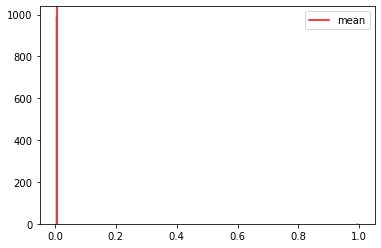

  0%|▏                                                                                | 2/1000 [00:00<00:57, 17.44it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654365163
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 0.1, 'jump_size_a': 0.1, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:25, 11.66it/s]

Monte Carlo 3
Monte Carlo 4
Monte Carlo 5


  1%|▌                                                                                | 7/1000 [00:00<02:11,  7.57it/s]

Monte Carlo 6
Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:01<02:13,  7.43it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 11/1000 [00:01<02:12,  7.48it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<02:14,  7.34it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<02:18,  7.13it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:02<02:19,  7.04it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<02:10,  7.54it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<02:07,  7.67it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<02:10,  7.47it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:03<02:15,  7.20it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<02:24,  6.72it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:23,  6.74it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:04<02:27,  6.58it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:04<02:18,  7.00it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<02:09,  7.43it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:08,  7.51it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:05<02:07,  7.56it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:05<02:05,  7.67it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<02:08,  7.47it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:06<02:17,  6.96it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:06<02:23,  6.65it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:06<02:27,  6.45it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:07<02:32,  6.22it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:07<02:31,  6.26it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:07<02:37,  6.01it/s]

Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:07<02:35,  6.08it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:08<02:33,  6.13it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:08<02:28,  6.32it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:08<02:31,  6.18it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:09<02:33,  6.09it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:09<02:27,  6.32it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:09<02:20,  6.63it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:10<02:11,  7.08it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:10<02:11,  7.04it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:10<02:21,  6.55it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:10<02:17,  6.71it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:11<02:20,  6.58it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▎                                                                         | 79/1000 [00:11<02:20,  6.56it/s]

Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:11<02:50,  5.40it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:12<02:37,  5.84it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:12<02:28,  6.17it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:12<02:23,  6.37it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:13<02:25,  6.28it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:13<02:18,  6.54it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:13<02:14,  6.76it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:14<02:11,  6.87it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:14<02:08,  7.04it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:14<02:10,  6.93it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:14<02:19,  6.47it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:15<02:18,  6.50it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:15<02:24,  6.21it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:15<02:22,  6.25it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:16<02:23,  6.21it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:16<02:18,  6.41it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:16<02:25,  6.09it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:17<02:25,  6.07it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:17<02:25,  6.06it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:17<02:28,  5.92it/s]

Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:18<02:25,  6.03it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:18<02:23,  6.12it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:18<02:22,  6.13it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:18<02:18,  6.32it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:19<02:20,  6.20it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:19<02:18,  6.30it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:19<02:19,  6.24it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:20<02:19,  6.21it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:20<02:23,  6.02it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:20<02:37,  5.49it/s]

Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:21<02:27,  5.82it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:21<02:26,  5.86it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:21<02:29,  5.73it/s]

Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:22<02:28,  5.76it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:22<02:19,  6.14it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:22<02:23,  5.95it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:22<02:24,  5.90it/s]

Monte Carlo 149
Monte Carlo 150


 15%|███████████▉                                                                   | 151/1000 [00:23<02:20,  6.04it/s]

Monte Carlo 151


 15%|████████████                                                                   | 152/1000 [00:23<02:48,  5.03it/s]

Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:23<02:55,  4.81it/s]

Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:24<02:41,  5.23it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:24<02:26,  5.77it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:24<02:29,  5.62it/s]

Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:24<02:35,  5.40it/s]

Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:25<02:31,  5.53it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:25<02:29,  5.59it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:25<02:18,  6.01it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:26<02:17,  6.07it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:26<02:19,  5.95it/s]

Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:26<02:28,  5.60it/s]

Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:26<02:28,  5.57it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:27<02:24,  5.71it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:27<02:25,  5.66it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:27<02:24,  5.68it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:28<02:38,  5.16it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▏                                                                | 180/1000 [00:28<02:45,  4.97it/s]

Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:28<02:47,  4.88it/s]

Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:29<02:45,  4.93it/s]

Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:29<02:34,  5.29it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:29<02:28,  5.49it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:29<02:23,  5.67it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:30<02:17,  5.88it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:30<02:13,  6.07it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:30<02:13,  6.05it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:31<02:09,  6.21it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:31<02:10,  6.16it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:31<02:10,  6.15it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:32<02:12,  6.02it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:32<02:19,  5.70it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:33<02:29,  5.31it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:33<02:27,  5.38it/s]

Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:33<02:29,  5.30it/s]

Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:33<02:27,  5.37it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:33<02:25,  5.41it/s]

Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:34<02:27,  5.35it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:34<02:24,  5.44it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:34<02:22,  5.53it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:34<02:26,  5.36it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:35<02:23,  5.47it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:35<02:25,  5.39it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:35<02:20,  5.56it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:35<02:26,  5.31it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:36<02:27,  5.26it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:36<02:27,  5.28it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:36<02:24,  5.36it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:36<02:27,  5.24it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:36<02:25,  5.33it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:37<02:26,  5.28it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:37<02:24,  5.34it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:37<02:25,  5.27it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:38<02:22,  5.37it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:38<02:20,  5.43it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:38<02:22,  5.34it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:39<02:22,  5.35it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:39<02:21,  5.39it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:39<02:23,  5.31it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:39<02:18,  5.46it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████                                                            | 242/1000 [00:39<02:34,  4.92it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:40<02:34,  4.91it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:40<02:29,  5.04it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:40<02:32,  4.93it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▌                                                           | 248/1000 [00:41<02:36,  4.81it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:41<02:37,  4.75it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:41<02:38,  4.73it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 252/1000 [00:41<02:44,  4.56it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:42<02:38,  4.71it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:42<02:34,  4.83it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▏                                                          | 256/1000 [00:42<02:40,  4.65it/s]

Monte Carlo 256


 26%|████████████████████▎                                                          | 257/1000 [00:43<02:52,  4.31it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:43<02:42,  4.56it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 260/1000 [00:43<02:40,  4.60it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:44<02:36,  4.72it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 263/1000 [00:44<02:37,  4.69it/s]

Monte Carlo 263


 26%|████████████████████▊                                                          | 264/1000 [00:44<03:13,  3.81it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:45<02:54,  4.20it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:45<02:42,  4.51it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:45<02:34,  4.73it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:45<02:33,  4.75it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:46<02:26,  4.98it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:46<02:24,  5.04it/s]

Monte Carlo 272
Monte Carlo 273


 27%|█████████████████████▋                                                         | 274/1000 [00:46<02:24,  5.02it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:47<02:32,  4.74it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:47<02:25,  4.96it/s]

Monte Carlo 276
Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:47<02:24,  4.98it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:48<02:28,  4.84it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:48<02:23,  4.99it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:48<02:27,  4.86it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:49<02:26,  4.89it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:49<02:26,  4.87it/s]

Monte Carlo 286
Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:49<02:31,  4.71it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:50<02:28,  4.77it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:50<02:25,  4.88it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:50<02:24,  4.91it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:50<02:23,  4.91it/s]

Monte Carlo 292
Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:51<02:27,  4.77it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:51<02:27,  4.78it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:51<02:26,  4.80it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:51<02:28,  4.71it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:52<02:26,  4.76it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:52<02:22,  4.92it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:52<02:21,  4.94it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:52<02:22,  4.88it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:52<02:22,  4.90it/s]

Monte Carlo 303
Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:53<02:22,  4.86it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:53<02:20,  4.93it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:53<02:24,  4.80it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:53<02:26,  4.72it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:54<02:30,  4.60it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:54<02:30,  4.59it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:54<02:28,  4.65it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:54<02:29,  4.61it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:54<02:31,  4.55it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:55<02:30,  4.54it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:55<02:25,  4.69it/s]

Monte Carlo 315
Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:55<02:29,  4.57it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:56<02:27,  4.63it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:56<02:25,  4.69it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:56<02:25,  4.67it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:56<02:29,  4.54it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:57<02:30,  4.50it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:57<02:33,  4.39it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:57<02:30,  4.50it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:57<02:31,  4.44it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:57<02:33,  4.38it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:58<02:34,  4.36it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:58<02:35,  4.32it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:58<02:31,  4.42it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:58<02:33,  4.35it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:59<02:30,  4.43it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:59<02:35,  4.28it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:59<02:32,  4.38it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:59<02:35,  4.28it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [01:00<02:39,  4.17it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [01:00<02:35,  4.27it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [01:00<02:34,  4.28it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [01:00<02:32,  4.34it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [01:01<02:37,  4.20it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [01:01<02:37,  4.20it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [01:01<02:34,  4.26it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [01:01<02:34,  4.26it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [01:01<02:38,  4.14it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:02<02:39,  4.11it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:02<02:42,  4.02it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:02<02:40,  4.07it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:02<02:42,  4.02it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:03<02:43,  3.98it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:03<02:39,  4.06it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:03<02:37,  4.13it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:04<02:47,  3.88it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:04<02:53,  3.73it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:04<02:51,  3.76it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:04<02:44,  3.91it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:05<02:45,  3.90it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:05<02:40,  4.00it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:05<02:41,  3.97it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:05<02:41,  3.96it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:06<02:39,  4.00it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:06<03:04,  3.47it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:06<03:00,  3.53it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:06<02:54,  3.65it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:07<02:45,  3.83it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:07<02:42,  3.91it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:07<02:36,  4.06it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:07<02:38,  3.98it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:08<02:40,  3.94it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:08<02:42,  3.89it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:08<02:44,  3.82it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:08<02:46,  3.77it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:09<02:40,  3.90it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:09<02:51,  3.67it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:09<02:49,  3.68it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:10<02:48,  3.71it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:10<02:54,  3.58it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:10<02:56,  3.53it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:10<03:00,  3.44it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:11<03:05,  3.34it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:11<03:05,  3.34it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:11<03:08,  3.29it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:12<03:06,  3.32it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:12<03:02,  3.39it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:12<03:00,  3.41it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:13<02:55,  3.51it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:13<02:46,  3.69it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:13<02:42,  3.76it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:13<02:44,  3.72it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:14<02:42,  3.76it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:14<02:37,  3.87it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:14<02:38,  3.83it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:14<02:42,  3.74it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:15<02:46,  3.66it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:15<02:46,  3.64it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:15<02:41,  3.74it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:15<02:41,  3.73it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:16<02:42,  3.72it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:16<02:41,  3.73it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:16<02:40,  3.74it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:16<02:39,  3.77it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:17<02:37,  3.81it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:17<02:36,  3.83it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:17<02:34,  3.87it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:18<02:39,  3.73it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:18<02:38,  3.75it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:18<02:43,  3.63it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:18<02:39,  3.71it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:19<02:41,  3.67it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:19<02:37,  3.75it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:19<02:36,  3.78it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:19<02:37,  3.73it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:20<02:39,  3.69it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:20<02:38,  3.69it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:20<02:36,  3.73it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:21<02:37,  3.71it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:21<02:37,  3.70it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:21<02:36,  3.74it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:21<02:34,  3.76it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:22<02:37,  3.70it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:22<02:37,  3.67it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:22<02:39,  3.63it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:22<02:40,  3.61it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:23<02:36,  3.68it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:23<02:40,  3.58it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:23<02:41,  3.56it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:24<02:43,  3.51it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:24<02:45,  3.47it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:24<02:42,  3.52it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:24<02:43,  3.49it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:25<02:40,  3.55it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:25<02:38,  3.60it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:25<02:34,  3.69it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:26<02:35,  3.65it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:26<02:33,  3.68it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:26<02:32,  3.70it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:26<02:30,  3.75it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:27<02:34,  3.66it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:27<02:32,  3.69it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:27<02:31,  3.69it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:27<02:33,  3.65it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:28<02:33,  3.64it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:28<02:32,  3.66it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:28<02:31,  3.68it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:29<02:40,  3.47it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:29<02:36,  3.55it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:29<02:36,  3.54it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:29<02:40,  3.45it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:30<02:38,  3.48it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:30<02:40,  3.44it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:30<02:37,  3.50it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:31<02:38,  3.46it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:31<02:37,  3.48it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:31<02:33,  3.57it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:31<02:34,  3.53it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:32<02:34,  3.52it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:32<02:37,  3.46it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:32<02:35,  3.50it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:33<02:34,  3.50it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:33<02:36,  3.46it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:33<02:33,  3.53it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:33<02:39,  3.37it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:34<02:39,  3.38it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:34<02:37,  3.41it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:34<02:35,  3.44it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:35<02:36,  3.41it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:35<02:35,  3.43it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:35<02:31,  3.52it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:35<02:33,  3.46it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:36<02:32,  3.47it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:36<02:37,  3.36it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:36<02:34,  3.43it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:37<02:36,  3.37it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:37<02:34,  3.40it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:37<02:31,  3.48it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:37<02:31,  3.47it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:38<02:31,  3.47it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:38<02:34,  3.40it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:38<02:36,  3.34it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:39<02:33,  3.40it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:39<02:34,  3.36it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:39<02:34,  3.35it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:40<02:37,  3.29it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:40<02:32,  3.39it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:40<02:32,  3.38it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:40<02:36,  3.30it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:41<02:31,  3.39it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:41<02:33,  3.34it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:41<02:35,  3.28it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:42<02:39,  3.20it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:42<02:37,  3.23it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:42<02:33,  3.31it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:43<02:34,  3.29it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:43<02:38,  3.20it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:43<02:39,  3.18it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:44<02:41,  3.13it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:44<02:43,  3.09it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:44<02:37,  3.19it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:45<02:34,  3.25it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:45<02:34,  3.25it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:45<02:32,  3.27it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:45<02:30,  3.32it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:46<02:28,  3.35it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:46<02:28,  3.34it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:46<02:30,  3.29it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:47<02:35,  3.19it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:47<02:35,  3.18it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:47<02:33,  3.22it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:48<02:35,  3.17it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:48<02:33,  3.20it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:48<02:32,  3.22it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:49<02:32,  3.20it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:49<02:38,  3.08it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:49<02:34,  3.15it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:50<02:34,  3.14it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:50<02:34,  3.14it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:50<02:52,  2.81it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:51<02:47,  2.88it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:51<02:37,  3.06it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:51<02:29,  3.21it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:51<02:28,  3.23it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:52<02:25,  3.30it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:52<02:22,  3.34it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:52<02:21,  3.38it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:53<02:24,  3.28it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:53<02:24,  3.28it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:53<02:22,  3.33it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:54<02:22,  3.33it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:54<02:19,  3.38it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:54<02:22,  3.31it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:54<02:21,  3.31it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:55<02:23,  3.27it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:55<02:20,  3.34it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:55<02:22,  3.28it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:56<02:22,  3.26it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:56<02:25,  3.19it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:56<02:23,  3.23it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:57<02:24,  3.21it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:57<02:25,  3.17it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:57<02:22,  3.23it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:58<02:21,  3.25it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:58<02:18,  3.32it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:58<02:22,  3.21it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:58<02:23,  3.18it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:59<02:21,  3.23it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:59<02:21,  3.22it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:59<02:20,  3.24it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [02:00<02:21,  3.20it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [02:00<02:17,  3.30it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [02:00<02:18,  3.25it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [02:01<02:17,  3.27it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [02:01<02:16,  3.29it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [02:01<02:15,  3.31it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [02:02<02:17,  3.24it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [02:02<02:21,  3.16it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [02:02<02:19,  3.20it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [02:03<02:22,  3.12it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [02:03<02:19,  3.17it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [02:03<02:21,  3.13it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [02:04<02:23,  3.06it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [02:04<02:23,  3.07it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [02:04<02:22,  3.07it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [02:04<02:21,  3.10it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [02:05<02:24,  3.02it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [02:05<02:22,  3.06it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [02:06<02:28,  2.93it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [02:06<02:26,  2.96it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:06<02:23,  3.01it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:06<02:21,  3.06it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:07<02:17,  3.13it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:07<02:18,  3.10it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:07<02:16,  3.15it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:08<02:15,  3.17it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:08<02:15,  3.14it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:08<02:18,  3.09it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:09<02:18,  3.07it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:09<02:15,  3.13it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:09<02:13,  3.17it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:10<02:18,  3.04it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:10<02:16,  3.08it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:10<02:15,  3.10it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:11<02:18,  3.03it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:11<02:19,  3.00it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:11<02:21,  2.95it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:12<02:19,  2.98it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:12<02:17,  3.02it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:12<02:17,  3.02it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:13<02:18,  2.98it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:13<02:20,  2.94it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:13<02:20,  2.93it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:14<02:17,  2.98it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:14<02:15,  3.03it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:14<02:17,  2.97it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:15<02:16,  2.97it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:15<02:19,  2.91it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:15<02:21,  2.86it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:16<02:22,  2.83it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:16<02:18,  2.91it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:16<02:19,  2.89it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:17<02:17,  2.91it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:17<02:17,  2.91it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:18<02:18,  2.88it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:18<02:16,  2.91it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:18<02:15,  2.92it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:19<02:16,  2.90it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:19<02:18,  2.85it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:19<02:19,  2.82it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:20<02:20,  2.79it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:20<02:20,  2.78it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:20<02:20,  2.78it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:21<02:20,  2.78it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:21<02:18,  2.82it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:21<02:20,  2.76it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:22<02:18,  2.80it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:22<02:18,  2.79it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:23<02:19,  2.75it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:23<02:35,  2.48it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:23<02:32,  2.51it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:24<02:28,  2.57it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:24<02:25,  2.61it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:24<02:23,  2.65it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:25<02:22,  2.65it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:25<02:20,  2.70it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:26<02:18,  2.73it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:26<02:16,  2.75it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:26<02:15,  2.77it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:27<02:14,  2.78it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:27<02:15,  2.76it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:27<02:18,  2.68it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:28<02:20,  2.64it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:28<02:20,  2.63it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:29<02:18,  2.67it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:29<02:18,  2.65it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:29<02:18,  2.65it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:30<02:18,  2.63it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:30<02:16,  2.68it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:30<02:13,  2.73it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:31<02:13,  2.72it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:31<02:10,  2.77it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:32<02:12,  2.73it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:32<02:11,  2.75it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:32<02:08,  2.79it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:33<02:09,  2.77it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:33<02:06,  2.83it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:33<02:08,  2.77it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:34<02:10,  2.71it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:34<02:10,  2.72it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:34<02:08,  2.75it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:35<02:08,  2.75it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:35<02:08,  2.72it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:35<02:07,  2.75it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:36<02:05,  2.79it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:36<02:05,  2.77it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:37<02:04,  2.79it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:37<02:03,  2.81it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:37<02:03,  2.80it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:38<02:05,  2.75it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:38<02:06,  2.72it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:38<02:11,  2.61it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:39<02:08,  2.65it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:39<02:06,  2.70it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:40<02:05,  2.70it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:40<02:03,  2.73it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:40<02:04,  2.71it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:41<02:04,  2.71it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:41<02:03,  2.70it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:41<02:02,  2.73it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:42<02:02,  2.72it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:42<02:03,  2.70it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:42<02:02,  2.70it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:43<02:03,  2.68it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:43<02:02,  2.68it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:44<02:01,  2.71it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:44<02:02,  2.67it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:44<01:59,  2.72it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:45<02:00,  2.70it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:45<01:58,  2.74it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:45<02:01,  2.66it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:46<02:02,  2.63it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:46<02:00,  2.66it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:47<02:00,  2.66it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:47<01:58,  2.69it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:47<01:58,  2.68it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:48<01:57,  2.70it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:48<01:56,  2.71it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:48<01:57,  2.68it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:49<01:57,  2.68it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:49<01:56,  2.68it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:50<01:56,  2.68it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:50<01:58,  2.62it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:50<01:59,  2.60it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:51<02:00,  2.55it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:51<02:03,  2.50it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:52<02:07,  2.42it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:52<02:01,  2.51it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:52<01:58,  2.57it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:53<01:58,  2.57it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:53<01:58,  2.56it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:54<01:54,  2.63it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:54<01:52,  2.67it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:54<01:56,  2.57it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:55<01:56,  2.57it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:55<01:55,  2.59it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:55<01:54,  2.60it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:56<01:54,  2.59it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:56<01:51,  2.64it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:57<01:50,  2.67it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:57<01:51,  2.63it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:57<01:53,  2.57it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:58<01:52,  2.60it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:58<01:50,  2.63it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:58<01:48,  2.66it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:59<01:48,  2.65it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:59<01:49,  2.63it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [03:00<01:50,  2.60it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [03:00<01:48,  2.62it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [03:00<01:47,  2.63it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [03:01<01:49,  2.58it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [03:01<01:50,  2.56it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [03:02<01:49,  2.57it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [03:02<01:48,  2.58it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [03:02<01:49,  2.54it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [03:03<01:48,  2.56it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [03:03<01:48,  2.55it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [03:04<01:46,  2.58it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [03:04<01:47,  2.55it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [03:04<01:48,  2.52it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [03:05<01:46,  2.58it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [03:05<01:45,  2.57it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [03:05<01:45,  2.57it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [03:06<01:45,  2.57it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [03:06<01:42,  2.63it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [03:07<01:39,  2.68it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [03:07<01:39,  2.69it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [03:07<01:39,  2.67it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [03:08<01:38,  2.69it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [03:08<01:38,  2.68it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [03:08<01:37,  2.71it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [03:09<01:36,  2.73it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:09<01:35,  2.73it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:10<01:33,  2.78it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:10<01:41,  2.56it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:10<01:37,  2.64it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:11<01:36,  2.66it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:11<01:36,  2.64it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:11<01:36,  2.65it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:12<01:34,  2.69it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:12<01:34,  2.68it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:13<01:35,  2.63it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:13<01:35,  2.64it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:13<01:35,  2.63it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:14<01:33,  2.68it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:14<01:33,  2.66it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:14<01:31,  2.69it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:15<01:31,  2.70it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:15<01:30,  2.71it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:16<01:29,  2.73it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:16<01:31,  2.67it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:16<01:31,  2.66it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:17<01:30,  2.67it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:17<01:29,  2.69it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:17<01:30,  2.64it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:18<01:30,  2.62it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:18<01:29,  2.65it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:19<01:29,  2.64it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:19<01:29,  2.64it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:19<01:29,  2.62it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:20<01:27,  2.66it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:20<01:29,  2.60it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:21<01:29,  2.57it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:21<01:26,  2.65it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:21<01:26,  2.66it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:22<01:26,  2.65it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:22<01:24,  2.70it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:22<01:27,  2.58it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:23<01:26,  2.59it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:23<01:25,  2.63it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:24<01:24,  2.63it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:24<01:26,  2.57it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:24<01:27,  2.53it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:25<01:28,  2.50it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:25<01:26,  2.52it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:26<01:27,  2.50it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:26<01:27,  2.48it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:26<01:26,  2.48it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:27<01:28,  2.43it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:27<01:27,  2.44it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:28<01:28,  2.42it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:28<01:27,  2.42it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:28<01:29,  2.36it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:29<01:28,  2.36it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:29<01:27,  2.39it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:30<01:27,  2.38it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:30<01:25,  2.42it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:31<01:25,  2.42it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:31<01:24,  2.41it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:31<01:25,  2.38it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:32<01:23,  2.42it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:32<01:23,  2.43it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:33<01:25,  2.36it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:33<01:25,  2.35it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:34<01:23,  2.37it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:34<01:23,  2.36it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:34<01:22,  2.40it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:35<01:25,  2.29it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:35<01:22,  2.36it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:36<01:21,  2.37it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:36<01:21,  2.38it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:36<01:22,  2.34it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:37<01:22,  2.33it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:37<01:20,  2.36it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:38<01:19,  2.37it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:38<01:20,  2.35it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:39<01:19,  2.34it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:39<01:19,  2.34it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:39<01:19,  2.32it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:40<01:19,  2.32it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:40<01:17,  2.36it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:41<01:17,  2.33it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:41<01:19,  2.27it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:42<01:17,  2.33it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:42<01:16,  2.35it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:43<01:17,  2.30it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:43<01:17,  2.29it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:43<01:16,  2.31it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:44<01:15,  2.31it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:44<01:15,  2.30it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:45<01:15,  2.30it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:45<01:14,  2.32it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:46<01:14,  2.28it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:46<01:15,  2.25it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:46<01:14,  2.27it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:47<01:15,  2.23it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:47<01:16,  2.19it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:48<01:16,  2.18it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:48<01:15,  2.20it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:49<01:13,  2.23it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:49<01:12,  2.25it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:50<01:17,  2.09it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:50<01:13,  2.18it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:51<01:11,  2.25it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:51<01:11,  2.22it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:51<01:10,  2.23it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:52<01:09,  2.26it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:52<01:08,  2.28it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:53<01:07,  2.30it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:53<01:07,  2.29it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:54<01:07,  2.28it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:54<01:06,  2.27it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:55<01:06,  2.28it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:55<01:06,  2.26it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:55<01:06,  2.24it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:56<01:06,  2.23it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:56<01:06,  2.21it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:57<01:04,  2.25it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:57<01:04,  2.26it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:58<01:03,  2.27it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:58<01:03,  2.23it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:59<01:02,  2.26it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:59<01:02,  2.24it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:59<01:02,  2.24it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [04:00<01:01,  2.25it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [04:00<01:00,  2.27it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [04:01<01:00,  2.26it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [04:01<01:00,  2.25it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [04:02<01:00,  2.24it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [04:02<00:59,  2.24it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [04:03<00:59,  2.24it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [04:03<00:58,  2.26it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [04:03<00:59,  2.21it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [04:04<00:58,  2.23it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [04:04<00:56,  2.27it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [04:05<00:56,  2.27it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [04:05<00:55,  2.29it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [04:06<00:54,  2.31it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [04:06<00:54,  2.29it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [04:07<00:55,  2.24it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [04:07<00:54,  2.25it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [04:07<00:54,  2.25it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [04:08<00:53,  2.25it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [04:08<00:53,  2.24it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [04:09<00:52,  2.26it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [04:09<00:52,  2.23it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [04:10<00:50,  2.30it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [04:10<00:50,  2.30it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [04:10<00:49,  2.33it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [04:11<00:48,  2.34it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [04:11<00:47,  2.38it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [04:12<00:47,  2.37it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [04:12<00:48,  2.30it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [04:13<00:46,  2.34it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:13<00:46,  2.32it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:13<00:47,  2.29it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:14<00:46,  2.31it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:14<00:45,  2.31it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:15<00:44,  2.35it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:15<00:44,  2.33it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:16<00:44,  2.32it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:16<00:43,  2.34it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:16<00:42,  2.35it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:17<00:42,  2.35it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:17<00:42,  2.35it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:18<00:42,  2.32it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:18<00:41,  2.34it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:19<00:41,  2.33it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:19<00:40,  2.35it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:19<00:40,  2.31it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:20<00:40,  2.27it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:20<00:40,  2.27it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:21<00:40,  2.25it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:21<00:40,  2.24it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:22<00:41,  2.14it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:22<00:40,  2.17it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:23<00:40,  2.15it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:23<00:39,  2.16it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:24<00:38,  2.18it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:24<00:39,  2.15it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:25<00:38,  2.15it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:25<00:38,  2.11it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:26<00:38,  2.09it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:26<00:38,  2.10it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:26<00:36,  2.15it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:27<00:36,  2.13it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:27<00:36,  2.14it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:28<00:35,  2.16it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:28<00:34,  2.18it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:29<00:34,  2.13it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:29<00:33,  2.16it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:30<00:33,  2.15it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:30<00:32,  2.18it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:31<00:33,  2.12it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:31<00:32,  2.15it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:32<00:31,  2.15it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:32<00:31,  2.16it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:32<00:30,  2.15it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:33<00:30,  2.16it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:33<00:30,  2.12it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:34<00:29,  2.10it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:34<00:29,  2.11it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:35<00:28,  2.12it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:35<00:28,  2.14it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:36<00:27,  2.16it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:36<00:27,  2.10it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:37<00:26,  2.13it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:37<00:26,  2.12it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:38<00:26,  2.09it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:38<00:25,  2.12it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:39<00:24,  2.13it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:39<00:26,  1.99it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:40<00:24,  2.06it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:40<00:23,  2.10it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:41<00:23,  2.08it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:41<00:22,  2.11it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:42<00:22,  2.10it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:42<00:21,  2.12it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:42<00:21,  2.14it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:43<00:20,  2.14it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:43<00:20,  2.11it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:44<00:19,  2.14it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:44<00:19,  2.12it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:45<00:18,  2.12it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:45<00:18,  2.12it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:46<00:18,  2.07it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:46<00:17,  2.08it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:47<00:17,  2.10it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:47<00:16,  2.09it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:48<00:16,  2.11it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:48<00:15,  2.09it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:49<00:15,  2.09it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:49<00:14,  2.12it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:50<00:14,  2.11it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:50<00:13,  2.08it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:51<00:13,  2.07it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:51<00:12,  2.11it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:51<00:12,  2.10it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:52<00:12,  2.06it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:52<00:11,  2.06it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:53<00:11,  2.07it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:53<00:10,  2.06it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:54<00:10,  2.03it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:54<00:09,  2.06it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:55<00:09,  2.04it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:55<00:08,  2.06it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:56<00:08,  2.08it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:56<00:07,  2.08it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:57<00:07,  2.04it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:57<00:06,  2.04it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:58<00:06,  2.07it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:58<00:05,  2.13it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:59<00:05,  2.15it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:59<00:04,  2.13it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [05:00<00:04,  2.16it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [05:00<00:03,  2.17it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [05:01<00:03,  2.19it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [05:01<00:02,  2.17it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [05:02<00:02,  2.08it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [05:02<00:01,  2.08it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [05:03<00:01,  2.04it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [05:03<00:00,  2.05it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [05:04<00:00,  2.06it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [05:04<00:00,  3.28it/s]


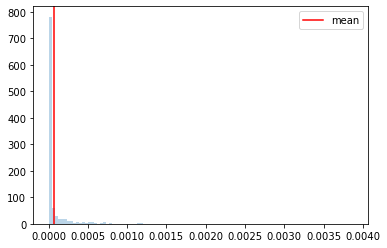

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654365468
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 0.1, 'jump_size_a': 0.1, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:07, 14.75it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:43,  9.63it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:52,  8.79it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▉                                                                               | 11/1000 [00:01<01:42,  9.63it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:44,  9.44it/s]

Monte Carlo 11
Monte Carlo 12


  2%|█▏                                                                              | 15/1000 [00:01<01:47,  9.19it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:52,  8.76it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:53,  8.65it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▋                                                                              | 21/1000 [00:02<01:47,  9.14it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:52,  8.69it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:57,  8.30it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:53,  8.60it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:51,  8.71it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:02,  7.92it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<01:57,  8.27it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<01:53,  8.51it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<01:46,  9.05it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 39/1000 [00:04<01:45,  9.12it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:51,  8.64it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<01:56,  8.20it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:04<01:53,  8.45it/s]

Monte Carlo 43
Monte Carlo 44


  4%|███▌                                                                            | 45/1000 [00:05<01:56,  8.20it/s]

Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:33,  6.21it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<02:28,  6.41it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:20,  6.75it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:10,  7.23it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:12,  7.14it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<02:15,  6.96it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:09,  7.24it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:10,  7.21it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:04,  7.54it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:10,  7.16it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:08,  7.25it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:10,  7.11it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:10,  7.14it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:09,  7.15it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:06,  7.33it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:12,  6.95it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:18,  6.65it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:17,  6.70it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:14,  6.82it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:22,  6.44it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:17,  6.65it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:13,  6.82it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:19,  6.50it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:16,  6.67it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:13,  6.78it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:20,  6.44it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:13<02:16,  6.60it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:15,  6.64it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:10,  6.90it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:05,  7.11it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:13,  6.68it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:14,  6.63it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:10,  6.83it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<02:13,  6.66it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:18,  6.40it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:22,  6.19it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:16<02:17,  6.42it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:19,  6.32it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:18,  6.34it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:17<02:17,  6.37it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:22,  6.13it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:25,  5.97it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:18<02:22,  6.08it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:18<02:21,  6.13it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:23,  6.04it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:19<02:23,  6.00it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:19<02:27,  5.83it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:22,  6.03it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:20<02:22,  6.03it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:20<02:23,  5.97it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:27,  5.79it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:21<02:31,  5.62it/s]

Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:21<02:26,  5.81it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:21<02:26,  5.79it/s]

Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<02:28,  5.71it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:22<02:24,  5.85it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:22<02:20,  5.98it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:22,  5.91it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:23<02:23,  5.83it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:23<02:23,  5.83it/s]

Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:23<02:24,  5.79it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:24<02:22,  5.85it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:24<02:22,  5.84it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:24<02:19,  5.95it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:18,  5.96it/s]

Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:25<02:41,  5.12it/s]

Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:25<02:34,  5.33it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:25<02:34,  5.34it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:26<02:33,  5.34it/s]

Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:26<02:34,  5.32it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:26<02:30,  5.43it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:26<02:26,  5.58it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:27<02:28,  5.50it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:27<02:23,  5.69it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:28<02:22,  5.70it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:28<02:24,  5.62it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:28<02:24,  5.60it/s]

Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:28<02:27,  5.45it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:29<02:29,  5.40it/s]

Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:29<02:33,  5.25it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▍                                                               | 196/1000 [00:29<02:40,  5.02it/s]

Monte Carlo 196


 20%|███████████████▌                                                               | 197/1000 [00:29<02:39,  5.02it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:30<02:41,  4.95it/s]

Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:30<02:41,  4.97it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 201/1000 [00:30<02:40,  4.97it/s]

Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:31<02:45,  4.82it/s]

Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:31<02:45,  4.81it/s]

Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:31<02:41,  4.93it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 206/1000 [00:31<02:45,  4.79it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:32<02:41,  4.92it/s]

Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:32<02:34,  5.12it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:32<02:27,  5.34it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:32<02:33,  5.12it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:33<02:33,  5.13it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:33<02:30,  5.21it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:33<02:27,  5.32it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:33<02:29,  5.23it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:34<02:25,  5.39it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:34<02:20,  5.56it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:34<02:27,  5.25it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:35<02:25,  5.32it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:35<02:28,  5.20it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:35<02:27,  5.25it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:36<02:31,  5.07it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:36<02:34,  4.99it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:36<02:36,  4.90it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:36<02:35,  4.92it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:37<02:30,  5.11it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▌                                                            | 235/1000 [00:37<02:29,  5.13it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:37<02:29,  5.10it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:37<02:28,  5.14it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:37<02:24,  5.28it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:38<02:23,  5.29it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:38<02:23,  5.30it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▏                                                           | 243/1000 [00:38<02:32,  4.98it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:39<02:29,  5.04it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:39<02:33,  4.92it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:39<02:30,  4.99it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:40<02:28,  5.05it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:40<02:28,  5.06it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:40<02:27,  5.08it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:40<02:25,  5.15it/s]

Monte Carlo 252
Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:41<02:30,  4.96it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:41<02:29,  4.96it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:41<02:30,  4.93it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:42<02:32,  4.85it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:42<02:33,  4.83it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▌                                                          | 261/1000 [00:42<02:35,  4.76it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:42<02:36,  4.71it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:43<02:39,  4.61it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 266/1000 [00:43<02:43,  4.49it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:43<02:36,  4.67it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:44<02:33,  4.76it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:44<02:40,  4.55it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 271/1000 [00:44<02:43,  4.45it/s]

Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:44<02:39,  4.56it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:45<02:34,  4.71it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:45<02:33,  4.73it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:45<02:34,  4.70it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 277/1000 [00:45<02:33,  4.71it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:46<02:32,  4.72it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:46<02:31,  4.76it/s]

Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:46<02:30,  4.77it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:46<02:31,  4.75it/s]

Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:47<02:31,  4.72it/s]

Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:47<02:29,  4.78it/s]

Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:47<02:31,  4.73it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:48<02:28,  4.80it/s]

Monte Carlo 286
Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:48<02:28,  4.80it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:48<02:29,  4.75it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:48<02:32,  4.65it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:48<02:34,  4.58it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:49<02:31,  4.67it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:49<02:33,  4.60it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:49<02:32,  4.62it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:50<02:30,  4.66it/s]

Monte Carlo 296
Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:50<02:36,  4.48it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:50<02:34,  4.54it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:50<02:34,  4.52it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:51<02:35,  4.48it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:51<02:41,  4.32it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:51<02:39,  4.36it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:51<02:36,  4.45it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:52<02:38,  4.37it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:52<02:36,  4.44it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:52<02:34,  4.49it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:52<02:33,  4.51it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:52<02:32,  4.54it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:53<02:37,  4.37it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:53<02:33,  4.48it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:53<02:33,  4.47it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:54<02:32,  4.49it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:54<02:53,  3.94it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:54<02:53,  3.94it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:54<02:52,  3.97it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:55<02:47,  4.07it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:55<02:46,  4.10it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:55<02:44,  4.14it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:55<02:37,  4.30it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:56<02:36,  4.34it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:56<02:31,  4.47it/s]

Monte Carlo 323
Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:56<02:35,  4.33it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:56<02:35,  4.34it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:57<02:33,  4.38it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:57<02:34,  4.34it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:57<02:35,  4.33it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:57<02:32,  4.39it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:58<02:34,  4.34it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:58<02:36,  4.27it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:58<02:36,  4.27it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:58<02:39,  4.18it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:59<02:42,  4.10it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:59<02:37,  4.21it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:59<02:41,  4.12it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:59<02:41,  4.09it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [01:00<02:38,  4.17it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [01:00<02:41,  4.10it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [01:00<02:38,  4.16it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [01:00<02:34,  4.26it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [01:00<02:35,  4.22it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [01:01<02:35,  4.21it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:01<02:33,  4.27it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:01<02:37,  4.16it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:01<02:34,  4.24it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:02<02:36,  4.16it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:02<02:35,  4.19it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:02<02:36,  4.15it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:02<02:36,  4.14it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:03<02:33,  4.21it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:03<02:30,  4.31it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:03<02:36,  4.12it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:03<02:34,  4.18it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:04<02:35,  4.15it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:04<02:31,  4.25it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:04<02:32,  4.20it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:04<02:34,  4.15it/s]

Monte Carlo 359


 36%|████████████████████████████▌                                                  | 361/1000 [01:05<02:25,  4.40it/s]

Monte Carlo 360
Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:05<02:30,  4.24it/s]

Monte Carlo 362


 36%|████████████████████████████▊                                                  | 364/1000 [01:05<02:32,  4.17it/s]

Monte Carlo 363
Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:06<02:27,  4.30it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:06<02:26,  4.32it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:06<02:24,  4.38it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:06<02:28,  4.26it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 370/1000 [01:07<02:22,  4.43it/s]

Monte Carlo 369
Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:07<02:25,  4.31it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:07<02:26,  4.28it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:08<02:25,  4.31it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:08<02:21,  4.43it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:08<02:21,  4.41it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:08<02:23,  4.35it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:08<02:31,  4.12it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:09<02:32,  4.08it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:09<02:28,  4.17it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:09<02:33,  4.03it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:09<02:30,  4.11it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:10<02:26,  4.21it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:10<02:28,  4.15it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:10<02:32,  4.05it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:10<02:30,  4.09it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:11<02:27,  4.17it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:11<02:22,  4.31it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:11<02:24,  4.23it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:11<02:23,  4.24it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:12<02:25,  4.19it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:12<02:22,  4.27it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:12<02:20,  4.33it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:12<02:18,  4.38it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:13<02:20,  4.31it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:13<02:21,  4.26it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:13<02:20,  4.30it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:13<02:23,  4.20it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:13<02:21,  4.26it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:14<02:20,  4.29it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:14<02:18,  4.34it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:14<02:19,  4.28it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:14<02:23,  4.16it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:15<02:25,  4.10it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:15<02:25,  4.11it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:15<02:29,  3.99it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:15<02:25,  4.07it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:16<02:26,  4.05it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:16<02:25,  4.07it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:16<02:28,  3.99it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:16<02:26,  4.02it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:17<02:24,  4.07it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:17<02:27,  3.98it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:17<02:30,  3.91it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:17<02:34,  3.78it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:18<02:32,  3.85it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:18<02:35,  3.77it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:18<02:32,  3.82it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:19<02:33,  3.80it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:19<02:33,  3.79it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:19<02:34,  3.74it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:19<02:34,  3.75it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:20<02:35,  3.71it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:20<02:33,  3.76it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:20<02:32,  3.79it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:20<02:33,  3.74it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:21<02:36,  3.66it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:21<02:34,  3.72it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:21<02:33,  3.73it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:21<02:36,  3.65it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:22<02:38,  3.59it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:22<02:41,  3.53it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:22<02:45,  3.42it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:23<02:48,  3.36it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:23<02:56,  3.22it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:23<02:57,  3.18it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:24<03:01,  3.11it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:24<03:06,  3.02it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:24<03:05,  3.02it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:25<03:08,  2.97it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:25<03:12,  2.91it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:25<03:10,  2.94it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:26<03:13,  2.89it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:26<03:12,  2.89it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:26<03:07,  2.96it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:27<03:06,  2.98it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:27<03:09,  2.92it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:27<03:03,  3.02it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:28<02:59,  3.08it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:28<02:57,  3.11it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:28<02:56,  3.12it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:29<02:57,  3.09it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:29<02:49,  3.22it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:29<02:47,  3.27it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:30<02:46,  3.28it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:30<02:43,  3.33it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:30<02:43,  3.33it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:30<02:46,  3.27it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:31<02:48,  3.22it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:31<02:53,  3.12it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:31<02:43,  3.29it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:32<02:40,  3.35it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:32<02:37,  3.42it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:32<02:34,  3.47it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:33<02:36,  3.43it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:33<02:31,  3.54it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:33<02:26,  3.64it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:33<02:25,  3.65it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:34<02:24,  3.69it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:34<02:49,  3.14it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:34<02:45,  3.20it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:35<02:46,  3.19it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:35<02:42,  3.25it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:35<02:39,  3.31it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:36<02:40,  3.27it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:36<02:36,  3.36it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:36<02:36,  3.34it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:36<02:38,  3.30it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:37<03:01,  2.88it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:37<02:57,  2.93it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:38<02:49,  3.07it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:38<02:44,  3.15it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:38<02:43,  3.17it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:38<02:41,  3.20it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:39<02:40,  3.22it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:39<02:40,  3.21it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:39<02:39,  3.22it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:40<02:38,  3.23it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:40<02:42,  3.15it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:40<02:44,  3.11it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:41<02:42,  3.13it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:41<02:42,  3.13it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:41<02:45,  3.06it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:42<02:38,  3.20it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:42<02:34,  3.28it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:42<02:32,  3.31it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:42<02:33,  3.29it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:43<02:33,  3.28it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:43<02:29,  3.36it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:43<02:28,  3.37it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:44<02:30,  3.33it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:44<02:29,  3.34it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:44<02:30,  3.30it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:45<02:27,  3.36it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:45<02:33,  3.23it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:45<02:31,  3.27it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:46<02:38,  3.12it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:46<02:37,  3.14it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:46<02:34,  3.18it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:46<02:32,  3.22it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:47<02:39,  3.08it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:47<02:42,  3.01it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:48<02:39,  3.06it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:48<02:35,  3.13it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:48<02:36,  3.10it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:48<02:30,  3.23it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:49<02:33,  3.16it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:49<02:41,  3.00it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:50<02:47,  2.88it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:50<02:42,  2.95it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:50<02:49,  2.83it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:50<02:38,  3.01it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:51<02:35,  3.07it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:51<02:35,  3.08it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:51<02:34,  3.09it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:52<02:33,  3.09it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:52<02:43,  2.90it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:52<02:42,  2.92it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:53<02:38,  2.98it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:53<02:34,  3.06it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:53<02:38,  2.97it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:54<02:39,  2.94it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:54<02:36,  2.98it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:55<02:39,  2.93it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:55<02:36,  2.97it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:55<02:37,  2.95it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:56<02:37,  2.95it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:56<02:38,  2.92it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:56<02:39,  2.89it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:57<02:51,  2.69it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:57<02:51,  2.68it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:57<02:48,  2.73it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:58<02:45,  2.77it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:58<02:51,  2.66it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:58<02:46,  2.75it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:59<02:39,  2.85it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:59<02:35,  2.92it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:59<02:30,  3.01it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [02:00<02:33,  2.94it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [02:00<02:31,  2.97it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [02:01<02:39,  2.82it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [02:01<02:40,  2.80it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [02:01<02:40,  2.80it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [02:02<02:42,  2.76it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [02:02<02:38,  2.82it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [02:02<02:36,  2.84it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [02:03<02:30,  2.95it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [02:03<02:26,  3.01it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [02:03<02:26,  3.01it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [02:04<02:24,  3.04it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [02:04<02:23,  3.06it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [02:04<02:27,  2.97it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [02:05<02:21,  3.09it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [02:05<02:20,  3.12it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [02:05<02:29,  2.92it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [02:06<02:29,  2.91it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [02:06<02:23,  3.02it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:06<02:21,  3.05it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:07<02:18,  3.11it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:07<02:19,  3.10it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:07<02:18,  3.11it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:08<02:25,  2.94it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:08<02:24,  2.97it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:08<02:22,  2.99it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:09<02:22,  2.99it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:09<02:38,  2.68it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:09<02:31,  2.80it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:10<02:31,  2.79it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:10<02:28,  2.85it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:10<02:25,  2.89it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:11<02:35,  2.70it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:11<02:40,  2.60it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:12<02:40,  2.60it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:12<02:39,  2.61it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:12<02:39,  2.61it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:13<02:36,  2.66it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:13<02:30,  2.75it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:13<02:25,  2.84it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:14<02:25,  2.84it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:14<02:26,  2.81it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:14<02:24,  2.84it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:15<02:24,  2.82it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:15<02:24,  2.82it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:15<02:20,  2.89it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:16<02:17,  2.95it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:16<02:14,  3.00it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:17<02:21,  2.85it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:17<02:20,  2.86it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:17<02:21,  2.84it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:18<02:19,  2.88it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:18<02:20,  2.84it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:18<02:23,  2.78it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:19<02:17,  2.89it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:19<02:16,  2.91it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:19<02:16,  2.89it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:20<02:15,  2.91it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:20<02:08,  3.06it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:20<02:08,  3.06it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:21<02:07,  3.07it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:21<02:03,  3.18it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:21<02:05,  3.12it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:21<02:03,  3.15it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:22<02:07,  3.04it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:22<02:04,  3.11it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:22<02:01,  3.17it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:23<02:00,  3.20it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:23<02:04,  3.09it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:23<02:01,  3.16it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:24<02:01,  3.14it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:24<02:02,  3.10it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:24<01:59,  3.18it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:25<01:57,  3.22it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:25<01:57,  3.23it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:25<01:57,  3.22it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:26<01:55,  3.25it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:26<01:57,  3.19it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:26<01:59,  3.12it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:27<01:57,  3.19it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:27<01:59,  3.12it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:27<01:58,  3.12it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:28<02:00,  3.08it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:28<01:58,  3.10it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:28<02:02,  3.01it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:29<02:00,  3.05it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:29<01:59,  3.07it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:29<02:00,  3.03it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:30<01:59,  3.05it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:30<01:57,  3.08it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:30<01:59,  3.02it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:31<01:59,  3.03it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:31<02:00,  2.98it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:31<02:00,  2.99it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:32<01:59,  3.00it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:32<01:59,  2.99it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:32<01:59,  2.99it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:33<01:58,  2.99it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:33<01:58,  2.99it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:33<01:55,  3.05it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:33<01:54,  3.07it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:34<01:57,  2.99it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:34<01:55,  3.02it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:34<01:53,  3.08it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:35<01:52,  3.09it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:35<01:53,  3.07it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:35<01:52,  3.07it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:36<01:55,  3.00it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:36<01:55,  2.98it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:36<01:52,  3.04it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:37<01:57,  2.90it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:37<01:54,  2.98it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:37<01:51,  3.05it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:38<01:51,  3.05it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:38<01:52,  3.01it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:38<01:48,  3.10it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:39<01:50,  3.05it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:39<01:52,  2.98it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:39<01:51,  2.99it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:40<01:53,  2.92it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:40<01:54,  2.89it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:41<01:52,  2.94it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:41<01:52,  2.93it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:41<01:56,  2.82it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:42<01:58,  2.78it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:42<01:56,  2.81it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:42<02:01,  2.68it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:43<01:58,  2.74it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:43<01:57,  2.75it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:43<01:59,  2.70it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:44<01:59,  2.70it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:44<02:00,  2.66it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:45<01:59,  2.68it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:45<01:59,  2.67it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:45<02:04,  2.56it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:46<02:03,  2.57it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:46<02:15,  2.34it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:47<02:07,  2.48it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:47<02:02,  2.55it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:47<02:03,  2.54it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:48<01:58,  2.64it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:48<01:56,  2.68it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:48<01:54,  2.71it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:49<01:55,  2.67it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:49<01:57,  2.62it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:50<01:54,  2.68it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:50<01:51,  2.75it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:50<01:50,  2.76it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:51<01:49,  2.79it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:51<01:52,  2.70it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:51<01:51,  2.70it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:52<01:57,  2.55it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:52<01:57,  2.55it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:53<01:55,  2.59it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:53<01:53,  2.62it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:53<01:51,  2.65it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:54<01:53,  2.60it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:54<01:50,  2.68it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:54<01:47,  2.72it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:55<01:47,  2.74it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:55<01:47,  2.71it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:56<01:46,  2.74it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:56<01:46,  2.72it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:56<01:46,  2.72it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:57<01:46,  2.71it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:57<01:48,  2.65it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:57<01:49,  2.62it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:58<01:47,  2.64it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:58<01:45,  2.69it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:59<01:45,  2.68it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:59<01:45,  2.68it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:59<01:43,  2.72it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [03:00<01:42,  2.73it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [03:00<01:41,  2.75it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [03:00<01:40,  2.76it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [03:01<01:40,  2.75it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [03:01<01:42,  2.69it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [03:02<01:42,  2.68it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [03:02<01:41,  2.71it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [03:02<01:41,  2.68it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [03:03<01:42,  2.66it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [03:03<01:41,  2.67it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [03:03<01:39,  2.70it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [03:04<01:41,  2.66it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [03:04<01:39,  2.70it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [03:04<01:38,  2.70it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [03:05<01:37,  2.73it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [03:05<01:39,  2.66it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [03:06<01:38,  2.69it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [03:06<01:37,  2.69it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [03:06<01:37,  2.68it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:07<01:36,  2.70it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:07<01:36,  2.68it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:07<01:37,  2.67it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:08<01:37,  2.65it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:08<01:36,  2.65it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:09<01:36,  2.65it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:09<01:35,  2.68it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:09<01:37,  2.61it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:10<01:34,  2.66it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:10<01:36,  2.62it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:11<01:35,  2.64it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:11<01:34,  2.64it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:11<01:34,  2.63it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:12<01:36,  2.58it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:12<01:34,  2.62it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:12<01:32,  2.66it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:13<01:33,  2.62it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:13<01:31,  2.66it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:14<01:31,  2.67it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:14<01:30,  2.68it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:14<01:30,  2.67it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:15<01:31,  2.61it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:15<01:30,  2.64it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:15<01:31,  2.61it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:16<01:30,  2.61it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:16<01:31,  2.58it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:17<01:32,  2.55it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:17<01:30,  2.57it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:17<01:31,  2.53it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:18<01:31,  2.54it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:18<01:40,  2.30it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:19<01:37,  2.36it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:19<01:34,  2.43it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:20<01:32,  2.47it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:20<01:30,  2.51it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:20<01:31,  2.48it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:21<01:31,  2.46it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:21<01:32,  2.43it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:22<01:33,  2.39it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:22<01:31,  2.42it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:22<01:30,  2.43it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:23<01:29,  2.46it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:23<01:28,  2.47it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:24<01:26,  2.53it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:24<01:24,  2.56it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:24<01:24,  2.55it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:25<01:23,  2.59it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:25<01:23,  2.57it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:26<01:24,  2.52it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:26<01:22,  2.57it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:26<01:21,  2.58it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:27<01:20,  2.61it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:27<01:21,  2.55it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:27<01:19,  2.63it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:28<01:18,  2.64it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:28<01:16,  2.68it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:28<01:14,  2.74it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:29<01:16,  2.65it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:29<01:17,  2.62it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:30<01:17,  2.60it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:30<01:16,  2.63it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:30<01:14,  2.67it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:31<01:17,  2.57it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:31<01:16,  2.59it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:32<01:15,  2.62it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:32<01:14,  2.64it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:32<01:14,  2.63it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:33<01:15,  2.56it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:33<01:15,  2.55it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:34<01:16,  2.52it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:34<01:15,  2.53it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:34<01:16,  2.49it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:35<01:14,  2.53it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:35<01:15,  2.47it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:36<01:14,  2.50it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:36<01:14,  2.49it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:36<01:13,  2.52it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:37<01:15,  2.45it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:37<01:14,  2.47it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:38<01:13,  2.48it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:38<01:12,  2.49it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:38<01:13,  2.47it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:39<01:12,  2.48it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:39<01:11,  2.50it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:40<01:11,  2.46it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:40<01:10,  2.48it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:40<01:10,  2.47it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:41<01:11,  2.42it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:41<01:11,  2.42it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:42<01:10,  2.45it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:42<01:08,  2.48it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:42<01:08,  2.49it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:43<01:07,  2.49it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:43<01:07,  2.47it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:44<01:09,  2.42it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:44<01:08,  2.42it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:45<01:09,  2.37it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:45<01:10,  2.31it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:45<01:08,  2.37it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:46<01:09,  2.33it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:46<01:07,  2.38it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:47<01:06,  2.42it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:47<01:05,  2.43it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:47<01:03,  2.48it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:48<01:02,  2.50it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:48<01:02,  2.52it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:49<01:01,  2.52it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:49<01:02,  2.46it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:49<01:00,  2.51it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:50<01:00,  2.50it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:50<00:59,  2.55it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:51<01:01,  2.44it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:51<01:00,  2.46it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:51<00:59,  2.50it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:52<00:59,  2.46it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:52<00:59,  2.47it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:53<00:59,  2.45it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:53<00:58,  2.46it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:54<00:59,  2.39it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:54<01:03,  2.24it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:54<01:01,  2.31it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:55<00:59,  2.34it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:55<01:00,  2.31it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:56<00:58,  2.34it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:56<00:58,  2.34it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:57<00:57,  2.36it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:57<00:57,  2.33it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:57<00:57,  2.34it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:58<00:56,  2.37it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:58<00:55,  2.36it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:59<00:55,  2.35it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:59<00:55,  2.34it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [04:00<00:54,  2.35it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [04:00<00:54,  2.33it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [04:00<00:54,  2.34it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [04:01<00:55,  2.29it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [04:01<00:56,  2.22it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [04:02<00:54,  2.27it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [04:02<00:54,  2.25it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [04:03<00:53,  2.27it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [04:03<00:52,  2.30it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [04:04<00:52,  2.28it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [04:04<00:51,  2.33it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [04:04<00:52,  2.25it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [04:05<00:51,  2.26it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [04:05<00:50,  2.28it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [04:06<00:50,  2.28it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [04:06<00:49,  2.29it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [04:07<00:49,  2.29it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [04:07<00:48,  2.29it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [04:07<00:48,  2.28it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [04:08<00:47,  2.33it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:08<00:47,  2.29it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:09<00:47,  2.25it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:09<00:46,  2.31it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:10<00:45,  2.32it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:10<00:45,  2.32it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:10<00:44,  2.33it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:11<00:43,  2.35it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:11<00:44,  2.32it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:12<00:43,  2.34it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:12<00:43,  2.28it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:13<00:44,  2.22it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:13<00:43,  2.26it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:14<00:42,  2.27it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:14<00:43,  2.23it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:14<00:42,  2.24it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:15<00:42,  2.23it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:15<00:42,  2.21it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:16<00:42,  2.14it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:16<00:42,  2.12it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:17<00:43,  2.06it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:17<00:42,  2.12it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:18<00:39,  2.21it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:18<00:38,  2.25it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:19<00:37,  2.29it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:19<00:37,  2.29it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:19<00:36,  2.33it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:20<00:35,  2.36it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:20<00:35,  2.32it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:21<00:34,  2.37it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:21<00:33,  2.39it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:22<00:33,  2.38it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:22<00:32,  2.37it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:22<00:32,  2.33it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:23<00:32,  2.36it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:23<00:32,  2.33it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:24<00:31,  2.32it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:24<00:32,  2.23it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:25<00:31,  2.25it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:25<00:31,  2.26it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:25<00:31,  2.23it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:26<00:30,  2.26it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:26<00:29,  2.29it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:27<00:29,  2.30it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:27<00:28,  2.33it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:28<00:27,  2.35it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:28<00:27,  2.34it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:28<00:26,  2.36it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:29<00:26,  2.38it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:29<00:25,  2.37it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:30<00:25,  2.37it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:30<00:25,  2.36it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:31<00:24,  2.33it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:31<00:24,  2.31it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:31<00:24,  2.30it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:32<00:23,  2.29it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:32<00:23,  2.31it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:33<00:22,  2.34it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:33<00:21,  2.38it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:34<00:21,  2.34it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:34<00:21,  2.34it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:34<00:21,  2.31it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:35<00:21,  2.26it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:35<00:20,  2.30it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:36<00:20,  2.27it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:36<00:19,  2.31it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:37<00:19,  2.29it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:37<00:18,  2.34it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:37<00:17,  2.35it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:38<00:17,  2.36it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:38<00:17,  2.34it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:39<00:18,  2.10it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:39<00:17,  2.17it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:40<00:16,  2.24it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:40<00:15,  2.26it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:41<00:15,  2.30it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:41<00:14,  2.29it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:41<00:14,  2.29it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:42<00:14,  2.22it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:42<00:14,  2.19it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:43<00:13,  2.17it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:43<00:13,  2.13it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:44<00:12,  2.16it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:44<00:12,  2.13it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:45<00:12,  2.10it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:45<00:11,  2.10it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:46<00:11,  2.08it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:46<00:11,  2.06it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:47<00:10,  2.07it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:47<00:10,  2.07it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:48<00:09,  2.04it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:48<00:09,  2.09it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:49<00:08,  2.15it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:49<00:08,  2.11it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:50<00:07,  2.12it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:50<00:07,  2.12it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:51<00:06,  2.12it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:51<00:06,  2.12it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:52<00:05,  2.07it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:52<00:05,  2.02it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:53<00:04,  2.01it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:53<00:04,  2.05it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:53<00:03,  2.07it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:54<00:03,  2.11it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:54<00:02,  2.15it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:55<00:02,  2.15it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:55<00:01,  2.14it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:56<00:01,  2.14it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:56<00:00,  2.13it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:57<00:00,  2.12it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:57<00:00,  3.36it/s]


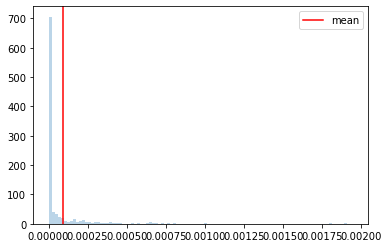

  0%|▏                                                                                | 2/1000 [00:00<00:59, 16.85it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654365767
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 0.1, 'jump_size_a': 1.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:34, 10.54it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:53,  8.78it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<02:08,  7.69it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<02:05,  7.91it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<02:05,  7.88it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<02:10,  7.53it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<02:05,  7.82it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<02:07,  7.70it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<02:09,  7.55it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<02:06,  7.74it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<02:03,  7.90it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<02:06,  7.71it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:13,  7.27it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:21,  6.83it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:04<02:17,  7.06it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:05,  7.71it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<01:59,  8.09it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:56,  8.22it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:05<01:53,  8.43it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<01:57,  8.18it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<02:04,  7.70it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<02:20,  6.81it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 47/1000 [00:06<02:17,  6.93it/s]

Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:06<02:48,  5.63it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:37,  6.01it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:07<02:28,  6.36it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:07<02:18,  6.81it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<02:15,  6.94it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:15,  6.95it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:08<02:16,  6.86it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:08<02:08,  7.27it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:04,  7.50it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:09<02:04,  7.50it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:09<02:04,  7.46it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:09<01:57,  7.88it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<01:58,  7.82it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:10<02:00,  7.67it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:10<01:57,  7.83it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:15,  6.80it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:13,  6.90it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:11<02:05,  7.30it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:11<02:18,  6.61it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:15,  6.73it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:12<02:15,  6.71it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:12<02:09,  7.00it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:07,  7.14it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:03,  7.31it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:13<02:07,  7.11it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:13<02:04,  7.22it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:12,  6.78it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:14<02:12,  6.77it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:14<02:09,  6.91it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:10,  6.85it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:05,  7.12it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:15<02:17,  6.48it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<02:18,  6.41it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:14,  6.58it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:16<02:10,  6.77it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:16<02:08,  6.86it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:13,  6.61it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:17<02:11,  6.67it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:17<02:15,  6.46it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:18,  6.31it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:18<02:17,  6.32it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:18<02:15,  6.40it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:18<02:13,  6.50it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:19<02:15,  6.38it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:19<02:08,  6.73it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:19<02:05,  6.84it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:08,  6.70it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:20<02:03,  6.94it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:20<01:58,  7.19it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<01:58,  7.21it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:21<02:04,  6.82it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:21<02:02,  6.95it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<02:06,  6.68it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:09,  6.54it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:22<02:11,  6.42it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:08,  6.56it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:06,  6.63it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:23<02:04,  6.72it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:23<01:56,  7.15it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:04,  6.67it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:24<02:04,  6.70it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:06,  6.56it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▌                                                                 | 172/1000 [00:24<02:01,  6.80it/s]

Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:28,  5.56it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:25<02:18,  5.96it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:10,  6.30it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:12,  6.21it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:26<02:09,  6.32it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:04,  6.58it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:07,  6.38it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:27<02:03,  6.56it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:08,  6.30it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:27<02:12,  6.08it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:28<02:14,  6.00it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:14,  5.97it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:11,  6.08it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:29<02:10,  6.15it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:11,  6.07it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:14,  5.90it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:15,  5.85it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:10,  6.07it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:03,  6.40it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:31<02:08,  6.13it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:10,  6.04it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:09,  6.06it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:12,  5.89it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:19,  5.61it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:17,  5.68it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:32<02:16,  5.69it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:33<02:19,  5.56it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:33<02:17,  5.62it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:21,  5.46it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████                                                             | 229/1000 [00:34<02:27,  5.23it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:28,  5.19it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:24,  5.31it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:24,  5.31it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:23,  5.32it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:18,  5.49it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:23,  5.30it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 239/1000 [00:35<02:32,  5.00it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:30,  5.05it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:27,  5.12it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:25,  5.19it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:36<02:23,  5.27it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:23,  5.28it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:20,  5.38it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:23,  5.23it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:37<02:26,  5.11it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:29,  5.01it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:26,  5.10it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:22,  5.26it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:38<02:18,  5.39it/s]

Monte Carlo 252
Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:18,  5.38it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:20,  5.30it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:18,  5.37it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:39<02:17,  5.40it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:39<02:17,  5.37it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:29,  4.93it/s]

Monte Carlo 261


 26%|████████████████████▋                                                          | 262/1000 [00:40<02:46,  4.44it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:55,  4.21it/s]

Monte Carlo 263


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:59,  4.10it/s]

Monte Carlo 264


 26%|████████████████████▉                                                          | 265/1000 [00:41<03:06,  3.95it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 266/1000 [00:41<03:00,  4.06it/s]

Monte Carlo 266


 27%|█████████████████████                                                          | 267/1000 [00:41<02:56,  4.14it/s]

Monte Carlo 267


 27%|█████████████████████▏                                                         | 268/1000 [00:41<02:56,  4.15it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:51,  4.27it/s]

Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:47,  4.36it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:41,  4.50it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▌                                                         | 273/1000 [00:43<02:39,  4.56it/s]

Monte Carlo 273


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:40,  4.53it/s]

Monte Carlo 274


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:39,  4.55it/s]

Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:45,  4.38it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:48,  4.29it/s]

Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:46,  4.33it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:44<02:46,  4.32it/s]

Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:44<02:47,  4.29it/s]

Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:44<02:49,  4.24it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:45<02:54,  4.12it/s]

Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:57,  4.03it/s]

Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:53,  4.13it/s]

Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:49,  4.21it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:46<02:48,  4.25it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:41,  4.42it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:40,  4.43it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:47<02:40,  4.42it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:47<02:37,  4.50it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:32,  4.65it/s]

Monte Carlo 292
Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:48<02:30,  4.69it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:27,  4.77it/s]

Monte Carlo 296
Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:52,  4.06it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:49<02:39,  4.38it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:49<02:34,  4.52it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:31,  4.61it/s]

Monte Carlo 301
Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:33,  4.55it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:50<02:29,  4.65it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:50<02:27,  4.71it/s]

Monte Carlo 305
Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:32,  4.53it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:31,  4.58it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:51<02:36,  4.43it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:51<02:33,  4.48it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:51<02:31,  4.54it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:29,  4.59it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:52<02:30,  4.56it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:52<02:26,  4.67it/s]

Monte Carlo 314
Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:28,  4.60it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:32,  4.48it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:53<02:27,  4.61it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<02:22,  4.76it/s]

Monte Carlo 319
Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:54<02:24,  4.69it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:54<02:24,  4.68it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:54<02:22,  4.74it/s]

Monte Carlo 323
Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:22,  4.74it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:55<02:22,  4.73it/s]

Monte Carlo 326
Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:55<02:23,  4.67it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:22,  4.69it/s]

Monte Carlo 329
Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:56<02:26,  4.55it/s]

Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:56<02:23,  4.64it/s]

Monte Carlo 332
Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:20,  4.74it/s]

Monte Carlo 334
Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:57<02:23,  4.62it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:57<02:24,  4.58it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:57<02:21,  4.66it/s]

Monte Carlo 338
Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:26,  4.49it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:58<02:27,  4.45it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:58<02:27,  4.45it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:58<02:26,  4.48it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:25,  4.51it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:59<02:25,  4.49it/s]

Monte Carlo 345


 35%|███████████████████████████▍                                                   | 347/1000 [00:59<02:20,  4.63it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:19,  4.67it/s]

Monte Carlo 347
Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:22,  4.57it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:00<02:27,  4.41it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:00<02:25,  4.46it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:00<02:26,  4.42it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:00<02:28,  4.34it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:01<02:27,  4.37it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:01<02:32,  4.24it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:01<02:30,  4.28it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:30,  4.27it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:29,  4.28it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:02<02:35,  4.13it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:02<02:29,  4.30it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:23,  4.46it/s]

Monte Carlo 361
Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:03<02:24,  4.40it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:03<02:23,  4.42it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:03<02:25,  4.35it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:24,  4.38it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:04<02:26,  4.31it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:04<02:25,  4.34it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:04<02:23,  4.40it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:23,  4.38it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:25,  4.31it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:05<02:34,  4.08it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:05<02:34,  4.05it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:28,  4.20it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:31,  4.11it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:06<02:35,  4.01it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:06<02:28,  4.19it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:06<02:26,  4.26it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:29,  4.14it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:07<02:37,  3.93it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:07<02:35,  3.98it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:07<02:43,  3.78it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:08<02:41,  3.81it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:08<02:40,  3.83it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:08<02:48,  3.65it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:08<02:48,  3.65it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:09<02:53,  3.54it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:09<02:55,  3.49it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:09<02:48,  3.62it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:10<02:55,  3.48it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:10<02:48,  3.61it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:10<02:47,  3.64it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:10<02:46,  3.64it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:11<02:48,  3.60it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:11<02:38,  3.82it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:11<02:31,  3.98it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:11<02:32,  3.95it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:12<02:33,  3.91it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:12<02:35,  3.86it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:12<02:36,  3.84it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:12<02:42,  3.68it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:13<02:41,  3.71it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:13<02:39,  3.75it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:13<02:38,  3.76it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:13<02:31,  3.92it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:14<02:28,  4.00it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:14<02:24,  4.10it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:14<02:27,  4.02it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:14<02:24,  4.09it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:15<02:22,  4.13it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:15<02:24,  4.08it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:15<02:25,  4.03it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:16<02:48,  3.49it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:16<02:42,  3.61it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:16<02:38,  3.68it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:16<02:32,  3.83it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:17<02:32,  3.83it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:17<02:32,  3.83it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:17<02:36,  3.72it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:17<02:30,  3.85it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:18<02:35,  3.73it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:18<02:38,  3.66it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:18<02:34,  3.74it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:18<02:30,  3.82it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:19<02:26,  3.92it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:19<02:25,  3.95it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:19<02:27,  3.89it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:19<02:28,  3.85it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:20<02:26,  3.90it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:20<02:27,  3.86it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:20<02:25,  3.91it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:20<02:28,  3.82it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:21<02:32,  3.72it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:21<02:32,  3.70it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:21<02:34,  3.65it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:22<02:35,  3.62it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:22<02:32,  3.70it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:22<02:29,  3.77it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:22<02:24,  3.87it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:23<02:25,  3.86it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:23<02:25,  3.85it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:23<02:21,  3.94it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:23<02:20,  3.96it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:24<02:22,  3.91it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:24<02:21,  3.92it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:24<02:20,  3.93it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:24<02:20,  3.93it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:25<02:19,  3.96it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:25<02:22,  3.85it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:25<02:23,  3.85it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:25<02:24,  3.81it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:26<02:27,  3.72it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:26<02:24,  3.77it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:26<02:27,  3.71it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:26<02:26,  3.73it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:27<02:27,  3.70it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:27<02:25,  3.73it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:27<02:23,  3.77it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:28<02:29,  3.61it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:28<02:25,  3.70it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:28<02:24,  3.74it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:28<02:24,  3.72it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:29<02:30,  3.57it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:29<02:33,  3.48it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:29<02:30,  3.56it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:30<02:29,  3.57it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:30<02:27,  3.61it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:30<02:30,  3.54it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:30<02:29,  3.55it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:31<02:28,  3.57it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:31<02:27,  3.60it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:31<02:24,  3.66it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:31<02:21,  3.72it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:32<02:21,  3.71it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:32<02:23,  3.66it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:32<02:21,  3.71it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:33<02:21,  3.69it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:33<02:20,  3.71it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:33<02:24,  3.59it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:33<02:25,  3.58it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:34<02:23,  3.61it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:34<02:28,  3.49it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:34<02:28,  3.48it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:35<02:26,  3.52it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:35<02:27,  3.49it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:35<02:26,  3.51it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:35<02:24,  3.56it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:36<02:26,  3.50it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:36<02:25,  3.52it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:36<02:26,  3.47it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:37<02:28,  3.42it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:37<02:25,  3.48it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:37<02:21,  3.58it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:37<02:20,  3.60it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:38<02:18,  3.64it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:38<02:21,  3.56it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:38<02:20,  3.58it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:38<02:20,  3.58it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:39<02:21,  3.53it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:39<02:20,  3.57it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:39<02:18,  3.60it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:40<02:19,  3.56it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:40<02:16,  3.63it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:40<02:15,  3.67it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:40<02:18,  3.56it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:41<02:20,  3.51it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:41<02:19,  3.53it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:41<02:16,  3.59it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:42<02:16,  3.60it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:42<02:26,  3.34it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:42<02:24,  3.38it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:42<02:23,  3.41it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:43<02:21,  3.44it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:43<02:22,  3.40it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:43<02:22,  3.40it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:44<02:20,  3.44it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:44<02:18,  3.48it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:44<02:17,  3.51it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:44<02:17,  3.50it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:45<02:18,  3.46it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:45<02:37,  3.04it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:45<02:32,  3.14it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:46<02:30,  3.17it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:46<02:27,  3.23it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:46<02:26,  3.24it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:47<02:23,  3.30it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:47<02:24,  3.28it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:47<02:22,  3.32it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:48<02:22,  3.31it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:48<02:20,  3.35it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:48<02:24,  3.25it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:48<02:19,  3.36it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:49<02:20,  3.33it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:49<02:20,  3.32it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:49<02:19,  3.34it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:50<02:20,  3.31it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:50<02:17,  3.36it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:50<02:19,  3.32it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:51<02:20,  3.29it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:51<02:16,  3.36it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:51<02:16,  3.37it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:51<02:15,  3.38it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:52<02:14,  3.39it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:52<02:13,  3.43it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:52<02:09,  3.51it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:53<02:11,  3.44it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:53<02:09,  3.49it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:53<02:12,  3.42it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:53<02:07,  3.54it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:54<02:04,  3.62it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:54<02:07,  3.53it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:54<02:04,  3.61it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:55<02:07,  3.51it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:55<02:06,  3.53it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:55<02:09,  3.43it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:55<02:07,  3.49it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:56<02:07,  3.48it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:56<02:08,  3.45it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:56<02:07,  3.46it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:57<02:08,  3.41it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:57<02:09,  3.38it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:57<02:13,  3.27it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:58<02:12,  3.30it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:58<02:09,  3.36it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:58<02:11,  3.31it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:58<02:13,  3.26it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:59<02:17,  3.14it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:59<02:15,  3.18it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:59<02:13,  3.22it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:00<02:14,  3.19it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:00<02:16,  3.14it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:00<02:15,  3.16it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:01<02:17,  3.11it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:01<02:19,  3.06it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:01<02:17,  3.08it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:02<02:18,  3.07it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:02<02:18,  3.06it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:02<02:17,  3.07it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:03<02:20,  3.01it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:03<02:20,  2.99it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:03<02:20,  2.98it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:04<02:19,  3.00it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:04<02:15,  3.07it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:04<02:12,  3.14it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:05<02:07,  3.26it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:05<02:05,  3.29it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:05<02:03,  3.35it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:06<02:02,  3.35it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:06<02:04,  3.31it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:06<02:05,  3.26it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:06<02:06,  3.24it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:07<02:05,  3.25it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:07<02:06,  3.22it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:07<02:02,  3.32it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:08<02:04,  3.26it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:08<02:04,  3.25it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:08<02:01,  3.31it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:09<02:00,  3.32it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:09<02:04,  3.22it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:09<02:03,  3.24it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:10<02:03,  3.22it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:10<02:05,  3.16it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:10<02:12,  2.99it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:11<02:09,  3.06it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:11<02:08,  3.08it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:11<02:04,  3.15it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:11<02:03,  3.19it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:12<02:01,  3.23it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:12<01:58,  3.30it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:12<01:57,  3.31it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:13<02:00,  3.23it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:13<02:03,  3.14it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:13<02:01,  3.17it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:14<02:00,  3.21it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:14<01:59,  3.22it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:14<02:01,  3.15it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:15<02:02,  3.13it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:15<02:03,  3.09it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:15<02:01,  3.14it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:16<02:01,  3.13it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:16<02:00,  3.16it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:16<02:00,  3.14it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:17<02:01,  3.11it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:17<02:04,  3.03it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:17<02:03,  3.04it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:18<02:02,  3.04it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:18<02:04,  3.01it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:18<02:02,  3.03it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:19<02:07,  2.91it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:19<02:06,  2.92it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:19<02:18,  2.67it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:20<02:12,  2.78it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:20<02:09,  2.84it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:20<02:09,  2.83it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:21<02:07,  2.85it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:21<02:05,  2.90it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:21<02:03,  2.94it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:22<02:03,  2.93it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:22<02:05,  2.88it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:22<02:07,  2.83it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:23<02:09,  2.78it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:23<02:06,  2.82it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:24<02:07,  2.80it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:24<02:05,  2.83it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:24<02:08,  2.76it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:25<02:07,  2.77it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:25<02:06,  2.80it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:25<02:06,  2.79it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:26<02:05,  2.80it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:26<02:02,  2.86it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:26<02:01,  2.86it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:27<02:01,  2.86it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:27<02:00,  2.89it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:27<01:57,  2.95it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:28<01:57,  2.94it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:28<01:55,  2.98it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:28<01:54,  2.99it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:29<01:55,  2.95it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:29<01:54,  2.97it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:29<01:53,  2.99it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:30<01:56,  2.92it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:30<01:54,  2.95it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:30<01:56,  2.89it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:31<02:00,  2.79it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:31<01:59,  2.81it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:32<02:00,  2.77it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:32<02:00,  2.77it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:32<02:00,  2.75it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:33<01:58,  2.80it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:33<01:59,  2.75it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:33<01:58,  2.78it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:34<01:59,  2.74it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:34<01:59,  2.73it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:34<01:58,  2.76it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:35<01:56,  2.78it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:35<01:56,  2.78it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:36<01:56,  2.77it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:36<01:54,  2.81it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:36<01:54,  2.80it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:37<01:54,  2.80it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:37<01:53,  2.81it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:37<01:53,  2.80it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:38<01:53,  2.80it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:38<01:54,  2.77it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:38<01:52,  2.80it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:39<01:54,  2.74it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:39<01:52,  2.78it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:39<01:51,  2.79it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:40<01:51,  2.79it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:40<01:49,  2.82it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:41<01:49,  2.83it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:41<01:51,  2.77it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:41<01:53,  2.71it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:42<01:54,  2.68it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:42<01:54,  2.67it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:42<01:55,  2.64it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:43<01:54,  2.65it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:43<01:52,  2.68it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:44<01:49,  2.75it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:44<01:49,  2.74it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:44<01:49,  2.74it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:45<01:46,  2.79it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:45<01:45,  2.82it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:45<01:44,  2.84it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:46<01:45,  2.80it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:46<01:44,  2.81it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:46<01:45,  2.78it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:47<01:43,  2.83it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:47<01:43,  2.80it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:47<01:46,  2.72it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:48<01:47,  2.68it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:48<01:44,  2.75it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:49<01:42,  2.79it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:49<01:41,  2.81it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:49<01:42,  2.77it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:50<01:42,  2.77it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:50<01:42,  2.77it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:50<01:53,  2.50it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:51<01:50,  2.55it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:51<01:50,  2.54it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:52<01:48,  2.56it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:52<01:46,  2.62it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:52<01:44,  2.65it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:53<01:42,  2.70it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:53<01:43,  2.67it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:54<01:46,  2.58it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:54<01:43,  2.63it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:54<01:43,  2.63it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:55<01:39,  2.72it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:55<01:39,  2.71it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:55<01:39,  2.70it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:56<01:40,  2.66it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:56<01:40,  2.66it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:56<01:39,  2.68it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:57<01:39,  2.66it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:57<01:38,  2.69it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:58<01:39,  2.65it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:58<01:36,  2.70it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:58<01:37,  2.69it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:59<01:35,  2.72it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:59<01:34,  2.75it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:59<01:33,  2.77it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:00<01:32,  2.78it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:00<01:33,  2.73it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:00<01:32,  2.75it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:01<01:33,  2.72it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:01<01:33,  2.70it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:02<01:33,  2.68it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:02<01:34,  2.65it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:02<01:33,  2.67it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:03<01:33,  2.66it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:03<01:35,  2.61it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:04<01:33,  2.65it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:04<01:32,  2.66it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:04<01:32,  2.65it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:05<01:30,  2.70it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:05<01:30,  2.68it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:05<01:31,  2.65it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:06<01:31,  2.65it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:06<01:29,  2.69it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:07<01:31,  2.62it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:07<01:31,  2.59it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:07<01:30,  2.62it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:08<01:27,  2.68it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:08<01:27,  2.68it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:08<01:25,  2.72it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:09<01:23,  2.80it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:09<01:22,  2.82it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:09<01:21,  2.84it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:10<01:19,  2.90it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:10<01:20,  2.86it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:10<01:20,  2.85it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:11<01:18,  2.88it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:11<01:19,  2.85it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:12<01:19,  2.83it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:12<01:18,  2.87it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:12<01:18,  2.86it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:13<01:17,  2.86it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:13<01:16,  2.88it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:13<01:17,  2.83it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:14<01:17,  2.82it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:14<01:16,  2.84it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:14<01:15,  2.87it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:15<01:16,  2.84it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:15<01:16,  2.80it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:15<01:17,  2.77it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:16<01:16,  2.77it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:16<01:15,  2.81it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:16<01:16,  2.76it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:17<01:16,  2.76it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:17<01:15,  2.75it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:18<01:16,  2.73it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:18<01:15,  2.73it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:18<01:14,  2.75it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:19<01:14,  2.76it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:19<01:14,  2.74it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:19<01:13,  2.77it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:20<01:15,  2.66it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:20<01:14,  2.71it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:21<01:14,  2.69it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:21<01:14,  2.66it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:21<01:13,  2.70it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:22<01:13,  2.68it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:22<01:13,  2.68it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:22<01:12,  2.68it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:23<01:11,  2.71it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:23<01:14,  2.61it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:24<01:13,  2.61it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:24<01:12,  2.64it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:24<01:09,  2.72it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:25<01:09,  2.72it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:25<01:09,  2.70it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:25<01:08,  2.72it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:26<01:16,  2.44it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:26<01:13,  2.51it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:27<01:10,  2.60it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:27<01:09,  2.62it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:27<01:08,  2.64it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:28<01:09,  2.61it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:28<01:09,  2.60it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:29<01:08,  2.61it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:29<01:07,  2.64it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:29<01:07,  2.63it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:30<01:08,  2.58it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:30<01:08,  2.55it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:30<01:08,  2.54it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:31<01:07,  2.55it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:31<01:08,  2.50it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:32<01:09,  2.45it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:32<01:08,  2.47it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:33<01:09,  2.44it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:33<01:09,  2.41it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:33<01:10,  2.38it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:34<01:09,  2.38it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:34<01:10,  2.34it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:35<01:09,  2.35it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:35<01:08,  2.38it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:36<01:07,  2.40it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:36<01:06,  2.42it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:36<01:07,  2.38it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:37<01:05,  2.44it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:37<01:04,  2.43it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:38<01:04,  2.44it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:38<01:05,  2.39it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:38<01:07,  2.31it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:39<01:06,  2.32it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:39<01:06,  2.31it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:40<01:05,  2.31it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:40<01:05,  2.30it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:41<01:05,  2.30it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:41<01:06,  2.24it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:42<01:07,  2.19it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:42<01:06,  2.19it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:43<01:07,  2.17it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:43<01:06,  2.17it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:43<01:06,  2.18it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:44<01:03,  2.25it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:44<01:01,  2.29it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:45<01:01,  2.28it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:45<00:59,  2.34it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:45<00:57,  2.40it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:46<00:57,  2.41it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:46<00:57,  2.39it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:47<00:56,  2.39it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:47<00:55,  2.43it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:48<00:55,  2.41it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:48<00:54,  2.45it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:48<00:54,  2.42it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:49<00:54,  2.41it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:49<00:53,  2.42it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:50<00:53,  2.42it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:50<00:53,  2.39it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:50<00:52,  2.42it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:51<00:52,  2.38it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:51<00:52,  2.38it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:52<00:52,  2.35it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:52<00:51,  2.38it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:53<00:51,  2.39it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:53<00:51,  2.36it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:53<00:52,  2.30it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:54<00:53,  2.22it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:54<00:52,  2.26it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:55<00:52,  2.24it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:55<00:52,  2.22it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:56<00:51,  2.22it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:56<00:50,  2.25it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:57<00:49,  2.28it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:57<00:49,  2.27it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:57<00:48,  2.29it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:58<00:49,  2.22it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:58<00:48,  2.25it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:59<00:47,  2.29it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:59<00:46,  2.33it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:00<00:46,  2.29it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:00<00:44,  2.34it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:00<00:44,  2.35it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:01<00:44,  2.33it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:01<00:44,  2.30it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:02<00:44,  2.26it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:02<00:43,  2.29it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:03<00:43,  2.30it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:03<00:42,  2.31it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:04<00:41,  2.34it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:04<00:41,  2.33it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:04<00:40,  2.32it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:05<00:40,  2.30it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:05<00:40,  2.32it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:06<00:40,  2.30it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:06<00:39,  2.28it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:07<00:39,  2.26it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:07<00:39,  2.26it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:08<00:39,  2.25it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:08<00:39,  2.21it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:08<00:38,  2.21it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:09<00:38,  2.23it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:09<00:37,  2.24it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:10<00:36,  2.29it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:10<00:35,  2.28it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:11<00:35,  2.30it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:11<00:34,  2.29it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:12<00:37,  2.10it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:12<00:36,  2.14it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:13<00:35,  2.16it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:13<00:34,  2.20it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:13<00:33,  2.21it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:14<00:32,  2.25it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:14<00:32,  2.28it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:15<00:31,  2.31it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:15<00:30,  2.29it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:16<00:30,  2.29it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:16<00:30,  2.28it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:16<00:29,  2.28it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:17<00:29,  2.28it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:17<00:29,  2.22it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:18<00:28,  2.28it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:18<00:28,  2.22it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:19<00:28,  2.20it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:19<00:27,  2.23it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:20<00:27,  2.23it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:20<00:26,  2.23it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:20<00:26,  2.22it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:21<00:26,  2.15it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:21<00:25,  2.21it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:22<00:25,  2.19it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:22<00:24,  2.20it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:23<00:24,  2.20it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:23<00:24,  2.20it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:24<00:23,  2.22it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:24<00:22,  2.22it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:25<00:22,  2.22it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:25<00:22,  2.20it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:25<00:21,  2.22it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:26<00:21,  2.22it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:26<00:20,  2.27it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:27<00:19,  2.26it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:27<00:19,  2.21it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:28<00:19,  2.22it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:28<00:18,  2.23it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:29<00:18,  2.16it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:29<00:18,  2.17it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:30<00:17,  2.20it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:30<00:17,  2.21it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:30<00:16,  2.18it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:31<00:16,  2.17it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:31<00:16,  2.18it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:32<00:15,  2.17it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:32<00:15,  2.15it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:33<00:14,  2.15it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:33<00:14,  2.18it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:34<00:13,  2.21it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:34<00:13,  2.17it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:35<00:12,  2.21it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:35<00:12,  2.20it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:35<00:11,  2.25it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:36<00:10,  2.28it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:36<00:10,  2.29it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:37<00:09,  2.31it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:37<00:09,  2.28it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:38<00:09,  2.28it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:38<00:08,  2.30it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:38<00:08,  2.31it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:39<00:07,  2.34it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:39<00:07,  2.33it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:40<00:06,  2.31it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:40<00:06,  2.33it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:41<00:06,  2.30it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:41<00:05,  2.27it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:42<00:05,  2.29it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:42<00:04,  2.31it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:42<00:04,  2.30it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:43<00:03,  2.32it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:43<00:03,  2.30it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:44<00:03,  2.32it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:44<00:02,  2.32it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:45<00:02,  2.31it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:45<00:01,  2.27it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:45<00:01,  2.28it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:46<00:00,  2.26it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:46<00:00,  2.28it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:47<00:00,  3.48it/s]


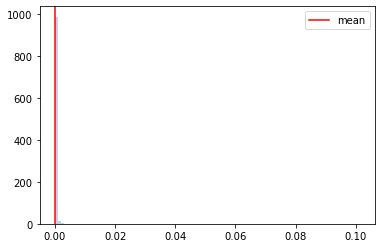

  0%|▏                                                                                | 3/1000 [00:00<01:05, 15.27it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654366055
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 0.1, 'jump_size_a': 1.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▍                                                                                | 5/1000 [00:00<01:20, 12.39it/s]

Monte Carlo 3
Monte Carlo 4
Monte Carlo 5
Monte Carlo 6


  1%|▌                                                                                | 7/1000 [00:00<01:38, 10.04it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▉                                                                               | 11/1000 [00:01<01:40,  9.85it/s]

Monte Carlo 9
Monte Carlo 10
Monte Carlo 11
Monte Carlo 12


  2%|█▏                                                                              | 15/1000 [00:01<01:38,  9.97it/s]

Monte Carlo 13
Monte Carlo 14
Monte Carlo 15
Monte Carlo 16


  2%|█▌                                                                              | 19/1000 [00:01<01:39,  9.82it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:01<01:39,  9.82it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 23/1000 [00:02<01:41,  9.63it/s]

Monte Carlo 21
Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<02:17,  7.12it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:02<02:01,  8.00it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:02,  7.91it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<01:57,  8.26it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<02:09,  7.49it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:03<02:15,  7.11it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:06,  7.59it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<02:13,  7.18it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<02:01,  7.90it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:04<01:58,  8.06it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:56,  8.18it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:54,  8.35it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:59,  7.93it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:05<01:59,  7.96it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:04,  7.62it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:56,  8.13it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<01:59,  7.89it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:06<01:57,  8.03it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:56,  8.09it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<01:58,  7.92it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<01:57,  7.96it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:04,  7.51it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:02,  7.58it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:01,  7.64it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<02:04,  7.42it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:04,  7.43it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:03,  7.45it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:01,  7.60it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:09<02:06,  7.26it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:08,  7.16it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:07,  7.20it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<02:12,  6.88it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:12,  6.90it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:05,  7.25it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:00,  7.50it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<02:13,  6.79it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:08,  7.04it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:02,  7.35it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:12,  6.77it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:06,  7.07it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:04,  7.16it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:06,  7.07it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:02,  7.26it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:03,  7.21it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:12,  6.69it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:11,  6.75it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:13,  6.63it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:11,  6.68it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:11,  6.67it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<02:09,  6.75it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:09,  6.76it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:20,  6.22it/s]

Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:16<02:15,  6.42it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:17<02:11,  6.60it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:17<02:11,  6.62it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:17<02:11,  6.58it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:17<02:08,  6.74it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:18<02:10,  6.62it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:18<02:05,  6.85it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:18<02:22,  6.03it/s]

Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:19,  6.12it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:19,  6.11it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:12,  6.43it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:19<02:16,  6.25it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▊                                                                   | 150/1000 [00:20<02:19,  6.10it/s]

Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:20<02:35,  5.47it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:20<02:30,  5.64it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:21<02:21,  5.97it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:21<02:15,  6.19it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:21<02:17,  6.11it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:13,  6.26it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:22<02:14,  6.23it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:22<02:22,  5.86it/s]

Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:17,  6.07it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:15,  6.13it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:23<02:13,  6.19it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:20,  5.88it/s]

Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:20,  5.90it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:18,  5.97it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:24<02:24,  5.70it/s]

Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:18,  5.91it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:15,  6.03it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:25<02:14,  6.06it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:17,  5.92it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:13,  6.11it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:26<02:12,  6.14it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:15,  5.99it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 192/1000 [00:27<02:13,  6.05it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:20,  5.72it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:27<02:21,  5.70it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:28<02:17,  5.86it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:16,  5.87it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:28<02:22,  5.60it/s]

Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:28<02:25,  5.48it/s]

Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:29<02:22,  5.58it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:16,  5.82it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:29<02:19,  5.69it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:16,  5.78it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:23,  5.51it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:30<02:23,  5.50it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:20,  5.58it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:22,  5.50it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:17,  5.70it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:20,  5.58it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:20,  5.57it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:23,  5.42it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:24,  5.40it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:23,  5.40it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:32<02:28,  5.21it/s]

Monte Carlo 223
Monte Carlo 224


 22%|█████████████████▊                                                             | 225/1000 [00:33<02:41,  4.80it/s]

Monte Carlo 225


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:38,  4.88it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:39,  4.83it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:37,  4.88it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:40,  4.78it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:41,  4.76it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:39,  4.80it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:39,  4.78it/s]

Monte Carlo 236


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:35,  4.91it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:36,  4.85it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:35,  4.89it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:35,  4.86it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:34,  4.90it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:35,  4.87it/s]

Monte Carlo 243
Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:35,  4.85it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:33,  4.91it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:31,  4.96it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:28,  5.04it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:28,  5.06it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:28,  5.06it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:21,  5.28it/s]

Monte Carlo 251
Monte Carlo 252


 25%|███████████████████▉                                                           | 253/1000 [00:38<02:30,  4.97it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:34,  4.81it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:33,  4.83it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:28,  5.00it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:39<02:25,  5.10it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:40<02:22,  5.21it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:21,  5.22it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:40<02:20,  5.24it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:27,  5.01it/s]

Monte Carlo 263
Monte Carlo 264


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:30,  4.89it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:32,  4.81it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:41<02:31,  4.83it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:29,  4.90it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:25,  5.03it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:24,  5.04it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:23,  5.06it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:40,  4.53it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:34,  4.69it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:32,  4.75it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:29,  4.83it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:26,  4.92it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:44<02:23,  5.04it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:44<02:22,  5.04it/s]

Monte Carlo 279
Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:44<02:25,  4.94it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:23,  5.00it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:20,  5.10it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:17,  5.18it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:45<02:17,  5.18it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:16,  5.21it/s]

Monte Carlo 286
Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:18,  5.12it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:46<02:20,  5.04it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:46<02:29,  4.74it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:30,  4.69it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:47<02:26,  4.81it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:47<02:27,  4.76it/s]

Monte Carlo 296
Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:24,  4.86it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:24,  4.84it/s]

Monte Carlo 299
Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:29,  4.69it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:48<02:31,  4.62it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:28,  4.70it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:49<02:26,  4.74it/s]

Monte Carlo 304
Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:49<02:28,  4.66it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:33,  4.51it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:32,  4.52it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:50<02:26,  4.70it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:50<02:32,  4.50it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:34,  4.47it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:29,  4.59it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:26,  4.68it/s]

Monte Carlo 314
Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:28,  4.60it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:27,  4.64it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:26,  4.66it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:26,  4.66it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:30,  4.51it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:53<02:25,  4.65it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:24,  4.67it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:53<02:21,  4.75it/s]

Monte Carlo 324
Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:27,  4.57it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:25,  4.64it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:25,  4.63it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:21,  4.74it/s]

Monte Carlo 329
Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:55<02:20,  4.77it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:55<02:22,  4.68it/s]

Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:55<02:20,  4.75it/s]

Monte Carlo 333
Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:20,  4.73it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:22,  4.66it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:56<02:25,  4.56it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:56<02:24,  4.57it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:30,  4.40it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:30,  4.39it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:28,  4.43it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:57<02:30,  4.37it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:33,  4.29it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:32,  4.30it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:31,  4.33it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:29,  4.38it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:27,  4.41it/s]

Monte Carlo 348


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:26,  4.43it/s]

Monte Carlo 349
Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:25,  4.45it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:24,  4.49it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:00<02:22,  4.53it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:22,  4.52it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:26,  4.41it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:26,  4.39it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:26,  4.40it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:24,  4.46it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:24,  4.43it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:23,  4.46it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:22,  4.50it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:25,  4.37it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:27,  4.32it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:27,  4.31it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:34,  4.11it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:33,  4.13it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:35,  4.07it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:30,  4.19it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:29,  4.21it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:25,  4.32it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:26,  4.30it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:24,  4.33it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:29,  4.21it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:26,  4.28it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:24,  4.32it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:24,  4.33it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:21,  4.42it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:22,  4.38it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:25,  4.26it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:23,  4.31it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:24,  4.30it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:23,  4.32it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:21,  4.36it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:19,  4.41it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:17,  4.48it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:16,  4.51it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:15,  4.52it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:16,  4.49it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:16,  4.46it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:19,  4.37it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:08<02:25,  4.19it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:27,  4.13it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:24,  4.21it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:21,  4.27it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:09<02:27,  4.11it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:32,  3.96it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:30,  4.00it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:31,  3.98it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:34,  3.88it/s]

Monte Carlo 399


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:23,  4.17it/s]

Monte Carlo 400
Monte Carlo 401


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:16,  4.37it/s]

Monte Carlo 402
Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:15,  4.40it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:17,  4.33it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:13,  4.47it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:13,  4.44it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:12<02:13,  4.44it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:13<02:12,  4.47it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:14,  4.38it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:12,  4.46it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:13<02:11,  4.46it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:11,  4.47it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:13,  4.39it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:23,  4.08it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:14<02:22,  4.10it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:15<02:18,  4.20it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:18,  4.21it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:16,  4.27it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:15<02:14,  4.32it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:16<02:13,  4.33it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:18,  4.17it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:17,  4.21it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:16<02:19,  4.14it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:16<02:17,  4.20it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:16,  4.19it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:22,  4.02it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:17<02:19,  4.11it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:17<02:20,  4.07it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:18,  4.12it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:19,  4.08it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:18<02:39,  3.56it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:38,  3.58it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:32,  3.72it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:31,  3.74it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:19<02:29,  3.77it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:29,  3.76it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:28,  3.79it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:20<02:28,  3.77it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:20<02:26,  3.83it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:21<02:24,  3.88it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:21<02:24,  3.86it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:21<02:24,  3.86it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:21<02:24,  3.85it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:22<02:23,  3.86it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:22<02:22,  3.90it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:22<02:23,  3.86it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:22<02:20,  3.91it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:23<02:21,  3.90it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:23<02:24,  3.81it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:23<02:25,  3.78it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:24<02:23,  3.81it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:24<02:24,  3.79it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:24<02:22,  3.83it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:24<02:28,  3.66it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:25<02:28,  3.66it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:25<02:26,  3.71it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:25<02:23,  3.77it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:25<02:24,  3.75it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:26<02:26,  3.68it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:26<02:27,  3.66it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:26<02:24,  3.72it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:26<02:21,  3.79it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:27<02:21,  3.78it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:27<02:22,  3.74it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:27<02:23,  3.72it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:28<02:21,  3.76it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:28<02:25,  3.65it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:28<02:26,  3.62it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:28<02:26,  3.61it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:29<02:24,  3.67it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:29<02:24,  3.67it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:29<02:24,  3.65it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:24,  3.64it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:30<02:23,  3.66it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:30<02:19,  3.75it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:30<02:22,  3.66it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:31<02:19,  3.75it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:31<02:20,  3.72it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:31<02:25,  3.58it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:31<02:21,  3.68it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:32<02:19,  3.71it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:32<02:21,  3.64it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:32<02:21,  3.64it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:33<02:20,  3.66it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:33<02:28,  3.46it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:33<02:26,  3.51it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:33<02:23,  3.57it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:34<02:21,  3.60it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:34<02:20,  3.63it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:34<02:21,  3.59it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:34<02:22,  3.57it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:35<02:20,  3.60it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:35<02:19,  3.62it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:35<02:17,  3.68it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:36<02:16,  3.69it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:36<02:15,  3.72it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:36<02:17,  3.65it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:36<02:16,  3.68it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:37<02:22,  3.51it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:37<02:19,  3.58it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:37<02:23,  3.47it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:38<02:21,  3.51it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:38<02:22,  3.49it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:38<02:19,  3.54it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:38<02:15,  3.66it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:39<02:14,  3.67it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:39<02:09,  3.79it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:39<02:11,  3.72it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:39<02:15,  3.61it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:40<02:14,  3.63it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:40<02:10,  3.73it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:40<02:10,  3.72it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:41<02:11,  3.71it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:41<02:12,  3.67it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:41<02:12,  3.65it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:41<02:10,  3.69it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:42<02:09,  3.73it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:42<02:06,  3.79it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:42<02:12,  3.61it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:42<02:16,  3.52it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:43<02:15,  3.53it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:43<02:15,  3.51it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:43<02:19,  3.42it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:44<02:16,  3.49it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:44<02:13,  3.55it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:44<02:17,  3.44it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:44<02:18,  3.40it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:45<02:16,  3.44it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:45<02:14,  3.50it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:45<02:17,  3.40it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:46<02:17,  3.39it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:46<02:17,  3.39it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:46<02:18,  3.36it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:47<02:18,  3.36it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:47<02:16,  3.40it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:47<02:13,  3.46it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:47<02:12,  3.49it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:48<02:22,  3.23it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:48<02:23,  3.22it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:48<02:20,  3.27it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:49<02:19,  3.29it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:49<02:34,  2.97it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:49<02:30,  3.04it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:50<02:28,  3.07it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:50<02:23,  3.16it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:50<02:22,  3.19it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:51<02:23,  3.16it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:51<02:18,  3.26it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:51<02:18,  3.25it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:52<02:16,  3.29it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:52<02:15,  3.31it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:52<02:13,  3.36it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:52<02:11,  3.38it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:53<02:14,  3.31it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:53<02:14,  3.30it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:53<02:14,  3.28it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:54<02:14,  3.28it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:54<02:14,  3.28it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:54<02:21,  3.12it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:55<02:16,  3.21it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:55<02:15,  3.24it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:55<02:14,  3.24it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:56<02:16,  3.20it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:56<02:17,  3.17it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:56<02:15,  3.20it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:56<02:14,  3.23it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:57<02:18,  3.12it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:57<02:15,  3.19it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:57<02:14,  3.19it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:58<02:13,  3.20it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:58<02:11,  3.26it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:58<02:11,  3.25it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:59<02:11,  3.24it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:59<02:10,  3.25it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:59<02:08,  3.29it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:00<02:09,  3.26it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:00<02:09,  3.25it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:00<02:09,  3.24it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:00<02:10,  3.22it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:01<02:10,  3.22it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:01<02:08,  3.26it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:01<02:10,  3.19it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:02<02:13,  3.13it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:02<02:16,  3.05it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:02<02:19,  2.96it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:03<02:19,  2.96it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:03<02:20,  2.92it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:04<02:20,  2.92it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:04<02:18,  2.97it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:04<02:19,  2.93it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:05<02:25,  2.80it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:05<02:25,  2.80it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:05<02:20,  2.88it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:06<02:17,  2.95it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:06<02:13,  3.03it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:06<02:15,  2.98it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:07<02:17,  2.93it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:07<02:16,  2.94it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:07<02:14,  2.96it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:08<02:13,  2.99it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:08<02:14,  2.95it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:08<02:11,  3.02it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:09<02:10,  3.02it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:09<02:09,  3.06it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:09<02:11,  2.99it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:10<02:12,  2.97it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:10<02:11,  2.97it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:10<02:11,  2.97it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:11<02:10,  3.00it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:11<02:09,  3.00it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:11<02:05,  3.10it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:12<02:07,  3.03it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:12<02:01,  3.17it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:12<01:57,  3.27it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:12<02:00,  3.19it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:13<01:59,  3.20it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:13<02:00,  3.18it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:13<02:00,  3.16it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:14<01:57,  3.22it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:14<01:55,  3.27it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:14<01:54,  3.30it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:15<01:56,  3.23it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:15<01:58,  3.18it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:15<02:01,  3.10it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:16<02:02,  3.06it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:16<02:02,  3.06it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:16<02:00,  3.10it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:17<02:00,  3.08it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:17<01:58,  3.11it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:17<02:00,  3.07it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:18<02:00,  3.05it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:18<02:01,  3.02it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:18<02:00,  3.03it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:19<02:04,  2.92it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:19<02:02,  2.96it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:19<02:01,  2.98it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:20<02:03,  2.93it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:20<02:03,  2.91it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:20<02:03,  2.91it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:21<02:04,  2.89it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:21<02:02,  2.91it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:21<02:00,  2.96it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:22<02:00,  2.97it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:22<01:58,  2.99it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:22<01:59,  2.97it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:23<02:01,  2.91it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:23<01:58,  2.97it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:23<02:00,  2.91it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:24<02:12,  2.65it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:24<02:07,  2.74it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:25<02:05,  2.77it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:25<02:03,  2.80it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:25<02:04,  2.78it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:26<02:03,  2.79it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:26<02:00,  2.84it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:26<01:58,  2.88it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:27<02:02,  2.78it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:27<02:00,  2.83it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:27<01:58,  2.86it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:28<01:59,  2.83it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:28<01:59,  2.84it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:28<01:58,  2.85it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:29<01:58,  2.85it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:29<01:58,  2.83it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:29<01:56,  2.86it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:30<01:55,  2.90it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:30<02:04,  2.67it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:31<02:21,  2.34it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:31<02:32,  2.16it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:32<02:35,  2.11it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:32<02:33,  2.14it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:33<02:32,  2.15it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:33<02:19,  2.33it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:33<02:16,  2.38it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:34<02:09,  2.51it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:34<02:05,  2.57it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:35<02:00,  2.67it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:35<01:57,  2.73it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:35<01:55,  2.78it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:36<01:53,  2.81it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:36<01:56,  2.72it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:36<01:56,  2.72it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:37<01:52,  2.80it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:37<01:54,  2.74it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:37<01:56,  2.69it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:38<01:55,  2.71it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:38<01:51,  2.81it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:38<01:49,  2.84it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:39<01:47,  2.88it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:39<01:45,  2.94it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:39<01:43,  2.99it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:40<01:42,  3.00it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:40<01:41,  3.03it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:40<01:40,  3.02it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:41<01:39,  3.05it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:41<01:40,  3.01it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:41<01:42,  2.96it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:42<01:40,  2.98it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:42<01:40,  3.00it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:42<01:40,  2.98it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:43<01:41,  2.95it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:43<01:40,  2.97it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:44<01:42,  2.89it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:44<01:41,  2.90it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:44<01:43,  2.84it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:45<01:42,  2.86it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:45<01:45,  2.78it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:45<01:45,  2.76it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:46<01:44,  2.77it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:46<01:43,  2.80it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:46<01:42,  2.81it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:47<01:46,  2.69it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:47<01:46,  2.68it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:48<01:45,  2.71it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:48<01:44,  2.72it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:48<01:42,  2.75it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:49<01:41,  2.77it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:49<01:43,  2.72it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:49<01:45,  2.67it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:50<01:43,  2.70it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:50<01:40,  2.78it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:50<01:38,  2.80it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:51<01:37,  2.84it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:51<01:34,  2.92it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:51<01:33,  2.94it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:52<01:35,  2.86it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:52<01:34,  2.87it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:52<01:32,  2.93it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:53<01:31,  2.94it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:53<01:33,  2.86it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:53<01:33,  2.87it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:54<01:31,  2.90it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:54<01:31,  2.92it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:55<01:34,  2.81it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:55<01:32,  2.84it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:55<01:31,  2.88it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:56<01:32,  2.84it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:56<01:31,  2.84it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:56<01:33,  2.77it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:57<01:34,  2.75it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:57<01:36,  2.68it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:57<01:33,  2.74it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:58<01:34,  2.70it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:58<01:34,  2.70it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:59<01:34,  2.69it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:59<01:35,  2.66it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:59<01:34,  2.66it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:00<01:37,  2.57it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:00<01:38,  2.55it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:01<01:37,  2.56it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:01<01:36,  2.57it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:01<01:36,  2.56it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:02<01:36,  2.56it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:02<01:34,  2.59it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:02<01:33,  2.62it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:03<01:31,  2.66it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:03<01:29,  2.70it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:04<01:29,  2.70it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:04<01:32,  2.60it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:04<01:33,  2.55it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:05<01:32,  2.58it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:05<01:40,  2.37it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:06<01:36,  2.44it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:06<01:33,  2.50it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:06<01:31,  2.56it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:07<01:29,  2.60it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:07<01:29,  2.58it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:08<01:27,  2.63it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:08<01:25,  2.68it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:08<01:34,  2.43it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:09<01:33,  2.44it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:09<01:32,  2.46it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:10<01:30,  2.51it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:10<01:28,  2.54it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:10<01:27,  2.57it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:11<01:26,  2.57it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:11<01:24,  2.62it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:11<01:24,  2.63it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:12<01:23,  2.64it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:12<01:22,  2.65it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:13<01:24,  2.59it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:13<01:23,  2.60it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:13<01:24,  2.57it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:14<01:23,  2.57it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:14<01:22,  2.58it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:15<01:22,  2.58it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:15<01:22,  2.58it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:15<01:22,  2.56it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:16<01:20,  2.59it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:16<01:20,  2.61it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:16<01:19,  2.61it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:17<01:19,  2.61it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:17<01:18,  2.63it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:18<01:17,  2.64it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:18<01:17,  2.63it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:18<01:18,  2.60it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:19<01:17,  2.60it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:19<01:17,  2.61it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:20<01:17,  2.59it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:20<01:16,  2.58it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:20<01:18,  2.53it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:21<01:19,  2.47it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:21<01:18,  2.49it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:22<01:17,  2.51it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:22<01:17,  2.49it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:22<01:16,  2.52it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:23<01:15,  2.53it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:23<01:16,  2.51it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:24<01:14,  2.54it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:24<01:15,  2.51it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:24<01:13,  2.56it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:25<01:15,  2.48it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:25<01:13,  2.55it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:26<01:13,  2.52it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:26<01:12,  2.56it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:26<01:12,  2.51it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:27<01:11,  2.54it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:27<01:11,  2.54it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:27<01:10,  2.55it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:28<01:11,  2.51it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:28<01:10,  2.53it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:29<01:11,  2.47it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:29<01:10,  2.51it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:29<01:09,  2.53it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:30<01:08,  2.52it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:30<01:08,  2.52it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:31<01:08,  2.50it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:31<01:07,  2.53it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:31<01:06,  2.54it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:32<01:06,  2.52it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:32<01:07,  2.50it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:33<01:07,  2.47it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:33<01:07,  2.48it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:33<01:06,  2.47it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:34<01:06,  2.45it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:34<01:06,  2.45it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:35<01:04,  2.50it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:35<01:06,  2.43it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:36<01:05,  2.44it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:36<01:06,  2.41it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:36<01:06,  2.39it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:37<01:06,  2.34it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:37<01:04,  2.40it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:38<01:03,  2.44it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:38<01:03,  2.44it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:38<01:02,  2.46it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:39<01:01,  2.46it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:39<01:01,  2.44it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:40<01:01,  2.46it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:40<01:02,  2.39it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:41<01:02,  2.36it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:41<01:00,  2.42it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:41<00:59,  2.45it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:42<00:57,  2.53it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:42<00:56,  2.54it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:42<00:55,  2.57it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:43<00:54,  2.60it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:43<00:54,  2.58it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:44<00:55,  2.53it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:44<00:55,  2.51it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:44<00:54,  2.55it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:45<00:54,  2.54it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:45<00:53,  2.55it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:46<00:53,  2.53it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:46<00:53,  2.52it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:46<00:53,  2.49it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:47<00:53,  2.48it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:47<00:53,  2.46it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:48<00:58,  2.23it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:48<00:56,  2.30it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:49<00:54,  2.35it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:49<00:53,  2.38it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:49<00:53,  2.35it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:50<00:53,  2.33it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:50<00:52,  2.34it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:51<00:52,  2.34it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:51<00:51,  2.36it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:52<00:51,  2.35it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:52<00:50,  2.38it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:52<00:50,  2.36it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:53<00:49,  2.38it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:53<00:48,  2.39it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:54<00:48,  2.37it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:54<00:48,  2.37it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:55<00:47,  2.39it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:55<00:47,  2.39it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:55<00:47,  2.37it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:56<00:47,  2.35it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:56<00:46,  2.38it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:57<00:45,  2.41it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:57<00:44,  2.42it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:57<00:44,  2.43it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:58<00:44,  2.40it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:58<00:44,  2.37it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:59<00:44,  2.34it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:59<00:44,  2.34it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:00<00:43,  2.34it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:00<00:43,  2.33it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:00<00:42,  2.37it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:01<00:41,  2.38it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:01<00:41,  2.37it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:02<00:41,  2.35it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:02<00:40,  2.35it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:03<00:41,  2.31it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:03<00:40,  2.32it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:03<00:40,  2.32it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:04<00:39,  2.31it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:04<00:38,  2.33it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:05<00:39,  2.30it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:05<00:39,  2.26it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:06<00:37,  2.32it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:06<00:37,  2.34it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:06<00:37,  2.30it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:07<00:37,  2.26it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:07<00:36,  2.27it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:08<00:36,  2.27it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:08<00:36,  2.27it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:09<00:35,  2.30it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:09<00:34,  2.30it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:10<00:34,  2.30it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:10<00:33,  2.31it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:10<00:33,  2.30it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:11<00:32,  2.33it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:11<00:32,  2.34it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:12<00:31,  2.36it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:12<00:30,  2.38it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:13<00:30,  2.35it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:13<00:30,  2.34it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:13<00:30,  2.33it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:14<00:30,  2.29it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:14<00:30,  2.25it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:15<00:29,  2.25it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:15<00:28,  2.29it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:16<00:28,  2.27it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:16<00:28,  2.24it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:16<00:27,  2.25it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:17<00:27,  2.25it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:17<00:26,  2.28it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:18<00:25,  2.33it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:18<00:25,  2.34it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:19<00:24,  2.38it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:19<00:23,  2.40it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:19<00:23,  2.40it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:20<00:22,  2.40it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:20<00:22,  2.43it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:21<00:22,  2.39it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:21<00:22,  2.34it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:22<00:22,  2.31it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:22<00:22,  2.26it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:22<00:21,  2.31it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:23<00:20,  2.36it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:23<00:19,  2.36it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:24<00:19,  2.32it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:24<00:19,  2.31it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:25<00:19,  2.26it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:25<00:19,  2.22it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:26<00:19,  2.20it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:26<00:18,  2.17it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:26<00:18,  2.19it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:27<00:17,  2.27it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:27<00:16,  2.29it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:28<00:15,  2.34it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:28<00:15,  2.29it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:29<00:15,  2.30it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:29<00:14,  2.29it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:29<00:14,  2.33it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:30<00:13,  2.33it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:30<00:13,  2.34it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:31<00:12,  2.35it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:31<00:12,  2.38it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:32<00:11,  2.35it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:32<00:11,  2.30it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:32<00:11,  2.30it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:33<00:10,  2.29it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:33<00:10,  2.30it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:34<00:09,  2.33it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:34<00:10,  2.14it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:35<00:09,  2.20it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:35<00:08,  2.22it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:36<00:08,  2.25it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:36<00:08,  2.22it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:36<00:07,  2.25it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:37<00:06,  2.29it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:37<00:06,  2.27it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:38<00:06,  2.28it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:38<00:05,  2.28it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:39<00:05,  2.27it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:39<00:04,  2.22it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:40<00:04,  2.18it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:40<00:04,  2.20it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:41<00:03,  2.15it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:41<00:03,  2.10it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:42<00:02,  2.12it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:42<00:02,  2.14it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:42<00:01,  2.14it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:43<00:01,  2.15it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:43<00:00,  2.14it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:44<00:00,  2.13it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:44<00:00,  3.51it/s]


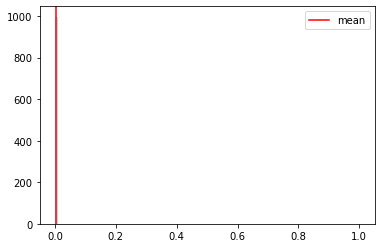

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654366340
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 0.1, 'jump_size_a': 1.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:03, 15.67it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:24, 11.77it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:58,  8.37it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:57,  8.43it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:51,  8.88it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:47,  9.19it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:46,  9.21it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:51,  8.78it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:56,  8.43it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:52,  8.70it/s]

Monte Carlo 21
Monte Carlo 22


  2%|██                                                                              | 25/1000 [00:02<01:46,  9.14it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:52,  8.68it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:50,  8.83it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<01:55,  8.40it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:15,  7.12it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<02:10,  7.41it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:02,  7.88it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:59,  8.04it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<02:02,  7.81it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<02:03,  7.75it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<02:00,  7.92it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<02:06,  7.56it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<02:04,  7.68it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:05<02:00,  7.89it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<01:56,  8.12it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<02:04,  7.57it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<02:02,  7.68it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<02:01,  7.76it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<01:58,  7.93it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<02:00,  7.81it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:07<02:10,  7.16it/s]

Monte Carlo 63
Monte Carlo 64


  6%|█████▏                                                                          | 65/1000 [00:07<02:09,  7.24it/s]

Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:26,  6.37it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:16,  6.84it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:17,  6.76it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:10,  7.12it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:08,  7.21it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:08,  7.16it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:07,  7.21it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:04,  7.40it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:02,  7.50it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:09,  7.05it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:10,  6.98it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:14,  6.79it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:07,  7.11it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:18,  6.54it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:13,  6.78it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:13,  6.77it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:15,  6.64it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:17,  6.53it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:16,  6.59it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:14,  6.68it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:08,  6.97it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:12,  6.72it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:15,  6.55it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:06,  7.02it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:08,  6.90it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:05,  7.02it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:07,  6.89it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:10,  6.75it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:08,  6.82it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:05,  6.98it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:06,  6.91it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:10,  6.65it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:10,  6.67it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:14,  6.46it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:16,  6.35it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:21,  6.12it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:14,  6.40it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:18,  6.21it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:26,  5.83it/s]

Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:19<02:23,  5.97it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:20<02:16,  6.25it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:20<02:20,  6.07it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:20<02:14,  6.30it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:21<02:13,  6.35it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:21<02:18,  6.09it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:21<02:19,  6.06it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:22<02:22,  5.92it/s]

Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:29,  5.64it/s]

Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:22<02:25,  5.78it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:21,  5.92it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:23<02:14,  6.19it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:23<02:10,  6.39it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:18,  6.03it/s]

Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:14,  6.20it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:18,  6.00it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:16,  6.05it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:15,  6.10it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:25<02:22,  5.78it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:22,  5.76it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:21,  5.78it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:26<02:17,  5.94it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▍                                                                | 183/1000 [00:26<02:17,  5.96it/s]

Monte Carlo 183


 18%|██████████████▌                                                                | 184/1000 [00:26<02:25,  5.60it/s]

Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:29,  5.43it/s]

Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:28,  5.46it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:27<02:24,  5.60it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:25,  5.55it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:28<02:40,  5.02it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:28<02:31,  5.31it/s]

Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:33,  5.24it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:28<02:26,  5.48it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:29<02:26,  5.49it/s]

Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:29<02:21,  5.67it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:25,  5.48it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:30<02:23,  5.56it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:18,  5.73it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:20,  5.64it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 209/1000 [00:30<02:19,  5.68it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:31<02:22,  5.55it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:28,  5.31it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:24,  5.44it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:32<02:22,  5.51it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:32<02:25,  5.40it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:27,  5.31it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:23,  5.45it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:33<02:28,  5.26it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:33<02:22,  5.46it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▌                                                             | 223/1000 [00:33<02:22,  5.46it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:34<02:25,  5.32it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:34<02:25,  5.31it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:34<02:27,  5.22it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:35<02:34,  4.98it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:35<02:33,  5.00it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:29,  5.14it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:29,  5.13it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:31,  5.04it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:36<02:25,  5.23it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:36<02:23,  5.33it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:29,  5.09it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:37<02:27,  5.16it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:37<02:22,  5.34it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:24,  5.24it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:23,  5.28it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:38<02:20,  5.35it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:38<02:20,  5.37it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:24,  5.21it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:39<02:27,  5.06it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:39<02:27,  5.06it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:39<02:27,  5.06it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:39<02:24,  5.16it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:24,  5.15it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:40<02:25,  5.11it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:40<02:23,  5.18it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 258/1000 [00:40<02:30,  4.93it/s]

Monte Carlo 258


 26%|████████████████████▍                                                          | 259/1000 [00:40<02:33,  4.84it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:41<02:34,  4.78it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:41<02:30,  4.91it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:41<02:26,  5.04it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:24,  5.09it/s]

Monte Carlo 263
Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:42<02:27,  4.99it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:42<02:24,  5.07it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:22,  5.13it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:25,  5.02it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:43<02:25,  4.99it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:43<02:27,  4.93it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:43<02:24,  5.05it/s]

Monte Carlo 272
Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:28,  4.89it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:44<02:24,  5.01it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:44<02:25,  4.97it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:26,  4.92it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:44<02:28,  4.85it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:45<02:30,  4.78it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:26,  4.90it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:25,  4.91it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:46<02:24,  4.93it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:29,  4.77it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:47<02:30,  4.71it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:47<02:28,  4.77it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:47<02:29,  4.72it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:52,  4.10it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:47<02:49,  4.17it/s]

Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:48<02:52,  4.09it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:48<02:46,  4.22it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:50,  4.13it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:48,  4.17it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:49<02:41,  4.33it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:49<02:45,  4.23it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:38,  4.39it/s]

Monte Carlo 301
Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:50<02:41,  4.31it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:50<02:51,  4.05it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:50<02:45,  4.21it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:50<02:39,  4.36it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:51<02:41,  4.29it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:51<02:44,  4.20it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:51<02:50,  4.06it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:51<02:39,  4.32it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:52<02:33,  4.49it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:52<02:29,  4.60it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:52<02:25,  4.71it/s]

Monte Carlo 313
Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:52<02:27,  4.65it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:53<02:28,  4.61it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:53<02:23,  4.77it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:53<02:20,  4.83it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<02:20,  4.85it/s]

Monte Carlo 319
Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:54<02:39,  4.27it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:54<02:35,  4.36it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:54<02:37,  4.31it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:55<02:31,  4.44it/s]

Monte Carlo 324
Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:55<02:31,  4.44it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:55<02:29,  4.50it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:55<02:33,  4.39it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:55<02:32,  4.40it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:56<02:28,  4.51it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:56<02:30,  4.44it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:56<02:28,  4.49it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:56<02:27,  4.53it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:57<02:27,  4.53it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:57<02:28,  4.47it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:57<02:31,  4.39it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:57<02:28,  4.46it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:57<02:29,  4.43it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:58<02:27,  4.48it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:58<02:27,  4.46it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:58<02:29,  4.41it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:58<02:28,  4.44it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:59<02:27,  4.43it/s]

Monte Carlo 343
Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:59<02:29,  4.38it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:59<02:38,  4.13it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:00<02:32,  4.28it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:00<02:29,  4.36it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:00<02:30,  4.32it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:00<02:27,  4.41it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:00<02:28,  4.38it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:01<02:24,  4.49it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:01<02:22,  4.53it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:01<02:26,  4.40it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:01<02:26,  4.41it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:02<02:26,  4.39it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:02<02:26,  4.40it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:02<02:25,  4.42it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:02<02:27,  4.36it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:02<02:25,  4.41it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:03<02:28,  4.30it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:03<02:27,  4.32it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:03<02:27,  4.33it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:03<02:28,  4.27it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:04<02:26,  4.33it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:04<02:31,  4.17it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:04<02:37,  4.01it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:04<02:34,  4.08it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:05<02:30,  4.18it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:05<02:28,  4.26it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:05<02:24,  4.35it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:05<02:28,  4.23it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:06<02:26,  4.29it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:06<02:27,  4.25it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:06<02:27,  4.24it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:06<02:31,  4.11it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:07<02:27,  4.21it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:07<02:26,  4.24it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:07<02:28,  4.19it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:07<02:29,  4.15it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:07<02:28,  4.18it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:08<02:35,  3.98it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:08<02:32,  4.04it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:08<02:32,  4.05it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:09<02:30,  4.08it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:09<02:28,  4.14it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:09<02:32,  4.02it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:09<02:31,  4.04it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:09<02:30,  4.05it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:10<02:29,  4.09it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:10<02:31,  4.01it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:10<02:34,  3.93it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:10<02:31,  4.02it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:11<02:33,  3.95it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:11<02:31,  4.00it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:11<02:33,  3.93it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:12<02:32,  3.95it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:12<02:32,  3.94it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:12<02:31,  3.96it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:12<02:35,  3.87it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:13<02:38,  3.77it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:13<02:38,  3.78it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:13<02:42,  3.66it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:13<02:40,  3.71it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:14<02:37,  3.79it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:14<02:34,  3.83it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:14<02:36,  3.78it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:14<02:33,  3.86it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:15<02:29,  3.95it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:15<02:27,  3.99it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:15<02:31,  3.88it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:15<02:30,  3.91it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:16<02:31,  3.87it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:16<02:27,  3.96it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:16<02:25,  4.01it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:16<02:25,  4.01it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:17<02:30,  3.88it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:17<02:30,  3.87it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:17<02:28,  3.90it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:17<02:25,  3.97it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:18<02:30,  3.84it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:18<02:27,  3.92it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:18<02:26,  3.95it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:19<02:31,  3.81it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:19<02:31,  3.80it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:19<02:26,  3.91it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:19<02:25,  3.94it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:20<02:25,  3.94it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:20<02:24,  3.94it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:20<02:25,  3.93it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:20<02:24,  3.95it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:21<02:22,  3.99it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:21<02:26,  3.88it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:21<02:25,  3.89it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:21<02:29,  3.78it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:22<02:28,  3.80it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:22<02:28,  3.79it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:22<02:26,  3.82it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:22<02:24,  3.88it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:23<02:27,  3.79it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:23<02:28,  3.77it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:23<02:26,  3.80it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:23<02:30,  3.69it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:24<02:27,  3.77it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:24<02:27,  3.77it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:24<02:28,  3.74it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:24<02:26,  3.77it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:25<02:30,  3.67it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:25<02:28,  3.72it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:25<02:30,  3.65it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:26<02:31,  3.63it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:26<02:29,  3.68it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:26<02:27,  3.72it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:26<02:33,  3.56it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:27<02:29,  3.63it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:27<02:26,  3.72it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:27<02:23,  3.78it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:27<02:20,  3.85it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:28<02:21,  3.83it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:28<02:42,  3.33it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:28<02:40,  3.37it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:29<02:38,  3.39it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:29<02:33,  3.49it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:29<02:36,  3.42it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:30<02:40,  3.34it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:30<02:35,  3.42it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:30<02:33,  3.47it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:30<02:29,  3.56it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:31<02:30,  3.52it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:31<02:33,  3.46it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:31<02:29,  3.54it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:32<02:32,  3.47it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:32<02:28,  3.54it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:32<02:28,  3.55it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:32<02:23,  3.67it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:33<02:22,  3.67it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:33<02:20,  3.72it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:33<02:20,  3.73it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:33<02:17,  3.79it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:34<02:14,  3.87it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:34<02:17,  3.76it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:34<02:18,  3.74it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:34<02:18,  3.74it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:35<02:21,  3.66it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:35<02:16,  3.76it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:35<02:18,  3.72it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:36<02:14,  3.82it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:36<02:16,  3.76it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:36<02:11,  3.89it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:36<02:11,  3.89it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:37<02:10,  3.91it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:37<02:09,  3.91it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:37<02:11,  3.85it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:37<02:15,  3.74it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:38<02:14,  3.77it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:38<02:12,  3.80it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:38<02:16,  3.68it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:38<02:18,  3.62it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:39<02:16,  3.67it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:39<02:16,  3.67it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:39<02:17,  3.62it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:40<02:16,  3.66it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:40<02:12,  3.76it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:40<02:11,  3.76it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:40<02:15,  3.66it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:41<02:15,  3.64it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:41<02:14,  3.68it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:41<02:13,  3.68it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:41<02:16,  3.59it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:42<02:20,  3.48it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:42<02:19,  3.51it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:42<02:19,  3.51it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:43<02:20,  3.46it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:43<02:19,  3.48it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:43<02:17,  3.52it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:43<02:16,  3.54it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:44<02:16,  3.55it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:44<02:16,  3.52it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:44<02:18,  3.48it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:45<02:20,  3.42it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:45<02:18,  3.45it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:45<02:20,  3.41it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:46<02:23,  3.33it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:46<02:22,  3.34it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:46<02:22,  3.34it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:46<02:20,  3.37it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:47<02:21,  3.35it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:47<02:25,  3.23it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:47<02:26,  3.21it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:48<02:29,  3.15it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:48<02:27,  3.19it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:48<02:29,  3.13it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:49<02:28,  3.14it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:49<02:28,  3.14it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:49<02:26,  3.18it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:50<02:25,  3.19it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:50<02:28,  3.12it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:50<02:27,  3.13it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:51<02:26,  3.14it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:51<02:28,  3.11it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:51<02:24,  3.18it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:52<02:21,  3.23it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:52<02:25,  3.13it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:52<02:23,  3.18it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:52<02:23,  3.17it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:53<02:24,  3.15it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:53<02:22,  3.18it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:53<02:21,  3.20it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:54<02:19,  3.23it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:54<02:21,  3.18it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:54<02:18,  3.24it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:55<02:19,  3.22it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:55<02:16,  3.26it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:55<02:18,  3.21it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:56<02:20,  3.17it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:56<02:23,  3.10it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:56<02:22,  3.10it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:57<02:22,  3.10it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:57<02:22,  3.09it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:57<02:23,  3.06it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:58<02:22,  3.07it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:58<02:26,  2.99it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:58<02:25,  3.00it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:59<02:23,  3.04it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:59<02:21,  3.08it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:59<02:21,  3.06it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:00<02:32,  2.84it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:00<02:27,  2.92it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:00<02:25,  2.97it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:01<02:22,  3.02it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:01<02:22,  3.00it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:01<02:20,  3.04it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:02<02:18,  3.08it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:02<02:18,  3.07it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:02<02:18,  3.07it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:03<02:19,  3.05it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:03<02:18,  3.05it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:03<02:16,  3.09it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:04<02:20,  3.00it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:04<02:17,  3.06it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:04<02:17,  3.05it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:05<02:19,  3.01it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:05<02:17,  3.03it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:05<02:20,  2.96it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:06<02:18,  2.99it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:06<02:20,  2.95it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:06<02:23,  2.87it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:07<02:20,  2.92it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:07<02:23,  2.87it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:07<02:27,  2.79it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:08<02:24,  2.84it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:08<02:20,  2.90it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:08<02:22,  2.85it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:09<02:17,  2.95it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:09<02:16,  2.98it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:09<02:17,  2.95it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:10<02:13,  3.02it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:10<02:16,  2.94it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:10<02:16,  2.94it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:11<02:13,  3.00it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:11<02:12,  3.01it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:11<02:17,  2.90it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:12<02:14,  2.95it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:12<02:11,  3.00it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:12<02:11,  3.01it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:13<02:10,  3.02it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:13<02:11,  2.99it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:13<02:10,  3.01it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:14<02:09,  3.02it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:14<02:11,  2.96it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:14<02:13,  2.91it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:15<02:10,  2.97it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:15<02:07,  3.02it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:15<02:11,  2.94it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:16<02:08,  3.00it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:16<02:08,  2.99it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:16<02:06,  3.03it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:17<02:06,  3.01it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:17<02:05,  3.03it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:17<02:06,  3.00it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:18<02:05,  3.01it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:18<02:07,  2.96it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:18<02:06,  2.98it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:19<02:06,  2.97it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:19<02:06,  2.95it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:19<02:06,  2.96it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:20<02:05,  2.97it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:20<02:05,  2.97it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:20<02:04,  2.98it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:21<02:04,  2.98it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:21<02:03,  3.00it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:21<02:03,  2.99it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:22<02:02,  3.01it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:22<02:03,  2.96it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:22<02:03,  2.95it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:23<02:08,  2.83it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:23<02:06,  2.87it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:24<02:07,  2.84it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:24<02:05,  2.87it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:24<02:05,  2.87it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:25<02:07,  2.80it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:25<02:05,  2.86it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:25<02:03,  2.90it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:26<02:04,  2.87it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:26<02:03,  2.88it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:26<02:02,  2.90it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:27<02:01,  2.90it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:27<02:03,  2.85it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:27<02:02,  2.87it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:28<02:01,  2.88it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:28<02:00,  2.91it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:28<02:02,  2.84it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:29<02:02,  2.83it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:29<02:01,  2.84it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:29<02:01,  2.84it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:30<01:58,  2.91it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:30<02:01,  2.83it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:30<01:57,  2.91it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:31<01:57,  2.90it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:31<01:55,  2.95it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:31<01:53,  2.99it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:32<01:50,  3.07it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:32<01:51,  3.02it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:32<01:49,  3.07it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:33<01:48,  3.08it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:33<01:50,  3.02it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:33<01:50,  3.01it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:34<01:52,  2.96it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:34<01:50,  3.00it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:34<01:55,  2.86it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:35<01:54,  2.87it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:35<02:07,  2.57it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:36<02:02,  2.67it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:36<01:55,  2.82it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:36<01:53,  2.87it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:37<01:49,  2.96it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:37<01:48,  2.98it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:37<01:46,  3.02it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:38<01:47,  3.00it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:38<01:47,  2.97it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:38<01:47,  2.96it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:39<01:49,  2.91it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:39<01:48,  2.93it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:39<01:47,  2.94it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:40<01:46,  2.97it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:40<01:44,  3.02it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:40<01:43,  3.03it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:41<01:42,  3.03it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:41<01:43,  3.00it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:41<01:42,  3.02it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:42<01:45,  2.94it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:42<01:44,  2.94it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:42<01:44,  2.94it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:43<01:45,  2.89it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:43<01:49,  2.80it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:43<01:47,  2.84it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:44<01:48,  2.80it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:44<01:47,  2.81it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:45<01:48,  2.76it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:45<01:46,  2.83it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:45<01:46,  2.81it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:46<01:47,  2.78it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:46<01:48,  2.75it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:46<01:48,  2.73it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:47<01:47,  2.73it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:47<01:49,  2.68it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:47<01:52,  2.61it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:48<01:50,  2.64it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:48<01:47,  2.71it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:49<01:47,  2.69it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:49<01:46,  2.72it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:49<01:44,  2.75it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:50<01:45,  2.73it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:50<01:44,  2.73it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:50<01:44,  2.74it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:51<01:43,  2.74it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:51<01:42,  2.75it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:52<01:45,  2.67it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:52<01:43,  2.73it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:52<01:42,  2.74it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:53<01:42,  2.73it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:53<01:43,  2.67it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:53<01:43,  2.69it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:54<01:44,  2.63it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:54<01:45,  2.60it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:55<01:45,  2.59it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:55<01:45,  2.58it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:55<01:45,  2.59it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:56<01:48,  2.49it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:56<01:46,  2.52it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:57<01:45,  2.55it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:57<01:43,  2.59it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:57<01:42,  2.62it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:58<01:40,  2.64it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:58<01:40,  2.63it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:58<01:42,  2.57it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:59<01:43,  2.55it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:59<01:42,  2.56it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:00<01:39,  2.63it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:00<01:38,  2.64it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:00<01:38,  2.63it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:01<01:39,  2.59it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:01<01:39,  2.59it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:02<01:41,  2.52it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:02<01:38,  2.59it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:02<01:37,  2.62it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:03<01:34,  2.67it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:03<01:33,  2.69it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:03<01:31,  2.74it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:04<01:32,  2.69it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:04<01:30,  2.75it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:04<01:27,  2.83it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:05<01:28,  2.79it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:05<01:27,  2.81it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:06<01:28,  2.78it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:06<01:27,  2.80it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:06<01:27,  2.77it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:07<01:28,  2.74it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:07<01:30,  2.65it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:07<01:32,  2.59it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:08<01:32,  2.57it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:08<01:31,  2.60it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:09<01:30,  2.63it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:09<01:29,  2.65it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:09<01:29,  2.63it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:10<01:27,  2.66it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:10<01:28,  2.64it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:10<01:27,  2.64it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:11<01:27,  2.65it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:11<01:28,  2.60it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:12<01:29,  2.55it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:12<01:34,  2.42it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:12<01:32,  2.46it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:13<01:31,  2.46it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:13<01:33,  2.42it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:14<01:33,  2.40it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:14<01:31,  2.43it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:15<01:32,  2.40it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:15<01:30,  2.44it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:15<01:28,  2.48it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:16<01:29,  2.44it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:16<01:27,  2.48it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:17<01:28,  2.46it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:17<01:27,  2.46it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:17<01:26,  2.48it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:18<01:27,  2.46it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:18<01:37,  2.19it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:19<01:34,  2.24it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:19<01:34,  2.24it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:20<01:40,  2.09it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:20<01:38,  2.12it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:21<01:33,  2.23it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:21<01:29,  2.31it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:21<01:26,  2.39it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:22<01:24,  2.43it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:22<01:23,  2.45it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:23<01:21,  2.49it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:23<01:21,  2.47it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:23<01:21,  2.48it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:24<01:20,  2.48it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:24<01:20,  2.46it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:25<01:22,  2.40it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:25<01:22,  2.38it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:26<01:21,  2.40it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:26<01:20,  2.42it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:26<01:19,  2.45it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:27<01:18,  2.46it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:27<01:17,  2.46it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:28<01:17,  2.47it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:28<01:17,  2.45it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:28<01:18,  2.40it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:29<01:18,  2.39it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:29<01:17,  2.41it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:30<01:16,  2.42it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:30<01:16,  2.43it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:30<01:14,  2.46it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:31<01:13,  2.49it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:31<01:12,  2.49it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:32<01:12,  2.50it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:32<01:12,  2.48it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:32<01:13,  2.44it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:33<01:13,  2.41it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:33<01:13,  2.42it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:34<01:11,  2.45it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:34<01:12,  2.43it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:34<01:11,  2.44it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:35<01:10,  2.45it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:35<01:09,  2.47it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:36<01:08,  2.48it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:36<01:09,  2.45it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:37<01:09,  2.44it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:37<01:09,  2.43it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:37<01:08,  2.45it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:38<01:09,  2.41it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:38<01:08,  2.40it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:39<01:07,  2.41it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:39<01:07,  2.42it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:39<01:05,  2.47it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:40<01:05,  2.45it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:40<01:05,  2.43it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:41<01:05,  2.44it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:41<01:03,  2.50it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:41<01:02,  2.52it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:42<01:01,  2.53it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:42<01:00,  2.55it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:43<00:59,  2.59it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:43<01:00,  2.53it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:43<01:00,  2.51it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:44<01:01,  2.47it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:44<01:01,  2.43it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:45<01:00,  2.48it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:45<00:59,  2.50it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:45<00:57,  2.54it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:46<00:56,  2.59it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:46<00:57,  2.54it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:47<00:56,  2.56it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:47<00:56,  2.53it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:47<00:57,  2.48it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:48<00:56,  2.49it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:48<00:56,  2.50it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:49<00:56,  2.44it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:49<00:56,  2.46it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:49<00:56,  2.43it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:50<00:55,  2.43it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:50<00:54,  2.46it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:51<00:53,  2.51it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:51<00:53,  2.48it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:51<00:55,  2.40it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:52<00:53,  2.44it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:52<00:53,  2.45it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:53<00:52,  2.45it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:53<00:52,  2.46it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:53<00:51,  2.45it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:54<00:52,  2.41it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:54<00:51,  2.43it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:55<00:51,  2.40it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:55<00:51,  2.39it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:56<00:50,  2.42it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:56<00:50,  2.40it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:56<00:49,  2.40it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:57<00:50,  2.35it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:57<00:49,  2.38it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:58<00:53,  2.20it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:58<00:52,  2.23it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:59<00:51,  2.23it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:59<00:51,  2.20it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [04:00<00:51,  2.21it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [04:00<00:50,  2.21it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [04:00<00:49,  2.25it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [04:01<00:48,  2.25it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:01<00:47,  2.27it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:02<00:47,  2.26it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:02<00:46,  2.29it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:03<00:46,  2.27it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:03<00:47,  2.20it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:04<00:47,  2.21it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:04<00:46,  2.20it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:05<00:46,  2.19it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:05<00:46,  2.17it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:05<00:45,  2.19it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:06<00:45,  2.15it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:06<00:46,  2.09it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:07<00:47,  2.04it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:07<00:47,  2.02it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:08<00:47,  2.02it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:08<00:46,  2.01it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:09<00:46,  2.02it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:10<00:47,  1.95it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:10<00:46,  1.96it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:11<00:46,  1.94it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:11<00:45,  1.95it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:12<00:45,  1.95it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:12<00:43,  2.01it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:12<00:41,  2.09it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:13<00:39,  2.14it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:13<00:38,  2.17it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:14<00:38,  2.17it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:14<00:37,  2.19it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:15<00:37,  2.18it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:15<00:36,  2.22it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:16<00:35,  2.23it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:16<00:35,  2.22it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:16<00:34,  2.24it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:17<00:33,  2.25it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:17<00:33,  2.22it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:18<00:33,  2.23it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:18<00:32,  2.22it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:19<00:32,  2.22it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:19<00:31,  2.24it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:20<00:32,  2.18it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:20<00:31,  2.21it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:21<00:30,  2.25it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:21<00:29,  2.26it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:21<00:29,  2.26it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:22<00:28,  2.26it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:22<00:29,  2.20it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:23<00:28,  2.21it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:23<00:28,  2.21it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:24<00:28,  2.16it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:24<00:27,  2.19it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:25<00:26,  2.22it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:25<00:26,  2.19it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:26<00:25,  2.21it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:26<00:25,  2.20it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:26<00:25,  2.17it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:27<00:25,  2.15it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:27<00:24,  2.17it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:28<00:23,  2.18it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:28<00:23,  2.19it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:29<00:22,  2.18it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:29<00:22,  2.16it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:30<00:22,  2.15it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:30<00:21,  2.17it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:31<00:21,  2.15it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:31<00:20,  2.19it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:32<00:20,  2.18it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:32<00:19,  2.18it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:32<00:19,  2.17it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:33<00:18,  2.18it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:33<00:18,  2.17it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:34<00:18,  2.15it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:34<00:17,  2.13it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:35<00:17,  2.15it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:35<00:16,  2.13it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:36<00:16,  2.17it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:36<00:15,  2.20it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:37<00:15,  2.16it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:37<00:14,  2.18it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:38<00:14,  2.18it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:38<00:13,  2.20it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:38<00:13,  2.13it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:39<00:13,  2.14it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:39<00:12,  2.16it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:40<00:12,  2.16it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:40<00:12,  2.02it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:41<00:11,  2.09it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:41<00:10,  2.10it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:42<00:10,  2.11it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:42<00:09,  2.11it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:43<00:09,  2.11it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:43<00:08,  2.13it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:44<00:08,  2.14it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:44<00:07,  2.15it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:45<00:07,  2.15it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:45<00:06,  2.15it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:46<00:06,  2.17it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:46<00:06,  2.13it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:46<00:05,  2.12it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:47<00:05,  2.08it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:47<00:04,  2.05it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:48<00:04,  1.99it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:49<00:04,  1.97it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:49<00:03,  1.98it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:50<00:03,  1.97it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:50<00:02,  1.90it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:51<00:02,  1.92it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:51<00:01,  1.91it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:52<00:01,  1.96it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:52<00:00,  1.99it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:53<00:00,  3.41it/s]


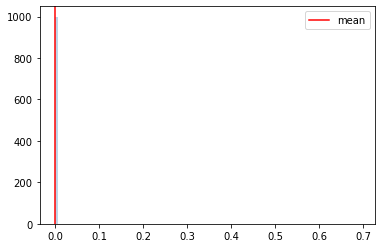

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654366634
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 0.1, 'jump_size_a': 10.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<00:59, 16.62it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:34, 10.50it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▌                                                                                | 7/1000 [00:00<01:40,  9.90it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▉                                                                               | 11/1000 [00:01<01:39,  9.95it/s]

Monte Carlo 9
Monte Carlo 10


  1%|█                                                                               | 13/1000 [00:01<01:39,  9.90it/s]

Monte Carlo 11
Monte Carlo 12
Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 17/1000 [00:01<01:41,  9.70it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:43,  9.53it/s]

Monte Carlo 17
Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<01:43,  9.42it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:46,  9.16it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<01:51,  8.76it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:02<01:48,  8.98it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<01:49,  8.89it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▌                                                                             | 32/1000 [00:03<01:45,  9.20it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<01:44,  9.25it/s]

Monte Carlo 32
Monte Carlo 33
Monte Carlo 34

  4%|██▊                                                                             | 35/1000 [00:03<01:41,  9.51it/s]


Monte Carlo 35
Monte Carlo 36

  4%|██▉                                                                             | 37/1000 [00:03<01:38,  9.75it/s]


Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<01:45,  9.14it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<01:49,  8.79it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:04<01:52,  8.53it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:04<01:45,  9.05it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:45,  8.99it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:44,  9.11it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:05<01:47,  8.81it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:05<01:49,  8.63it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:05<01:46,  8.84it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<01:51,  8.43it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:06<02:11,  7.15it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:06<02:07,  7.35it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<01:59,  7.87it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<01:54,  8.15it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▍                                                                          | 68/1000 [00:07<01:48,  8.60it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:07<01:49,  8.50it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:07<01:51,  8.34it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<01:59,  7.77it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:08<01:52,  8.21it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:08<01:56,  7.95it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:08<02:02,  7.50it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:09<01:59,  7.68it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:09<01:55,  7.97it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:09<01:50,  8.32it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:09<01:47,  8.47it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:10<01:55,  7.91it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:10<02:00,  7.54it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:10<02:01,  7.44it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<01:56,  7.78it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:11<01:57,  7.72it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:11<01:56,  7.72it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:11<01:53,  7.91it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:12<01:47,  8.34it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:12<01:53,  7.87it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:12<01:55,  7.75it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:12<01:56,  7.65it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:13<01:53,  7.85it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:13<02:10,  6.80it/s]

Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:13<02:11,  6.73it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:13<02:13,  6.64it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:14<02:03,  7.14it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:14<02:07,  6.92it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:14<02:01,  7.20it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:14<02:04,  7.03it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:15<02:01,  7.17it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:15<02:13,  6.52it/s]

Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:15<02:09,  6.71it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:16<02:15,  6.39it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:16<02:16,  6.37it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:16<02:15,  6.36it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:16<02:12,  6.52it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:17<02:05,  6.86it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:17<02:06,  6.80it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:17<02:04,  6.88it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:18<02:06,  6.75it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:18<02:05,  6.78it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:18<02:04,  6.82it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:19<02:11,  6.46it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:19<02:12,  6.37it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:19<02:12,  6.36it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:19<02:10,  6.45it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:20<02:10,  6.44it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:20<02:16,  6.16it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:20<02:11,  6.37it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:21<02:13,  6.25it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:21<02:10,  6.39it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:21<02:14,  6.17it/s]

Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:22<02:12,  6.27it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:22<02:15,  6.09it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:22<02:16,  6.05it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:23<02:17,  5.99it/s]

Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:23<02:16,  6.02it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:23<02:25,  5.63it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:23<02:22,  5.77it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:24<02:17,  5.95it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▍                                                                | 183/1000 [00:24<02:22,  5.73it/s]

Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:24<02:39,  5.12it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:25<02:19,  5.81it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:25<02:11,  6.14it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:25<02:20,  5.76it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:26<02:23,  5.63it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:26<02:21,  5.71it/s]

Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:26<02:18,  5.80it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:26<02:15,  5.91it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:27<02:12,  6.05it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:27<02:14,  5.93it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:27<02:16,  5.83it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:28<02:11,  6.02it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:28<02:11,  6.02it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:28<02:15,  5.84it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:29<02:12,  5.95it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:29<02:18,  5.69it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:29<02:20,  5.60it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:29<02:16,  5.74it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:30<02:19,  5.60it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:30<02:22,  5.50it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:30<02:18,  5.62it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:31<02:11,  5.91it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:31<02:17,  5.64it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:31<02:11,  5.87it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:32<02:10,  5.90it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:32<02:11,  5.85it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:32<02:17,  5.60it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:32<02:15,  5.66it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:33<02:17,  5.58it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:33<02:21,  5.40it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:34<02:18,  5.49it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:34<02:16,  5.56it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:34<02:11,  5.74it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:35<02:10,  5.77it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:35<02:14,  5.60it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:35<02:13,  5.63it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:36<02:16,  5.50it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:36<02:19,  5.38it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:36<02:24,  5.17it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:36<02:21,  5.25it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:37<02:19,  5.32it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:37<02:19,  5.32it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:37<02:22,  5.21it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:37<02:22,  5.20it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:37<02:17,  5.40it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:38<02:16,  5.40it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:38<02:17,  5.38it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:38<02:13,  5.50it/s]

Monte Carlo 263
Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:38<02:10,  5.62it/s]

Monte Carlo 265
Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:39<02:14,  5.45it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:39<02:14,  5.44it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:39<02:19,  5.22it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:39<02:14,  5.41it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:40<02:13,  5.45it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:40<02:16,  5.32it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:40<02:20,  5.17it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:41<02:19,  5.20it/s]

Monte Carlo 276
Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:41<02:14,  5.38it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:41<02:18,  5.21it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:42<02:14,  5.34it/s]

Monte Carlo 281
Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:42<02:18,  5.16it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:42<02:16,  5.24it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:42<02:19,  5.12it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:43<02:17,  5.18it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:43<02:15,  5.27it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:43<02:15,  5.24it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:43<02:18,  5.13it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:43<02:19,  5.06it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:44<02:18,  5.12it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:44<02:15,  5.22it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:44<02:15,  5.19it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:44<02:18,  5.09it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:44<02:20,  5.02it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:45<02:20,  5.00it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:45<02:23,  4.87it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:45<02:30,  4.66it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:46<02:32,  4.57it/s]

Monte Carlo 301
Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:46<02:38,  4.40it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:46<02:45,  4.21it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:46<02:50,  4.09it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:47<02:34,  4.48it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:47<02:29,  4.63it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:47<02:25,  4.75it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:47<02:20,  4.91it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:48<02:25,  4.74it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:48<02:21,  4.85it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:48<02:17,  4.99it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:48<02:14,  5.10it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:49<02:14,  5.09it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:49<02:17,  4.97it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:49<02:16,  4.99it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:49<02:17,  4.96it/s]

Monte Carlo 318
Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:50<02:18,  4.91it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:50<02:15,  4.99it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:50<02:15,  5.00it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:50<02:16,  4.96it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:51<02:14,  5.00it/s]

Monte Carlo 325
Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:51<02:16,  4.93it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:51<02:18,  4.85it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:51<02:20,  4.78it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:51<02:21,  4.74it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:52<02:36,  4.27it/s]

Monte Carlo 331
Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:52<02:34,  4.32it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:52<02:30,  4.41it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:53<02:23,  4.63it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:53<02:26,  4.51it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:53<02:23,  4.62it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:54<02:21,  4.67it/s]

Monte Carlo 339


 34%|██████████████████████████▉                                                    | 341/1000 [00:54<02:20,  4.70it/s]

Monte Carlo 340
Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:54<02:17,  4.78it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:55<02:16,  4.79it/s]

Monte Carlo 343
Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:55<02:23,  4.56it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:55<02:26,  4.47it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:55<02:26,  4.44it/s]

Monte Carlo 347


 35%|███████████████████████████▌                                                   | 349/1000 [00:56<02:18,  4.69it/s]

Monte Carlo 348
Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:56<02:25,  4.47it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:56<02:24,  4.49it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:56<02:22,  4.53it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:57<02:23,  4.52it/s]

Monte Carlo 353


 36%|████████████████████████████                                                   | 355/1000 [00:57<02:18,  4.67it/s]

Monte Carlo 354
Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [00:57<02:17,  4.69it/s]

Monte Carlo 356


 36%|████████████████████████████▎                                                  | 358/1000 [00:58<02:14,  4.79it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 359/1000 [00:58<02:14,  4.76it/s]

Monte Carlo 358


 36%|████████████████████████████▍                                                  | 360/1000 [00:58<02:12,  4.83it/s]

Monte Carlo 359


 36%|████████████████████████████▌                                                  | 361/1000 [00:58<02:09,  4.92it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 362/1000 [00:58<02:06,  5.03it/s]

Monte Carlo 361


 36%|████████████████████████████▋                                                  | 363/1000 [00:59<02:05,  5.06it/s]

Monte Carlo 362


 36%|████████████████████████████▊                                                  | 364/1000 [00:59<02:04,  5.10it/s]

Monte Carlo 363
Monte Carlo 364


 37%|████████████████████████████▉                                                  | 366/1000 [00:59<02:06,  5.02it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 367/1000 [00:59<02:05,  5.03it/s]

Monte Carlo 366
Monte Carlo 367


 37%|█████████████████████████████▏                                                 | 369/1000 [01:00<02:05,  5.03it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 370/1000 [01:00<02:06,  4.96it/s]

Monte Carlo 369


 37%|█████████████████████████████▎                                                 | 371/1000 [01:00<02:07,  4.95it/s]

Monte Carlo 370
Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:00<02:12,  4.76it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:01<02:13,  4.69it/s]

Monte Carlo 373


 38%|█████████████████████████████▋                                                 | 375/1000 [01:01<02:10,  4.78it/s]

Monte Carlo 374
Monte Carlo 375


 38%|█████████████████████████████▊                                                 | 377/1000 [01:01<02:07,  4.89it/s]

Monte Carlo 376
Monte Carlo 377


 38%|█████████████████████████████▉                                                 | 379/1000 [01:02<02:08,  4.83it/s]

Monte Carlo 378
Monte Carlo 379


 38%|██████████████████████████████                                                 | 381/1000 [01:02<02:09,  4.78it/s]

Monte Carlo 380
Monte Carlo 381


 38%|██████████████████████████████▎                                                | 383/1000 [01:03<02:10,  4.72it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 384/1000 [01:03<02:08,  4.78it/s]

Monte Carlo 383


 38%|██████████████████████████████▍                                                | 385/1000 [01:03<02:07,  4.82it/s]

Monte Carlo 384


 39%|██████████████████████████████▍                                                | 386/1000 [01:03<02:08,  4.79it/s]

Monte Carlo 385
Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:04<02:10,  4.70it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:04<02:11,  4.66it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:04<02:12,  4.63it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:04<02:10,  4.66it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:04<02:13,  4.57it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:05<02:11,  4.63it/s]

Monte Carlo 392


 39%|███████████████████████████████▏                                               | 394/1000 [01:05<02:12,  4.58it/s]

Monte Carlo 393
Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:05<02:16,  4.44it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:06<02:14,  4.49it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:06<02:14,  4.49it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:06<02:13,  4.50it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:06<02:13,  4.52it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:06<02:15,  4.41it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:07<02:13,  4.47it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:07<02:11,  4.55it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:07<02:16,  4.36it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:07<02:16,  4.37it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:08<02:12,  4.48it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:08<02:16,  4.36it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:08<02:16,  4.35it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:08<02:15,  4.35it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:09<02:17,  4.29it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:09<02:16,  4.32it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:09<02:16,  4.33it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:09<02:12,  4.43it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:09<02:25,  4.03it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:10<02:27,  3.97it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:10<02:25,  4.03it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:10<02:20,  4.15it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:10<02:15,  4.31it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:11<02:17,  4.25it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:11<02:19,  4.17it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:11<02:18,  4.20it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 422/1000 [01:12<02:13,  4.32it/s]

Monte Carlo 421
Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:12<02:16,  4.23it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:12<02:16,  4.21it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:12<02:17,  4.20it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:13<02:26,  3.93it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:13<02:25,  3.93it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:13<02:21,  4.03it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:13<02:27,  3.88it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:14<02:24,  3.95it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:14<02:26,  3.88it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:14<02:25,  3.92it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:14<02:21,  4.01it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:15<02:18,  4.08it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:15<02:16,  4.15it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:15<02:15,  4.17it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:15<02:13,  4.22it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:16<02:14,  4.17it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:16<02:15,  4.14it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:16<02:13,  4.21it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:16<02:19,  4.01it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:17<02:17,  4.05it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:17<02:37,  3.54it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:17<02:34,  3.61it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:17<02:26,  3.78it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:18<02:20,  3.95it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:18<02:17,  4.01it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:18<02:16,  4.04it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:18<02:17,  4.01it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:19<02:16,  4.04it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:19<02:19,  3.94it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:19<02:16,  4.03it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:19<02:18,  3.95it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:20<02:16,  3.99it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:20<02:18,  3.94it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:20<02:19,  3.90it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:20<02:16,  3.98it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:21<02:19,  3.90it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:21<02:19,  3.89it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:21<02:13,  4.04it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:21<02:13,  4.04it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:22<02:11,  4.08it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:22<02:15,  3.96it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:22<02:16,  3.92it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:22<02:15,  3.96it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:23<02:19,  3.84it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:23<02:18,  3.84it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:23<02:13,  3.99it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:23<02:16,  3.90it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:24<02:13,  3.96it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:24<02:10,  4.07it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:24<02:08,  4.11it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:24<02:10,  4.03it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:25<02:12,  3.97it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:25<02:13,  3.93it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:25<02:15,  3.85it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:26<02:18,  3.79it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:26<02:12,  3.95it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:26<02:16,  3.81it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:26<02:15,  3.84it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:27<02:13,  3.90it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:27<02:15,  3.81it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:27<02:14,  3.84it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:27<02:13,  3.86it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:28<02:12,  3.89it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:28<02:12,  3.88it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:28<02:09,  3.97it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:28<02:08,  3.97it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:29<02:08,  3.99it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:29<02:09,  3.95it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:29<02:09,  3.93it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:29<02:10,  3.90it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:30<02:10,  3.87it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:30<02:12,  3.82it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:30<02:09,  3.89it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:30<02:08,  3.94it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:31<02:09,  3.90it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:31<02:09,  3.87it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:31<02:08,  3.89it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:31<02:06,  3.97it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:32<02:05,  3.96it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:32<02:03,  4.03it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:32<02:02,  4.06it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:32<02:04,  3.98it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:33<02:10,  3.79it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:33<02:08,  3.86it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:33<02:06,  3.91it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:33<02:06,  3.90it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:34<02:06,  3.88it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:34<02:06,  3.86it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:34<02:09,  3.79it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:34<02:08,  3.79it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:35<02:07,  3.81it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:35<02:06,  3.85it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:35<02:06,  3.85it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:36<02:07,  3.80it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:36<02:09,  3.74it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:36<02:07,  3.78it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:36<02:09,  3.71it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:37<02:12,  3.61it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:37<02:08,  3.72it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:37<02:06,  3.79it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:37<02:05,  3.79it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:38<02:03,  3.86it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:38<02:05,  3.78it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:38<02:03,  3.83it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:38<02:02,  3.86it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:39<02:09,  3.65it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:39<02:07,  3.68it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:39<02:05,  3.75it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:40<02:03,  3.81it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:40<02:03,  3.79it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:40<01:58,  3.94it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:40<01:59,  3.90it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:41<01:58,  3.92it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:41<01:59,  3.87it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:41<01:57,  3.95it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:41<01:57,  3.93it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:42<01:57,  3.94it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:42<01:59,  3.86it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:42<01:59,  3.85it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:42<01:58,  3.85it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:43<02:02,  3.73it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:43<02:01,  3.76it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:43<01:58,  3.85it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:43<01:59,  3.79it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:44<01:59,  3.78it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:44<02:00,  3.75it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:44<02:01,  3.72it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:45<02:02,  3.68it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:45<01:58,  3.79it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:45<02:01,  3.68it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:45<02:01,  3.66it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:46<02:03,  3.60it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:46<02:03,  3.60it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:46<02:03,  3.61it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:46<02:02,  3.61it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:47<02:01,  3.65it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:47<02:00,  3.65it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:47<02:00,  3.64it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:48<02:00,  3.63it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:48<02:03,  3.54it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:48<02:03,  3.55it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:48<02:02,  3.55it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:49<02:03,  3.52it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:49<02:03,  3.53it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:49<02:18,  3.14it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:50<02:17,  3.15it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:50<02:16,  3.16it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:50<02:09,  3.32it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:51<02:09,  3.30it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:51<02:07,  3.36it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:51<02:06,  3.37it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:51<02:04,  3.42it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:52<02:07,  3.34it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:52<02:03,  3.42it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:52<02:01,  3.48it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:53<01:58,  3.56it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:53<02:00,  3.50it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:53<02:05,  3.35it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:53<02:04,  3.37it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:54<02:06,  3.30it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:54<02:05,  3.33it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:54<02:01,  3.43it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:55<02:02,  3.39it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [01:55<02:01,  3.41it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [01:55<02:00,  3.43it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [01:56<02:00,  3.41it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [01:56<01:59,  3.44it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [01:56<01:57,  3.48it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [01:56<01:56,  3.53it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [01:57<01:54,  3.58it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [01:57<01:53,  3.59it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [01:57<01:53,  3.59it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [01:57<01:53,  3.57it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [01:58<01:54,  3.53it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [01:58<01:52,  3.57it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [01:58<01:57,  3.43it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [01:59<01:56,  3.44it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [01:59<02:01,  3.30it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [01:59<01:58,  3.36it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:00<02:00,  3.29it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:00<02:02,  3.24it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:00<02:01,  3.26it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:01<02:00,  3.28it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:01<02:00,  3.28it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:01<01:58,  3.32it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:01<01:58,  3.32it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:02<01:58,  3.31it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:02<01:54,  3.40it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:02<01:53,  3.42it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:03<01:54,  3.40it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:03<01:54,  3.38it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:03<01:55,  3.36it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:03<01:53,  3.38it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:04<01:55,  3.32it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:04<01:52,  3.39it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:04<01:52,  3.40it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:05<01:50,  3.44it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:05<01:55,  3.29it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:05<01:57,  3.23it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:06<01:58,  3.19it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:06<01:55,  3.27it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:06<01:55,  3.25it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:07<01:54,  3.26it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:07<01:53,  3.28it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:07<01:52,  3.32it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:07<01:52,  3.30it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:08<01:51,  3.31it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:08<01:51,  3.32it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:08<01:51,  3.30it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:09<01:52,  3.28it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:09<01:55,  3.17it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:09<02:00,  3.05it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:10<01:57,  3.11it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:10<01:56,  3.12it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:10<01:55,  3.15it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:11<01:54,  3.16it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:11<01:56,  3.10it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:11<01:59,  3.03it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:12<01:55,  3.11it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:12<01:57,  3.05it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:12<01:59,  2.99it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:13<01:57,  3.03it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:13<01:53,  3.12it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:13<01:55,  3.08it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:14<01:53,  3.10it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:14<01:50,  3.18it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:14<01:52,  3.12it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:14<01:52,  3.10it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:15<01:53,  3.08it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:15<01:56,  3.00it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:15<01:53,  3.06it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:16<01:50,  3.14it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:16<01:49,  3.14it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:16<01:52,  3.06it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:17<01:51,  3.09it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:17<01:52,  3.04it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:17<01:50,  3.09it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:18<01:52,  3.03it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:18<01:51,  3.05it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:18<01:48,  3.10it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:19<01:47,  3.14it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:19<01:45,  3.17it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:19<01:45,  3.16it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:20<01:46,  3.12it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:20<01:47,  3.10it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:20<01:46,  3.12it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:21<01:48,  3.05it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:21<01:48,  3.04it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:21<01:47,  3.07it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:22<01:47,  3.05it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:22<01:49,  2.98it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:22<01:47,  3.03it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:23<01:45,  3.08it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:23<01:46,  3.04it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:23<01:46,  3.03it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:24<01:46,  3.02it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:24<01:47,  2.99it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:24<01:46,  3.01it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:25<01:45,  3.02it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:25<01:44,  3.05it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:25<01:43,  3.06it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:26<01:41,  3.11it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:26<01:38,  3.19it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:26<01:39,  3.15it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:26<01:37,  3.21it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:27<01:36,  3.24it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:27<01:35,  3.27it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:27<01:33,  3.31it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:28<01:33,  3.32it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:28<01:34,  3.25it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:28<01:35,  3.21it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:29<01:36,  3.18it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:29<01:36,  3.15it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:29<01:35,  3.19it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:30<01:36,  3.13it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:30<01:36,  3.13it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:30<01:47,  2.81it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:31<01:44,  2.88it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:31<01:42,  2.93it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:31<01:41,  2.94it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:32<01:40,  2.95it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:32<01:41,  2.92it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:32<01:43,  2.86it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:33<01:41,  2.91it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:33<01:38,  2.98it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:33<01:40,  2.91it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:34<01:39,  2.92it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:34<01:38,  2.94it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:34<01:38,  2.93it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:35<01:36,  2.99it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:35<01:35,  3.02it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:35<01:36,  2.98it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:36<01:37,  2.94it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:36<01:38,  2.88it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:37<01:39,  2.85it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:37<01:37,  2.88it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:37<01:36,  2.90it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:38<01:34,  2.96it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:38<01:35,  2.91it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:38<01:34,  2.95it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:39<01:34,  2.92it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:39<01:35,  2.88it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:39<01:34,  2.91it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:40<01:35,  2.86it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:40<01:38,  2.77it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:40<01:37,  2.79it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:41<01:34,  2.86it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:41<01:33,  2.88it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:41<01:32,  2.91it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:42<01:33,  2.85it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:42<01:31,  2.91it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:42<01:29,  2.98it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:43<01:28,  3.00it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:43<01:28,  2.97it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:43<01:27,  2.99it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:44<01:26,  3.02it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:44<01:25,  3.05it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:44<01:25,  3.05it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:45<01:26,  2.99it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:45<01:23,  3.09it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:45<01:22,  3.10it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:46<01:22,  3.09it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:46<01:21,  3.12it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:46<01:23,  3.05it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:47<01:23,  3.03it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:47<01:23,  3.03it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:47<01:23,  3.02it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:48<01:21,  3.08it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:48<01:21,  3.05it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:48<01:20,  3.07it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:49<01:21,  3.02it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:49<01:22,  2.97it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:49<01:23,  2.94it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:50<01:22,  2.96it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:50<01:27,  2.78it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:50<01:26,  2.81it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:51<01:28,  2.72it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:51<01:25,  2.82it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:51<01:26,  2.76it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:52<01:23,  2.85it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:52<01:22,  2.86it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:52<01:20,  2.94it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:53<01:19,  2.95it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:53<01:22,  2.84it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [02:54<01:21,  2.86it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [02:54<01:19,  2.92it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [02:54<01:18,  2.96it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [02:55<01:17,  2.96it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [02:55<01:17,  2.97it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [02:55<01:16,  2.99it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [02:56<01:16,  2.96it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [02:56<01:19,  2.83it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [02:56<01:21,  2.75it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [02:57<01:21,  2.75it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [02:57<01:44,  2.13it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [02:58<01:55,  1.92it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [02:59<01:53,  1.94it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [02:59<01:54,  1.93it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:00<01:52,  1.95it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:00<01:44,  2.09it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:00<01:40,  2.15it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:01<01:37,  2.21it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:01<01:31,  2.35it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:02<01:30,  2.36it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:02<01:28,  2.40it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:02<01:26,  2.44it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:03<01:24,  2.49it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:03<01:28,  2.37it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:04<01:25,  2.43it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:04<01:27,  2.38it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:05<01:31,  2.26it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:05<01:31,  2.26it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:05<01:32,  2.21it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:06<01:27,  2.33it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:06<01:23,  2.44it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:07<01:18,  2.56it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:07<01:18,  2.56it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:07<01:17,  2.57it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:08<01:18,  2.53it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:08<01:16,  2.58it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:09<01:16,  2.59it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:09<01:14,  2.62it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:09<01:19,  2.46it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:10<01:16,  2.53it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:10<01:16,  2.53it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:10<01:12,  2.63it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:11<01:11,  2.66it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:11<01:13,  2.58it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:12<01:11,  2.63it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:12<01:14,  2.52it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:12<01:12,  2.56it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:13<01:10,  2.62it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:13<01:13,  2.53it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:14<01:11,  2.57it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:14<01:10,  2.60it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:14<01:09,  2.61it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:15<01:11,  2.53it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:15<01:12,  2.48it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:16<01:10,  2.54it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:16<01:09,  2.57it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:16<01:08,  2.58it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:17<01:06,  2.64it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:17<01:07,  2.58it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:17<01:07,  2.59it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:18<01:05,  2.63it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:18<01:05,  2.62it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:19<01:07,  2.54it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:19<01:08,  2.49it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:19<01:08,  2.46it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:20<01:07,  2.50it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:20<01:12,  2.31it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:21<01:11,  2.33it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:21<01:11,  2.30it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:22<01:10,  2.32it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:22<01:13,  2.23it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:22<01:08,  2.36it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:23<01:07,  2.38it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:23<01:07,  2.36it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:24<01:04,  2.45it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:24<01:03,  2.47it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:24<01:01,  2.54it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:25<01:07,  2.30it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:25<01:04,  2.39it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:26<01:05,  2.34it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:26<01:03,  2.39it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:27<01:02,  2.44it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:27<01:01,  2.46it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:27<01:00,  2.48it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:28<00:59,  2.52it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:28<00:59,  2.50it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:29<00:58,  2.49it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:29<00:57,  2.54it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:29<00:57,  2.54it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:30<00:56,  2.57it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:30<00:56,  2.52it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:31<00:54,  2.58it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:31<00:55,  2.52it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:31<00:57,  2.44it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:32<00:55,  2.50it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:32<00:55,  2.50it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:33<00:54,  2.52it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:33<00:52,  2.59it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:33<00:51,  2.61it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:34<00:52,  2.57it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:34<00:52,  2.53it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:35<00:52,  2.51it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:35<00:50,  2.57it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:35<00:50,  2.56it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:36<00:49,  2.60it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:36<00:49,  2.60it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:36<00:49,  2.55it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:37<00:50,  2.49it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:37<00:52,  2.39it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:38<00:51,  2.39it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:38<00:50,  2.42it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:39<00:49,  2.46it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:39<00:49,  2.43it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:39<00:49,  2.43it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:40<00:49,  2.41it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:40<00:49,  2.41it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:41<00:50,  2.33it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:41<00:53,  2.15it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:42<00:51,  2.21it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:42<00:49,  2.28it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:43<00:51,  2.21it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:43<00:48,  2.31it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:43<00:46,  2.38it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:44<00:45,  2.44it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:44<00:46,  2.36it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:45<00:44,  2.43it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:45<00:45,  2.38it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:45<00:44,  2.38it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:46<00:42,  2.48it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:46<00:40,  2.55it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:47<00:39,  2.59it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:47<00:38,  2.64it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:47<00:37,  2.69it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:48<00:37,  2.69it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:48<00:36,  2.72it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:48<00:35,  2.73it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:49<00:35,  2.71it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:49<00:36,  2.64it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:49<00:35,  2.66it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:50<00:35,  2.65it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:50<00:34,  2.69it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:51<00:34,  2.69it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:51<00:33,  2.68it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:51<00:35,  2.56it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:52<00:34,  2.59it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:52<00:34,  2.59it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:53<00:33,  2.63it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:53<00:33,  2.53it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:53<00:36,  2.35it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:54<00:35,  2.34it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:54<00:35,  2.35it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:55<00:35,  2.34it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:55<00:34,  2.35it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:56<00:34,  2.32it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:56<00:34,  2.30it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:56<00:33,  2.32it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [03:57<00:34,  2.25it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [03:57<00:33,  2.28it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [03:58<00:32,  2.29it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [03:58<00:32,  2.28it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [03:59<00:31,  2.29it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [03:59<00:34,  2.06it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:00<00:33,  2.10it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:00<00:32,  2.13it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:01<00:33,  2.08it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:01<00:31,  2.17it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:02<00:30,  2.22it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:02<00:28,  2.32it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:02<00:28,  2.29it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:03<00:27,  2.35it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:03<00:27,  2.33it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:04<00:26,  2.32it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:04<00:26,  2.33it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:04<00:25,  2.38it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:05<00:24,  2.42it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:05<00:24,  2.41it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:06<00:23,  2.39it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:06<00:23,  2.38it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:07<00:23,  2.35it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:07<00:23,  2.34it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:07<00:22,  2.33it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:08<00:22,  2.34it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:08<00:22,  2.22it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:09<00:22,  2.22it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:09<00:22,  2.21it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:10<00:21,  2.21it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:10<00:21,  2.23it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:11<00:20,  2.24it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:11<00:19,  2.26it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:11<00:19,  2.20it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:12<00:19,  2.26it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:12<00:18,  2.29it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:13<00:17,  2.34it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:13<00:17,  2.33it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:14<00:17,  2.18it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:14<00:17,  2.16it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:15<00:16,  2.22it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:15<00:16,  2.25it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:15<00:15,  2.30it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:16<00:14,  2.32it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:16<00:14,  2.35it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:17<00:14,  2.29it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:17<00:13,  2.30it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:18<00:13,  2.29it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:18<00:12,  2.27it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:19<00:12,  2.20it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:19<00:12,  2.15it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:20<00:13,  1.94it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:20<00:13,  1.90it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:21<00:12,  1.95it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:21<00:11,  2.03it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:22<00:10,  2.02it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:22<00:09,  2.12it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:22<00:09,  2.22it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:23<00:08,  2.23it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:23<00:08,  2.22it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:24<00:07,  2.27it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:24<00:06,  2.33it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:25<00:06,  2.37it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:25<00:05,  2.35it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:25<00:05,  2.38it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:26<00:05,  2.36it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:26<00:04,  2.28it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:27<00:04,  2.21it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:27<00:03,  2.25it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:28<00:03,  2.25it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:28<00:03,  2.26it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:29<00:02,  2.28it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:29<00:02,  2.17it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:30<00:01,  2.11it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:30<00:01,  2.17it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:31<00:00,  2.02it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:31<00:00,  1.99it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:32<00:00,  3.68it/s]


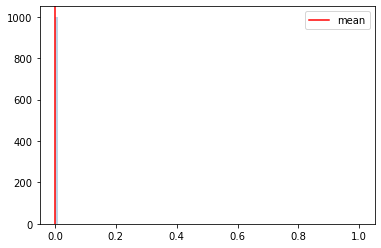

  0%|▏                                                                                | 2/1000 [00:00<00:50, 19.86it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654366907
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 0.1, 'jump_size_a': 10.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:34, 10.56it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:56,  8.53it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<02:00,  8.25it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<02:06,  7.83it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<02:07,  7.78it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<02:11,  7.49it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<02:12,  7.40it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<02:20,  6.99it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<02:21,  6.93it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<02:20,  6.98it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:03<02:33,  6.35it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<02:34,  6.30it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:36,  6.20it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:04<02:28,  6.55it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:04<02:40,  6.04it/s]

Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:04<02:43,  5.90it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<02:38,  6.08it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:05<02:36,  6.14it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:05<02:34,  6.23it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:05<02:27,  6.48it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:06<02:34,  6.19it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:06<02:38,  6.01it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:06<02:29,  6.36it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:07<02:38,  6.02it/s]

Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:07<02:35,  6.09it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:07<02:35,  6.09it/s]

Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:07<02:36,  6.06it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:08<02:33,  6.15it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:08<02:41,  5.84it/s]

Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:08<02:45,  5.69it/s]

Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:08<02:41,  5.81it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:09<02:34,  6.09it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:09<02:44,  5.71it/s]

Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:09<02:40,  5.82it/s]

Monte Carlo 63
Monte Carlo 64


  6%|█████▏                                                                          | 65/1000 [00:09<02:41,  5.80it/s]

Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:10<03:13,  4.82it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:10<03:00,  5.17it/s]

Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:10<02:53,  5.35it/s]

Monte Carlo 69
Monte Carlo 70

  7%|█████▋                                                                          | 71/1000 [00:11<02:45,  5.61it/s]


Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:11<02:43,  5.66it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:11<02:37,  5.86it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:12<02:36,  5.91it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:12<02:40,  5.73it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:12<02:42,  5.66it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:13<02:44,  5.56it/s]

Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:13<02:44,  5.58it/s]

Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:13<02:44,  5.55it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:13<02:44,  5.53it/s]

Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:14<02:43,  5.58it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:14<02:40,  5.66it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:14<02:43,  5.54it/s]

Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:15<02:37,  5.74it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:15<02:35,  5.81it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:15<02:39,  5.66it/s]

Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:15<02:29,  6.02it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:16<02:34,  5.81it/s]

Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:16<02:37,  5.69it/s]

Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:16<02:32,  5.89it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:16<02:30,  5.94it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:17<02:26,  6.10it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:17<02:26,  6.10it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:17<02:26,  6.08it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:18<02:26,  6.06it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:18<02:24,  6.14it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:18<02:31,  5.83it/s]

Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:19<02:31,  5.82it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:19<02:31,  5.82it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:19<02:27,  5.94it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:20<02:24,  6.07it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:20<02:19,  6.26it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:20<02:18,  6.30it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:21<02:20,  6.18it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:21<02:22,  6.09it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:21<02:24,  6.01it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:22<02:24,  5.99it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:22<02:25,  5.93it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:22<02:34,  5.59it/s]

Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:22<02:32,  5.64it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:23<02:34,  5.56it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:23<02:30,  5.69it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:23<02:25,  5.87it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:24<02:22,  5.97it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:24<02:27,  5.76it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:24<02:23,  5.92it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:25<02:30,  5.61it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:25<02:33,  5.48it/s]

Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:25<02:36,  5.38it/s]

Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:26<02:32,  5.51it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:26<02:25,  5.76it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:26<02:29,  5.61it/s]

Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:26<02:26,  5.71it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:27<02:25,  5.75it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:27<02:24,  5.78it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:28<02:30,  5.52it/s]

Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:28<02:27,  5.62it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:28<02:32,  5.43it/s]

Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:28<02:38,  5.22it/s]

Monte Carlo 172
Monte Carlo 173


 17%|█████████████▋                                                                 | 174/1000 [00:29<02:39,  5.18it/s]

Monte Carlo 174


 18%|█████████████▊                                                                 | 175/1000 [00:29<02:45,  4.99it/s]

Monte Carlo 175


 18%|█████████████▉                                                                 | 176/1000 [00:29<02:51,  4.79it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:29<02:43,  5.03it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 179/1000 [00:30<02:37,  5.22it/s]

Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:30<02:37,  5.20it/s]

Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:30<02:35,  5.25it/s]

Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:30<02:32,  5.37it/s]

Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:30<02:25,  5.60it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:31<02:34,  5.26it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 187/1000 [00:31<02:45,  4.92it/s]

Monte Carlo 187


 19%|██████████████▊                                                                | 188/1000 [00:31<02:54,  4.66it/s]

Monte Carlo 188


 19%|██████████████▉                                                                | 189/1000 [00:32<03:16,  4.13it/s]

Monte Carlo 189


 19%|███████████████                                                                | 190/1000 [00:32<03:15,  4.13it/s]

Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:32<03:17,  4.09it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:33<02:46,  4.83it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:33<02:33,  5.25it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:33<02:20,  5.69it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:34<02:22,  5.63it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:34<02:23,  5.56it/s]

Monte Carlo 200


 20%|████████████████                                                               | 203/1000 [00:34<02:28,  5.38it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:34<02:22,  5.60it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:35<02:23,  5.52it/s]

Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:35<02:20,  5.65it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▍                                                              | 208/1000 [00:35<02:17,  5.75it/s]

Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:36<02:24,  5.46it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:36<02:14,  5.85it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:36<02:19,  5.63it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:36<02:23,  5.48it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:37<02:21,  5.55it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:37<02:20,  5.55it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:37<02:21,  5.51it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:37<02:20,  5.56it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:38<02:18,  5.64it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:38<02:20,  5.53it/s]

Monte Carlo 223
Monte Carlo 224


 22%|█████████████████▊                                                             | 225/1000 [00:38<02:23,  5.41it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:39<02:30,  5.13it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:39<02:30,  5.12it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:39<02:34,  5.00it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:39<02:29,  5.14it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:39<02:25,  5.30it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▎                                                            | 232/1000 [00:40<02:34,  4.97it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 233/1000 [00:40<02:37,  4.87it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:40<02:35,  4.92it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:41<02:28,  5.13it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:41<02:31,  5.03it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:41<02:28,  5.12it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:41<02:23,  5.30it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████                                                            | 242/1000 [00:42<02:25,  5.22it/s]

Monte Carlo 242


 24%|███████████████████▏                                                           | 243/1000 [00:42<02:30,  5.02it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 244/1000 [00:42<02:33,  4.92it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:42<02:25,  5.17it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:43<02:18,  5.42it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:43<02:22,  5.28it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:43<02:19,  5.38it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▊                                                           | 251/1000 [00:43<02:21,  5.29it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 252/1000 [00:44<02:23,  5.23it/s]

Monte Carlo 252


 25%|███████████████████▉                                                           | 253/1000 [00:44<02:35,  4.82it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:44<02:30,  4.95it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:44<02:24,  5.14it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:45<02:18,  5.35it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 258/1000 [00:45<02:18,  5.34it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:45<02:25,  5.08it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:45<02:23,  5.14it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:46<02:20,  5.24it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:46<02:18,  5.33it/s]

Monte Carlo 263
Monte Carlo 264


 26%|████████████████████▉                                                          | 265/1000 [00:46<02:26,  5.02it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:47<02:28,  4.93it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:47<02:26,  4.99it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 269/1000 [00:47<02:31,  4.83it/s]

Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:47<02:35,  4.69it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:48<02:32,  4.77it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:48<02:26,  4.98it/s]

Monte Carlo 272
Monte Carlo 273


 27%|█████████████████████▋                                                         | 274/1000 [00:48<02:26,  4.95it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:48<02:27,  4.90it/s]

Monte Carlo 275
Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:49<02:27,  4.88it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:49<02:23,  5.00it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:49<02:23,  5.00it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:50<02:37,  4.56it/s]

Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:50<02:39,  4.51it/s]

Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:50<02:39,  4.49it/s]

Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:50<02:47,  4.28it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:51<02:43,  4.36it/s]

Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:51<02:41,  4.41it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:51<02:43,  4.36it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:51<02:47,  4.25it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:52<03:22,  3.51it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:52<03:20,  3.54it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:52<03:15,  3.63it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:53<02:46,  4.23it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:53<02:40,  4.40it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:53<02:40,  4.40it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:54<02:34,  4.55it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:54<02:30,  4.64it/s]

Monte Carlo 299
Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:54<02:37,  4.45it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:54<02:37,  4.43it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:55<02:32,  4.56it/s]

Monte Carlo 303
Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:55<02:46,  4.17it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:55<02:53,  4.01it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:56<02:51,  4.05it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:56<02:46,  4.14it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:56<02:48,  4.11it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:56<02:44,  4.19it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:57<02:39,  4.33it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:57<02:41,  4.26it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:57<02:41,  4.25it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:57<02:40,  4.27it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:57<02:37,  4.34it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:58<02:32,  4.48it/s]

Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:58<02:34,  4.42it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:58<02:36,  4.34it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:59<02:41,  4.20it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:59<02:37,  4.31it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:59<02:36,  4.34it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:59<02:44,  4.13it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [01:00<02:38,  4.27it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [01:00<02:40,  4.21it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [01:00<02:36,  4.32it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [01:00<02:44,  4.09it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [01:01<02:38,  4.23it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [01:01<02:35,  4.33it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [01:01<02:34,  4.33it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [01:01<02:33,  4.34it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [01:01<02:35,  4.30it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [01:02<02:40,  4.15it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [01:02<02:41,  4.12it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [01:02<02:37,  4.22it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [01:02<02:34,  4.29it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [01:03<02:31,  4.37it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [01:03<02:32,  4.35it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [01:03<02:33,  4.32it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [01:03<02:35,  4.24it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [01:04<02:38,  4.15it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [01:04<02:40,  4.10it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [01:04<02:38,  4.14it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [01:04<02:55,  3.74it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:05<02:44,  3.98it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:05<02:42,  4.03it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:05<02:40,  4.06it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:05<02:41,  4.04it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:06<02:44,  3.97it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:06<02:42,  4.01it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:06<02:40,  4.04it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:06<02:41,  4.01it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:07<02:40,  4.02it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:07<02:35,  4.16it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:07<02:41,  4.00it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:07<02:44,  3.92it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:08<02:39,  4.03it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:08<02:35,  4.12it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:08<02:39,  4.02it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:08<02:37,  4.07it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:09<02:51,  3.72it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:09<02:46,  3.84it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:09<02:42,  3.93it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:09<02:35,  4.10it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:10<02:37,  4.03it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:10<02:30,  4.21it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:10<02:34,  4.11it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:10<02:33,  4.10it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:11<02:31,  4.16it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:11<02:30,  4.18it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:11<02:29,  4.20it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:11<02:27,  4.26it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:11<02:26,  4.28it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:12<02:25,  4.29it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:12<02:30,  4.15it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:12<02:31,  4.11it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:13<02:37,  3.95it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:13<02:37,  3.95it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:13<02:32,  4.07it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 381/1000 [01:13<02:23,  4.31it/s]

Monte Carlo 380
Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:14<02:21,  4.36it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:14<02:18,  4.45it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:14<02:26,  4.22it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:14<02:23,  4.29it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:15<02:22,  4.31it/s]

Monte Carlo 386


 39%|██████████████████████████████▋                                                | 388/1000 [01:15<02:16,  4.49it/s]

Monte Carlo 387
Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:15<02:19,  4.39it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:15<02:19,  4.37it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:16<02:18,  4.39it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:16<02:16,  4.45it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:16<02:18,  4.39it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:16<02:16,  4.45it/s]

Monte Carlo 394


 40%|███████████████████████████████▎                                               | 396/1000 [01:17<02:18,  4.37it/s]

Monte Carlo 395
Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:17<02:18,  4.36it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:17<02:20,  4.30it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:18<02:20,  4.27it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:18<02:25,  4.13it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:18<02:29,  4.01it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:18<02:25,  4.11it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:19<02:26,  4.06it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:19<02:26,  4.06it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:19<02:29,  3.99it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:19<02:25,  4.07it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:20<02:29,  3.98it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:20<02:29,  3.97it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:20<02:28,  3.98it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:20<02:33,  3.84it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:21<02:34,  3.80it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:21<02:32,  3.86it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:21<02:34,  3.80it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:21<02:34,  3.78it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:22<02:34,  3.78it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:22<02:31,  3.86it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:22<02:29,  3.89it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:22<02:25,  3.99it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:23<02:29,  3.89it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:23<02:30,  3.85it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:23<02:29,  3.87it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:23<02:24,  4.00it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:24<02:28,  3.88it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:24<02:29,  3.84it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:24<02:25,  3.96it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:24<02:24,  3.96it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:25<02:26,  3.90it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:25<02:24,  3.96it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:25<02:27,  3.87it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:26<02:25,  3.92it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:26<02:25,  3.90it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:26<02:28,  3.83it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:26<02:29,  3.79it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:27<02:25,  3.89it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:27<02:30,  3.76it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:27<02:29,  3.76it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:27<02:29,  3.76it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:28<02:30,  3.74it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:28<02:28,  3.78it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:28<02:31,  3.70it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:28<02:29,  3.73it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:29<02:29,  3.74it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:29<02:27,  3.77it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:29<02:28,  3.74it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:30<02:31,  3.66it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:30<02:33,  3.62it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:30<02:31,  3.65it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:30<02:29,  3.70it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:31<02:23,  3.84it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:31<02:27,  3.74it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:31<02:25,  3.78it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:31<02:27,  3.72it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:32<02:35,  3.53it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:32<02:32,  3.59it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:32<02:29,  3.64it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:33<02:33,  3.55it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:33<02:34,  3.52it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:33<02:39,  3.40it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:33<02:36,  3.47it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:34<02:32,  3.53it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:34<02:32,  3.54it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:34<02:30,  3.58it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:35<02:30,  3.57it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:35<02:28,  3.61it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:35<02:30,  3.57it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:35<02:26,  3.64it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:36<02:22,  3.75it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:36<02:24,  3.67it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:36<02:21,  3.75it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:36<02:22,  3.73it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:37<02:24,  3.67it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:37<02:24,  3.66it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:37<02:27,  3.56it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:38<02:29,  3.52it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:38<02:31,  3.46it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:38<02:32,  3.44it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:38<02:27,  3.56it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:39<02:27,  3.54it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:39<02:28,  3.50it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:39<02:27,  3.52it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:40<02:25,  3.57it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:40<02:21,  3.66it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:40<02:22,  3.63it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:40<02:20,  3.69it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:41<02:40,  3.20it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:41<02:30,  3.40it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:41<02:25,  3.51it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:42<02:23,  3.56it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:42<02:24,  3.54it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:42<02:26,  3.47it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:42<02:25,  3.49it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:43<02:26,  3.47it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:43<02:26,  3.47it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:43<02:24,  3.50it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:44<02:24,  3.49it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:44<02:22,  3.53it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:44<02:24,  3.49it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:44<02:24,  3.47it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:45<02:26,  3.42it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:45<02:24,  3.45it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:45<02:22,  3.50it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:46<02:24,  3.45it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:46<02:23,  3.46it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:46<02:24,  3.43it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:46<02:21,  3.49it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:47<02:20,  3.52it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:47<02:23,  3.44it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:47<02:24,  3.40it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:48<02:23,  3.43it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:48<02:24,  3.39it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:48<02:24,  3.39it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:48<02:21,  3.45it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:49<02:19,  3.49it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:49<02:22,  3.40it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:49<02:21,  3.42it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:50<02:18,  3.49it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:50<02:20,  3.44it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:50<02:21,  3.40it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:51<02:21,  3.41it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:51<02:18,  3.46it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:51<02:17,  3.48it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:51<02:17,  3.48it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:52<02:17,  3.47it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:52<02:18,  3.43it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:52<02:15,  3.51it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:53<02:17,  3.46it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:53<02:18,  3.41it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:53<02:21,  3.33it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:53<02:21,  3.34it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:54<02:22,  3.29it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:54<02:20,  3.34it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:54<02:19,  3.35it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:55<02:16,  3.41it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:55<02:13,  3.48it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:55<02:16,  3.41it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:56<02:19,  3.31it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:56<02:23,  3.22it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:56<02:24,  3.19it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:57<02:26,  3.15it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:57<02:24,  3.18it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:57<02:19,  3.28it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:57<02:18,  3.31it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:58<02:22,  3.21it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:58<02:21,  3.22it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:58<02:21,  3.21it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:59<02:21,  3.21it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:59<02:15,  3.34it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:59<02:15,  3.34it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [02:00<02:13,  3.38it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [02:00<02:10,  3.44it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [02:00<02:11,  3.41it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [02:00<02:15,  3.31it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [02:01<02:16,  3.28it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [02:01<02:15,  3.29it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [02:01<02:13,  3.33it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [02:02<02:12,  3.36it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [02:02<02:15,  3.28it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [02:02<02:12,  3.34it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [02:03<02:19,  3.17it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [02:03<02:16,  3.23it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [02:03<02:14,  3.27it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [02:03<02:11,  3.32it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [02:04<02:12,  3.29it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [02:04<02:14,  3.25it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [02:04<02:11,  3.30it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [02:05<02:16,  3.17it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:05<02:17,  3.16it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:05<02:18,  3.12it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:06<02:14,  3.21it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:06<02:11,  3.28it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:06<02:08,  3.33it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:07<02:11,  3.27it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:07<02:08,  3.32it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:07<02:07,  3.33it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:07<02:11,  3.23it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:08<02:12,  3.19it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:08<02:15,  3.13it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:08<02:15,  3.11it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:09<02:11,  3.20it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:09<02:13,  3.16it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:09<02:10,  3.22it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:10<02:09,  3.24it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:10<02:09,  3.23it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:10<02:10,  3.20it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:11<02:09,  3.20it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:11<02:09,  3.21it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:11<02:10,  3.17it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:12<02:08,  3.21it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:12<02:06,  3.25it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:12<02:06,  3.25it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:12<02:06,  3.24it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:13<02:06,  3.23it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:13<02:08,  3.16it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:13<02:08,  3.16it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:14<02:07,  3.18it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:14<02:09,  3.13it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:14<02:09,  3.10it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:15<02:06,  3.17it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:15<02:12,  3.03it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:15<02:09,  3.10it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:16<02:09,  3.08it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:16<02:08,  3.10it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:16<02:08,  3.09it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:17<02:22,  2.77it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:17<02:15,  2.92it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:17<02:11,  2.99it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:18<02:12,  2.97it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:18<02:09,  3.02it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:18<02:08,  3.05it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:19<02:06,  3.09it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:19<02:07,  3.04it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:19<02:06,  3.07it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:20<02:04,  3.10it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:20<02:06,  3.04it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:20<02:07,  3.03it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:21<02:04,  3.10it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:21<02:06,  3.03it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:21<02:05,  3.04it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:22<02:07,  2.98it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:22<02:08,  2.96it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:22<02:05,  3.01it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:23<02:03,  3.05it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:23<02:04,  3.02it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:23<02:06,  2.96it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:24<02:05,  3.00it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:24<02:06,  2.96it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:24<02:07,  2.93it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:25<02:05,  2.96it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:25<02:03,  3.00it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:25<02:02,  3.01it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:26<02:05,  2.95it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:26<02:04,  2.97it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:26<02:03,  2.96it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:27<02:04,  2.94it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:27<02:03,  2.95it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:27<02:02,  2.97it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:28<01:59,  3.03it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:28<02:02,  2.95it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:28<02:00,  2.98it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:29<02:00,  2.98it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:29<02:00,  2.97it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:29<02:00,  2.97it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:30<02:04,  2.88it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:30<02:03,  2.89it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:30<02:01,  2.93it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:31<02:02,  2.89it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:31<02:02,  2.87it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:32<02:05,  2.81it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:32<02:10,  2.69it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:32<02:04,  2.81it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:33<02:00,  2.90it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:33<02:00,  2.89it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:33<02:01,  2.85it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:34<02:05,  2.75it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:34<02:02,  2.82it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:34<02:03,  2.80it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:35<02:04,  2.76it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:35<02:01,  2.82it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:35<01:57,  2.89it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:36<01:57,  2.90it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:36<01:57,  2.90it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:36<01:57,  2.89it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:37<01:55,  2.92it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:37<01:58,  2.84it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:38<01:58,  2.82it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:38<01:55,  2.89it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:38<01:56,  2.87it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:39<01:56,  2.85it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:39<01:55,  2.86it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:39<01:54,  2.87it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:40<01:52,  2.92it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:40<01:51,  2.94it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:40<01:54,  2.85it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:41<01:55,  2.83it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:41<01:55,  2.82it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:41<01:53,  2.85it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:42<01:53,  2.86it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:42<01:55,  2.79it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:42<01:53,  2.83it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:43<01:55,  2.76it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:43<01:55,  2.76it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:44<01:54,  2.77it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:44<01:54,  2.78it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:44<01:53,  2.80it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:45<01:50,  2.85it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:45<01:51,  2.81it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:45<01:51,  2.81it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:46<01:51,  2.80it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:46<01:52,  2.78it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:46<01:50,  2.80it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:47<01:50,  2.79it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:47<01:51,  2.76it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:47<01:51,  2.76it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:48<01:48,  2.82it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:48<01:46,  2.87it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:49<01:49,  2.78it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:49<01:49,  2.76it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:49<01:48,  2.78it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:50<01:49,  2.74it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:50<01:49,  2.74it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:50<01:46,  2.80it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:51<01:49,  2.73it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:51<01:52,  2.64it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:51<01:49,  2.71it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:52<01:50,  2.68it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:52<01:48,  2.70it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:53<01:48,  2.70it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:53<01:46,  2.74it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:53<01:45,  2.75it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:54<01:47,  2.69it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:54<01:46,  2.73it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:54<01:45,  2.72it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:55<01:45,  2.73it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:55<01:44,  2.73it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:56<01:44,  2.72it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:56<01:44,  2.71it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:56<01:43,  2.73it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:57<01:43,  2.72it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:57<01:44,  2.69it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:57<01:44,  2.69it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:58<01:44,  2.67it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:58<01:45,  2.63it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:59<01:46,  2.59it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:59<01:44,  2.63it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:59<01:45,  2.61it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [03:00<01:46,  2.57it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [03:00<01:43,  2.64it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [03:01<01:52,  2.43it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [03:01<01:47,  2.52it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [03:01<01:49,  2.47it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [03:02<01:46,  2.53it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [03:02<01:46,  2.52it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [03:03<01:44,  2.55it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [03:03<01:43,  2.58it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [03:03<01:44,  2.55it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [03:04<01:44,  2.53it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [03:04<01:40,  2.61it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [03:04<01:46,  2.47it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:05<01:46,  2.46it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:05<01:45,  2.45it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:06<01:40,  2.58it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:06<01:39,  2.60it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:06<01:38,  2.61it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:07<01:38,  2.60it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:07<01:38,  2.59it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:08<01:38,  2.59it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:08<01:38,  2.56it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:08<01:40,  2.51it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:09<01:36,  2.60it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:09<01:39,  2.52it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:10<01:36,  2.58it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:10<01:35,  2.58it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:10<01:35,  2.57it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:11<01:34,  2.60it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:11<01:35,  2.57it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:11<01:32,  2.63it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:12<01:32,  2.63it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:12<01:32,  2.61it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:13<01:29,  2.69it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:13<01:29,  2.69it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:13<01:29,  2.66it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:14<01:29,  2.65it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:14<01:27,  2.71it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:14<01:27,  2.69it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:15<01:29,  2.64it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:15<01:30,  2.59it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:16<01:31,  2.55it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:16<01:32,  2.52it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:16<01:29,  2.59it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:17<01:27,  2.62it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:17<01:27,  2.62it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:18<01:25,  2.65it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:18<01:26,  2.63it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:18<01:25,  2.64it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:19<01:23,  2.68it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:19<01:23,  2.68it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:19<01:28,  2.51it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:20<01:28,  2.51it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:20<01:26,  2.54it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:21<01:26,  2.55it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:21<01:25,  2.56it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:21<01:23,  2.61it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:22<01:22,  2.64it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:22<01:21,  2.66it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:23<01:21,  2.62it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:23<01:22,  2.59it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:23<01:21,  2.62it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:24<01:21,  2.59it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:24<01:23,  2.53it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:24<01:21,  2.56it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:25<01:20,  2.61it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:25<01:19,  2.63it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:26<01:17,  2.69it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:26<01:15,  2.73it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:26<01:14,  2.75it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:27<01:13,  2.79it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:27<01:14,  2.74it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:27<01:14,  2.70it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:28<01:13,  2.74it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:28<01:14,  2.70it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:28<01:11,  2.77it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:29<01:11,  2.77it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:29<01:11,  2.75it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:30<01:11,  2.74it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:30<01:12,  2.69it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:30<01:12,  2.66it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:31<01:11,  2.69it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:31<01:11,  2.68it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:32<01:14,  2.58it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:32<01:14,  2.55it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:32<01:14,  2.54it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:33<01:12,  2.59it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:33<01:11,  2.61it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:33<01:13,  2.55it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:34<01:13,  2.52it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:34<01:15,  2.45it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:35<01:14,  2.47it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:35<01:15,  2.42it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:36<01:14,  2.43it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:36<01:20,  2.23it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:36<01:17,  2.30it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:37<01:15,  2.34it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:37<01:15,  2.35it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:38<01:12,  2.43it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:38<01:10,  2.48it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:39<01:11,  2.45it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:39<01:08,  2.51it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:39<01:08,  2.52it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:40<01:07,  2.52it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:40<01:06,  2.57it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:40<01:07,  2.52it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:41<01:07,  2.50it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:41<01:06,  2.50it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:42<01:07,  2.47it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:42<01:05,  2.53it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:42<01:04,  2.53it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:43<01:04,  2.51it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:43<01:04,  2.50it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:44<01:05,  2.47it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:44<01:04,  2.47it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:44<01:04,  2.46it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:45<01:03,  2.47it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:45<01:02,  2.52it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:46<01:03,  2.46it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:46<01:01,  2.52it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:46<01:02,  2.47it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:47<01:02,  2.44it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:47<01:02,  2.44it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:48<01:00,  2.48it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:48<01:00,  2.48it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:49<00:59,  2.49it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:49<00:58,  2.52it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:49<00:59,  2.48it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:50<00:58,  2.48it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:50<01:02,  2.32it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:51<01:01,  2.35it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:51<00:59,  2.42it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:51<00:59,  2.39it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:52<00:57,  2.43it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:52<00:56,  2.49it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:53<00:56,  2.45it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:53<00:58,  2.35it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:54<00:58,  2.32it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:54<00:58,  2.33it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:54<00:57,  2.34it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:55<00:56,  2.37it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:55<00:54,  2.42it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:56<00:54,  2.42it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:56<00:54,  2.42it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:56<00:52,  2.46it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:57<00:51,  2.48it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:57<00:51,  2.46it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:58<00:51,  2.45it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:58<00:52,  2.42it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:58<00:51,  2.40it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:59<00:50,  2.46it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:59<00:48,  2.51it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [04:00<00:49,  2.47it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [04:00<00:49,  2.47it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [04:00<00:48,  2.46it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [04:01<00:48,  2.46it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [04:01<00:47,  2.46it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [04:02<00:47,  2.46it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [04:02<00:48,  2.40it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [04:03<00:47,  2.42it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [04:03<00:47,  2.40it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [04:03<00:47,  2.39it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [04:04<00:47,  2.36it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [04:04<00:45,  2.41it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [04:05<00:46,  2.37it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:05<00:45,  2.41it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:06<00:45,  2.37it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:06<00:44,  2.40it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:06<00:43,  2.41it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:07<00:43,  2.41it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:07<00:42,  2.45it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:08<00:42,  2.41it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:08<00:41,  2.45it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:08<00:42,  2.40it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:09<00:41,  2.43it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:09<00:40,  2.46it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:10<00:40,  2.44it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:10<00:39,  2.45it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:10<00:39,  2.45it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:11<00:39,  2.41it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:11<00:39,  2.41it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:12<00:39,  2.35it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:12<00:38,  2.39it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:13<00:38,  2.39it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:13<00:38,  2.36it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:13<00:37,  2.38it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:14<00:36,  2.39it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:14<00:36,  2.39it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:15<00:35,  2.39it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:15<00:37,  2.29it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:16<00:35,  2.34it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:16<00:35,  2.34it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:16<00:34,  2.35it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:17<00:34,  2.33it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:17<00:34,  2.31it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:18<00:33,  2.34it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:18<00:33,  2.31it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:19<00:33,  2.33it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:19<00:32,  2.33it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:19<00:32,  2.33it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:20<00:33,  2.20it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:20<00:32,  2.26it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:21<00:31,  2.26it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:21<00:30,  2.31it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:22<00:30,  2.29it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:22<00:30,  2.28it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:22<00:29,  2.31it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:23<00:29,  2.30it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:23<00:29,  2.27it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:24<00:28,  2.29it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:24<00:28,  2.26it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:25<00:28,  2.24it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:25<00:27,  2.25it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:26<00:26,  2.27it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:26<00:26,  2.30it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:26<00:25,  2.34it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:27<00:24,  2.37it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:27<00:24,  2.33it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:28<00:24,  2.32it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:28<00:24,  2.25it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:29<00:24,  2.24it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:29<00:23,  2.28it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:29<00:22,  2.29it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:30<00:22,  2.30it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:30<00:21,  2.35it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:31<00:21,  2.31it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:31<00:21,  2.24it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:32<00:21,  2.22it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:32<00:19,  2.31it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:32<00:18,  2.38it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:33<00:18,  2.42it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:33<00:18,  2.37it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:34<00:17,  2.42it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:34<00:17,  2.40it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:35<00:17,  2.35it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:35<00:16,  2.35it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:35<00:16,  2.36it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:36<00:15,  2.34it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:36<00:15,  2.32it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:37<00:14,  2.34it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:37<00:14,  2.33it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:38<00:14,  2.30it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:38<00:14,  2.27it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:38<00:13,  2.27it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:39<00:13,  2.26it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:39<00:12,  2.28it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:40<00:12,  2.28it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:40<00:11,  2.27it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:41<00:11,  2.27it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:41<00:11,  2.23it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:42<00:10,  2.27it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:42<00:10,  2.25it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:43<00:09,  2.22it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:43<00:09,  2.24it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:43<00:08,  2.26it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:44<00:08,  2.23it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:44<00:08,  2.18it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:45<00:07,  2.16it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:45<00:07,  2.19it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:46<00:06,  2.20it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:46<00:06,  2.21it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:47<00:05,  2.21it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:47<00:05,  2.22it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:47<00:04,  2.25it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:48<00:04,  2.21it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:48<00:04,  2.24it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:49<00:03,  2.24it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:49<00:03,  2.19it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:50<00:02,  2.15it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:50<00:02,  2.17it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:51<00:01,  2.19it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:51<00:01,  2.19it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:52<00:00,  2.15it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:52<00:00,  2.17it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:53<00:00,  3.41it/s]


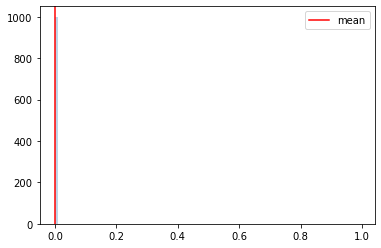

  0%|▏                                                                                | 2/1000 [00:00<00:50, 19.66it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654367201
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 0.1, 'jump_size_a': 10.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:32, 10.77it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<02:01,  8.16it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<02:16,  7.26it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<02:13,  7.42it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<02:08,  7.68it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<02:08,  7.65it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:02<02:05,  7.87it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<02:04,  7.88it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<02:06,  7.73it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<02:13,  7.34it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▊                                                                              | 23/1000 [00:02<02:12,  7.40it/s]

Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:03<02:57,  5.51it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██                                                                              | 26/1000 [00:03<02:57,  5.48it/s]

Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:04<03:08,  5.14it/s]

Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:04<03:06,  5.22it/s]

Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:04<02:53,  5.59it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:04<02:54,  5.55it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:05<02:37,  6.15it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:05<02:23,  6.70it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:05<02:25,  6.59it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:05<02:21,  6.81it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:06<02:17,  6.99it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:06<02:26,  6.51it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:06<02:24,  6.60it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:07<02:15,  7.03it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:07<02:21,  6.70it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:07<02:20,  6.74it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:07<02:20,  6.71it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:08<02:12,  7.13it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:08<02:19,  6.74it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:08<02:26,  6.43it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:09<02:22,  6.59it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:09<02:16,  6.86it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:09<02:10,  7.17it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:10<02:21,  6.60it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:10<02:25,  6.38it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:10<02:25,  6.36it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:10<02:18,  6.71it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:11<02:20,  6.57it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:11<02:22,  6.45it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:11<02:25,  6.30it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:12<02:18,  6.63it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:12<02:12,  6.91it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:12<02:18,  6.62it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:13<02:17,  6.63it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:13<02:19,  6.54it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:13<02:19,  6.50it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:14<02:18,  6.55it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:14<02:21,  6.37it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:14<02:22,  6.35it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:14<02:23,  6.27it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:15<02:26,  6.15it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:15<02:24,  6.22it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:15<02:26,  6.11it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:16<02:26,  6.07it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:16<02:28,  5.99it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:16<02:24,  6.13it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:17<02:19,  6.35it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:17<02:17,  6.44it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:17<02:23,  6.15it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:18<02:19,  6.30it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:18<02:23,  6.11it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:18<02:20,  6.22it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:19<02:23,  6.08it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:19<02:18,  6.27it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:19<02:24,  6.04it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:20<02:31,  5.74it/s]

Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:20<02:30,  5.78it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:20<02:24,  5.97it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:21<02:23,  6.00it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:21<02:18,  6.22it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:21<02:18,  6.21it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:22<02:25,  5.90it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:22<02:33,  5.58it/s]

Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:22<02:27,  5.79it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:22<02:24,  5.89it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 149/1000 [00:23<02:23,  5.92it/s]

Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:23<02:47,  5.06it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:23<02:31,  5.58it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:24<02:25,  5.82it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:24<02:27,  5.73it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:24<02:27,  5.69it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:25<02:26,  5.73it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:25<02:29,  5.61it/s]

Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:25<02:30,  5.54it/s]

Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:25<02:25,  5.75it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:26<02:22,  5.84it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:26<02:20,  5.92it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:26<02:18,  5.97it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:27<02:19,  5.95it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:27<02:36,  5.27it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 176/1000 [00:27<02:33,  5.38it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:28<02:36,  5.26it/s]

Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:28<02:40,  5.11it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:28<02:38,  5.18it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:29<02:35,  5.25it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:29<02:32,  5.36it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:29<02:29,  5.46it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:30<02:29,  5.43it/s]

Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:30<02:26,  5.54it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:30<02:25,  5.54it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:31<02:33,  5.25it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:31<02:37,  5.11it/s]

Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:31<02:32,  5.27it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:31<02:27,  5.43it/s]

Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:32<02:28,  5.40it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:32<02:28,  5.39it/s]

Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:32<02:34,  5.18it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:32<02:29,  5.33it/s]

Monte Carlo 200
Monte Carlo 201


 20%|███████████████▉                                                               | 202/1000 [00:32<02:33,  5.19it/s]

Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:33<02:34,  5.16it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:33<02:32,  5.22it/s]

Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:33<02:28,  5.33it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:33<02:30,  5.25it/s]

Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:34<02:28,  5.31it/s]

Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:34<02:29,  5.28it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:34<02:36,  5.05it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:34<02:35,  5.07it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:35<02:32,  5.15it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:35<02:28,  5.27it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:36<02:28,  5.25it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:36<02:26,  5.33it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:36<02:31,  5.14it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:37<02:34,  5.02it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:37<02:36,  4.96it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:37<02:30,  5.13it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:38<02:27,  5.21it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 230/1000 [00:38<02:32,  5.06it/s]

Monte Carlo 230


 23%|██████████████████▏                                                            | 231/1000 [00:38<02:33,  5.02it/s]

Monte Carlo 231


 23%|██████████████████▎                                                            | 232/1000 [00:38<02:35,  4.94it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:39<02:31,  5.06it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:39<02:30,  5.06it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▋                                                            | 237/1000 [00:39<02:34,  4.95it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:40<02:29,  5.09it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:40<02:28,  5.13it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:40<02:28,  5.10it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████                                                            | 242/1000 [00:40<02:31,  5.00it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:41<02:31,  4.98it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:41<02:29,  5.06it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:41<02:27,  5.10it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 247/1000 [00:41<02:33,  4.90it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:42<02:31,  4.96it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:42<02:34,  4.85it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 252/1000 [00:42<02:38,  4.71it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:43<02:32,  4.90it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:43<02:32,  4.90it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:43<02:35,  4.79it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 258/1000 [00:44<02:34,  4.79it/s]

Monte Carlo 258


 26%|████████████████████▍                                                          | 259/1000 [00:44<02:41,  4.60it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:44<02:36,  4.73it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:44<02:33,  4.79it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:45<02:33,  4.80it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:45<02:32,  4.83it/s]

Monte Carlo 263
Monte Carlo 264


 26%|████████████████████▉                                                          | 265/1000 [00:45<02:38,  4.63it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 266/1000 [00:45<02:38,  4.63it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:46<02:37,  4.66it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 269/1000 [00:46<02:40,  4.54it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:46<02:35,  4.69it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:47<02:36,  4.66it/s]

Monte Carlo 272


 27%|█████████████████████▌                                                         | 273/1000 [00:47<02:40,  4.53it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:47<02:33,  4.72it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:48<02:36,  4.63it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:48<02:31,  4.76it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:48<02:29,  4.81it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:48<02:28,  4.85it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:49<02:27,  4.86it/s]

Monte Carlo 281
Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:49<02:28,  4.83it/s]

Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:49<02:30,  4.75it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:50<02:43,  4.36it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:50<02:50,  4.19it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:50<02:49,  4.19it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:50<02:47,  4.25it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:51<02:45,  4.30it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:51<02:43,  4.34it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:51<02:36,  4.52it/s]

Monte Carlo 292
Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:51<02:34,  4.57it/s]

Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:52<02:35,  4.54it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:52<02:33,  4.59it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:52<02:31,  4.63it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:52<02:33,  4.56it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:53<02:34,  4.52it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:53<02:40,  4.37it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:53<02:37,  4.44it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:53<02:38,  4.39it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:54<02:37,  4.42it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:54<02:43,  4.24it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:54<02:39,  4.34it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:54<02:43,  4.25it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:55<02:35,  4.44it/s]

Monte Carlo 308
Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:55<02:40,  4.30it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:55<02:35,  4.44it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:55<02:34,  4.45it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:56<02:35,  4.43it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:56<02:38,  4.32it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:56<02:34,  4.44it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:56<02:38,  4.30it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:57<02:32,  4.46it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:57<02:32,  4.47it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:57<02:37,  4.32it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:58<02:38,  4.29it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:58<02:39,  4.24it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:58<02:39,  4.25it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:58<02:31,  4.45it/s]

Monte Carlo 324
Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:59<02:34,  4.36it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:59<02:34,  4.36it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:59<02:32,  4.40it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:59<02:32,  4.40it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [01:00<02:35,  4.32it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [01:00<02:39,  4.18it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [01:00<02:39,  4.18it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [01:00<02:46,  3.99it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [01:01<02:49,  3.92it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [01:01<02:46,  4.00it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [01:01<02:40,  4.15it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [01:01<02:43,  4.06it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [01:02<02:38,  4.18it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [01:02<02:40,  4.13it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [01:02<02:38,  4.16it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [01:02<02:33,  4.29it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [01:03<02:40,  4.09it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [01:03<02:39,  4.13it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [01:03<02:36,  4.19it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:03<02:34,  4.23it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:03<02:34,  4.24it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:04<02:35,  4.20it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:04<02:38,  4.11it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:04<02:38,  4.11it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:04<02:40,  4.05it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:05<02:45,  3.93it/s]

Monte Carlo 351


 35%|███████████████████████████▉                                                   | 353/1000 [01:05<02:33,  4.21it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 354/1000 [01:05<02:27,  4.39it/s]

Monte Carlo 353


 36%|████████████████████████████                                                   | 355/1000 [01:06<02:22,  4.54it/s]

Monte Carlo 354
Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:06<02:28,  4.35it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:06<02:27,  4.36it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:06<02:27,  4.35it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:07<02:26,  4.36it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:07<02:24,  4.43it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:07<02:25,  4.38it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:07<02:25,  4.40it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:07<02:22,  4.46it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:08<02:23,  4.43it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:08<02:23,  4.41it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:08<02:21,  4.47it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:08<02:22,  4.46it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:09<02:22,  4.42it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:09<02:26,  4.31it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:09<02:29,  4.22it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:09<02:28,  4.24it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:10<02:27,  4.26it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:10<02:26,  4.29it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:10<02:28,  4.21it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:10<02:27,  4.25it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:10<02:26,  4.27it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:11<02:30,  4.13it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:11<02:34,  4.01it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:11<02:31,  4.09it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:12<02:34,  4.00it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:12<02:33,  4.03it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:12<02:36,  3.96it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:12<02:36,  3.95it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:13<02:38,  3.89it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:13<02:42,  3.79it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:13<02:42,  3.78it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:13<02:40,  3.82it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:14<02:41,  3.80it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:14<02:38,  3.86it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:14<02:38,  3.85it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:14<02:38,  3.85it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:15<02:41,  3.76it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:15<02:38,  3.82it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:15<02:36,  3.88it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:15<02:36,  3.87it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:16<02:43,  3.70it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:16<02:46,  3.62it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:16<02:47,  3.59it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:17<02:43,  3.67it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:17<02:41,  3.71it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:17<02:40,  3.74it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:17<02:34,  3.88it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:18<02:48,  3.55it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:18<02:42,  3.66it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:18<02:39,  3.74it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:18<02:38,  3.75it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:19<02:36,  3.78it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:19<02:39,  3.72it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:19<02:33,  3.86it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:19<02:30,  3.92it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:20<02:31,  3.90it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:20<02:31,  3.89it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:20<02:29,  3.91it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:20<02:34,  3.80it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:21<02:29,  3.91it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:21<02:33,  3.81it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:21<02:31,  3.86it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:22<02:32,  3.82it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:22<02:29,  3.89it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:22<02:31,  3.83it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:22<02:26,  3.94it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:23<02:27,  3.91it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:23<02:29,  3.86it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:23<02:32,  3.77it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:23<02:28,  3.86it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:24<02:26,  3.92it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:24<02:25,  3.93it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:24<02:27,  3.87it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:24<02:32,  3.74it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:25<02:32,  3.74it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:25<02:34,  3.69it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:25<02:29,  3.80it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:25<02:32,  3.73it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:26<02:32,  3.72it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:26<02:32,  3.72it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:26<02:29,  3.77it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:27<02:32,  3.69it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:27<02:31,  3.70it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:27<02:42,  3.46it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:27<02:39,  3.51it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:28<02:37,  3.54it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:28<02:40,  3.48it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:28<02:39,  3.49it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:29<02:39,  3.48it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:29<02:45,  3.36it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:29<02:47,  3.31it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:30<02:53,  3.19it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:30<02:53,  3.18it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:30<02:56,  3.12it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:30<02:52,  3.19it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:31<02:51,  3.21it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:31<02:55,  3.11it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:31<02:53,  3.16it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:32<02:58,  3.06it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:32<02:56,  3.08it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:32<03:00,  3.01it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:33<02:58,  3.03it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:33<02:57,  3.05it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:33<03:00,  2.99it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:34<02:59,  3.00it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:34<02:59,  3.00it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:34<03:04,  2.92it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:35<03:03,  2.92it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:35<03:01,  2.96it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:35<02:51,  3.12it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:36<02:43,  3.27it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:36<02:42,  3.28it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:36<02:38,  3.36it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:37<02:35,  3.42it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:37<02:33,  3.45it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:37<02:34,  3.42it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:37<02:36,  3.37it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:38<02:39,  3.30it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:38<02:37,  3.33it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:38<02:37,  3.34it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:39<02:38,  3.30it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:39<02:33,  3.41it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:39<02:34,  3.37it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:40<02:33,  3.39it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:40<02:31,  3.43it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:40<02:30,  3.46it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:40<02:26,  3.53it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:41<02:24,  3.57it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:41<02:24,  3.57it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:41<02:29,  3.45it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:42<02:30,  3.42it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:42<02:28,  3.45it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:42<02:27,  3.46it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:42<02:25,  3.50it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:43<02:26,  3.47it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:43<02:29,  3.41it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:43<02:29,  3.41it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:44<02:33,  3.31it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:44<02:36,  3.23it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:44<02:35,  3.25it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:45<02:29,  3.37it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:45<02:39,  3.15it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:45<02:33,  3.26it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:45<02:34,  3.25it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:46<02:32,  3.28it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:46<02:30,  3.31it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:46<02:29,  3.32it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:47<02:25,  3.43it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:47<02:26,  3.38it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:47<02:26,  3.38it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:48<02:25,  3.40it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:48<02:23,  3.43it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:48<02:26,  3.36it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:48<02:24,  3.39it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:49<02:22,  3.45it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:49<02:27,  3.32it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:49<02:32,  3.21it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:50<02:33,  3.18it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:50<02:36,  3.10it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:50<02:31,  3.20it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:51<02:32,  3.18it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:51<02:30,  3.21it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:51<02:28,  3.24it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:52<02:25,  3.31it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:52<02:24,  3.32it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:52<02:25,  3.28it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:52<02:25,  3.29it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:53<02:20,  3.39it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:53<02:22,  3.35it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:53<02:21,  3.36it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:54<02:25,  3.26it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:54<02:20,  3.36it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:54<02:19,  3.38it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:54<02:17,  3.41it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:55<02:18,  3.39it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:55<02:18,  3.38it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:55<02:20,  3.34it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:56<02:18,  3.38it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:56<02:18,  3.35it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:56<02:18,  3.36it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:57<02:17,  3.38it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:57<02:19,  3.31it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:57<02:20,  3.29it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:58<02:21,  3.26it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:58<02:20,  3.27it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:58<02:23,  3.21it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:58<02:26,  3.12it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:59<02:25,  3.14it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:59<02:25,  3.14it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:59<02:23,  3.18it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [02:00<02:26,  3.09it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [02:00<02:25,  3.11it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [02:01<02:44,  2.74it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [02:01<02:37,  2.86it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [02:01<02:36,  2.87it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [02:02<02:32,  2.94it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [02:02<02:30,  2.97it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [02:02<02:28,  3.00it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [02:03<02:27,  3.03it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [02:03<02:22,  3.13it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [02:03<02:25,  3.05it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [02:03<02:25,  3.04it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [02:04<02:25,  3.03it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [02:04<02:26,  3.01it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [02:04<02:28,  2.97it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [02:05<02:24,  3.04it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [02:05<02:27,  2.96it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [02:05<02:26,  2.98it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [02:06<02:24,  3.01it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [02:06<02:25,  2.98it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [02:06<02:22,  3.04it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:07<02:21,  3.07it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:07<02:24,  3.00it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:08<02:26,  2.95it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:08<02:20,  3.06it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:08<02:21,  3.04it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:08<02:21,  3.03it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:09<02:19,  3.05it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:09<02:19,  3.04it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:09<02:19,  3.04it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:10<02:26,  2.89it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:10<02:24,  2.94it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:10<02:22,  2.96it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:11<02:23,  2.94it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:11<02:18,  3.02it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:11<02:17,  3.05it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:12<02:15,  3.08it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:12<02:15,  3.07it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:12<02:16,  3.05it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:13<02:20,  2.96it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:13<02:21,  2.92it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:14<02:23,  2.89it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:14<02:22,  2.89it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:14<02:18,  2.96it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:15<02:23,  2.85it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:15<02:22,  2.87it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:15<02:19,  2.92it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:16<02:20,  2.89it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:16<02:22,  2.85it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:16<02:17,  2.94it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:17<02:14,  3.01it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:17<02:14,  3.01it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:17<02:17,  2.93it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:18<02:18,  2.88it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:18<02:19,  2.87it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:18<02:22,  2.81it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:19<02:15,  2.94it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:19<02:19,  2.84it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:19<02:21,  2.80it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:20<02:18,  2.86it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:20<02:19,  2.83it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:20<02:18,  2.84it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:21<02:21,  2.78it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:21<02:24,  2.71it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:22<02:29,  2.61it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:22<02:26,  2.65it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:22<02:27,  2.63it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:23<02:26,  2.65it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:23<02:19,  2.77it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:23<02:16,  2.82it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:24<02:13,  2.88it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:24<02:10,  2.94it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:24<02:05,  3.04it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:25<02:03,  3.09it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:25<02:00,  3.16it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:25<01:58,  3.21it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:26<01:59,  3.15it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:26<02:01,  3.10it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:26<01:59,  3.15it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:27<02:04,  3.02it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:27<02:02,  3.05it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:27<02:02,  3.04it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:28<02:02,  3.03it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:28<02:03,  3.01it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:28<02:03,  2.99it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:29<02:00,  3.07it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:29<02:00,  3.04it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:29<01:58,  3.10it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:30<02:00,  3.05it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:30<02:01,  3.01it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:30<02:01,  2.99it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:31<02:02,  2.97it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:31<02:04,  2.91it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:31<02:08,  2.81it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:32<02:06,  2.84it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:32<02:05,  2.87it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:32<02:08,  2.79it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:33<02:08,  2.79it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:33<02:07,  2.80it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:34<02:08,  2.76it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:34<02:03,  2.86it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:34<02:07,  2.77it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:35<02:09,  2.72it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:35<02:05,  2.79it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:35<02:15,  2.57it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:36<02:07,  2.74it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:36<02:08,  2.72it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:36<02:08,  2.70it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:37<02:04,  2.77it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:37<02:03,  2.80it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:38<02:04,  2.76it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:38<02:00,  2.84it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:38<02:02,  2.80it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:39<02:01,  2.81it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:39<02:01,  2.80it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:39<02:02,  2.77it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:40<02:05,  2.69it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:40<02:07,  2.65it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:40<02:05,  2.68it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:41<02:05,  2.68it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:41<02:05,  2.67it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:42<02:09,  2.57it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:42<02:10,  2.54it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:42<02:12,  2.50it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:43<02:12,  2.50it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:43<02:13,  2.46it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:44<02:14,  2.44it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:44<02:15,  2.42it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:44<02:13,  2.44it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:45<02:09,  2.52it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:45<02:02,  2.64it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:46<02:02,  2.63it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:46<02:03,  2.61it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:46<01:57,  2.73it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:47<01:57,  2.73it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:47<01:59,  2.67it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:47<01:56,  2.74it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:48<01:57,  2.70it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:48<01:57,  2.68it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:49<01:54,  2.74it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:49<01:53,  2.77it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:49<01:58,  2.64it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:50<01:56,  2.68it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:50<02:01,  2.56it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:50<02:03,  2.51it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:51<02:00,  2.57it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:51<02:03,  2.49it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:52<02:00,  2.56it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:52<02:00,  2.55it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:52<01:56,  2.63it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:53<01:55,  2.63it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:53<01:55,  2.62it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:54<01:53,  2.66it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:54<01:53,  2.65it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:54<01:55,  2.61it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:55<01:56,  2.57it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:55<01:53,  2.62it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:55<01:53,  2.61it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:56<01:50,  2.67it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:56<01:49,  2.68it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:57<01:50,  2.66it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:57<01:48,  2.71it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:57<01:54,  2.55it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:58<01:50,  2.64it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:58<01:48,  2.67it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:58<01:48,  2.66it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:59<01:50,  2.62it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:59<01:48,  2.66it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [03:00<01:46,  2.67it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [03:00<01:42,  2.79it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [03:00<01:43,  2.76it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [03:01<01:42,  2.76it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [03:01<01:42,  2.76it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [03:01<01:41,  2.78it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [03:02<01:37,  2.86it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [03:02<01:38,  2.83it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [03:02<01:36,  2.88it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [03:03<01:36,  2.87it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [03:03<01:32,  2.98it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [03:03<01:34,  2.90it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [03:04<01:37,  2.81it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [03:04<01:35,  2.87it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [03:04<01:34,  2.89it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [03:05<01:35,  2.83it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [03:05<01:35,  2.83it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [03:06<01:41,  2.64it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [03:06<01:39,  2.69it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [03:06<01:36,  2.75it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [03:07<01:36,  2.76it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [03:07<01:35,  2.79it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [03:07<01:32,  2.85it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [03:08<01:33,  2.80it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [03:08<01:33,  2.80it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:08<01:31,  2.86it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:09<01:33,  2.78it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:09<01:31,  2.82it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:10<01:32,  2.78it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:10<01:31,  2.81it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:10<01:34,  2.71it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:11<01:32,  2.74it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:11<01:29,  2.83it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:11<01:30,  2.79it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:12<01:31,  2.76it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:12<01:31,  2.75it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:12<01:31,  2.72it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:13<01:32,  2.70it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:13<01:30,  2.75it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:14<01:30,  2.71it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:14<01:27,  2.82it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:14<01:28,  2.77it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:15<01:30,  2.71it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:15<01:27,  2.77it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:15<01:28,  2.72it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:16<01:27,  2.77it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:16<01:27,  2.73it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:16<01:28,  2.70it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:17<01:25,  2.78it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:17<01:27,  2.72it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:18<01:26,  2.74it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:18<01:29,  2.63it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:18<01:33,  2.49it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:19<01:32,  2.52it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:19<01:32,  2.52it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:20<01:32,  2.50it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:20<01:33,  2.47it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:20<01:31,  2.52it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:21<01:29,  2.54it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:21<01:32,  2.46it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:22<01:34,  2.40it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:22<01:33,  2.41it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:22<01:31,  2.44it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:23<01:31,  2.43it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:23<01:35,  2.33it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:24<01:36,  2.28it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:24<01:37,  2.26it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:25<01:39,  2.20it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:25<01:39,  2.19it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:26<01:40,  2.15it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:26<01:40,  2.15it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:27<01:42,  2.10it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:27<01:40,  2.12it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:28<01:42,  2.08it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:28<01:39,  2.12it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:29<01:41,  2.08it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:29<01:39,  2.11it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:29<01:37,  2.15it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:30<01:37,  2.12it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:30<01:38,  2.11it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:31<01:36,  2.14it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:31<01:35,  2.15it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:32<01:35,  2.15it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:32<01:37,  2.09it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:33<01:32,  2.18it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:33<01:28,  2.28it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:34<01:25,  2.34it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:34<01:22,  2.40it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:34<01:22,  2.41it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:35<01:20,  2.46it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:35<01:18,  2.48it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:36<01:20,  2.42it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:36<01:21,  2.37it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:36<01:24,  2.29it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:37<01:25,  2.25it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:37<01:24,  2.25it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:38<01:24,  2.25it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:38<01:22,  2.28it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:39<01:22,  2.28it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:39<01:20,  2.32it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:39<01:18,  2.36it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:40<01:15,  2.43it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:40<01:17,  2.39it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:41<01:17,  2.37it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:41<01:15,  2.40it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:42<01:14,  2.41it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:42<01:15,  2.40it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:42<01:13,  2.43it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:43<01:15,  2.37it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:43<01:13,  2.40it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:44<01:13,  2.39it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:44<01:14,  2.36it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:45<01:14,  2.33it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:45<01:14,  2.31it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:45<01:19,  2.17it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:46<01:18,  2.18it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:46<01:14,  2.28it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:47<01:12,  2.34it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:47<01:11,  2.34it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:48<01:10,  2.37it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:48<01:09,  2.39it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:48<01:09,  2.38it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:49<01:10,  2.33it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:49<01:10,  2.31it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:50<01:10,  2.31it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:50<01:09,  2.31it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:51<01:07,  2.36it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:51<01:06,  2.40it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:51<01:04,  2.44it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:52<01:03,  2.46it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:52<01:02,  2.50it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:53<01:02,  2.49it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:53<01:00,  2.54it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:53<00:59,  2.59it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:54<00:58,  2.62it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:54<00:59,  2.55it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:54<00:59,  2.53it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:55<01:00,  2.45it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:55<01:00,  2.44it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:56<01:01,  2.39it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:56<01:00,  2.40it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:57<01:01,  2.36it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:57<01:00,  2.36it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:57<01:00,  2.35it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:58<01:00,  2.33it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:58<00:59,  2.37it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:59<00:58,  2.37it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:59<01:01,  2.26it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [04:00<01:00,  2.28it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [04:00<01:00,  2.28it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [04:01<00:58,  2.32it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [04:01<00:57,  2.33it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [04:01<00:54,  2.44it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [04:02<00:53,  2.51it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [04:02<00:52,  2.53it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [04:02<00:51,  2.54it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [04:03<00:52,  2.48it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [04:03<00:52,  2.46it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [04:04<00:52,  2.45it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [04:04<00:54,  2.33it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [04:05<00:53,  2.35it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [04:05<00:52,  2.39it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [04:05<00:52,  2.37it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [04:06<00:51,  2.39it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [04:06<00:50,  2.41it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [04:07<00:51,  2.35it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [04:07<00:52,  2.30it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [04:08<00:51,  2.30it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [04:08<00:51,  2.28it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [04:08<00:50,  2.31it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [04:09<00:51,  2.26it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [04:09<00:49,  2.30it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [04:10<00:48,  2.35it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [04:10<00:48,  2.33it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [04:11<00:48,  2.31it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [04:11<00:48,  2.27it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [04:12<00:48,  2.26it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:12<00:48,  2.25it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:12<00:46,  2.30it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:13<00:46,  2.31it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:13<00:46,  2.27it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:14<00:46,  2.26it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:14<00:45,  2.26it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:15<00:45,  2.28it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:15<00:44,  2.27it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:15<00:44,  2.27it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:16<00:44,  2.25it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:16<00:43,  2.25it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:17<00:44,  2.23it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:17<00:42,  2.27it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:18<00:41,  2.29it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:18<00:41,  2.27it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:19<00:41,  2.24it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:19<00:41,  2.26it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:19<00:41,  2.24it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:20<00:41,  2.21it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:20<00:40,  2.22it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:21<00:39,  2.26it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:21<00:38,  2.28it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:22<00:38,  2.27it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:22<00:37,  2.31it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:23<00:36,  2.31it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:23<00:37,  2.25it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:24<00:37,  2.20it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:24<00:39,  2.10it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:24<00:38,  2.13it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:25<00:36,  2.21it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:25<00:35,  2.24it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:26<00:34,  2.25it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:26<00:34,  2.24it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:27<00:33,  2.24it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:27<00:33,  2.24it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:28<00:33,  2.18it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:28<00:33,  2.21it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:28<00:32,  2.22it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:29<00:31,  2.26it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:29<00:31,  2.23it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:30<00:30,  2.25it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:30<00:30,  2.22it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:31<00:30,  2.23it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:31<00:29,  2.21it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:32<00:30,  2.16it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:32<00:28,  2.21it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:33<00:28,  2.22it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:33<00:27,  2.24it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:33<00:27,  2.23it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:34<00:26,  2.23it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:34<00:26,  2.26it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:35<00:25,  2.28it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:35<00:25,  2.25it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:36<00:25,  2.19it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:36<00:25,  2.16it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:37<00:24,  2.22it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:37<00:24,  2.21it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:37<00:23,  2.23it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:38<00:23,  2.21it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:38<00:22,  2.20it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:39<00:22,  2.15it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:39<00:22,  2.18it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:40<00:21,  2.18it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:40<00:21,  2.15it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:41<00:20,  2.17it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:41<00:20,  2.14it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:42<00:20,  2.14it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:42<00:19,  2.19it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:43<00:18,  2.16it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:43<00:18,  2.17it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:43<00:17,  2.19it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:44<00:17,  2.21it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:44<00:16,  2.18it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:45<00:16,  2.19it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:45<00:16,  2.18it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:46<00:15,  2.17it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:46<00:15,  2.20it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:47<00:14,  2.16it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:47<00:14,  2.14it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:48<00:14,  2.13it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:48<00:13,  2.13it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:49<00:13,  2.12it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:49<00:12,  2.19it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:50<00:12,  2.16it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:50<00:11,  2.14it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:50<00:11,  2.13it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:51<00:10,  2.12it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:51<00:10,  2.11it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:52<00:09,  2.14it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:52<00:09,  2.17it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:53<00:08,  2.16it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:53<00:08,  2.15it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:54<00:07,  2.15it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:54<00:07,  2.14it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:55<00:07,  2.13it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:55<00:06,  2.16it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:56<00:06,  2.16it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:56<00:05,  2.15it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:56<00:05,  2.19it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:57<00:04,  2.20it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:57<00:04,  2.18it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:58<00:03,  2.15it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:58<00:03,  2.11it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:59<00:02,  2.10it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:59<00:02,  2.13it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [05:00<00:01,  2.12it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [05:00<00:01,  2.13it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [05:01<00:00,  2.13it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [05:01<00:00,  2.13it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [05:02<00:00,  3.31it/s]


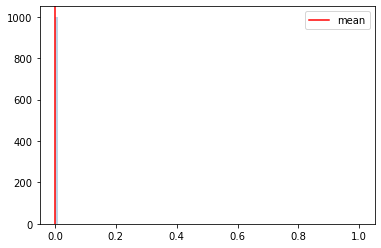

  0%|▏                                                                                | 2/1000 [00:00<00:51, 19.47it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654367504
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 1.0, 'jump_size_a': 0.1, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:39,  9.99it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<02:10,  7.61it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<02:10,  7.60it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<02:13,  7.42it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<02:07,  7.77it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<02:09,  7.64it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:02<02:08,  7.63it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<02:09,  7.56it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<02:11,  7.45it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<02:12,  7.39it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:03<02:09,  7.54it/s]

Monte Carlo 23
Monte Carlo 24


  2%|██                                                                              | 25/1000 [00:03<02:12,  7.34it/s]

Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<02:49,  5.73it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:04<02:40,  6.06it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:04<02:23,  6.75it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:04<02:21,  6.84it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<02:09,  7.44it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:05<02:09,  7.43it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:05<02:16,  7.07it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:05<02:09,  7.39it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<02:20,  6.83it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:06<02:13,  7.16it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:06<02:04,  7.65it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:06<02:03,  7.71it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:07<02:07,  7.43it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:07<02:18,  6.85it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:07<02:21,  6.70it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<02:25,  6.48it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:08<02:24,  6.49it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:08<02:28,  6.32it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:08<02:20,  6.66it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:09<02:18,  6.76it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:09<02:19,  6.67it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:09<02:17,  6.79it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:10<02:10,  7.10it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:10<02:13,  6.93it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:10<02:15,  6.81it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:10<02:29,  6.16it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:11<02:29,  6.14it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:11<02:19,  6.60it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:11<02:20,  6.52it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:12<02:23,  6.38it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:12<02:13,  6.85it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:12<02:12,  6.89it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:13<02:17,  6.60it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:13<02:12,  6.87it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:13<02:11,  6.86it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:13<02:06,  7.16it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:14<02:23,  6.30it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:14<02:17,  6.56it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:14<02:29,  6.01it/s]

Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:15<02:24,  6.22it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:15<02:20,  6.35it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:15<02:18,  6.45it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:16<02:13,  6.68it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:16<02:14,  6.58it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:16<02:20,  6.32it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:16<02:20,  6.28it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:17<02:16,  6.46it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:17<02:20,  6.25it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:17<02:16,  6.45it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:18<02:25,  6.03it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:18<02:27,  5.93it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:18<02:27,  5.90it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:19<02:26,  5.95it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:19<02:28,  5.85it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:20<02:31,  5.72it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:20<02:30,  5.76it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:20<02:24,  5.98it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:21<02:25,  5.92it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:21<02:27,  5.83it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:21<02:26,  5.83it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:22<02:26,  5.82it/s]

Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:22<02:32,  5.60it/s]

Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:22<02:29,  5.71it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:22<02:32,  5.57it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:23<02:52,  4.91it/s]

Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:23<02:49,  5.00it/s]

Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:23<02:46,  5.10it/s]

Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:23<02:36,  5.42it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:24<02:42,  5.20it/s]

Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:24<02:44,  5.11it/s]

Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:24<02:38,  5.31it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 160/1000 [00:24<02:41,  5.20it/s]

Monte Carlo 160


 16%|████████████▋                                                                  | 161/1000 [00:24<02:48,  4.97it/s]

Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:25<02:53,  4.83it/s]

Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:25<02:51,  4.86it/s]

Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:25<02:45,  5.04it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:26<02:31,  5.49it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:26<02:33,  5.43it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:26<02:31,  5.48it/s]

Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:27<02:35,  5.33it/s]

Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:27<02:36,  5.27it/s]

Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:27<02:38,  5.20it/s]

Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:27<02:39,  5.16it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:28<02:38,  5.18it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:28<02:38,  5.18it/s]

Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:28<02:40,  5.11it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:28<02:34,  5.32it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:29<02:38,  5.17it/s]

Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:29<02:37,  5.20it/s]

Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:29<02:31,  5.39it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:29<02:30,  5.40it/s]

Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:29<02:27,  5.50it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:30<02:29,  5.43it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:30<02:29,  5.40it/s]

Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:30<02:30,  5.35it/s]

Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:31<02:31,  5.32it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:31<02:35,  5.18it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:31<02:37,  5.11it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:32<02:39,  5.02it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:32<02:34,  5.17it/s]

Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:32<02:34,  5.17it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:32<02:33,  5.20it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:33<02:39,  5.00it/s]

Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:33<02:39,  4.99it/s]

Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:33<02:40,  4.96it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 206/1000 [00:33<02:44,  4.83it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:34<02:36,  5.06it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:34<02:37,  5.03it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 211/1000 [00:34<02:40,  4.90it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:35<02:41,  4.86it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:35<02:38,  4.97it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:35<02:32,  5.14it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:35<02:35,  5.04it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:36<02:31,  5.18it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:36<02:31,  5.17it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 220/1000 [00:36<02:35,  5.02it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:36<02:32,  5.10it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▌                                                             | 223/1000 [00:37<02:35,  4.99it/s]

Monte Carlo 223


 22%|█████████████████▋                                                             | 224/1000 [00:37<02:38,  4.91it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:37<02:38,  4.87it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:37<02:40,  4.83it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:38<02:39,  4.84it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:38<02:38,  4.86it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:38<02:37,  4.89it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▎                                                            | 232/1000 [00:38<02:41,  4.76it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:39<02:37,  4.87it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:39<02:38,  4.84it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:39<02:33,  4.96it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▋                                                            | 237/1000 [00:39<02:36,  4.88it/s]

Monte Carlo 237


 24%|██████████████████▊                                                            | 238/1000 [00:40<02:37,  4.83it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:40<02:37,  4.83it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:40<02:31,  5.02it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:41<02:30,  5.05it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:41<02:28,  5.11it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:41<02:30,  5.02it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:41<02:28,  5.08it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:41<02:25,  5.16it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▌                                                           | 248/1000 [00:42<02:29,  5.03it/s]

Monte Carlo 248


 25%|███████████████████▋                                                           | 249/1000 [00:42<02:40,  4.69it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 250/1000 [00:42<02:47,  4.47it/s]

Monte Carlo 250


 25%|███████████████████▊                                                           | 251/1000 [00:42<02:42,  4.60it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 252/1000 [00:43<02:43,  4.59it/s]

Monte Carlo 252


 25%|███████████████████▉                                                           | 253/1000 [00:43<02:41,  4.63it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:43<02:37,  4.74it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:43<02:33,  4.85it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▎                                                          | 257/1000 [00:44<02:33,  4.84it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 258/1000 [00:44<02:39,  4.66it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:44<02:35,  4.76it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:45<02:33,  4.81it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 263/1000 [00:45<02:34,  4.77it/s]

Monte Carlo 263


 26%|████████████████████▊                                                          | 264/1000 [00:45<02:35,  4.74it/s]

Monte Carlo 264


 26%|████████████████████▉                                                          | 265/1000 [00:45<02:40,  4.58it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 266/1000 [00:46<02:39,  4.60it/s]

Monte Carlo 266


 27%|█████████████████████                                                          | 267/1000 [00:46<02:45,  4.43it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:46<02:44,  4.43it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:46<02:43,  4.47it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 271/1000 [00:47<02:46,  4.37it/s]

Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:47<02:52,  4.22it/s]

Monte Carlo 272


 27%|█████████████████████▌                                                         | 273/1000 [00:47<02:50,  4.27it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:48<02:39,  4.54it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:48<02:42,  4.44it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 277/1000 [00:48<02:38,  4.57it/s]

Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:48<02:46,  4.33it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:49<02:50,  4.22it/s]

Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:49<02:46,  4.34it/s]

Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:49<02:46,  4.33it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:49<02:46,  4.32it/s]

Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:49<02:47,  4.28it/s]

Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:50<02:45,  4.33it/s]

Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:50<02:45,  4.33it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:50<02:44,  4.35it/s]

Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:50<02:43,  4.36it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:51<02:39,  4.48it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:51<02:43,  4.35it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:51<03:12,  3.68it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:51<02:59,  3.94it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:52<02:52,  4.10it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:52<02:53,  4.07it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:52<02:50,  4.13it/s]

Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:52<02:51,  4.12it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:53<02:47,  4.21it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:53<02:47,  4.20it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:53<02:46,  4.23it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:53<02:43,  4.29it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:54<02:49,  4.13it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:54<02:46,  4.21it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:54<02:42,  4.30it/s]

Monte Carlo 302
Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:54<02:40,  4.33it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:55<02:44,  4.21it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:55<02:42,  4.28it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:55<02:42,  4.26it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:55<02:48,  4.11it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:56<02:36,  4.40it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:56<02:36,  4.39it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:56<02:48,  4.08it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:57<02:54,  3.94it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:57<02:52,  3.99it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:57<02:49,  4.03it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:57<02:51,  3.99it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:58<02:49,  4.04it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:58<02:44,  4.16it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:58<02:47,  4.07it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:58<02:41,  4.21it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:59<02:45,  4.11it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:59<02:40,  4.23it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:59<02:40,  4.23it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:59<02:38,  4.26it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [01:00<02:38,  4.27it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [01:00<02:45,  4.07it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [01:00<02:49,  3.98it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [01:00<02:46,  4.05it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [01:01<03:02,  3.67it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [01:01<03:27,  3.23it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [01:01<03:46,  2.95it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [01:02<04:03,  2.75it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [01:02<04:11,  2.65it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [01:03<04:06,  2.70it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [01:03<04:00,  2.76it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [01:03<03:59,  2.78it/s]

Monte Carlo 336


 34%|██████████████████████████▋                                                    | 338/1000 [01:04<03:12,  3.44it/s]

Monte Carlo 337
Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [01:04<02:59,  3.68it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [01:04<02:49,  3.89it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [01:04<02:44,  4.00it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [01:05<02:42,  4.04it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [01:05<02:33,  4.29it/s]

Monte Carlo 343
Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:05<02:32,  4.30it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:06<02:29,  4.38it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:06<02:32,  4.28it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:06<02:31,  4.31it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:06<02:29,  4.36it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:07<02:30,  4.33it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:07<02:32,  4.25it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:07<02:30,  4.31it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:07<02:33,  4.22it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:07<02:31,  4.26it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:08<02:29,  4.30it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:08<02:31,  4.24it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:08<02:34,  4.17it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:08<02:33,  4.19it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:09<02:30,  4.26it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:09<02:28,  4.31it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:09<02:31,  4.21it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:09<02:29,  4.26it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:10<02:31,  4.22it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:10<02:30,  4.22it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:10<02:27,  4.31it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:10<02:28,  4.28it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:11<02:36,  4.05it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:11<02:37,  4.00it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:11<02:38,  3.98it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:11<02:33,  4.10it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:12<02:32,  4.12it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:12<02:37,  4.00it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:12<02:33,  4.08it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:12<02:29,  4.17it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:13<02:33,  4.07it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:13<02:32,  4.10it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:13<02:26,  4.24it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:13<02:29,  4.17it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:13<02:28,  4.19it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:14<02:26,  4.22it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:14<02:25,  4.24it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:14<02:23,  4.31it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:14<02:25,  4.25it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:15<02:27,  4.17it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:15<02:28,  4.14it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:15<02:26,  4.18it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:15<02:29,  4.11it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:16<02:27,  4.15it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:16<02:25,  4.20it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:16<02:23,  4.25it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:16<02:28,  4.10it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:17<02:28,  4.09it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:17<02:29,  4.07it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:17<02:32,  3.97it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:17<02:32,  3.96it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:18<02:33,  3.94it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:18<02:29,  4.03it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:18<02:28,  4.05it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:18<02:31,  3.96it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:19<02:34,  3.87it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:19<02:37,  3.79it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:19<02:36,  3.82it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:19<02:32,  3.91it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:20<02:55,  3.40it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:20<02:51,  3.47it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:20<02:47,  3.54it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:21<03:09,  3.13it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:21<03:01,  3.27it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:21<02:55,  3.36it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:22<02:57,  3.33it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:22<02:46,  3.54it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:22<02:40,  3.65it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:22<02:44,  3.57it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:23<02:44,  3.56it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:23<02:48,  3.47it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:23<02:48,  3.48it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:24<02:42,  3.60it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:24<02:42,  3.58it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:24<02:43,  3.55it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:24<02:41,  3.60it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:25<02:34,  3.75it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:25<02:36,  3.69it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:25<02:37,  3.66it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:25<02:38,  3.62it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:26<02:37,  3.66it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:26<02:32,  3.76it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:26<02:36,  3.67it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:27<02:30,  3.81it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:27<02:31,  3.77it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:27<02:25,  3.91it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:27<02:23,  3.98it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:27<02:21,  4.01it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:28<02:29,  3.78it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:28<02:36,  3.61it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:28<02:34,  3.67it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:29<02:38,  3.57it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:29<02:48,  3.34it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:29<02:48,  3.33it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:30<02:46,  3.36it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:30<02:39,  3.51it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:30<02:34,  3.62it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:30<02:40,  3.48it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:31<02:34,  3.60it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:31<02:33,  3.63it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:31<02:27,  3.75it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:31<02:30,  3.67it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:32<02:29,  3.71it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:32<02:29,  3.68it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:32<02:29,  3.70it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:33<02:24,  3.79it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:33<02:25,  3.77it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:33<02:26,  3.75it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:33<02:26,  3.73it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:34<02:28,  3.68it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:34<02:25,  3.74it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:34<02:24,  3.76it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:34<02:25,  3.74it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:35<02:25,  3.74it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:35<02:23,  3.78it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:35<02:24,  3.73it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:35<02:24,  3.74it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:36<02:23,  3.76it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:36<02:28,  3.62it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:36<02:24,  3.70it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:37<02:27,  3.63it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:37<02:30,  3.55it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:37<02:27,  3.62it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:37<02:27,  3.61it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:38<02:26,  3.62it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:38<02:27,  3.59it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:38<02:30,  3.51it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:39<02:29,  3.54it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:39<02:29,  3.53it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:39<02:28,  3.55it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:39<02:26,  3.58it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:40<02:24,  3.62it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:40<02:32,  3.42it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:40<02:29,  3.50it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:41<02:29,  3.48it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:41<02:31,  3.44it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:41<02:27,  3.53it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:41<02:26,  3.54it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:42<02:23,  3.61it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:42<02:28,  3.49it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:42<02:29,  3.46it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:43<02:27,  3.47it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:43<02:30,  3.41it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:43<02:39,  3.21it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:44<02:40,  3.18it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:44<02:39,  3.20it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:44<02:33,  3.31it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:44<02:33,  3.32it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:45<02:31,  3.34it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:45<02:30,  3.35it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:45<02:26,  3.45it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:46<02:25,  3.47it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:46<02:22,  3.54it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:46<02:20,  3.58it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:46<02:23,  3.48it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:47<02:21,  3.52it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:47<02:24,  3.44it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:47<02:21,  3.53it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:48<02:43,  3.05it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:48<02:35,  3.19it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:48<02:28,  3.33it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:49<02:29,  3.31it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:49<02:25,  3.38it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:49<02:25,  3.37it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:49<02:26,  3.35it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:50<02:27,  3.32it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:50<02:23,  3.40it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:50<02:25,  3.35it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:51<02:24,  3.38it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:51<02:21,  3.44it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:51<02:21,  3.42it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:51<02:19,  3.46it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:52<02:18,  3.50it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:52<02:16,  3.53it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:52<02:13,  3.60it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:53<02:16,  3.53it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:53<02:19,  3.44it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:53<02:15,  3.53it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:53<02:12,  3.60it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:54<02:13,  3.56it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:54<02:12,  3.59it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:54<02:09,  3.65it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:55<02:12,  3.56it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:55<02:12,  3.55it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:55<02:09,  3.64it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:55<02:10,  3.61it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:56<02:09,  3.61it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:56<02:12,  3.54it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:56<02:16,  3.41it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:57<02:16,  3.41it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:57<02:13,  3.48it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:57<02:11,  3.53it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:57<02:17,  3.37it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:58<02:16,  3.39it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:58<02:15,  3.40it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:58<02:17,  3.34it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:59<02:19,  3.30it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:59<02:18,  3.31it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:59<02:17,  3.34it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [02:00<02:18,  3.29it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [02:00<02:21,  3.22it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [02:00<02:18,  3.27it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [02:00<02:21,  3.21it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [02:01<02:18,  3.26it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [02:01<02:17,  3.28it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [02:01<02:21,  3.18it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [02:02<02:21,  3.17it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [02:02<02:18,  3.23it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [02:02<02:17,  3.24it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [02:03<02:18,  3.22it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [02:03<02:23,  3.10it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [02:03<02:23,  3.09it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [02:04<02:22,  3.11it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [02:04<02:19,  3.16it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [02:04<02:21,  3.12it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [02:05<02:25,  3.03it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [02:05<02:24,  3.03it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [02:05<02:26,  2.99it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [02:06<02:26,  2.99it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [02:06<02:22,  3.06it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [02:06<02:18,  3.14it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [02:07<02:18,  3.14it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:07<02:16,  3.18it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:07<02:18,  3.13it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:08<02:23,  3.01it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:08<02:23,  3.00it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:08<02:20,  3.05it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:09<02:29,  2.86it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:09<02:25,  2.94it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:09<02:21,  3.01it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:10<02:19,  3.04it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:10<02:15,  3.12it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:10<02:15,  3.11it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:11<02:15,  3.11it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:11<02:13,  3.14it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:11<02:14,  3.12it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:12<02:16,  3.07it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:12<02:15,  3.08it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:12<02:12,  3.14it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:12<02:16,  3.06it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:13<02:16,  3.04it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:13<02:14,  3.07it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:13<02:12,  3.12it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:14<02:15,  3.03it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:14<02:14,  3.06it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:14<02:15,  3.02it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:15<02:14,  3.05it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:15<02:17,  2.97it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:15<02:16,  2.99it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:16<02:13,  3.04it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:16<02:13,  3.02it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:16<02:17,  2.94it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:17<02:14,  3.00it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:17<02:12,  3.03it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:17<02:15,  2.96it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:18<02:21,  2.82it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:18<02:21,  2.83it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:19<02:19,  2.86it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:19<02:17,  2.90it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:19<02:15,  2.93it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:20<02:13,  2.97it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:20<02:12,  2.97it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:20<02:12,  2.97it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:21<02:12,  2.96it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:21<02:13,  2.93it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:21<02:11,  2.97it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:22<02:09,  2.99it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:22<02:07,  3.04it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:22<02:11,  2.95it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:23<02:10,  2.97it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:23<02:24,  2.66it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:23<02:16,  2.82it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:24<02:13,  2.88it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:24<02:10,  2.94it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:24<02:09,  2.95it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:25<02:09,  2.94it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:25<02:06,  2.99it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:25<02:06,  3.00it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:26<02:04,  3.02it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:26<02:05,  3.00it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:26<02:06,  2.96it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:27<02:05,  2.99it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:27<02:06,  2.95it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:27<02:08,  2.90it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:28<02:08,  2.88it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:28<02:06,  2.92it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:28<02:09,  2.84it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:29<02:06,  2.90it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:29<02:06,  2.91it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:29<02:07,  2.87it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:30<02:05,  2.90it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:30<02:07,  2.85it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:31<02:05,  2.89it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:31<02:03,  2.92it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:31<02:03,  2.93it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:32<02:04,  2.90it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:32<02:02,  2.94it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:32<01:59,  2.99it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:33<01:59,  2.99it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:33<01:59,  2.97it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:33<02:00,  2.95it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:34<02:01,  2.92it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:34<02:00,  2.92it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:34<01:58,  2.97it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:35<01:59,  2.95it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:35<02:02,  2.85it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:35<01:59,  2.93it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:36<02:02,  2.85it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:36<02:01,  2.86it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:36<02:01,  2.85it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:37<01:59,  2.89it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:37<02:00,  2.86it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:37<02:03,  2.77it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:38<02:00,  2.84it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:38<02:01,  2.80it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:38<01:59,  2.84it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:39<01:58,  2.85it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:39<01:57,  2.88it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:39<01:57,  2.87it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:40<01:55,  2.91it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:40<01:54,  2.92it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:41<01:58,  2.81it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:41<01:58,  2.82it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:41<01:55,  2.88it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:42<01:53,  2.90it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:42<01:54,  2.88it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:42<01:56,  2.82it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:43<01:53,  2.88it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:43<01:54,  2.85it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:43<01:57,  2.77it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:44<01:55,  2.82it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:44<01:54,  2.83it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:44<01:53,  2.84it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:45<01:52,  2.86it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:45<01:52,  2.86it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:45<01:52,  2.85it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:46<01:51,  2.86it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:46<01:54,  2.79it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:47<01:52,  2.82it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:47<01:52,  2.82it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:47<01:52,  2.81it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:48<01:52,  2.79it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:48<01:52,  2.78it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:48<01:53,  2.75it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:49<01:50,  2.82it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:49<01:52,  2.74it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:49<01:49,  2.82it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:50<01:47,  2.85it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:50<01:46,  2.88it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:50<01:47,  2.84it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:51<01:49,  2.79it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:51<01:48,  2.80it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:52<01:49,  2.77it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:52<01:47,  2.82it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:52<01:46,  2.84it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:53<01:46,  2.83it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:53<01:56,  2.57it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:53<01:53,  2.63it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:54<01:51,  2.67it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:54<01:50,  2.69it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:54<01:47,  2.74it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:55<01:46,  2.76it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:55<01:44,  2.80it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:56<01:43,  2.83it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:56<01:42,  2.83it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:56<01:44,  2.79it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:57<01:45,  2.74it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:57<01:43,  2.79it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:57<01:45,  2.72it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:58<01:43,  2.77it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:58<01:42,  2.78it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:58<01:42,  2.77it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:59<01:41,  2.77it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:59<01:42,  2.76it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [03:00<01:44,  2.69it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [03:00<01:43,  2.70it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [03:00<01:41,  2.74it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [03:01<01:41,  2.74it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [03:01<01:39,  2.78it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [03:01<01:37,  2.83it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [03:02<01:35,  2.89it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [03:02<01:34,  2.91it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [03:02<01:34,  2.88it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [03:03<01:34,  2.89it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [03:03<01:33,  2.91it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [03:03<01:32,  2.90it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [03:04<01:30,  2.96it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [03:04<01:29,  2.99it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [03:04<01:30,  2.95it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [03:05<01:29,  2.97it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [03:05<01:28,  3.01it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [03:05<01:28,  2.99it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [03:06<01:29,  2.95it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [03:06<01:27,  2.99it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:06<01:28,  2.96it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:07<01:27,  2.96it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:07<01:28,  2.93it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:07<01:32,  2.79it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:08<01:31,  2.81it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:08<01:29,  2.85it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:09<01:29,  2.85it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:09<01:30,  2.82it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:09<01:27,  2.89it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:10<01:29,  2.82it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:10<01:32,  2.72it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:10<01:32,  2.70it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:11<01:32,  2.68it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:11<01:32,  2.69it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:11<01:33,  2.65it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:12<01:34,  2.60it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:12<01:31,  2.67it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:13<01:30,  2.69it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:13<01:31,  2.64it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:13<01:32,  2.62it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:14<01:30,  2.65it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:14<01:31,  2.63it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:15<01:31,  2.62it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:15<01:32,  2.59it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:15<01:30,  2.62it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:16<01:29,  2.63it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:16<01:28,  2.67it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:16<01:27,  2.67it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:17<01:27,  2.67it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:17<01:28,  2.63it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:18<01:27,  2.65it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:18<01:27,  2.62it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:18<01:27,  2.63it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:19<01:27,  2.60it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:19<01:27,  2.58it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:20<01:30,  2.50it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:20<01:31,  2.47it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:20<01:30,  2.49it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:21<01:30,  2.46it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:21<01:31,  2.44it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:22<01:29,  2.47it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:22<01:28,  2.50it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:22<01:27,  2.49it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:23<01:26,  2.52it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:23<01:26,  2.51it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:24<01:26,  2.51it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:24<01:26,  2.47it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:24<01:24,  2.53it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:25<01:22,  2.57it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:25<01:23,  2.54it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:26<01:21,  2.57it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:26<01:23,  2.51it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:26<01:22,  2.54it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:27<01:21,  2.57it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:27<01:21,  2.53it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:28<01:21,  2.52it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:28<01:24,  2.43it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:28<01:23,  2.45it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:29<01:22,  2.47it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:29<01:21,  2.47it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:30<01:22,  2.42it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:30<01:22,  2.41it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:30<01:23,  2.38it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:31<01:21,  2.42it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:31<01:26,  2.28it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:32<01:24,  2.33it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:32<01:21,  2.39it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:33<01:19,  2.45it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:33<01:16,  2.51it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:33<01:18,  2.43it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:34<01:17,  2.46it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:34<01:17,  2.45it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:35<01:15,  2.49it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:35<01:15,  2.48it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:35<01:14,  2.50it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:36<01:14,  2.51it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:36<01:14,  2.48it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:37<01:13,  2.50it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:37<01:13,  2.48it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:37<01:14,  2.43it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:38<01:13,  2.45it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:38<01:13,  2.45it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:39<01:12,  2.46it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:39<01:12,  2.46it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:39<01:12,  2.45it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:40<01:12,  2.44it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:40<01:12,  2.42it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:41<01:10,  2.45it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:41<01:10,  2.45it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:41<01:10,  2.45it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:42<01:10,  2.44it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:42<01:09,  2.43it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:43<01:08,  2.46it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:43<01:09,  2.41it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:44<01:12,  2.31it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:44<01:13,  2.25it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:44<01:11,  2.30it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:45<01:11,  2.29it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:45<01:10,  2.31it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:46<01:09,  2.33it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:46<01:07,  2.38it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:47<01:06,  2.41it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:47<01:06,  2.41it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:47<01:05,  2.42it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:48<01:05,  2.40it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:48<01:05,  2.39it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:49<01:05,  2.38it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:49<01:05,  2.36it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:49<01:05,  2.35it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:50<01:03,  2.39it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:50<01:03,  2.38it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:51<01:02,  2.40it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:51<01:01,  2.43it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:52<01:02,  2.38it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:52<01:03,  2.31it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:52<01:01,  2.36it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:53<01:00,  2.40it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:53<01:00,  2.39it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:54<00:59,  2.41it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:54<00:58,  2.43it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:54<00:58,  2.40it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:55<00:58,  2.40it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:55<00:57,  2.40it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:56<00:58,  2.37it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:56<01:00,  2.25it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:57<00:59,  2.29it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:57<00:58,  2.29it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:58<00:57,  2.33it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:58<00:56,  2.37it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:58<00:56,  2.34it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:59<00:56,  2.32it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:59<00:55,  2.33it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [04:00<00:55,  2.32it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [04:00<00:55,  2.32it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [04:01<00:54,  2.33it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [04:01<00:54,  2.30it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [04:01<00:54,  2.31it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [04:02<00:53,  2.30it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [04:02<00:53,  2.30it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [04:03<00:51,  2.35it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [04:03<00:51,  2.33it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [04:04<00:51,  2.31it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [04:04<00:52,  2.27it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [04:04<00:51,  2.28it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [04:05<00:50,  2.33it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [04:05<00:49,  2.36it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [04:06<00:49,  2.34it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [04:06<00:49,  2.32it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [04:07<00:48,  2.31it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [04:07<00:47,  2.35it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [04:07<00:47,  2.35it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [04:08<00:47,  2.34it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:08<00:46,  2.36it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:09<00:46,  2.33it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:09<00:45,  2.34it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:10<00:45,  2.33it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:10<00:44,  2.35it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:10<00:44,  2.33it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:11<00:44,  2.32it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:11<00:44,  2.30it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:12<00:44,  2.29it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:12<00:43,  2.30it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:13<00:42,  2.31it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:13<00:42,  2.31it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:13<00:42,  2.28it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:14<00:42,  2.28it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:14<00:43,  2.20it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:15<00:41,  2.25it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:15<00:41,  2.24it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:16<00:41,  2.23it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:16<00:39,  2.28it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:17<00:39,  2.26it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:17<00:39,  2.27it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:17<00:39,  2.25it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:18<00:41,  2.10it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:18<00:39,  2.17it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:19<00:38,  2.21it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:19<00:38,  2.19it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:20<00:37,  2.23it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:20<00:36,  2.23it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:21<00:36,  2.21it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:21<00:35,  2.23it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:22<00:35,  2.20it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:22<00:34,  2.26it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:22<00:33,  2.28it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:23<00:33,  2.28it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:23<00:33,  2.25it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:24<00:33,  2.20it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:24<00:32,  2.24it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:25<00:31,  2.28it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:25<00:30,  2.35it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:25<00:29,  2.37it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:26<00:28,  2.42it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:26<00:28,  2.40it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:27<00:28,  2.38it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:27<00:27,  2.39it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:28<00:26,  2.44it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:28<00:26,  2.43it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:28<00:26,  2.39it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:29<00:26,  2.38it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:29<00:25,  2.42it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:30<00:24,  2.40it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:30<00:24,  2.39it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:31<00:25,  2.31it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:31<00:24,  2.32it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:31<00:24,  2.28it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:32<00:24,  2.23it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:32<00:23,  2.25it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:33<00:23,  2.25it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:33<00:23,  2.22it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:34<00:22,  2.23it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:34<00:22,  2.27it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:35<00:21,  2.29it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:35<00:21,  2.24it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:35<00:21,  2.23it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:36<00:20,  2.24it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:36<00:20,  2.23it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:37<00:19,  2.25it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:37<00:18,  2.26it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:38<00:18,  2.24it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:38<00:18,  2.18it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:39<00:18,  2.21it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:39<00:17,  2.20it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:39<00:17,  2.20it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:40<00:16,  2.22it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:40<00:16,  2.21it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:41<00:15,  2.19it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:41<00:15,  2.19it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:42<00:15,  2.19it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:42<00:14,  2.17it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:43<00:14,  2.19it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:43<00:13,  2.21it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:44<00:13,  2.19it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:44<00:12,  2.21it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:45<00:12,  2.18it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:45<00:11,  2.20it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:46<00:12,  2.08it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:46<00:11,  2.11it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:46<00:10,  2.16it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:47<00:10,  2.18it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:47<00:09,  2.16it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:48<00:09,  2.14it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:48<00:08,  2.14it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:49<00:08,  2.16it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:49<00:07,  2.14it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:50<00:07,  2.17it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:50<00:06,  2.17it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:51<00:06,  2.15it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:51<00:06,  2.15it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:51<00:05,  2.17it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:52<00:05,  2.17it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:52<00:04,  2.16it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:53<00:04,  2.16it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:53<00:03,  2.12it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:54<00:03,  2.13it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:54<00:02,  2.17it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:55<00:02,  2.18it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:55<00:01,  2.16it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:56<00:01,  2.12it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:56<00:00,  2.16it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:57<00:00,  2.13it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:57<00:00,  3.36it/s]


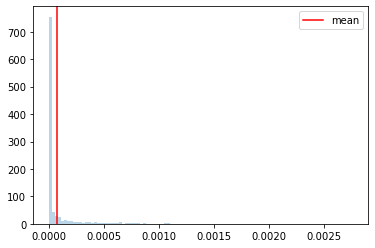

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654367802
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 1.0, 'jump_size_a': 0.1, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<00:58, 17.09it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▌                                                                                | 7/1000 [00:00<01:40,  9.89it/s]

Monte Carlo 5
Monte Carlo 6
Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:00<01:42,  9.61it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:50,  8.91it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:50,  8.92it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:49,  9.02it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▎                                                                              | 17/1000 [00:01<01:55,  8.51it/s]

Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<02:15,  7.23it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<02:06,  7.73it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:58,  8.26it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<01:55,  8.41it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<01:54,  8.52it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:10,  7.44it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:06,  7.67it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<01:58,  8.13it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<01:59,  8.05it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:00,  7.96it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<01:56,  8.24it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<01:55,  8.32it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<01:58,  8.06it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:00,  7.91it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:59,  8.00it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<02:00,  7.87it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<01:54,  8.30it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<01:57,  8.06it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:53,  8.33it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<01:54,  8.24it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<01:53,  8.30it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:51,  8.42it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<01:53,  8.24it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<01:57,  7.97it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<01:58,  7.90it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<01:52,  8.25it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:04,  7.49it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<01:55,  8.04it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<01:54,  8.05it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<01:53,  8.15it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:03,  7.47it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:09<01:59,  7.69it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<01:53,  8.05it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<01:59,  7.63it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<01:53,  8.05it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:10<01:53,  8.00it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<01:56,  7.83it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<01:55,  7.87it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<01:55,  7.84it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:11<01:55,  7.84it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<01:52,  7.98it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<01:52,  8.01it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:12<01:58,  7.60it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:15,  6.62it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:03,  7.23it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:07,  7.00it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:13<02:08,  6.94it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<01:58,  7.46it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<01:58,  7.50it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:14<02:00,  7.35it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:14<02:02,  7.21it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:01,  7.25it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<02:00,  7.30it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:15<02:04,  7.05it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:06,  6.92it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:03,  7.07it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:16<02:00,  7.23it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:16<02:04,  6.98it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<01:58,  7.29it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:17<02:04,  6.91it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:17<02:05,  6.83it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:03,  6.95it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:18<02:09,  6.63it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 144/1000 [00:18<02:14,  6.37it/s]

Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:18<02:30,  5.66it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:19<02:13,  6.38it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:19<02:13,  6.38it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:19<02:07,  6.67it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:20<02:04,  6.81it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:20<02:02,  6.91it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:20<02:03,  6.80it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:20<02:00,  6.97it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:21<02:06,  6.60it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:21<02:07,  6.56it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:21<02:09,  6.45it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:22<02:12,  6.26it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:22<02:20,  5.92it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:22<02:17,  6.02it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:23<02:14,  6.16it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:23<02:11,  6.29it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:23<02:12,  6.19it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:24<02:11,  6.23it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:24<02:16,  5.99it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:24<02:19,  5.86it/s]

Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:25<02:16,  5.98it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:25<02:16,  5.98it/s]

Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:25<02:23,  5.65it/s]

Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:25<02:21,  5.72it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:26<02:17,  5.86it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:26<02:15,  5.94it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:26<02:19,  5.75it/s]

Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:26<02:23,  5.61it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:27<02:22,  5.62it/s]

Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:27<02:26,  5.47it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:27<02:21,  5.66it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:27<02:25,  5.48it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:28<02:22,  5.59it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:28<02:23,  5.56it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:28<02:24,  5.48it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:29<02:24,  5.50it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:29<02:26,  5.39it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:29<02:26,  5.39it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:30<02:21,  5.56it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:30<02:19,  5.63it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:30<02:23,  5.45it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:27,  5.31it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:31<02:22,  5.49it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:31<02:17,  5.65it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 222/1000 [00:31<02:23,  5.41it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:32<02:27,  5.26it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:32<02:24,  5.37it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:32<02:20,  5.50it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:32<02:21,  5.45it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:33<02:20,  5.50it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:33<02:17,  5.61it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:33<02:21,  5.44it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:33<02:22,  5.39it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:34<02:24,  5.31it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:34<02:20,  5.46it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:34<02:18,  5.49it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:34<02:19,  5.46it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:35<02:17,  5.54it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:35<02:15,  5.61it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:35<02:22,  5.30it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:35<02:21,  5.32it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:36<02:22,  5.28it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 247/1000 [00:36<02:25,  5.16it/s]

Monte Carlo 247


 25%|███████████████████▌                                                           | 248/1000 [00:36<02:30,  4.99it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:36<02:31,  4.94it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:37<02:28,  5.04it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:37<02:28,  5.05it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:37<02:29,  4.99it/s]

Monte Carlo 252
Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:37<02:31,  4.92it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:38<02:30,  4.93it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:38<02:30,  4.95it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:38<02:30,  4.94it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▍                                                          | 259/1000 [00:38<02:31,  4.88it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:39<02:30,  4.92it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:39<02:25,  5.08it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:39<02:22,  5.18it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:39<02:21,  5.20it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:39<02:24,  5.07it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:40<02:26,  5.02it/s]

Monte Carlo 265
Monte Carlo 266


 27%|█████████████████████                                                          | 267/1000 [00:40<02:51,  4.27it/s]

Monte Carlo 267


 27%|█████████████████████▏                                                         | 268/1000 [00:40<03:08,  3.88it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 269/1000 [00:41<03:06,  3.93it/s]

Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:41<02:57,  4.11it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 271/1000 [00:41<02:53,  4.20it/s]

Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:41<02:56,  4.13it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:41,  4.48it/s]

Monte Carlo 273
Monte Carlo 274


 28%|█████████████████████▋                                                         | 275/1000 [00:42<02:42,  4.46it/s]

Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:42<02:44,  4.41it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 277/1000 [00:42<02:59,  4.04it/s]

Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:55,  4.12it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:43<02:47,  4.30it/s]

Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:43<02:49,  4.24it/s]

Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:43<02:51,  4.19it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:52,  4.17it/s]

Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:50,  4.20it/s]

Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:44<02:50,  4.20it/s]

Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:50,  4.20it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:45<02:55,  4.08it/s]

Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:48,  4.22it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:49,  4.19it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:45,  4.31it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:45<02:43,  4.35it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:46<02:39,  4.43it/s]

Monte Carlo 291
Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:47,  4.23it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:46<02:47,  4.22it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:39,  4.42it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:47<02:36,  4.49it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:47<02:39,  4.39it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:48<02:36,  4.47it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:33,  4.56it/s]

Monte Carlo 300
Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:48<02:32,  4.59it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:48<02:33,  4.53it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:49<02:39,  4.37it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:49<02:33,  4.52it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:49<02:44,  4.23it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:49<02:44,  4.21it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:41,  4.29it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:42,  4.26it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:50<02:45,  4.18it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:50<02:42,  4.24it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:44,  4.19it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:51<03:05,  3.71it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:51<03:04,  3.72it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:56,  3.89it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:46,  4.10it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:46,  4.11it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:52,  3.95it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:48,  4.03it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<02:42,  4.18it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:38,  4.28it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:53<02:34,  4.40it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:33,  4.42it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:28,  4.54it/s]

Monte Carlo 324
Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:27,  4.56it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:25,  4.63it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:55<02:25,  4.62it/s]

Monte Carlo 328
Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:24,  4.64it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:55<02:27,  4.53it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:55<02:30,  4.45it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:31,  4.41it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:56<02:28,  4.48it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:37,  4.21it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:35,  4.26it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:32,  4.34it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:57<02:36,  4.23it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:29,  4.42it/s]

Monte Carlo 339
Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:43,  4.04it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:58<02:37,  4.18it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:58<02:32,  4.30it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:30,  4.36it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:30,  4.37it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:30,  4.36it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:59<02:29,  4.37it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:31,  4.32it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:29,  4.36it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:26,  4.43it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:00<02:28,  4.37it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:00<02:26,  4.43it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:00<02:25,  4.44it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:25,  4.45it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:01<02:28,  4.33it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:01<02:26,  4.40it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:25,  4.41it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:24,  4.44it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:22,  4.51it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:02<02:22,  4.49it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:02<02:22,  4.47it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:31,  4.21it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:30,  4.23it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:03<02:28,  4.28it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:03<02:29,  4.25it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:30,  4.22it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:32,  4.16it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:04<02:29,  4.22it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:04<02:30,  4.20it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:28,  4.24it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:27,  4.27it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:28,  4.23it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:05<02:31,  4.15it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:35,  4.03it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:33,  4.08it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:28,  4.20it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:06<02:28,  4.21it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:06<02:27,  4.21it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:25,  4.27it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:25,  4.25it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:07<02:27,  4.21it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:07<02:26,  4.22it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:26,  4.20it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:26,  4.22it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:08<02:24,  4.26it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:08<02:24,  4.24it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:24,  4.24it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:23,  4.25it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:09<02:26,  4.17it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:09<02:29,  4.09it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:09<02:26,  4.17it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:23,  4.24it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:27,  4.12it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:10<02:27,  4.10it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:10<02:27,  4.11it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:26,  4.11it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:28,  4.07it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:11<02:25,  4.14it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:11<02:23,  4.19it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:11<02:21,  4.25it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:20,  4.28it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:12<02:19,  4.29it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:18,  4.32it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:38,  3.75it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:41,  3.68it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:13<02:34,  3.84it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:13<02:32,  3.89it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:28,  3.99it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:13<02:28,  3.97it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:14<02:28,  3.99it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:14<02:25,  4.06it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<02:21,  4.15it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:25,  4.04it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:15<02:26,  4.00it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:15<02:28,  3.94it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:25,  4.01it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:15<02:24,  4.02it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:16<02:22,  4.09it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:16<02:23,  4.04it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:16<02:28,  3.92it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:16<02:26,  3.96it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:17<02:26,  3.95it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:17<02:26,  3.94it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:23,  4.00it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:17<02:23,  4.01it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:18<02:24,  3.98it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:18<02:25,  3.94it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:25,  3.94it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:24,  3.95it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:19<02:26,  3.89it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:19<02:26,  3.88it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:26,  3.88it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:20<02:28,  3.82it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:20<02:29,  3.78it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:20<02:29,  3.77it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:27,  3.83it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:21<02:26,  3.85it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:21<02:28,  3.79it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:21<02:25,  3.86it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:28,  3.76it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:22<02:29,  3.74it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:22<02:32,  3.66it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:22<02:26,  3.79it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:22<02:25,  3.83it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:23<02:25,  3.83it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:23<02:24,  3.84it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:23<02:26,  3.78it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:24<02:28,  3.71it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:24<02:24,  3.81it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:24<02:25,  3.78it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:29,  3.66it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:25<02:29,  3.66it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:25<02:27,  3.71it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:25<02:26,  3.73it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:26,  3.72it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:26<02:24,  3.77it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:26<02:25,  3.74it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:26<02:26,  3.70it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:25,  3.71it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:27<02:23,  3.76it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:27<02:25,  3.70it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:22,  3.77it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:28<02:22,  3.76it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:28<02:20,  3.81it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:28<02:21,  3.78it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:28<02:20,  3.80it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:29<02:22,  3.73it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:29<02:25,  3.66it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:29<02:23,  3.70it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:29<02:21,  3.75it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:30<02:21,  3.74it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:30<02:21,  3.74it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:30<02:23,  3.68it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:25,  3.62it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:31<02:22,  3.69it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:31<02:19,  3.75it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:31<02:17,  3.81it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:32<02:18,  3.78it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:32<02:18,  3.76it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:32<02:18,  3.75it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:32<02:19,  3.73it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:33<02:18,  3.73it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:33<02:23,  3.60it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:33<02:27,  3.49it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:33<02:25,  3.55it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:34<02:21,  3.63it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:34<02:19,  3.67it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:34<02:21,  3.62it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:35<02:27,  3.47it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:35<02:22,  3.57it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:35<02:23,  3.56it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:35<02:19,  3.63it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:36<02:24,  3.50it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:36<02:23,  3.52it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:36<02:22,  3.53it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:37<02:21,  3.56it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:37<02:19,  3.61it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:37<02:21,  3.56it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:37<02:24,  3.47it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:38<02:26,  3.41it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:38<02:23,  3.48it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:38<02:23,  3.48it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:39<02:21,  3.51it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:39<02:21,  3.50it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:39<02:21,  3.50it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:39<02:20,  3.52it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:40<02:18,  3.56it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:40<02:16,  3.59it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:40<02:18,  3.55it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:41<02:16,  3.58it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:41<02:19,  3.50it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:41<02:17,  3.54it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:41<02:20,  3.48it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:42<02:36,  3.10it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:42<02:30,  3.23it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:42<02:26,  3.30it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:43<02:23,  3.35it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:43<02:19,  3.45it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:43<02:20,  3.43it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:44<02:18,  3.45it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:44<02:19,  3.44it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:44<02:17,  3.47it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:44<02:16,  3.49it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:45<02:15,  3.50it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:45<02:14,  3.53it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:45<02:16,  3.48it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:46<02:14,  3.52it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:46<02:13,  3.55it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:46<02:14,  3.49it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:46<02:16,  3.44it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:47<02:15,  3.47it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:47<02:14,  3.49it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:47<02:16,  3.42it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:48<02:16,  3.42it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:48<02:16,  3.42it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:48<02:14,  3.44it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:48<02:14,  3.44it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:49<02:12,  3.48it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:49<02:12,  3.47it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:49<02:15,  3.39it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:50<02:17,  3.35it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:50<02:14,  3.40it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:50<02:16,  3.35it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:51<02:17,  3.31it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:51<02:19,  3.26it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:51<02:16,  3.31it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:51<02:17,  3.30it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:52<02:17,  3.30it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:52<02:14,  3.36it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:52<02:14,  3.36it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:53<02:13,  3.36it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:53<02:14,  3.34it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:53<02:15,  3.31it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:54<02:14,  3.32it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:54<02:14,  3.31it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:54<02:15,  3.29it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:54<02:14,  3.29it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:55<02:16,  3.25it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:55<02:18,  3.18it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:55<02:20,  3.13it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:56<02:19,  3.15it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:56<02:19,  3.14it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:56<02:20,  3.12it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:57<02:17,  3.17it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:57<02:20,  3.10it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:57<02:18,  3.13it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:58<02:19,  3.10it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:58<02:17,  3.14it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:58<02:19,  3.09it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:59<02:18,  3.10it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:59<02:16,  3.15it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:59<02:17,  3.12it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:00<02:17,  3.10it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:00<02:14,  3.17it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:00<02:15,  3.14it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:01<02:17,  3.08it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:01<02:17,  3.07it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:01<02:16,  3.08it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:02<02:18,  3.03it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:02<02:16,  3.08it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:02<02:13,  3.14it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:03<02:16,  3.06it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:03<02:14,  3.10it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:03<02:14,  3.09it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:03<02:17,  3.02it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:04<02:17,  3.02it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:04<02:19,  2.95it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:04<02:15,  3.03it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:05<02:16,  3.02it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:05<02:13,  3.07it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:05<02:13,  3.07it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:06<02:10,  3.12it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:06<02:11,  3.09it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:06<02:14,  3.03it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:07<02:17,  2.96it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:07<02:16,  2.95it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:07<02:15,  2.98it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:08<02:17,  2.93it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:08<02:14,  2.99it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:08<02:12,  3.01it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:09<02:10,  3.06it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:09<02:11,  3.03it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:09<02:12,  3.01it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:10<02:12,  2.98it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:10<02:10,  3.02it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:10<02:10,  3.03it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:11<02:08,  3.06it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:11<02:11,  2.99it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:11<02:09,  3.02it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:12<02:07,  3.06it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:12<02:09,  3.00it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:12<02:10,  2.97it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:13<02:10,  2.96it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:13<02:09,  2.98it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:14<02:13,  2.88it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:14<02:10,  2.94it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:14<02:09,  2.95it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:15<02:11,  2.91it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:15<02:08,  2.95it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:15<02:07,  2.97it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:15<02:04,  3.04it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:16<01:59,  3.15it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:16<01:57,  3.21it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:17<02:11,  2.86it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:17<02:04,  3.01it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:17<02:04,  3.00it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:17<02:01,  3.08it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:18<01:58,  3.13it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:18<01:58,  3.14it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:18<01:57,  3.16it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:19<01:56,  3.16it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:19<01:55,  3.17it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:19<01:55,  3.17it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:20<01:55,  3.16it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:20<01:55,  3.16it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:20<01:56,  3.13it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:21<01:53,  3.19it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:21<01:54,  3.17it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:21<01:53,  3.19it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:22<01:52,  3.21it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:22<01:49,  3.26it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:22<01:52,  3.18it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:22<01:55,  3.09it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:23<01:54,  3.11it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:23<01:55,  3.08it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:23<01:55,  3.07it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:24<01:53,  3.11it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:24<01:52,  3.13it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:24<01:53,  3.09it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:25<01:51,  3.14it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:25<01:52,  3.10it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:25<01:52,  3.08it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:26<01:51,  3.10it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:26<01:50,  3.12it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:26<01:51,  3.09it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:27<01:54,  3.02it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:27<01:56,  2.94it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:27<01:51,  3.08it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:28<01:51,  3.06it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:28<01:52,  3.02it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:28<01:53,  2.98it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:29<01:52,  3.01it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:29<01:54,  2.93it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:29<01:51,  3.01it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:30<01:52,  2.97it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:30<01:50,  3.03it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:30<01:50,  3.01it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:31<01:49,  3.02it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:31<01:50,  3.00it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:31<01:48,  3.03it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:32<01:49,  3.01it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:32<01:50,  2.96it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:32<01:47,  3.03it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:33<01:45,  3.09it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:33<01:47,  3.03it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:33<01:52,  2.88it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:34<01:54,  2.82it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:34<01:52,  2.86it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:34<01:53,  2.83it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:35<01:52,  2.85it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:35<01:53,  2.81it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:36<01:53,  2.79it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:36<01:52,  2.82it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:36<01:52,  2.80it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:37<01:52,  2.80it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:37<01:53,  2.77it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:37<01:53,  2.77it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:38<01:52,  2.76it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:38<01:51,  2.79it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:38<01:50,  2.79it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:39<01:49,  2.83it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:39<01:49,  2.81it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:39<01:48,  2.83it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:40<01:48,  2.82it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:40<01:47,  2.84it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:41<01:47,  2.82it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:41<01:46,  2.84it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:41<01:46,  2.84it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:42<01:46,  2.82it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:42<01:45,  2.84it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:42<01:46,  2.80it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:43<01:47,  2.77it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:43<01:46,  2.78it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:43<01:47,  2.74it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:44<01:49,  2.68it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:44<01:57,  2.51it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:45<01:54,  2.57it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:45<01:52,  2.59it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:45<01:56,  2.51it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:46<01:56,  2.48it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:46<01:55,  2.50it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:47<01:55,  2.48it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:47<01:56,  2.46it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:47<01:55,  2.48it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:48<01:55,  2.47it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:48<01:50,  2.56it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:49<01:47,  2.63it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:49<01:56,  2.42it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:49<01:51,  2.52it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:50<01:51,  2.52it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:50<01:48,  2.56it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:51<01:47,  2.58it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:51<01:47,  2.59it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:51<01:45,  2.61it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:52<01:44,  2.63it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:52<01:43,  2.64it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:53<01:45,  2.59it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:53<01:45,  2.59it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:53<01:44,  2.60it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:54<01:44,  2.58it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:54<01:45,  2.54it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:54<01:45,  2.55it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:55<01:43,  2.58it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:55<01:40,  2.64it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:56<01:40,  2.64it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:56<01:37,  2.70it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:56<01:36,  2.73it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:57<01:37,  2.70it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:57<01:36,  2.70it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:57<01:38,  2.63it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:58<01:41,  2.56it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:58<01:40,  2.56it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:59<01:38,  2.60it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:59<01:39,  2.58it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:59<01:41,  2.51it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:00<01:41,  2.51it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:00<01:38,  2.56it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:01<01:37,  2.57it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:01<01:36,  2.61it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:01<01:33,  2.66it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:02<01:34,  2.64it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:02<01:35,  2.60it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:02<01:33,  2.64it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:03<01:33,  2.64it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:03<01:32,  2.64it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:04<01:32,  2.63it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:04<01:31,  2.65it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:04<01:32,  2.62it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:05<01:29,  2.68it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:05<01:29,  2.68it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:05<01:30,  2.65it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:06<01:29,  2.64it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:06<01:34,  2.51it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:07<01:31,  2.58it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:07<01:30,  2.61it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:07<01:28,  2.63it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:08<01:27,  2.68it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:08<01:30,  2.56it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:09<01:27,  2.64it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:09<01:27,  2.61it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:09<01:26,  2.65it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:10<01:26,  2.63it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:10<01:27,  2.60it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:10<01:26,  2.60it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:11<01:25,  2.63it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:11<01:25,  2.63it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:12<01:23,  2.67it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:12<01:24,  2.63it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:12<01:25,  2.60it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:13<01:24,  2.59it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:13<01:22,  2.66it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:14<01:23,  2.60it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:14<01:22,  2.62it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:14<01:21,  2.65it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:15<01:22,  2.59it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:15<01:23,  2.56it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:15<01:20,  2.63it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:16<01:19,  2.68it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:16<01:17,  2.73it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:16<01:15,  2.77it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:17<01:15,  2.77it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:17<01:13,  2.82it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:18<01:14,  2.78it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:18<01:12,  2.83it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:18<01:13,  2.80it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:19<01:14,  2.74it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:19<01:13,  2.76it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:19<01:13,  2.74it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:20<01:13,  2.73it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:20<01:13,  2.72it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:21<01:15,  2.65it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:21<01:13,  2.69it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:21<01:15,  2.63it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:22<01:15,  2.61it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:22<01:13,  2.67it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:22<01:11,  2.72it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:23<01:12,  2.66it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:23<01:11,  2.70it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:23<01:09,  2.74it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:24<01:10,  2.70it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:24<01:11,  2.64it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:25<01:09,  2.69it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:25<01:10,  2.64it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:25<01:10,  2.65it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:26<01:11,  2.59it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:26<01:10,  2.60it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:27<01:11,  2.58it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:27<01:10,  2.60it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:27<01:10,  2.57it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:28<01:11,  2.52it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:28<01:11,  2.51it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:29<01:10,  2.52it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:29<01:10,  2.50it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:29<01:10,  2.50it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:30<01:09,  2.51it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:30<01:08,  2.54it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:31<01:08,  2.53it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:31<01:08,  2.50it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:31<01:13,  2.33it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:32<01:10,  2.41it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:32<01:09,  2.44it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:33<01:09,  2.43it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:33<01:08,  2.43it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:33<01:07,  2.45it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:34<01:06,  2.49it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:34<01:06,  2.47it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:35<01:06,  2.46it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:35<01:06,  2.43it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:36<01:06,  2.42it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:36<01:04,  2.47it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:36<01:05,  2.42it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:37<01:06,  2.37it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:37<01:04,  2.42it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:38<01:03,  2.47it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:38<01:02,  2.46it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:38<01:02,  2.45it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:39<01:02,  2.45it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:39<01:01,  2.46it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:40<01:02,  2.42it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:40<01:01,  2.42it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:40<01:01,  2.41it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:41<01:02,  2.36it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:41<01:01,  2.39it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:42<01:00,  2.40it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:42<01:00,  2.39it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:43<00:59,  2.42it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:43<00:58,  2.42it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:43<00:58,  2.43it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:44<00:57,  2.43it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:44<00:58,  2.38it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:45<01:00,  2.29it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:45<00:58,  2.35it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:45<00:57,  2.38it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:46<00:57,  2.35it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:46<00:56,  2.38it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:47<00:56,  2.38it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:47<00:55,  2.40it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:48<00:55,  2.39it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:48<00:54,  2.40it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:48<00:54,  2.39it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:49<00:53,  2.42it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:49<00:52,  2.44it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:50<00:53,  2.38it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:50<00:53,  2.36it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:51<00:53,  2.34it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:51<00:52,  2.35it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:51<00:52,  2.34it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:52<00:51,  2.35it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:52<00:51,  2.35it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:53<00:50,  2.35it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:53<00:50,  2.37it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:53<00:49,  2.40it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:54<00:49,  2.37it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:54<00:48,  2.39it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:55<00:48,  2.38it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:55<00:48,  2.37it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:56<00:48,  2.35it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:56<00:47,  2.34it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:56<00:46,  2.37it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:57<00:46,  2.39it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:57<00:45,  2.39it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:58<00:49,  2.17it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:58<00:49,  2.18it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:59<00:47,  2.22it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:59<00:47,  2.22it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:00<00:47,  2.21it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:00<00:46,  2.21it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:00<00:45,  2.25it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:01<00:44,  2.27it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:01<00:42,  2.33it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:02<00:42,  2.30it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:02<00:43,  2.26it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:03<00:42,  2.29it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:03<00:41,  2.32it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:04<00:41,  2.27it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:04<00:41,  2.26it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:04<00:40,  2.27it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:05<00:40,  2.28it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:05<00:39,  2.29it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:06<00:39,  2.29it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:06<00:38,  2.30it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:07<00:38,  2.26it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:07<00:38,  2.27it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:07<00:38,  2.26it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:08<00:38,  2.23it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:08<00:38,  2.21it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:09<00:38,  2.18it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:09<00:37,  2.19it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:10<00:36,  2.23it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:10<00:35,  2.26it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:11<00:37,  2.09it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:11<00:36,  2.14it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:12<00:35,  2.19it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:12<00:34,  2.23it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:13<00:33,  2.23it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:13<00:33,  2.22it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:13<00:33,  2.21it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:14<00:32,  2.25it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:14<00:31,  2.28it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:15<00:30,  2.28it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:15<00:30,  2.27it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:16<00:29,  2.27it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:16<00:29,  2.30it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:16<00:29,  2.28it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:17<00:28,  2.26it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:17<00:28,  2.25it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:18<00:28,  2.24it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:18<00:27,  2.25it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:19<00:26,  2.30it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:19<00:26,  2.28it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:20<00:25,  2.32it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:20<00:24,  2.34it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:20<00:24,  2.34it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:21<00:23,  2.37it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:21<00:23,  2.39it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:22<00:22,  2.40it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:22<00:22,  2.41it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:22<00:22,  2.33it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:23<00:21,  2.33it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:23<00:21,  2.38it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:24<00:20,  2.36it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:24<00:20,  2.36it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:25<00:20,  2.33it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:25<00:20,  2.29it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:26<00:19,  2.27it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:26<00:19,  2.25it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:26<00:19,  2.21it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:27<00:18,  2.22it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:27<00:18,  2.17it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:28<00:18,  2.19it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:28<00:17,  2.22it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:29<00:16,  2.25it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:29<00:16,  2.25it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:30<00:16,  2.23it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:30<00:16,  2.17it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:31<00:15,  2.15it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:31<00:15,  2.18it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:31<00:14,  2.20it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:32<00:13,  2.23it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:32<00:13,  2.24it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:33<00:12,  2.23it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:33<00:12,  2.23it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:34<00:12,  2.22it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:34<00:11,  2.19it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:35<00:11,  2.20it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:35<00:10,  2.20it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:36<00:10,  2.18it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:36<00:09,  2.21it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:36<00:09,  2.24it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:37<00:08,  2.24it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:37<00:08,  2.23it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:38<00:08,  2.20it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:38<00:07,  2.18it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:39<00:07,  2.18it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:39<00:06,  2.18it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:40<00:06,  2.18it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:40<00:06,  2.16it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:41<00:05,  2.16it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:41<00:05,  2.16it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:42<00:04,  2.12it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:42<00:04,  2.13it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:42<00:03,  2.15it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:43<00:03,  2.15it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:43<00:02,  2.16it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:44<00:02,  2.15it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:44<00:01,  2.13it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:45<00:01,  2.12it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:45<00:00,  2.10it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:46<00:00,  2.14it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:46<00:00,  3.49it/s]


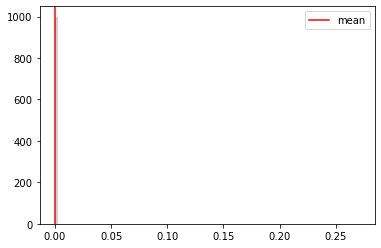

  0%|▏                                                                                | 3/1000 [00:00<00:58, 17.19it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654368090
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 1.0, 'jump_size_a': 0.1, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:45,  9.42it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▌                                                                                | 7/1000 [00:00<01:45,  9.45it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:50,  8.97it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:53,  8.72it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:50,  8.95it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:47,  9.15it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:50,  8.91it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:53,  8.64it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:56,  8.37it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:54,  8.55it/s]

Monte Carlo 23
Monte Carlo 24


  2%|██                                                                              | 25/1000 [00:02<01:57,  8.32it/s]

Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<02:17,  7.07it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:29,  6.48it/s]

Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:17,  7.04it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:14,  7.21it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:03,  7.85it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:01,  7.92it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:53,  8.50it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:49,  8.80it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<01:53,  8.47it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<01:46,  8.94it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<01:48,  8.80it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:47,  8.84it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:05<01:51,  8.55it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<01:49,  8.68it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<01:54,  8.28it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<01:48,  8.69it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:06<01:47,  8.74it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<01:52,  8.37it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<01:50,  8.52it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:07<01:51,  8.40it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:07<01:47,  8.71it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:08<01:58,  7.84it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:08<01:56,  7.95it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:08<02:01,  7.66it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:08<01:55,  8.00it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<01:54,  8.07it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:09<02:00,  7.63it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:09<02:04,  7.41it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:09<02:08,  7.13it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:10<02:04,  7.38it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:10<02:01,  7.55it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:10<02:04,  7.35it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:10<01:57,  7.72it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:11<01:56,  7.78it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:11<01:51,  8.13it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:11<01:56,  7.76it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:12<02:00,  7.48it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:12<01:56,  7.74it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:12<01:53,  7.93it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:12<01:54,  7.84it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:13<01:50,  8.09it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:13<02:05,  7.12it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:13<02:01,  7.35it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:13<01:57,  7.59it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:14<01:55,  7.65it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:14<01:55,  7.65it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:14<01:53,  7.79it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:14<01:59,  7.34it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:15<01:52,  7.83it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:15<01:55,  7.60it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:15<01:52,  7.75it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:15<01:55,  7.52it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:16<01:55,  7.53it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:16<01:56,  7.46it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:16<01:56,  7.42it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:17<01:59,  7.21it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:17<02:08,  6.70it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:17<02:06,  6.79it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:17<02:09,  6.61it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:18<02:06,  6.77it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:18<02:04,  6.85it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:18<02:05,  6.77it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 149/1000 [00:19<02:14,  6.31it/s]

Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:19<02:34,  5.51it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:19<02:19,  6.07it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:20<02:14,  6.28it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:20<02:11,  6.39it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:20<02:13,  6.31it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:21<02:19,  6.01it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:21<02:23,  5.81it/s]

Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:21<02:23,  5.82it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:21<02:13,  6.23it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:22<02:16,  6.12it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:22<02:19,  5.94it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:22<02:15,  6.09it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:23<02:14,  6.15it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:23<02:20,  5.85it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:23<02:28,  5.53it/s]

Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:24<02:29,  5.49it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:24<02:27,  5.57it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:24<02:22,  5.74it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:24<02:17,  5.92it/s]

Monte Carlo 183
Monte Carlo 184


 18%|██████████████▌                                                                | 185/1000 [00:25<02:14,  6.06it/s]

Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:25<02:21,  5.74it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:25<02:21,  5.72it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:26<02:17,  5.87it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:26<02:22,  5.66it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:26<02:20,  5.73it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:27<02:17,  5.85it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:27<02:17,  5.85it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:27<02:19,  5.72it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:28<02:21,  5.63it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:28<02:25,  5.47it/s]

Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:28<02:23,  5.54it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:28<02:22,  5.57it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:29<02:20,  5.65it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:29<02:19,  5.66it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:29<02:27,  5.35it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:30<02:27,  5.34it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:30<02:26,  5.37it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:30<02:26,  5.35it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:30<02:25,  5.40it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:30<02:27,  5.31it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:26,  5.34it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:31<02:25,  5.36it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:31<02:22,  5.46it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:31<02:18,  5.60it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:32<02:23,  5.40it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:32<02:20,  5.50it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:32<02:24,  5.35it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:32<02:28,  5.18it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:33<02:26,  5.25it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:33<02:24,  5.32it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:33<02:19,  5.49it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:33<02:22,  5.38it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:26,  5.24it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:34<02:25,  5.27it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:34<02:20,  5.43it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:34<02:18,  5.51it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:35<02:23,  5.31it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:35<02:20,  5.42it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:35<02:17,  5.49it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:35<02:19,  5.41it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:36<02:17,  5.49it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:36<02:21,  5.33it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:36<02:18,  5.43it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▋                                                           | 249/1000 [00:36<02:19,  5.38it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:37<02:21,  5.29it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:37<02:18,  5.38it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:37<02:21,  5.28it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:37<02:20,  5.31it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:38<02:20,  5.30it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▎                                                          | 257/1000 [00:38<02:40,  4.62it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 258/1000 [00:38<02:46,  4.47it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:39<02:36,  4.72it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:39<02:36,  4.72it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▋                                                          | 262/1000 [00:39<02:38,  4.65it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 263/1000 [00:39<02:37,  4.68it/s]

Monte Carlo 263


 26%|████████████████████▊                                                          | 264/1000 [00:39<02:42,  4.53it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:40<02:36,  4.70it/s]

Monte Carlo 265
Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:40<02:35,  4.72it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:44,  4.43it/s]

Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:41<02:46,  4.38it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:41<02:35,  4.67it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:41<02:33,  4.75it/s]

Monte Carlo 272
Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:42<02:35,  4.65it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:42<02:37,  4.61it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 277/1000 [00:42<02:41,  4.46it/s]

Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:42<02:45,  4.37it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:43<02:46,  4.33it/s]

Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:43<02:45,  4.34it/s]

Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:43<02:40,  4.47it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:43<02:40,  4.48it/s]

Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:40,  4.47it/s]

Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:44<02:40,  4.46it/s]

Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:43,  4.37it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:44<02:41,  4.41it/s]

Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:45<03:05,  3.84it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:47,  4.25it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:45<02:43,  4.35it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:46<02:48,  4.21it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:46<02:51,  4.12it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:48,  4.19it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:46<02:52,  4.10it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:42,  4.33it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:47<02:35,  4.52it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:47<02:36,  4.47it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:39,  4.40it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:36,  4.46it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:48<02:40,  4.35it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:48<03:06,  3.73it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:49<02:55,  3.97it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:49<02:50,  4.07it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:49<02:44,  4.21it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:49<02:46,  4.16it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:46,  4.15it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:50<02:39,  4.34it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:50<02:36,  4.39it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:50<02:36,  4.40it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:51<02:39,  4.32it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:43,  4.18it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:45,  4.15it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:34,  4.43it/s]

Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:29,  4.54it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:25,  4.68it/s]

Monte Carlo 319
Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:26,  4.63it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:24,  4.69it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:53<02:25,  4.65it/s]

Monte Carlo 324
Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:26,  4.61it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:24,  4.67it/s]

Monte Carlo 327
Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:54<02:23,  4.67it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:54<02:26,  4.57it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:55<02:23,  4.66it/s]

Monte Carlo 331
Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:27,  4.53it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:55<02:25,  4.58it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:20,  4.73it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:23,  4.63it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:56<02:29,  4.43it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:56<02:27,  4.48it/s]

Monte Carlo 339


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:22,  4.62it/s]

Monte Carlo 340
Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:21,  4.66it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:57<02:33,  4.28it/s]

Monte Carlo 343


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:30,  4.34it/s]

Monte Carlo 344
Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:34,  4.24it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:30,  4.33it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:29,  4.36it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:31,  4.29it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:28,  4.38it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:27,  4.39it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:24,  4.47it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:00<02:30,  4.31it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:27,  4.39it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:25,  4.44it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:25,  4.43it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:22,  4.53it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:20,  4.58it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:25,  4.39it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:22,  4.49it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:20,  4.54it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:23,  4.46it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:20,  4.53it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:20,  4.53it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:21,  4.48it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:18,  4.56it/s]

Monte Carlo 366
Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:16,  4.64it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:20,  4.48it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:03<02:21,  4.46it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:22,  4.42it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:18,  4.52it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:21,  4.42it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:04<02:21,  4.43it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:23,  4.36it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:22,  4.38it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:22,  4.37it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:20,  4.42it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:05<02:21,  4.39it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:21,  4.39it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:20,  4.41it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:19,  4.42it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:06<02:20,  4.40it/s]

Monte Carlo 383


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:19,  4.42it/s]

Monte Carlo 384
Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:18,  4.45it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:07<02:17,  4.44it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:18,  4.41it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:15,  4.51it/s]

Monte Carlo 389


 39%|██████████████████████████████▉                                                | 391/1000 [01:08<02:09,  4.71it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 392/1000 [01:08<02:07,  4.75it/s]

Monte Carlo 391
Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:08,  4.73it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:10,  4.66it/s]

Monte Carlo 394


 40%|███████████████████████████████▎                                               | 396/1000 [01:09<02:10,  4.62it/s]

Monte Carlo 395
Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:09<02:14,  4.49it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:17,  4.37it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:13,  4.50it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:10<02:10,  4.60it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:10<02:11,  4.55it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:10,  4.58it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:10,  4.59it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 405/1000 [01:11<02:13,  4.45it/s]

Monte Carlo 404
Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:11<02:14,  4.42it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:17,  4.31it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:12<02:15,  4.36it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:12<02:16,  4.32it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:12<02:16,  4.33it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:20,  4.20it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:13<02:22,  4.13it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:13<02:23,  4.10it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:13<02:27,  3.97it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:29,  3.90it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:14<02:26,  3.98it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:14<02:25,  4.01it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:14<02:26,  3.98it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:23,  4.04it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:15<02:29,  3.89it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:15<02:25,  3.99it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:15<02:22,  4.07it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:19,  4.13it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:16<02:24,  4.00it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:16<02:33,  3.75it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:35,  3.70it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:31,  3.77it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:17<02:28,  3.85it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:17<02:24,  3.94it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:29,  3.82it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:25,  3.90it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:18<02:20,  4.05it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:18<02:19,  4.07it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:23,  3.95it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:20,  4.01it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:19<02:22,  3.96it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:19<02:25,  3.87it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:29,  3.76it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:20<02:28,  3.79it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:20<02:22,  3.93it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:20<02:26,  3.82it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:21<02:23,  3.88it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:21<02:25,  3.83it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:21<02:21,  3.93it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:21<02:42,  3.41it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:22<02:37,  3.51it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:22<02:38,  3.50it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:22<02:33,  3.59it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:23<02:30,  3.67it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:23<02:26,  3.75it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:23<02:22,  3.86it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:23<02:21,  3.86it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:24<02:23,  3.81it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:24<02:23,  3.82it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:24<02:19,  3.90it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:24<02:21,  3.86it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:25<02:21,  3.83it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:25<02:21,  3.83it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:25<02:19,  3.89it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:25<02:19,  3.88it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:26<02:17,  3.93it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:26<02:20,  3.84it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:26<02:16,  3.92it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:26<02:14,  3.98it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:27<02:20,  3.81it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:27<02:19,  3.84it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:27<02:22,  3.74it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:27<02:23,  3.70it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:28<02:19,  3.82it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:28<02:17,  3.85it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:28<02:18,  3.83it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:29<02:18,  3.81it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:29<02:18,  3.82it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:29<02:16,  3.85it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:29<02:18,  3.80it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:30<02:18,  3.77it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:30<02:19,  3.75it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:30<02:21,  3.68it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:30<02:18,  3.76it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:31<02:19,  3.73it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:31<02:18,  3.75it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:31<02:18,  3.74it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:31<02:14,  3.85it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:32<02:10,  3.96it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:32<02:13,  3.87it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:32<02:14,  3.84it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:32<02:14,  3.82it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:33<02:10,  3.93it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:33<02:11,  3.90it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:33<02:07,  4.01it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:33<02:08,  3.97it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:34<02:07,  3.97it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:34<02:04,  4.06it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:34<02:04,  4.07it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:34<02:03,  4.07it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:35<02:04,  4.06it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:35<02:05,  4.02it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:35<02:07,  3.93it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:35<02:11,  3.81it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:36<02:09,  3.86it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:36<02:08,  3.88it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:36<02:06,  3.94it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:37<02:12,  3.74it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:37<02:08,  3.86it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:37<02:08,  3.85it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:37<02:08,  3.86it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:38<02:12,  3.73it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:38<02:12,  3.71it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:38<02:11,  3.74it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:38<02:12,  3.69it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:39<02:14,  3.64it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:39<02:12,  3.69it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:39<02:17,  3.55it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:40<02:17,  3.53it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:40<02:14,  3.61it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:40<02:16,  3.54it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:40<02:14,  3.60it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:41<02:14,  3.59it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:41<02:11,  3.65it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:41<02:14,  3.57it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:41<02:13,  3.59it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:42<02:12,  3.62it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:42<02:09,  3.68it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:42<02:13,  3.56it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:43<02:12,  3.58it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:43<02:14,  3.52it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:43<02:18,  3.41it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:43<02:17,  3.43it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:44<02:14,  3.50it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:44<02:13,  3.52it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:44<02:14,  3.48it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:45<02:16,  3.42it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:45<02:17,  3.40it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:45<02:18,  3.36it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:46<02:20,  3.31it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:46<02:16,  3.41it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:46<02:14,  3.45it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:46<02:14,  3.42it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:47<02:11,  3.51it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:47<02:11,  3.51it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:47<02:09,  3.54it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:48<02:11,  3.49it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:48<02:15,  3.37it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:48<02:12,  3.44it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:48<02:11,  3.46it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:49<02:10,  3.49it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:49<02:10,  3.47it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:49<02:09,  3.48it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:50<02:12,  3.40it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:50<02:11,  3.42it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:50<02:12,  3.39it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:50<02:12,  3.39it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:51<02:11,  3.39it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:51<02:10,  3.41it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:51<02:27,  3.01it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:52<02:20,  3.17it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:52<02:14,  3.28it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:52<02:14,  3.28it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:53<02:14,  3.29it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:53<02:14,  3.27it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:53<02:16,  3.22it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:54<02:15,  3.22it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:54<02:14,  3.24it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:54<02:12,  3.29it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:54<02:12,  3.29it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:55<02:13,  3.25it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:55<02:09,  3.33it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:55<02:12,  3.25it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:56<02:12,  3.25it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:56<02:13,  3.23it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:56<02:16,  3.13it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:57<02:17,  3.12it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:57<02:16,  3.12it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:57<02:15,  3.14it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:58<02:16,  3.12it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:58<02:17,  3.08it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:58<02:18,  3.05it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:59<02:16,  3.09it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:59<02:12,  3.18it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:59<02:09,  3.23it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:00<02:08,  3.25it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:00<02:07,  3.28it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:00<02:06,  3.29it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:00<02:12,  3.15it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:01<02:11,  3.14it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:01<02:09,  3.20it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:01<02:08,  3.21it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:02<02:08,  3.21it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:02<02:08,  3.21it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:02<02:10,  3.13it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:03<02:08,  3.17it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:03<02:07,  3.20it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:03<02:07,  3.18it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:04<02:07,  3.18it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:04<02:08,  3.16it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:04<02:07,  3.17it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:05<02:07,  3.17it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:05<02:11,  3.07it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:05<02:08,  3.13it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:06<02:07,  3.13it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:06<02:05,  3.18it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:06<02:04,  3.20it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:06<02:06,  3.14it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:07<02:08,  3.09it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:07<02:08,  3.07it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:07<02:08,  3.06it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:08<02:12,  2.97it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:08<02:12,  2.95it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:08<02:09,  3.03it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:09<02:10,  2.99it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:09<02:11,  2.97it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:09<02:07,  3.04it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:10<02:06,  3.06it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:10<02:05,  3.09it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:10<02:05,  3.07it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:11<02:02,  3.14it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:11<02:01,  3.15it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:11<02:02,  3.12it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:12<02:02,  3.12it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:12<02:01,  3.13it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:12<02:00,  3.15it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:13<02:00,  3.14it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:13<02:01,  3.10it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:13<02:02,  3.07it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:14<02:02,  3.06it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:14<02:02,  3.06it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:14<02:04,  3.01it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:15<02:02,  3.03it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:15<02:01,  3.05it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:15<01:59,  3.09it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:16<02:01,  3.04it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:16<02:01,  3.02it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:16<02:02,  3.00it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:17<02:00,  3.03it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:17<01:59,  3.07it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:17<01:57,  3.09it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:18<02:00,  3.02it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:18<01:59,  3.03it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:18<02:00,  2.99it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:19<02:02,  2.94it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:19<01:59,  3.00it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:19<01:59,  3.00it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:20<01:58,  3.01it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:20<01:55,  3.08it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:20<01:52,  3.17it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:21<01:53,  3.12it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:21<01:50,  3.18it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:21<01:51,  3.16it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:21<01:49,  3.22it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:22<01:47,  3.26it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:22<01:46,  3.28it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:22<01:45,  3.28it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:23<01:46,  3.26it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:23<01:48,  3.20it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:23<01:46,  3.23it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:24<01:47,  3.20it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:24<01:47,  3.20it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:24<01:50,  3.09it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:25<01:51,  3.07it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:25<01:50,  3.08it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:25<01:51,  3.05it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:26<01:50,  3.06it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:26<02:01,  2.78it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:26<01:56,  2.88it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:27<01:57,  2.86it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:27<01:56,  2.88it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:27<01:55,  2.88it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:28<01:55,  2.86it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:28<01:53,  2.92it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:28<01:53,  2.91it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:29<01:50,  2.97it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:29<01:51,  2.94it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:29<01:53,  2.88it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:30<01:52,  2.90it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:30<01:54,  2.85it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:30<01:51,  2.90it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:31<01:50,  2.92it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:31<01:50,  2.92it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:32<01:49,  2.94it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:32<01:47,  2.96it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:32<01:47,  2.98it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:33<01:49,  2.91it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:33<01:47,  2.95it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:33<01:45,  2.98it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:34<01:46,  2.96it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:34<01:46,  2.96it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:34<01:45,  2.98it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:35<01:46,  2.93it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:35<01:45,  2.94it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:35<01:47,  2.89it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:36<01:46,  2.91it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:36<01:47,  2.87it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:36<01:46,  2.89it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:37<01:48,  2.83it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:37<01:48,  2.80it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:37<01:48,  2.81it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:38<01:51,  2.71it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:38<01:49,  2.76it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:38<01:47,  2.79it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:39<01:47,  2.80it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:39<01:44,  2.85it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:40<01:45,  2.84it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:40<01:46,  2.79it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:40<01:45,  2.79it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:41<01:44,  2.82it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:41<01:44,  2.82it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:41<01:45,  2.78it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:42<01:44,  2.79it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:42<01:43,  2.81it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:42<01:41,  2.87it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:43<01:41,  2.85it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:43<01:41,  2.83it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:43<01:42,  2.80it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:44<01:42,  2.79it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:44<01:39,  2.85it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:44<01:40,  2.84it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:45<01:40,  2.81it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:45<01:40,  2.80it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:46<01:38,  2.84it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:46<01:37,  2.86it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:46<01:37,  2.86it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:47<01:39,  2.79it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:47<01:38,  2.80it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:47<01:37,  2.82it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:48<01:38,  2.81it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:48<01:39,  2.76it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:48<01:38,  2.76it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:49<01:37,  2.79it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:49<01:36,  2.82it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:50<01:38,  2.75it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:50<01:37,  2.77it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:50<01:35,  2.80it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:51<01:37,  2.75it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:51<01:36,  2.76it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:51<01:35,  2.76it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:52<01:35,  2.75it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:52<01:34,  2.80it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:52<01:33,  2.81it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:53<01:32,  2.81it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:53<01:34,  2.75it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:53<01:33,  2.77it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:54<01:34,  2.73it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:54<01:34,  2.71it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:55<01:33,  2.74it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:55<01:31,  2.77it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:55<01:30,  2.79it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:56<01:33,  2.71it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:56<01:33,  2.70it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:56<01:31,  2.75it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:57<01:32,  2.70it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:57<01:31,  2.72it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:58<01:39,  2.49it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:58<01:36,  2.55it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:58<01:36,  2.56it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:59<01:31,  2.67it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:59<01:28,  2.74it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:59<01:26,  2.82it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:00<01:26,  2.79it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:00<01:24,  2.86it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:00<01:23,  2.87it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:01<01:23,  2.88it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:01<01:21,  2.91it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:01<01:21,  2.91it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:02<01:21,  2.89it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:02<01:20,  2.91it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:02<01:20,  2.90it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:03<01:22,  2.83it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:03<01:23,  2.79it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:04<01:23,  2.76it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:04<01:21,  2.82it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:04<01:23,  2.75it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:05<01:22,  2.75it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:05<01:22,  2.76it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:05<01:21,  2.77it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:06<01:21,  2.75it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:06<01:20,  2.77it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:07<01:21,  2.75it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:07<01:20,  2.75it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:07<01:21,  2.72it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:08<01:22,  2.68it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:08<01:21,  2.67it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:08<01:21,  2.67it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:09<01:22,  2.64it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:09<01:21,  2.64it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:10<01:20,  2.67it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:10<01:21,  2.63it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:10<01:19,  2.68it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:11<01:19,  2.67it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:11<01:18,  2.69it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:11<01:19,  2.65it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:12<01:18,  2.65it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:12<01:18,  2.63it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:13<01:17,  2.68it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:13<01:16,  2.69it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:13<01:19,  2.59it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:14<01:17,  2.63it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:14<01:18,  2.60it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:14<01:16,  2.63it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:15<01:16,  2.61it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:15<01:16,  2.62it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:16<01:16,  2.62it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:16<01:16,  2.59it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:16<01:15,  2.61it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:17<01:13,  2.66it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:17<01:12,  2.70it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:17<01:10,  2.76it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:18<01:09,  2.78it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:18<01:08,  2.81it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:19<01:08,  2.77it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:19<01:07,  2.81it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:19<01:07,  2.79it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:20<01:09,  2.72it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:20<01:09,  2.71it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:20<01:07,  2.76it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:21<01:08,  2.70it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:21<01:08,  2.68it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:21<01:08,  2.69it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:22<01:06,  2.72it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:22<01:07,  2.69it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:23<01:07,  2.68it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:23<01:09,  2.56it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:23<01:09,  2.56it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:24<01:10,  2.51it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:24<01:08,  2.57it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:25<01:08,  2.56it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:25<01:07,  2.57it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:25<01:06,  2.60it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:26<01:05,  2.62it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:26<01:05,  2.61it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:26<01:05,  2.61it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:27<01:05,  2.57it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:27<01:05,  2.55it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:28<01:05,  2.57it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:28<01:04,  2.56it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:28<01:04,  2.56it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:29<01:06,  2.47it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:29<01:05,  2.49it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:30<01:03,  2.53it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:30<01:02,  2.56it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:30<01:02,  2.54it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:31<01:03,  2.51it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:31<01:02,  2.52it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:32<01:02,  2.52it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:32<01:01,  2.52it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:32<01:00,  2.54it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:33<01:00,  2.55it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:33<01:00,  2.55it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:34<00:59,  2.56it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:34<00:58,  2.58it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:34<00:59,  2.50it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:35<01:03,  2.35it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:35<01:00,  2.44it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:36<00:59,  2.48it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:36<00:58,  2.48it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:36<00:57,  2.52it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:37<00:57,  2.49it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:37<00:57,  2.47it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:38<00:57,  2.46it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:38<00:56,  2.49it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:38<00:57,  2.44it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:39<00:56,  2.46it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:39<00:56,  2.46it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:40<00:56,  2.44it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:40<00:55,  2.46it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:40<00:54,  2.49it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:41<00:53,  2.51it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:41<00:52,  2.52it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:42<00:52,  2.52it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:42<00:52,  2.51it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:42<00:51,  2.51it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:43<00:52,  2.47it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:43<00:51,  2.49it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:44<00:51,  2.46it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:44<00:51,  2.43it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:45<00:51,  2.42it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:45<00:51,  2.41it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:45<00:51,  2.41it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:46<00:51,  2.37it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:46<00:50,  2.41it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:47<00:50,  2.36it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:47<00:50,  2.37it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:48<00:49,  2.36it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:48<00:49,  2.38it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:48<00:49,  2.36it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:49<00:47,  2.40it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:49<00:48,  2.35it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:50<00:49,  2.28it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:50<00:46,  2.40it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:50<00:45,  2.46it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:51<00:43,  2.51it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:51<00:42,  2.54it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:52<00:42,  2.53it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:52<00:42,  2.51it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:52<00:41,  2.57it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:53<00:42,  2.47it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:53<00:41,  2.48it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:54<00:41,  2.49it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:54<00:41,  2.48it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:54<00:40,  2.48it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:55<00:40,  2.45it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:55<00:40,  2.47it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:56<00:39,  2.48it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:56<00:38,  2.49it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:56<00:39,  2.45it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:57<00:39,  2.39it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:57<00:39,  2.37it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:58<00:38,  2.39it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:58<00:39,  2.35it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:59<00:38,  2.37it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:59<00:37,  2.40it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:59<00:37,  2.38it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:00<00:36,  2.43it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:00<00:34,  2.49it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:01<00:34,  2.47it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:01<00:34,  2.45it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:01<00:34,  2.46it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:02<00:33,  2.49it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:02<00:32,  2.49it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:03<00:32,  2.50it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:03<00:32,  2.49it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:03<00:31,  2.49it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:04<00:32,  2.41it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:04<00:31,  2.47it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:05<00:31,  2.41it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:05<00:32,  2.34it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:06<00:31,  2.36it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:06<00:30,  2.37it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:06<00:30,  2.39it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:07<00:29,  2.37it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:07<00:29,  2.36it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:08<00:29,  2.32it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:08<00:28,  2.37it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:08<00:27,  2.45it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:09<00:26,  2.48it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:09<00:26,  2.48it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:10<00:26,  2.44it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:10<00:26,  2.37it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:11<00:27,  2.24it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:11<00:26,  2.31it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:11<00:25,  2.33it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:12<00:24,  2.39it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:12<00:24,  2.38it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:13<00:23,  2.40it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:13<00:23,  2.40it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:13<00:22,  2.43it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:14<00:22,  2.39it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:14<00:22,  2.35it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:15<00:22,  2.31it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:15<00:21,  2.34it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:16<00:21,  2.34it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:16<00:21,  2.32it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:17<00:20,  2.29it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:17<00:20,  2.33it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:17<00:19,  2.32it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:18<00:19,  2.32it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:18<00:18,  2.34it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:19<00:18,  2.34it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:19<00:18,  2.31it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:20<00:19,  2.14it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:20<00:18,  2.20it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:21<00:17,  2.21it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:21<00:17,  2.21it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:21<00:16,  2.24it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:22<00:16,  2.22it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:22<00:15,  2.22it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:23<00:15,  2.20it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:23<00:14,  2.23it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:24<00:14,  2.26it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:24<00:13,  2.27it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:25<00:13,  2.28it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:25<00:12,  2.30it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:25<00:12,  2.29it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:26<00:12,  2.20it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:26<00:11,  2.20it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:27<00:11,  2.15it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:27<00:10,  2.19it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:28<00:10,  2.24it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:28<00:09,  2.28it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:29<00:09,  2.26it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:29<00:08,  2.23it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:30<00:08,  2.19it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:30<00:08,  2.21it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:30<00:07,  2.24it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:31<00:07,  2.23it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:31<00:06,  2.26it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:32<00:06,  2.26it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:32<00:05,  2.28it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:33<00:05,  2.28it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:33<00:04,  2.23it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:33<00:04,  2.23it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:34<00:04,  2.19it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:34<00:03,  2.23it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:35<00:03,  2.18it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:35<00:02,  2.21it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:36<00:02,  2.20it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:36<00:01,  2.21it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:37<00:01,  2.19it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:37<00:00,  2.24it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:38<00:00,  2.23it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:38<00:00,  3.59it/s]


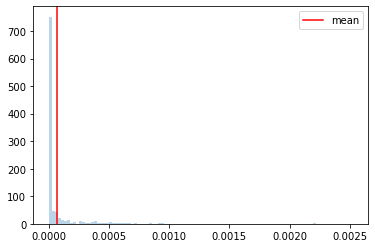

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654368369
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 1.0, 'jump_size_a': 1.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:09, 14.39it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:37, 10.24it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<02:11,  7.52it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<02:06,  7.80it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<02:03,  7.99it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<02:03,  7.96it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<02:05,  7.85it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<02:04,  7.90it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<02:01,  8.08it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:56,  8.39it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:58,  8.24it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<01:59,  8.17it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:59,  8.14it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:29,  6.47it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:04<02:16,  7.10it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:06,  7.62it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:08,  7.52it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<02:04,  7.71it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:05<02:11,  7.30it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<02:00,  7.96it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<02:08,  7.45it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<02:08,  7.45it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:06<02:14,  7.10it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:06<02:12,  7.17it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<02:21,  6.69it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:07<02:16,  6.93it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:07<02:35,  6.06it/s]

Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<02:44,  5.74it/s]

Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<02:36,  6.01it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:08<02:22,  6.58it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:08<02:12,  7.09it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:08<02:13,  7.03it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:08<02:12,  7.07it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:09<02:16,  6.85it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:09<02:12,  7.00it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▋                                                                          | 71/1000 [00:09<02:13,  6.96it/s]

Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:10<02:51,  5.40it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:10<02:31,  6.11it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:10<02:24,  6.37it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:18,  6.66it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:11<02:12,  6.95it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:11<02:19,  6.59it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:11<02:31,  6.06it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:12<02:26,  6.24it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:12<02:31,  6.00it/s]

Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:12<02:36,  5.80it/s]

Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:12<02:33,  5.90it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:13<02:20,  6.45it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:13<02:10,  6.93it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:13<02:08,  7.03it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:14<02:20,  6.42it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:14<02:18,  6.50it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:14<02:09,  6.94it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:14<02:13,  6.68it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:15<02:09,  6.88it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:15<02:11,  6.76it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:15<02:09,  6.85it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:16<02:07,  6.96it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:16<02:11,  6.73it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:16<02:13,  6.61it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:17<02:12,  6.63it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:17<02:10,  6.75it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:17<02:12,  6.61it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:17<02:13,  6.56it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:18<02:09,  6.74it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:18<02:09,  6.72it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:18<02:10,  6.63it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:19<02:15,  6.40it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:19<02:12,  6.52it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:19<02:09,  6.66it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:20<02:18,  6.23it/s]

Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:20<02:22,  6.04it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:20<02:18,  6.21it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:20<02:13,  6.42it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:21<02:07,  6.68it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:21<02:11,  6.50it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:21<02:21,  5.99it/s]

Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:22<02:20,  6.06it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:22<02:15,  6.23it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:22<02:21,  5.97it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:23<02:17,  6.14it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:23<02:14,  6.27it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:23<02:09,  6.48it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:23<02:09,  6.48it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:24<02:07,  6.54it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:24<02:12,  6.30it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:24<02:13,  6.21it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:25<02:20,  5.91it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:25<02:19,  5.94it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:25<02:23,  5.77it/s]

Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:26<02:24,  5.71it/s]

Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:26<02:23,  5.72it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:26<02:24,  5.67it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:26<02:23,  5.70it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:27<02:21,  5.79it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:27<02:21,  5.76it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:27<02:16,  5.97it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:28<02:17,  5.93it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:28<02:24,  5.62it/s]

Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:28<02:24,  5.60it/s]

Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:28<02:20,  5.76it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:29<02:16,  5.92it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:29<02:17,  5.85it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:30<02:43,  4.92it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:30<02:34,  5.18it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:30<02:29,  5.33it/s]

Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:30<02:33,  5.21it/s]

Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:30<02:26,  5.45it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:31<02:19,  5.68it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:31<02:20,  5.64it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:31<02:18,  5.74it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:32<02:19,  5.66it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:32<02:18,  5.70it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:32<02:19,  5.64it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:33<02:25,  5.40it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:33<02:21,  5.51it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:33<02:25,  5.36it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:34<02:21,  5.51it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:34<02:23,  5.43it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:34<02:27,  5.27it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:34<02:25,  5.33it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:35<02:25,  5.31it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:35<02:22,  5.43it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:35<02:25,  5.30it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:35<02:26,  5.27it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:36<02:23,  5.37it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:36<02:23,  5.34it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:36<02:21,  5.42it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:36<02:21,  5.40it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:37<02:17,  5.54it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:37<02:18,  5.51it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:37<02:16,  5.58it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:38<02:17,  5.52it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:38<02:18,  5.44it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:38<02:19,  5.42it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:39<02:19,  5.40it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:39<02:26,  5.12it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:39<02:23,  5.22it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:39<02:21,  5.31it/s]

Monte Carlo 250
Monte Carlo 251

 25%|███████████████████▉                                                           | 252/1000 [00:39<02:19,  5.37it/s]


Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:40<02:18,  5.38it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:40<02:21,  5.26it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:40<02:20,  5.30it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:40<02:17,  5.41it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:41<02:17,  5.41it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▍                                                          | 259/1000 [00:41<02:24,  5.12it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:41<02:23,  5.14it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:41<02:21,  5.21it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:42<02:24,  5.09it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:42<02:23,  5.11it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:42<02:27,  4.98it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:42<02:26,  4.99it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:43<02:29,  4.91it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:43<02:26,  4.99it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:43<02:25,  5.01it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:43<02:26,  4.97it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:43<02:30,  4.85it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:44<02:32,  4.75it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:44<02:31,  4.78it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:44<02:31,  4.77it/s]

Monte Carlo 275
Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:45<02:34,  4.66it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:45<02:30,  4.80it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:45<02:31,  4.75it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:46<02:30,  4.76it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:46<02:28,  4.82it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:46<02:26,  4.88it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:46<02:24,  4.94it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:46<02:26,  4.88it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:47<02:26,  4.87it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:47<02:23,  4.96it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:47<02:24,  4.92it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:47<02:21,  5.01it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:47<02:23,  4.96it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:48<02:24,  4.92it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:48<02:32,  4.64it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:48<02:26,  4.81it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:49<02:27,  4.76it/s]

Monte Carlo 296
Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:49<02:28,  4.73it/s]

Monte Carlo 298
Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:49<02:27,  4.74it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:50<02:24,  4.82it/s]

Monte Carlo 301
Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:50<02:27,  4.73it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:50<02:29,  4.66it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:50<02:33,  4.51it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:51<02:28,  4.66it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:51<02:28,  4.66it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:51<02:32,  4.51it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:52<02:28,  4.64it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:52<02:25,  4.72it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:52<02:24,  4.76it/s]

Monte Carlo 312
Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:52<02:21,  4.83it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:53<02:20,  4.89it/s]

Monte Carlo 315
Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:53<02:22,  4.79it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:53<02:24,  4.73it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:54<02:22,  4.75it/s]

Monte Carlo 320
Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:54<02:28,  4.57it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:54<02:33,  4.41it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:54<02:32,  4.43it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:55<02:31,  4.45it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:55<02:47,  4.03it/s]

Monte Carlo 326
Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:55<02:42,  4.13it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:56<02:35,  4.30it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:56<02:30,  4.44it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:56<02:29,  4.49it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:56<02:33,  4.36it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:57<02:31,  4.39it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:57<02:27,  4.53it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:57<02:24,  4.59it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:57<02:27,  4.52it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:57<02:27,  4.49it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:58<02:26,  4.53it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:58<02:28,  4.44it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:58<02:31,  4.36it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:58<02:34,  4.28it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:59<02:32,  4.32it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:59<02:35,  4.23it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:59<02:36,  4.20it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:59<02:33,  4.28it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:00<02:37,  4.15it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:00<02:36,  4.16it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:00<02:37,  4.15it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:00<02:35,  4.19it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:01<02:33,  4.24it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:01<02:30,  4.32it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:01<02:27,  4.41it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:01<02:31,  4.28it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:01<02:29,  4.33it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:02<02:27,  4.36it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:02<02:24,  4.47it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:02<02:24,  4.45it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:02<02:27,  4.35it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:03<02:35,  4.13it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:03<02:29,  4.28it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:03<02:30,  4.24it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:03<02:29,  4.28it/s]

Monte Carlo 362


 36%|████████████████████████████▊                                                  | 364/1000 [01:04<02:24,  4.42it/s]

Monte Carlo 363
Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:04<02:24,  4.39it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:04<02:26,  4.34it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:04<02:28,  4.25it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:05<02:26,  4.33it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:05<02:30,  4.20it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:05<02:32,  4.13it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:05<02:31,  4.15it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:06<02:29,  4.20it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:06<02:27,  4.26it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:06<02:30,  4.16it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:06<02:25,  4.31it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:07<02:25,  4.30it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:07<02:26,  4.26it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:07<02:25,  4.28it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:07<02:25,  4.28it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:08<02:27,  4.21it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:08<02:31,  4.09it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:08<02:27,  4.20it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:08<02:31,  4.08it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:09<02:31,  4.06it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:09<02:28,  4.13it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:09<02:24,  4.24it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:09<02:28,  4.14it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:10<02:32,  4.02it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:10<02:33,  3.99it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:10<02:34,  3.94it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:10<02:30,  4.04it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:11<02:29,  4.07it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:11<02:28,  4.08it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:11<02:26,  4.13it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:11<02:22,  4.24it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:11<02:25,  4.16it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:12<02:24,  4.19it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:12<02:27,  4.08it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:12<02:30,  3.99it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:12<02:27,  4.06it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:13<02:26,  4.10it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:13<02:23,  4.17it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:13<02:21,  4.22it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:13<02:22,  4.19it/s]

Monte Carlo 404


 41%|████████████████████████████████                                               | 406/1000 [01:14<02:18,  4.29it/s]

Monte Carlo 405
Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:14<02:17,  4.32it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:14<02:18,  4.28it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:15<02:17,  4.29it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:15<02:20,  4.19it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:15<02:18,  4.27it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:15<02:16,  4.30it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:15<02:14,  4.38it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:16<02:14,  4.37it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:16<02:17,  4.24it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:16<02:21,  4.14it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:16<02:23,  4.05it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 419/1000 [01:17<02:13,  4.35it/s]

Monte Carlo 418
Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:17<02:12,  4.39it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:17<02:09,  4.48it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:18<02:13,  4.33it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 424/1000 [01:18<02:09,  4.45it/s]

Monte Carlo 423
Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:18<02:11,  4.37it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:19<02:13,  4.29it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:19<02:11,  4.36it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:19<02:13,  4.28it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:19<02:11,  4.34it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:19<02:17,  4.15it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:20<02:16,  4.16it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:20<02:13,  4.25it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:20<02:12,  4.29it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:20<02:11,  4.29it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:21<02:12,  4.28it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:21<02:12,  4.27it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:21<02:11,  4.27it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:21<02:11,  4.28it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:22<02:12,  4.22it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:22<02:10,  4.29it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:22<02:11,  4.26it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:22<02:13,  4.18it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:23<02:13,  4.18it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:23<02:12,  4.19it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:23<02:11,  4.24it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:23<02:15,  4.10it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:24<02:20,  3.92it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:24<02:19,  3.96it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:24<02:19,  3.95it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:24<02:39,  3.45it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:25<02:29,  3.66it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:25<02:23,  3.83it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:25<02:17,  3.98it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:25<02:15,  4.02it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:26<02:14,  4.06it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:26<02:13,  4.07it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:26<02:13,  4.07it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:26<02:14,  4.02it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:27<02:13,  4.04it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:27<02:14,  4.01it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:27<02:17,  3.92it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:18,  3.88it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:28<02:19,  3.85it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:28<02:17,  3.90it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:28<02:12,  4.04it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:28<02:11,  4.07it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:29<02:09,  4.12it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:29<02:07,  4.16it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:29<02:12,  4.01it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:29<02:11,  4.04it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:30<02:09,  4.08it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:30<02:06,  4.18it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:30<02:08,  4.09it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:08,  4.11it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:31<02:10,  4.02it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:31<02:13,  3.94it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:31<02:14,  3.89it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:31<02:09,  4.03it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:32<02:12,  3.93it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:32<02:11,  3.95it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:32<02:13,  3.88it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:32<02:15,  3.83it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:33<02:15,  3.81it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:33<02:13,  3.87it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:33<02:13,  3.85it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:33<02:12,  3.89it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:34<02:13,  3.84it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:34<02:13,  3.83it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:34<02:16,  3.75it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:34<02:17,  3.72it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:35<02:19,  3.64it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:35<02:22,  3.56it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:35<02:33,  3.31it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:36<02:44,  3.08it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:36<02:46,  3.04it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:36<02:45,  3.05it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:37<02:42,  3.09it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:37<02:42,  3.08it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:37<02:39,  3.14it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:38<02:37,  3.18it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:38<02:37,  3.16it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:38<02:32,  3.28it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:39<02:30,  3.29it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:39<02:29,  3.33it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:39<02:28,  3.34it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:40<02:32,  3.23it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:40<02:30,  3.28it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:40<02:28,  3.31it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:40<02:31,  3.24it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:41<02:31,  3.23it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:41<02:39,  3.06it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:41<02:43,  2.99it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:42<02:41,  3.01it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:42<02:44,  2.96it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:43<02:47,  2.89it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:43<02:43,  2.97it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:43<02:42,  2.98it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:44<02:43,  2.95it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:44<02:38,  3.04it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:44<02:31,  3.17it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:44<02:26,  3.27it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:45<02:25,  3.29it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:45<02:25,  3.29it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:45<02:23,  3.31it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:46<02:23,  3.31it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:46<02:22,  3.32it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:46<02:20,  3.36it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:46<02:25,  3.25it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:47<02:20,  3.35it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:47<02:19,  3.38it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:47<02:17,  3.42it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:48<02:18,  3.39it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:48<02:21,  3.30it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:48<02:17,  3.39it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:49<02:16,  3.41it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:49<02:15,  3.43it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:49<02:17,  3.36it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:49<02:18,  3.34it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:50<02:18,  3.34it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:50<02:21,  3.25it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:50<02:20,  3.28it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:51<02:21,  3.24it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:51<02:22,  3.21it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:51<02:19,  3.28it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:52<02:17,  3.31it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:52<02:17,  3.29it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:52<02:17,  3.30it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:52<02:14,  3.35it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:53<02:12,  3.41it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:53<02:10,  3.45it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:53<02:11,  3.41it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:54<02:13,  3.36it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:54<02:13,  3.35it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:54<02:26,  3.05it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:55<02:23,  3.11it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:55<02:22,  3.11it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:55<02:20,  3.16it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:56<02:20,  3.14it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:56<02:22,  3.09it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:56<02:27,  2.99it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:57<02:23,  3.07it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:57<02:22,  3.08it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:57<02:24,  3.03it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:58<02:22,  3.06it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:58<02:19,  3.13it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:58<02:21,  3.06it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:59<02:19,  3.09it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:59<02:18,  3.13it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:59<02:16,  3.15it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:00<02:17,  3.12it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:00<02:21,  3.02it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:00<02:20,  3.05it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:01<02:19,  3.06it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:01<02:19,  3.05it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:01<02:16,  3.11it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:01<02:16,  3.11it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:02<02:13,  3.16it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:02<02:14,  3.15it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:02<02:15,  3.10it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:03<02:17,  3.06it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:03<02:18,  3.03it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:03<02:19,  3.00it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:04<02:20,  2.96it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:04<02:26,  2.84it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:04<02:19,  2.96it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:05<02:16,  3.04it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:05<02:17,  3.01it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:05<02:15,  3.04it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:06<02:16,  3.01it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:06<02:14,  3.05it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:06<02:12,  3.08it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:07<02:12,  3.08it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:07<02:11,  3.10it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:07<02:10,  3.11it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:08<02:13,  3.04it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:08<02:14,  2.99it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:08<02:16,  2.94it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:09<02:16,  2.96it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:09<02:14,  2.97it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:09<02:15,  2.94it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:10<02:14,  2.97it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:10<02:10,  3.05it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:10<02:12,  3.00it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:11<02:12,  2.98it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:11<02:12,  2.99it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:11<02:12,  2.97it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:12<02:13,  2.95it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:12<02:09,  3.03it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:12<02:09,  3.01it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:13<02:13,  2.92it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:13<02:09,  3.00it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:13<02:09,  2.99it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:14<02:07,  3.03it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:14<02:10,  2.97it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:15<02:18,  2.78it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:15<02:17,  2.78it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:15<02:13,  2.87it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:16<02:12,  2.88it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:16<02:09,  2.95it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:16<02:10,  2.92it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:17<02:09,  2.94it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:17<02:06,  2.99it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:17<02:05,  2.99it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:18<02:09,  2.90it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:18<02:13,  2.80it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:18<02:11,  2.83it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:19<02:08,  2.90it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:19<02:05,  2.97it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:19<02:03,  2.99it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:20<02:07,  2.90it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:20<02:06,  2.93it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:20<02:05,  2.94it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:21<02:07,  2.87it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:21<02:09,  2.83it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:21<02:10,  2.80it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:22<02:06,  2.89it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:22<02:06,  2.87it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:22<02:07,  2.84it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:23<02:08,  2.82it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:23<02:05,  2.86it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:23<02:02,  2.92it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:24<02:01,  2.95it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:24<01:59,  3.00it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:24<01:59,  2.98it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:25<01:57,  3.02it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:25<01:57,  3.02it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:25<01:57,  2.99it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:26<01:56,  3.03it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:26<01:57,  2.99it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:27<01:59,  2.92it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:27<02:01,  2.87it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:27<02:10,  2.66it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:28<02:07,  2.71it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:28<02:04,  2.78it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:28<02:02,  2.81it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:29<02:02,  2.81it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:29<01:58,  2.90it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:29<01:57,  2.92it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:30<01:56,  2.94it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:30<01:55,  2.94it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:30<01:58,  2.86it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:31<01:58,  2.86it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:31<01:56,  2.89it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:31<01:54,  2.92it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:32<01:54,  2.92it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:32<01:53,  2.95it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:32<01:52,  2.96it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:33<01:52,  2.95it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:33<01:53,  2.91it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:33<01:52,  2.93it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:34<01:51,  2.96it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:34<01:53,  2.89it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:34<01:52,  2.91it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:35<01:53,  2.86it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:35<01:53,  2.87it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:36<01:54,  2.84it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:36<01:53,  2.85it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:36<01:52,  2.86it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:37<01:52,  2.84it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:37<01:53,  2.82it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:37<01:53,  2.80it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:38<01:54,  2.78it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:38<01:53,  2.80it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:38<01:50,  2.85it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:39<01:51,  2.84it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:39<01:48,  2.88it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:39<01:47,  2.91it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:40<01:49,  2.84it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:40<01:50,  2.82it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:41<01:49,  2.82it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:41<01:47,  2.87it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:41<01:46,  2.88it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:42<01:46,  2.87it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:42<01:47,  2.85it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:42<01:50,  2.77it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:43<01:49,  2.77it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:43<01:46,  2.84it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:43<01:47,  2.82it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:44<01:45,  2.84it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:44<01:45,  2.85it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:44<01:44,  2.86it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:45<01:43,  2.88it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:45<01:44,  2.86it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:45<01:46,  2.78it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:46<01:46,  2.78it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:46<01:48,  2.71it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:47<01:45,  2.77it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:47<01:46,  2.74it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:47<01:44,  2.78it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:48<01:43,  2.79it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:48<01:49,  2.63it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:48<01:45,  2.74it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:49<01:42,  2.80it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:49<01:42,  2.80it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:49<01:43,  2.75it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:50<01:43,  2.73it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:50<01:45,  2.68it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:51<01:42,  2.75it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:51<01:43,  2.71it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:51<01:43,  2.72it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:52<01:42,  2.73it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:52<01:42,  2.70it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:52<01:39,  2.77it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:53<01:39,  2.76it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:53<01:37,  2.83it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:53<01:33,  2.92it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:54<01:33,  2.93it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:54<01:33,  2.91it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:54<01:32,  2.92it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:55<01:31,  2.96it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:55<01:31,  2.94it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:55<01:29,  2.98it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:56<01:30,  2.95it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:56<01:31,  2.91it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:56<01:29,  2.96it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:57<01:29,  2.94it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:57<01:30,  2.91it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:58<01:30,  2.88it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:58<01:31,  2.84it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:58<01:32,  2.82it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:59<01:30,  2.87it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:59<01:31,  2.82it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:59<01:30,  2.85it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:00<01:29,  2.85it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:00<01:28,  2.89it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:00<01:26,  2.94it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:01<01:26,  2.92it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:01<01:26,  2.93it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:01<01:26,  2.91it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:02<01:27,  2.86it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:02<01:27,  2.83it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:02<01:28,  2.80it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:03<01:26,  2.87it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:03<01:25,  2.89it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:03<01:25,  2.87it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:04<01:27,  2.79it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:04<01:26,  2.81it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:05<01:25,  2.83it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:05<01:25,  2.83it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:05<01:25,  2.82it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:06<01:22,  2.89it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:06<01:23,  2.86it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:06<01:22,  2.87it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:07<01:26,  2.74it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:07<01:26,  2.73it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:07<01:24,  2.77it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:08<01:23,  2.80it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:08<01:22,  2.80it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:08<01:21,  2.84it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:09<01:28,  2.60it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:09<01:26,  2.64it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:10<01:25,  2.67it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:10<01:24,  2.69it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:10<01:24,  2.68it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:11<01:21,  2.75it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:11<01:21,  2.75it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:11<01:22,  2.70it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:12<01:23,  2.67it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:12<01:20,  2.73it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:13<01:19,  2.77it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:13<01:21,  2.70it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:13<01:21,  2.69it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:14<01:18,  2.75it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:14<01:19,  2.73it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:14<01:18,  2.73it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:15<01:17,  2.76it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:15<01:16,  2.77it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:15<01:19,  2.65it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:16<01:20,  2.64it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:16<01:24,  2.48it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:17<01:23,  2.49it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:17<01:24,  2.46it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:18<01:23,  2.47it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:18<01:23,  2.45it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:18<01:25,  2.39it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:19<01:24,  2.41it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:19<01:25,  2.37it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:20<01:25,  2.37it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:20<01:23,  2.40it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:20<01:23,  2.40it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:21<01:21,  2.45it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:21<01:20,  2.47it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:22<01:18,  2.51it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:22<01:19,  2.48it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:22<01:17,  2.51it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:23<01:16,  2.53it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:23<01:16,  2.54it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:24<01:14,  2.57it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:24<01:13,  2.59it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:24<01:13,  2.57it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:25<01:15,  2.51it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:25<01:13,  2.57it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:26<01:13,  2.54it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:26<01:13,  2.55it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:26<01:12,  2.55it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:27<01:13,  2.50it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:27<01:16,  2.39it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:28<01:15,  2.43it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:28<01:15,  2.40it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:29<01:15,  2.39it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:29<01:17,  2.30it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:29<01:14,  2.38it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:30<01:12,  2.43it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:30<01:11,  2.47it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:31<01:09,  2.50it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:31<01:08,  2.54it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:31<01:08,  2.54it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:32<01:07,  2.54it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:32<01:07,  2.53it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:33<01:08,  2.47it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:33<01:08,  2.45it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:33<01:08,  2.45it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:34<01:08,  2.44it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:34<01:10,  2.35it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:35<01:10,  2.32it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:35<01:10,  2.34it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:35<01:08,  2.36it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:36<01:08,  2.38it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:36<01:06,  2.41it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:37<01:07,  2.36it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:37<01:07,  2.35it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:38<01:06,  2.36it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:38<01:06,  2.38it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:38<01:04,  2.43it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:39<01:04,  2.41it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:39<01:03,  2.42it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:40<01:02,  2.43it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:40<01:02,  2.42it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:40<01:02,  2.43it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:41<01:02,  2.41it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:41<01:02,  2.39it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:42<01:02,  2.37it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:42<01:00,  2.43it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:43<01:00,  2.42it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:43<00:59,  2.42it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:43<00:59,  2.43it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:44<00:58,  2.46it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:44<00:58,  2.42it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:45<00:59,  2.37it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:45<00:58,  2.39it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:45<00:58,  2.38it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:46<00:58,  2.37it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:46<00:57,  2.40it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:47<00:57,  2.37it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:47<00:56,  2.38it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:48<00:56,  2.39it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:48<00:55,  2.39it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:48<00:56,  2.36it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:49<00:54,  2.39it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:49<00:54,  2.39it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:50<00:53,  2.39it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:50<00:52,  2.42it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:50<00:52,  2.42it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:51<00:51,  2.44it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:51<00:51,  2.43it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:52<00:52,  2.35it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:52<00:56,  2.16it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:53<00:53,  2.27it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:53<00:52,  2.29it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:54<00:52,  2.30it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:54<00:51,  2.32it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:54<00:50,  2.33it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:55<00:50,  2.31it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:55<00:50,  2.30it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:56<00:49,  2.32it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:56<00:50,  2.26it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:57<00:48,  2.32it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:57<00:48,  2.30it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:57<00:47,  2.33it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:58<00:46,  2.35it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:58<00:47,  2.30it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:59<00:47,  2.25it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:59<00:47,  2.25it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:00<00:48,  2.20it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:00<00:48,  2.18it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:01<00:48,  2.15it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:01<00:47,  2.16it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:02<00:48,  2.12it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:02<00:46,  2.15it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:02<00:45,  2.18it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:03<00:44,  2.20it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:03<00:44,  2.22it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:04<00:44,  2.18it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:04<00:44,  2.15it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:05<00:45,  2.10it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:05<00:44,  2.11it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:06<00:44,  2.10it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:06<00:42,  2.15it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:07<00:41,  2.20it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:07<00:41,  2.17it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:08<00:40,  2.21it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:08<00:40,  2.19it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:08<00:39,  2.22it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:09<00:38,  2.23it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:09<00:39,  2.17it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:10<00:38,  2.20it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:10<00:37,  2.20it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:11<00:37,  2.20it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:11<00:36,  2.23it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:12<00:35,  2.26it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:12<00:34,  2.30it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:12<00:32,  2.37it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:13<00:32,  2.38it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:13<00:31,  2.41it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:14<00:30,  2.42it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:14<00:30,  2.42it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:14<00:30,  2.42it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:15<00:29,  2.43it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:15<00:29,  2.41it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:16<00:29,  2.37it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:16<00:29,  2.36it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:17<00:28,  2.41it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:17<00:27,  2.42it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:17<00:27,  2.40it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:18<00:27,  2.40it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:18<00:27,  2.33it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:19<00:26,  2.36it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:19<00:26,  2.37it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:20<00:25,  2.40it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:20<00:25,  2.38it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:20<00:24,  2.37it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:21<00:24,  2.35it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:21<00:24,  2.31it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:22<00:24,  2.32it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:22<00:23,  2.30it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:23<00:23,  2.27it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:23<00:23,  2.22it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:23<00:23,  2.22it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:24<00:22,  2.23it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:24<00:22,  2.23it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:25<00:22,  2.22it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:25<00:22,  2.16it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:26<00:21,  2.22it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:26<00:20,  2.20it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:27<00:20,  2.18it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:27<00:19,  2.21it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:28<00:19,  2.22it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:28<00:18,  2.24it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:28<00:18,  2.24it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:29<00:17,  2.26it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:29<00:17,  2.22it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:30<00:16,  2.25it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:30<00:16,  2.22it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:31<00:17,  2.09it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:31<00:16,  2.06it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:32<00:16,  2.10it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:32<00:15,  2.09it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:33<00:15,  2.10it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:33<00:15,  1.95it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:34<00:15,  1.98it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:34<00:14,  2.01it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:35<00:13,  2.02it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:35<00:13,  2.06it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:36<00:12,  2.08it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:36<00:11,  2.15it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:37<00:11,  2.16it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:37<00:10,  2.17it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:37<00:10,  2.19it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:38<00:09,  2.18it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:38<00:09,  2.14it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:39<00:08,  2.14it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:39<00:08,  2.16it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:40<00:07,  2.16it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:40<00:07,  2.17it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:41<00:06,  2.15it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:41<00:06,  2.13it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:42<00:06,  2.13it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:42<00:05,  2.09it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:43<00:05,  2.14it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:43<00:04,  2.09it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:44<00:04,  2.09it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:44<00:03,  2.12it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:45<00:03,  2.14it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:45<00:02,  2.15it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:45<00:02,  2.15it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:46<00:01,  2.10it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:46<00:01,  2.12it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:47<00:00,  2.14it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:47<00:00,  2.14it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:48<00:00,  3.47it/s]


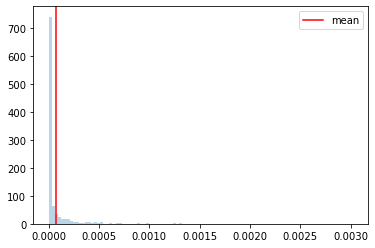

  0%|▏                                                                                | 3/1000 [00:00<01:04, 15.43it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654368658
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 1.0, 'jump_size_a': 1.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:37, 10.19it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:56,  8.53it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:52,  8.76it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:48,  9.09it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:50,  8.93it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:54,  8.59it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:52,  8.73it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:51,  8.76it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:53,  8.61it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:48,  9.00it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:56,  8.39it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:52,  8.61it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:16,  7.09it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:08,  7.51it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<02:03,  7.81it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:00,  8.02it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:56,  8.25it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:53,  8.44it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<01:52,  8.54it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<01:48,  8.78it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<02:00,  7.92it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:52,  8.48it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:05<01:52,  8.43it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<01:57,  8.10it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▏                                                                           | 53/1000 [00:06<01:55,  8.21it/s]

Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:23,  6.60it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<02:11,  7.20it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:05,  7.48it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:57,  7.96it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:07,  7.37it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<01:59,  7.86it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:04,  7.52it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<01:59,  7.79it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:05,  7.40it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<02:04,  7.44it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:05,  7.36it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:03,  7.45it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:03,  7.47it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:06,  7.29it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:08,  7.12it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:06,  7.25it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<02:13,  6.83it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:09,  7.05it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:02,  7.43it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:09,  6.98it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:05,  7.21it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:06,  7.13it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:02,  7.36it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:03,  7.30it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:00,  7.46it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:05,  7.15it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:05,  7.12it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:01,  7.33it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:07,  6.97it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:08,  6.90it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:06,  6.99it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:07,  6.95it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:06,  6.96it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:05,  7.02it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:12,  6.62it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:06,  6.92it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:06,  6.90it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:06,  6.87it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:06,  6.88it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:17,  6.29it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<02:12,  6.55it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:17,  6.26it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:13,  6.45it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:10,  6.60it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:07,  6.71it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:09,  6.58it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:14,  6.36it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:12,  6.42it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:17,  6.16it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:14,  6.30it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:20<02:15,  6.25it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:11,  6.40it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<02:10,  6.44it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:21<02:18,  6.06it/s]

Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:20,  5.98it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:22<02:22,  5.85it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:22<02:21,  5.90it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:12,  6.29it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:23<02:10,  6.38it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:23<02:19,  5.91it/s]

Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:23<02:21,  5.83it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:16,  6.03it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:24<02:18,  5.93it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████                                                                 | 178/1000 [00:24<02:15,  6.06it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:39,  5.15it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:27,  5.55it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:25<02:23,  5.67it/s]

Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:19,  5.84it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:20,  5.78it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:26<02:20,  5.76it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:21,  5.71it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:27<02:22,  5.68it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:26,  5.50it/s]

Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:27<02:25,  5.53it/s]

Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:23,  5.60it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:23,  5.61it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:25,  5.50it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:27,  5.40it/s]

Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:29<02:25,  5.47it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:21,  5.64it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:30<02:20,  5.64it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:30<02:16,  5.80it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:30<02:19,  5.67it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:22,  5.51it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:22,  5.52it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:19,  5.61it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:20,  5.58it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:18,  5.62it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:18,  5.61it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:16,  5.69it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:14,  5.79it/s]

Monte Carlo 223
Monte Carlo 224


 22%|█████████████████▊                                                             | 225/1000 [00:33<02:17,  5.64it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:33<02:25,  5.32it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:23,  5.40it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:21,  5.45it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:20,  5.45it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:24,  5.32it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:25,  5.26it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:23,  5.35it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:19,  5.48it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:21,  5.39it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:35<02:18,  5.50it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:19,  5.45it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:19,  5.42it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:25,  5.22it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:36<02:22,  5.30it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:36<02:19,  5.41it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:17,  5.46it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:37<02:23,  5.23it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:37<02:25,  5.16it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:29,  5.01it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:24,  5.19it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:38<02:22,  5.24it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:38<02:19,  5.34it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:15,  5.48it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:39<02:18,  5.36it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:18,  5.37it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:39<02:18,  5.34it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:39<02:22,  5.18it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:40<02:24,  5.10it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:21,  5.22it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:40<02:20,  5.22it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:18,  5.29it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:13,  5.49it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:41<02:11,  5.52it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:10,  5.58it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:09,  5.60it/s]

Monte Carlo 273
Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:42<02:07,  5.68it/s]

Monte Carlo 275
Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:10,  5.54it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:43<02:16,  5.29it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:43<02:11,  5.47it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:12,  5.40it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:12,  5.38it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:44<02:15,  5.27it/s]

Monte Carlo 286
Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:13,  5.34it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:45<02:15,  5.23it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:45<02:10,  5.41it/s]

Monte Carlo 291
Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:46<02:08,  5.50it/s]

Monte Carlo 293
Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:46<02:08,  5.50it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:46<02:15,  5.21it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:46<02:24,  4.87it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:47<02:20,  4.98it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:47<02:17,  5.07it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:47<02:17,  5.08it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:47<02:16,  5.10it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:48<02:12,  5.23it/s]

Monte Carlo 303
Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:48<02:10,  5.32it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:48<02:34,  4.50it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:48<02:33,  4.51it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:49<02:25,  4.76it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:49<02:21,  4.88it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:49<02:17,  5.03it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:49<02:16,  5.05it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:50<02:16,  5.03it/s]

Monte Carlo 313
Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:50<02:19,  4.90it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:50<02:18,  4.94it/s]

Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:51<02:21,  4.81it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:51<02:16,  4.99it/s]

Monte Carlo 319
Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:51<02:20,  4.82it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:52<02:19,  4.86it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:52<02:19,  4.86it/s]

Monte Carlo 323
Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:52<02:25,  4.63it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:52<02:22,  4.72it/s]

Monte Carlo 326
Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:53<02:20,  4.78it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:53<02:19,  4.81it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:53<02:18,  4.82it/s]

Monte Carlo 330
Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:53<02:19,  4.80it/s]

Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:54<02:19,  4.76it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:54<02:15,  4.90it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:54<02:12,  5.01it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:54<02:15,  4.88it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:55<02:13,  4.96it/s]

Monte Carlo 338
Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:55<02:16,  4.83it/s]

Monte Carlo 340


 34%|███████████████████████████                                                    | 342/1000 [00:55<02:12,  4.96it/s]

Monte Carlo 341
Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:56<02:15,  4.86it/s]

Monte Carlo 343


 34%|███████████████████████████▎                                                   | 345/1000 [00:56<02:18,  4.74it/s]

Monte Carlo 344


 35%|███████████████████████████▎                                                   | 346/1000 [00:56<02:17,  4.76it/s]

Monte Carlo 345


 35%|███████████████████████████▍                                                   | 347/1000 [00:57<02:14,  4.87it/s]

Monte Carlo 346
Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:57<02:24,  4.52it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:57<02:21,  4.59it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:57<02:25,  4.48it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:57<02:24,  4.50it/s]

Monte Carlo 351


 35%|███████████████████████████▉                                                   | 353/1000 [00:58<02:19,  4.64it/s]

Monte Carlo 352
Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:58<02:21,  4.55it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [00:58<02:21,  4.57it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [00:59<02:25,  4.43it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [00:59<02:27,  4.37it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [00:59<02:27,  4.35it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [00:59<02:27,  4.33it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:00<02:29,  4.28it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:00<02:27,  4.35it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:00<02:23,  4.43it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:00<02:23,  4.45it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:00<02:23,  4.43it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:01<02:22,  4.46it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:01<02:27,  4.31it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:01<02:24,  4.39it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:01<02:23,  4.41it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:02<02:24,  4.37it/s]

Monte Carlo 369


 37%|█████████████████████████████▎                                                 | 371/1000 [01:02<02:22,  4.41it/s]

Monte Carlo 370
Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:02<02:25,  4.33it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:02<02:24,  4.33it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:03<02:26,  4.28it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:03<02:25,  4.29it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:03<02:25,  4.29it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:03<02:23,  4.35it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:04<02:26,  4.24it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:04<02:24,  4.28it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:04<02:23,  4.33it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:04<02:22,  4.33it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:05<02:21,  4.38it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:05<02:21,  4.36it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:05<02:22,  4.32it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:05<02:26,  4.19it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:06<02:27,  4.17it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:06<02:33,  3.99it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:06<02:29,  4.10it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:06<02:30,  4.05it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:07<02:26,  4.18it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:07<02:24,  4.23it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:07<02:25,  4.18it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:07<02:26,  4.16it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:07<02:29,  4.06it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:08<02:27,  4.09it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:08<02:26,  4.14it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:08<02:22,  4.23it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:08<02:23,  4.21it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:09<02:22,  4.23it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:09<02:24,  4.15it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:09<02:26,  4.08it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:09<02:27,  4.04it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:10<02:27,  4.05it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:10<02:29,  3.97it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:10<02:25,  4.09it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:10<02:25,  4.08it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:11<02:26,  4.04it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:11<02:25,  4.08it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:11<02:22,  4.13it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:11<02:22,  4.13it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:12<02:21,  4.18it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:12<02:21,  4.15it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:12<02:19,  4.21it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:12<02:18,  4.22it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:13<02:18,  4.24it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:13<02:21,  4.12it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:13<02:20,  4.14it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:13<02:24,  4.03it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:14<02:24,  4.02it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:14<02:26,  3.96it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:14<02:26,  3.96it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:14<02:22,  4.06it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:15<02:25,  3.98it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:15<02:21,  4.06it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:15<02:22,  4.05it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:15<02:23,  4.01it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:16<02:22,  4.01it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:16<02:24,  3.97it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:16<02:23,  3.97it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:16<02:23,  3.98it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:17<02:28,  3.84it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:17<02:29,  3.81it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:17<02:33,  3.69it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:17<02:35,  3.63it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:18<02:34,  3.67it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:18<02:34,  3.64it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:18<02:36,  3.60it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:19<02:52,  3.26it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:19<02:45,  3.39it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:19<02:39,  3.52it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:19<02:35,  3.59it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:20<02:35,  3.58it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:20<02:40,  3.46it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:20<02:48,  3.30it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:21<02:46,  3.33it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:21<02:47,  3.31it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:21<02:45,  3.34it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:22<02:44,  3.35it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:22<02:43,  3.37it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:22<02:46,  3.30it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:22<02:44,  3.34it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:23<02:37,  3.48it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:23<02:29,  3.67it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:23<02:29,  3.64it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:24<02:27,  3.69it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:24<02:29,  3.64it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:24<02:24,  3.75it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:24<02:21,  3.83it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:25<02:23,  3.77it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:25<02:24,  3.73it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:25<02:22,  3.78it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:25<02:20,  3.83it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:26<02:18,  3.89it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:26<02:17,  3.91it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:26<02:18,  3.87it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:26<02:21,  3.78it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:27<02:18,  3.84it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:27<02:17,  3.88it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:27<02:15,  3.91it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:27<02:15,  3.91it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:28<02:14,  3.92it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:28<02:15,  3.89it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:28<02:17,  3.84it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:28<02:14,  3.92it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:29<02:14,  3.89it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:29<02:20,  3.74it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:29<02:22,  3.66it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:30<02:24,  3.61it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:30<02:26,  3.55it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:30<02:26,  3.56it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:30<02:23,  3.63it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:31<02:26,  3.54it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:31<02:25,  3.54it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:31<02:21,  3.64it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:31<02:18,  3.72it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:32<02:15,  3.80it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:32<02:17,  3.73it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:32<02:20,  3.66it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:33<02:21,  3.61it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:33<02:21,  3.61it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:33<02:22,  3.58it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:33<02:20,  3.62it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:34<02:20,  3.61it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:34<02:20,  3.61it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:34<02:18,  3.65it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:34<02:15,  3.73it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:35<02:15,  3.71it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:35<02:15,  3.71it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:35<02:13,  3.75it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:36<02:13,  3.76it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:36<02:15,  3.68it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:36<02:14,  3.70it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:36<02:12,  3.75it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:37<02:12,  3.75it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:37<02:15,  3.65it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:37<02:14,  3.67it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:37<02:12,  3.71it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:38<02:12,  3.71it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:38<02:16,  3.59it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:38<02:16,  3.59it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:39<02:14,  3.64it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:39<02:14,  3.64it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:39<02:17,  3.53it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:39<02:14,  3.60it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:40<02:13,  3.64it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:40<02:13,  3.62it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:40<02:13,  3.61it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:40<02:11,  3.66it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:41<02:15,  3.54it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:41<02:18,  3.47it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:41<02:20,  3.40it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:42<02:19,  3.42it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:42<02:18,  3.45it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:42<02:20,  3.38it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:43<02:23,  3.32it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:43<02:20,  3.38it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:43<02:19,  3.38it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:43<02:20,  3.35it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:44<02:19,  3.37it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:44<02:17,  3.41it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:44<02:18,  3.38it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:45<02:16,  3.43it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:45<02:15,  3.45it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:45<02:16,  3.41it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:46<02:14,  3.45it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:46<02:14,  3.46it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:46<02:15,  3.42it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:46<02:21,  3.27it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:47<02:21,  3.26it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:47<02:20,  3.27it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:47<02:20,  3.28it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:48<02:17,  3.34it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:48<02:17,  3.32it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:48<02:17,  3.31it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:49<02:18,  3.29it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:49<02:34,  2.94it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:49<02:26,  3.10it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:50<02:19,  3.24it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:50<02:17,  3.28it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:50<02:13,  3.38it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:50<02:12,  3.39it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:51<02:15,  3.30it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:51<02:18,  3.22it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:51<02:20,  3.17it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:52<02:18,  3.22it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:52<02:17,  3.24it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:52<02:16,  3.24it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:53<02:15,  3.26it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:53<02:11,  3.36it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:53<02:12,  3.33it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:53<02:09,  3.39it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:54<02:10,  3.37it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:54<02:12,  3.30it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:54<02:09,  3.36it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:55<02:10,  3.33it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:55<02:14,  3.22it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:55<02:12,  3.26it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:56<02:16,  3.15it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:56<02:17,  3.14it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:56<02:14,  3.19it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:57<02:15,  3.17it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:57<02:16,  3.14it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:57<02:15,  3.16it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:58<02:16,  3.12it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:58<02:15,  3.13it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:58<02:17,  3.07it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:59<02:13,  3.17it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:59<02:10,  3.22it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:59<02:10,  3.24it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:59<02:11,  3.18it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:00<02:09,  3.22it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:00<02:15,  3.09it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:00<02:13,  3.13it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:01<02:12,  3.13it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:01<02:14,  3.09it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:01<02:14,  3.07it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:02<02:13,  3.09it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:02<02:11,  3.13it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:02<02:10,  3.14it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:03<02:10,  3.14it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:03<02:09,  3.16it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:03<02:12,  3.07it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:04<02:10,  3.11it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:04<02:12,  3.07it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:04<02:11,  3.07it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:05<02:08,  3.14it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:05<02:03,  3.25it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:05<02:02,  3.28it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:05<01:58,  3.38it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:06<01:57,  3.41it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:06<01:58,  3.38it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:06<01:57,  3.38it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:07<01:57,  3.37it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:07<01:57,  3.37it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:07<01:55,  3.41it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:08<01:56,  3.38it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:08<01:59,  3.28it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:08<02:02,  3.21it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:08<01:58,  3.29it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:09<01:59,  3.26it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:09<02:00,  3.24it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:09<02:01,  3.19it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:10<02:00,  3.21it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:10<02:00,  3.19it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:10<01:59,  3.22it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:11<01:55,  3.31it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:11<01:55,  3.33it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:11<01:55,  3.31it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:12<01:54,  3.32it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:12<01:55,  3.29it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:12<01:56,  3.25it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:12<01:58,  3.18it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:13<01:59,  3.16it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:13<02:00,  3.13it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:13<01:57,  3.19it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:14<01:54,  3.27it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:14<01:54,  3.25it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:14<01:54,  3.24it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:15<01:56,  3.18it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:15<01:58,  3.13it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:15<01:54,  3.21it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:16<01:54,  3.23it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:16<01:55,  3.18it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:16<01:53,  3.23it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:17<01:54,  3.18it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:17<01:56,  3.12it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:17<01:53,  3.19it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:17<01:53,  3.18it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:18<01:51,  3.23it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:18<01:51,  3.23it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:18<01:52,  3.20it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:19<01:50,  3.24it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:19<01:52,  3.17it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:19<01:48,  3.27it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:20<01:50,  3.20it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:20<01:51,  3.17it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:20<01:50,  3.20it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:21<01:49,  3.21it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:21<02:02,  2.87it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:21<01:55,  3.03it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:22<01:52,  3.09it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:22<01:51,  3.13it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:22<01:51,  3.10it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:23<01:48,  3.19it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:23<01:49,  3.16it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:23<01:51,  3.09it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:24<01:50,  3.09it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:24<01:50,  3.10it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:24<01:49,  3.11it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:25<01:50,  3.08it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:25<01:49,  3.09it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:25<01:48,  3.11it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:25<01:47,  3.13it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:26<01:47,  3.13it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:26<01:47,  3.13it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:26<01:47,  3.12it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:27<01:49,  3.05it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:27<01:48,  3.05it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:27<01:50,  3.01it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:28<01:53,  2.91it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:28<01:52,  2.93it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:28<01:53,  2.90it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:29<01:53,  2.89it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:29<01:53,  2.87it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:30<01:54,  2.83it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:30<01:53,  2.86it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:30<01:54,  2.83it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:31<01:55,  2.78it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:31<01:55,  2.79it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:31<01:55,  2.77it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:32<01:54,  2.80it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:32<01:56,  2.74it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:32<01:53,  2.80it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:33<01:51,  2.84it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:33<01:50,  2.86it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:33<01:50,  2.84it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:34<01:50,  2.83it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:34<01:49,  2.86it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:35<01:47,  2.89it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:35<01:47,  2.88it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:35<01:48,  2.84it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:36<01:48,  2.84it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:36<01:53,  2.71it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:36<01:51,  2.74it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:37<01:50,  2.75it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:37<01:50,  2.76it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:37<01:50,  2.74it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:38<01:49,  2.75it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:38<01:53,  2.66it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:39<01:55,  2.61it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:39<01:56,  2.57it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:39<01:56,  2.56it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:40<01:55,  2.56it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:40<01:55,  2.56it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:41<01:56,  2.52it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:41<01:56,  2.51it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:41<01:58,  2.46it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:42<01:59,  2.44it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:42<02:01,  2.39it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:43<02:00,  2.40it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:43<02:01,  2.38it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:44<02:00,  2.39it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:44<01:55,  2.48it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:44<01:52,  2.54it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:45<01:51,  2.57it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:45<01:50,  2.57it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:45<01:47,  2.64it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:46<01:44,  2.69it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:46<01:41,  2.76it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:46<01:42,  2.73it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:47<01:43,  2.70it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:47<01:40,  2.77it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:48<01:39,  2.79it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:48<01:36,  2.85it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:48<01:36,  2.85it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:49<01:35,  2.86it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:49<01:37,  2.80it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:49<01:38,  2.76it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:50<01:36,  2.82it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:50<01:35,  2.83it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:50<01:35,  2.83it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:51<01:38,  2.73it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:51<01:36,  2.76it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:51<01:36,  2.77it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:52<01:35,  2.77it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:52<01:37,  2.72it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:53<01:35,  2.75it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:53<01:36,  2.72it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:53<01:34,  2.75it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:54<01:33,  2.77it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:54<01:35,  2.72it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:54<01:32,  2.78it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:55<01:32,  2.78it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:55<01:42,  2.50it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:56<01:37,  2.62it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:56<01:35,  2.65it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:56<01:34,  2.66it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:57<01:34,  2.66it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:57<01:32,  2.70it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:57<01:33,  2.66it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:58<01:32,  2.69it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:58<01:33,  2.65it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:59<01:31,  2.70it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:59<01:29,  2.74it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:59<01:29,  2.73it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:00<01:30,  2.68it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:00<01:29,  2.72it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:00<01:28,  2.74it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:01<01:29,  2.68it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:01<01:29,  2.68it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:01<01:28,  2.71it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:02<01:27,  2.72it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:02<01:27,  2.72it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:03<01:25,  2.75it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:03<01:26,  2.73it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:03<01:24,  2.76it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:04<01:24,  2.76it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:04<01:24,  2.74it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:04<01:26,  2.68it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:05<01:24,  2.72it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:05<01:23,  2.74it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:05<01:21,  2.79it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:06<01:21,  2.78it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:06<01:22,  2.75it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:07<01:20,  2.80it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:07<01:18,  2.85it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:07<01:17,  2.87it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:08<01:18,  2.84it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:08<01:18,  2.82it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:08<01:17,  2.85it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:09<01:17,  2.83it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:09<01:15,  2.87it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:09<01:22,  2.63it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:10<01:23,  2.59it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:10<01:22,  2.60it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:11<01:21,  2.63it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:11<01:21,  2.61it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:11<01:22,  2.56it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:12<01:22,  2.55it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:12<01:23,  2.51it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:13<01:22,  2.52it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:13<01:22,  2.51it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:13<01:22,  2.51it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:14<01:22,  2.50it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:14<01:21,  2.50it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:15<01:21,  2.49it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:15<01:20,  2.52it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:15<01:20,  2.52it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:16<01:22,  2.43it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:16<01:22,  2.42it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:17<01:22,  2.42it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:17<01:20,  2.45it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:17<01:20,  2.46it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:18<01:20,  2.42it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:18<01:22,  2.37it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:19<01:23,  2.32it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:19<01:23,  2.30it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:20<01:22,  2.32it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:20<01:22,  2.30it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:21<01:22,  2.31it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:21<01:26,  2.18it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:21<01:23,  2.25it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:22<01:21,  2.29it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:22<01:21,  2.28it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:23<01:21,  2.28it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:23<01:18,  2.34it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:24<01:18,  2.33it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:24<01:17,  2.34it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:24<01:17,  2.35it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:25<01:14,  2.42it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:25<01:13,  2.44it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:26<01:11,  2.49it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:26<01:11,  2.47it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:26<01:09,  2.52it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:27<01:10,  2.50it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:27<01:09,  2.51it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:28<01:10,  2.45it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:28<01:09,  2.46it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:28<01:09,  2.45it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:29<01:07,  2.51it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:29<01:07,  2.52it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:30<01:06,  2.52it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:30<01:06,  2.51it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:30<01:05,  2.52it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:31<01:05,  2.51it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:31<01:04,  2.52it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:32<01:05,  2.48it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:32<01:06,  2.44it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:32<01:06,  2.43it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:33<01:10,  2.27it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:33<01:07,  2.34it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:34<01:05,  2.40it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:34<01:05,  2.38it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:35<01:03,  2.45it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:35<01:04,  2.41it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:35<01:03,  2.42it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:36<01:03,  2.40it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:36<01:03,  2.38it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:37<01:02,  2.44it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:37<01:00,  2.46it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:37<01:01,  2.44it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:38<01:00,  2.46it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:38<01:00,  2.43it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:39<01:01,  2.37it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:39<01:01,  2.36it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:40<00:59,  2.41it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:40<00:58,  2.43it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:40<00:57,  2.45it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:41<00:56,  2.48it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:41<00:56,  2.46it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:42<00:57,  2.42it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:42<00:56,  2.42it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:42<00:56,  2.43it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:43<00:56,  2.42it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:43<00:55,  2.44it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:44<00:55,  2.43it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:44<00:56,  2.35it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:44<00:55,  2.40it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:45<00:53,  2.44it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:45<00:54,  2.40it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:46<00:54,  2.39it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:46<00:53,  2.41it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:47<00:52,  2.40it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:47<00:53,  2.38it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:47<00:52,  2.38it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:48<00:52,  2.37it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:48<00:51,  2.41it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:49<00:50,  2.41it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:49<00:49,  2.44it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:49<00:48,  2.45it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:50<00:49,  2.40it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:50<00:48,  2.44it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:51<00:48,  2.41it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:51<00:49,  2.36it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:52<00:48,  2.35it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:52<00:47,  2.40it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:52<00:46,  2.42it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:53<00:46,  2.43it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:53<00:46,  2.40it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:54<00:46,  2.36it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:54<00:46,  2.36it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:55<00:45,  2.36it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:55<00:45,  2.37it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:55<00:45,  2.31it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:56<00:45,  2.32it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:56<00:43,  2.37it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:57<00:43,  2.37it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:57<00:43,  2.35it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:57<00:42,  2.36it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:58<00:41,  2.39it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:58<00:41,  2.36it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:59<00:41,  2.36it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:59<00:41,  2.33it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:00<00:41,  2.31it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:00<00:41,  2.30it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:00<00:40,  2.35it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:01<00:40,  2.30it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:01<00:39,  2.34it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:02<00:38,  2.37it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:02<00:38,  2.36it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:03<00:37,  2.37it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:03<00:37,  2.35it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:03<00:36,  2.38it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:04<00:36,  2.36it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:04<00:35,  2.38it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:05<00:35,  2.37it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:05<00:34,  2.40it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:06<00:34,  2.39it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:06<00:34,  2.36it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:06<00:34,  2.32it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:07<00:34,  2.32it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:07<00:33,  2.32it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:08<00:33,  2.29it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:08<00:33,  2.30it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:09<00:32,  2.31it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:09<00:32,  2.30it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:09<00:31,  2.30it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:10<00:31,  2.32it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:10<00:31,  2.24it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:11<00:31,  2.23it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:11<00:30,  2.28it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:12<00:29,  2.33it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:12<00:28,  2.35it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:12<00:27,  2.39it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:13<00:27,  2.40it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:13<00:26,  2.40it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:14<00:26,  2.39it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:14<00:25,  2.41it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:15<00:25,  2.37it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:15<00:25,  2.38it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:15<00:25,  2.33it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:16<00:24,  2.36it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:16<00:24,  2.37it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:17<00:23,  2.38it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:17<00:23,  2.37it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:18<00:23,  2.33it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:18<00:22,  2.33it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:18<00:23,  2.20it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:19<00:23,  2.21it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:19<00:22,  2.24it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:20<00:21,  2.26it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:20<00:20,  2.30it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:21<00:20,  2.28it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:21<00:20,  2.26it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:22<00:19,  2.32it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:22<00:18,  2.32it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:22<00:18,  2.34it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:23<00:17,  2.41it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:23<00:16,  2.41it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:24<00:16,  2.39it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:24<00:16,  2.38it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:24<00:15,  2.38it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:25<00:15,  2.33it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:25<00:15,  2.31it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:26<00:15,  2.31it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:26<00:14,  2.30it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:27<00:14,  2.24it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:27<00:14,  2.21it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:28<00:13,  2.25it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:28<00:13,  2.21it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:29<00:13,  2.21it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:29<00:12,  2.23it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:29<00:12,  2.23it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:30<00:11,  2.24it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:30<00:11,  2.24it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:31<00:10,  2.24it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:31<00:10,  2.24it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:32<00:10,  2.19it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:32<00:09,  2.12it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:33<00:09,  2.18it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:33<00:08,  2.19it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:33<00:08,  2.19it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:34<00:07,  2.16it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:34<00:07,  2.19it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:35<00:06,  2.19it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:35<00:06,  2.17it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:36<00:05,  2.17it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:36<00:05,  2.19it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:37<00:05,  2.17it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:37<00:04,  2.18it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:38<00:04,  2.20it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:38<00:03,  2.19it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:39<00:03,  2.23it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:39<00:02,  2.22it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:40<00:02,  2.07it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:40<00:01,  2.07it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:41<00:01,  2.05it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:41<00:00,  2.08it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:41<00:00,  2.09it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:42<00:00,  3.54it/s]


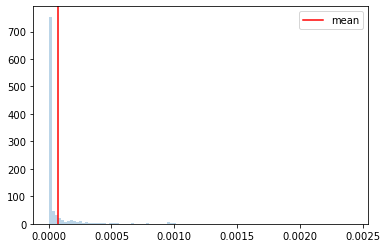

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654368941
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 1.0, 'jump_size_a': 1.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<00:59, 16.71it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:37, 10.18it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▌                                                                                | 7/1000 [00:00<01:43,  9.64it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▋                                                                                | 9/1000 [00:00<01:53,  8.72it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:49,  9.03it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:49,  8.98it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:54,  8.61it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:54,  8.54it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:59,  8.17it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:58,  8.28it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:55,  8.47it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:58,  8.25it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:53,  8.56it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:19,  6.95it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:16,  7.11it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:08,  7.49it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:04,  7.76it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:55,  8.30it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:55,  8.32it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<02:00,  7.92it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<02:07,  7.53it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<02:00,  7.91it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:59,  7.98it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:06<02:02,  7.74it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<01:59,  7.92it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<02:02,  7.74it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<01:58,  7.94it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<02:03,  7.60it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▋                                                                           | 59/1000 [00:07<02:10,  7.19it/s]

Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:36,  6.01it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:27,  6.35it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:13,  7.02it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:06,  7.35it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:02,  7.58it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:00,  7.71it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<01:57,  7.87it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<01:58,  7.78it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:04,  7.43it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:07,  7.24it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:07,  7.20it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:12,  6.91it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:06,  7.21it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:08,  7.09it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:03,  7.37it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:08,  7.06it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:06,  7.14it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:06,  7.16it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:08,  7.03it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:15,  6.67it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:12,  6.77it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:09,  6.93it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:04,  7.21it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:13,  6.69it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:12,  6.74it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:10,  6.81it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:09,  6.84it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:07,  6.95it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:07,  6.92it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:12,  6.64it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:13,  6.56it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:11,  6.69it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:12,  6.58it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:16,  6.38it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:18,  6.31it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:10,  6.64it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:15,  6.38it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:13,  6.48it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:15,  6.36it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:14,  6.40it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:15,  6.33it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:18,  6.18it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:14,  6.34it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:17,  6.20it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:12,  6.43it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:10,  6.53it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<02:08,  6.61it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:08,  6.59it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:16,  6.19it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:22,  5.90it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:19,  6.03it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:21,  5.93it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:23<02:17,  6.06it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:14,  6.19it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:17,  6.03it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:14,  6.17it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:14,  6.14it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:12,  6.21it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:25<02:12,  6.21it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:13,  6.14it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:13,  6.15it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:26<02:18,  5.88it/s]

Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:17,  5.94it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:34,  5.28it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:27<02:25,  5.59it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:18,  5.86it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:27<02:16,  5.91it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:28<02:18,  5.81it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:20,  5.71it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:28<02:20,  5.71it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:16,  5.88it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:12,  6.03it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:29<02:20,  5.69it/s]

Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:22,  5.57it/s]

Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:18,  5.76it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:30<02:16,  5.81it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:30<02:15,  5.83it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:30<02:18,  5.70it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:21,  5.55it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:19,  5.63it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:22,  5.51it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:17,  5.68it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:17,  5.67it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:18,  5.61it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:19,  5.54it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:33<02:21,  5.46it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:17,  5.63it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:34<02:19,  5.54it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:34<02:17,  5.63it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:16,  5.63it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:21,  5.43it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:26,  5.24it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:22,  5.39it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:18,  5.50it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:30,  5.06it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:34,  4.93it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:32,  4.97it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:30,  5.02it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:26,  5.17it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:22,  5.29it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:25,  5.20it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:20,  5.36it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:37<02:11,  5.72it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:11,  5.68it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:08,  5.83it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:38<02:04,  6.00it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:06,  5.88it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:08,  5.76it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:15,  5.47it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:17,  5.36it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:40<02:19,  5.31it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:18,  5.32it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:16,  5.41it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:40<02:16,  5.39it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:41<02:17,  5.34it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:17,  5.34it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:41<02:14,  5.46it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:41<02:19,  5.23it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:41<02:13,  5.47it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:42<02:18,  5.24it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:13,  5.46it/s]

Monte Carlo 273
Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:42<02:11,  5.51it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:12,  5.47it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:08,  5.61it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:43<02:09,  5.58it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:43<02:10,  5.50it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:43<02:14,  5.35it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:12,  5.42it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:44<02:11,  5.43it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:15,  5.29it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:44<02:13,  5.35it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:44<02:14,  5.32it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:16,  5.22it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:13,  5.33it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:45<02:14,  5.26it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:14,  5.25it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:46<02:16,  5.18it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:46<02:17,  5.11it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:46<02:20,  5.00it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:47<02:22,  4.92it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:47<02:20,  4.97it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:47<02:19,  5.01it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:47<02:21,  4.93it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:47<02:21,  4.92it/s]

Monte Carlo 301
Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:48<02:27,  4.71it/s]

Monte Carlo 303
Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:48<02:25,  4.78it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:48<02:21,  4.91it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:49<02:19,  4.97it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:49<02:19,  4.96it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:49<02:23,  4.82it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:50<02:27,  4.67it/s]

Monte Carlo 312
Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:50<02:26,  4.68it/s]

Monte Carlo 314
Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:50<02:27,  4.62it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:51<02:30,  4.55it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:51<02:28,  4.59it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:51<02:29,  4.56it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:51<02:30,  4.53it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:52<02:27,  4.61it/s]

Monte Carlo 321
Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:52<02:25,  4.66it/s]

Monte Carlo 323
Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:52<02:29,  4.51it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:53<02:30,  4.48it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:53<02:26,  4.58it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:53<02:26,  4.59it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:53<02:26,  4.58it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:53<02:26,  4.59it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:54<02:29,  4.47it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:54<02:27,  4.52it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:54<02:28,  4.49it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:54<02:26,  4.55it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:55<02:26,  4.55it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:55<02:36,  4.24it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:55<02:35,  4.26it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:55<02:35,  4.27it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:56<02:30,  4.39it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:56<02:30,  4.39it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:56<02:27,  4.48it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:56<02:31,  4.34it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:56<02:35,  4.24it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:57<02:37,  4.16it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:57<02:32,  4.29it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:57<02:33,  4.25it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:57<02:30,  4.33it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:58<02:28,  4.40it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:58<02:25,  4.47it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:58<02:27,  4.41it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:58<02:33,  4.24it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:30,  4.30it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:59<02:26,  4.42it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:59<02:32,  4.23it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [00:59<02:30,  4.28it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [00:59<02:28,  4.33it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:00<02:29,  4.30it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:00<02:27,  4.36it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:00<02:24,  4.43it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:00<02:21,  4.51it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:22,  4.49it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:01<02:25,  4.38it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:01<02:24,  4.41it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:01<02:23,  4.43it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:50,  3.72it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:02<02:37,  4.02it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:02<02:35,  4.06it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:02<02:32,  4.15it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:30,  4.20it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:03<02:31,  4.17it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:03<02:33,  4.10it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:03<02:29,  4.19it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:03<02:26,  4.29it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:04<02:25,  4.29it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:04<02:23,  4.36it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:04<02:22,  4.39it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:04<02:27,  4.21it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:25,  4.29it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:05<02:23,  4.31it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:05<02:22,  4.35it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:05<02:21,  4.36it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:22,  4.34it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:06<02:21,  4.36it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:06<02:21,  4.36it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:06<02:22,  4.33it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:06<02:26,  4.20it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:07<02:25,  4.22it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:07<02:28,  4.12it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:07<02:28,  4.12it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:07<02:31,  4.03it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:08<02:28,  4.10it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:08<02:26,  4.14it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:08<02:24,  4.21it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:08<02:23,  4.23it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:09<02:22,  4.26it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:09<02:22,  4.24it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:09<02:24,  4.18it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:09<02:23,  4.18it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:22,  4.22it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:10<02:23,  4.17it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:10<02:22,  4.22it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:10<02:22,  4.21it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:24,  4.13it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:11<02:29,  4.00it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:11<02:27,  4.04it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:11<02:27,  4.01it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:26,  4.06it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:12<02:29,  3.95it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:12<02:26,  4.03it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:12<02:24,  4.09it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:27,  3.99it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:13<02:30,  3.91it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:13<02:31,  3.88it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:13<02:30,  3.90it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:32,  3.83it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:14<02:30,  3.89it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:14<02:27,  3.94it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:14<02:26,  3.99it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:27,  3.94it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:15<02:29,  3.88it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:15<02:26,  3.94it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:15<02:23,  4.03it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:22,  4.04it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:16<02:23,  4.00it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:16<02:25,  3.95it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:16<02:30,  3.82it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:26,  3.91it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:17<02:25,  3.93it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:17<02:22,  4.01it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:17<02:23,  3.98it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:30,  3.79it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:18<02:30,  3.78it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:18<02:26,  3.88it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:18<02:25,  3.89it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:22,  3.95it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:19<02:24,  3.91it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:19<02:23,  3.94it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:19<02:17,  4.10it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:20<02:14,  4.16it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:20<02:12,  4.23it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:20<02:11,  4.25it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:20<02:15,  4.12it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:21<02:16,  4.09it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:21<02:18,  4.01it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:21<02:20,  3.95it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:21<02:13,  4.16it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:22<02:11,  4.20it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:22<02:14,  4.09it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:22<02:14,  4.11it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:22<02:10,  4.21it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:23<02:10,  4.20it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:23<02:09,  4.22it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:23<02:14,  4.06it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:23<02:13,  4.09it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:24<02:12,  4.11it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:24<02:13,  4.08it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:24<02:14,  4.03it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:24<02:16,  3.97it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:25<02:16,  3.96it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:25<02:18,  3.90it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:25<02:19,  3.86it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:25<02:17,  3.92it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:26<02:18,  3.88it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:26<02:21,  3.78it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:26<02:16,  3.91it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:26<02:14,  3.97it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:27<02:15,  3.94it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:27<02:13,  3.98it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:27<02:11,  4.02it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:27<02:11,  4.04it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:28<02:11,  4.02it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:28<02:15,  3.89it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:28<02:19,  3.77it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:28<02:22,  3.70it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:29<02:25,  3.61it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:29<02:27,  3.54it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:29<02:24,  3.62it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:30<02:21,  3.70it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:30<02:38,  3.28it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:30<02:36,  3.31it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:31<02:31,  3.43it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:31<02:25,  3.55it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:31<02:23,  3.60it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:31<02:20,  3.68it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:32<02:21,  3.65it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:32<02:31,  3.40it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:32<02:28,  3.47it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:32<02:23,  3.57it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:33<02:22,  3.58it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:33<02:20,  3.63it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:33<02:22,  3.56it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:34<02:27,  3.44it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:34<02:24,  3.50it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:34<02:22,  3.55it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:34<02:20,  3.60it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:35<02:22,  3.54it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:35<02:23,  3.51it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:35<02:20,  3.56it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:36<02:21,  3.53it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:36<02:21,  3.54it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:36<02:23,  3.48it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:36<02:20,  3.56it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:37<02:18,  3.60it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:37<02:21,  3.50it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:37<02:23,  3.45it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:38<02:27,  3.35it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:38<02:28,  3.31it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:38<02:27,  3.33it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:38<02:25,  3.38it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:39<02:25,  3.37it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:39<02:24,  3.37it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:39<02:25,  3.34it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:40<02:24,  3.36it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:40<02:20,  3.47it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:40<02:16,  3.54it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:41<02:23,  3.38it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:41<02:25,  3.33it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:41<02:20,  3.43it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:41<02:23,  3.35it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:42<02:24,  3.32it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:42<02:26,  3.28it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:42<02:21,  3.38it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:43<02:20,  3.41it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:43<02:18,  3.43it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:43<02:19,  3.40it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:44<02:19,  3.40it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:44<02:21,  3.35it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:44<02:18,  3.40it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:44<02:15,  3.48it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:45<02:15,  3.46it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:45<02:17,  3.41it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:45<02:15,  3.46it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:46<02:19,  3.34it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:46<02:18,  3.36it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:46<02:17,  3.38it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:46<02:16,  3.39it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:47<02:15,  3.41it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:47<02:18,  3.32it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:47<02:18,  3.34it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:48<02:20,  3.27it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:48<02:19,  3.30it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:48<02:15,  3.37it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:49<02:15,  3.38it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:49<02:17,  3.32it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:49<02:16,  3.33it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:49<02:13,  3.40it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:50<02:15,  3.33it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:50<02:15,  3.33it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:50<02:15,  3.34it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:51<02:18,  3.26it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:51<02:20,  3.21it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:51<02:22,  3.14it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:52<02:22,  3.13it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:52<02:22,  3.13it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:52<02:23,  3.10it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:53<02:22,  3.11it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:53<02:18,  3.20it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:53<02:16,  3.23it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:54<02:21,  3.12it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:54<02:18,  3.17it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:54<02:22,  3.09it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:55<02:20,  3.12it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:55<02:17,  3.17it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:55<02:18,  3.14it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:55<02:18,  3.14it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:56<02:20,  3.09it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:56<02:21,  3.07it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:56<02:17,  3.14it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:57<02:19,  3.08it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:57<02:18,  3.11it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:57<02:19,  3.09it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:58<02:17,  3.12it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:58<02:23,  2.98it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:58<02:18,  3.07it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:59<02:27,  2.89it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:59<02:23,  2.95it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:59<02:19,  3.02it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:00<02:14,  3.13it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:00<02:17,  3.06it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:00<02:16,  3.08it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:01<02:13,  3.13it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:01<02:13,  3.14it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:01<02:12,  3.16it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:02<02:12,  3.15it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:02<02:12,  3.14it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:02<02:12,  3.12it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:03<02:12,  3.11it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:03<02:13,  3.08it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:03<02:12,  3.09it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:04<02:16,  3.01it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:04<02:16,  2.99it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:04<02:14,  3.04it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:05<02:13,  3.04it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:05<02:12,  3.07it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:05<02:11,  3.07it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:06<02:10,  3.09it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:06<02:09,  3.10it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:06<02:07,  3.14it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:07<02:07,  3.14it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:07<02:07,  3.15it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:07<02:19,  2.87it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:08<02:13,  2.99it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:08<02:12,  3.01it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:08<02:11,  3.01it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:09<02:09,  3.05it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:09<02:09,  3.04it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:09<02:09,  3.03it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:10<02:10,  2.99it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:10<02:10,  3.01it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:10<02:08,  3.03it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:11<02:08,  3.03it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:11<02:06,  3.06it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:11<02:05,  3.08it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:12<02:07,  3.02it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:12<02:05,  3.06it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:12<02:09,  2.95it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:13<02:06,  3.03it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:13<02:05,  3.05it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:13<02:07,  2.99it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:14<02:09,  2.94it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:14<02:06,  3.00it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:14<02:04,  3.04it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:14<02:04,  3.03it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:15<02:06,  2.98it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:15<02:05,  2.99it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:15<02:03,  3.03it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:16<02:03,  3.02it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:16<02:04,  3.00it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:16<02:01,  3.04it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:17<01:59,  3.09it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:17<02:02,  3.00it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:18<02:05,  2.94it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:18<02:09,  2.84it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:18<02:08,  2.85it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:19<02:05,  2.90it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:19<02:06,  2.88it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:19<02:05,  2.89it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:20<02:02,  2.95it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:20<02:04,  2.91it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:20<02:01,  2.97it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:21<02:01,  2.96it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:21<02:03,  2.91it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:21<02:01,  2.93it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:22<02:01,  2.93it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:22<02:03,  2.88it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:22<02:02,  2.88it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:23<02:00,  2.92it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:23<02:01,  2.91it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:23<01:58,  2.97it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:24<01:57,  2.97it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:24<01:57,  2.96it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:24<01:56,  2.98it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:25<01:57,  2.96it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:25<01:58,  2.91it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:25<01:57,  2.93it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:26<01:57,  2.93it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:26<02:14,  2.55it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:27<02:11,  2.59it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:27<02:11,  2.59it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:27<02:10,  2.60it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:28<02:07,  2.65it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:28<02:06,  2.68it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:28<02:04,  2.70it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:29<02:04,  2.69it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:29<02:04,  2.69it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:30<02:06,  2.63it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:30<02:05,  2.65it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:30<02:03,  2.68it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:31<02:03,  2.68it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:31<02:03,  2.67it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:31<02:04,  2.65it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:32<02:06,  2.60it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:32<02:06,  2.58it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:33<02:03,  2.64it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:33<02:05,  2.59it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:33<02:01,  2.66it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:34<02:01,  2.67it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:34<01:59,  2.69it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:35<02:01,  2.64it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:35<02:01,  2.64it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:35<02:03,  2.59it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:36<02:02,  2.59it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:36<02:06,  2.50it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:36<02:03,  2.55it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:37<02:03,  2.55it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:37<02:03,  2.55it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:38<02:02,  2.56it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:38<02:00,  2.58it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:38<01:58,  2.62it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:39<02:02,  2.52it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:39<02:05,  2.47it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:40<02:02,  2.51it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:40<02:01,  2.53it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:40<01:59,  2.56it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:41<01:59,  2.56it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:41<01:58,  2.57it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:42<01:59,  2.53it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:42<01:56,  2.59it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:42<01:58,  2.54it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:43<01:55,  2.60it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:43<01:53,  2.63it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:43<01:49,  2.71it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:44<01:49,  2.70it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:44<01:51,  2.66it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:45<01:48,  2.71it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:45<01:49,  2.68it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:45<01:48,  2.71it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:46<01:46,  2.75it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:46<01:43,  2.80it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:46<01:43,  2.80it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:47<01:42,  2.82it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:47<01:44,  2.76it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:47<01:42,  2.81it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:48<01:43,  2.77it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:48<01:41,  2.81it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:48<01:40,  2.84it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:49<01:40,  2.82it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:49<01:51,  2.53it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:50<01:46,  2.64it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:50<01:43,  2.72it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:50<01:42,  2.73it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:51<01:40,  2.76it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:51<01:39,  2.79it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:51<01:38,  2.82it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:52<01:40,  2.74it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:52<01:40,  2.73it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:53<01:38,  2.78it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:53<01:37,  2.78it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:53<01:40,  2.71it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:54<01:40,  2.70it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:54<01:38,  2.74it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:54<01:36,  2.78it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:55<01:36,  2.76it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:55<01:36,  2.75it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:56<01:39,  2.65it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:56<01:40,  2.63it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:56<01:39,  2.65it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:57<01:36,  2.70it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:57<01:37,  2.68it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:57<01:36,  2.70it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:58<01:34,  2.73it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:58<01:34,  2.74it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:58<01:35,  2.70it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:59<01:33,  2.74it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:59<01:33,  2.73it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:00<01:35,  2.67it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:00<01:34,  2.67it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:00<01:33,  2.71it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:01<01:33,  2.68it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:01<01:32,  2.71it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:01<01:32,  2.70it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:02<01:31,  2.72it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:02<01:30,  2.74it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:03<01:30,  2.73it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:03<01:29,  2.74it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:03<01:30,  2.71it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:04<01:29,  2.71it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:04<01:29,  2.70it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:04<01:31,  2.63it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:05<01:28,  2.72it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:05<01:28,  2.70it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:05<01:26,  2.75it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:06<01:24,  2.81it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:06<01:23,  2.84it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:07<01:23,  2.82it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:07<01:22,  2.83it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:07<01:21,  2.86it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:08<01:22,  2.80it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:08<01:21,  2.84it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:08<01:20,  2.86it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:09<01:18,  2.90it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:09<01:18,  2.90it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:09<01:19,  2.86it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:10<01:18,  2.87it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:10<01:19,  2.83it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:10<01:20,  2.80it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:11<01:18,  2.84it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:11<01:20,  2.77it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:11<01:18,  2.83it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:12<01:18,  2.81it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:12<01:18,  2.81it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:12<01:16,  2.83it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:13<01:18,  2.78it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:13<01:19,  2.72it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:14<01:18,  2.74it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:14<01:18,  2.74it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:14<01:17,  2.74it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:15<01:18,  2.72it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:15<01:16,  2.75it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:15<01:15,  2.78it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:16<01:16,  2.72it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:16<01:16,  2.73it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:17<01:15,  2.75it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:17<01:15,  2.74it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:17<01:14,  2.75it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:18<01:13,  2.76it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:18<01:13,  2.77it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:18<01:11,  2.81it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:19<01:11,  2.81it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:19<01:11,  2.80it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:19<01:11,  2.78it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:20<01:12,  2.72it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:20<01:13,  2.68it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:21<01:12,  2.70it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:21<01:12,  2.69it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:21<01:12,  2.66it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:22<01:17,  2.49it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:22<01:14,  2.57it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:22<01:12,  2.63it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:23<01:11,  2.65it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:23<01:10,  2.69it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:24<01:09,  2.69it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:24<01:11,  2.63it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:24<01:10,  2.62it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:25<01:09,  2.67it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:25<01:09,  2.65it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:25<01:09,  2.64it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:26<01:14,  2.45it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:26<01:13,  2.48it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:27<01:12,  2.48it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:27<01:11,  2.49it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:28<01:12,  2.46it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:28<01:11,  2.48it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:28<01:10,  2.51it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:29<01:09,  2.51it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:29<01:10,  2.46it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:30<01:09,  2.49it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:30<01:10,  2.43it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:30<01:08,  2.49it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:31<01:08,  2.50it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:31<01:07,  2.50it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:32<01:06,  2.51it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:32<01:06,  2.50it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:32<01:07,  2.47it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:33<01:06,  2.47it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:33<01:06,  2.45it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:34<01:06,  2.46it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:34<01:06,  2.45it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:34<01:05,  2.47it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:35<01:05,  2.46it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:35<01:04,  2.48it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:36<01:03,  2.51it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:36<01:02,  2.53it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:36<01:01,  2.52it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:37<01:02,  2.48it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:37<01:02,  2.46it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:38<01:02,  2.45it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:38<01:02,  2.43it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:39<01:02,  2.41it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:39<01:01,  2.43it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:39<01:00,  2.45it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:40<01:01,  2.41it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:40<00:59,  2.46it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:41<00:59,  2.47it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:41<00:58,  2.46it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:41<00:59,  2.40it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:42<00:58,  2.45it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:42<00:59,  2.40it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:43<00:57,  2.43it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:43<00:57,  2.43it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:43<00:56,  2.44it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:44<00:56,  2.46it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:44<00:56,  2.45it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:45<00:56,  2.42it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:45<00:56,  2.39it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:46<00:57,  2.34it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:46<00:56,  2.36it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:46<00:54,  2.41it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:47<00:54,  2.42it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:47<00:53,  2.42it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:48<00:52,  2.45it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:48<00:52,  2.42it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:48<00:53,  2.38it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:49<00:53,  2.37it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:49<00:54,  2.31it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:50<00:54,  2.28it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:50<00:53,  2.30it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:51<00:53,  2.29it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:51<00:51,  2.33it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:51<00:50,  2.37it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:52<00:51,  2.33it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:52<00:50,  2.35it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:53<00:49,  2.37it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:53<00:49,  2.33it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:54<00:48,  2.37it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:54<00:47,  2.38it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:54<00:47,  2.36it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:55<00:46,  2.40it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:55<00:46,  2.36it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:56<00:46,  2.38it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:56<00:46,  2.35it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:57<00:46,  2.33it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:57<00:46,  2.31it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:57<00:45,  2.31it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:58<00:45,  2.33it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:58<00:44,  2.35it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:59<00:44,  2.31it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:59<00:44,  2.31it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:00<00:43,  2.30it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:00<00:43,  2.29it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:00<00:44,  2.24it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:01<00:44,  2.18it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:01<00:43,  2.24it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:02<00:42,  2.27it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:02<00:41,  2.30it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:03<00:44,  2.13it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:03<00:42,  2.20it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:04<00:41,  2.23it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:04<00:39,  2.28it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:04<00:39,  2.28it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:05<00:39,  2.28it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:05<00:38,  2.29it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:06<00:37,  2.31it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:06<00:36,  2.33it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:07<00:36,  2.34it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:07<00:36,  2.30it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:08<00:35,  2.32it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:08<00:36,  2.27it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:08<00:36,  2.20it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:09<00:36,  2.21it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:09<00:36,  2.19it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:10<00:35,  2.19it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:10<00:34,  2.20it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:11<00:34,  2.23it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:11<00:33,  2.26it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:12<00:32,  2.27it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:12<00:32,  2.27it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:12<00:31,  2.27it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:13<00:31,  2.26it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:13<00:30,  2.28it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:14<00:30,  2.26it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:14<00:29,  2.27it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:15<00:29,  2.27it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:15<00:29,  2.27it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:16<00:28,  2.26it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:16<00:28,  2.28it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:16<00:27,  2.28it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:17<00:26,  2.34it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:17<00:25,  2.38it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:18<00:24,  2.44it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:18<00:24,  2.45it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:18<00:23,  2.47it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:19<00:22,  2.49it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:19<00:22,  2.46it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:20<00:23,  2.39it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:20<00:22,  2.41it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:20<00:22,  2.40it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:21<00:21,  2.39it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:21<00:21,  2.37it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:22<00:21,  2.37it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:22<00:20,  2.37it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:23<00:20,  2.37it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:23<00:20,  2.33it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:24<00:19,  2.31it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:24<00:19,  2.28it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:24<00:19,  2.24it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:25<00:19,  2.26it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:25<00:18,  2.28it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:26<00:18,  2.27it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:26<00:17,  2.31it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:27<00:16,  2.30it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:27<00:16,  2.28it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:27<00:15,  2.32it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:28<00:15,  2.37it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:28<00:14,  2.40it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:29<00:14,  2.37it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:29<00:13,  2.38it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:30<00:13,  2.30it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:30<00:13,  2.28it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:30<00:13,  2.27it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:31<00:12,  2.27it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:31<00:12,  2.27it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:32<00:11,  2.29it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:32<00:11,  2.22it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:33<00:11,  2.22it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:33<00:11,  2.18it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:34<00:10,  2.18it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:34<00:10,  2.17it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:35<00:09,  2.20it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:35<00:09,  2.22it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:35<00:08,  2.23it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:36<00:08,  2.23it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:36<00:07,  2.21it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:37<00:07,  2.22it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:37<00:06,  2.15it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:38<00:06,  2.16it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:38<00:05,  2.18it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:39<00:05,  2.19it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:39<00:05,  2.18it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:40<00:04,  2.17it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:40<00:04,  2.15it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:41<00:03,  2.15it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:41<00:03,  2.17it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:41<00:02,  2.18it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:42<00:02,  2.18it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:42<00:01,  2.18it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:43<00:01,  2.17it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:43<00:00,  2.17it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:44<00:00,  2.14it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:44<00:00,  3.51it/s]


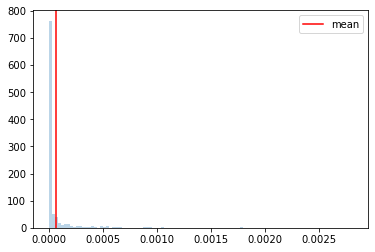

  0%|▏                                                                                | 3/1000 [00:00<01:02, 15.92it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654369227
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 1.0, 'jump_size_a': 10.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:39, 10.02it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:49,  9.10it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:52,  8.83it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:52,  8.80it/s]

Monte Carlo 11
Monte Carlo 12


  2%|█▏                                                                              | 15/1000 [00:01<01:46,  9.24it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:46,  9.20it/s]

Monte Carlo 15
Monte Carlo 16
Monte Carlo 17

  2%|█▍                                                                              | 18/1000 [00:01<01:45,  9.32it/s]


Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:46,  9.18it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 23/1000 [00:02<01:47,  9.12it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:49,  8.89it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:50,  8.79it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:47,  9.03it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<01:55,  8.38it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:02,  7.92it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<01:57,  8.21it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<01:58,  8.12it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:55,  8.32it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:56,  8.22it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<01:55,  8.33it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<01:48,  8.77it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<01:47,  8.91it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:54,  8.28it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:05<01:51,  8.51it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:05<01:50,  8.61it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<01:56,  8.13it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<01:57,  8.05it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:06<02:01,  7.76it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:06<01:54,  8.18it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<01:55,  8.11it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:07<01:56,  8.03it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:07<01:54,  8.18it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:07<01:59,  7.78it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:08<02:02,  7.62it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:08<02:04,  7.43it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:08<01:59,  7.74it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<02:01,  7.60it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:09<02:12,  6.95it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:09<02:04,  7.38it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:09<02:00,  7.63it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:10<02:06,  7.22it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:10<01:59,  7.63it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:10<02:04,  7.30it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:10<02:10,  6.99it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:11<02:01,  7.48it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:11<02:04,  7.31it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:11<01:59,  7.56it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:12<01:58,  7.64it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:12<02:06,  7.09it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:12<02:07,  7.04it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:12<02:10,  6.89it/s]

Monte Carlo 103
Monte Carlo 104


 10%|████████▎                                                                      | 105/1000 [00:13<02:13,  6.69it/s]

Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:36,  5.69it/s]

Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:13<02:34,  5.77it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▌                                                                      | 109/1000 [00:13<02:27,  6.05it/s]

Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:40,  5.55it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:21,  6.28it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:12,  6.67it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:06,  6.97it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:05,  7.05it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:11,  6.68it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<02:09,  6.77it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:05,  6.98it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:23,  6.08it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:16,  6.38it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:09,  6.70it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:06,  6.87it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<02:10,  6.64it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:08,  6.73it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:12,  6.50it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:09,  6.62it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:18<02:08,  6.66it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:08,  6.66it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:07,  6.68it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:19<02:00,  7.06it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:02,  6.92it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<01:55,  7.32it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:20<01:54,  7.40it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:20<02:00,  7.01it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<01:57,  7.13it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:21<02:00,  6.98it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:21<02:01,  6.90it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<01:58,  7.07it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:03,  6.73it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:22<02:01,  6.87it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:22<02:06,  6.55it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:23<02:05,  6.59it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:23<02:04,  6.63it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:23<02:02,  6.74it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:24<02:06,  6.51it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:24<02:04,  6.56it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:24<02:06,  6.44it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:25<02:06,  6.44it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:25<02:04,  6.51it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:25<02:02,  6.60it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:26<02:01,  6.68it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:26<01:59,  6.77it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:26<02:04,  6.48it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:26<02:02,  6.58it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:27<02:02,  6.52it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:27<02:02,  6.53it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:27<02:03,  6.43it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:28<02:04,  6.37it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:28<02:03,  6.43it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:28<02:02,  6.46it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:29<02:05,  6.30it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:29<02:07,  6.16it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:29<02:07,  6.17it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:30<02:04,  6.30it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:30<02:01,  6.44it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:30<02:00,  6.48it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:31<01:59,  6.51it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:31<02:00,  6.44it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:31<02:01,  6.36it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:31<02:07,  6.05it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:32<02:09,  5.95it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:32<02:10,  5.89it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:32<02:09,  5.90it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:33<02:04,  6.13it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:33<02:05,  6.07it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:33<02:28,  5.11it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:34<02:14,  5.62it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:34<02:11,  5.74it/s]

Monte Carlo 243
Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:34<02:12,  5.67it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 247/1000 [00:35<02:08,  5.87it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:35<02:08,  5.86it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:35<02:07,  5.87it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:36<02:09,  5.77it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:36<02:06,  5.90it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:36<02:11,  5.65it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:37<02:09,  5.73it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:37<02:12,  5.58it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▌                                                          | 261/1000 [00:37<02:17,  5.37it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:38<02:16,  5.38it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:38<02:21,  5.19it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:38<02:15,  5.40it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:39<02:16,  5.34it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:39<02:19,  5.22it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:39<02:15,  5.37it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:39<02:15,  5.36it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:39<02:13,  5.43it/s]

Monte Carlo 272
Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:40<02:16,  5.30it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:40<02:14,  5.36it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:40<02:15,  5.33it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:40<02:16,  5.27it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:41<02:15,  5.32it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:41<02:13,  5.39it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:41<02:16,  5.26it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:41<02:13,  5.37it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:42<02:13,  5.36it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:42<02:17,  5.20it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:42<02:15,  5.26it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:42<02:16,  5.21it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:42<02:18,  5.12it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:43<02:19,  5.10it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:43<02:20,  5.06it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:43<02:22,  4.96it/s]

Monte Carlo 291
Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:43<02:24,  4.90it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:44<02:24,  4.88it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:44<02:22,  4.94it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:44<02:18,  5.08it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:44<02:17,  5.10it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:44<02:19,  5.03it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:45<02:16,  5.13it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:45<02:18,  5.06it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:45<02:15,  5.16it/s]

Monte Carlo 301
Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:45<02:16,  5.11it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:46<02:17,  5.05it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:46<02:14,  5.15it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:46<02:17,  5.03it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:46<02:20,  4.92it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:47<02:24,  4.78it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:47<02:19,  4.93it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:47<02:17,  5.01it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:47<02:16,  5.03it/s]

Monte Carlo 312
Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:47<02:17,  5.00it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:48<02:16,  5.02it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:48<02:18,  4.94it/s]

Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:48<02:14,  5.07it/s]

Monte Carlo 318
Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:49<02:16,  4.99it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:49<02:13,  5.09it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:49<02:15,  5.01it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:50<02:19,  4.85it/s]

Monte Carlo 324
Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:50<02:17,  4.89it/s]

Monte Carlo 326
Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:50<02:16,  4.91it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:51<02:14,  4.97it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:51<02:12,  5.06it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:51<02:10,  5.10it/s]

Monte Carlo 331
Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:51<02:11,  5.06it/s]

Monte Carlo 333
Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:52<02:11,  5.03it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▋                                                    | 338/1000 [00:52<02:18,  4.77it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:53<02:17,  4.80it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:53<02:17,  4.79it/s]

Monte Carlo 339


 34%|██████████████████████████▉                                                    | 341/1000 [00:53<02:14,  4.89it/s]

Monte Carlo 340
Monte Carlo 341


 34%|███████████████████████████                                                    | 343/1000 [00:53<02:13,  4.91it/s]

Monte Carlo 342
Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:54<02:16,  4.81it/s]

Monte Carlo 344


 35%|███████████████████████████▎                                                   | 346/1000 [00:54<02:13,  4.89it/s]

Monte Carlo 345
Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:54<02:17,  4.76it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:54<02:16,  4.77it/s]

Monte Carlo 348


 35%|███████████████████████████▋                                                   | 350/1000 [00:55<02:14,  4.83it/s]

Monte Carlo 349
Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:55<02:15,  4.78it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:55<02:16,  4.74it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:55<02:24,  4.48it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:56<02:22,  4.55it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 356/1000 [00:56<02:31,  4.25it/s]

Monte Carlo 355


 36%|████████████████████████████▏                                                  | 357/1000 [00:56<02:26,  4.38it/s]

Monte Carlo 356
Monte Carlo 357


 36%|████████████████████████████▎                                                  | 359/1000 [00:57<02:19,  4.59it/s]

Monte Carlo 358
Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [00:57<02:22,  4.50it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [00:57<02:20,  4.55it/s]

Monte Carlo 361


 36%|████████████████████████████▋                                                  | 363/1000 [00:58<02:18,  4.58it/s]

Monte Carlo 362
Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [00:58<02:20,  4.54it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [00:58<02:22,  4.46it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [00:58<02:20,  4.52it/s]

Monte Carlo 366


 37%|█████████████████████████████                                                  | 368/1000 [00:59<02:16,  4.63it/s]

Monte Carlo 367
Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [00:59<02:19,  4.52it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [00:59<02:18,  4.56it/s]

Monte Carlo 370


 37%|█████████████████████████████▍                                                 | 372/1000 [01:00<02:18,  4.54it/s]

Monte Carlo 371
Monte Carlo 372


 37%|█████████████████████████████▌                                                 | 374/1000 [01:00<02:16,  4.60it/s]

Monte Carlo 373
Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:00<02:16,  4.57it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:01<02:15,  4.61it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:01<02:16,  4.56it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:01<02:16,  4.57it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:01<02:13,  4.65it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 381/1000 [01:02<02:11,  4.72it/s]

Monte Carlo 380
Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:02<02:10,  4.73it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 384/1000 [01:02<02:13,  4.62it/s]

Monte Carlo 383
Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:03<02:13,  4.62it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:03<02:15,  4.54it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:03<02:13,  4.58it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:03<02:13,  4.58it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:03<02:13,  4.59it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:04<02:16,  4.46it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:04<02:15,  4.49it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:04<02:12,  4.58it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:04<02:12,  4.57it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:05<02:13,  4.55it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:05<02:15,  4.46it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:05<02:14,  4.49it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:05<02:23,  4.20it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:05<02:20,  4.29it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:06<02:20,  4.26it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:06<02:19,  4.29it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:06<02:19,  4.28it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:06<02:19,  4.29it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:07<02:20,  4.24it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:07<02:16,  4.36it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:07<02:15,  4.38it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:07<02:13,  4.44it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:08<02:11,  4.52it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:08<02:14,  4.40it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:08<02:12,  4.45it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:08<02:14,  4.40it/s]

Monte Carlo 410


 41%|████████████████████████████████▌                                              | 412/1000 [01:09<02:11,  4.48it/s]

Monte Carlo 411
Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:09<02:12,  4.42it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:09<02:12,  4.42it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:09<02:14,  4.35it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:10<02:12,  4.41it/s]

Monte Carlo 416


 42%|█████████████████████████████████                                              | 418/1000 [01:10<02:08,  4.52it/s]

Monte Carlo 417
Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:10<02:08,  4.51it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:10<02:06,  4.57it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:11<02:09,  4.49it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:11<02:09,  4.47it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:11<02:08,  4.49it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:11<02:09,  4.46it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:12<02:08,  4.47it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:12<02:10,  4.41it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:12<02:08,  4.47it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:12<02:07,  4.48it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:12<02:07,  4.47it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:13<02:09,  4.40it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:13<02:09,  4.38it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:13<02:08,  4.41it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:13<02:11,  4.32it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:14<02:12,  4.28it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:14<02:16,  4.15it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:14<02:19,  4.04it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:14<02:25,  3.87it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:15<02:22,  3.95it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:15<02:21,  3.97it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:15<02:21,  3.97it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:15<02:21,  3.96it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:16<02:20,  3.98it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:16<02:17,  4.04it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:16<02:16,  4.06it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:16<02:16,  4.06it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:17<02:15,  4.09it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:17<02:13,  4.13it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:17<02:17,  4.02it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:17<02:13,  4.12it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:18<02:15,  4.05it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:18<02:12,  4.14it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:18<02:12,  4.13it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:18<02:11,  4.17it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:19<02:10,  4.18it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:19<02:10,  4.18it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:19<02:12,  4.11it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:19<02:14,  4.04it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:20<02:11,  4.11it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:20<02:11,  4.11it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:20<02:12,  4.06it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:20<02:13,  4.04it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:21<02:10,  4.13it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:21<02:08,  4.17it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:21<02:14,  3.98it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:21<02:16,  3.92it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:22<02:14,  3.96it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:22<02:12,  4.03it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:22<02:09,  4.11it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:22<02:14,  3.95it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:23<02:13,  3.96it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:23<02:11,  4.01it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:23<02:11,  4.01it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:23<02:12,  3.98it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:24<02:13,  3.93it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:24<02:16,  3.85it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:24<02:15,  3.86it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:24<02:14,  3.89it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:25<02:11,  3.98it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:25<02:08,  4.05it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:25<02:09,  4.03it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:25<02:10,  3.98it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:26<02:12,  3.91it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:26<02:10,  3.96it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:26<02:10,  3.95it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:26<02:13,  3.85it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:27<02:10,  3.93it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:27<02:09,  3.96it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:27<02:07,  4.00it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:27<02:10,  3.90it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:28<02:11,  3.89it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:28<02:09,  3.92it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:28<02:10,  3.88it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:28<02:10,  3.90it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:29<02:07,  3.98it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:29<02:24,  3.50it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:29<02:15,  3.71it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:30<02:17,  3.66it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:30<02:15,  3.70it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:30<02:12,  3.77it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:30<02:08,  3.89it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:31<02:07,  3.92it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:31<02:12,  3.77it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:31<02:10,  3.80it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:31<02:08,  3.86it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:32<02:14,  3.67it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:32<02:12,  3.72it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:32<02:11,  3.75it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:32<02:09,  3.79it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:33<02:09,  3.80it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:33<02:07,  3.83it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:33<02:20,  3.49it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:34<02:18,  3.53it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:34<02:16,  3.58it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:34<02:16,  3.57it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:34<02:11,  3.69it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:35<02:10,  3.70it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:35<02:09,  3.73it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:35<02:08,  3.75it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:35<02:07,  3.76it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:36<02:11,  3.65it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:36<02:09,  3.69it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:36<02:08,  3.73it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:36<02:05,  3.80it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:37<02:05,  3.80it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:37<02:08,  3.68it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:37<02:07,  3.71it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:38<02:05,  3.76it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:38<02:09,  3.65it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:38<02:07,  3.70it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:38<02:06,  3.72it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:39<02:07,  3.69it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:39<02:05,  3.74it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:39<02:04,  3.75it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:39<02:04,  3.75it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:40<02:04,  3.73it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:40<02:09,  3.58it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:40<02:12,  3.50it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:41<02:08,  3.59it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:41<02:10,  3.53it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:41<02:06,  3.63it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:41<02:05,  3.65it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:42<02:04,  3.69it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:42<02:03,  3.71it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:42<02:05,  3.62it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:43<02:07,  3.58it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:43<02:07,  3.57it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:43<02:05,  3.62it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:43<02:04,  3.63it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:44<02:04,  3.62it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:44<02:03,  3.64it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:44<02:01,  3.70it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:44<02:00,  3.72it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:45<02:01,  3.67it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:45<01:59,  3.73it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:45<01:58,  3.75it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:45<02:00,  3.69it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:46<02:00,  3.69it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:46<02:00,  3.67it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:46<01:59,  3.69it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:47<02:00,  3.66it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:47<02:00,  3.63it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:47<02:08,  3.41it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:47<02:03,  3.54it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:48<02:03,  3.52it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:48<02:02,  3.54it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:48<02:03,  3.52it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:49<02:05,  3.45it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:49<02:03,  3.51it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:49<02:00,  3.57it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:49<02:02,  3.51it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:50<02:01,  3.52it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:50<02:01,  3.51it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:50<02:01,  3.53it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:51<02:02,  3.49it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:51<02:00,  3.54it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:51<01:57,  3.59it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:51<01:55,  3.66it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:52<01:54,  3.68it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:52<01:54,  3.69it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:52<01:58,  3.56it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:53<01:55,  3.61it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:53<01:54,  3.65it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:53<01:53,  3.67it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:53<01:50,  3.75it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:54<01:51,  3.73it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [01:54<01:52,  3.67it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [01:54<01:52,  3.67it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [01:54<01:50,  3.72it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [01:55<01:53,  3.63it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [01:55<01:49,  3.74it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [01:55<01:50,  3.72it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [01:56<01:54,  3.56it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [01:56<01:52,  3.61it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [01:56<01:53,  3.58it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [01:56<01:51,  3.64it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [01:57<01:50,  3.66it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [01:57<01:50,  3.66it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [01:57<01:51,  3.60it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [01:57<01:50,  3.63it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [01:58<01:49,  3.65it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [01:58<01:47,  3.72it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [01:58<01:47,  3.70it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [01:58<01:45,  3.76it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [01:59<01:45,  3.75it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [01:59<01:46,  3.70it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [01:59<01:45,  3.72it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:00<01:45,  3.73it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:00<01:44,  3.74it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:00<01:42,  3.81it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:00<01:45,  3.71it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:01<01:46,  3.64it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:01<01:47,  3.63it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:01<01:45,  3.66it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:01<01:47,  3.59it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:02<01:48,  3.56it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:02<01:48,  3.55it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:02<01:45,  3.65it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:03<01:45,  3.62it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:03<01:46,  3.58it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:03<01:45,  3.59it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:03<01:44,  3.61it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:04<01:45,  3.58it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:04<01:44,  3.61it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:04<01:43,  3.63it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:05<01:41,  3.69it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:05<01:44,  3.57it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:05<01:43,  3.61it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:05<01:44,  3.57it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:06<01:45,  3.52it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:06<01:47,  3.44it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:06<01:53,  3.24it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:07<02:05,  2.94it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:07<01:59,  3.06it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:07<01:57,  3.12it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:08<01:54,  3.20it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:08<01:57,  3.10it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:08<01:58,  3.06it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:09<01:58,  3.06it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:09<01:57,  3.07it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:09<01:54,  3.14it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:10<01:51,  3.21it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:10<01:51,  3.22it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:10<01:52,  3.18it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:11<01:52,  3.18it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:11<01:51,  3.18it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:11<01:51,  3.19it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:11<01:50,  3.20it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:12<01:52,  3.14it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:12<01:52,  3.13it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:12<01:51,  3.15it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:13<01:50,  3.17it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:13<01:50,  3.14it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:13<01:54,  3.02it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:14<01:53,  3.04it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:14<01:52,  3.05it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:14<01:52,  3.07it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:15<01:56,  2.95it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:15<01:52,  3.03it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:15<01:53,  3.01it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:16<01:52,  3.03it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:16<01:52,  3.02it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:16<01:52,  3.00it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:17<01:51,  3.03it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:17<01:50,  3.04it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:17<01:50,  3.02it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:18<01:54,  2.92it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:18<01:52,  2.96it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:18<01:51,  2.98it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:19<01:51,  2.97it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:19<01:53,  2.92it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:19<01:50,  2.98it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:20<01:47,  3.05it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:20<01:50,  2.97it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:20<01:46,  3.05it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:21<01:47,  3.02it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:21<01:46,  3.04it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:21<01:46,  3.04it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:22<01:47,  2.99it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:22<01:45,  3.04it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:22<01:47,  2.97it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:23<01:44,  3.04it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:23<01:47,  2.95it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:23<01:46,  2.98it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:24<01:45,  3.01it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:24<01:44,  3.02it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:24<01:42,  3.06it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:25<01:41,  3.07it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:25<01:39,  3.13it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:25<01:39,  3.13it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:26<01:40,  3.07it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:26<01:39,  3.11it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:26<01:42,  3.01it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:27<01:41,  3.02it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:27<01:40,  3.05it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:27<01:40,  3.02it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:28<01:43,  2.92it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:28<01:42,  2.97it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:28<01:42,  2.94it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:29<01:42,  2.93it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:29<01:45,  2.84it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:29<01:42,  2.92it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:30<01:41,  2.94it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:30<01:40,  2.95it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:30<01:39,  2.97it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:31<01:38,  2.99it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:31<01:39,  2.96it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:31<01:38,  2.99it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:32<01:37,  3.00it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:32<01:39,  2.92it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:32<01:41,  2.86it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:33<01:41,  2.84it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:33<01:46,  2.71it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:34<01:48,  2.65it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:34<01:44,  2.73it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:34<01:44,  2.73it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:35<01:43,  2.74it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:35<01:40,  2.81it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:35<01:37,  2.90it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:36<01:39,  2.81it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:36<01:37,  2.87it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:36<01:37,  2.85it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:37<01:36,  2.87it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:37<01:36,  2.86it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:38<01:39,  2.78it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:38<01:36,  2.85it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:38<01:37,  2.82it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:39<01:34,  2.89it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:39<01:33,  2.92it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:39<01:33,  2.89it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:40<01:31,  2.94it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:40<01:32,  2.90it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:40<01:32,  2.90it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:41<01:40,  2.66it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:41<01:40,  2.66it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:41<01:39,  2.66it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:42<01:38,  2.69it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:42<01:37,  2.71it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:43<01:34,  2.78it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:43<01:34,  2.76it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:43<01:35,  2.72it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:44<01:35,  2.72it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:44<01:37,  2.65it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:44<01:36,  2.67it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:45<01:37,  2.62it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:45<01:38,  2.58it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:46<01:36,  2.62it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:46<01:36,  2.61it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:46<01:37,  2.59it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:47<01:37,  2.58it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:47<01:35,  2.61it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:47<01:33,  2.67it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:48<01:33,  2.64it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:48<01:32,  2.66it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:49<01:35,  2.58it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:49<01:35,  2.56it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:49<01:33,  2.62it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:50<01:31,  2.66it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:50<01:28,  2.72it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:51<01:34,  2.56it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:51<01:32,  2.59it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:51<01:32,  2.60it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:52<01:28,  2.69it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:52<01:27,  2.71it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:52<01:24,  2.79it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:53<01:25,  2.74it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:53<01:25,  2.72it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [02:54<01:30,  2.58it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [02:54<01:27,  2.65it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [02:54<01:24,  2.73it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [02:55<01:25,  2.69it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [02:55<01:22,  2.77it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [02:55<01:23,  2.74it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [02:56<01:22,  2.74it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [02:56<01:20,  2.82it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [02:56<01:17,  2.90it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [02:57<01:20,  2.78it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [02:57<01:22,  2.72it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [02:57<01:21,  2.71it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [02:58<01:18,  2.81it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [02:58<01:17,  2.84it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [02:58<01:15,  2.88it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [02:59<01:14,  2.91it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [02:59<01:16,  2.84it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:00<01:15,  2.87it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:00<01:17,  2.78it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:00<01:17,  2.75it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:01<01:22,  2.59it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:01<01:20,  2.65it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:01<01:19,  2.64it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:02<01:18,  2.67it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:02<01:16,  2.72it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:03<01:16,  2.71it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:03<01:14,  2.77it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:03<01:15,  2.72it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:04<01:14,  2.75it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:04<01:14,  2.75it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:04<01:13,  2.75it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:05<01:13,  2.75it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:05<01:11,  2.80it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:05<01:12,  2.78it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:06<01:12,  2.75it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:06<01:13,  2.68it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:07<01:12,  2.70it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:07<01:11,  2.74it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:07<01:11,  2.74it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:08<01:10,  2.75it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:08<01:10,  2.73it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:08<01:08,  2.79it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:09<01:10,  2.69it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:09<01:11,  2.64it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:10<01:11,  2.66it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:10<01:10,  2.66it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:10<01:08,  2.72it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:11<01:08,  2.72it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:11<01:07,  2.74it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:11<01:06,  2.75it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:12<01:08,  2.69it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:12<01:06,  2.76it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:12<01:06,  2.73it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:13<01:06,  2.70it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:13<01:06,  2.68it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:14<01:05,  2.71it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:14<01:05,  2.68it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:14<01:06,  2.65it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:15<01:07,  2.58it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:15<01:07,  2.57it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:16<01:09,  2.49it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:16<01:09,  2.48it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:16<01:07,  2.53it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:17<01:07,  2.52it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:17<01:06,  2.55it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:17<01:03,  2.63it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:18<01:02,  2.68it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:18<01:01,  2.71it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:19<01:00,  2.74it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:19<01:00,  2.72it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:19<01:00,  2.72it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:20<01:00,  2.69it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:20<01:01,  2.60it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:20<01:00,  2.65it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:21<00:59,  2.66it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:21<00:59,  2.67it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:22<00:58,  2.70it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:22<00:58,  2.67it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:22<00:59,  2.59it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:23<00:59,  2.60it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:23<00:57,  2.66it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:23<00:57,  2.63it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:24<00:57,  2.61it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:24<00:58,  2.58it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:25<00:56,  2.63it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:25<01:03,  2.35it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:26<00:59,  2.46it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:26<00:58,  2.50it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:26<00:57,  2.51it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:27<00:56,  2.55it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:27<00:55,  2.59it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:27<00:53,  2.64it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:28<00:53,  2.62it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:28<00:54,  2.58it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:29<00:53,  2.60it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:29<00:52,  2.62it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:29<00:53,  2.58it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:30<00:52,  2.58it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:30<00:53,  2.52it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:31<00:52,  2.54it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:31<00:51,  2.58it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:31<00:50,  2.63it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:32<00:50,  2.60it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:32<00:49,  2.63it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:32<00:48,  2.64it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:33<00:48,  2.67it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:33<00:48,  2.64it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:34<00:49,  2.57it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:34<00:47,  2.63it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:34<00:46,  2.65it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:35<00:46,  2.64it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:35<00:46,  2.61it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:35<00:45,  2.66it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:36<00:46,  2.60it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:36<00:45,  2.64it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:37<00:46,  2.56it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:37<00:46,  2.54it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:37<00:45,  2.53it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:38<00:44,  2.56it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:38<00:45,  2.53it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:39<00:43,  2.61it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:39<00:42,  2.61it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:39<00:43,  2.57it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:40<00:42,  2.56it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:40<00:42,  2.55it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:41<00:44,  2.45it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:41<00:42,  2.52it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:41<00:41,  2.54it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:42<00:40,  2.57it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:42<00:40,  2.60it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:43<00:40,  2.55it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:43<00:39,  2.61it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:43<00:38,  2.62it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:44<00:39,  2.56it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:44<00:39,  2.52it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:44<00:38,  2.55it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:45<00:37,  2.56it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:45<00:38,  2.50it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:46<00:37,  2.52it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:46<00:36,  2.54it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:46<00:35,  2.59it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:47<00:35,  2.57it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:47<00:35,  2.56it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:48<00:35,  2.52it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:48<00:35,  2.53it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:48<00:34,  2.58it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:49<00:33,  2.57it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:49<00:34,  2.47it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:50<00:33,  2.51it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:50<00:33,  2.53it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:50<00:33,  2.51it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:51<00:32,  2.51it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:51<00:31,  2.55it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:52<00:31,  2.56it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:52<00:31,  2.53it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:52<00:30,  2.54it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [03:53<00:30,  2.53it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [03:53<00:30,  2.50it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [03:54<00:29,  2.52it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [03:54<00:30,  2.44it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [03:54<00:30,  2.43it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [03:55<00:28,  2.48it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [03:55<00:28,  2.48it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [03:56<00:28,  2.49it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [03:56<00:27,  2.51it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [03:56<00:27,  2.49it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [03:57<00:27,  2.44it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [03:57<00:26,  2.50it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [03:58<00:26,  2.44it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [03:58<00:26,  2.43it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [03:58<00:25,  2.44it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [03:59<00:25,  2.46it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [03:59<00:24,  2.47it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:00<00:24,  2.42it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:00<00:26,  2.24it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:01<00:24,  2.32it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:01<00:24,  2.33it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:01<00:24,  2.32it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:02<00:23,  2.36it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:02<00:22,  2.37it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:03<00:22,  2.40it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:03<00:21,  2.44it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:04<00:20,  2.45it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:04<00:20,  2.45it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:04<00:20,  2.43it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:05<00:19,  2.46it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:05<00:19,  2.44it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:06<00:18,  2.42it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:06<00:18,  2.46it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:06<00:18,  2.43it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:07<00:17,  2.44it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:07<00:17,  2.42it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:08<00:17,  2.39it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:08<00:17,  2.35it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:09<00:16,  2.31it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:09<00:16,  2.35it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:09<00:15,  2.38it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:10<00:15,  2.39it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:10<00:14,  2.40it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:11<00:14,  2.36it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:11<00:13,  2.37it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:11<00:13,  2.40it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:12<00:12,  2.41it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:12<00:12,  2.43it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:13<00:12,  2.38it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:13<00:11,  2.35it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:14<00:11,  2.36it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:14<00:10,  2.39it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:14<00:10,  2.40it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:15<00:09,  2.43it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:15<00:09,  2.41it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:16<00:09,  2.42it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:16<00:08,  2.49it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:16<00:08,  2.43it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:17<00:07,  2.49it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:17<00:07,  2.50it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:18<00:06,  2.51it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:18<00:06,  2.54it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:18<00:05,  2.55it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:19<00:05,  2.47it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:19<00:05,  2.48it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:20<00:04,  2.51it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:20<00:04,  2.54it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:20<00:03,  2.54it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:21<00:03,  2.56it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:21<00:03,  2.51it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:22<00:02,  2.55it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:22<00:02,  2.51it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:22<00:02,  2.47it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:23<00:01,  2.48it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:23<00:01,  2.49it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:24<00:00,  2.53it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:24<00:00,  2.50it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:24<00:00,  3.78it/s]


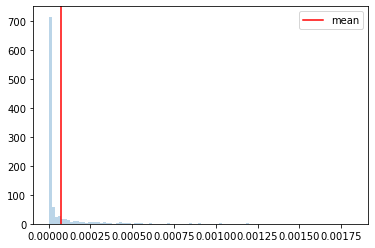

  0%|▏                                                                                | 3/1000 [00:00<01:04, 15.42it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654369493
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 1.0, 'jump_size_a': 10.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3
Monte Carlo 4


  1%|▌                                                                                | 7/1000 [00:00<01:32, 10.71it/s]

Monte Carlo 5
Monte Carlo 6
Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:00<01:57,  8.43it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 12/1000 [00:01<01:47,  9.19it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<01:49,  8.98it/s]

Monte Carlo 12
Monte Carlo 13
Monte Carlo 14

  2%|█▏                                                                              | 15/1000 [00:01<01:44,  9.45it/s]


Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:01<01:42,  9.58it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<01:47,  9.12it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<01:49,  8.91it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:53,  8.60it/s]

Monte Carlo 22
Monte Carlo 23


  2%|█▉                                                                              | 24/1000 [00:02<01:49,  8.91it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:02<01:45,  9.20it/s]

Monte Carlo 26
Monte Carlo 27
Monte Carlo 28

  3%|██▎                                                                             | 29/1000 [00:03<01:44,  9.29it/s]


Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<01:52,  8.62it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<01:56,  8.29it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:03<02:07,  7.56it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:03,  7.77it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<02:00,  7.98it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<02:11,  7.30it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:04<02:13,  7.19it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:02,  7.80it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:56,  8.17it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<02:06,  7.51it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:05<02:00,  7.85it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:01,  7.80it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:03,  7.68it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<02:01,  7.75it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:02,  7.69it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:13,  7.06it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:09,  7.22it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<02:06,  7.40it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<01:58,  7.88it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:05,  7.41it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:03,  7.51it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<02:05,  7.37it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:06,  7.31it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:02,  7.50it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:02,  7.52it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<01:58,  7.75it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:02,  7.46it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:06,  7.26it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<02:07,  7.14it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:05,  7.28it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:07,  7.14it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:04,  7.31it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<02:05,  7.21it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:03,  7.30it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:17,  6.55it/s]

Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:12<02:17,  6.56it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:12<02:11,  6.83it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:13<02:05,  7.12it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:13<02:01,  7.35it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:13<02:10,  6.85it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:14<02:09,  6.85it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:14<02:04,  7.12it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:14<02:10,  6.79it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:15<02:12,  6.69it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:15<02:17,  6.40it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:15<02:10,  6.73it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:15<02:07,  6.90it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:16<02:05,  6.99it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:16<02:07,  6.86it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:16<02:12,  6.56it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:17<02:13,  6.50it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:17<02:13,  6.48it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:17<02:33,  5.66it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:18<02:20,  6.17it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:18<02:14,  6.42it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:18<02:19,  6.17it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:19<02:17,  6.22it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:19<02:13,  6.42it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:19<02:18,  6.17it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:20<02:14,  6.32it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:20<02:07,  6.68it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:20<02:04,  6.79it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:20<02:03,  6.85it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:21<02:09,  6.51it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:21<02:10,  6.44it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:21<02:09,  6.49it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:12,  6.32it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:22<02:12,  6.29it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:22<02:16,  6.12it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:08,  6.45it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:23<02:09,  6.43it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:23<02:18,  5.99it/s]

Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:23<02:11,  6.27it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:11,  6.25it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:24<02:19,  5.89it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:24<02:19,  5.87it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:18,  5.93it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:15,  6.02it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:25<02:16,  5.99it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:22,  5.72it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:26<02:18,  5.85it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:26<02:15,  5.99it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:27<02:15,  5.98it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:14,  6.00it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:27<02:19,  5.77it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:27<02:15,  5.92it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:15,  5.93it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:28<02:16,  5.87it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:28<02:15,  5.87it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:19,  5.71it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:29<02:15,  5.84it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:30<02:10,  6.05it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:30<02:14,  5.85it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:30<02:10,  6.02it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:13,  5.90it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:14,  5.82it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:31<02:18,  5.66it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:31<02:15,  5.76it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:15,  5.74it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▌                                                             | 223/1000 [00:32<02:17,  5.65it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:32<02:23,  5.42it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▊                                                             | 226/1000 [00:32<02:18,  5.59it/s]

Monte Carlo 226


 23%|█████████████████▉                                                             | 227/1000 [00:33<02:25,  5.33it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:33<02:32,  5.05it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:33<02:30,  5.12it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:33<02:24,  5.32it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:23,  5.33it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:20,  5.45it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:34<02:21,  5.39it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:23,  5.32it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:21,  5.39it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:35<02:21,  5.39it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:35<02:21,  5.37it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:35<02:17,  5.52it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:13,  5.68it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:36<02:14,  5.61it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:36<02:15,  5.58it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:15,  5.57it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:37<02:17,  5.45it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:37<02:17,  5.44it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:38<02:19,  5.35it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:38<02:18,  5.39it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:38<02:16,  5.46it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:38<02:16,  5.45it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:19,  5.32it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:39<02:15,  5.44it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:39<02:18,  5.34it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:39<02:18,  5.34it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:16,  5.38it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:40<02:14,  5.45it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:40<02:30,  4.87it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:28,  4.92it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:41<02:23,  5.09it/s]

Monte Carlo 269
Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:41<02:18,  5.27it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:41<02:18,  5.26it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:19,  5.19it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:42<02:16,  5.33it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:42<02:21,  5.11it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:42<02:20,  5.14it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:43<02:18,  5.20it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:43<02:16,  5.29it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:43<02:14,  5.36it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:43<02:17,  5.22it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:43<02:19,  5.13it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:19,  5.13it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:44<02:21,  5.06it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:44<02:20,  5.08it/s]

Monte Carlo 286
Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:44<02:27,  4.83it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:45<02:22,  4.98it/s]

Monte Carlo 289
Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:45<02:21,  5.00it/s]

Monte Carlo 291
Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:45<02:24,  4.89it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:46<02:21,  4.99it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:46<02:18,  5.09it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:46<02:18,  5.06it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:46<02:17,  5.12it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:46<02:19,  5.03it/s]

Monte Carlo 298
Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:47<02:21,  4.92it/s]

Monte Carlo 300
Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:47<02:42,  4.30it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:47<02:39,  4.36it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:48<02:34,  4.50it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:48<02:31,  4.59it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:48<02:34,  4.50it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:48<02:27,  4.68it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:49<02:27,  4.70it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:49<02:23,  4.80it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:49<02:22,  4.84it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:50<02:20,  4.87it/s]

Monte Carlo 312
Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:50<02:19,  4.90it/s]

Monte Carlo 314
Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:50<02:21,  4.83it/s]

Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:51<02:22,  4.78it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:51<02:19,  4.86it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:51<02:19,  4.88it/s]

Monte Carlo 320
Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:51<02:20,  4.82it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:52<02:23,  4.72it/s]

Monte Carlo 323
Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:52<02:25,  4.65it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:52<02:31,  4.46it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:53<02:22,  4.71it/s]

Monte Carlo 327
Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:53<02:24,  4.64it/s]

Monte Carlo 329
Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:53<02:27,  4.53it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:54<02:26,  4.56it/s]

Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:54<02:19,  4.77it/s]

Monte Carlo 333
Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:54<02:22,  4.67it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:55<02:25,  4.55it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:55<02:19,  4.75it/s]

Monte Carlo 338
Monte Carlo 339


 34%|██████████████████████████▉                                                    | 341/1000 [00:55<02:17,  4.79it/s]

Monte Carlo 340
Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:56<02:24,  4.57it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:56<02:18,  4.73it/s]

Monte Carlo 343


 34%|███████████████████████████▎                                                   | 345/1000 [00:56<02:12,  4.96it/s]

Monte Carlo 344
Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:57<02:14,  4.87it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 348/1000 [00:57<02:12,  4.91it/s]

Monte Carlo 347
Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:57<02:14,  4.85it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:57<02:15,  4.78it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:58<02:15,  4.79it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:58<02:14,  4.81it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 354/1000 [00:58<02:16,  4.73it/s]

Monte Carlo 353
Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [00:58<02:18,  4.66it/s]

Monte Carlo 355


 36%|████████████████████████████▏                                                  | 357/1000 [00:59<02:12,  4.85it/s]

Monte Carlo 356
Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [00:59<02:14,  4.78it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [00:59<02:15,  4.73it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [00:59<02:15,  4.71it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 362/1000 [01:00<02:13,  4.77it/s]

Monte Carlo 361
Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:00<02:21,  4.49it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:00<02:22,  4.45it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:01<02:20,  4.51it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:01<02:24,  4.37it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:01<02:27,  4.29it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:01<02:24,  4.38it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:02<02:25,  4.33it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:02<02:27,  4.28it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:02<02:25,  4.32it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:02<02:26,  4.29it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:02<02:28,  4.23it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:03<02:27,  4.24it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:03<02:24,  4.33it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:03<02:21,  4.42it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:03<02:24,  4.32it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:04<02:21,  4.40it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:04<02:22,  4.37it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:04<02:21,  4.37it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:04<02:22,  4.35it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:05<02:20,  4.40it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:05<02:20,  4.40it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:05<02:25,  4.24it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:05<02:23,  4.30it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:05<02:25,  4.23it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:06<02:24,  4.24it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:06<02:23,  4.26it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:06<02:22,  4.28it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:06<02:23,  4.26it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:07<02:21,  4.30it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:07<02:24,  4.21it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:07<02:20,  4.31it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:07<02:18,  4.36it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:08<02:16,  4.44it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:08<02:14,  4.48it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:08<02:14,  4.49it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:08<02:19,  4.32it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:08<02:19,  4.30it/s]

Monte Carlo 399


 40%|███████████████████████████████▋                                               | 401/1000 [01:09<02:16,  4.37it/s]

Monte Carlo 400
Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:09<02:18,  4.31it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:09<02:18,  4.31it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:10<02:21,  4.21it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:10<02:19,  4.26it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:10<02:21,  4.21it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:10<02:19,  4.25it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:11<02:22,  4.17it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:11<02:17,  4.29it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:11<02:19,  4.23it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:11<02:19,  4.23it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:12<02:19,  4.20it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:12<02:21,  4.14it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:12<02:18,  4.23it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:12<02:18,  4.24it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:12<02:16,  4.28it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:13<02:18,  4.22it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:13<02:16,  4.27it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:13<02:20,  4.15it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:13<02:21,  4.10it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:14<02:21,  4.10it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:14<02:22,  4.06it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:14<02:20,  4.11it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:14<02:18,  4.15it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:15<02:26,  3.93it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:15<02:26,  3.91it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:15<02:47,  3.42it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:16<02:33,  3.73it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:16<02:27,  3.86it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:16<02:24,  3.94it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:16<02:20,  4.05it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:17<02:17,  4.12it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:17<02:21,  3.99it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:17<02:17,  4.12it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:17<02:20,  4.02it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:18<02:21,  3.99it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:18<02:19,  4.05it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:18<02:19,  4.04it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:18<02:17,  4.07it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:19<02:16,  4.09it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:19<02:18,  4.05it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:19<02:15,  4.11it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:19<02:16,  4.07it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:19<02:13,  4.16it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:20<02:15,  4.09it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:20<02:13,  4.14it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:20<02:12,  4.18it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:20<02:12,  4.17it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:21<02:10,  4.22it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:21<02:09,  4.26it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:21<02:16,  4.01it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:21<02:18,  3.95it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:22<02:16,  3.99it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:22<02:12,  4.13it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:22<02:14,  4.04it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:22<02:10,  4.18it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:23<02:07,  4.26it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:23<02:09,  4.19it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 460/1000 [01:23<02:03,  4.36it/s]

Monte Carlo 459
Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:24<02:05,  4.28it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:24<02:03,  4.34it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:24<02:03,  4.34it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:24<02:04,  4.31it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:25<02:08,  4.15it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:25<02:08,  4.14it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:25<02:05,  4.24it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:25<02:05,  4.23it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:25<02:05,  4.25it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:26<02:08,  4.14it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:26<02:08,  4.11it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:26<02:13,  3.95it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:26<02:10,  4.03it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:27<02:09,  4.08it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:27<02:09,  4.05it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:27<02:05,  4.16it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:27<02:04,  4.20it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:28<02:04,  4.21it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:28<02:07,  4.07it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:28<02:07,  4.07it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:28<02:11,  3.95it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:29<02:09,  3.99it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:29<02:11,  3.94it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:29<02:13,  3.88it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:29<02:12,  3.88it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:30<02:12,  3.89it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:30<02:10,  3.93it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:30<02:14,  3.80it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:30<02:12,  3.86it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:31<02:09,  3.92it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:31<02:12,  3.83it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:31<02:11,  3.85it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:32<02:12,  3.82it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:32<02:14,  3.76it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:32<02:15,  3.72it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:32<02:14,  3.76it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:33<02:12,  3.79it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:33<02:10,  3.85it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:33<02:11,  3.81it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:33<02:08,  3.88it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:34<02:09,  3.84it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:34<02:11,  3.80it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:34<02:14,  3.70it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:35<02:21,  3.51it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:35<02:18,  3.58it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:35<02:16,  3.62it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:35<02:12,  3.71it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:36<02:17,  3.59it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:36<02:16,  3.60it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:36<02:17,  3.57it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:36<02:19,  3.50it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:37<02:14,  3.63it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:37<02:07,  3.81it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:37<02:04,  3.91it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:37<02:06,  3.85it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:38<02:04,  3.87it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:38<02:04,  3.88it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:38<02:00,  3.99it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:38<01:59,  4.01it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:39<02:02,  3.93it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:39<02:00,  3.97it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:39<02:00,  3.97it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:39<01:59,  4.01it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:40<01:57,  4.04it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:40<02:00,  3.96it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:40<01:59,  3.95it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:40<02:00,  3.93it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:41<01:59,  3.94it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:41<01:58,  3.98it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:41<02:02,  3.83it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:42<02:04,  3.77it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:42<02:03,  3.79it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:42<02:06,  3.68it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:42<02:08,  3.63it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:43<02:08,  3.62it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:43<02:10,  3.56it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:43<02:09,  3.58it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:43<02:06,  3.64it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:44<02:05,  3.66it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:44<02:03,  3.71it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:44<02:04,  3.68it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:45<02:06,  3.62it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:45<02:08,  3.56it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:45<02:07,  3.56it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:45<02:11,  3.47it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:46<02:10,  3.49it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:46<02:07,  3.55it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:46<02:07,  3.55it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:47<02:11,  3.42it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:47<02:10,  3.44it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:47<02:07,  3.51it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:47<02:08,  3.50it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:48<02:10,  3.43it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:48<02:12,  3.35it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:48<02:09,  3.43it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:49<02:07,  3.47it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:49<02:27,  3.01it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:49<02:19,  3.16it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:50<02:14,  3.29it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:50<02:12,  3.31it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:50<02:09,  3.38it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:50<02:08,  3.41it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:51<02:10,  3.36it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:51<02:07,  3.41it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:51<02:05,  3.46it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:52<02:03,  3.52it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:52<02:03,  3.51it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:52<02:03,  3.50it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:52<02:05,  3.44it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:53<02:06,  3.39it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:53<02:05,  3.42it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:53<02:06,  3.38it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:54<02:06,  3.36it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:54<02:04,  3.42it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:54<02:05,  3.38it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:55<02:07,  3.31it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:55<02:07,  3.31it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:55<02:09,  3.27it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:55<02:06,  3.32it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:56<02:05,  3.35it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:56<02:05,  3.34it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:56<02:06,  3.29it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:57<02:03,  3.38it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:57<02:05,  3.31it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:57<02:07,  3.25it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [01:58<02:04,  3.31it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [01:58<02:04,  3.32it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [01:58<02:01,  3.40it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [01:58<02:03,  3.34it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [01:59<02:03,  3.31it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [01:59<02:05,  3.26it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [01:59<02:05,  3.24it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:00<02:03,  3.30it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:00<02:04,  3.27it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:00<02:05,  3.23it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:01<02:03,  3.28it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:01<02:02,  3.29it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:01<02:04,  3.24it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:02<02:00,  3.32it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:02<01:59,  3.36it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:02<01:58,  3.36it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:02<02:02,  3.24it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:03<02:03,  3.22it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:03<02:03,  3.20it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:03<02:02,  3.22it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:04<02:03,  3.19it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:04<02:13,  2.94it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:04<02:10,  3.00it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:05<02:09,  3.02it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:05<02:06,  3.08it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:05<02:04,  3.13it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:06<02:01,  3.20it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:06<01:59,  3.23it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:06<02:01,  3.17it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:07<02:03,  3.12it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:07<02:04,  3.09it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:07<02:05,  3.04it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:08<02:04,  3.07it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:08<02:04,  3.05it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:08<02:03,  3.08it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:09<02:02,  3.11it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:09<01:58,  3.20it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:09<02:00,  3.14it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:10<01:58,  3.17it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:10<01:58,  3.17it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:10<01:56,  3.20it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:10<01:56,  3.21it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:11<01:55,  3.23it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:11<01:56,  3.20it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:11<01:54,  3.23it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:12<01:54,  3.21it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:12<01:54,  3.22it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:12<01:55,  3.19it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:13<01:54,  3.21it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:13<01:56,  3.14it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:13<01:57,  3.09it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:14<01:56,  3.12it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:14<01:57,  3.08it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:14<02:00,  3.00it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:15<01:59,  3.00it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:15<02:07,  2.81it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:15<02:06,  2.83it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:16<02:07,  2.79it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:16<02:11,  2.71it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:17<02:10,  2.71it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:17<02:08,  2.75it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:17<02:07,  2.77it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:18<02:08,  2.75it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:18<02:07,  2.75it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:18<02:05,  2.80it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:19<02:01,  2.87it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:19<02:00,  2.89it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:19<02:03,  2.81it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:20<02:05,  2.75it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:20<02:00,  2.85it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:20<02:02,  2.81it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:21<02:03,  2.77it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:21<02:05,  2.73it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:22<02:04,  2.74it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:22<02:03,  2.75it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:22<02:04,  2.72it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:23<02:02,  2.76it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:23<02:02,  2.76it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:23<02:01,  2.76it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:24<02:04,  2.68it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:24<02:09,  2.57it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:25<02:06,  2.64it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:25<02:01,  2.74it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:25<01:57,  2.81it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:26<01:58,  2.79it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:26<02:11,  2.50it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:26<02:07,  2.57it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:27<02:05,  2.61it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:27<02:03,  2.64it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:28<02:04,  2.61it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:28<02:00,  2.68it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:28<01:56,  2.76it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:29<01:57,  2.73it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:29<02:05,  2.55it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:29<02:01,  2.63it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:30<01:58,  2.69it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:30<01:54,  2.77it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:31<01:57,  2.71it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:31<01:59,  2.64it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:31<01:59,  2.63it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:32<01:58,  2.65it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:32<01:58,  2.64it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:32<01:58,  2.62it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:33<02:00,  2.59it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:33<01:55,  2.67it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:34<01:54,  2.69it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:34<01:52,  2.73it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:34<01:54,  2.67it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:35<01:50,  2.77it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:35<01:46,  2.85it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:35<01:44,  2.91it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:36<01:42,  2.96it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:36<01:41,  2.97it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:36<01:42,  2.94it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:37<01:40,  2.99it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:37<01:40,  2.97it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:37<01:40,  2.96it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:38<01:40,  2.94it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:38<01:41,  2.91it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:38<01:40,  2.95it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:39<01:40,  2.93it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:39<01:41,  2.88it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:39<01:42,  2.85it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:40<01:40,  2.90it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:40<01:38,  2.94it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:40<01:39,  2.89it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:41<01:43,  2.79it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:41<01:40,  2.86it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:41<01:37,  2.92it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:42<01:41,  2.81it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:42<01:39,  2.86it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:43<01:38,  2.86it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:43<01:36,  2.91it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:43<01:37,  2.90it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:44<01:38,  2.83it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:44<01:37,  2.85it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:44<01:37,  2.85it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:45<01:38,  2.81it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:45<01:37,  2.84it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:45<01:38,  2.80it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:46<01:36,  2.83it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:46<01:37,  2.81it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:46<01:36,  2.81it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:47<01:37,  2.77it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:47<01:39,  2.70it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:48<01:36,  2.78it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:48<01:36,  2.79it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:48<01:35,  2.80it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:49<01:34,  2.80it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:49<01:32,  2.86it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:49<01:30,  2.91it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:50<01:28,  2.98it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:50<01:25,  3.06it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:50<01:26,  3.02it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:51<01:25,  3.03it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:51<01:25,  3.01it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:51<01:23,  3.07it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:51<01:22,  3.10it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:52<01:22,  3.11it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:52<01:25,  2.99it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:53<01:25,  2.96it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:53<01:26,  2.93it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:53<01:25,  2.95it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:54<01:25,  2.95it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:54<01:26,  2.89it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:54<01:25,  2.93it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:55<01:22,  3.00it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:55<01:24,  2.94it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:55<01:22,  2.98it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:56<01:21,  2.99it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:56<01:20,  3.03it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:56<01:20,  3.01it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:57<01:19,  3.03it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:57<01:19,  3.02it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:57<01:21,  2.93it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:58<01:20,  2.95it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:58<01:21,  2.92it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:58<01:19,  2.97it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:59<01:19,  2.96it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:59<01:18,  3.00it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:59<01:19,  2.95it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:00<01:17,  3.01it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:00<01:18,  2.97it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:00<01:16,  3.04it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:01<01:17,  2.98it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:01<01:19,  2.87it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:01<01:19,  2.88it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:02<01:20,  2.83it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:02<01:21,  2.76it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:02<01:20,  2.80it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:03<01:19,  2.81it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:03<01:18,  2.83it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:03<01:19,  2.80it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:04<01:17,  2.86it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:04<01:16,  2.87it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:05<01:16,  2.85it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:05<01:16,  2.85it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:05<01:16,  2.83it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:06<01:17,  2.80it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:06<01:18,  2.76it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:06<01:18,  2.73it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:07<01:18,  2.73it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:07<01:17,  2.73it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:07<01:17,  2.71it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:08<01:18,  2.67it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:08<01:16,  2.73it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:09<01:17,  2.69it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:09<01:18,  2.65it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:09<01:17,  2.67it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:10<01:23,  2.45it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:10<01:21,  2.49it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:11<01:19,  2.57it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:11<01:15,  2.66it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:11<01:14,  2.71it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:12<01:13,  2.73it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:12<01:14,  2.67it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:12<01:12,  2.72it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:13<01:12,  2.71it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:13<01:11,  2.73it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:13<01:11,  2.72it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:14<01:12,  2.68it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:14<01:11,  2.69it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:15<01:11,  2.68it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:15<01:11,  2.69it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:15<01:09,  2.72it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:16<01:10,  2.69it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:16<01:08,  2.73it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:16<01:08,  2.73it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:17<01:08,  2.71it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:17<01:07,  2.73it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:18<01:07,  2.71it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:18<01:07,  2.71it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:18<01:06,  2.72it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:19<01:06,  2.73it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:19<01:06,  2.70it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:19<01:05,  2.73it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:20<01:05,  2.70it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:20<01:05,  2.70it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:21<01:06,  2.66it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:21<01:06,  2.63it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:21<01:07,  2.56it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:22<01:06,  2.61it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:22<01:04,  2.66it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:22<01:04,  2.63it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:23<01:04,  2.65it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:23<01:02,  2.70it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:24<01:02,  2.69it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:24<01:03,  2.65it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:24<01:03,  2.63it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:25<01:03,  2.59it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:25<01:01,  2.65it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:25<01:01,  2.67it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:26<01:01,  2.63it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:26<01:01,  2.62it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:27<01:01,  2.60it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:27<01:00,  2.64it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:27<00:58,  2.69it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:28<00:59,  2.64it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:28<00:58,  2.65it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:28<00:59,  2.61it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:29<00:59,  2.58it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:29<01:00,  2.54it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:30<00:59,  2.56it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:30<00:59,  2.55it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:30<00:57,  2.60it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:31<00:56,  2.64it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:31<00:55,  2.66it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:32<00:56,  2.62it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:32<00:56,  2.58it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:32<00:55,  2.60it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:33<00:55,  2.61it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:33<00:55,  2.60it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:33<00:54,  2.63it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:34<00:53,  2.62it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:34<00:53,  2.62it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:35<00:53,  2.61it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:35<00:52,  2.60it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:35<00:53,  2.57it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:36<00:52,  2.58it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:36<00:52,  2.57it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:37<00:52,  2.55it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:37<00:51,  2.58it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:37<00:51,  2.59it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:38<00:52,  2.51it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:38<00:52,  2.49it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:39<00:50,  2.54it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:39<00:49,  2.57it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:39<00:50,  2.49it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:40<00:49,  2.56it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:40<00:48,  2.57it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:41<00:48,  2.54it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:41<00:48,  2.54it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:41<00:49,  2.49it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:42<00:49,  2.47it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:42<00:48,  2.48it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:43<00:47,  2.49it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:43<00:47,  2.49it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:43<00:46,  2.53it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:44<00:45,  2.52it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:44<00:48,  2.38it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:45<00:45,  2.49it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:45<00:45,  2.50it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:45<00:45,  2.44it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:46<00:45,  2.44it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:46<00:44,  2.47it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:47<00:44,  2.47it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:47<00:43,  2.50it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:47<00:42,  2.49it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:48<00:41,  2.54it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:48<00:41,  2.55it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:49<00:40,  2.54it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:49<00:40,  2.53it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:49<00:41,  2.47it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:50<00:40,  2.48it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:50<00:40,  2.45it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:51<00:39,  2.48it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:51<00:39,  2.50it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:51<00:38,  2.49it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:52<00:38,  2.47it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:52<00:38,  2.49it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:53<00:37,  2.48it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:53<00:37,  2.50it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:53<00:37,  2.47it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:54<00:37,  2.45it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:54<00:36,  2.44it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:55<00:36,  2.41it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:55<00:35,  2.46it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:55<00:35,  2.44it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:56<00:35,  2.40it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:56<00:35,  2.42it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:57<00:34,  2.41it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:57<00:34,  2.40it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:58<00:33,  2.44it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:58<00:33,  2.40it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:58<00:33,  2.41it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:59<00:32,  2.42it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:59<00:31,  2.44it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:00<00:31,  2.45it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:00<00:31,  2.44it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:00<00:30,  2.45it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:01<00:31,  2.38it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:01<00:30,  2.41it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:02<00:29,  2.43it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:02<00:29,  2.41it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:03<00:29,  2.41it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:03<00:29,  2.31it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:03<00:29,  2.32it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:04<00:28,  2.36it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:04<00:27,  2.36it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:05<00:27,  2.35it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:05<00:26,  2.37it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:06<00:26,  2.37it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:06<00:25,  2.40it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:06<00:25,  2.36it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:07<00:25,  2.38it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:07<00:24,  2.42it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:08<00:24,  2.41it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:08<00:23,  2.38it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:08<00:23,  2.35it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:09<00:23,  2.32it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:09<00:22,  2.37it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:10<00:22,  2.34it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:10<00:21,  2.37it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:11<00:21,  2.39it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:11<00:20,  2.40it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:11<00:20,  2.40it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:12<00:20,  2.37it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:12<00:20,  2.34it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:13<00:19,  2.38it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:13<00:18,  2.39it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:14<00:18,  2.40it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:14<00:17,  2.40it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:14<00:17,  2.40it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:15<00:17,  2.38it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:15<00:17,  2.33it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:16<00:16,  2.37it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:16<00:15,  2.40it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:16<00:15,  2.41it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:17<00:14,  2.40it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:17<00:14,  2.40it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:18<00:14,  2.36it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:18<00:13,  2.38it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:19<00:13,  2.29it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:19<00:13,  2.35it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:19<00:12,  2.32it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:20<00:12,  2.35it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:20<00:11,  2.38it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:21<00:11,  2.37it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:21<00:11,  2.34it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:22<00:10,  2.36it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:22<00:10,  2.34it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:22<00:09,  2.37it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:23<00:09,  2.38it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:23<00:08,  2.39it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:24<00:08,  2.32it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:24<00:08,  2.36it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:25<00:07,  2.36it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:25<00:07,  2.35it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:25<00:06,  2.34it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:26<00:06,  2.40it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:26<00:05,  2.44it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:27<00:05,  2.44it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:27<00:04,  2.44it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:27<00:04,  2.43it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:28<00:04,  2.42it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:28<00:03,  2.29it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:29<00:03,  2.33it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:29<00:02,  2.36it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:30<00:02,  2.34it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:30<00:02,  2.37it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:30<00:01,  2.41it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:31<00:01,  2.39it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:31<00:00,  2.39it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:32<00:00,  2.35it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:32<00:00,  3.67it/s]


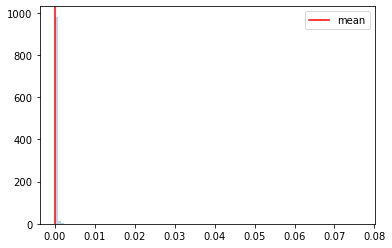

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654369766
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 1.0, 'jump_size_a': 10.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:03, 15.67it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:29, 11.16it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:51,  8.91it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:47,  9.20it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:48,  9.15it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:50,  8.94it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:55,  8.52it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:52,  8.70it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:51,  8.81it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:53,  8.63it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<02:01,  8.06it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:54,  8.47it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:54,  8.48it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:08,  7.57it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:10,  7.40it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<02:08,  7.53it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<01:57,  8.22it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<02:06,  7.60it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:56,  8.26it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<01:54,  8.39it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<01:53,  8.45it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<01:53,  8.43it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:53,  8.41it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:05<02:01,  7.83it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<01:56,  8.11it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<01:54,  8.28it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<01:56,  8.09it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:06<02:03,  7.64it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<02:02,  7.68it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<01:55,  8.12it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:07<01:51,  8.37it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:07<01:50,  8.42it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:08<01:58,  7.87it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:08<01:55,  8.08it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:08<01:49,  8.46it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:08<01:45,  8.77it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<01:46,  8.67it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:09<01:46,  8.63it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:09<01:47,  8.59it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:09<01:51,  8.24it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:10<01:51,  8.20it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:10<01:50,  8.27it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:10<01:48,  8.40it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████                                                                         | 89/1000 [00:10<01:46,  8.53it/s]

Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:10<02:09,  7.02it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:09,  7.03it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<02:01,  7.43it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:11<01:53,  7.94it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<01:56,  7.75it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<01:49,  8.20it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:12<01:52,  7.99it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:12<01:52,  7.97it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<01:52,  7.96it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<01:53,  7.85it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:13<02:01,  7.34it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:13<01:58,  7.49it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<01:54,  7.76it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:14<01:57,  7.53it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:14<01:51,  7.88it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:14<01:49,  8.01it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<01:48,  8.09it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:15<01:54,  7.63it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:15<01:56,  7.52it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:15<02:00,  7.20it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:16<02:01,  7.18it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:16<01:58,  7.29it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:16<02:00,  7.18it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:17<01:57,  7.37it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:17<02:03,  6.95it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:17<01:56,  7.35it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:17<01:58,  7.20it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:18<02:00,  7.10it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:18<02:01,  7.00it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:18<02:09,  6.56it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:19<02:14,  6.29it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:19<02:11,  6.44it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:19<02:10,  6.46it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:19<02:03,  6.84it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:20<01:58,  7.08it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:20<01:54,  7.34it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:20<02:05,  6.65it/s]

Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:20<02:04,  6.73it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:21<01:58,  7.02it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:21<02:00,  6.89it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:21<02:01,  6.85it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:22<02:02,  6.78it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:22<02:06,  6.54it/s]

Monte Carlo 173
Monte Carlo 174

 18%|█████████████▊                                                                 | 175/1000 [00:22<02:07,  6.50it/s]


Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:22<02:07,  6.45it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:23<02:05,  6.56it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:23<02:05,  6.53it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:23<02:01,  6.72it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:24<02:09,  6.31it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:24<02:20,  5.78it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:24<02:15,  5.99it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:25<02:20,  5.77it/s]

Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:25<02:17,  5.88it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:25<02:14,  5.99it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:26<02:10,  6.14it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:26<02:11,  6.08it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:26<02:08,  6.21it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:27<02:12,  6.01it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:27<02:16,  5.82it/s]

Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:27<02:13,  5.93it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:27<02:09,  6.10it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:28<02:10,  6.06it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:28<02:09,  6.09it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:28<02:15,  5.82it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:29<02:12,  5.92it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:29<02:34,  5.08it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:30<02:31,  5.15it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:30<02:29,  5.23it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:30<02:24,  5.41it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:30<02:22,  5.47it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:31<02:17,  5.64it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:31<02:19,  5.54it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:31<02:21,  5.46it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:31<02:18,  5.58it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:32<02:14,  5.73it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:32<02:13,  5.75it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:32<02:12,  5.79it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:33<02:12,  5.77it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:33<02:13,  5.71it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:33<02:12,  5.73it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:34<02:12,  5.72it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:34<02:16,  5.54it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:34<02:18,  5.44it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:35<02:17,  5.47it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:35<02:24,  5.21it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 250/1000 [00:35<02:27,  5.09it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:36<02:32,  4.90it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:36<02:28,  5.02it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:36<02:24,  5.18it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 255/1000 [00:36<02:28,  5.03it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:37<02:29,  4.95it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:37<02:34,  4.78it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:37<02:29,  4.96it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:37<02:23,  5.13it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:38<02:18,  5.32it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:38<02:16,  5.40it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:38<02:19,  5.27it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:38<02:15,  5.43it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:39<02:16,  5.36it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:39<02:14,  5.42it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:39<02:18,  5.26it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:40<02:19,  5.22it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:40<02:15,  5.34it/s]

Monte Carlo 273
Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:40<02:15,  5.34it/s]

Monte Carlo 275
Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:41<02:12,  5.44it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:41<02:21,  5.09it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:41<02:17,  5.23it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:42<02:23,  4.99it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:42<02:21,  5.07it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:42<02:18,  5.16it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:42<02:14,  5.31it/s]

Monte Carlo 286
Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:43<02:19,  5.11it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:43<02:15,  5.23it/s]

Monte Carlo 289
Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:43<02:13,  5.32it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:43<02:17,  5.13it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:44<02:14,  5.24it/s]

Monte Carlo 293
Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:44<02:15,  5.19it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:44<02:15,  5.17it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:44<02:12,  5.29it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:45<02:15,  5.16it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:45<02:13,  5.23it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:45<02:14,  5.20it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:45<02:13,  5.23it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:45<02:13,  5.23it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:46<02:13,  5.20it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:46<02:11,  5.27it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:46<02:12,  5.23it/s]

Monte Carlo 305
Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:46<02:17,  5.02it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:47<02:23,  4.80it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:47<02:28,  4.65it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:47<02:28,  4.64it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:47<02:23,  4.78it/s]

Monte Carlo 312
Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:48<02:22,  4.80it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:48<02:20,  4.88it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:48<02:20,  4.87it/s]

Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:48<02:21,  4.82it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:49<02:25,  4.68it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:49<02:29,  4.54it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:49<02:22,  4.77it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:50<02:21,  4.78it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:50<02:22,  4.75it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:50<02:18,  4.86it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:50<02:17,  4.91it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:51<02:17,  4.90it/s]

Monte Carlo 327
Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:51<02:20,  4.78it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:51<02:16,  4.90it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:51<02:14,  4.95it/s]

Monte Carlo 331
Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:52<02:16,  4.89it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:52<02:16,  4.86it/s]

Monte Carlo 334
Monte Carlo 335


 34%|██████████████████████████▌                                                    | 337/1000 [00:52<02:20,  4.72it/s]

Monte Carlo 336
Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:53<02:20,  4.72it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:53<02:21,  4.68it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:53<02:26,  4.52it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:53<02:26,  4.50it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 343/1000 [00:54<02:23,  4.58it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:54<02:20,  4.69it/s]

Monte Carlo 343


 34%|███████████████████████████▎                                                   | 345/1000 [00:54<02:16,  4.79it/s]

Monte Carlo 344


 35%|███████████████████████████▎                                                   | 346/1000 [00:54<02:16,  4.80it/s]

Monte Carlo 345


 35%|███████████████████████████▍                                                   | 347/1000 [00:55<02:14,  4.86it/s]

Monte Carlo 346
Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:55<02:15,  4.82it/s]

Monte Carlo 348


 35%|███████████████████████████▋                                                   | 350/1000 [00:55<02:17,  4.74it/s]

Monte Carlo 349
Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:55<02:22,  4.55it/s]

Monte Carlo 351


 35%|███████████████████████████▉                                                   | 353/1000 [00:56<02:19,  4.64it/s]

Monte Carlo 352
Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:56<02:24,  4.47it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 356/1000 [00:57<02:19,  4.60it/s]

Monte Carlo 355
Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [00:57<02:23,  4.47it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 359/1000 [00:57<02:17,  4.65it/s]

Monte Carlo 358
Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [00:57<02:16,  4.70it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 362/1000 [00:58<02:14,  4.75it/s]

Monte Carlo 361
Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [00:58<02:19,  4.56it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 365/1000 [00:59<02:17,  4.62it/s]

Monte Carlo 364
Monte Carlo 365


 37%|████████████████████████████▉                                                  | 367/1000 [00:59<02:15,  4.67it/s]

Monte Carlo 366
Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [00:59<02:14,  4.69it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 370/1000 [01:00<02:17,  4.57it/s]

Monte Carlo 369
Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:00<02:15,  4.63it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 373/1000 [01:00<02:13,  4.69it/s]

Monte Carlo 372


 37%|█████████████████████████████▌                                                 | 374/1000 [01:00<02:11,  4.75it/s]

Monte Carlo 373
Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 376/1000 [01:01<02:16,  4.58it/s]

Monte Carlo 375
Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:01<02:17,  4.52it/s]

Monte Carlo 377


 38%|█████████████████████████████▉                                                 | 379/1000 [01:02<02:16,  4.56it/s]

Monte Carlo 378


 38%|██████████████████████████████                                                 | 380/1000 [01:02<02:14,  4.61it/s]

Monte Carlo 379
Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:02<02:14,  4.61it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:02<02:21,  4.38it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:02<02:18,  4.47it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:03<02:18,  4.46it/s]

Monte Carlo 384


 39%|██████████████████████████████▍                                                | 386/1000 [01:03<02:13,  4.60it/s]

Monte Carlo 385
Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:03<02:32,  4.01it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:04<02:28,  4.12it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:04<02:25,  4.21it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:04<02:23,  4.24it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:04<02:19,  4.35it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:05<02:19,  4.35it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:05<02:16,  4.45it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:05<02:17,  4.40it/s]

Monte Carlo 394


 40%|███████████████████████████████▎                                               | 396/1000 [01:05<02:17,  4.38it/s]

Monte Carlo 395
Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:06<02:14,  4.48it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:06<02:14,  4.48it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 400/1000 [01:06<02:11,  4.56it/s]

Monte Carlo 399
Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:07<02:13,  4.50it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:07<02:18,  4.33it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:07<02:17,  4.33it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:07<02:16,  4.37it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:08<02:15,  4.38it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:08<02:15,  4.39it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:08<02:15,  4.38it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:08<02:19,  4.24it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:08<02:19,  4.23it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:09<02:26,  4.02it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:09<02:21,  4.16it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:09<02:21,  4.15it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:09<02:17,  4.28it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:10<02:15,  4.33it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:10<02:12,  4.40it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:10<02:18,  4.23it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:10<02:17,  4.25it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:11<02:13,  4.36it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:11<02:11,  4.43it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:11<02:13,  4.36it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:11<02:12,  4.38it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:11<02:09,  4.46it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:12<02:13,  4.32it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:12<02:11,  4.37it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:12<02:12,  4.35it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:12<02:09,  4.44it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:13<02:10,  4.40it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:13<02:12,  4.32it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:13<02:12,  4.30it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:13<02:11,  4.33it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:14<02:13,  4.28it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:14<02:31,  3.75it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:14<02:27,  3.85it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:14<02:21,  3.99it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:15<02:16,  4.13it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:15<02:18,  4.09it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:15<02:14,  4.19it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:15<02:12,  4.26it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:16<02:11,  4.27it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:16<02:12,  4.23it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:16<02:09,  4.31it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:16<02:07,  4.37it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:16<02:07,  4.37it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:17<02:08,  4.33it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:17<02:07,  4.35it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:17<02:09,  4.27it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:17<02:14,  4.12it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:18<02:10,  4.22it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:18<02:11,  4.18it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:18<02:10,  4.21it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:18<02:09,  4.25it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:19<02:07,  4.28it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:19<02:10,  4.18it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:19<02:09,  4.20it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:19<02:11,  4.14it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:20<02:11,  4.14it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:20<02:11,  4.14it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:20<02:13,  4.06it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:20<02:13,  4.06it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:21<02:13,  4.06it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:21<02:11,  4.11it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:21<02:08,  4.19it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:21<02:14,  3.99it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:22<02:13,  4.02it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:22<02:15,  3.94it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:22<02:13,  3.99it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:22<02:08,  4.14it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:23<02:09,  4.10it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:23<02:08,  4.12it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:23<02:08,  4.12it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:23<02:04,  4.26it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:23<02:02,  4.31it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:24<02:03,  4.28it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:24<02:01,  4.34it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:24<02:01,  4.32it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:24<01:59,  4.38it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:25<01:57,  4.43it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:25<01:55,  4.53it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:25<01:56,  4.47it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:25<01:59,  4.36it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:26<01:59,  4.34it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:26<02:00,  4.28it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:26<01:58,  4.36it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:26<02:00,  4.28it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:26<01:58,  4.34it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:27<02:00,  4.25it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:27<02:01,  4.22it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:27<01:58,  4.31it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:27<02:03,  4.15it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:28<02:05,  4.07it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:28<02:02,  4.14it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:28<02:04,  4.08it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:28<02:03,  4.12it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:29<02:01,  4.17it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:29<02:03,  4.08it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:29<02:06,  3.99it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:29<02:12,  3.79it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:30<02:10,  3.84it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:30<02:14,  3.73it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:30<02:14,  3.73it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:30<02:11,  3.79it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:31<02:10,  3.83it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:31<02:07,  3.89it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:31<02:05,  3.94it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:32<02:12,  3.73it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:32<02:08,  3.85it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:32<02:07,  3.86it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:32<02:06,  3.89it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:33<02:10,  3.75it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:33<02:07,  3.84it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:33<02:06,  3.85it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:33<02:07,  3.84it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:34<02:08,  3.79it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:34<02:08,  3.78it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:34<02:06,  3.84it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:34<02:06,  3.84it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:35<02:04,  3.87it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:35<02:09,  3.73it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:35<02:06,  3.80it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:35<02:05,  3.84it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:36<02:07,  3.75it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:36<02:04,  3.83it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:36<02:03,  3.85it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:36<02:03,  3.86it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:37<02:18,  3.44it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:37<02:14,  3.53it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:37<02:08,  3.67it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:38<02:08,  3.67it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:38<02:07,  3.68it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:38<02:11,  3.59it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:38<02:11,  3.57it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:39<02:11,  3.57it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:39<02:08,  3.64it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:39<02:04,  3.75it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:40<02:05,  3.71it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:40<02:02,  3.78it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:40<02:00,  3.85it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:40<02:03,  3.75it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:41<02:02,  3.76it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:41<02:01,  3.79it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:41<02:01,  3.77it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:41<02:14,  3.40it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:42<02:21,  3.22it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:42<02:19,  3.27it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:42<02:17,  3.32it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:43<02:15,  3.34it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:43<02:20,  3.23it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:43<02:16,  3.32it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:44<02:13,  3.39it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:44<02:09,  3.46it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:44<02:12,  3.38it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:44<02:12,  3.39it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:45<02:11,  3.40it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:45<02:20,  3.17it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:45<02:18,  3.22it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:46<02:15,  3.27it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:46<02:15,  3.28it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:46<02:13,  3.30it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:47<02:17,  3.20it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:47<02:15,  3.25it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:47<02:12,  3.33it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:48<02:08,  3.40it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:48<02:03,  3.53it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:48<02:01,  3.59it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:48<02:00,  3.62it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:49<01:59,  3.62it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:49<02:02,  3.54it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:49<02:07,  3.40it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:50<02:06,  3.40it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:50<02:06,  3.40it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:50<02:05,  3.41it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:50<02:11,  3.25it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:51<02:15,  3.16it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:51<02:09,  3.28it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:51<02:10,  3.25it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:52<02:08,  3.30it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:52<02:04,  3.39it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:52<02:03,  3.41it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:53<02:09,  3.26it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:53<02:12,  3.17it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:53<02:14,  3.12it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:54<02:08,  3.24it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:54<02:06,  3.28it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:54<02:05,  3.31it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:54<02:05,  3.30it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [01:55<02:06,  3.27it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [01:55<02:05,  3.30it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [01:55<02:11,  3.14it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [01:56<02:17,  2.99it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [01:56<02:23,  2.86it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [01:56<02:17,  2.98it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [01:57<02:13,  3.06it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [01:57<02:11,  3.10it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [01:57<02:08,  3.16it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [01:58<02:11,  3.09it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [01:58<02:09,  3.13it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [01:58<02:10,  3.08it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [01:59<02:10,  3.08it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [01:59<02:11,  3.05it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [01:59<02:13,  2.99it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:00<02:10,  3.07it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:00<02:13,  2.98it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:00<02:10,  3.05it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:01<02:08,  3.08it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:01<02:07,  3.09it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:01<02:04,  3.17it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:02<02:03,  3.19it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:02<02:06,  3.09it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:02<02:02,  3.18it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:03<02:01,  3.22it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:03<01:59,  3.26it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:03<01:57,  3.30it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:03<01:55,  3.35it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:04<01:58,  3.25it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:04<01:57,  3.28it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:04<01:57,  3.26it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:05<01:56,  3.30it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:05<01:54,  3.34it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:05<01:53,  3.37it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:06<01:56,  3.26it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:06<01:53,  3.33it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:06<01:53,  3.34it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:06<01:50,  3.42it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:07<01:51,  3.37it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:07<01:51,  3.38it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:07<01:51,  3.35it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:08<01:53,  3.30it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:08<01:54,  3.25it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:08<01:54,  3.25it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:09<01:54,  3.23it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:09<02:05,  2.94it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:09<02:02,  3.01it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:10<01:59,  3.06it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:10<01:57,  3.12it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:10<01:54,  3.18it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:11<01:51,  3.26it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:11<01:51,  3.26it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:11<01:48,  3.33it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:11<01:50,  3.25it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:12<01:51,  3.23it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:12<01:52,  3.20it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:12<01:50,  3.25it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:13<01:48,  3.28it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:13<01:50,  3.21it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:13<01:51,  3.19it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:14<01:49,  3.25it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:14<01:47,  3.29it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:14<01:47,  3.27it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:15<01:49,  3.21it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:15<01:48,  3.24it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:15<01:50,  3.17it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:15<01:50,  3.16it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:16<01:50,  3.13it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:16<01:51,  3.11it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:16<01:50,  3.12it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:17<01:48,  3.16it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:17<01:49,  3.12it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:17<01:47,  3.19it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:18<01:45,  3.23it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:18<01:44,  3.24it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:18<01:44,  3.25it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:19<01:45,  3.20it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:19<01:46,  3.18it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:19<01:43,  3.24it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:20<01:43,  3.23it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:20<01:45,  3.17it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:20<01:45,  3.16it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:21<01:45,  3.15it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:21<01:45,  3.13it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:21<01:45,  3.12it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:21<01:45,  3.11it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:22<01:46,  3.08it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:22<01:48,  3.01it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:22<01:47,  3.03it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:23<01:49,  2.96it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:23<01:48,  2.97it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:23<01:45,  3.05it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:24<01:45,  3.06it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:24<01:42,  3.14it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:24<01:41,  3.14it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:25<01:39,  3.19it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:25<01:41,  3.15it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:25<01:41,  3.12it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:26<01:46,  2.96it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:26<01:45,  2.98it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:26<01:44,  3.02it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:27<01:42,  3.04it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:27<01:44,  2.99it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:27<01:42,  3.02it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:28<01:42,  3.01it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:28<01:40,  3.07it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:28<01:40,  3.07it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:29<01:39,  3.08it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:29<01:37,  3.13it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:29<01:37,  3.14it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:30<01:38,  3.08it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:30<01:40,  3.01it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:30<01:39,  3.02it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:31<01:37,  3.08it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:31<01:36,  3.11it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:31<01:37,  3.08it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:32<01:36,  3.07it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:32<01:36,  3.09it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:32<01:36,  3.08it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:33<01:36,  3.07it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:33<01:35,  3.08it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:33<01:36,  3.04it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:34<01:37,  3.00it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:34<01:36,  3.02it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:34<01:35,  3.04it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:35<01:37,  2.96it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:35<01:36,  2.99it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:35<01:35,  3.02it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:36<01:33,  3.04it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:36<01:34,  3.01it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:36<01:35,  2.96it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:37<01:37,  2.92it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:37<01:35,  2.95it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:37<01:35,  2.95it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:38<01:35,  2.94it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:38<01:36,  2.88it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:38<01:37,  2.85it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:39<01:35,  2.90it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:39<01:33,  2.94it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:39<01:32,  2.96it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:40<01:32,  2.96it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:40<01:31,  3.00it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:40<01:41,  2.67it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:41<01:38,  2.76it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:41<01:34,  2.87it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:41<01:33,  2.86it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:42<01:31,  2.93it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:42<01:32,  2.89it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:42<01:30,  2.96it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:43<01:31,  2.88it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:43<01:31,  2.90it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:44<01:29,  2.95it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:44<01:28,  2.96it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:44<01:29,  2.92it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:45<01:29,  2.91it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:45<01:27,  2.96it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:45<01:27,  2.96it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:46<01:26,  2.97it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:46<01:28,  2.88it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:46<01:26,  2.95it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:47<01:26,  2.94it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:47<01:25,  2.95it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:47<01:25,  2.96it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:48<01:24,  2.98it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:48<01:25,  2.94it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:48<01:25,  2.93it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:49<01:25,  2.91it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:49<01:26,  2.86it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:49<01:28,  2.80it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:50<01:24,  2.89it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:50<01:21,  3.01it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:50<01:21,  2.98it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:51<01:18,  3.09it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:51<01:17,  3.13it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:51<01:17,  3.11it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:52<01:18,  3.06it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:52<01:18,  3.01it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:52<01:17,  3.05it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:53<01:18,  2.99it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:53<01:16,  3.05it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:53<01:15,  3.09it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [02:54<01:16,  3.03it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [02:54<01:14,  3.10it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [02:54<01:14,  3.08it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [02:55<01:17,  2.99it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [02:55<01:18,  2.92it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [02:55<01:15,  3.03it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [02:56<01:14,  3.06it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [02:56<01:16,  2.95it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [02:56<01:15,  2.97it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [02:57<01:18,  2.87it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [02:57<01:15,  2.96it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [02:57<01:15,  2.93it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [02:58<01:13,  3.00it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [02:58<01:12,  3.03it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [02:58<01:10,  3.09it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [02:59<01:10,  3.07it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [02:59<01:12,  2.98it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [02:59<01:13,  2.95it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:00<01:14,  2.87it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:00<01:13,  2.93it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:00<01:12,  2.92it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:01<01:11,  2.96it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:01<01:11,  2.95it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:01<01:11,  2.92it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:02<01:11,  2.93it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:02<01:11,  2.91it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:02<01:12,  2.86it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:03<01:11,  2.88it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:03<01:12,  2.84it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:03<01:11,  2.84it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:04<01:11,  2.85it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:04<01:12,  2.77it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:05<01:11,  2.80it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:05<01:11,  2.79it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:05<01:11,  2.80it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:06<01:09,  2.84it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:06<01:09,  2.84it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:06<01:10,  2.79it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:07<01:11,  2.74it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:07<01:10,  2.76it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:07<01:09,  2.78it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:08<01:08,  2.80it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:08<01:07,  2.81it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:09<01:10,  2.69it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:09<01:09,  2.74it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:09<01:08,  2.73it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:10<01:07,  2.75it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:10<01:07,  2.74it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:10<01:08,  2.69it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:11<01:08,  2.70it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:11<01:07,  2.70it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:11<01:07,  2.71it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:12<01:06,  2.74it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:12<01:05,  2.76it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:13<01:04,  2.77it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:13<01:03,  2.80it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:13<01:03,  2.80it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:14<01:03,  2.76it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:14<01:04,  2.71it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:14<01:03,  2.73it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:15<01:03,  2.71it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:15<01:02,  2.73it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:15<01:02,  2.75it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:16<01:02,  2.74it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:16<01:06,  2.53it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:17<01:06,  2.53it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:17<01:04,  2.59it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:17<01:04,  2.58it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:18<01:01,  2.67it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:18<01:00,  2.72it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:18<01:00,  2.70it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:19<00:59,  2.73it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:19<00:58,  2.74it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:20<00:58,  2.73it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:20<00:57,  2.76it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:20<00:57,  2.77it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:21<00:56,  2.76it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:21<00:58,  2.68it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:21<00:56,  2.72it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:22<00:57,  2.67it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:22<00:58,  2.63it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:23<00:56,  2.68it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:23<00:55,  2.70it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:23<00:55,  2.70it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:24<00:55,  2.68it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:24<00:56,  2.60it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:24<00:55,  2.63it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:25<00:55,  2.62it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:25<00:54,  2.64it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:26<00:54,  2.63it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:26<00:53,  2.66it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:26<00:53,  2.68it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:27<00:52,  2.69it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:27<00:51,  2.69it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:27<00:52,  2.66it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:28<00:52,  2.65it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:28<00:50,  2.69it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:29<00:50,  2.68it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:29<00:50,  2.67it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:29<00:50,  2.65it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:30<00:49,  2.69it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:30<00:49,  2.65it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:30<00:50,  2.61it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:31<00:49,  2.62it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:31<00:48,  2.65it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:32<00:49,  2.60it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:32<00:48,  2.63it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:32<00:47,  2.63it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:33<00:46,  2.67it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:33<00:47,  2.62it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:33<00:46,  2.66it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:34<00:45,  2.66it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:34<00:47,  2.53it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:35<00:47,  2.52it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:35<00:47,  2.49it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:35<00:46,  2.55it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:36<00:45,  2.55it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:36<00:44,  2.59it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:37<00:45,  2.54it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:37<00:44,  2.58it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:37<00:43,  2.62it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:38<00:42,  2.61it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:38<00:42,  2.61it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:39<00:43,  2.53it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:39<00:41,  2.60it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:39<00:41,  2.61it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:40<00:41,  2.59it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:40<00:40,  2.60it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:41<00:40,  2.57it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:41<00:40,  2.58it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:41<00:39,  2.58it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:42<00:39,  2.60it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:42<00:39,  2.57it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:42<00:38,  2.58it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:43<00:37,  2.61it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:43<00:38,  2.56it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:44<00:37,  2.58it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:44<00:37,  2.57it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:44<00:37,  2.53it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:45<00:37,  2.50it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:45<00:36,  2.54it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:46<00:36,  2.53it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:46<00:36,  2.49it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:46<00:35,  2.53it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:47<00:35,  2.50it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:47<00:34,  2.54it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:48<00:34,  2.55it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:48<00:33,  2.57it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:48<00:32,  2.58it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:49<00:32,  2.55it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:49<00:32,  2.56it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:50<00:32,  2.53it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:50<00:30,  2.62it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:50<00:30,  2.64it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:51<00:29,  2.65it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:51<00:28,  2.71it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [03:51<00:28,  2.66it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [03:52<00:28,  2.66it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [03:52<00:28,  2.63it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [03:52<00:27,  2.67it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [03:53<00:26,  2.72it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [03:53<00:26,  2.67it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [03:54<00:26,  2.70it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [03:54<00:25,  2.70it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [03:54<00:26,  2.64it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [03:55<00:26,  2.60it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [03:55<00:25,  2.61it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [03:56<00:25,  2.58it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [03:56<00:24,  2.60it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [03:56<00:25,  2.55it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [03:57<00:24,  2.55it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [03:57<00:26,  2.32it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [03:58<00:25,  2.40it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [03:58<00:25,  2.40it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [03:58<00:24,  2.42it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [03:59<00:24,  2.40it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [03:59<00:23,  2.43it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:00<00:22,  2.48it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:00<00:22,  2.47it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:00<00:21,  2.48it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:01<00:21,  2.50it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:01<00:22,  2.34it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:02<00:21,  2.41it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:02<00:20,  2.46it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:03<00:20,  2.45it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:03<00:18,  2.53it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:03<00:18,  2.59it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:04<00:17,  2.59it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:04<00:17,  2.61it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:04<00:17,  2.57it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:05<00:16,  2.59it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:05<00:16,  2.55it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:06<00:16,  2.53it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:06<00:15,  2.56it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:06<00:15,  2.56it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:07<00:15,  2.53it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:07<00:14,  2.49it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:08<00:14,  2.53it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:08<00:13,  2.56it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:08<00:13,  2.54it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:09<00:12,  2.56it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:09<00:12,  2.56it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:10<00:12,  2.57it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:10<00:11,  2.61it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:10<00:11,  2.61it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:11<00:10,  2.57it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:11<00:10,  2.58it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:11<00:10,  2.58it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:12<00:09,  2.57it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:12<00:09,  2.54it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:13<00:09,  2.53it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:13<00:08,  2.54it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:13<00:08,  2.53it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:14<00:07,  2.52it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:14<00:07,  2.51it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:15<00:07,  2.53it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:15<00:06,  2.49it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:15<00:06,  2.41it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:16<00:06,  2.46it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:16<00:05,  2.45it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:17<00:05,  2.38it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:17<00:04,  2.42it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:18<00:04,  2.38it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:18<00:04,  2.39it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:18<00:03,  2.38it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:19<00:03,  2.30it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:19<00:02,  2.37it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:20<00:02,  2.38it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:20<00:02,  2.35it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:21<00:01,  2.37it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:21<00:01,  2.35it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:21<00:00,  2.36it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:22<00:00,  2.33it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:22<00:00,  3.81it/s]


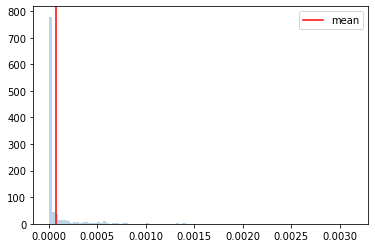

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654370029
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 10.0, 'jump_size_a': 0.1, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:08, 14.60it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:30, 11.05it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<02:03,  8.05it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<02:02,  8.07it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:53,  8.68it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:54,  8.64it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:53,  8.65it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<01:56,  8.41it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:49,  8.96it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:44,  9.38it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:43,  9.43it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:51,  8.74it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:52,  8.67it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<01:58,  8.17it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:19,  6.96it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:05,  7.68it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<01:59,  8.05it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:53,  8.44it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:53,  8.45it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 41/1000 [00:04<01:56,  8.23it/s]

Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<02:21,  6.78it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:08,  7.44it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:02,  7.76it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:56,  8.16it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:02,  7.72it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<01:57,  8.06it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:53,  8.31it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<01:58,  7.97it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:07,  7.39it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:08,  7.32it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:02,  7.67it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:00,  7.75it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:05,  7.44it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:03,  7.54it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:11,  7.07it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:05,  7.36it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:02,  7.57it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:09,  7.12it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:07,  7.20it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:08,  7.18it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:15,  6.75it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:07,  7.17it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:04,  7.34it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:04,  7.35it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:03,  7.37it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:03,  7.36it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:08,  7.03it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:09,  6.95it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:06,  7.14it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:12,  6.77it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:08,  6.96it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:06,  7.06it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:07,  7.01it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:08,  6.93it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:06,  7.00it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:14,  6.62it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:13,  6.63it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:09,  6.84it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:07,  6.91it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:12,  6.62it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:09,  6.78it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:09,  6.78it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:08,  6.80it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:09,  6.73it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:09,  6.70it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:11,  6.59it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:12,  6.53it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:25,  5.92it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:26,  5.89it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:16,  6.28it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:18,  6.18it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:11,  6.51it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:20,  6.09it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:19,  6.11it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:14,  6.33it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<02:22,  5.95it/s]

Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:21<02:26,  5.78it/s]

Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:19,  6.07it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:12,  6.38it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:19,  6.03it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:14,  6.23it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:11,  6.34it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:10,  6.41it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:09,  6.44it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:08,  6.49it/s]

Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:23<02:39,  5.21it/s]

Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:29,  5.55it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:17,  6.02it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:20,  5.88it/s]

Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:22,  5.77it/s]

Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:25<02:25,  5.65it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:21,  5.80it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:19,  5.88it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:14,  6.09it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:14,  6.07it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:19,  5.85it/s]

Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:17,  5.89it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:27<02:16,  5.96it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:13,  6.06it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:27<02:13,  6.07it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:28<02:14,  5.97it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:28<02:17,  5.83it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:20,  5.70it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:17,  5.82it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:29<02:18,  5.75it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████                                                               | 204/1000 [00:29<02:17,  5.79it/s]

Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:22,  5.57it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:24,  5.49it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:21,  5.58it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:31<02:17,  5.72it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:18,  5.68it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:23,  5.48it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:22,  5.50it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:25,  5.37it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:23,  5.45it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:21,  5.49it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:22,  5.46it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:33<02:20,  5.53it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:18,  5.59it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:17,  5.62it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:19,  5.54it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:21,  5.45it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:19,  5.50it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:19,  5.51it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:22,  5.36it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:21,  5.40it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:24,  5.28it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:21,  5.39it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:23,  5.32it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:25,  5.21it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:25,  5.23it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:23,  5.27it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:20,  5.37it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:36<02:18,  5.47it/s]

Monte Carlo 243
Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:19,  5.40it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:17,  5.48it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:37<02:19,  5.37it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:21,  5.28it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:24,  5.19it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:38<02:24,  5.18it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:38<02:21,  5.28it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:22,  5.22it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:24,  5.14it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:39<02:24,  5.12it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:23,  5.16it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:23,  5.16it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:23,  5.13it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:40<02:23,  5.13it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:26,  5.02it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:25,  5.06it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:27,  4.99it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:30,  4.88it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:41<02:29,  4.90it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:31,  4.82it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:30,  4.84it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:29,  4.88it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:29,  4.85it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:26,  4.94it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:25,  4.97it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:23,  5.05it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:44<02:24,  4.97it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:44<02:25,  4.96it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:22,  5.04it/s]

Monte Carlo 281
Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:25,  4.94it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:24,  4.96it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:45<02:29,  4.78it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:29,  4.77it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:27,  4.81it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:46<02:26,  4.84it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:46<02:24,  4.89it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:46<02:28,  4.75it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:47<02:26,  4.83it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:47<02:23,  4.90it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:22,  4.95it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:47<02:22,  4.94it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:47<02:20,  5.01it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:48<02:26,  4.78it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:29,  4.68it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:48<02:26,  4.75it/s]

Monte Carlo 301
Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:48<02:27,  4.71it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:49<02:32,  4.56it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:49<02:30,  4.63it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:49<02:26,  4.74it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:49<02:23,  4.82it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:50<02:24,  4.79it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:50<02:24,  4.77it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:50<02:23,  4.80it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:22,  4.81it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:20,  4.88it/s]

Monte Carlo 314
Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:51<02:25,  4.69it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:39,  4.28it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:37,  4.32it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:35,  4.38it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:53<02:29,  4.53it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:27,  4.59it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:31,  4.46it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:53<02:28,  4.55it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:25,  4.61it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:23,  4.69it/s]

Monte Carlo 327
Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:54<02:23,  4.66it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:54<02:22,  4.71it/s]

Monte Carlo 330
Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:55<02:27,  4.52it/s]

Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:55<02:24,  4.62it/s]

Monte Carlo 333
Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:55<02:25,  4.57it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:24,  4.58it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:31,  4.39it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:56<02:28,  4.44it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:56<02:24,  4.58it/s]

Monte Carlo 339
Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:24,  4.54it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:25,  4.51it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:57<02:28,  4.44it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:57<02:26,  4.48it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:29,  4.39it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:27,  4.43it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:23,  4.54it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:58<02:32,  4.27it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:29,  4.35it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:28,  4.38it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:29,  4.35it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:26,  4.43it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:59<02:26,  4.41it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:23,  4.49it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:29,  4.32it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:26,  4.39it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:00<02:25,  4.41it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:21,  4.52it/s]

Monte Carlo 358
Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:25,  4.40it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:23,  4.44it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:01<02:22,  4.48it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:20,  4.53it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:20,  4.53it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:21,  4.48it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:02<02:23,  4.42it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:26,  4.32it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:28,  4.24it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:30,  4.20it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:03<02:29,  4.21it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:25,  4.32it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:23,  4.37it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:22,  4.41it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:04<02:23,  4.38it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:04<02:23,  4.34it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:24,  4.31it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:22,  4.38it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:21,  4.40it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:05<02:22,  4.35it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:23,  4.32it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:21,  4.37it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:23,  4.30it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:06<02:24,  4.27it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:22,  4.32it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:25,  4.24it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:22,  4.30it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:07<02:26,  4.18it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:26,  4.19it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:31,  4.03it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:28,  4.12it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:08<02:33,  3.96it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:26,  4.15it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:23,  4.22it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:23,  4.23it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:09<02:28,  4.07it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:09<02:26,  4.12it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:21,  4.26it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:19,  4.31it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:17,  4.36it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:10<02:16,  4.38it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:20,  4.26it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:19,  4.28it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:17,  4.33it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:11<02:18,  4.31it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:19,  4.26it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:17,  4.32it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:15,  4.38it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:12<02:16,  4.33it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:12<02:19,  4.23it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:17,  4.30it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:17,  4.30it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:13<02:17,  4.29it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:13<02:18,  4.24it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:17,  4.26it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:16,  4.29it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:14<02:19,  4.19it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:14<02:17,  4.24it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:21,  4.12it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:20,  4.15it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:15<02:18,  4.20it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:15<02:20,  4.13it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:23,  4.02it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:22,  4.05it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:16<02:20,  4.11it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:16<02:24,  3.99it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:23,  3.99it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:21,  4.04it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:17<02:20,  4.07it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:17<02:26,  3.89it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:30,  3.80it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:38,  3.59it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:18<02:50,  3.33it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:44,  3.45it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:49,  3.34it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:50,  3.31it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:19<02:45,  3.41it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:40,  3.50it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:45,  3.40it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:20<03:04,  3.04it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:57,  3.16it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:21<02:46,  3.35it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:21<02:45,  3.38it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:22<02:38,  3.51it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:22<02:34,  3.60it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:22<02:35,  3.56it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:22<02:31,  3.65it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:23<02:36,  3.54it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:23<02:36,  3.53it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:23<02:38,  3.48it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:24<02:39,  3.45it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:34,  3.55it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:24<02:33,  3.57it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:24<02:31,  3.61it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:25<02:34,  3.54it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:32,  3.58it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:25<02:34,  3.52it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:25<02:34,  3.52it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:26<02:37,  3.44it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:37,  3.44it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:26<02:53,  3.12it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:27<02:43,  3.29it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:39,  3.37it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:27<02:43,  3.28it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:28<02:40,  3.33it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:28<02:32,  3.50it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:28<02:43,  3.27it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:29<02:36,  3.41it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:29<02:28,  3.58it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:29<02:27,  3.59it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:29<02:27,  3.60it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:30<02:28,  3.56it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:30<02:28,  3.56it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:30<02:23,  3.66it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:29,  3.51it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:31<02:27,  3.56it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:31<02:22,  3.68it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:31<02:28,  3.53it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:32<02:31,  3.45it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:32<02:33,  3.40it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:32<02:31,  3.44it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:32<02:30,  3.44it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:33<02:29,  3.46it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:33<02:28,  3.47it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:33<02:46,  3.09it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:34<02:46,  3.09it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:34<02:48,  3.05it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:34<02:46,  3.07it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:35<02:43,  3.14it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:35<02:38,  3.23it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:35<02:39,  3.19it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:36<02:38,  3.20it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:36<02:42,  3.13it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:36<02:36,  3.23it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:37<02:35,  3.25it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:37<02:38,  3.19it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:37<02:43,  3.08it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:38<02:43,  3.08it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:38<02:36,  3.20it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:38<02:37,  3.18it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:38<02:39,  3.14it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:39<02:37,  3.18it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:39<02:35,  3.20it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:39<02:36,  3.18it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:40<02:32,  3.26it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:40<02:26,  3.37it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:40<02:21,  3.48it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:41<02:20,  3.50it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:41<02:19,  3.52it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:41<02:21,  3.47it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:41<02:26,  3.35it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:42<02:24,  3.39it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:42<02:20,  3.47it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:42<02:18,  3.51it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:43<02:16,  3.57it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:43<02:18,  3.50it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:43<02:20,  3.44it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:43<02:23,  3.36it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:44<02:28,  3.25it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:44<02:27,  3.26it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:44<02:26,  3.27it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:45<02:22,  3.36it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:45<02:24,  3.31it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:45<02:20,  3.38it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:46<02:22,  3.35it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:46<02:20,  3.38it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:46<02:19,  3.40it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:46<02:19,  3.40it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:47<02:19,  3.38it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:47<02:19,  3.38it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:47<02:18,  3.38it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:48<02:20,  3.34it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:48<02:18,  3.38it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:48<02:17,  3.39it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:49<02:15,  3.44it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:49<02:16,  3.40it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:49<02:17,  3.37it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:49<02:17,  3.37it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:50<02:18,  3.33it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:50<02:16,  3.39it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:50<02:29,  3.07it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:51<02:37,  2.92it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:51<02:30,  3.04it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:51<02:26,  3.12it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:52<02:42,  2.81it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:52<02:33,  2.97it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:52<02:29,  3.03it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:53<02:33,  2.94it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:53<02:26,  3.08it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:53<02:21,  3.18it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:54<02:21,  3.19it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:54<02:19,  3.21it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:54<02:19,  3.22it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:55<02:17,  3.25it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:55<02:15,  3.30it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:55<02:18,  3.22it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:56<02:18,  3.22it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:56<02:17,  3.23it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:56<02:17,  3.21it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:56<02:16,  3.22it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:57<02:20,  3.13it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:57<02:22,  3.08it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:57<02:18,  3.17it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:58<02:16,  3.20it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:58<02:16,  3.19it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:58<02:17,  3.16it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:59<02:16,  3.17it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:59<02:17,  3.15it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:59<02:15,  3.19it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:00<02:14,  3.20it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:00<02:14,  3.20it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:00<02:15,  3.17it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:01<02:16,  3.13it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:01<02:15,  3.16it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:01<02:14,  3.16it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:02<02:14,  3.16it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:02<02:15,  3.13it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:02<02:14,  3.16it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:02<02:11,  3.21it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:03<02:11,  3.21it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:03<02:11,  3.20it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:03<02:11,  3.19it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:04<02:11,  3.18it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:04<02:11,  3.16it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:04<02:11,  3.16it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:05<02:12,  3.14it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:05<02:10,  3.17it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:05<02:09,  3.20it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:06<02:07,  3.23it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:06<02:11,  3.13it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:06<02:11,  3.13it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:07<02:10,  3.14it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:07<02:09,  3.16it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:07<02:10,  3.13it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:08<02:11,  3.09it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:08<02:09,  3.12it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:08<02:08,  3.14it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:09<02:10,  3.08it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:09<02:09,  3.11it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:09<02:09,  3.10it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:09<02:09,  3.08it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:10<02:10,  3.05it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:10<02:10,  3.04it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:10<02:09,  3.06it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:11<02:07,  3.10it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:11<02:07,  3.11it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:11<02:10,  3.01it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:12<02:09,  3.02it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:12<02:08,  3.04it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:12<02:08,  3.04it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:13<02:06,  3.07it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:13<02:04,  3.12it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:13<02:03,  3.13it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:14<02:07,  3.03it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:14<02:08,  2.99it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:14<02:06,  3.05it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:15<02:06,  3.04it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:15<02:03,  3.09it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:15<02:03,  3.09it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:16<02:03,  3.09it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:16<02:02,  3.09it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:16<02:05,  3.01it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:17<02:03,  3.06it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:17<02:03,  3.04it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:17<02:05,  3.01it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:18<02:04,  3.01it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:18<02:04,  3.00it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:18<02:04,  2.99it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:19<02:02,  3.03it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:19<02:02,  3.03it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:19<02:03,  3.00it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:20<02:02,  3.01it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:20<02:04,  2.95it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:20<02:05,  2.93it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:21<02:03,  2.98it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:21<02:02,  2.99it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:21<02:01,  2.99it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:22<02:03,  2.94it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:22<02:03,  2.93it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:22<02:06,  2.85it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:23<02:04,  2.89it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:23<02:01,  2.95it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:23<02:00,  2.97it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:24<01:59,  2.99it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:24<01:58,  3.00it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:24<01:59,  2.98it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:25<02:11,  2.69it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:25<02:04,  2.83it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:26<02:02,  2.86it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:26<02:03,  2.85it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:26<02:04,  2.82it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:27<02:03,  2.82it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:27<02:04,  2.80it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:27<02:00,  2.88it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:28<01:59,  2.90it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:28<02:01,  2.85it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:28<01:58,  2.91it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:29<01:59,  2.87it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:29<01:58,  2.89it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:29<01:58,  2.88it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:30<01:56,  2.92it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:30<01:54,  2.95it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:30<01:56,  2.91it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:31<01:58,  2.84it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:31<01:58,  2.83it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:31<01:57,  2.84it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:32<01:58,  2.82it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:32<01:59,  2.78it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:33<01:58,  2.81it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:33<01:56,  2.85it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:33<01:54,  2.88it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:34<01:54,  2.87it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:34<01:52,  2.90it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:34<01:53,  2.89it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:35<01:52,  2.89it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:35<01:52,  2.88it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:35<01:52,  2.87it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:36<01:50,  2.92it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:36<01:50,  2.92it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:36<01:52,  2.87it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:37<01:52,  2.84it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:37<01:50,  2.88it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:37<01:51,  2.85it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:38<01:50,  2.87it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:38<01:51,  2.84it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:38<01:50,  2.85it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:39<01:48,  2.88it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:39<01:48,  2.88it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:40<01:49,  2.84it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:40<01:51,  2.78it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:40<01:50,  2.79it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:41<01:47,  2.87it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:41<01:46,  2.88it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:41<01:47,  2.85it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:42<01:48,  2.82it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:42<01:46,  2.87it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:42<01:45,  2.87it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:43<01:46,  2.84it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:43<01:47,  2.81it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:43<01:47,  2.79it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:44<01:45,  2.83it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:44<01:45,  2.82it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:44<01:44,  2.86it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:45<01:44,  2.85it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:45<01:43,  2.86it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:46<01:45,  2.79it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:46<01:44,  2.81it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:46<01:45,  2.77it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:47<01:46,  2.75it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:47<01:45,  2.76it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:47<01:45,  2.75it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:48<01:43,  2.80it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:48<01:41,  2.83it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:48<01:42,  2.80it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:49<01:40,  2.84it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:49<01:38,  2.88it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:49<01:35,  2.97it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:50<01:33,  3.02it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:50<01:33,  3.02it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:50<01:33,  3.00it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:51<01:33,  2.99it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:51<01:32,  3.01it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:51<01:30,  3.06it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:52<01:31,  3.04it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:52<01:32,  3.00it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:52<01:31,  3.00it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:53<01:32,  2.98it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:53<01:30,  3.00it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:53<01:30,  3.01it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:54<01:30,  3.00it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:54<01:31,  2.97it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:54<01:30,  2.98it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:55<01:30,  2.98it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:55<01:29,  3.00it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:55<01:29,  2.99it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:56<01:30,  2.94it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:56<01:30,  2.91it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:56<01:29,  2.93it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:57<01:27,  2.98it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:57<01:28,  2.96it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:57<01:27,  2.97it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:58<01:28,  2.94it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:58<01:29,  2.87it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:58<01:27,  2.92it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:59<01:28,  2.89it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:59<01:28,  2.89it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:59<01:27,  2.90it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:00<01:28,  2.85it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:00<01:27,  2.88it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:01<01:25,  2.94it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:01<01:25,  2.93it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:01<01:25,  2.91it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:02<01:25,  2.89it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:02<01:27,  2.81it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:02<01:27,  2.82it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:03<01:25,  2.86it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:03<01:24,  2.87it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:03<01:23,  2.91it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:04<01:23,  2.89it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:04<01:24,  2.86it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:04<01:25,  2.81it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:05<01:25,  2.81it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:05<01:26,  2.74it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:06<01:27,  2.70it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:06<01:26,  2.73it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:06<01:29,  2.64it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:07<01:28,  2.64it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:07<01:39,  2.35it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:08<01:35,  2.43it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:08<01:31,  2.51it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:08<01:30,  2.53it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:09<01:28,  2.59it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:09<01:26,  2.64it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:09<01:25,  2.64it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:10<01:26,  2.62it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:10<01:27,  2.57it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:11<01:25,  2.61it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:11<01:24,  2.62it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:11<01:24,  2.62it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:12<01:23,  2.64it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:12<01:22,  2.68it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:12<01:22,  2.64it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:13<01:23,  2.63it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:13<01:22,  2.62it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:14<01:24,  2.56it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:14<01:22,  2.60it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:14<01:22,  2.60it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:15<01:23,  2.56it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:15<01:21,  2.59it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:16<01:20,  2.61it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:16<01:21,  2.56it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:16<01:22,  2.54it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:17<01:20,  2.59it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:17<01:21,  2.53it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:18<01:21,  2.51it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:18<01:22,  2.49it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:18<01:21,  2.50it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:19<01:19,  2.56it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:19<01:17,  2.60it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:20<01:18,  2.58it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:20<01:18,  2.56it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:20<01:17,  2.57it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:21<01:17,  2.55it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:21<01:16,  2.57it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:21<01:17,  2.54it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:22<01:15,  2.58it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:22<01:16,  2.53it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:23<01:16,  2.51it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:23<01:15,  2.53it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:23<01:15,  2.52it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:24<01:15,  2.50it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:24<01:14,  2.54it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:25<01:13,  2.57it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:25<01:12,  2.56it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:25<01:13,  2.52it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:26<01:13,  2.50it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:26<01:14,  2.47it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:27<01:12,  2.51it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:27<01:12,  2.49it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:27<01:13,  2.47it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:28<01:13,  2.45it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:28<01:12,  2.48it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:29<01:10,  2.52it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:29<01:10,  2.52it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:30<01:12,  2.42it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:30<01:12,  2.41it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:30<01:12,  2.41it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:31<01:12,  2.39it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:31<01:12,  2.38it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:32<01:13,  2.34it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:32<01:12,  2.34it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:32<01:11,  2.37it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:33<01:11,  2.35it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:33<01:09,  2.39it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:34<01:09,  2.38it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:34<01:08,  2.40it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:35<01:07,  2.44it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:35<01:06,  2.45it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:35<01:05,  2.48it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:36<01:04,  2.49it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:36<01:04,  2.47it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:37<01:03,  2.50it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:37<01:04,  2.45it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:37<01:04,  2.43it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:38<01:03,  2.45it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:38<01:02,  2.47it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:39<01:02,  2.48it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:39<01:02,  2.46it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:39<01:01,  2.49it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:40<01:00,  2.49it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:40<01:00,  2.49it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:41<00:59,  2.50it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:41<01:00,  2.46it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:41<01:00,  2.45it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:42<00:59,  2.46it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:42<01:04,  2.26it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:43<01:03,  2.28it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:43<01:01,  2.32it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:44<00:59,  2.38it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:44<00:58,  2.42it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:44<00:57,  2.44it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:45<00:56,  2.45it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:45<00:56,  2.46it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:46<00:56,  2.43it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:46<00:55,  2.45it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:46<00:56,  2.41it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:47<00:56,  2.39it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:47<00:55,  2.40it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:48<00:54,  2.40it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:48<00:54,  2.41it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:49<00:55,  2.34it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:49<00:55,  2.31it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:49<00:54,  2.36it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:50<00:53,  2.36it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:50<00:53,  2.37it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:51<00:53,  2.34it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:51<00:52,  2.36it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:52<00:52,  2.36it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:52<00:51,  2.39it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:52<00:50,  2.40it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:53<00:52,  2.31it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:53<00:51,  2.32it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:54<00:50,  2.33it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:54<00:49,  2.37it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:55<00:49,  2.35it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:55<00:48,  2.35it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:55<00:48,  2.37it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:56<00:48,  2.35it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:56<00:47,  2.35it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:57<00:47,  2.32it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:57<00:46,  2.35it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:57<00:45,  2.42it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:58<00:43,  2.47it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:58<00:42,  2.51it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:59<00:41,  2.55it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:59<00:41,  2.53it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:59<00:41,  2.49it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:00<00:41,  2.49it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:00<00:40,  2.49it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:01<00:40,  2.52it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:01<00:39,  2.55it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:01<00:38,  2.54it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:02<00:38,  2.56it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:02<00:37,  2.57it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:03<00:37,  2.53it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:03<00:38,  2.48it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:03<00:38,  2.46it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:04<00:38,  2.45it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:04<00:37,  2.43it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:05<00:36,  2.46it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:05<00:36,  2.45it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:05<00:36,  2.45it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:06<00:35,  2.48it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:06<00:34,  2.50it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:07<00:34,  2.49it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:07<00:35,  2.42it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:07<00:34,  2.43it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:08<00:34,  2.38it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:08<00:34,  2.39it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:09<00:34,  2.37it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:09<00:34,  2.35it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:10<00:33,  2.33it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:10<00:34,  2.28it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:11<00:33,  2.30it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:11<00:33,  2.26it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:11<00:33,  2.25it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:12<00:32,  2.25it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:12<00:32,  2.27it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:13<00:31,  2.25it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:13<00:31,  2.28it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:14<00:30,  2.27it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:14<00:30,  2.26it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:15<00:30,  2.24it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:15<00:29,  2.25it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:15<00:28,  2.29it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:16<00:28,  2.27it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:16<00:28,  2.22it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:17<00:27,  2.25it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:17<00:27,  2.25it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:18<00:27,  2.26it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:18<00:27,  2.22it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:19<00:26,  2.20it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:19<00:26,  2.20it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:19<00:25,  2.26it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:20<00:24,  2.26it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:20<00:24,  2.29it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:21<00:23,  2.30it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:21<00:23,  2.30it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:22<00:22,  2.30it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:22<00:22,  2.26it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:23<00:22,  2.20it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:23<00:22,  2.14it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:23<00:21,  2.18it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:24<00:21,  2.20it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:24<00:20,  2.24it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:25<00:20,  2.22it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:25<00:19,  2.22it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:26<00:19,  2.20it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:26<00:19,  2.17it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:27<00:19,  2.15it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:27<00:18,  2.15it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:28<00:18,  2.16it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:28<00:17,  2.20it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:28<00:16,  2.18it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:29<00:16,  2.20it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:29<00:15,  2.23it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:30<00:15,  2.18it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:30<00:16,  2.05it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:31<00:15,  2.11it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:31<00:14,  2.12it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:32<00:13,  2.16it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:32<00:13,  2.20it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:33<00:12,  2.19it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:33<00:12,  2.18it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:34<00:11,  2.17it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:34<00:11,  2.09it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:35<00:11,  2.08it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:35<00:10,  2.11it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:36<00:10,  2.11it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:36<00:09,  2.18it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:36<00:08,  2.23it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:37<00:08,  2.27it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:37<00:08,  2.22it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:38<00:07,  2.15it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:38<00:07,  2.14it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:39<00:06,  2.18it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:39<00:06,  2.23it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:40<00:05,  2.23it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:40<00:05,  2.27it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:40<00:04,  2.25it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:41<00:04,  2.26it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:41<00:04,  2.19it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:42<00:03,  2.24it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:42<00:03,  2.23it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:43<00:02,  2.18it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:43<00:02,  2.21it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:44<00:01,  2.22it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:44<00:01,  2.24it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:45<00:00,  2.20it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:45<00:00,  2.18it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:45<00:00,  3.50it/s]


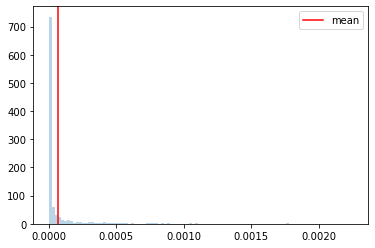

  0%|▏                                                                                | 3/1000 [00:00<01:00, 16.35it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654370316
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 10.0, 'jump_size_a': 0.1, 'jump_size_b': 1.0}


Problem
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 10.0, 'jump_size_a': 0.1, 'jump_size_b': 1.0}
New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654370316
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 10.0, 'jump_size_a': 0.1, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:32, 10.80it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▌                                                                                | 7/1000 [00:00<01:39,  9.97it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:55,  8.55it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<02:00,  8.23it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:54,  8.64it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:54,  8.63it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:53,  8.69it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:52,  8.69it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:52,  8.70it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:51,  8.77it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:54,  8.50it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:58,  8.19it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:02,  7.91it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:17,  7.06it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<02:03,  7.83it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<01:55,  8.34it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:57,  8.18it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:55,  8.35it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<02:00,  7.94it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<02:11,  7.28it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<02:03,  7.72it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:51,  8.51it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:05<01:54,  8.32it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<01:58,  8.00it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▏                                                                           | 53/1000 [00:06<01:57,  8.05it/s]

Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:18,  6.80it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<02:05,  7.51it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<01:57,  8.00it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:55,  8.14it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<01:54,  8.15it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<01:51,  8.37it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<01:57,  7.94it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<01:57,  7.90it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:00,  7.70it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<01:58,  7.85it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<01:58,  7.78it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:00,  7.66it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:00,  7.62it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:02,  7.49it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<01:58,  7.76it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<01:58,  7.75it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<02:00,  7.56it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:02,  7.44it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:05,  7.22it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:07,  7.12it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<02:04,  7.27it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:02,  7.36it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:05,  7.17it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:02,  7.32it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:09,  6.94it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:08,  6.98it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:09,  6.89it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:12,  6.72it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:09,  6.89it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:11,  6.77it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:11,  6.74it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:13,  6.61it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:15,  6.49it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:11,  6.67it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:05,  6.97it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:07,  6.89it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:08,  6.78it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:08,  6.75it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:09,  6.70it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:17,  6.31it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<02:16,  6.32it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:14,  6.41it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:12,  6.50it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:17,  6.24it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:12,  6.45it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:18,  6.17it/s]

Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:19<02:14,  6.35it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:19<02:23,  5.93it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:20<02:22,  5.95it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:20<02:14,  6.31it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:20<02:19,  6.06it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:21<02:16,  6.20it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:21<02:19,  6.02it/s]

Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<02:25,  5.78it/s]

Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:21<02:23,  5.85it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:22,  5.87it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:22<02:20,  5.95it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:22<02:22,  5.84it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:27,  5.65it/s]

Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:32,  5.45it/s]

Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:23<02:30,  5.50it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:24<02:32,  5.43it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:30,  5.51it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:20,  5.86it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:47,  4.91it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:38,  5.18it/s]

Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:27,  5.55it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:26<02:18,  5.89it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:17,  5.91it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:19,  5.84it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:27<02:14,  6.02it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:11,  6.17it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:27<02:13,  6.04it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:28<02:16,  5.90it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:28<02:23,  5.58it/s]

Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:24,  5.54it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:19,  5.74it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:19,  5.74it/s]

Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:29<02:19,  5.70it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:17,  5.78it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:30<02:23,  5.51it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:19,  5.67it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:14,  5.88it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:31<02:18,  5.68it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:24,  5.42it/s]

Monte Carlo 213
Monte Carlo 214


 22%|████████████████▉                                                              | 215/1000 [00:31<02:32,  5.15it/s]

Monte Carlo 215


 22%|█████████████████                                                              | 216/1000 [00:31<02:41,  4.85it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 217/1000 [00:32<02:48,  4.63it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:38,  4.92it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:32,  5.13it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:33<02:29,  5.21it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:33<02:29,  5.21it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:27,  5.25it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:33<02:23,  5.40it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:34<02:26,  5.27it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:34<02:28,  5.18it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████                                                             | 229/1000 [00:34<02:36,  4.93it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:34,  4.99it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:35<02:34,  4.96it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:34,  4.95it/s]

Monte Carlo 232
Monte Carlo 233


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:41,  4.74it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:37,  4.86it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▋                                                            | 237/1000 [00:36<02:40,  4.74it/s]

Monte Carlo 237


 24%|██████████████████▊                                                            | 238/1000 [00:36<02:41,  4.72it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:43,  4.66it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:40,  4.73it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:37<02:39,  4.75it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:37<02:38,  4.77it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:34,  4.90it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:36,  4.84it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:38<02:37,  4.79it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▌                                                           | 248/1000 [00:38<02:38,  4.73it/s]

Monte Carlo 248


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:39,  4.70it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:39<02:36,  4.79it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 252/1000 [00:39<02:36,  4.78it/s]

Monte Carlo 252


 25%|███████████████████▉                                                           | 253/1000 [00:39<02:40,  4.66it/s]

Monte Carlo 253


 25%|████████████████████                                                           | 254/1000 [00:39<02:42,  4.59it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:40<02:41,  4.61it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:40<02:42,  4.57it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▍                                                          | 259/1000 [00:40<02:40,  4.63it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:41<02:38,  4.67it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:41<02:33,  4.81it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 263/1000 [00:41<02:34,  4.77it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:42<02:32,  4.83it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:42<02:32,  4.80it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:42<02:31,  4.85it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▏                                                         | 268/1000 [00:42<02:32,  4.80it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:43<02:27,  4.96it/s]

Monte Carlo 269
Monte Carlo 270


 27%|█████████████████████▍                                                         | 271/1000 [00:43<02:33,  4.75it/s]

Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:43<02:39,  4.57it/s]

Monte Carlo 272


 27%|█████████████████████▌                                                         | 273/1000 [00:43<02:43,  4.45it/s]

Monte Carlo 273


 27%|█████████████████████▋                                                         | 274/1000 [00:44<02:46,  4.37it/s]

Monte Carlo 274


 28%|█████████████████████▋                                                         | 275/1000 [00:44<02:53,  4.18it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:44<02:47,  4.33it/s]

Monte Carlo 276
Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:45<02:55,  4.12it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:45<02:53,  4.15it/s]

Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:45<03:05,  3.87it/s]

Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:45<03:02,  3.95it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:46<03:02,  3.94it/s]

Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:46<02:55,  4.09it/s]

Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:46<02:55,  4.08it/s]

Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:46<02:50,  4.20it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:47<03:08,  3.79it/s]

Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:47<03:01,  3.93it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:47<02:54,  4.08it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:47<02:48,  4.23it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:48<02:37,  4.50it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:48<02:33,  4.63it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:48<02:36,  4.51it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:48<02:44,  4.30it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:49<02:36,  4.51it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:49<02:38,  4.42it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:49<02:39,  4.41it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:49<02:41,  4.35it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:50<02:40,  4.37it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:50<02:41,  4.33it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:50<02:38,  4.39it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:50<02:43,  4.26it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:51<02:39,  4.37it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:51<02:42,  4.28it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:51<02:33,  4.51it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:52<03:05,  3.72it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:52<02:59,  3.85it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:52<02:54,  3.96it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:52<02:56,  3.89it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:53<02:55,  3.91it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:53<02:46,  4.14it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:53<02:47,  4.11it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:53<02:45,  4.15it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:54<02:48,  4.05it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:54<02:47,  4.07it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:54<02:43,  4.17it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:55<02:30,  4.51it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:55<02:27,  4.60it/s]

Monte Carlo 320
Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:55<02:27,  4.58it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:56<02:26,  4.60it/s]

Monte Carlo 324
Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:56<02:25,  4.63it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:56<02:20,  4.77it/s]

Monte Carlo 327
Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:56<02:29,  4.48it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:57<02:30,  4.45it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:57<02:33,  4.37it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:57<02:32,  4.38it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:57<02:33,  4.34it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:58<02:34,  4.32it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:58<02:27,  4.49it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:58<02:25,  4.55it/s]

Monte Carlo 336


 34%|██████████████████████████▋                                                    | 338/1000 [00:59<02:25,  4.54it/s]

Monte Carlo 337
Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:59<02:33,  4.31it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:59<02:30,  4.39it/s]

Monte Carlo 340


 34%|███████████████████████████                                                    | 342/1000 [00:59<02:24,  4.55it/s]

Monte Carlo 341
Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [01:00<02:24,  4.55it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [01:00<02:30,  4.36it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:00<02:30,  4.36it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:00<02:28,  4.41it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:01<02:24,  4.51it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:01<02:25,  4.50it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:01<02:24,  4.51it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:01<02:21,  4.60it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:01<02:21,  4.58it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:02<02:22,  4.55it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:02<02:21,  4.57it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:02<02:26,  4.41it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 356/1000 [01:03<02:24,  4.45it/s]

Monte Carlo 355
Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:03<02:25,  4.42it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:03<02:31,  4.24it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:03<02:30,  4.26it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:04<02:31,  4.22it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:04<02:30,  4.24it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:04<02:31,  4.21it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:04<02:29,  4.26it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:04<02:31,  4.21it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:05<02:26,  4.33it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:05<02:28,  4.28it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:05<02:23,  4.41it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:05<02:27,  4.30it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:06<02:24,  4.36it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:06<02:26,  4.30it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:06<02:31,  4.15it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:06<02:29,  4.19it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:07<02:25,  4.29it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:07<02:25,  4.31it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:07<02:22,  4.37it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:07<02:26,  4.27it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 378/1000 [01:08<02:22,  4.37it/s]

Monte Carlo 377
Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:08<02:21,  4.38it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 381/1000 [01:08<02:13,  4.65it/s]

Monte Carlo 380
Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:09<02:11,  4.71it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:09<02:14,  4.58it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:09<02:16,  4.50it/s]

Monte Carlo 384


 39%|██████████████████████████████▍                                                | 386/1000 [01:09<02:13,  4.58it/s]

Monte Carlo 385
Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:10<02:15,  4.53it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 389/1000 [01:10<02:12,  4.60it/s]

Monte Carlo 388
Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:10<02:14,  4.52it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 392/1000 [01:11<02:12,  4.59it/s]

Monte Carlo 391


 39%|███████████████████████████████                                                | 393/1000 [01:11<02:10,  4.67it/s]

Monte Carlo 392
Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:11<02:12,  4.57it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:11<02:12,  4.56it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:12<02:14,  4.49it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:12<02:13,  4.53it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:12<02:10,  4.62it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:12<02:12,  4.52it/s]

Monte Carlo 399


 40%|███████████████████████████████▋                                               | 401/1000 [01:13<02:10,  4.58it/s]

Monte Carlo 400
Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:13<02:11,  4.55it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:13<02:10,  4.56it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:13<02:10,  4.56it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:14<02:11,  4.51it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:14<02:13,  4.45it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:14<02:15,  4.36it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:14<02:22,  4.16it/s]

Monte Carlo 408


 41%|████████████████████████████████▍                                              | 410/1000 [01:15<02:12,  4.47it/s]

Monte Carlo 409
Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:15<02:11,  4.48it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:15<02:13,  4.42it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:15<02:14,  4.35it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:16<02:14,  4.37it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:16<02:14,  4.36it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:16<02:14,  4.35it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:16<02:15,  4.30it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:17<02:15,  4.29it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:17<02:12,  4.38it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:17<02:11,  4.42it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:17<02:13,  4.33it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:18<02:10,  4.41it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:18<02:08,  4.47it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:18<02:15,  4.26it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:18<02:16,  4.23it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:18<02:15,  4.23it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:19<02:13,  4.29it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:19<02:14,  4.25it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:19<02:13,  4.29it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:19<02:13,  4.28it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:20<02:13,  4.27it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:20<02:14,  4.23it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:20<02:10,  4.36it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:20<02:11,  4.30it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:21<02:14,  4.20it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:21<02:15,  4.17it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:21<02:15,  4.17it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:21<02:23,  3.91it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:22<02:19,  4.03it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:22<02:16,  4.10it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:22<02:17,  4.06it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:22<02:36,  3.56it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:23<02:31,  3.69it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:23<02:25,  3.82it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:23<02:27,  3.75it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:23<02:28,  3.74it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:24<02:26,  3.77it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:24<02:25,  3.80it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:24<02:26,  3.76it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:25<02:23,  3.84it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:25<02:24,  3.80it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:25<02:21,  3.87it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:25<02:20,  3.88it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:26<02:24,  3.79it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:26<02:25,  3.74it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:26<02:23,  3.78it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:26<02:24,  3.75it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:27<02:22,  3.80it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:27<02:19,  3.87it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:27<02:17,  3.91it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:27<02:17,  3.92it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:28<02:15,  3.97it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:28<02:20,  3.82it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:28<02:20,  3.81it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:29<02:30,  3.57it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:29<02:30,  3.54it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:29<02:26,  3.64it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:29<02:23,  3.72it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:30<02:19,  3.81it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:30<02:19,  3.80it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:30<02:23,  3.69it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:30<02:19,  3.79it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:31<02:20,  3.74it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:31<02:19,  3.77it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:31<02:26,  3.59it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:31<02:23,  3.65it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:32<02:25,  3.60it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:32<02:27,  3.54it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:32<02:26,  3.55it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:33<02:22,  3.64it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:33<02:20,  3.69it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:33<02:26,  3.53it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:33<02:26,  3.52it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:34<02:26,  3.52it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:34<02:22,  3.61it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:34<02:22,  3.61it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:35<02:20,  3.66it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:35<02:17,  3.72it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:35<02:19,  3.66it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:35<02:20,  3.62it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:36<02:21,  3.60it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:36<02:22,  3.57it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:36<02:21,  3.59it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:36<02:19,  3.63it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:37<02:17,  3.67it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:37<02:17,  3.65it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:37<02:19,  3.60it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:38<02:27,  3.40it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:38<02:28,  3.38it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:38<02:30,  3.32it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:39<02:33,  3.25it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:39<02:33,  3.25it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:39<02:29,  3.32it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:39<02:29,  3.33it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:40<02:25,  3.39it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:40<02:23,  3.45it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:40<02:23,  3.43it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:41<02:28,  3.31it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:41<02:25,  3.36it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:41<02:25,  3.37it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:42<02:24,  3.39it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:42<02:23,  3.41it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:42<02:20,  3.47it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:42<02:22,  3.41it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:43<02:19,  3.47it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:43<02:16,  3.54it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:43<02:14,  3.60it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:43<02:12,  3.63it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:44<02:12,  3.62it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:44<02:16,  3.52it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:44<02:14,  3.57it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:45<02:17,  3.47it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:45<02:21,  3.38it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:45<02:22,  3.35it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:46<02:17,  3.44it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:46<02:23,  3.30it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:46<02:28,  3.19it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:46<02:27,  3.20it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:47<02:24,  3.26it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:47<02:23,  3.27it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:47<02:21,  3.32it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:48<02:18,  3.37it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:48<02:15,  3.43it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:48<02:18,  3.35it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:49<02:21,  3.29it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:49<02:22,  3.26it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:49<02:18,  3.34it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:49<02:17,  3.36it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:50<02:14,  3.42it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:50<02:13,  3.44it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:50<02:13,  3.43it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:51<02:13,  3.42it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:51<02:12,  3.44it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:51<02:17,  3.31it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:52<02:16,  3.33it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:52<02:18,  3.27it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:52<02:19,  3.25it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:53<02:34,  2.92it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:53<02:32,  2.96it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:53<02:25,  3.10it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:53<02:19,  3.22it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:54<02:21,  3.16it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:54<02:18,  3.23it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:54<02:17,  3.24it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:55<02:17,  3.22it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:55<02:15,  3.28it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:55<02:15,  3.27it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:56<02:17,  3.22it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:56<02:18,  3.19it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:56<02:14,  3.27it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:57<02:11,  3.33it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:57<02:11,  3.34it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:57<02:13,  3.27it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:57<02:10,  3.33it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:58<02:11,  3.30it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:58<02:13,  3.26it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:58<02:14,  3.21it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:59<02:11,  3.28it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:59<02:10,  3.30it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:59<02:08,  3.34it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:00<02:09,  3.30it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:00<02:11,  3.25it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:00<02:11,  3.25it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:01<02:12,  3.21it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:01<02:14,  3.15it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:01<02:17,  3.09it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:02<02:13,  3.16it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:02<02:15,  3.11it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:02<02:14,  3.12it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:02<02:13,  3.14it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:03<02:12,  3.17it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:03<02:08,  3.25it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:03<02:12,  3.16it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:04<02:23,  2.90it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:04<02:20,  2.96it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:04<02:15,  3.06it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:05<02:15,  3.06it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:05<02:16,  3.02it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:05<02:12,  3.11it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:06<02:09,  3.18it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:06<02:08,  3.18it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:06<02:05,  3.25it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:07<02:03,  3.30it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:07<02:06,  3.21it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:07<02:06,  3.20it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:08<02:04,  3.24it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:08<02:05,  3.22it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:08<02:04,  3.22it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:08<02:05,  3.20it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:09<02:05,  3.18it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:09<02:03,  3.22it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:09<02:02,  3.24it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:10<02:03,  3.23it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:10<02:02,  3.22it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:10<02:03,  3.19it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:11<02:02,  3.22it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:11<01:59,  3.29it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:11<02:00,  3.27it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:12<01:57,  3.33it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:12<01:58,  3.28it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:12<01:58,  3.29it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:12<01:56,  3.33it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:13<01:55,  3.36it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:13<02:01,  3.19it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:13<01:57,  3.29it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:14<01:58,  3.23it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:14<01:57,  3.26it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:14<01:56,  3.29it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:15<01:57,  3.24it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:15<01:59,  3.17it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:15<01:57,  3.22it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:16<01:56,  3.23it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:16<01:58,  3.18it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:16<01:59,  3.15it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:17<01:58,  3.16it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:17<01:57,  3.18it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:17<02:01,  3.07it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:18<02:02,  3.02it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:18<02:01,  3.04it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:18<02:00,  3.06it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:19<02:00,  3.07it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:19<02:00,  3.05it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:19<02:01,  3.02it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:19<01:59,  3.05it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:20<01:59,  3.05it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:20<02:00,  3.02it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:21<02:05,  2.89it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:21<02:04,  2.91it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:21<02:05,  2.88it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:22<02:01,  2.95it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:22<02:01,  2.96it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:22<01:59,  3.00it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:23<01:58,  3.01it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:23<01:59,  2.98it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:23<01:56,  3.05it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:24<01:57,  3.01it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:24<01:58,  2.98it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:24<01:58,  2.97it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:25<01:58,  2.95it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:25<02:02,  2.86it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:25<01:58,  2.95it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:26<02:08,  2.71it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:26<02:03,  2.80it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:26<02:02,  2.83it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:27<02:02,  2.83it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:27<01:58,  2.91it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:27<01:56,  2.94it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:28<01:55,  2.95it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:28<01:55,  2.95it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:28<01:55,  2.95it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:29<01:56,  2.91it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:29<01:53,  2.98it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:29<01:51,  3.01it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:30<01:52,  2.98it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:30<01:53,  2.95it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:30<01:50,  3.01it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:31<01:51,  2.98it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:31<01:55,  2.87it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:31<01:53,  2.92it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:32<01:52,  2.93it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:32<01:53,  2.90it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:32<01:54,  2.85it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:33<01:55,  2.83it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:33<01:52,  2.90it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:34<01:51,  2.92it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:34<01:50,  2.92it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:34<01:50,  2.91it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:35<01:48,  2.95it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:35<01:48,  2.97it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:35<01:48,  2.94it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:36<01:48,  2.94it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:36<01:49,  2.91it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:36<01:49,  2.90it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:37<01:49,  2.88it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:37<01:50,  2.85it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:37<01:49,  2.86it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:38<01:49,  2.87it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:38<01:47,  2.90it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:38<01:48,  2.87it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:39<01:47,  2.88it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:39<01:47,  2.89it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:39<01:46,  2.88it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:40<01:45,  2.90it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:40<01:45,  2.90it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:40<01:46,  2.87it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:41<01:46,  2.85it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:41<01:44,  2.89it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:41<01:43,  2.91it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:42<01:44,  2.88it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:42<01:43,  2.90it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:43<01:43,  2.89it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:43<01:43,  2.88it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:43<01:44,  2.83it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:44<01:42,  2.88it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:44<01:44,  2.83it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:44<01:44,  2.80it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:45<01:46,  2.74it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:45<01:46,  2.74it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:45<01:45,  2.75it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:46<01:49,  2.66it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:46<01:46,  2.72it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:47<01:47,  2.69it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:47<01:47,  2.66it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:47<01:46,  2.68it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:48<01:42,  2.77it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:48<01:41,  2.81it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:48<01:42,  2.77it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:49<01:41,  2.77it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:49<01:43,  2.73it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:49<01:41,  2.77it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:50<01:40,  2.77it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:50<01:37,  2.86it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:50<01:37,  2.84it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:51<01:34,  2.91it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:51<01:33,  2.93it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:51<01:32,  2.95it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:52<01:32,  2.95it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:52<01:34,  2.87it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:53<01:34,  2.87it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:53<01:34,  2.86it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:53<01:35,  2.82it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:54<01:36,  2.79it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:54<01:33,  2.84it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:54<01:33,  2.86it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:55<01:32,  2.87it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:55<01:32,  2.86it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:55<01:32,  2.85it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:56<01:30,  2.88it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:56<01:29,  2.92it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:56<01:29,  2.92it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:57<01:30,  2.88it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:57<01:28,  2.92it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:57<01:27,  2.92it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:58<01:27,  2.94it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:58<01:25,  2.97it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:58<01:28,  2.89it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:59<01:26,  2.92it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:59<01:25,  2.94it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:59<01:26,  2.91it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:00<01:28,  2.84it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:00<01:30,  2.76it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:01<01:31,  2.72it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:01<01:29,  2.75it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:01<01:28,  2.77it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:02<01:28,  2.76it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:02<01:27,  2.78it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:02<01:29,  2.71it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:03<01:29,  2.70it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:03<01:28,  2.72it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:04<01:30,  2.66it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:04<01:29,  2.68it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:04<01:27,  2.73it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:05<01:28,  2.68it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:05<01:28,  2.66it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:05<01:27,  2.67it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:06<01:29,  2.62it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:06<01:29,  2.60it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:07<01:27,  2.64it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:07<01:35,  2.41it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:07<01:31,  2.51it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:08<01:31,  2.49it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:08<01:31,  2.49it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:09<01:29,  2.53it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:09<01:27,  2.58it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:09<01:25,  2.62it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:10<01:27,  2.57it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:10<01:25,  2.59it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:10<01:25,  2.60it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:11<01:25,  2.59it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:11<01:23,  2.62it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:12<01:24,  2.60it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:12<01:24,  2.58it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:12<01:23,  2.61it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:13<01:23,  2.57it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:13<01:22,  2.61it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:14<01:21,  2.62it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:14<01:21,  2.63it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:14<01:20,  2.64it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:15<01:21,  2.59it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:15<01:20,  2.62it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:15<01:21,  2.56it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:16<01:22,  2.51it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:16<01:22,  2.51it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:17<01:20,  2.55it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:17<01:19,  2.57it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:17<01:19,  2.57it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:18<01:19,  2.56it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:18<01:17,  2.59it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:19<01:17,  2.58it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:19<01:17,  2.57it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:19<01:18,  2.54it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:20<01:18,  2.53it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:20<01:19,  2.48it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:21<01:18,  2.49it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:21<01:17,  2.50it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:21<01:17,  2.51it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:22<01:16,  2.52it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:22<01:14,  2.56it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:23<01:16,  2.51it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:23<01:17,  2.46it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:23<01:15,  2.51it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:24<01:15,  2.48it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:24<01:15,  2.49it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:25<01:13,  2.53it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:25<01:12,  2.56it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:25<01:13,  2.51it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:26<01:12,  2.52it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:26<01:11,  2.53it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:27<01:11,  2.54it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:27<01:11,  2.51it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:27<01:11,  2.50it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:28<01:12,  2.47it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:28<01:11,  2.49it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:29<01:11,  2.46it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:29<01:12,  2.42it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:29<01:10,  2.46it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:30<01:09,  2.47it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:30<01:09,  2.49it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:31<01:08,  2.51it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:31<01:08,  2.49it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:31<01:11,  2.36it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:32<01:12,  2.32it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:32<01:10,  2.38it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:33<01:08,  2.42it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:33<01:07,  2.45it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:34<01:06,  2.48it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:34<01:07,  2.42it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:34<01:06,  2.45it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:35<01:05,  2.47it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:35<01:05,  2.43it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:36<01:05,  2.41it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:36<01:04,  2.44it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:36<01:04,  2.45it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:37<01:04,  2.43it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:37<01:04,  2.42it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:38<01:02,  2.45it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:38<01:02,  2.44it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:38<01:02,  2.44it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:39<01:01,  2.45it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:39<01:00,  2.46it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:40<00:59,  2.49it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:40<00:59,  2.51it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:40<00:59,  2.49it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:41<00:58,  2.48it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:41<00:58,  2.46it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:42<00:58,  2.45it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:42<00:57,  2.47it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:42<00:56,  2.50it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:43<00:56,  2.48it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:43<00:58,  2.41it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:44<00:56,  2.45it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:44<00:55,  2.47it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:45<00:55,  2.45it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:45<00:56,  2.41it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:45<00:55,  2.41it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:46<00:55,  2.42it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:46<00:54,  2.43it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:47<00:54,  2.44it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:47<00:55,  2.36it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:47<00:54,  2.40it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:48<00:53,  2.40it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:48<00:53,  2.39it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:49<00:53,  2.39it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:49<00:52,  2.41it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:50<00:51,  2.41it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:50<00:50,  2.43it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:50<00:50,  2.44it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:51<00:49,  2.48it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:51<00:47,  2.53it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:52<00:47,  2.53it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:52<00:46,  2.58it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:52<00:46,  2.55it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:53<00:49,  2.36it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:53<00:47,  2.43it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:54<00:46,  2.45it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:54<00:45,  2.48it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:54<00:47,  2.40it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:55<00:45,  2.44it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:55<00:45,  2.44it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:56<00:45,  2.43it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:56<00:44,  2.45it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:56<00:43,  2.50it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:57<00:42,  2.52it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:57<00:41,  2.55it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:58<00:42,  2.47it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:58<00:42,  2.42it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:58<00:41,  2.47it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:59<00:40,  2.49it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:59<00:41,  2.46it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:00<00:40,  2.47it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:00<00:39,  2.50it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:00<00:38,  2.52it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:01<00:38,  2.50it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:01<00:38,  2.52it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:02<00:38,  2.44it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:02<00:37,  2.48it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:02<00:37,  2.50it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:03<00:38,  2.41it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:03<00:37,  2.45it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:04<00:36,  2.47it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:04<00:36,  2.45it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:04<00:35,  2.47it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:05<00:35,  2.45it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:05<00:35,  2.41it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:06<00:35,  2.42it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:06<00:35,  2.36it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:07<00:35,  2.34it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:07<00:35,  2.34it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:07<00:34,  2.33it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:08<00:33,  2.37it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:08<00:33,  2.33it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:09<00:33,  2.34it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:09<00:33,  2.28it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:10<00:32,  2.30it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:10<00:32,  2.33it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:11<00:31,  2.32it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:11<00:32,  2.28it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:11<00:31,  2.29it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:12<00:31,  2.29it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:12<00:31,  2.25it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:13<00:30,  2.25it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:13<00:30,  2.25it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:14<00:30,  2.23it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:14<00:29,  2.25it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:14<00:28,  2.28it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:15<00:27,  2.31it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:15<00:26,  2.36it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:16<00:26,  2.37it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:16<00:25,  2.39it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:17<00:25,  2.35it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:17<00:24,  2.41it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:17<00:23,  2.45it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:18<00:23,  2.44it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:18<00:23,  2.41it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:19<00:23,  2.36it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:19<00:22,  2.37it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:19<00:22,  2.39it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:20<00:22,  2.32it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:20<00:21,  2.32it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:21<00:21,  2.30it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:21<00:21,  2.29it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:22<00:21,  2.28it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:22<00:20,  2.26it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:23<00:20,  2.27it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:23<00:19,  2.25it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:24<00:19,  2.21it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:24<00:19,  2.16it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:24<00:19,  2.17it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:25<00:18,  2.19it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:25<00:18,  2.15it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:26<00:18,  2.14it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:26<00:17,  2.14it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:27<00:17,  2.17it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:27<00:16,  2.16it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:28<00:16,  2.16it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:28<00:15,  2.18it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:29<00:14,  2.21it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:29<00:14,  2.23it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:29<00:13,  2.23it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:30<00:13,  2.17it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:30<00:13,  2.21it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:31<00:13,  2.02it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:32<00:14,  1.92it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:32<00:13,  1.96it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:33<00:12,  1.97it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:33<00:12,  1.94it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:34<00:11,  1.93it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:34<00:11,  1.90it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:35<00:10,  1.95it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:35<00:10,  1.90it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:36<00:10,  1.88it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:36<00:09,  1.89it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:37<00:08,  1.93it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:37<00:08,  1.94it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:38<00:07,  1.94it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:38<00:07,  1.97it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:39<00:06,  2.02it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:39<00:05,  2.01it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:40<00:05,  1.98it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:40<00:04,  2.04it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:41<00:04,  1.99it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:41<00:03,  2.05it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:42<00:03,  2.00it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:42<00:02,  2.02it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:43<00:02,  2.04it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:43<00:01,  2.03it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:44<00:01,  2.06it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:44<00:01,  1.98it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:45<00:00,  1.98it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:45<00:00,  3.50it/s]


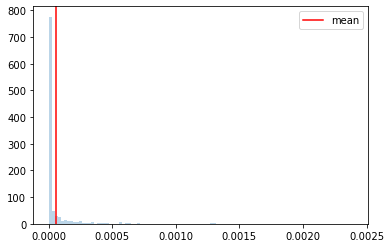

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654370603
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 10.0, 'jump_size_a': 1.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1


  0%|▏                                                                                | 2/1000 [00:00<01:35, 10.44it/s]

Monte Carlo 2
Monte Carlo 3


  0%|▍                                                                                | 5/1000 [00:00<02:01,  8.18it/s]

Monte Carlo 4
Monte Carlo 5


  1%|▌                                                                                | 7/1000 [00:00<01:59,  8.31it/s]

Monte Carlo 6
Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:01<02:06,  7.83it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 11/1000 [00:01<02:14,  7.36it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<02:05,  7.89it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<01:58,  8.30it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:02<02:11,  7.49it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<02:19,  7.03it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<02:13,  7.35it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<02:07,  7.69it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:03<02:10,  7.46it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<02:13,  7.29it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:09,  7.49it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:04<02:04,  7.77it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:04<02:07,  7.56it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<02:06,  7.60it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:11,  7.30it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:05<02:16,  7.05it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:05<02:12,  7.25it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<02:11,  7.26it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:15,  7.03it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:06<02:16,  6.99it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:06<02:20,  6.77it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:20,  6.73it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:07<02:20,  6.74it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:07<02:17,  6.85it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<02:07,  7.38it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:03,  7.64it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:08<01:59,  7.86it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:08<02:27,  6.34it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:11,  7.12it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:09<02:05,  7.43it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:09<02:09,  7.20it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:09<02:12,  7.03it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:09,  7.17it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:10<02:08,  7.21it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:10<02:13,  6.93it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:08,  7.17it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:11<02:05,  7.32it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:11<02:10,  7.02it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:11<02:06,  7.26it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:03,  7.42it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:12<02:11,  6.92it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:12<02:11,  6.94it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:11,  6.90it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:13<02:10,  6.92it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:13<02:09,  6.95it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:13<02:09,  6.97it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:12,  6.80it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:14<02:07,  7.06it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:14<02:05,  7.13it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:08,  6.96it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:15<02:05,  7.08it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:15<02:06,  7.01it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<02:11,  6.73it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:06,  6.99it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:16<02:08,  6.88it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:16<02:04,  7.05it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:10,  6.72it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:17<02:08,  6.85it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:17<02:11,  6.63it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:07,  6.84it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:18<02:09,  6.72it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:18<02:17,  6.32it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:18<02:15,  6.42it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:14,  6.45it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:19<02:12,  6.52it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:19<02:08,  6.70it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:14,  6.39it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:20<02:16,  6.30it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:20<02:17,  6.22it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:13,  6.38it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:21<02:12,  6.44it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:21<02:16,  6.24it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<02:15,  6.27it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:22<02:13,  6.35it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:22<02:09,  6.51it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:11,  6.40it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:23<02:08,  6.53it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:23<02:13,  6.25it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:23<02:11,  6.36it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:11,  6.34it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:24<02:15,  6.15it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:13,  6.23it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:12,  6.26it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:25<02:15,  6.07it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:25<02:21,  5.80it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:19,  5.90it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:26<02:18,  5.93it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:26<02:10,  6.26it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:16,  5.98it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:27<02:20,  5.79it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 187/1000 [00:27<02:18,  5.89it/s]

Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:27<02:42,  4.98it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:28<02:27,  5.48it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:28<02:20,  5.73it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:28<02:20,  5.75it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:29<02:22,  5.62it/s]

Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:29<02:23,  5.59it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:29<02:18,  5.77it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:16,  5.87it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:30<02:19,  5.71it/s]

Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:30<02:16,  5.82it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:13,  5.94it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:31<02:20,  5.63it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:31<02:21,  5.57it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:31<02:18,  5.68it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▋                                                              | 212/1000 [00:31<02:18,  5.68it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:32<02:23,  5.48it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:32<02:19,  5.61it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:18,  5.63it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:33<02:21,  5.50it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:33<02:22,  5.47it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:33<02:27,  5.27it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:33<02:22,  5.45it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:22,  5.43it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:34<02:22,  5.44it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:34<02:23,  5.39it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:34<02:25,  5.31it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:34<02:26,  5.27it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:35<02:21,  5.44it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:35<02:25,  5.29it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:20,  5.44it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:36<02:20,  5.46it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:36<02:20,  5.43it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:36<02:24,  5.27it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▊                                                            | 238/1000 [00:36<02:29,  5.11it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:23,  5.30it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:37<02:20,  5.39it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:20,  5.37it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:18,  5.44it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:38<02:22,  5.29it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:38<02:23,  5.23it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:24,  5.18it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:23,  5.24it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:39<02:21,  5.30it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:39<02:17,  5.44it/s]

Monte Carlo 252
Monte Carlo 253


 25%|████████████████████                                                           | 254/1000 [00:39<02:20,  5.30it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:25,  5.13it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:40<02:28,  5.00it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:40<02:25,  5.11it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:27,  5.02it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:41<02:24,  5.13it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:41<02:33,  4.80it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:30,  4.89it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:28,  4.96it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:42<02:26,  5.01it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:42<02:23,  5.13it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:42<02:23,  5.11it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:23,  5.10it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:43<02:22,  5.12it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:43<02:24,  5.03it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:43<02:21,  5.14it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:19,  5.21it/s]

Monte Carlo 273
Monte Carlo 274


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:19,  5.18it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:44<02:22,  5.09it/s]

Monte Carlo 276
Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:44<02:20,  5.14it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:45<02:25,  4.95it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:26,  4.90it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:24,  4.97it/s]

Monte Carlo 283
Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:28,  4.80it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:46<02:27,  4.82it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:22,  5.00it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:19,  5.08it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:47<02:19,  5.07it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:17,  5.16it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:47<02:13,  5.29it/s]

Monte Carlo 293
Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:12,  5.32it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:11,  5.33it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:09,  5.44it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:09,  5.40it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:14,  5.20it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:12,  5.25it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:10,  5.34it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:49<02:10,  5.35it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:49<02:10,  5.33it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:49<02:11,  5.28it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:12,  5.23it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:13,  5.20it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:15,  5.09it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:50<02:17,  5.01it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:50<02:16,  5.04it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:51<02:21,  4.87it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:17,  4.99it/s]

Monte Carlo 313
Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:51<02:21,  4.83it/s]

Monte Carlo 315
Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:22,  4.79it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:23,  4.73it/s]

Monte Carlo 318
Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:23,  4.72it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:52<02:28,  4.56it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:53<02:25,  4.66it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:24,  4.70it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:53<02:19,  4.82it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:18,  4.86it/s]

Monte Carlo 325
Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:21,  4.75it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:30,  4.45it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:54<02:24,  4.63it/s]

Monte Carlo 329
Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:55<02:24,  4.63it/s]

Monte Carlo 331
Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:24,  4.61it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:24,  4.60it/s]

Monte Carlo 334
Monte Carlo 335


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:25,  4.55it/s]

Monte Carlo 336


 34%|██████████████████████████▋                                                    | 338/1000 [00:56<02:24,  4.59it/s]

Monte Carlo 337
Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:56<02:23,  4.61it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:25,  4.54it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:37,  4.18it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:32,  4.31it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:27,  4.45it/s]

Monte Carlo 343
Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:29,  4.39it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:26,  4.47it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:24,  4.51it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:58<02:28,  4.39it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:28,  4.38it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:32,  4.27it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:29,  4.33it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:28,  4.37it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:00<02:26,  4.41it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:26,  4.40it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:27,  4.38it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:28,  4.35it/s]

Monte Carlo 356


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:25,  4.40it/s]

Monte Carlo 357
Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:27,  4.34it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:25,  4.41it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:24,  4.43it/s]

Monte Carlo 361


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:24,  4.41it/s]

Monte Carlo 362
Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:25,  4.37it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:23,  4.41it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:23,  4.43it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:24,  4.38it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:25,  4.34it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:44,  3.83it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:39,  3.94it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:36,  4.02it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:30,  4.17it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:31,  4.15it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:25,  4.30it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:25,  4.29it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:28,  4.21it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:43,  3.82it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:06<02:38,  3.91it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:38,  3.91it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:31,  4.08it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:30,  4.10it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:07<02:26,  4.21it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:23,  4.29it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:23,  4.28it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:22,  4.31it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:27,  4.16it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:25,  4.22it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:22,  4.28it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:22,  4.30it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:24,  4.22it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:09<02:24,  4.22it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:21,  4.29it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:20,  4.32it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:23,  4.21it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:10<02:21,  4.29it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:22,  4.24it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:22,  4.22it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:17,  4.36it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:16,  4.40it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:11<02:17,  4.37it/s]

Monte Carlo 400


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:15,  4.41it/s]

Monte Carlo 401
Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:15,  4.41it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:16,  4.37it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:14,  4.42it/s]

Monte Carlo 405


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:11,  4.52it/s]

Monte Carlo 406
Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:13,  4.44it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:13<02:20,  4.21it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:21,  4.17it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:16,  4.31it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:13<02:18,  4.23it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:20,  4.18it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:20,  4.17it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:21,  4.12it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:14<02:18,  4.21it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:15<02:18,  4.22it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:22,  4.09it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:22,  4.07it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:15<02:18,  4.19it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:16<02:18,  4.18it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:16,  4.22it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:16,  4.23it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:16<02:16,  4.21it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:17<02:19,  4.13it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:22,  4.03it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:21,  4.05it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:17<02:21,  4.04it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:23,  3.97it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:26,  3.88it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:21,  4.01it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:18<02:23,  3.95it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:25,  3.89it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:24,  3.91it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:23,  3.94it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:19<02:24,  3.91it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:24,  3.90it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:22,  3.94it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:20<02:19,  4.03it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:20<02:19,  4.00it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:21<02:20,  3.99it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:21<02:19,  4.00it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:21<02:19,  4.00it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:21<02:25,  3.82it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:22<02:26,  3.78it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:22<02:28,  3.73it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:22<02:30,  3.68it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:23<02:33,  3.60it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:23<02:28,  3.70it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:23<02:27,  3.73it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:23<02:30,  3.65it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:24<02:27,  3.72it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:24<02:26,  3.72it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:24<02:23,  3.80it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:24<02:25,  3.75it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:25<02:24,  3.77it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:25<02:26,  3.72it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:25<02:23,  3.77it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:25<02:21,  3.82it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:26<02:21,  3.81it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:26<02:21,  3.82it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:26<02:21,  3.79it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:27<02:24,  3.72it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:27<02:29,  3.58it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:27<02:44,  3.25it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:28<02:41,  3.30it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:28<02:35,  3.43it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:28<02:32,  3.49it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:28<02:28,  3.58it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:29<02:24,  3.66it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:29<02:23,  3.69it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:29<02:19,  3.77it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:29<02:17,  3.85it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:21,  3.72it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:30<02:19,  3.77it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:30<02:17,  3.80it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:30<02:15,  3.85it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:31<02:18,  3.78it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:31<02:18,  3.76it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:31<02:22,  3.66it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:31<02:20,  3.71it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:32<02:21,  3.66it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:32<02:20,  3.69it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:32<02:19,  3.70it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:33<02:20,  3.67it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:33<02:20,  3.67it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:33<02:20,  3.64it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:33<02:19,  3.68it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:34<02:16,  3.74it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:34<02:15,  3.77it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:34<02:14,  3.78it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:34<02:13,  3.80it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:35<02:12,  3.82it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:35<02:13,  3.80it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:35<02:20,  3.60it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:36<02:19,  3.60it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:36<02:17,  3.65it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:36<02:17,  3.66it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:36<02:15,  3.68it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:37<02:14,  3.73it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:37<02:17,  3.63it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:37<02:14,  3.70it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:37<02:12,  3.74it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:38<02:12,  3.74it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:38<02:15,  3.64it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:38<02:16,  3.63it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:39<02:17,  3.59it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:39<02:19,  3.52it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:39<02:19,  3.52it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:39<02:21,  3.46it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:40<02:25,  3.37it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:40<02:23,  3.40it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:40<02:19,  3.49it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:41<02:18,  3.50it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:41<02:18,  3.50it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:41<02:15,  3.56it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:41<02:16,  3.54it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:42<02:16,  3.54it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:42<02:15,  3.55it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:42<02:14,  3.57it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:43<02:12,  3.61it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:43<02:14,  3.56it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:43<02:15,  3.52it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:43<02:16,  3.50it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:44<02:14,  3.52it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:44<02:12,  3.59it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:44<02:16,  3.45it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:45<02:21,  3.34it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:45<02:20,  3.36it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:45<02:18,  3.39it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:45<02:16,  3.43it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:46<02:14,  3.48it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:46<02:16,  3.43it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:46<02:12,  3.52it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:47<02:09,  3.59it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:47<02:08,  3.60it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:47<02:05,  3.68it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:47<02:06,  3.66it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:48<02:07,  3.61it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:48<02:08,  3.59it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:48<02:09,  3.55it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:49<02:06,  3.62it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:49<02:09,  3.53it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:49<02:08,  3.55it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:49<02:06,  3.59it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:50<02:04,  3.63it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:50<02:09,  3.49it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:50<02:07,  3.54it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:50<02:06,  3.56it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:51<02:05,  3.58it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:51<02:06,  3.55it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:51<02:05,  3.57it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:52<02:04,  3.59it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:52<02:09,  3.44it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:52<02:09,  3.44it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:53<02:09,  3.42it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:53<02:09,  3.43it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:53<02:12,  3.33it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:53<02:10,  3.37it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:54<02:12,  3.32it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:54<02:11,  3.34it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:54<02:15,  3.24it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:55<02:12,  3.29it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:55<02:14,  3.24it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:55<02:14,  3.23it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:56<02:16,  3.18it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:56<02:15,  3.19it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:56<02:15,  3.18it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:57<02:18,  3.12it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:57<02:15,  3.16it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:57<02:12,  3.23it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:57<02:13,  3.21it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:58<02:13,  3.19it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:58<02:12,  3.21it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:58<02:11,  3.23it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:59<02:13,  3.19it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:59<02:12,  3.19it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:59<02:11,  3.21it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:00<02:15,  3.12it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:00<02:15,  3.09it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:00<02:15,  3.09it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:01<02:14,  3.11it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:01<02:14,  3.10it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:01<02:12,  3.13it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:02<02:11,  3.15it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:02<02:11,  3.14it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:02<02:10,  3.17it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:03<02:08,  3.20it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:03<02:10,  3.14it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:03<02:11,  3.11it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:04<02:24,  2.83it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:04<02:20,  2.91it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:04<02:14,  3.03it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:05<02:13,  3.04it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:05<02:12,  3.06it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:05<02:10,  3.10it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:06<02:06,  3.18it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:06<02:06,  3.18it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:06<02:09,  3.09it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:06<02:07,  3.13it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:07<02:06,  3.16it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:07<02:03,  3.21it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:07<02:03,  3.23it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:08<02:05,  3.16it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:08<02:08,  3.08it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:08<02:04,  3.16it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:09<02:07,  3.08it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:09<02:06,  3.09it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:09<02:04,  3.13it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:10<02:07,  3.06it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:10<02:05,  3.10it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:10<02:06,  3.07it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:11<02:05,  3.09it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:11<02:05,  3.08it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:11<02:07,  3.01it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:12<02:11,  2.93it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:12<02:09,  2.97it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:12<02:05,  3.05it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:13<02:04,  3.06it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:13<02:05,  3.02it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:13<02:04,  3.03it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:14<02:03,  3.06it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:14<02:04,  3.03it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:14<02:06,  2.98it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:15<02:02,  3.06it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:15<02:00,  3.09it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:15<02:01,  3.06it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:16<02:02,  3.02it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:16<02:02,  3.03it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:16<02:03,  3.01it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:17<02:05,  2.94it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:17<02:16,  2.70it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:17<02:17,  2.67it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:18<02:14,  2.71it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:18<02:11,  2.77it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:19<02:08,  2.83it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:19<02:08,  2.83it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:19<02:06,  2.86it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:20<02:04,  2.91it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:20<02:03,  2.92it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:20<02:02,  2.93it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:21<02:01,  2.95it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:21<02:01,  2.93it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:21<01:59,  2.99it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:22<01:59,  2.96it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:22<02:00,  2.93it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:22<02:04,  2.83it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:23<02:01,  2.89it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:23<01:59,  2.93it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:23<01:58,  2.94it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:24<01:57,  2.96it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:24<01:57,  2.97it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:24<02:00,  2.89it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:25<01:56,  2.98it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:25<01:57,  2.93it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:25<01:54,  2.99it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:26<01:54,  3.01it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:26<01:57,  2.91it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:26<01:56,  2.93it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:27<01:56,  2.92it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:27<01:54,  2.96it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:27<01:55,  2.94it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:28<01:56,  2.89it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:28<01:56,  2.87it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:28<01:56,  2.89it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:29<01:57,  2.85it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:29<01:55,  2.88it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:29<01:55,  2.87it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:30<01:52,  2.93it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:30<01:52,  2.92it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:30<01:52,  2.92it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:31<01:54,  2.86it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:31<01:55,  2.84it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:32<01:52,  2.91it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:32<01:51,  2.91it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:32<01:54,  2.82it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:33<01:54,  2.83it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:33<01:57,  2.74it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:33<01:58,  2.70it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:34<01:54,  2.78it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:34<01:51,  2.86it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:34<01:51,  2.84it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:35<01:54,  2.76it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:35<01:51,  2.84it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:35<01:51,  2.84it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:36<01:50,  2.83it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:36<01:49,  2.86it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:37<01:56,  2.68it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:37<01:51,  2.80it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:37<01:50,  2.81it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:38<01:48,  2.86it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:38<01:56,  2.65it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:38<01:52,  2.72it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:39<01:53,  2.70it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:39<01:51,  2.75it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:39<01:49,  2.79it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:40<01:47,  2.82it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:40<01:47,  2.82it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:40<01:46,  2.84it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:41<01:44,  2.88it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:41<01:42,  2.91it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:42<01:42,  2.91it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:42<01:41,  2.91it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:42<01:42,  2.89it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:43<01:43,  2.86it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:43<01:45,  2.78it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:43<01:44,  2.81it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:44<01:43,  2.83it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:44<01:41,  2.85it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:44<01:41,  2.84it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:45<01:44,  2.78it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:45<01:45,  2.72it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:45<01:43,  2.76it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:46<01:41,  2.82it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:46<01:40,  2.84it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:46<01:40,  2.83it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:47<01:41,  2.78it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:47<01:39,  2.84it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:48<01:39,  2.83it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:48<01:38,  2.83it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:48<01:38,  2.83it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:49<01:39,  2.79it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:49<01:38,  2.82it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:49<01:39,  2.77it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:50<01:40,  2.74it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:50<01:38,  2.77it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:50<01:38,  2.78it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:51<01:37,  2.78it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:51<01:36,  2.82it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:51<01:35,  2.81it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:52<01:35,  2.81it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:52<01:35,  2.81it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:53<01:35,  2.79it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:53<01:35,  2.78it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:53<01:35,  2.76it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:54<01:35,  2.75it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:54<01:34,  2.77it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:54<01:34,  2.78it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:55<01:35,  2.73it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:55<01:34,  2.74it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:55<01:33,  2.76it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:56<01:33,  2.77it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:56<01:33,  2.75it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:57<01:32,  2.76it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:57<01:30,  2.81it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:57<01:33,  2.73it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:58<01:35,  2.64it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:58<01:34,  2.67it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:58<01:30,  2.76it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:59<01:29,  2.80it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:59<01:27,  2.86it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:59<01:25,  2.90it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:00<01:24,  2.92it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:00<01:24,  2.91it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:00<01:23,  2.94it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:01<01:23,  2.91it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:01<01:22,  2.93it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:01<01:22,  2.93it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:02<01:24,  2.84it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:02<01:25,  2.82it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:03<01:23,  2.86it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:03<01:22,  2.88it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:03<01:22,  2.86it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:04<01:21,  2.88it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:04<01:22,  2.86it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:04<01:21,  2.88it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:05<01:20,  2.88it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:05<01:21,  2.86it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:05<01:19,  2.89it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:06<01:18,  2.92it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:06<01:21,  2.81it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:06<01:21,  2.81it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:07<01:20,  2.83it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:07<01:19,  2.84it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:07<01:18,  2.87it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:08<01:18,  2.86it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:08<01:18,  2.85it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:08<01:17,  2.85it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:09<01:18,  2.81it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:09<01:19,  2.75it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:10<01:20,  2.72it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:10<01:19,  2.75it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:10<01:19,  2.74it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:11<01:19,  2.71it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:11<01:19,  2.70it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:11<01:19,  2.71it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:12<01:26,  2.47it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:12<01:23,  2.54it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:13<01:21,  2.58it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:13<01:20,  2.61it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:13<01:21,  2.56it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:14<01:21,  2.54it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:14<01:22,  2.51it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:15<01:21,  2.51it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:15<01:20,  2.53it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:15<01:20,  2.53it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:16<01:20,  2.52it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:16<01:19,  2.56it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:17<01:18,  2.57it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:17<01:17,  2.58it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:17<01:18,  2.53it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:18<01:18,  2.51it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:18<01:18,  2.50it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:19<01:16,  2.56it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:19<01:15,  2.58it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:19<01:15,  2.56it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:20<01:13,  2.61it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:20<01:13,  2.61it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:20<01:13,  2.60it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:21<01:14,  2.57it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:21<01:13,  2.56it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:22<01:13,  2.54it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:22<01:14,  2.52it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:23<01:17,  2.41it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:23<01:17,  2.39it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:23<01:18,  2.34it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:24<01:16,  2.39it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:24<01:14,  2.46it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:25<01:12,  2.48it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:25<01:11,  2.51it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:25<01:12,  2.49it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:26<01:09,  2.54it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:26<01:10,  2.51it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:27<01:09,  2.52it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:27<01:10,  2.50it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:27<01:10,  2.48it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:28<01:09,  2.50it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:28<01:07,  2.53it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:29<01:08,  2.50it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:29<01:08,  2.48it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:29<01:09,  2.44it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:30<01:09,  2.43it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:30<01:08,  2.44it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:31<01:07,  2.46it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:31<01:07,  2.46it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:31<01:06,  2.46it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:32<01:06,  2.46it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:32<01:07,  2.39it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:33<01:05,  2.46it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:33<01:05,  2.46it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:33<01:03,  2.49it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:34<01:03,  2.47it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:34<01:03,  2.46it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:35<01:02,  2.49it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:35<01:02,  2.48it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:36<01:02,  2.48it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:36<01:02,  2.46it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:36<01:02,  2.42it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:37<01:02,  2.41it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:37<01:01,  2.43it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:38<01:00,  2.47it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:38<00:58,  2.54it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:38<00:57,  2.57it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:39<00:56,  2.58it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:39<00:55,  2.63it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:39<00:55,  2.61it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:40<00:56,  2.54it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:40<00:54,  2.60it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:41<00:56,  2.50it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:41<00:57,  2.46it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:41<00:55,  2.49it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:42<00:55,  2.48it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:42<00:55,  2.49it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:43<00:55,  2.47it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:43<00:54,  2.50it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:43<00:53,  2.49it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:44<00:53,  2.49it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:44<00:54,  2.43it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:45<00:55,  2.37it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:45<00:53,  2.41it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:46<00:53,  2.40it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:46<00:54,  2.36it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:46<00:53,  2.39it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:47<00:51,  2.44it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:47<00:50,  2.49it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:48<00:50,  2.47it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:48<00:50,  2.44it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:48<00:49,  2.45it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:49<00:49,  2.44it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:49<00:48,  2.45it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:50<00:48,  2.46it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:50<00:48,  2.41it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:51<00:48,  2.42it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:51<00:48,  2.39it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:51<00:48,  2.36it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:52<00:52,  2.17it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:52<00:50,  2.25it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:53<00:48,  2.30it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:53<00:47,  2.34it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:54<00:47,  2.33it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:54<00:47,  2.29it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:54<00:46,  2.34it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:55<00:45,  2.33it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:55<00:46,  2.29it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:56<00:45,  2.29it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:56<00:45,  2.30it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:57<00:44,  2.32it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:57<00:43,  2.34it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:57<00:43,  2.31it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:58<00:43,  2.30it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:58<00:43,  2.29it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:59<00:42,  2.32it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:59<00:42,  2.30it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:00<00:42,  2.27it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:00<00:41,  2.30it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:01<00:41,  2.29it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:01<00:40,  2.32it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:01<00:39,  2.33it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:02<00:38,  2.36it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:02<00:38,  2.35it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:03<00:37,  2.35it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:03<00:37,  2.35it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:04<00:37,  2.34it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:04<00:36,  2.34it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:04<00:36,  2.33it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:05<00:36,  2.33it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:05<00:35,  2.34it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:06<00:35,  2.31it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:06<00:35,  2.28it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:07<00:34,  2.29it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:07<00:34,  2.27it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:07<00:34,  2.29it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:08<00:33,  2.29it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:08<00:33,  2.29it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:09<00:32,  2.29it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:09<00:32,  2.31it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:10<00:32,  2.28it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:10<00:31,  2.28it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:11<00:31,  2.27it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:11<00:31,  2.23it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:11<00:30,  2.26it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:12<00:30,  2.25it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:12<00:29,  2.25it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:13<00:28,  2.28it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:13<00:27,  2.32it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:14<00:27,  2.31it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:14<00:27,  2.31it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:14<00:27,  2.28it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:15<00:27,  2.24it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:15<00:26,  2.24it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:16<00:26,  2.23it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:16<00:26,  2.23it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:17<00:25,  2.22it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:17<00:25,  2.24it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:18<00:24,  2.26it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:18<00:23,  2.26it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:18<00:23,  2.25it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:19<00:23,  2.24it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:19<00:22,  2.26it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:20<00:22,  2.26it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:20<00:21,  2.28it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:21<00:20,  2.31it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:21<00:20,  2.26it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:22<00:20,  2.25it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:22<00:19,  2.25it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:22<00:19,  2.25it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:23<00:19,  2.26it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:23<00:18,  2.25it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:24<00:18,  2.22it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:24<00:17,  2.23it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:25<00:17,  2.23it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:25<00:16,  2.25it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:26<00:16,  2.24it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:26<00:15,  2.25it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:26<00:15,  2.31it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:27<00:14,  2.34it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:27<00:13,  2.36it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:28<00:13,  2.35it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:28<00:13,  2.37it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:29<00:12,  2.36it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:29<00:12,  2.33it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:29<00:12,  2.26it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:30<00:11,  2.31it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:30<00:11,  2.30it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:31<00:10,  2.31it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:31<00:10,  2.30it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:32<00:09,  2.31it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:32<00:09,  2.27it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:33<00:09,  2.23it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:33<00:09,  2.18it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:33<00:08,  2.17it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:34<00:08,  2.16it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:34<00:07,  2.19it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:35<00:07,  2.20it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:35<00:06,  2.24it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:36<00:06,  2.24it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:36<00:05,  2.24it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:37<00:05,  2.19it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:37<00:05,  2.18it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:38<00:04,  2.18it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:38<00:04,  2.05it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:39<00:03,  2.13it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:39<00:03,  2.16it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:39<00:02,  2.17it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:40<00:02,  2.16it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:40<00:01,  2.20it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:41<00:01,  2.19it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:41<00:00,  2.16it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:42<00:00,  2.15it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:42<00:00,  3.54it/s]


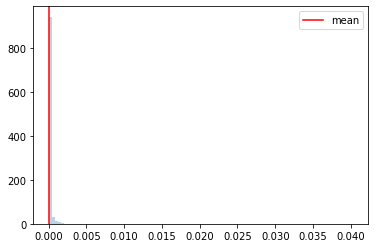

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654370886
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 10.0, 'jump_size_a': 1.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:20, 12.38it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:50,  8.98it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:50,  8.95it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▉                                                                               | 11/1000 [00:01<01:47,  9.21it/s]

Monte Carlo 9
Monte Carlo 10


  1%|█                                                                               | 13/1000 [00:01<01:45,  9.40it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:48,  9.05it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<02:12,  7.41it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<02:14,  7.33it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<02:18,  7.08it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<02:06,  7.70it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<02:09,  7.52it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<02:16,  7.16it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:16,  7.13it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:17,  7.04it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:04<02:20,  6.88it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:18,  6.96it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:17,  7.02it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<02:12,  7.24it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:05<02:19,  6.88it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<02:10,  7.35it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<02:14,  7.11it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:06<02:12,  7.20it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:06<02:24,  6.59it/s]

Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:06<02:26,  6.51it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:17,  6.88it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:07<02:08,  7.37it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:07<02:19,  6.75it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<02:19,  6.74it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:30,  6.27it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:08<02:15,  6.92it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:08<02:16,  6.84it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:14,  6.93it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:09<02:19,  6.70it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:09<02:20,  6.63it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:09<02:21,  6.56it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:10<02:35,  5.97it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:10<02:37,  5.89it/s]

Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:10<02:26,  6.29it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:10<02:26,  6.29it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:11<02:42,  5.67it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:11<02:38,  5.79it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:11<02:31,  6.06it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:12<02:31,  6.02it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:12<02:18,  6.57it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████                                                                         | 89/1000 [00:12<02:18,  6.59it/s]

Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:13<02:40,  5.66it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:13<02:30,  6.03it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:13<02:28,  6.09it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:14<02:30,  6.00it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:14<02:29,  6.03it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:14<02:30,  5.96it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:15<02:28,  6.03it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:15<02:30,  5.95it/s]

Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:15<02:30,  5.94it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:15<02:25,  6.15it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:16<02:21,  6.29it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:16<02:15,  6.58it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:16<02:18,  6.41it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:17<02:19,  6.34it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:17<02:17,  6.43it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:17<02:12,  6.63it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:18<02:14,  6.51it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:18<02:13,  6.54it/s]

Monte Carlo 123
Monte Carlo 124


 12%|█████████▉                                                                     | 125/1000 [00:18<02:19,  6.29it/s]

Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:19<02:47,  5.22it/s]

Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:19<02:38,  5.49it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:19<02:34,  5.64it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:19<02:28,  5.86it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:20<02:26,  5.91it/s]

Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:20<02:27,  5.86it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:20<02:33,  5.63it/s]

Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:20<02:30,  5.71it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:21<02:21,  6.08it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:21<02:21,  6.05it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:21<02:23,  5.97it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:22<02:20,  6.06it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:22<02:22,  5.98it/s]

Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:22<02:18,  6.13it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:23<02:21,  5.98it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:23<02:28,  5.72it/s]

Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:23<02:30,  5.61it/s]

Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:23<02:29,  5.64it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:24<02:33,  5.51it/s]

Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:24<02:31,  5.54it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:24<02:37,  5.32it/s]

Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:24<02:36,  5.37it/s]

Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:25<02:30,  5.55it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:25<02:29,  5.61it/s]

Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:25<02:28,  5.62it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:25<02:25,  5.71it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:26<02:23,  5.78it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:26<02:29,  5.55it/s]

Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:26<02:36,  5.30it/s]

Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:27<02:32,  5.42it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:27<02:28,  5.56it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:27<02:25,  5.66it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:28<02:24,  5.69it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:28<02:21,  5.78it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:28<02:20,  5.83it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:29<02:24,  5.65it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:29<02:19,  5.83it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:29<02:17,  5.91it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:30<02:22,  5.67it/s]

Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:30<02:17,  5.88it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:30<02:14,  5.99it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:31<02:17,  5.85it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:31<02:24,  5.54it/s]

Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:31<02:21,  5.67it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:31<02:17,  5.81it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:32<02:13,  5.98it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:32<02:13,  5.97it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:32<02:15,  5.88it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:33<02:19,  5.68it/s]

Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:33<02:25,  5.43it/s]

Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:33<02:25,  5.44it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 211/1000 [00:33<02:30,  5.26it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:34<02:31,  5.20it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:34<02:32,  5.16it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:34<02:45,  4.72it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:35<02:37,  4.95it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:35<02:31,  5.16it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:35<02:20,  5.53it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:36<02:25,  5.34it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:36<02:22,  5.43it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:36<02:22,  5.43it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:37<02:24,  5.34it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:37<02:21,  5.43it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:37<02:18,  5.53it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:38<02:15,  5.66it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:38<02:16,  5.59it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:38<02:15,  5.62it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:39<02:20,  5.43it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:39<02:22,  5.33it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:39<02:23,  5.28it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:39<02:20,  5.40it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:39<02:17,  5.49it/s]

Monte Carlo 243
Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:40<02:20,  5.36it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:40<02:22,  5.27it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:40<02:24,  5.21it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:40<02:22,  5.27it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:41<02:24,  5.19it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:41<02:24,  5.18it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:41<02:25,  5.14it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:41<02:24,  5.16it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:42<02:26,  5.07it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:42<02:25,  5.09it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:42<02:22,  5.21it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:42<02:21,  5.24it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:43<02:20,  5.27it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:43<02:22,  5.19it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:43<02:20,  5.26it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:43<02:19,  5.27it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:43<02:19,  5.25it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:44<02:19,  5.28it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:44<02:23,  5.12it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:44<02:22,  5.15it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 269/1000 [00:44<02:27,  4.96it/s]

Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:44<02:30,  4.84it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:45<02:26,  4.97it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:45<02:28,  4.90it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:45<02:27,  4.93it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:46<02:24,  5.02it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:46<02:23,  5.03it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:46<02:22,  5.06it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:46<02:31,  4.76it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:47<02:26,  4.92it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:47<02:21,  5.06it/s]

Monte Carlo 281
Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:47<02:22,  5.01it/s]

Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:47<02:24,  4.95it/s]

Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:47<02:28,  4.80it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:48<02:28,  4.82it/s]

Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:48<02:33,  4.65it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:48<02:28,  4.78it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:49<02:28,  4.78it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:49<02:25,  4.87it/s]

Monte Carlo 292
Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:49<02:31,  4.65it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:50<02:31,  4.63it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:50<02:29,  4.70it/s]

Monte Carlo 296
Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:50<02:35,  4.51it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:51<02:39,  4.40it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:51<02:29,  4.67it/s]

Monte Carlo 300
Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:51<02:30,  4.65it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:52<02:23,  4.83it/s]

Monte Carlo 303
Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:52<02:25,  4.76it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:52<02:28,  4.67it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:52<02:27,  4.70it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:53<02:28,  4.65it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:53<02:26,  4.72it/s]

Monte Carlo 310
Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:53<02:26,  4.68it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:54<02:27,  4.66it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:54<02:26,  4.69it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:54<02:26,  4.67it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:54<02:27,  4.63it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:54<02:26,  4.66it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:55<02:24,  4.71it/s]

Monte Carlo 318
Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:55<02:24,  4.69it/s]

Monte Carlo 320
Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:55<02:28,  4.55it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:56<02:26,  4.63it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:56<02:23,  4.70it/s]

Monte Carlo 324
Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:56<02:23,  4.69it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:57<02:22,  4.71it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:57<02:26,  4.59it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:57<02:25,  4.62it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:57<02:27,  4.55it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:57<02:30,  4.44it/s]

Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:58<02:25,  4.58it/s]

Monte Carlo 332
Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:58<02:24,  4.60it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:58<02:29,  4.44it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:59<02:27,  4.50it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:59<02:26,  4.52it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:59<02:28,  4.47it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:59<02:26,  4.53it/s]

Monte Carlo 339


 34%|██████████████████████████▉                                                    | 341/1000 [01:00<02:24,  4.57it/s]

Monte Carlo 340
Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [01:00<02:22,  4.62it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [01:00<02:22,  4.61it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [01:00<02:24,  4.55it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:01<02:25,  4.51it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:01<02:29,  4.36it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:01<02:37,  4.14it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:01<02:33,  4.25it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:01<02:32,  4.27it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:02<02:27,  4.41it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:02<02:28,  4.37it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:02<02:28,  4.37it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:02<02:31,  4.26it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:03<02:30,  4.28it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:03<02:29,  4.33it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:03<02:26,  4.39it/s]

Monte Carlo 356


 36%|████████████████████████████▎                                                  | 358/1000 [01:04<02:31,  4.22it/s]

Monte Carlo 357
Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:04<02:28,  4.32it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:04<02:25,  4.39it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 362/1000 [01:04<02:21,  4.50it/s]

Monte Carlo 361
Monte Carlo 362


 36%|████████████████████████████▊                                                  | 364/1000 [01:05<02:20,  4.52it/s]

Monte Carlo 363
Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:05<02:24,  4.41it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 367/1000 [01:06<02:18,  4.57it/s]

Monte Carlo 366
Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:06<02:19,  4.54it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:06<02:18,  4.56it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:06<02:19,  4.52it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:06<02:19,  4.51it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:07<02:19,  4.49it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:07<02:20,  4.46it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:07<02:22,  4.40it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:07<02:20,  4.45it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:08<02:17,  4.52it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:08<02:16,  4.56it/s]

Monte Carlo 377


 38%|█████████████████████████████▉                                                 | 379/1000 [01:08<02:20,  4.43it/s]

Monte Carlo 378
Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:08<02:21,  4.40it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:09<02:19,  4.43it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:09<02:19,  4.43it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:09<02:18,  4.44it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:09<02:24,  4.27it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:10<02:23,  4.28it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:10<02:28,  4.14it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:10<02:29,  4.11it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:10<02:25,  4.20it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:11<02:23,  4.25it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:11<02:22,  4.29it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:11<02:24,  4.20it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:11<02:22,  4.27it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:12<02:27,  4.13it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:12<02:25,  4.18it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:12<02:23,  4.21it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:12<02:22,  4.23it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:13<02:21,  4.25it/s]

Monte Carlo 397


 40%|███████████████████████████████▌                                               | 399/1000 [01:13<02:13,  4.49it/s]

Monte Carlo 398
Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:13<02:12,  4.53it/s]

Monte Carlo 400


 40%|███████████████████████████████▊                                               | 402/1000 [01:14<02:13,  4.48it/s]

Monte Carlo 401
Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:14<02:14,  4.42it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:14<02:12,  4.49it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:14<02:12,  4.51it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:14<02:11,  4.53it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:15<02:20,  4.21it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:15<02:16,  4.35it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:15<02:18,  4.27it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:15<02:16,  4.33it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:16<02:20,  4.19it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:16<02:16,  4.29it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:16<02:15,  4.35it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:16<02:14,  4.36it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:17<02:16,  4.28it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:17<02:15,  4.32it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:17<02:16,  4.27it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:17<02:14,  4.31it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:18<02:14,  4.33it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:18<02:16,  4.26it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:18<02:15,  4.28it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:18<02:14,  4.29it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:18<02:14,  4.27it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:19<02:17,  4.19it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:19<02:18,  4.16it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:19<02:21,  4.04it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:19<02:17,  4.17it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:20<02:16,  4.18it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:20<02:16,  4.18it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:20<02:16,  4.16it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:20<02:15,  4.19it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:21<02:16,  4.16it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:21<02:17,  4.12it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:21<02:18,  4.07it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:21<02:19,  4.06it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:22<02:20,  4.00it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:22<02:15,  4.16it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:22<02:18,  4.06it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:22<02:18,  4.06it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:23<02:19,  4.01it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:23<02:20,  3.99it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:23<02:18,  4.03it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:23<02:17,  4.06it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:24<02:15,  4.10it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:24<02:15,  4.10it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:24<02:11,  4.21it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:24<02:12,  4.18it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:25<02:16,  4.05it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:25<02:14,  4.09it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:25<02:14,  4.08it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:25<02:16,  4.03it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:26<02:20,  3.91it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:26<02:17,  3.97it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:26<02:20,  3.90it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:26<02:25,  3.74it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:27<02:26,  3.71it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:27<02:40,  3.38it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:27<02:34,  3.50it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:28<02:28,  3.65it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:28<02:27,  3.65it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:28<02:44,  3.29it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:29<02:43,  3.29it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:29<02:37,  3.41it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:29<02:35,  3.46it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:29<02:34,  3.47it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:30<02:30,  3.56it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:30<02:29,  3.57it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:30<02:33,  3.47it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:30<02:28,  3.57it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:31<02:24,  3.68it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:31<02:20,  3.76it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:31<02:21,  3.74it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:31<02:19,  3.77it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:32<02:16,  3.85it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:32<02:17,  3.83it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:32<02:18,  3.78it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:33<02:22,  3.66it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:33<02:24,  3.61it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:33<02:26,  3.55it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:33<02:27,  3.54it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:34<02:25,  3.58it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:34<02:25,  3.57it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:34<02:22,  3.62it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:35<02:24,  3.56it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:35<02:22,  3.61it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:35<02:21,  3.63it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:35<02:17,  3.72it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:36<02:15,  3.77it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:36<02:17,  3.72it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:36<02:16,  3.73it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:36<02:18,  3.66it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:37<02:19,  3.64it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:37<02:18,  3.67it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:37<02:21,  3.57it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:38<02:24,  3.49it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:38<02:25,  3.46it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:38<02:24,  3.48it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:38<02:22,  3.52it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:39<02:20,  3.56it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:39<02:22,  3.51it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:39<02:21,  3.52it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:40<02:18,  3.59it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:40<02:19,  3.56it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:40<02:18,  3.58it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:40<02:20,  3.52it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:41<02:18,  3.57it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:41<02:15,  3.63it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:41<02:14,  3.65it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:41<02:13,  3.68it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:42<02:13,  3.67it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:42<02:14,  3.65it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:42<02:17,  3.54it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:43<02:17,  3.55it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:43<02:19,  3.49it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:43<02:20,  3.44it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:44<02:22,  3.40it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:44<02:18,  3.48it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:44<02:16,  3.52it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:44<02:16,  3.52it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:45<02:15,  3.54it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:45<02:14,  3.56it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:45<02:12,  3.61it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:45<02:16,  3.48it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:46<02:16,  3.50it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:46<02:17,  3.45it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:46<02:16,  3.48it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:47<02:18,  3.42it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:47<02:20,  3.35it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:47<02:19,  3.38it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:48<02:19,  3.38it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:48<02:18,  3.38it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:48<02:19,  3.35it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:48<02:21,  3.30it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:49<02:20,  3.31it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:49<02:20,  3.31it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:49<02:19,  3.33it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:50<02:19,  3.32it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:50<02:19,  3.31it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:50<02:17,  3.35it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:51<02:18,  3.31it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:51<02:21,  3.24it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:51<02:19,  3.27it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:52<02:21,  3.23it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:52<02:17,  3.32it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:52<02:15,  3.36it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:52<02:14,  3.37it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:53<02:14,  3.36it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:53<02:15,  3.34it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:53<02:16,  3.30it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:54<02:16,  3.29it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:54<02:14,  3.34it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:54<02:14,  3.33it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:54<02:14,  3.33it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:55<02:18,  3.23it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:55<02:15,  3.28it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:55<02:15,  3.28it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:56<02:14,  3.30it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:56<02:12,  3.34it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:56<02:17,  3.22it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:57<02:12,  3.31it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:57<02:10,  3.35it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:57<02:10,  3.35it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:58<02:10,  3.36it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:58<02:11,  3.32it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:58<02:14,  3.24it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:58<02:17,  3.15it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:59<02:16,  3.17it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:59<02:16,  3.16it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:59<02:15,  3.18it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:00<02:13,  3.22it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:00<02:14,  3.19it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:00<02:12,  3.22it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:01<02:12,  3.22it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:01<02:12,  3.22it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:01<02:18,  3.06it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:02<02:17,  3.08it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:02<02:17,  3.08it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:02<02:16,  3.09it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:03<02:14,  3.12it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:03<02:28,  2.82it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:03<02:18,  3.02it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:04<02:16,  3.06it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:04<02:17,  3.03it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:04<02:15,  3.08it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:05<02:15,  3.06it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:05<02:12,  3.12it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:05<02:10,  3.16it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:06<02:10,  3.15it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:06<02:15,  3.04it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:06<02:13,  3.06it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:07<02:11,  3.11it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:07<02:12,  3.09it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:07<02:09,  3.14it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:08<02:12,  3.07it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:08<02:12,  3.06it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:08<02:10,  3.08it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:08<02:10,  3.08it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:09<02:09,  3.12it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:09<02:06,  3.16it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:09<02:06,  3.16it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:10<02:09,  3.07it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:10<02:10,  3.05it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:10<02:10,  3.05it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:11<02:08,  3.09it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:11<02:08,  3.08it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:11<02:07,  3.09it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:12<02:06,  3.10it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:12<02:09,  3.02it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:12<02:08,  3.04it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:13<02:07,  3.07it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:13<02:08,  3.02it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:13<02:09,  3.00it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:14<02:08,  3.00it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:14<02:07,  3.02it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:14<02:06,  3.05it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:15<02:06,  3.04it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:15<02:07,  2.99it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:15<02:07,  2.99it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:16<02:04,  3.05it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:16<02:06,  3.02it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:16<02:11,  2.88it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:17<02:07,  2.95it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:17<02:08,  2.93it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:17<02:07,  2.95it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:18<02:05,  2.98it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:18<02:02,  3.04it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:18<02:02,  3.04it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:19<02:03,  3.01it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:19<02:05,  2.95it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:19<02:05,  2.95it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:20<02:02,  3.02it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:20<02:02,  3.01it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:20<02:01,  3.02it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:21<02:01,  3.01it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:21<02:04,  2.94it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:21<02:02,  2.97it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:22<01:59,  3.03it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:22<02:00,  3.01it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:22<02:03,  2.92it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:23<02:05,  2.88it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:23<02:05,  2.86it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:23<02:04,  2.88it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:24<02:02,  2.92it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:24<02:01,  2.94it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:24<02:00,  2.94it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:25<01:58,  2.99it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:25<01:54,  3.08it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:25<01:52,  3.12it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:26<01:52,  3.13it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:26<01:51,  3.14it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:26<01:50,  3.16it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:27<01:51,  3.12it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:27<01:49,  3.18it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:27<01:48,  3.18it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:28<01:49,  3.16it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:28<01:47,  3.20it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:28<01:47,  3.20it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:29<01:50,  3.10it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:29<01:49,  3.11it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:29<01:49,  3.10it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:30<01:49,  3.11it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:30<01:48,  3.10it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:30<01:47,  3.14it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:31<01:47,  3.11it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:31<01:46,  3.16it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:31<01:49,  3.04it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:32<01:49,  3.05it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:32<01:46,  3.12it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:32<01:46,  3.10it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:33<01:50,  2.99it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:33<01:49,  3.01it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:33<01:51,  2.94it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:34<01:52,  2.91it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:34<01:59,  2.72it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:34<01:55,  2.81it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:35<01:55,  2.81it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:35<01:54,  2.82it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:35<01:53,  2.84it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:36<01:52,  2.85it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:36<01:49,  2.91it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:36<01:49,  2.91it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:37<01:51,  2.85it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:37<01:51,  2.84it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:37<01:51,  2.83it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:38<01:51,  2.83it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:38<02:00,  2.61it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:39<01:58,  2.65it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:39<01:59,  2.61it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:39<01:54,  2.71it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:40<01:54,  2.71it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:40<01:51,  2.78it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:40<01:51,  2.76it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:41<01:52,  2.73it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:41<01:50,  2.76it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:42<01:48,  2.80it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:42<01:47,  2.83it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:42<01:45,  2.86it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:43<01:45,  2.86it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:43<01:45,  2.84it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:43<01:45,  2.85it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:44<01:47,  2.78it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:44<01:46,  2.80it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:44<01:45,  2.81it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:45<01:45,  2.79it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:45<01:45,  2.79it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:45<01:47,  2.74it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:46<01:44,  2.79it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:46<01:44,  2.79it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:46<01:44,  2.77it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:47<01:43,  2.80it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:47<01:42,  2.83it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:48<01:44,  2.76it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:48<01:43,  2.77it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:48<01:43,  2.76it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:49<01:43,  2.77it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:49<01:43,  2.74it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:49<01:43,  2.73it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:50<01:43,  2.72it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:50<01:43,  2.73it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:50<01:41,  2.76it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:51<01:41,  2.76it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:51<01:40,  2.77it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:52<01:41,  2.73it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:52<01:41,  2.72it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:52<01:42,  2.69it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:53<01:40,  2.71it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:53<01:44,  2.61it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:53<01:42,  2.65it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:54<01:42,  2.63it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:54<01:41,  2.66it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:55<01:38,  2.72it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:55<01:38,  2.73it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:55<01:38,  2.70it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:56<01:37,  2.72it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:56<01:38,  2.69it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:56<01:36,  2.72it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:57<01:37,  2.69it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:57<01:37,  2.69it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:58<01:36,  2.71it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:58<01:37,  2.67it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:58<01:37,  2.67it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:59<01:35,  2.71it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:59<01:34,  2.72it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:59<01:33,  2.75it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:00<01:33,  2.73it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:00<01:35,  2.66it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:01<01:34,  2.67it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:01<01:35,  2.65it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:01<01:35,  2.62it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:02<01:35,  2.62it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:02<01:33,  2.65it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:02<01:33,  2.66it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:03<01:34,  2.62it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:03<01:32,  2.66it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:04<01:32,  2.65it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:04<01:30,  2.69it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:04<01:31,  2.67it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:05<01:31,  2.63it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:05<01:32,  2.60it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:05<01:30,  2.64it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:06<01:30,  2.64it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:06<01:29,  2.66it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:07<01:29,  2.65it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:07<01:28,  2.67it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:07<01:27,  2.68it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:08<01:28,  2.66it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:08<01:28,  2.64it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:08<01:27,  2.66it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:09<01:28,  2.62it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:09<01:28,  2.59it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:10<01:29,  2.56it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:10<01:29,  2.56it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:10<01:27,  2.58it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:11<01:26,  2.60it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:11<01:25,  2.62it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:12<01:28,  2.54it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:12<01:27,  2.56it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:12<01:27,  2.55it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:13<01:25,  2.58it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:13<01:27,  2.52it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:14<01:26,  2.52it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:14<01:26,  2.53it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:14<01:24,  2.57it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:15<01:26,  2.49it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:15<01:26,  2.50it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:16<01:25,  2.51it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:16<01:24,  2.52it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:16<01:23,  2.53it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:17<01:23,  2.52it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:17<01:25,  2.45it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:18<01:25,  2.46it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:18<01:30,  2.30it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:18<01:28,  2.35it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:19<01:25,  2.42it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:19<01:24,  2.43it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:20<01:22,  2.47it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:20<01:21,  2.49it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:20<01:20,  2.51it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:21<01:20,  2.50it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:21<01:21,  2.45it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:22<01:19,  2.50it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:22<01:20,  2.46it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:22<01:18,  2.50it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:23<01:17,  2.53it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:23<01:17,  2.51it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:24<01:16,  2.53it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:24<01:17,  2.48it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:24<01:16,  2.51it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:25<01:17,  2.47it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:25<01:17,  2.44it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:26<01:17,  2.43it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:26<01:15,  2.48it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:26<01:15,  2.49it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:27<01:14,  2.48it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:27<01:15,  2.45it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:28<01:14,  2.46it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:28<01:15,  2.44it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:29<01:14,  2.44it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:29<01:13,  2.45it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:29<01:13,  2.45it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:30<01:12,  2.46it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:30<01:12,  2.47it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:31<01:11,  2.48it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:31<01:09,  2.55it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:31<01:07,  2.58it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:32<01:06,  2.63it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:32<01:04,  2.66it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:32<01:04,  2.66it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:33<01:04,  2.63it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:33<01:03,  2.67it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:34<01:02,  2.69it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:34<01:01,  2.72it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:34<01:03,  2.62it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:35<01:04,  2.57it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:35<01:02,  2.62it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:35<01:02,  2.63it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:36<01:02,  2.61it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:36<01:02,  2.60it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:37<01:02,  2.59it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:37<01:01,  2.60it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:37<01:00,  2.64it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:38<00:59,  2.64it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:38<00:59,  2.64it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:38<00:58,  2.65it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:39<00:58,  2.64it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:39<00:58,  2.64it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:40<00:58,  2.60it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:40<00:58,  2.59it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:40<00:59,  2.55it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:41<00:59,  2.50it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:41<00:58,  2.54it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:42<00:59,  2.50it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:42<00:59,  2.49it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:42<00:59,  2.47it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:43<00:58,  2.47it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:43<00:57,  2.48it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:44<00:58,  2.46it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:44<00:58,  2.44it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:45<00:58,  2.40it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:45<00:58,  2.39it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:45<00:57,  2.41it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:46<00:57,  2.42it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:46<00:57,  2.40it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:47<00:56,  2.40it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:47<00:56,  2.40it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:47<00:56,  2.37it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:48<00:57,  2.30it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:48<00:56,  2.33it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:49<00:55,  2.35it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:49<00:56,  2.31it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:50<00:55,  2.33it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:50<00:55,  2.32it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:50<00:54,  2.35it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:51<00:53,  2.35it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:51<00:53,  2.33it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:52<00:53,  2.31it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:52<00:53,  2.31it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:53<00:52,  2.33it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:53<00:51,  2.35it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:53<00:50,  2.37it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:54<00:50,  2.36it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:54<00:49,  2.36it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:55<00:49,  2.38it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:55<00:49,  2.36it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:56<00:50,  2.29it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:56<00:49,  2.30it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:57<00:54,  2.08it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:57<00:52,  2.11it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:58<00:51,  2.16it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:58<00:50,  2.17it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:58<00:48,  2.23it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:59<00:47,  2.29it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:59<00:47,  2.25it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:00<00:47,  2.24it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:00<00:46,  2.27it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:01<00:46,  2.22it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:01<00:45,  2.24it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:02<00:49,  2.07it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:02<00:49,  2.06it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:03<00:47,  2.10it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:03<00:46,  2.12it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:04<00:46,  2.11it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:04<00:46,  2.10it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:04<00:45,  2.11it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:05<00:45,  2.11it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:05<00:45,  2.08it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:06<00:45,  2.06it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:06<00:43,  2.11it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:07<00:43,  2.08it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:07<00:42,  2.10it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:08<00:42,  2.12it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:08<00:42,  2.06it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:09<00:42,  2.06it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:09<00:40,  2.10it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:10<00:40,  2.10it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:10<00:42,  1.96it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:11<00:43,  1.91it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:11<00:42,  1.94it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:12<00:40,  1.99it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:12<00:40,  1.99it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:13<00:40,  1.97it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:13<00:38,  2.01it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:14<00:38,  2.02it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:14<00:38,  1.97it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:15<00:37,  2.00it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:15<00:36,  2.04it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:16<00:35,  2.06it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:16<00:34,  2.09it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:17<00:34,  2.06it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:17<00:33,  2.06it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:18<00:35,  1.96it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:18<00:33,  2.03it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:19<00:32,  2.04it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:19<00:32,  2.05it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:20<00:32,  2.03it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:20<00:31,  2.02it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:21<00:31,  2.00it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:21<00:31,  1.99it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:22<00:30,  2.00it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:22<00:29,  2.04it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:23<00:29,  2.01it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:23<00:28,  2.03it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:24<00:28,  2.03it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:24<00:27,  2.03it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:25<00:27,  2.02it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:25<00:26,  2.02it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:26<00:25,  2.11it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:26<00:23,  2.17it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:27<00:23,  2.19it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:27<00:22,  2.21it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:27<00:22,  2.21it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:28<00:21,  2.23it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:28<00:21,  2.22it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:29<00:20,  2.24it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:29<00:20,  2.22it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:30<00:20,  2.18it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:30<00:19,  2.21it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:31<00:19,  2.20it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:31<00:18,  2.20it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:31<00:17,  2.23it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:32<00:17,  2.24it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:32<00:16,  2.24it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:33<00:16,  2.21it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:33<00:16,  2.23it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:34<00:15,  2.23it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:34<00:14,  2.27it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:35<00:14,  2.30it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:35<00:13,  2.29it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:35<00:13,  2.35it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:36<00:12,  2.36it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:36<00:12,  2.33it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:37<00:11,  2.37it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:37<00:11,  2.34it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:38<00:10,  2.37it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:38<00:10,  2.35it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:38<00:10,  2.35it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:39<00:09,  2.36it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:39<00:09,  2.34it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:40<00:09,  2.28it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:40<00:08,  2.28it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:41<00:08,  2.31it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:41<00:07,  2.32it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:41<00:07,  2.29it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:42<00:07,  2.28it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:42<00:06,  2.27it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:43<00:06,  2.30it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:43<00:05,  2.32it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:44<00:05,  2.29it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:44<00:04,  2.29it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:44<00:04,  2.30it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:45<00:04,  2.20it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:45<00:03,  2.20it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:46<00:03,  2.22it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:46<00:02,  2.23it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:47<00:02,  2.18it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:47<00:01,  2.14it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:48<00:01,  2.17it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:48<00:00,  2.17it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:49<00:00,  2.13it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:49<00:00,  3.45it/s]


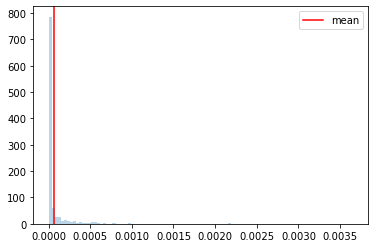

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654371177
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 10.0, 'jump_size_a': 1.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:08, 14.46it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:50,  8.97it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:52,  8.86it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:53,  8.74it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:59,  8.24it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<02:04,  7.95it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:59,  8.22it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<02:01,  8.09it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:55,  8.46it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:54,  8.54it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:56,  8.38it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<01:56,  8.35it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:14,  7.20it/s]

Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:10,  7.41it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:09,  7.46it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<02:01,  7.99it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<01:57,  8.25it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:01,  7.94it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<01:59,  8.06it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<01:54,  8.36it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<01:51,  8.62it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:56,  8.22it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:56,  8.20it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:57,  8.11it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<01:59,  7.92it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<01:57,  8.07it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:59,  7.88it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<02:01,  7.77it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:00,  7.84it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:57,  8.01it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:02,  7.62it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<02:05,  7.46it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:06,  7.39it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:02,  7.63it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:05,  7.41it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:07,  7.30it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:00,  7.70it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:03,  7.45it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:04,  7.37it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:05,  7.32it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:00,  7.59it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:03,  7.41it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<02:04,  7.32it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:05,  7.24it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:03,  7.36it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:04,  7.30it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:08,  7.07it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:07,  7.07it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:10,  6.92it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:08,  6.99it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:33,  5.85it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:22,  6.27it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:12,  6.74it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:09,  6.88it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:06,  7.04it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:06,  6.99it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:03,  7.16it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:05,  7.06it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:10,  6.75it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:12,  6.65it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:11,  6.66it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:11,  6.65it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:16,  6.40it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:18,  6.29it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:12,  6.54it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:14,  6.45it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:12,  6.54it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:16,  6.33it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:12,  6.52it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:10,  6.59it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:08,  6.67it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:08,  6.64it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:22,  5.99it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:20,  6.06it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:17,  6.19it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<02:16,  6.19it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:14,  6.29it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:15,  6.21it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<02:12,  6.32it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:18,  6.07it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:20,  5.97it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:21,  5.89it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:15,  6.14it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:16,  6.11it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:23<02:11,  6.28it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:10,  6.33it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:13,  6.18it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:24<02:11,  6.25it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:15,  6.06it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:14,  6.10it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:25<02:13,  6.13it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:13,  6.12it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:13,  6.09it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:26<02:16,  5.94it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 190/1000 [00:27<02:18,  5.84it/s]

Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:27<02:33,  5.26it/s]

Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:27<02:32,  5.30it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:26,  5.48it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:24,  5.56it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▌                                                               | 197/1000 [00:28<02:24,  5.55it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:27,  5.43it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:24,  5.52it/s]

Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:24,  5.53it/s]

Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:29<02:23,  5.54it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:22,  5.56it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:30<02:28,  5.33it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:29,  5.32it/s]

Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:30<02:31,  5.21it/s]

Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:33,  5.16it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:31<02:34,  5.09it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:40,  4.90it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:37,  4.99it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:32<02:38,  4.95it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:32<02:32,  5.15it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:28,  5.24it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:27,  5.29it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:24,  5.40it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:33<02:25,  5.34it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:23,  5.41it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:33<02:19,  5.57it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:34<02:42,  4.75it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:34<02:35,  4.95it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:34,  4.99it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:29,  5.16it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:20,  5.46it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:23,  5.32it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:27,  5.19it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:36<02:26,  5.20it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:36<02:23,  5.30it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:24,  5.25it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:22,  5.32it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:18,  5.48it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:37<02:17,  5.50it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:20,  5.39it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:23,  5.26it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:21,  5.31it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:38<02:18,  5.42it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:24,  5.19it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:28,  5.04it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:24,  5.19it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:39<02:28,  5.02it/s]

Monte Carlo 252
Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:30,  4.95it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:31,  4.91it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:28,  5.01it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:40<02:28,  4.99it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:27,  5.01it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:27,  5.02it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:40<02:24,  5.10it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:26,  5.04it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:26,  5.02it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:41<02:23,  5.10it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:23,  5.12it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:25,  5.02it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:26,  4.97it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:26,  4.96it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:27,  4.91it/s]

Monte Carlo 273
Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:30,  4.80it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:30,  4.82it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:26,  4.93it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:44<02:21,  5.09it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:44<02:14,  5.35it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:13,  5.36it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:14,  5.31it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:13,  5.37it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:45<02:12,  5.37it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:13,  5.35it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:10,  5.46it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:09,  5.51it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:46<02:12,  5.35it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:17,  5.16it/s]

Monte Carlo 292
Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:47<02:21,  5.01it/s]

Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:47<02:21,  4.97it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:47<02:26,  4.81it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:25,  4.82it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:48<02:22,  4.92it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:21,  4.96it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:19,  5.01it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:48<02:18,  5.04it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:48<02:19,  5.01it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:49<02:17,  5.07it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:49<02:16,  5.08it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:49<02:15,  5.11it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:49<02:15,  5.10it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:49<02:14,  5.13it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:15,  5.09it/s]

Monte Carlo 308
Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:50<02:21,  4.88it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:50<02:28,  4.64it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:51<02:23,  4.79it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:21,  4.85it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:21,  4.83it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:51<02:20,  4.88it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:51<02:18,  4.91it/s]

Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:21,  4.82it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:25,  4.68it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:30,  4.52it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:52<02:31,  4.47it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:28,  4.56it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:28,  4.56it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:53<02:35,  4.35it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:26,  4.59it/s]

Monte Carlo 326
Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:25,  4.61it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:54<02:24,  4.64it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:54<02:22,  4.68it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:55<02:20,  4.74it/s]

Monte Carlo 331
Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:20,  4.74it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:55<02:24,  4.60it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:22,  4.67it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:24,  4.58it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:56<02:31,  4.37it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:56<02:33,  4.31it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:56<02:34,  4.27it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:30,  4.39it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:28,  4.43it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:57<02:30,  4.36it/s]

Monte Carlo 343
Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:28,  4.42it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:24,  4.51it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:25,  4.50it/s]

Monte Carlo 347


 35%|███████████████████████████▌                                                   | 349/1000 [00:58<02:25,  4.48it/s]

Monte Carlo 348
Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:23,  4.54it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:23,  4.52it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:25,  4.44it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:59<02:24,  4.47it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:25,  4.43it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:25,  4.42it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:53,  3.71it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:00<02:48,  3.81it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:39,  4.04it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:34,  4.15it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:30,  4.24it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:31,  4.22it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:32,  4.17it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:28,  4.28it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:30,  4.23it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:35,  4.08it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:29,  4.23it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:29,  4.23it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:35,  4.08it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:35,  4.07it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:31,  4.16it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:30,  4.18it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:32,  4.11it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:30,  4.17it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:04<02:26,  4.29it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:23,  4.37it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:27,  4.23it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:26,  4.25it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:26,  4.25it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:24,  4.30it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:23,  4.32it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:27,  4.20it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:24,  4.26it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:24,  4.28it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:23,  4.30it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:22,  4.33it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:23,  4.28it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:26,  4.19it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:24,  4.24it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:26,  4.17it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:26,  4.17it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:08<02:23,  4.24it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:25,  4.19it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:24,  4.21it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:26,  4.13it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:09<02:25,  4.15it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:27,  4.09it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:27,  4.09it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:27,  4.07it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:36,  3.85it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:11<02:39,  3.75it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:38,  3.77it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:38,  3.78it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:32,  3.93it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:30,  3.97it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:30,  3.96it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:26,  4.05it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:24,  4.10it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:21,  4.17it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:13<02:22,  4.16it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:21,  4.17it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:22,  4.12it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<02:25,  4.03it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:25,  4.03it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:23,  4.08it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:28,  3.93it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:24,  4.03it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:15<02:25,  4.01it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:27,  3.96it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:24,  4.02it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:16<02:21,  4.09it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:16<02:22,  4.07it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:21,  4.08it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:21,  4.07it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:27,  3.90it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:17<02:22,  4.03it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:20,  4.08it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:15,  4.22it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:16,  4.19it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:14,  4.26it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:14,  4.25it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:11,  4.34it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:08,  4.41it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:11,  4.30it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:15,  4.17it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:16,  4.13it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:19<02:12,  4.25it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:13,  4.20it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:15,  4.14it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:20<02:14,  4.16it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:20<02:13,  4.18it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:21<02:18,  4.02it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:21<02:21,  3.94it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:21<02:18,  4.03it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:21<02:17,  4.05it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:22<02:24,  3.83it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:22<02:26,  3.78it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:22<02:21,  3.92it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:23<02:19,  3.96it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:23<02:21,  3.90it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:23<02:29,  3.69it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:23<02:28,  3.69it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:24<02:25,  3.77it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:24<02:29,  3.67it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:24<02:27,  3.71it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:24<02:25,  3.74it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:25<02:24,  3.78it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:25<02:22,  3.80it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:25<02:25,  3.71it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:28,  3.65it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:26<02:24,  3.75it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:26<02:21,  3.82it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:26<02:20,  3.83it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:27<02:20,  3.83it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:27<02:21,  3.80it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:27<02:26,  3.64it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:27<02:23,  3.73it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:28<02:24,  3.70it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:28<02:24,  3.67it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:28<02:27,  3.61it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:28<02:28,  3.56it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:29<02:29,  3.54it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:29<02:25,  3.63it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:29<02:24,  3.65it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:25,  3.61it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:30<02:24,  3.62it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:30<02:25,  3.61it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:30<02:28,  3.52it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:31<02:27,  3.55it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:31<02:24,  3.61it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:31<02:22,  3.66it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:32<02:19,  3.72it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:32<02:19,  3.72it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:32<02:19,  3.71it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:32<02:19,  3.70it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:33<02:18,  3.72it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:33<02:21,  3.63it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:33<02:20,  3.66it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:33<02:19,  3.68it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:34<02:19,  3.67it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:34<02:19,  3.66it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:34<02:38,  3.21it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:35<02:34,  3.29it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:35<02:35,  3.27it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:35<02:29,  3.38it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:36<02:34,  3.27it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:36<02:30,  3.36it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:36<02:26,  3.44it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:36<02:21,  3.55it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:37<02:18,  3.62it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:37<02:17,  3.64it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:37<02:15,  3.68it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:37<02:15,  3.68it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:38<02:18,  3.58it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:38<02:21,  3.51it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:38<02:18,  3.57it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:39<02:19,  3.55it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:39<02:20,  3.52it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:39<02:21,  3.48it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:39<02:20,  3.50it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:40<02:23,  3.40it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:40<02:21,  3.46it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:40<02:21,  3.45it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:41<02:19,  3.49it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:41<02:19,  3.48it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:41<02:18,  3.50it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:41<02:17,  3.51it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:42<02:16,  3.53it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:42<02:15,  3.55it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:42<02:16,  3.53it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:43<02:16,  3.51it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:43<02:16,  3.51it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:43<02:17,  3.46it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:44<02:24,  3.31it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:44<02:18,  3.43it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:44<02:18,  3.42it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:44<02:22,  3.33it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:45<02:21,  3.34it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:45<02:17,  3.43it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:45<02:18,  3.40it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:46<02:19,  3.37it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:46<02:16,  3.44it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:46<02:17,  3.42it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:46<02:16,  3.42it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:47<02:14,  3.46it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:47<02:14,  3.46it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:47<02:19,  3.34it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:48<02:17,  3.36it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:48<02:20,  3.29it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:48<02:23,  3.22it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:49<02:18,  3.32it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:49<02:18,  3.31it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:49<02:18,  3.31it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:49<02:17,  3.32it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:50<02:17,  3.31it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:50<02:15,  3.36it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:50<02:16,  3.33it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:51<02:14,  3.37it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:51<02:13,  3.38it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:51<02:15,  3.32it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:52<02:18,  3.25it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:52<02:17,  3.26it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:52<02:22,  3.14it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:53<02:18,  3.22it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:53<02:18,  3.23it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:53<02:21,  3.15it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:53<02:19,  3.19it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:54<02:16,  3.26it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:54<02:16,  3.23it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:54<02:16,  3.23it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:55<02:16,  3.23it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:55<02:16,  3.21it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:55<02:14,  3.26it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:56<02:15,  3.22it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:56<02:14,  3.24it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:56<02:13,  3.25it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:57<02:16,  3.19it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:57<02:16,  3.18it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:57<02:20,  3.07it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:58<02:23,  3.01it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:58<02:18,  3.09it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:58<02:18,  3.10it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:59<02:17,  3.12it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:59<02:14,  3.17it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:59<02:16,  3.13it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:59<02:13,  3.18it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:00<02:13,  3.17it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:00<02:13,  3.17it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:00<02:14,  3.13it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:01<02:15,  3.11it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:01<02:15,  3.11it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:01<02:12,  3.15it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:02<02:12,  3.15it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:02<02:12,  3.14it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:02<02:13,  3.12it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:03<02:15,  3.07it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:03<02:12,  3.13it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:03<02:12,  3.12it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:04<02:12,  3.10it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:04<02:11,  3.13it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:04<02:10,  3.14it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:05<02:12,  3.09it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:05<02:12,  3.07it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:05<02:10,  3.11it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:06<02:12,  3.05it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:06<02:10,  3.11it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:06<02:08,  3.14it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:07<02:10,  3.09it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:07<02:09,  3.11it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:07<02:09,  3.10it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:08<02:10,  3.06it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:08<02:08,  3.11it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:08<02:08,  3.10it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:08<02:07,  3.12it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:09<02:06,  3.13it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:09<02:07,  3.09it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:09<02:06,  3.11it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:10<02:26,  2.69it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:10<02:20,  2.80it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:11<02:20,  2.78it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:11<02:15,  2.89it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:11<02:13,  2.92it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:12<02:12,  2.92it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:12<02:11,  2.95it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:12<02:10,  2.96it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:13<02:10,  2.96it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:13<02:09,  2.96it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:13<02:10,  2.94it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:14<02:08,  2.97it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:14<02:10,  2.92it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:14<02:09,  2.94it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:15<02:06,  3.01it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:15<02:07,  2.97it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:15<02:04,  3.03it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:16<02:02,  3.06it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:16<02:02,  3.06it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:16<02:06,  2.95it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:17<02:03,  3.01it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:17<02:02,  3.03it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:17<02:04,  2.98it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:18<02:04,  2.98it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:18<02:04,  2.97it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:18<02:05,  2.94it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:19<02:05,  2.92it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:19<02:06,  2.90it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:19<02:08,  2.85it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:20<02:04,  2.92it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:20<02:02,  2.97it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:20<02:01,  2.97it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:21<02:00,  3.00it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:21<02:00,  3.00it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:21<02:01,  2.96it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:22<01:58,  3.03it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:22<01:59,  3.00it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:22<01:59,  2.97it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:23<01:57,  3.03it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:23<02:01,  2.91it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:23<01:59,  2.96it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:24<01:58,  2.98it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:24<01:57,  2.99it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:24<01:58,  2.96it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:25<01:58,  2.95it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:25<01:57,  2.97it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:25<01:56,  2.97it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:26<01:57,  2.94it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:26<01:58,  2.90it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:26<01:57,  2.92it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:27<01:58,  2.89it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:27<01:58,  2.88it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:27<01:58,  2.89it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:28<01:56,  2.91it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:28<01:56,  2.90it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:28<01:54,  2.94it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:29<01:54,  2.95it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:29<01:54,  2.95it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:29<01:52,  2.97it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:30<01:53,  2.94it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:30<01:54,  2.90it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:31<01:55,  2.88it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:31<01:57,  2.81it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:31<01:54,  2.88it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:32<01:53,  2.90it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:32<01:53,  2.88it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:32<01:50,  2.96it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:33<01:47,  3.02it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:33<01:46,  3.04it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:33<01:45,  3.06it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:34<01:44,  3.10it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:34<01:43,  3.10it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:34<01:43,  3.10it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:35<01:42,  3.11it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:35<01:43,  3.09it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:35<01:44,  3.03it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:35<01:42,  3.08it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:36<01:45,  3.00it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:36<01:44,  3.03it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:37<01:45,  2.99it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:37<01:42,  3.05it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:37<01:42,  3.04it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:37<01:40,  3.10it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:38<01:39,  3.11it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:38<01:39,  3.12it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:38<01:39,  3.09it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:39<01:38,  3.11it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:39<01:39,  3.08it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:39<01:39,  3.06it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:40<01:38,  3.08it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:40<01:41,  2.97it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:40<01:40,  3.00it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:41<01:38,  3.04it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:41<01:40,  2.98it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:41<01:38,  3.04it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:42<01:40,  2.97it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:42<01:43,  2.88it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:42<01:41,  2.91it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:43<01:56,  2.52it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:43<01:57,  2.50it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:44<01:51,  2.62it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:44<01:48,  2.69it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:44<01:46,  2.74it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:45<01:41,  2.86it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:45<01:41,  2.85it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:45<01:39,  2.90it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:46<01:37,  2.94it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:46<01:38,  2.91it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:46<01:36,  2.94it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:47<01:39,  2.85it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:47<01:37,  2.89it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:47<01:37,  2.88it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:48<01:37,  2.89it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:48<01:35,  2.93it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:49<01:36,  2.88it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:49<01:34,  2.94it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:49<01:34,  2.93it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:50<01:35,  2.89it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:50<01:35,  2.89it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:50<01:35,  2.86it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:51<01:33,  2.91it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:51<01:32,  2.93it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:51<01:35,  2.83it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:52<01:37,  2.76it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:52<01:36,  2.79it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:52<01:35,  2.80it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:53<01:36,  2.77it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:53<01:37,  2.74it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:54<01:40,  2.65it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:54<01:38,  2.67it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:54<01:37,  2.70it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:55<01:35,  2.74it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:55<01:37,  2.69it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:55<01:36,  2.69it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:56<01:35,  2.72it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:56<01:36,  2.67it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:57<01:35,  2.69it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:57<01:35,  2.69it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:57<01:38,  2.60it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:58<01:39,  2.55it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:58<01:39,  2.54it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:59<01:40,  2.52it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:59<01:38,  2.55it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:59<01:36,  2.60it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:00<01:33,  2.66it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:00<01:34,  2.64it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:00<01:31,  2.69it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:01<01:31,  2.68it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:01<01:30,  2.72it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:01<01:30,  2.71it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:02<01:30,  2.70it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:02<01:31,  2.65it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:03<01:30,  2.67it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:03<01:31,  2.64it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:03<01:30,  2.65it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:04<01:29,  2.65it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:04<01:30,  2.63it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:04<01:29,  2.65it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:05<01:29,  2.63it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:05<01:27,  2.69it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:06<01:27,  2.66it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:06<01:27,  2.65it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:06<01:26,  2.67it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:07<01:25,  2.68it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:07<01:24,  2.70it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:07<01:25,  2.67it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:08<01:24,  2.67it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:08<01:26,  2.62it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:09<01:26,  2.61it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:09<01:28,  2.53it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:09<01:28,  2.53it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:10<01:28,  2.51it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:10<01:27,  2.52it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:11<01:31,  2.41it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:11<01:35,  2.29it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:12<01:35,  2.27it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:12<01:33,  2.32it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:12<01:31,  2.35it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:13<01:28,  2.44it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:13<01:29,  2.40it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:14<01:31,  2.34it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:14<01:29,  2.37it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:15<01:31,  2.30it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:15<01:30,  2.31it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:16<01:32,  2.25it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:16<01:31,  2.27it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:16<01:29,  2.30it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:17<01:33,  2.21it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:17<01:29,  2.29it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:18<01:27,  2.34it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:18<01:28,  2.30it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:19<01:25,  2.36it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:19<01:27,  2.30it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:19<01:28,  2.26it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:20<01:27,  2.29it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:20<01:27,  2.27it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:21<01:25,  2.31it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:21<01:23,  2.34it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:22<01:23,  2.34it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:22<01:30,  2.14it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:23<01:27,  2.21it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:23<01:26,  2.22it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:23<01:24,  2.25it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:24<01:23,  2.29it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:24<01:22,  2.28it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:25<01:24,  2.23it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:25<01:22,  2.27it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:26<01:21,  2.28it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:26<01:22,  2.23it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:27<01:23,  2.20it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:27<01:21,  2.25it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:27<01:19,  2.28it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:28<01:19,  2.28it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:28<01:21,  2.21it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:29<01:20,  2.23it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:29<01:18,  2.27it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:30<01:20,  2.21it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:30<01:19,  2.22it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:31<01:19,  2.21it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:31<01:17,  2.24it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:31<01:17,  2.23it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:32<01:18,  2.20it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:32<01:18,  2.19it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:33<01:16,  2.21it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:33<01:14,  2.26it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:34<01:15,  2.22it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:34<01:16,  2.18it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:35<01:15,  2.20it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:35<01:14,  2.23it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:35<01:11,  2.29it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:36<01:12,  2.25it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:36<01:11,  2.26it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:37<01:09,  2.31it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:37<01:08,  2.35it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:38<01:07,  2.36it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:38<01:06,  2.39it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:38<01:05,  2.40it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:39<01:04,  2.41it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:39<01:03,  2.43it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:40<01:02,  2.45it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:40<01:03,  2.42it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:40<01:02,  2.44it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:41<01:01,  2.45it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:41<01:01,  2.45it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:42<01:00,  2.47it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:42<00:59,  2.48it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:42<00:59,  2.49it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:43<00:59,  2.46it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:43<01:00,  2.42it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:44<00:58,  2.45it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:44<00:59,  2.42it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:45<00:58,  2.42it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:45<00:58,  2.42it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:45<00:57,  2.42it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:46<00:57,  2.42it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:46<00:56,  2.43it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:47<00:56,  2.43it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:47<00:56,  2.40it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:47<00:56,  2.39it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:48<00:56,  2.37it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:48<00:56,  2.37it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:49<00:55,  2.40it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:49<00:54,  2.43it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:50<00:54,  2.37it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:50<00:53,  2.40it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:50<00:53,  2.39it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:51<00:53,  2.38it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:51<00:52,  2.39it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:52<00:53,  2.32it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:52<00:53,  2.34it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:53<00:52,  2.36it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:53<00:51,  2.37it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:53<00:50,  2.41it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:54<00:48,  2.46it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:54<00:48,  2.45it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:55<00:48,  2.45it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:55<00:47,  2.47it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:55<00:47,  2.46it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:56<00:46,  2.48it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:56<00:45,  2.52it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:57<00:45,  2.50it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:57<00:45,  2.49it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:57<00:45,  2.45it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:58<00:45,  2.44it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:58<00:44,  2.44it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:59<00:44,  2.45it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:59<00:44,  2.40it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:59<00:44,  2.36it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:00<00:44,  2.35it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:00<00:44,  2.35it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:01<00:43,  2.35it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:01<00:43,  2.36it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:02<00:42,  2.35it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:02<00:42,  2.34it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:02<00:41,  2.38it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:03<00:40,  2.39it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:03<00:39,  2.44it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:04<00:41,  2.30it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:04<00:40,  2.33it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:05<00:39,  2.39it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:05<00:38,  2.41it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:05<00:37,  2.45it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:06<00:37,  2.45it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:06<00:36,  2.45it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:07<00:36,  2.41it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:07<00:36,  2.42it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:07<00:35,  2.47it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:08<00:35,  2.44it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:08<00:35,  2.43it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:09<00:34,  2.41it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:09<00:35,  2.37it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:10<00:34,  2.36it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:10<00:34,  2.34it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:10<00:34,  2.33it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:11<00:33,  2.34it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:11<00:33,  2.30it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:12<00:33,  2.29it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:12<00:32,  2.31it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:13<00:32,  2.31it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:13<00:32,  2.29it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:13<00:32,  2.27it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:14<00:31,  2.25it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:14<00:31,  2.24it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:15<00:30,  2.26it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:15<00:30,  2.26it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:16<00:29,  2.28it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:16<00:29,  2.30it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:17<00:28,  2.29it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:17<00:28,  2.27it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:17<00:28,  2.28it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:18<00:28,  2.24it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:18<00:27,  2.22it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:19<00:27,  2.23it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:19<00:26,  2.23it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:20<00:26,  2.24it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:20<00:25,  2.25it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:21<00:25,  2.23it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:21<00:25,  2.23it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:21<00:24,  2.21it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:22<00:24,  2.21it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:22<00:24,  2.20it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:23<00:23,  2.22it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:23<00:22,  2.23it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:24<00:22,  2.23it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:24<00:21,  2.25it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:25<00:21,  2.23it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:25<00:21,  2.22it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:26<00:20,  2.19it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:26<00:20,  2.23it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:26<00:19,  2.24it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:27<00:19,  2.26it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:27<00:18,  2.26it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:28<00:18,  2.22it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:28<00:18,  2.21it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:29<00:17,  2.21it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:29<00:17,  2.17it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:30<00:16,  2.18it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:30<00:16,  2.22it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:30<00:15,  2.21it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:31<00:15,  2.21it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:31<00:14,  2.20it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:32<00:14,  2.23it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:32<00:13,  2.22it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:33<00:13,  2.21it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:33<00:13,  2.22it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:34<00:12,  2.21it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:34<00:12,  2.23it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:35<00:11,  2.20it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:35<00:11,  2.22it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:35<00:10,  2.22it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:36<00:10,  2.19it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:36<00:09,  2.21it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:37<00:09,  2.23it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:37<00:08,  2.23it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:38<00:08,  2.24it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:38<00:08,  2.21it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:39<00:07,  2.19it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:39<00:07,  2.22it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:40<00:06,  2.19it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:40<00:06,  2.03it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:41<00:06,  2.01it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:41<00:05,  2.06it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:42<00:05,  2.08it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:42<00:04,  2.18it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:42<00:04,  2.22it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:43<00:03,  2.20it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:43<00:03,  2.22it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:44<00:02,  2.27it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:44<00:02,  2.26it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:45<00:01,  2.26it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:45<00:01,  2.29it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:45<00:00,  2.30it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:46<00:00,  2.28it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:46<00:00,  3.49it/s]


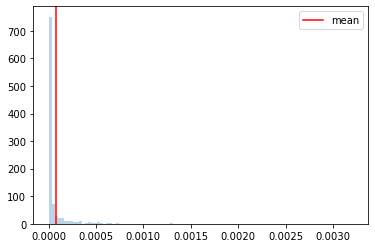

  0%|▏                                                                                | 3/1000 [00:00<01:00, 16.44it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654371464
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 10.0, 'jump_size_a': 10.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:24, 11.78it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:49,  9.10it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:49,  9.03it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:59,  8.29it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:52,  8.73it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:50,  8.89it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:47,  9.15it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▋                                                                              | 21/1000 [00:02<01:49,  8.96it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:49,  8.96it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:50,  8.83it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:53,  8.61it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:54,  8.47it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<01:58,  8.21it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:20,  6.87it/s]

Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<02:12,  7.32it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<02:12,  7.30it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:03,  7.78it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<02:00,  7.99it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<01:52,  8.51it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<01:55,  8.26it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:52,  8.45it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:53,  8.43it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:56,  8.14it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<01:56,  8.12it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<01:57,  8.05it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:58,  8.00it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<02:07,  7.42it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:01,  7.73it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:02,  7.67it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<01:58,  7.91it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<01:56,  7.99it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:00,  7.72it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<01:56,  7.99it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<01:57,  7.94it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<02:00,  7.67it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<01:59,  7.71it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:04,  7.40it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<01:58,  7.79it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:09<01:56,  7.89it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:00,  7.61it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:02,  7.44it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<02:24,  6.30it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:10,  6.98it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:08,  7.08it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:11,  6.92it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<02:08,  7.04it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:04,  7.23it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:04,  7.25it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<01:54,  7.85it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:12<01:54,  7.86it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<01:57,  7.59it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:02,  7.28it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<01:58,  7.52it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:00,  7.37it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:00,  7.38it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:03,  7.19it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:14<01:57,  7.52it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<01:55,  7.65it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:03,  7.12it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<02:03,  7.12it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:15<01:58,  7.36it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:05,  6.96it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:01,  7.16it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:16<02:02,  7.08it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:01,  7.17it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<02:03,  6.99it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:17<02:02,  7.05it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:17<02:06,  6.82it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:09,  6.63it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:18<02:10,  6.55it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:18<02:12,  6.45it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:11,  6.50it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:19<02:07,  6.68it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:19<02:06,  6.73it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:07,  6.62it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:20<02:10,  6.48it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:20<02:09,  6.49it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<02:16,  6.16it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:21<02:16,  6.17it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:21<02:14,  6.22it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:09,  6.46it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:20,  5.92it/s]

Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:22<02:21,  5.87it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:22<02:12,  6.27it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:23<02:09,  6.40it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:23<02:16,  6.07it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:23<02:11,  6.28it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:24<02:11,  6.26it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:24<02:11,  6.24it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:24<02:08,  6.34it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:25<02:09,  6.30it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:25<02:19,  5.85it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:25<02:20,  5.79it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:26<02:19,  5.83it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████                                                                | 191/1000 [00:26<02:19,  5.81it/s]

Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:26<02:30,  5.37it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:26<02:26,  5.52it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:27<02:19,  5.77it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:27<02:16,  5.89it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:27<02:21,  5.66it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:28<02:19,  5.72it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:28<02:14,  5.94it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:28<02:14,  5.91it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:29<02:19,  5.69it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:29<02:20,  5.64it/s]

Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:29<02:20,  5.63it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:30<02:18,  5.70it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▊                                                              | 213/1000 [00:30<02:20,  5.58it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:30<02:36,  5.01it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:30,  5.21it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:26,  5.33it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:31<02:22,  5.48it/s]

Monte Carlo 219
Monte Carlo 220

 22%|█████████████████▍                                                             | 221/1000 [00:31<02:21,  5.51it/s]


Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:32<02:18,  5.61it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:32<02:21,  5.48it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:32<02:19,  5.56it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:19,  5.54it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:33<02:17,  5.62it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:33<02:12,  5.78it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:15,  5.67it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:34<02:14,  5.67it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:34<02:15,  5.64it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:34<02:19,  5.45it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:35<02:15,  5.59it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:35<02:15,  5.59it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:35<02:13,  5.68it/s]

Monte Carlo 243
Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:36<02:13,  5.66it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:36<02:13,  5.65it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:36<02:15,  5.53it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:37<02:16,  5.50it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:37<02:23,  5.19it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:37<02:22,  5.22it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:38<02:21,  5.28it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:38<02:17,  5.40it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:38<02:18,  5.35it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▌                                                          | 261/1000 [00:39<02:16,  5.40it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:39<02:20,  5.24it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:39<02:19,  5.29it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:39<02:16,  5.39it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:39<02:14,  5.46it/s]

Monte Carlo 265
Monte Carlo 266


 27%|█████████████████████                                                          | 267/1000 [00:40<02:13,  5.48it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:40<02:24,  5.07it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:40<02:18,  5.25it/s]

Monte Carlo 269
Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:41<02:20,  5.19it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:41<02:18,  5.26it/s]

Monte Carlo 273
Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:41<02:21,  5.11it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:42<02:22,  5.08it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:42<02:21,  5.11it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:42<02:22,  5.06it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:42<02:23,  5.03it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:42<02:22,  5.06it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:43<02:24,  4.98it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:43<02:21,  5.07it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:43<02:21,  5.06it/s]

Monte Carlo 283
Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:43<02:24,  4.96it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:44<02:23,  4.96it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:44<02:26,  4.87it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:44<02:25,  4.88it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:44<02:21,  5.00it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:45<02:23,  4.92it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:45<02:20,  5.03it/s]

Monte Carlo 293
Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:45<02:25,  4.84it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:46<02:24,  4.87it/s]

Monte Carlo 296
Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:46<02:23,  4.88it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:46<02:21,  4.96it/s]

Monte Carlo 299
Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:47<02:20,  4.95it/s]

Monte Carlo 301
Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:47<02:23,  4.86it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:47<02:19,  4.98it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:48<02:17,  5.05it/s]

Monte Carlo 305
Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:48<02:20,  4.94it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:48<02:21,  4.88it/s]

Monte Carlo 308
Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:48<02:38,  4.35it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:49<02:40,  4.29it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:49<02:32,  4.50it/s]

Monte Carlo 312
Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:49<02:29,  4.60it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:50<02:23,  4.76it/s]

Monte Carlo 315
Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:50<02:24,  4.71it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:50<02:28,  4.57it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:51<02:28,  4.58it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:51<02:25,  4.67it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:51<02:23,  4.73it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:51<02:20,  4.80it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:52<02:17,  4.91it/s]

Monte Carlo 324
Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:52<02:18,  4.85it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:52<02:19,  4.82it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:52<02:22,  4.71it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:53<02:21,  4.75it/s]

Monte Carlo 329
Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:53<02:19,  4.78it/s]

Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:53<02:19,  4.77it/s]

Monte Carlo 332
Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:54<02:21,  4.71it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:54<02:17,  4.82it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 337/1000 [00:54<02:17,  4.82it/s]

Monte Carlo 336


 34%|██████████████████████████▋                                                    | 338/1000 [00:54<02:14,  4.92it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:55<02:12,  4.99it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:55<02:11,  5.01it/s]

Monte Carlo 339


 34%|██████████████████████████▉                                                    | 341/1000 [00:55<02:13,  4.95it/s]

Monte Carlo 340


 34%|███████████████████████████                                                    | 342/1000 [00:55<02:11,  4.99it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 343/1000 [00:55<02:11,  5.02it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:56<02:09,  5.07it/s]

Monte Carlo 343


 34%|███████████████████████████▎                                                   | 345/1000 [00:56<02:09,  5.06it/s]

Monte Carlo 344


 35%|███████████████████████████▎                                                   | 346/1000 [00:56<02:10,  4.99it/s]

Monte Carlo 345


 35%|███████████████████████████▍                                                   | 347/1000 [00:56<02:11,  4.96it/s]

Monte Carlo 346
Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:56<02:15,  4.82it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:57<02:32,  4.28it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:57<02:36,  4.15it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:57<02:29,  4.34it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:57<02:29,  4.33it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:58<02:31,  4.27it/s]

Monte Carlo 353


 36%|████████████████████████████                                                   | 355/1000 [00:58<02:23,  4.49it/s]

Monte Carlo 354
Monte Carlo 355


 36%|████████████████████████████▏                                                  | 357/1000 [00:58<02:17,  4.67it/s]

Monte Carlo 356


 36%|████████████████████████████▎                                                  | 358/1000 [00:59<02:16,  4.71it/s]

Monte Carlo 357
Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [00:59<02:17,  4.67it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [00:59<02:16,  4.69it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [00:59<02:20,  4.56it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [00:59<02:15,  4.69it/s]

Monte Carlo 362


 36%|████████████████████████████▊                                                  | 364/1000 [01:00<02:35,  4.10it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 365/1000 [01:00<02:24,  4.40it/s]

Monte Carlo 364


 37%|████████████████████████████▉                                                  | 366/1000 [01:00<02:17,  4.62it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 367/1000 [01:01<02:15,  4.66it/s]

Monte Carlo 366


 37%|█████████████████████████████                                                  | 368/1000 [01:01<02:09,  4.88it/s]

Monte Carlo 367
Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 370/1000 [01:01<02:06,  4.99it/s]

Monte Carlo 369


 37%|█████████████████████████████▎                                                 | 371/1000 [01:01<02:04,  5.05it/s]

Monte Carlo 370


 37%|█████████████████████████████▍                                                 | 372/1000 [01:02<02:05,  4.99it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 373/1000 [01:02<02:04,  5.04it/s]

Monte Carlo 372


 37%|█████████████████████████████▌                                                 | 374/1000 [01:02<02:03,  5.08it/s]

Monte Carlo 373


 38%|█████████████████████████████▋                                                 | 375/1000 [01:02<02:04,  5.03it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 376/1000 [01:02<02:03,  5.06it/s]

Monte Carlo 375
Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:03<02:09,  4.80it/s]

Monte Carlo 377


 38%|█████████████████████████████▉                                                 | 379/1000 [01:03<02:09,  4.80it/s]

Monte Carlo 378


 38%|██████████████████████████████                                                 | 380/1000 [01:03<02:06,  4.91it/s]

Monte Carlo 379
Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:03<02:09,  4.78it/s]

Monte Carlo 381


 38%|██████████████████████████████▎                                                | 383/1000 [01:04<02:09,  4.77it/s]

Monte Carlo 382
Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:04<02:12,  4.65it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:04<02:15,  4.55it/s]

Monte Carlo 385


 39%|██████████████████████████████▌                                                | 387/1000 [01:05<02:12,  4.62it/s]

Monte Carlo 386
Monte Carlo 387


 39%|██████████████████████████████▋                                                | 389/1000 [01:05<02:11,  4.65it/s]

Monte Carlo 388
Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:05<02:11,  4.65it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:06<02:16,  4.46it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:06<02:14,  4.53it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:06<02:13,  4.56it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:06<02:12,  4.59it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:07<02:13,  4.52it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:07<02:19,  4.32it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:07<02:20,  4.31it/s]

Monte Carlo 397


 40%|███████████████████████████████▌                                               | 399/1000 [01:07<02:14,  4.46it/s]

Monte Carlo 398
Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:08<02:16,  4.40it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:08<02:16,  4.40it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:08<02:18,  4.33it/s]

Monte Carlo 402


 40%|███████████████████████████████▉                                               | 404/1000 [01:09<02:13,  4.48it/s]

Monte Carlo 403
Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:09<02:12,  4.47it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:09<02:11,  4.50it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:09<02:12,  4.46it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:10<02:12,  4.48it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:10<02:18,  4.26it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:10<02:18,  4.25it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:10<02:17,  4.30it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:10<02:20,  4.18it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:11<02:17,  4.25it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:11<02:21,  4.13it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:11<02:21,  4.12it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:11<02:23,  4.08it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:12<02:22,  4.10it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:12<02:28,  3.91it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:12<02:27,  3.93it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:13<02:28,  3.91it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:13<02:25,  3.98it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:13<02:22,  4.05it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:13<02:19,  4.15it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:13<02:22,  4.06it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:14<02:18,  4.16it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:14<02:16,  4.22it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:14<02:15,  4.23it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:14<02:13,  4.29it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:15<02:15,  4.21it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:15<02:20,  4.07it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:15<02:18,  4.11it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:15<02:21,  4.02it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:16<02:19,  4.06it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:16<02:18,  4.07it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:16<02:16,  4.12it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:16<02:17,  4.11it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:17<02:23,  3.93it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:17<02:21,  3.98it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:17<02:21,  3.97it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:17<02:21,  3.97it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:18<02:22,  3.93it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:18<02:22,  3.93it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:18<02:18,  4.01it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:18<02:21,  3.94it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:19<02:20,  3.94it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:19<02:20,  3.93it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:19<02:19,  3.97it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:19<02:15,  4.08it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:20<02:17,  4.00it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:20<02:15,  4.07it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:20<02:16,  4.02it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:20<02:16,  4.00it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:21<02:20,  3.89it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:21<02:18,  3.95it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:21<02:18,  3.93it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:21<02:19,  3.89it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:22<02:18,  3.92it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:22<02:19,  3.89it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:22<02:17,  3.94it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:22<02:17,  3.93it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:23<02:20,  3.84it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:23<02:25,  3.70it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:23<02:19,  3.86it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:24<02:21,  3.80it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:24<02:17,  3.89it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:24<02:14,  3.98it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:24<02:14,  3.96it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:25<02:15,  3.92it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:25<02:14,  3.95it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:25<02:15,  3.92it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:25<02:12,  3.98it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:26<02:15,  3.90it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:26<02:13,  3.94it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:26<02:14,  3.91it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:26<02:14,  3.91it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:27<02:32,  3.43it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:27<02:29,  3.50it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:27<02:24,  3.62it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:27<02:20,  3.70it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:28<02:16,  3.81it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:28<02:15,  3.84it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:28<02:15,  3.83it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:28<02:14,  3.83it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:29<02:15,  3.82it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:29<02:13,  3.85it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:29<02:15,  3.80it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:30<02:15,  3.78it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:30<02:18,  3.69it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:30<02:18,  3.70it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:30<02:18,  3.67it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:31<02:19,  3.65it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:31<02:15,  3.74it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:31<02:14,  3.76it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:31<02:13,  3.78it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:32<02:10,  3.86it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:32<02:13,  3.78it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:32<02:13,  3.78it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:32<02:11,  3.82it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:33<02:11,  3.82it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:33<02:11,  3.80it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:33<02:11,  3.80it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:34<02:11,  3.79it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:34<02:11,  3.77it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:34<02:15,  3.67it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:34<02:16,  3.62it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:35<02:13,  3.70it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:35<02:14,  3.67it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:35<02:14,  3.66it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:35<02:13,  3.67it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:36<02:12,  3.70it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:36<02:16,  3.58it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:36<02:20,  3.47it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:37<02:17,  3.54it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:37<02:19,  3.49it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:37<02:16,  3.54it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:37<02:18,  3.49it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:38<02:19,  3.47it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:38<02:18,  3.47it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:38<02:16,  3.53it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:39<02:18,  3.47it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:39<02:16,  3.50it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:39<02:19,  3.42it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:39<02:18,  3.46it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:40<02:17,  3.45it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:40<02:13,  3.56it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:40<02:11,  3.61it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:41<02:11,  3.59it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:41<02:15,  3.48it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:41<02:12,  3.55it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:41<02:10,  3.60it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:42<02:11,  3.58it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:42<02:10,  3.60it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:42<02:07,  3.66it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:43<02:10,  3.58it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:43<02:10,  3.57it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:43<02:09,  3.59it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:43<02:10,  3.55it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:44<02:09,  3.58it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:44<02:11,  3.51it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:44<02:08,  3.57it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:45<02:08,  3.56it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:45<02:08,  3.56it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:45<02:07,  3.59it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:45<02:04,  3.65it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:46<02:08,  3.55it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:46<02:07,  3.55it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:46<02:06,  3.57it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:46<02:07,  3.54it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:47<02:09,  3.48it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:47<02:08,  3.50it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:47<02:10,  3.43it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:48<02:09,  3.47it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:48<02:08,  3.47it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:48<02:08,  3.46it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:49<02:10,  3.42it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:49<02:08,  3.45it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:49<02:08,  3.46it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:49<02:05,  3.51it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:50<02:03,  3.57it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:50<02:06,  3.48it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:50<02:07,  3.44it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:51<02:07,  3.43it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:51<02:08,  3.40it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:51<02:09,  3.37it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:51<02:07,  3.42it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:52<02:05,  3.47it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:52<02:05,  3.45it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:52<02:02,  3.52it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:53<02:01,  3.54it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:53<01:58,  3.64it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:53<01:55,  3.70it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:53<01:54,  3.75it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:54<01:58,  3.60it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:54<02:02,  3.48it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:54<02:00,  3.53it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:54<01:58,  3.58it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:55<01:59,  3.55it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:55<01:58,  3.55it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:55<02:01,  3.45it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:56<02:01,  3.46it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:56<01:58,  3.55it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:56<02:01,  3.45it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:57<02:01,  3.43it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:57<02:02,  3.41it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:57<02:00,  3.43it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [01:57<02:03,  3.35it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [01:58<02:05,  3.30it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [01:58<02:03,  3.34it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [01:58<02:03,  3.32it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [01:59<02:04,  3.29it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [01:59<02:01,  3.36it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [01:59<02:03,  3.29it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:00<02:01,  3.35it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:00<01:59,  3.39it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:00<02:00,  3.36it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:01<02:14,  3.01it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:01<02:09,  3.11it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:01<02:06,  3.19it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:01<02:07,  3.13it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:02<02:06,  3.17it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:02<02:05,  3.18it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:02<02:03,  3.22it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:03<02:02,  3.25it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:03<02:01,  3.27it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:03<02:00,  3.29it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:04<02:00,  3.26it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:04<02:00,  3.27it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:04<02:01,  3.22it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:05<02:03,  3.17it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:05<02:00,  3.24it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:05<01:59,  3.25it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:05<01:57,  3.29it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:06<01:58,  3.28it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:06<01:59,  3.23it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:06<01:58,  3.24it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:07<01:59,  3.20it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:07<01:59,  3.21it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:07<01:57,  3.24it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:08<01:56,  3.27it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:08<01:55,  3.28it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:08<01:56,  3.24it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:09<01:59,  3.15it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:09<01:58,  3.18it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:09<01:59,  3.15it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:09<01:59,  3.15it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:10<02:00,  3.11it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:10<02:01,  3.08it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:10<02:00,  3.10it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:11<01:58,  3.12it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:11<01:57,  3.14it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:11<01:59,  3.10it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:12<01:59,  3.08it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:12<01:59,  3.06it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:12<01:57,  3.13it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:13<01:56,  3.14it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:13<01:55,  3.16it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:13<01:54,  3.17it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:14<01:55,  3.12it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:14<01:54,  3.15it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:14<01:54,  3.15it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:15<01:54,  3.13it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:15<01:53,  3.15it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:15<01:53,  3.14it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:16<01:52,  3.17it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:16<01:51,  3.19it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:16<01:52,  3.14it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:17<01:51,  3.17it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:17<01:52,  3.12it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:17<01:54,  3.08it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:18<01:54,  3.05it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:18<01:55,  3.03it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:18<01:52,  3.10it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:19<01:54,  3.03it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:19<01:55,  3.01it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:19<01:53,  3.04it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:20<01:53,  3.02it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:20<01:56,  2.94it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:20<01:56,  2.93it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:21<01:53,  3.02it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:21<01:52,  3.02it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:21<01:54,  2.96it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:22<01:51,  3.03it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:22<01:51,  3.02it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:22<01:51,  3.01it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:23<01:51,  3.01it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:23<01:54,  2.91it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:23<01:53,  2.94it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:24<01:54,  2.91it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:24<01:53,  2.91it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:24<01:53,  2.90it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:25<01:50,  2.97it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:25<01:50,  2.97it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:25<01:50,  2.97it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:26<01:48,  3.02it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:26<01:51,  2.93it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:26<01:49,  2.96it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:27<01:51,  2.91it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:27<01:48,  2.98it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:27<01:48,  2.94it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:28<01:47,  2.97it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:28<01:47,  2.98it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:28<01:46,  2.98it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:29<01:47,  2.94it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:29<01:47,  2.94it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:29<01:45,  2.98it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:30<01:42,  3.05it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:30<01:43,  3.01it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:30<01:45,  2.96it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:31<01:43,  3.01it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:31<01:42,  3.03it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:31<01:43,  2.98it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:32<01:39,  3.09it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:32<01:38,  3.11it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:32<01:39,  3.08it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:33<01:35,  3.18it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:33<01:36,  3.15it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:33<01:35,  3.17it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:34<01:37,  3.11it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:34<01:39,  3.02it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:34<01:38,  3.04it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:35<01:41,  2.96it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:35<01:39,  2.99it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:35<01:38,  3.02it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:36<01:40,  2.96it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:36<01:37,  3.02it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:36<01:38,  2.99it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:37<01:38,  2.97it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:37<01:39,  2.94it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:37<01:47,  2.71it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:38<01:47,  2.71it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:38<01:46,  2.70it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:38<01:46,  2.70it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:39<01:45,  2.73it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:39<01:48,  2.64it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:40<01:45,  2.70it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:40<01:44,  2.72it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:40<01:42,  2.77it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:41<01:40,  2.81it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:41<01:37,  2.89it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:41<01:38,  2.84it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:42<01:40,  2.79it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:42<01:40,  2.77it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:42<01:38,  2.81it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:43<01:37,  2.84it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:43<01:37,  2.82it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:43<01:35,  2.88it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:44<01:35,  2.85it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:44<01:37,  2.79it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:44<01:34,  2.87it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:45<01:34,  2.86it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:45<01:34,  2.86it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:46<01:32,  2.89it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:46<01:30,  2.94it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:46<01:30,  2.95it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:47<01:29,  2.96it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:47<01:29,  2.95it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:47<01:28,  2.97it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:48<01:27,  2.98it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:48<01:28,  2.96it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:48<01:27,  2.98it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:49<01:25,  3.04it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:49<01:28,  2.92it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:49<01:27,  2.94it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:50<01:27,  2.92it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:50<01:29,  2.83it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:50<01:31,  2.79it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:51<01:28,  2.87it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:51<01:27,  2.89it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:51<01:26,  2.89it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:52<01:26,  2.90it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:52<01:28,  2.83it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:52<01:29,  2.77it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:53<01:29,  2.77it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:53<01:30,  2.72it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:54<01:29,  2.73it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:54<01:31,  2.67it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:54<01:29,  2.71it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:55<01:28,  2.75it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:55<01:27,  2.74it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:55<01:32,  2.58it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:56<01:30,  2.64it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:56<01:30,  2.62it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:57<01:30,  2.62it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:57<01:26,  2.71it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:57<01:26,  2.70it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:58<01:26,  2.69it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [02:58<01:27,  2.66it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [02:58<01:26,  2.70it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [02:59<01:25,  2.70it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [02:59<01:25,  2.69it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [02:59<01:24,  2.71it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:00<01:24,  2.70it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:00<01:23,  2.73it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:01<01:24,  2.67it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:01<01:22,  2.72it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:01<01:22,  2.72it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:02<01:22,  2.70it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:02<01:23,  2.66it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:02<01:21,  2.73it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:03<01:21,  2.71it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:03<01:20,  2.71it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:04<01:18,  2.77it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:04<01:19,  2.73it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:04<01:18,  2.74it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:05<01:18,  2.75it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:05<01:19,  2.70it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:05<01:20,  2.63it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:06<01:20,  2.63it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:06<01:19,  2.67it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:07<01:18,  2.69it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:07<01:18,  2.68it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:07<01:17,  2.68it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:08<01:15,  2.73it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:08<01:16,  2.70it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:08<01:15,  2.72it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:09<01:19,  2.55it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:09<01:24,  2.39it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:10<01:26,  2.32it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:10<01:25,  2.36it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:11<01:24,  2.35it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:11<01:23,  2.39it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:11<01:21,  2.42it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:12<01:21,  2.42it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:12<01:21,  2.41it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:13<01:19,  2.44it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:13<01:19,  2.44it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:13<01:18,  2.46it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:14<01:20,  2.39it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:14<01:19,  2.41it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:15<01:18,  2.43it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:15<01:16,  2.48it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:16<01:16,  2.46it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:16<01:18,  2.39it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:16<01:17,  2.41it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:17<01:17,  2.40it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:17<01:14,  2.47it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:18<01:17,  2.35it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:18<01:20,  2.27it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:19<01:20,  2.24it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:19<01:17,  2.32it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:19<01:18,  2.29it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:20<01:17,  2.29it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:20<01:17,  2.29it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:21<01:14,  2.36it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:21<01:15,  2.32it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:22<01:13,  2.36it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:22<01:15,  2.28it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:22<01:14,  2.32it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:23<01:18,  2.18it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:23<01:16,  2.22it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:24<01:13,  2.30it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:24<01:12,  2.32it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:25<01:09,  2.39it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:25<01:09,  2.38it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:25<01:08,  2.40it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:26<01:11,  2.29it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:26<01:11,  2.27it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:27<01:11,  2.26it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:27<01:12,  2.22it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:28<01:12,  2.20it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:28<01:09,  2.29it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:29<01:09,  2.27it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:29<01:09,  2.26it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:29<01:07,  2.32it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:30<01:06,  2.32it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:30<01:06,  2.33it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:31<01:05,  2.35it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:31<01:03,  2.38it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:32<01:03,  2.38it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:32<01:02,  2.40it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:32<01:01,  2.41it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:33<01:01,  2.42it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:33<01:02,  2.36it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:34<01:02,  2.35it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:34<01:01,  2.38it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:35<01:02,  2.29it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:35<01:00,  2.37it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:35<00:59,  2.38it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:36<00:58,  2.40it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:36<00:56,  2.47it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:37<00:55,  2.49it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:37<00:54,  2.52it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:37<00:54,  2.54it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:38<00:54,  2.51it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:38<00:54,  2.47it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:38<00:53,  2.50it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:39<00:53,  2.48it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:39<00:53,  2.48it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:40<00:51,  2.52it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:40<00:51,  2.55it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:40<00:51,  2.52it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:41<00:50,  2.52it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:41<00:50,  2.51it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:42<00:50,  2.49it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:42<00:49,  2.55it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:42<00:49,  2.52it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:43<00:48,  2.53it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:43<00:47,  2.57it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:44<00:47,  2.55it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:44<00:47,  2.53it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:44<00:46,  2.55it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:45<00:45,  2.58it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:45<00:46,  2.54it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:46<00:45,  2.55it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:46<00:45,  2.51it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:46<00:45,  2.51it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:47<00:45,  2.51it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:47<00:45,  2.48it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:48<00:45,  2.45it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:48<00:44,  2.48it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:48<00:44,  2.47it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:49<00:43,  2.46it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:49<00:43,  2.47it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:50<00:43,  2.45it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:50<00:42,  2.44it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:51<00:43,  2.40it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:51<00:43,  2.38it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:51<00:41,  2.44it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:52<00:40,  2.52it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:52<00:39,  2.55it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:52<00:38,  2.57it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:53<00:38,  2.56it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:53<00:37,  2.59it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:54<00:36,  2.64it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:54<00:36,  2.62it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:54<00:35,  2.66it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:55<00:34,  2.70it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:55<00:34,  2.66it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:55<00:34,  2.64it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:56<00:34,  2.62it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:56<00:33,  2.65it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:57<00:33,  2.66it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:57<00:35,  2.47it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:57<00:35,  2.44it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:58<00:34,  2.47it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:58<00:33,  2.49it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:59<00:32,  2.55it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:59<00:32,  2.51it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:59<00:33,  2.44it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:00<00:32,  2.46it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:00<00:31,  2.47it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:01<00:30,  2.53it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:01<00:30,  2.49it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:01<00:30,  2.47it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:02<00:30,  2.47it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:02<00:30,  2.46it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:03<00:29,  2.47it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:03<00:29,  2.44it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:04<00:29,  2.43it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:04<00:28,  2.42it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:04<00:28,  2.42it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:05<00:27,  2.44it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:05<00:27,  2.44it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:06<00:27,  2.42it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:06<00:26,  2.42it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:06<00:27,  2.34it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:07<00:26,  2.36it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:07<00:26,  2.31it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:08<00:26,  2.33it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:08<00:26,  2.30it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:09<00:25,  2.30it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:09<00:24,  2.34it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:09<00:24,  2.35it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:10<00:24,  2.32it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:10<00:24,  2.29it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:11<00:23,  2.32it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:11<00:22,  2.36it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:12<00:22,  2.34it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:12<00:21,  2.33it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:12<00:21,  2.35it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:13<00:20,  2.37it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:13<00:20,  2.34it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:14<00:20,  2.29it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:14<00:20,  2.30it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:15<00:19,  2.27it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:15<00:19,  2.28it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:16<00:18,  2.32it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:16<00:18,  2.33it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:16<00:17,  2.34it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:17<00:17,  2.34it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:17<00:16,  2.33it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:18<00:16,  2.27it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:18<00:16,  2.29it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:19<00:15,  2.30it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:19<00:15,  2.31it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:19<00:14,  2.34it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:20<00:14,  2.34it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:20<00:13,  2.35it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:21<00:13,  2.32it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:21<00:12,  2.31it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:22<00:12,  2.34it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:22<00:11,  2.35it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:22<00:11,  2.36it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:23<00:11,  2.31it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:23<00:10,  2.31it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:24<00:10,  2.30it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:24<00:10,  2.28it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:25<00:09,  2.28it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:25<00:09,  2.21it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:26<00:08,  2.26it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:26<00:08,  2.25it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:26<00:07,  2.26it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:27<00:07,  2.30it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:27<00:06,  2.31it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:28<00:06,  2.28it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:28<00:06,  2.28it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:29<00:05,  2.27it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:29<00:05,  2.30it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:29<00:04,  2.23it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:30<00:04,  2.29it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:30<00:04,  2.24it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:31<00:03,  2.25it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:31<00:03,  2.25it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:32<00:02,  2.22it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:32<00:02,  2.25it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:33<00:01,  2.24it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:33<00:01,  2.26it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:33<00:00,  2.22it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:34<00:00,  2.23it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:34<00:00,  3.64it/s]


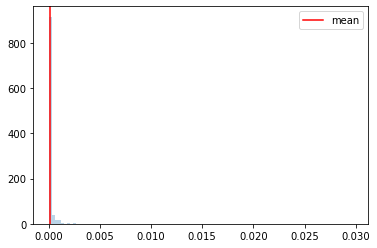

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654371740
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 10.0, 'jump_size_a': 10.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:16, 13.02it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<02:04,  7.96it/s]

Monte Carlo 5


  1%|▌                                                                                | 7/1000 [00:00<02:03,  8.04it/s]

Monte Carlo 6
Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:01<02:08,  7.74it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 11/1000 [00:01<02:07,  7.78it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<02:07,  7.74it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<02:30,  6.54it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:02<02:16,  7.20it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<02:08,  7.61it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<02:09,  7.55it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:57,  8.29it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:03<01:54,  8.53it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<02:16,  7.11it/s]

Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:12,  7.33it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:10,  7.42it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:04<02:05,  7.73it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<01:59,  8.10it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<01:48,  8.89it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:49,  8.77it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:05<01:51,  8.62it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<01:46,  9.00it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<01:50,  8.66it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<01:47,  8.88it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:43,  9.24it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:06<01:44,  9.06it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 53/1000 [00:06<01:46,  8.85it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<01:44,  9.03it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<01:52,  8.36it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<01:53,  8.32it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<01:52,  8.36it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<01:55,  8.14it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:07<01:56,  8.04it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:08<01:56,  8.01it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:08<02:02,  7.60it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:08<02:02,  7.56it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:08<01:59,  7.74it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:09<01:56,  7.93it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<01:57,  7.86it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:09<01:59,  7.71it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:09<02:08,  7.17it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:10<02:01,  7.55it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:10<01:58,  7.76it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:10<02:03,  7.39it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:11<02:03,  7.37it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:11<01:59,  7.59it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:11<01:58,  7.66it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:11<02:12,  6.83it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:12<02:09,  6.96it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:12<02:06,  7.12it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:12<02:07,  7.04it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:12<02:07,  7.04it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:13<02:04,  7.22it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:13<02:10,  6.85it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:13<02:15,  6.60it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:14<02:14,  6.60it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:14<02:13,  6.67it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:14<02:08,  6.89it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:15<02:09,  6.81it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:15<02:06,  6.95it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:15<02:03,  7.10it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:15<02:00,  7.27it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:16<02:05,  7.00it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:16<02:04,  7.01it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:16<02:02,  7.14it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:17<02:00,  7.21it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:17<02:02,  7.10it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:17<02:05,  6.92it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:17<02:17,  6.27it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:18<02:11,  6.56it/s]

Monte Carlo 137
Monte Carlo 138


 14%|██████████▉                                                                    | 139/1000 [00:18<02:12,  6.52it/s]

Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:34,  5.56it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:22,  6.02it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:16,  6.24it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:08,  6.62it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:04,  6.86it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:05,  6.78it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:09,  6.55it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:20<02:10,  6.48it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:14,  6.29it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<02:21,  5.95it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:21<02:14,  6.22it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:15,  6.17it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:12,  6.32it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:12,  6.29it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:21,  5.87it/s]

Monte Carlo 168
Monte Carlo 169

 17%|█████████████▍                                                                 | 170/1000 [00:23<02:18,  5.98it/s]


Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:23<02:11,  6.30it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:12,  6.23it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:21,  5.84it/s]

Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:24<02:15,  6.08it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:24<02:08,  6.38it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:09,  6.32it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:25<02:12,  6.15it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:25<02:17,  5.91it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:17,  5.93it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:26<02:14,  6.03it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:26<02:13,  6.08it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:27<02:18,  5.85it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:18,  5.81it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:27<02:19,  5.77it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:20,  5.71it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:20,  5.70it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:28<02:16,  5.86it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:19,  5.71it/s]

Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:17,  5.78it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:29<02:14,  5.89it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:29<02:10,  6.05it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:30<02:16,  5.76it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:30<02:20,  5.61it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:17,  5.71it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:20,  5.58it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:23,  5.45it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:31<02:14,  5.79it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:07,  6.11it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:32<02:02,  6.31it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:32<02:02,  6.30it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:05,  6.16it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:33<02:00,  6.37it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:33<02:00,  6.36it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:03,  6.20it/s]

Monte Carlo 233
Monte Carlo 234

 24%|██████████████████▌                                                            | 235/1000 [00:34<02:05,  6.07it/s]


Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:34<02:06,  6.01it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:34<02:12,  5.74it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:34<02:08,  5.91it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:35<02:11,  5.77it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:35<02:12,  5.72it/s]

Monte Carlo 242
Monte Carlo 243

 24%|███████████████████▎                                                           | 244/1000 [00:35<02:10,  5.78it/s]


Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:36<02:10,  5.78it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:36<02:18,  5.44it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:36<02:19,  5.38it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:36<02:18,  5.43it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:37<02:16,  5.48it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:37<02:16,  5.45it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:37<02:12,  5.62it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:38<02:08,  5.79it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:38<02:09,  5.72it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:38<02:11,  5.62it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:39<02:05,  5.86it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:39<02:29,  4.90it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:39<02:24,  5.09it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:40<02:16,  5.36it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:40<02:12,  5.50it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:40<02:19,  5.22it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:41<02:16,  5.34it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▌                                                         | 273/1000 [00:41<02:18,  5.25it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:41<02:22,  5.10it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:41<02:38,  4.57it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 277/1000 [00:42<02:41,  4.48it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:42<02:33,  4.70it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:42<02:30,  4.79it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:42<02:26,  4.92it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:43<02:28,  4.83it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:43<02:28,  4.83it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:43<02:23,  4.99it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:43<02:27,  4.84it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:44<02:27,  4.83it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:44<02:25,  4.90it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:44<02:27,  4.81it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:45<02:25,  4.86it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:45<02:21,  4.99it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:45<02:19,  5.06it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:45<02:18,  5.10it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:45<02:16,  5.16it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:46<02:16,  5.13it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:46<02:16,  5.13it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:46<02:21,  4.94it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:46<02:21,  4.95it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:47<02:20,  4.96it/s]

Monte Carlo 301
Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:47<02:23,  4.86it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:47<02:24,  4.81it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:48<02:27,  4.71it/s]

Monte Carlo 305
Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:48<02:31,  4.56it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:48<02:29,  4.63it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:48<02:25,  4.75it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:49<02:29,  4.61it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:49<02:27,  4.65it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:49<02:20,  4.89it/s]

Monte Carlo 313
Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:49<02:16,  5.01it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:50<02:17,  4.97it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:50<02:20,  4.86it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:50<02:16,  4.99it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:50<02:11,  5.16it/s]

Monte Carlo 319
Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:51<02:06,  5.35it/s]

Monte Carlo 321
Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:51<02:07,  5.31it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:51<02:06,  5.32it/s]

Monte Carlo 324
Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:52<02:05,  5.37it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:52<02:11,  5.09it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:52<02:09,  5.18it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:52<02:07,  5.27it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:53<02:07,  5.26it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:53<02:07,  5.23it/s]

Monte Carlo 331
Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:53<02:08,  5.20it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:53<02:10,  5.09it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:54<02:13,  4.99it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:54<02:16,  4.86it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:54<02:13,  4.94it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:54<02:13,  4.93it/s]

Monte Carlo 339


 34%|██████████████████████████▉                                                    | 341/1000 [00:55<02:13,  4.95it/s]

Monte Carlo 340


 34%|███████████████████████████                                                    | 342/1000 [00:55<02:12,  4.96it/s]

Monte Carlo 341
Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:55<02:15,  4.85it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:55<02:19,  4.70it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:55<02:23,  4.58it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:56<02:24,  4.52it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:56<02:22,  4.59it/s]

Monte Carlo 347


 35%|███████████████████████████▌                                                   | 349/1000 [00:56<02:22,  4.56it/s]

Monte Carlo 348
Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:57<02:26,  4.43it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:57<02:23,  4.52it/s]

Monte Carlo 351


 35%|███████████████████████████▉                                                   | 353/1000 [00:57<02:22,  4.55it/s]

Monte Carlo 352
Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:57<02:23,  4.51it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [00:58<02:27,  4.36it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [00:58<02:23,  4.48it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [00:58<02:23,  4.48it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 359/1000 [00:59<02:23,  4.46it/s]

Monte Carlo 358
Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [00:59<02:21,  4.53it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [00:59<02:21,  4.51it/s]

Monte Carlo 361


 36%|████████████████████████████▋                                                  | 363/1000 [00:59<02:20,  4.53it/s]

Monte Carlo 362
Monte Carlo 363


 36%|████████████████████████████▊                                                  | 365/1000 [01:00<02:18,  4.57it/s]

Monte Carlo 364
Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:00<02:21,  4.48it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:00<02:20,  4.50it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:01<02:20,  4.49it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 370/1000 [01:01<02:18,  4.54it/s]

Monte Carlo 369
Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:01<02:21,  4.45it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:01<02:21,  4.43it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:02<02:22,  4.39it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:02<02:21,  4.41it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:02<02:21,  4.42it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:02<02:20,  4.44it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:03<02:19,  4.47it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:03<02:23,  4.33it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:03<02:24,  4.28it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:03<02:26,  4.24it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:04<02:28,  4.17it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:04<02:27,  4.20it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:04<02:34,  4.00it/s]

Monte Carlo 383


 38%|██████████████████████████████▍                                                | 385/1000 [01:05<02:22,  4.33it/s]

Monte Carlo 384
Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:05<02:23,  4.28it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:05<02:24,  4.24it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:05<02:23,  4.26it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:05<02:23,  4.25it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:06<02:43,  3.73it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:06<02:34,  3.93it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:06<02:28,  4.09it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:06<02:24,  4.21it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:07<02:20,  4.30it/s]

Monte Carlo 394


 40%|███████████████████████████████▎                                               | 396/1000 [01:07<02:17,  4.39it/s]

Monte Carlo 395
Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:07<02:22,  4.22it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:08<02:24,  4.18it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:08<02:19,  4.30it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:08<02:17,  4.37it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:08<02:15,  4.42it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:09<02:17,  4.35it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:09<02:15,  4.42it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:09<02:21,  4.22it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:09<02:19,  4.26it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:09<02:17,  4.32it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:10<02:19,  4.25it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:10<02:18,  4.27it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:10<02:17,  4.30it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:10<02:16,  4.32it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:11<02:20,  4.20it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:11<02:17,  4.29it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:11<02:14,  4.35it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:11<02:16,  4.29it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:12<02:17,  4.25it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:12<02:15,  4.31it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:12<02:19,  4.17it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:12<02:19,  4.18it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:13<02:18,  4.20it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:13<02:18,  4.18it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:13<02:18,  4.17it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:13<02:18,  4.16it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:13<02:19,  4.15it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:14<02:18,  4.16it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:14<02:18,  4.16it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:14<02:17,  4.19it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:14<02:16,  4.21it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:15<02:17,  4.15it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:15<02:18,  4.11it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:15<02:15,  4.21it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:15<02:17,  4.13it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:16<02:19,  4.06it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:16<02:21,  4.02it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:16<02:17,  4.11it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:16<02:18,  4.09it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:17<02:20,  4.03it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:17<02:24,  3.90it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:17<02:21,  3.98it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:17<02:23,  3.90it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:18<02:21,  3.96it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:18<02:22,  3.93it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:18<02:23,  3.88it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:18<02:21,  3.95it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:19<02:22,  3.91it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:19<02:21,  3.93it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:19<02:16,  4.05it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:19<02:17,  4.01it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:20<02:14,  4.11it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:20<02:15,  4.07it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:20<02:12,  4.15it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:20<02:15,  4.04it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:21<02:19,  3.92it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:21<02:18,  3.94it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:21<02:19,  3.93it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:21<02:16,  3.98it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:22<02:14,  4.05it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:22<02:12,  4.11it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:22<02:12,  4.10it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:22<02:10,  4.16it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:23<02:08,  4.19it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:23<02:17,  3.92it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:23<02:15,  3.97it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:23<02:15,  3.95it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:24<02:13,  4.03it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:24<02:16,  3.93it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:24<02:13,  4.01it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:24<02:16,  3.90it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:25<02:14,  3.97it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:25<02:11,  4.05it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:25<02:11,  4.03it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:25<02:09,  4.07it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:26<02:09,  4.07it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:26<02:10,  4.03it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:26<02:15,  3.88it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:26<02:16,  3.84it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:27<02:20,  3.73it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:27<02:22,  3.68it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:27<02:22,  3.66it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:28<02:19,  3.74it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:28<02:16,  3.82it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:28<02:14,  3.85it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:28<02:16,  3.80it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:29<02:19,  3.71it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:29<02:20,  3.67it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:29<02:15,  3.79it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:29<02:16,  3.77it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:30<02:13,  3.85it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:30<02:15,  3.78it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:30<02:15,  3.77it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:30<02:17,  3.71it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:31<02:15,  3.74it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:31<02:16,  3.72it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:31<02:15,  3.73it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:32<02:19,  3.64it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:32<02:21,  3.58it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:32<02:17,  3.66it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:32<02:15,  3.70it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:33<02:16,  3.68it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:33<02:16,  3.68it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:33<02:13,  3.76it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:33<02:15,  3.69it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:34<02:13,  3.74it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:34<02:12,  3.76it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:34<02:09,  3.82it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:35<02:10,  3.81it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:35<02:12,  3.74it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:35<02:11,  3.75it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:35<02:13,  3.69it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:36<02:13,  3.67it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:36<02:19,  3.52it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:36<02:14,  3.63it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:36<02:20,  3.47it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:37<02:17,  3.54it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:37<02:16,  3.56it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:37<02:14,  3.62it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:38<02:13,  3.63it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:38<02:16,  3.54it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:38<02:12,  3.64it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:38<02:11,  3.66it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:39<02:11,  3.64it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:39<02:13,  3.60it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:39<02:09,  3.68it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:39<02:06,  3.76it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:40<02:07,  3.73it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:40<02:06,  3.76it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:40<02:09,  3.65it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:41<02:09,  3.64it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:41<02:09,  3.63it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:41<02:27,  3.20it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:42<02:21,  3.33it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:42<02:17,  3.42it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:42<02:15,  3.46it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:42<02:13,  3.51it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:43<02:10,  3.57it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:43<02:08,  3.62it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:43<02:12,  3.50it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:43<02:10,  3.55it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:44<02:06,  3.66it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:44<02:04,  3.70it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:44<02:04,  3.70it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:45<02:06,  3.63it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:45<02:04,  3.67it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:45<02:08,  3.54it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:45<02:10,  3.48it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:46<02:08,  3.54it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:46<02:05,  3.61it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:46<02:04,  3.63it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:47<02:06,  3.58it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:47<02:05,  3.58it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:47<02:12,  3.40it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:47<02:11,  3.42it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:48<02:15,  3.30it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:48<02:17,  3.26it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:48<02:12,  3.37it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:49<02:09,  3.44it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:49<02:11,  3.38it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:49<02:06,  3.50it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:49<02:04,  3.55it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:50<02:03,  3.56it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:50<02:06,  3.47it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:50<02:05,  3.49it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:51<02:03,  3.55it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:51<02:03,  3.54it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:51<02:06,  3.46it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:51<02:05,  3.47it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:52<02:02,  3.55it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:52<02:01,  3.56it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:52<02:02,  3.52it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:53<02:05,  3.43it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:53<02:03,  3.49it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:53<02:04,  3.44it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:53<02:01,  3.52it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:54<02:01,  3.51it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:54<02:01,  3.50it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:54<02:02,  3.46it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:55<02:02,  3.46it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:55<02:02,  3.46it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:55<02:07,  3.30it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:55<02:03,  3.41it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:56<02:03,  3.40it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:56<02:01,  3.46it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:56<02:01,  3.43it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:57<02:04,  3.36it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:57<02:03,  3.38it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:57<02:04,  3.34it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [01:58<02:02,  3.39it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [01:58<02:04,  3.32it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [01:58<02:01,  3.39it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [01:58<02:00,  3.42it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [01:59<02:02,  3.35it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [01:59<02:01,  3.38it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [01:59<02:03,  3.30it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:00<02:01,  3.35it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:00<01:58,  3.43it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:00<01:59,  3.40it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:01<01:58,  3.40it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:01<01:58,  3.39it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:01<02:02,  3.29it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:01<02:01,  3.31it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:02<02:02,  3.28it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:02<02:01,  3.27it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:02<02:02,  3.24it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:03<02:01,  3.26it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:03<02:00,  3.28it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:03<02:02,  3.23it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:04<02:03,  3.19it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:04<02:03,  3.17it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:04<02:05,  3.11it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:05<02:09,  3.03it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:05<02:04,  3.12it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:05<02:02,  3.17it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:06<02:04,  3.12it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:06<02:08,  3.01it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:06<02:06,  3.06it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:07<02:04,  3.10it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:07<02:05,  3.07it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:07<02:01,  3.16it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:07<01:59,  3.21it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:08<01:59,  3.19it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:08<01:58,  3.20it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:08<02:00,  3.15it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:09<02:01,  3.10it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:09<02:04,  3.03it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:09<02:04,  3.03it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:10<02:01,  3.09it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:10<01:58,  3.16it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:10<01:55,  3.22it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:11<01:56,  3.20it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:11<01:58,  3.13it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:11<01:57,  3.14it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:12<01:55,  3.20it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:12<01:58,  3.09it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:12<01:59,  3.07it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:13<01:58,  3.08it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:13<01:59,  3.05it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:13<01:56,  3.12it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:14<01:55,  3.14it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:14<01:56,  3.11it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:14<01:55,  3.13it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:15<01:58,  3.03it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:15<01:59,  3.00it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:15<01:59,  3.00it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:16<02:01,  2.94it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:16<01:57,  3.03it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:16<01:55,  3.07it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:17<01:51,  3.17it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:17<01:49,  3.21it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:17<01:47,  3.28it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:17<01:45,  3.34it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:18<01:58,  2.97it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:18<01:50,  3.17it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:18<01:48,  3.22it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:19<01:47,  3.24it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:19<01:45,  3.28it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:19<01:47,  3.20it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:20<01:43,  3.33it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:20<01:42,  3.36it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:20<01:40,  3.41it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:20<01:38,  3.45it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:21<01:40,  3.38it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:21<01:39,  3.42it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:21<01:40,  3.37it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:22<01:42,  3.29it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:22<01:43,  3.25it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:22<01:45,  3.17it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:23<01:44,  3.20it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:23<01:42,  3.24it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:23<01:44,  3.18it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:24<01:41,  3.26it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:24<01:41,  3.25it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:24<01:41,  3.23it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:24<01:39,  3.30it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:25<01:39,  3.28it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:25<01:39,  3.27it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:25<01:38,  3.30it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:26<01:39,  3.26it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:26<01:37,  3.30it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:26<01:41,  3.17it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:27<01:44,  3.08it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:27<01:45,  3.04it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:27<01:43,  3.09it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:28<01:45,  3.01it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:28<01:44,  3.03it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:28<01:43,  3.05it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:29<01:39,  3.17it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:29<01:42,  3.07it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:29<01:40,  3.11it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:30<01:42,  3.04it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:30<01:42,  3.03it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:30<01:42,  3.03it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:31<01:38,  3.13it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:31<01:39,  3.10it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:31<01:38,  3.11it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:32<01:36,  3.16it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:32<01:37,  3.12it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:32<01:36,  3.16it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:32<01:37,  3.11it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:33<01:37,  3.09it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:33<01:38,  3.06it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:33<01:38,  3.05it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:34<01:39,  3.01it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:34<01:42,  2.91it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:35<01:41,  2.91it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:35<01:42,  2.89it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:35<01:43,  2.86it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:36<01:40,  2.92it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:36<01:39,  2.94it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:36<01:41,  2.88it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:37<01:41,  2.87it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:37<01:39,  2.91it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:37<01:38,  2.93it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:38<01:42,  2.82it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:38<01:42,  2.80it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:38<01:40,  2.84it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:39<01:40,  2.82it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:39<01:38,  2.89it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:39<01:40,  2.83it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:40<01:38,  2.87it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:40<01:39,  2.83it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:40<01:37,  2.87it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:41<01:37,  2.87it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:41<01:37,  2.87it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:42<01:37,  2.85it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:42<01:38,  2.80it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:42<01:39,  2.77it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:43<01:37,  2.82it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:43<01:37,  2.81it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:43<01:36,  2.82it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:44<01:35,  2.84it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:44<01:36,  2.80it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:44<01:33,  2.87it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:45<01:32,  2.91it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:45<01:35,  2.80it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:45<01:33,  2.83it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:46<01:35,  2.78it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:46<01:33,  2.82it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:46<01:31,  2.86it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:47<01:32,  2.85it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:47<01:32,  2.81it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:48<01:30,  2.88it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:48<01:30,  2.86it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:48<01:30,  2.86it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:49<01:30,  2.84it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:49<01:29,  2.85it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:49<01:30,  2.82it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:50<01:29,  2.85it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:50<01:28,  2.86it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:50<01:27,  2.89it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:51<01:26,  2.89it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:51<01:34,  2.65it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:51<01:30,  2.76it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:52<01:28,  2.79it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:52<01:28,  2.78it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:53<01:27,  2.80it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:53<01:28,  2.77it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:53<01:31,  2.67it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:54<01:27,  2.78it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:54<01:27,  2.77it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:54<01:26,  2.79it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:55<01:24,  2.84it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:55<01:24,  2.82it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:55<01:24,  2.83it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:56<01:25,  2.78it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:56<01:24,  2.80it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:56<01:24,  2.80it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:57<01:23,  2.81it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [02:57<01:25,  2.73it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [02:58<01:22,  2.80it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [02:58<01:21,  2.83it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [02:58<01:22,  2.79it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [02:59<01:22,  2.78it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [02:59<01:24,  2.70it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [02:59<01:23,  2.70it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:00<01:24,  2.69it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:00<01:22,  2.71it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:01<01:22,  2.70it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:01<01:24,  2.64it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:01<01:24,  2.62it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:02<01:22,  2.67it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:02<01:22,  2.68it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:02<01:21,  2.69it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:03<01:20,  2.72it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:03<01:19,  2.73it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:03<01:17,  2.77it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:04<01:16,  2.80it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:04<01:16,  2.80it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:05<01:18,  2.72it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:05<01:16,  2.76it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:05<01:15,  2.78it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:06<01:14,  2.82it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:06<01:16,  2.74it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:06<01:14,  2.77it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:07<01:14,  2.78it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:07<01:14,  2.76it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:07<01:15,  2.71it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:08<01:16,  2.68it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:08<01:16,  2.66it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:09<01:14,  2.71it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:09<01:13,  2.75it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:09<01:12,  2.76it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:10<01:14,  2.68it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:10<01:12,  2.74it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:10<01:11,  2.75it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:11<01:11,  2.75it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:11<01:11,  2.74it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:12<01:12,  2.68it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:12<01:12,  2.66it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:12<01:12,  2.63it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:13<01:11,  2.68it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:13<01:12,  2.64it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:13<01:12,  2.62it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:14<01:10,  2.68it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:14<01:09,  2.68it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:15<01:08,  2.70it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:15<01:08,  2.70it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:15<01:09,  2.64it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:16<01:10,  2.59it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:16<01:08,  2.64it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:16<01:07,  2.67it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:17<01:06,  2.72it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:17<01:06,  2.68it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:17<01:04,  2.75it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:18<01:03,  2.77it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:18<01:02,  2.81it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:19<01:02,  2.80it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:19<01:02,  2.79it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:19<01:02,  2.79it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:20<01:05,  2.63it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:20<01:05,  2.60it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:20<01:05,  2.60it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:21<01:04,  2.63it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:21<01:02,  2.70it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:22<01:01,  2.73it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:22<01:00,  2.77it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:22<00:58,  2.80it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:23<01:01,  2.67it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:23<01:01,  2.63it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:23<01:01,  2.65it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:24<01:01,  2.64it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:24<01:00,  2.63it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:25<01:00,  2.63it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:25<00:59,  2.64it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:25<00:59,  2.66it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:26<00:58,  2.69it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:26<00:57,  2.70it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:26<00:58,  2.65it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:27<00:58,  2.63it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:27<00:57,  2.63it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:28<00:57,  2.61it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:28<00:56,  2.63it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:28<00:57,  2.61it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:29<00:56,  2.62it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:29<00:56,  2.61it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:30<00:56,  2.60it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:30<00:57,  2.52it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:31<01:05,  2.20it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:31<01:06,  2.17it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:31<01:03,  2.23it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:32<01:01,  2.29it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:32<01:00,  2.32it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:33<00:59,  2.35it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:33<00:58,  2.36it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:34<00:58,  2.35it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:34<00:59,  2.29it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:34<00:58,  2.33it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:35<00:59,  2.27it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:35<00:58,  2.27it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:36<00:57,  2.29it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:36<00:57,  2.26it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:37<00:57,  2.26it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:37<00:56,  2.27it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:38<00:56,  2.27it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:38<00:54,  2.33it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:38<00:54,  2.32it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:39<00:53,  2.34it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:39<00:53,  2.31it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:40<00:52,  2.34it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:40<00:51,  2.35it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:40<00:51,  2.36it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:41<00:49,  2.41it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:41<00:50,  2.37it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:42<00:50,  2.35it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:42<00:50,  2.32it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:43<00:49,  2.32it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:43<00:50,  2.30it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:43<00:49,  2.29it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:44<00:48,  2.31it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:44<00:48,  2.30it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:45<00:48,  2.27it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:45<00:47,  2.30it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:46<00:48,  2.25it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:46<00:48,  2.24it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:47<00:47,  2.26it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:47<00:47,  2.25it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:47<00:45,  2.29it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:48<00:45,  2.27it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:48<00:47,  2.15it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:49<00:46,  2.18it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:49<00:45,  2.22it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:50<00:45,  2.21it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:50<00:45,  2.19it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:51<00:45,  2.16it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:51<00:44,  2.19it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:52<00:43,  2.19it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:52<00:44,  2.14it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:53<00:43,  2.18it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:53<00:41,  2.22it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:53<00:40,  2.27it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:54<00:39,  2.29it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:54<00:38,  2.32it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:55<00:38,  2.30it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:55<00:38,  2.29it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:56<00:37,  2.29it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:56<00:37,  2.29it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:56<00:37,  2.27it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:57<00:37,  2.26it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:57<00:37,  2.22it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:58<00:37,  2.18it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:58<00:36,  2.24it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:59<00:34,  2.32it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:59<00:34,  2.32it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:59<00:32,  2.38it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:00<00:32,  2.39it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:00<00:31,  2.39it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:01<00:31,  2.39it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:01<00:31,  2.39it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:02<00:31,  2.33it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:02<00:30,  2.34it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:02<00:30,  2.34it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:03<00:29,  2.36it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:03<00:28,  2.40it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:04<00:28,  2.42it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:04<00:27,  2.41it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:05<00:27,  2.37it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:05<00:27,  2.35it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:05<00:26,  2.39it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:06<00:26,  2.39it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:06<00:25,  2.39it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:07<00:25,  2.41it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:07<00:24,  2.42it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:07<00:24,  2.41it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:08<00:23,  2.44it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:08<00:23,  2.39it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:09<00:23,  2.38it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:09<00:23,  2.38it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:10<00:22,  2.37it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:10<00:24,  2.20it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:10<00:23,  2.23it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:11<00:22,  2.24it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:11<00:22,  2.27it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:12<00:21,  2.30it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:12<00:20,  2.30it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:13<00:20,  2.31it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:13<00:20,  2.29it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:13<00:19,  2.33it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:14<00:18,  2.37it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:14<00:18,  2.34it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:15<00:17,  2.37it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:15<00:17,  2.33it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:16<00:17,  2.32it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:16<00:16,  2.34it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:16<00:16,  2.34it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:17<00:15,  2.35it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:17<00:15,  2.27it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:18<00:15,  2.26it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:18<00:15,  2.24it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:19<00:14,  2.29it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:19<00:13,  2.32it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:20<00:13,  2.28it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:20<00:12,  2.35it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:20<00:12,  2.36it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:21<00:11,  2.40it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:21<00:11,  2.38it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:22<00:10,  2.42it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:22<00:10,  2.42it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:22<00:09,  2.42it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:23<00:09,  2.39it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:23<00:09,  2.44it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:24<00:08,  2.45it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:24<00:08,  2.47it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:24<00:07,  2.47it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:25<00:07,  2.47it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:25<00:06,  2.46it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:26<00:06,  2.42it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:26<00:06,  2.41it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:27<00:05,  2.37it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:27<00:05,  2.36it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:27<00:05,  2.39it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:28<00:04,  2.36it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:28<00:04,  2.32it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:29<00:03,  2.35it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:29<00:03,  2.35it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:30<00:02,  2.36it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:30<00:02,  2.35it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:30<00:02,  2.34it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:31<00:01,  2.34it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:31<00:01,  2.33it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:32<00:00,  2.33it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:32<00:00,  2.32it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:33<00:00,  3.66it/s]


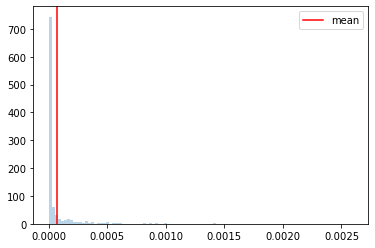

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654372014
{'jump_arrival_alpha': 0.1, 'jump_arrival_beta': 10.0, 'jump_size_a': 10.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:09, 14.32it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:44,  9.54it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:55,  8.60it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<02:01,  8.14it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:56,  8.51it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:48,  9.09it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:52,  8.73it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<01:56,  8.44it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 19/1000 [00:02<01:56,  8.43it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:50,  8.84it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:56,  8.40it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<02:01,  8.03it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:56,  8.31it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:15,  7.18it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:04,  7.76it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:00,  8.00it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:00,  7.97it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:55,  8.33it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:55,  8.32it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<01:56,  8.19it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<01:58,  8.09it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<01:58,  8.08it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<02:06,  7.50it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:06<02:04,  7.63it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<01:59,  7.93it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<01:57,  8.03it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<02:02,  7.71it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▌                                                                           | 57/1000 [00:06<02:08,  7.32it/s]

Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:24,  6.49it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:12,  7.09it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<01:57,  8.00it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<01:54,  8.20it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<01:57,  7.96it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<01:50,  8.42it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<01:51,  8.34it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<01:51,  8.33it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<01:58,  7.82it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<01:50,  8.35it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<01:47,  8.56it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:09<01:48,  8.45it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<01:48,  8.42it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<01:46,  8.57it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<01:52,  8.12it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:10<01:54,  7.95it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<01:58,  7.70it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:01,  7.47it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<02:03,  7.36it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<01:57,  7.71it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<01:57,  7.69it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<01:59,  7.53it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:12<02:06,  7.08it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:02,  7.34it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:00,  7.40it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:04,  7.15it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:13<02:08,  6.93it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:08,  6.90it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:06,  7.00it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:14<02:06,  6.99it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:07,  6.92it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:10,  6.75it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<02:05,  6.96it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:08,  6.82it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:04,  7.02it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:00,  7.20it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:16<02:02,  7.10it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:03,  7.04it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<02:01,  7.12it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:17<02:00,  7.19it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:17<02:00,  7.15it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<01:56,  7.40it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:18<02:05,  6.85it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:18<02:00,  7.10it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<01:59,  7.16it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:19<02:05,  6.79it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:19<02:02,  6.91it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:19<02:02,  6.90it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:20<01:57,  7.17it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:20<02:07,  6.61it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:20<02:06,  6.64it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:21<02:04,  6.75it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:21<02:06,  6.64it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:21<02:00,  6.92it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:01,  6.84it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:22<01:56,  7.14it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:22<02:04,  6.67it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:22<02:10,  6.36it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:23<02:11,  6.29it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:23<02:08,  6.41it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:23<02:11,  6.23it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▏                                                                | 180/1000 [00:24<02:06,  6.47it/s]

Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:24<02:23,  5.70it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:24<02:12,  6.15it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:25<02:06,  6.45it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:25<02:00,  6.73it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:25<02:03,  6.56it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:26<02:01,  6.64it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:26<02:00,  6.68it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:26<01:59,  6.74it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:26<02:01,  6.60it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:27<02:00,  6.63it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:27<02:01,  6.59it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:27<02:03,  6.45it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:28<01:58,  6.68it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:28<02:04,  6.38it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:28<01:59,  6.60it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:29<02:00,  6.52it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:29<02:02,  6.42it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:29<02:07,  6.13it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:30<02:12,  5.89it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:30<02:08,  6.10it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:30<02:16,  5.70it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:30<02:12,  5.88it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:31<02:17,  5.65it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:31<02:14,  5.77it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:31<02:15,  5.70it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:32<02:19,  5.52it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:32<02:18,  5.56it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:32<02:19,  5.49it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:33<02:13,  5.74it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:33<02:19,  5.47it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:33<02:22,  5.33it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:33<02:17,  5.52it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:34<02:19,  5.44it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:34<02:20,  5.38it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:34<02:18,  5.46it/s]

Monte Carlo 243
Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:35<02:16,  5.53it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:35<02:17,  5.48it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:35<02:16,  5.50it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:35<02:17,  5.45it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:36<02:21,  5.28it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:36<02:18,  5.40it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:36<02:20,  5.31it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:36<02:22,  5.22it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:36<02:17,  5.40it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:37<02:17,  5.40it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:37<02:23,  5.17it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:37<02:21,  5.22it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:38<02:19,  5.29it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:38<02:20,  5.25it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:38<02:16,  5.41it/s]

Monte Carlo 263
Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:38<02:12,  5.54it/s]

Monte Carlo 265
Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:39<02:11,  5.58it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:39<02:11,  5.58it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:39<02:09,  5.61it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:39<02:11,  5.55it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:40<02:16,  5.31it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:40<02:16,  5.32it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:40<02:15,  5.35it/s]

Monte Carlo 275
Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:41<02:14,  5.37it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:41<02:18,  5.20it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:41<02:15,  5.32it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:41<02:11,  5.43it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:42<02:14,  5.33it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:42<02:12,  5.38it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:42<02:16,  5.20it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:43<02:20,  5.07it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:43<02:22,  4.99it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:43<02:19,  5.08it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:43<02:19,  5.06it/s]

Monte Carlo 291
Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:43<02:28,  4.77it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:44<02:31,  4.66it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:44<02:30,  4.67it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:44<02:31,  4.64it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:45<02:30,  4.65it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:45<02:32,  4.60it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:45<02:33,  4.55it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:45<02:33,  4.57it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:45<02:36,  4.47it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:46<02:33,  4.54it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:46<02:26,  4.75it/s]

Monte Carlo 304
Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:46<02:21,  4.90it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:47<02:18,  4.98it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:47<02:23,  4.82it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:48<02:18,  4.96it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:48<02:17,  4.99it/s]

Monte Carlo 312
Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:48<02:21,  4.85it/s]

Monte Carlo 314
Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:49<02:21,  4.81it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:49<02:22,  4.77it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:49<02:22,  4.77it/s]

Monte Carlo 319
Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:49<02:26,  4.63it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:50<02:24,  4.68it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:50<02:24,  4.67it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:50<02:27,  4.57it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:50<02:27,  4.57it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:51<02:30,  4.47it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:51<02:26,  4.59it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:51<02:26,  4.58it/s]

Monte Carlo 328
Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:51<02:29,  4.49it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:52<02:30,  4.44it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:52<02:29,  4.47it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:52<02:32,  4.39it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:53<02:26,  4.54it/s]

Monte Carlo 334
Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:53<02:40,  4.15it/s]

Monte Carlo 336


 34%|██████████████████████████▋                                                    | 338/1000 [00:53<02:31,  4.37it/s]

Monte Carlo 337
Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:53<02:34,  4.27it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:54<02:31,  4.37it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:54<02:32,  4.33it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 343/1000 [00:54<02:40,  4.10it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:55<02:31,  4.33it/s]

Monte Carlo 343


 34%|███████████████████████████▎                                                   | 345/1000 [00:55<02:27,  4.45it/s]

Monte Carlo 344


 35%|███████████████████████████▎                                                   | 346/1000 [00:55<02:22,  4.58it/s]

Monte Carlo 345


 35%|███████████████████████████▍                                                   | 347/1000 [00:55<02:19,  4.67it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 348/1000 [00:55<02:15,  4.80it/s]

Monte Carlo 347
Monte Carlo 348


 35%|███████████████████████████▋                                                   | 350/1000 [00:56<02:16,  4.77it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 351/1000 [00:56<02:14,  4.81it/s]

Monte Carlo 350
Monte Carlo 351


 35%|███████████████████████████▉                                                   | 353/1000 [00:57<02:19,  4.63it/s]

Monte Carlo 352
Monte Carlo 353


 36%|████████████████████████████                                                   | 355/1000 [00:57<02:17,  4.69it/s]

Monte Carlo 354
Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [00:57<02:17,  4.68it/s]

Monte Carlo 356


 36%|████████████████████████████▎                                                  | 358/1000 [00:58<02:19,  4.61it/s]

Monte Carlo 357
Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [00:58<02:23,  4.48it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [00:58<02:22,  4.48it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [00:58<02:22,  4.49it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [00:59<02:28,  4.30it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [00:59<02:26,  4.35it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 365/1000 [00:59<02:19,  4.54it/s]

Monte Carlo 364
Monte Carlo 365


 37%|████████████████████████████▉                                                  | 367/1000 [01:00<02:16,  4.63it/s]

Monte Carlo 366
Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:00<02:22,  4.45it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:00<02:17,  4.59it/s]

Monte Carlo 369


 37%|█████████████████████████████▎                                                 | 371/1000 [01:01<02:15,  4.64it/s]

Monte Carlo 370
Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:01<02:16,  4.59it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:01<02:17,  4.57it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:01<02:19,  4.50it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:01<02:27,  4.25it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:02<02:20,  4.43it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 378/1000 [01:02<02:15,  4.60it/s]

Monte Carlo 377
Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:02<02:15,  4.59it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:03<02:15,  4.57it/s]

Monte Carlo 380


 38%|██████████████████████████████▏                                                | 382/1000 [01:03<02:12,  4.67it/s]

Monte Carlo 381
Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:03<02:12,  4.65it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:03<02:11,  4.67it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:04<02:12,  4.64it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:04<02:18,  4.43it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:04<02:19,  4.39it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:04<02:20,  4.36it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:05<02:16,  4.49it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:05<02:14,  4.55it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:05<02:14,  4.52it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:05<02:15,  4.49it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:05<02:20,  4.33it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:06<02:18,  4.39it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:06<02:18,  4.38it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:06<02:18,  4.35it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:06<02:16,  4.41it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:07<02:14,  4.47it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:07<02:15,  4.45it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:07<02:17,  4.37it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:07<02:20,  4.27it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:08<02:15,  4.41it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:08<02:15,  4.41it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:08<02:15,  4.41it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:08<02:24,  4.12it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:08<02:20,  4.24it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:09<02:18,  4.29it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:09<02:17,  4.30it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:09<02:15,  4.37it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:09<02:13,  4.41it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:10<02:18,  4.26it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:10<02:22,  4.12it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:10<02:18,  4.24it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:10<02:20,  4.18it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:11<02:22,  4.12it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:11<02:25,  4.01it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:11<02:25,  4.00it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:11<02:19,  4.17it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:12<02:15,  4.28it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:12<02:13,  4.34it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:12<02:16,  4.25it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:12<02:12,  4.35it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:12<02:12,  4.34it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:13<02:12,  4.33it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:13<02:17,  4.19it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:13<02:16,  4.21it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:13<02:20,  4.08it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:14<02:19,  4.10it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:14<02:18,  4.14it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:14<02:16,  4.16it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:14<02:16,  4.16it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:15<02:16,  4.16it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:15<02:16,  4.15it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:15<02:15,  4.17it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:15<02:15,  4.16it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:16<02:13,  4.22it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:16<02:11,  4.29it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:16<02:12,  4.25it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:16<02:15,  4.13it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:17<02:12,  4.22it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:17<02:11,  4.25it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:17<02:12,  4.20it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:17<02:13,  4.17it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:17<02:12,  4.19it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:18<02:12,  4.20it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:18<02:15,  4.10it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:18<02:17,  4.02it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:18<02:13,  4.13it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:19<02:11,  4.17it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:19<02:13,  4.12it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:19<02:13,  4.12it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:19<02:16,  4.02it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:20<02:15,  4.05it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:20<02:13,  4.09it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:20<02:19,  3.92it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:20<02:15,  4.00it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:21<02:13,  4.07it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:21<02:28,  3.65it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:21<02:21,  3.83it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:22<02:19,  3.88it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:22<02:17,  3.93it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:22<02:16,  3.93it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:22<02:17,  3.91it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:23<02:15,  3.95it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:23<02:13,  4.01it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:23<02:13,  4.00it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:23<02:11,  4.05it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:24<02:10,  4.08it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:24<02:09,  4.11it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:24<02:12,  4.01it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:24<02:11,  4.01it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:25<02:14,  3.93it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:25<02:12,  3.98it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:25<02:08,  4.08it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:25<02:08,  4.09it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:26<02:10,  4.02it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:26<02:10,  4.02it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:26<02:10,  4.01it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:26<02:10,  3.99it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:27<02:10,  3.97it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:27<02:10,  3.97it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:27<02:10,  3.97it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:27<02:09,  3.98it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:28<02:09,  3.98it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:28<02:07,  4.03it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:28<02:06,  4.06it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:28<02:03,  4.14it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:28<02:05,  4.06it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:29<02:03,  4.12it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:29<02:01,  4.18it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:29<02:02,  4.16it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:29<02:06,  4.02it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:30<02:12,  3.83it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:30<02:11,  3.84it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:30<02:11,  3.85it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:31<02:08,  3.93it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:31<02:05,  4.00it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:31<02:07,  3.93it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:31<02:05,  3.98it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:32<02:04,  4.01it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:32<02:07,  3.93it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:32<02:05,  3.98it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:32<02:09,  3.85it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:33<02:11,  3.76it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:33<02:15,  3.67it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:33<02:11,  3.75it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:33<02:14,  3.68it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:34<02:12,  3.71it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:34<02:13,  3.69it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:34<02:10,  3.76it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:34<02:09,  3.78it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:35<02:09,  3.78it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:35<02:10,  3.74it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:35<02:09,  3.75it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:36<02:10,  3.72it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:36<02:08,  3.75it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:36<02:08,  3.76it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:36<02:09,  3.71it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:37<02:09,  3.70it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:37<02:12,  3.62it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:37<02:12,  3.60it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:37<02:11,  3.64it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:38<02:08,  3.72it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:38<02:06,  3.75it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:38<02:07,  3.72it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:39<02:13,  3.56it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:39<02:09,  3.66it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:39<02:10,  3.62it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:39<02:09,  3.63it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:40<02:09,  3.64it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:40<02:07,  3.69it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:40<02:05,  3.74it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:40<02:05,  3.71it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:41<02:09,  3.60it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:41<02:10,  3.56it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:41<02:06,  3.66it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:42<02:05,  3.70it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:42<02:08,  3.58it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:42<02:10,  3.55it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:42<02:09,  3.56it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:43<02:11,  3.50it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:43<02:08,  3.55it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:43<02:08,  3.55it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:44<02:08,  3.54it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:44<02:06,  3.60it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:44<02:06,  3.58it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:44<02:04,  3.65it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:45<02:09,  3.50it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:45<02:08,  3.50it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:45<02:09,  3.48it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:46<02:07,  3.51it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:46<02:06,  3.55it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:46<02:02,  3.64it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:46<02:02,  3.63it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:47<01:59,  3.73it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:47<01:56,  3.80it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:47<01:53,  3.89it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:47<01:53,  3.90it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:48<01:52,  3.92it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:48<01:53,  3.87it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:48<01:53,  3.88it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:48<01:56,  3.76it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:49<02:01,  3.58it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:49<02:07,  3.41it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:49<02:04,  3.51it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:50<02:06,  3.43it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:50<02:05,  3.44it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:50<02:02,  3.53it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:50<02:00,  3.57it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:51<01:57,  3.66it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:51<01:58,  3.61it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:51<01:57,  3.63it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:52<02:01,  3.52it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:52<01:57,  3.61it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:52<01:56,  3.65it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:52<01:59,  3.54it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:53<02:00,  3.50it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:53<02:02,  3.46it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:53<02:00,  3.48it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:54<02:00,  3.48it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:54<02:01,  3.46it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:54<02:13,  3.13it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:54<02:09,  3.23it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:55<02:07,  3.27it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:55<02:03,  3.37it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [01:55<02:00,  3.43it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [01:56<02:06,  3.27it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [01:56<02:03,  3.32it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [01:56<02:01,  3.39it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [01:57<02:04,  3.30it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [01:57<02:05,  3.27it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [01:57<02:05,  3.26it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [01:57<02:03,  3.30it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [01:58<02:06,  3.21it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [01:58<02:03,  3.27it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [01:58<02:05,  3.23it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [01:59<02:02,  3.30it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [01:59<02:01,  3.32it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [01:59<01:59,  3.36it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:00<01:57,  3.40it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:00<01:55,  3.45it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:00<01:56,  3.41it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:00<01:54,  3.48it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:01<01:56,  3.41it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:01<01:55,  3.41it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:01<01:58,  3.33it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:02<01:57,  3.35it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:02<01:55,  3.40it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:02<01:56,  3.34it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:03<01:58,  3.29it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:03<01:57,  3.30it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:03<01:55,  3.37it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:03<01:59,  3.25it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:04<02:00,  3.20it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:04<01:59,  3.22it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:04<01:57,  3.26it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:05<01:57,  3.26it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:05<01:57,  3.25it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:05<01:58,  3.21it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:06<01:56,  3.26it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:06<01:55,  3.27it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:06<01:54,  3.29it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:07<01:55,  3.26it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:07<01:57,  3.20it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:07<01:57,  3.20it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:08<01:57,  3.19it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:08<01:57,  3.17it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:08<01:57,  3.17it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:08<01:58,  3.14it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:09<01:58,  3.13it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:09<01:56,  3.16it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:09<01:54,  3.23it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:10<01:52,  3.26it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:10<01:55,  3.17it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:10<01:56,  3.13it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:11<01:56,  3.12it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:11<01:58,  3.05it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:11<01:56,  3.11it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:12<01:54,  3.16it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:12<01:53,  3.18it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:12<01:51,  3.22it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:13<01:49,  3.28it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:13<01:49,  3.26it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:13<01:48,  3.29it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:13<01:48,  3.28it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:14<01:48,  3.26it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:14<01:49,  3.22it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:14<01:49,  3.21it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:15<01:50,  3.18it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:15<01:48,  3.21it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:15<01:49,  3.18it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:16<01:49,  3.17it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:16<01:49,  3.17it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:16<01:51,  3.10it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:17<01:49,  3.15it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:17<01:49,  3.13it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:17<01:50,  3.12it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:18<01:50,  3.10it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:18<01:51,  3.07it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:18<01:50,  3.09it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:19<01:48,  3.12it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:19<01:48,  3.10it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:19<01:49,  3.07it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:20<01:54,  2.94it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:20<01:51,  3.00it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:20<01:50,  3.03it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:21<01:51,  2.97it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:21<01:54,  2.89it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:21<01:50,  2.98it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:22<01:51,  2.95it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:22<01:52,  2.92it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:22<01:50,  2.96it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:23<01:49,  2.98it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:23<01:49,  2.98it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:23<01:51,  2.92it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:24<01:48,  3.00it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:24<01:46,  3.03it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:24<01:49,  2.93it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:25<01:49,  2.94it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:25<01:48,  2.96it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:25<01:48,  2.95it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:26<01:46,  2.98it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:26<01:43,  3.05it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:26<01:44,  3.02it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:27<01:45,  2.98it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:27<01:43,  3.03it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:27<01:45,  2.97it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:28<01:44,  3.00it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:28<01:54,  2.73it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:28<01:51,  2.79it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:29<01:47,  2.86it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:29<01:43,  2.97it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:29<01:42,  2.98it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:30<01:43,  2.97it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:30<01:43,  2.94it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:30<01:42,  2.97it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:31<01:40,  3.00it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:31<01:38,  3.05it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:31<01:40,  2.99it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:32<01:40,  2.99it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:32<01:42,  2.92it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:32<01:40,  2.96it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:33<01:41,  2.93it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:33<01:40,  2.95it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:33<01:38,  2.98it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:34<01:39,  2.95it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:34<01:38,  2.99it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:34<01:39,  2.95it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:35<01:40,  2.91it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:35<01:39,  2.93it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:36<01:41,  2.85it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:36<01:41,  2.83it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:36<01:41,  2.84it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:37<01:41,  2.81it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:37<01:39,  2.87it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:37<01:39,  2.85it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:38<01:34,  2.98it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:38<01:32,  3.05it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:38<01:30,  3.12it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:39<01:28,  3.18it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:39<01:27,  3.20it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:39<01:27,  3.17it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:39<01:28,  3.13it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:40<01:26,  3.19it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:40<01:27,  3.15it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:40<01:27,  3.14it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:41<01:27,  3.12it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:41<01:27,  3.09it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:41<01:27,  3.08it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:42<01:27,  3.07it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:42<01:28,  3.05it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:42<01:29,  2.99it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:43<01:30,  2.95it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:43<01:32,  2.88it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:43<01:29,  2.95it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:44<01:29,  2.94it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:44<01:28,  2.98it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:44<01:30,  2.91it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:45<01:30,  2.89it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:45<01:31,  2.85it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:46<01:29,  2.91it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:46<01:27,  2.94it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:46<01:28,  2.91it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:47<01:29,  2.85it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:47<01:30,  2.82it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:47<01:28,  2.88it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:48<01:28,  2.85it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:48<01:26,  2.90it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:48<01:28,  2.84it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:49<01:27,  2.84it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:49<01:27,  2.85it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:49<01:26,  2.88it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:50<01:25,  2.87it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:50<01:27,  2.81it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:50<01:27,  2.79it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:51<01:27,  2.78it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:51<01:26,  2.82it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:52<01:27,  2.77it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:52<01:24,  2.85it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:52<01:24,  2.85it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:53<01:23,  2.86it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:53<01:23,  2.84it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:53<01:24,  2.79it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:54<01:24,  2.78it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:54<01:23,  2.82it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:54<01:24,  2.77it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [02:55<01:24,  2.77it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [02:55<01:22,  2.80it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [02:55<01:21,  2.84it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [02:56<01:20,  2.85it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [02:56<01:21,  2.80it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [02:57<01:23,  2.73it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [02:57<01:21,  2.79it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [02:57<01:19,  2.83it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [02:58<01:20,  2.78it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [02:58<01:21,  2.75it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [02:58<01:21,  2.74it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [02:59<01:29,  2.49it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [02:59<01:24,  2.62it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:00<01:23,  2.65it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:00<01:20,  2.73it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:00<01:19,  2.74it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:01<01:20,  2.71it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:01<01:19,  2.70it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:01<01:20,  2.69it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:02<01:18,  2.73it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:02<01:15,  2.81it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:02<01:13,  2.90it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:03<01:11,  2.93it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:03<01:11,  2.92it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:03<01:11,  2.94it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:04<01:11,  2.89it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:04<01:10,  2.94it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:04<01:10,  2.92it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:05<01:12,  2.84it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:05<01:13,  2.76it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:06<01:13,  2.75it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:06<01:10,  2.86it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:06<01:10,  2.84it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:07<01:09,  2.86it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:07<01:08,  2.89it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:07<01:08,  2.90it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:08<01:09,  2.85it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:08<01:09,  2.80it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:08<01:09,  2.79it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:09<01:10,  2.75it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:09<01:08,  2.81it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:09<01:09,  2.77it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:10<01:10,  2.71it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:10<01:10,  2.71it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:11<01:09,  2.73it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:11<01:08,  2.76it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:11<01:05,  2.84it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:12<01:06,  2.81it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:12<01:05,  2.84it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:12<01:05,  2.83it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:13<01:03,  2.88it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:13<01:03,  2.88it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:13<01:03,  2.84it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:14<01:02,  2.89it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:14<01:02,  2.88it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:14<01:03,  2.82it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:15<01:02,  2.83it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:15<01:01,  2.85it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:15<01:01,  2.84it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:16<01:02,  2.80it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:16<01:00,  2.85it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:17<01:02,  2.76it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:17<01:02,  2.75it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:17<01:02,  2.73it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:18<01:03,  2.68it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:18<01:02,  2.70it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:18<01:01,  2.72it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:19<01:00,  2.74it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:19<01:00,  2.73it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:20<01:02,  2.61it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:20<01:02,  2.60it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:20<01:00,  2.66it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:21<00:59,  2.71it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:21<00:59,  2.69it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:21<00:58,  2.71it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:22<00:58,  2.69it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:22<00:58,  2.69it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:22<00:58,  2.67it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:23<00:58,  2.66it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:23<00:57,  2.67it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:24<00:56,  2.72it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:24<00:56,  2.70it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:24<00:56,  2.69it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:25<00:56,  2.65it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:25<00:56,  2.66it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:25<00:55,  2.68it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:26<00:54,  2.69it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:26<00:56,  2.60it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:27<01:02,  2.33it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:27<01:01,  2.33it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:28<01:00,  2.36it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:28<01:00,  2.35it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:28<00:58,  2.42it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:29<00:58,  2.41it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:29<00:58,  2.38it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:30<00:58,  2.35it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:30<00:58,  2.33it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:31<00:58,  2.34it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:31<00:57,  2.34it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:31<00:58,  2.29it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:32<00:56,  2.34it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:32<00:55,  2.40it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:33<00:54,  2.40it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:33<00:55,  2.33it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:34<00:55,  2.33it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:34<00:54,  2.36it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:34<00:54,  2.34it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:35<00:52,  2.39it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:35<00:54,  2.28it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:36<00:53,  2.33it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:36<00:55,  2.21it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:37<00:59,  2.05it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:37<00:57,  2.10it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:38<00:55,  2.17it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:38<00:55,  2.16it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:39<00:53,  2.20it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:39<00:51,  2.26it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:39<00:51,  2.27it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:40<00:49,  2.34it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:40<00:48,  2.36it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:41<00:50,  2.26it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:41<00:50,  2.20it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:42<00:48,  2.27it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:42<00:49,  2.21it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:43<00:49,  2.22it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:43<00:47,  2.25it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:43<00:47,  2.25it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:44<00:46,  2.26it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:44<00:45,  2.31it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:45<00:44,  2.34it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:45<00:43,  2.34it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:46<00:45,  2.25it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:46<00:48,  2.07it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:47<00:46,  2.15it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:47<00:45,  2.18it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:47<00:44,  2.19it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:48<00:44,  2.19it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:48<00:42,  2.27it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:49<00:41,  2.32it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:49<00:40,  2.30it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:50<00:39,  2.33it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:50<00:39,  2.34it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:50<00:38,  2.36it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:51<00:37,  2.43it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:51<00:36,  2.44it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:52<00:35,  2.46it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:52<00:35,  2.45it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:52<00:34,  2.49it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:53<00:34,  2.44it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:53<00:33,  2.49it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:54<00:32,  2.54it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:54<00:33,  2.46it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:54<00:32,  2.48it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:55<00:33,  2.41it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:55<00:32,  2.44it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:56<00:31,  2.52it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [03:56<00:30,  2.56it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [03:56<00:30,  2.50it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [03:57<00:30,  2.46it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [03:57<00:29,  2.48it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [03:58<00:28,  2.53it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [03:58<00:28,  2.57it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [03:58<00:27,  2.57it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [03:59<00:27,  2.59it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [03:59<00:26,  2.60it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:00<00:26,  2.58it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:00<00:26,  2.49it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:00<00:26,  2.45it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:01<00:26,  2.43it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:01<00:25,  2.47it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:02<00:25,  2.48it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:02<00:25,  2.45it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:02<00:25,  2.41it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:03<00:25,  2.37it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:03<00:24,  2.36it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:04<00:24,  2.38it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:04<00:24,  2.32it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:05<00:23,  2.35it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:05<00:23,  2.37it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:05<00:22,  2.37it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:06<00:22,  2.38it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:06<00:21,  2.40it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:07<00:21,  2.42it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:07<00:21,  2.38it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:08<00:20,  2.38it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:08<00:20,  2.39it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:08<00:19,  2.35it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:09<00:19,  2.37it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:09<00:18,  2.38it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:10<00:18,  2.40it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:10<00:18,  2.36it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:10<00:17,  2.38it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:11<00:17,  2.33it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:11<00:17,  2.22it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:12<00:17,  2.25it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:12<00:16,  2.28it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:13<00:16,  2.29it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:13<00:15,  2.29it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:14<00:15,  2.23it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:14<00:14,  2.28it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:14<00:14,  2.33it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:15<00:13,  2.33it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:15<00:13,  2.33it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:16<00:12,  2.36it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:16<00:12,  2.33it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:17<00:12,  2.29it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:17<00:11,  2.34it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:18<00:11,  2.19it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:18<00:10,  2.29it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:18<00:10,  2.32it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:19<00:10,  2.27it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:19<00:09,  2.30it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:20<00:09,  2.25it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:20<00:08,  2.30it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:21<00:08,  2.33it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:21<00:07,  2.34it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:21<00:07,  2.36it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:22<00:06,  2.33it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:22<00:06,  2.33it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:23<00:05,  2.34it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:23<00:05,  2.28it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:24<00:05,  2.26it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:24<00:04,  2.24it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:24<00:04,  2.26it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:25<00:04,  2.25it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:25<00:03,  2.22it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:26<00:03,  2.18it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:26<00:02,  2.22it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:27<00:02,  2.24it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:27<00:01,  2.29it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:28<00:01,  2.26it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:28<00:00,  2.29it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:28<00:00,  2.31it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:29<00:00,  3.71it/s]


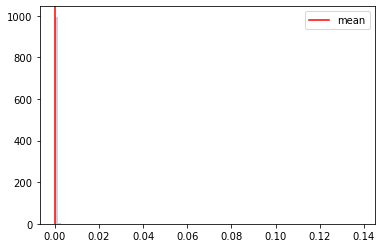

  0%|▏                                                                                | 2/1000 [00:00<00:52, 19.10it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654372284
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 0.1, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:55,  8.64it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:53,  8.78it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:58,  8.35it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:55,  8.55it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:52,  8.79it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:54,  8.61it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 17/1000 [00:01<01:47,  9.13it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<01:46,  9.23it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:48,  9.07it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:49,  8.89it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:53,  8.60it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:50,  8.83it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:11,  7.38it/s]

Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:06,  7.67it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:02,  7.91it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<01:59,  8.07it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<01:58,  8.11it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<01:55,  8.30it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<01:56,  8.21it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<02:01,  7.88it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<01:58,  8.04it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:03,  7.73it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:02,  7.76it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:59,  7.96it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:03,  7.69it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:06,  7.50it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:05,  7.54it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<02:02,  7.67it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:12,  7.10it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:11,  7.15it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:12,  7.09it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:07,  7.31it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:15,  6.90it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:06,  7.34it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:05,  7.42it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:06,  7.32it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:00,  7.66it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:07,  7.24it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:07,  7.21it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:05,  7.31it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:36,  5.87it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:20,  6.53it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:17,  6.63it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:18,  6.57it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:13,  6.79it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:09,  6.98it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:14,  6.72it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:06,  7.11it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:05,  7.20it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:17,  6.53it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:14,  6.65it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:08,  6.95it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:12,  6.74it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:13,  6.67it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:11,  6.78it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<02:08,  6.88it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:15,  6.55it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:14,  6.57it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:16<02:15,  6.50it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:14,  6.52it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:21,  6.20it/s]

Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:16<02:15,  6.46it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:17<02:10,  6.69it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:17<02:15,  6.43it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:17<02:12,  6.55it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:17<02:10,  6.67it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:18<02:13,  6.48it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:18<02:22,  6.06it/s]

Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:19,  6.18it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:19<02:12,  6.51it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:15,  6.34it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:12,  6.47it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:20<02:15,  6.29it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:09,  6.56it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:03,  6.91it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<01:58,  7.19it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<01:59,  7.06it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:03,  6.83it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:07,  6.60it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:06,  6.65it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:13,  6.30it/s]

Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:09,  6.46it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:22<02:04,  6.70it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:23<02:06,  6.58it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:14,  6.17it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:23<02:12,  6.25it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:24<02:08,  6.44it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:08,  6.40it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:13,  6.19it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:12,  6.20it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:19,  5.89it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:19,  5.86it/s]

Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:25<02:14,  6.09it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:19,  5.84it/s]

Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:16,  5.94it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:26<02:16,  5.97it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:13,  6.07it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:27<02:18,  5.85it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:19,  5.79it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:23,  5.60it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:21,  5.66it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:19,  5.75it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:19,  5.74it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:15,  5.89it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:29<02:14,  5.92it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:39,  4.96it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:35,  5.09it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:30<02:28,  5.32it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:27,  5.33it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:29,  5.26it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:29,  5.25it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:28,  5.29it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:32<02:31,  5.17it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:28,  5.27it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:24,  5.40it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:28,  5.24it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:33<02:31,  5.12it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:33<02:26,  5.29it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:33<02:30,  5.16it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:28,  5.20it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:34<02:23,  5.38it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:34<02:25,  5.28it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:21,  5.44it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:21,  5.44it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:25,  5.25it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:27,  5.20it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:29,  5.10it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:32,  5.00it/s]

Monte Carlo 236


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:38,  4.83it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:31,  5.01it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:30,  5.03it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:37<02:28,  5.10it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:26,  5.17it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:29,  5.05it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:24,  5.21it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 248/1000 [00:38<02:21,  5.31it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:16,  5.49it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:17,  5.44it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:15,  5.52it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:39<02:16,  5.45it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:16,  5.45it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:17,  5.40it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:14,  5.54it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:40<02:10,  5.69it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:09,  5.69it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:08,  5.75it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:17,  5.35it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:41<02:20,  5.23it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:18,  5.30it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:41<02:14,  5.42it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:13,  5.45it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:16,  5.34it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:42<02:19,  5.21it/s]

Monte Carlo 272
Monte Carlo 273


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:22,  5.10it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:26,  4.93it/s]

Monte Carlo 275
Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:26,  4.94it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:43<02:27,  4.90it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:44<02:22,  5.05it/s]

Monte Carlo 279
Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:25,  4.92it/s]

Monte Carlo 281
Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:44<02:30,  4.76it/s]

Monte Carlo 283
Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:30,  4.75it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:45<02:29,  4.78it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:26,  4.86it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:46<02:27,  4.82it/s]

Monte Carlo 289
Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:46<02:27,  4.81it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:46<02:32,  4.64it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:47<02:28,  4.76it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:47<02:25,  4.85it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:25,  4.83it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:47<02:26,  4.80it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:48<02:25,  4.82it/s]

Monte Carlo 298
Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:35,  4.51it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:34,  4.51it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:34,  4.50it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:49<02:31,  4.59it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:49<02:28,  4.67it/s]

Monte Carlo 304
Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:49<02:27,  4.70it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:28,  4.64it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:50<02:27,  4.69it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:50<02:27,  4.66it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:51<02:30,  4.55it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:27,  4.65it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:23,  4.76it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:51<02:20,  4.86it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:19,  4.89it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:18,  4.91it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:13,  5.10it/s]

Monte Carlo 319
Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:52<02:10,  5.18it/s]

Monte Carlo 321
Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:17,  4.93it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:20,  4.83it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:53<02:23,  4.71it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:18,  4.86it/s]

Monte Carlo 326
Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:17,  4.89it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:54<02:19,  4.81it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:54<02:16,  4.91it/s]

Monte Carlo 330
Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:25,  4.57it/s]

Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:55<02:24,  4.60it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:55<02:19,  4.78it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:55<02:16,  4.88it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:13,  4.96it/s]

Monte Carlo 336
Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:56<02:12,  4.99it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:56<02:10,  5.05it/s]

Monte Carlo 339
Monte Carlo 340


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:11,  5.01it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 343/1000 [00:57<02:10,  5.04it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:57<02:08,  5.09it/s]

Monte Carlo 343


 34%|███████████████████████████▎                                                   | 345/1000 [00:57<02:09,  5.06it/s]

Monte Carlo 344
Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:35,  4.21it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 348/1000 [00:58<02:23,  4.53it/s]

Monte Carlo 347
Monte Carlo 348


 35%|███████████████████████████▋                                                   | 350/1000 [00:58<02:20,  4.64it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:17,  4.72it/s]

Monte Carlo 350
Monte Carlo 351


 35%|███████████████████████████▉                                                   | 353/1000 [00:59<02:15,  4.76it/s]

Monte Carlo 352
Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:59<02:17,  4.69it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [00:59<02:21,  4.57it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:26,  4.40it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:00<02:28,  4.33it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:00<02:25,  4.41it/s]

Monte Carlo 358


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:20,  4.56it/s]

Monte Carlo 359
Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:20,  4.54it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:01<02:25,  4.39it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:01<02:27,  4.32it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:01<02:24,  4.40it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:24,  4.40it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:02<02:24,  4.38it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:02<02:26,  4.31it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:02<02:28,  4.25it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:31,  4.15it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:03<02:29,  4.22it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:03<02:30,  4.18it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:03<02:31,  4.14it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:35,  4.03it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:04<02:31,  4.14it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:04<02:32,  4.09it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:04<02:31,  4.11it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:32,  4.10it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:28,  4.18it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:05<02:31,  4.10it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:05<02:30,  4.13it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:26,  4.23it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:26,  4.23it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:06<02:29,  4.14it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:06<02:32,  4.03it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:28,  4.13it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:29,  4.11it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:07<02:24,  4.24it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:07<02:27,  4.16it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:24,  4.23it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:32,  4.00it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:08<02:32,  3.98it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:08<02:34,  3.93it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:30,  4.03it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:28,  4.09it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:09<02:30,  4.02it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:09<02:35,  3.89it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:30,  4.00it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:28,  4.04it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:33,  3.91it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:10<02:30,  3.98it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:28,  4.03it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:26,  4.08it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:25,  4.11it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:11<02:24,  4.12it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:25,  4.09it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:28,  4.01it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:29,  3.97it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:12<02:31,  3.91it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:13<02:29,  3.96it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:27,  3.99it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:27,  3.98it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:13<02:25,  4.03it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:26,  4.01it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:28,  3.93it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:27,  3.98it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:14<02:24,  4.04it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:15<02:26,  3.97it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:28,  3.92it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:25,  3.98it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:15<02:24,  4.01it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:16<02:28,  3.90it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:31,  3.81it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:27,  3.92it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:16<02:24,  3.99it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:17<02:31,  3.79it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:34,  3.73it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:32,  3.76it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:17<02:30,  3.80it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:30,  3.80it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:31,  3.77it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:30,  3.78it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:18<02:31,  3.74it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:31,  3.75it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:30,  3.75it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:31,  3.74it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:32,  3.69it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:33,  3.66it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:28,  3.78it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:20<02:27,  3.80it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:29,  3.75it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:21<02:26,  3.81it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:21<02:43,  3.41it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:22<02:39,  3.48it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:22<02:32,  3.64it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:22<02:28,  3.74it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:22<02:32,  3.63it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:23<02:27,  3.75it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:23<02:25,  3.79it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:23<02:25,  3.80it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:23<02:25,  3.78it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:25,  3.77it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:24<02:29,  3.66it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:24<02:30,  3.64it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:24<02:28,  3.68it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:24,  3.76it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:25<02:24,  3.77it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:25<02:24,  3.75it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:25<02:26,  3.69it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:28,  3.65it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:26<02:27,  3.67it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:26<02:23,  3.74it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:23,  3.76it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:27<02:21,  3.80it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:27<02:20,  3.82it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:27<02:19,  3.84it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:28<02:29,  3.58it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:28<02:30,  3.54it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:28<02:28,  3.58it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:28<02:24,  3.67it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:29<02:26,  3.61it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:29<02:27,  3.58it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:29<02:26,  3.61it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:30<02:25,  3.61it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:27,  3.56it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:30<02:26,  3.58it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:30<02:24,  3.62it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:31<02:23,  3.64it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:31<02:24,  3.61it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:31<02:25,  3.59it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:32<02:30,  3.45it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:32<02:28,  3.48it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:32<02:30,  3.43it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:32<02:26,  3.53it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:33<02:23,  3.60it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:33<02:24,  3.57it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:33<02:24,  3.55it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:34<02:23,  3.58it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:34<02:33,  3.33it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:34<02:31,  3.36it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:34<02:28,  3.42it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:35<02:27,  3.44it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:35<02:30,  3.38it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:35<02:27,  3.43it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:36<02:24,  3.51it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:36<02:22,  3.55it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:36<02:19,  3.63it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:36<02:18,  3.64it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:37<02:20,  3.58it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:37<02:22,  3.50it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:37<02:22,  3.51it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:38<02:23,  3.47it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:38<02:21,  3.51it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:38<02:25,  3.40it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:38<02:22,  3.47it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:39<02:22,  3.47it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:39<02:19,  3.53it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:39<02:18,  3.56it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:40<02:19,  3.52it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:40<02:18,  3.54it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:40<02:20,  3.48it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:40<02:17,  3.55it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:41<02:17,  3.55it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:41<02:17,  3.55it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:41<02:19,  3.48it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:42<02:22,  3.41it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:42<02:25,  3.32it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:42<02:23,  3.36it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:43<02:27,  3.27it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:43<02:24,  3.34it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:43<02:19,  3.43it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:43<02:20,  3.41it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:44<02:19,  3.44it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:44<02:24,  3.31it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:44<02:22,  3.35it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:45<02:21,  3.36it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:45<02:23,  3.30it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:45<02:23,  3.30it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:45<02:20,  3.35it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:46<02:22,  3.32it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:46<02:17,  3.42it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:46<02:14,  3.49it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:47<02:15,  3.45it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:47<02:19,  3.34it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:47<02:21,  3.30it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:48<02:16,  3.41it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:48<02:17,  3.38it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:48<02:19,  3.31it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:48<02:18,  3.33it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:49<02:21,  3.26it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:49<02:22,  3.23it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:49<02:24,  3.17it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:50<02:20,  3.26it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:50<02:24,  3.16it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:50<02:22,  3.21it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:51<02:22,  3.20it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:51<02:20,  3.23it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:51<02:19,  3.24it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:52<02:18,  3.27it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:52<02:15,  3.33it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:52<02:14,  3.36it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:52<02:12,  3.39it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:53<02:15,  3.31it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:53<02:20,  3.18it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:53<02:22,  3.14it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:54<02:19,  3.19it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:54<02:16,  3.25it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:54<02:15,  3.28it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:55<02:11,  3.35it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:55<02:11,  3.36it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:55<02:12,  3.33it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:56<02:13,  3.29it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:56<02:13,  3.27it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:56<02:13,  3.27it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:56<02:15,  3.22it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:57<02:15,  3.21it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:57<02:14,  3.23it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:57<02:14,  3.21it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:58<02:12,  3.25it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:58<02:15,  3.19it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:58<02:31,  2.84it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:59<02:27,  2.91it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:59<02:21,  3.03it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:59<02:22,  3.00it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:00<02:17,  3.09it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:00<02:16,  3.11it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:00<02:15,  3.14it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:01<02:12,  3.18it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:01<02:11,  3.21it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:01<02:13,  3.17it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:02<02:12,  3.17it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:02<02:16,  3.07it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:02<02:14,  3.10it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:03<02:11,  3.16it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:03<02:13,  3.11it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:03<02:16,  3.03it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:04<02:16,  3.04it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:04<02:19,  2.97it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:04<02:19,  2.95it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:05<02:17,  2.99it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:05<02:16,  3.01it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:05<02:16,  3.00it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:06<02:17,  2.98it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:06<02:16,  2.98it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:06<02:12,  3.06it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:07<02:10,  3.10it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:07<02:11,  3.06it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:07<02:12,  3.03it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:08<02:10,  3.08it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:08<02:11,  3.05it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:08<02:14,  2.97it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:09<02:11,  3.03it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:09<02:14,  2.97it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:09<02:12,  2.99it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:10<02:11,  3.00it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:10<02:08,  3.06it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:10<02:12,  2.98it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:11<02:09,  3.05it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:11<02:07,  3.07it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:11<02:03,  3.16it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:11<02:01,  3.20it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:12<02:00,  3.22it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:12<01:58,  3.28it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:12<01:57,  3.31it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:13<01:58,  3.24it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:13<02:00,  3.19it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:13<01:58,  3.24it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:14<01:56,  3.28it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:14<01:56,  3.28it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:14<01:55,  3.31it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:15<01:55,  3.28it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:15<01:55,  3.28it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:15<01:56,  3.24it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:15<01:56,  3.23it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:16<01:58,  3.18it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:16<01:58,  3.16it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:16<02:02,  3.07it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:17<02:03,  3.03it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:17<02:03,  3.02it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:17<02:03,  3.02it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:18<02:02,  3.02it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:18<02:02,  3.02it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:18<02:01,  3.03it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:19<02:02,  2.99it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:19<02:00,  3.04it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:19<02:00,  3.02it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:20<01:59,  3.06it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:20<01:59,  3.04it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:20<01:57,  3.08it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:21<02:01,  2.98it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:21<02:01,  2.97it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:21<01:59,  3.01it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:22<01:59,  3.01it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:22<01:58,  3.01it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:22<02:01,  2.93it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:23<02:00,  2.94it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:23<02:02,  2.90it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:24<02:04,  2.83it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:24<02:02,  2.87it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:24<02:00,  2.91it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:25<02:02,  2.85it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:25<02:00,  2.89it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:25<01:59,  2.91it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:26<02:00,  2.89it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:26<01:58,  2.91it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:26<01:59,  2.88it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:27<01:58,  2.90it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:27<01:56,  2.94it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:27<01:56,  2.93it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:28<01:55,  2.96it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:28<01:57,  2.90it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:28<01:55,  2.95it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:29<01:55,  2.93it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:29<01:54,  2.94it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:29<01:54,  2.93it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:30<01:57,  2.86it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:30<01:55,  2.89it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:30<01:56,  2.87it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:31<01:56,  2.85it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:31<01:58,  2.79it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:31<01:56,  2.84it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:32<01:56,  2.83it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:32<01:53,  2.89it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:32<01:51,  2.93it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:33<01:51,  2.93it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:33<01:53,  2.87it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:34<01:52,  2.87it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:34<02:04,  2.60it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:34<01:58,  2.71it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:35<01:56,  2.76it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:35<01:54,  2.80it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:35<01:52,  2.84it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:36<01:47,  2.96it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:36<01:45,  3.00it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:36<01:43,  3.05it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:37<01:45,  3.00it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:37<01:44,  3.01it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:37<01:43,  3.02it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:38<01:43,  3.02it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:38<01:42,  3.03it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:38<01:41,  3.05it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:39<01:41,  3.05it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:39<01:42,  2.99it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:39<01:43,  2.97it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:40<01:43,  2.94it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:40<01:43,  2.95it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:40<01:41,  2.98it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:41<01:42,  2.97it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:41<01:42,  2.93it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:41<01:44,  2.89it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:42<01:46,  2.82it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:42<01:45,  2.84it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:42<01:44,  2.85it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:43<01:47,  2.75it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:43<01:47,  2.75it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:44<01:48,  2.73it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:44<01:45,  2.80it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:44<01:42,  2.85it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:45<01:41,  2.88it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:45<01:38,  2.96it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:45<01:38,  2.94it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:46<01:38,  2.95it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:46<01:39,  2.89it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:46<01:39,  2.89it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:47<01:38,  2.91it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:47<01:38,  2.90it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:47<01:36,  2.96it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:48<01:36,  2.94it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:48<01:36,  2.92it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:48<01:35,  2.94it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:49<01:35,  2.93it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:49<01:36,  2.89it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:49<01:38,  2.82it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:50<01:36,  2.88it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:50<01:36,  2.85it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:50<01:36,  2.85it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:51<01:35,  2.87it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:51<01:37,  2.79it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:52<01:39,  2.74it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:52<01:39,  2.73it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:52<01:38,  2.75it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:53<01:37,  2.76it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:53<01:38,  2.73it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:53<01:37,  2.73it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:54<01:35,  2.77it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:54<01:37,  2.72it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:54<01:38,  2.69it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:55<01:36,  2.72it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:55<01:38,  2.66it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:56<01:40,  2.60it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:56<01:37,  2.66it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:56<01:35,  2.70it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:57<01:37,  2.66it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:57<01:37,  2.64it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:58<01:37,  2.63it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:58<01:36,  2.64it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:58<01:35,  2.65it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:59<01:34,  2.68it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:59<01:34,  2.67it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:59<01:36,  2.59it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:00<01:36,  2.60it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:00<01:35,  2.61it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:01<01:33,  2.64it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:01<01:33,  2.65it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:01<01:34,  2.61it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:02<01:32,  2.64it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:02<01:31,  2.68it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:02<01:32,  2.64it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:03<01:31,  2.66it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:03<01:36,  2.49it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:04<01:33,  2.56it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:04<01:34,  2.54it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:04<01:35,  2.50it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:05<01:32,  2.55it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:05<01:32,  2.55it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:06<01:32,  2.53it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:06<01:30,  2.58it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:06<01:30,  2.59it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:07<01:28,  2.62it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:07<01:27,  2.64it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:07<01:26,  2.67it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:08<01:25,  2.68it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:08<01:25,  2.66it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:09<01:25,  2.66it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:09<01:26,  2.60it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:09<01:27,  2.56it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:10<01:26,  2.59it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:10<01:27,  2.56it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:11<01:25,  2.59it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:11<01:25,  2.59it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:11<01:24,  2.61it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:12<01:22,  2.65it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:12<01:22,  2.63it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:12<01:22,  2.63it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:13<01:21,  2.64it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:13<01:23,  2.58it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:14<01:23,  2.56it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:14<01:23,  2.56it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:14<01:22,  2.58it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:15<01:20,  2.63it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:15<01:20,  2.61it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:16<01:21,  2.57it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:16<01:20,  2.58it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:16<01:19,  2.59it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:17<01:21,  2.53it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:17<01:21,  2.50it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:18<01:19,  2.56it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:18<01:18,  2.59it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:18<01:17,  2.59it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:19<01:17,  2.60it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:19<01:16,  2.60it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:19<01:15,  2.64it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:20<01:15,  2.62it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:20<01:15,  2.61it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:21<01:14,  2.65it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:21<01:15,  2.59it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:21<01:16,  2.55it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:22<01:14,  2.59it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:22<01:13,  2.62it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:23<01:13,  2.59it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:23<01:13,  2.60it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:23<01:12,  2.59it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:24<01:13,  2.57it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:24<01:14,  2.53it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:24<01:13,  2.52it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:25<01:12,  2.54it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:25<01:12,  2.55it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:26<01:12,  2.53it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:26<01:11,  2.55it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:26<01:10,  2.57it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:27<01:09,  2.58it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:27<01:10,  2.54it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:28<01:10,  2.54it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:28<01:09,  2.55it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:28<01:10,  2.50it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:29<01:09,  2.50it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:29<01:08,  2.53it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:30<01:10,  2.47it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:30<01:09,  2.48it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:30<01:08,  2.48it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:31<01:09,  2.45it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:31<01:09,  2.42it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:32<01:08,  2.44it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:32<01:08,  2.44it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:33<01:09,  2.40it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:33<01:08,  2.41it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:33<01:07,  2.42it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:34<01:06,  2.45it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:34<01:05,  2.48it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:35<01:06,  2.44it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:35<01:05,  2.45it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:35<01:05,  2.43it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:36<01:04,  2.47it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:36<01:04,  2.45it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:37<01:03,  2.44it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:37<01:03,  2.46it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:37<01:02,  2.47it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:38<01:01,  2.47it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:38<01:01,  2.47it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:39<01:00,  2.51it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:39<01:01,  2.44it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:39<01:00,  2.44it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:40<00:59,  2.47it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:40<00:59,  2.47it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:41<00:58,  2.48it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:41<00:58,  2.48it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:42<01:01,  2.36it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:42<00:59,  2.40it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:42<00:59,  2.40it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:43<01:03,  2.23it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:43<01:00,  2.31it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:44<00:58,  2.37it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:44<00:58,  2.37it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:44<00:58,  2.36it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:45<00:56,  2.40it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:45<00:56,  2.39it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:46<00:56,  2.37it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:46<00:55,  2.40it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:47<00:55,  2.38it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:47<00:56,  2.33it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:47<00:54,  2.37it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:48<00:55,  2.33it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:48<00:55,  2.32it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:49<00:54,  2.34it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:49<00:53,  2.34it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:50<00:53,  2.33it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:50<00:54,  2.28it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:50<00:53,  2.31it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:51<00:52,  2.32it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:51<00:51,  2.37it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:52<00:50,  2.38it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:52<00:51,  2.31it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:53<00:49,  2.37it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:53<00:49,  2.37it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:53<00:48,  2.39it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:54<00:46,  2.46it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:54<00:45,  2.49it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:55<00:45,  2.51it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:55<00:44,  2.50it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:55<00:45,  2.45it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:56<00:44,  2.45it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:56<00:43,  2.48it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:57<00:42,  2.53it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:57<00:42,  2.51it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:57<00:42,  2.49it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:58<00:43,  2.43it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:58<00:42,  2.44it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:59<00:41,  2.46it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:59<00:42,  2.42it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:00<00:42,  2.38it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:00<00:42,  2.37it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:00<00:41,  2.36it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:01<00:41,  2.38it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:01<00:40,  2.39it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:02<00:40,  2.37it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:02<00:39,  2.38it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:02<00:39,  2.36it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:03<00:39,  2.35it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:03<00:40,  2.27it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:04<00:39,  2.31it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:04<00:38,  2.31it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:05<00:38,  2.29it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:05<00:37,  2.33it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:06<00:37,  2.31it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:06<00:36,  2.34it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:06<00:36,  2.36it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:07<00:35,  2.38it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:07<00:36,  2.30it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:08<00:35,  2.32it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:08<00:35,  2.31it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:09<00:34,  2.30it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:09<00:33,  2.35it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:09<00:32,  2.42it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:10<00:31,  2.42it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:10<00:31,  2.45it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:11<00:31,  2.40it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:11<00:30,  2.45it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:11<00:29,  2.45it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:12<00:29,  2.44it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:12<00:29,  2.41it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:13<00:28,  2.43it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:13<00:28,  2.42it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:13<00:27,  2.44it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:14<00:27,  2.42it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:14<00:27,  2.38it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:15<00:27,  2.37it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:15<00:27,  2.31it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:16<00:29,  2.10it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:16<00:28,  2.14it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:17<00:28,  2.17it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:17<00:28,  2.13it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:18<00:26,  2.19it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:18<00:26,  2.17it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:18<00:26,  2.18it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:19<00:25,  2.21it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:19<00:25,  2.17it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:20<00:25,  2.11it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:20<00:24,  2.15it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:21<00:24,  2.10it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:21<00:24,  2.09it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:22<00:24,  2.06it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:22<00:24,  2.00it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:23<00:23,  2.02it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:23<00:22,  2.05it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:24<00:22,  2.06it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:24<00:23,  1.94it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:25<00:22,  1.92it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:25<00:22,  1.89it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:26<00:22,  1.89it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:26<00:21,  1.93it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:27<00:20,  1.94it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:28<00:20,  1.94it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:28<00:19,  1.98it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:29<00:19,  1.91it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:29<00:18,  1.94it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:30<00:17,  1.97it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:30<00:17,  1.99it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:31<00:16,  1.98it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:31<00:16,  1.97it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:32<00:15,  2.02it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:32<00:14,  2.02it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:32<00:14,  2.04it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:33<00:13,  2.03it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:34<00:13,  2.00it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:34<00:13,  1.95it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:35<00:13,  1.88it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:35<00:12,  1.87it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:36<00:12,  1.89it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:36<00:11,  1.92it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:37<00:10,  1.92it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:37<00:10,  1.93it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:38<00:09,  1.98it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:38<00:09,  2.00it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:39<00:08,  1.97it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:39<00:08,  1.91it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:40<00:07,  1.94it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:40<00:07,  1.93it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:41<00:06,  1.88it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:41<00:06,  1.85it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:42<00:05,  1.89it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:42<00:05,  1.84it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:43<00:04,  1.86it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:44<00:04,  1.87it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:44<00:03,  1.96it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:44<00:02,  2.04it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:45<00:02,  2.05it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:45<00:01,  2.08it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:46<00:01,  2.13it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:46<00:00,  2.15it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:47<00:00,  2.18it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:47<00:00,  3.48it/s]


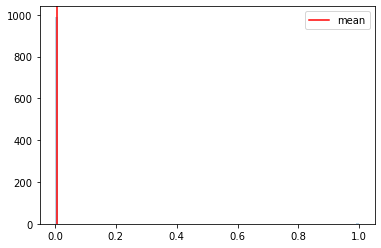

  0%|▏                                                                                | 2/1000 [00:00<01:01, 16.30it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654372573
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 0.1, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:32, 10.75it/s]

Monte Carlo 3
Monte Carlo 4
Monte Carlo 5


  1%|▌                                                                                | 7/1000 [00:00<02:06,  7.83it/s]

Monte Carlo 6
Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:01<02:02,  8.08it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 12/1000 [00:01<01:55,  8.59it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<01:51,  8.83it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<01:56,  8.43it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:01<01:58,  8.30it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<01:59,  8.18it/s]

Monte Carlo 18
Monte Carlo 19
Monte Carlo 20

  2%|█▋                                                                              | 21/1000 [00:02<01:58,  8.26it/s]


Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:57,  8.29it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<01:57,  8.29it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<01:56,  8.36it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<01:50,  8.82it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:11,  7.38it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<02:08,  7.50it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<01:59,  8.09it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<01:57,  8.18it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<01:58,  8.14it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<01:56,  8.25it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<01:56,  8.20it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:57,  8.15it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:55,  8.26it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:59,  7.93it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:06,  7.53it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:08,  7.35it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:04,  7.61it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<02:02,  7.69it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:06,  7.45it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:10,  7.20it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:12,  7.10it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:06,  7.40it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:06,  7.38it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:03,  7.52it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:03,  7.49it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:32,  6.07it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:25,  6.36it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:17,  6.74it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:17,  6.70it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:12,  6.95it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:08,  7.11it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:11<02:03,  7.39it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:05,  7.30it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:04,  7.29it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:09,  7.01it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:09,  7.02it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:06,  7.15it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:05,  7.22it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:13<02:06,  7.14it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:23,  6.25it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:24,  6.21it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:14,  6.67it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:16,  6.53it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:17,  6.46it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:19,  6.37it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<02:13,  6.66it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:14,  6.57it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:12,  6.66it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:16<02:14,  6.57it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:11,  6.71it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:10,  6.71it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:17<02:10,  6.72it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:09,  6.76it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:08,  6.79it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:09,  6.73it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:18<02:20,  6.18it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:17,  6.30it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:19,  6.21it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:19<02:13,  6.47it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:08,  6.66it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:11,  6.51it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:20<02:20,  6.09it/s]

Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:20<02:23,  5.95it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:20<02:18,  6.15it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:20<02:15,  6.26it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:21<02:21,  6.01it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:21<02:20,  6.02it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:21<02:20,  6.02it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:22<02:16,  6.17it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:22<02:16,  6.17it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:19,  6.01it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:23<02:23,  5.83it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:23<02:26,  5.71it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:19,  5.98it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:24<02:17,  6.06it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:24<02:14,  6.16it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:14,  6.12it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:25<02:15,  6.10it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:16,  6.03it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:18,  5.93it/s]

Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:26<02:18,  5.90it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:26<02:14,  6.09it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:16,  5.96it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:27<02:22,  5.72it/s]

Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:27<02:22,  5.70it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:23,  5.66it/s]

Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:23,  5.62it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:28<02:21,  5.72it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:28<02:24,  5.59it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▍                                                               | 196/1000 [00:28<02:23,  5.62it/s]

Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:29<02:37,  5.08it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:29<02:33,  5.22it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:28,  5.37it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:30<02:27,  5.42it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:30<02:28,  5.35it/s]

Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:32,  5.21it/s]

Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:30<02:29,  5.32it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:31<02:25,  5.44it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:31<02:20,  5.62it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:20,  5.61it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:32<02:21,  5.56it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:32<02:18,  5.68it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:32<02:16,  5.74it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:33<02:18,  5.63it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 220/1000 [00:33<02:18,  5.63it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:33<02:21,  5.50it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:25,  5.33it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:34<02:30,  5.14it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:34<02:25,  5.32it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:34<02:24,  5.33it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:34<02:25,  5.28it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:35<02:23,  5.37it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:35<02:24,  5.31it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:23,  5.33it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:36<02:17,  5.56it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:36<02:21,  5.39it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:19,  5.45it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:21,  5.37it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:37<02:24,  5.24it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:37<02:23,  5.28it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:37<02:22,  5.30it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:26,  5.16it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:23,  5.24it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:38<02:23,  5.26it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:38<02:23,  5.24it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:38<02:20,  5.35it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:24,  5.20it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:39<02:25,  5.15it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:39<02:23,  5.22it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:39<02:25,  5.11it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:24,  5.14it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:40<02:28,  5.03it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:40<02:26,  5.08it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:40<02:23,  5.17it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:40<02:25,  5.11it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:24,  5.13it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:41<02:31,  4.86it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:34,  4.77it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:33,  4.80it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:42<02:30,  4.86it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:29,  4.91it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:43<02:30,  4.84it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:43<02:29,  4.85it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:43<02:27,  4.92it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:24,  5.03it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:25,  5.00it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:44<02:31,  4.79it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 277/1000 [00:44<02:36,  4.62it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:44<02:32,  4.73it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:45<02:30,  4.77it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:45<02:28,  4.86it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:45<02:33,  4.68it/s]

Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:30,  4.75it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:46<02:30,  4.76it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:46<02:28,  4.80it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:27,  4.81it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:36,  4.54it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:47<02:40,  4.43it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:47<02:29,  4.74it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:26,  4.82it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:47<02:19,  5.06it/s]

Monte Carlo 293
Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:48<02:20,  5.02it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:16,  5.14it/s]

Monte Carlo 296
Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:19,  5.03it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:49<02:20,  4.99it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:49<02:20,  4.99it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:19,  5.00it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:13,  5.21it/s]

Monte Carlo 302
Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:50<02:16,  5.08it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:50<02:15,  5.13it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:14,  5.16it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:13,  5.18it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:23,  4.80it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:51<02:23,  4.79it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:24,  4.78it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:51<02:20,  4.87it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:20,  4.89it/s]

Monte Carlo 313
Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:22,  4.81it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:21,  4.83it/s]

Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:23,  4.75it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<02:21,  4.81it/s]

Monte Carlo 319
Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:20,  4.83it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:53<02:28,  4.56it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:29,  4.52it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:54<02:27,  4.57it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:47,  4.02it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:41,  4.18it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:55<02:31,  4.44it/s]

Monte Carlo 327
Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:55<02:30,  4.45it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:55<02:26,  4.57it/s]

Monte Carlo 330
Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:56<02:32,  4.38it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:56<02:34,  4.32it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:56<02:32,  4.36it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:27,  4.51it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:57<02:25,  4.55it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:57<02:25,  4.54it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:57<02:31,  4.35it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:30,  4.40it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:58<02:29,  4.42it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:58<02:32,  4.31it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:58<02:30,  4.38it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:28,  4.43it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:28,  4.40it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:59<02:28,  4.41it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:59<02:33,  4.25it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:29,  4.36it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:28,  4.40it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:00<02:28,  4.37it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:00<02:28,  4.36it/s]

Monte Carlo 351


 35%|███████████████████████████▉                                                   | 353/1000 [01:00<02:26,  4.42it/s]

Monte Carlo 352
Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:01<02:33,  4.20it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:01<02:30,  4.29it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:01<02:35,  4.15it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:32,  4.21it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:30,  4.28it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:02<02:32,  4.20it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:02<02:29,  4.28it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:02<02:27,  4.34it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:30,  4.24it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:03<02:25,  4.37it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:03<02:22,  4.45it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:03<02:24,  4.39it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:24,  4.39it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:04<02:27,  4.29it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:04<02:29,  4.21it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:04<02:31,  4.16it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:28,  4.24it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:05<02:27,  4.27it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:05<02:29,  4.19it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:05<02:28,  4.22it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:27,  4.25it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:27,  4.24it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:06<02:27,  4.22it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:06<02:27,  4.23it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:06<02:24,  4.30it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:27,  4.20it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:07<02:24,  4.28it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:07<02:27,  4.21it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:07<02:26,  4.21it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:25,  4.23it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:08<02:26,  4.20it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:08<02:32,  4.02it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:08<02:31,  4.05it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:32,  4.02it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:09<02:28,  4.11it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:09<02:31,  4.04it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:09<02:31,  4.03it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:09<02:32,  3.99it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:10<02:28,  4.10it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:10<02:26,  4.15it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:10<02:27,  4.12it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:10<02:27,  4.11it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:11<02:25,  4.15it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:11<02:27,  4.07it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:11<02:26,  4.12it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:11<02:26,  4.10it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:12<02:25,  4.13it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:12<02:24,  4.15it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:12<02:22,  4.18it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:22,  4.20it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:25,  4.11it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:13<02:24,  4.13it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:13<02:21,  4.20it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:13<02:23,  4.12it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:29,  3.96it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:14<02:27,  4.00it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:14<02:25,  4.04it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:14<02:28,  3.98it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<02:27,  3.99it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:15<02:26,  4.02it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:15<02:21,  4.14it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:15<02:17,  4.26it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:15,  4.30it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:16<02:18,  4.22it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:16<02:14,  4.34it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:16<02:13,  4.35it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:16<02:19,  4.17it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 422/1000 [01:17<02:10,  4.42it/s]

Monte Carlo 421
Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:17<02:08,  4.50it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:10,  4.41it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:17<02:13,  4.30it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:18<02:14,  4.28it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:18<02:32,  3.75it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:27,  3.89it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:19<02:21,  4.02it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:19<02:20,  4.07it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:19<02:21,  4.03it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:18,  4.09it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:20<02:20,  4.04it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:20<02:21,  4.00it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:20<02:19,  4.06it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:23,  3.94it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:21<02:22,  3.96it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:21<02:21,  3.96it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:21<02:21,  3.97it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:22,  3.94it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:22<02:21,  3.96it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:22<02:36,  3.56it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:22<02:35,  3.58it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:22<02:33,  3.61it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:23<02:38,  3.51it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:23<02:34,  3.58it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:23<02:32,  3.62it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:24<02:32,  3.62it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:24<02:27,  3.74it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:24<02:27,  3.72it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:36,  3.52it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:25<02:32,  3.59it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:25<02:34,  3.55it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:25<02:30,  3.62it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:32,  3.57it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:26<02:33,  3.54it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:26<02:33,  3.54it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:26<02:30,  3.60it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:27<02:26,  3.70it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:27<02:37,  3.43it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:27<02:37,  3.43it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:33,  3.50it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:28<02:28,  3.63it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:28<02:27,  3.62it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:28<02:23,  3.74it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:29<02:26,  3.66it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:29<02:22,  3.73it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:29<02:25,  3.65it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:29<02:27,  3.59it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:30<02:28,  3.58it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:30<02:26,  3.62it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:30<02:26,  3.59it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:30<02:29,  3.54it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:31<02:24,  3.64it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:31<02:21,  3.70it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:31<02:20,  3.74it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:32<02:24,  3.63it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:32<02:25,  3.60it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:32<02:27,  3.54it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:32<02:28,  3.51it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:33<02:26,  3.54it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:33<02:25,  3.57it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:33<02:24,  3.57it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:34<02:25,  3.56it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:34<02:25,  3.53it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:34<02:25,  3.54it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:34<02:26,  3.51it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:35<02:23,  3.56it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:35<02:24,  3.53it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:35<02:23,  3.56it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:36<02:21,  3.59it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:36<02:21,  3.58it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:36<02:22,  3.56it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:36<02:25,  3.48it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:37<02:21,  3.56it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:37<02:19,  3.61it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:37<02:18,  3.64it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:37<02:18,  3.62it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:38<02:16,  3.67it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:38<02:17,  3.64it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:38<02:17,  3.62it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:39<02:22,  3.50it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:39<02:24,  3.45it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:39<02:19,  3.56it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:39<02:18,  3.56it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:40<02:20,  3.52it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:40<02:23,  3.43it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:40<02:22,  3.46it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:41<02:22,  3.44it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:41<02:21,  3.46it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:41<02:21,  3.45it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:41<02:20,  3.46it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:42<02:19,  3.48it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:42<02:19,  3.49it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:42<02:16,  3.55it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:43<02:19,  3.48it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:43<02:22,  3.39it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:43<02:22,  3.39it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:44<02:25,  3.30it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:44<02:22,  3.36it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:44<02:22,  3.36it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:44<02:23,  3.33it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:45<02:20,  3.40it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:45<02:21,  3.37it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:45<02:19,  3.41it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:46<02:19,  3.40it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:46<02:19,  3.39it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:46<02:19,  3.39it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:46<02:17,  3.42it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:47<02:19,  3.38it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:47<02:24,  3.25it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:47<02:24,  3.25it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:48<02:22,  3.29it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:48<02:20,  3.33it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:48<02:17,  3.39it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:49<02:19,  3.32it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:49<02:16,  3.39it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:49<02:15,  3.41it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:50<02:17,  3.35it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:50<02:16,  3.38it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:50<02:16,  3.35it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:50<02:14,  3.40it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:51<02:12,  3.45it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:51<02:10,  3.49it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:51<02:14,  3.39it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:52<02:15,  3.36it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:52<02:18,  3.27it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:52<02:22,  3.18it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:53<02:19,  3.23it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:53<02:15,  3.31it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:53<02:13,  3.36it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:53<02:13,  3.34it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:54<02:16,  3.28it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:54<02:16,  3.28it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:54<02:15,  3.28it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:55<02:33,  2.89it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:55<02:23,  3.10it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:55<02:22,  3.10it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:56<02:22,  3.09it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:56<02:19,  3.15it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:56<02:22,  3.07it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:57<02:17,  3.18it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:57<02:15,  3.24it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:57<02:11,  3.32it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:57<02:10,  3.34it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:58<02:06,  3.44it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:58<02:06,  3.42it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:58<02:04,  3.46it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:59<02:03,  3.48it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:59<02:01,  3.54it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:59<02:01,  3.53it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:59<02:01,  3.53it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:00<02:02,  3.50it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:00<02:00,  3.55it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:00<02:00,  3.54it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:01<01:59,  3.55it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:01<01:58,  3.58it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:01<01:57,  3.58it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:01<01:59,  3.52it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:02<02:00,  3.49it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:02<02:02,  3.42it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:02<02:00,  3.48it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:03<02:02,  3.40it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:03<02:01,  3.42it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:03<01:59,  3.47it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:03<02:00,  3.44it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:04<02:01,  3.39it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:04<02:05,  3.28it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:04<02:06,  3.25it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:05<02:04,  3.29it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:05<02:03,  3.30it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:05<02:01,  3.35it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:06<02:01,  3.34it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:06<02:00,  3.38it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:06<02:01,  3.34it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:07<02:03,  3.28it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:07<02:02,  3.29it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:07<02:01,  3.32it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:07<02:02,  3.27it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:08<02:02,  3.26it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:08<02:02,  3.25it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:08<02:02,  3.25it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:09<02:03,  3.21it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:09<02:03,  3.21it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:09<02:04,  3.17it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:10<02:04,  3.17it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:10<02:06,  3.10it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:10<02:05,  3.13it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:11<02:06,  3.09it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:11<02:06,  3.08it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:11<02:06,  3.08it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:12<02:09,  3.00it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:12<02:06,  3.07it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:12<02:08,  3.00it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:13<02:09,  2.98it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:13<02:07,  3.02it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:13<02:05,  3.04it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:14<02:07,  3.00it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:14<02:05,  3.03it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:14<02:03,  3.08it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:15<02:05,  3.02it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:15<02:02,  3.09it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:15<02:01,  3.11it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:16<02:03,  3.03it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:16<02:04,  3.02it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:16<02:06,  2.96it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:17<02:09,  2.87it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:17<02:06,  2.94it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:17<02:05,  2.95it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:18<02:05,  2.95it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:18<02:03,  2.98it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:18<02:01,  3.02it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:19<02:04,  2.96it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:19<02:03,  2.97it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:19<02:01,  3.00it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:20<01:59,  3.05it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:20<01:59,  3.03it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:20<01:58,  3.05it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:21<01:59,  3.03it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:21<01:58,  3.05it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:21<01:59,  2.99it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:22<01:58,  3.03it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:22<02:00,  2.95it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:22<01:58,  3.00it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:23<02:00,  2.95it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:23<02:00,  2.95it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:23<01:59,  2.96it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:24<02:01,  2.89it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:24<01:57,  2.98it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:24<01:56,  3.02it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:25<01:58,  2.94it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:25<02:00,  2.89it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:25<01:59,  2.91it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:26<01:56,  2.97it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:26<01:56,  2.95it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:26<01:54,  2.99it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:27<02:06,  2.72it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:27<02:04,  2.75it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:27<02:01,  2.81it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:28<01:59,  2.84it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:28<01:57,  2.88it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:29<01:58,  2.86it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:29<01:58,  2.86it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:29<02:00,  2.80it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:30<01:59,  2.80it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:30<01:58,  2.81it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:30<01:58,  2.81it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:31<02:00,  2.76it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:31<02:00,  2.75it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:31<02:01,  2.72it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:32<02:05,  2.63it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:32<02:04,  2.63it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:33<02:02,  2.66it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:33<02:00,  2.71it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:33<01:57,  2.76it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:34<01:56,  2.79it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:34<01:54,  2.81it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:34<01:50,  2.90it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:35<01:50,  2.91it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:35<01:52,  2.84it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:35<01:50,  2.89it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:36<01:50,  2.89it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:36<01:51,  2.84it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:36<01:49,  2.89it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:37<01:49,  2.87it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:37<01:49,  2.87it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:37<01:51,  2.81it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:38<01:50,  2.82it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:38<01:50,  2.81it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:39<01:50,  2.81it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:39<01:47,  2.87it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:39<01:48,  2.83it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:40<01:50,  2.78it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:40<01:48,  2.82it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:40<01:48,  2.81it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:41<01:47,  2.83it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:41<01:48,  2.80it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:41<01:47,  2.81it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:42<01:48,  2.79it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:42<01:49,  2.73it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:42<01:46,  2.81it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:43<01:45,  2.83it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:43<01:43,  2.87it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:44<01:44,  2.83it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:44<01:43,  2.86it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:44<01:43,  2.85it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:45<01:42,  2.85it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:45<01:43,  2.83it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:45<01:43,  2.82it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:46<01:43,  2.79it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:46<01:41,  2.84it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:46<01:41,  2.83it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:47<01:43,  2.78it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:47<01:41,  2.81it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:47<01:44,  2.74it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:48<01:45,  2.70it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:48<01:43,  2.73it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:49<01:41,  2.78it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:49<01:39,  2.81it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:49<01:41,  2.76it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:50<01:42,  2.72it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:50<01:41,  2.73it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:50<01:41,  2.73it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:51<01:39,  2.78it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:51<01:38,  2.80it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:51<01:37,  2.81it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:52<01:39,  2.74it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:52<01:37,  2.78it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:52<01:36,  2.81it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:53<01:38,  2.75it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:53<01:40,  2.69it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:54<01:41,  2.65it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:54<01:40,  2.65it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:54<01:36,  2.76it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:55<01:37,  2.72it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:55<01:37,  2.71it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:55<01:36,  2.73it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:56<01:36,  2.72it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:56<01:34,  2.77it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:57<01:33,  2.78it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:57<01:33,  2.76it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:57<01:33,  2.77it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:58<01:34,  2.71it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:58<01:34,  2.71it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:58<01:32,  2.75it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:59<01:31,  2.79it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:59<01:35,  2.64it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:00<01:34,  2.66it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:00<01:33,  2.69it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:00<01:32,  2.71it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:01<01:30,  2.75it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:01<01:29,  2.78it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:01<01:31,  2.70it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:02<01:29,  2.75it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:02<01:29,  2.75it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:02<01:29,  2.72it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:03<01:26,  2.79it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:03<01:25,  2.82it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:03<01:23,  2.89it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:04<01:24,  2.85it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:04<01:22,  2.91it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:04<01:21,  2.90it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:05<01:21,  2.90it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:05<01:21,  2.89it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:06<01:21,  2.87it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:06<01:22,  2.84it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:06<01:21,  2.86it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:07<01:22,  2.82it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:07<01:20,  2.85it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:07<01:20,  2.85it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:08<01:20,  2.86it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:08<01:27,  2.61it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:08<01:25,  2.66it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:09<01:25,  2.65it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:09<01:26,  2.60it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:10<01:25,  2.62it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:10<01:24,  2.65it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:10<01:22,  2.68it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:11<01:22,  2.69it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:11<01:24,  2.61it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:11<01:24,  2.61it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:12<01:23,  2.62it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:12<01:21,  2.66it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:13<01:21,  2.67it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:13<01:22,  2.61it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:13<01:23,  2.57it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:14<01:21,  2.61it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:14<01:20,  2.64it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:15<01:20,  2.63it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:15<01:19,  2.64it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:15<01:20,  2.61it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:16<01:19,  2.63it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:16<01:18,  2.62it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:16<01:18,  2.61it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:17<01:20,  2.56it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:17<01:20,  2.54it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:18<01:18,  2.58it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:18<01:19,  2.53it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:18<01:17,  2.59it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:19<01:16,  2.60it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:19<01:16,  2.60it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:20<01:16,  2.60it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:20<01:15,  2.61it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:20<01:14,  2.62it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:21<01:15,  2.58it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:21<01:12,  2.67it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:21<01:11,  2.68it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:22<01:11,  2.70it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:22<01:09,  2.74it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:23<01:09,  2.74it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:23<01:10,  2.67it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:23<01:10,  2.65it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:24<01:10,  2.65it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:24<01:10,  2.64it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:24<01:09,  2.65it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:25<01:08,  2.67it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:25<01:09,  2.65it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:26<01:08,  2.64it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:26<01:07,  2.68it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:26<01:06,  2.70it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:27<01:06,  2.70it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:27<01:06,  2.69it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:27<01:07,  2.61it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:28<01:09,  2.54it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:28<01:08,  2.55it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:29<01:07,  2.56it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:29<01:07,  2.55it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:29<01:06,  2.57it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:30<01:08,  2.50it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:30<01:07,  2.51it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:31<01:06,  2.54it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:31<01:07,  2.49it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:31<01:09,  2.41it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:32<01:09,  2.40it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:32<01:08,  2.40it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:33<01:07,  2.43it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:33<01:07,  2.43it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:34<01:05,  2.47it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:34<01:04,  2.50it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:34<01:05,  2.46it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:35<01:03,  2.49it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:35<01:04,  2.43it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:36<01:03,  2.47it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:36<01:03,  2.46it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:36<01:02,  2.47it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:37<01:02,  2.47it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:37<01:02,  2.46it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:38<01:01,  2.49it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:38<01:01,  2.45it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:38<01:01,  2.44it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:39<01:01,  2.43it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:39<01:00,  2.43it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:40<01:01,  2.39it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:40<01:01,  2.39it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:40<01:00,  2.41it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:41<00:58,  2.44it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:41<00:58,  2.44it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:42<00:57,  2.46it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:42<00:57,  2.44it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:43<00:56,  2.46it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:43<00:57,  2.40it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:43<00:58,  2.35it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:44<00:58,  2.35it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:44<00:58,  2.33it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:45<00:57,  2.36it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:45<00:56,  2.39it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:45<00:55,  2.38it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:46<00:54,  2.44it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:46<00:53,  2.44it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:47<00:53,  2.42it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:47<00:58,  2.20it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:48<00:55,  2.29it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:48<00:53,  2.36it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:48<00:53,  2.36it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:49<00:52,  2.37it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:49<00:52,  2.35it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:50<00:52,  2.36it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:50<00:50,  2.41it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:51<00:51,  2.36it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:51<00:50,  2.37it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:51<00:50,  2.37it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:52<00:48,  2.42it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:52<00:48,  2.40it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:53<00:48,  2.39it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:53<00:48,  2.39it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:53<00:47,  2.39it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:54<00:47,  2.37it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:54<00:47,  2.36it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:55<00:47,  2.34it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:55<00:46,  2.35it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:56<00:46,  2.35it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:56<00:45,  2.38it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:56<00:44,  2.38it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:57<00:43,  2.46it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:57<00:42,  2.46it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:58<00:41,  2.51it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:58<00:41,  2.50it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:58<00:40,  2.50it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:59<00:40,  2.48it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:59<00:39,  2.52it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:00<00:38,  2.57it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:00<00:38,  2.56it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:00<00:38,  2.52it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:01<00:38,  2.49it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:01<00:38,  2.46it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:02<00:38,  2.47it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:02<00:39,  2.38it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:02<00:38,  2.42it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:03<00:37,  2.45it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:03<00:36,  2.48it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:04<00:35,  2.52it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:04<00:35,  2.48it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:05<00:35,  2.43it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:05<00:35,  2.44it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:05<00:34,  2.44it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:06<00:34,  2.45it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:06<00:33,  2.46it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:07<00:33,  2.45it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:07<00:33,  2.44it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:07<00:32,  2.44it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:08<00:32,  2.42it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:08<00:32,  2.39it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:09<00:32,  2.40it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:09<00:31,  2.43it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:09<00:30,  2.43it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:10<00:30,  2.41it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:10<00:30,  2.39it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:11<00:30,  2.39it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:11<00:29,  2.38it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:12<00:29,  2.35it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:12<00:29,  2.37it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:12<00:28,  2.36it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:13<00:29,  2.28it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:13<00:28,  2.30it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:14<00:28,  2.32it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:14<00:27,  2.31it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:15<00:27,  2.31it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:15<00:26,  2.30it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:15<00:26,  2.29it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:16<00:26,  2.28it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:16<00:26,  2.27it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:17<00:26,  2.17it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:17<00:28,  2.02it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:18<00:27,  2.03it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:18<00:27,  2.00it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:19<00:26,  2.00it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:19<00:26,  2.02it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:20<00:25,  2.03it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:20<00:24,  2.04it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:21<00:25,  2.00it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:21<00:24,  2.01it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:22<00:23,  2.02it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:22<00:23,  2.04it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:23<00:22,  2.03it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:23<00:21,  2.06it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:24<00:21,  2.07it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:24<00:21,  2.04it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:25<00:21,  1.98it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:25<00:21,  1.94it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:26<00:21,  1.85it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:27<00:21,  1.78it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:27<00:21,  1.80it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:28<00:20,  1.78it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:28<00:19,  1.87it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:29<00:19,  1.82it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:29<00:17,  1.89it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:30<00:17,  1.91it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:30<00:16,  1.96it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:31<00:15,  2.01it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:31<00:14,  2.05it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:32<00:14,  2.03it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:32<00:13,  2.03it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:33<00:13,  2.07it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:33<00:12,  2.08it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:34<00:12,  2.08it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:34<00:11,  2.12it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:35<00:10,  2.10it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:35<00:10,  2.10it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:36<00:09,  2.11it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:36<00:09,  2.11it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:36<00:08,  2.12it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:37<00:08,  2.08it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:37<00:08,  2.06it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:38<00:07,  2.05it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:38<00:07,  2.07it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:39<00:06,  2.08it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:39<00:06,  2.09it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:40<00:05,  2.06it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:40<00:05,  2.04it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:41<00:04,  2.04it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:41<00:04,  2.00it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:42<00:03,  2.01it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:42<00:03,  2.05it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:43<00:02,  2.06it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:43<00:02,  2.08it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:44<00:01,  2.08it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:44<00:01,  2.11it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:45<00:00,  2.12it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:45<00:00,  2.05it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:46<00:00,  3.49it/s]


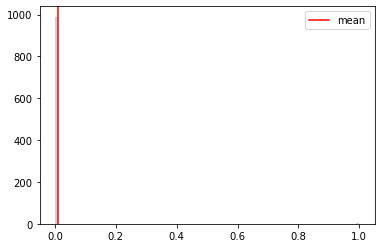

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654372860
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 0.1, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:16, 12.97it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:52,  8.85it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:58,  8.35it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<02:05,  7.90it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:57,  8.38it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:57,  8.41it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:58,  8.30it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<01:59,  8.21it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:56,  8.45it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<02:00,  8.13it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<02:03,  7.88it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<02:05,  7.73it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:22,  6.81it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:20,  6.90it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:04<02:11,  7.36it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:14,  7.19it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:13,  7.24it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<02:12,  7.27it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:05<02:11,  7.29it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<02:26,  6.53it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<02:17,  6.97it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:06<02:26,  6.52it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:06<02:19,  6.81it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:06<02:17,  6.89it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<02:20,  6.77it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:07<02:19,  6.77it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:07<02:20,  6.70it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<02:35,  6.05it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:08<02:33,  6.13it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:08<02:31,  6.17it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:08<02:31,  6.16it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:09<02:35,  6.00it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:09<02:32,  6.12it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:09<02:29,  6.24it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:10<02:31,  6.12it/s]

Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:10<02:35,  5.95it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:10<02:36,  5.90it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:11<02:59,  5.15it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:11<02:47,  5.51it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:11<02:36,  5.88it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:12<02:36,  5.88it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:12<02:31,  6.05it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:12<02:25,  6.29it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:13<02:32,  5.98it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:13<02:28,  6.11it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:13<02:36,  5.80it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:14<02:32,  5.92it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:14<02:29,  6.04it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:14<02:31,  5.96it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:15<02:34,  5.83it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:15<02:33,  5.84it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:15<02:43,  5.46it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:16<02:52,  5.19it/s]

Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:16<02:48,  5.30it/s]

Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:16<02:44,  5.42it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:17<02:38,  5.62it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:17<02:39,  5.57it/s]

Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:17<02:39,  5.56it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:17<02:42,  5.44it/s]

Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:18<02:40,  5.51it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▎                                                                     | 118/1000 [00:18<02:38,  5.55it/s]

Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:18<02:37,  5.60it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:19<02:41,  5.42it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:19<02:30,  5.81it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:19<02:24,  6.04it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:20<02:27,  5.91it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:20<02:20,  6.20it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:20<02:18,  6.27it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:20<02:18,  6.27it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:21<02:16,  6.34it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:21<02:12,  6.50it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:21<02:17,  6.27it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:22<02:19,  6.17it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:22<02:17,  6.23it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:22<02:15,  6.32it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:23<02:10,  6.52it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:23<02:13,  6.37it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:23<02:08,  6.58it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:24<02:12,  6.38it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:24<02:09,  6.50it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:24<02:14,  6.28it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:25<02:09,  6.50it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:25<02:06,  6.61it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:25<02:18,  6.03it/s]

Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:25<02:14,  6.22it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:26<02:17,  6.05it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:26<02:19,  5.95it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:26<02:19,  5.94it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:27<02:20,  5.88it/s]

Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:27<02:16,  6.05it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:27<02:17,  5.99it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:28<02:14,  6.12it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:28<02:25,  5.64it/s]

Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:28<02:20,  5.83it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:28<02:22,  5.74it/s]

Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:29<02:18,  5.89it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:29<02:11,  6.21it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:29<02:12,  6.13it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:30<02:15,  5.99it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:30<02:15,  5.95it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:30<02:13,  6.04it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:31<02:13,  6.03it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:31<02:15,  5.93it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:31<02:14,  5.95it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:32<02:33,  5.20it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:32<02:29,  5.31it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:32<02:26,  5.41it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:33<02:24,  5.47it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:33<02:20,  5.64it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:34<02:20,  5.60it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:34<02:16,  5.76it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:34<02:16,  5.76it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:34<02:12,  5.90it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:35<02:19,  5.59it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:35<02:18,  5.64it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:35<02:17,  5.66it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:36<02:15,  5.72it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:36<02:19,  5.56it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:36<02:26,  5.29it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:37<02:26,  5.26it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:37<02:24,  5.33it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:37<02:21,  5.41it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:38<02:22,  5.38it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:38<02:21,  5.41it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:38<02:18,  5.49it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:38<02:20,  5.42it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:39<02:20,  5.39it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:39<02:22,  5.32it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:39<02:23,  5.27it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:39<02:24,  5.23it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:39<02:21,  5.35it/s]

Monte Carlo 243
Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:40<02:19,  5.41it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:40<02:20,  5.34it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:40<02:16,  5.51it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:40<02:14,  5.58it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:41<02:09,  5.80it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:41<02:14,  5.56it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:41<02:12,  5.61it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:42<02:14,  5.54it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:42<02:15,  5.49it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:42<02:08,  5.76it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:42<02:10,  5.68it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:43<02:08,  5.72it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:43<02:08,  5.71it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:43<02:08,  5.70it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:43<02:05,  5.86it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:44<02:04,  5.86it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:44<02:04,  5.83it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:44<02:07,  5.70it/s]

Monte Carlo 272
Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:45<02:06,  5.75it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:45<02:09,  5.60it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:45<02:09,  5.59it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:46<02:08,  5.59it/s]

Monte Carlo 279
Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:46<02:13,  5.37it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:46<02:11,  5.45it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:47<02:11,  5.44it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:47<02:10,  5.45it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:47<02:11,  5.40it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:47<02:13,  5.34it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:48<02:12,  5.35it/s]

Monte Carlo 289
Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:48<02:15,  5.21it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:48<02:16,  5.18it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:48<02:14,  5.23it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:49<02:12,  5.30it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:49<02:10,  5.41it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:49<02:08,  5.47it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:49<02:08,  5.45it/s]

Monte Carlo 299
Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:50<02:11,  5.31it/s]

Monte Carlo 301
Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:50<02:12,  5.26it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:50<02:10,  5.31it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:51<02:08,  5.41it/s]

Monte Carlo 305
Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:51<02:11,  5.25it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:51<02:07,  5.43it/s]

Monte Carlo 308
Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:51<02:09,  5.32it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:52<02:14,  5.12it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:52<02:15,  5.08it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:52<02:13,  5.16it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:52<02:12,  5.18it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:10,  5.25it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:53<02:11,  5.20it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:53<02:12,  5.15it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:53<02:09,  5.26it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<02:07,  5.34it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:07,  5.33it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:54<02:05,  5.39it/s]

Monte Carlo 321
Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:54<02:07,  5.32it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:06,  5.34it/s]

Monte Carlo 324
Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:14,  5.00it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:55<02:13,  5.03it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:55<02:11,  5.11it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:08,  5.20it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:55<02:08,  5.20it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:56<02:09,  5.15it/s]

Monte Carlo 331
Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:56<02:12,  5.01it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:10,  5.08it/s]

Monte Carlo 334
Monte Carlo 335


 34%|██████████████████████████▌                                                    | 337/1000 [00:57<02:13,  4.97it/s]

Monte Carlo 336
Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:57<02:15,  4.90it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:57<02:18,  4.77it/s]

Monte Carlo 339


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:15,  4.85it/s]

Monte Carlo 340
Monte Carlo 341


 34%|███████████████████████████                                                    | 343/1000 [00:58<02:17,  4.78it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:14,  4.87it/s]

Monte Carlo 343


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:13,  4.90it/s]

Monte Carlo 344


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:11,  4.96it/s]

Monte Carlo 345


 35%|███████████████████████████▍                                                   | 347/1000 [00:59<02:09,  5.05it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:10,  5.01it/s]

Monte Carlo 347
Monte Carlo 348


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:30,  4.32it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 351/1000 [01:00<02:23,  4.52it/s]

Monte Carlo 350


 35%|███████████████████████████▊                                                   | 352/1000 [01:00<02:18,  4.67it/s]

Monte Carlo 351
Monte Carlo 352


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:17,  4.70it/s]

Monte Carlo 353
Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:16,  4.73it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:01<02:15,  4.76it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:18,  4.64it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:17,  4.66it/s]

Monte Carlo 358
Monte Carlo 359


 36%|████████████████████████████▌                                                  | 361/1000 [01:02<02:14,  4.76it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:12,  4.80it/s]

Monte Carlo 361
Monte Carlo 362


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:16,  4.66it/s]

Monte Carlo 363
Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:03<02:17,  4.61it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:16,  4.66it/s]

Monte Carlo 366


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:11,  4.81it/s]

Monte Carlo 367
Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:11,  4.78it/s]

Monte Carlo 369
Monte Carlo 370


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:09,  4.85it/s]

Monte Carlo 371
Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:14,  4.66it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:04<02:17,  4.56it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:19,  4.48it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:19,  4.49it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:26,  4.24it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:23,  4.33it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:23,  4.34it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:17,  4.51it/s]

Monte Carlo 380
Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:19,  4.44it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:14,  4.58it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:13,  4.62it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:16,  4.50it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:16,  4.49it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:07<02:14,  4.54it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:20,  4.37it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:23,  4.27it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:20,  4.35it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:08<02:17,  4.44it/s]

Monte Carlo 391


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:12,  4.57it/s]

Monte Carlo 392
Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:15,  4.46it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:09<02:17,  4.39it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:09<02:16,  4.43it/s]

Monte Carlo 396


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:10,  4.61it/s]

Monte Carlo 397
Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:11,  4.57it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:10<02:10,  4.58it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:11,  4.54it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:11,  4.55it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:13,  4.48it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:11<02:13,  4.48it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:11<02:15,  4.40it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:16,  4.34it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:18,  4.27it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:12<02:17,  4.30it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:12<02:24,  4.09it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:24,  4.08it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:21,  4.17it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:13<02:21,  4.15it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:13<02:27,  3.99it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:27,  3.99it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:30,  3.90it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:14<02:32,  3.82it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:15<02:50,  3.41it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:47,  3.48it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:44,  3.53it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:15<02:39,  3.63it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:16<02:35,  3.72it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:31,  3.82it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:36,  3.69it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:16<02:41,  3.56it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:17<02:49,  3.38it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:47,  3.43it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:50,  3.37it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:49,  3.37it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:47,  3.41it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:48,  3.39it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:19<02:45,  3.44it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:45,  3.43it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:42,  3.48it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:47,  3.37it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:20<02:48,  3.35it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:51,  3.30it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:50,  3.31it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:21<02:53,  3.23it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:21<02:55,  3.20it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:53,  3.22it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:22<02:54,  3.20it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:22<02:51,  3.26it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:22<02:50,  3.26it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:23<02:55,  3.16it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:23<02:55,  3.17it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:23<02:54,  3.18it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:24<02:57,  3.12it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:24<02:54,  3.17it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:24<02:48,  3.26it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:24<02:49,  3.24it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:25<02:55,  3.14it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:25<02:52,  3.17it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:25<02:51,  3.19it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:26<02:50,  3.20it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:26<02:50,  3.19it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:26<02:49,  3.22it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:27<02:48,  3.21it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:27<02:46,  3.25it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:27<02:46,  3.25it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:28<02:45,  3.26it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:28<02:46,  3.23it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:28<02:42,  3.31it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:28<02:35,  3.44it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:29<02:32,  3.52it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:29<02:28,  3.59it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:29<02:26,  3.64it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:29<02:24,  3.69it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:30<02:25,  3.66it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:30<02:19,  3.79it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:30<02:21,  3.74it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:31<02:20,  3.76it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:31<02:21,  3.74it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:31<02:19,  3.78it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:31<02:17,  3.83it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:32<02:15,  3.88it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:32<02:13,  3.92it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:32<02:12,  3.96it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:32<02:10,  3.99it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:33<02:17,  3.78it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:33<02:18,  3.74it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:33<02:16,  3.81it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:33<02:13,  3.88it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:34<02:13,  3.87it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:34<02:16,  3.78it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:34<02:19,  3.69it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:34<02:20,  3.66it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:35<02:18,  3.70it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:35<02:17,  3.73it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:35<02:19,  3.66it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:36<02:19,  3.65it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:36<02:20,  3.63it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:36<02:22,  3.57it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:36<02:24,  3.50it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:37<02:24,  3.51it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:37<02:21,  3.56it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:37<02:19,  3.62it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:38<02:15,  3.71it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:38<02:12,  3.78it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:38<02:11,  3.80it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:38<02:27,  3.40it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:39<02:24,  3.46it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:39<02:20,  3.56it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:39<02:18,  3.58it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:39<02:18,  3.58it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:40<02:17,  3.60it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:40<02:15,  3.64it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:40<02:16,  3.62it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:41<02:17,  3.57it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:41<02:16,  3.60it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:41<02:15,  3.60it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:41<02:16,  3.58it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:42<02:17,  3.55it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:42<02:15,  3.60it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:42<02:13,  3.63it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:43<02:15,  3.58it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:43<02:16,  3.55it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:43<02:13,  3.61it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:43<02:13,  3.61it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:44<02:11,  3.65it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:44<02:12,  3.62it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:44<02:10,  3.68it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:44<02:10,  3.66it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:45<02:09,  3.68it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:45<02:07,  3.75it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:45<02:10,  3.63it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:46<02:10,  3.64it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:46<02:09,  3.65it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:46<02:10,  3.63it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:46<02:09,  3.63it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:47<02:10,  3.59it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:47<02:15,  3.46it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:47<02:17,  3.40it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:48<02:16,  3.42it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:48<02:14,  3.47it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:48<02:11,  3.54it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:48<02:13,  3.47it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:49<02:13,  3.46it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:49<02:12,  3.50it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:49<02:08,  3.59it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:50<02:05,  3.66it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:50<02:06,  3.62it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:50<02:11,  3.48it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:50<02:12,  3.44it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:51<02:16,  3.35it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:51<02:17,  3.32it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:51<02:15,  3.35it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:52<02:13,  3.40it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:52<02:12,  3.42it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:52<02:08,  3.51it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:52<02:10,  3.46it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:53<02:08,  3.48it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:53<02:12,  3.38it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:53<02:11,  3.39it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:54<02:11,  3.38it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:54<02:11,  3.37it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:54<02:10,  3.40it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:55<02:11,  3.37it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:55<02:08,  3.43it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:55<02:06,  3.48it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:55<02:09,  3.39it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:56<02:09,  3.39it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:56<02:09,  3.38it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:56<02:08,  3.41it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:57<02:05,  3.47it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:57<02:03,  3.51it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:57<02:02,  3.54it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:57<02:04,  3.48it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:58<02:04,  3.47it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:58<02:05,  3.43it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:58<02:02,  3.51it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:59<02:05,  3.41it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:59<02:01,  3.53it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:59<01:57,  3.62it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:59<01:59,  3.56it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:00<01:58,  3.58it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:00<01:56,  3.65it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:00<01:57,  3.60it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:01<01:57,  3.58it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:01<01:55,  3.64it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:01<01:55,  3.64it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:01<01:56,  3.58it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:02<01:55,  3.63it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:02<01:55,  3.61it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:02<01:54,  3.62it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:02<01:53,  3.66it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:03<01:55,  3.60it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:03<01:54,  3.61it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:03<01:52,  3.67it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:04<01:51,  3.67it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:04<01:54,  3.59it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:04<01:54,  3.58it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:04<01:55,  3.53it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:05<01:53,  3.57it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:05<01:49,  3.70it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:05<01:54,  3.54it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:06<01:55,  3.49it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:06<01:56,  3.46it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:06<01:56,  3.44it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:06<01:54,  3.49it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:07<01:52,  3.56it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:07<01:53,  3.52it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:07<01:52,  3.54it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:08<01:53,  3.49it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:08<01:53,  3.49it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:08<02:05,  3.14it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:09<02:07,  3.10it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:09<02:03,  3.17it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:09<02:01,  3.22it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:09<02:01,  3.21it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:10<02:00,  3.24it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:10<01:57,  3.31it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:10<01:54,  3.39it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:11<01:56,  3.33it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:11<02:00,  3.21it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:11<01:56,  3.29it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:12<01:59,  3.21it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:12<01:58,  3.23it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:12<01:59,  3.19it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:13<01:58,  3.21it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:13<01:57,  3.25it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:13<01:55,  3.29it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:13<01:57,  3.21it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:14<01:59,  3.16it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:14<01:58,  3.18it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:14<01:58,  3.17it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:15<02:02,  3.05it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:15<02:03,  3.02it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:15<02:04,  3.00it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:16<02:04,  2.97it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:16<02:00,  3.07it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:16<01:57,  3.13it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:17<01:54,  3.20it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:17<01:52,  3.26it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:17<01:52,  3.27it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:18<01:51,  3.28it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:18<01:51,  3.27it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:18<01:49,  3.32it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:18<01:48,  3.32it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:19<01:52,  3.21it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:19<01:51,  3.23it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:19<01:53,  3.15it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:20<01:52,  3.19it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:20<01:54,  3.13it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:20<01:53,  3.13it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:21<01:54,  3.10it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:21<01:53,  3.13it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:21<01:51,  3.17it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:22<01:49,  3.21it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:22<01:50,  3.17it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:22<01:50,  3.17it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:23<01:53,  3.06it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:23<01:53,  3.08it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:23<01:53,  3.06it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:24<01:52,  3.09it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:24<01:56,  2.97it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:24<02:02,  2.81it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:25<02:03,  2.78it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:25<01:58,  2.88it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:25<01:55,  2.94it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:26<01:56,  2.93it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:26<01:52,  3.01it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:26<01:53,  2.97it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:27<01:55,  2.91it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:27<01:54,  2.94it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:27<01:56,  2.87it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:28<01:57,  2.84it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:28<01:58,  2.82it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:29<02:01,  2.74it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:29<02:00,  2.75it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:29<01:55,  2.86it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:30<01:55,  2.85it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:30<01:54,  2.87it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:30<01:57,  2.79it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:31<01:56,  2.80it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:31<01:58,  2.74it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:31<01:56,  2.78it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:32<01:53,  2.85it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:32<01:54,  2.82it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:32<01:50,  2.90it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:33<01:50,  2.91it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:33<01:49,  2.91it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:33<01:47,  2.95it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:34<01:47,  2.96it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:34<01:45,  2.99it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:34<01:48,  2.90it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:35<01:48,  2.88it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:35<01:48,  2.89it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:36<01:51,  2.80it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:36<01:49,  2.84it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:36<01:51,  2.78it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:37<01:50,  2.80it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:37<01:47,  2.87it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:37<01:48,  2.82it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:38<01:46,  2.87it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:38<01:45,  2.88it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:38<01:46,  2.85it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:39<01:45,  2.87it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:39<01:46,  2.84it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:39<01:46,  2.84it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:40<01:45,  2.84it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:40<01:43,  2.89it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:40<01:41,  2.92it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:41<01:40,  2.95it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:41<01:39,  2.98it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:41<01:40,  2.94it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:42<01:39,  2.95it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:42<01:39,  2.93it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:42<01:41,  2.88it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:43<01:42,  2.83it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:43<01:42,  2.84it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:44<01:42,  2.82it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:44<01:43,  2.79it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:44<01:41,  2.83it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:45<01:40,  2.85it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:45<01:39,  2.86it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:45<01:39,  2.86it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:46<01:40,  2.80it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:46<01:39,  2.83it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:46<01:38,  2.86it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:47<01:40,  2.80it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:47<01:40,  2.77it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:47<01:41,  2.75it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:48<01:41,  2.74it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:48<01:41,  2.72it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:49<01:41,  2.71it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:49<01:48,  2.52it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:49<01:48,  2.52it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:50<01:43,  2.64it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:50<01:39,  2.73it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:50<01:37,  2.76it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:51<01:36,  2.79it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:51<01:34,  2.84it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:51<01:32,  2.88it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:52<01:32,  2.88it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:52<01:32,  2.86it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:53<01:34,  2.80it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:53<01:34,  2.80it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:53<01:32,  2.83it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:54<01:32,  2.83it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:54<01:32,  2.81it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:54<01:33,  2.76it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:55<01:35,  2.70it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:55<01:32,  2.77it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:55<01:34,  2.70it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:56<01:32,  2.76it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:56<01:30,  2.80it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:57<01:30,  2.79it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:57<01:29,  2.82it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:57<01:29,  2.82it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:58<01:29,  2.79it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:58<01:27,  2.84it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:58<01:27,  2.82it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:59<01:29,  2.77it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:59<01:27,  2.81it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:59<01:30,  2.70it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:00<01:30,  2.69it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:00<01:30,  2.67it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:01<01:28,  2.72it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:01<01:27,  2.74it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:01<01:26,  2.78it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:02<01:26,  2.77it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:02<01:27,  2.73it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:02<01:27,  2.71it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:03<01:26,  2.73it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:03<01:26,  2.72it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:03<01:26,  2.71it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:04<01:27,  2.66it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:04<01:25,  2.72it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:05<01:24,  2.75it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:05<01:21,  2.83it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:05<01:18,  2.90it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:06<01:19,  2.88it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:06<01:17,  2.91it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:06<01:17,  2.92it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:07<01:15,  2.96it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:07<01:17,  2.88it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:07<01:15,  2.95it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:08<01:16,  2.91it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:08<01:17,  2.85it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:08<01:17,  2.85it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:09<01:16,  2.86it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:09<01:16,  2.85it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:09<01:18,  2.78it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:10<01:19,  2.73it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:10<01:17,  2.79it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:11<01:17,  2.75it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:11<01:17,  2.76it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:11<01:16,  2.76it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:12<01:16,  2.76it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:12<01:16,  2.74it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:12<01:16,  2.74it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:13<01:16,  2.74it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:13<01:16,  2.70it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:13<01:18,  2.63it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:14<01:17,  2.66it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:14<01:16,  2.66it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:15<01:14,  2.71it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:15<01:13,  2.73it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:15<01:14,  2.71it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:16<01:13,  2.72it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:16<01:13,  2.72it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:16<01:16,  2.57it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:17<01:15,  2.60it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:17<01:16,  2.57it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:18<01:15,  2.59it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:18<01:13,  2.63it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:18<01:14,  2.58it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:19<01:13,  2.60it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:19<01:13,  2.59it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:20<01:12,  2.63it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:20<01:11,  2.63it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:20<01:11,  2.65it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:21<01:11,  2.62it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:21<01:13,  2.53it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:21<01:11,  2.57it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:22<01:10,  2.61it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:22<01:09,  2.64it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:23<01:09,  2.61it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:23<01:08,  2.63it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:23<01:10,  2.57it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:24<01:08,  2.62it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:24<01:07,  2.63it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:25<01:06,  2.65it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:25<01:07,  2.60it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:25<01:07,  2.59it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:26<01:07,  2.57it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:26<01:07,  2.57it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:26<01:06,  2.59it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:27<01:04,  2.63it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:27<01:10,  2.41it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:28<01:08,  2.48it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:28<01:06,  2.52it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:28<01:06,  2.51it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:29<01:04,  2.58it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:29<01:03,  2.59it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:30<01:03,  2.58it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:30<01:02,  2.59it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:30<01:03,  2.56it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:31<01:02,  2.59it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:31<01:02,  2.57it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:32<01:01,  2.59it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:32<01:01,  2.59it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:32<01:03,  2.49it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:33<01:03,  2.47it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:33<01:01,  2.51it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:34<01:00,  2.55it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:34<00:59,  2.55it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:34<00:58,  2.59it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:35<00:57,  2.62it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:35<00:57,  2.60it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:35<00:58,  2.54it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:36<00:58,  2.55it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:36<00:57,  2.58it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:37<00:57,  2.56it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:37<00:56,  2.59it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:37<00:55,  2.57it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:38<00:55,  2.60it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:38<00:55,  2.56it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:39<00:55,  2.55it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:39<00:55,  2.53it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:39<00:56,  2.46it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:40<00:56,  2.46it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:40<00:54,  2.52it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:41<00:54,  2.52it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:41<00:53,  2.50it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:41<00:52,  2.54it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:42<00:52,  2.53it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:42<00:51,  2.57it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:43<00:52,  2.52it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:43<00:50,  2.55it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:43<00:50,  2.53it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:44<00:49,  2.58it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:44<00:48,  2.61it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:44<00:48,  2.62it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:45<00:47,  2.65it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:45<00:46,  2.64it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:46<00:47,  2.61it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:46<00:46,  2.64it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:46<00:46,  2.60it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:47<00:46,  2.57it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:47<00:47,  2.50it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:48<00:47,  2.51it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:48<00:47,  2.48it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:48<00:45,  2.54it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:49<00:45,  2.55it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:49<00:44,  2.54it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:50<00:44,  2.56it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:50<00:44,  2.53it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:50<00:45,  2.46it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:51<00:43,  2.55it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:51<00:43,  2.53it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:52<00:41,  2.57it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:52<00:41,  2.58it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:52<00:41,  2.56it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:53<00:41,  2.54it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:53<00:40,  2.56it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:53<00:39,  2.61it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:54<00:40,  2.53it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:54<00:39,  2.55it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:55<00:38,  2.58it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:55<00:38,  2.58it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:55<00:37,  2.61it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:56<00:37,  2.58it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:56<00:37,  2.54it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:57<00:37,  2.52it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:57<00:37,  2.52it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:57<00:37,  2.49it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:58<00:36,  2.51it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:58<00:36,  2.47it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:59<00:36,  2.47it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:59<00:36,  2.46it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:59<00:36,  2.42it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:00<00:36,  2.37it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:00<00:36,  2.35it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:01<00:36,  2.33it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:01<00:36,  2.30it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:02<00:36,  2.30it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:02<00:35,  2.32it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:03<00:34,  2.35it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:03<00:33,  2.39it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:03<00:33,  2.37it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:04<00:32,  2.38it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:04<00:32,  2.38it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:05<00:32,  2.33it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:05<00:31,  2.36it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:05<00:31,  2.37it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:06<00:30,  2.40it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:06<00:29,  2.41it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:07<00:29,  2.38it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:07<00:29,  2.40it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:08<00:28,  2.38it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:08<00:30,  2.20it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:09<00:30,  2.22it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:09<00:29,  2.21it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:09<00:29,  2.23it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:10<00:28,  2.26it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:10<00:27,  2.28it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:11<00:26,  2.30it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:11<00:26,  2.31it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:12<00:25,  2.31it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:12<00:26,  2.26it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:12<00:25,  2.29it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:13<00:24,  2.34it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:13<00:23,  2.35it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:14<00:23,  2.39it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:14<00:23,  2.33it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:15<00:23,  2.28it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:15<00:23,  2.25it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:16<00:22,  2.25it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:16<00:22,  2.21it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:16<00:22,  2.22it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:17<00:21,  2.28it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:17<00:20,  2.29it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:18<00:20,  2.29it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:18<00:19,  2.27it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:19<00:19,  2.30it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:19<00:18,  2.29it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:19<00:18,  2.27it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:20<00:19,  2.12it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:21<00:19,  2.08it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:21<00:18,  2.09it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:21<00:18,  2.07it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:22<00:17,  2.08it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:22<00:17,  2.10it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:23<00:16,  2.15it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:23<00:15,  2.18it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:24<00:15,  2.19it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:24<00:14,  2.18it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:25<00:13,  2.24it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:25<00:13,  2.26it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:25<00:12,  2.31it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:26<00:12,  2.28it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:26<00:12,  2.24it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:27<00:11,  2.24it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:27<00:11,  2.19it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:28<00:10,  2.21it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:28<00:10,  2.22it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:29<00:09,  2.21it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:29<00:09,  2.17it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:30<00:09,  2.12it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:30<00:08,  2.13it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:31<00:08,  2.13it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:31<00:08,  2.08it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:32<00:07,  2.11it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:32<00:07,  2.13it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:32<00:06,  2.13it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:33<00:06,  2.12it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:33<00:05,  2.12it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:34<00:05,  2.11it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:34<00:04,  2.06it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:35<00:04,  2.01it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:35<00:03,  2.00it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:36<00:03,  2.02it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:36<00:03,  2.00it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:37<00:02,  2.00it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:37<00:01,  2.05it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:38<00:01,  2.03it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:38<00:00,  2.00it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:39<00:00,  1.99it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:40<00:00,  3.57it/s]


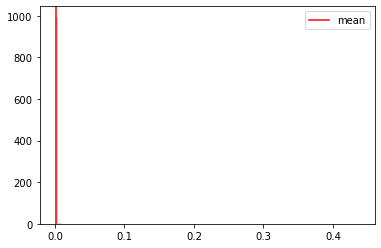

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654373140
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 1.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:07, 14.67it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:33, 10.61it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:56,  8.52it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:58,  8.32it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<02:03,  8.00it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<02:08,  7.70it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<02:11,  7.50it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<02:06,  7.79it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<02:07,  7.69it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<02:01,  8.06it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<02:02,  7.99it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<02:07,  7.66it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:36,  6.20it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:29,  6.47it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:04<02:29,  6.49it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:23,  6.74it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:28,  6.50it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:05<02:23,  6.72it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███                                                                             | 39/1000 [00:05<02:17,  6.99it/s]

Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:05<02:43,  5.88it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<02:40,  5.96it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:06<02:26,  6.51it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:06<02:16,  6.99it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:06<02:16,  6.96it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:07<02:27,  6.44it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:07<02:17,  6.88it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:07<02:15,  7.00it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:08<02:25,  6.48it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:08<02:19,  6.75it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:08<02:15,  6.93it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:08<02:26,  6.41it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:09<02:19,  6.71it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:09<02:08,  7.24it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:09<02:15,  6.85it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:10<02:27,  6.29it/s]

Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:10<02:26,  6.33it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:10<02:31,  6.11it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:10<02:22,  6.47it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:11<02:21,  6.52it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:11<02:07,  7.19it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:11<02:05,  7.30it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:11<02:07,  7.18it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:12<02:08,  7.13it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:12<02:10,  6.98it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:12<02:24,  6.28it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:13<02:19,  6.52it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:13<02:24,  6.29it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:13<02:23,  6.32it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:14<02:20,  6.40it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:14<02:20,  6.40it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:14<02:20,  6.38it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:15<02:24,  6.18it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:15<02:21,  6.32it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:15<02:14,  6.65it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:16<02:13,  6.66it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:16<02:15,  6.55it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:16<02:13,  6.64it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:16<02:16,  6.47it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:17<02:13,  6.61it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:17<02:17,  6.38it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:17<02:26,  6.00it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:18<02:20,  6.22it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:18<02:20,  6.20it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:18<02:18,  6.29it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:19<02:25,  5.98it/s]

Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:19<02:31,  5.74it/s]

Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:19<02:28,  5.84it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:19<02:22,  6.08it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:20<02:25,  5.95it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:20<02:26,  5.89it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:20<02:25,  5.90it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:21<02:36,  5.49it/s]

Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:21<02:36,  5.48it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:21<02:36,  5.46it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:22<02:38,  5.38it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:22<02:39,  5.34it/s]

Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:22<02:40,  5.28it/s]

Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:22<02:41,  5.26it/s]

Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:23<02:36,  5.42it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:23<02:33,  5.51it/s]

Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:23<02:37,  5.36it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:24<02:42,  5.17it/s]

Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:24<02:35,  5.41it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:24<02:28,  5.66it/s]

Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:24<02:26,  5.74it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:25<02:17,  6.10it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:25<02:15,  6.16it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████                                                                  | 166/1000 [00:25<02:20,  5.93it/s]

Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:26<02:39,  5.23it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:26<02:25,  5.71it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 171/1000 [00:26<02:22,  5.81it/s]

Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:26<02:24,  5.73it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:27<02:32,  5.42it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:27<02:26,  5.63it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:27<02:21,  5.81it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:28<02:15,  6.03it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:28<02:12,  6.15it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:28<02:24,  5.64it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:29<02:27,  5.52it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:29<02:24,  5.62it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:30<02:26,  5.52it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:30<02:21,  5.70it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:30<02:16,  5.90it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:31<02:14,  5.96it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:31<02:12,  6.02it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:31<02:19,  5.74it/s]

Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:31<02:18,  5.76it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:32<02:21,  5.63it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:32<02:19,  5.71it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:33<02:18,  5.71it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:33<02:15,  5.83it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:33<02:12,  5.97it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:34<02:11,  5.99it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:34<02:16,  5.75it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:34<02:24,  5.44it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:34<02:21,  5.51it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:35<02:22,  5.48it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:35<02:15,  5.75it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:35<02:14,  5.78it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:36<02:17,  5.65it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:36<02:12,  5.81it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:36<02:16,  5.66it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:37<02:10,  5.88it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:37<02:13,  5.74it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:37<02:17,  5.58it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:37<02:15,  5.63it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:38<02:11,  5.78it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:38<02:11,  5.79it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:38<02:08,  5.90it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:39<02:07,  5.92it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:39<02:12,  5.70it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:39<02:13,  5.65it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:39<02:15,  5.57it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:39<02:16,  5.52it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:40<02:16,  5.51it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:40<02:15,  5.51it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:40<02:13,  5.61it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:41<02:17,  5.41it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:41<02:17,  5.43it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:41<02:13,  5.55it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:41<02:14,  5.52it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:42<02:15,  5.47it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:42<02:17,  5.38it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:42<02:17,  5.36it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:43<02:17,  5.33it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:43<02:18,  5.28it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:43<02:18,  5.28it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:43<02:21,  5.16it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:43<02:24,  5.04it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:44<02:26,  4.96it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:44<02:26,  4.98it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:44<02:26,  4.96it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:44<02:22,  5.11it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:45<02:19,  5.18it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:45<02:18,  5.24it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:45<02:19,  5.20it/s]

Monte Carlo 276
Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:45<02:26,  4.92it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:46<02:29,  4.81it/s]

Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:46<02:30,  4.79it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:46<02:29,  4.80it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:46<02:25,  4.92it/s]

Monte Carlo 283
Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:47<02:26,  4.88it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:47<02:31,  4.70it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:48<02:28,  4.79it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:48<02:27,  4.80it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:48<02:27,  4.80it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:48<02:26,  4.82it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:49<02:23,  4.93it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:49<02:24,  4.89it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:49<02:19,  5.04it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:49<02:23,  4.90it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:50<02:22,  4.91it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:50<02:23,  4.89it/s]

Monte Carlo 299
Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:50<02:30,  4.65it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:50<02:35,  4.50it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:51<02:28,  4.69it/s]

Monte Carlo 303
Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:51<02:29,  4.64it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:51<02:32,  4.56it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:52<02:30,  4.61it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:52<02:27,  4.68it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:52<02:23,  4.79it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:52<02:22,  4.82it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:53<02:21,  4.85it/s]

Monte Carlo 312
Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:53<02:37,  4.34it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:53<02:33,  4.45it/s]

Monte Carlo 315
Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:54<02:32,  4.49it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:54<02:27,  4.62it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:54<02:24,  4.70it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:54<02:22,  4.76it/s]

Monte Carlo 320
Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:55<02:22,  4.77it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:55<02:21,  4.77it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:55<02:26,  4.62it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:55<02:29,  4.51it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:55<02:34,  4.36it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:56<02:37,  4.26it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:56<02:40,  4.19it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:56<02:29,  4.48it/s]

Monte Carlo 329
Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:57<02:27,  4.52it/s]

Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:57<02:23,  4.64it/s]

Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:57<02:17,  4.83it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:57<02:15,  4.92it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:58<02:12,  5.02it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:58<02:18,  4.79it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:58<02:17,  4.81it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:58<02:16,  4.82it/s]

Monte Carlo 339


 34%|██████████████████████████▉                                                    | 341/1000 [00:59<02:15,  4.88it/s]

Monte Carlo 340


 34%|███████████████████████████                                                    | 342/1000 [00:59<02:16,  4.82it/s]

Monte Carlo 341
Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:59<02:13,  4.90it/s]

Monte Carlo 343
Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:00<02:15,  4.85it/s]

Monte Carlo 345


 35%|███████████████████████████▍                                                   | 347/1000 [01:00<02:13,  4.89it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 348/1000 [01:00<02:13,  4.89it/s]

Monte Carlo 347


 35%|███████████████████████████▌                                                   | 349/1000 [01:00<02:12,  4.90it/s]

Monte Carlo 348


 35%|███████████████████████████▋                                                   | 350/1000 [01:01<02:13,  4.88it/s]

Monte Carlo 349
Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:01<02:14,  4.81it/s]

Monte Carlo 351


 35%|███████████████████████████▉                                                   | 353/1000 [01:01<02:13,  4.85it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 354/1000 [01:01<02:12,  4.86it/s]

Monte Carlo 353


 36%|████████████████████████████                                                   | 355/1000 [01:02<02:12,  4.86it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 356/1000 [01:02<02:11,  4.89it/s]

Monte Carlo 355


 36%|████████████████████████████▏                                                  | 357/1000 [01:02<02:10,  4.94it/s]

Monte Carlo 356


 36%|████████████████████████████▎                                                  | 358/1000 [01:02<02:10,  4.92it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 359/1000 [01:02<02:10,  4.91it/s]

Monte Carlo 358
Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:03<02:19,  4.58it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:03<02:20,  4.56it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:03<02:19,  4.56it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:03<02:19,  4.58it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:03<02:16,  4.67it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:04<02:16,  4.65it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:04<02:15,  4.67it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:04<02:15,  4.66it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:04<02:17,  4.61it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:05<02:18,  4.56it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:05<02:18,  4.56it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:05<02:18,  4.53it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:05<02:21,  4.43it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:05<02:20,  4.46it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:06<02:19,  4.49it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:06<02:17,  4.53it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:06<02:18,  4.50it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 378/1000 [01:07<02:16,  4.55it/s]

Monte Carlo 377
Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:07<02:25,  4.26it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:07<02:22,  4.35it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:07<02:21,  4.36it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:08<02:26,  4.22it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:08<02:26,  4.21it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:08<02:22,  4.31it/s]

Monte Carlo 384


 39%|██████████████████████████████▍                                                | 386/1000 [01:08<02:19,  4.41it/s]

Monte Carlo 385
Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:09<02:19,  4.39it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 389/1000 [01:09<02:13,  4.59it/s]

Monte Carlo 388
Monte Carlo 389


 39%|██████████████████████████████▉                                                | 391/1000 [01:10<02:12,  4.58it/s]

Monte Carlo 390
Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:10<02:15,  4.48it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:10<02:13,  4.56it/s]

Monte Carlo 393


 40%|███████████████████████████████▏                                               | 395/1000 [01:10<02:10,  4.64it/s]

Monte Carlo 394
Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:11<02:10,  4.62it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:11<02:17,  4.38it/s]

Monte Carlo 397


 40%|███████████████████████████████▌                                               | 399/1000 [01:11<02:13,  4.51it/s]

Monte Carlo 398
Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:12<02:16,  4.40it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:12<02:21,  4.24it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:12<02:18,  4.31it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:17,  4.33it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:13<02:21,  4.22it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:13<02:22,  4.18it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:13<02:18,  4.30it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:13<02:17,  4.30it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:21,  4.19it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:14<02:22,  4.15it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:14<02:24,  4.09it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:14<02:24,  4.08it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<02:21,  4.15it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:15<02:19,  4.20it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:15<02:26,  4.00it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:15<02:28,  3.94it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:22,  4.10it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:16<02:19,  4.18it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:16<02:20,  4.15it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:16<02:19,  4.17it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:16<02:19,  4.15it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:17<02:22,  4.07it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:17<02:22,  4.05it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:17<02:26,  3.94it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:25,  3.96it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:18<02:23,  4.02it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:18<02:19,  4.10it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:18<02:20,  4.07it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:21,  4.05it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:19<02:20,  4.05it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:19<02:20,  4.07it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:19<02:22,  4.00it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:18,  4.09it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:20<02:18,  4.09it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:20<02:19,  4.06it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:20<02:20,  4.03it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:27,  3.83it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:21<02:25,  3.86it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:21<02:24,  3.88it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:21<02:29,  3.76it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:23,  3.89it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:22<02:26,  3.82it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:22<02:22,  3.92it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:22<02:22,  3.91it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:22<02:24,  3.86it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:23<02:24,  3.85it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:23<02:20,  3.94it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:23<02:19,  3.95it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:23<02:18,  3.97it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:24<02:20,  3.92it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:24<02:21,  3.88it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:24,  3.80it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:25<02:29,  3.66it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:25<02:30,  3.64it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:25<02:24,  3.77it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:23,  3.81it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:26<02:20,  3.86it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:26<02:18,  3.92it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:26<02:26,  3.69it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:24,  3.74it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:27<02:27,  3.66it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:27<02:38,  3.39it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:41,  3.34it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:28<02:39,  3.37it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:28<02:35,  3.44it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:28<02:33,  3.49it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:29<02:34,  3.46it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:29<02:34,  3.45it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:29<02:50,  3.12it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:29<02:40,  3.30it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:30<02:35,  3.42it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:30<02:28,  3.55it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:30<02:25,  3.63it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:30<02:21,  3.73it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:31<02:20,  3.74it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:31<02:19,  3.76it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:31<02:20,  3.73it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:32<02:18,  3.78it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:32<02:17,  3.79it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:32<02:19,  3.73it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:32<02:18,  3.75it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:33<02:16,  3.80it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:33<02:16,  3.79it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:33<02:16,  3.80it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:33<02:13,  3.86it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:34<02:13,  3.85it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:34<02:13,  3.85it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:34<02:17,  3.74it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:34<02:14,  3.81it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:35<02:19,  3.66it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:35<02:21,  3.60it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:35<02:21,  3.60it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:36<02:24,  3.51it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:36<02:25,  3.49it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:36<02:20,  3.60it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:36<02:23,  3.52it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:37<02:21,  3.57it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:37<02:20,  3.58it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:37<02:16,  3.69it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:38<02:18,  3.61it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:38<02:17,  3.65it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:38<02:18,  3.61it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:38<02:21,  3.53it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:39<02:18,  3.58it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:39<02:14,  3.68it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:39<02:21,  3.50it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:40<02:22,  3.46it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:40<02:25,  3.39it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:40<02:27,  3.34it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:40<02:24,  3.39it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:41<02:22,  3.45it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:41<02:20,  3.48it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:41<02:17,  3.56it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:42<02:15,  3.58it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:42<02:16,  3.56it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:42<02:18,  3.49it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:42<02:19,  3.47it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:43<02:20,  3.43it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:43<02:16,  3.53it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:43<02:17,  3.51it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:44<02:17,  3.49it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:44<02:17,  3.49it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:44<02:15,  3.53it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:44<02:14,  3.54it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:45<02:12,  3.59it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:45<02:13,  3.55it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:45<02:12,  3.58it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:46<02:13,  3.55it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:46<02:11,  3.59it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:46<02:13,  3.52it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:46<02:14,  3.50it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:47<02:09,  3.62it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:47<02:08,  3.65it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:47<02:07,  3.67it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:47<02:04,  3.75it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:48<02:06,  3.68it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:48<02:05,  3.69it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:48<02:06,  3.65it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:49<02:06,  3.66it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:49<02:05,  3.67it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:49<02:05,  3.66it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:49<02:08,  3.58it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:50<02:09,  3.53it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:50<02:07,  3.57it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:50<02:07,  3.57it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:50<02:08,  3.54it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:51<02:09,  3.51it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:51<02:06,  3.57it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:51<02:12,  3.40it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:52<02:11,  3.42it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:52<02:12,  3.40it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:52<02:14,  3.33it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:53<02:14,  3.33it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:53<02:12,  3.37it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:53<02:11,  3.40it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:53<02:10,  3.40it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:54<02:10,  3.41it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:54<02:10,  3.40it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:54<02:11,  3.36it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:55<02:14,  3.27it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:55<02:14,  3.28it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:55<02:19,  3.15it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:56<02:18,  3.17it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:56<02:13,  3.28it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:56<02:14,  3.25it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:57<02:11,  3.31it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:57<02:09,  3.35it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:57<02:10,  3.31it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:57<02:10,  3.32it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:58<02:16,  3.15it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:58<02:12,  3.23it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:58<02:10,  3.29it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:59<02:12,  3.23it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:59<02:13,  3.19it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:59<02:15,  3.14it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:00<02:15,  3.14it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:00<02:12,  3.21it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:00<02:12,  3.19it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:01<02:11,  3.22it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:01<02:11,  3.20it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:01<02:10,  3.23it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:01<02:08,  3.27it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:02<02:07,  3.27it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:02<02:10,  3.20it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:02<02:11,  3.16it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:03<02:08,  3.22it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:03<02:06,  3.26it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:03<02:04,  3.31it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:04<02:03,  3.34it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:04<02:02,  3.34it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:04<02:07,  3.21it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:05<02:06,  3.22it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:05<02:12,  3.08it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:05<02:10,  3.13it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:06<02:11,  3.08it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:06<02:09,  3.12it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:06<02:12,  3.06it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:07<02:13,  3.02it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:07<02:13,  3.02it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:07<02:11,  3.05it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:08<02:15,  2.95it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:08<02:16,  2.92it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:08<02:13,  2.97it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:09<02:15,  2.93it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:09<02:12,  2.99it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:09<02:13,  2.95it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:10<02:10,  3.02it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:10<02:08,  3.06it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:10<02:09,  3.02it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:11<02:06,  3.10it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:11<02:08,  3.03it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:11<02:06,  3.07it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:12<02:18,  2.80it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:12<02:12,  2.92it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:12<02:11,  2.94it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:13<02:12,  2.91it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:13<02:09,  2.97it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:13<02:08,  2.97it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:14<02:05,  3.04it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:14<02:09,  2.95it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:14<02:07,  2.98it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:15<02:05,  3.01it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:15<02:02,  3.09it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:15<02:00,  3.14it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:16<02:01,  3.08it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:16<01:59,  3.13it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:16<02:00,  3.10it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:17<01:58,  3.14it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:17<01:59,  3.12it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:17<02:00,  3.09it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:17<01:59,  3.10it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:18<01:59,  3.08it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:18<01:58,  3.10it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:18<01:59,  3.08it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:19<02:02,  2.99it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:19<02:01,  3.00it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:19<02:01,  2.99it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:20<02:03,  2.95it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:20<02:02,  2.96it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:21<02:01,  2.97it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:21<01:59,  3.03it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:21<01:59,  3.01it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:21<01:59,  3.00it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:22<01:58,  3.00it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:22<01:56,  3.05it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:22<01:55,  3.07it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:23<01:57,  3.02it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:23<01:57,  3.01it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:23<01:55,  3.05it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:24<01:58,  2.95it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:24<01:59,  2.94it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:25<01:58,  2.96it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:25<01:55,  3.01it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:25<01:56,  2.99it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:25<01:55,  2.99it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:26<01:53,  3.05it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:26<01:53,  3.04it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:26<01:53,  3.01it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:27<01:56,  2.94it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:27<01:55,  2.96it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:28<01:54,  2.96it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:28<01:54,  2.97it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:28<01:56,  2.89it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:29<01:55,  2.93it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:29<01:53,  2.97it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:29<01:53,  2.96it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:30<01:56,  2.87it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:30<01:54,  2.90it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:30<01:54,  2.89it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:31<01:51,  2.97it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:31<01:50,  2.98it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:31<01:47,  3.06it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:32<01:47,  3.05it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:32<01:44,  3.12it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:32<01:48,  3.00it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:33<01:44,  3.10it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:33<01:47,  3.02it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:33<01:44,  3.10it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:34<01:45,  3.04it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:34<01:47,  2.99it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:34<01:49,  2.92it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:35<01:47,  2.96it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:35<01:47,  2.95it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:35<01:46,  2.97it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:36<01:43,  3.05it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:36<01:46,  2.95it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:36<01:47,  2.92it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:37<01:45,  2.97it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:37<01:44,  2.98it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:37<01:48,  2.86it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:38<01:47,  2.89it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:38<01:45,  2.93it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:38<01:44,  2.95it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:39<01:46,  2.88it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:39<01:45,  2.90it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:39<01:44,  2.92it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:40<01:45,  2.87it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:40<01:47,  2.83it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:40<01:51,  2.71it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:41<01:48,  2.78it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:41<01:46,  2.81it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:42<01:47,  2.78it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:42<01:46,  2.79it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:42<01:45,  2.81it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:43<01:45,  2.80it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:43<01:43,  2.84it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:43<01:43,  2.85it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:44<01:43,  2.84it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:44<01:43,  2.83it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:44<01:43,  2.81it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:45<01:43,  2.79it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:45<01:43,  2.79it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:45<01:44,  2.75it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:46<01:43,  2.78it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:46<01:43,  2.77it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:46<01:40,  2.85it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:47<01:39,  2.86it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:47<01:40,  2.81it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:48<01:39,  2.84it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:48<01:39,  2.82it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:48<01:40,  2.79it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:49<01:38,  2.82it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:49<01:36,  2.87it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:49<01:38,  2.80it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:50<01:37,  2.83it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:50<01:38,  2.80it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:50<01:37,  2.80it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:51<01:36,  2.83it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:51<01:35,  2.84it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:51<01:36,  2.82it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:52<01:36,  2.80it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:52<01:36,  2.79it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:53<01:34,  2.83it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:53<01:33,  2.85it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:53<01:36,  2.77it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:54<01:35,  2.77it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:54<01:44,  2.53it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:54<01:40,  2.61it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:55<01:38,  2.67it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:55<01:36,  2.71it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:55<01:34,  2.75it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:56<01:33,  2.77it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:56<01:33,  2.77it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:57<01:32,  2.78it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:57<01:32,  2.78it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:57<01:30,  2.82it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:58<01:29,  2.83it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:58<01:29,  2.83it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:58<01:29,  2.81it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:59<01:28,  2.85it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:59<01:28,  2.82it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:59<01:32,  2.69it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:00<01:33,  2.65it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:00<01:34,  2.60it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:01<01:30,  2.71it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:01<01:27,  2.80it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:01<01:27,  2.79it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:02<01:24,  2.87it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:02<01:23,  2.89it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:02<01:22,  2.91it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:03<01:22,  2.91it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:03<01:21,  2.93it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:03<01:21,  2.91it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:04<01:23,  2.82it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:04<01:23,  2.84it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:04<01:21,  2.88it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:05<01:23,  2.81it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:05<01:23,  2.80it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:05<01:24,  2.76it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:06<01:25,  2.70it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:06<01:26,  2.66it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:07<01:23,  2.76it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:07<01:21,  2.79it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:07<01:23,  2.71it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:08<01:22,  2.75it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:08<01:21,  2.78it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:08<01:20,  2.80it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:09<01:19,  2.81it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:09<01:19,  2.79it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:09<01:19,  2.78it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:10<01:18,  2.81it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:10<01:15,  2.88it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:10<01:15,  2.88it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:11<01:16,  2.84it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:11<01:15,  2.85it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:12<01:15,  2.84it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:12<01:15,  2.83it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:12<01:17,  2.76it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:13<01:16,  2.78it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:13<01:15,  2.81it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:13<01:13,  2.86it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:14<01:16,  2.74it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:14<01:16,  2.73it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:14<01:15,  2.76it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:15<01:14,  2.77it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:15<01:14,  2.76it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:15<01:12,  2.83it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:16<01:13,  2.77it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:16<01:13,  2.76it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:17<01:11,  2.81it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:17<01:12,  2.78it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:17<01:10,  2.80it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:18<01:10,  2.80it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:18<01:10,  2.78it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:18<01:09,  2.80it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:19<01:10,  2.76it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:19<01:09,  2.78it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:19<01:11,  2.72it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:20<01:10,  2.73it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:20<01:09,  2.76it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:21<01:07,  2.80it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:21<01:07,  2.79it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:21<01:07,  2.79it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:22<01:09,  2.67it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:22<01:09,  2.68it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:22<01:07,  2.74it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:23<01:07,  2.73it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:23<01:05,  2.79it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:24<01:07,  2.71it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:24<01:06,  2.74it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:24<01:06,  2.69it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:25<01:06,  2.68it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:25<01:08,  2.62it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:25<01:09,  2.56it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:26<01:08,  2.58it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:26<01:07,  2.58it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:27<01:08,  2.53it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:27<01:09,  2.48it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:27<01:08,  2.52it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:28<01:06,  2.57it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:28<01:05,  2.59it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:29<01:06,  2.56it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:29<01:05,  2.55it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:29<01:06,  2.50it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:30<01:05,  2.54it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:30<01:04,  2.56it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:31<01:04,  2.53it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:31<01:05,  2.48it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:31<01:06,  2.45it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:32<01:05,  2.46it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:32<01:04,  2.46it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:33<01:05,  2.43it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:33<01:05,  2.40it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:33<01:03,  2.45it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:34<01:02,  2.50it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:34<01:01,  2.54it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:35<01:00,  2.55it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:35<00:58,  2.59it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:35<01:03,  2.38it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:36<01:02,  2.43it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:36<01:00,  2.48it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:37<00:59,  2.49it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:37<01:01,  2.42it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:37<01:00,  2.44it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:38<01:00,  2.42it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:38<01:00,  2.41it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:39<01:00,  2.38it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:39<01:00,  2.35it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:40<01:01,  2.31it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:40<01:03,  2.24it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:41<01:03,  2.20it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:41<01:04,  2.17it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:42<01:02,  2.19it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:42<01:02,  2.19it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:42<01:02,  2.19it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:43<00:59,  2.27it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:43<00:57,  2.35it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:44<00:55,  2.39it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:44<00:55,  2.37it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:44<00:55,  2.37it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:45<00:54,  2.39it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:45<00:54,  2.38it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:46<00:52,  2.42it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:46<00:52,  2.42it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:47<00:51,  2.43it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:47<00:51,  2.43it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:47<00:50,  2.48it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:48<00:49,  2.47it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:48<00:49,  2.48it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:49<00:50,  2.41it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:49<00:50,  2.39it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:49<00:50,  2.36it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:50<00:49,  2.38it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:50<00:48,  2.39it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:51<00:47,  2.42it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:51<00:48,  2.39it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:52<00:47,  2.42it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:52<00:47,  2.40it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:52<00:46,  2.41it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:53<00:45,  2.43it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:53<00:46,  2.38it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:54<00:45,  2.40it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:54<00:45,  2.39it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:54<00:44,  2.42it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:55<00:43,  2.44it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:55<00:43,  2.40it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:56<00:43,  2.40it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:56<00:44,  2.33it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:57<00:43,  2.34it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:57<00:42,  2.35it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:57<00:42,  2.36it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:58<00:41,  2.36it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:58<00:41,  2.33it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:59<00:41,  2.35it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:59<00:40,  2.39it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:59<00:39,  2.41it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:00<00:39,  2.37it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:00<00:40,  2.32it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:01<00:39,  2.34it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:01<00:39,  2.31it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:02<00:37,  2.38it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:02<00:37,  2.38it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:02<00:37,  2.35it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:03<00:37,  2.35it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:03<00:36,  2.35it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:04<00:36,  2.35it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:04<00:35,  2.35it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:05<00:35,  2.33it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:05<00:34,  2.35it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:05<00:34,  2.35it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:06<00:34,  2.32it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:06<00:33,  2.32it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:07<00:33,  2.36it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:07<00:32,  2.39it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:08<00:32,  2.35it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:08<00:31,  2.38it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:08<00:31,  2.38it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:09<00:30,  2.39it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:09<00:30,  2.38it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:10<00:29,  2.37it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:10<00:29,  2.37it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:11<00:29,  2.33it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:11<00:29,  2.33it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:11<00:28,  2.34it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:12<00:28,  2.32it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:12<00:28,  2.30it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:13<00:27,  2.29it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:13<00:27,  2.26it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:14<00:27,  2.25it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:14<00:27,  2.23it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:15<00:26,  2.24it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:15<00:26,  2.19it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:15<00:26,  2.21it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:16<00:25,  2.22it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:16<00:27,  2.06it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:17<00:25,  2.12it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:17<00:25,  2.14it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:18<00:24,  2.18it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:18<00:23,  2.22it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:19<00:22,  2.24it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:19<00:21,  2.32it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:19<00:20,  2.37it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:20<00:20,  2.36it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:20<00:19,  2.39it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:21<00:18,  2.43it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:21<00:18,  2.45it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:21<00:17,  2.47it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:22<00:17,  2.43it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:22<00:17,  2.40it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:23<00:17,  2.35it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:23<00:17,  2.35it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:24<00:16,  2.35it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:24<00:16,  2.36it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:24<00:15,  2.38it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:25<00:15,  2.36it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:25<00:14,  2.40it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:26<00:14,  2.39it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:26<00:13,  2.38it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:27<00:13,  2.32it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:27<00:13,  2.31it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:27<00:12,  2.35it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:28<00:12,  2.36it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:28<00:11,  2.37it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:29<00:11,  2.40it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:29<00:11,  2.36it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:30<00:10,  2.40it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:30<00:09,  2.41it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:30<00:09,  2.34it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:31<00:09,  2.37it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:31<00:08,  2.34it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:32<00:08,  2.36it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:32<00:07,  2.39it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:32<00:07,  2.41it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:33<00:07,  2.39it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:33<00:06,  2.41it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:34<00:06,  2.43it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:34<00:05,  2.43it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:35<00:05,  2.41it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:35<00:04,  2.42it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:35<00:04,  2.38it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:36<00:04,  2.41it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:36<00:03,  2.37it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:37<00:03,  2.38it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:37<00:02,  2.39it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:37<00:02,  2.38it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:38<00:02,  2.35it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:38<00:01,  2.36it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:39<00:01,  2.37it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:39<00:00,  2.36it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:40<00:00,  2.34it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:40<00:00,  3.56it/s]


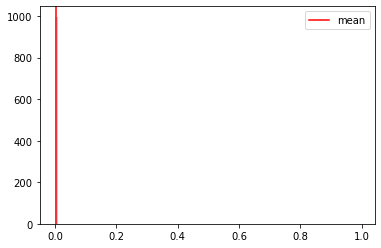

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654373422
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 1.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▍                                                                                | 5/1000 [00:00<01:20, 12.37it/s]

Monte Carlo 3
Monte Carlo 4
Monte Carlo 5
Monte Carlo 6


  1%|▌                                                                                | 7/1000 [00:00<01:37, 10.22it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▋                                                                                | 9/1000 [00:00<01:40,  9.85it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:46,  9.25it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:47,  9.17it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:55,  8.51it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<02:03,  7.94it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:55,  8.46it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:52,  8.69it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:50,  8.85it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:50,  8.80it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:00,  8.08it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▎                                                                             | 29/1000 [00:03<02:20,  6.91it/s]

Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:34,  6.27it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<02:18,  6.98it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<02:07,  7.55it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:02,  7.85it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<02:10,  7.37it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<01:58,  8.06it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<02:00,  7.96it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:55,  8.25it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:01,  7.81it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:56,  8.15it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<01:55,  8.25it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<01:58,  8.00it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:00,  7.86it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<01:58,  7.94it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<01:57,  8.01it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:03,  7.62it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<01:59,  7.84it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<02:05,  7.44it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:06,  7.36it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:05,  7.45it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:14,  6.90it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:11,  7.03it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:07,  7.26it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:03,  7.48it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:01,  7.56it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:03,  7.47it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:06,  7.28it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:09,  7.06it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:14,  6.77it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:10,  6.96it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:19,  6.53it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:18,  6.56it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:15,  6.67it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:15,  6.65it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:17,  6.57it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:12,  6.76it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:16,  6.59it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:19,  6.44it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:18,  6.43it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:19,  6.41it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:26,  6.06it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<02:26,  6.07it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:39,  5.54it/s]

Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:15<02:38,  5.59it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:15<02:29,  5.89it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:16<02:31,  5.80it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:16<02:30,  5.85it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:16<02:21,  6.18it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:17<02:21,  6.18it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:17<02:16,  6.40it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:17<02:21,  6.13it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:18<02:25,  5.95it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:18<02:44,  5.28it/s]

Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:39,  5.42it/s]

Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:19<02:33,  5.62it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:19<02:22,  6.06it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:19<02:26,  5.86it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:20<02:14,  6.36it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:20<02:18,  6.17it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:20<02:13,  6.40it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:20<02:13,  6.40it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:21<02:12,  6.44it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:21<02:11,  6.43it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:21<02:20,  6.02it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▏                                                                  | 155/1000 [00:22<02:20,  6.02it/s]

Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:22<02:43,  5.14it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:29,  5.61it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:23<02:18,  6.06it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:23<02:17,  6.10it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:23<02:17,  6.05it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:24<02:22,  5.83it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:24<02:32,  5.43it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:25<02:38,  5.23it/s]

Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:25<02:30,  5.51it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:25<02:32,  5.41it/s]

Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:25<02:32,  5.41it/s]

Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:25<02:34,  5.33it/s]

Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:26<02:27,  5.59it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:26<02:24,  5.67it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:26<02:24,  5.68it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:26<02:17,  5.96it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:27<02:22,  5.71it/s]

Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:27<02:26,  5.55it/s]

Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:27<02:22,  5.70it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:27<02:16,  5.96it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:28<02:22,  5.69it/s]

Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:28<02:25,  5.57it/s]

Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:28<02:25,  5.54it/s]

Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:28<02:22,  5.66it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:29<02:29,  5.40it/s]

Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:29<02:23,  5.60it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:29<02:23,  5.58it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:30<02:25,  5.51it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:30<02:23,  5.57it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:30<02:18,  5.73it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:30<02:17,  5.79it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:31<02:19,  5.69it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:31<02:16,  5.80it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:32<02:20,  5.63it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:32<02:18,  5.67it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:32<02:17,  5.72it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:33<02:23,  5.46it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:33<02:24,  5.42it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:33<02:20,  5.56it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:33<02:28,  5.24it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:34<02:27,  5.28it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:34<02:24,  5.38it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▋                                                             | 224/1000 [00:34<02:25,  5.33it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:34<02:28,  5.20it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:35<02:23,  5.38it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:35<02:18,  5.55it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:35<02:23,  5.35it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:36<02:20,  5.47it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:36<02:25,  5.27it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:36<02:21,  5.41it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:37<02:18,  5.51it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:37<02:15,  5.63it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:37<02:16,  5.56it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:38<02:29,  5.07it/s]

Monte Carlo 243
Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:38<02:24,  5.23it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 247/1000 [00:38<02:23,  5.25it/s]

Monte Carlo 247


 25%|███████████████████▌                                                           | 248/1000 [00:39<02:37,  4.78it/s]

Monte Carlo 248


 25%|███████████████████▋                                                           | 249/1000 [00:39<02:48,  4.47it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 250/1000 [00:39<02:52,  4.35it/s]

Monte Carlo 250


 25%|███████████████████▊                                                           | 251/1000 [00:39<02:54,  4.29it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 252/1000 [00:40<02:55,  4.25it/s]

Monte Carlo 252


 25%|███████████████████▉                                                           | 253/1000 [00:40<02:54,  4.29it/s]

Monte Carlo 253


 25%|████████████████████                                                           | 254/1000 [00:40<02:53,  4.29it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:40<02:47,  4.43it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▎                                                          | 257/1000 [00:41<02:51,  4.34it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 258/1000 [00:41<02:49,  4.38it/s]

Monte Carlo 258


 26%|████████████████████▍                                                          | 259/1000 [00:41<02:50,  4.36it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:42<02:39,  4.62it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▋                                                          | 262/1000 [00:42<02:46,  4.43it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 263/1000 [00:42<02:46,  4.41it/s]

Monte Carlo 263


 26%|████████████████████▊                                                          | 264/1000 [00:42<02:49,  4.33it/s]

Monte Carlo 264


 26%|████████████████████▉                                                          | 265/1000 [00:42<02:45,  4.44it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 266/1000 [00:43<02:45,  4.43it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:43<02:38,  4.62it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 269/1000 [00:43<02:46,  4.39it/s]

Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:44<02:51,  4.26it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 271/1000 [00:44<02:48,  4.32it/s]

Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:44<02:50,  4.27it/s]

Monte Carlo 272


 27%|█████████████████████▌                                                         | 273/1000 [00:44<02:46,  4.36it/s]

Monte Carlo 273


 27%|█████████████████████▋                                                         | 274/1000 [00:45<02:44,  4.41it/s]

Monte Carlo 274


 28%|█████████████████████▋                                                         | 275/1000 [00:45<02:43,  4.44it/s]

Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:45<02:41,  4.47it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 277/1000 [00:45<03:13,  3.73it/s]

Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:46<03:05,  3.88it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:46<03:03,  3.93it/s]

Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:46<02:53,  4.14it/s]

Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:46<02:50,  4.21it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:47<02:46,  4.31it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:47<02:43,  4.37it/s]

Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:47<02:43,  4.38it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:47<02:43,  4.37it/s]

Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:48<02:39,  4.46it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:48<02:38,  4.48it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:48<02:41,  4.40it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:48<02:44,  4.30it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:49<02:41,  4.39it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:49<02:44,  4.30it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:49<02:40,  4.42it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:49<02:42,  4.33it/s]

Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:49<02:43,  4.31it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:50<02:48,  4.18it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:50<02:56,  3.98it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:50<02:49,  4.14it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:50<02:53,  4.03it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:51<02:49,  4.13it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:51<02:54,  4.00it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:51<02:51,  4.06it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:51<02:46,  4.19it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:52<02:44,  4.22it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:52<02:47,  4.16it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:52<02:40,  4.32it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:52<02:37,  4.41it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:53<02:34,  4.49it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:53<02:32,  4.53it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:53<02:31,  4.56it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:53<02:35,  4.42it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:53<02:36,  4.40it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:54<02:42,  4.22it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:54<02:41,  4.26it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:54<02:38,  4.31it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:54<02:43,  4.19it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:55<02:43,  4.19it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:55<02:44,  4.14it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:55<02:38,  4.30it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:55<02:36,  4.34it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:56<02:41,  4.19it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:56<02:41,  4.19it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:56<02:45,  4.09it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:56<02:45,  4.08it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:57<02:46,  4.05it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:57<02:49,  3.99it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:57<02:50,  3.96it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:57<02:56,  3.81it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:58<02:55,  3.83it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:58<02:51,  3.91it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:58<02:50,  3.92it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:58<02:51,  3.89it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:59<02:45,  4.03it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:59<02:43,  4.08it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:59<02:49,  3.91it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:59<02:50,  3.89it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [01:00<02:49,  3.91it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [01:00<02:43,  4.06it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [01:00<02:37,  4.20it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [01:00<02:34,  4.26it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [01:01<02:37,  4.18it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [01:01<02:37,  4.18it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [01:01<02:41,  4.08it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [01:01<02:44,  4.00it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:02<03:02,  3.59it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:02<02:54,  3.75it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:02<02:51,  3.81it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:02<02:57,  3.67it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:03<03:02,  3.56it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:03<02:56,  3.69it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:03<02:58,  3.64it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:04<02:58,  3.63it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:04<02:48,  3.84it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:04<02:45,  3.89it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:04<02:45,  3.89it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:05<02:46,  3.86it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:05<02:49,  3.80it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:05<02:50,  3.76it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:05<02:48,  3.81it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:06<02:45,  3.88it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:06<02:48,  3.79it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:06<02:45,  3.86it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:06<02:40,  3.98it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:07<02:38,  4.01it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:07<02:42,  3.92it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:07<02:43,  3.87it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:07<02:46,  3.81it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:08<02:36,  4.03it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:08<02:31,  4.17it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:08<02:31,  4.16it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:08<02:33,  4.10it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:09<02:32,  4.11it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:09<02:33,  4.10it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:09<02:33,  4.07it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:09<02:33,  4.07it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:10<02:32,  4.09it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:10<02:30,  4.14it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:10<02:35,  4.00it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:10<02:33,  4.05it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:11<02:29,  4.16it/s]

Monte Carlo 380


 38%|██████████████████████████████▏                                                | 382/1000 [01:11<02:24,  4.28it/s]

Monte Carlo 381
Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:11<02:22,  4.32it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:11<02:24,  4.26it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:12<02:21,  4.34it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:12<02:23,  4.27it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:12<02:20,  4.36it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:12<02:20,  4.37it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:13<02:17,  4.44it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:13<02:21,  4.32it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:13<02:20,  4.33it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:13<02:24,  4.22it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:14<02:33,  3.96it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:14<02:28,  4.08it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:14<02:26,  4.14it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:14<02:23,  4.22it/s]

Monte Carlo 396


 40%|███████████████████████████████▍                                               | 398/1000 [01:15<02:20,  4.27it/s]

Monte Carlo 397
Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:15<02:20,  4.28it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:15<02:43,  3.68it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:16<02:34,  3.87it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:16<02:29,  4.01it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:16<02:24,  4.12it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:16<02:23,  4.17it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:17<02:19,  4.27it/s]

Monte Carlo 405


 41%|████████████████████████████████▏                                              | 407/1000 [01:17<02:16,  4.35it/s]

Monte Carlo 406
Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:17<02:17,  4.30it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:17<02:19,  4.25it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 411/1000 [01:18<02:15,  4.35it/s]

Monte Carlo 410
Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:18<02:19,  4.21it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:18<02:23,  4.09it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:19<02:19,  4.21it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:19<02:19,  4.19it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:19<02:23,  4.08it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:19<02:20,  4.15it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:20<02:19,  4.18it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:20<02:18,  4.21it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:20<02:18,  4.18it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:20<02:24,  4.00it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:21<02:21,  4.08it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:21<02:23,  4.02it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:21<02:25,  3.97it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:21<02:26,  3.93it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:22<02:22,  4.03it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:22<02:19,  4.10it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:22<02:19,  4.11it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:22<02:17,  4.15it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:23<02:16,  4.17it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:23<02:19,  4.09it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:23<02:14,  4.22it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:23<02:16,  4.14it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:24<02:14,  4.20it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:24<02:21,  4.00it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:24<02:22,  3.96it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:24<02:21,  3.99it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:25<02:17,  4.08it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:25<02:14,  4.18it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:25<02:13,  4.19it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:25<02:13,  4.19it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:25<02:16,  4.09it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:26<02:13,  4.19it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:26<02:14,  4.14it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:26<02:17,  4.04it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:26<02:18,  3.99it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:27<02:22,  3.89it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:27<02:24,  3.82it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:27<02:21,  3.89it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:28<02:18,  3.97it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:28<02:18,  3.95it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:28<02:16,  4.03it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:28<02:20,  3.90it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:29<02:21,  3.87it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:29<02:18,  3.93it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:29<02:17,  3.97it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:29<02:20,  3.86it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:30<02:18,  3.90it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:30<02:16,  3.98it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:30<02:12,  4.08it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:30<02:14,  4.02it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:31<02:13,  4.02it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:31<02:21,  3.79it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:31<02:20,  3.82it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:31<02:22,  3.76it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:32<02:22,  3.75it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:32<02:26,  3.63it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:32<02:25,  3.67it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:32<02:28,  3.58it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:33<02:31,  3.50it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:33<02:31,  3.48it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:33<02:29,  3.54it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:34<02:28,  3.55it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:34<02:27,  3.56it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:34<02:27,  3.57it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:34<02:28,  3.52it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:35<02:26,  3.56it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:35<02:27,  3.53it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:35<02:25,  3.57it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:36<02:24,  3.60it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:36<02:24,  3.59it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:36<02:22,  3.63it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:36<02:21,  3.64it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:37<02:19,  3.71it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:37<02:20,  3.67it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:37<02:22,  3.60it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:38<02:21,  3.63it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:38<02:25,  3.51it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:38<02:24,  3.53it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:38<02:27,  3.45it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:39<02:29,  3.41it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:39<02:27,  3.45it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:39<02:29,  3.39it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:40<02:31,  3.33it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:40<02:33,  3.29it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:40<02:37,  3.21it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:41<02:35,  3.24it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:41<02:34,  3.24it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:41<02:36,  3.20it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:42<02:39,  3.13it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:42<02:41,  3.08it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:42<02:41,  3.08it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:43<02:41,  3.07it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:43<02:41,  3.08it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:43<02:39,  3.11it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:43<02:42,  3.04it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:44<02:44,  2.99it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:44<02:48,  2.93it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:45<02:47,  2.93it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:45<02:47,  2.92it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:45<02:51,  2.84it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:46<02:54,  2.79it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:46<02:53,  2.80it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:46<02:59,  2.70it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:47<02:56,  2.75it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:47<02:45,  2.92it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:47<02:40,  3.00it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:48<02:33,  3.13it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:48<02:28,  3.23it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:48<02:22,  3.36it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:48<02:23,  3.34it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:49<02:20,  3.40it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:49<02:21,  3.37it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:49<02:23,  3.31it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:50<02:21,  3.36it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:50<02:24,  3.28it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:50<02:23,  3.29it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:51<02:26,  3.22it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:51<02:30,  3.14it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:51<02:28,  3.16it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:52<02:45,  2.83it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:52<02:39,  2.93it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:52<02:36,  2.99it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:53<02:37,  2.97it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:53<02:31,  3.07it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:53<02:26,  3.16it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:54<02:29,  3.09it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:54<02:25,  3.17it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:54<02:23,  3.22it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:55<02:25,  3.16it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:55<02:23,  3.20it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:55<02:22,  3.21it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:55<02:24,  3.17it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:56<02:27,  3.09it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:56<02:22,  3.19it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:56<02:19,  3.25it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:57<02:22,  3.19it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:57<02:19,  3.24it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:57<02:18,  3.24it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:58<02:20,  3.19it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:58<02:20,  3.20it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:58<02:17,  3.27it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:59<02:17,  3.24it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:59<02:18,  3.23it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:59<02:19,  3.18it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [02:00<02:18,  3.21it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [02:00<02:17,  3.22it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [02:00<02:18,  3.20it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [02:00<02:19,  3.16it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [02:01<02:20,  3.14it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [02:01<02:16,  3.22it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [02:01<02:14,  3.26it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [02:02<02:14,  3.26it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [02:02<02:11,  3.31it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [02:02<02:12,  3.28it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [02:03<02:15,  3.19it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:03<02:18,  3.14it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:03<02:15,  3.18it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:04<02:14,  3.21it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:04<02:13,  3.21it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:04<02:15,  3.17it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:05<02:19,  3.07it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:05<02:16,  3.12it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:05<02:19,  3.06it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:06<02:20,  3.03it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:06<02:17,  3.08it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:06<02:15,  3.13it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:06<02:15,  3.12it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:07<02:12,  3.17it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:07<02:11,  3.20it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:07<02:10,  3.22it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:08<02:09,  3.22it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:08<02:10,  3.20it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:08<02:12,  3.13it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:09<02:14,  3.09it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:09<02:14,  3.08it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:09<02:12,  3.12it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:10<02:14,  3.07it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:10<02:11,  3.12it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:10<02:12,  3.09it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:11<02:11,  3.12it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:11<02:11,  3.10it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:11<02:08,  3.16it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:12<02:07,  3.17it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:12<02:06,  3.20it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:12<02:07,  3.17it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:13<02:08,  3.14it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:13<02:10,  3.07it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:13<02:13,  3.00it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:14<02:12,  3.02it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:14<02:13,  2.98it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:14<02:09,  3.06it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:15<02:10,  3.04it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:15<02:12,  3.00it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:15<02:08,  3.07it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:15<02:07,  3.10it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:16<02:11,  2.99it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:16<02:07,  3.08it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:16<02:08,  3.04it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:17<02:11,  2.97it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:17<02:05,  3.09it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:17<02:04,  3.13it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:18<02:01,  3.18it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:18<01:59,  3.23it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:18<01:59,  3.23it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:19<01:57,  3.26it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:19<01:58,  3.24it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:19<01:58,  3.22it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:20<01:58,  3.21it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:20<01:56,  3.26it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:20<01:57,  3.23it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:21<01:58,  3.20it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:21<01:57,  3.21it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:21<01:58,  3.17it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:22<02:00,  3.11it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:22<01:59,  3.12it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:22<01:58,  3.15it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:22<01:58,  3.13it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:23<02:00,  3.07it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:23<01:59,  3.10it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:23<01:59,  3.08it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:24<02:01,  3.02it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:24<02:03,  2.98it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:24<02:00,  3.04it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:25<02:02,  2.98it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:25<02:03,  2.95it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:25<02:04,  2.92it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:26<02:03,  2.93it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:26<02:03,  2.93it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:27<02:02,  2.93it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:27<02:04,  2.89it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:27<02:01,  2.95it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:28<02:13,  2.67it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:28<02:09,  2.76it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:28<02:06,  2.80it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:29<02:04,  2.84it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:29<02:03,  2.85it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:29<02:02,  2.87it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:30<02:02,  2.88it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:30<02:04,  2.80it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:30<02:00,  2.88it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:31<02:02,  2.84it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:31<01:58,  2.92it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:31<02:00,  2.86it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:32<02:00,  2.86it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:32<01:57,  2.92it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:32<01:56,  2.94it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:33<01:54,  2.98it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:33<01:56,  2.92it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:34<01:56,  2.92it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:34<01:56,  2.91it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:34<01:57,  2.87it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:35<01:57,  2.87it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:35<01:55,  2.91it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:35<01:56,  2.88it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:36<01:54,  2.91it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:36<01:54,  2.90it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:36<01:52,  2.95it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:37<01:52,  2.94it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:37<01:54,  2.89it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:37<01:54,  2.87it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:38<01:53,  2.88it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:38<01:53,  2.88it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:38<01:51,  2.93it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:39<01:48,  2.98it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:39<01:49,  2.96it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:39<01:47,  3.00it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:40<01:50,  2.91it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:40<01:47,  2.99it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:40<01:45,  3.02it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:41<01:48,  2.95it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:41<01:45,  3.00it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:41<01:48,  2.93it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:42<01:49,  2.89it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:42<01:48,  2.89it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:42<01:48,  2.90it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:43<01:48,  2.90it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:43<01:46,  2.92it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:43<01:45,  2.94it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:44<01:45,  2.93it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:44<01:45,  2.94it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:44<01:46,  2.89it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:45<01:46,  2.87it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:45<01:46,  2.88it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:46<01:51,  2.74it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:46<01:49,  2.77it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:46<01:49,  2.76it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:47<01:47,  2.81it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:47<01:50,  2.73it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:47<01:48,  2.75it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:48<01:47,  2.78it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:48<01:47,  2.76it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:48<01:47,  2.75it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:49<01:45,  2.80it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:49<01:44,  2.81it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:50<01:45,  2.78it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:50<01:46,  2.74it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:50<01:43,  2.81it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:51<01:41,  2.86it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:51<01:41,  2.86it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:51<01:40,  2.88it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:52<01:39,  2.89it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:52<01:36,  2.96it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:52<01:38,  2.92it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:53<01:40,  2.83it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:53<01:38,  2.89it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:53<01:36,  2.92it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:54<01:37,  2.91it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:54<01:37,  2.89it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:54<01:36,  2.89it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:55<01:36,  2.90it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:55<01:35,  2.92it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:55<01:35,  2.91it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:56<01:35,  2.90it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:56<01:34,  2.92it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:56<01:35,  2.86it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:57<01:36,  2.84it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:57<01:36,  2.83it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:58<01:38,  2.74it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:58<01:39,  2.70it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:58<01:39,  2.71it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:59<01:38,  2.73it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:59<01:38,  2.70it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:59<01:37,  2.74it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [03:00<01:38,  2.69it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [03:00<01:37,  2.71it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [03:00<01:36,  2.73it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [03:01<01:36,  2.72it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:01<01:34,  2.75it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:02<01:35,  2.71it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:02<01:38,  2.63it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:02<01:32,  2.78it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:03<01:31,  2.82it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:03<01:29,  2.86it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:03<01:28,  2.87it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:04<01:28,  2.86it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:04<01:26,  2.91it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:04<01:27,  2.88it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:05<01:27,  2.88it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:05<01:25,  2.91it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:05<01:25,  2.90it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:06<01:27,  2.84it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:06<01:27,  2.81it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:07<01:28,  2.78it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:07<01:28,  2.78it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:07<01:26,  2.81it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:08<01:27,  2.78it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:08<01:27,  2.77it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:08<01:28,  2.72it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:09<01:28,  2.73it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:09<01:29,  2.68it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:09<01:30,  2.63it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:10<01:31,  2.59it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:10<01:30,  2.61it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:11<01:29,  2.63it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:11<01:28,  2.63it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:11<01:27,  2.66it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:12<01:27,  2.66it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:12<01:35,  2.43it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:13<01:30,  2.53it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:13<01:27,  2.60it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:13<01:28,  2.59it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:14<01:27,  2.58it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:14<01:26,  2.62it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:15<01:27,  2.56it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:15<01:26,  2.60it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:15<01:24,  2.63it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:16<01:25,  2.60it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:16<01:24,  2.60it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:16<01:23,  2.63it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:17<01:23,  2.62it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:17<01:25,  2.56it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:18<01:26,  2.51it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:18<01:27,  2.48it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:18<01:28,  2.44it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:19<01:27,  2.43it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:19<01:26,  2.48it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:20<01:25,  2.48it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:20<01:25,  2.48it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:20<01:22,  2.53it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:21<01:22,  2.52it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:21<01:21,  2.55it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:22<01:22,  2.50it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:22<01:20,  2.56it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:22<01:19,  2.57it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:23<01:19,  2.58it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:23<01:17,  2.63it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:24<01:18,  2.56it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:24<01:17,  2.58it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:24<01:17,  2.57it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:25<01:19,  2.49it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:25<01:19,  2.50it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:26<01:18,  2.51it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:26<01:17,  2.53it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:26<01:16,  2.56it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:27<01:16,  2.52it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:27<01:15,  2.54it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:28<01:15,  2.53it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:28<01:14,  2.56it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:28<01:14,  2.56it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:29<01:16,  2.48it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:29<01:15,  2.48it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:30<01:17,  2.43it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:30<01:16,  2.43it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:30<01:14,  2.47it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:31<01:14,  2.49it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:31<01:13,  2.51it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:32<01:12,  2.52it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:32<01:12,  2.49it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:32<01:15,  2.40it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:33<01:14,  2.41it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:33<01:13,  2.43it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:34<01:13,  2.40it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:34<01:12,  2.44it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:34<01:11,  2.46it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:35<01:11,  2.45it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:35<01:09,  2.50it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:36<01:09,  2.48it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:36<01:08,  2.50it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:36<01:07,  2.52it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:37<01:08,  2.47it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:37<01:08,  2.45it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:38<01:07,  2.46it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:38<01:06,  2.48it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:38<01:05,  2.51it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:39<01:07,  2.44it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:39<01:06,  2.46it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:40<01:07,  2.41it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:40<01:06,  2.40it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:41<01:05,  2.46it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:41<01:05,  2.42it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:41<01:05,  2.41it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:42<01:04,  2.43it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:42<01:03,  2.45it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:43<01:02,  2.48it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:43<01:02,  2.48it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:43<01:01,  2.50it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:44<01:00,  2.50it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:44<01:01,  2.46it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:45<01:01,  2.44it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:45<01:03,  2.35it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:45<01:02,  2.37it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:46<01:00,  2.41it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:46<01:00,  2.41it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:47<01:00,  2.40it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:47<01:00,  2.38it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:48<00:58,  2.44it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:48<00:57,  2.46it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:48<00:58,  2.39it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:49<00:58,  2.38it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:49<00:58,  2.38it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:50<00:57,  2.40it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:50<00:57,  2.39it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:50<00:57,  2.38it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:51<00:56,  2.41it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:51<00:56,  2.36it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:52<00:55,  2.38it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:52<00:56,  2.35it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:53<00:54,  2.38it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:53<00:55,  2.35it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:53<00:54,  2.35it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:54<00:54,  2.37it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:54<00:52,  2.42it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:55<00:52,  2.42it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:55<00:51,  2.43it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:55<00:50,  2.44it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:56<00:50,  2.45it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:56<00:51,  2.35it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:57<00:52,  2.29it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:57<00:51,  2.34it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:58<00:53,  2.22it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:58<00:51,  2.30it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:59<00:50,  2.32it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:59<00:49,  2.36it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:59<00:49,  2.35it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [04:00<00:48,  2.35it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [04:00<00:47,  2.40it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [04:01<00:46,  2.41it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [04:01<00:46,  2.40it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [04:01<00:45,  2.42it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:02<00:44,  2.45it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:02<00:43,  2.48it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:03<00:42,  2.49it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:03<00:41,  2.55it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:03<00:41,  2.53it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:04<00:41,  2.49it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:04<00:41,  2.50it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:05<00:40,  2.54it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:05<00:40,  2.52it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:05<00:40,  2.49it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:06<00:40,  2.47it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:06<00:39,  2.49it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:07<00:39,  2.49it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:07<00:38,  2.50it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:07<00:37,  2.53it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:08<00:37,  2.49it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:08<00:38,  2.44it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:09<00:37,  2.47it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:09<00:36,  2.49it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:09<00:35,  2.51it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:10<00:35,  2.52it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:10<00:34,  2.53it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:11<00:34,  2.50it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:11<00:34,  2.49it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:11<00:34,  2.48it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:12<00:33,  2.48it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:12<00:33,  2.49it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:13<00:33,  2.46it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:13<00:32,  2.47it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:13<00:32,  2.44it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:14<00:32,  2.44it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:14<00:31,  2.44it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:15<00:32,  2.39it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:15<00:32,  2.37it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:16<00:32,  2.31it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:16<00:32,  2.30it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:16<00:31,  2.29it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:17<00:31,  2.30it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:17<00:30,  2.32it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:18<00:30,  2.30it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:18<00:29,  2.33it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:19<00:29,  2.30it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:19<00:28,  2.31it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:20<00:28,  2.29it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:20<00:27,  2.32it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:20<00:27,  2.33it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:21<00:27,  2.29it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:21<00:27,  2.30it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:22<00:26,  2.28it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:22<00:27,  2.20it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:23<00:26,  2.22it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:23<00:25,  2.26it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:24<00:25,  2.25it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:24<00:24,  2.28it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:24<00:24,  2.29it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:25<00:23,  2.27it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:25<00:23,  2.28it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:26<00:22,  2.27it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:26<00:22,  2.26it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:27<00:21,  2.29it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:27<00:21,  2.26it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:27<00:21,  2.27it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:28<00:20,  2.26it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:28<00:20,  2.29it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:29<00:19,  2.27it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:29<00:19,  2.23it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:30<00:19,  2.21it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:30<00:18,  2.23it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:31<00:18,  2.22it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:31<00:18,  2.22it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:31<00:17,  2.22it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:32<00:16,  2.25it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:32<00:16,  2.26it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:33<00:15,  2.27it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:33<00:15,  2.25it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:34<00:15,  2.24it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:34<00:14,  2.25it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:35<00:15,  2.08it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:35<00:14,  2.13it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:36<00:14,  2.08it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:36<00:13,  2.08it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:37<00:13,  2.11it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:37<00:12,  2.16it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:38<00:12,  2.15it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:38<00:11,  2.21it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:38<00:10,  2.20it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:39<00:10,  2.21it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:39<00:09,  2.22it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:40<00:09,  2.17it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:40<00:09,  2.16it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:41<00:08,  2.13it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:41<00:08,  2.13it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:42<00:07,  2.15it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:42<00:07,  2.18it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:43<00:06,  2.19it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:43<00:06,  2.19it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:43<00:05,  2.18it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:44<00:05,  2.20it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:44<00:05,  2.18it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:45<00:04,  2.16it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:45<00:04,  2.16it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:46<00:03,  2.15it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:46<00:03,  2.17it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:47<00:02,  2.18it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:47<00:02,  2.17it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:48<00:01,  2.20it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:48<00:01,  2.19it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:49<00:00,  2.11it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:49<00:00,  2.17it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:49<00:00,  3.45it/s]


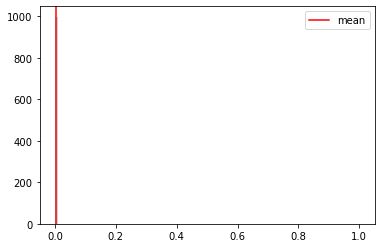

  0%|▏                                                                                | 2/1000 [00:00<01:01, 16.30it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654373712
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 1.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:59,  8.32it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:56,  8.50it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:57,  8.44it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:56,  8.48it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 11/1000 [00:01<01:52,  8.76it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:45,  9.38it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:48,  9.03it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▌                                                                              | 19/1000 [00:02<01:43,  9.52it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:48,  9.07it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 23/1000 [00:02<01:47,  9.12it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:46,  9.17it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:55,  8.46it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:00,  8.05it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:08,  7.55it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:02,  7.93it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<02:02,  7.86it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<01:58,  8.12it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:58,  8.15it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<02:00,  7.97it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 41/1000 [00:04<02:02,  7.86it/s]

Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<02:27,  6.50it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:08,  7.42it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:03,  7.73it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<02:05,  7.59it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<01:58,  7.98it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:03,  7.65it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:04,  7.62it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<02:00,  7.81it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<01:59,  7.88it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:06,  7.44it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:07,  7.37it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:10,  7.16it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:10,  7.16it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:06,  7.34it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:09<02:27,  6.30it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:28,  6.24it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:18,  6.67it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:15,  6.83it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:06,  7.28it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:07,  7.23it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:03,  7.42it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:04,  7.34it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:00,  7.57it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<01:59,  7.63it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:00,  7.51it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:00,  7.51it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:09,  7.01it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:04,  7.26it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<01:59,  7.53it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:04,  7.19it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:08,  7.00it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:14,  6.65it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:10,  6.82it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:10,  6.82it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:09,  6.88it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:05,  7.09it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:09,  6.82it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:12,  6.66it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:09,  6.80it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:08,  6.83it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:10,  6.71it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:09,  6.76it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:07,  6.85it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:06,  6.87it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:15,  6.42it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:14,  6.44it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:09,  6.67it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:01,  7.13it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<01:59,  7.23it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<01:57,  7.31it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:02,  6.98it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:08,  6.64it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:15,  6.32it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:03,  6.89it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:01,  6.97it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:05,  6.72it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:05,  6.73it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:05,  6.74it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<02:05,  6.68it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:12,  6.35it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:05,  6.67it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:12,  6.30it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:08,  6.49it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:27,  5.62it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:23<02:20,  5.92it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:16,  6.07it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:22,  5.79it/s]

Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:24,  5.71it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:24<02:18,  5.92it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:19,  5.86it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:18,  5.92it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:25<02:19,  5.86it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:20,  5.81it/s]

Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:16,  5.97it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:26<02:20,  5.76it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:17,  5.87it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:27<02:10,  6.20it/s]

Monte Carlo 192
Monte Carlo 193


 19%|███████████████▎                                                               | 194/1000 [00:27<02:17,  5.87it/s]

Monte Carlo 194


 20%|███████████████▍                                                               | 195/1000 [00:27<02:27,  5.47it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:28<02:30,  5.33it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:18,  5.76it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:28<02:10,  6.14it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:29<02:10,  6.11it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:10,  6.09it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:29<02:10,  6.06it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:30<02:08,  6.14it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:30<02:12,  5.98it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:30<02:15,  5.82it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:14,  5.86it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:16,  5.73it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:15,  5.76it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:17,  5.68it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:18,  5.62it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:32<02:20,  5.52it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:32<02:19,  5.55it/s]

Monte Carlo 223
Monte Carlo 224


 22%|█████████████████▊                                                             | 225/1000 [00:32<02:17,  5.64it/s]

Monte Carlo 225


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:22,  5.44it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:23,  5.36it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:33<02:28,  5.17it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:28,  5.18it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:28,  5.16it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:25,  5.25it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:19,  5.48it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:22,  5.33it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:35<02:23,  5.29it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:35<02:26,  5.18it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:27,  5.14it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:24,  5.26it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:23,  5.26it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:36<02:22,  5.29it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:36<02:24,  5.22it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:21,  5.32it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:20,  5.36it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:25,  5.18it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:37<02:22,  5.28it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:37<02:24,  5.18it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:24,  5.19it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:38<02:25,  5.12it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:38<02:30,  4.95it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:27,  5.04it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:39<02:24,  5.15it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:24,  5.14it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:39<02:24,  5.11it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:39<02:24,  5.11it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▋                                                          | 262/1000 [00:40<02:26,  5.05it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:24,  5.08it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:40<02:24,  5.09it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:27,  4.96it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:41<02:26,  4.98it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:27,  4.97it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:41<02:23,  5.08it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:41<02:24,  5.03it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:30,  4.85it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:30,  4.83it/s]

Monte Carlo 273
Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:30,  4.82it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:31,  4.77it/s]

Monte Carlo 276
Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:43<02:31,  4.75it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:43<02:34,  4.65it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:31,  4.75it/s]

Monte Carlo 281
Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:44<02:31,  4.73it/s]

Monte Carlo 283
Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:32,  4.70it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:45<02:36,  4.55it/s]

Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:33,  4.63it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:34,  4.60it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:36,  4.55it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:46<02:31,  4.67it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:46<02:30,  4.69it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:26,  4.83it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:46<02:25,  4.86it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:47<02:23,  4.90it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:22,  4.92it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:47<02:24,  4.85it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:26,  4.78it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:24,  4.84it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:48<02:25,  4.80it/s]

Monte Carlo 301
Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:48<02:27,  4.73it/s]

Monte Carlo 303
Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:49<02:26,  4.73it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:49<02:28,  4.69it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:49<02:25,  4.77it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:25,  4.75it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:50<02:26,  4.70it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:50<02:26,  4.71it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:30,  4.56it/s]

Monte Carlo 313
Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:29,  4.58it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:51<02:30,  4.54it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:51<02:29,  4.58it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:32,  4.49it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:31,  4.51it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:30,  4.53it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:52<02:34,  4.39it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:52<02:31,  4.48it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:51,  3.94it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:43,  4.13it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:53<02:38,  4.27it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:53<02:35,  4.32it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:35,  4.34it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:32,  4.41it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:54<02:35,  4.33it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:54<02:25,  4.60it/s]

Monte Carlo 330
Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:55<02:34,  4.32it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:35,  4.30it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:55<02:32,  4.37it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:55<02:30,  4.41it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:30,  4.42it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:26,  4.54it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:56<02:26,  4.50it/s]

Monte Carlo 338
Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:26,  4.50it/s]

Monte Carlo 340


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:25,  4.52it/s]

Monte Carlo 341
Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:57<02:23,  4.59it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:57<02:23,  4.58it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:23,  4.56it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:22,  4.58it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:24,  4.53it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:58<02:25,  4.48it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:26,  4.45it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:28,  4.37it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:27,  4.41it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:26,  4.41it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:59<02:24,  4.46it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:24,  4.47it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:23,  4.49it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:23,  4.48it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:00<02:25,  4.41it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:24,  4.46it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:24,  4.44it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:24,  4.44it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:28,  4.31it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:01<02:29,  4.27it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:37,  4.04it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:35,  4.08it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:31,  4.20it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:02<02:34,  4.11it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:38,  3.99it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:35,  4.07it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:36,  4.03it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:03<02:34,  4.08it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:37,  3.99it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:36,  4.01it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:36,  4.00it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:04<02:33,  4.07it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:34,  4.05it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:30,  4.15it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:29,  4.17it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:32,  4.08it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:35,  4.00it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:30,  4.12it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:33,  4.03it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:31,  4.07it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:34,  3.99it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:34,  4.00it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:33,  4.00it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:35,  3.96it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:33,  3.99it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:30,  4.07it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:36,  3.91it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:30,  4.04it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:09<02:30,  4.05it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:38,  3.83it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:33,  3.95it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:34,  3.93it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:10<02:30,  4.03it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:28,  4.06it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:25,  4.14it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:26,  4.11it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:11<02:23,  4.19it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:11<02:22,  4.21it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:25,  4.12it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:29,  4.00it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:26,  4.06it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:28,  4.02it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:26,  4.07it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:24,  4.10it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:13<02:24,  4.09it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:22,  4.14it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:13<02:22,  4.15it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:26,  4.03it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:14<02:29,  3.94it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<02:27,  3.99it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:25,  4.02it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:25,  4.03it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:15<02:22,  4.10it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:25,  4.00it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:15<02:25,  4.02it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:22,  4.08it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:16<02:19,  4.18it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:16<02:15,  4.27it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:16<02:17,  4.22it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:13,  4.34it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:16,  4.23it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:19,  4.14it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:17<02:17,  4.18it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:14,  4.27it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:13,  4.30it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:10,  4.39it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:08,  4.44it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:10,  4.37it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:10,  4.35it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:11,  4.32it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:12,  4.27it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:16,  4.16it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:14,  4.22it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:15,  4.16it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:16,  4.11it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:17,  4.08it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:20<02:15,  4.13it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:14,  4.17it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:21<02:16,  4.11it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:21<02:16,  4.09it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:21<02:20,  3.97it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:22<02:20,  3.97it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:22<02:19,  3.97it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:22<02:20,  3.93it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:22<02:24,  3.83it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:23<02:28,  3.71it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:23<02:27,  3.74it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:23<02:25,  3.79it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:23<02:26,  3.75it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:24<02:30,  3.63it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:24<02:27,  3.70it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:24<02:26,  3.73it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:24<02:24,  3.77it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:25<02:23,  3.79it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:25<02:20,  3.86it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:25<02:29,  3.61it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:29,  3.62it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:26<02:27,  3.65it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:26<02:28,  3.64it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:26<02:24,  3.72it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:27<02:23,  3.75it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:27<02:23,  3.74it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:27<02:20,  3.80it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:27<02:19,  3.83it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:28<02:21,  3.78it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:28<02:19,  3.81it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:28<02:38,  3.34it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:29<02:30,  3.52it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:29<02:28,  3.55it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:29<02:27,  3.58it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:29<02:26,  3.59it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:24,  3.65it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:30<02:23,  3.66it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:30<02:22,  3.67it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:31<02:24,  3.61it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:31<02:23,  3.63it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:31<02:23,  3.63it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:31<02:24,  3.59it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:32<02:28,  3.50it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:32<02:25,  3.57it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:32<02:23,  3.61it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:32<02:26,  3.53it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:33<02:23,  3.60it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:33<02:22,  3.62it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:33<02:19,  3.67it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:34<02:19,  3.67it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:34<02:22,  3.59it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:34<02:21,  3.61it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:34<02:19,  3.64it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:35<02:19,  3.65it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:35<02:19,  3.64it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:35<02:18,  3.65it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:35<02:17,  3.68it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:36<02:18,  3.64it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:36<02:21,  3.57it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:36<02:18,  3.64it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:37<02:21,  3.54it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:37<02:20,  3.55it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:37<02:21,  3.54it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:37<02:22,  3.50it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:38<02:19,  3.56it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:38<02:18,  3.59it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:38<02:17,  3.59it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:39<02:16,  3.61it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:39<02:18,  3.57it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:39<02:18,  3.54it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:39<02:20,  3.49it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:40<02:21,  3.47it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:40<02:20,  3.48it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:40<02:22,  3.43it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:41<02:23,  3.38it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:41<02:25,  3.35it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:41<02:25,  3.34it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:42<02:25,  3.32it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:42<02:24,  3.35it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:42<02:20,  3.43it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:42<02:25,  3.31it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:43<02:20,  3.42it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:43<02:26,  3.27it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:43<02:23,  3.32it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:44<02:22,  3.35it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:44<02:24,  3.29it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:44<02:22,  3.33it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:45<02:23,  3.31it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:45<02:24,  3.27it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:45<02:28,  3.18it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:46<02:31,  3.12it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:46<02:31,  3.10it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:46<02:30,  3.11it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:46<02:31,  3.08it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:47<02:34,  3.02it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:47<02:33,  3.04it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:47<02:33,  3.03it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:48<02:29,  3.10it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:48<02:29,  3.10it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:48<02:22,  3.23it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:49<02:20,  3.27it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:49<02:16,  3.36it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:49<02:15,  3.40it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:50<02:15,  3.38it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:50<02:15,  3.37it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:50<02:18,  3.28it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:50<02:17,  3.30it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:51<02:13,  3.40it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:51<02:13,  3.39it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:51<02:11,  3.45it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:52<02:11,  3.42it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:52<02:15,  3.33it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:52<02:10,  3.43it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:53<02:09,  3.47it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:53<02:09,  3.45it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:53<02:06,  3.52it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:53<02:05,  3.55it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:54<02:03,  3.58it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:54<02:07,  3.48it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:54<02:07,  3.48it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:54<02:06,  3.48it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:55<02:11,  3.36it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:55<02:11,  3.33it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:55<02:09,  3.39it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:56<02:05,  3.48it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:56<02:06,  3.44it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:56<02:07,  3.40it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:57<02:06,  3.43it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:57<02:05,  3.44it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:57<02:05,  3.46it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:57<02:08,  3.37it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:58<02:09,  3.32it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:58<02:14,  3.20it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:58<02:14,  3.18it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:59<02:12,  3.22it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:59<02:15,  3.14it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:59<02:13,  3.18it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:00<02:13,  3.17it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:00<02:13,  3.17it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:00<02:12,  3.18it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:01<02:13,  3.15it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:01<02:14,  3.12it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:01<02:14,  3.11it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:02<02:16,  3.05it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:02<02:19,  2.99it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:02<02:21,  2.94it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:03<02:15,  3.05it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:03<02:15,  3.05it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:03<02:13,  3.09it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:04<02:13,  3.09it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:04<02:13,  3.08it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:04<02:10,  3.14it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:05<02:12,  3.08it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:05<02:11,  3.11it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:05<02:12,  3.08it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:06<02:10,  3.12it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:06<02:11,  3.09it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:06<02:12,  3.05it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:07<02:11,  3.07it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:07<02:11,  3.06it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:07<02:10,  3.08it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:07<02:09,  3.10it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:08<02:07,  3.13it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:08<02:08,  3.10it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:08<02:12,  2.99it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:09<02:11,  3.01it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:09<02:10,  3.03it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:09<02:09,  3.03it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:10<02:11,  2.98it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:10<02:10,  3.00it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:11<02:13,  2.94it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:11<02:14,  2.91it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:11<02:14,  2.89it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:12<02:14,  2.89it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:12<02:13,  2.89it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:12<02:11,  2.94it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:13<02:27,  2.62it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:13<02:32,  2.52it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:14<02:29,  2.56it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:14<02:27,  2.59it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:14<02:24,  2.63it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:15<02:23,  2.66it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:15<02:18,  2.73it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:15<02:21,  2.67it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:16<02:16,  2.76it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:16<02:17,  2.74it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:16<02:17,  2.72it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:17<02:16,  2.74it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:17<02:19,  2.67it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:18<02:22,  2.62it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:18<02:18,  2.68it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:18<02:14,  2.75it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:19<02:12,  2.78it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:19<02:16,  2.69it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:19<02:18,  2.65it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:20<02:15,  2.71it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:20<02:17,  2.65it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:21<02:17,  2.65it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:21<02:12,  2.74it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:21<02:14,  2.70it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:22<02:12,  2.73it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:22<02:24,  2.49it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:22<02:16,  2.62it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:23<02:23,  2.50it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:23<02:19,  2.56it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:24<02:24,  2.46it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:24<02:20,  2.53it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:24<02:19,  2.53it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:25<02:18,  2.55it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:25<02:11,  2.67it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:26<02:16,  2.57it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:26<02:17,  2.55it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:26<02:13,  2.61it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:27<02:13,  2.60it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:27<02:18,  2.51it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:28<02:18,  2.50it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:28<02:13,  2.58it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:28<02:11,  2.63it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:29<02:10,  2.63it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:29<02:14,  2.55it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:29<02:12,  2.58it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:30<02:07,  2.67it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:30<02:06,  2.69it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:31<02:10,  2.59it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:31<02:09,  2.61it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:31<02:06,  2.65it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:32<02:08,  2.62it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:32<02:06,  2.65it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:32<02:03,  2.69it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:33<02:05,  2.64it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:33<02:07,  2.59it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:34<02:06,  2.61it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:34<02:07,  2.58it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:34<02:06,  2.60it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:35<02:02,  2.67it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:35<02:04,  2.63it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:36<02:01,  2.68it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:36<01:58,  2.72it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:36<01:59,  2.70it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:37<02:05,  2.56it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:37<02:09,  2.47it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:38<02:11,  2.43it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:38<02:08,  2.48it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:38<02:09,  2.45it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:39<02:05,  2.52it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:39<02:05,  2.53it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:40<02:05,  2.52it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:40<02:05,  2.51it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:40<02:02,  2.55it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:41<01:58,  2.63it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:41<01:57,  2.65it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:41<01:58,  2.62it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:42<01:56,  2.65it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:42<01:56,  2.65it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:43<02:00,  2.54it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:43<02:00,  2.54it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:43<02:02,  2.49it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:44<02:03,  2.46it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:44<02:02,  2.47it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:45<02:04,  2.42it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:45<02:03,  2.44it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:45<02:03,  2.43it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:46<02:03,  2.41it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:46<02:02,  2.44it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:47<02:02,  2.43it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:47<02:02,  2.42it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:48<01:58,  2.49it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:48<01:57,  2.50it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:48<01:58,  2.46it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:49<01:59,  2.45it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:49<01:56,  2.49it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:50<02:00,  2.41it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:50<01:59,  2.42it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:50<01:54,  2.51it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:51<01:51,  2.57it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:51<01:49,  2.62it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:51<01:44,  2.72it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:52<01:45,  2.68it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:52<01:45,  2.68it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:53<01:45,  2.67it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:53<01:42,  2.74it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:53<01:41,  2.75it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:54<01:40,  2.77it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:54<01:43,  2.68it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:54<01:42,  2.69it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:55<01:42,  2.70it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:55<01:43,  2.65it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:56<01:42,  2.67it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:56<01:41,  2.70it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:56<01:39,  2.74it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:57<01:41,  2.67it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:57<01:40,  2.69it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:57<01:40,  2.68it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:58<01:39,  2.69it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:58<01:39,  2.69it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:58<01:36,  2.75it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:59<01:35,  2.78it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:59<01:37,  2.71it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [03:00<01:37,  2.70it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [03:00<01:37,  2.68it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:00<01:46,  2.45it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:01<01:44,  2.49it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:01<01:41,  2.55it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:02<01:39,  2.58it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:02<01:38,  2.60it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:02<01:37,  2.64it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:03<01:35,  2.66it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:03<01:34,  2.68it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:03<01:35,  2.64it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:04<01:32,  2.73it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:04<01:30,  2.76it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:04<01:28,  2.82it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:05<01:30,  2.74it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:05<01:30,  2.73it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:06<01:29,  2.76it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:06<01:28,  2.78it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:06<01:28,  2.78it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:07<01:27,  2.80it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:07<01:25,  2.83it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:07<01:26,  2.78it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:08<01:25,  2.80it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:08<01:27,  2.75it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:08<01:28,  2.69it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:09<01:26,  2.75it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:09<01:24,  2.81it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:10<01:23,  2.83it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:10<01:23,  2.82it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:10<01:22,  2.82it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:11<01:23,  2.79it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:11<01:22,  2.83it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:11<01:24,  2.75it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:12<01:23,  2.77it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:12<01:22,  2.77it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:12<01:22,  2.77it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:13<01:22,  2.76it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:13<01:20,  2.81it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:13<01:22,  2.74it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:14<01:20,  2.78it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:14<01:21,  2.73it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:15<01:21,  2.72it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:15<01:21,  2.70it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:15<01:21,  2.71it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:16<01:20,  2.71it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:16<01:22,  2.66it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:16<01:21,  2.68it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:17<01:19,  2.71it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:17<01:21,  2.65it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:18<01:22,  2.60it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:18<01:21,  2.60it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:18<01:21,  2.59it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:19<01:20,  2.61it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:19<01:20,  2.60it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:20<01:21,  2.56it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:20<01:21,  2.54it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:20<01:21,  2.53it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:21<01:23,  2.46it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:21<01:20,  2.53it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:22<01:21,  2.50it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:22<01:21,  2.50it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:22<01:21,  2.49it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:23<01:20,  2.49it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:23<01:19,  2.52it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:24<01:19,  2.51it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:24<01:20,  2.46it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:24<01:20,  2.46it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:25<01:19,  2.47it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:25<01:18,  2.50it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:26<01:16,  2.53it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:26<01:16,  2.51it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:26<01:15,  2.54it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:27<01:15,  2.54it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:27<01:14,  2.54it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:28<01:14,  2.53it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:28<01:18,  2.40it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:28<01:17,  2.41it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:29<01:14,  2.48it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:29<01:14,  2.47it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:30<01:14,  2.46it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:30<01:14,  2.46it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:30<01:13,  2.48it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:31<01:13,  2.45it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:31<01:13,  2.44it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:32<01:13,  2.43it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:32<01:12,  2.47it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:32<01:11,  2.47it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:33<01:10,  2.49it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:33<01:10,  2.49it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:34<01:11,  2.43it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:34<01:16,  2.26it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:35<01:14,  2.31it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:35<01:13,  2.32it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:36<01:14,  2.27it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:36<01:14,  2.28it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:36<01:11,  2.36it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:37<01:09,  2.39it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:37<01:09,  2.37it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:38<01:10,  2.35it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:38<01:08,  2.39it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:38<01:07,  2.40it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:39<01:07,  2.40it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:39<01:06,  2.43it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:40<01:05,  2.44it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:40<01:05,  2.41it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:40<01:05,  2.41it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:41<01:04,  2.44it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:41<01:03,  2.46it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:42<01:02,  2.50it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:42<01:02,  2.46it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:43<01:04,  2.37it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:43<01:04,  2.35it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:43<01:05,  2.31it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:44<01:06,  2.26it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:44<01:04,  2.31it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:45<01:04,  2.31it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:45<01:03,  2.30it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:46<01:02,  2.32it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:46<01:01,  2.34it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:46<01:00,  2.38it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:47<01:01,  2.33it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:47<01:00,  2.35it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:48<00:59,  2.37it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:48<00:59,  2.34it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:49<00:58,  2.38it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:49<00:57,  2.39it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:49<00:58,  2.34it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:50<00:57,  2.35it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:50<00:57,  2.33it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:51<00:56,  2.35it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:51<00:55,  2.39it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:52<00:55,  2.36it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:52<00:56,  2.31it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:52<00:56,  2.29it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:53<00:55,  2.31it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:53<00:54,  2.36it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:54<00:53,  2.36it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:54<00:53,  2.37it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:54<00:52,  2.40it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:55<00:53,  2.34it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:55<00:52,  2.36it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:56<00:52,  2.32it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:56<00:52,  2.28it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:57<00:51,  2.33it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:57<00:50,  2.36it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:58<00:50,  2.35it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:58<00:49,  2.35it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:58<00:49,  2.36it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:59<00:48,  2.37it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:59<00:48,  2.34it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [04:00<00:48,  2.32it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [04:00<00:47,  2.35it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [04:00<00:47,  2.33it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [04:01<00:46,  2.39it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:01<00:45,  2.41it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:02<00:43,  2.48it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:02<00:42,  2.49it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:02<00:42,  2.51it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:03<00:41,  2.51it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:03<00:42,  2.47it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:04<00:41,  2.47it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:04<00:41,  2.48it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:04<00:40,  2.47it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:05<00:40,  2.47it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:05<00:40,  2.42it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:06<00:39,  2.45it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:06<00:40,  2.42it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:07<00:41,  2.34it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:07<00:41,  2.28it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:07<00:40,  2.31it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:08<00:40,  2.29it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:08<00:39,  2.31it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:09<00:40,  2.26it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:09<00:39,  2.27it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:10<00:37,  2.34it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:10<00:36,  2.39it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:10<00:36,  2.41it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:11<00:35,  2.45it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:11<00:34,  2.47it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:12<00:33,  2.47it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:12<00:34,  2.39it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:13<00:33,  2.43it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:13<00:33,  2.42it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:13<00:32,  2.42it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:14<00:32,  2.40it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:14<00:33,  2.32it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:15<00:32,  2.35it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:15<00:32,  2.36it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:16<00:34,  2.21it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:16<00:32,  2.24it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:16<00:32,  2.26it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:17<00:31,  2.28it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:17<00:31,  2.27it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:18<00:31,  2.25it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:18<00:31,  2.20it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:19<00:30,  2.22it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:19<00:30,  2.22it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:20<00:29,  2.25it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:20<00:29,  2.24it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:20<00:28,  2.26it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:21<00:28,  2.24it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:21<00:27,  2.25it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:22<00:27,  2.24it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:22<00:27,  2.19it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:23<00:27,  2.17it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:23<00:26,  2.16it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:24<00:26,  2.17it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:24<00:26,  2.15it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:25<00:25,  2.18it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:25<00:24,  2.16it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:26<00:24,  2.17it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:26<00:24,  2.16it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:26<00:23,  2.20it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:27<00:22,  2.23it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:27<00:22,  2.21it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:28<00:21,  2.24it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:28<00:20,  2.26it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:29<00:20,  2.25it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:29<00:20,  2.23it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:30<00:20,  2.17it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:30<00:19,  2.20it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:30<00:19,  2.18it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:31<00:18,  2.25it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:31<00:17,  2.30it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:32<00:16,  2.32it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:32<00:16,  2.33it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:33<00:15,  2.34it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:33<00:15,  2.31it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:33<00:15,  2.31it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:34<00:14,  2.34it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:34<00:14,  2.32it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:35<00:13,  2.35it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:35<00:13,  2.34it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:36<00:12,  2.33it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:36<00:12,  2.30it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:37<00:12,  2.25it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:37<00:12,  2.17it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:37<00:11,  2.22it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:38<00:11,  2.13it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:38<00:11,  2.16it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:39<00:10,  2.19it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:39<00:10,  2.18it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:40<00:09,  2.18it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:40<00:09,  2.14it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:41<00:09,  2.10it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:41<00:08,  2.13it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:42<00:07,  2.16it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:42<00:07,  2.12it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:43<00:06,  2.17it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:43<00:06,  2.17it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:43<00:05,  2.19it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:44<00:05,  2.15it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:44<00:05,  2.12it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:45<00:04,  2.13it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:45<00:04,  2.16it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:46<00:03,  2.16it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:46<00:03,  2.18it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:47<00:02,  2.16it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:47<00:02,  2.15it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:48<00:01,  2.01it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:48<00:01,  2.04it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:49<00:00,  2.10it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:49<00:00,  2.11it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:50<00:00,  3.45it/s]


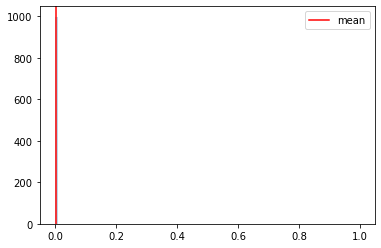

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654374003
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 10.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▍                                                                                | 5/1000 [00:00<01:23, 11.94it/s]

Monte Carlo 3
Monte Carlo 4
Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:58,  8.39it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:51,  8.88it/s]

Monte Carlo 9
Monte Carlo 10


  1%|█                                                                               | 13/1000 [00:01<01:48,  9.12it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:50,  8.93it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:50,  8.90it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:58,  8.31it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:54,  8.53it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:52,  8.72it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:55,  8.46it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:51,  8.77it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:54,  8.46it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<01:49,  8.90it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:13,  7.23it/s]

Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<02:13,  7.22it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<02:03,  7.81it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:11,  7.35it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<02:07,  7.54it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<02:04,  7.73it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<02:03,  7.72it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:58,  8.05it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:54,  8.29it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:54,  8.33it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<01:54,  8.30it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<01:57,  8.08it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:04,  7.59it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<02:01,  7.76it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<01:57,  8.02it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:59,  7.84it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<01:59,  7.84it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<01:58,  7.90it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<01:56,  7.98it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:04,  7.50it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:03,  7.50it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<02:08,  7.22it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:04,  7.43it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:05,  7.35it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:04,  7.41it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:03,  7.46it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:05,  7.30it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:06,  7.22it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<02:02,  7.43it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:03,  7.40it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:02,  7.42it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<01:59,  7.62it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<01:59,  7.59it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:07,  7.08it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:01,  7.40it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:29,  6.01it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:17,  6.53it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:11,  6.79it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:07,  7.01it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:12,  6.73it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:06,  7.02it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:05,  7.05it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:05,  7.03it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:09,  6.80it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:07,  6.92it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:03,  7.10it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:13,  6.56it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:06,  6.92it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:10,  6.70it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:09,  6.75it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:10,  6.64it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:15,  6.39it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<02:18,  6.26it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:08,  6.71it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:05,  6.85it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:10,  6.59it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:25,  5.91it/s]

Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:19<02:26,  5.84it/s]

Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:25,  5.87it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:24,  5.91it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:17,  6.21it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:12,  6.39it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:20,  6.01it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:13,  6.32it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:14,  6.27it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<02:10,  6.45it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:12,  6.35it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:13,  6.27it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:12,  6.28it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:08,  6.50it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:06,  6.57it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:23<02:10,  6.35it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:23<02:13,  6.20it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:11,  6.26it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:24<02:18,  5.96it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:24<02:19,  5.90it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:15,  6.04it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:14,  6.08it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:25<02:06,  6.44it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:02,  6.65it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:26<02:01,  6.67it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:26<01:58,  6.85it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:26<02:03,  6.54it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:02,  6.60it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:27<02:02,  6.54it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:27<02:02,  6.53it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:02,  6.55it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:28<02:07,  6.26it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:28<02:14,  5.93it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:29<02:12,  5.98it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:29<02:09,  6.12it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:29<02:07,  6.17it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:30<02:12,  5.94it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:30<02:11,  5.98it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:30<02:08,  6.12it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:07,  6.16it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:31<02:13,  5.84it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:31<02:11,  5.91it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:31<02:12,  5.87it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▌                                                             | 223/1000 [00:32<02:15,  5.74it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:32<02:20,  5.53it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:32<02:17,  5.61it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 228/1000 [00:32<02:17,  5.63it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:33<02:40,  4.81it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:33<02:31,  5.07it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:33<02:27,  5.20it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:27,  5.20it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:34<02:30,  5.10it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:34<02:24,  5.27it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:34<02:21,  5.38it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:35<02:22,  5.32it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:35<02:20,  5.41it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:36<02:20,  5.39it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:36<02:18,  5.45it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▍                                                           | 246/1000 [00:36<02:19,  5.42it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 247/1000 [00:36<02:25,  5.19it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:37<02:39,  4.70it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:37<02:35,  4.81it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:37<02:23,  5.21it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:37<02:17,  5.42it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:37<02:13,  5.60it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:38<02:08,  5.80it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:38<02:25,  5.10it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:38<02:25,  5.10it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:39<02:25,  5.10it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:39<02:19,  5.31it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:39<02:07,  5.78it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:39<02:10,  5.62it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:40<02:09,  5.66it/s]

Monte Carlo 265
Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:40<02:10,  5.62it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:40<02:15,  5.39it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:41<02:14,  5.43it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:41<02:16,  5.33it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:41<02:17,  5.31it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:41<02:13,  5.45it/s]

Monte Carlo 273
Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:42<02:10,  5.54it/s]

Monte Carlo 275
Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:42<02:15,  5.32it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:42<02:11,  5.46it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:42<02:15,  5.30it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:43<02:13,  5.40it/s]

Monte Carlo 281
Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:43<02:09,  5.54it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:43<02:10,  5.49it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:44<02:09,  5.50it/s]

Monte Carlo 286
Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:44<02:06,  5.61it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:44<02:14,  5.27it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:45<02:16,  5.20it/s]

Monte Carlo 292
Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:45<02:08,  5.47it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:45<02:09,  5.44it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:46<02:10,  5.38it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:46<02:09,  5.40it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:46<02:08,  5.45it/s]

Monte Carlo 299
Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:46<02:13,  5.24it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:47<02:12,  5.28it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:47<02:09,  5.38it/s]

Monte Carlo 303
Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:47<02:12,  5.23it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:47<02:10,  5.29it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:48<02:09,  5.34it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:48<02:06,  5.45it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:48<02:04,  5.54it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:49<02:08,  5.33it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:49<02:09,  5.29it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:49<02:09,  5.30it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:49<02:11,  5.19it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:49<02:12,  5.15it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:50<02:13,  5.11it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:50<02:14,  5.06it/s]

Monte Carlo 319
Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:50<02:14,  5.03it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:50<02:22,  4.76it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:51<02:17,  4.92it/s]

Monte Carlo 323
Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:51<02:20,  4.81it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:51<02:18,  4.87it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:51<02:16,  4.91it/s]

Monte Carlo 327
Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:52<02:25,  4.62it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:52<02:22,  4.69it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:52<02:21,  4.71it/s]

Monte Carlo 331
Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:53<02:25,  4.58it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:53<02:25,  4.57it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:53<02:21,  4.68it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:53<02:21,  4.69it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:54<02:20,  4.71it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:54<02:24,  4.58it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:54<02:22,  4.64it/s]

Monte Carlo 340


 34%|███████████████████████████                                                    | 342/1000 [00:54<02:19,  4.72it/s]

Monte Carlo 341
Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:55<02:19,  4.69it/s]

Monte Carlo 343
Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:55<02:20,  4.67it/s]

Monte Carlo 345


 35%|███████████████████████████▍                                                   | 347/1000 [00:56<02:19,  4.69it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 348/1000 [00:56<02:19,  4.69it/s]

Monte Carlo 347
Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:56<02:25,  4.47it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:56<02:25,  4.47it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:56<02:22,  4.56it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:57<02:24,  4.50it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 354/1000 [00:57<02:19,  4.64it/s]

Monte Carlo 353


 36%|████████████████████████████                                                   | 355/1000 [00:57<02:16,  4.73it/s]

Monte Carlo 354
Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [00:58<02:18,  4.65it/s]

Monte Carlo 356


 36%|████████████████████████████▎                                                  | 358/1000 [00:58<02:17,  4.65it/s]

Monte Carlo 357
Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [00:58<02:18,  4.61it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [00:58<02:18,  4.61it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 362/1000 [00:59<02:16,  4.67it/s]

Monte Carlo 361
Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [00:59<02:18,  4.60it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [00:59<02:24,  4.40it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:00<02:25,  4.38it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 367/1000 [01:00<02:19,  4.53it/s]

Monte Carlo 366
Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:00<02:19,  4.54it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:00<02:19,  4.51it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:01<02:20,  4.48it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:01<02:40,  3.93it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:01<02:33,  4.08it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:01<02:28,  4.23it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:02<02:24,  4.35it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 376/1000 [01:02<02:16,  4.57it/s]

Monte Carlo 375
Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:02<02:18,  4.49it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:02<02:19,  4.45it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:03<02:17,  4.52it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:03<02:15,  4.57it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:03<02:16,  4.55it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:03<02:17,  4.48it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:04<02:20,  4.40it/s]

Monte Carlo 383


 38%|██████████████████████████████▍                                                | 385/1000 [01:04<02:21,  4.35it/s]

Monte Carlo 384
Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:04<02:19,  4.41it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:05<02:18,  4.42it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:05<02:19,  4.40it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:05<02:18,  4.41it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:05<02:17,  4.43it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:05<02:15,  4.48it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:06<02:13,  4.55it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:06<02:16,  4.45it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:06<02:16,  4.43it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:06<02:19,  4.34it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:07<02:21,  4.27it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:07<02:19,  4.33it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:07<02:16,  4.40it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:07<02:14,  4.47it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:07<02:13,  4.49it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:08<02:15,  4.42it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:08<02:12,  4.50it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:08<02:11,  4.55it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:08<02:15,  4.38it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:09<02:16,  4.35it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:09<02:17,  4.32it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:09<02:19,  4.27it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:09<02:22,  4.14it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:10<02:23,  4.12it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:10<02:27,  4.00it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:10<02:23,  4.10it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:10<02:23,  4.11it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:11<02:22,  4.12it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:11<02:22,  4.10it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:11<02:19,  4.20it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:11<02:19,  4.20it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:11<02:19,  4.18it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:12<02:16,  4.26it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:12<02:17,  4.22it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:12<02:16,  4.23it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:12<02:17,  4.20it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:13<02:19,  4.13it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:13<02:20,  4.12it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:13<02:24,  3.97it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:13<02:24,  3.98it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:14<02:23,  4.00it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:14<02:24,  3.97it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:14<02:25,  3.93it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:14<02:24,  3.94it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:15<02:25,  3.92it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:15<02:24,  3.95it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:15<02:22,  3.98it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:15<02:21,  4.00it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:16<02:24,  3.92it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:16<02:21,  3.98it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:16<02:22,  3.95it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:16<02:23,  3.93it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:17<02:22,  3.95it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:17<02:17,  4.07it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:17<02:18,  4.04it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:17<02:17,  4.08it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:18<02:14,  4.14it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:18<02:14,  4.14it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:18<02:19,  3.99it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:18<02:20,  3.95it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:19<02:22,  3.89it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:19<02:23,  3.86it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:19<02:24,  3.83it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:20<02:27,  3.73it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:20<02:24,  3.79it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:20<02:22,  3.85it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:20<02:29,  3.66it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:21<02:24,  3.80it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:21<02:27,  3.71it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:21<02:26,  3.71it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:21<02:23,  3.79it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:22<02:23,  3.78it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:22<02:19,  3.87it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:22<02:20,  3.85it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:22<02:15,  3.99it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:23<02:14,  4.01it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:23<02:13,  4.03it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:23<02:17,  3.92it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:23<02:14,  3.98it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:24<02:11,  4.07it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:24<02:09,  4.11it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:24<02:15,  3.94it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:24<02:15,  3.92it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:25<02:13,  3.97it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:25<02:12,  4.01it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:25<02:09,  4.08it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:25<02:11,  4.02it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:26<02:13,  3.94it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:26<02:28,  3.55it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:26<02:23,  3.66it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:27<02:17,  3.81it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:27<02:16,  3.84it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:27<02:14,  3.89it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:27<02:16,  3.82it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:28<02:14,  3.87it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:28<02:13,  3.90it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:28<02:10,  3.98it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:28<02:10,  3.96it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:29<02:13,  3.86it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:29<02:16,  3.77it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:29<02:14,  3.82it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:29<02:16,  3.75it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:30<02:16,  3.75it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:30<02:16,  3.75it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:30<02:12,  3.85it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:30<02:12,  3.85it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:31<02:08,  3.95it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:31<02:12,  3.84it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:31<02:09,  3.92it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:31<02:09,  3.90it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:32<02:12,  3.80it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:32<02:11,  3.82it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:32<02:11,  3.81it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:32<02:12,  3.78it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:33<02:11,  3.80it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:33<02:08,  3.89it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:33<02:06,  3.94it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:34<02:08,  3.85it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:34<02:07,  3.89it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:34<02:08,  3.86it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:34<02:10,  3.79it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:35<02:13,  3.69it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:35<02:12,  3.72it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:35<02:09,  3.79it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:35<02:15,  3.63it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:36<02:14,  3.65it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:36<02:12,  3.68it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:36<02:17,  3.53it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:37<02:14,  3.61it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:37<02:10,  3.72it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:37<02:07,  3.79it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:37<02:08,  3.76it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:38<02:07,  3.77it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:38<02:05,  3.83it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:38<02:06,  3.81it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:38<02:06,  3.77it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:39<02:06,  3.79it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:39<02:04,  3.83it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:39<02:05,  3.80it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:39<02:03,  3.85it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:40<02:03,  3.82it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:40<02:05,  3.77it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:40<02:02,  3.84it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:40<02:01,  3.87it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:41<02:00,  3.89it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:41<01:58,  3.94it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:41<01:58,  3.95it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:41<01:57,  3.99it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:42<01:57,  3.95it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:42<01:57,  3.97it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:42<01:57,  3.93it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:42<01:58,  3.91it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:43<01:57,  3.92it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:43<01:57,  3.93it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:43<01:56,  3.94it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:43<01:57,  3.91it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:44<01:57,  3.90it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:44<01:57,  3.89it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:44<01:59,  3.82it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:45<01:57,  3.86it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:45<01:59,  3.79it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:45<02:02,  3.69it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:45<02:00,  3.75it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:46<01:59,  3.76it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:46<02:00,  3.75it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:46<02:06,  3.54it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:46<02:05,  3.57it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:47<02:05,  3.56it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:47<02:03,  3.61it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:47<02:04,  3.58it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:48<02:06,  3.51it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:48<02:04,  3.56it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:48<02:05,  3.53it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:48<02:04,  3.55it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:49<02:04,  3.52it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:49<02:03,  3.55it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:49<02:02,  3.56it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:50<02:00,  3.62it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:50<01:56,  3.74it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:50<01:54,  3.79it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:50<01:54,  3.80it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:51<01:53,  3.81it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:51<01:54,  3.78it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:51<01:54,  3.78it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:51<01:55,  3.73it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:52<01:56,  3.69it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:52<01:54,  3.75it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:52<01:55,  3.68it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:52<01:56,  3.66it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:53<01:56,  3.64it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:53<01:58,  3.57it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:53<01:59,  3.54it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:54<01:57,  3.58it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:54<01:57,  3.59it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:54<01:55,  3.63it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:54<01:55,  3.64it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:55<02:08,  3.25it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:55<02:03,  3.38it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:55<02:04,  3.35it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:56<02:06,  3.29it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [01:56<02:04,  3.34it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [01:56<02:06,  3.26it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [01:57<02:05,  3.27it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [01:57<02:06,  3.26it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [01:57<02:04,  3.29it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [01:57<02:02,  3.34it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [01:58<02:01,  3.36it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [01:58<01:59,  3.42it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [01:58<01:56,  3.49it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [01:59<01:54,  3.54it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [01:59<01:52,  3.60it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [01:59<01:51,  3.60it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [01:59<01:52,  3.57it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:00<01:49,  3.67it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:00<01:49,  3.65it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:00<01:47,  3.72it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:00<01:45,  3.78it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:01<01:47,  3.70it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:01<01:46,  3.70it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:01<01:48,  3.65it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:02<01:49,  3.60it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:02<01:49,  3.60it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:02<01:54,  3.42it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:02<01:52,  3.49it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:03<01:52,  3.46it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:03<01:51,  3.48it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:03<01:53,  3.43it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:04<01:53,  3.41it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:04<01:52,  3.42it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:04<01:56,  3.29it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:05<02:01,  3.15it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:05<02:01,  3.16it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:05<02:02,  3.12it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:06<02:01,  3.13it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:06<01:57,  3.22it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:06<01:57,  3.22it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:07<01:58,  3.18it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:07<02:04,  3.04it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:07<02:00,  3.11it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:07<01:58,  3.16it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:08<01:57,  3.19it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:08<01:53,  3.27it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:08<01:55,  3.21it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:09<01:55,  3.20it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:09<01:54,  3.22it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:09<01:55,  3.19it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:10<01:52,  3.26it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:10<01:52,  3.27it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:10<01:54,  3.20it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:11<01:55,  3.17it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:11<01:52,  3.22it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:11<01:50,  3.28it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:12<01:54,  3.16it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:12<01:53,  3.17it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:12<01:51,  3.23it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:12<01:49,  3.27it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:13<01:51,  3.21it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:13<01:49,  3.26it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:13<01:49,  3.25it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:14<01:50,  3.22it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:14<01:49,  3.23it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:14<01:52,  3.13it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:15<01:53,  3.09it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:15<01:51,  3.14it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:15<01:51,  3.13it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:16<01:50,  3.17it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:16<01:50,  3.16it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:16<01:48,  3.21it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:17<01:48,  3.20it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:17<01:48,  3.18it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:17<01:48,  3.17it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:18<01:51,  3.09it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:18<01:51,  3.08it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:18<01:49,  3.11it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:18<01:50,  3.07it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:19<01:50,  3.07it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:19<01:48,  3.10it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:19<01:49,  3.08it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:20<01:51,  3.02it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:20<01:51,  3.01it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:21<01:54,  2.91it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:21<01:54,  2.91it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:21<01:52,  2.96it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:22<01:53,  2.93it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:22<01:56,  2.83it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:22<01:56,  2.83it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:23<01:54,  2.87it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:23<01:52,  2.91it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:23<01:50,  2.94it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:24<01:48,  2.99it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:24<01:58,  2.72it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:24<01:56,  2.76it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:25<01:51,  2.88it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:25<01:48,  2.96it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:25<01:49,  2.91it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:26<01:47,  2.96it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:26<01:44,  3.03it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:26<01:48,  2.93it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:27<01:44,  3.01it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:27<01:45,  2.99it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:27<01:45,  2.98it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:28<01:43,  3.04it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:28<01:44,  2.98it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:28<01:42,  3.04it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:29<01:40,  3.08it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:29<01:40,  3.07it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:29<01:39,  3.09it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:30<01:40,  3.05it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:30<01:40,  3.05it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:30<01:40,  3.03it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:31<01:39,  3.06it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:31<01:42,  2.96it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:31<01:39,  3.03it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:32<01:38,  3.05it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:32<01:38,  3.04it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:32<01:37,  3.06it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:33<01:36,  3.08it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:33<01:36,  3.07it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:33<01:38,  3.00it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:34<01:38,  2.98it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:34<01:40,  2.91it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:34<01:39,  2.95it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:35<01:36,  3.01it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:35<01:38,  2.96it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:35<01:36,  3.02it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:36<01:37,  2.98it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:36<01:35,  3.01it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:36<01:36,  2.99it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:37<01:35,  2.99it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:37<01:36,  2.95it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:37<01:35,  2.99it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:38<01:35,  2.97it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:38<01:36,  2.93it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:38<01:34,  2.96it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:39<01:37,  2.88it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:39<01:34,  2.95it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:39<01:33,  2.97it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:40<01:32,  2.98it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:40<01:34,  2.91it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:40<01:32,  2.98it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:41<01:32,  2.95it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:41<01:36,  2.84it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:41<01:35,  2.85it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:42<01:34,  2.86it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:42<01:32,  2.93it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:42<01:30,  2.96it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:43<01:30,  2.95it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:43<01:32,  2.90it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:43<01:32,  2.87it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:44<01:32,  2.85it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:44<01:31,  2.90it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:45<01:31,  2.87it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:45<01:31,  2.87it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:45<01:31,  2.84it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:46<01:31,  2.85it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:46<01:30,  2.86it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:46<01:30,  2.86it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:47<01:31,  2.82it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:47<01:28,  2.88it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:47<01:29,  2.86it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:48<01:27,  2.91it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:48<01:27,  2.88it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:48<01:27,  2.88it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:49<01:28,  2.85it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:49<01:30,  2.77it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:49<01:30,  2.75it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:50<01:27,  2.83it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:50<01:26,  2.84it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:51<01:25,  2.87it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:51<01:25,  2.86it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:51<01:24,  2.89it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:52<01:26,  2.80it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:52<01:24,  2.87it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:52<01:23,  2.89it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:53<01:23,  2.88it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:53<01:22,  2.90it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:53<01:21,  2.91it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:54<01:21,  2.89it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:54<01:21,  2.89it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:54<01:21,  2.88it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:55<01:21,  2.86it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [02:55<01:21,  2.86it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [02:55<01:21,  2.84it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [02:56<01:22,  2.79it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [02:56<01:21,  2.83it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [02:56<01:20,  2.84it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [02:57<01:20,  2.84it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [02:57<01:20,  2.83it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [02:58<01:21,  2.76it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [02:58<01:20,  2.79it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [02:58<01:20,  2.77it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [02:59<01:19,  2.79it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [02:59<01:18,  2.83it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [02:59<01:17,  2.85it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:00<01:19,  2.78it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:00<01:19,  2.74it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:00<01:19,  2.73it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:01<01:18,  2.75it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:01<01:18,  2.76it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:01<01:17,  2.77it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:02<01:16,  2.80it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:02<01:17,  2.77it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:03<01:18,  2.70it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:03<01:15,  2.79it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:03<01:15,  2.77it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:04<01:15,  2.75it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:04<01:17,  2.69it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:04<01:14,  2.79it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:05<01:11,  2.88it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:05<01:12,  2.81it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:05<01:13,  2.79it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:06<01:10,  2.88it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:06<01:10,  2.88it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:06<01:10,  2.85it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:07<01:09,  2.87it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:07<01:09,  2.88it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:08<01:08,  2.87it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:08<01:15,  2.62it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:08<01:14,  2.63it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:09<01:12,  2.68it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:09<01:11,  2.70it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:09<01:10,  2.74it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:10<01:09,  2.75it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:10<01:08,  2.78it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:11<01:08,  2.76it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:11<01:08,  2.74it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:11<01:07,  2.78it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:12<01:06,  2.79it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:12<01:06,  2.79it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:12<01:06,  2.78it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:13<01:05,  2.79it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:13<01:07,  2.73it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:13<01:06,  2.72it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:14<01:05,  2.75it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:14<01:06,  2.71it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:15<01:06,  2.69it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:15<01:04,  2.74it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:15<01:05,  2.72it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:16<01:04,  2.74it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:16<01:02,  2.79it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:16<01:03,  2.74it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:17<01:02,  2.75it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:17<01:02,  2.76it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:17<01:02,  2.73it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:18<01:01,  2.75it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:18<01:02,  2.71it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:19<01:01,  2.72it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:19<01:01,  2.73it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:19<01:00,  2.77it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:20<01:01,  2.66it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:20<01:00,  2.72it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:20<01:01,  2.67it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:21<00:59,  2.72it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:21<01:00,  2.68it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:22<01:01,  2.62it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:22<01:00,  2.63it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:22<00:58,  2.69it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:23<00:58,  2.70it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:23<00:58,  2.69it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:23<00:56,  2.72it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:24<00:57,  2.69it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:24<00:56,  2.73it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:24<00:56,  2.69it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:25<00:56,  2.67it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:25<00:56,  2.65it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:26<00:54,  2.73it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:26<00:53,  2.79it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:26<00:51,  2.85it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:27<00:51,  2.84it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:27<00:50,  2.89it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:27<00:49,  2.90it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:28<00:50,  2.81it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:28<00:49,  2.85it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:28<00:50,  2.80it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:29<00:50,  2.78it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:29<00:50,  2.77it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:30<00:51,  2.68it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:30<00:50,  2.71it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:30<00:50,  2.68it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:31<00:50,  2.68it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:31<00:49,  2.71it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:31<00:50,  2.63it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:32<00:50,  2.61it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:32<00:49,  2.63it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:33<00:49,  2.65it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:33<00:48,  2.67it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:33<00:48,  2.63it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:34<00:49,  2.56it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:34<00:48,  2.61it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:34<00:48,  2.57it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:35<00:48,  2.58it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:35<00:48,  2.52it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:36<00:47,  2.58it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:36<00:46,  2.59it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:36<00:45,  2.63it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:37<00:44,  2.66it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:37<00:45,  2.62it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:38<00:44,  2.64it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:38<00:44,  2.62it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:38<00:45,  2.54it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:39<00:45,  2.50it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:39<00:45,  2.48it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:40<00:44,  2.52it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:40<00:44,  2.50it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:40<00:42,  2.57it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:41<00:41,  2.63it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:41<00:40,  2.67it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:41<00:40,  2.67it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:42<00:39,  2.65it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:42<00:39,  2.64it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:43<00:38,  2.71it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:43<00:37,  2.73it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:43<00:37,  2.70it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:44<00:36,  2.74it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:44<00:36,  2.74it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:44<00:36,  2.72it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:45<00:36,  2.66it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:45<00:36,  2.64it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:46<00:36,  2.61it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:46<00:36,  2.63it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:46<00:35,  2.64it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:47<00:35,  2.63it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:47<00:35,  2.60it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:47<00:35,  2.55it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:48<00:35,  2.54it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:48<00:34,  2.56it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:49<00:35,  2.51it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:49<00:35,  2.48it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:49<00:34,  2.48it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:50<00:33,  2.50it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:50<00:33,  2.48it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:51<00:33,  2.49it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:51<00:32,  2.49it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:51<00:32,  2.49it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:52<00:32,  2.48it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:52<00:32,  2.46it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:53<00:31,  2.46it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [03:53<00:30,  2.52it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [03:54<00:33,  2.29it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [03:54<00:31,  2.36it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [03:54<00:30,  2.40it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [03:55<00:30,  2.41it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [03:55<00:29,  2.42it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [03:56<00:29,  2.43it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [03:56<00:29,  2.37it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [03:57<00:29,  2.37it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [03:57<00:28,  2.39it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [03:57<00:28,  2.38it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [03:58<00:27,  2.43it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [03:58<00:26,  2.49it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [03:59<00:25,  2.50it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [03:59<00:24,  2.53it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [03:59<00:25,  2.45it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:00<00:25,  2.40it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:00<00:24,  2.42it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:01<00:24,  2.41it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:01<00:23,  2.45it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:01<00:23,  2.44it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:02<00:22,  2.45it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:02<00:22,  2.47it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:03<00:22,  2.43it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:03<00:21,  2.46it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:03<00:21,  2.48it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:04<00:20,  2.45it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:04<00:20,  2.45it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:05<00:20,  2.44it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:05<00:19,  2.46it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:05<00:19,  2.41it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:06<00:18,  2.43it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:06<00:18,  2.40it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:07<00:18,  2.37it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:07<00:17,  2.41it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:08<00:17,  2.40it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:08<00:16,  2.42it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:08<00:16,  2.41it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:09<00:16,  2.39it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:09<00:15,  2.38it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:10<00:15,  2.38it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:10<00:15,  2.34it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:11<00:14,  2.37it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:11<00:14,  2.40it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:11<00:13,  2.42it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:12<00:13,  2.38it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:12<00:13,  2.37it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:13<00:12,  2.40it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:13<00:12,  2.40it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:13<00:11,  2.42it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:14<00:11,  2.40it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:14<00:10,  2.37it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:15<00:10,  2.36it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:15<00:10,  2.38it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:16<00:09,  2.38it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:16<00:09,  2.42it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:16<00:08,  2.38it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:17<00:08,  2.40it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:17<00:08,  2.30it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:18<00:07,  2.33it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:18<00:07,  2.35it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:19<00:06,  2.33it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:19<00:06,  2.29it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:19<00:05,  2.33it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:20<00:05,  2.25it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:20<00:05,  2.07it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:21<00:05,  2.03it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:21<00:04,  2.01it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:22<00:04,  2.05it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:22<00:03,  2.10it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:23<00:03,  2.13it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:23<00:02,  2.12it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:24<00:02,  2.14it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:24<00:01,  2.09it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:25<00:01,  2.09it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:25<00:00,  2.12it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:26<00:00,  2.06it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:26<00:00,  3.75it/s]


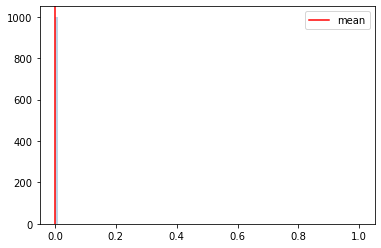

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654374271
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 10.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:07, 14.75it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:42,  9.68it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:51,  8.92it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▋                                                                                | 9/1000 [00:00<01:57,  8.41it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:51,  8.89it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:49,  9.01it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:58,  8.33it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<02:21,  6.95it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<02:02,  7.99it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<02:11,  7.45it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<02:21,  6.89it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<02:09,  7.52it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:16,  7.12it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▎                                                                             | 29/1000 [00:03<02:05,  7.76it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:05,  7.71it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:01,  7.95it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<01:59,  8.09it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:55,  8.36it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<02:04,  7.69it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<01:56,  8.24it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<01:54,  8.38it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<01:54,  8.33it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:53,  8.36it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:06<01:55,  8.21it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<01:58,  7.99it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<02:06,  7.49it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<02:06,  7.46it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<02:05,  7.53it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<02:07,  7.36it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<02:05,  7.50it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:08<02:06,  7.38it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:08<02:03,  7.56it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:08<02:00,  7.71it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:08<02:10,  7.15it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:09<02:12,  7.01it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:09<02:12,  6.99it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<02:07,  7.25it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:09<02:01,  7.61it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:10<02:01,  7.57it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:10<02:03,  7.43it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:10<02:01,  7.52it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:11<02:05,  7.30it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:11<02:10,  6.97it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:11<02:04,  7.28it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:11<02:14,  6.75it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:12<02:14,  6.73it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:12<02:11,  6.88it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:12<02:11,  6.87it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:13<02:08,  6.98it/s]

Monte Carlo 99
Monte Carlo 100


 10%|███████▉                                                                       | 101/1000 [00:13<02:11,  6.86it/s]

Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:30,  5.97it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:21,  6.32it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:19,  6.41it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:21,  6.30it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:13,  6.64it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<02:12,  6.72it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:08,  6.87it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:13,  6.60it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:16<02:14,  6.55it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▍                                                                     | 120/1000 [00:16<02:30,  5.86it/s]

Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:16<02:39,  5.49it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:17<02:30,  5.81it/s]

Monte Carlo 123
Monte Carlo 124


 12%|█████████▉                                                                     | 125/1000 [00:17<02:32,  5.73it/s]

Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:32,  5.72it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:25,  5.99it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:18<02:25,  5.98it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:18<02:24,  5.99it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:34,  5.59it/s]

Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:19<02:30,  5.72it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:19<02:29,  5.77it/s]

Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:19<02:30,  5.72it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:22,  6.02it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:20<02:28,  5.79it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:20<02:24,  5.93it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:19,  6.11it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:21<02:29,  5.69it/s]

Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:21<02:37,  5.41it/s]

Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:21<02:32,  5.56it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:22<02:33,  5.52it/s]

Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:22<02:29,  5.67it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▏                                                                  | 155/1000 [00:22<02:25,  5.79it/s]

Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:22<02:29,  5.62it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:23<02:32,  5.51it/s]

Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:23<02:30,  5.57it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:23<02:24,  5.80it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:23<02:25,  5.73it/s]

Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:24<02:23,  5.83it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:24<02:30,  5.55it/s]

Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:24<02:30,  5.53it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:25<02:22,  5.82it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:25<02:22,  5.82it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:25<02:20,  5.89it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:26<02:27,  5.57it/s]

Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:26<02:31,  5.43it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:26<02:26,  5.60it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:26<02:20,  5.84it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:27<02:30,  5.44it/s]

Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:27<02:26,  5.59it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:27<02:31,  5.38it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:28<02:30,  5.42it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:28<02:25,  5.56it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 190/1000 [00:28<02:22,  5.66it/s]

Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:28<02:27,  5.48it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:29<02:22,  5.64it/s]

Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:29<02:26,  5.48it/s]

Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:29<02:26,  5.49it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▌                                                               | 197/1000 [00:29<02:33,  5.24it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:30<02:36,  5.12it/s]

Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:30<02:36,  5.10it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:30<02:36,  5.11it/s]

Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:30<02:31,  5.25it/s]

Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:31<02:29,  5.32it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:31<02:36,  5.08it/s]

Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:31<02:31,  5.23it/s]

Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:31<02:27,  5.37it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:32<02:33,  5.16it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:32<02:33,  5.15it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:33<02:26,  5.36it/s]

Monte Carlo 212
Monte Carlo 213

 21%|████████████████▉                                                              | 214/1000 [00:33<02:27,  5.33it/s]

 22%|████████████████▉                                                              | 215/1000 [00:33<02:29,  5.24it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:33<02:26,  5.37it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:33<02:25,  5.40it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:34<02:23,  5.43it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:34<02:19,  5.60it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:34<02:17,  5.68it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:35<02:18,  5.59it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:35<02:22,  5.42it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:35<02:26,  5.28it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:35<02:24,  5.35it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:35<02:20,  5.49it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:36<02:25,  5.28it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:36<02:29,  5.16it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:36<02:28,  5.18it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:36<02:23,  5.34it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:37<02:27,  5.20it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:37<02:24,  5.30it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:37<02:22,  5.35it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:37<02:24,  5.26it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:38<02:20,  5.43it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:38<02:13,  5.69it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:38<02:20,  5.37it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:38<02:15,  5.56it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:39<02:14,  5.61it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:39<02:14,  5.59it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▋                                                           | 249/1000 [00:39<02:16,  5.51it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:40<02:29,  5.01it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:40<02:21,  5.27it/s]

Monte Carlo 252
Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:40<02:15,  5.48it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:41<02:15,  5.48it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:41<02:14,  5.49it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:41<02:20,  5.25it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:42<02:19,  5.28it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:42<02:21,  5.21it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:42<02:19,  5.28it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:42<02:23,  5.12it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:42<02:20,  5.23it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:43<02:21,  5.19it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:43<02:16,  5.35it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:43<02:13,  5.48it/s]

Monte Carlo 269
Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:44<02:21,  5.16it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:44<02:18,  5.25it/s]

Monte Carlo 272
Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:44<02:12,  5.47it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:44<02:14,  5.36it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:45<02:12,  5.44it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:45<02:15,  5.30it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:45<02:15,  5.33it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:45<02:14,  5.36it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:45<02:13,  5.37it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:46<02:14,  5.35it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:46<02:11,  5.45it/s]

Monte Carlo 283
Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:46<02:09,  5.53it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:08,  5.52it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:47<02:11,  5.40it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:47<02:14,  5.26it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:47<02:13,  5.30it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:12,  5.34it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:48<02:11,  5.37it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:48<02:12,  5.34it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:48<02:14,  5.25it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:20,  5.00it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:49<02:23,  4.90it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:49<02:23,  4.87it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:49<02:19,  5.00it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:18,  5.03it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:16,  5.10it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:50<02:18,  5.03it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:50<02:18,  5.02it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:50<02:19,  4.97it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:18,  5.02it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:20,  4.94it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:51<02:18,  4.98it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:51<02:17,  5.03it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:16,  5.04it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:52<02:18,  4.95it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:52<02:16,  5.02it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:14,  5.09it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:15,  5.05it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:14,  5.09it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:53<02:24,  4.70it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<02:25,  4.68it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:53<02:21,  4.80it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:54<02:21,  4.79it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:54<02:19,  4.85it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:15,  4.96it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:14,  5.02it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:12,  5.07it/s]

Monte Carlo 326
Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:14,  5.01it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:10,  5.13it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:55<02:09,  5.18it/s]

Monte Carlo 330
Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:55<02:11,  5.09it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:16,  4.88it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:16,  4.87it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:14,  4.95it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:16,  4.86it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:57<02:16,  4.86it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:14,  4.91it/s]

Monte Carlo 339
Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:18,  4.75it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:22,  4.63it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:58<02:24,  4.56it/s]

Monte Carlo 343


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:20,  4.65it/s]

Monte Carlo 344
Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:22,  4.58it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:22,  4.59it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:23,  4.55it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:23,  4.52it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:22,  4.57it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:23,  4.51it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:00<02:20,  4.60it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:18,  4.67it/s]

Monte Carlo 353
Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:23,  4.51it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:20,  4.59it/s]

Monte Carlo 356


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:18,  4.63it/s]

Monte Carlo 357
Monte Carlo 358


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:16,  4.69it/s]

Monte Carlo 359
Monte Carlo 360


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:16,  4.68it/s]

Monte Carlo 361
Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:22,  4.47it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:23,  4.42it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:20,  4.53it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:20,  4.52it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:18,  4.59it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:19,  4.52it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:19,  4.53it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:23,  4.40it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:21,  4.43it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:20,  4.47it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:18,  4.53it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:04<02:18,  4.51it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:17,  4.55it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:15,  4.61it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:14,  4.62it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:12,  4.69it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:05<02:13,  4.66it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:12,  4.67it/s]

Monte Carlo 380


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:29,  4.13it/s]

Monte Carlo 381


 38%|██████████████████████████████▎                                                | 383/1000 [01:06<02:22,  4.32it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:18,  4.46it/s]

Monte Carlo 383


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:15,  4.53it/s]

Monte Carlo 384
Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:15,  4.53it/s]

Monte Carlo 386


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:17,  4.46it/s]

Monte Carlo 387
Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:16,  4.46it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:15,  4.51it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:08<02:15,  4.51it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:08<02:15,  4.50it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:18,  4.38it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:34,  3.92it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:09<02:38,  3.83it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:27,  4.10it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:23,  4.21it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:23,  4.18it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:21,  4.25it/s]

Monte Carlo 399


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:12,  4.51it/s]

Monte Carlo 400
Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:19,  4.28it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:20,  4.24it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:11<02:17,  4.33it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:13,  4.45it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:12,  4.48it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:18,  4.27it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:12<02:19,  4.26it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:12<02:15,  4.36it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:17,  4.29it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:16,  4.33it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:13<02:12,  4.42it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:13<02:14,  4.36it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:13,  4.38it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:11,  4.45it/s]

Monte Carlo 415


 42%|████████████████████████████████▉                                              | 417/1000 [01:14<02:06,  4.59it/s]

Monte Carlo 416
Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:08,  4.53it/s]

Monte Carlo 418


 42%|█████████████████████████████████▏                                             | 420/1000 [01:15<02:03,  4.69it/s]

Monte Carlo 419
Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:15<02:08,  4.52it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:15<02:08,  4.49it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 424/1000 [01:16<02:07,  4.52it/s]

Monte Carlo 423
Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:16<02:05,  4.57it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:16<02:05,  4.56it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:16<02:08,  4.46it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:17<02:06,  4.51it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:17<02:06,  4.51it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:17<02:07,  4.49it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:17<02:11,  4.34it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:18<02:08,  4.43it/s]

Monte Carlo 432


 43%|██████████████████████████████████▎                                            | 434/1000 [01:18<02:05,  4.51it/s]

Monte Carlo 433
Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:18<02:04,  4.53it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:19<02:09,  4.36it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:19<02:08,  4.39it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:19<02:06,  4.45it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:19<02:06,  4.42it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:19<02:07,  4.40it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:20<02:05,  4.44it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:20<02:07,  4.37it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:20<02:10,  4.26it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:20<02:10,  4.28it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:21<02:13,  4.17it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:21<02:12,  4.17it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:21<02:15,  4.08it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:21<02:14,  4.09it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:22<02:14,  4.09it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:22<02:14,  4.08it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:22<02:18,  3.97it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:22<02:19,  3.94it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:23<02:19,  3.91it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:23<02:16,  3.99it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:23<02:15,  4.02it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:23<02:14,  4.06it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:24<02:15,  4.01it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:24<02:12,  4.08it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:24<02:09,  4.18it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:24<02:11,  4.12it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:25<02:12,  4.07it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:25<02:11,  4.10it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:25<02:09,  4.15it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:25<02:11,  4.07it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:26<02:13,  4.01it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:26<02:17,  3.88it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:26<02:12,  4.02it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:26<02:14,  3.97it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:27<02:16,  3.90it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:27<02:11,  4.04it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:27<02:08,  4.13it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:27<02:08,  4.12it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:28<02:09,  4.06it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:28<02:08,  4.09it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:28<02:10,  4.03it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:28<02:17,  3.82it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:29<02:16,  3.83it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:29<02:14,  3.88it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:29<02:13,  3.92it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:29<02:10,  3.98it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:30<02:18,  3.75it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:30<02:14,  3.84it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:30<02:12,  3.90it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:30<02:16,  3.78it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:31<02:13,  3.87it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:31<02:08,  4.00it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:31<02:08,  4.00it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:31<02:09,  3.95it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:32<02:12,  3.85it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:32<02:11,  3.89it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:32<02:10,  3.90it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:32<02:14,  3.78it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:33<02:11,  3.85it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:33<02:08,  3.92it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:33<02:09,  3.91it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:33<02:07,  3.97it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:34<02:06,  3.96it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:34<02:05,  3.99it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:34<02:03,  4.05it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:34<02:03,  4.06it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:35<02:02,  4.06it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:35<02:03,  4.03it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:35<02:03,  4.02it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:35<02:01,  4.07it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:36<02:01,  4.08it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:36<02:01,  4.06it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:36<02:03,  3.99it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:36<02:05,  3.92it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:37<02:06,  3.89it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:37<02:09,  3.79it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:37<02:08,  3.80it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:38<02:13,  3.66it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:38<02:11,  3.71it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:38<02:11,  3.68it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:38<02:10,  3.73it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:39<02:08,  3.76it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:39<02:10,  3.69it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:39<02:07,  3.79it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:39<02:10,  3.70it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:40<02:09,  3.70it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:40<02:08,  3.72it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:40<02:10,  3.67it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:41<02:20,  3.39it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:41<02:09,  3.67it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:41<02:06,  3.74it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:41<02:05,  3.79it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:42<02:01,  3.91it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:42<01:57,  4.01it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:42<01:54,  4.10it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:42<01:53,  4.13it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:43<01:57,  3.99it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:43<01:56,  4.01it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:43<01:53,  4.11it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:43<01:53,  4.11it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:44<01:56,  3.99it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:44<01:57,  3.96it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:44<01:54,  4.03it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:44<01:57,  3.94it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:45<01:57,  3.93it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:45<01:57,  3.90it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:45<01:56,  3.95it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:45<01:56,  3.95it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:46<01:59,  3.82it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:46<01:58,  3.85it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:46<01:56,  3.90it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:46<01:57,  3.88it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:47<02:02,  3.71it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:47<02:00,  3.76it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:47<02:03,  3.66it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:47<02:05,  3.57it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:48<02:07,  3.52it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:48<02:06,  3.54it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:48<02:08,  3.48it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:49<02:10,  3.41it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:49<02:12,  3.36it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:49<02:08,  3.46it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:50<02:08,  3.45it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:50<02:21,  3.12it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:50<02:18,  3.18it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:51<02:15,  3.25it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:51<02:11,  3.34it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:51<02:06,  3.45it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:51<02:03,  3.55it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:52<02:02,  3.56it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:52<02:01,  3.59it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:52<02:03,  3.52it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:52<02:04,  3.48it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:53<02:04,  3.48it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:53<02:04,  3.46it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:53<02:00,  3.56it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:54<02:04,  3.45it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:54<02:00,  3.56it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:54<01:59,  3.56it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:54<01:58,  3.60it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:55<01:56,  3.64it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:55<01:58,  3.58it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:55<01:58,  3.58it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:56<01:57,  3.58it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:56<01:58,  3.54it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:56<02:03,  3.41it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:56<02:04,  3.37it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:57<02:04,  3.35it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:57<02:07,  3.28it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:57<02:06,  3.29it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:58<02:02,  3.39it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [01:58<02:01,  3.42it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [01:58<01:59,  3.45it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [01:59<01:58,  3.49it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [01:59<01:58,  3.48it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [01:59<01:57,  3.50it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [01:59<01:56,  3.53it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:00<01:56,  3.51it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:00<01:58,  3.43it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:00<01:55,  3.52it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:01<01:59,  3.39it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:01<01:58,  3.40it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:01<01:56,  3.45it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:01<02:02,  3.29it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:02<01:56,  3.44it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:02<01:52,  3.57it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:02<01:51,  3.57it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:03<01:52,  3.55it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:03<01:50,  3.58it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:03<01:49,  3.61it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:03<01:48,  3.65it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:04<01:47,  3.66it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:04<01:44,  3.75it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:04<01:43,  3.79it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:04<01:47,  3.64it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:05<01:47,  3.62it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:05<01:48,  3.58it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:05<01:48,  3.56it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:06<01:51,  3.48it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:06<01:49,  3.54it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:06<01:48,  3.54it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:06<01:46,  3.60it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:07<01:46,  3.61it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:07<01:45,  3.63it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:07<01:46,  3.58it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:08<01:49,  3.48it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:08<01:51,  3.40it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:08<01:51,  3.38it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:08<01:54,  3.30it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:09<01:57,  3.20it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:09<01:53,  3.30it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:09<01:52,  3.34it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:10<01:51,  3.35it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:10<01:50,  3.37it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:10<01:50,  3.36it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:11<01:48,  3.40it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:11<01:50,  3.33it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:11<01:50,  3.33it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:11<01:52,  3.28it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:12<01:51,  3.27it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:12<01:50,  3.31it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:12<01:50,  3.29it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:13<01:51,  3.27it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:13<01:48,  3.33it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:13<01:51,  3.23it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:14<01:52,  3.20it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:14<01:53,  3.15it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:14<01:57,  3.04it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:15<01:58,  3.02it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:15<02:10,  2.73it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:15<02:05,  2.84it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:16<02:00,  2.94it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:16<02:00,  2.93it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:16<01:56,  3.02it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:17<01:54,  3.06it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:17<01:54,  3.05it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:17<01:53,  3.07it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:18<01:54,  3.05it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:18<01:50,  3.13it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:18<01:50,  3.14it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:19<01:49,  3.16it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:19<01:46,  3.22it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:19<01:46,  3.21it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:20<01:47,  3.19it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:20<01:48,  3.15it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:20<01:47,  3.15it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:21<01:49,  3.09it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:21<01:48,  3.11it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:21<01:50,  3.06it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:22<01:49,  3.08it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:22<01:48,  3.08it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:22<01:47,  3.10it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:22<01:46,  3.12it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:23<01:44,  3.16it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:23<01:44,  3.17it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:23<01:44,  3.17it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:24<01:47,  3.07it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:24<01:46,  3.08it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:24<01:46,  3.06it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:25<01:44,  3.12it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:25<01:44,  3.12it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:25<01:43,  3.13it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:26<01:42,  3.16it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:26<01:41,  3.18it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:26<01:40,  3.20it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:27<01:41,  3.16it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:27<01:39,  3.20it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:27<01:41,  3.14it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:28<01:43,  3.06it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:28<01:44,  3.02it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:28<01:45,  2.99it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:29<01:42,  3.08it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:29<01:41,  3.09it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:29<01:41,  3.07it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:30<01:41,  3.07it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:30<01:40,  3.09it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:30<01:41,  3.04it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:31<01:40,  3.05it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:31<01:40,  3.04it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:31<01:41,  3.02it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:32<01:39,  3.05it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:32<01:40,  3.03it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:32<01:40,  3.03it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:32<01:37,  3.09it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:33<01:38,  3.04it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:33<01:37,  3.08it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:33<01:37,  3.08it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:34<01:39,  2.99it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:34<01:39,  2.98it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:35<01:41,  2.91it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:35<01:39,  2.97it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:35<01:40,  2.94it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:36<01:36,  3.03it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:36<01:39,  2.95it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:36<01:37,  3.00it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:37<01:36,  3.00it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:37<01:36,  2.98it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:37<01:35,  3.02it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:38<01:34,  3.05it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:38<01:33,  3.06it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:38<01:33,  3.04it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:39<01:35,  2.98it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:39<01:36,  2.92it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:39<01:34,  2.99it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:40<01:32,  3.03it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:40<01:34,  2.98it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:40<01:32,  3.02it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:41<01:36,  2.89it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:41<01:33,  2.96it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:41<01:34,  2.93it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:42<01:36,  2.85it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:42<01:34,  2.91it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:42<01:35,  2.85it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:43<01:34,  2.86it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:43<01:33,  2.91it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:43<01:32,  2.93it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:44<01:31,  2.94it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:44<01:30,  2.97it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:44<01:29,  2.98it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:45<01:30,  2.94it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:45<01:29,  2.94it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:45<01:28,  2.98it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:46<01:29,  2.94it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:46<01:28,  2.96it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:46<01:30,  2.87it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:47<01:29,  2.89it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:47<01:26,  2.99it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:47<01:23,  3.08it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:48<01:30,  2.83it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:48<01:26,  2.97it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:48<01:23,  3.06it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:49<01:22,  3.07it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:49<01:20,  3.13it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:49<01:20,  3.11it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:50<01:21,  3.06it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:50<01:18,  3.17it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:50<01:18,  3.19it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:51<01:17,  3.20it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:51<01:20,  3.08it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:51<01:18,  3.13it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:52<01:16,  3.19it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:52<01:18,  3.12it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:52<01:18,  3.08it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:53<01:18,  3.09it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:53<01:17,  3.09it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:53<01:18,  3.06it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:54<01:19,  3.01it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:54<01:17,  3.08it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:54<01:19,  2.98it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:55<01:19,  2.97it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:55<01:17,  3.04it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:55<01:16,  3.06it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [02:55<01:15,  3.09it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [02:56<01:16,  3.05it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [02:56<01:19,  2.91it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [02:57<01:20,  2.87it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [02:57<01:19,  2.87it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [02:57<01:18,  2.92it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [02:58<01:17,  2.93it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [02:58<01:19,  2.86it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [02:58<01:17,  2.90it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [02:59<01:17,  2.89it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [02:59<01:16,  2.93it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [02:59<01:15,  2.93it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:00<01:17,  2.86it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:00<01:17,  2.82it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:00<01:16,  2.85it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:01<01:16,  2.86it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:01<01:16,  2.85it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:01<01:15,  2.85it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:02<01:15,  2.84it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:02<01:17,  2.75it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:03<01:16,  2.77it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:03<01:18,  2.71it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:03<01:18,  2.70it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:04<01:16,  2.74it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:04<01:16,  2.74it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:04<01:14,  2.77it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:05<01:16,  2.71it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:05<01:13,  2.80it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:05<01:12,  2.82it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:06<01:12,  2.81it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:06<01:12,  2.81it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:06<01:12,  2.77it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:07<01:11,  2.81it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:07<01:10,  2.84it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:08<01:10,  2.81it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:08<01:11,  2.78it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:08<01:12,  2.71it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:09<01:11,  2.74it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:09<01:11,  2.74it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:09<01:10,  2.76it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:10<01:09,  2.78it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:10<01:09,  2.77it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:10<01:09,  2.75it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:11<01:08,  2.76it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:11<01:09,  2.73it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:12<01:07,  2.77it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:12<01:08,  2.73it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:12<01:07,  2.74it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:13<01:06,  2.77it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:13<01:06,  2.78it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:13<01:05,  2.78it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:14<01:05,  2.76it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:14<01:06,  2.74it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:14<01:06,  2.69it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:15<01:06,  2.71it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:15<01:05,  2.70it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:16<01:04,  2.75it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:16<01:04,  2.73it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:16<01:03,  2.74it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:17<01:02,  2.78it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:17<01:02,  2.77it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:17<01:01,  2.78it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:18<01:02,  2.74it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:18<01:02,  2.71it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:18<01:02,  2.71it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:19<01:03,  2.63it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:19<01:02,  2.66it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:20<01:01,  2.70it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:20<01:02,  2.65it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:20<01:01,  2.68it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:21<01:00,  2.68it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:21<01:01,  2.65it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:22<01:00,  2.65it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:22<00:59,  2.68it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:22<01:07,  2.37it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:23<01:03,  2.50it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:23<01:01,  2.53it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:24<01:01,  2.55it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:24<00:59,  2.61it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:24<00:58,  2.64it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:25<00:56,  2.70it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:25<00:57,  2.64it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:25<00:57,  2.60it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:26<00:56,  2.64it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:26<00:55,  2.69it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:27<00:56,  2.60it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:27<00:55,  2.64it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:27<00:54,  2.69it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:28<00:53,  2.70it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:28<00:53,  2.70it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:28<00:53,  2.67it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:29<00:53,  2.64it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:29<00:53,  2.64it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:30<00:53,  2.63it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:30<00:53,  2.59it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:30<00:54,  2.53it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:31<00:52,  2.59it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:31<00:52,  2.61it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:31<00:50,  2.66it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:32<00:51,  2.59it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:32<00:52,  2.54it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:33<00:50,  2.62it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:33<00:49,  2.64it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:33<00:49,  2.64it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:34<00:48,  2.68it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:34<00:48,  2.63it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:35<00:48,  2.64it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:35<00:47,  2.67it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:35<00:47,  2.66it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:36<00:47,  2.63it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:36<00:46,  2.64it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:36<00:48,  2.51it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:37<00:46,  2.58it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:37<00:46,  2.57it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:38<00:45,  2.61it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:38<00:46,  2.55it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:38<00:46,  2.52it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:39<00:45,  2.53it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:39<00:45,  2.52it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:40<00:44,  2.56it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:40<00:43,  2.58it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:40<00:43,  2.58it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:41<00:43,  2.58it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:41<00:42,  2.57it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:42<00:42,  2.59it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:42<00:41,  2.61it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:42<00:41,  2.61it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:43<00:42,  2.51it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:43<00:40,  2.57it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:43<00:40,  2.60it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:44<00:39,  2.61it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:44<00:39,  2.60it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:45<00:38,  2.61it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:45<00:38,  2.59it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:45<00:38,  2.60it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:46<00:37,  2.58it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:46<00:38,  2.55it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:47<00:36,  2.60it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:47<00:36,  2.62it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:47<00:35,  2.68it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:48<00:33,  2.76it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:48<00:33,  2.72it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:48<00:33,  2.69it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:49<00:32,  2.74it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:49<00:32,  2.77it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:49<00:31,  2.75it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:50<00:31,  2.75it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:50<00:31,  2.72it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:51<00:31,  2.70it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:51<00:31,  2.70it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:51<00:30,  2.70it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:52<00:30,  2.70it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:52<00:30,  2.69it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:52<00:30,  2.66it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:53<00:29,  2.66it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:53<00:29,  2.68it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [03:54<00:28,  2.66it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [03:54<00:28,  2.63it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [03:54<00:28,  2.67it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [03:55<00:27,  2.71it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [03:55<00:27,  2.67it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [03:55<00:26,  2.69it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [03:56<00:26,  2.63it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [03:56<00:26,  2.61it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [03:57<00:26,  2.64it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [03:57<00:25,  2.62it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [03:57<00:27,  2.42it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [03:58<00:26,  2.49it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [03:58<00:25,  2.54it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [03:59<00:24,  2.57it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [03:59<00:24,  2.58it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [03:59<00:23,  2.64it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:00<00:22,  2.68it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:00<00:22,  2.68it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:00<00:22,  2.63it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:01<00:22,  2.63it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:01<00:21,  2.62it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:02<00:21,  2.59it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:02<00:21,  2.62it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:02<00:20,  2.58it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:03<00:20,  2.58it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:03<00:20,  2.54it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:04<00:19,  2.58it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:04<00:19,  2.52it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:04<00:19,  2.51it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:05<00:19,  2.50it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:05<00:19,  2.47it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:06<00:18,  2.43it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:06<00:18,  2.44it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:06<00:18,  2.39it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:07<00:17,  2.41it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:07<00:17,  2.41it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:08<00:16,  2.43it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:08<00:16,  2.46it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:08<00:15,  2.45it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:09<00:15,  2.42it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:09<00:15,  2.36it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:10<00:15,  2.36it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:10<00:14,  2.39it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:11<00:14,  2.36it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:11<00:13,  2.37it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:11<00:13,  2.35it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:12<00:13,  2.38it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:12<00:12,  2.37it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:13<00:12,  2.32it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:13<00:11,  2.35it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:14<00:11,  2.35it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:14<00:10,  2.36it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:14<00:10,  2.35it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:15<00:10,  2.36it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:15<00:09,  2.39it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:16<00:09,  2.37it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:16<00:09,  2.33it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:17<00:08,  2.35it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:17<00:08,  2.36it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:17<00:07,  2.36it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:18<00:07,  2.28it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:18<00:07,  2.25it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:19<00:06,  2.24it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:19<00:06,  2.28it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:20<00:05,  2.28it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:20<00:05,  2.30it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:21<00:04,  2.28it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:21<00:04,  2.29it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:21<00:03,  2.29it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:22<00:03,  2.28it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:22<00:03,  2.25it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:23<00:02,  2.22it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:23<00:02,  2.24it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:24<00:01,  2.26it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:24<00:01,  2.30it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:24<00:00,  2.31it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:25<00:00,  2.29it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:25<00:00,  3.76it/s]


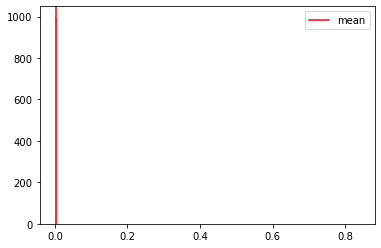

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654374537
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 10.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:24, 11.75it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▌                                                                                | 7/1000 [00:00<01:45,  9.45it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:52,  8.85it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:47,  9.23it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:56,  8.49it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<02:03,  8.01it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<02:00,  8.19it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<01:57,  8.36it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:59,  8.21it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:59,  8.18it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:57,  8.33it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<01:56,  8.37it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:16,  7.10it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:02,  7.94it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<01:58,  8.17it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:06,  7.64it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:07,  7.58it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<02:02,  7.83it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:56,  8.22it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 41/1000 [00:04<01:58,  8.06it/s]

Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<02:25,  6.58it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:06,  7.56it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:03,  7.71it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:06<01:59,  7.98it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:04,  7.60it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<01:58,  7.99it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:59,  7.94it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<01:56,  8.10it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<01:56,  8.10it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:59,  7.87it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<01:59,  7.85it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:01,  7.68it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:02,  7.63it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:11,  7.06it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:03,  7.53it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:00,  7.71it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:04,  7.42it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:03,  7.47it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:01,  7.56it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:13,  6.87it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:17,  6.68it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:19,  6.54it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:08,  7.10it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:07,  7.17it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:06,  7.21it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:08,  7.08it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:04,  7.25it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:12,  6.81it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:10,  6.89it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:06,  7.11it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:02,  7.34it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:06,  7.06it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:09,  6.92it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:03,  7.24it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:03,  7.17it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:05,  7.06it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:13,  6.62it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:14,  6.58it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:08,  6.84it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:08,  6.84it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:07,  6.86it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:12,  6.58it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:13,  6.52it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:10,  6.66it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:12,  6.55it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:09,  6.68it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:06,  6.82it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:09,  6.68it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:08,  6.71it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:11,  6.51it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:08,  6.68it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:08,  6.63it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:07,  6.70it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:10,  6.52it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:09,  6.54it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:15,  6.26it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:10,  6.46it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:14,  6.25it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<02:13,  6.30it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:14,  6.26it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:17,  6.07it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:16,  6.10it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:20,  5.92it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:21,  5.90it/s]

Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:23<02:40,  5.16it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:24<02:25,  5.71it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:21,  5.86it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:18,  5.93it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:14,  6.12it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 179/1000 [00:25<02:14,  6.12it/s]

Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:16,  6.02it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:26<02:13,  6.11it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:17,  5.91it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:21,  5.76it/s]

Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:26<02:18,  5.85it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:15,  5.99it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:27<02:19,  5.81it/s]

Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:27<02:20,  5.75it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:17,  5.85it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:15,  5.92it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:14,  5.98it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:24,  5.52it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:22,  5.60it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:29<02:16,  5.85it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:20,  5.64it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 206/1000 [00:30<02:19,  5.68it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:18,  5.72it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:17,  5.73it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:31<02:17,  5.73it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:16,  5.75it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:20,  5.60it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:21,  5.54it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:19,  5.59it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:19,  5.59it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:33<02:21,  5.47it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:19,  5.55it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:20,  5.53it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:18,  5.58it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:14,  5.73it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:21,  5.42it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:22,  5.39it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:21,  5.40it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:23,  5.33it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:20,  5.41it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:35<02:17,  5.52it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:12,  5.73it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████                                                            | 242/1000 [00:36<02:34,  4.90it/s]

Monte Carlo 242


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:35,  4.87it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:37,  4.79it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:32,  4.93it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:32,  4.93it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:28,  5.07it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:37<02:23,  5.22it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:22,  5.26it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:25,  5.13it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:38<02:29,  5.01it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:26,  5.08it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:20,  5.29it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:39<02:15,  5.46it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:16,  5.44it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:19,  5.30it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:14,  5.48it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:20,  5.24it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:21,  5.18it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:18,  5.30it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:41<02:15,  5.43it/s]

Monte Carlo 265
Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:41<02:11,  5.56it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:41<02:17,  5.32it/s]

Monte Carlo 269
Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:16,  5.34it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:42<02:15,  5.35it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:16,  5.33it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:42<02:16,  5.33it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:13,  5.41it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:15,  5.32it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:15,  5.32it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:43<02:17,  5.24it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:43<02:17,  5.24it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:44<02:16,  5.28it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:17,  5.22it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:16,  5.27it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:44<02:15,  5.28it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:15,  5.29it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:44<02:15,  5.26it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:17,  5.20it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:17,  5.20it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:14,  5.27it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:45<02:18,  5.13it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:45<02:21,  5.01it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:46<02:23,  4.92it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:26,  4.81it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:46<02:39,  4.43it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:32,  4.62it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:47<02:27,  4.78it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:47<02:25,  4.81it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:47<02:25,  4.81it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:47<02:23,  4.88it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:17,  5.08it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:48<02:12,  5.25it/s]

Monte Carlo 301
Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:48<02:13,  5.23it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:48<02:10,  5.31it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:48<02:07,  5.44it/s]

Monte Carlo 305
Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:49<02:05,  5.53it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:49<02:09,  5.35it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:49<02:07,  5.42it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:50<02:06,  5.44it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:50<02:05,  5.47it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:50<02:05,  5.46it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:50<02:06,  5.42it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:50<02:06,  5.43it/s]

Monte Carlo 315
Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:51<02:11,  5.17it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:51<02:14,  5.05it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:51<02:14,  5.06it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:51<02:16,  4.97it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:52<02:14,  5.03it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:52<02:15,  4.99it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:52<02:12,  5.10it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:52<02:14,  5.01it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:52<02:13,  5.04it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:53<02:09,  5.19it/s]

Monte Carlo 326
Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:53<02:13,  5.04it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:53<02:10,  5.13it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:53<02:10,  5.13it/s]

Monte Carlo 330
Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:54<02:18,  4.84it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:54<02:17,  4.85it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:54<02:20,  4.76it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:54<02:22,  4.67it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:54<02:20,  4.73it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:55<02:18,  4.79it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:55<02:18,  4.77it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:55<02:21,  4.67it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:55<02:22,  4.62it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:55<02:22,  4.61it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 343/1000 [00:56<02:20,  4.66it/s]

Monte Carlo 342
Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:56<02:23,  4.58it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:56<02:25,  4.51it/s]

Monte Carlo 345


 35%|███████████████████████████▍                                                   | 347/1000 [00:57<02:19,  4.69it/s]

Monte Carlo 346
Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:57<02:17,  4.73it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:57<02:21,  4.59it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:57<02:22,  4.57it/s]

Monte Carlo 350


 35%|███████████████████████████▊                                                   | 352/1000 [00:58<02:17,  4.72it/s]

Monte Carlo 351
Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:58<02:18,  4.69it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:58<02:18,  4.66it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [00:58<02:18,  4.64it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [00:59<02:23,  4.49it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [00:59<02:22,  4.53it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 359/1000 [00:59<02:19,  4.60it/s]

Monte Carlo 358
Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:00<02:22,  4.51it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:00<02:22,  4.48it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:00<02:23,  4.45it/s]

Monte Carlo 362


 36%|████████████████████████████▊                                                  | 364/1000 [01:01<02:22,  4.48it/s]

Monte Carlo 363
Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:01<02:21,  4.49it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:01<02:18,  4.59it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:01<02:21,  4.47it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:01<02:22,  4.44it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:02<02:19,  4.53it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:02<02:17,  4.58it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:02<02:20,  4.48it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:02<02:26,  4.28it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:03<02:26,  4.27it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:03<02:21,  4.41it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:03<02:22,  4.38it/s]

Monte Carlo 375


 38%|█████████████████████████████▊                                                 | 377/1000 [01:03<02:18,  4.50it/s]

Monte Carlo 376
Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:04<02:18,  4.49it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:04<02:18,  4.50it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:04<02:18,  4.48it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:04<02:16,  4.55it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:05<02:16,  4.51it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:05<02:20,  4.38it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:05<02:19,  4.42it/s]

Monte Carlo 384


 39%|██████████████████████████████▍                                                | 386/1000 [01:05<02:15,  4.54it/s]

Monte Carlo 385
Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:06<02:20,  4.38it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:06<02:23,  4.28it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:06<02:23,  4.27it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:06<02:22,  4.27it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:07<02:26,  4.15it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:07<02:21,  4.28it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:07<02:23,  4.22it/s]

Monte Carlo 393


 40%|███████████████████████████████▏                                               | 395/1000 [01:08<02:19,  4.33it/s]

Monte Carlo 394
Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:08<02:20,  4.30it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:08<02:17,  4.39it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:08<02:24,  4.18it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:09<02:19,  4.31it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:09<02:20,  4.26it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:09<02:18,  4.34it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:09<02:25,  4.10it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:09<02:23,  4.15it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:10<02:22,  4.18it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:10<02:20,  4.24it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:10<02:20,  4.24it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:10<02:20,  4.22it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:11<02:23,  4.13it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:11<02:21,  4.17it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:11<02:17,  4.29it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:11<02:17,  4.27it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:12<02:14,  4.38it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:12<02:14,  4.37it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:12<02:15,  4.32it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:12<02:14,  4.36it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:13<02:19,  4.19it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:13<02:15,  4.30it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:13<02:13,  4.36it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:13<02:12,  4.39it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:13<02:15,  4.28it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:14<02:14,  4.31it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:14<02:21,  4.09it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:14<02:18,  4.15it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:14<02:20,  4.11it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:15<02:18,  4.16it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:15<02:16,  4.19it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:15<02:15,  4.23it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:15<02:15,  4.23it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:16<02:18,  4.12it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:16<02:16,  4.16it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:16<02:15,  4.21it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:16<02:13,  4.26it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:17<02:17,  4.14it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:17<02:14,  4.21it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:17<02:15,  4.17it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:17<02:17,  4.10it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:18<02:15,  4.17it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:18<02:17,  4.08it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:18<02:23,  3.92it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:18<02:19,  4.02it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:19<02:19,  3.99it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:19<02:18,  4.03it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:19<02:18,  4.01it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:19<02:18,  4.02it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:20<02:18,  4.00it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:20<02:15,  4.09it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:20<02:16,  4.06it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:20<02:16,  4.06it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:21<02:16,  4.05it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:21<02:38,  3.46it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:21<02:31,  3.62it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:21<02:26,  3.75it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:22<02:23,  3.82it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:22<02:21,  3.87it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:22<02:20,  3.89it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:22<02:20,  3.87it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:23<02:16,  3.96it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:23<02:14,  4.04it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:23<02:12,  4.08it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:23<02:14,  4.02it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:24<02:13,  4.04it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:24<02:13,  4.02it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:24<02:12,  4.07it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:24<02:14,  3.97it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:25<02:13,  4.01it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:25<02:15,  3.93it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:25<02:22,  3.75it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:25<02:19,  3.80it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:26<02:19,  3.80it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:26<02:19,  3.80it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:26<02:20,  3.75it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:27<02:20,  3.75it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:27<02:20,  3.74it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:27<02:19,  3.76it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:27<02:17,  3.83it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:28<02:16,  3.83it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:28<02:14,  3.89it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:28<02:12,  3.95it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:28<02:17,  3.80it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:29<02:16,  3.81it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:29<02:15,  3.83it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:29<02:13,  3.88it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:29<02:15,  3.81it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:30<02:12,  3.90it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:30<02:13,  3.86it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:30<02:12,  3.89it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:30<02:13,  3.84it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:31<02:14,  3.80it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:31<02:16,  3.74it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:31<02:13,  3.83it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:32<02:19,  3.65it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:32<02:17,  3.69it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:32<02:14,  3.78it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:32<02:12,  3.83it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:33<02:10,  3.88it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:33<02:09,  3.90it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:33<02:08,  3.91it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:33<02:06,  3.96it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:34<02:07,  3.92it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:34<02:10,  3.82it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:34<02:12,  3.76it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:34<02:13,  3.74it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:35<02:14,  3.68it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:35<02:13,  3.70it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:35<02:17,  3.61it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:35<02:14,  3.68it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:36<02:14,  3.66it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:36<02:11,  3.73it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:36<02:15,  3.62it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:37<02:13,  3.68it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:37<02:14,  3.64it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:37<02:12,  3.70it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:37<02:14,  3.63it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:38<02:14,  3.61it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:38<02:15,  3.58it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:38<02:15,  3.58it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:39<02:16,  3.53it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:39<02:16,  3.52it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:39<02:15,  3.54it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:39<02:15,  3.56it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:40<02:12,  3.62it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:40<02:11,  3.63it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:40<02:10,  3.66it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:40<02:08,  3.69it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:41<02:08,  3.70it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:41<02:09,  3.67it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:41<02:11,  3.59it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:42<02:10,  3.62it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:42<02:09,  3.62it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:42<02:10,  3.59it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:42<02:25,  3.22it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:43<02:29,  3.13it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:43<02:25,  3.20it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:43<02:22,  3.26it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:44<02:20,  3.31it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:44<02:14,  3.45it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:44<02:12,  3.50it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:45<02:09,  3.57it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:45<02:10,  3.54it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:45<02:09,  3.56it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:45<02:11,  3.50it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:46<02:09,  3.54it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:46<02:28,  3.09it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:46<02:31,  3.01it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:47<02:29,  3.04it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:47<02:26,  3.10it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:47<02:22,  3.17it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:48<02:23,  3.14it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:48<02:19,  3.24it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:48<02:13,  3.38it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:48<02:06,  3.54it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:49<02:06,  3.53it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:49<02:12,  3.38it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:49<02:08,  3.47it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:50<02:09,  3.43it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:50<02:10,  3.40it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:50<02:15,  3.27it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:51<02:10,  3.38it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:51<02:15,  3.25it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:51<02:18,  3.17it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:52<02:17,  3.19it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:52<02:19,  3.13it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:52<02:24,  3.03it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:53<02:23,  3.04it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:53<02:22,  3.06it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:53<02:21,  3.07it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:53<02:17,  3.14it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:54<02:13,  3.23it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:54<02:14,  3.21it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:54<02:23,  2.99it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:55<02:26,  2.93it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:55<02:29,  2.87it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:56<02:25,  2.93it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:56<02:25,  2.92it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:56<02:28,  2.87it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:57<02:26,  2.90it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:57<02:29,  2.83it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:57<02:27,  2.86it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:58<02:24,  2.90it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:58<02:22,  2.94it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:58<02:19,  2.99it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:59<02:20,  2.98it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:59<02:35,  2.68it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:59<02:33,  2.71it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:00<02:31,  2.74it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:00<02:29,  2.77it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:00<02:27,  2.80it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:01<02:19,  2.95it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:01<02:22,  2.88it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:01<02:18,  2.96it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:02<02:20,  2.91it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:02<02:21,  2.89it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:03<02:18,  2.94it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:03<02:14,  3.02it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:03<02:10,  3.10it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:03<02:04,  3.23it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:04<02:07,  3.16it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:04<02:04,  3.22it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:04<02:04,  3.23it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:05<02:03,  3.23it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:05<02:00,  3.30it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:05<02:05,  3.18it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:06<02:15,  2.93it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:06<02:14,  2.94it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:06<02:14,  2.93it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:07<02:14,  2.94it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:07<02:13,  2.95it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:07<02:12,  2.97it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:08<02:11,  2.97it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:08<02:09,  3.00it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:08<02:11,  2.97it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:09<02:08,  3.03it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:09<02:09,  2.98it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:09<02:11,  2.95it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:10<02:10,  2.95it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:10<02:13,  2.87it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:10<02:09,  2.96it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:11<02:10,  2.92it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:11<02:14,  2.84it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:11<02:12,  2.88it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:12<02:13,  2.84it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:12<02:25,  2.59it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:13<02:21,  2.66it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:13<02:17,  2.73it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:13<02:16,  2.74it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:14<02:17,  2.73it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:14<02:13,  2.80it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:14<02:12,  2.81it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:15<02:13,  2.78it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:15<02:13,  2.78it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:15<02:09,  2.86it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:16<02:10,  2.83it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:16<02:09,  2.82it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:17<02:08,  2.84it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:17<02:11,  2.78it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:17<02:12,  2.75it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:18<02:10,  2.78it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:18<02:04,  2.91it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:18<02:05,  2.87it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:19<02:06,  2.84it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:19<02:06,  2.85it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:19<02:04,  2.88it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:20<02:05,  2.85it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:20<02:05,  2.84it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:20<02:06,  2.81it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:21<02:04,  2.85it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:21<02:01,  2.91it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:21<02:00,  2.92it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:22<02:02,  2.87it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:22<01:59,  2.93it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:23<02:06,  2.77it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:23<02:05,  2.78it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:23<02:02,  2.82it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:24<02:03,  2.81it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:24<02:05,  2.75it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:24<02:02,  2.80it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:25<02:00,  2.85it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:25<01:59,  2.86it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:25<02:01,  2.80it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:26<01:59,  2.84it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:26<01:59,  2.84it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:26<01:57,  2.88it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:27<01:55,  2.92it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:27<02:00,  2.80it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:27<01:57,  2.86it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:28<01:52,  2.97it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:28<01:49,  3.03it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:28<01:48,  3.07it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:29<01:47,  3.08it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:29<01:47,  3.07it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:29<01:48,  3.03it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:30<01:47,  3.04it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:30<01:49,  2.99it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:30<01:49,  2.97it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:31<01:47,  3.01it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:31<01:48,  2.99it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:31<01:48,  2.98it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:32<01:47,  2.98it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:32<01:48,  2.95it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:32<01:45,  3.02it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:33<01:47,  2.98it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:33<01:48,  2.94it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:33<01:49,  2.89it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:34<01:47,  2.95it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:34<01:44,  3.01it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:34<01:46,  2.95it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:35<01:46,  2.95it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:35<01:55,  2.69it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:36<01:54,  2.72it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:36<01:50,  2.81it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:36<01:50,  2.79it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:37<01:48,  2.84it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:37<01:46,  2.90it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:37<01:46,  2.89it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:38<01:44,  2.91it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:38<01:42,  2.97it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:38<01:44,  2.89it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:39<01:42,  2.93it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:39<01:41,  2.98it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:39<01:42,  2.91it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:40<01:41,  2.96it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:40<01:40,  2.95it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:40<01:39,  2.97it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:41<01:39,  2.99it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:41<01:40,  2.95it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:41<01:38,  2.98it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:42<01:37,  3.00it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:42<01:38,  2.96it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:42<01:38,  2.94it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:43<01:37,  2.96it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:43<01:39,  2.92it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:43<01:41,  2.84it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:44<01:39,  2.88it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:44<01:39,  2.87it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:44<01:37,  2.91it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:45<01:36,  2.95it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:45<01:36,  2.93it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:45<01:34,  2.97it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:46<01:34,  2.98it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:46<01:34,  2.97it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:46<01:35,  2.93it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:47<01:35,  2.92it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:47<01:36,  2.88it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:48<01:37,  2.84it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:48<01:35,  2.88it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:48<01:34,  2.91it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:49<01:34,  2.89it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:49<01:34,  2.88it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:49<01:34,  2.87it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:50<01:37,  2.78it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:50<01:35,  2.83it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:50<01:34,  2.82it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:51<01:34,  2.83it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:51<01:34,  2.81it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:51<01:35,  2.78it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:52<01:34,  2.79it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:52<01:32,  2.85it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:52<01:32,  2.84it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:53<01:30,  2.87it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:53<01:33,  2.79it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:54<01:30,  2.85it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:54<01:30,  2.85it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:54<01:29,  2.88it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:55<01:29,  2.84it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:55<01:31,  2.79it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:55<01:29,  2.84it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:56<01:30,  2.80it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:56<01:29,  2.83it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:56<01:30,  2.78it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:57<01:29,  2.80it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:57<01:29,  2.79it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:57<01:28,  2.82it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:58<01:27,  2.83it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:58<01:27,  2.82it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:58<01:28,  2.78it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:59<01:26,  2.82it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:59<01:25,  2.84it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:00<01:26,  2.81it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:00<01:25,  2.82it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:00<01:25,  2.82it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:01<01:27,  2.72it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:01<01:27,  2.71it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:01<01:27,  2.71it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:02<01:28,  2.66it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:02<01:26,  2.70it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:02<01:25,  2.75it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:03<01:24,  2.75it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:03<01:22,  2.82it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:04<01:22,  2.79it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:04<01:20,  2.86it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:04<01:19,  2.87it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:05<01:17,  2.94it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:05<01:16,  2.96it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:05<01:15,  3.01it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:06<01:15,  2.98it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:06<01:19,  2.81it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:06<01:17,  2.86it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:07<01:17,  2.86it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:07<01:17,  2.85it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:07<01:17,  2.84it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:08<01:16,  2.86it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:08<01:15,  2.87it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:08<01:15,  2.87it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:09<01:16,  2.84it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:09<01:15,  2.83it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:09<01:16,  2.78it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:10<01:16,  2.77it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:10<01:18,  2.70it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:11<01:18,  2.68it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:11<01:17,  2.72it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:11<01:16,  2.72it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:12<01:16,  2.70it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:12<01:17,  2.68it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:12<01:16,  2.71it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:13<01:15,  2.72it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:13<01:17,  2.64it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:14<01:15,  2.69it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:14<01:21,  2.49it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:14<01:17,  2.59it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:15<01:15,  2.66it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:15<01:14,  2.66it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:15<01:14,  2.67it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:16<01:13,  2.67it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:16<01:13,  2.66it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:17<01:14,  2.63it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:17<01:14,  2.60it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:17<01:12,  2.67it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:18<01:11,  2.69it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:18<01:11,  2.68it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:18<01:09,  2.73it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:19<01:09,  2.73it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:19<01:08,  2.76it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:20<01:09,  2.69it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:20<01:09,  2.68it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:20<01:09,  2.66it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:21<01:10,  2.62it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:21<01:11,  2.56it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:22<01:10,  2.59it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:22<01:12,  2.51it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:22<01:10,  2.55it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:23<01:10,  2.56it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:23<01:09,  2.55it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:23<01:08,  2.59it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:24<01:06,  2.63it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:24<01:06,  2.62it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:25<01:08,  2.55it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:25<01:07,  2.58it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:25<01:07,  2.56it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:26<01:06,  2.59it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:26<01:05,  2.58it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:27<01:05,  2.58it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:27<01:06,  2.54it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:27<01:05,  2.56it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:28<01:04,  2.58it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:28<01:05,  2.53it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:29<01:04,  2.56it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:29<01:04,  2.53it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:29<01:03,  2.55it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:30<01:03,  2.54it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:30<01:02,  2.57it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:30<00:59,  2.65it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:31<00:59,  2.65it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:31<00:59,  2.65it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:32<00:57,  2.69it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:32<00:58,  2.65it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:32<00:58,  2.65it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:33<00:57,  2.67it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:33<00:56,  2.68it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:33<00:57,  2.62it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:34<00:57,  2.60it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:34<00:56,  2.65it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:35<00:55,  2.68it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:35<00:54,  2.69it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:35<00:55,  2.62it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:36<00:55,  2.60it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:36<00:54,  2.63it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:36<00:53,  2.70it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:37<00:51,  2.74it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:37<00:52,  2.70it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:38<00:51,  2.72it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:38<00:50,  2.73it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:38<00:50,  2.73it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:39<00:49,  2.78it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:39<00:50,  2.70it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:39<00:49,  2.74it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:40<00:48,  2.78it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:40<00:47,  2.78it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:41<00:48,  2.71it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:41<00:47,  2.76it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:41<00:47,  2.73it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:42<00:46,  2.75it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:42<00:47,  2.72it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:42<00:47,  2.68it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:43<00:47,  2.65it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:43<00:46,  2.71it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:43<00:46,  2.69it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:44<00:47,  2.61it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:44<00:46,  2.63it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:45<00:46,  2.62it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:45<00:46,  2.61it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:45<00:45,  2.59it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:46<00:46,  2.51it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:46<00:46,  2.54it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:47<00:45,  2.54it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:47<00:44,  2.59it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:47<00:44,  2.57it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:48<00:44,  2.56it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:48<00:43,  2.55it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:49<00:43,  2.53it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:49<00:48,  2.28it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:50<00:47,  2.28it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:50<00:46,  2.33it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:50<00:45,  2.36it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:51<00:44,  2.40it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:51<00:44,  2.37it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:52<00:43,  2.40it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:52<00:43,  2.37it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:52<00:42,  2.39it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:53<00:42,  2.40it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:53<00:42,  2.37it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:54<00:40,  2.43it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:54<00:40,  2.44it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:55<00:40,  2.42it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:55<00:39,  2.41it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:55<00:40,  2.36it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:56<00:39,  2.37it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:56<00:39,  2.38it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:57<00:38,  2.41it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:57<00:37,  2.40it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:57<00:37,  2.39it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:58<00:37,  2.35it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:58<00:37,  2.37it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:59<00:37,  2.30it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:59<00:37,  2.31it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:00<00:36,  2.31it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:00<00:36,  2.27it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:01<00:36,  2.30it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:01<00:35,  2.31it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:01<00:35,  2.30it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:02<00:33,  2.35it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:02<00:33,  2.36it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:03<00:32,  2.40it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:03<00:32,  2.36it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:03<00:31,  2.38it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:04<00:32,  2.30it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:04<00:32,  2.29it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:05<00:31,  2.32it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:05<00:30,  2.34it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:06<00:29,  2.39it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:06<00:29,  2.39it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:06<00:29,  2.37it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:07<00:28,  2.38it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:07<00:28,  2.39it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:08<00:28,  2.34it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:08<00:27,  2.35it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:09<00:27,  2.37it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:09<00:26,  2.33it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:09<00:26,  2.32it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:10<00:25,  2.35it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:10<00:25,  2.34it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:11<00:24,  2.37it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:11<00:24,  2.37it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:12<00:24,  2.32it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:12<00:23,  2.37it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:12<00:23,  2.37it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:13<00:22,  2.37it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:13<00:22,  2.37it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:14<00:22,  2.36it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:14<00:22,  2.31it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:15<00:21,  2.31it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:15<00:21,  2.32it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:15<00:20,  2.34it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:16<00:20,  2.24it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:16<00:20,  2.30it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:17<00:19,  2.34it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:17<00:18,  2.33it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:18<00:18,  2.37it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:18<00:17,  2.35it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:18<00:17,  2.32it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:19<00:17,  2.30it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:19<00:16,  2.31it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:20<00:16,  2.34it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:20<00:16,  2.30it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:21<00:15,  2.32it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:21<00:14,  2.34it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:21<00:14,  2.29it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:22<00:14,  2.26it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:22<00:14,  2.19it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:23<00:14,  2.12it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:23<00:14,  2.14it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:24<00:13,  2.18it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:24<00:12,  2.19it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:25<00:12,  2.24it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:25<00:11,  2.25it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:26<00:10,  2.31it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:26<00:10,  2.32it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:26<00:10,  2.27it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:27<00:09,  2.26it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:27<00:09,  2.22it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:28<00:08,  2.27it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:28<00:08,  2.25it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:29<00:07,  2.29it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:29<00:07,  2.26it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:30<00:07,  2.18it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:30<00:06,  2.16it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:31<00:06,  2.16it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:31<00:05,  2.21it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:31<00:05,  2.24it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:32<00:04,  2.28it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:32<00:04,  2.28it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:33<00:03,  2.31it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:33<00:03,  2.31it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:34<00:03,  2.31it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:34<00:02,  2.35it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:34<00:02,  2.39it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:35<00:01,  2.36it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:35<00:01,  2.23it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:36<00:00,  2.28it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:36<00:00,  2.34it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:37<00:00,  3.61it/s]


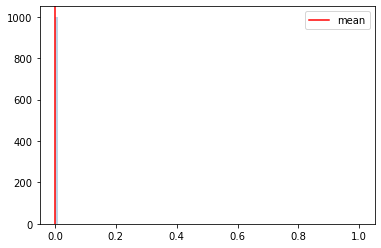

  0%|▏                                                                                | 3/1000 [00:00<00:57, 17.39it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654374815
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 0.1, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:27, 11.42it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:48,  9.15it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▉                                                                               | 11/1000 [00:01<01:45,  9.34it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:44,  9.41it/s]

Monte Carlo 11
Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<01:42,  9.58it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:01<01:48,  9.09it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<01:53,  8.63it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<01:51,  8.76it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:51,  8.77it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<01:52,  8.66it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:02<01:51,  8.74it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<01:51,  8.70it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<01:55,  8.42it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<02:08,  7.53it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:03<02:05,  7.71it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:08,  7.51it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<02:03,  7.77it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<01:58,  8.09it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:04<02:02,  7.82it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:54,  8.32it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:01,  7.87it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:59,  7.97it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:05<02:02,  7.74it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:02,  7.74it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:58,  7.97it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<01:56,  8.08it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:06<01:55,  8.12it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:59,  7.84it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:04,  7.55it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<02:12,  7.07it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:15,  6.87it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:14,  6.95it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:06,  7.34it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<02:04,  7.42it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:05,  7.39it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:05,  7.38it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:06,  7.28it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:06,  7.26it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:09,  7.10it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:06,  7.23it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<02:05,  7.26it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:14,  6.79it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:09,  7.04it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:08,  7.05it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:10,  6.95it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:14,  6.73it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:13,  6.76it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:42,  5.54it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:25,  6.15it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:11,  6.78it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:10,  6.86it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:04,  7.15it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<01:59,  7.46it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<01:55,  7.68it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:04,  7.12it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:03,  7.14it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:06,  6.97it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:09,  6.80it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:04,  7.07it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:01,  7.22it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:01,  7.20it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:01,  7.16it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:03,  7.03it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:08,  6.75it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<02:04,  6.96it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:07,  6.79it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:03,  6.98it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:11,  6.52it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:12,  6.48it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:09,  6.62it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:12,  6.46it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:19<02:12,  6.43it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:20,  6.06it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:23,  5.90it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:19,  6.04it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:27,  5.71it/s]

Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:21<02:21,  5.95it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:21<02:17,  6.10it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:20,  5.96it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:22<02:20,  5.97it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:22<02:22,  5.87it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:20,  5.93it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:23<02:20,  5.89it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:23<02:25,  5.68it/s]

Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:24,  5.71it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:22,  5.79it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:24<02:22,  5.79it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:19,  5.87it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▏                                                                | 180/1000 [00:25<02:22,  5.76it/s]

Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:21,  5.76it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:22,  5.73it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:24,  5.64it/s]

Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:21,  5.74it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:26<02:16,  5.96it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:18,  5.82it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:27<02:21,  5.71it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:17,  5.87it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:21,  5.69it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:28<02:21,  5.66it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:23,  5.57it/s]

Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:20,  5.69it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 201/1000 [00:28<02:20,  5.67it/s]

Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:29<02:22,  5.60it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:18,  5.76it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:30<02:17,  5.77it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:30<02:19,  5.65it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:30<02:20,  5.60it/s]

Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:30<02:21,  5.56it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:25,  5.39it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:27,  5.31it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:29,  5.25it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:28,  5.27it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:29,  5.22it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:34,  5.06it/s]

Monte Carlo 220


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:39,  4.88it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:33<02:32,  5.08it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:28,  5.24it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:42,  4.75it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:34<02:31,  5.09it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:34<02:29,  5.16it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:29,  5.15it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:25,  5.27it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:29,  5.12it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:30,  5.09it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:30,  5.08it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:35,  4.91it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:37,  4.82it/s]

Monte Carlo 238
Monte Carlo 239


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:57,  4.28it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 241/1000 [00:36<03:03,  4.14it/s]

Monte Carlo 241


 24%|███████████████████                                                            | 242/1000 [00:37<03:04,  4.12it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:55,  4.31it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:50,  4.42it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▍                                                           | 246/1000 [00:38<02:49,  4.45it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:38<02:35,  4.82it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:27,  5.07it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:29,  5.02it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:39<02:24,  5.19it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:39<02:31,  4.92it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:40<02:30,  4.95it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:40<02:29,  4.99it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:40<02:29,  4.96it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:40<02:26,  5.05it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:25,  5.07it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:25,  5.09it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:41<02:24,  5.11it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:41<02:26,  5.04it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:23,  5.13it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:24,  5.07it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:42<02:24,  5.08it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:42<02:24,  5.07it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:27,  4.96it/s]

Monte Carlo 269
Monte Carlo 270


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:28,  4.90it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:43<02:29,  4.87it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:28,  4.89it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:23,  5.06it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:44<02:24,  4.99it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:44<02:18,  5.23it/s]

Monte Carlo 276
Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:21,  5.11it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:44<02:31,  4.74it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:45<02:26,  4.91it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:45<02:22,  5.03it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:24,  4.95it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:24,  4.95it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:20,  5.08it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:46<02:15,  5.26it/s]

Monte Carlo 286
Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:22,  4.99it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:46<02:19,  5.10it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:46<02:20,  5.06it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:47<02:19,  5.08it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:19,  5.07it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:47<02:19,  5.08it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:47<02:18,  5.09it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:21,  4.96it/s]

Monte Carlo 296
Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:26,  4.79it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:26,  4.77it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:49<02:23,  4.89it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:20,  4.96it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:19,  4.98it/s]

Monte Carlo 302
Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:49<02:22,  4.87it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:50<02:22,  4.87it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:19,  4.95it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:19,  4.94it/s]

Monte Carlo 308
Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:50<02:21,  4.87it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:51<02:29,  4.62it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:51<02:24,  4.76it/s]

Monte Carlo 312
Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:24,  4.75it/s]

Monte Carlo 314
Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:24,  4.74it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:18,  4.91it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:19,  4.88it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:15,  5.01it/s]

Monte Carlo 320
Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:18,  4.89it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:18,  4.88it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:14,  5.02it/s]

Monte Carlo 325
Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:15,  4.95it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:54<02:13,  5.02it/s]

Monte Carlo 328
Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:55<02:19,  4.78it/s]

Monte Carlo 330
Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:19,  4.79it/s]

Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:55<02:18,  4.80it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:14,  4.95it/s]

Monte Carlo 334
Monte Carlo 335


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:17,  4.81it/s]

Monte Carlo 336
Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:56<02:29,  4.43it/s]

Monte Carlo 338
Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:27,  4.47it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:32,  4.31it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:31,  4.36it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:57<02:33,  4.28it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:30,  4.37it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:32,  4.28it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:31,  4.32it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:27,  4.41it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:25,  4.49it/s]

Monte Carlo 348


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:22,  4.55it/s]

Monte Carlo 349
Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:24,  4.48it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:29,  4.34it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:00<02:26,  4.42it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:25,  4.45it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:25,  4.43it/s]

Monte Carlo 355


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:25,  4.43it/s]

Monte Carlo 356
Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:25,  4.43it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:23,  4.48it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:25,  4.39it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:24,  4.42it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:23,  4.43it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:27,  4.31it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:26,  4.34it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:31,  4.18it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:34,  4.11it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:33,  4.12it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:32,  4.14it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:28,  4.26it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:25,  4.34it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:24,  4.34it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:23,  4.37it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:31,  4.13it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:31,  4.14it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:30,  4.15it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:32,  4.08it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:30,  4.14it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:06<02:31,  4.09it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:36,  3.96it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:32,  4.06it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:31,  4.10it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:07<02:29,  4.14it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:34,  3.98it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:34,  3.98it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:29,  4.10it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:08<02:34,  3.97it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:34,  3.96it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:32,  4.02it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:30,  4.06it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:09<02:33,  3.98it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:09<02:35,  3.92it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:31,  4.02it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:27,  4.10it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:10<02:25,  4.18it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:10<02:25,  4.16it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:30,  4.02it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:25,  4.14it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:24,  4.17it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:11<02:20,  4.27it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:11<02:21,  4.23it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:21,  4.24it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:25,  4.10it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:34,  3.87it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:29,  3.98it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:26,  4.06it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:29,  3.97it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:13<02:31,  3.92it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:34,  3.82it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:13<02:35,  3.79it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:14<02:32,  3.87it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:14<02:31,  3.89it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<02:28,  3.95it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:27,  3.97it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:15<02:26,  4.01it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:15<02:26,  3.99it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:25,  4.01it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:15<02:24,  4.04it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:16<02:23,  4.05it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:16<02:24,  4.02it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:16<02:25,  3.99it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:16<02:26,  3.95it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:17<02:24,  4.01it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:17<02:23,  4.02it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:27,  3.90it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:17<02:27,  3.89it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:18<02:27,  3.89it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:18<02:30,  3.82it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:30,  3.81it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:31,  3.78it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:19<02:29,  3.81it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:19<02:26,  3.87it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:30,  3.76it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:33,  3.70it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:20<02:28,  3.82it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:20<02:33,  3.67it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:29,  3.76it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:30,  3.74it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:21<02:28,  3.79it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:21<02:26,  3.83it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:24,  3.89it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:22<02:25,  3.83it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:22<02:30,  3.71it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:22<02:29,  3.73it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:22<02:25,  3.82it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:23<02:29,  3.72it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:23<02:26,  3.78it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:23<02:33,  3.60it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:23<02:32,  3.62it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:24<02:32,  3.60it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:24<02:37,  3.50it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:33,  3.57it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:25<02:31,  3.62it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:25<02:35,  3.52it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:25<02:35,  3.52it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:30,  3.62it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:26<02:29,  3.64it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:26<02:27,  3.68it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:26<02:27,  3.68it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:26,  3.70it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:27<02:23,  3.76it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:27<02:26,  3.67it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:24,  3.74it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:28<02:25,  3.68it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:28<02:24,  3.71it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:28<02:24,  3.69it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:28<02:22,  3.75it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:29<02:24,  3.69it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:29<02:49,  3.14it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:29<02:43,  3.24it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:30<02:37,  3.36it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:30<02:37,  3.36it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:30<02:37,  3.36it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:31<02:33,  3.42it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:31<02:34,  3.41it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:31<02:31,  3.47it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:31<02:28,  3.53it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:32<02:31,  3.46it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:32<02:28,  3.50it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:32<02:27,  3.54it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:32<02:25,  3.56it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:33<02:25,  3.56it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:33<02:23,  3.60it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:33<02:20,  3.68it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:34<02:17,  3.74it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:34<02:17,  3.75it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:34<02:20,  3.67it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:34<02:18,  3.71it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:35<02:20,  3.65it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:35<02:25,  3.51it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:35<02:23,  3.56it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:36<02:22,  3.56it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:36<02:19,  3.63it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:36<02:18,  3.67it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:36<02:17,  3.68it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:37<02:15,  3.72it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:37<02:17,  3.66it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:37<02:16,  3.70it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:37<02:18,  3.62it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:38<02:16,  3.68it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:38<02:19,  3.59it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:38<02:17,  3.62it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:39<02:17,  3.63it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:39<02:21,  3.52it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:39<02:21,  3.50it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:39<02:20,  3.52it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:40<02:21,  3.50it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:40<02:19,  3.53it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:40<02:19,  3.53it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:41<02:19,  3.51it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:41<02:21,  3.46it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:41<02:20,  3.49it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:41<02:18,  3.51it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:42<02:16,  3.56it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:42<02:17,  3.53it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:42<02:16,  3.55it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:43<02:22,  3.39it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:43<02:24,  3.33it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:43<02:23,  3.37it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:43<02:19,  3.46it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:44<02:21,  3.40it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:44<02:20,  3.41it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:44<02:20,  3.40it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:45<02:22,  3.35it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:45<02:21,  3.36it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:45<02:23,  3.32it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:46<02:19,  3.40it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:46<02:23,  3.30it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:46<02:24,  3.27it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:46<02:20,  3.36it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:47<02:17,  3.42it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:47<02:21,  3.31it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:47<02:23,  3.27it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:48<02:23,  3.26it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:48<02:21,  3.29it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:48<02:18,  3.36it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:49<02:16,  3.39it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:49<02:17,  3.36it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:49<02:18,  3.34it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:49<02:17,  3.34it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:50<02:17,  3.34it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:50<02:18,  3.32it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:50<02:17,  3.34it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:51<02:20,  3.26it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:51<02:18,  3.28it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:51<02:21,  3.22it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:52<02:19,  3.25it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:52<02:19,  3.24it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:52<02:18,  3.26it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:53<02:20,  3.20it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:53<02:20,  3.21it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:53<02:19,  3.22it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:53<02:18,  3.24it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:54<02:22,  3.13it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:54<02:22,  3.13it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:54<02:22,  3.13it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:55<02:20,  3.17it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:55<02:17,  3.22it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:55<02:17,  3.21it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:56<02:17,  3.21it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:56<02:16,  3.23it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:56<02:14,  3.25it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:57<02:13,  3.28it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:57<02:11,  3.31it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:57<02:14,  3.24it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:57<02:12,  3.28it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:58<02:12,  3.29it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:58<02:12,  3.27it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:58<02:10,  3.31it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:59<02:10,  3.30it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:59<02:14,  3.20it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:59<02:13,  3.23it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:00<02:16,  3.14it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:00<02:16,  3.14it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:00<02:17,  3.10it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:01<02:17,  3.10it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:01<02:17,  3.07it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:01<02:17,  3.08it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:02<02:16,  3.09it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:02<02:15,  3.11it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:02<02:13,  3.15it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:03<02:10,  3.21it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:03<02:09,  3.23it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:03<02:11,  3.17it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:03<02:10,  3.19it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:04<02:10,  3.18it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:04<02:12,  3.12it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:04<02:16,  3.03it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:05<02:27,  2.79it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:05<02:23,  2.86it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:06<02:19,  2.94it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:06<02:16,  2.99it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:06<02:10,  3.12it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:06<02:08,  3.17it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:07<02:24,  2.81it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:07<02:21,  2.86it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:08<02:16,  2.97it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:08<02:17,  2.94it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:08<02:12,  3.03it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:09<02:10,  3.07it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:09<02:10,  3.07it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:09<02:08,  3.10it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:09<02:02,  3.25it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:10<02:02,  3.24it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:10<02:02,  3.24it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:10<01:59,  3.30it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:11<01:57,  3.35it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:11<01:57,  3.35it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:11<01:57,  3.35it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:12<01:58,  3.29it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:12<01:57,  3.33it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:12<01:58,  3.28it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:12<01:59,  3.25it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:13<02:02,  3.17it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:13<02:07,  3.04it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:13<02:01,  3.16it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:14<02:01,  3.17it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:14<02:02,  3.12it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:14<02:05,  3.04it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:15<02:09,  2.94it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:15<02:08,  2.97it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:15<02:04,  3.04it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:16<02:10,  2.91it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:16<02:07,  2.96it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:16<02:05,  3.01it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:17<02:05,  2.99it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:17<02:08,  2.91it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:18<02:09,  2.89it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:18<02:05,  2.95it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:18<02:04,  2.98it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:18<02:01,  3.03it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:19<02:04,  2.96it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:19<02:02,  3.00it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:20<02:03,  2.96it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:20<02:03,  2.95it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:20<02:01,  3.02it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:21<02:02,  2.97it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:21<02:00,  3.02it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:21<02:03,  2.93it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:22<02:04,  2.89it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:22<02:02,  2.95it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:22<02:00,  2.99it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:23<02:03,  2.89it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:23<02:01,  2.95it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:23<02:01,  2.93it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:24<01:59,  2.97it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:24<01:59,  2.96it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:24<01:58,  2.99it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:25<01:58,  2.98it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:25<01:58,  2.96it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:25<01:58,  2.96it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:26<01:55,  3.02it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:26<01:56,  3.00it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:26<01:51,  3.11it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:27<01:53,  3.06it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:27<01:55,  2.99it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:27<01:51,  3.07it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:28<01:49,  3.12it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:28<01:49,  3.13it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:28<01:48,  3.13it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:28<01:50,  3.08it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:29<01:50,  3.07it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:29<01:49,  3.09it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:29<01:48,  3.11it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:30<01:50,  3.04it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:30<01:49,  3.05it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:30<01:47,  3.11it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:31<01:48,  3.06it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:31<01:49,  3.03it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:31<01:47,  3.07it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:32<01:46,  3.10it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:32<01:47,  3.05it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:32<01:45,  3.12it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:33<01:43,  3.16it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:33<01:45,  3.10it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:33<01:45,  3.07it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:34<01:44,  3.10it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:34<01:43,  3.11it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:34<01:44,  3.07it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:35<01:44,  3.09it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:35<01:43,  3.09it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:35<01:43,  3.08it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:36<01:44,  3.05it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:36<01:42,  3.09it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:36<01:42,  3.09it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:37<01:41,  3.11it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:37<01:41,  3.10it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:37<01:42,  3.06it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:38<01:43,  3.00it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:38<01:42,  3.05it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:38<01:41,  3.07it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:39<01:42,  3.03it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:39<01:42,  3.00it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:39<01:44,  2.94it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:40<01:46,  2.88it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:40<01:44,  2.92it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:40<01:44,  2.92it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:41<01:42,  2.95it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:41<01:42,  2.94it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:41<01:43,  2.91it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:42<01:58,  2.53it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:42<01:54,  2.60it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:43<01:53,  2.64it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:43<01:51,  2.66it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:43<01:49,  2.71it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:44<01:45,  2.79it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:44<01:47,  2.74it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:44<01:46,  2.76it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:45<01:43,  2.82it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:45<01:45,  2.77it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:45<01:45,  2.75it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:46<01:42,  2.83it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:46<01:41,  2.85it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:46<01:40,  2.84it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:47<01:39,  2.86it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:47<01:42,  2.78it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:48<01:42,  2.78it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:48<01:45,  2.68it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:48<01:44,  2.70it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:49<01:44,  2.68it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:49<01:45,  2.65it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:49<01:45,  2.64it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:50<01:45,  2.65it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:50<01:45,  2.62it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:51<01:46,  2.58it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:51<01:47,  2.56it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:51<01:47,  2.54it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:52<01:49,  2.49it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:52<01:50,  2.45it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:53<01:49,  2.49it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:53<01:47,  2.50it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:53<01:47,  2.49it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:54<01:46,  2.51it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:54<01:42,  2.61it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:55<01:41,  2.62it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:55<01:40,  2.64it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:55<01:38,  2.68it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:56<01:35,  2.74it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:56<01:34,  2.76it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:56<01:34,  2.75it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:57<01:34,  2.76it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:57<01:35,  2.71it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:57<01:34,  2.73it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:58<01:34,  2.71it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:58<01:34,  2.71it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:59<01:33,  2.74it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:59<01:33,  2.72it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:59<01:33,  2.70it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:00<01:35,  2.64it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:00<01:32,  2.72it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:00<01:31,  2.72it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:01<01:31,  2.71it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:01<01:31,  2.71it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:02<01:32,  2.67it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:02<01:31,  2.70it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:02<01:28,  2.76it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:03<01:28,  2.75it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:03<01:28,  2.75it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:03<01:26,  2.79it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:04<01:26,  2.80it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:04<01:25,  2.80it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:04<01:26,  2.75it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:05<01:27,  2.72it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:05<01:28,  2.68it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:06<01:31,  2.59it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:06<01:28,  2.64it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:06<01:27,  2.67it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:07<01:29,  2.61it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:07<01:29,  2.60it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:08<01:28,  2.62it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:08<01:27,  2.64it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:08<01:26,  2.65it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:09<01:25,  2.68it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:09<01:25,  2.65it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:09<01:25,  2.63it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:10<01:25,  2.64it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:10<01:23,  2.68it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:11<01:25,  2.60it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:11<01:24,  2.64it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:11<01:22,  2.67it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:12<01:22,  2.67it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:12<01:22,  2.66it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:12<01:22,  2.65it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:13<01:21,  2.66it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:13<01:21,  2.66it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:14<01:20,  2.69it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:14<01:20,  2.66it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:14<01:18,  2.70it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:15<01:19,  2.67it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:15<01:20,  2.62it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:15<01:20,  2.62it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:16<01:20,  2.59it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:16<01:19,  2.63it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:17<01:18,  2.62it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:17<01:18,  2.61it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:17<01:16,  2.67it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:18<01:17,  2.64it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:18<01:18,  2.58it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:19<01:17,  2.59it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:19<01:17,  2.59it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:19<01:17,  2.57it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:20<01:16,  2.59it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:20<01:17,  2.57it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:20<01:17,  2.55it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:21<01:15,  2.60it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:21<01:15,  2.57it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:22<01:14,  2.59it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:22<01:14,  2.59it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:22<01:20,  2.39it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:23<01:17,  2.46it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:23<01:15,  2.51it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:24<01:17,  2.44it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:24<01:15,  2.49it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:24<01:14,  2.50it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:25<01:16,  2.42it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:25<01:15,  2.46it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:26<01:14,  2.46it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:26<01:12,  2.52it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:26<01:11,  2.55it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:27<01:08,  2.64it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:27<01:08,  2.64it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:28<01:07,  2.65it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:28<01:06,  2.66it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:28<01:07,  2.64it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:29<01:06,  2.64it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:29<01:05,  2.69it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:29<01:06,  2.63it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:30<01:07,  2.58it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:30<01:07,  2.54it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:31<01:07,  2.54it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:31<01:05,  2.59it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:31<01:04,  2.60it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:32<01:03,  2.63it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:32<01:03,  2.63it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:33<01:04,  2.57it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:33<01:03,  2.59it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:33<01:02,  2.62it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:34<01:02,  2.62it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:34<01:01,  2.65it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:34<01:01,  2.63it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:35<01:01,  2.60it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:35<01:00,  2.65it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:36<01:01,  2.58it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:36<01:01,  2.54it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:36<01:00,  2.58it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:37<00:59,  2.63it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:37<00:58,  2.65it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:38<01:00,  2.54it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:38<00:59,  2.56it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:38<00:58,  2.57it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:39<00:58,  2.56it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:39<00:57,  2.58it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:39<00:56,  2.61it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:40<00:57,  2.56it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:40<00:55,  2.61it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:41<00:55,  2.62it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:41<00:55,  2.58it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:41<00:56,  2.55it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:42<00:56,  2.53it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:42<00:55,  2.52it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:43<00:55,  2.51it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:43<00:56,  2.48it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:44<00:57,  2.40it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:44<00:57,  2.39it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:44<00:57,  2.37it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:45<00:56,  2.38it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:45<00:56,  2.37it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:46<00:56,  2.37it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:46<00:55,  2.38it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:46<00:54,  2.40it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:47<00:54,  2.40it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:47<00:54,  2.36it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:48<00:53,  2.39it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:48<00:55,  2.31it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:49<00:54,  2.33it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:49<00:53,  2.35it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:49<00:51,  2.39it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:50<00:50,  2.43it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:50<00:51,  2.38it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:51<00:50,  2.39it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:51<00:50,  2.37it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:52<00:49,  2.40it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:52<00:49,  2.40it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:52<00:48,  2.41it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:53<00:47,  2.42it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:53<00:48,  2.36it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:54<00:48,  2.35it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:54<00:47,  2.37it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:54<00:47,  2.37it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:55<00:47,  2.34it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:55<00:46,  2.36it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:56<00:45,  2.37it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:56<00:45,  2.39it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:57<00:44,  2.39it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:57<00:44,  2.39it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:58<00:47,  2.22it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:58<00:45,  2.27it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:58<00:44,  2.30it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:59<00:44,  2.30it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:59<00:44,  2.29it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:00<00:42,  2.33it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:00<00:42,  2.35it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:00<00:42,  2.32it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:01<00:41,  2.31it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:01<00:40,  2.34it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:02<00:40,  2.36it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:02<00:39,  2.36it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:03<00:39,  2.34it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:03<00:39,  2.31it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:03<00:39,  2.32it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:04<00:39,  2.29it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:04<00:40,  2.21it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:05<00:38,  2.26it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:05<00:38,  2.28it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:06<00:37,  2.28it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:06<00:37,  2.28it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:07<00:38,  2.21it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:07<00:37,  2.21it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:08<00:36,  2.22it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:08<00:36,  2.23it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:08<00:35,  2.24it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:09<00:35,  2.25it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:09<00:34,  2.26it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:10<00:33,  2.27it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:10<00:34,  2.22it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:11<00:33,  2.24it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:11<00:32,  2.27it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:12<00:31,  2.30it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:12<00:31,  2.31it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:12<00:30,  2.29it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:13<00:30,  2.32it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:13<00:29,  2.32it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:14<00:29,  2.31it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:14<00:30,  2.22it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:15<00:29,  2.25it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:15<00:28,  2.28it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:15<00:28,  2.22it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:16<00:28,  2.25it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:16<00:27,  2.26it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:17<00:26,  2.27it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:17<00:26,  2.26it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:18<00:26,  2.25it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:18<00:25,  2.28it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:19<00:25,  2.22it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:19<00:24,  2.25it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:19<00:24,  2.25it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:20<00:24,  2.24it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:20<00:23,  2.25it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:21<00:22,  2.27it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:21<00:22,  2.24it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:22<00:22,  2.21it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:22<00:21,  2.23it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:23<00:21,  2.25it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:23<00:20,  2.25it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:23<00:20,  2.27it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:24<00:19,  2.28it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:24<00:19,  2.28it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:25<00:18,  2.27it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:25<00:18,  2.25it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:26<00:18,  2.26it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:26<00:17,  2.25it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:27<00:17,  2.24it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:27<00:16,  2.27it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:27<00:16,  2.27it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:28<00:15,  2.26it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:28<00:15,  2.22it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:29<00:15,  2.18it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:29<00:15,  2.18it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:30<00:14,  2.18it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:30<00:14,  2.20it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:31<00:13,  2.23it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:31<00:13,  2.21it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:32<00:12,  2.21it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:32<00:12,  2.19it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:32<00:11,  2.18it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:33<00:11,  2.20it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:33<00:10,  2.21it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:34<00:10,  2.21it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:34<00:10,  2.17it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:35<00:09,  2.20it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:35<00:09,  2.19it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:36<00:08,  2.20it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:36<00:08,  2.20it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:37<00:07,  2.19it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:37<00:07,  2.18it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:38<00:07,  2.08it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:38<00:06,  2.14it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:38<00:06,  2.14it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:39<00:05,  2.17it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:39<00:05,  2.16it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:40<00:04,  2.15it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:40<00:04,  2.14it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:41<00:03,  2.16it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:41<00:03,  2.19it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:42<00:02,  2.16it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:42<00:02,  2.18it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:43<00:01,  2.17it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:43<00:01,  2.21it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:44<00:00,  2.19it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:44<00:00,  2.16it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:44<00:00,  3.51it/s]


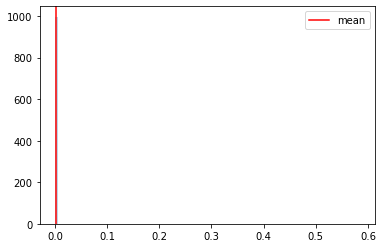

  0%|▏                                                                                | 3/1000 [00:00<00:55, 18.12it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654375101
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 0.1, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:18, 12.68it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▌                                                                                | 7/1000 [00:00<01:45,  9.37it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▉                                                                               | 11/1000 [00:01<01:44,  9.45it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:46,  9.28it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:46,  9.25it/s]

Monte Carlo 13
Monte Carlo 14
Monte Carlo 15

  2%|█▎                                                                              | 16/1000 [00:01<01:41,  9.66it/s]


Monte Carlo 16
Monte Carlo 17

  2%|█▍                                                                              | 18/1000 [00:01<01:38,  9.97it/s]


Monte Carlo 18
Monte Carlo 19

  2%|█▌                                                                              | 20/1000 [00:01<01:37, 10.05it/s]


Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:39,  9.80it/s]

Monte Carlo 21
Monte Carlo 22


  2%|██                                                                              | 25/1000 [00:02<01:39,  9.79it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:42,  9.50it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:02<01:45,  9.20it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<01:45,  9.20it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<01:50,  8.72it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<02:11,  7.32it/s]

Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:03<02:05,  7.69it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:03<01:55,  8.30it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<02:03,  7.81it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<02:07,  7.53it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:04<01:56,  8.18it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:28,  6.44it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:29,  6.39it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<02:21,  6.73it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:05<02:19,  6.79it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:13,  7.10it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:13,  7.08it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<02:17,  6.86it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:16,  6.89it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:20,  6.68it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:15,  6.93it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<02:09,  7.23it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:23,  6.51it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:15,  6.88it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:16,  6.83it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:13,  6.97it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:17,  6.72it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:20,  6.59it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:20,  6.54it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:26,  6.29it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:30,  6.08it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:11<02:43,  5.59it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:32,  5.98it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:20,  6.49it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:12<02:21,  6.43it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:23,  6.32it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:13,  6.77it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:13,  6.76it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:13<02:19,  6.46it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:15,  6.61it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:11,  6.80it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▏                                                                      | 104/1000 [00:14<02:17,  6.53it/s]

Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:14<02:32,  5.86it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:14<02:26,  6.09it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:15<02:42,  5.49it/s]

Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:15<02:34,  5.75it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<02:24,  6.15it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:23,  6.17it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:16<02:18,  6.36it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:16<02:15,  6.51it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:19,  6.30it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:17<02:19,  6.27it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:17<02:16,  6.41it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:11,  6.63it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:18<02:10,  6.66it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:18<02:06,  6.85it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:18<02:16,  6.35it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:19<02:19,  6.22it/s]

Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:19<02:21,  6.12it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:19<02:18,  6.24it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:19<02:19,  6.18it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:20<02:11,  6.50it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:20<02:14,  6.38it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:20<02:12,  6.47it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:21<02:06,  6.73it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:21<02:08,  6.62it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:21<02:17,  6.19it/s]

Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<02:16,  6.22it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:22<02:23,  5.89it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:22<02:17,  6.11it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:15,  6.22it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:23<02:23,  5.86it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:23<02:18,  6.06it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:23<02:26,  5.69it/s]

Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:24<02:27,  5.64it/s]

Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:24<02:25,  5.73it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:24<02:28,  5.60it/s]

Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:24<02:30,  5.52it/s]

Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:30,  5.50it/s]

Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:25<02:30,  5.51it/s]

Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:25<02:34,  5.36it/s]

Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:25<02:37,  5.23it/s]

Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:25<02:33,  5.37it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 176/1000 [00:25<02:28,  5.54it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:26<02:34,  5.33it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:26<02:30,  5.45it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:27<02:43,  5.00it/s]

Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:27<02:36,  5.21it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:27<02:31,  5.38it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:27<02:27,  5.52it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:28<02:32,  5.33it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:28<02:40,  5.03it/s]

Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:28<02:35,  5.18it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:29<02:34,  5.23it/s]

Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:29<02:31,  5.30it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▍                                                               | 196/1000 [00:29<02:33,  5.25it/s]

Monte Carlo 196


 20%|███████████████▌                                                               | 197/1000 [00:29<02:46,  4.81it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 198/1000 [00:30<02:52,  4.65it/s]

Monte Carlo 198


 20%|███████████████▋                                                               | 199/1000 [00:30<02:55,  4.57it/s]

Monte Carlo 199


 20%|███████████████▊                                                               | 200/1000 [00:30<02:55,  4.56it/s]

Monte Carlo 200


 20%|███████████████▉                                                               | 201/1000 [00:30<02:52,  4.63it/s]

Monte Carlo 201


 20%|███████████████▉                                                               | 202/1000 [00:31<02:46,  4.80it/s]

Monte Carlo 202


 20%|████████████████                                                               | 203/1000 [00:31<02:45,  4.82it/s]

Monte Carlo 203


 20%|████████████████                                                               | 204/1000 [00:31<02:44,  4.83it/s]

Monte Carlo 204


 20%|████████████████▏                                                              | 205/1000 [00:31<03:00,  4.40it/s]

Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:32<02:52,  4.60it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▍                                                              | 208/1000 [00:32<02:59,  4.41it/s]

Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:32<03:07,  4.22it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:33<02:55,  4.49it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:33<02:48,  4.68it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:33<02:44,  4.77it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:33<02:41,  4.87it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:34<02:37,  4.97it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:34<02:42,  4.82it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:34<02:41,  4.83it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:35<02:36,  4.98it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▌                                                             | 223/1000 [00:35<02:39,  4.88it/s]

Monte Carlo 223


 22%|█████████████████▋                                                             | 224/1000 [00:35<02:41,  4.80it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:36<02:39,  4.86it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:36<02:33,  5.02it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:36<02:33,  5.04it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 230/1000 [00:36<02:35,  4.94it/s]

Monte Carlo 230


 23%|██████████████████▏                                                            | 231/1000 [00:37<02:37,  4.87it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:37<02:35,  4.93it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:37<02:33,  4.99it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▌                                                            | 235/1000 [00:38<02:37,  4.87it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:38<02:38,  4.81it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▊                                                            | 238/1000 [00:38<02:40,  4.76it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 239/1000 [00:38<02:44,  4.62it/s]

Monte Carlo 239


 24%|██████████████████▉                                                            | 240/1000 [00:39<02:47,  4.54it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 241/1000 [00:39<02:48,  4.49it/s]

Monte Carlo 241


 24%|███████████████████                                                            | 242/1000 [00:39<02:47,  4.53it/s]

Monte Carlo 242


 24%|███████████████████▏                                                           | 243/1000 [00:39<02:46,  4.56it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 244/1000 [00:40<02:48,  4.47it/s]

Monte Carlo 244


 24%|███████████████████▎                                                           | 245/1000 [00:40<02:49,  4.45it/s]

Monte Carlo 245


 25%|███████████████████▍                                                           | 246/1000 [00:40<02:50,  4.41it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 247/1000 [00:40<02:51,  4.40it/s]

Monte Carlo 247


 25%|███████████████████▌                                                           | 248/1000 [00:40<02:55,  4.28it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:41<02:47,  4.48it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:41<02:41,  4.64it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:41<02:34,  4.83it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:41<02:31,  4.93it/s]

Monte Carlo 252
Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:42<02:39,  4.67it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:42<02:35,  4.79it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:42<02:34,  4.80it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:43<02:33,  4.84it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▍                                                          | 259/1000 [00:43<02:43,  4.52it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 260/1000 [00:43<02:47,  4.42it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:43<02:40,  4.59it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 263/1000 [00:44<02:54,  4.23it/s]

Monte Carlo 263


 26%|████████████████████▊                                                          | 264/1000 [00:44<02:54,  4.22it/s]

Monte Carlo 264


 26%|████████████████████▉                                                          | 265/1000 [00:44<02:58,  4.12it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 266/1000 [00:44<02:57,  4.13it/s]

Monte Carlo 266


 27%|█████████████████████                                                          | 267/1000 [00:45<02:59,  4.09it/s]

Monte Carlo 267


 27%|█████████████████████▏                                                         | 268/1000 [00:45<02:54,  4.20it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 269/1000 [00:45<02:48,  4.34it/s]

Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:45<02:55,  4.16it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 271/1000 [00:46<02:58,  4.08it/s]

Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:46<02:51,  4.24it/s]

Monte Carlo 272


 27%|█████████████████████▌                                                         | 273/1000 [00:46<02:48,  4.32it/s]

Monte Carlo 273


 27%|█████████████████████▋                                                         | 274/1000 [00:46<02:56,  4.11it/s]

Monte Carlo 274


 28%|█████████████████████▋                                                         | 275/1000 [00:47<03:03,  3.96it/s]

Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:47<03:03,  3.94it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:47<02:49,  4.27it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:48<02:53,  4.16it/s]

Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:48<03:03,  3.91it/s]

Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:48<03:05,  3.88it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:48<03:00,  3.98it/s]

Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:49<02:56,  4.07it/s]

Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:49<02:54,  4.10it/s]

Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:49<02:51,  4.18it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:49<02:49,  4.21it/s]

Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:50<02:45,  4.32it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:50<02:49,  4.20it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:50<02:43,  4.34it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:50<02:44,  4.31it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:51<02:38,  4.46it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:51<02:35,  4.54it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:51<02:31,  4.65it/s]

Monte Carlo 293
Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:51<02:36,  4.52it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:52<02:35,  4.53it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:52<02:29,  4.68it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:52<02:27,  4.76it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:52<02:24,  4.83it/s]

Monte Carlo 299
Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:53<02:27,  4.73it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:53<02:27,  4.72it/s]

Monte Carlo 302
Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:53<02:26,  4.77it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:53<02:25,  4.77it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:54<02:24,  4.80it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:54<02:24,  4.79it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:54<02:22,  4.84it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:55<02:24,  4.76it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:55<02:29,  4.59it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:55<02:25,  4.70it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:56<02:23,  4.77it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:56<02:22,  4.81it/s]

Monte Carlo 315
Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:56<02:26,  4.66it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:56<02:31,  4.50it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:56<02:31,  4.50it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:57<02:30,  4.52it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:57<02:25,  4.65it/s]

Monte Carlo 321
Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:57<02:31,  4.47it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:58<02:32,  4.43it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:58<02:30,  4.47it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:58<02:34,  4.37it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:58<02:27,  4.55it/s]

Monte Carlo 327
Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:59<02:30,  4.45it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:59<02:25,  4.60it/s]

Monte Carlo 330
Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:59<02:28,  4.49it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [01:00<02:31,  4.39it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [01:00<02:27,  4.50it/s]

Monte Carlo 334
Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [01:00<02:28,  4.47it/s]

Monte Carlo 336


 34%|██████████████████████████▋                                                    | 338/1000 [01:01<02:29,  4.43it/s]

Monte Carlo 337
Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [01:01<02:28,  4.45it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [01:01<02:29,  4.41it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [01:01<02:27,  4.48it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [01:02<02:24,  4.54it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [01:02<02:28,  4.44it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [01:02<02:26,  4.48it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:02<02:28,  4.42it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:03<02:26,  4.46it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:03<02:26,  4.45it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:03<02:30,  4.33it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:03<02:27,  4.41it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:03<02:32,  4.26it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:04<02:36,  4.16it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:04<02:32,  4.25it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:04<02:31,  4.27it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:04<02:31,  4.27it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:05<02:31,  4.26it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:05<02:33,  4.21it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:05<02:31,  4.25it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:05<02:36,  4.10it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:06<02:31,  4.23it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:06<02:32,  4.20it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:06<02:28,  4.31it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:06<02:50,  3.74it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:07<02:43,  3.89it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:07<02:37,  4.04it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:07<02:35,  4.10it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:07<02:29,  4.23it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:08<02:28,  4.26it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:08<02:31,  4.17it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:08<02:30,  4.20it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:08<02:32,  4.13it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:09<02:31,  4.15it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:09<02:31,  4.16it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:09<02:29,  4.18it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:09<02:29,  4.19it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:09<02:28,  4.21it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:10<02:32,  4.10it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:10<02:29,  4.16it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:10<02:27,  4.23it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:10<02:29,  4.16it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:11<02:28,  4.17it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:11<02:27,  4.19it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:11<02:26,  4.23it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:11<02:24,  4.28it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:12<02:24,  4.27it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:12<02:24,  4.26it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:12<02:25,  4.22it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:12<02:27,  4.15it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:13<02:25,  4.21it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:13<02:26,  4.18it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:13<02:27,  4.13it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:13<02:26,  4.14it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:14<02:23,  4.22it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:14<02:23,  4.24it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:14<02:25,  4.17it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:14<02:24,  4.18it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:14<02:25,  4.16it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:15<02:28,  4.07it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:15<02:28,  4.05it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:15<02:24,  4.16it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:15<02:24,  4.15it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:16<02:25,  4.10it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:16<02:31,  3.96it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:16<02:30,  3.97it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:16<02:28,  4.03it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:17<02:27,  4.03it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:17<02:23,  4.13it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:17<02:24,  4.09it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:17<02:23,  4.12it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:18<02:27,  4.00it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:18<02:23,  4.12it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:18<02:25,  4.04it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:18<02:28,  3.95it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:19<02:25,  4.04it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:19<02:24,  4.04it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:19<02:22,  4.11it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:19<02:25,  4.02it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:20<02:26,  3.98it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:20<02:24,  4.02it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:20<02:22,  4.08it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:20<02:22,  4.06it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:21<02:20,  4.11it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:21<02:19,  4.14it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:21<02:19,  4.12it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:21<02:21,  4.08it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:22<02:24,  3.98it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:22<02:24,  3.96it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:22<02:23,  4.01it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:22<02:23,  3.98it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:23<02:22,  4.00it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:23<02:21,  4.03it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:23<02:17,  4.12it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:23<02:18,  4.11it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:24<02:14,  4.21it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:24<02:13,  4.23it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:24<02:14,  4.19it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:24<02:13,  4.22it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:25<02:14,  4.18it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:25<02:17,  4.10it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:25<02:16,  4.11it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:25<02:14,  4.16it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:26<02:13,  4.19it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:26<02:14,  4.13it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:26<02:16,  4.08it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:26<02:13,  4.16it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:26<02:11,  4.21it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:27<02:10,  4.24it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:27<02:14,  4.10it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:27<02:12,  4.18it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:27<02:10,  4.22it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:28<02:11,  4.19it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:28<02:10,  4.22it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:28<02:09,  4.24it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:28<02:09,  4.23it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:29<02:15,  4.04it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:29<02:14,  4.04it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:29<02:12,  4.12it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:29<02:09,  4.20it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:30<02:06,  4.27it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:30<02:04,  4.34it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:30<02:10,  4.15it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:30<02:11,  4.08it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:31<02:16,  3.96it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:31<02:13,  4.03it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:31<02:12,  4.04it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:31<02:13,  4.00it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:32<02:12,  4.04it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:32<02:11,  4.06it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:32<02:12,  4.03it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:32<02:12,  4.01it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:33<02:11,  4.03it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:33<02:14,  3.93it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:33<02:14,  3.92it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:33<02:11,  4.01it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:34<02:09,  4.06it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:34<02:09,  4.04it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:34<02:10,  4.01it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:34<02:14,  3.88it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:35<02:13,  3.92it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:35<02:24,  3.60it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:35<02:19,  3.74it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:35<02:17,  3.76it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:36<02:17,  3.76it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:36<02:16,  3.78it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:36<02:15,  3.81it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:36<02:12,  3.88it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:37<02:10,  3.94it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:37<02:10,  3.93it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:37<02:12,  3.87it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:37<02:08,  3.97it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:38<02:11,  3.89it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:38<02:12,  3.85it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:38<02:29,  3.39it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:39<02:25,  3.48it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:39<02:21,  3.56it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:39<02:18,  3.65it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:39<02:15,  3.73it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:40<02:14,  3.74it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:40<02:14,  3.73it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:40<02:19,  3.59it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:41<02:18,  3.60it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:41<02:22,  3.50it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:41<02:27,  3.39it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:41<02:26,  3.39it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:42<02:25,  3.41it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:42<02:23,  3.45it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:42<02:25,  3.40it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:43<02:26,  3.37it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:43<02:27,  3.32it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:43<02:26,  3.36it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:44<02:24,  3.39it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:44<02:25,  3.36it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:44<02:26,  3.32it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:44<02:23,  3.40it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:45<02:24,  3.36it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:45<02:25,  3.33it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:45<02:22,  3.40it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:46<02:19,  3.45it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:46<02:18,  3.48it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:46<02:21,  3.39it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:46<02:21,  3.39it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:47<02:20,  3.40it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:47<02:21,  3.37it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:47<02:22,  3.35it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:48<02:22,  3.34it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:48<02:27,  3.22it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:48<02:23,  3.31it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:49<02:20,  3.37it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:49<02:21,  3.33it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:49<02:17,  3.42it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:49<02:19,  3.37it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:50<02:20,  3.35it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:50<02:20,  3.34it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:50<02:24,  3.22it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:51<02:25,  3.21it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:51<02:27,  3.15it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:51<02:29,  3.10it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:52<02:35,  2.99it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:52<02:31,  3.05it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:52<02:31,  3.05it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:53<02:34,  2.98it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:53<02:35,  2.96it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:53<02:39,  2.87it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:54<02:41,  2.83it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:54<02:41,  2.82it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:55<02:41,  2.82it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:55<02:43,  2.78it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:55<02:41,  2.81it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:56<02:42,  2.79it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:56<02:38,  2.85it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:56<02:29,  3.01it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:57<02:25,  3.08it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:57<02:24,  3.11it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:57<02:21,  3.15it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:57<02:20,  3.17it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:58<02:17,  3.23it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:58<02:21,  3.14it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:58<02:18,  3.19it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:59<02:19,  3.16it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:59<02:23,  3.08it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:59<02:25,  3.03it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [02:00<02:25,  3.01it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [02:00<02:23,  3.05it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [02:00<02:24,  3.02it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [02:01<02:26,  2.98it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [02:01<02:23,  3.03it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [02:01<02:22,  3.05it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:02<02:22,  3.04it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:02<02:18,  3.11it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:02<02:16,  3.16it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:03<02:14,  3.19it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:03<02:21,  3.04it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:03<02:18,  3.08it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:04<02:18,  3.08it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:04<02:15,  3.15it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:04<02:18,  3.07it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:05<02:18,  3.06it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:05<02:15,  3.13it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:05<02:13,  3.16it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:06<02:18,  3.03it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:06<02:18,  3.03it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:06<02:20,  2.99it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:07<02:18,  3.02it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:07<02:20,  2.97it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:07<02:16,  3.04it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:08<02:14,  3.09it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:08<02:13,  3.11it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:08<02:12,  3.12it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:09<02:13,  3.10it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:09<02:12,  3.09it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:09<02:11,  3.11it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:10<02:11,  3.11it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:10<02:10,  3.12it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:10<02:12,  3.08it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:10<02:10,  3.11it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:11<02:12,  3.05it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:11<02:14,  2.99it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:12<02:15,  2.96it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:12<02:11,  3.05it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:12<02:15,  2.97it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:12<02:12,  3.01it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:13<02:11,  3.04it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:13<02:10,  3.04it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:13<02:09,  3.06it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:14<02:08,  3.07it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:14<02:09,  3.05it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:14<02:08,  3.07it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:15<02:09,  3.02it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:15<02:09,  3.03it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:15<02:09,  3.02it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:16<02:22,  2.75it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:16<02:18,  2.82it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:17<02:16,  2.85it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:17<02:13,  2.90it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:17<02:12,  2.91it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:18<02:09,  2.98it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:18<02:13,  2.89it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:18<02:09,  2.96it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:19<02:10,  2.92it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:19<02:22,  2.67it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:19<02:15,  2.80it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:20<02:12,  2.85it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:20<02:09,  2.92it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:20<02:06,  2.97it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:21<02:05,  3.01it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:21<02:06,  2.95it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:21<02:05,  2.97it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:22<02:07,  2.93it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:22<02:04,  2.99it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:22<02:02,  3.03it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:23<02:01,  3.06it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:23<02:02,  3.01it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:23<02:02,  3.01it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:24<02:05,  2.93it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:24<02:06,  2.90it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:24<02:04,  2.94it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:25<02:02,  2.98it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:25<02:03,  2.93it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:25<02:01,  2.98it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:26<02:02,  2.96it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:26<02:01,  2.97it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:26<02:00,  2.97it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:27<02:02,  2.92it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:27<02:02,  2.92it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:27<02:00,  2.95it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:28<02:01,  2.93it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:28<02:03,  2.88it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:28<01:59,  2.95it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:29<02:01,  2.91it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:29<01:59,  2.94it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:29<01:57,  2.99it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:30<01:59,  2.93it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:30<01:58,  2.93it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:31<01:59,  2.91it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:31<02:01,  2.85it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:31<01:58,  2.90it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:32<01:56,  2.94it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:32<01:57,  2.93it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:32<01:54,  2.98it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:33<01:54,  2.98it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:33<01:50,  3.06it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:33<01:48,  3.13it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:33<01:46,  3.16it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:34<01:46,  3.16it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:34<01:47,  3.11it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:34<01:48,  3.08it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:35<01:48,  3.09it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:35<01:48,  3.07it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:35<01:48,  3.07it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:36<01:46,  3.12it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:36<01:45,  3.12it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:36<01:44,  3.13it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:37<01:45,  3.11it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:37<01:43,  3.16it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:37<01:45,  3.09it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:38<01:43,  3.13it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:38<01:44,  3.12it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:38<01:45,  3.07it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:39<01:43,  3.11it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:39<01:42,  3.12it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:39<01:45,  3.02it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:40<01:46,  3.00it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:40<01:48,  2.93it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:40<01:48,  2.91it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:41<01:46,  2.96it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:41<01:46,  2.96it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:41<01:43,  3.02it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:42<01:42,  3.04it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:42<01:40,  3.09it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:42<01:41,  3.06it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:43<01:42,  3.04it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:43<01:40,  3.07it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:43<01:40,  3.07it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:44<01:40,  3.04it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:44<01:43,  2.96it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:44<01:42,  2.97it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:45<01:45,  2.88it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:45<01:46,  2.85it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:45<01:43,  2.93it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:46<01:42,  2.93it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:46<01:41,  2.97it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:46<01:40,  2.98it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:47<01:42,  2.91it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:47<01:42,  2.89it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:47<01:42,  2.89it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:48<01:43,  2.86it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:48<01:44,  2.82it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:48<01:40,  2.90it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:49<01:38,  2.96it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:49<01:38,  2.95it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:49<01:38,  2.95it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:50<01:37,  2.97it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:50<01:37,  2.96it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:50<01:37,  2.94it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:51<01:36,  2.96it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:51<01:37,  2.94it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:51<01:37,  2.92it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:52<01:37,  2.91it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:52<01:36,  2.91it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:53<01:35,  2.94it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:53<01:35,  2.95it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:53<01:35,  2.93it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:54<01:34,  2.95it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:54<01:35,  2.91it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:54<01:33,  2.95it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:55<01:32,  2.96it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:55<01:35,  2.87it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:55<01:36,  2.83it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:56<01:35,  2.85it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:56<01:34,  2.87it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:56<01:44,  2.59it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:57<01:41,  2.66it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:57<01:41,  2.65it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:58<01:38,  2.71it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:58<01:37,  2.73it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:58<01:38,  2.70it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:59<01:36,  2.74it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:59<01:38,  2.67it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:59<01:40,  2.60it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:00<01:41,  2.57it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:00<01:39,  2.62it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:01<01:39,  2.59it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:01<01:38,  2.61it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:01<01:38,  2.61it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:02<01:39,  2.57it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:02<01:39,  2.56it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:03<01:41,  2.50it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:03<01:42,  2.47it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:03<01:43,  2.44it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:04<01:46,  2.36it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:04<01:46,  2.34it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:05<01:46,  2.34it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:05<01:44,  2.37it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:06<01:41,  2.43it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:06<01:37,  2.52it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:06<01:36,  2.54it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:07<01:35,  2.56it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:07<01:31,  2.65it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:07<01:30,  2.67it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:08<01:32,  2.60it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:08<01:32,  2.58it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:09<01:32,  2.57it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:09<01:32,  2.57it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:09<01:36,  2.47it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:10<01:35,  2.46it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:10<01:33,  2.52it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:11<01:32,  2.53it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:11<01:31,  2.54it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:11<01:30,  2.58it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:12<01:30,  2.57it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:12<01:30,  2.54it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:12<01:28,  2.59it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:13<01:27,  2.61it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:13<01:28,  2.57it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:14<01:26,  2.62it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:14<01:25,  2.63it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:14<01:26,  2.60it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:15<01:25,  2.61it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:15<01:24,  2.63it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:16<01:24,  2.61it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:16<01:26,  2.53it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:16<01:25,  2.55it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:17<01:25,  2.56it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:17<01:24,  2.58it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:18<01:23,  2.60it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:18<01:23,  2.59it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:18<01:24,  2.53it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:19<01:23,  2.56it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:19<01:23,  2.55it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:19<01:23,  2.54it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:20<01:24,  2.49it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:20<01:22,  2.55it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:21<01:22,  2.53it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:21<01:21,  2.55it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:21<01:19,  2.58it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:22<01:20,  2.55it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:22<01:19,  2.56it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:23<01:19,  2.55it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:23<01:18,  2.56it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:23<01:18,  2.55it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:24<01:20,  2.50it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:24<01:19,  2.51it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:25<01:17,  2.54it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:25<01:17,  2.54it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:25<01:16,  2.57it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:26<01:16,  2.54it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:26<01:18,  2.47it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:27<01:17,  2.51it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:27<01:17,  2.49it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:27<01:16,  2.50it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:28<01:16,  2.47it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:28<01:16,  2.47it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:29<01:15,  2.49it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:29<01:15,  2.49it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:29<01:16,  2.44it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:30<01:14,  2.47it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:30<01:15,  2.45it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:31<01:14,  2.46it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:31<01:15,  2.41it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:32<01:14,  2.44it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:32<01:14,  2.42it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:32<01:14,  2.41it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:33<01:12,  2.46it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:33<01:11,  2.46it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:34<01:11,  2.46it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:34<01:11,  2.43it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:34<01:11,  2.43it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:35<01:10,  2.44it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:35<01:09,  2.48it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:36<01:15,  2.27it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:36<01:14,  2.29it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:37<01:12,  2.33it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:37<01:10,  2.38it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:37<01:09,  2.40it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:38<01:07,  2.45it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:38<01:07,  2.45it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:39<01:07,  2.44it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:39<01:07,  2.42it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:39<01:07,  2.42it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:40<01:07,  2.38it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:40<01:06,  2.41it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:41<01:06,  2.40it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:41<01:05,  2.43it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:41<01:04,  2.42it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:42<01:04,  2.44it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:42<01:04,  2.40it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:43<01:03,  2.43it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:43<01:04,  2.37it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:44<01:03,  2.39it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:44<01:08,  2.19it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:45<01:06,  2.27it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:45<01:06,  2.25it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:45<01:03,  2.35it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:46<01:01,  2.39it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:46<01:00,  2.42it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:47<01:00,  2.41it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:47<01:00,  2.36it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:47<00:59,  2.40it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:48<00:59,  2.37it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:48<00:58,  2.39it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:49<00:58,  2.40it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:49<00:58,  2.39it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:49<00:57,  2.41it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:50<00:56,  2.42it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:50<00:56,  2.43it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:51<00:54,  2.46it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:51<00:56,  2.37it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:52<00:56,  2.35it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:52<00:55,  2.39it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:52<00:54,  2.42it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:53<00:53,  2.43it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:53<00:53,  2.42it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:54<00:53,  2.38it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:54<00:52,  2.40it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:54<00:53,  2.37it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:55<00:52,  2.38it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:55<00:53,  2.34it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:56<00:52,  2.34it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:56<00:51,  2.37it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:57<00:50,  2.41it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:57<00:50,  2.39it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:57<00:51,  2.32it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:58<00:49,  2.37it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:58<00:49,  2.35it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:59<00:49,  2.36it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:59<00:49,  2.34it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [04:00<00:48,  2.34it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [04:00<00:48,  2.35it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [04:00<00:48,  2.30it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [04:01<00:47,  2.32it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [04:01<00:46,  2.34it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:02<00:46,  2.36it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:02<00:45,  2.36it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:03<00:44,  2.42it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:03<00:43,  2.44it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:03<00:43,  2.42it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:04<00:42,  2.45it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:04<00:41,  2.51it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:05<00:40,  2.53it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:05<00:40,  2.51it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:05<00:39,  2.52it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:06<00:39,  2.52it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:06<00:39,  2.51it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:07<00:39,  2.49it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:07<00:38,  2.49it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:07<00:37,  2.52it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:08<00:37,  2.52it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:08<00:37,  2.50it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:09<00:37,  2.45it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:09<00:37,  2.43it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:09<00:37,  2.43it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:10<00:36,  2.42it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:10<00:36,  2.40it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:11<00:36,  2.42it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:11<00:35,  2.44it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:11<00:35,  2.42it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:12<00:34,  2.43it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:12<00:34,  2.39it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:13<00:33,  2.43it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:13<00:32,  2.46it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:13<00:32,  2.46it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:14<00:32,  2.41it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:14<00:32,  2.40it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:15<00:31,  2.43it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:15<00:30,  2.46it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:16<00:31,  2.40it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:16<00:31,  2.37it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:16<00:30,  2.40it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:17<00:30,  2.39it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:17<00:29,  2.41it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:18<00:30,  2.33it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:18<00:30,  2.29it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:19<00:29,  2.32it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:19<00:29,  2.31it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:19<00:28,  2.31it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:20<00:28,  2.29it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:20<00:27,  2.29it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:21<00:27,  2.26it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:21<00:27,  2.24it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:22<00:26,  2.27it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:22<00:26,  2.26it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:23<00:26,  2.24it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:23<00:28,  2.07it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:24<00:27,  2.09it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:24<00:25,  2.16it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:24<00:25,  2.17it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:25<00:24,  2.17it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:25<00:24,  2.20it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:26<00:23,  2.24it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:26<00:22,  2.26it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:27<00:22,  2.27it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:27<00:21,  2.28it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:28<00:20,  2.31it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:28<00:20,  2.32it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:28<00:20,  2.26it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:29<00:20,  2.20it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:29<00:19,  2.24it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:30<00:19,  2.25it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:30<00:18,  2.26it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:31<00:18,  2.23it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:31<00:17,  2.28it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:32<00:17,  2.22it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:32<00:16,  2.24it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:33<00:16,  2.20it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:33<00:16,  2.15it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:33<00:16,  2.15it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:34<00:15,  2.14it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:34<00:15,  2.14it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:35<00:14,  2.15it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:35<00:14,  2.17it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:36<00:13,  2.20it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:36<00:13,  2.23it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:37<00:12,  2.20it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:37<00:12,  2.22it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:38<00:11,  2.21it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:38<00:11,  2.21it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:38<00:10,  2.23it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:39<00:10,  2.18it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:39<00:09,  2.20it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:40<00:09,  2.18it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:40<00:09,  2.13it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:41<00:08,  2.16it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:41<00:08,  2.18it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:42<00:07,  2.16it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:42<00:07,  2.16it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:43<00:07,  2.14it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:43<00:06,  2.14it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:44<00:06,  2.15it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:44<00:05,  2.14it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:44<00:05,  2.18it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:45<00:04,  2.26it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:45<00:03,  2.27it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:46<00:03,  2.29it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:46<00:03,  2.31it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:47<00:02,  2.26it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:47<00:02,  2.27it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:48<00:01,  2.21it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:48<00:01,  2.25it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:48<00:00,  2.25it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:49<00:00,  2.28it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:49<00:00,  3.45it/s]


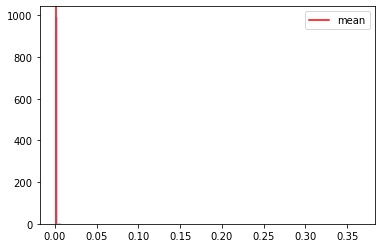

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654375391
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 0.1, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<00:58, 16.99it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:21, 12.28it/s]

Monte Carlo 5
Monte Carlo 6

  1%|▌                                                                                | 7/1000 [00:00<01:53,  8.76it/s]


Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:00<01:51,  8.86it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 11/1000 [00:01<01:55,  8.60it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<01:56,  8.50it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<02:01,  8.12it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:01<01:56,  8.45it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<01:54,  8.60it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<01:49,  8.91it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<02:16,  7.18it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<02:04,  7.86it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<02:05,  7.76it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:24,  6.73it/s]

Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:24,  6.71it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:11,  7.35it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:00,  8.03it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<01:59,  8.09it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<02:00,  7.96it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<02:01,  7.90it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<01:55,  8.28it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<01:58,  8.09it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<02:04,  7.67it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:59,  8.00it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:06<02:00,  7.87it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<02:00,  7.89it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<02:02,  7.73it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<02:09,  7.28it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<02:15,  6.94it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<02:07,  7.37it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<02:08,  7.32it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:08<02:03,  7.61it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:08<02:10,  7.16it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:08<02:15,  6.90it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:08<02:04,  7.45it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:09<02:03,  7.50it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:09<01:58,  7.82it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<01:56,  7.96it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:09<01:59,  7.73it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:10<02:07,  7.21it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:10<02:08,  7.14it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:10<02:07,  7.18it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:11<02:03,  7.37it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:11<02:01,  7.50it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:11<02:03,  7.37it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:11<02:04,  7.31it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:12<02:10,  6.95it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:12<02:10,  6.95it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:12<02:06,  7.15it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:12<02:03,  7.31it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:13<02:04,  7.19it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:13<02:06,  7.10it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:13<02:06,  7.09it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:14<02:04,  7.17it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:14<02:14,  6.64it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:14<02:10,  6.82it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:15<02:12,  6.70it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:15<02:08,  6.88it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:15<02:07,  6.90it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:15<02:13,  6.57it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:16<02:12,  6.62it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:16<02:08,  6.80it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:16<02:10,  6.71it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:17<02:09,  6.76it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:17<02:09,  6.71it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:17<02:09,  6.68it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:18<02:17,  6.32it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:18<02:17,  6.28it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:18<02:21,  6.11it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:18<02:14,  6.37it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:19<02:13,  6.42it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:19<02:09,  6.63it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:19<02:17,  6.22it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:20<02:38,  5.37it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:20<02:25,  5.83it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:20<02:19,  6.07it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:21<02:18,  6.13it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:21<02:15,  6.21it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:21<02:11,  6.41it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:22<02:13,  6.29it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:18,  6.05it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:22<02:14,  6.21it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:23<02:20,  5.96it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:25,  5.71it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:23<02:21,  5.88it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:24<02:14,  6.17it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:12,  6.24it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:14,  6.12it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:15,  6.07it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:15,  6.05it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:21,  5.79it/s]

Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:26<02:21,  5.76it/s]

Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:20,  5.80it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:17,  5.93it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:26<02:13,  6.09it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:14,  6.04it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:27<02:11,  6.12it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:09,  6.20it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:13,  6.00it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:07,  6.29it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:06,  6.32it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:08,  6.21it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:15,  5.88it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:29<02:12,  5.97it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:10,  6.07it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:08,  6.13it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:30<02:08,  6.11it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:10,  6.00it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:10,  6.02it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:06,  6.17it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:11,  5.92it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:10,  5.96it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:32<02:15,  5.74it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:14,  5.76it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:15,  5.69it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:15,  5.67it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:24,  5.33it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:22,  5.39it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:24,  5.31it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:34<02:23,  5.32it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:20,  5.45it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:18,  5.51it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:35<02:22,  5.33it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:23,  5.28it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:23,  5.26it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:36<02:23,  5.26it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:36<02:22,  5.29it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:21,  5.33it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:22,  5.28it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:21,  5.32it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▋                                                           | 249/1000 [00:37<02:21,  5.32it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:37<02:21,  5.28it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:24,  5.18it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:38<02:26,  5.09it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:38<02:25,  5.10it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:38<02:21,  5.24it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:22,  5.22it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:27,  5.02it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:39<02:25,  5.07it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:40<02:23,  5.15it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:24,  5.09it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:19,  5.27it/s]

Monte Carlo 263
Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:40<02:17,  5.35it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:20,  5.23it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:41<02:21,  5.18it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:21,  5.18it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:41<02:20,  5.21it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:41<02:18,  5.28it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:42<02:20,  5.17it/s]

Monte Carlo 272
Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:42<02:27,  4.93it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:29,  4.84it/s]

Monte Carlo 276
Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:31,  4.75it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:43<02:28,  4.83it/s]

Monte Carlo 279
Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:26,  4.90it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:25,  4.92it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:44<02:25,  4.93it/s]

Monte Carlo 283
Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:25,  4.91it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:44<02:25,  4.91it/s]

Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:26,  4.88it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:24,  4.93it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:45<02:23,  4.94it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:45<02:20,  5.05it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:46<02:23,  4.93it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:19,  5.06it/s]

Monte Carlo 292
Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:46<02:23,  4.92it/s]

Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:46<02:26,  4.82it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:29,  4.72it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:47<02:42,  4.31it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:47<02:39,  4.39it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:47<02:36,  4.47it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:37,  4.45it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:48<02:27,  4.72it/s]

Monte Carlo 302
Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:48<02:31,  4.59it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:49<02:27,  4.70it/s]

Monte Carlo 305
Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:49<02:31,  4.58it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:49<02:34,  4.47it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:49<02:34,  4.47it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:50<02:29,  4.61it/s]

Monte Carlo 310
Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:50<02:30,  4.58it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:50<02:28,  4.64it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:25,  4.70it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:51<02:25,  4.70it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:51<02:23,  4.77it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:51<02:22,  4.77it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:27,  4.62it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:26,  4.63it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:52<02:31,  4.49it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:52<02:26,  4.62it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:24,  4.66it/s]

Monte Carlo 323
Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:53<02:25,  4.65it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:53<02:34,  4.36it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:53<02:31,  4.45it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:29,  4.49it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:54<02:25,  4.61it/s]

Monte Carlo 329
Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:54<02:29,  4.47it/s]

Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:24,  4.62it/s]

Monte Carlo 332
Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:55<02:44,  4.06it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:55<02:45,  4.02it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:48,  3.95it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:45,  4.01it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:56<02:36,  4.21it/s]

Monte Carlo 338
Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:56<02:33,  4.30it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:34,  4.28it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:29,  4.40it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:57<02:24,  4.54it/s]

Monte Carlo 343
Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:29,  4.39it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:26,  4.46it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:31,  4.30it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:58<02:29,  4.37it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:58<02:24,  4.49it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:29,  4.34it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:30,  4.31it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:28,  4.36it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:59<02:27,  4.39it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:23,  4.49it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:22,  4.54it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:20,  4.58it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:00<02:24,  4.44it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:00<02:23,  4.47it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:27,  4.36it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:27,  4.35it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:24,  4.42it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:01<02:26,  4.36it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:26,  4.34it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:24,  4.41it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:24,  4.38it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:02<02:23,  4.42it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:23,  4.40it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:22,  4.45it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:20,  4.50it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:03<02:20,  4.49it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:03<02:19,  4.51it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:20,  4.45it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:19,  4.48it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:04<02:19,  4.50it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:04<02:21,  4.42it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:26,  4.25it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:24,  4.33it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:22,  4.36it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:05<02:25,  4.27it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:26,  4.24it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:23,  4.32it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:23,  4.30it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:06<02:24,  4.28it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:06<02:22,  4.31it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:26,  4.19it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:30,  4.07it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:07<02:29,  4.11it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:07<02:24,  4.22it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:26,  4.18it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:23,  4.24it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:08<02:21,  4.30it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:08<02:19,  4.36it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:19,  4.34it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:19,  4.34it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:09<02:21,  4.26it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:09<02:24,  4.18it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:25,  4.14it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:23,  4.21it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:21,  4.25it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:10<02:26,  4.10it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:10<02:23,  4.18it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:21,  4.24it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:18,  4.30it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:11<02:19,  4.26it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:11<02:27,  4.05it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:27,  4.04it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:26,  4.06it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:12<02:24,  4.09it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:12<02:22,  4.14it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:22,  4.13it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:23,  4.10it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:13<02:22,  4.12it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:13<02:21,  4.15it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:23,  4.09it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:21,  4.14it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:14<02:19,  4.18it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:14<02:25,  4.01it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:24,  4.03it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:25,  4.00it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:15<02:21,  4.09it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:15<02:25,  3.98it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:23,  4.03it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:25,  3.98it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:16<02:24,  3.98it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:16<02:23,  4.02it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:21,  4.07it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:19,  4.10it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:17<02:19,  4.11it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:17<02:22,  4.00it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:20,  4.05it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:19,  4.08it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:18<02:16,  4.15it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:18<02:34,  3.66it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:27,  3.83it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:26,  3.85it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:19<02:22,  3.96it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:19<02:19,  4.05it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:20,  3.99it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:20<02:22,  3.95it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:20<02:19,  4.00it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:20<02:18,  4.03it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:21<02:17,  4.06it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:21<02:18,  4.01it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:21<02:19,  3.99it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:21<02:25,  3.81it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:22<02:21,  3.91it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:22<02:21,  3.91it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:22<02:20,  3.93it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:22<02:20,  3.91it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:23<02:20,  3.92it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:23<02:18,  3.95it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:23<02:20,  3.89it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:23<02:23,  3.83it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:24<02:21,  3.85it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:24<02:26,  3.73it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:24<02:24,  3.77it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:25<02:19,  3.90it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:25<02:18,  3.91it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:25<02:15,  3.98it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:25<02:13,  4.03it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:26<02:16,  3.93it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:26<02:17,  3.92it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:26<02:13,  4.02it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:26<02:11,  4.08it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:27<02:14,  3.99it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:27<02:11,  4.05it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:27<02:10,  4.10it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:27<02:10,  4.07it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:27<02:07,  4.17it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:28<02:09,  4.10it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:28<02:06,  4.17it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:28<02:07,  4.14it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:28<02:06,  4.18it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:29<02:06,  4.15it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:29<02:06,  4.15it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:29<02:04,  4.20it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:29<02:05,  4.17it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:30<02:08,  4.06it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:30<02:14,  3.87it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:30<02:10,  3.98it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:30<02:10,  3.96it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:31<02:09,  4.01it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:31<02:07,  4.04it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:31<02:06,  4.08it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:31<02:10,  3.94it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:32<02:09,  3.95it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:32<02:08,  4.00it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:32<02:04,  4.10it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:32<02:04,  4.11it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:33<02:03,  4.13it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:33<02:08,  3.96it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:33<02:06,  4.00it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:33<02:08,  3.93it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:34<02:10,  3.88it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:34<02:10,  3.87it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:34<02:09,  3.90it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:34<02:09,  3.89it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:35<02:05,  4.00it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:35<02:05,  3.99it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:35<02:03,  4.05it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:35<02:01,  4.12it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:36<02:03,  4.02it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:36<02:04,  4.00it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:36<02:02,  4.05it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:36<02:00,  4.10it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:37<02:01,  4.07it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:37<02:08,  3.84it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:37<02:05,  3.91it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:37<02:06,  3.87it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:38<02:06,  3.87it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:38<02:13,  3.67it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:38<02:14,  3.63it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:39<02:13,  3.65it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:39<02:13,  3.63it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:39<02:12,  3.67it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:39<02:12,  3.66it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:40<02:11,  3.66it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:40<02:16,  3.53it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:40<02:18,  3.48it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:41<02:16,  3.52it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:41<02:15,  3.53it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:41<02:15,  3.52it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:41<02:14,  3.56it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:42<02:18,  3.44it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:42<02:17,  3.44it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:42<02:15,  3.49it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:43<02:17,  3.43it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:43<02:16,  3.47it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:43<02:16,  3.45it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:43<02:17,  3.42it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:44<02:15,  3.47it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:44<02:17,  3.41it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:44<02:13,  3.51it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:45<02:12,  3.51it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:45<02:14,  3.46it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:45<02:12,  3.50it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:45<02:17,  3.37it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:46<02:18,  3.32it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:46<02:20,  3.28it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:46<02:16,  3.38it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:47<02:18,  3.32it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:47<02:14,  3.40it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:47<02:13,  3.44it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:48<02:12,  3.45it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:48<02:15,  3.37it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:48<02:16,  3.32it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:48<02:13,  3.38it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:49<02:14,  3.35it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:49<02:14,  3.36it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:49<02:14,  3.34it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:50<02:17,  3.27it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:50<02:17,  3.26it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:50<02:18,  3.23it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:51<02:14,  3.32it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:51<02:12,  3.36it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:51<02:13,  3.32it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:52<02:17,  3.22it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:52<02:29,  2.96it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:52<02:24,  3.05it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:53<02:21,  3.12it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:53<02:21,  3.09it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:53<02:18,  3.16it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:53<02:15,  3.23it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:54<02:16,  3.20it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:54<02:17,  3.17it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:54<02:17,  3.15it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:55<02:14,  3.22it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:55<02:17,  3.15it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:55<02:15,  3.18it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:56<02:11,  3.28it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:56<02:19,  3.09it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:56<02:17,  3.11it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:57<02:13,  3.20it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:57<02:13,  3.18it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:57<02:11,  3.22it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:58<02:12,  3.20it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:58<02:11,  3.23it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:58<02:10,  3.22it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:58<02:10,  3.23it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:59<02:09,  3.25it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:59<02:09,  3.24it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:59<02:08,  3.25it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:00<02:06,  3.28it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:00<02:05,  3.32it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:00<02:04,  3.32it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:01<02:05,  3.31it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:01<02:04,  3.31it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:01<02:07,  3.24it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:02<02:10,  3.16it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:02<02:10,  3.13it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:02<02:08,  3.19it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:02<02:07,  3.19it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:03<02:05,  3.24it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:03<02:07,  3.19it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:03<02:05,  3.22it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:04<02:07,  3.17it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:04<02:07,  3.15it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:04<02:07,  3.15it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:05<02:09,  3.08it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:05<02:06,  3.15it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:05<02:08,  3.10it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:06<02:09,  3.08it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:06<02:07,  3.12it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:06<02:09,  3.06it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:07<02:07,  3.09it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:07<02:08,  3.06it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:07<02:09,  3.03it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:08<02:06,  3.10it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:08<02:06,  3.09it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:08<02:05,  3.11it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:09<02:06,  3.09it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:09<02:08,  3.02it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:09<02:06,  3.06it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:10<02:02,  3.14it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:10<02:09,  2.97it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:10<02:05,  3.06it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:11<02:02,  3.12it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:11<02:04,  3.08it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:11<02:03,  3.08it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:12<02:04,  3.06it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:12<02:00,  3.14it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:12<01:58,  3.18it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:12<01:58,  3.19it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:13<01:59,  3.13it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:13<01:58,  3.16it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:13<01:58,  3.15it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:14<01:59,  3.13it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:14<02:00,  3.09it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:14<01:57,  3.15it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:15<02:02,  3.01it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:15<02:02,  3.01it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:15<02:01,  3.03it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:16<01:58,  3.09it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:16<02:00,  3.03it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:16<01:59,  3.06it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:17<01:58,  3.08it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:17<01:59,  3.05it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:17<01:58,  3.05it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:18<02:00,  3.01it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:18<01:59,  3.02it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:18<01:57,  3.05it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:19<01:57,  3.04it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:19<01:58,  3.02it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:19<01:58,  3.01it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:20<01:56,  3.05it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:20<01:58,  2.99it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:20<01:58,  2.98it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:21<01:58,  2.97it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:21<02:00,  2.91it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:21<01:58,  2.96it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:22<01:58,  2.95it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:22<01:55,  3.01it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:22<01:58,  2.92it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:23<01:56,  2.98it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:23<01:54,  3.01it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:23<01:56,  2.96it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:24<01:53,  3.03it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:24<01:55,  2.96it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:24<01:55,  2.95it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:25<01:54,  2.97it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:25<01:58,  2.87it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:25<01:56,  2.91it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:26<01:55,  2.91it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:26<01:53,  2.97it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:26<01:54,  2.93it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:27<01:56,  2.88it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:27<01:54,  2.90it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:27<01:54,  2.90it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:28<01:53,  2.91it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:28<01:54,  2.88it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:29<02:02,  2.68it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:29<02:12,  2.48it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:29<02:02,  2.66it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:30<01:59,  2.73it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:30<01:59,  2.72it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:30<01:57,  2.76it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:31<01:55,  2.80it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:31<01:53,  2.84it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:32<01:53,  2.82it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:32<01:50,  2.91it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:32<01:49,  2.90it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:33<01:48,  2.93it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:33<01:47,  2.95it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:33<01:48,  2.91it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:34<01:47,  2.93it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:34<01:46,  2.95it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:34<01:49,  2.86it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:35<01:47,  2.90it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:35<01:46,  2.92it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:35<01:48,  2.85it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:36<01:52,  2.74it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:36<01:48,  2.84it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:36<01:48,  2.82it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:37<01:48,  2.83it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:37<01:48,  2.81it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:37<01:46,  2.86it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:38<01:46,  2.85it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:38<01:44,  2.88it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:38<01:45,  2.86it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:39<01:46,  2.83it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:39<01:45,  2.82it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:40<01:46,  2.79it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:40<01:44,  2.84it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:40<01:42,  2.89it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:41<01:41,  2.90it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:41<01:39,  2.94it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:41<01:43,  2.83it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:42<01:40,  2.89it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:42<01:40,  2.88it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:42<01:41,  2.87it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:43<01:41,  2.85it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:43<01:41,  2.83it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:43<01:42,  2.81it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:44<01:39,  2.86it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:44<01:43,  2.76it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:44<01:40,  2.82it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:45<01:40,  2.82it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:45<01:39,  2.83it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:46<01:39,  2.82it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:46<01:37,  2.87it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:46<01:39,  2.81it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:47<01:38,  2.83it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:47<01:38,  2.82it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:47<01:38,  2.79it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:48<01:37,  2.82it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:48<01:36,  2.83it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:48<01:39,  2.74it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:49<01:37,  2.80it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:49<01:35,  2.82it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:49<01:35,  2.84it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:50<01:34,  2.86it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:50<01:33,  2.88it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:50<01:32,  2.89it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:51<01:32,  2.88it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:51<01:35,  2.78it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:52<01:34,  2.80it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:52<01:34,  2.78it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:52<01:34,  2.76it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:53<01:33,  2.78it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:53<01:35,  2.73it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:53<01:35,  2.71it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:54<01:34,  2.73it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:54<01:33,  2.74it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:54<01:31,  2.79it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:55<01:31,  2.79it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:55<01:32,  2.75it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:56<01:30,  2.79it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:56<01:32,  2.72it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:56<01:30,  2.77it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:57<01:31,  2.73it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:57<01:29,  2.78it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:57<01:28,  2.79it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:58<01:28,  2.80it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:58<01:27,  2.81it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:58<01:29,  2.73it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:59<01:29,  2.74it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:59<01:27,  2.77it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:00<01:26,  2.78it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:00<01:27,  2.74it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:00<01:26,  2.77it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:01<01:26,  2.77it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:01<01:25,  2.79it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:01<01:26,  2.74it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:02<01:28,  2.65it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:02<01:26,  2.72it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:02<01:25,  2.73it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:03<01:26,  2.70it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:03<01:26,  2.70it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:04<01:24,  2.73it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:04<01:23,  2.74it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:04<01:23,  2.74it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:05<01:23,  2.74it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:05<01:22,  2.74it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:05<01:24,  2.68it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:06<01:24,  2.67it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:06<01:23,  2.67it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:07<01:24,  2.65it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:07<01:20,  2.74it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:07<01:18,  2.82it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:08<01:16,  2.87it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:08<01:15,  2.91it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:08<01:14,  2.94it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:09<01:13,  2.94it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:09<01:14,  2.91it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:09<01:13,  2.93it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:10<01:14,  2.86it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:10<01:15,  2.84it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:10<01:14,  2.83it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:11<01:16,  2.76it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:11<01:14,  2.80it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:11<01:15,  2.77it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:12<01:14,  2.80it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:12<01:13,  2.81it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:13<01:21,  2.54it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:13<01:18,  2.61it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:13<01:15,  2.69it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:14<01:13,  2.75it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:14<01:11,  2.81it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:14<01:10,  2.85it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:15<01:10,  2.83it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:15<01:09,  2.86it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:15<01:09,  2.86it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:16<01:09,  2.82it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:16<01:08,  2.86it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:16<01:08,  2.86it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:17<01:08,  2.85it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:17<01:09,  2.77it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:17<01:07,  2.84it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:18<01:11,  2.67it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:18<01:12,  2.61it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:19<01:17,  2.43it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:19<01:19,  2.38it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:20<01:17,  2.40it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:20<01:18,  2.38it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:21<01:18,  2.36it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:21<01:17,  2.38it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:21<01:16,  2.39it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:22<01:16,  2.39it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:22<01:17,  2.35it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:23<01:16,  2.36it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:23<01:14,  2.39it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:23<01:14,  2.39it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:24<01:13,  2.40it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:24<01:12,  2.43it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:25<01:13,  2.39it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:25<01:13,  2.37it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:26<01:16,  2.27it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:26<01:16,  2.26it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:27<01:16,  2.24it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:27<01:15,  2.25it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:27<01:18,  2.16it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:28<01:17,  2.16it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:28<01:16,  2.17it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:29<01:13,  2.25it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:29<01:11,  2.30it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:30<01:10,  2.31it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:30<01:09,  2.34it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:30<01:09,  2.33it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:31<01:08,  2.34it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:31<01:08,  2.35it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:32<01:07,  2.36it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:32<01:06,  2.36it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:33<01:08,  2.30it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:33<01:09,  2.25it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:34<01:09,  2.22it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:34<01:09,  2.22it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:34<01:07,  2.27it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:35<01:07,  2.25it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:35<01:05,  2.30it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:36<01:03,  2.35it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:36<01:03,  2.34it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:37<01:04,  2.28it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:37<01:04,  2.28it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:37<01:04,  2.25it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:38<01:05,  2.22it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:38<01:06,  2.18it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:39<01:05,  2.19it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:39<01:02,  2.26it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:40<01:02,  2.24it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:40<01:01,  2.28it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:41<01:00,  2.28it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:41<00:59,  2.31it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:41<00:58,  2.33it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:42<00:59,  2.28it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:42<00:57,  2.33it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:43<00:58,  2.29it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:43<00:59,  2.25it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:44<00:59,  2.22it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:44<00:59,  2.20it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:45<00:58,  2.21it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:45<00:59,  2.16it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:46<00:59,  2.15it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:46<00:58,  2.18it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:46<00:59,  2.13it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:47<00:55,  2.24it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:47<00:55,  2.25it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:48<00:56,  2.20it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:48<00:54,  2.24it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:49<00:54,  2.24it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:49<00:54,  2.22it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:50<00:53,  2.21it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:50<00:54,  2.18it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:51<00:53,  2.17it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:51<00:55,  2.07it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:52<00:54,  2.13it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:52<00:51,  2.21it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:52<00:50,  2.22it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:53<00:50,  2.23it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:53<00:50,  2.21it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:54<00:49,  2.23it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:54<00:49,  2.22it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:55<00:49,  2.18it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:55<00:48,  2.19it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:56<00:47,  2.22it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:56<00:47,  2.20it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:56<00:46,  2.25it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:57<00:46,  2.24it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:57<00:45,  2.25it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:58<00:44,  2.25it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:58<00:44,  2.23it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:59<00:44,  2.23it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:59<00:43,  2.23it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:00<00:43,  2.21it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:00<00:43,  2.21it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:00<00:42,  2.23it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:01<00:41,  2.29it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:01<00:40,  2.31it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:02<00:39,  2.31it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:02<00:38,  2.35it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:03<00:38,  2.35it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:03<00:37,  2.35it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:03<00:37,  2.35it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:04<00:36,  2.35it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:04<00:36,  2.39it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:05<00:35,  2.38it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:05<00:35,  2.40it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:05<00:34,  2.38it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:06<00:35,  2.33it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:06<00:34,  2.35it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:07<00:33,  2.36it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:07<00:33,  2.37it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:08<00:32,  2.38it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:08<00:32,  2.38it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:08<00:31,  2.38it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:09<00:31,  2.37it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:09<00:31,  2.37it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:10<00:31,  2.34it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:10<00:30,  2.37it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:11<00:30,  2.36it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:11<00:29,  2.36it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:11<00:29,  2.36it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:12<00:28,  2.37it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:12<00:28,  2.36it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:13<00:28,  2.35it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:13<00:27,  2.33it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:14<00:27,  2.34it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:14<00:27,  2.31it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:14<00:26,  2.32it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:15<00:25,  2.36it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:15<00:25,  2.35it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:16<00:25,  2.34it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:16<00:25,  2.31it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:17<00:24,  2.32it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:17<00:24,  2.31it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:17<00:23,  2.32it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:18<00:23,  2.33it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:18<00:22,  2.36it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:19<00:22,  2.34it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:19<00:21,  2.40it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:19<00:20,  2.46it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:20<00:20,  2.44it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:20<00:19,  2.42it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:21<00:18,  2.47it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:21<00:18,  2.52it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:22<00:18,  2.48it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:22<00:17,  2.48it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:22<00:17,  2.49it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:23<00:16,  2.49it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:23<00:16,  2.48it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:24<00:16,  2.40it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:24<00:16,  2.37it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:24<00:15,  2.39it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:25<00:15,  2.37it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:25<00:15,  2.38it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:26<00:15,  2.29it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:26<00:14,  2.32it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:27<00:14,  2.35it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:27<00:13,  2.30it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:27<00:13,  2.25it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:28<00:13,  2.23it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:28<00:12,  2.28it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:29<00:12,  2.30it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:29<00:11,  2.29it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:30<00:11,  2.28it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:30<00:10,  2.30it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:31<00:11,  2.11it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:31<00:10,  2.14it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:32<00:10,  2.17it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:32<00:09,  2.20it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:32<00:08,  2.23it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:33<00:08,  2.27it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:33<00:07,  2.29it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:34<00:07,  2.30it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:34<00:06,  2.29it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:35<00:06,  2.30it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:35<00:06,  2.29it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:35<00:05,  2.31it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:36<00:05,  2.29it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:36<00:04,  2.29it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:37<00:04,  2.28it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:37<00:04,  2.23it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:38<00:03,  2.25it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:38<00:03,  2.24it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:39<00:02,  2.27it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:39<00:02,  2.27it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:39<00:01,  2.29it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:40<00:01,  2.29it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:40<00:00,  2.28it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:41<00:00,  2.33it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:41<00:00,  3.55it/s]


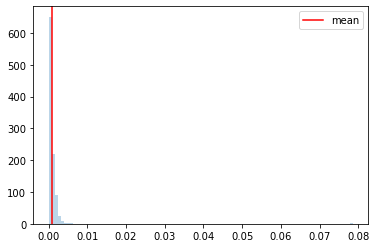

  0%|▏                                                                                | 3/1000 [00:00<01:03, 15.59it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654375674
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 1.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:23, 11.91it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:49,  9.05it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:46,  9.31it/s]

Monte Carlo 9
Monte Carlo 10


  1%|█                                                                               | 13/1000 [00:01<01:39,  9.93it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:39,  9.91it/s]

Monte Carlo 13
Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:01<01:39,  9.86it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:01<01:49,  8.99it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▊                                                                              | 22/1000 [00:02<01:44,  9.32it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:44,  9.35it/s]

Monte Carlo 22
Monte Carlo 23
Monte Carlo 24


  3%|██▏                                                                             | 27/1000 [00:02<01:45,  9.23it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:02<01:43,  9.38it/s]

Monte Carlo 27
Monte Carlo 28
Monte Carlo 29

  3%|██▍                                                                             | 30/1000 [00:03<01:40,  9.68it/s]


Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<01:44,  9.24it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<01:58,  8.15it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 37/1000 [00:03<01:48,  8.90it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:48,  8.83it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:46,  9.03it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<01:50,  8.64it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:04<01:55,  8.29it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:04<01:57,  8.11it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:55,  8.21it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:05<01:48,  8.77it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:05<01:52,  8.39it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:05<02:00,  7.84it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<01:53,  8.30it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:06<01:48,  8.72it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:06<01:56,  8.06it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:06<01:58,  7.94it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:07<02:00,  7.74it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:07<01:58,  7.87it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▎                                                                          | 67/1000 [00:07<01:59,  7.84it/s]

Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:07<02:22,  6.54it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:15,  6.88it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<02:06,  7.31it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:08<02:10,  7.10it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:05,  7.35it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:07,  7.22it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:09<02:06,  7.28it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:09<02:05,  7.28it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:04,  7.37it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<02:13,  6.83it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:10<02:09,  7.02it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:09,  7.04it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:07,  7.11it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<02:07,  7.10it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:11<02:06,  7.13it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:09,  6.94it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:14,  6.69it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:12<02:09,  6.91it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:07,  7.02it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:06,  7.07it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:06,  7.06it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:13<02:20,  6.33it/s]

Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:14<02:17,  6.44it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:14<02:11,  6.76it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:14<02:12,  6.70it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:14<02:07,  6.90it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:15<02:09,  6.81it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:15<02:11,  6.69it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:15<02:11,  6.67it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:16<02:11,  6.62it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:16<02:13,  6.52it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:16<02:17,  6.35it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:17<02:13,  6.52it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:17<02:12,  6.56it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:17<02:17,  6.26it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:18<02:19,  6.16it/s]

Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:15,  6.37it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:14,  6.38it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:18<02:16,  6.29it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:12,  6.47it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:14,  6.36it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:19<02:15,  6.27it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:10,  6.52it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:11,  6.45it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:20<02:10,  6.50it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:08,  6.54it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<02:15,  6.19it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:21<02:14,  6.23it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:17,  6.10it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:13,  6.23it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:16,  6.11it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:22<02:13,  6.22it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:23<02:14,  6.18it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:23<02:12,  6.25it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:23<02:20,  5.88it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:24<02:19,  5.89it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:24<02:18,  5.94it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:21,  5.80it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:25<02:26,  5.59it/s]

Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:25<02:26,  5.59it/s]

Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:25<02:20,  5.80it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:17,  5.90it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:26<02:18,  5.85it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:26<02:17,  5.87it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 192/1000 [00:26<02:22,  5.66it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:39,  5.04it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:27<02:30,  5.35it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:26,  5.47it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:25,  5.51it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:28<02:24,  5.52it/s]

Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:28<02:21,  5.66it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:24,  5.53it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:29<02:17,  5.78it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:29<02:20,  5.62it/s]

Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:30<02:27,  5.37it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▌                                                              | 210/1000 [00:30<02:34,  5.10it/s]

Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:30<02:30,  5.22it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:25,  5.41it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:22,  5.51it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:20,  5.57it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:31<02:21,  5.52it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:21,  5.52it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:18,  5.63it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:32<02:21,  5.48it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:33<02:24,  5.37it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:29,  5.19it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:33<02:31,  5.09it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:33<02:31,  5.07it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:27,  5.20it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:26,  5.25it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:21,  5.42it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:19,  5.48it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:20,  5.44it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:35<02:27,  5.15it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:35<02:28,  5.12it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:24,  5.27it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:22,  5.31it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:36<02:23,  5.28it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:36<02:20,  5.37it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:21,  5.34it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:19,  5.40it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:19,  5.37it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:37<02:24,  5.20it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:37<02:19,  5.38it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▊                                                           | 251/1000 [00:37<02:19,  5.38it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:38<02:21,  5.26it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:38<02:23,  5.22it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:38<02:25,  5.12it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:24,  5.14it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:28,  5.00it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 260/1000 [00:39<02:30,  4.92it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:40<02:29,  4.92it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:32,  4.81it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:40<02:30,  4.89it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:41<02:28,  4.95it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:25,  5.04it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:41<02:24,  5.08it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:21,  5.16it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:41<02:22,  5.12it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:41<02:23,  5.07it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:26,  4.97it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:42<02:25,  5.00it/s]

Monte Carlo 272
Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:42<02:31,  4.80it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:28,  4.87it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:29,  4.84it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:27,  4.90it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:43<02:24,  4.97it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:43<02:21,  5.08it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:44<02:23,  4.99it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:27,  4.86it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:44<02:29,  4.79it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:24,  4.95it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:28,  4.79it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:24,  4.93it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:23,  4.94it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:45<02:21,  5.02it/s]

Monte Carlo 289
Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:46<02:26,  4.84it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:24,  4.90it/s]

Monte Carlo 292
Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:46<02:24,  4.87it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:27,  4.79it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:47<02:29,  4.70it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:47<02:29,  4.69it/s]

Monte Carlo 298
Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:32,  4.60it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:37,  4.44it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:48<02:29,  4.65it/s]

Monte Carlo 302
Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:49<02:26,  4.74it/s]

Monte Carlo 304
Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:49<02:29,  4.65it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:49<02:32,  4.55it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:49<02:33,  4.52it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:50<02:29,  4.62it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:50<02:25,  4.74it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:24,  4.74it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:23,  4.76it/s]

Monte Carlo 314
Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:51<02:21,  4.85it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:51<02:21,  4.84it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:19,  4.90it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:15,  5.03it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:52<02:15,  4.99it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:52<02:11,  5.15it/s]

Monte Carlo 321
Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:27,  4.60it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:53<02:25,  4.65it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:53<02:20,  4.78it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:53<02:18,  4.86it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:53<02:18,  4.84it/s]

Monte Carlo 327
Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:54<02:19,  4.80it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:54<02:21,  4.73it/s]

Monte Carlo 330
Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:54<02:31,  4.41it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:30,  4.42it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:55<02:32,  4.37it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:55<02:34,  4.30it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 337/1000 [00:55<02:26,  4.53it/s]

Monte Carlo 336


 34%|██████████████████████████▋                                                    | 338/1000 [00:56<02:23,  4.61it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:56<02:19,  4.75it/s]

Monte Carlo 338
Monte Carlo 339


 34%|██████████████████████████▉                                                    | 341/1000 [00:56<02:17,  4.80it/s]

Monte Carlo 340


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:16,  4.83it/s]

Monte Carlo 341
Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:57<02:13,  4.90it/s]

Monte Carlo 343
Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:57<02:17,  4.77it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:57<02:18,  4.74it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:26,  4.45it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:58<02:31,  4.30it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:58<02:33,  4.23it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:58<02:35,  4.18it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:34,  4.21it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:37,  4.11it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:59<02:32,  4.24it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:59<02:32,  4.25it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:28,  4.35it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:28,  4.33it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:00<02:26,  4.40it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:00<02:30,  4.25it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:00<02:26,  4.37it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:32,  4.20it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:29,  4.29it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:01<02:27,  4.32it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:01<02:28,  4.29it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:25,  4.38it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:23,  4.43it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:02<02:22,  4.45it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:02<02:21,  4.48it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:02<02:21,  4.47it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:20,  4.49it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:03<02:22,  4.43it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:03<02:22,  4.42it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:03<02:20,  4.48it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:21,  4.42it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:04<02:23,  4.36it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:04<02:22,  4.39it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:04<02:22,  4.38it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:24,  4.33it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:22,  4.37it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:05<02:21,  4.40it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:05<02:20,  4.41it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:05<02:26,  4.23it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:23,  4.31it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:06<02:24,  4.26it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:06<02:24,  4.28it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:06<02:26,  4.20it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:22,  4.30it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:07<02:19,  4.39it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:07<02:21,  4.32it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:07<02:21,  4.33it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:22,  4.28it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:08<02:21,  4.29it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:08<02:19,  4.36it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:08<02:25,  4.18it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:26,  4.14it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:09<02:24,  4.19it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:09<02:24,  4.18it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:09<02:25,  4.15it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:09<02:29,  4.02it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:26,  4.11it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:10<02:30,  4.00it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:10<02:29,  4.01it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:10<02:24,  4.13it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:23,  4.17it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:11<02:22,  4.18it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:11<02:21,  4.21it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:11<02:21,  4.19it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:21,  4.19it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:12<02:23,  4.11it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:12<02:26,  4.04it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:12<02:24,  4.08it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:27,  4.00it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:13<02:25,  4.04it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:13<02:26,  3.99it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:13<02:28,  3.93it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:27,  3.98it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:14<02:24,  4.03it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:14<02:27,  3.95it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:14<02:24,  4.03it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:22,  4.09it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:15<02:22,  4.06it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:15<02:20,  4.13it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:15<02:21,  4.09it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:20,  4.09it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:16<02:23,  4.01it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:16<02:23,  4.01it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:16<02:23,  4.00it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:20,  4.09it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:17<02:18,  4.13it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:17<02:16,  4.17it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:17<02:17,  4.13it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:18,  4.11it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:18<02:19,  4.07it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:18<02:20,  4.05it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:18<02:19,  4.06it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:21,  3.99it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:19<02:22,  3.95it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:19<02:20,  4.02it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:19<02:21,  3.98it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:20<02:20,  4.00it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:20<02:17,  4.06it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:20<02:19,  4.02it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:20<02:17,  4.07it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:21<02:18,  4.03it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:21<02:17,  4.03it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:21<02:22,  3.88it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:21<02:20,  3.94it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:22<02:25,  3.80it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:22<02:23,  3.85it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:22<02:21,  3.90it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:22<02:20,  3.91it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:23<02:19,  3.95it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:23<02:17,  3.98it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:23<02:22,  3.83it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:23<02:23,  3.81it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:24<02:23,  3.81it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:24<02:19,  3.90it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:24<02:18,  3.91it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:24<02:17,  3.95it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:25<02:17,  3.94it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:25<02:16,  3.96it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:25<02:17,  3.93it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:25<02:18,  3.90it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:26<02:22,  3.77it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:26<02:20,  3.81it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:26<02:22,  3.76it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:27<02:19,  3.82it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:27<02:16,  3.91it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:27<02:15,  3.93it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:27<02:17,  3.86it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:28<02:16,  3.88it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:28<02:16,  3.88it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:28<02:15,  3.90it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:28<02:33,  3.44it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:29<02:29,  3.51it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:29<02:25,  3.60it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:29<02:24,  3.63it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:30<02:21,  3.69it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:30<02:20,  3.73it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:30<02:17,  3.79it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:30<02:18,  3.76it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:31<02:16,  3.79it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:31<02:20,  3.70it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:31<02:20,  3.67it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:31<02:18,  3.73it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:32<02:16,  3.77it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:32<02:16,  3.75it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:32<02:18,  3.72it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:32<02:17,  3.71it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:33<02:16,  3.75it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:33<02:15,  3.76it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:33<02:18,  3.67it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:34<02:17,  3.68it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:34<02:18,  3.67it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:34<02:15,  3.74it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:34<02:19,  3.62it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:35<02:18,  3.65it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:35<02:16,  3.68it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:35<02:19,  3.59it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:35<02:18,  3.61it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:36<02:19,  3.59it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:36<02:19,  3.59it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:36<02:25,  3.42it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:37<02:21,  3.52it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:37<02:23,  3.45it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:37<02:24,  3.42it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:37<02:20,  3.53it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:38<02:18,  3.55it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:38<02:18,  3.56it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:38<02:18,  3.55it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:39<02:19,  3.51it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:39<02:20,  3.48it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:39<02:18,  3.52it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:39<02:19,  3.48it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:40<02:17,  3.54it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:40<02:13,  3.63it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:40<02:07,  3.78it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:40<02:08,  3.76it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:41<02:07,  3.77it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:41<02:04,  3.87it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:41<02:06,  3.80it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:42<02:03,  3.89it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:42<02:03,  3.88it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:42<02:01,  3.94it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:42<02:03,  3.86it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:43<02:01,  3.92it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:43<02:00,  3.94it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:43<01:58,  3.99it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:43<02:01,  3.88it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:44<02:03,  3.81it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:44<02:03,  3.80it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:44<02:07,  3.68it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:44<02:08,  3.64it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:45<02:08,  3.64it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:45<02:05,  3.70it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:45<02:03,  3.76it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:45<02:00,  3.86it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:46<02:01,  3.82it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:46<02:02,  3.78it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:46<01:59,  3.85it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:47<02:00,  3.82it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:47<01:59,  3.83it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:47<02:00,  3.79it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:47<02:02,  3.73it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:48<02:05,  3.63it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:48<02:04,  3.64it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:48<02:05,  3.62it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:48<02:04,  3.64it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:49<02:02,  3.68it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:49<02:00,  3.73it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:49<02:02,  3.66it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:50<02:01,  3.69it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:50<01:59,  3.76it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:50<01:59,  3.75it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:50<02:00,  3.72it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:51<02:02,  3.63it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:51<02:01,  3.64it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:51<02:01,  3.65it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:51<02:00,  3.68it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:52<02:00,  3.67it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:52<02:01,  3.63it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:52<02:03,  3.57it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:53<02:02,  3.58it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:53<02:04,  3.50it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:53<02:03,  3.54it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:53<02:02,  3.55it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:54<02:06,  3.44it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:54<02:03,  3.50it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:54<02:04,  3.46it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:55<02:03,  3.50it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:55<02:01,  3.54it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:55<02:01,  3.52it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:55<02:00,  3.56it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:56<02:04,  3.42it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:56<02:02,  3.47it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:56<02:07,  3.34it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:57<02:08,  3.30it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:57<02:12,  3.19it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:57<02:09,  3.25it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:58<02:08,  3.27it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:58<02:11,  3.20it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:58<02:09,  3.24it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:59<02:11,  3.19it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:59<02:10,  3.19it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:59<02:10,  3.18it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:59<02:10,  3.17it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:00<02:09,  3.20it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:00<02:07,  3.23it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:00<02:09,  3.19it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:01<02:11,  3.12it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:01<02:10,  3.14it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:01<02:08,  3.19it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:02<02:11,  3.09it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:02<02:11,  3.08it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:02<02:10,  3.12it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:03<02:08,  3.15it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:03<02:09,  3.13it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:03<02:08,  3.14it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:04<02:09,  3.11it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:04<02:07,  3.14it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:04<02:11,  3.05it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:05<02:10,  3.05it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:05<02:23,  2.78it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:05<02:18,  2.87it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:06<02:13,  2.97it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:06<02:09,  3.04it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:06<02:07,  3.10it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:07<02:09,  3.03it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:07<02:10,  3.00it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:07<02:13,  2.93it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:08<02:13,  2.91it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:08<02:12,  2.93it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:08<02:09,  3.01it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:09<02:09,  2.98it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:09<02:07,  3.02it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:09<02:08,  3.01it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:10<02:07,  3.01it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:10<02:05,  3.05it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:10<02:02,  3.12it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:11<02:06,  3.01it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:11<02:04,  3.04it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:11<02:06,  2.99it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:12<02:04,  3.05it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:12<02:05,  3.01it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:12<02:02,  3.08it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:13<02:04,  3.00it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:13<02:02,  3.05it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:13<02:02,  3.05it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:14<02:10,  2.85it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:14<02:08,  2.89it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:14<02:04,  2.97it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:15<02:03,  2.99it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:15<02:04,  2.95it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:15<02:02,  3.01it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:16<02:01,  3.00it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:16<02:02,  2.98it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:16<02:03,  2.95it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:17<02:03,  2.94it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:17<02:04,  2.90it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:17<02:04,  2.91it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:18<02:07,  2.82it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:18<02:07,  2.82it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:18<02:04,  2.87it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:19<02:04,  2.87it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:19<02:01,  2.94it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:19<01:59,  2.96it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:20<01:59,  2.95it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:20<01:58,  2.97it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:20<01:57,  3.00it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:21<01:57,  2.98it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:21<01:56,  2.99it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:21<01:57,  2.97it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:22<01:58,  2.94it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:22<01:56,  2.97it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:22<01:54,  3.02it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:23<01:54,  3.02it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:23<01:54,  3.00it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:23<01:55,  2.97it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:24<01:56,  2.93it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:24<01:56,  2.93it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:24<01:55,  2.95it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:25<02:00,  2.82it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:25<01:56,  2.89it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:26<01:58,  2.83it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:26<02:00,  2.79it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:26<01:59,  2.81it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:27<01:57,  2.83it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:27<01:56,  2.87it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:27<01:53,  2.93it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:28<01:52,  2.93it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:28<01:52,  2.94it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:28<01:52,  2.92it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:29<01:50,  2.96it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:29<01:54,  2.86it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:29<01:53,  2.88it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:30<01:54,  2.83it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:30<01:56,  2.79it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:30<01:52,  2.86it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:31<01:54,  2.81it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:31<01:54,  2.80it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:32<01:54,  2.80it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:32<01:51,  2.87it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:32<01:49,  2.89it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:33<01:52,  2.83it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:33<01:50,  2.87it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:33<01:50,  2.86it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:34<01:47,  2.91it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:34<01:50,  2.84it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:34<01:50,  2.83it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:35<01:47,  2.88it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:35<01:46,  2.92it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:35<01:44,  2.95it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:36<01:44,  2.95it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:36<01:43,  2.96it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:36<01:42,  2.97it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:37<01:42,  2.99it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:37<01:52,  2.70it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:37<01:48,  2.80it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:38<01:46,  2.83it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:38<01:47,  2.79it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:38<01:45,  2.86it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:39<01:44,  2.85it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:39<01:43,  2.87it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:40<01:42,  2.89it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:40<01:44,  2.84it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:40<01:42,  2.86it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:41<01:42,  2.87it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:41<01:41,  2.87it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:41<01:41,  2.87it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:42<01:41,  2.87it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:42<01:43,  2.81it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:42<01:41,  2.85it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:43<01:41,  2.84it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:43<01:42,  2.79it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:43<01:40,  2.83it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:44<01:40,  2.83it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:44<01:42,  2.77it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:44<01:40,  2.80it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:45<01:40,  2.81it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:45<01:41,  2.78it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:46<01:38,  2.84it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:46<01:42,  2.72it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:46<01:42,  2.70it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:47<01:40,  2.75it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:47<01:40,  2.74it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:47<01:39,  2.76it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:48<01:37,  2.80it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:48<01:37,  2.81it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:48<01:39,  2.73it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:49<01:37,  2.78it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:49<01:36,  2.80it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:50<01:37,  2.76it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:50<01:35,  2.79it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:50<01:37,  2.75it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:51<01:37,  2.73it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:51<01:35,  2.77it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:51<01:34,  2.80it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:52<01:32,  2.83it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:52<01:33,  2.81it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:52<01:34,  2.77it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:53<01:33,  2.78it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:53<01:32,  2.79it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:53<01:33,  2.77it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:54<01:32,  2.77it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:54<01:32,  2.77it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:55<01:32,  2.76it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:55<01:31,  2.78it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:55<01:30,  2.80it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:56<01:31,  2.74it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:56<01:31,  2.74it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:56<01:30,  2.75it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:57<01:31,  2.72it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:57<01:32,  2.68it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:58<01:32,  2.67it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:58<01:32,  2.66it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:58<01:30,  2.69it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:59<01:30,  2.71it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:59<01:28,  2.75it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:59<01:27,  2.77it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:00<01:26,  2.80it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:00<01:26,  2.77it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:00<01:25,  2.78it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:01<01:26,  2.75it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:01<01:27,  2.72it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:02<01:26,  2.73it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:02<01:22,  2.83it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:02<01:23,  2.80it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:03<01:23,  2.80it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:03<01:21,  2.85it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:03<01:21,  2.82it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:04<01:21,  2.83it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:04<01:19,  2.89it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:04<01:20,  2.84it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:05<01:19,  2.84it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:05<01:18,  2.90it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:05<01:20,  2.80it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:06<01:18,  2.84it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:06<01:17,  2.88it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:06<01:16,  2.90it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:07<01:16,  2.88it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:07<01:17,  2.86it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:07<01:15,  2.90it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:08<01:16,  2.84it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:08<01:16,  2.83it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:09<01:17,  2.78it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:09<01:19,  2.70it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:09<01:18,  2.72it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:10<01:19,  2.69it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:10<01:19,  2.67it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:10<01:17,  2.72it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:11<01:20,  2.60it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:11<01:16,  2.72it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:12<01:14,  2.81it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:12<01:12,  2.85it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:12<01:12,  2.83it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:13<01:15,  2.72it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:13<01:13,  2.79it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:13<01:12,  2.78it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:14<01:13,  2.74it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:14<01:12,  2.78it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:14<01:11,  2.81it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:15<01:10,  2.84it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:15<01:10,  2.82it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:15<01:12,  2.72it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:16<01:12,  2.72it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:16<01:13,  2.65it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:17<01:11,  2.72it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:17<01:09,  2.78it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:17<01:09,  2.76it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:18<01:08,  2.77it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:18<01:06,  2.84it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:18<01:06,  2.83it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:19<01:06,  2.81it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:19<01:07,  2.77it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:19<01:09,  2.66it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:20<01:12,  2.54it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:20<01:11,  2.57it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:21<01:13,  2.51it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:21<01:12,  2.52it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:22<01:11,  2.54it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:22<01:11,  2.52it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:22<01:10,  2.56it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:23<01:10,  2.53it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:23<01:08,  2.58it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:23<01:08,  2.56it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:24<01:07,  2.60it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:24<01:07,  2.58it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:25<01:06,  2.61it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:25<01:06,  2.60it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:25<01:05,  2.60it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:26<01:04,  2.63it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:26<01:07,  2.49it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:27<01:06,  2.53it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:27<01:06,  2.53it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:27<01:05,  2.54it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:28<01:04,  2.56it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:28<01:04,  2.54it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:29<01:05,  2.49it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:29<01:07,  2.42it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:29<01:05,  2.45it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:30<01:05,  2.46it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:30<01:04,  2.47it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:31<01:04,  2.46it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:31<01:04,  2.44it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:31<01:03,  2.47it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:32<01:01,  2.51it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:32<01:01,  2.51it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:33<01:01,  2.49it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:33<01:01,  2.47it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:33<01:00,  2.48it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:34<01:00,  2.49it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:34<00:59,  2.51it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:35<01:00,  2.44it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:35<01:00,  2.44it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:35<00:58,  2.48it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:36<00:59,  2.44it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:36<00:59,  2.42it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:37<00:58,  2.45it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:37<00:56,  2.49it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:38<00:57,  2.44it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:38<00:57,  2.44it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:38<00:57,  2.42it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:39<00:58,  2.37it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:39<00:56,  2.44it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:40<00:55,  2.45it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:40<00:54,  2.48it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:40<00:54,  2.46it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:41<00:54,  2.44it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:41<00:53,  2.46it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:42<00:53,  2.45it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:42<00:53,  2.45it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:42<00:53,  2.43it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:43<00:53,  2.39it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:43<00:52,  2.40it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:44<00:52,  2.41it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:44<00:51,  2.45it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:44<00:50,  2.46it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:45<00:49,  2.47it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:45<00:49,  2.46it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:46<00:49,  2.44it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:46<00:48,  2.46it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:47<00:48,  2.48it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:47<00:48,  2.45it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:47<00:51,  2.29it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:48<00:49,  2.34it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:48<00:48,  2.39it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:49<00:47,  2.41it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:49<00:46,  2.43it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:49<00:46,  2.42it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:50<00:47,  2.36it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:50<00:45,  2.41it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:51<00:44,  2.43it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:51<00:45,  2.39it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:52<00:44,  2.42it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:52<00:44,  2.40it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:52<00:44,  2.37it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:53<00:43,  2.37it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:53<00:43,  2.38it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:54<00:43,  2.34it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:54<00:42,  2.35it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:55<00:41,  2.40it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:55<00:40,  2.42it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:55<00:40,  2.43it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:56<00:39,  2.46it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:56<00:38,  2.47it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:57<00:38,  2.48it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:57<00:38,  2.42it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:57<00:39,  2.36it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:58<00:39,  2.34it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:58<00:39,  2.32it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:59<00:38,  2.34it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:59<00:37,  2.36it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:00<00:37,  2.36it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:00<00:36,  2.38it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:00<00:36,  2.39it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:01<00:35,  2.36it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:01<00:36,  2.31it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:02<00:35,  2.37it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:02<00:34,  2.38it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:02<00:34,  2.38it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:03<00:34,  2.35it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:03<00:33,  2.36it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:04<00:32,  2.40it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:04<00:32,  2.39it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:05<00:32,  2.36it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:05<00:32,  2.33it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:05<00:31,  2.37it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:06<00:31,  2.35it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:06<00:30,  2.35it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:07<00:29,  2.38it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:07<00:29,  2.40it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:08<00:28,  2.41it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:08<00:29,  2.34it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:08<00:29,  2.27it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:09<00:28,  2.29it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:09<00:28,  2.28it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:10<00:27,  2.32it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:10<00:27,  2.30it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:11<00:27,  2.28it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:11<00:26,  2.29it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:11<00:25,  2.32it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:12<00:25,  2.32it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:12<00:25,  2.28it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:13<00:24,  2.28it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:13<00:24,  2.27it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:14<00:23,  2.29it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:14<00:23,  2.27it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:15<00:23,  2.28it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:15<00:22,  2.30it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:15<00:22,  2.27it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:16<00:22,  2.24it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:16<00:21,  2.29it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:17<00:20,  2.29it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:17<00:20,  2.30it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:18<00:20,  2.29it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:18<00:19,  2.26it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:19<00:19,  2.27it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:19<00:18,  2.30it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:19<00:18,  2.31it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:20<00:18,  2.26it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:20<00:17,  2.26it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:21<00:17,  2.28it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:21<00:16,  2.24it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:22<00:16,  2.25it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:22<00:15,  2.26it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:22<00:15,  2.29it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:23<00:15,  2.27it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:23<00:15,  2.19it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:24<00:14,  2.25it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:24<00:14,  2.11it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:25<00:13,  2.18it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:25<00:13,  2.19it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:26<00:12,  2.22it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:26<00:12,  2.22it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:27<00:11,  2.25it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:27<00:11,  2.22it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:27<00:10,  2.20it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:28<00:10,  2.24it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:28<00:09,  2.21it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:29<00:09,  2.22it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:29<00:09,  2.21it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:30<00:08,  2.25it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:30<00:07,  2.26it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:31<00:07,  2.19it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:31<00:07,  2.24it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:32<00:06,  2.25it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:32<00:06,  2.25it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:32<00:05,  2.25it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:33<00:05,  2.25it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:33<00:04,  2.23it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:34<00:04,  2.23it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:34<00:04,  2.19it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:35<00:03,  2.19it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:35<00:03,  2.23it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:36<00:02,  2.22it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:36<00:02,  2.25it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:36<00:01,  2.28it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:37<00:01,  2.26it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:37<00:00,  2.23it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:38<00:00,  2.21it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:38<00:00,  3.59it/s]


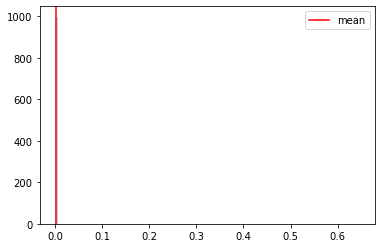

  0%|▏                                                                                | 3/1000 [00:00<01:01, 16.09it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654375953
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 1.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▍                                                                                | 5/1000 [00:00<01:20, 12.31it/s]

Monte Carlo 3
Monte Carlo 4
Monte Carlo 5
Monte Carlo 6


  1%|▌                                                                                | 7/1000 [00:00<01:30, 10.96it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:53,  8.72it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:54,  8.60it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:59,  8.28it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:58,  8.29it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:54,  8.61it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:55,  8.48it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:56,  8.43it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:55,  8.48it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<02:04,  7.85it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:56,  8.36it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:03,  7.88it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:20,  6.89it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:15,  7.11it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:03,  7.79it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:55,  8.30it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:50,  8.68it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<01:46,  9.01it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▍                                                                            | 43/1000 [00:05<01:48,  8.78it/s]

Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:08,  7.42it/s]

Monte Carlo 44
Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:56,  8.16it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:05<01:49,  8.68it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<01:53,  8.36it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<01:54,  8.23it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<01:58,  7.99it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:06<01:49,  8.64it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<01:53,  8.25it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<01:53,  8.26it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:07<01:57,  7.98it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:07<02:03,  7.55it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:08<01:59,  7.80it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:08<02:04,  7.45it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:08<02:01,  7.65it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:09<02:02,  7.54it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<02:01,  7.59it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:09<02:05,  7.35it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:09<02:08,  7.16it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:10<02:02,  7.50it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:10<01:59,  7.67it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:10<02:00,  7.59it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:10<02:00,  7.60it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:11<02:02,  7.43it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:11<01:59,  7.63it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:11<01:59,  7.58it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:11<02:00,  7.51it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:12<02:03,  7.32it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:12<02:00,  7.49it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:12<02:00,  7.44it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:13<01:56,  7.67it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:13<02:07,  7.02it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:13<02:06,  7.05it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:13<02:09,  6.87it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:14<02:09,  6.86it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:14<02:08,  6.91it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:14<02:06,  6.99it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:15<02:07,  6.90it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:15<02:10,  6.75it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:15<02:14,  6.51it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:15<02:08,  6.83it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:16<02:02,  7.12it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:16<02:03,  7.08it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:16<02:03,  7.04it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:17<01:59,  7.24it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:17<02:00,  7.21it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:17<02:02,  7.05it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:17<01:59,  7.24it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:18<02:03,  6.96it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:18<02:05,  6.82it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:18<02:03,  6.93it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:19<02:03,  6.93it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:19<02:09,  6.60it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:19<02:08,  6.60it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:20<02:08,  6.60it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:20<02:05,  6.72it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:20<02:05,  6.73it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:20<02:11,  6.38it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:21<02:29,  5.62it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:21<02:24,  5.80it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 163/1000 [00:21<02:23,  5.82it/s]

Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:25,  5.72it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:28,  5.59it/s]

Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:22<02:24,  5.76it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:23<02:43,  5.07it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:23<02:26,  5.64it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:23<02:20,  5.88it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:20,  5.88it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:24<02:24,  5.67it/s]

Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:24<02:26,  5.61it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:21,  5.78it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:25<02:22,  5.72it/s]

Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:25<02:20,  5.81it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:25<02:22,  5.70it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:26<02:22,  5.70it/s]

Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:26<02:21,  5.75it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:26<02:24,  5.60it/s]

Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:27<02:22,  5.68it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:24,  5.59it/s]

Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:27<02:27,  5.47it/s]

Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:27<02:24,  5.58it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:26,  5.46it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:23,  5.57it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:28<02:25,  5.48it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:29<02:27,  5.40it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:30,  5.27it/s]

Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:29<02:29,  5.31it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:29<02:28,  5.33it/s]

Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:30<02:25,  5.45it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:30<02:24,  5.48it/s]

Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:30<02:27,  5.35it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:30<02:26,  5.37it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:26,  5.36it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:25,  5.40it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:24,  5.44it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:21,  5.53it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:18,  5.64it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:17,  5.64it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▌                                                             | 223/1000 [00:32<02:17,  5.66it/s]

Monte Carlo 223


 22%|█████████████████▋                                                             | 224/1000 [00:32<02:27,  5.26it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:35,  4.97it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:33<02:30,  5.12it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:25,  5.30it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:21,  5.43it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:23,  5.37it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:23,  5.33it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:21,  5.40it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:28,  5.15it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:26,  5.19it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:24,  5.27it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:35<02:21,  5.38it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:18,  5.49it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:21,  5.37it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:36<02:18,  5.47it/s]

Monte Carlo 243
Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:16,  5.51it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:16,  5.50it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:23,  5.25it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:37<02:26,  5.11it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:34,  4.85it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:38<02:33,  4.85it/s]

Monte Carlo 252
Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:38<02:32,  4.89it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:33,  4.86it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:35,  4.78it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 258/1000 [00:39<02:40,  4.62it/s]

Monte Carlo 258


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:38,  4.67it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:40,  4.62it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:34,  4.77it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:31,  4.86it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:28,  4.96it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:41<02:26,  4.99it/s]

Monte Carlo 265
Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:41<02:24,  5.06it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:29,  4.88it/s]

Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:30,  4.84it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:30,  4.84it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:42<02:29,  4.87it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:28,  4.90it/s]

Monte Carlo 273
Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:25,  4.98it/s]

Monte Carlo 275
Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:26,  4.93it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:43<02:33,  4.70it/s]

Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:44<02:33,  4.70it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:28,  4.83it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:27,  4.86it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:44<02:28,  4.82it/s]

Monte Carlo 283
Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:45<02:27,  4.84it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:25,  4.91it/s]

Monte Carlo 286
Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:28,  4.80it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:46<02:24,  4.92it/s]

Monte Carlo 289
Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:46<02:22,  4.96it/s]

Monte Carlo 291
Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:30,  4.69it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:47<02:32,  4.64it/s]

Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:47<02:55,  4.01it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:47,  4.21it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:38,  4.42it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:48<02:33,  4.57it/s]

Monte Carlo 298
Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:29,  4.68it/s]

Monte Carlo 300
Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:48<02:32,  4.57it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:49<02:30,  4.62it/s]

Monte Carlo 303
Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:49<02:27,  4.69it/s]

Monte Carlo 305
Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:49<02:32,  4.55it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:31,  4.55it/s]

Monte Carlo 308
Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:50<02:28,  4.65it/s]

Monte Carlo 310
Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:30,  4.56it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:28,  4.61it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:26,  4.69it/s]

Monte Carlo 314
Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:51<02:26,  4.68it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:30,  4.54it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:31,  4.49it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:34,  4.41it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:33,  4.44it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:33,  4.42it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:28,  4.57it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:26,  4.60it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:24,  4.66it/s]

Monte Carlo 325
Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:27,  4.55it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:27,  4.56it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:54<02:26,  4.58it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:27,  4.54it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:55<02:25,  4.59it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:55<02:24,  4.63it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:24,  4.60it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:55<02:27,  4.53it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:24,  4.61it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:22,  4.64it/s]

Monte Carlo 336
Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:56<02:25,  4.54it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:56<02:28,  4.44it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:26,  4.50it/s]

Monte Carlo 340


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:22,  4.63it/s]

Monte Carlo 341
Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:25,  4.50it/s]

Monte Carlo 343
Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:29,  4.37it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:28,  4.39it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:30,  4.35it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:29,  4.36it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:30,  4.33it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:32,  4.27it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:30,  4.31it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:30,  4.30it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:26,  4.42it/s]

Monte Carlo 353
Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:25,  4.42it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:25,  4.41it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:24,  4.44it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:23,  4.46it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:23,  4.46it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:22,  4.49it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:24,  4.43it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:21,  4.50it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:22,  4.48it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:24,  4.39it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:22,  4.45it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:28,  4.26it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:28,  4.26it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:29,  4.22it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:25,  4.33it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:26,  4.31it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:26,  4.29it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:25,  4.32it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:30,  4.17it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:29,  4.19it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:28,  4.20it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:27,  4.22it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:29,  4.17it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:24,  4.30it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:25,  4.26it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:22,  4.34it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:22,  4.34it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:22,  4.34it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:21,  4.36it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:21,  4.35it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:23,  4.29it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:28,  4.14it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:30,  4.08it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:27,  4.14it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:36,  3.91it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:33,  3.96it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:09<02:35,  3.92it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:30,  4.04it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:31,  4.01it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:29,  4.05it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:10<02:31,  4.00it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:29,  4.05it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:25,  4.14it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:23,  4.18it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:11<02:47,  3.60it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:11<02:38,  3.79it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:32,  3.94it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:28,  4.03it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:34,  3.86it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:35,  3.83it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:34,  3.86it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:30,  3.94it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:13<02:27,  4.01it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:25,  4.08it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:13<02:19,  4.23it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:17,  4.28it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:14<02:22,  4.14it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<02:20,  4.20it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:18,  4.23it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:18,  4.22it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:15<02:14,  4.34it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:14,  4.33it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:15<02:14,  4.33it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:13,  4.36it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:15,  4.30it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:16<02:16,  4.25it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:16<02:20,  4.13it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:33,  3.77it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:17<02:37,  3.67it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:31,  3.81it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:17<02:39,  3.62it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:32,  3.78it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:18<02:34,  3.70it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:30,  3.79it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:28,  3.85it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:27,  3.85it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:19<02:25,  3.90it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:21,  4.00it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:20,  4.03it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:21,  4.00it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:20<02:20,  4.01it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:31,  3.72it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:29,  3.77it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:23,  3.92it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:21<02:23,  3.91it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:22,  3.92it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:21<02:31,  3.70it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:22<02:34,  3.61it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:22<02:30,  3.69it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:22<02:29,  3.73it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:22<02:33,  3.62it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:23<02:40,  3.45it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:23<02:48,  3.28it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:23<02:47,  3.29it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:24<02:40,  3.43it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:24<02:41,  3.41it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:39,  3.45it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:24<02:37,  3.49it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:25<02:52,  3.18it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:25<02:51,  3.18it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:52,  3.15it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:26<03:01,  3.00it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:26<02:56,  3.08it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:26<02:58,  3.04it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:27<02:51,  3.16it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:27<02:46,  3.24it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:27<02:38,  3.39it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:28<02:37,  3.42it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:28<02:37,  3.41it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:28<02:36,  3.43it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:28<02:37,  3.40it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:29<02:37,  3.40it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:29<02:39,  3.34it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:29<02:41,  3.30it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:30<02:40,  3.32it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:30<02:43,  3.23it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:30<02:45,  3.20it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:31<02:39,  3.32it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:31<02:36,  3.37it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:31<02:32,  3.45it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:31<02:34,  3.39it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:32<02:41,  3.25it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:32<02:43,  3.20it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:32<02:46,  3.13it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:33<02:43,  3.19it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:33<02:40,  3.24it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:33<02:39,  3.25it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:34<02:38,  3.27it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:34<02:41,  3.20it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:34<02:44,  3.14it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:35<02:41,  3.19it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:35<02:40,  3.19it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:35<02:36,  3.27it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:36<02:39,  3.21it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:36<02:39,  3.19it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:36<02:41,  3.16it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:36<02:38,  3.21it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:37<02:39,  3.19it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:37<02:37,  3.21it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:37<02:38,  3.19it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:38<02:32,  3.31it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:38<02:32,  3.31it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:38<02:39,  3.16it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:39<02:39,  3.14it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:39<02:43,  3.06it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:39<02:40,  3.12it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:40<02:35,  3.21it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:40<02:34,  3.22it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:40<02:30,  3.29it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:41<02:30,  3.30it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:41<02:29,  3.30it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:41<02:28,  3.32it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:41<02:39,  3.10it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:42<02:38,  3.10it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:42<02:36,  3.13it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:42<02:38,  3.10it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:43<02:40,  3.04it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:43<02:40,  3.05it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:43<02:35,  3.13it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:44<02:34,  3.14it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:44<02:34,  3.14it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:44<02:38,  3.05it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:45<02:33,  3.14it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:45<02:30,  3.21it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:45<02:41,  2.97it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:46<02:36,  3.06it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:46<02:35,  3.08it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:46<02:36,  3.06it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:47<02:37,  3.04it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:47<02:37,  3.02it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:47<02:34,  3.07it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:48<02:32,  3.11it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:48<02:33,  3.09it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:48<02:32,  3.10it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:49<02:28,  3.18it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:49<02:27,  3.18it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:49<02:28,  3.16it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:50<02:25,  3.21it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:50<02:32,  3.07it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:50<02:30,  3.10it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:51<02:32,  3.06it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:51<02:31,  3.06it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:51<02:31,  3.07it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:51<02:28,  3.12it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:52<02:42,  2.84it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:52<02:38,  2.90it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:53<02:35,  2.95it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:53<02:39,  2.88it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:53<02:32,  2.99it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:54<02:31,  3.01it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:54<02:27,  3.09it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:54<02:27,  3.09it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:55<02:26,  3.10it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:55<02:28,  3.04it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:55<02:30,  2.99it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:56<02:34,  2.91it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:56<02:31,  2.96it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:56<02:34,  2.90it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:57<02:31,  2.95it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:57<02:33,  2.91it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:57<02:36,  2.85it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:58<02:37,  2.81it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:58<02:35,  2.84it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:58<02:31,  2.91it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:59<02:26,  3.02it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:59<02:25,  3.02it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:59<02:26,  2.99it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [02:00<02:28,  2.94it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [02:00<02:26,  2.99it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [02:00<02:26,  2.97it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [02:01<02:28,  2.92it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [02:01<02:25,  2.97it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:01<02:25,  2.97it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:02<02:25,  2.98it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:02<02:25,  2.96it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:02<02:24,  2.97it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:03<02:27,  2.91it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:03<02:27,  2.90it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:03<02:23,  2.98it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:04<02:18,  3.08it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:04<02:20,  3.03it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:04<02:17,  3.09it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:05<02:14,  3.13it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:05<02:15,  3.11it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:05<02:16,  3.09it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:06<02:16,  3.08it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:06<02:14,  3.12it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:06<02:18,  3.02it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:07<02:17,  3.04it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:07<02:14,  3.08it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:07<02:13,  3.11it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:08<02:13,  3.11it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:08<02:14,  3.06it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:08<02:13,  3.08it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:09<02:11,  3.12it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:09<02:07,  3.22it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:09<02:08,  3.18it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:09<02:07,  3.20it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:10<02:08,  3.16it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:10<02:05,  3.23it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:10<02:06,  3.20it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:11<02:05,  3.22it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:11<02:05,  3.22it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:11<02:06,  3.19it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:12<02:09,  3.10it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:12<02:14,  2.98it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:12<02:11,  3.05it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:13<02:11,  3.03it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:13<02:07,  3.10it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:13<02:08,  3.09it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:14<02:05,  3.16it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:14<02:05,  3.13it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:14<02:07,  3.09it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:15<02:04,  3.14it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:15<02:06,  3.09it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:15<02:08,  3.05it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:16<02:05,  3.10it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:16<02:07,  3.04it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:16<02:08,  3.00it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:17<02:10,  2.96it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:17<02:08,  3.00it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:17<02:09,  2.97it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:18<02:07,  2.99it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:18<02:09,  2.96it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:18<02:07,  2.99it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:19<02:07,  2.97it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:19<02:10,  2.89it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:19<02:10,  2.90it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:20<02:06,  2.99it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:20<02:05,  3.00it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:20<02:05,  2.99it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:21<02:04,  3.00it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:21<02:03,  3.02it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:21<02:04,  2.98it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:22<02:05,  2.95it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:22<02:06,  2.93it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:22<02:03,  3.00it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:23<02:01,  3.02it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:23<02:01,  3.03it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:23<02:01,  3.01it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:24<02:03,  2.94it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:24<02:01,  3.00it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:24<02:02,  2.97it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:25<02:01,  2.99it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:25<01:59,  3.02it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:25<01:58,  3.03it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:26<02:01,  2.95it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:26<02:00,  2.98it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:26<01:59,  2.98it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:27<02:01,  2.92it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:27<01:59,  2.96it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:27<02:00,  2.94it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:28<02:01,  2.91it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:28<01:58,  2.97it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:28<02:01,  2.90it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:29<01:58,  2.95it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:29<01:55,  3.01it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:29<01:56,  2.99it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:30<01:58,  2.94it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:30<02:00,  2.86it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:30<02:02,  2.82it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:31<01:59,  2.87it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:31<01:57,  2.91it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:32<02:11,  2.61it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:32<02:07,  2.68it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:32<02:06,  2.68it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:33<02:01,  2.79it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:33<01:58,  2.85it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:33<01:56,  2.88it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:34<01:57,  2.85it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:34<01:59,  2.81it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:34<01:56,  2.87it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:35<01:55,  2.89it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:35<01:55,  2.89it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:35<01:55,  2.87it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:36<01:52,  2.92it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:36<01:53,  2.90it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:36<01:50,  2.97it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:37<01:53,  2.89it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:37<01:51,  2.93it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:37<01:51,  2.91it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:38<01:49,  2.96it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:38<01:47,  2.99it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:38<01:45,  3.05it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:39<01:43,  3.11it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:39<01:41,  3.17it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:39<01:40,  3.17it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:40<01:42,  3.10it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:40<01:44,  3.04it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:40<01:42,  3.07it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:41<01:44,  3.03it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:41<01:41,  3.08it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:41<01:40,  3.10it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:42<01:41,  3.07it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:42<01:43,  2.99it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:42<01:42,  3.02it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:43<01:43,  2.97it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:43<01:42,  3.01it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:43<01:44,  2.95it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:44<01:44,  2.93it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:44<01:45,  2.89it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:44<01:47,  2.82it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:45<01:45,  2.86it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:45<01:48,  2.79it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:46<01:47,  2.81it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:46<01:46,  2.81it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:46<01:45,  2.83it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:47<01:44,  2.85it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:47<01:44,  2.86it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:47<01:44,  2.82it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:48<01:45,  2.79it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:48<01:47,  2.74it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:48<01:44,  2.80it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:49<01:43,  2.82it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:49<01:42,  2.83it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:49<01:42,  2.84it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:50<01:42,  2.83it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:50<01:42,  2.81it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:50<01:41,  2.83it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:51<01:43,  2.76it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:51<01:43,  2.76it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:52<01:43,  2.75it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:52<01:42,  2.77it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:52<01:40,  2.81it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:53<01:40,  2.80it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:53<01:40,  2.78it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:53<01:41,  2.75it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:54<01:41,  2.75it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:54<01:39,  2.78it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:54<01:38,  2.80it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:55<01:40,  2.73it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:55<01:39,  2.75it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:56<01:39,  2.74it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:56<01:41,  2.68it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:56<01:38,  2.74it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:57<01:37,  2.77it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:57<01:37,  2.76it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:57<01:36,  2.79it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:58<01:34,  2.83it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:58<01:33,  2.84it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:58<01:36,  2.75it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:59<01:37,  2.72it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:59<01:36,  2.73it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [03:00<01:35,  2.75it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:00<01:37,  2.69it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:00<01:34,  2.76it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:01<01:34,  2.75it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:01<01:33,  2.77it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:01<01:32,  2.78it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:02<01:30,  2.82it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:02<01:28,  2.87it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:02<01:28,  2.88it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:03<01:27,  2.89it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:03<01:25,  2.95it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:03<01:25,  2.93it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:04<01:25,  2.94it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:04<01:24,  2.96it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:04<01:23,  2.95it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:05<01:24,  2.94it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:05<01:22,  2.98it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:05<01:22,  2.98it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:06<01:23,  2.91it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:06<01:22,  2.96it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:06<01:26,  2.80it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:07<01:27,  2.77it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:07<01:27,  2.75it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:08<01:26,  2.77it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:08<01:26,  2.76it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:08<01:23,  2.83it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:09<01:24,  2.79it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:09<01:26,  2.71it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:09<01:23,  2.80it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:10<01:24,  2.76it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:10<01:23,  2.78it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:10<01:21,  2.82it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:11<01:22,  2.79it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:11<01:20,  2.84it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:12<01:20,  2.82it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:12<01:21,  2.79it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:12<01:21,  2.78it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:13<01:21,  2.77it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:13<01:20,  2.80it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:13<01:19,  2.80it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:14<01:21,  2.72it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:14<01:22,  2.69it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:14<01:21,  2.69it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:15<01:22,  2.67it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:15<01:21,  2.69it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:16<01:27,  2.49it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:16<01:25,  2.52it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:16<01:24,  2.55it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:17<01:22,  2.60it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:17<01:21,  2.60it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:18<01:20,  2.64it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:18<01:18,  2.67it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:18<01:22,  2.53it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:19<01:21,  2.56it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:19<01:20,  2.59it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:19<01:18,  2.63it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:20<01:17,  2.67it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:20<01:16,  2.67it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:21<01:16,  2.68it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:21<01:18,  2.58it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:21<01:18,  2.57it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:22<01:17,  2.58it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:22<01:17,  2.57it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:23<01:18,  2.53it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:23<01:19,  2.48it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:23<01:18,  2.52it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:24<01:16,  2.56it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:24<01:15,  2.59it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:25<01:15,  2.58it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:25<01:14,  2.61it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:25<01:13,  2.63it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:26<01:12,  2.63it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:26<01:12,  2.61it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:26<01:13,  2.58it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:27<01:11,  2.61it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:27<01:11,  2.62it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:28<01:10,  2.63it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:28<01:10,  2.62it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:28<01:10,  2.60it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:29<01:10,  2.60it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:29<01:09,  2.60it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:30<01:11,  2.54it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:30<01:10,  2.56it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:30<01:11,  2.51it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:31<01:10,  2.52it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:31<01:10,  2.50it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:32<01:08,  2.55it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:32<01:07,  2.59it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:32<01:08,  2.55it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:33<01:09,  2.48it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:33<01:09,  2.47it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:34<01:08,  2.49it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:34<01:10,  2.43it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:34<01:10,  2.40it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:35<01:09,  2.43it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:35<01:07,  2.49it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:36<01:06,  2.51it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:36<01:05,  2.51it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:36<01:05,  2.52it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:37<01:03,  2.55it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:37<01:03,  2.56it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:38<01:05,  2.48it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:38<01:05,  2.43it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:38<01:04,  2.45it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:39<01:04,  2.43it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:39<01:02,  2.49it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:40<01:03,  2.45it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:40<01:02,  2.46it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:40<01:01,  2.50it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:41<01:00,  2.52it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:41<01:01,  2.48it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:42<01:02,  2.42it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:42<01:01,  2.44it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:42<01:02,  2.40it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:43<01:00,  2.43it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:43<01:00,  2.43it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:44<01:00,  2.41it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:44<01:00,  2.38it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:45<01:00,  2.36it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:45<00:59,  2.38it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:45<00:58,  2.42it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:46<00:57,  2.43it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:46<00:57,  2.42it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:47<00:56,  2.46it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:47<00:56,  2.42it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:47<00:56,  2.42it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:48<00:56,  2.41it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:48<00:55,  2.45it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:49<00:55,  2.41it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:49<00:56,  2.37it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:50<00:56,  2.34it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:50<00:55,  2.34it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:50<00:54,  2.38it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:51<00:53,  2.41it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:51<00:53,  2.37it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:52<00:56,  2.24it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:52<00:54,  2.31it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:53<00:52,  2.36it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:53<00:51,  2.40it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:53<00:51,  2.38it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:54<00:50,  2.44it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:54<00:51,  2.36it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:55<00:49,  2.41it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:55<00:49,  2.41it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:55<00:49,  2.39it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:56<00:48,  2.43it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:56<00:47,  2.46it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:57<00:47,  2.45it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:57<00:45,  2.49it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:57<00:44,  2.53it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:58<00:43,  2.55it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:58<00:42,  2.61it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:59<00:42,  2.56it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:59<00:43,  2.53it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:59<00:42,  2.53it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:00<00:42,  2.54it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:00<00:42,  2.52it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:01<00:42,  2.49it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:01<00:41,  2.50it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:01<00:41,  2.45it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:02<00:41,  2.43it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:02<00:41,  2.42it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:03<00:41,  2.43it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:03<00:40,  2.43it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:03<00:40,  2.41it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:04<00:40,  2.41it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:04<00:40,  2.35it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:05<00:40,  2.32it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:05<00:40,  2.31it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:06<00:39,  2.34it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:06<00:38,  2.37it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:06<00:37,  2.41it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:07<00:37,  2.41it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:07<00:38,  2.33it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:08<00:37,  2.34it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:08<00:37,  2.31it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:09<00:37,  2.32it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:09<00:36,  2.35it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:09<00:36,  2.32it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:10<00:35,  2.34it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:10<00:35,  2.31it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:11<00:34,  2.32it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:11<00:34,  2.30it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:12<00:34,  2.30it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:12<00:33,  2.31it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:13<00:33,  2.31it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:13<00:32,  2.34it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:13<00:31,  2.36it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:14<00:31,  2.34it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:14<00:31,  2.32it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:15<00:31,  2.31it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:15<00:30,  2.30it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:16<00:30,  2.27it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:16<00:30,  2.28it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:16<00:29,  2.29it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:17<00:28,  2.32it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:17<00:28,  2.33it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:18<00:27,  2.32it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:18<00:27,  2.33it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:19<00:27,  2.31it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:19<00:26,  2.31it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:19<00:26,  2.30it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:20<00:25,  2.35it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:20<00:25,  2.33it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:21<00:24,  2.41it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:21<00:23,  2.38it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:22<00:23,  2.37it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:22<00:22,  2.39it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:22<00:22,  2.42it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:23<00:22,  2.36it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:23<00:22,  2.34it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:24<00:22,  2.29it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:24<00:21,  2.32it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:25<00:21,  2.32it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:25<00:20,  2.34it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:25<00:19,  2.36it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:26<00:19,  2.32it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:26<00:20,  2.25it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:27<00:19,  2.25it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:27<00:19,  2.21it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:28<00:18,  2.22it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:28<00:18,  2.25it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:29<00:17,  2.25it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:29<00:17,  2.27it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:29<00:16,  2.26it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:30<00:16,  2.22it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:30<00:16,  2.17it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:31<00:17,  2.05it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:31<00:16,  2.12it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:32<00:15,  2.17it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:32<00:14,  2.21it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:33<00:13,  2.22it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:33<00:13,  2.21it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:34<00:13,  2.21it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:34<00:13,  2.12it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:34<00:12,  2.19it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:35<00:11,  2.18it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:35<00:11,  2.18it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:36<00:10,  2.21it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:36<00:10,  2.24it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:37<00:09,  2.21it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:37<00:09,  2.19it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:38<00:09,  2.16it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:38<00:08,  2.15it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:39<00:08,  2.20it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:39<00:07,  2.19it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:40<00:07,  2.16it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:40<00:06,  2.18it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:40<00:06,  2.17it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:41<00:06,  2.14it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:41<00:05,  2.06it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:42<00:05,  2.12it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:42<00:04,  2.17it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:43<00:04,  2.18it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:43<00:03,  2.20it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:44<00:03,  2.22it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:44<00:02,  2.22it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:45<00:02,  2.20it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:45<00:01,  2.17it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:46<00:01,  2.15it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:46<00:00,  2.16it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:46<00:00,  2.14it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:47<00:00,  3.48it/s]


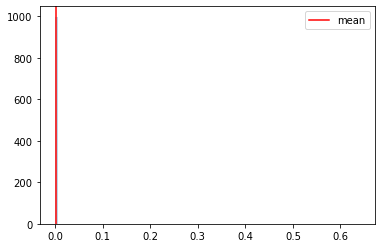

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654376241
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 1.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:15, 13.14it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:45,  9.39it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 9/1000 [00:00<01:45,  9.43it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:55,  8.55it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:49,  9.02it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:52,  8.80it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:49,  9.02it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:47,  9.14it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:52,  8.69it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:47,  9.10it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:48,  8.96it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:52,  8.67it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:04,  7.82it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:17,  7.06it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:06,  7.66it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<01:57,  8.23it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▊                                                                             | 35/1000 [00:04<01:56,  8.27it/s]

Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:20,  6.84it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<02:06,  7.58it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<02:00,  7.98it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<01:53,  8.42it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:56,  8.16it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:57,  8.12it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<02:02,  7.77it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<01:55,  8.19it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<01:56,  8.14it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:00,  7.86it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<02:05,  7.53it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:02,  7.69it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:02,  7.67it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:04,  7.52it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<02:11,  7.13it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:01,  7.69it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:03,  7.51it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:06,  7.34it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:04,  7.44it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:11,  7.04it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:05,  7.37it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:01,  7.58it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:17,  6.70it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:07,  7.17it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:10,  7.03it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:04,  7.35it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:01,  7.53it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:05,  7.24it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:03,  7.33it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:06,  7.15it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:11,  6.89it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:12,  6.79it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:07,  7.03it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:10,  6.87it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:13,  6.68it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:09,  6.91it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:07,  6.99it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<01:59,  7.45it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<01:56,  7.63it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<01:55,  7.67it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<01:58,  7.42it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<01:57,  7.49it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<01:55,  7.63it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<01:56,  7.56it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:01,  7.20it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<01:59,  7.29it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:02,  7.13it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:01,  7.16it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:04,  6.97it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<02:04,  6.94it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:17<02:01,  7.12it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:01,  7.07it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:05,  6.85it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:18<01:59,  7.16it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<01:59,  7.15it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:00,  7.07it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:19<02:00,  7.05it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:19<02:10,  6.50it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:08,  6.58it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:20<02:02,  6.89it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:20<02:07,  6.61it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<01:59,  7.06it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:21<02:00,  6.98it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▊                                                                  | 162/1000 [00:21<02:03,  6.79it/s]

Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:22<02:25,  5.76it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:22<02:16,  6.10it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:22<02:09,  6.43it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:22<02:09,  6.43it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:23<02:06,  6.56it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:23<02:08,  6.41it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:23<02:05,  6.58it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:24<02:03,  6.64it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:24<02:02,  6.68it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:24<02:04,  6.56it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:25<02:05,  6.49it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:25<02:04,  6.52it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:25<02:09,  6.27it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:26<02:19,  5.83it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:26<02:16,  5.94it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:26<02:17,  5.86it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:27<02:14,  5.98it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▌                                                               | 197/1000 [00:27<02:38,  5.07it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 198/1000 [00:27<02:38,  5.06it/s]

Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:27<02:42,  4.93it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:28<02:42,  4.93it/s]

Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:28<02:41,  4.94it/s]

Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:28<02:33,  5.18it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:28<02:27,  5.37it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:29<02:23,  5.54it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:29<02:16,  5.80it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:29<02:18,  5.71it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:30<02:24,  5.46it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:30<02:20,  5.59it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:30<02:21,  5.53it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:20,  5.57it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:20,  5.57it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:31<02:18,  5.65it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:31<02:15,  5.74it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:32<02:16,  5.70it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:32<02:13,  5.79it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:32<02:18,  5.56it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:33<02:19,  5.53it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:33<02:20,  5.49it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:33<02:16,  5.64it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:14,  5.68it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:34<02:17,  5.54it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:34<02:17,  5.53it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:35<02:19,  5.45it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 241/1000 [00:35<02:17,  5.51it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:35<02:21,  5.36it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:35<02:18,  5.48it/s]

Monte Carlo 243
Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:36<02:19,  5.42it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:36<02:22,  5.27it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:36<02:22,  5.27it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:36<02:20,  5.36it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:37<02:21,  5.30it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:37<02:21,  5.30it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:37<02:17,  5.43it/s]

Monte Carlo 252
Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:37<02:20,  5.29it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:38<02:21,  5.25it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:38<02:20,  5.27it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:38<02:19,  5.31it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:38<02:18,  5.33it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:39<02:19,  5.28it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:39<02:24,  5.11it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:39<02:20,  5.26it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:39<02:15,  5.42it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:40<02:19,  5.26it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:40<02:18,  5.30it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:40<02:15,  5.40it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:41<02:18,  5.27it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:41<02:22,  5.10it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:41<02:24,  5.03it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:41<02:25,  5.00it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:42<02:27,  4.91it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:42<02:32,  4.75it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:42<02:28,  4.85it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:43<02:30,  4.79it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:43<02:28,  4.83it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:43<02:26,  4.89it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:43<02:26,  4.89it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:44<02:26,  4.88it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:44<02:26,  4.85it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:44<02:22,  4.97it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:44<02:19,  5.08it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:45<02:22,  4.98it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:45<02:25,  4.87it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:45<02:23,  4.91it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:45<02:23,  4.93it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:46<02:21,  4.97it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:46<02:20,  4.99it/s]

Monte Carlo 296
Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:46<02:24,  4.87it/s]

Monte Carlo 298
Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:47<02:26,  4.77it/s]

Monte Carlo 300
Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:47<02:29,  4.67it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:47<02:24,  4.82it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:48<02:23,  4.85it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:48<02:21,  4.89it/s]

Monte Carlo 305
Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:48<02:24,  4.79it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:48<02:22,  4.85it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:49<02:23,  4.80it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:49<02:21,  4.88it/s]

Monte Carlo 310
Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:49<02:24,  4.74it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:49<02:22,  4.81it/s]

Monte Carlo 313
Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:50<02:20,  4.86it/s]

Monte Carlo 315
Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:50<02:25,  4.68it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:50<02:23,  4.75it/s]

Monte Carlo 318
Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:51<02:30,  4.53it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:51<02:22,  4.76it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:51<02:19,  4.85it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:52<02:20,  4.82it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:52<02:21,  4.76it/s]

Monte Carlo 325
Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:52<02:26,  4.59it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:52<02:27,  4.56it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:53<02:25,  4.61it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:53<02:25,  4.61it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:53<02:23,  4.67it/s]

Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:53<02:17,  4.83it/s]

Monte Carlo 332
Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:54<02:20,  4.75it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:54<02:21,  4.69it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 337/1000 [00:54<02:20,  4.72it/s]

Monte Carlo 336


 34%|██████████████████████████▋                                                    | 338/1000 [00:55<02:18,  4.80it/s]

Monte Carlo 337
Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:55<02:20,  4.70it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:55<02:22,  4.63it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:55<02:44,  4.01it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:56<02:40,  4.11it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:56<02:32,  4.31it/s]

Monte Carlo 343
Monte Carlo 344


 35%|███████████████████████████▎                                                   | 346/1000 [00:56<02:29,  4.37it/s]

Monte Carlo 345
Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:57<02:26,  4.47it/s]

Monte Carlo 347


 35%|███████████████████████████▌                                                   | 349/1000 [00:57<02:26,  4.43it/s]

Monte Carlo 348
Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:57<02:24,  4.49it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:58<02:27,  4.40it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:58<02:28,  4.37it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:58<02:24,  4.46it/s]

Monte Carlo 353


 36%|████████████████████████████                                                   | 355/1000 [00:58<02:21,  4.55it/s]

Monte Carlo 354
Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [00:59<02:19,  4.61it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [00:59<02:17,  4.66it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [00:59<02:21,  4.53it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [00:59<02:23,  4.47it/s]

Monte Carlo 359


 36%|████████████████████████████▌                                                  | 361/1000 [01:00<02:21,  4.52it/s]

Monte Carlo 360
Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:00<02:23,  4.46it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:00<02:25,  4.38it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:00<02:24,  4.40it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:01<02:22,  4.45it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:01<02:21,  4.49it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:01<02:19,  4.52it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:01<02:20,  4.49it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:02<02:18,  4.55it/s]

Monte Carlo 369


 37%|█████████████████████████████▎                                                 | 371/1000 [01:02<02:16,  4.61it/s]

Monte Carlo 370
Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:02<02:19,  4.49it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:02<02:25,  4.32it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:03<02:23,  4.37it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 376/1000 [01:03<02:18,  4.49it/s]

Monte Carlo 375
Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:03<02:18,  4.50it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:04<02:19,  4.45it/s]

Monte Carlo 378


 38%|██████████████████████████████                                                 | 380/1000 [01:04<02:18,  4.46it/s]

Monte Carlo 379
Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:04<02:18,  4.46it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:04<02:17,  4.49it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:05<02:15,  4.54it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:05<02:16,  4.51it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:05<02:23,  4.27it/s]

Monte Carlo 385


 39%|██████████████████████████████▌                                                | 387/1000 [01:06<02:18,  4.41it/s]

Monte Carlo 386
Monte Carlo 387


 39%|██████████████████████████████▋                                                | 389/1000 [01:06<02:14,  4.55it/s]

Monte Carlo 388
Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:06<02:18,  4.42it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:07<02:19,  4.37it/s]

Monte Carlo 391


 39%|███████████████████████████████                                                | 393/1000 [01:07<02:17,  4.43it/s]

Monte Carlo 392
Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:07<02:16,  4.43it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:07<02:18,  4.37it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:08<02:20,  4.30it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:08<02:21,  4.25it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:08<02:19,  4.30it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:08<02:18,  4.34it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:09<02:24,  4.15it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:09<02:24,  4.16it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:09<02:19,  4.29it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:09<02:19,  4.27it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:10<02:19,  4.27it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:10<02:17,  4.31it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:10<02:17,  4.33it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:10<02:17,  4.32it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:11<02:20,  4.21it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:11<02:19,  4.22it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:11<02:24,  4.09it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:11<02:24,  4.06it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:11<02:23,  4.10it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:12<02:24,  4.06it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:12<02:26,  4.00it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:12<02:26,  3.99it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:13<02:27,  3.95it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:13<02:24,  4.03it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:13<02:21,  4.10it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:13<02:19,  4.16it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:13<02:24,  4.00it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:14<02:21,  4.09it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:14<02:23,  4.02it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:14<02:23,  4.03it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:14<02:22,  4.03it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:15<02:21,  4.05it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:15<02:22,  4.03it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:15<02:22,  4.03it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:15<02:18,  4.12it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:16<02:22,  4.00it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:16<02:21,  4.02it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:16<02:21,  4.02it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:16<02:19,  4.08it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:17<02:18,  4.10it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:17<02:14,  4.19it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:17<02:14,  4.19it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:17<02:19,  4.05it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:18<02:19,  4.03it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:18<02:18,  4.07it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:18<02:19,  4.01it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:18<02:19,  4.02it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:19<02:18,  4.02it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:19<02:25,  3.85it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:19<02:23,  3.88it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:19<02:24,  3.85it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:20<02:20,  3.94it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:20<02:16,  4.06it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:20<02:12,  4.16it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:20<02:08,  4.28it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:21<02:08,  4.28it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:21<02:07,  4.31it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:21<02:08,  4.27it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:21<02:05,  4.38it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:22<02:10,  4.18it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:22<02:08,  4.26it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:22<02:07,  4.27it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:22<02:04,  4.37it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:22<02:08,  4.23it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:23<02:06,  4.29it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:23<02:12,  4.08it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:23<02:11,  4.10it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:23<02:13,  4.05it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:24<02:09,  4.16it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:24<02:16,  3.95it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:24<02:12,  4.06it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:24<02:12,  4.04it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:25<02:08,  4.14it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:25<02:09,  4.11it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:25<02:08,  4.13it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:25<02:09,  4.11it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:26<02:09,  4.10it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:26<02:10,  4.04it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:26<02:11,  4.03it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:26<02:12,  3.97it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:27<02:11,  4.00it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:27<02:18,  3.80it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:27<02:20,  3.73it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:28<02:22,  3.68it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:28<02:25,  3.60it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:28<02:19,  3.73it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:28<02:16,  3.81it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:29<02:16,  3.81it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:29<02:34,  3.36it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:29<02:27,  3.51it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:29<02:24,  3.57it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:30<02:21,  3.64it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:30<02:18,  3.71it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:30<02:17,  3.73it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:31<02:16,  3.75it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:31<02:13,  3.82it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:31<02:17,  3.72it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:31<02:22,  3.58it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:32<02:24,  3.51it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:32<02:28,  3.42it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:32<02:29,  3.39it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:33<02:26,  3.45it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:33<02:22,  3.55it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:33<02:18,  3.63it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:33<02:17,  3.65it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:34<02:17,  3.65it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:34<02:14,  3.72it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:34<02:11,  3.78it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:34<02:14,  3.71it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:35<02:12,  3.74it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:35<02:13,  3.72it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:35<02:13,  3.72it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:36<02:14,  3.67it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:36<02:16,  3.61it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:36<02:19,  3.52it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:36<02:17,  3.57it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:37<02:18,  3.55it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:37<02:16,  3.57it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:37<02:13,  3.66it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:37<02:14,  3.61it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:38<02:18,  3.50it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:38<02:18,  3.50it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:38<02:15,  3.58it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:39<02:19,  3.47it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:39<02:18,  3.47it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:39<02:15,  3.54it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:39<02:17,  3.49it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:40<02:20,  3.41it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:40<02:16,  3.49it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:40<02:19,  3.41it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:41<02:16,  3.48it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:41<02:15,  3.50it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:41<02:17,  3.45it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:42<02:13,  3.53it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:42<02:12,  3.57it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:42<02:11,  3.59it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:42<02:14,  3.49it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:43<02:13,  3.51it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:43<02:11,  3.55it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:43<02:11,  3.55it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:43<02:08,  3.63it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:44<02:11,  3.54it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:44<02:13,  3.46it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:44<02:15,  3.42it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:45<02:18,  3.34it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:45<02:15,  3.40it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:45<02:15,  3.40it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:46<02:15,  3.39it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:46<02:22,  3.22it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:46<02:18,  3.30it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:46<02:15,  3.38it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:47<02:16,  3.34it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:47<02:15,  3.34it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:47<02:15,  3.34it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:48<02:16,  3.32it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:48<02:13,  3.38it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:48<02:10,  3.44it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:49<02:11,  3.41it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:49<02:10,  3.43it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:49<02:08,  3.47it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:49<02:08,  3.46it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:50<02:08,  3.46it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:50<02:08,  3.47it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:50<02:09,  3.41it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:51<02:07,  3.47it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:51<02:06,  3.49it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:51<02:05,  3.52it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:51<02:11,  3.35it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:52<02:11,  3.33it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:52<02:11,  3.33it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:52<02:08,  3.40it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:53<02:10,  3.34it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:53<02:10,  3.33it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:53<02:07,  3.39it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:54<02:07,  3.39it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:54<02:04,  3.46it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:54<02:05,  3.43it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:54<02:04,  3.44it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:55<02:06,  3.37it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:55<02:06,  3.38it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:55<02:04,  3.41it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:56<02:06,  3.37it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:56<02:06,  3.35it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:56<02:04,  3.41it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:56<02:04,  3.40it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:57<02:05,  3.35it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:57<02:06,  3.31it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:57<02:05,  3.35it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:58<02:05,  3.32it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:58<02:07,  3.27it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:58<02:05,  3.32it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:59<02:06,  3.27it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [01:59<02:05,  3.29it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [01:59<02:04,  3.32it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [01:59<02:03,  3.33it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:00<02:08,  3.21it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:00<02:06,  3.23it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:00<02:04,  3.28it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:01<02:05,  3.24it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:01<02:08,  3.18it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:01<02:07,  3.17it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:02<02:04,  3.26it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:02<02:06,  3.21it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:02<02:04,  3.25it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:03<02:03,  3.25it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:03<02:02,  3.27it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:03<02:00,  3.31it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:03<02:00,  3.32it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:04<01:59,  3.33it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:04<02:00,  3.29it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:04<02:03,  3.21it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:05<02:18,  2.85it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:05<02:15,  2.91it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:06<02:10,  3.02it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:06<02:06,  3.09it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:06<02:03,  3.17it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:06<02:03,  3.16it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:07<02:02,  3.17it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:07<02:00,  3.23it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:07<01:58,  3.27it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:08<01:59,  3.22it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:08<02:00,  3.21it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:08<01:59,  3.22it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:09<01:59,  3.19it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:09<01:58,  3.21it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:09<02:01,  3.15it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:10<02:03,  3.08it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:10<02:00,  3.15it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:10<01:59,  3.15it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:11<01:58,  3.19it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:11<01:58,  3.18it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:11<01:54,  3.29it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:11<01:53,  3.30it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:12<01:53,  3.28it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:12<01:51,  3.35it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:12<01:51,  3.31it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:13<01:49,  3.38it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:13<01:50,  3.34it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:13<01:50,  3.33it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:14<01:51,  3.29it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:14<01:49,  3.35it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:14<01:48,  3.35it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:14<01:53,  3.22it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:15<01:52,  3.22it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:15<01:49,  3.29it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:15<01:52,  3.22it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:16<01:51,  3.24it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:16<01:52,  3.19it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:16<01:49,  3.26it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:17<01:49,  3.27it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:17<01:49,  3.24it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:17<01:49,  3.23it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:18<01:49,  3.23it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:18<01:52,  3.15it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:18<01:51,  3.15it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:19<01:53,  3.10it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:19<01:52,  3.12it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:19<01:51,  3.14it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:19<01:51,  3.11it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:20<01:52,  3.09it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:20<01:48,  3.19it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:20<01:49,  3.14it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:21<01:49,  3.14it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:21<01:50,  3.11it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:21<01:49,  3.12it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:22<01:47,  3.17it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:22<01:45,  3.24it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:22<01:45,  3.23it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:23<01:46,  3.19it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:23<01:43,  3.25it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:23<01:44,  3.21it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:24<01:44,  3.21it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:24<01:44,  3.18it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:24<01:45,  3.15it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:25<01:46,  3.10it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:25<01:47,  3.07it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:25<01:46,  3.09it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:25<01:45,  3.11it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:26<01:44,  3.13it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:26<01:43,  3.16it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:26<01:43,  3.16it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:27<01:40,  3.23it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:27<01:41,  3.18it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:27<01:39,  3.23it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:28<01:40,  3.21it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:28<01:40,  3.20it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:28<01:45,  3.04it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:29<01:42,  3.12it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:29<01:42,  3.12it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:29<01:41,  3.12it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:30<01:39,  3.18it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:30<01:39,  3.17it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:30<01:39,  3.15it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:31<01:38,  3.19it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:31<01:37,  3.20it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:31<01:37,  3.20it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:31<01:37,  3.16it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:32<01:40,  3.09it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:32<01:39,  3.10it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:32<01:39,  3.10it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:33<01:40,  3.05it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:33<01:42,  2.99it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:33<01:39,  3.05it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:34<01:41,  3.00it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:34<01:50,  2.73it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:35<01:44,  2.87it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:35<01:42,  2.93it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:35<01:42,  2.91it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:36<01:43,  2.89it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:36<01:44,  2.83it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:36<01:45,  2.80it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:37<01:46,  2.77it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:37<01:43,  2.83it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:37<01:41,  2.90it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:38<01:41,  2.88it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:38<01:41,  2.87it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:38<01:40,  2.89it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:39<01:39,  2.91it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:39<01:39,  2.90it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:39<01:39,  2.90it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:40<01:41,  2.82it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:40<01:41,  2.81it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:40<01:39,  2.86it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:41<01:41,  2.78it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:41<01:40,  2.82it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:42<01:38,  2.84it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:42<01:38,  2.85it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:42<01:38,  2.85it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:43<01:37,  2.85it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:43<01:35,  2.90it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:43<01:36,  2.85it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:44<01:36,  2.85it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:44<01:37,  2.82it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:44<01:37,  2.81it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:45<01:36,  2.81it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:45<01:36,  2.80it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:45<01:37,  2.77it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:46<01:39,  2.70it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:46<01:39,  2.70it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:47<01:39,  2.69it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:47<01:38,  2.70it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:47<01:36,  2.75it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:48<01:36,  2.74it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:48<01:35,  2.75it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:48<01:33,  2.81it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:49<01:32,  2.82it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:49<01:32,  2.82it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:49<01:30,  2.85it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:50<01:29,  2.87it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:50<01:30,  2.83it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:50<01:29,  2.87it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:51<01:27,  2.91it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:51<01:27,  2.90it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:52<01:28,  2.86it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:52<01:27,  2.89it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:52<01:27,  2.86it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:53<01:27,  2.85it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:53<01:27,  2.84it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:53<01:31,  2.72it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:54<01:31,  2.71it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:54<01:31,  2.68it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:54<01:31,  2.68it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:55<01:32,  2.64it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:55<01:34,  2.57it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:56<01:32,  2.62it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:56<01:31,  2.63it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:56<01:29,  2.69it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:57<01:28,  2.71it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:57<01:27,  2.73it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:57<01:27,  2.72it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:58<01:26,  2.72it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:58<01:25,  2.75it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:59<01:25,  2.75it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [02:59<01:25,  2.72it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [02:59<01:24,  2.76it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:00<01:23,  2.76it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:00<01:23,  2.74it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:00<01:24,  2.72it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:01<01:23,  2.73it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:01<01:21,  2.78it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:01<01:21,  2.76it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:02<01:20,  2.78it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:02<01:20,  2.78it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:03<01:21,  2.75it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:03<01:22,  2.69it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:03<01:20,  2.75it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:04<01:21,  2.69it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:04<01:19,  2.75it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:04<01:19,  2.75it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:05<01:19,  2.74it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:05<01:18,  2.76it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:05<01:17,  2.77it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:06<01:26,  2.46it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:06<01:24,  2.53it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:07<01:22,  2.57it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:07<01:21,  2.60it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:07<01:19,  2.66it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:08<01:18,  2.67it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:08<01:17,  2.67it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:09<01:17,  2.68it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:09<01:16,  2.68it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:09<01:16,  2.68it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:10<01:17,  2.64it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:10<01:15,  2.68it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:10<01:15,  2.67it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:11<01:15,  2.67it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:11<01:14,  2.70it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:12<01:13,  2.71it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:12<01:12,  2.72it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:12<01:13,  2.69it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:13<01:12,  2.71it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:13<01:12,  2.70it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:13<01:10,  2.75it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:14<01:11,  2.70it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:14<01:12,  2.65it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:14<01:10,  2.70it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:15<01:11,  2.65it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:15<01:10,  2.67it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:16<01:09,  2.69it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:16<01:09,  2.69it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:16<01:09,  2.69it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:17<01:09,  2.66it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:17<01:09,  2.64it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:18<01:10,  2.61it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:18<01:09,  2.61it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:18<01:13,  2.46it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:19<01:15,  2.38it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:19<01:11,  2.49it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:20<01:11,  2.50it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:20<01:10,  2.53it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:20<01:08,  2.56it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:21<01:09,  2.53it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:21<01:07,  2.57it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:21<01:06,  2.61it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:22<01:06,  2.60it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:22<01:04,  2.64it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:23<01:04,  2.62it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:23<01:03,  2.65it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:23<01:03,  2.64it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:24<01:03,  2.63it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:24<01:03,  2.60it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:25<01:03,  2.61it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:25<01:02,  2.64it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:25<01:03,  2.59it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:26<01:02,  2.61it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:26<01:01,  2.60it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:26<01:01,  2.59it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:27<01:00,  2.61it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:27<01:01,  2.58it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:28<01:01,  2.53it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:28<01:01,  2.55it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:28<01:00,  2.57it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:29<00:59,  2.58it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:29<00:59,  2.58it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:30<00:57,  2.65it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:30<00:56,  2.65it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:30<00:56,  2.68it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:31<00:55,  2.70it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:31<00:54,  2.70it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:31<00:54,  2.71it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:32<00:53,  2.73it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:32<00:53,  2.71it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:33<00:54,  2.66it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:33<00:53,  2.68it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:33<00:52,  2.69it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:34<00:52,  2.68it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:34<00:51,  2.73it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:34<00:50,  2.75it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:35<00:51,  2.69it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:35<00:50,  2.70it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:35<00:51,  2.66it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:36<00:51,  2.62it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:36<00:50,  2.65it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:37<00:49,  2.66it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:37<00:48,  2.73it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:37<00:47,  2.77it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:38<00:47,  2.72it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:38<00:47,  2.71it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:38<00:47,  2.72it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:39<00:46,  2.71it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:39<00:45,  2.74it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:40<00:47,  2.65it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:40<00:46,  2.64it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:40<00:46,  2.63it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:41<00:47,  2.57it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:41<00:46,  2.60it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:42<00:46,  2.60it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:42<00:46,  2.58it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:42<00:44,  2.64it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:43<00:44,  2.60it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:43<00:44,  2.58it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:43<00:44,  2.59it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:44<00:44,  2.58it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:44<00:42,  2.63it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:45<00:43,  2.60it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:45<00:42,  2.61it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:45<00:41,  2.62it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:46<00:42,  2.58it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:46<00:45,  2.37it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:47<00:43,  2.47it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:47<00:42,  2.48it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:47<00:41,  2.50it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:48<00:40,  2.54it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:48<00:39,  2.59it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:49<00:39,  2.60it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:49<00:39,  2.56it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:49<00:39,  2.52it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:50<00:39,  2.51it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:50<00:39,  2.49it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:51<00:39,  2.48it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:51<00:38,  2.47it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:51<00:39,  2.42it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:52<00:38,  2.43it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:52<00:38,  2.44it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:53<00:38,  2.41it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:53<00:37,  2.42it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:53<00:37,  2.40it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:54<00:37,  2.37it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:54<00:37,  2.36it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:55<00:36,  2.35it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:55<00:35,  2.40it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:56<00:34,  2.44it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:56<00:34,  2.46it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:56<00:34,  2.42it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:57<00:33,  2.43it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:57<00:34,  2.36it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:58<00:33,  2.38it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:58<00:33,  2.37it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:58<00:32,  2.39it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [03:59<00:32,  2.35it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [03:59<00:32,  2.34it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:00<00:31,  2.35it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:00<00:30,  2.40it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:01<00:30,  2.39it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:01<00:30,  2.34it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:01<00:30,  2.34it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:02<00:29,  2.35it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:02<00:29,  2.36it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:03<00:28,  2.39it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:03<00:28,  2.39it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:04<00:27,  2.41it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:04<00:27,  2.37it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:04<00:27,  2.33it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:05<00:26,  2.38it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:05<00:26,  2.37it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:06<00:25,  2.37it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:06<00:25,  2.36it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:07<00:25,  2.32it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:07<00:25,  2.31it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:07<00:24,  2.30it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:08<00:24,  2.28it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:08<00:24,  2.21it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:09<00:23,  2.29it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:09<00:22,  2.33it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:10<00:22,  2.35it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:10<00:21,  2.39it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:10<00:20,  2.39it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:11<00:20,  2.34it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:11<00:20,  2.32it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:12<00:20,  2.28it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:12<00:20,  2.26it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:13<00:19,  2.31it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:13<00:18,  2.32it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:13<00:18,  2.32it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:14<00:18,  2.31it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:14<00:17,  2.35it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:15<00:16,  2.37it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:15<00:16,  2.38it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:16<00:16,  2.36it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:16<00:15,  2.37it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:16<00:15,  2.36it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:17<00:15,  2.33it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:17<00:14,  2.35it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:18<00:14,  2.29it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:18<00:13,  2.30it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:19<00:13,  2.27it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:19<00:13,  2.29it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:19<00:12,  2.32it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:20<00:12,  2.26it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:20<00:11,  2.26it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:21<00:11,  2.29it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:21<00:10,  2.32it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:22<00:10,  2.34it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:22<00:09,  2.33it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:23<00:09,  2.28it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:23<00:09,  2.27it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:23<00:08,  2.26it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:24<00:08,  2.26it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:24<00:08,  2.25it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:25<00:07,  2.28it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:25<00:07,  2.27it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:26<00:06,  2.27it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:26<00:06,  2.24it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:27<00:05,  2.21it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:27<00:05,  2.26it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:27<00:04,  2.26it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:28<00:04,  2.28it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:28<00:03,  2.29it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:29<00:03,  2.33it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:29<00:03,  2.31it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:30<00:02,  2.27it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:30<00:02,  2.32it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:30<00:01,  2.33it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:31<00:01,  2.35it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:31<00:00,  2.41it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:32<00:00,  2.41it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:32<00:00,  3.67it/s]


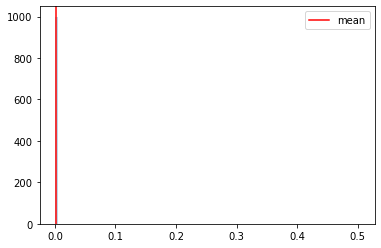

  0%|▏                                                                                | 3/1000 [00:00<00:55, 18.01it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654376515
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 10.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3


  0%|▍                                                                                | 5/1000 [00:00<01:21, 12.20it/s]

Monte Carlo 4
Monte Carlo 5


  1%|▌                                                                                | 7/1000 [00:00<01:41,  9.80it/s]

Monte Carlo 6
Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:00<01:47,  9.24it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 11/1000 [00:01<01:42,  9.64it/s]

Monte Carlo 10
Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:41,  9.74it/s]

Monte Carlo 13
Monte Carlo 14
Monte Carlo 15


  2%|█▍                                                                              | 18/1000 [00:01<01:40,  9.74it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:01<01:43,  9.46it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<01:49,  8.96it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<02:00,  8.12it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<02:02,  7.95it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:02<01:57,  8.31it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<01:54,  8.50it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<01:53,  8.55it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<02:21,  6.84it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:03<02:09,  7.47it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:09,  7.41it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<02:00,  7.96it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<01:57,  8.20it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:04<02:03,  7.76it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:21,  6.74it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:15,  7.04it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<02:08,  7.42it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:18,  6.83it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:03,  7.66it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:57,  8.04it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<01:58,  7.97it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:02,  7.68it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:57,  7.96it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:03,  7.59it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<01:59,  7.86it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<01:58,  7.87it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<01:57,  7.91it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:03,  7.53it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<01:58,  7.80it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<01:59,  7.73it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:05,  7.37it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:00,  7.63it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:00,  7.65it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:03,  7.42it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:03,  7.41it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<02:08,  7.11it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:06,  7.18it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:03,  7.35it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<01:58,  7.63it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<01:59,  7.57it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:00,  7.51it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:02,  7.34it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:12,  6.78it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:14,  6.67it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:04,  7.17it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:05,  7.13it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:02,  7.30it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:10,  6.79it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:30,  5.90it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:18,  6.39it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:09,  6.82it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:03,  7.11it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:01,  7.22it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:06,  6.95it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:10,  6.72it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:07,  6.87it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:09,  6.71it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:05,  6.90it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:15,  6.39it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<02:09,  6.69it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:05,  6.88it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:06,  6.81it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:08,  6.69it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:08,  6.65it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:10,  6.58it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:10,  6.56it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:19<02:07,  6.65it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:13,  6.38it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:09,  6.54it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:20<02:12,  6.36it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:13,  6.32it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<02:10,  6.42it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:21<02:08,  6.54it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:07,  6.58it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:05,  6.66it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:04,  6.67it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:05,  6.63it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:23<02:14,  6.17it/s]

Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:23<02:10,  6.36it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:23<02:15,  6.10it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:13,  6.19it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:24<02:11,  6.26it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:24<02:11,  6.21it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:18,  5.92it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:25<02:18,  5.89it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:25<02:11,  6.20it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:26<02:08,  6.33it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:26<02:06,  6.40it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:26<02:13,  6.04it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:11,  6.12it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:27<02:10,  6.15it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:27<02:15,  5.94it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:18,  5.77it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:28<02:21,  5.63it/s]

Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:28<02:20,  5.68it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:16,  5.84it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:29<02:10,  6.07it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:29<02:09,  6.10it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:29<02:03,  6.38it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:30<02:01,  6.49it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:30<02:04,  6.31it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:30<02:06,  6.19it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:31<02:05,  6.23it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:31<02:04,  6.27it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 222/1000 [00:31<02:17,  5.65it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:32<02:25,  5.32it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:32<02:29,  5.18it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:32<02:27,  5.25it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:33<02:27,  5.23it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:33<02:26,  5.26it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:33<02:26,  5.26it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:33<02:20,  5.47it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:19,  5.47it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▌                                                            | 235/1000 [00:34<02:24,  5.29it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:34<02:23,  5.32it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:35<02:16,  5.57it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:35<02:18,  5.49it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:35<02:26,  5.17it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:35<02:27,  5.12it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:36<02:26,  5.16it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:36<02:29,  5.03it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:36<02:24,  5.22it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:37<02:24,  5.18it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:37<02:24,  5.18it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:37<02:24,  5.17it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:37<02:25,  5.13it/s]

Monte Carlo 252
Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:38<02:29,  4.99it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:38<02:25,  5.11it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:38<02:23,  5.19it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 258/1000 [00:38<02:29,  4.96it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:39<02:38,  4.68it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:39<02:33,  4.81it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:39<02:32,  4.83it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:29,  4.93it/s]

Monte Carlo 263
Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:40<02:27,  4.99it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:40<02:19,  5.26it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:40<02:21,  5.18it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:41<02:33,  4.75it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:41<02:32,  4.77it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:41<02:31,  4.79it/s]

Monte Carlo 272
Monte Carlo 273


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:53,  4.19it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:42<02:38,  4.56it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:42<02:34,  4.68it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:42<02:25,  4.95it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:43<02:23,  5.00it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:43<02:21,  5.10it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:43<02:29,  4.81it/s]

Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:43<02:35,  4.61it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:30,  4.76it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:44<02:24,  4.96it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:44<02:19,  5.12it/s]

Monte Carlo 286
Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:12,  5.35it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:45<02:12,  5.37it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:45<02:17,  5.13it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:45<02:18,  5.09it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:46<02:13,  5.27it/s]

Monte Carlo 293
Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:46<02:17,  5.11it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:46<02:16,  5.17it/s]

Monte Carlo 296
Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:46<02:18,  5.07it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:47<02:16,  5.13it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:47<02:15,  5.16it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:47<02:15,  5.16it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:47<02:16,  5.09it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:48<02:16,  5.10it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:48<02:13,  5.22it/s]

Monte Carlo 304
Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:48<02:16,  5.09it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:48<02:18,  5.00it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:49<02:24,  4.77it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:49<02:22,  4.84it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:49<02:20,  4.88it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:50<02:20,  4.89it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:50<02:18,  4.94it/s]

Monte Carlo 314
Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:50<02:19,  4.90it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:50<02:17,  4.96it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:51<02:21,  4.80it/s]

Monte Carlo 319
Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:51<02:18,  4.91it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:51<02:15,  4.99it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:52<02:17,  4.93it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:52<02:19,  4.84it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:52<02:18,  4.87it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:52<02:19,  4.83it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:53<02:23,  4.69it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:53<02:22,  4.70it/s]

Monte Carlo 329
Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:53<02:24,  4.61it/s]

Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:54<02:23,  4.65it/s]

Monte Carlo 332
Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:54<02:23,  4.65it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:54<02:23,  4.64it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:54<02:29,  4.45it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:55<02:28,  4.47it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:55<02:26,  4.51it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:55<02:26,  4.50it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:55<02:30,  4.40it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:55<02:35,  4.23it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:56<02:36,  4.20it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:56<02:31,  4.33it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:56<02:35,  4.23it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:56<02:32,  4.30it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:57<02:30,  4.34it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:57<02:30,  4.35it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:57<02:28,  4.39it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:57<02:39,  4.09it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 351/1000 [00:58<02:32,  4.25it/s]

Monte Carlo 350
Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:58<02:33,  4.23it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:58<02:32,  4.25it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:58<02:29,  4.33it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [00:59<02:27,  4.39it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [00:59<02:28,  4.34it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [00:59<02:25,  4.41it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [00:59<02:24,  4.45it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:00<02:23,  4.47it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:00<02:30,  4.25it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:00<02:28,  4.30it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:00<02:37,  4.05it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:01<02:46,  3.82it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:01<02:42,  3.92it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:01<02:48,  3.76it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:01<02:49,  3.73it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:02<02:40,  3.95it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:02<02:35,  4.07it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:02<02:34,  4.08it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:02<02:31,  4.15it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:03<02:28,  4.24it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:03<02:29,  4.19it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:03<02:26,  4.28it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:03<02:29,  4.19it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:04<02:27,  4.24it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:04<02:24,  4.32it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:04<02:29,  4.17it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:04<02:25,  4.27it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:05<02:32,  4.07it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:05<02:28,  4.17it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:05<02:24,  4.29it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:05<02:32,  4.05it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:06<02:41,  3.82it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:06<02:35,  3.95it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:06<02:38,  3.88it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:06<02:41,  3.81it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:07<02:43,  3.76it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:07<02:47,  3.66it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:07<02:49,  3.61it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:07<02:48,  3.61it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:08<02:50,  3.57it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:08<02:50,  3.57it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:08<02:50,  3.55it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:51,  3.53it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:09<02:54,  3.47it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:09<02:51,  3.52it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:09<02:56,  3.41it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:53,  3.46it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:49,  3.55it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:10<02:53,  3.45it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:50,  3.51it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:55,  3.41it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:56,  3.38it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:55,  3.40it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<03:23,  2.93it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<03:17,  3.01it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:13<03:19,  2.97it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<03:16,  3.02it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:13<03:15,  3.02it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:14<03:14,  3.03it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:14<03:16,  3.00it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<03:06,  3.16it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:51,  3.43it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:15<02:45,  3.54it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:15<02:43,  3.58it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:35,  3.75it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:16<02:39,  3.66it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:16<02:32,  3.83it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:16<02:32,  3.81it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:16<02:28,  3.90it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:17<02:30,  3.85it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:17<02:33,  3.78it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:17<02:37,  3.66it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:30,  3.82it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:18<02:24,  3.97it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:18<02:26,  3.92it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:18<02:20,  4.07it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:25,  3.93it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:19<02:26,  3.90it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:19<02:24,  3.94it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:19<02:25,  3.92it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:31,  3.76it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:20<02:38,  3.58it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:20<02:34,  3.66it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:20<02:44,  3.42it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:21<02:41,  3.49it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:21<02:39,  3.54it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:21<02:40,  3.50it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:21<02:40,  3.50it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:22<02:35,  3.60it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:22<02:29,  3.74it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:22<02:21,  3.95it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:22<02:16,  4.09it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:23<02:13,  4.15it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:23<02:14,  4.12it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:23<02:15,  4.10it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:23<02:12,  4.17it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:24<02:10,  4.22it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:24<02:09,  4.26it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:24<02:09,  4.24it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:12,  4.14it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:25<02:11,  4.16it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:25<02:12,  4.13it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:25<02:13,  4.09it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:10,  4.18it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:25<02:11,  4.14it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:26<02:10,  4.15it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:26<02:08,  4.21it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:09,  4.18it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:26<02:14,  4.02it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:27<02:14,  4.01it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:16,  3.94it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:27<02:15,  3.97it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:27<02:16,  3.93it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:28<02:13,  4.00it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:28<02:11,  4.06it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:28<02:12,  4.01it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:28<02:11,  4.04it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:29<02:16,  3.89it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:29<02:18,  3.83it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:29<02:15,  3.91it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:29<02:11,  4.00it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:30<02:09,  4.07it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:07,  4.11it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:30<02:08,  4.10it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:30<02:07,  4.10it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:31<02:10,  4.02it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:31<02:13,  3.92it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:31<02:11,  3.96it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:31<02:12,  3.93it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:32<02:18,  3.76it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:32<02:17,  3.78it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:32<02:13,  3.86it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:33<02:19,  3.70it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:33<02:20,  3.66it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:33<02:19,  3.67it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:33<02:17,  3.73it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:34<02:16,  3.74it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:34<02:11,  3.89it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:34<02:10,  3.90it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:34<02:09,  3.93it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:35<02:09,  3.94it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:35<02:10,  3.89it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:35<02:13,  3.80it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:35<02:10,  3.86it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:36<02:10,  3.87it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:36<02:13,  3.76it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:36<02:14,  3.72it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:37<02:13,  3.75it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:37<02:12,  3.77it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:37<02:10,  3.84it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:37<02:12,  3.76it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:38<02:10,  3.80it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:38<02:09,  3.84it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:38<02:10,  3.80it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:38<02:10,  3.79it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:39<02:10,  3.79it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:39<02:09,  3.79it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:39<02:11,  3.75it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:39<02:09,  3.79it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:40<02:11,  3.73it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:40<02:08,  3.81it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:40<02:08,  3.78it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:40<02:07,  3.82it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:41<02:09,  3.76it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:41<02:09,  3.74it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:41<02:07,  3.78it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:42<02:09,  3.71it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:42<02:11,  3.66it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:42<02:08,  3.74it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:42<02:05,  3.82it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:43<02:06,  3.78it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:43<02:04,  3.82it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:43<02:05,  3.79it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:43<02:04,  3.82it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:44<02:04,  3.82it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:44<02:06,  3.74it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:44<02:09,  3.64it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:44<02:06,  3.73it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:45<02:02,  3.83it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:45<02:02,  3.84it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:45<02:06,  3.69it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:46<02:06,  3.69it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:46<02:04,  3.75it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:46<02:06,  3.67it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:46<02:06,  3.66it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:47<02:06,  3.66it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:47<02:09,  3.58it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:47<02:07,  3.61it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:47<02:04,  3.69it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:48<02:03,  3.71it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:48<02:01,  3.78it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:48<02:18,  3.29it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:49<02:15,  3.36it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:49<02:13,  3.42it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:49<02:10,  3.47it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:49<02:06,  3.58it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:50<02:04,  3.64it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:50<02:04,  3.64it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:50<02:01,  3.69it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:51<02:01,  3.71it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:51<01:56,  3.86it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:51<01:54,  3.89it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:51<01:52,  3.98it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:52<01:53,  3.93it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:52<01:53,  3.93it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:52<01:52,  3.93it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:52<01:53,  3.90it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:53<01:51,  3.94it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:53<01:51,  3.95it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:53<01:52,  3.90it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:53<01:53,  3.87it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:54<01:50,  3.94it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:54<01:53,  3.84it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:54<01:52,  3.87it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:54<01:51,  3.89it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:55<01:51,  3.87it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:55<01:57,  3.67it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:55<01:56,  3.71it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:55<01:59,  3.59it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:56<01:57,  3.65it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:56<01:58,  3.62it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:56<01:58,  3.60it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:57<01:56,  3.67it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:57<01:57,  3.61it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:57<01:55,  3.67it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:57<01:56,  3.63it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:58<01:55,  3.65it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:58<01:54,  3.67it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:58<01:57,  3.58it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:59<01:55,  3.61it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:59<01:59,  3.51it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:59<01:56,  3.59it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:59<01:54,  3.64it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:00<01:53,  3.66it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:00<01:49,  3.77it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:00<01:48,  3.79it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:00<01:47,  3.82it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:01<01:46,  3.87it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:01<01:49,  3.76it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:01<01:49,  3.72it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:01<01:49,  3.71it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:02<01:48,  3.76it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:02<01:48,  3.73it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:02<01:48,  3.73it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:03<01:45,  3.83it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:03<01:48,  3.72it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:03<01:47,  3.73it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:03<01:48,  3.69it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:04<01:48,  3.70it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:04<01:49,  3.64it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:04<01:52,  3.54it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:04<01:52,  3.54it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:05<01:55,  3.44it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:05<01:52,  3.51it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:05<01:50,  3.58it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:06<01:50,  3.57it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:06<01:53,  3.46it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:06<01:50,  3.53it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:06<01:50,  3.53it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:07<01:50,  3.52it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:07<01:52,  3.44it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:07<01:52,  3.45it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:08<01:52,  3.44it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:08<01:53,  3.40it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:08<01:54,  3.37it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:09<01:54,  3.34it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:09<01:52,  3.40it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:09<01:48,  3.50it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:09<01:45,  3.61it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:10<01:45,  3.59it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:10<01:45,  3.58it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:10<01:46,  3.54it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:10<01:45,  3.56it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:11<01:45,  3.54it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:11<01:45,  3.53it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:11<01:43,  3.61it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:12<01:43,  3.59it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:12<01:43,  3.59it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:12<01:47,  3.46it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:12<01:46,  3.47it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:13<01:44,  3.53it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:13<01:47,  3.41it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:13<01:48,  3.37it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:14<01:45,  3.47it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:14<01:45,  3.44it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:14<01:45,  3.46it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:15<01:48,  3.35it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:15<01:48,  3.32it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:15<01:45,  3.42it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:15<01:45,  3.39it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:16<01:47,  3.33it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:16<01:47,  3.32it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:16<01:45,  3.39it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:17<01:42,  3.45it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:17<01:43,  3.42it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:17<01:43,  3.40it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:17<01:44,  3.35it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:18<01:43,  3.41it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:18<01:43,  3.39it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:18<01:44,  3.35it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:19<01:42,  3.39it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:19<01:40,  3.45it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:19<01:42,  3.37it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:20<01:43,  3.33it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:20<01:44,  3.28it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:20<01:43,  3.31it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:20<01:43,  3.30it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:21<01:44,  3.27it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:21<01:46,  3.20it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:21<01:44,  3.25it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:22<01:44,  3.23it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:22<01:44,  3.22it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:22<01:55,  2.90it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:23<01:49,  3.07it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:23<01:49,  3.04it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:23<01:49,  3.04it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:24<01:49,  3.03it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:24<01:50,  3.00it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:24<01:49,  3.02it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:25<01:50,  2.98it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:25<01:49,  2.99it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:25<01:53,  2.88it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:26<01:55,  2.83it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:26<01:53,  2.87it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:27<01:53,  2.84it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:27<01:56,  2.78it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:27<02:00,  2.68it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:28<01:59,  2.68it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:28<01:57,  2.71it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:28<01:57,  2.72it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:29<01:59,  2.67it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:29<02:03,  2.57it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:30<01:55,  2.73it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:30<01:50,  2.85it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:30<01:49,  2.88it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:31<01:45,  2.97it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:31<01:41,  3.07it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:31<01:42,  3.04it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:31<01:42,  3.02it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:32<01:42,  3.02it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:32<01:42,  3.01it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:32<01:40,  3.06it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:33<01:39,  3.06it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:33<01:38,  3.08it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:33<01:38,  3.09it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:34<01:40,  3.03it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:34<01:38,  3.06it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:34<01:37,  3.08it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:35<01:38,  3.05it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:35<01:41,  2.95it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:35<01:40,  2.97it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:36<01:39,  2.98it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:36<01:37,  3.02it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:36<01:37,  3.03it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:37<01:36,  3.06it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:37<01:37,  3.02it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:37<01:37,  2.99it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:38<01:35,  3.04it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:38<01:37,  2.97it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:38<01:37,  2.98it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:39<01:36,  2.99it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:39<01:36,  2.99it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:39<01:34,  3.02it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:40<01:34,  3.01it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:40<01:33,  3.03it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:40<01:32,  3.06it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:41<01:32,  3.03it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:41<01:34,  2.96it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:41<01:33,  3.00it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:42<01:32,  3.01it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:42<01:32,  3.00it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:42<01:32,  3.01it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:43<01:32,  2.98it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:43<01:33,  2.93it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:43<01:33,  2.93it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:44<01:33,  2.94it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:44<01:34,  2.87it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:44<01:33,  2.90it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:45<01:33,  2.88it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:45<01:34,  2.85it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:46<01:32,  2.91it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:46<01:31,  2.93it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:46<01:33,  2.86it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:47<01:32,  2.86it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:47<01:34,  2.80it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:47<01:31,  2.87it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:48<01:29,  2.92it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:48<01:28,  2.95it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:48<01:28,  2.95it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:49<01:26,  3.00it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:49<01:27,  2.93it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:49<01:28,  2.91it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:50<01:27,  2.92it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:50<01:28,  2.89it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:50<01:27,  2.92it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:51<01:25,  2.96it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:51<01:25,  2.93it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:51<01:32,  2.70it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:52<01:28,  2.82it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:52<01:27,  2.86it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:52<01:26,  2.86it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:53<01:24,  2.92it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:53<01:25,  2.88it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:53<01:24,  2.89it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:54<01:24,  2.90it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:54<01:23,  2.90it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:55<01:24,  2.88it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:55<01:22,  2.91it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:55<01:22,  2.92it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:56<01:21,  2.95it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:56<01:19,  2.98it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:56<01:21,  2.91it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:57<01:22,  2.87it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:57<01:21,  2.89it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:57<01:22,  2.83it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [02:58<01:21,  2.86it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [02:58<01:19,  2.90it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [02:58<01:19,  2.91it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [02:59<01:19,  2.90it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [02:59<01:18,  2.92it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [02:59<01:20,  2.84it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:00<01:20,  2.82it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:00<01:21,  2.78it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:00<01:20,  2.81it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:01<01:18,  2.85it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:01<01:18,  2.83it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:02<01:19,  2.80it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:02<01:16,  2.88it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:02<01:17,  2.84it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:03<01:16,  2.87it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:03<01:14,  2.93it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:03<01:15,  2.87it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:04<01:15,  2.85it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:04<01:13,  2.91it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:04<01:14,  2.87it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:05<01:15,  2.83it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:05<01:13,  2.87it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:05<01:13,  2.87it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:06<01:13,  2.85it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:06<01:13,  2.84it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:06<01:13,  2.83it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:07<01:11,  2.89it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:07<01:12,  2.84it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:07<01:12,  2.84it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:08<01:13,  2.79it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:08<01:13,  2.76it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:09<01:10,  2.85it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:09<01:10,  2.83it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:09<01:10,  2.85it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:10<01:07,  2.95it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:10<01:06,  2.97it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:10<01:05,  3.00it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:11<01:04,  3.06it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:11<01:04,  3.04it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:11<01:06,  2.91it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:12<01:06,  2.90it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:12<01:06,  2.91it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:12<01:07,  2.85it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:13<01:06,  2.88it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:13<01:04,  2.94it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:13<01:04,  2.90it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:14<01:03,  2.94it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:14<01:04,  2.89it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:14<01:03,  2.92it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:15<01:02,  2.96it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:15<01:02,  2.94it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:15<01:01,  2.95it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:16<01:02,  2.92it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:16<01:01,  2.93it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:16<01:00,  2.95it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:17<01:00,  2.92it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:17<01:00,  2.94it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:17<00:59,  2.94it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:18<01:00,  2.90it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:18<01:01,  2.82it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:18<01:00,  2.86it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:19<01:00,  2.86it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:19<00:59,  2.86it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:20<01:00,  2.80it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:20<01:01,  2.75it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:20<01:00,  2.78it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:21<01:00,  2.76it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:21<01:00,  2.73it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:21<01:01,  2.68it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:22<01:02,  2.63it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:22<01:01,  2.67it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:23<01:00,  2.66it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:23<00:59,  2.70it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:23<01:00,  2.65it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:24<00:59,  2.66it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:24<00:59,  2.67it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:24<00:58,  2.69it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:25<00:58,  2.66it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:25<01:00,  2.57it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:26<00:58,  2.61it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:26<00:57,  2.64it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:26<00:56,  2.68it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:27<00:55,  2.71it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:27<00:56,  2.64it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:27<00:55,  2.69it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:28<00:55,  2.64it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:28<00:55,  2.66it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:29<00:55,  2.65it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:29<00:56,  2.56it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:29<00:56,  2.56it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:30<00:59,  2.39it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:30<00:56,  2.52it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:31<00:55,  2.55it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:31<00:53,  2.60it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:31<00:53,  2.60it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:32<00:53,  2.58it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:32<00:52,  2.59it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:32<00:52,  2.57it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:33<00:52,  2.56it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:33<00:51,  2.58it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:34<00:51,  2.59it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:34<00:51,  2.57it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:34<00:50,  2.60it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:35<00:49,  2.64it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:35<00:48,  2.68it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:36<00:48,  2.63it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:36<00:49,  2.55it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:36<00:49,  2.57it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:37<00:48,  2.58it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:37<00:47,  2.59it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:37<00:47,  2.61it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:38<00:46,  2.62it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:38<00:45,  2.64it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:39<00:44,  2.67it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:39<00:44,  2.65it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:39<00:46,  2.55it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:40<00:45,  2.59it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:40<00:44,  2.63it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:41<00:43,  2.63it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:41<00:43,  2.60it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:41<00:44,  2.55it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:42<00:43,  2.55it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:42<00:44,  2.50it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:43<00:42,  2.57it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:43<00:43,  2.50it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:43<00:42,  2.55it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:44<00:41,  2.60it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:44<00:40,  2.62it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:44<00:39,  2.63it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:45<00:41,  2.51it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:45<00:41,  2.50it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:46<00:40,  2.54it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:46<00:39,  2.55it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:46<00:39,  2.52it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:47<00:38,  2.54it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:47<00:38,  2.55it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:48<00:38,  2.54it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:48<00:37,  2.55it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:48<00:37,  2.52it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:49<00:36,  2.55it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:49<00:36,  2.54it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:50<00:36,  2.52it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:50<00:37,  2.45it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:50<00:35,  2.52it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:51<00:35,  2.54it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:51<00:34,  2.53it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:52<00:34,  2.54it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:52<00:34,  2.52it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:52<00:33,  2.53it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:53<00:32,  2.59it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:53<00:32,  2.54it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:54<00:31,  2.58it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:54<00:31,  2.61it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:54<00:30,  2.60it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:55<00:30,  2.56it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:55<00:30,  2.54it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [03:55<00:30,  2.54it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [03:56<00:30,  2.49it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [03:56<00:30,  2.48it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [03:57<00:30,  2.46it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [03:57<00:29,  2.50it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [03:57<00:28,  2.57it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [03:58<00:26,  2.64it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [03:58<00:25,  2.70it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [03:59<00:25,  2.69it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [03:59<00:25,  2.67it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [03:59<00:24,  2.70it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:00<00:24,  2.66it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:00<00:24,  2.64it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:00<00:24,  2.62it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:01<00:23,  2.65it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:01<00:23,  2.60it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:02<00:23,  2.62it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:02<00:22,  2.66it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:02<00:21,  2.71it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:03<00:21,  2.69it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:03<00:21,  2.63it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:03<00:21,  2.63it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:04<00:21,  2.59it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:04<00:20,  2.65it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:05<00:20,  2.63it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:05<00:19,  2.64it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:05<00:19,  2.67it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:06<00:18,  2.66it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:06<00:20,  2.42it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:07<00:19,  2.43it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:07<00:18,  2.50it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:07<00:18,  2.49it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:08<00:17,  2.55it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:08<00:17,  2.53it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:09<00:16,  2.56it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:09<00:16,  2.56it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:09<00:16,  2.54it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:10<00:15,  2.50it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:10<00:15,  2.51it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:11<00:15,  2.45it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:11<00:14,  2.48it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:11<00:14,  2.45it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:12<00:14,  2.48it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:12<00:13,  2.52it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:13<00:13,  2.48it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:13<00:12,  2.50it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:13<00:12,  2.51it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:14<00:12,  2.49it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:14<00:11,  2.51it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:15<00:11,  2.52it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:15<00:10,  2.54it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:15<00:10,  2.50it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:16<00:10,  2.47it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:16<00:09,  2.45it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:17<00:09,  2.46it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:17<00:08,  2.46it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:17<00:08,  2.47it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:18<00:08,  2.39it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:18<00:08,  2.35it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:19<00:07,  2.32it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:19<00:07,  2.27it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:20<00:07,  2.24it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:20<00:06,  2.25it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:21<00:06,  2.29it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:21<00:05,  2.23it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:22<00:05,  2.20it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:22<00:05,  2.17it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:22<00:04,  2.13it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:23<00:04,  2.09it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:23<00:03,  2.10it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:24<00:03,  2.06it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:24<00:02,  2.06it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:25<00:02,  2.08it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:25<00:01,  2.03it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:26<00:01,  2.01it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:26<00:00,  2.02it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:27<00:00,  2.02it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:27<00:00,  3.73it/s]


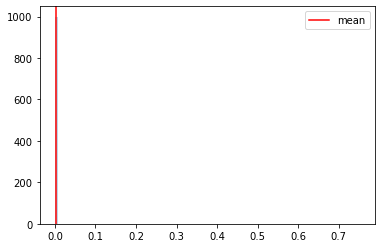

  0%|▏                                                                                | 2/1000 [00:00<00:55, 17.90it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654376784
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 10.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:42,  9.67it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<02:17,  7.23it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:01<02:21,  6.99it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<02:29,  6.61it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<02:18,  7.11it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<02:05,  7.87it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:02<02:07,  7.72it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<02:11,  7.48it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<02:01,  8.09it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:52,  8.66it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:03<01:56,  8.34it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<02:01,  8.00it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:13,  7.27it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:08,  7.56it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:04<02:04,  7.76it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:05,  7.71it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:01,  7.91it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:57,  8.18it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:05<01:56,  8.22it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<01:54,  8.36it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<01:55,  8.29it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<01:57,  8.14it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:06<01:59,  7.96it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:06<02:05,  7.57it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<01:57,  8.10it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<01:54,  8.24it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:07<01:59,  7.92it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▌                                                                           | 57/1000 [00:07<01:57,  8.05it/s]

Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:22,  6.60it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:09,  7.23it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:08<02:11,  7.14it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:05,  7.45it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:03,  7.54it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:09<02:10,  7.13it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:09<02:13,  6.97it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:04,  7.43it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:03,  7.49it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:10<02:00,  7.65it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<01:59,  7.68it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<01:53,  8.07it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<01:51,  8.23it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:11<01:56,  7.87it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<01:55,  7.90it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<01:59,  7.65it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:04,  7.28it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:00,  7.52it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<01:55,  7.80it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:00,  7.49it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:05,  7.21it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<01:59,  7.51it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:20,  6.39it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:22,  6.27it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:09,  6.90it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:09,  6.89it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:05,  7.08it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<01:59,  7.45it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:04,  7.12it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:09,  6.84it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:07,  6.88it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<01:59,  7.34it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:03,  7.08it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:01,  7.21it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:05,  6.95it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:03,  7.03it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:01,  7.15it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<01:58,  7.29it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<01:57,  7.36it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<01:55,  7.49it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<01:59,  7.23it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<01:58,  7.22it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<01:59,  7.19it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:03,  6.91it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:06,  6.72it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:10,  6.52it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:03,  6.90it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:03,  6.84it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:00,  7.03it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:08,  6.58it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<02:12,  6.35it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:21<02:13,  6.28it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:06,  6.64it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:04,  6.73it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:06,  6.57it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:04,  6.65it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:23<02:14,  6.19it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:23<02:11,  6.30it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:07,  6.49it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:24<02:09,  6.35it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:24<02:17,  5.98it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:24<02:14,  6.11it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:12,  6.19it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▍                                                                | 183/1000 [00:25<02:44,  4.96it/s]

Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:25<02:35,  5.23it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:28,  5.46it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:26<02:20,  5.79it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:26<02:13,  6.05it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:27<02:15,  5.94it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:27<02:15,  5.93it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:27<02:14,  5.97it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:09,  6.16it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:28<02:12,  6.03it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:28<02:12,  6.03it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:11,  6.04it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:29<02:09,  6.15it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:29<02:14,  5.86it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:30<02:13,  5.91it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:30<02:13,  5.90it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:30<02:14,  5.85it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:11,  5.96it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:10,  5.99it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:31<02:17,  5.68it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:18,  5.62it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:32<02:20,  5.52it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:32<02:22,  5.42it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:32<02:20,  5.53it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:16,  5.64it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████                                                             | 229/1000 [00:33<02:14,  5.71it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:33<02:26,  5.25it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:24,  5.30it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:23,  5.34it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:19,  5.51it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:34<02:14,  5.69it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:15,  5.61it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:35<02:15,  5.62it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:35<02:19,  5.43it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:35<02:18,  5.50it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:35<02:17,  5.51it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:36<02:18,  5.45it/s]

Monte Carlo 243
Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:36<02:15,  5.55it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:36<02:12,  5.66it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:37<02:19,  5.38it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:37<02:18,  5.39it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:37<02:19,  5.36it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:37<02:17,  5.43it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:38<02:19,  5.35it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:38<02:15,  5.48it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:38<02:16,  5.44it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:38<02:18,  5.36it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:38<02:19,  5.30it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:39<02:17,  5.39it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:39<02:11,  5.60it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:39<02:17,  5.34it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:40<02:18,  5.32it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:40<02:19,  5.25it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:40<02:21,  5.16it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:40<02:17,  5.30it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:41<02:15,  5.36it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:41<02:15,  5.38it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:41<02:16,  5.33it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:41<02:14,  5.39it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:42<02:17,  5.28it/s]

Monte Carlo 275
Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:42<02:21,  5.11it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:42<02:18,  5.19it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:43<02:17,  5.21it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:43<02:23,  5.01it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:43<02:27,  4.85it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:44<02:28,  4.82it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:44<02:24,  4.94it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:44<02:21,  5.04it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:44<02:18,  5.12it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:44<02:16,  5.20it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:45<02:14,  5.27it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:45<02:17,  5.13it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:45<02:17,  5.14it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:45<02:16,  5.16it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:46<02:21,  4.98it/s]

Monte Carlo 296
Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:46<02:22,  4.91it/s]

Monte Carlo 298
Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:47<02:26,  4.77it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:47<02:22,  4.88it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:47<02:19,  5.00it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:47<02:15,  5.14it/s]

Monte Carlo 303
Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:48<02:20,  4.92it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:48<02:21,  4.89it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:48<02:18,  4.99it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:48<02:20,  4.93it/s]

Monte Carlo 308
Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:49<02:23,  4.81it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:49<02:18,  4.96it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:49<02:19,  4.91it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:49<02:16,  5.03it/s]

Monte Carlo 313
Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:50<02:22,  4.81it/s]

Monte Carlo 315
Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:50<02:22,  4.79it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:50<02:18,  4.91it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:51<02:18,  4.91it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:51<02:17,  4.93it/s]

Monte Carlo 320
Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:51<02:20,  4.81it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:51<02:17,  4.91it/s]

Monte Carlo 323
Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:52<02:16,  4.95it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:52<02:20,  4.81it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:52<02:22,  4.71it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:52<02:18,  4.84it/s]

Monte Carlo 328
Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:53<02:18,  4.83it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:53<02:18,  4.83it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:53<02:19,  4.79it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:53<02:24,  4.62it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:54<02:26,  4.54it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:54<02:18,  4.78it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:54<02:22,  4.64it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:54<02:22,  4.64it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:55<02:21,  4.67it/s]

Monte Carlo 339
Monte Carlo 340


 34%|███████████████████████████                                                    | 342/1000 [00:55<02:22,  4.63it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 343/1000 [00:55<02:20,  4.68it/s]

Monte Carlo 342
Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:56<02:17,  4.76it/s]

Monte Carlo 344


 35%|███████████████████████████▎                                                   | 346/1000 [00:56<02:17,  4.75it/s]

Monte Carlo 345
Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:56<02:18,  4.71it/s]

Monte Carlo 347


 35%|███████████████████████████▌                                                   | 349/1000 [00:57<02:17,  4.74it/s]

Monte Carlo 348
Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:57<02:19,  4.64it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:57<02:24,  4.49it/s]

Monte Carlo 351


 35%|███████████████████████████▉                                                   | 353/1000 [00:58<02:18,  4.69it/s]

Monte Carlo 352
Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:58<02:23,  4.50it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [00:58<02:22,  4.51it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [00:58<02:23,  4.50it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [00:58<02:22,  4.50it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 359/1000 [00:59<02:17,  4.68it/s]

Monte Carlo 358
Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [00:59<02:21,  4.52it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [00:59<02:24,  4.44it/s]

Monte Carlo 361


 36%|████████████████████████████▋                                                  | 363/1000 [01:00<02:21,  4.52it/s]

Monte Carlo 362
Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:00<02:26,  4.34it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:00<02:44,  3.85it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:01<02:34,  4.10it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:01<02:30,  4.21it/s]

Monte Carlo 367


 37%|█████████████████████████████▏                                                 | 369/1000 [01:01<02:17,  4.58it/s]

Monte Carlo 368
Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:01<02:19,  4.52it/s]

Monte Carlo 370


 37%|█████████████████████████████▍                                                 | 372/1000 [01:02<02:16,  4.61it/s]

Monte Carlo 371
Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:02<02:19,  4.50it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:02<02:20,  4.46it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:03<02:17,  4.55it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:03<02:19,  4.47it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 378/1000 [01:03<02:19,  4.47it/s]

Monte Carlo 377
Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:03<02:20,  4.41it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:04<02:20,  4.40it/s]

Monte Carlo 380


 38%|██████████████████████████████▏                                                | 382/1000 [01:04<02:18,  4.47it/s]

Monte Carlo 381
Monte Carlo 382


 38%|██████████████████████████████▎                                                | 384/1000 [01:05<02:11,  4.69it/s]

Monte Carlo 383
Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:05<02:13,  4.61it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:05<02:11,  4.67it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:05<02:12,  4.64it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:05<02:13,  4.57it/s]

Monte Carlo 388


 39%|██████████████████████████████▊                                                | 390/1000 [01:06<02:12,  4.59it/s]

Monte Carlo 389


 39%|██████████████████████████████▉                                                | 391/1000 [01:06<02:09,  4.69it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 392/1000 [01:06<02:06,  4.79it/s]

Monte Carlo 391


 39%|███████████████████████████████                                                | 393/1000 [01:06<02:03,  4.91it/s]

Monte Carlo 392


 39%|███████████████████████████████▏                                               | 394/1000 [01:07<02:05,  4.85it/s]

Monte Carlo 393


 40%|███████████████████████████████▏                                               | 395/1000 [01:07<02:05,  4.84it/s]

Monte Carlo 394


 40%|███████████████████████████████▎                                               | 396/1000 [01:07<02:03,  4.88it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 397/1000 [01:07<02:03,  4.88it/s]

Monte Carlo 396
Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:08<02:06,  4.76it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 400/1000 [01:08<02:06,  4.75it/s]

Monte Carlo 399


 40%|███████████████████████████████▋                                               | 401/1000 [01:08<02:06,  4.73it/s]

Monte Carlo 400


 40%|███████████████████████████████▊                                               | 402/1000 [01:08<02:04,  4.79it/s]

Monte Carlo 401
Monte Carlo 402


 40%|███████████████████████████████▉                                               | 404/1000 [01:09<02:05,  4.76it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 405/1000 [01:09<02:03,  4.80it/s]

Monte Carlo 404


 41%|████████████████████████████████                                               | 406/1000 [01:09<02:01,  4.89it/s]

Monte Carlo 405
Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:09<02:02,  4.83it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:10<02:05,  4.71it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:10<02:09,  4.55it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 411/1000 [01:10<02:10,  4.51it/s]

Monte Carlo 410
Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:11<02:09,  4.54it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:11<02:07,  4.59it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:11<02:08,  4.57it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:11<02:08,  4.55it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:11<02:21,  4.13it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:12<02:17,  4.25it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:12<02:14,  4.31it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:12<02:15,  4.28it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:12<02:13,  4.36it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 422/1000 [01:13<02:14,  4.29it/s]

Monte Carlo 421
Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:13<02:13,  4.31it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:13<02:12,  4.35it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:14<02:11,  4.38it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:14<02:14,  4.27it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:14<02:17,  4.16it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:14<02:15,  4.23it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:15<02:15,  4.20it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:15<02:18,  4.12it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:15<02:14,  4.22it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:15<02:12,  4.29it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:15<02:10,  4.33it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:16<02:15,  4.18it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:16<02:12,  4.25it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:16<02:11,  4.28it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:16<02:12,  4.25it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:17<02:13,  4.21it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:17<02:11,  4.26it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:17<02:12,  4.23it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:17<02:13,  4.20it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:18<02:13,  4.18it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:18<02:12,  4.19it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:18<02:09,  4.28it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:18<02:09,  4.30it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:19<02:12,  4.19it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:19<02:12,  4.19it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:19<02:10,  4.23it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:19<02:10,  4.23it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:20<02:16,  4.04it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:20<02:17,  3.99it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:20<02:16,  4.01it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:20<02:22,  3.83it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:21<02:23,  3.81it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:21<02:22,  3.82it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:21<02:21,  3.85it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:21<02:18,  3.93it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:22<02:21,  3.84it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:22<02:23,  3.78it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:22<02:20,  3.85it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:22<02:17,  3.91it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:23<02:12,  4.06it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:23<02:15,  3.97it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:23<02:11,  4.08it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:23<02:14,  3.98it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:24<02:16,  3.90it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:24<02:14,  3.96it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:24<02:13,  4.00it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:24<02:10,  4.07it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:25<02:13,  3.98it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:25<02:18,  3.83it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:25<02:16,  3.87it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:25<02:16,  3.86it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:26<02:15,  3.87it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:26<02:20,  3.75it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:26<02:15,  3.87it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:26<02:17,  3.80it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:27<02:15,  3.85it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:27<02:33,  3.39it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:27<02:25,  3.56it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:28<02:23,  3.61it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:28<02:17,  3.76it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:28<02:21,  3.65it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:28<02:16,  3.79it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:29<02:14,  3.84it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:29<02:14,  3.82it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:29<02:14,  3.81it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:29<02:11,  3.89it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:30<02:11,  3.89it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:30<02:12,  3.85it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:30<02:08,  3.96it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:30<02:10,  3.89it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:31<02:09,  3.90it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:31<02:09,  3.89it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:31<02:12,  3.82it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:31<02:12,  3.82it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:32<02:08,  3.90it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:32<02:11,  3.83it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:32<02:10,  3.85it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:33<02:11,  3.80it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:33<02:17,  3.64it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:33<02:14,  3.69it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:33<02:11,  3.79it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:34<02:07,  3.88it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:34<02:05,  3.94it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:34<02:04,  3.96it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:34<02:03,  3.99it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:35<02:03,  3.97it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:35<02:02,  4.00it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:35<02:04,  3.95it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:35<02:02,  3.98it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:36<02:05,  3.89it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:36<02:07,  3.82it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:36<02:04,  3.90it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:36<02:06,  3.85it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:37<02:06,  3.83it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:37<02:08,  3.76it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:37<02:06,  3.83it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:37<02:06,  3.81it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:38<02:10,  3.69it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:38<02:08,  3.73it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:38<02:06,  3.77it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:39<02:06,  3.78it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:39<02:05,  3.81it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:39<02:01,  3.90it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:39<02:01,  3.91it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:40<02:03,  3.84it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:40<02:02,  3.86it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:40<02:01,  3.89it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:40<02:00,  3.91it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:41<02:00,  3.90it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:41<02:04,  3.77it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:41<02:02,  3.82it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:41<01:59,  3.89it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:42<02:02,  3.78it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:42<02:04,  3.73it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:42<02:02,  3.79it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:42<02:03,  3.75it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:43<02:01,  3.78it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:43<02:04,  3.71it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:43<01:59,  3.83it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:43<01:56,  3.92it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:44<01:57,  3.88it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:44<01:54,  3.98it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:44<01:52,  4.04it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:44<01:55,  3.93it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:45<01:55,  3.92it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:45<01:53,  3.99it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:45<01:50,  4.06it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:45<01:56,  3.87it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:46<01:53,  3.95it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:46<01:52,  3.98it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:46<01:50,  4.03it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:46<01:52,  3.98it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:47<01:51,  3.98it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:47<01:56,  3.83it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:47<01:55,  3.83it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:48<01:53,  3.88it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:48<01:52,  3.92it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:48<01:55,  3.80it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:48<01:52,  3.89it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:49<01:53,  3.87it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:49<01:54,  3.83it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:49<01:52,  3.88it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:49<01:51,  3.90it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:50<01:53,  3.82it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:50<01:54,  3.77it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:50<01:57,  3.68it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:50<01:55,  3.74it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:51<01:58,  3.63it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:51<02:00,  3.56it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:51<02:01,  3.52it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:52<02:03,  3.47it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:52<02:05,  3.39it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:52<02:04,  3.41it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:52<01:58,  3.59it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:53<01:57,  3.60it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:53<01:54,  3.70it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:53<01:50,  3.81it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:53<01:49,  3.82it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:54<01:46,  3.93it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:54<01:46,  3.91it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:54<01:45,  3.95it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:54<01:47,  3.88it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:55<01:45,  3.92it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [01:55<01:48,  3.81it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [01:55<01:49,  3.78it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [01:56<01:49,  3.77it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [01:56<01:50,  3.71it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [01:56<01:49,  3.73it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [01:56<01:50,  3.71it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [01:57<01:49,  3.72it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [01:57<01:49,  3.70it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [01:57<01:49,  3.69it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [01:57<01:49,  3.70it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [01:58<01:52,  3.58it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [01:58<01:50,  3.64it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [01:58<01:48,  3.70it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [01:59<01:49,  3.67it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [01:59<01:46,  3.74it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [01:59<02:05,  3.18it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [01:59<02:00,  3.31it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:00<01:56,  3.42it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:00<01:52,  3.51it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:00<01:49,  3.59it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:01<01:48,  3.64it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:01<01:46,  3.68it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:01<01:49,  3.58it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:01<01:46,  3.66it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:02<01:45,  3.68it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:02<01:44,  3.71it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:02<01:44,  3.71it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:02<01:45,  3.68it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:03<01:47,  3.58it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:03<01:47,  3.59it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:03<01:44,  3.68it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:04<01:46,  3.60it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:04<01:45,  3.63it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:04<01:44,  3.66it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:04<01:44,  3.63it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:05<01:42,  3.69it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:05<01:42,  3.68it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:05<01:41,  3.71it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:05<01:44,  3.61it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:06<01:44,  3.59it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:06<01:45,  3.54it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:06<01:45,  3.53it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:07<01:47,  3.46it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:07<01:45,  3.50it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:07<01:45,  3.50it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:08<01:45,  3.51it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:08<01:44,  3.51it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:08<01:49,  3.35it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:08<01:54,  3.20it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:09<01:55,  3.17it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:09<01:52,  3.24it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:09<01:50,  3.27it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:10<01:50,  3.28it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:10<01:51,  3.23it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:10<01:51,  3.23it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:11<01:48,  3.30it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:11<01:51,  3.21it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:11<01:50,  3.24it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:12<01:49,  3.26it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:12<01:48,  3.27it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:12<01:48,  3.27it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:12<01:50,  3.19it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:13<01:52,  3.12it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:13<01:53,  3.09it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:13<01:52,  3.10it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:14<01:55,  3.03it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:14<01:51,  3.12it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:14<01:50,  3.15it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:15<01:49,  3.17it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:15<01:47,  3.21it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:15<01:46,  3.23it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:16<01:47,  3.18it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:16<01:47,  3.19it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:16<01:52,  3.04it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:17<01:50,  3.09it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:17<01:49,  3.10it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:17<01:48,  3.11it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:18<01:48,  3.11it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:18<01:48,  3.09it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:18<01:46,  3.14it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:19<01:46,  3.13it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:19<01:45,  3.15it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:19<01:47,  3.10it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:20<01:46,  3.12it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:20<01:44,  3.14it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:20<01:47,  3.07it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:21<01:46,  3.08it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:21<01:43,  3.15it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:21<01:46,  3.06it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:22<01:51,  2.93it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:22<01:46,  3.04it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:22<01:46,  3.02it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:22<01:45,  3.04it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:23<01:43,  3.10it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:23<01:43,  3.09it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:23<01:44,  3.05it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:24<01:42,  3.10it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:24<01:43,  3.07it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:24<01:42,  3.09it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:25<01:43,  3.05it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:25<01:44,  2.99it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:25<01:48,  2.87it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:26<01:43,  3.00it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:26<01:43,  3.01it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:26<01:45,  2.94it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:27<01:42,  3.01it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:27<01:42,  3.01it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:27<01:42,  2.99it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:28<01:41,  3.01it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:28<01:40,  3.04it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:28<01:42,  2.95it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:29<01:41,  3.00it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:29<01:40,  3.00it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:29<01:41,  2.95it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:30<01:41,  2.96it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:30<01:38,  3.02it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:31<01:42,  2.91it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:31<01:45,  2.81it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:31<01:47,  2.76it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:32<01:46,  2.76it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:32<01:46,  2.76it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:32<01:45,  2.78it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:33<01:47,  2.72it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:33<01:44,  2.80it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:33<01:41,  2.86it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:34<01:41,  2.86it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:34<01:41,  2.84it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:34<01:38,  2.91it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:35<01:35,  3.00it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:35<01:32,  3.07it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:35<01:34,  3.01it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:36<01:34,  2.99it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:36<01:41,  2.78it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:36<01:36,  2.92it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:37<01:38,  2.84it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:37<01:40,  2.79it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:38<01:37,  2.86it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:38<01:35,  2.90it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:38<01:34,  2.92it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:39<01:32,  2.98it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:39<01:31,  2.99it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:39<01:31,  2.99it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:39<01:28,  3.06it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:40<01:31,  2.97it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:40<01:30,  2.99it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:41<01:30,  2.97it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:41<01:29,  2.99it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:41<01:30,  2.95it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:42<01:29,  2.98it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:42<01:27,  3.02it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:42<01:28,  2.98it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:43<01:27,  3.00it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:43<01:28,  2.96it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:43<01:28,  2.94it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:44<01:31,  2.84it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:44<01:36,  2.67it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:44<01:37,  2.64it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:45<01:35,  2.68it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:45<01:31,  2.80it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:45<01:28,  2.87it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:46<01:28,  2.86it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:46<01:27,  2.89it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:46<01:25,  2.96it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:47<01:26,  2.90it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:47<01:25,  2.93it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:47<01:25,  2.93it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:48<01:27,  2.84it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:48<01:28,  2.80it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:49<01:26,  2.85it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:49<01:24,  2.89it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:49<01:25,  2.85it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:50<01:25,  2.85it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:50<01:25,  2.84it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:50<01:23,  2.89it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:51<01:24,  2.84it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:51<01:26,  2.77it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:51<01:24,  2.82it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:52<01:23,  2.84it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:52<01:21,  2.91it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:52<01:19,  2.94it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:53<01:19,  2.94it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [02:53<01:19,  2.93it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [02:53<01:18,  2.96it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [02:54<01:19,  2.91it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [02:54<01:17,  2.97it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [02:54<01:17,  2.97it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [02:55<01:16,  2.99it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [02:55<01:17,  2.95it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [02:55<01:17,  2.92it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [02:56<01:17,  2.89it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [02:56<01:16,  2.92it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [02:56<01:15,  2.94it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [02:57<01:16,  2.89it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [02:57<01:15,  2.92it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [02:57<01:15,  2.93it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [02:58<01:15,  2.89it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [02:58<01:14,  2.94it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [02:59<01:15,  2.89it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [02:59<01:16,  2.83it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [02:59<01:14,  2.87it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:00<01:15,  2.84it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:00<01:14,  2.85it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:00<01:15,  2.82it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:01<01:13,  2.85it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:01<01:14,  2.81it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:01<01:13,  2.85it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:02<01:12,  2.86it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:02<01:13,  2.82it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:02<01:14,  2.76it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:03<01:13,  2.78it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:03<01:14,  2.75it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:04<01:13,  2.76it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:04<01:12,  2.80it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:04<01:12,  2.77it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:05<01:12,  2.77it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:05<01:11,  2.78it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:05<01:09,  2.83it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:06<01:09,  2.82it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:06<01:11,  2.75it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:06<01:09,  2.82it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:07<01:09,  2.78it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:07<01:08,  2.83it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:07<01:08,  2.81it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:08<01:07,  2.83it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:08<01:06,  2.86it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:08<01:05,  2.89it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:09<01:05,  2.86it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:09<01:06,  2.81it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:10<01:08,  2.71it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:10<01:06,  2.79it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:10<01:06,  2.75it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:11<01:05,  2.79it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:11<01:04,  2.83it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:11<01:03,  2.84it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:12<01:03,  2.84it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:12<01:02,  2.86it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:12<01:02,  2.86it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:13<01:03,  2.78it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:13<01:04,  2.75it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:14<01:03,  2.78it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:14<01:04,  2.71it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:14<01:03,  2.73it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:15<01:02,  2.76it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:15<01:01,  2.78it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:15<01:05,  2.60it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:16<01:04,  2.64it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:16<01:02,  2.68it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:17<01:03,  2.63it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:17<01:02,  2.66it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:17<01:00,  2.72it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:18<00:59,  2.76it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:18<01:00,  2.72it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:18<00:58,  2.76it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:19<00:58,  2.75it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:19<00:58,  2.75it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:19<00:58,  2.73it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:20<00:58,  2.70it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:20<00:58,  2.68it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:21<00:58,  2.67it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:21<00:57,  2.69it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:21<00:58,  2.64it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:22<00:56,  2.69it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:22<00:56,  2.69it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:22<00:55,  2.70it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:23<00:55,  2.70it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:23<00:55,  2.69it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:24<00:55,  2.67it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:24<00:54,  2.69it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:24<00:54,  2.67it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:25<00:55,  2.63it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:25<00:54,  2.63it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:25<00:53,  2.66it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:26<00:54,  2.60it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:26<00:55,  2.55it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:27<00:54,  2.56it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:27<00:52,  2.62it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:27<00:51,  2.66it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:28<00:51,  2.67it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:28<00:50,  2.70it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:28<00:50,  2.70it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:29<00:48,  2.77it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:29<00:47,  2.81it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:29<00:45,  2.88it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:30<00:45,  2.86it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:30<00:46,  2.79it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:31<00:47,  2.74it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:31<00:46,  2.76it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:31<00:46,  2.74it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:32<00:45,  2.76it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:32<00:45,  2.76it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:32<00:45,  2.72it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:33<00:45,  2.72it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:33<00:44,  2.75it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:33<00:43,  2.77it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:34<00:43,  2.77it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:34<00:42,  2.79it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:35<00:43,  2.71it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:35<00:43,  2.72it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:35<00:43,  2.69it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:36<00:43,  2.64it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:36<00:42,  2.67it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:36<00:42,  2.63it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:37<00:42,  2.65it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:37<00:43,  2.56it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:38<00:42,  2.60it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:38<00:41,  2.64it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:38<00:40,  2.65it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:39<00:40,  2.67it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:39<00:39,  2.70it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:40<00:39,  2.64it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:40<00:39,  2.64it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:40<00:39,  2.60it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:41<00:39,  2.60it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:41<00:37,  2.68it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:41<00:36,  2.73it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:42<00:35,  2.76it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:42<00:35,  2.77it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:42<00:35,  2.76it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:43<00:34,  2.78it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:43<00:34,  2.76it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:44<00:34,  2.75it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:44<00:34,  2.73it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:44<00:33,  2.75it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:45<00:33,  2.71it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:45<00:33,  2.67it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:45<00:32,  2.71it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:46<00:32,  2.73it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:46<00:32,  2.69it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:47<00:31,  2.69it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:47<00:31,  2.71it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:47<00:30,  2.72it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:48<00:30,  2.72it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:48<00:30,  2.71it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:48<00:29,  2.71it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:49<00:29,  2.73it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:49<00:28,  2.76it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:49<00:28,  2.74it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [03:50<00:28,  2.69it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [03:50<00:28,  2.68it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [03:51<00:27,  2.74it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [03:51<00:27,  2.73it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [03:51<00:26,  2.71it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [03:52<00:26,  2.71it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [03:52<00:28,  2.48it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [03:53<00:27,  2.51it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [03:53<00:27,  2.54it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [03:53<00:27,  2.52it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [03:54<00:26,  2.49it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [03:54<00:26,  2.53it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [03:55<00:25,  2.51it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [03:55<00:25,  2.51it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [03:55<00:24,  2.52it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [03:56<00:24,  2.53it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [03:56<00:25,  2.43it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [03:57<00:24,  2.45it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [03:57<00:24,  2.46it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [03:57<00:23,  2.44it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [03:58<00:22,  2.50it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [03:58<00:22,  2.49it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [03:59<00:21,  2.51it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [03:59<00:21,  2.54it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [03:59<00:20,  2.54it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:00<00:20,  2.53it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:00<00:20,  2.47it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:01<00:20,  2.42it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:01<00:20,  2.42it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:01<00:19,  2.42it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:02<00:19,  2.46it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:02<00:19,  2.41it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:03<00:18,  2.42it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:03<00:18,  2.42it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:03<00:17,  2.39it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:04<00:17,  2.37it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:04<00:16,  2.42it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:05<00:16,  2.41it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:05<00:16,  2.41it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:06<00:15,  2.42it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:06<00:15,  2.42it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:06<00:14,  2.42it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:07<00:14,  2.43it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:07<00:13,  2.43it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:08<00:13,  2.42it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:08<00:13,  2.43it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:08<00:12,  2.43it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:09<00:12,  2.46it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:09<00:11,  2.46it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:10<00:11,  2.48it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:10<00:11,  2.45it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:10<00:10,  2.42it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:11<00:10,  2.41it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:11<00:09,  2.41it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:12<00:09,  2.39it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:12<00:09,  2.42it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:13<00:08,  2.43it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:13<00:08,  2.43it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:13<00:07,  2.44it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:14<00:07,  2.39it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:14<00:07,  2.36it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:15<00:06,  2.35it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:15<00:06,  2.38it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:16<00:05,  2.35it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:16<00:05,  2.30it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:16<00:05,  2.18it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:17<00:04,  2.23it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:17<00:04,  2.25it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:18<00:03,  2.26it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:18<00:03,  2.34it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:19<00:02,  2.35it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:19<00:02,  2.37it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:19<00:02,  2.33it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:20<00:01,  2.37it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:20<00:01,  2.39it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:21<00:00,  2.36it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:21<00:00,  2.32it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:22<00:00,  3.82it/s]


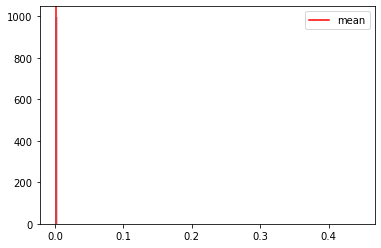

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654377047
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 10.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:08, 14.60it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:24, 11.77it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:51,  8.89it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:53,  8.69it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:55,  8.53it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:55,  8.51it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:56,  8.43it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:51,  8.84it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:50,  8.85it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:55,  8.48it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:49,  8.93it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:52,  8.63it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:54,  8.52it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:02,  7.90it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:14,  7.20it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<02:10,  7.40it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:02,  7.87it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:59,  8.05it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:59,  8.01it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<01:54,  8.34it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<01:59,  8.02it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<01:55,  8.24it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<02:01,  7.84it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:05<02:03,  7.72it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<02:04,  7.60it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<02:03,  7.68it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<02:07,  7.42it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<02:08,  7.33it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<02:06,  7.42it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<02:05,  7.48it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:07<01:59,  7.83it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:08<01:58,  7.87it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:08<01:58,  7.87it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:08<01:57,  7.89it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:08<02:04,  7.45it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:09<02:06,  7.30it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<02:07,  7.26it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:09<02:14,  6.83it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:10<02:11,  6.99it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:10<02:11,  6.97it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:10<02:17,  6.66it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:10<02:16,  6.70it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:11<02:13,  6.83it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:11<02:11,  6.94it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:11<02:09,  6.99it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:12<02:07,  7.13it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:12<02:11,  6.89it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:12<02:06,  7.14it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:12<02:13,  6.74it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:13<02:09,  6.92it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:13<02:05,  7.14it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:13<02:11,  6.81it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▍                                                                      | 107/1000 [00:13<02:12,  6.73it/s]

Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:32,  5.84it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:19,  6.36it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:16,  6.50it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:11,  6.74it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:05,  7.05it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:11,  6.72it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:08,  6.86it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:12,  6.60it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:12,  6.58it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:09,  6.73it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:06,  6.89it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:11,  6.61it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:07,  6.82it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:05,  6.87it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:08,  6.71it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:11,  6.56it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:12,  6.46it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:11,  6.50it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:11,  6.49it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:11,  6.49it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:10,  6.54it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:13,  6.36it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<02:19,  6.09it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:22,  5.95it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:18,  6.11it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:20,  5.99it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:15,  6.19it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:09,  6.45it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:13,  6.24it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:12,  6.28it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:12,  6.28it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:23<02:19,  5.94it/s]

Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:24<02:17,  6.01it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:16,  6.05it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:24,  5.69it/s]

Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:25<02:26,  5.61it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:27,  5.59it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:20,  5.83it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:18,  5.92it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:21,  5.76it/s]

Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:20,  5.82it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:19,  5.82it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:27<02:21,  5.72it/s]

Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:17,  5.88it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:27<02:11,  6.15it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:14,  6.01it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:17,  5.86it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:17,  5.82it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:16,  5.85it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:14,  5.95it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:29<02:15,  5.88it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:19,  5.71it/s]

Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:29<02:18,  5.74it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:18,  5.73it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:14,  5.89it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:31<02:18,  5.70it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:20,  5.61it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:17,  5.70it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:15,  5.77it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:20,  5.56it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:21,  5.52it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:23,  5.42it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:22,  5.45it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:19,  5.57it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:18,  5.61it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:17,  5.62it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:20,  5.48it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:17,  5.59it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:37,  4.87it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:33,  4.98it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:25,  5.28it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:22,  5.35it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:17,  5.54it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:15,  5.60it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:15,  5.62it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:11,  5.77it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:04,  6.05it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:04,  6.03it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:37<02:05,  6.00it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:06,  5.93it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:10,  5.72it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:38<02:09,  5.78it/s]

Monte Carlo 252
Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:38<02:15,  5.50it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▏                                                          | 256/1000 [00:38<02:19,  5.32it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:39<02:32,  4.86it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:41,  4.59it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 260/1000 [00:39<02:38,  4.66it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:40<02:36,  4.73it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:32,  4.82it/s]

Monte Carlo 263
Monte Carlo 264


 26%|████████████████████▉                                                          | 265/1000 [00:40<02:28,  4.95it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 266/1000 [00:41<02:29,  4.91it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:41<02:29,  4.90it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:41<02:25,  5.03it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:22,  5.12it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:26,  4.96it/s]

Monte Carlo 272


 27%|█████████████████████▌                                                         | 273/1000 [00:42<02:28,  4.88it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:42<02:29,  4.85it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:26,  4.92it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:23,  5.03it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:43<02:24,  4.97it/s]

Monte Carlo 279
Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:24,  4.96it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:19,  5.13it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:44<02:20,  5.09it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:17,  5.19it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:45<02:20,  5.07it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:20,  5.07it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:45<02:23,  4.95it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:46<02:23,  4.92it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:46<02:30,  4.69it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:33,  4.61it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:46<02:40,  4.41it/s]

Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:47<02:39,  4.42it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:40,  4.39it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:47<02:35,  4.52it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:47<02:38,  4.44it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:37,  4.44it/s]

Monte Carlo 299
Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:47,  4.16it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:48<03:01,  3.84it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:56,  3.95it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:49<02:55,  3.96it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:49<03:10,  3.66it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:49<03:08,  3.67it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:58,  3.89it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:50<03:11,  3.61it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:50<03:08,  3.67it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:50<02:56,  3.90it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:51<02:54,  3.94it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:51,  4.02it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:39,  4.31it/s]

Monte Carlo 313
Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:52<02:35,  4.41it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:33,  4.46it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:33,  4.44it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:31,  4.50it/s]

Monte Carlo 318
Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<02:38,  4.28it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:37,  4.31it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:53<02:35,  4.36it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:36,  4.33it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:54<02:36,  4.33it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:35,  4.33it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:35,  4.35it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:42,  4.15it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:55<02:43,  4.11it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:55<02:41,  4.15it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:41,  4.15it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:55<02:39,  4.19it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:56<02:37,  4.24it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:56<02:35,  4.29it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:56<02:38,  4.20it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:39,  4.16it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:37,  4.22it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:57<02:46,  3.98it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:57<02:42,  4.08it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:57<02:36,  4.21it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:30,  4.37it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:58<02:37,  4.17it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:58<02:37,  4.17it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:58<02:51,  3.84it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:44,  3.99it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:59<02:42,  4.03it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:59<02:39,  4.10it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:59<02:41,  4.04it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:41,  4.03it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:00<02:38,  4.11it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:00<02:40,  4.06it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:00<02:40,  4.03it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:00<02:40,  4.04it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:01<02:48,  3.85it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:01<02:48,  3.84it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:01<02:44,  3.92it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:01<02:41,  3.98it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:02<02:40,  4.02it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:02<02:40,  3.99it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:02<02:39,  4.03it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:02<02:34,  4.15it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:03<02:32,  4.18it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:03<02:31,  4.20it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:03<02:40,  3.98it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:03<02:44,  3.86it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:04<02:49,  3.75it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:04<02:53,  3.65it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:04<02:52,  3.68it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:05<02:46,  3.80it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:05<02:48,  3.75it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:05<02:57,  3.54it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:05<03:05,  3.40it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:06<03:00,  3.48it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:06<03:00,  3.48it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:06<03:00,  3.47it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:07<02:48,  3.70it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:07<02:41,  3.86it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:07<02:37,  3.95it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:07<02:35,  3.99it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:08<02:40,  3.87it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:08<02:38,  3.90it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:08<02:38,  3.91it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:08<02:37,  3.92it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:09<02:45,  3.73it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:09<02:45,  3.72it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:09<02:41,  3.81it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:09<02:34,  3.98it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:10<02:35,  3.94it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:10<02:39,  3.84it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:10<02:34,  3.95it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:10<02:34,  3.95it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:11<02:30,  4.05it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:11<02:45,  3.68it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:11<02:44,  3.69it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:11<02:39,  3.81it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:12<02:32,  3.97it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:12<02:31,  3.99it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:12<02:31,  3.98it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:12<02:28,  4.04it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:13<02:29,  4.02it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:13<02:50,  3.52it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:13<02:39,  3.76it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:13<02:40,  3.73it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:14<02:36,  3.81it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:14<02:34,  3.87it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:14<02:33,  3.87it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:14<02:31,  3.92it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:15<02:31,  3.92it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:15<02:32,  3.87it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:15<02:30,  3.92it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:16<02:34,  3.81it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:16<02:41,  3.65it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:16<02:39,  3.70it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:16<02:41,  3.63it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:17<02:38,  3.69it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:17<02:40,  3.65it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:17<02:46,  3.51it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:18<02:47,  3.48it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:18<02:45,  3.51it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:18<02:44,  3.52it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:18<02:41,  3.60it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:19<02:38,  3.65it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:19<02:34,  3.73it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:19<02:35,  3.71it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:19<02:32,  3.77it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:20<02:30,  3.82it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:20<02:31,  3.79it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:20<02:30,  3.81it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:20<02:30,  3.81it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:21<02:40,  3.56it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:21<02:41,  3.54it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:21<02:41,  3.53it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:22<02:42,  3.50it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:22<02:43,  3.47it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:22<02:37,  3.58it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:22<02:35,  3.64it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:23<02:30,  3.74it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:23<02:39,  3.54it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:23<02:39,  3.52it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:24<02:39,  3.51it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:24<02:41,  3.46it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:24<02:42,  3.44it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:24<02:37,  3.54it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:25<02:40,  3.46it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:25<02:46,  3.33it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:25<02:38,  3.50it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:26<02:36,  3.53it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:26<02:36,  3.53it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:26<02:34,  3.58it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:26<02:38,  3.47it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:27<02:37,  3.49it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:27<02:38,  3.47it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:27<02:33,  3.57it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:28<02:31,  3.61it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:28<02:32,  3.57it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:28<02:32,  3.58it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:28<02:34,  3.52it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:29<02:40,  3.39it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:29<02:36,  3.47it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:29<02:38,  3.42it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:30<02:34,  3.51it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:30<02:33,  3.52it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:30<02:36,  3.44it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:30<02:36,  3.42it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:31<02:37,  3.41it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:31<02:37,  3.40it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:31<02:30,  3.54it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:32<02:27,  3.62it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:32<02:24,  3.69it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:32<02:19,  3.81it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:32<02:17,  3.85it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:33<02:18,  3.82it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:33<02:18,  3.81it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:33<02:17,  3.82it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:33<02:19,  3.77it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:34<02:15,  3.87it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:34<02:13,  3.92it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:34<02:17,  3.81it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:34<02:17,  3.81it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:35<02:19,  3.74it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:35<02:18,  3.77it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:35<02:17,  3.77it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:36<02:17,  3.77it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:36<02:21,  3.66it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:36<02:18,  3.73it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:36<02:19,  3.70it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:37<02:18,  3.71it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:37<02:16,  3.75it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:37<02:16,  3.75it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:37<02:19,  3.67it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:38<02:19,  3.67it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:38<02:21,  3.59it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:38<02:20,  3.61it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:39<02:16,  3.70it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:39<02:14,  3.75it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:39<02:13,  3.77it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:39<02:13,  3.77it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:40<02:13,  3.77it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:40<02:15,  3.71it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:40<02:17,  3.64it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:40<02:19,  3.59it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:41<02:15,  3.69it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:41<02:14,  3.71it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:41<02:19,  3.56it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:42<02:22,  3.48it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:42<02:17,  3.61it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:42<02:14,  3.67it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:42<02:14,  3.68it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:43<02:18,  3.56it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:43<02:16,  3.61it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:43<02:18,  3.55it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:43<02:18,  3.53it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:44<02:19,  3.49it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:44<02:17,  3.53it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:44<02:15,  3.60it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:45<02:19,  3.47it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:45<02:17,  3.52it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:45<02:14,  3.59it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:45<02:14,  3.58it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:46<02:10,  3.69it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:46<02:13,  3.60it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:46<02:11,  3.65it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:47<02:14,  3.55it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:47<02:14,  3.55it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:47<02:12,  3.58it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:47<02:12,  3.58it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:48<02:13,  3.56it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:48<02:11,  3.59it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:48<02:12,  3.55it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:49<02:12,  3.55it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:49<02:14,  3.50it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:49<02:11,  3.56it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:49<02:10,  3.57it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:50<02:11,  3.54it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:50<02:10,  3.58it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:50<02:10,  3.56it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:50<02:09,  3.58it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:51<02:10,  3.55it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:51<02:12,  3.49it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:51<02:11,  3.52it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:52<02:11,  3.51it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:52<02:11,  3.49it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:52<02:07,  3.58it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:53<02:11,  3.48it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:53<02:18,  3.28it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:53<02:30,  3.02it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:54<02:26,  3.10it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:54<02:17,  3.28it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:54<02:21,  3.18it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:54<02:17,  3.27it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:55<02:13,  3.36it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:55<02:09,  3.47it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:55<02:06,  3.53it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:56<02:09,  3.46it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:56<02:10,  3.42it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:56<02:14,  3.31it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:57<02:19,  3.19it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:57<02:13,  3.32it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:57<02:14,  3.27it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:57<02:12,  3.34it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:58<02:11,  3.36it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:58<02:08,  3.42it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:58<02:10,  3.36it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:59<02:07,  3.42it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:59<02:08,  3.40it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:59<02:08,  3.38it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:59<02:08,  3.38it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:00<02:06,  3.42it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:00<02:04,  3.47it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:00<02:03,  3.48it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:01<02:04,  3.46it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:01<02:02,  3.49it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:01<02:02,  3.50it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:01<02:02,  3.49it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:02<02:04,  3.41it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:02<02:04,  3.41it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:02<02:03,  3.44it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:03<02:02,  3.46it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:03<02:04,  3.40it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:03<02:01,  3.45it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:03<02:02,  3.43it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:04<02:03,  3.39it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:04<02:03,  3.38it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:04<02:02,  3.39it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:05<02:06,  3.30it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:05<02:06,  3.27it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:05<02:07,  3.24it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:06<02:07,  3.24it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:06<02:08,  3.20it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:06<02:06,  3.25it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:07<02:03,  3.33it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:07<02:03,  3.31it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:07<02:04,  3.28it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:07<02:05,  3.24it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:08<02:05,  3.23it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:08<02:04,  3.24it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:08<02:02,  3.29it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:09<02:05,  3.22it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:09<02:04,  3.22it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:09<02:05,  3.21it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:10<02:01,  3.29it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:10<02:02,  3.26it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:10<01:59,  3.32it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:11<02:00,  3.30it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:11<01:55,  3.42it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:11<01:54,  3.46it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:11<01:55,  3.43it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:12<01:53,  3.47it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:12<01:51,  3.51it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:12<01:53,  3.44it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:13<01:52,  3.48it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:13<01:55,  3.38it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:13<01:57,  3.29it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:13<01:56,  3.31it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:14<01:54,  3.39it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:14<01:53,  3.41it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:14<01:53,  3.37it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:15<01:53,  3.37it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:15<01:51,  3.42it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:15<01:51,  3.42it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:15<01:50,  3.43it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:16<01:49,  3.46it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:16<01:50,  3.41it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:16<01:52,  3.34it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:17<01:53,  3.31it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:17<01:52,  3.32it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:17<01:50,  3.39it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:18<01:49,  3.41it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:18<01:48,  3.42it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:18<01:46,  3.47it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:18<01:46,  3.46it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:19<01:49,  3.38it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:19<01:48,  3.40it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:19<01:46,  3.45it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:20<01:45,  3.48it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:20<01:46,  3.44it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:20<01:44,  3.47it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:20<01:45,  3.43it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:21<01:46,  3.40it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:21<01:48,  3.33it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:21<01:48,  3.33it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:22<01:50,  3.26it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:22<01:47,  3.34it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:22<01:46,  3.34it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:23<01:49,  3.26it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:23<01:51,  3.19it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:23<01:49,  3.24it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:24<01:49,  3.24it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:24<01:50,  3.18it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:24<01:52,  3.12it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:25<01:49,  3.19it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:25<01:49,  3.18it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:25<01:58,  2.93it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:26<01:55,  3.00it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:26<01:54,  3.01it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:26<01:54,  3.01it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:27<01:56,  2.94it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:27<01:52,  3.05it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:27<01:50,  3.09it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:28<01:52,  3.04it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:28<01:51,  3.06it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:28<01:52,  3.03it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:29<01:52,  2.99it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:29<01:52,  2.99it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:29<01:52,  2.99it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:30<01:51,  3.00it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:30<01:51,  3.00it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:30<01:51,  2.99it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:31<01:48,  3.06it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:31<01:50,  2.99it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:31<01:49,  3.01it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:32<01:47,  3.05it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:32<01:46,  3.07it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:32<01:48,  3.02it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:33<01:49,  2.97it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:33<01:48,  2.99it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:33<01:50,  2.93it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:34<01:48,  2.98it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:34<01:48,  2.97it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:34<01:48,  2.97it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:35<01:47,  2.99it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:35<01:46,  2.99it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:35<01:46,  2.99it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:36<01:45,  2.99it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:36<01:45,  3.00it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:36<01:47,  2.93it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:37<01:47,  2.93it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:37<01:47,  2.92it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:37<01:46,  2.92it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:38<01:47,  2.90it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:38<01:47,  2.90it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:38<01:45,  2.92it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:39<01:44,  2.94it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:39<01:43,  2.96it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:39<01:42,  2.99it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:40<01:42,  2.98it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:40<01:44,  2.90it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:40<01:45,  2.86it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:41<01:45,  2.87it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:41<01:45,  2.85it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:41<01:44,  2.87it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:42<01:43,  2.89it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:42<01:45,  2.82it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:42<01:47,  2.76it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:43<01:44,  2.83it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:43<01:43,  2.84it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:44<01:42,  2.86it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:44<01:44,  2.79it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:44<01:45,  2.77it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:45<01:44,  2.80it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:45<01:41,  2.86it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:45<01:41,  2.85it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:46<01:40,  2.88it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:46<01:39,  2.89it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:46<01:39,  2.89it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:47<01:38,  2.90it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:47<01:39,  2.85it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:47<01:37,  2.89it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:48<01:38,  2.87it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:48<01:38,  2.86it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:48<01:40,  2.79it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:49<01:38,  2.83it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:49<01:36,  2.87it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:49<01:36,  2.88it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:50<01:36,  2.85it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:50<01:36,  2.85it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:51<01:34,  2.89it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:51<01:36,  2.83it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:51<01:35,  2.85it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:52<01:33,  2.91it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:52<01:33,  2.88it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:52<01:33,  2.86it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:53<01:34,  2.85it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:53<01:34,  2.82it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:53<01:34,  2.83it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:54<01:33,  2.84it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:54<01:36,  2.75it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:54<01:36,  2.73it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:55<01:34,  2.79it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:55<01:32,  2.82it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:55<01:32,  2.81it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:56<01:33,  2.76it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:56<01:32,  2.79it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:57<01:41,  2.53it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:57<01:37,  2.64it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:57<01:35,  2.66it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:58<01:32,  2.74it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:58<01:31,  2.75it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:58<01:30,  2.79it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:59<01:31,  2.75it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:59<01:28,  2.81it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:00<01:29,  2.78it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:00<01:30,  2.74it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:00<01:29,  2.77it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:01<01:27,  2.81it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:01<01:28,  2.76it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:01<01:28,  2.77it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:02<01:26,  2.82it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:02<01:27,  2.78it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:02<01:24,  2.84it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:03<01:24,  2.82it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:03<01:24,  2.84it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:03<01:23,  2.84it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:04<01:23,  2.85it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:04<01:24,  2.80it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:05<01:23,  2.81it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:05<01:23,  2.82it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:05<01:22,  2.83it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:06<01:22,  2.83it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:06<01:21,  2.83it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:06<01:22,  2.78it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:07<01:22,  2.77it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:07<01:22,  2.75it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:07<01:23,  2.70it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:08<01:23,  2.72it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:08<01:22,  2.74it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:09<01:24,  2.64it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:09<01:21,  2.72it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:09<01:23,  2.65it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:10<01:22,  2.68it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:10<01:20,  2.72it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:10<01:20,  2.72it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:11<01:20,  2.71it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:11<01:21,  2.66it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:12<01:20,  2.70it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:12<01:19,  2.71it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:12<01:18,  2.71it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:13<01:19,  2.68it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:13<01:18,  2.70it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:13<01:18,  2.70it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:14<01:19,  2.65it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:14<01:18,  2.66it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:14<01:17,  2.68it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:15<01:17,  2.65it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:15<01:18,  2.63it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:16<01:16,  2.67it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:16<01:15,  2.70it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:16<01:14,  2.73it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:17<01:14,  2.72it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:17<01:14,  2.70it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:17<01:12,  2.75it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:18<01:12,  2.73it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:18<01:14,  2.66it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:19<01:14,  2.64it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:19<01:12,  2.71it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:19<01:10,  2.77it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:20<01:09,  2.78it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:20<01:07,  2.85it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:20<01:08,  2.82it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:21<01:10,  2.72it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:21<01:07,  2.83it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:21<01:07,  2.81it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:22<01:07,  2.80it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:22<01:08,  2.71it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:23<01:09,  2.69it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:23<01:07,  2.73it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:23<01:07,  2.72it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:24<01:08,  2.69it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:24<01:06,  2.75it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:24<01:07,  2.70it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:25<01:06,  2.69it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:25<01:08,  2.61it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:26<01:08,  2.61it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:26<01:07,  2.62it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:26<01:06,  2.65it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:27<01:05,  2.66it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:27<01:06,  2.63it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:27<01:06,  2.61it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:28<01:05,  2.62it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:28<01:04,  2.65it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:29<01:04,  2.64it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:29<01:03,  2.64it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:29<01:03,  2.63it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:30<01:04,  2.59it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:30<01:04,  2.58it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:31<01:04,  2.54it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:31<01:08,  2.38it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:31<01:07,  2.43it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:32<01:06,  2.44it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:32<01:03,  2.53it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:33<01:01,  2.60it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:33<01:01,  2.60it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:33<01:01,  2.57it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:34<01:00,  2.60it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:34<00:59,  2.64it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:34<01:00,  2.58it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:35<01:01,  2.52it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:35<01:00,  2.52it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:36<01:00,  2.52it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:36<00:58,  2.59it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:36<00:57,  2.59it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:37<00:58,  2.56it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:37<00:57,  2.59it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:38<00:56,  2.60it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:38<00:56,  2.59it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:38<00:55,  2.63it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:39<00:54,  2.64it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:39<00:54,  2.63it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:40<00:54,  2.58it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:40<00:54,  2.60it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:40<00:53,  2.61it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:41<00:53,  2.59it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:41<00:53,  2.57it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:41<00:54,  2.53it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:42<00:54,  2.52it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:42<00:53,  2.54it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:43<00:52,  2.56it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:43<00:51,  2.56it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:43<00:51,  2.54it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:44<00:51,  2.54it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:44<00:51,  2.52it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:45<00:51,  2.52it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:45<00:51,  2.49it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:45<00:51,  2.45it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:46<00:49,  2.53it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:46<00:48,  2.60it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:47<00:46,  2.67it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:47<00:46,  2.67it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:47<00:46,  2.61it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:48<00:47,  2.56it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:48<00:46,  2.59it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:48<00:46,  2.57it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:49<00:45,  2.61it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:49<00:44,  2.61it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:50<00:44,  2.58it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:50<00:44,  2.59it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:50<00:44,  2.58it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:51<00:44,  2.53it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:51<00:44,  2.53it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:52<00:44,  2.50it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:52<00:44,  2.49it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:52<00:43,  2.50it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:53<00:43,  2.49it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:53<00:43,  2.47it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:54<00:43,  2.45it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:54<00:43,  2.44it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:55<00:43,  2.40it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:55<00:43,  2.38it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:55<00:42,  2.41it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:56<00:41,  2.42it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:56<00:41,  2.43it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:57<00:40,  2.42it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:57<00:39,  2.47it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:57<00:39,  2.43it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:58<00:39,  2.45it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:58<00:39,  2.43it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:59<00:38,  2.41it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:59<00:38,  2.43it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:59<00:38,  2.37it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:00<00:38,  2.38it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:00<00:37,  2.42it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:01<00:36,  2.42it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:01<00:36,  2.41it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:02<00:35,  2.45it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:02<00:36,  2.37it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:02<00:35,  2.37it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:03<00:35,  2.39it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:03<00:35,  2.36it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:04<00:34,  2.36it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:04<00:33,  2.45it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:04<00:32,  2.46it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:05<00:31,  2.51it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:05<00:30,  2.55it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:06<00:30,  2.52it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:06<00:30,  2.49it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:06<00:29,  2.55it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:07<00:28,  2.55it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:07<00:28,  2.57it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:08<00:27,  2.58it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:08<00:27,  2.57it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:08<00:26,  2.60it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:09<00:26,  2.58it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:09<00:27,  2.47it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:10<00:28,  2.33it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:10<00:27,  2.38it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:10<00:27,  2.39it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:11<00:26,  2.41it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:11<00:25,  2.45it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:12<00:25,  2.43it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:12<00:24,  2.46it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:12<00:24,  2.49it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:13<00:23,  2.51it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:13<00:23,  2.50it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:14<00:23,  2.42it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:14<00:23,  2.42it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:14<00:22,  2.46it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:15<00:22,  2.44it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:15<00:21,  2.46it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:16<00:21,  2.42it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:16<00:21,  2.36it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:17<00:21,  2.35it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:17<00:20,  2.34it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:17<00:20,  2.32it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:18<00:20,  2.32it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:18<00:20,  2.30it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:19<00:19,  2.29it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:19<00:18,  2.33it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:20<00:18,  2.32it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:20<00:18,  2.33it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:21<00:17,  2.29it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:21<00:17,  2.28it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:21<00:17,  2.29it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:22<00:16,  2.31it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:22<00:15,  2.33it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:23<00:15,  2.32it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:23<00:15,  2.33it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:24<00:14,  2.29it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:24<00:14,  2.31it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:24<00:13,  2.31it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:25<00:13,  2.29it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:25<00:13,  2.27it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:26<00:12,  2.25it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:26<00:12,  2.24it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:27<00:12,  2.20it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:27<00:11,  2.18it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:28<00:11,  2.17it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:28<00:10,  2.21it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:29<00:10,  2.21it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:29<00:09,  2.23it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:29<00:09,  2.25it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:30<00:08,  2.28it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:30<00:08,  2.26it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:31<00:08,  2.23it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:31<00:07,  2.26it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:32<00:07,  2.25it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:32<00:06,  2.29it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:32<00:06,  2.29it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:33<00:05,  2.31it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:33<00:05,  2.29it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:34<00:04,  2.25it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:34<00:04,  2.23it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:35<00:04,  2.21it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:35<00:03,  2.21it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:36<00:03,  2.25it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:36<00:02,  2.26it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:36<00:02,  2.26it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:37<00:01,  2.23it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:37<00:01,  2.24it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:38<00:00,  2.21it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:38<00:00,  2.22it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:39<00:00,  3.58it/s]


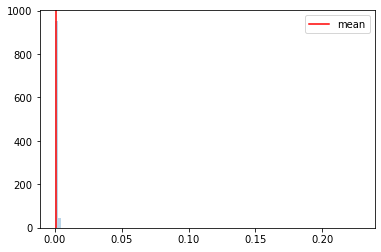

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654377327
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 0.1, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:06, 15.04it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:35, 10.41it/s]

Monte Carlo 5
Monte Carlo 6

  1%|▌                                                                                | 7/1000 [00:00<01:59,  8.28it/s]


Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:01<01:58,  8.40it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 11/1000 [00:01<01:52,  8.78it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<01:52,  8.76it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<01:48,  9.04it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:01<01:52,  8.74it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<01:51,  8.79it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▊                                                                              | 22/1000 [00:02<01:47,  9.13it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:55,  8.48it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<01:53,  8.60it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<01:52,  8.66it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<01:54,  8.47it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:18,  7.00it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<02:14,  7.18it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<02:06,  7.61it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:01,  7.95it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<02:00,  7.96it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<02:04,  7.68it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<01:59,  8.01it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:33,  6.23it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:20,  6.78it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:06<02:09,  7.36it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:02,  7.74it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:09,  7.31it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:02,  7.70it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<02:02,  7.67it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:01,  7.74it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:04,  7.57it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:02,  7.62it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:02,  7.66it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:01,  7.67it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:07,  7.32it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:09<02:09,  7.15it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:07,  7.24it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:11,  7.01it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:05,  7.36it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:06,  7.30it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:04,  7.36it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:09,  7.06it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:04,  7.34it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:08,  7.10it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:06,  7.19it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:08,  7.05it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:10,  6.97it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:12,  6.81it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:08,  7.01it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:10,  6.89it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:04,  7.20it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████                                                                       | 102/1000 [00:13<02:07,  7.05it/s]

Monte Carlo 102


 10%|████████▏                                                                      | 103/1000 [00:13<02:25,  6.15it/s]

Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:41,  5.55it/s]

Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:14<02:35,  5.74it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:14<02:19,  6.39it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:14<02:16,  6.54it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:15<02:11,  6.76it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:15<02:15,  6.56it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:15<02:11,  6.71it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:15<02:14,  6.57it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:16<02:11,  6.69it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:16<02:07,  6.89it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:16<02:13,  6.56it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:17<02:13,  6.55it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:17<02:07,  6.82it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:17<02:06,  6.88it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:18<02:06,  6.88it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:18<02:08,  6.74it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:18<02:05,  6.87it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:18<02:14,  6.42it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:19<02:15,  6.32it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:19<02:15,  6.34it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:19<02:14,  6.38it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:20<02:12,  6.43it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:20<02:13,  6.39it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:20<02:11,  6.45it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:21<02:08,  6.62it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:21<02:12,  6.39it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:21<02:18,  6.09it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:22<02:35,  5.41it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:22<02:35,  5.39it/s]

Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:36,  5.37it/s]

Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:32,  5.48it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:23<02:21,  5.92it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:23<02:19,  5.99it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:13,  6.21it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:24<02:13,  6.20it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:24<02:37,  5.25it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:25,  5.68it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:25<02:21,  5.84it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:19,  5.87it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:26<02:19,  5.87it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:26<02:15,  6.02it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:18,  5.89it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:27<02:14,  6.05it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:27<02:18,  5.86it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:18,  5.85it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:28<02:15,  5.96it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:28<02:16,  5.88it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:14,  6.00it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:29<02:26,  5.47it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:29<02:26,  5.45it/s]

Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:29<02:21,  5.67it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:24,  5.54it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:30<02:30,  5.30it/s]

Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:30<02:25,  5.48it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:30<02:23,  5.54it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:21,  5.59it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:31<02:20,  5.62it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 211/1000 [00:31<02:23,  5.50it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:23,  5.49it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:32<02:24,  5.44it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:32<02:25,  5.36it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:22,  5.47it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:19,  5.60it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:33<02:23,  5.44it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 222/1000 [00:33<02:24,  5.40it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:23,  5.42it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:34<02:27,  5.24it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:34<02:26,  5.29it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:34<02:25,  5.29it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:34<02:23,  5.39it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:35<02:22,  5.40it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:35<02:24,  5.30it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:20,  5.46it/s]

Monte Carlo 232
Monte Carlo 233


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:20,  5.44it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:36<02:24,  5.29it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:36<02:30,  5.07it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:26,  5.21it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:37<02:21,  5.37it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:37<02:24,  5.25it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:23,  5.27it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:20,  5.36it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:38<02:22,  5.27it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:38<02:26,  5.14it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:25,  5.18it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:21,  5.32it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:39<02:22,  5.26it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:39<02:20,  5.32it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:39<02:21,  5.26it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:18,  5.38it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:40<02:13,  5.59it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:40<02:18,  5.37it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:12,  5.58it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:41<02:19,  5.29it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:15,  5.44it/s]

Monte Carlo 263
Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:41<02:18,  5.31it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:18,  5.30it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:42<02:18,  5.27it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:17,  5.31it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:19,  5.24it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:17,  5.32it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:16,  5.32it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:43<02:18,  5.25it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:20,  5.18it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:20,  5.17it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:27,  4.91it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:26,  4.92it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:44<02:22,  5.07it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:44<02:19,  5.16it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:44<02:21,  5.08it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:21,  5.06it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:17,  5.20it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:18,  5.17it/s]

Monte Carlo 283
Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:17,  5.21it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:23,  4.95it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:22,  5.01it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:24,  4.94it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:46<02:26,  4.83it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:46<02:26,  4.82it/s]

Monte Carlo 291
Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:27,  4.79it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:47<02:30,  4.69it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:25,  4.82it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:23,  4.89it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:48<02:22,  4.93it/s]

Monte Carlo 298
Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:25,  4.82it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:26,  4.77it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:28,  4.71it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:28,  4.70it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:49<02:27,  4.71it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:49<02:29,  4.65it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:49<02:30,  4.61it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:26,  4.72it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:29,  4.62it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:51<02:45,  4.15it/s]

Monte Carlo 310
Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:41,  4.26it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:29,  4.60it/s]

Monte Carlo 313
Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:28,  4.62it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:26,  4.66it/s]

Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:27,  4.62it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:26,  4.64it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:25,  4.67it/s]

Monte Carlo 320
Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:53<02:31,  4.47it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:30,  4.49it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:28,  4.56it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:33,  4.40it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:29,  4.50it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:30,  4.46it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:32,  4.40it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:55<02:29,  4.49it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:31,  4.43it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:55<02:31,  4.42it/s]

Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:28,  4.49it/s]

Monte Carlo 332
Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:27,  4.50it/s]

Monte Carlo 334
Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:29,  4.45it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:30,  4.40it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:57<02:30,  4.41it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:57<02:27,  4.47it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:24,  4.56it/s]

Monte Carlo 340


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:22,  4.63it/s]

Monte Carlo 341
Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:58<02:26,  4.49it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:22,  4.59it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:20,  4.66it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:20,  4.64it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:59<02:20,  4.65it/s]

Monte Carlo 347


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:21,  4.60it/s]

Monte Carlo 348
Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:22,  4.58it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:22,  4.56it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:00<02:24,  4.49it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:00<02:28,  4.36it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:31,  4.25it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:29,  4.32it/s]

Monte Carlo 355


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:22,  4.50it/s]

Monte Carlo 356
Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:24,  4.45it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:22,  4.50it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:24,  4.44it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:02<02:25,  4.38it/s]

Monte Carlo 361


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:22,  4.46it/s]

Monte Carlo 362
Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:20,  4.52it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:03<02:25,  4.36it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:25,  4.36it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:28,  4.27it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:24,  4.39it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:04<02:23,  4.41it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:20,  4.48it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:20,  4.46it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:21,  4.43it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:25,  4.32it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:25,  4.30it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:24,  4.32it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:24,  4.32it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:25,  4.28it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:06<02:26,  4.24it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:24,  4.28it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:26,  4.22it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:27,  4.21it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:07<02:28,  4.16it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:27,  4.17it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:26,  4.21it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:27,  4.16it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:08<02:31,  4.04it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:27,  4.17it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:24,  4.22it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:28,  4.13it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:09<02:30,  4.05it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:09<02:28,  4.10it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:27,  4.13it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:29,  4.06it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:10<02:34,  3.93it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:10<02:30,  4.02it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:27,  4.09it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:25,  4.13it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:24,  4.16it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:11<02:28,  4.05it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:11<02:31,  3.95it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:29,  4.02it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:25,  4.10it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:26,  4.07it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:26,  4.08it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:30,  3.95it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:28,  4.00it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:13<02:27,  4.01it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:29,  3.97it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:13<02:30,  3.94it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:14<02:27,  3.99it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:14<02:30,  3.92it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<02:32,  3.85it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:30,  3.91it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:15<02:29,  3.93it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:15<02:29,  3.90it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:24,  4.03it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:15<02:19,  4.18it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:15,  4.30it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:16<02:11,  4.42it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:16<02:17,  4.23it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:16<02:14,  4.30it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:13,  4.34it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:17<02:12,  4.34it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:12,  4.36it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:17<02:11,  4.39it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:08,  4.46it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:18<02:07,  4.50it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:07,  4.49it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:09,  4.40it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:12,  4.29it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:12,  4.28it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:16,  4.17it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:16,  4.16it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:17,  4.12it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:16,  4.13it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:17,  4.09it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:34,  3.65it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:27,  3.81it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:21<02:25,  3.86it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:19,  4.02it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:21<02:16,  4.08it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:21<02:16,  4.09it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:21<02:15,  4.11it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:22<02:17,  4.05it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:22<02:21,  3.92it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:22<02:25,  3.81it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:23<02:23,  3.85it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:23<02:27,  3.75it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:23<02:25,  3.78it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:23<02:24,  3.80it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:21,  3.89it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:24<02:20,  3.90it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:24<02:26,  3.73it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:24<02:21,  3.86it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:17,  3.96it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:25<02:16,  4.00it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:25<02:17,  3.95it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:25<02:16,  3.97it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:14,  4.02it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:26<02:12,  4.08it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:26<02:10,  4.12it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:26<02:14,  4.01it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:27<02:13,  4.03it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:27<02:17,  3.89it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:27<02:16,  3.91it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:27<02:15,  3.94it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:28<02:14,  3.96it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:28<02:16,  3.89it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:28<02:19,  3.81it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:28<02:20,  3.77it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:29<02:22,  3.72it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:29<02:25,  3.64it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:29<02:20,  3.76it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:24,  3.65it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:30<02:20,  3.73it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:30<02:19,  3.77it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:30<02:17,  3.81it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:31<02:12,  3.95it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:31<02:17,  3.78it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:31<02:15,  3.83it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:31<02:13,  3.89it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:32<02:14,  3.86it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:32<02:10,  3.97it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:32<02:09,  3.98it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:32<02:13,  3.86it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:33<02:10,  3.93it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:33<02:10,  3.92it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:33<02:10,  3.94it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:33<02:10,  3.93it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:34<02:10,  3.91it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:34<02:10,  3.91it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:34<02:11,  3.86it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:34<02:13,  3.79it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:35<02:14,  3.76it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:35<02:12,  3.82it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:35<02:11,  3.82it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:35<02:14,  3.75it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:36<02:15,  3.72it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:36<02:20,  3.58it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:36<02:21,  3.53it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:37<02:20,  3.54it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:37<02:18,  3.59it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:37<02:17,  3.61it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:37<02:21,  3.51it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:38<02:25,  3.40it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:38<02:23,  3.45it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:38<02:23,  3.45it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:39<02:21,  3.49it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:39<02:18,  3.54it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:39<02:20,  3.49it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:39<02:22,  3.43it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:40<02:20,  3.46it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:40<02:22,  3.41it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:40<02:22,  3.40it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:41<02:26,  3.30it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:41<02:26,  3.30it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:41<02:22,  3.39it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:42<02:22,  3.38it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:42<02:22,  3.39it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:42<02:20,  3.41it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:42<02:18,  3.47it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:43<02:19,  3.42it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:43<02:17,  3.48it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:43<02:16,  3.48it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:44<02:18,  3.44it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:44<02:14,  3.52it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:44<02:15,  3.48it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:44<02:14,  3.50it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:45<02:15,  3.49it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:45<02:15,  3.47it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:45<02:16,  3.43it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:46<02:16,  3.44it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:46<02:21,  3.30it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:46<02:20,  3.31it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:47<02:17,  3.38it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:47<02:16,  3.39it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:47<02:16,  3.39it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:47<02:16,  3.40it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:48<02:17,  3.36it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:48<02:16,  3.37it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:48<02:15,  3.40it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:49<02:14,  3.40it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:49<02:17,  3.32it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:49<02:17,  3.31it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:50<02:17,  3.31it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:50<02:19,  3.25it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:50<02:22,  3.17it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:50<02:20,  3.21it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:51<02:18,  3.26it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:51<02:19,  3.23it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:51<02:18,  3.23it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:52<02:17,  3.25it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:52<02:16,  3.28it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:52<02:16,  3.26it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:53<02:17,  3.24it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:53<02:14,  3.30it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:53<02:16,  3.25it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:54<02:17,  3.22it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:54<02:17,  3.21it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:54<02:18,  3.18it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:54<02:16,  3.22it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:55<02:14,  3.25it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:55<02:29,  2.92it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:56<02:24,  3.01it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:56<02:20,  3.09it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:56<02:19,  3.12it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:56<02:19,  3.11it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:57<02:21,  3.05it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:57<02:18,  3.11it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:57<02:15,  3.17it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:58<02:17,  3.11it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:58<02:14,  3.19it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:58<02:11,  3.25it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:59<02:14,  3.16it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:59<02:14,  3.15it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:59<02:15,  3.14it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:00<02:12,  3.19it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:00<02:13,  3.17it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:00<02:17,  3.06it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:01<02:18,  3.04it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:01<02:19,  3.01it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:01<02:15,  3.10it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:02<02:14,  3.09it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:02<02:14,  3.09it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:02<02:14,  3.07it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:03<02:13,  3.09it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:03<02:11,  3.13it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:03<02:10,  3.16it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:03<02:08,  3.20it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:04<02:10,  3.14it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:04<02:11,  3.11it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:04<02:13,  3.05it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:05<02:13,  3.04it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:05<02:12,  3.06it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:05<02:12,  3.05it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:06<02:13,  3.03it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:06<02:16,  2.96it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:07<02:17,  2.93it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:07<02:16,  2.94it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:07<02:16,  2.93it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:08<02:14,  2.97it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:08<02:10,  3.04it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:08<02:12,  3.00it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:08<02:11,  3.01it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:09<02:08,  3.07it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:09<02:08,  3.07it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:09<02:09,  3.03it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:10<02:09,  3.02it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:10<02:10,  3.00it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:10<02:08,  3.04it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:11<02:07,  3.04it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:11<02:05,  3.09it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:11<02:05,  3.09it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:12<02:09,  2.99it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:12<02:08,  3.00it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:12<02:07,  3.02it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:13<02:09,  2.97it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:13<02:10,  2.93it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:13<02:07,  3.00it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:14<02:07,  2.99it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:14<02:07,  2.98it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:14<02:05,  3.00it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:15<02:03,  3.06it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:15<02:05,  3.00it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:15<02:05,  2.99it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:16<02:06,  2.95it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:16<02:04,  2.99it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:16<02:04,  2.99it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:17<02:02,  3.02it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:17<02:04,  2.97it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:17<02:01,  3.04it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:18<01:59,  3.07it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:18<02:03,  2.97it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:18<02:04,  2.95it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:19<02:07,  2.87it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:19<02:06,  2.89it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:20<02:09,  2.81it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:20<02:07,  2.85it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:20<02:06,  2.85it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:21<02:06,  2.85it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:21<02:07,  2.80it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:21<02:06,  2.82it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:22<02:03,  2.88it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:22<02:03,  2.88it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:22<02:01,  2.92it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:23<01:58,  2.98it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:23<01:58,  2.98it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:23<01:58,  2.97it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:24<01:59,  2.94it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:24<01:58,  2.94it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:24<01:57,  2.97it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:25<01:56,  2.99it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:25<01:55,  3.01it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:25<01:53,  3.05it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:26<01:55,  2.98it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:26<01:53,  3.02it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:26<01:52,  3.04it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:27<01:54,  2.99it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:27<01:55,  2.96it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:27<01:53,  2.99it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:28<01:55,  2.94it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:28<01:54,  2.95it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:28<01:51,  3.03it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:29<02:02,  2.75it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:29<01:57,  2.85it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:29<01:55,  2.90it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:30<01:52,  2.96it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:30<01:50,  3.02it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:30<01:48,  3.04it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:31<01:48,  3.05it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:31<01:49,  3.00it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:31<01:55,  2.85it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:32<01:55,  2.83it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:32<01:56,  2.80it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:32<01:51,  2.91it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:33<01:50,  2.93it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:33<01:48,  2.97it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:34<01:49,  2.93it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:34<01:50,  2.90it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:34<01:52,  2.85it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:35<01:51,  2.87it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:35<01:51,  2.85it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:35<01:50,  2.87it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:36<01:49,  2.89it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:36<01:53,  2.77it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:36<01:51,  2.83it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:37<01:49,  2.85it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:37<01:48,  2.88it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:37<01:47,  2.89it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:38<01:46,  2.91it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:38<01:45,  2.92it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:38<01:47,  2.86it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:39<01:46,  2.87it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:39<01:45,  2.89it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:39<01:46,  2.86it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:40<01:48,  2.80it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:40<01:47,  2.81it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:41<01:45,  2.85it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:41<01:46,  2.82it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:41<01:46,  2.82it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:42<01:45,  2.84it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:42<01:44,  2.85it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:42<01:43,  2.86it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:43<01:44,  2.84it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:43<01:42,  2.87it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:43<01:45,  2.80it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:44<01:43,  2.82it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:44<01:43,  2.81it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:44<01:43,  2.82it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:45<01:44,  2.76it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:45<01:43,  2.80it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:46<01:43,  2.78it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:46<01:44,  2.76it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:46<01:41,  2.81it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:47<01:43,  2.76it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:47<01:41,  2.80it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:47<01:41,  2.79it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:48<01:41,  2.79it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:48<01:44,  2.70it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:48<01:41,  2.75it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:49<01:43,  2.68it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:49<01:41,  2.74it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:50<01:40,  2.75it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:50<01:40,  2.75it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:50<01:38,  2.78it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:51<01:40,  2.71it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:51<01:39,  2.76it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:51<01:37,  2.79it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:52<01:39,  2.73it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:52<01:41,  2.67it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:52<01:37,  2.75it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:53<01:36,  2.79it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:53<01:36,  2.75it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:53<01:35,  2.79it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:54<01:36,  2.74it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:54<01:37,  2.71it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:55<01:37,  2.70it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:55<01:36,  2.72it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:55<01:35,  2.72it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:56<01:34,  2.74it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:56<01:34,  2.73it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:56<01:37,  2.64it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:57<01:38,  2.60it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:57<01:42,  2.50it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:58<01:47,  2.37it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:58<01:40,  2.52it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:58<01:37,  2.58it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:59<01:35,  2.64it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:59<01:33,  2.68it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:00<01:34,  2.66it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:00<01:35,  2.62it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:00<01:33,  2.66it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:01<01:38,  2.52it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:01<01:37,  2.52it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:02<01:37,  2.52it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:02<01:35,  2.57it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:02<01:34,  2.57it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:03<01:31,  2.65it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:03<01:30,  2.67it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:03<01:28,  2.72it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:04<01:25,  2.78it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:04<01:25,  2.77it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:04<01:24,  2.79it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:05<01:26,  2.72it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:05<01:25,  2.75it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:06<01:23,  2.80it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:06<01:21,  2.86it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:06<01:20,  2.88it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:07<01:22,  2.81it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:07<01:21,  2.81it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:07<01:21,  2.81it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:08<01:23,  2.72it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:08<01:23,  2.73it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:08<01:22,  2.75it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:09<01:22,  2.71it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:09<01:20,  2.77it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:10<01:23,  2.67it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:10<01:20,  2.76it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:10<01:18,  2.80it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:11<01:20,  2.73it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:11<01:18,  2.79it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:11<01:18,  2.78it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:12<01:17,  2.82it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:12<01:17,  2.77it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:12<01:18,  2.73it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:13<01:17,  2.75it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:13<01:16,  2.79it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:14<01:16,  2.77it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:14<01:16,  2.76it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:14<01:15,  2.78it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:15<01:17,  2.70it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:15<01:17,  2.68it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:15<01:17,  2.66it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:16<01:16,  2.69it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:16<01:15,  2.72it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:16<01:15,  2.71it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:17<01:14,  2.74it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:17<01:14,  2.72it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:18<01:15,  2.67it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:18<01:16,  2.61it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:18<01:16,  2.59it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:19<01:15,  2.61it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:19<01:14,  2.64it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:20<01:15,  2.58it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:20<01:15,  2.59it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:20<01:15,  2.58it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:21<01:14,  2.60it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:21<01:14,  2.59it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:22<01:15,  2.54it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:22<01:15,  2.50it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:22<01:14,  2.53it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:23<01:14,  2.51it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:23<01:13,  2.54it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:23<01:12,  2.56it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:24<01:12,  2.55it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:24<01:12,  2.54it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:25<01:12,  2.52it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:25<01:13,  2.49it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:25<01:13,  2.48it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:26<01:11,  2.50it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:26<01:11,  2.50it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:27<01:12,  2.46it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:27<01:11,  2.49it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:27<01:10,  2.51it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:28<01:09,  2.51it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:28<01:09,  2.49it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:29<01:08,  2.51it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:29<01:09,  2.47it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:30<01:12,  2.35it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:30<01:14,  2.28it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:30<01:14,  2.28it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:31<01:12,  2.30it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:31<01:11,  2.35it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:32<01:09,  2.38it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:32<01:09,  2.37it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:33<01:09,  2.36it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:33<01:08,  2.38it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:33<01:07,  2.41it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:34<01:06,  2.41it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:34<01:06,  2.39it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:35<01:06,  2.39it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:35<01:05,  2.43it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:35<01:05,  2.41it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:36<01:03,  2.45it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:36<01:02,  2.47it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:37<01:01,  2.50it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:37<01:06,  2.28it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:38<01:05,  2.32it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:38<01:04,  2.34it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:38<01:05,  2.31it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:39<01:04,  2.29it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:39<01:03,  2.34it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:40<01:03,  2.33it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:40<01:01,  2.37it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:41<01:01,  2.37it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:41<01:01,  2.36it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:41<01:00,  2.35it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:42<00:59,  2.39it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:42<00:58,  2.42it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:43<00:58,  2.38it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:43<00:58,  2.38it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:43<00:57,  2.41it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:44<00:57,  2.39it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:44<00:56,  2.39it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:45<00:56,  2.41it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:45<00:55,  2.40it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:46<00:55,  2.40it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:46<00:55,  2.39it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:46<00:56,  2.31it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:47<00:56,  2.32it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:47<00:54,  2.38it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:48<00:53,  2.40it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:48<00:52,  2.42it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:49<00:51,  2.43it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:49<00:51,  2.42it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:49<00:50,  2.43it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:50<00:50,  2.44it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:50<00:50,  2.44it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:51<00:49,  2.42it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:51<00:50,  2.39it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:51<00:49,  2.41it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:52<00:49,  2.37it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:52<00:49,  2.36it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:53<00:48,  2.37it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:53<00:48,  2.37it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:54<00:48,  2.35it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:54<00:48,  2.33it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:54<00:47,  2.37it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:55<00:47,  2.34it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:55<00:47,  2.33it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:56<00:46,  2.36it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:56<00:45,  2.37it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:57<00:45,  2.37it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:57<00:44,  2.38it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:57<00:43,  2.39it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:58<00:43,  2.41it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:58<00:42,  2.45it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:59<00:41,  2.48it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:59<00:40,  2.49it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:59<00:39,  2.53it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:00<00:39,  2.49it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:00<00:39,  2.50it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:01<00:39,  2.47it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:01<00:39,  2.43it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:01<00:39,  2.41it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:02<00:38,  2.43it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:02<00:38,  2.44it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:03<00:37,  2.44it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:03<00:37,  2.40it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:03<00:37,  2.40it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:04<00:37,  2.36it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:04<00:38,  2.31it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:05<00:37,  2.31it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:05<00:38,  2.26it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:06<00:37,  2.26it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:06<00:36,  2.28it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:07<00:36,  2.28it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:07<00:35,  2.30it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:07<00:35,  2.31it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:08<00:34,  2.31it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:08<00:33,  2.33it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:09<00:34,  2.29it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:09<00:34,  2.26it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:10<00:32,  2.30it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:10<00:32,  2.31it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:10<00:31,  2.33it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:11<00:30,  2.37it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:11<00:30,  2.40it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:12<00:29,  2.40it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:12<00:29,  2.40it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:13<00:28,  2.40it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:13<00:28,  2.41it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:13<00:28,  2.39it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:14<00:27,  2.37it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:14<00:27,  2.39it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:15<00:26,  2.37it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:15<00:26,  2.34it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:15<00:26,  2.34it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:16<00:26,  2.34it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:16<00:28,  2.11it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:17<00:27,  2.15it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:17<00:26,  2.20it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:18<00:25,  2.25it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:18<00:24,  2.25it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:19<00:24,  2.21it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:19<00:24,  2.22it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:20<00:23,  2.25it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:20<00:23,  2.24it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:20<00:22,  2.27it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:21<00:22,  2.25it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:21<00:21,  2.24it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:22<00:21,  2.24it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:22<00:21,  2.23it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:23<00:20,  2.22it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:23<00:20,  2.21it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:24<00:20,  2.20it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:24<00:20,  2.14it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:25<00:19,  2.17it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:25<00:18,  2.23it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:25<00:17,  2.22it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:26<00:17,  2.20it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:26<00:17,  2.19it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:27<00:16,  2.23it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:27<00:16,  2.20it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:28<00:15,  2.20it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:28<00:15,  2.23it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:29<00:14,  2.23it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:29<00:14,  2.22it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:30<00:13,  2.24it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:30<00:13,  2.24it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:30<00:12,  2.23it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:31<00:12,  2.23it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:31<00:11,  2.26it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:32<00:11,  2.20it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:32<00:11,  2.20it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:33<00:11,  2.18it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:33<00:11,  2.06it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:34<00:10,  2.01it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:34<00:10,  2.01it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:35<00:09,  2.08it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:35<00:08,  2.12it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:36<00:08,  2.10it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:36<00:08,  2.12it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:37<00:07,  2.12it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:37<00:07,  2.13it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:37<00:06,  2.16it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:38<00:05,  2.17it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:38<00:05,  2.18it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:39<00:05,  2.18it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:39<00:04,  2.12it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:40<00:04,  2.14it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:40<00:03,  2.15it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:41<00:03,  2.15it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:41<00:02,  2.11it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:42<00:02,  2.15it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:42<00:01,  2.13it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:43<00:01,  2.12it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:43<00:00,  2.06it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:44<00:00,  2.12it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:44<00:00,  3.51it/s]


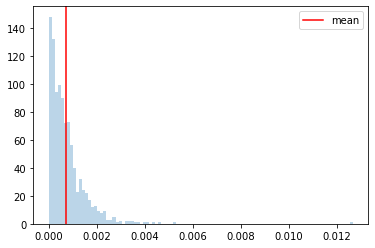

  0%|▏                                                                                | 2/1000 [00:00<00:56, 17.75it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654377612
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 0.1, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:53,  8.76it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:52,  8.87it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:49,  9.04it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:52,  8.83it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:51,  8.87it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:56,  8.44it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<02:01,  8.10it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<01:58,  8.28it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:54,  8.57it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:57,  8.30it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:58,  8.25it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<01:53,  8.58it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:15,  7.18it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:13,  7.26it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:00,  8.00it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<01:57,  8.21it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<01:58,  8.16it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:56,  8.24it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:59,  8.05it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<02:01,  7.89it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<02:02,  7.79it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<01:56,  8.19it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:58,  8.01it/s]

Monte Carlo 47
Monte Carlo 48


  5%|███▉                                                                            | 49/1000 [00:05<01:58,  7.99it/s]

Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:27,  6.45it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:46,  5.69it/s]

Monte Carlo 52
Monte Carlo 53

  5%|████▎                                                                           | 54/1000 [00:06<02:34,  6.13it/s]


Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:07<02:29,  6.32it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<02:26,  6.42it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<02:22,  6.60it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:08<02:14,  6.97it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:08<02:11,  7.12it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:08<02:05,  7.46it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:08<02:08,  7.27it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:09<02:06,  7.38it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:09<02:03,  7.50it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:09<02:06,  7.33it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<02:06,  7.33it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:10<02:04,  7.39it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:10<02:06,  7.28it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:10<02:05,  7.29it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:11<02:12,  6.93it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:11<02:06,  7.21it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:11<02:14,  6.80it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:11<02:12,  6.89it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:12<02:13,  6.80it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:12<02:16,  6.62it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:12<02:09,  6.98it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:13<02:07,  7.10it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:13<02:07,  7.07it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:13<02:06,  7.11it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:13<02:04,  7.19it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:14<02:07,  6.99it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:14<02:07,  6.98it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:14<02:14,  6.61it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:15<02:08,  6.92it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:15<02:16,  6.51it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:15<02:19,  6.33it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:16<02:22,  6.20it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:16<02:15,  6.50it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:16<02:11,  6.70it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:16<02:09,  6.74it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:17<02:08,  6.82it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:17<02:10,  6.70it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:17<02:13,  6.53it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:18<02:08,  6.77it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:18<02:18,  6.24it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:18<02:16,  6.31it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:19<02:17,  6.26it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:19<02:12,  6.51it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:19<02:13,  6.41it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:20<02:17,  6.23it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:20<02:11,  6.48it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:20<02:16,  6.25it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:21<02:14,  6.32it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:21<02:19,  6.09it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:21<02:13,  6.36it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:22<02:17,  6.14it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:22<02:14,  6.28it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:22<02:15,  6.22it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:23<02:20,  5.98it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:23<02:13,  6.27it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:23<02:14,  6.18it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:18,  6.00it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:24<02:14,  6.19it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:24<02:14,  6.15it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:10,  6.31it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:25<02:34,  5.33it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:28,  5.54it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:26<02:26,  5.58it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:26<02:21,  5.77it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:23,  5.68it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:27<02:19,  5.85it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 187/1000 [00:27<02:18,  5.88it/s]

Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:27<02:24,  5.62it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:28<02:21,  5.74it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 192/1000 [00:28<02:40,  5.02it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:28<02:35,  5.17it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:29<02:34,  5.22it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:29<02:29,  5.39it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:29<02:29,  5.35it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:26,  5.47it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:30<02:22,  5.59it/s]

Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:30<02:22,  5.57it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:22,  5.56it/s]

Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:31<02:23,  5.52it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:31<02:27,  5.36it/s]

Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:31<02:29,  5.27it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:31<02:26,  5.39it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:32<02:21,  5.57it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:32<02:29,  5.25it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:32<02:24,  5.42it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:33<02:22,  5.49it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:33<02:27,  5.30it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:33<02:25,  5.36it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:33<02:20,  5.53it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:34<02:11,  5.89it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:34<02:08,  6.04it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:34<02:13,  5.80it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:35<02:13,  5.79it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:35<02:11,  5.85it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:10,  5.87it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:36<02:17,  5.55it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:36<02:12,  5.76it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:13,  5.70it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:37<02:18,  5.47it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:37<02:22,  5.32it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:22,  5.30it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:16,  5.53it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:38<02:12,  5.67it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:08,  5.83it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:06,  5.91it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:39<02:08,  5.83it/s]

Monte Carlo 252
Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:18,  5.39it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:17,  5.42it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:40<02:13,  5.55it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▍                                                          | 259/1000 [00:40<02:13,  5.56it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:15,  5.47it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:41<02:15,  5.44it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:12,  5.54it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:41<02:10,  5.61it/s]

Monte Carlo 265
Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:41<02:14,  5.44it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:12,  5.50it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:12,  5.51it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:12,  5.50it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:17,  5.27it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:20,  5.17it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:23,  5.03it/s]

Monte Carlo 276
Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:44<02:24,  4.97it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:44<02:20,  5.12it/s]

Monte Carlo 279
Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:20,  5.11it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:15,  5.30it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:15,  5.28it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:19,  5.11it/s]

Monte Carlo 286
Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:35,  4.59it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:33,  4.63it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:46<02:39,  4.44it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:46<02:39,  4.43it/s]

Monte Carlo 291
Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:47,  4.21it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:47<02:51,  4.11it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:43,  4.32it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:43,  4.30it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:40,  4.38it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:48<02:44,  4.25it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:49<02:41,  4.32it/s]

Monte Carlo 300
Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:40,  4.35it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:38,  4.39it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:49<02:44,  4.23it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:49<02:43,  4.24it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:50<02:44,  4.23it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:38,  4.37it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:41,  4.28it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:41,  4.27it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:51<02:46,  4.14it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:51<02:42,  4.24it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:46,  4.14it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:51<02:43,  4.20it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:52<02:42,  4.21it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:52<02:42,  4.21it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:43,  4.18it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:38,  4.32it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:53<03:10,  3.58it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:53<03:04,  3.68it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<03:03,  3.70it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<03:07,  3.62it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:54<02:57,  3.83it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:54<02:50,  3.98it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:54<02:46,  4.06it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:45,  4.08it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:55<02:47,  4.03it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:55<03:00,  3.73it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:55<03:05,  3.61it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:56<03:05,  3.61it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:56<03:09,  3.54it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:56<03:09,  3.53it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:56<03:07,  3.57it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:57<02:58,  3.74it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:57<02:55,  3.79it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:57<02:55,  3.79it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:57<02:46,  3.98it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:58<02:51,  3.86it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:58<02:48,  3.94it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:58<02:47,  3.95it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:58<02:40,  4.11it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:59<02:40,  4.12it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:59<02:48,  3.92it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:59<02:56,  3.72it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:59<02:56,  3.73it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:00<02:49,  3.85it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:00<02:46,  3.92it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:00<02:48,  3.89it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:00<02:46,  3.92it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:01<02:39,  4.07it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:01<02:36,  4.17it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:01<02:41,  4.01it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:01<02:42,  3.98it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:02<02:47,  3.87it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:02<02:46,  3.88it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:02<02:44,  3.93it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:02<02:41,  3.99it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:03<02:44,  3.90it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:03<02:44,  3.90it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:03<02:44,  3.91it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:03<02:41,  3.96it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:04<02:40,  3.98it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:04<02:45,  3.85it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:04<02:45,  3.84it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:05<02:51,  3.70it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:05<02:51,  3.70it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:05<02:51,  3.70it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:05<02:56,  3.59it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:06<02:51,  3.68it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:06<02:46,  3.79it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:06<02:56,  3.57it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:07<02:56,  3.56it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:07<02:54,  3.60it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:07<02:52,  3.64it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:07<02:44,  3.81it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:08<02:42,  3.84it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:08<02:39,  3.92it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:08<02:41,  3.86it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:08<02:44,  3.77it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:09<02:45,  3.76it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:09<02:49,  3.67it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:09<02:47,  3.70it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:09<02:44,  3.76it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:10<02:45,  3.73it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:10<02:43,  3.77it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:10<02:43,  3.77it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:10<02:45,  3.70it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:11<02:46,  3.68it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:11<02:45,  3.69it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:11<02:42,  3.75it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:12<02:43,  3.72it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:12<02:45,  3.68it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:12<02:41,  3.77it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:12<02:42,  3.74it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:13<02:40,  3.78it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:13<02:44,  3.67it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:13<02:43,  3.69it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:13<02:43,  3.70it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:14<02:41,  3.72it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:14<02:47,  3.59it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:14<02:55,  3.42it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:15<02:48,  3.55it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:15<02:55,  3.41it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:15<02:53,  3.44it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:15<02:49,  3.51it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:16<02:50,  3.49it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:16<02:46,  3.56it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:16<02:47,  3.53it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:17<02:44,  3.60it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:17<02:45,  3.58it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:17<02:44,  3.58it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:17<02:51,  3.44it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:18<02:44,  3.57it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:18<02:37,  3.73it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:18<02:35,  3.76it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:18<02:33,  3.81it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:19<02:37,  3.72it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:19<02:37,  3.71it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:19<02:53,  3.36it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:20<02:51,  3.39it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:20<02:46,  3.49it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:20<02:47,  3.46it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:21<02:45,  3.50it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:21<02:41,  3.57it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:21<02:44,  3.51it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:21<02:38,  3.62it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:22<02:35,  3.69it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:22<02:34,  3.72it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:22<02:34,  3.71it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:22<02:34,  3.69it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:23<02:41,  3.54it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:23<02:37,  3.60it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:23<02:36,  3.62it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:24<02:41,  3.51it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:24<02:41,  3.51it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:24<02:39,  3.55it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:24<02:35,  3.63it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:25<02:39,  3.54it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:25<02:39,  3.52it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:25<02:37,  3.55it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:26<02:41,  3.48it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:26<02:42,  3.45it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:26<02:36,  3.55it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:26<02:39,  3.50it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:27<02:34,  3.60it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:27<02:33,  3.62it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:27<02:33,  3.62it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:28<02:37,  3.50it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:28<02:38,  3.48it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:28<02:39,  3.46it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:28<02:39,  3.45it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:29<02:42,  3.37it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:29<02:43,  3.35it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:29<02:42,  3.37it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:30<02:40,  3.39it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:30<02:44,  3.32it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:30<03:04,  2.95it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:31<02:57,  3.06it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:31<02:53,  3.12it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:31<02:49,  3.20it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:32<02:44,  3.28it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:32<02:40,  3.36it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:32<02:38,  3.40it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:32<02:42,  3.31it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:33<02:42,  3.31it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:33<02:39,  3.35it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:33<02:43,  3.26it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:34<02:39,  3.34it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:34<02:38,  3.35it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:34<02:36,  3.40it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:34<02:35,  3.41it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:35<02:34,  3.43it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:35<02:32,  3.45it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:35<02:29,  3.52it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:36<02:28,  3.54it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:36<02:29,  3.50it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:36<02:27,  3.55it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:37<02:36,  3.34it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:37<02:37,  3.31it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:37<02:34,  3.38it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:37<02:33,  3.39it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:38<02:34,  3.35it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:38<02:36,  3.31it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:38<02:37,  3.29it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:39<02:34,  3.35it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:39<02:36,  3.29it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:39<02:33,  3.36it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:40<02:44,  3.12it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:40<02:48,  3.03it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:40<02:40,  3.19it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:40<02:32,  3.35it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:41<02:27,  3.45it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:41<02:25,  3.49it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:41<02:23,  3.54it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:42<02:26,  3.44it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:42<02:24,  3.49it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:42<02:22,  3.55it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:42<02:24,  3.47it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:43<02:24,  3.48it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:43<02:24,  3.48it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:43<02:24,  3.47it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:44<02:22,  3.50it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:44<02:19,  3.58it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:44<02:23,  3.47it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:44<02:21,  3.50it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:45<02:24,  3.42it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:45<02:20,  3.51it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:45<02:19,  3.53it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:46<02:17,  3.59it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:46<02:20,  3.50it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:46<02:22,  3.43it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:46<02:24,  3.39it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:47<02:25,  3.36it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:47<02:21,  3.44it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:47<02:20,  3.47it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:48<02:16,  3.55it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:48<02:17,  3.53it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:48<02:14,  3.60it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:48<02:15,  3.55it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:49<02:15,  3.54it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:49<02:15,  3.53it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:49<02:18,  3.47it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:50<02:21,  3.39it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:50<02:23,  3.33it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:50<02:20,  3.39it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:51<02:25,  3.27it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:51<02:22,  3.33it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:51<02:17,  3.45it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:51<02:14,  3.50it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:52<02:13,  3.52it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:52<02:14,  3.49it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:52<02:13,  3.51it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:53<02:14,  3.47it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:53<02:17,  3.39it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:53<02:16,  3.41it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:53<02:13,  3.47it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:54<02:11,  3.52it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:54<02:14,  3.44it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:54<02:14,  3.43it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:55<02:12,  3.47it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:55<02:11,  3.50it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:55<02:16,  3.35it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:56<02:23,  3.18it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:56<02:22,  3.20it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:56<02:18,  3.30it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:56<02:17,  3.30it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:57<02:14,  3.38it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:57<02:16,  3.32it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:57<02:14,  3.35it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:58<02:11,  3.42it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:58<02:10,  3.45it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:58<02:10,  3.45it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:58<02:15,  3.31it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:59<02:21,  3.17it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:59<02:19,  3.20it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:59<02:17,  3.25it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [02:00<02:16,  3.24it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [02:00<02:14,  3.29it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [02:00<02:14,  3.28it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [02:01<02:15,  3.25it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [02:01<02:12,  3.31it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [02:01<02:12,  3.32it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [02:02<02:10,  3.35it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [02:02<02:15,  3.22it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [02:02<02:17,  3.17it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [02:03<02:16,  3.19it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [02:03<02:14,  3.24it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:03<02:12,  3.27it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:03<02:13,  3.24it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:04<02:17,  3.13it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:04<02:14,  3.19it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:04<02:16,  3.15it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:05<02:17,  3.12it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:05<02:16,  3.14it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:05<02:20,  3.03it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:06<02:16,  3.11it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:06<02:13,  3.18it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:06<02:14,  3.16it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:07<02:13,  3.17it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:07<02:10,  3.21it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:07<02:06,  3.32it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:08<02:15,  3.08it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:08<02:12,  3.15it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:08<02:11,  3.17it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:08<02:08,  3.23it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:09<02:05,  3.30it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:09<02:03,  3.36it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:09<02:00,  3.44it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:10<01:58,  3.47it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:10<01:59,  3.43it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:10<02:00,  3.40it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:11<02:01,  3.35it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:11<02:01,  3.37it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:11<02:01,  3.34it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:11<02:01,  3.33it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:12<02:01,  3.34it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:12<02:00,  3.37it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:12<01:59,  3.36it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:13<02:01,  3.30it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:13<02:01,  3.30it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:13<02:05,  3.18it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:14<02:07,  3.13it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:14<02:08,  3.10it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:14<02:10,  3.04it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:15<02:07,  3.11it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:15<02:07,  3.09it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:15<02:09,  3.04it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:16<02:10,  3.01it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:16<02:08,  3.05it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:16<02:07,  3.07it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:17<02:06,  3.09it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:17<02:05,  3.10it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:17<02:05,  3.09it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:18<02:03,  3.13it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:18<02:03,  3.12it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:18<02:02,  3.13it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:18<02:05,  3.07it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:19<02:05,  3.05it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:19<02:01,  3.13it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:19<01:58,  3.22it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:20<01:59,  3.18it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:20<01:59,  3.18it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:20<01:57,  3.23it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:21<02:01,  3.10it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:21<01:57,  3.19it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:21<01:56,  3.22it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:22<01:54,  3.27it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:22<01:52,  3.32it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:22<01:53,  3.29it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:23<01:55,  3.20it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:23<01:56,  3.17it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:23<01:59,  3.10it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:23<01:58,  3.11it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:24<01:54,  3.21it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:24<01:52,  3.27it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:24<01:55,  3.17it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:25<01:55,  3.15it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:25<01:55,  3.14it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:25<01:54,  3.15it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:26<01:55,  3.13it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:26<01:53,  3.17it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:26<01:57,  3.06it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:27<01:54,  3.12it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:27<01:52,  3.16it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:27<01:51,  3.20it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:28<01:48,  3.27it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:28<01:47,  3.31it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:28<01:50,  3.18it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:29<01:56,  3.03it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:29<01:50,  3.17it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:29<01:49,  3.19it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:29<01:49,  3.18it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:30<01:51,  3.11it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:30<01:49,  3.16it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:30<01:50,  3.14it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:31<01:50,  3.12it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:31<01:47,  3.20it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:31<01:47,  3.19it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:32<01:48,  3.16it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:32<01:49,  3.10it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:32<01:51,  3.05it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:33<01:50,  3.08it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:33<01:53,  2.98it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:33<01:49,  3.07it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:34<01:50,  3.05it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:34<01:48,  3.08it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:34<01:45,  3.16it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:35<01:47,  3.11it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:35<01:44,  3.17it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:35<01:45,  3.14it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:36<01:45,  3.12it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:36<01:46,  3.09it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:36<01:51,  2.95it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:37<01:49,  3.00it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:37<01:51,  2.91it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:37<01:50,  2.95it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:38<01:50,  2.92it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:38<01:50,  2.93it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:38<01:49,  2.95it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:39<01:50,  2.91it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:39<01:49,  2.92it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:39<01:51,  2.86it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:40<01:50,  2.87it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:40<01:52,  2.82it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:40<01:53,  2.79it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:41<01:53,  2.77it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:41<01:52,  2.80it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:42<01:50,  2.84it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:42<01:50,  2.82it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:42<01:48,  2.85it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:43<01:50,  2.81it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:43<01:51,  2.76it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:43<01:52,  2.75it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:44<01:53,  2.70it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:44<01:52,  2.72it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:44<01:52,  2.72it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:45<01:56,  2.61it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:45<01:54,  2.64it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:46<01:53,  2.65it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:46<01:53,  2.65it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:46<01:56,  2.58it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:47<01:56,  2.57it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:47<01:57,  2.54it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:48<01:56,  2.54it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:48<01:57,  2.53it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:48<01:55,  2.54it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:49<01:55,  2.54it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:49<01:59,  2.46it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:50<01:59,  2.45it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:50<02:03,  2.36it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:51<02:04,  2.34it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:51<02:05,  2.30it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:52<02:15,  2.13it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:52<02:08,  2.23it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:52<02:03,  2.31it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:53<02:02,  2.32it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:53<01:59,  2.38it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:54<01:59,  2.38it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:54<02:01,  2.32it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:54<02:01,  2.31it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:55<01:56,  2.40it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:55<01:51,  2.51it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:56<01:51,  2.49it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:56<01:47,  2.57it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:56<01:44,  2.65it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:57<01:44,  2.64it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:57<01:41,  2.71it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:57<01:39,  2.73it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:58<01:38,  2.75it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:58<01:40,  2.70it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:58<01:37,  2.76it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:59<01:36,  2.78it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:59<01:37,  2.76it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [03:00<01:37,  2.73it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [03:00<01:36,  2.75it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [03:00<01:37,  2.73it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [03:01<01:36,  2.74it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [03:01<01:35,  2.77it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [03:01<01:35,  2.75it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:02<01:35,  2.74it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:02<01:37,  2.66it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:03<01:35,  2.70it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:03<01:35,  2.69it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:03<01:35,  2.68it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:04<01:35,  2.69it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:04<01:32,  2.75it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:04<01:31,  2.77it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:05<01:32,  2.74it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:05<01:33,  2.68it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:06<01:34,  2.66it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:06<01:33,  2.67it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:06<01:32,  2.69it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:07<01:31,  2.71it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:07<01:30,  2.72it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:07<01:27,  2.81it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:08<01:26,  2.85it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:08<01:24,  2.89it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:08<01:24,  2.89it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:09<01:23,  2.89it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:09<01:23,  2.90it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:09<01:24,  2.83it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:10<01:27,  2.73it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:10<01:25,  2.80it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:11<01:27,  2.72it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:11<01:28,  2.66it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:11<01:26,  2.73it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:12<01:25,  2.73it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:12<01:24,  2.77it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:12<01:23,  2.77it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:13<01:23,  2.76it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:13<01:22,  2.78it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:13<01:23,  2.75it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:14<01:20,  2.82it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:14<01:17,  2.91it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:14<01:20,  2.80it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:15<01:18,  2.88it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:15<01:17,  2.87it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:15<01:16,  2.91it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:16<01:18,  2.83it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:16<01:18,  2.83it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:17<01:18,  2.81it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:17<01:17,  2.84it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:17<01:18,  2.76it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:18<01:18,  2.75it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:18<01:18,  2.77it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:18<01:17,  2.77it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:19<01:16,  2.81it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:19<01:14,  2.85it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:19<01:15,  2.79it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:20<01:15,  2.79it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:20<01:15,  2.77it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:21<01:15,  2.75it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:21<01:16,  2.71it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:21<01:15,  2.73it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:22<01:15,  2.74it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:22<01:15,  2.72it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:22<01:15,  2.71it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:23<01:15,  2.70it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:23<01:15,  2.68it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:23<01:14,  2.71it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:24<01:16,  2.63it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:24<01:16,  2.61it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:25<01:16,  2.58it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:25<01:15,  2.61it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:25<01:14,  2.62it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:26<01:13,  2.64it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:26<01:14,  2.59it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:27<01:13,  2.61it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:27<01:14,  2.56it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:27<01:13,  2.60it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:28<01:13,  2.57it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:28<01:12,  2.59it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:29<01:13,  2.55it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:29<01:14,  2.52it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:29<01:13,  2.54it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:30<01:11,  2.58it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:30<01:10,  2.62it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:30<01:11,  2.57it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:31<01:13,  2.47it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:31<01:13,  2.45it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:32<01:12,  2.47it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:32<01:12,  2.47it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:33<01:10,  2.51it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:33<01:09,  2.54it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:33<01:14,  2.35it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:34<01:11,  2.43it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:34<01:11,  2.43it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:35<01:10,  2.45it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:35<01:09,  2.46it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:35<01:09,  2.46it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:36<01:09,  2.45it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:36<01:10,  2.38it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:37<01:09,  2.41it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:37<01:07,  2.47it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:37<01:06,  2.51it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:38<01:05,  2.53it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:38<01:07,  2.44it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:39<01:05,  2.48it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:39<01:04,  2.50it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:39<01:04,  2.51it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:40<01:05,  2.46it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:40<01:05,  2.43it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:41<01:05,  2.40it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:41<01:04,  2.44it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:42<01:03,  2.45it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:42<01:02,  2.48it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:42<01:01,  2.49it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:43<01:02,  2.44it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:43<01:01,  2.48it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:44<01:00,  2.49it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:44<01:00,  2.48it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:44<01:00,  2.48it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:45<00:59,  2.49it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:45<00:59,  2.47it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:46<00:57,  2.52it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:46<00:57,  2.54it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:46<00:55,  2.61it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:47<00:55,  2.57it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:47<00:55,  2.57it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:47<00:55,  2.52it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:48<00:56,  2.49it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:48<00:54,  2.54it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:49<00:55,  2.50it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:49<00:54,  2.50it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:49<00:54,  2.49it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:50<00:53,  2.52it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:50<00:54,  2.44it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:51<00:54,  2.45it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:51<00:54,  2.42it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:52<00:55,  2.36it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:52<00:55,  2.35it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:52<00:53,  2.40it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:53<00:53,  2.41it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:53<00:52,  2.42it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:54<00:51,  2.42it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:54<00:52,  2.39it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:54<00:51,  2.40it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:55<00:51,  2.41it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:55<00:53,  2.27it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:56<00:52,  2.31it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:56<00:52,  2.27it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:57<00:51,  2.31it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:57<00:49,  2.36it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:57<00:48,  2.40it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:58<00:48,  2.41it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:58<00:48,  2.37it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:59<00:48,  2.37it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:59<00:47,  2.36it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [04:00<00:46,  2.40it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [04:00<00:45,  2.43it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [04:00<00:46,  2.38it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:01<00:45,  2.42it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:01<00:45,  2.39it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:02<00:45,  2.36it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:02<00:44,  2.39it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:03<00:44,  2.37it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:03<00:44,  2.35it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:03<00:43,  2.35it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:04<00:43,  2.36it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:04<00:42,  2.37it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:05<00:42,  2.35it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:05<00:42,  2.33it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:06<00:42,  2.31it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:06<00:41,  2.33it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:06<00:41,  2.32it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:07<00:42,  2.26it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:07<00:41,  2.28it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:08<00:40,  2.30it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:08<00:42,  2.19it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:09<00:40,  2.25it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:09<00:39,  2.30it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:09<00:38,  2.30it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:10<00:37,  2.32it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:10<00:37,  2.31it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:11<00:37,  2.28it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:11<00:36,  2.31it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:12<00:36,  2.33it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:12<00:35,  2.37it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:12<00:34,  2.37it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:13<00:34,  2.34it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:13<00:34,  2.34it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:14<00:33,  2.33it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:14<00:33,  2.29it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:15<00:33,  2.28it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:15<00:33,  2.29it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:16<00:32,  2.30it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:16<00:31,  2.33it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:16<00:31,  2.33it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:17<00:31,  2.30it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:17<00:30,  2.31it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:18<00:30,  2.28it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:18<00:30,  2.24it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:19<00:29,  2.29it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:19<00:29,  2.28it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:19<00:29,  2.27it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:20<00:28,  2.26it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:20<00:28,  2.26it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:21<00:27,  2.29it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:21<00:27,  2.28it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:22<00:27,  2.23it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:22<00:26,  2.24it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:23<00:25,  2.27it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:23<00:25,  2.26it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:23<00:25,  2.26it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:24<00:24,  2.29it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:24<00:24,  2.29it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:25<00:23,  2.31it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:25<00:23,  2.26it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:26<00:22,  2.29it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:26<00:21,  2.34it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:26<00:20,  2.38it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:27<00:20,  2.40it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:27<00:19,  2.42it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:28<00:19,  2.40it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:28<00:18,  2.42it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:29<00:19,  2.36it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:29<00:19,  2.28it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:29<00:18,  2.29it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:30<00:18,  2.31it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:30<00:17,  2.31it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:31<00:17,  2.34it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:31<00:16,  2.34it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:32<00:15,  2.38it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:32<00:15,  2.40it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:32<00:15,  2.38it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:33<00:14,  2.37it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:33<00:14,  2.41it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:34<00:14,  2.34it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:34<00:13,  2.39it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:34<00:13,  2.38it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:35<00:12,  2.32it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:35<00:12,  2.30it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:36<00:12,  2.33it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:36<00:11,  2.29it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:37<00:11,  2.34it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:37<00:10,  2.34it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:37<00:10,  2.33it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:38<00:09,  2.34it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:38<00:09,  2.37it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:39<00:08,  2.38it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:39<00:08,  2.33it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:40<00:08,  2.26it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:40<00:08,  2.25it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:41<00:07,  2.22it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:41<00:07,  2.24it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:41<00:06,  2.23it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:42<00:06,  2.21it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:42<00:06,  2.07it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:43<00:05,  2.08it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:43<00:05,  2.06it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:44<00:04,  2.09it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:44<00:04,  2.13it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:45<00:03,  2.16it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:45<00:03,  2.16it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:46<00:02,  2.19it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:46<00:02,  2.17it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:47<00:01,  2.16it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:47<00:01,  2.13it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:48<00:00,  2.15it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:48<00:00,  2.15it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:49<00:00,  3.46it/s]


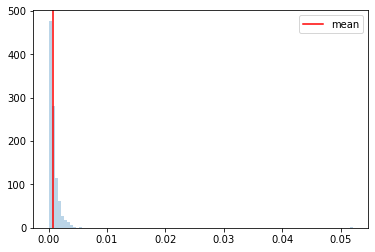

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654377902
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 0.1, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▍                                                                                | 5/1000 [00:00<01:16, 12.97it/s]

Monte Carlo 3
Monte Carlo 4
Monte Carlo 5
Monte Carlo 6


  1%|▌                                                                                | 7/1000 [00:00<01:39, 10.03it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:56,  8.50it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:57,  8.44it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<02:02,  8.07it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:57,  8.37it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:50,  8.88it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:54,  8.56it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:50,  8.85it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:52,  8.70it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:56,  8.37it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:56,  8.31it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:06,  7.66it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:14,  7.20it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:10,  7.40it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:01,  7.92it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<02:03,  7.81it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:59,  8.06it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<01:58,  8.11it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<02:04,  7.67it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<02:02,  7.80it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<02:03,  7.73it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:06<02:03,  7.67it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<02:00,  7.87it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<02:05,  7.52it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<02:00,  7.82it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<02:05,  7.50it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<02:00,  7.80it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<02:01,  7.72it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:07<02:06,  7.41it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:08<02:06,  7.40it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:08<02:06,  7.35it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:08<02:09,  7.18it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:09<02:06,  7.31it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:09<02:05,  7.39it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<02:03,  7.48it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:09<02:11,  7.01it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:10<02:14,  6.82it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:10<02:13,  6.89it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:10<02:10,  7.02it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:11<02:09,  7.06it/s]

Monte Carlo 85
Monte Carlo 86


  9%|██████▉                                                                         | 87/1000 [00:11<02:16,  6.68it/s]

Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:36,  5.81it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:28,  6.12it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:17,  6.61it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:08,  7.02it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:05,  7.18it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:13<02:08,  7.00it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:10,  6.89it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:18,  6.49it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:16,  6.54it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:10,  6.83it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:04,  7.15it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:03,  7.18it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<02:09,  6.85it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:03,  7.17it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:05,  7.03it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:11,  6.68it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:09,  6.81it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:15,  6.46it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:11,  6.66it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:13,  6.56it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:11,  6.63it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:21,  6.12it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:18<02:11,  6.59it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:17,  6.30it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:20,  6.15it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:19<02:13,  6.43it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:24,  5.94it/s]

Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:19<02:19,  6.14it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:19<02:13,  6.42it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:20<02:15,  6.29it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:20<02:17,  6.20it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:20<02:17,  6.18it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:21<02:15,  6.27it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:21<02:16,  6.18it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:21<02:16,  6.20it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:22<02:18,  6.10it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:22<02:19,  6.03it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:24,  5.81it/s]

Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:23<02:19,  6.02it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:23<02:16,  6.12it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:22,  5.87it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:24<02:19,  5.94it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:22,  5.81it/s]

Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:24<02:21,  5.85it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:21,  5.85it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:25<02:18,  5.94it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:14,  6.10it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:12,  6.17it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:26<02:12,  6.16it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:19,  5.87it/s]

Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:18,  5.89it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:27<02:22,  5.72it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:27<02:16,  5.94it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:18,  5.85it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:28<02:42,  4.97it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:28<02:38,  5.09it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:41,  4.99it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:29<02:33,  5.24it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:29<02:34,  5.17it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:35,  5.14it/s]

Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:29,  5.35it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:30<02:25,  5.45it/s]

Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:30<02:23,  5.55it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:30<02:20,  5.63it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:31<02:27,  5.35it/s]

Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:31<02:26,  5.39it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:31<02:27,  5.36it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▊                                                              | 213/1000 [00:31<02:21,  5.57it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:32<02:37,  4.97it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:32<02:26,  5.33it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:33<02:24,  5.41it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:33<02:19,  5.58it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:33<02:23,  5.42it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:34<02:20,  5.50it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▊                                                             | 226/1000 [00:34<02:19,  5.55it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:34<02:27,  5.23it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:34<02:23,  5.36it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:35<02:19,  5.51it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:35<02:20,  5.47it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:25,  5.28it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:21,  5.41it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:36<02:21,  5.40it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:36<02:24,  5.28it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:26,  5.20it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:37<02:24,  5.25it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:37<02:20,  5.40it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████                                                            | 242/1000 [00:37<02:20,  5.41it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:21,  5.34it/s]

Monte Carlo 243
Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:38<02:19,  5.40it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 247/1000 [00:38<02:30,  4.99it/s]

Monte Carlo 247


 25%|███████████████████▌                                                           | 248/1000 [00:38<02:45,  4.53it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:39<02:38,  4.73it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:39<02:31,  4.94it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:39<02:22,  5.26it/s]

Monte Carlo 252
Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:40<02:20,  5.29it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:40<02:27,  5.03it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:40<02:28,  5.00it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:40<02:26,  5.07it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:41<02:27,  5.02it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:41<02:30,  4.92it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:41<02:28,  4.98it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:42<02:30,  4.88it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:42<02:28,  4.95it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:42<02:27,  4.96it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:42<02:29,  4.89it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:30,  4.86it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:43<02:28,  4.91it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:43<02:25,  5.00it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:43<02:27,  4.94it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:26,  4.95it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:44<02:25,  4.99it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:44<02:24,  5.01it/s]

Monte Carlo 275
Monte Carlo 276


 28%|█████████████████████▉                                                         | 277/1000 [00:44<02:28,  4.87it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:44<02:25,  4.95it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:45<02:26,  4.93it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:45<02:23,  5.00it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:45<02:25,  4.94it/s]

Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:29,  4.80it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:46<02:27,  4.84it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:46<02:29,  4.77it/s]

Monte Carlo 286
Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:30,  4.72it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:47<02:30,  4.72it/s]

Monte Carlo 289
Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:47<02:31,  4.68it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:47<02:33,  4.61it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:35,  4.55it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:48<02:38,  4.46it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:48<02:33,  4.59it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:35,  4.52it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:49<02:29,  4.68it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:49<02:29,  4.70it/s]

Monte Carlo 299
Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:49<02:30,  4.65it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:39,  4.39it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:50<02:37,  4.43it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:50<02:29,  4.63it/s]

Monte Carlo 304
Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:50<02:32,  4.55it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:32,  4.53it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:51<02:29,  4.61it/s]

Monte Carlo 308
Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:51<02:26,  4.70it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:51<02:25,  4.74it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:52<02:22,  4.83it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:52<02:23,  4.78it/s]

Monte Carlo 313
Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:52<02:23,  4.79it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:25,  4.71it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:53<02:28,  4.61it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:53<02:28,  4.59it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<02:36,  4.35it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:31,  4.48it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:54<02:29,  4.55it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:54<02:26,  4.62it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:54<02:29,  4.51it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:29,  4.52it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:55<02:25,  4.62it/s]

Monte Carlo 326
Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:55<02:25,  4.63it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:26,  4.58it/s]

Monte Carlo 329
Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:56<02:26,  4.56it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:56<02:25,  4.58it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:56<02:25,  4.57it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:57<02:22,  4.66it/s]

Monte Carlo 334
Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:57<02:31,  4.39it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:57<02:28,  4.47it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:57<02:31,  4.36it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:57<02:27,  4.47it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:58<02:27,  4.48it/s]

Monte Carlo 340


 34%|███████████████████████████                                                    | 342/1000 [00:58<02:25,  4.52it/s]

Monte Carlo 341
Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:58<02:29,  4.38it/s]

Monte Carlo 343


 34%|███████████████████████████▎                                                   | 345/1000 [00:59<02:25,  4.50it/s]

Monte Carlo 344
Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:59<02:25,  4.50it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:59<02:25,  4.47it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:30,  4.32it/s]

Monte Carlo 348


 35%|███████████████████████████▋                                                   | 350/1000 [01:00<02:19,  4.65it/s]

Monte Carlo 349
Monte Carlo 350


 35%|███████████████████████████▊                                                   | 352/1000 [01:00<02:15,  4.80it/s]

Monte Carlo 351


 35%|███████████████████████████▉                                                   | 353/1000 [01:01<02:14,  4.80it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 354/1000 [01:01<02:11,  4.93it/s]

Monte Carlo 353


 36%|████████████████████████████                                                   | 355/1000 [01:01<02:10,  4.96it/s]

Monte Carlo 354
Monte Carlo 355


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:16,  4.71it/s]

Monte Carlo 356


 36%|████████████████████████████▎                                                  | 358/1000 [01:02<02:14,  4.76it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 359/1000 [01:02<02:14,  4.76it/s]

Monte Carlo 358


 36%|████████████████████████████▍                                                  | 360/1000 [01:02<02:12,  4.83it/s]

Monte Carlo 359


 36%|████████████████████████████▌                                                  | 361/1000 [01:02<02:11,  4.86it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:12,  4.81it/s]

Monte Carlo 361


 36%|████████████████████████████▋                                                  | 363/1000 [01:03<02:10,  4.87it/s]

Monte Carlo 362
Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:03<02:10,  4.86it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:03<02:15,  4.69it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:21,  4.49it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:22,  4.43it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:04<02:24,  4.37it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:04<02:23,  4.41it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:20,  4.49it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:18,  4.53it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:05<02:18,  4.53it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:05<02:17,  4.55it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:16,  4.59it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:16,  4.57it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:06<02:23,  4.34it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:06<02:31,  4.10it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:06<02:30,  4.14it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:26,  4.25it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:24,  4.30it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:07<02:23,  4.31it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:07<02:21,  4.35it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:23,  4.30it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:24,  4.26it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:08<02:25,  4.23it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:08<02:30,  4.07it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:33,  3.98it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:31,  4.03it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:09<02:30,  4.05it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:09<02:33,  3.96it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:09<02:32,  4.00it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:28,  4.08it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:10<02:29,  4.07it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:10<02:26,  4.13it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:10<02:24,  4.19it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:29,  4.04it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:11<02:33,  3.93it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:11<02:28,  4.07it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:11<02:50,  3.52it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:11<02:39,  3.76it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:12<02:32,  3.93it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:12<02:27,  4.04it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:28,  4.01it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:30,  3.96it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:13<02:31,  3.92it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:13<02:27,  4.02it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:13<02:24,  4.10it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:22,  4.15it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:14<02:22,  4.14it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:14<02:19,  4.22it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:14<02:18,  4.25it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<02:20,  4.18it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:15<02:24,  4.07it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:15<02:22,  4.12it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:15<02:23,  4.06it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:27,  3.96it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:16<02:30,  3.87it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:16<02:31,  3.85it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:16<02:28,  3.90it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:16<02:29,  3.88it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:17<02:24,  4.02it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:17<02:22,  4.04it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:17<02:20,  4.09it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:26,  3.92it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:18<02:24,  3.99it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:18<02:23,  3.99it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:18<02:25,  3.94it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:29,  3.84it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:19<02:26,  3.90it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:19<02:27,  3.87it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:19<02:23,  3.96it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:26,  3.89it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:20<02:23,  3.95it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:20<02:21,  3.99it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:20<02:20,  4.01it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:18,  4.06it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:21<02:24,  3.91it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:21<02:22,  3.96it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:21<02:24,  3.89it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:26,  3.82it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:22<02:23,  3.89it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:22<02:22,  3.92it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:22<02:22,  3.90it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:23<02:25,  3.82it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:23<02:26,  3.79it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:23<02:31,  3.66it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:23<02:28,  3.74it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:24<02:26,  3.77it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:24<02:20,  3.91it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:24<02:22,  3.85it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:22,  3.84it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:25<02:21,  3.88it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:25<02:20,  3.90it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:25<02:21,  3.86it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:20,  3.87it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:26<02:19,  3.90it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:26<02:17,  3.96it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:26<02:18,  3.91it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:21,  3.82it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:27<02:17,  3.93it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:27<02:13,  4.02it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:12,  4.05it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:27<02:13,  4.03it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:28<02:14,  3.97it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:28<02:17,  3.88it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:28<02:13,  3.99it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:28<02:14,  3.98it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:29<02:14,  3.97it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:29<02:11,  4.03it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:29<02:12,  4.00it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:29<02:09,  4.08it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:30<02:05,  4.20it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:30<02:08,  4.11it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:10,  4.02it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:30<02:14,  3.90it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:31<02:13,  3.92it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:31<02:14,  3.89it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:31<02:13,  3.92it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:31<02:13,  3.90it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:32<02:14,  3.87it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:32<02:14,  3.85it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:32<02:15,  3.83it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:32<02:16,  3.79it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:33<02:14,  3.85it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:33<02:15,  3.81it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:33<02:17,  3.73it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:34<02:20,  3.64it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:34<02:18,  3.69it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:34<02:17,  3.73it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:34<02:16,  3.75it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:35<02:31,  3.37it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:35<02:25,  3.49it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:35<02:23,  3.54it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:36<02:20,  3.60it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:36<02:17,  3.67it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:36<02:16,  3.68it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:36<02:12,  3.78it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:37<02:08,  3.90it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:37<02:09,  3.86it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:37<02:12,  3.78it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:37<02:08,  3.88it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:38<02:09,  3.85it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:38<02:06,  3.93it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:38<02:07,  3.90it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:38<02:02,  4.03it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:39<02:01,  4.06it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:39<02:03,  3.98it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:39<02:06,  3.90it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:39<02:09,  3.79it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:40<02:10,  3.76it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:40<02:10,  3.74it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:40<02:08,  3.79it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:40<02:06,  3.86it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:41<02:11,  3.70it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:41<02:11,  3.69it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:41<02:15,  3.58it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:42<02:13,  3.63it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:42<02:11,  3.68it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:42<02:10,  3.68it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:42<02:10,  3.69it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:43<02:07,  3.76it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:43<02:05,  3.80it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:43<02:08,  3.70it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:43<02:09,  3.66it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:44<02:09,  3.68it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:44<02:08,  3.69it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:44<02:15,  3.50it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:45<02:16,  3.46it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:45<02:15,  3.48it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:45<02:11,  3.56it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:45<02:10,  3.58it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:46<02:09,  3.61it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:46<02:11,  3.55it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:46<02:11,  3.55it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:47<02:10,  3.56it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:47<02:08,  3.61it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:47<02:06,  3.65it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:47<02:06,  3.65it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:48<02:05,  3.67it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:48<02:07,  3.61it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:48<02:10,  3.52it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:49<02:13,  3.42it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:49<02:15,  3.38it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:49<02:17,  3.31it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:49<02:14,  3.38it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:50<02:15,  3.36it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:50<02:13,  3.39it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:50<02:12,  3.40it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:51<02:11,  3.43it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:51<02:13,  3.38it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:51<02:11,  3.42it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:51<02:11,  3.41it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:52<02:12,  3.37it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:52<02:14,  3.33it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:52<02:13,  3.33it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:53<02:13,  3.32it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:53<02:10,  3.39it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:53<02:12,  3.33it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:54<02:10,  3.37it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:54<02:11,  3.35it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:54<02:11,  3.33it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:55<02:16,  3.21it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:55<02:17,  3.18it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:55<02:17,  3.18it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:55<02:14,  3.22it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:56<02:14,  3.23it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:56<02:12,  3.28it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:56<02:13,  3.23it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:57<02:11,  3.27it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:57<02:11,  3.26it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:57<02:11,  3.26it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:58<02:12,  3.23it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:58<02:12,  3.23it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:58<02:12,  3.22it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:59<02:12,  3.20it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:59<02:13,  3.18it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:59<02:12,  3.18it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:00<02:11,  3.21it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:00<02:13,  3.16it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:00<02:12,  3.16it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:00<02:11,  3.19it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:01<02:11,  3.17it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:01<02:16,  3.05it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:01<02:12,  3.13it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:02<02:11,  3.14it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:02<02:13,  3.10it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:02<02:13,  3.10it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:03<02:10,  3.16it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:03<02:08,  3.20it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:03<02:06,  3.24it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:04<02:05,  3.25it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:04<02:04,  3.27it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:04<02:06,  3.21it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:05<02:09,  3.15it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:05<02:05,  3.22it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:05<02:07,  3.16it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:06<02:11,  3.08it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:06<02:09,  3.10it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:06<02:13,  3.01it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:07<02:14,  2.98it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:07<02:12,  3.01it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:07<02:12,  3.01it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:08<02:11,  3.01it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:08<02:15,  2.93it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:08<02:14,  2.94it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:09<02:19,  2.82it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:09<02:13,  2.94it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:09<02:11,  2.99it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:10<02:07,  3.07it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:10<02:05,  3.10it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:10<02:07,  3.06it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:11<02:07,  3.04it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:11<02:06,  3.07it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:11<02:19,  2.76it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:12<02:12,  2.92it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:12<02:08,  2.99it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:12<02:07,  3.01it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:13<02:04,  3.07it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:13<02:02,  3.11it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:13<02:04,  3.06it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:14<02:03,  3.07it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:14<02:04,  3.04it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:14<02:03,  3.04it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:15<02:01,  3.10it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:15<02:01,  3.08it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:15<02:04,  3.01it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:16<02:02,  3.05it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:16<02:03,  3.02it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:16<02:03,  3.01it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:17<02:01,  3.05it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:17<01:58,  3.11it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:17<01:57,  3.13it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:17<01:59,  3.06it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:18<01:59,  3.05it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:18<02:02,  2.98it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:18<01:58,  3.07it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:19<01:58,  3.07it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:19<01:59,  3.03it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:19<01:59,  3.03it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:20<01:58,  3.05it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:20<01:58,  3.04it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:20<01:59,  3.01it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:21<01:58,  3.01it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:21<01:57,  3.04it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:21<01:56,  3.05it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:22<01:56,  3.03it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:22<01:55,  3.04it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:22<01:55,  3.04it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:23<01:54,  3.06it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:23<01:53,  3.09it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:23<01:55,  3.02it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:24<01:54,  3.03it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:24<01:54,  3.04it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:24<01:56,  2.98it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:25<01:55,  2.98it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:25<01:57,  2.92it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:25<01:57,  2.93it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:26<01:59,  2.86it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:26<01:57,  2.91it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:26<01:58,  2.86it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:27<01:55,  2.93it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:27<01:54,  2.95it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:27<01:53,  2.96it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:28<01:58,  2.84it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:28<01:57,  2.85it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:29<01:56,  2.86it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:29<01:55,  2.87it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:29<01:54,  2.90it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:30<01:53,  2.91it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:30<01:52,  2.94it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:30<01:52,  2.93it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:31<01:50,  2.96it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:31<01:51,  2.94it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:31<01:52,  2.91it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:32<01:52,  2.88it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:32<01:52,  2.87it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:32<01:51,  2.89it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:33<01:48,  2.97it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:33<01:48,  2.97it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:33<01:55,  2.77it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:34<01:54,  2.80it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:34<01:53,  2.81it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:34<01:52,  2.82it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:35<01:50,  2.87it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:35<01:50,  2.85it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:36<01:54,  2.75it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:36<01:51,  2.82it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:36<01:51,  2.80it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:37<01:50,  2.82it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:37<01:48,  2.86it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:37<01:47,  2.89it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:38<01:45,  2.92it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:38<01:47,  2.86it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:38<01:47,  2.86it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:39<01:49,  2.79it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:39<01:46,  2.86it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:39<01:45,  2.87it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:40<01:45,  2.87it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:40<01:43,  2.90it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:40<01:43,  2.90it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:41<01:43,  2.90it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:41<01:42,  2.90it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:41<01:44,  2.83it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:42<01:53,  2.61it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:42<01:50,  2.66it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:43<01:49,  2.69it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:43<01:45,  2.77it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:43<01:45,  2.78it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:44<01:43,  2.80it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:44<01:42,  2.84it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:44<01:42,  2.83it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:45<01:40,  2.86it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:45<01:40,  2.86it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:45<01:40,  2.84it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:46<01:40,  2.84it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:46<01:40,  2.84it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:46<01:40,  2.81it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:47<01:39,  2.82it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:47<01:38,  2.86it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:48<01:39,  2.81it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:48<01:40,  2.78it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:48<01:39,  2.78it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:49<01:38,  2.80it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:49<01:37,  2.83it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:49<01:36,  2.86it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:50<01:36,  2.84it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:50<01:37,  2.79it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:50<01:40,  2.70it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:51<01:37,  2.78it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:51<01:35,  2.82it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:51<01:35,  2.82it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:52<01:34,  2.84it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:52<01:33,  2.84it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:53<01:33,  2.84it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:53<01:33,  2.85it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:53<01:34,  2.81it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:54<01:35,  2.74it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:54<01:36,  2.70it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:54<01:38,  2.65it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:55<01:38,  2.64it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:55<01:35,  2.70it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:56<01:35,  2.70it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:56<01:32,  2.76it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:56<01:34,  2.71it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:57<01:34,  2.70it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:57<01:33,  2.73it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:57<01:30,  2.78it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:58<01:29,  2.82it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:58<01:28,  2.82it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:58<01:27,  2.85it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:59<01:27,  2.85it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:59<01:24,  2.94it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:59<01:24,  2.94it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:00<01:25,  2.89it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:00<01:22,  2.96it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:00<01:23,  2.92it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:01<01:26,  2.80it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:01<01:24,  2.86it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:01<01:23,  2.88it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:02<01:25,  2.79it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:02<01:24,  2.83it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:03<01:24,  2.81it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:03<01:25,  2.79it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:03<01:23,  2.84it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:04<01:22,  2.84it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:04<01:20,  2.90it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:04<01:19,  2.92it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:05<01:19,  2.91it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:05<01:19,  2.89it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:05<01:20,  2.86it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:06<01:21,  2.80it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:06<01:20,  2.84it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:06<01:20,  2.81it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:07<01:18,  2.87it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:07<01:17,  2.92it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:07<01:17,  2.91it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:08<01:16,  2.91it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:08<01:16,  2.91it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:08<01:16,  2.88it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:09<01:16,  2.87it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:09<01:15,  2.89it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:09<01:15,  2.87it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:10<01:17,  2.81it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:10<01:17,  2.79it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:11<01:16,  2.82it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:11<01:17,  2.78it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:11<01:17,  2.74it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:12<01:19,  2.66it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:12<01:17,  2.71it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:12<01:20,  2.62it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:13<01:21,  2.57it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:13<01:20,  2.57it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:14<01:20,  2.58it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:14<01:17,  2.66it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:14<01:17,  2.65it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:15<01:16,  2.66it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:15<01:16,  2.66it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:16<01:16,  2.63it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:16<01:18,  2.55it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:16<01:18,  2.56it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:17<01:26,  2.29it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:17<01:21,  2.43it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:18<01:18,  2.51it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:18<01:16,  2.55it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:18<01:16,  2.56it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:19<01:15,  2.57it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:19<01:15,  2.56it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:20<01:14,  2.58it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:20<01:13,  2.59it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:20<01:13,  2.58it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:21<01:14,  2.54it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:21<01:14,  2.52it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:21<01:12,  2.57it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:22<01:12,  2.57it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:22<01:11,  2.58it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:23<01:12,  2.53it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:23<01:10,  2.60it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:23<01:10,  2.60it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:24<01:10,  2.55it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:24<01:11,  2.52it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:25<01:12,  2.48it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:25<01:11,  2.49it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:25<01:12,  2.46it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:26<01:10,  2.50it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:26<01:09,  2.52it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:27<01:08,  2.56it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:27<01:08,  2.51it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:27<01:07,  2.53it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:28<01:07,  2.52it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:28<01:06,  2.55it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:29<01:08,  2.45it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:29<01:07,  2.49it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:29<01:05,  2.53it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:30<01:04,  2.56it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:30<01:04,  2.57it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:31<01:05,  2.49it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:31<01:05,  2.50it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:31<01:03,  2.54it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:32<01:05,  2.45it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:32<01:05,  2.45it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:33<01:03,  2.49it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:33<01:04,  2.46it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:33<01:03,  2.46it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:34<01:04,  2.43it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:34<01:04,  2.41it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:35<01:02,  2.46it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:35<01:01,  2.49it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:36<01:02,  2.45it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:36<01:03,  2.39it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:36<01:02,  2.39it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:37<01:02,  2.39it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:37<01:01,  2.40it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:38<01:00,  2.44it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:38<01:00,  2.43it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:38<01:00,  2.41it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:39<00:59,  2.41it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:39<00:58,  2.46it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:40<00:57,  2.45it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:40<00:59,  2.37it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:41<00:58,  2.38it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:41<00:58,  2.36it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:41<00:58,  2.38it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:42<00:58,  2.34it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:42<00:57,  2.35it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:43<00:56,  2.39it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:43<00:56,  2.39it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:43<00:54,  2.43it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:44<00:54,  2.41it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:44<00:54,  2.41it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:45<00:54,  2.38it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:45<00:53,  2.39it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:45<00:51,  2.48it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:46<00:49,  2.56it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:46<00:49,  2.56it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:47<00:48,  2.56it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:47<00:48,  2.55it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:47<00:48,  2.54it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:48<00:47,  2.55it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:48<00:47,  2.53it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:49<00:47,  2.55it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:49<00:45,  2.59it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:49<00:45,  2.57it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:50<00:45,  2.59it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:50<00:44,  2.59it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:51<00:44,  2.57it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:51<00:46,  2.45it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:51<00:45,  2.46it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:52<00:45,  2.45it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:52<00:45,  2.44it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:53<00:44,  2.46it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:53<00:44,  2.44it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:54<00:47,  2.29it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:54<00:45,  2.35it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:54<00:45,  2.30it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:55<00:45,  2.32it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:55<00:45,  2.29it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:56<00:44,  2.30it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:56<00:44,  2.30it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:57<00:44,  2.28it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:57<00:43,  2.30it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:57<00:43,  2.28it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:58<00:43,  2.28it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:58<00:42,  2.26it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:59<00:43,  2.23it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:59<00:42,  2.25it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:00<00:41,  2.26it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:00<00:41,  2.27it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:01<00:40,  2.30it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:01<00:38,  2.34it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:01<00:39,  2.30it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:02<00:38,  2.33it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:02<00:38,  2.31it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:03<00:38,  2.29it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:03<00:37,  2.32it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:04<00:36,  2.31it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:04<00:35,  2.36it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:04<00:35,  2.34it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:05<00:35,  2.32it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:05<00:34,  2.34it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:06<00:34,  2.32it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:06<00:34,  2.32it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:07<00:33,  2.30it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:07<00:33,  2.31it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:07<00:32,  2.35it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:08<00:31,  2.35it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:08<00:31,  2.36it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:09<00:31,  2.35it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:09<00:30,  2.39it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:09<00:29,  2.43it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:10<00:29,  2.41it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:10<00:27,  2.47it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:11<00:27,  2.46it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:11<00:26,  2.48it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:11<00:26,  2.47it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:12<00:26,  2.47it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:12<00:25,  2.47it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:13<00:25,  2.46it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:13<00:25,  2.45it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:14<00:25,  2.35it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:14<00:25,  2.36it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:14<00:24,  2.37it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:15<00:24,  2.41it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:15<00:23,  2.44it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:16<00:23,  2.41it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:16<00:22,  2.39it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:17<00:23,  2.32it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:17<00:23,  2.29it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:17<00:22,  2.31it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:18<00:21,  2.32it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:18<00:21,  2.31it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:19<00:21,  2.28it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:19<00:20,  2.29it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:20<00:20,  2.31it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:20<00:20,  2.29it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:20<00:20,  2.23it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:21<00:19,  2.25it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:21<00:19,  2.26it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:22<00:19,  2.21it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:22<00:18,  2.20it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:23<00:18,  2.22it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:23<00:17,  2.22it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:24<00:16,  2.27it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:24<00:16,  2.26it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:25<00:16,  2.19it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:25<00:15,  2.20it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:25<00:15,  2.19it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:26<00:14,  2.23it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:26<00:14,  2.25it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:27<00:13,  2.26it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:27<00:13,  2.23it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:28<00:13,  2.21it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:28<00:12,  2.20it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:29<00:12,  2.22it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:29<00:11,  2.25it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:29<00:11,  2.26it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:30<00:10,  2.26it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:30<00:10,  2.22it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:31<00:09,  2.24it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:31<00:09,  2.26it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:32<00:08,  2.29it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:32<00:08,  2.28it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:33<00:07,  2.28it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:33<00:07,  2.29it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:33<00:07,  2.26it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:34<00:06,  2.24it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:34<00:06,  2.26it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:35<00:05,  2.24it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:35<00:05,  2.25it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:36<00:05,  2.18it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:36<00:04,  2.21it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:37<00:04,  2.19it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:37<00:03,  2.20it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:38<00:03,  2.20it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:38<00:02,  2.20it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:38<00:02,  2.22it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:39<00:01,  2.06it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:39<00:01,  2.10it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:40<00:00,  2.14it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:40<00:00,  2.14it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:41<00:00,  3.55it/s]


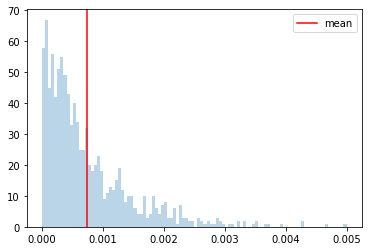

  0%|▏                                                                                | 3/1000 [00:00<01:01, 16.09it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654378184
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 1.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:52,  8.88it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:59,  8.29it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<02:01,  8.13it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:59,  8.26it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:57,  8.37it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:51,  8.85it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<01:57,  8.35it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:57,  8.35it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 23/1000 [00:02<01:49,  8.90it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:50,  8.85it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<01:50,  8.84it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:53,  8.58it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:14,  7.24it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:06,  7.68it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<01:56,  8.28it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<01:56,  8.30it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:53,  8.48it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:50,  8.69it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<01:53,  8.45it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<01:54,  8.37it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<01:54,  8.37it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:52,  8.49it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:05<01:47,  8.85it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<01:49,  8.62it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<01:49,  8.66it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<02:17,  6.88it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:06<02:05,  7.50it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<02:04,  7.53it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<01:59,  7.83it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:07<01:57,  7.95it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:08<02:04,  7.52it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:08<01:55,  8.05it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:08<01:50,  8.38it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:08<01:53,  8.21it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:09<02:07,  7.26it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<01:57,  7.86it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:09<01:54,  8.06it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:09<01:51,  8.23it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:10<01:55,  7.94it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:10<01:54,  8.02it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:10<01:55,  7.88it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:10<02:02,  7.42it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:11<01:58,  7.66it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:11<02:03,  7.34it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:11<02:03,  7.32it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:11<02:07,  7.08it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:12<02:03,  7.29it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                        | 99/1000 [00:12<02:01,  7.39it/s]

Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:22,  6.32it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:12<02:09,  6.90it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:02,  7.29it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:00,  7.39it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:08,  6.94it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:03,  7.21it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:11,  6.77it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:09,  6.84it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:14<02:10,  6.78it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:06,  6.99it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:06,  6.95it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<02:08,  6.80it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:10,  6.71it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:11,  6.62it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:13,  6.51it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:09,  6.71it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:14,  6.45it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<02:10,  6.61it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:17<02:12,  6.51it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:14,  6.39it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:14,  6.40it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:18<02:11,  6.51it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:14,  6.36it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:14,  6.35it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:19<02:11,  6.48it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:09,  6.55it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:13,  6.37it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:20<02:19,  6.08it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:14,  6.27it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<02:14,  6.24it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:21<02:09,  6.46it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:11,  6.34it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:14,  6.23it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:11,  6.33it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:15,  6.13it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:23<02:18,  5.99it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:23<02:16,  6.04it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:27,  5.60it/s]

Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:21,  5.81it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:24<02:17,  5.97it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:24<02:21,  5.81it/s]

Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:20,  5.82it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:25<02:24,  5.66it/s]

Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:25<02:22,  5.72it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:18,  5.86it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:26<02:21,  5.74it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:26<02:17,  5.90it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:27<02:16,  5.91it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:25,  5.55it/s]

Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:27<02:29,  5.39it/s]

Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:27<02:24,  5.56it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:29,  5.38it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:24,  5.52it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:28<02:20,  5.67it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:29<02:18,  5.75it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:18,  5.74it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:29<02:20,  5.63it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:30<02:16,  5.78it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:30<02:17,  5.74it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:30<02:24,  5.43it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:30<02:23,  5.48it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:19,  5.63it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:20,  5.57it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:20,  5.57it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:31<02:19,  5.61it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:21,  5.51it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:25,  5.35it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:32<02:23,  5.42it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▋                                                             | 224/1000 [00:32<02:29,  5.19it/s]

Monte Carlo 224


 22%|█████████████████▊                                                             | 225/1000 [00:33<02:53,  4.47it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:33<02:38,  4.89it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:34,  4.98it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:33<02:29,  5.15it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:25,  5.29it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:26,  5.23it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:21,  5.41it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:34<02:20,  5.43it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:22,  5.38it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:25,  5.23it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:35<02:21,  5.37it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:21,  5.35it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:22,  5.33it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:24,  5.25it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:36<02:24,  5.25it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:36<02:22,  5.31it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:20,  5.37it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:23,  5.24it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:22,  5.27it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:37<02:19,  5.40it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:37<02:16,  5.49it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:19,  5.35it/s]

Monte Carlo 251
Monte Carlo 252


 25%|███████████████████▉                                                           | 253/1000 [00:38<02:27,  5.05it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:38<02:28,  5.03it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:27,  5.03it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:28,  4.99it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:39<02:29,  4.94it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:30,  4.90it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:26,  5.05it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:24,  5.10it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:40<02:23,  5.11it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 266/1000 [00:41<02:29,  4.92it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:41<02:28,  4.93it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:26,  4.99it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:41<02:23,  5.10it/s]

Monte Carlo 269
Monte Carlo 270


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:23,  5.08it/s]

Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:30,  4.85it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:29,  4.85it/s]

Monte Carlo 273
Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:26,  4.93it/s]

Monte Carlo 275
Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:26,  4.91it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:43<02:28,  4.87it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:44<02:26,  4.91it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:26,  4.90it/s]

Monte Carlo 281
Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:28,  4.84it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:28,  4.80it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:45<02:25,  4.90it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:26,  4.88it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:23,  4.98it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:27,  4.83it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:45<02:28,  4.79it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:46<02:29,  4.75it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:27,  4.80it/s]

Monte Carlo 292
Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:47<02:30,  4.67it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:29,  4.72it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:47<02:27,  4.76it/s]

Monte Carlo 296
Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:47<02:31,  4.64it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:47<02:34,  4.52it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:31,  4.61it/s]

Monte Carlo 300
Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:48<02:34,  4.52it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:48<02:35,  4.47it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:49<02:52,  4.05it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:49<04:13,  2.74it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:50<04:51,  2.38it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:50<05:06,  2.26it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:51<05:19,  2.17it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:51<04:32,  2.54it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:51<03:26,  3.34it/s]

Monte Carlo 310
Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:52<03:12,  3.58it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:52<02:46,  4.13it/s]

Monte Carlo 313
Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:53<02:34,  4.44it/s]

Monte Carlo 315
Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:53<02:32,  4.48it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<02:32,  4.45it/s]

Monte Carlo 319
Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:54<02:31,  4.47it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:54<02:32,  4.45it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:54<02:29,  4.53it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:24,  4.67it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:55<02:22,  4.72it/s]

Monte Carlo 325
Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:55<02:26,  4.60it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:55<02:28,  4.53it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:56<02:23,  4.66it/s]

Monte Carlo 329
Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:56<02:35,  4.30it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:56<02:51,  3.89it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:56<02:50,  3.91it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:57<02:43,  4.06it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:57<02:36,  4.24it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:57<02:31,  4.39it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:57<02:30,  4.42it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:58<02:29,  4.43it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:58<02:28,  4.44it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:58<02:26,  4.51it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:58<02:25,  4.53it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:58<02:22,  4.61it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:59<02:23,  4.57it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:59<02:28,  4.40it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:59<02:25,  4.49it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:59<02:26,  4.47it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:00<02:25,  4.48it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:00<02:32,  4.28it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:00<02:30,  4.33it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:00<02:30,  4.31it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:00<02:28,  4.36it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:01<02:25,  4.47it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:01<02:28,  4.35it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:01<02:25,  4.45it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:01<02:24,  4.48it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:02<02:26,  4.40it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:02<02:25,  4.42it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:02<02:29,  4.30it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:02<02:27,  4.34it/s]

Monte Carlo 359


 36%|████████████████████████████▌                                                  | 361/1000 [01:03<02:25,  4.40it/s]

Monte Carlo 360
Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:03<02:50,  3.74it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:03<02:43,  3.89it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:04<02:38,  4.02it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:04<02:37,  4.02it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:04<02:35,  4.07it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:04<02:37,  4.02it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:05<02:38,  4.00it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:05<02:31,  4.18it/s]

Monte Carlo 369


 37%|█████████████████████████████▎                                                 | 371/1000 [01:05<02:23,  4.39it/s]

Monte Carlo 370
Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:05<02:25,  4.30it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:06<02:23,  4.36it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:06<02:21,  4.41it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:06<02:26,  4.26it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:06<02:24,  4.32it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:07<02:24,  4.32it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:07<02:22,  4.35it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:07<02:22,  4.37it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:07<02:22,  4.35it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:08<02:25,  4.25it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:08<02:23,  4.30it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:08<02:23,  4.29it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:08<02:21,  4.34it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:08<02:22,  4.33it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:09<02:25,  4.21it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:09<02:25,  4.22it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:09<02:28,  4.12it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:09<02:26,  4.18it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:10<02:25,  4.21it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:10<02:28,  4.09it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:10<02:31,  4.01it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:10<02:27,  4.13it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:11<02:25,  4.16it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:11<02:27,  4.11it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:11<02:26,  4.12it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:11<02:26,  4.13it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:12<02:27,  4.09it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:12<02:29,  4.03it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:12<02:25,  4.12it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:12<02:24,  4.13it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:13<02:24,  4.13it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:13<02:22,  4.20it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:13<02:27,  4.04it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:13<02:23,  4.16it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:14<02:22,  4.16it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:14<02:20,  4.21it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:14<02:21,  4.18it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:14<02:25,  4.07it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:15<02:24,  4.08it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:15<02:26,  4.02it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:15<02:24,  4.07it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:15<02:29,  3.93it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:16<02:29,  3.91it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:16<02:26,  3.99it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:16<02:25,  4.02it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:16<02:27,  3.96it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:17<02:26,  3.97it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:17<02:25,  3.99it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:17<02:24,  4.02it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:17<02:25,  3.98it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:18<02:22,  4.04it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:18<02:23,  4.01it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:18<02:26,  3.93it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:18<02:25,  3.95it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:19<02:43,  3.52it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:19<02:58,  3.21it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:19<02:55,  3.26it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:20<02:51,  3.33it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:20<02:46,  3.43it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:20<02:43,  3.49it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:20<02:41,  3.52it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:21<02:44,  3.45it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:21<02:43,  3.46it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:21<02:44,  3.42it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:22<02:41,  3.49it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:22<02:39,  3.52it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:22<02:40,  3.50it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:22<02:39,  3.51it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:23<02:41,  3.46it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:23<02:38,  3.52it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:23<02:40,  3.47it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:24<02:43,  3.40it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:24<02:43,  3.40it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:24<02:42,  3.41it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:25<02:40,  3.44it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:25<02:38,  3.48it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:25<02:37,  3.51it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:25<02:39,  3.46it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:26<02:41,  3.41it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:26<02:40,  3.42it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:26<02:36,  3.50it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:27<02:37,  3.48it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:27<02:34,  3.53it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:27<02:42,  3.35it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:27<02:42,  3.34it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:28<02:43,  3.33it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:28<02:54,  3.10it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:28<02:53,  3.12it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:29<02:49,  3.18it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:29<03:09,  2.85it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:29<02:58,  3.02it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:30<02:53,  3.10it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:30<02:46,  3.23it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:30<02:39,  3.36it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:31<02:38,  3.36it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:31<02:39,  3.33it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:31<02:36,  3.39it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:31<02:36,  3.39it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:32<02:33,  3.45it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:32<02:32,  3.48it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:32<02:32,  3.46it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:33<02:35,  3.40it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:33<02:36,  3.35it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:33<02:36,  3.35it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:34<02:31,  3.47it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:34<02:30,  3.47it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:34<02:31,  3.45it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:34<02:30,  3.47it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:35<02:30,  3.46it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:35<02:28,  3.49it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:35<02:21,  3.67it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:35<02:16,  3.78it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:36<02:12,  3.89it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:36<02:18,  3.71it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:36<02:23,  3.59it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:37<02:21,  3.63it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:37<02:19,  3.68it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:37<02:14,  3.80it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:37<02:16,  3.73it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:38<02:13,  3.80it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:38<02:16,  3.72it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:38<02:23,  3.54it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:38<02:19,  3.62it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:39<02:19,  3.63it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:39<02:17,  3.66it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:39<02:21,  3.56it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:40<02:17,  3.66it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:40<02:17,  3.65it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:40<02:23,  3.49it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:40<02:21,  3.52it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:41<02:20,  3.54it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:41<02:17,  3.61it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:41<02:17,  3.61it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:42<02:24,  3.41it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:42<02:26,  3.36it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:42<02:23,  3.43it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:42<02:18,  3.56it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:43<02:25,  3.37it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:43<02:25,  3.37it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:43<02:23,  3.41it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:44<02:23,  3.39it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:44<02:22,  3.42it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:44<02:20,  3.46it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:44<02:21,  3.44it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:45<02:24,  3.34it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:45<02:39,  3.03it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:45<02:30,  3.20it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:46<02:31,  3.17it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:46<02:27,  3.27it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:46<02:30,  3.18it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:47<02:31,  3.16it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:47<02:27,  3.23it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:47<02:34,  3.08it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:48<02:36,  3.04it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:48<02:33,  3.10it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:48<02:34,  3.06it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:49<02:32,  3.09it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:49<02:33,  3.07it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:49<02:31,  3.11it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:50<02:32,  3.08it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:50<02:32,  3.06it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:50<02:31,  3.07it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:51<02:29,  3.12it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:51<02:28,  3.13it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:51<02:31,  3.06it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:52<02:28,  3.11it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:52<02:36,  2.95it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:52<02:33,  3.00it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:53<02:52,  2.67it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:53<02:46,  2.76it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:53<02:44,  2.79it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:54<02:37,  2.90it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:54<02:35,  2.94it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:54<02:38,  2.88it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:55<02:38,  2.87it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:55<02:36,  2.89it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:55<02:35,  2.90it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:56<02:32,  2.96it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:56<02:36,  2.87it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:57<02:42,  2.76it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:57<02:42,  2.76it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:57<02:41,  2.77it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:58<02:41,  2.75it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:58<02:32,  2.91it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:58<02:31,  2.93it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:59<02:31,  2.92it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:59<02:35,  2.84it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:59<02:36,  2.82it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [02:00<02:32,  2.89it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [02:00<02:31,  2.90it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [02:00<02:34,  2.84it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [02:01<02:26,  2.98it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [02:01<02:32,  2.86it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [02:01<02:34,  2.81it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [02:02<02:27,  2.94it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:02<02:30,  2.89it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:02<02:32,  2.83it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:03<02:31,  2.84it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:03<02:27,  2.91it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:03<02:23,  2.98it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:04<02:22,  3.00it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:04<02:23,  2.97it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:05<02:28,  2.87it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:05<02:28,  2.87it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:05<02:23,  2.95it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:06<02:28,  2.85it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:06<02:24,  2.91it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:06<02:23,  2.93it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:07<02:24,  2.91it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:07<02:24,  2.90it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:07<02:26,  2.84it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:08<02:22,  2.93it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:08<02:20,  2.96it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:08<02:22,  2.92it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:09<02:22,  2.90it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:09<02:21,  2.93it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:09<02:18,  2.97it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:10<02:22,  2.89it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:10<02:20,  2.92it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:10<02:19,  2.94it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:11<02:19,  2.92it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:11<02:24,  2.82it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:11<02:18,  2.92it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:12<02:17,  2.95it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:12<02:15,  2.97it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:12<02:16,  2.95it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:13<02:17,  2.93it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:13<02:22,  2.82it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:13<02:19,  2.86it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:14<02:17,  2.91it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:14<02:20,  2.83it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:15<02:19,  2.84it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:15<02:14,  2.95it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:15<02:10,  3.02it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:15<02:12,  2.98it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:16<02:12,  2.97it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:16<02:08,  3.04it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:16<02:07,  3.06it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:17<02:04,  3.14it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:17<02:05,  3.11it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:17<02:04,  3.12it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:18<02:03,  3.14it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:18<02:01,  3.18it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:18<02:02,  3.15it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:19<02:03,  3.11it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:19<02:03,  3.10it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:19<02:01,  3.15it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:20<01:59,  3.19it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:20<02:16,  2.79it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:20<02:10,  2.90it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:21<02:08,  2.95it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:21<02:13,  2.83it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:21<02:08,  2.93it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:22<02:10,  2.87it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:22<02:08,  2.92it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:22<02:05,  2.98it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:23<02:02,  3.03it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:23<02:00,  3.07it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:23<02:00,  3.06it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:24<02:03,  2.99it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:24<02:00,  3.06it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:24<01:59,  3.06it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:25<02:02,  2.99it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:25<02:01,  2.99it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:25<02:00,  3.02it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:26<02:01,  2.99it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:26<02:01,  2.98it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:26<01:59,  3.02it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:27<01:58,  3.04it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:27<01:58,  3.04it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:27<01:55,  3.10it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:28<01:54,  3.12it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:28<01:53,  3.13it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:28<01:52,  3.14it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:29<01:56,  3.05it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:29<01:55,  3.05it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:29<01:53,  3.09it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:30<01:52,  3.11it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:30<01:53,  3.07it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:30<01:55,  3.03it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:31<01:52,  3.09it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:31<01:51,  3.10it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:31<01:51,  3.10it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:32<01:55,  2.98it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:32<01:53,  3.03it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:32<01:52,  3.04it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:33<01:56,  2.93it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:33<01:57,  2.91it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:33<01:54,  2.96it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:34<01:53,  3.00it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:34<01:48,  3.12it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:34<01:49,  3.09it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:35<01:45,  3.19it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:35<01:44,  3.21it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:35<01:46,  3.14it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:35<01:45,  3.15it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:36<01:45,  3.14it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:36<01:46,  3.12it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:36<01:47,  3.08it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:37<01:45,  3.12it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:37<01:44,  3.13it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:37<01:42,  3.17it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:38<01:42,  3.17it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:38<01:46,  3.06it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:38<01:45,  3.08it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:39<01:44,  3.09it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:39<01:44,  3.07it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:39<01:46,  3.00it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:40<01:49,  2.91it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:40<01:53,  2.82it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:40<01:51,  2.84it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:41<01:52,  2.82it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:41<01:49,  2.88it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:42<01:49,  2.88it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:42<01:50,  2.85it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:42<01:48,  2.89it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:43<01:47,  2.91it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:43<01:45,  2.95it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:43<01:43,  2.99it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:44<01:47,  2.88it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:44<01:47,  2.86it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:44<01:45,  2.91it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:45<01:47,  2.84it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:45<01:44,  2.91it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:45<01:44,  2.90it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:46<01:44,  2.91it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:46<01:43,  2.92it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:46<01:44,  2.89it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:47<01:42,  2.92it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:47<01:44,  2.86it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:47<01:44,  2.85it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:48<01:43,  2.88it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:48<01:44,  2.84it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:48<01:47,  2.75it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:49<01:43,  2.84it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:49<01:43,  2.84it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:50<01:43,  2.82it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:50<01:42,  2.84it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:50<01:40,  2.87it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:51<01:45,  2.75it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:51<01:43,  2.79it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:51<01:41,  2.82it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:52<01:39,  2.88it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:52<01:39,  2.87it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:52<01:41,  2.79it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:53<01:39,  2.83it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:53<01:39,  2.84it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:53<01:38,  2.85it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:54<01:37,  2.86it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:54<01:38,  2.84it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:54<01:39,  2.79it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:55<01:37,  2.84it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:55<01:36,  2.86it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:56<01:35,  2.87it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:56<01:35,  2.87it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:56<01:36,  2.82it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:57<01:35,  2.84it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:57<01:36,  2.80it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:57<01:37,  2.77it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:58<01:35,  2.80it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:58<01:35,  2.82it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:58<01:34,  2.83it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:59<01:34,  2.83it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:59<01:34,  2.79it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:59<01:37,  2.72it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [03:00<01:35,  2.74it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [03:00<01:37,  2.68it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:01<01:35,  2.73it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:01<01:42,  2.54it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:01<01:38,  2.64it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:02<01:37,  2.65it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:02<01:36,  2.68it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:02<01:34,  2.70it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:03<01:32,  2.77it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:03<01:32,  2.74it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:04<01:31,  2.78it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:04<01:30,  2.79it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:04<01:31,  2.73it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:05<01:33,  2.68it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:05<01:32,  2.69it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:05<01:32,  2.69it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:06<01:30,  2.73it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:06<01:29,  2.75it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:06<01:29,  2.75it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:07<01:29,  2.73it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:07<01:29,  2.72it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:08<01:29,  2.71it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:08<01:29,  2.70it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:08<01:27,  2.73it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:09<01:28,  2.71it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:09<01:27,  2.71it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:09<01:26,  2.74it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:10<01:25,  2.77it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:10<01:24,  2.78it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:11<01:25,  2.74it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:11<01:25,  2.73it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:11<01:24,  2.74it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:12<01:24,  2.74it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:12<01:24,  2.72it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:12<01:24,  2.72it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:13<01:22,  2.75it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:13<01:23,  2.71it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:13<01:24,  2.67it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:14<01:26,  2.61it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:14<01:24,  2.66it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:15<01:24,  2.65it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:15<01:23,  2.66it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:15<01:22,  2.67it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:16<01:25,  2.59it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:16<01:23,  2.61it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:17<01:22,  2.65it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:17<01:22,  2.64it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:17<01:20,  2.68it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:18<01:21,  2.65it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:18<01:21,  2.63it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:18<01:20,  2.65it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:19<01:20,  2.64it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:19<01:20,  2.61it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:20<01:20,  2.62it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:20<01:20,  2.60it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:20<01:19,  2.63it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:21<01:19,  2.59it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:21<01:18,  2.64it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:21<01:18,  2.62it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:22<01:17,  2.64it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:22<01:15,  2.68it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:23<01:13,  2.75it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:23<01:12,  2.76it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:23<01:13,  2.72it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:24<01:13,  2.72it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:24<01:10,  2.81it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:24<01:10,  2.78it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:25<01:11,  2.72it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:25<01:11,  2.73it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:25<01:10,  2.75it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:26<01:09,  2.77it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:26<01:09,  2.78it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:27<01:08,  2.78it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:27<01:08,  2.79it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:27<01:08,  2.77it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:28<01:08,  2.75it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:28<01:07,  2.78it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:28<01:06,  2.81it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:29<01:05,  2.82it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:29<01:05,  2.82it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:29<01:04,  2.84it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:30<01:03,  2.85it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:30<01:03,  2.84it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:30<01:04,  2.78it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:31<01:04,  2.78it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:31<01:05,  2.72it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:32<01:04,  2.73it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:32<01:05,  2.70it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:32<01:05,  2.67it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:33<01:04,  2.68it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:33<01:05,  2.63it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:33<01:04,  2.67it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:34<01:03,  2.71it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:34<01:03,  2.69it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:35<01:01,  2.77it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:35<01:02,  2.70it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:35<01:01,  2.72it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:36<01:00,  2.74it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:36<01:00,  2.75it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:36<01:02,  2.63it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:37<00:59,  2.72it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:37<01:00,  2.67it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:38<01:00,  2.65it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:38<01:00,  2.62it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:38<00:59,  2.66it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:39<00:59,  2.66it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:39<00:59,  2.62it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:39<00:59,  2.61it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:40<00:59,  2.59it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:40<00:59,  2.60it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:41<00:57,  2.65it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:41<00:57,  2.66it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:41<00:57,  2.62it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:42<00:57,  2.59it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:42<00:57,  2.58it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:42<00:57,  2.60it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:43<00:57,  2.58it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:43<00:59,  2.45it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:44<01:01,  2.37it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:44<01:02,  2.29it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:45<01:02,  2.29it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:45<01:06,  2.14it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:46<01:01,  2.28it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:46<01:00,  2.31it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:46<00:59,  2.35it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:47<00:58,  2.38it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:47<00:56,  2.41it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:48<00:55,  2.43it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:48<00:55,  2.43it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:48<00:55,  2.41it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:49<00:55,  2.40it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:49<00:54,  2.42it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:50<00:54,  2.42it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:50<00:53,  2.41it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:51<00:53,  2.40it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:51<00:53,  2.38it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:51<00:53,  2.39it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:52<00:52,  2.39it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:52<00:52,  2.37it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:53<00:54,  2.28it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:53<00:52,  2.33it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:54<00:53,  2.29it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:54<00:51,  2.36it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:54<00:50,  2.40it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:55<00:49,  2.42it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:55<00:48,  2.41it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:56<00:48,  2.40it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:56<00:48,  2.38it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:57<00:49,  2.32it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:57<00:49,  2.28it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:57<00:49,  2.30it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:58<00:49,  2.26it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:58<00:48,  2.29it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:59<00:47,  2.31it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:59<00:46,  2.37it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:00<00:45,  2.39it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:00<00:44,  2.38it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:00<00:44,  2.39it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:01<00:43,  2.40it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:01<00:43,  2.40it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:02<00:42,  2.41it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:02<00:42,  2.41it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:02<00:41,  2.41it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:03<00:42,  2.36it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:03<00:41,  2.39it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:04<00:40,  2.40it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:04<00:41,  2.31it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:05<00:41,  2.32it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:05<00:41,  2.29it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:05<00:41,  2.27it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:06<00:41,  2.26it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:06<00:40,  2.26it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:07<00:40,  2.27it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:07<00:38,  2.31it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:08<00:38,  2.28it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:08<00:38,  2.28it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:09<00:37,  2.32it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:09<00:36,  2.33it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:09<00:36,  2.36it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:10<00:35,  2.39it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:10<00:34,  2.39it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:11<00:34,  2.35it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:11<00:34,  2.38it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:11<00:33,  2.37it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:12<00:33,  2.33it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:12<00:33,  2.30it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:13<00:33,  2.28it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:13<00:33,  2.27it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:14<00:32,  2.30it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:14<00:32,  2.29it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:15<00:31,  2.30it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:15<00:31,  2.30it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:15<00:30,  2.30it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:16<00:30,  2.31it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:16<00:29,  2.30it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:17<00:29,  2.33it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:17<00:28,  2.33it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:18<00:28,  2.34it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:18<00:27,  2.35it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:18<00:27,  2.33it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:19<00:27,  2.31it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:19<00:27,  2.26it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:20<00:26,  2.31it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:20<00:25,  2.34it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:21<00:25,  2.29it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:21<00:25,  2.30it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:21<00:24,  2.33it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:22<00:23,  2.35it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:22<00:23,  2.33it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:23<00:23,  2.30it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:23<00:23,  2.27it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:24<00:23,  2.25it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:24<00:22,  2.30it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:25<00:21,  2.28it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:25<00:21,  2.30it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:25<00:20,  2.30it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:26<00:20,  2.30it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:26<00:20,  2.30it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:27<00:19,  2.28it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:27<00:19,  2.30it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:28<00:18,  2.29it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:28<00:18,  2.28it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:28<00:18,  2.27it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:29<00:18,  2.12it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:29<00:17,  2.19it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:30<00:17,  2.19it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:30<00:16,  2.21it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:31<00:15,  2.27it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:31<00:16,  2.17it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:32<00:15,  2.21it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:32<00:14,  2.26it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:33<00:14,  2.27it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:33<00:13,  2.25it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:33<00:13,  2.26it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:34<00:12,  2.27it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:34<00:12,  2.26it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:35<00:11,  2.27it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:35<00:11,  2.25it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:36<00:11,  2.27it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:36<00:10,  2.28it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:36<00:10,  2.28it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:37<00:09,  2.27it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:37<00:09,  2.26it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:38<00:09,  2.20it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:38<00:08,  2.25it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:39<00:07,  2.26it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:39<00:07,  2.25it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:40<00:07,  2.27it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:40<00:06,  2.26it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:40<00:06,  2.28it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:41<00:05,  2.22it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:41<00:05,  2.18it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:42<00:04,  2.23it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:42<00:04,  2.25it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:43<00:04,  2.23it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:43<00:03,  2.24it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:44<00:03,  2.26it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:44<00:02,  2.30it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:44<00:02,  2.31it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:45<00:01,  2.33it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:45<00:01,  2.34it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:46<00:00,  2.38it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:46<00:00,  2.40it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:47<00:00,  3.48it/s]


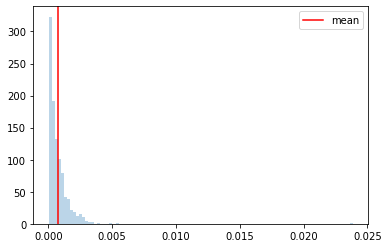

  0%|▏                                                                                | 3/1000 [00:00<00:58, 17.19it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654378472
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 1.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▍                                                                                | 5/1000 [00:00<01:20, 12.40it/s]

Monte Carlo 3
Monte Carlo 4
Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 9/1000 [00:00<01:44,  9.48it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▉                                                                               | 11/1000 [00:01<01:42,  9.66it/s]

Monte Carlo 9
Monte Carlo 10


  1%|█                                                                               | 13/1000 [00:01<01:42,  9.67it/s]

Monte Carlo 11
Monte Carlo 12


  2%|█▏                                                                              | 15/1000 [00:01<01:41,  9.68it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:41,  9.71it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▌                                                                              | 19/1000 [00:01<01:42,  9.61it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:45,  9.26it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:46,  9.19it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:56,  8.37it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<02:04,  7.82it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:57,  8.26it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<01:53,  8.55it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:02,  7.88it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<01:57,  8.20it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:03<01:58,  8.15it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:56,  8.24it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:57,  8.20it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<02:03,  7.76it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:04<01:59,  8.00it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<01:55,  8.27it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:52,  8.46it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:05<01:54,  8.30it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:05<01:56,  8.16it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<01:50,  8.54it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<01:53,  8.33it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:06<01:54,  8.25it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:06<01:57,  8.02it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<01:55,  8.12it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 63/1000 [00:07<01:54,  8.19it/s]

Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<02:15,  6.90it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:07<02:03,  7.56it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<01:54,  8.16it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<01:48,  8.57it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<01:56,  7.98it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:08<02:02,  7.57it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:03,  7.46it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<01:57,  7.84it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:09<02:00,  7.62it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:09<01:59,  7.67it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:00,  7.59it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<01:54,  8.01it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:10<01:51,  8.16it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:10<01:56,  7.78it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:02,  7.42it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<02:02,  7.36it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:11<02:11,  6.89it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:13,  6.76it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:11,  6.83it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:12<02:10,  6.89it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:12<02:07,  7.01it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:16,  6.55it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:18,  6.46it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:13<02:12,  6.70it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:08,  6.92it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:04,  7.11it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:14<02:03,  7.14it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:13,  6.59it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:16,  6.46it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<02:20,  6.24it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:12,  6.61it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:21,  6.16it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:16,  6.36it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:16<02:16,  6.38it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:12,  6.53it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<02:14,  6.45it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:17<02:19,  6.20it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:18,  6.20it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:29,  5.74it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:18<02:23,  5.99it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:18,  6.16it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:20,  6.08it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:19<02:23,  5.92it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:17,  6.17it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:17,  6.17it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:20<02:20,  6.01it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:16,  6.16it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<02:17,  6.12it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:21<02:21,  5.93it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▊                                                                  | 162/1000 [00:22<02:19,  6.00it/s]

Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:22<02:18,  6.05it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:22<02:19,  5.99it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:22,  5.83it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:23<02:20,  5.92it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:23<02:15,  6.12it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:18,  5.98it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:16,  6.05it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:24<02:19,  5.91it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:22,  5.73it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:18,  5.89it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:25<02:24,  5.65it/s]

Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:22,  5.72it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:25,  5.59it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▊                                                                | 188/1000 [00:26<02:24,  5.63it/s]

Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:47,  4.84it/s]

Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:36,  5.18it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:27<02:29,  5.39it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:26,  5.49it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:26,  5.49it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:28<02:28,  5.41it/s]

Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:26,  5.47it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:23,  5.57it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:28<02:23,  5.58it/s]

Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:21,  5.65it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:24,  5.50it/s]

Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:28,  5.35it/s]

Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:29<02:28,  5.33it/s]

Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:30<02:25,  5.43it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:30<02:33,  5.15it/s]

Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:29,  5.28it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:31<02:24,  5.46it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:22,  5.53it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:21,  5.57it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:18,  5.67it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:23,  5.45it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:24,  5.39it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:27,  5.28it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:24,  5.38it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:20,  5.52it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:25,  5.32it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:33<02:21,  5.47it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:34<02:17,  5.62it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:17,  5.60it/s]

Monte Carlo 230


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:21,  5.43it/s]

Monte Carlo 231


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:28,  5.19it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:33,  5.00it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:31,  5.06it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:24,  5.28it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:25,  5.23it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:33,  4.97it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:32,  5.00it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:28,  5.13it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:21,  5.36it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:24,  5.22it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:27,  5.12it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:32,  4.92it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:30,  4.99it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:29,  5.01it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:24,  5.18it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:39<02:24,  5.15it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:27,  5.05it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:27,  5.04it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:24,  5.13it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 258/1000 [00:39<02:31,  4.90it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:29,  4.96it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:31,  4.87it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:31,  4.86it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:52,  4.27it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:43,  4.48it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▏                                                         | 268/1000 [00:42<02:47,  4.36it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:47,  4.37it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:36,  4.66it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:31,  4.80it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:43<02:30,  4.83it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:27,  4.93it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:23,  5.05it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:21,  5.11it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:24,  5.02it/s]

Monte Carlo 276
Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:34,  4.69it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:44<02:29,  4.81it/s]

Monte Carlo 279
Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:30,  4.76it/s]

Monte Carlo 281
Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:27,  4.87it/s]

Monte Carlo 283
Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:45<02:31,  4.70it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:46<02:33,  4.64it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:33,  4.65it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:34,  4.62it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:46<02:34,  4.60it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:46<02:39,  4.44it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:33,  4.59it/s]

Monte Carlo 292
Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:47<02:31,  4.65it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:48<02:29,  4.70it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:31,  4.65it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:29,  4.70it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:48<02:28,  4.72it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:49<02:25,  4.79it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:24,  4.82it/s]

Monte Carlo 301
Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:29,  4.67it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:49<02:30,  4.63it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:49<02:33,  4.52it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:50<02:34,  4.50it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:27,  4.68it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:27,  4.69it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:51<02:50,  4.04it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:51<02:43,  4.21it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:36,  4.40it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:51<02:34,  4.46it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:52<02:32,  4.49it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:25,  4.69it/s]

Monte Carlo 315
Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:26,  4.65it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:27,  4.63it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:53<02:30,  4.54it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<02:30,  4.52it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:33,  4.41it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:26,  4.61it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:54<02:28,  4.54it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:33,  4.38it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:33,  4.38it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:34,  4.35it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:55<02:35,  4.32it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:55<02:36,  4.28it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:34,  4.34it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:55<02:30,  4.46it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:56<02:35,  4.28it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:56<02:32,  4.37it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:56<02:38,  4.20it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:33,  4.35it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:30,  4.41it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:57<02:29,  4.44it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:57<02:25,  4.54it/s]

Monte Carlo 338
Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:31,  4.36it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:58<02:31,  4.34it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 343/1000 [00:58<02:25,  4.50it/s]

Monte Carlo 342
Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:26,  4.48it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:59<02:34,  4.24it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:59<02:33,  4.27it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:59<02:32,  4.29it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:31,  4.30it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:27,  4.43it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:00<02:27,  4.40it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:00<02:32,  4.26it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:00<02:31,  4.27it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:00<02:33,  4.20it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:01<02:31,  4.27it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:01<02:30,  4.29it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:01<02:28,  4.34it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:29,  4.30it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:02<02:29,  4.28it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:02<02:27,  4.35it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:02<02:28,  4.31it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:02<02:24,  4.42it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:21,  4.50it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:03<02:20,  4.54it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:03<02:25,  4.38it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:03<02:23,  4.41it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:30,  4.20it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:04<02:28,  4.26it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:04<02:29,  4.24it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:04<02:28,  4.25it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:29,  4.20it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:05<02:26,  4.30it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:05<02:22,  4.42it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:05<02:27,  4.24it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:28,  4.20it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:29,  4.18it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:06<02:28,  4.21it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:06<02:28,  4.21it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:06<02:32,  4.09it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:31,  4.10it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:07<02:26,  4.22it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:07<02:25,  4.26it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:07<02:23,  4.29it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:24,  4.26it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:08<02:25,  4.23it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:08<02:23,  4.30it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:08<02:44,  3.72it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:09<02:50,  3.60it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:09<02:42,  3.78it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:09<02:38,  3.86it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:09<02:35,  3.93it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:09<02:30,  4.03it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:10<02:28,  4.09it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:10<02:30,  4.03it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:10<02:30,  4.03it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:10<02:27,  4.09it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:11<02:26,  4.11it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:11<02:24,  4.16it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:11<02:20,  4.27it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:11<02:20,  4.28it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:12<02:20,  4.28it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:12<02:20,  4.26it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:12<02:20,  4.27it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:24,  4.13it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:13<02:26,  4.08it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:13<02:26,  4.06it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:13<02:25,  4.08it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:13<02:23,  4.12it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:14<02:25,  4.08it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:14<02:23,  4.11it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:14<02:29,  3.96it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:14<02:27,  4.00it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:15<02:24,  4.07it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:15<02:22,  4.12it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:15<02:24,  4.06it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:15<02:23,  4.08it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:16<02:24,  4.05it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:16<02:21,  4.11it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:16<02:21,  4.12it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:16<02:21,  4.09it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:17<02:26,  3.95it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:17<02:26,  3.96it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:17<02:25,  3.96it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:17<02:22,  4.04it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:18<02:25,  3.96it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:18<02:26,  3.93it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:18<02:38,  3.63it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:18<02:43,  3.50it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:19<03:04,  3.10it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:19<02:55,  3.25it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:19<02:55,  3.24it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:20<02:50,  3.33it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:20<02:44,  3.46it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:20<02:34,  3.66it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:20<02:33,  3.69it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:21<02:28,  3.82it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:21<02:25,  3.87it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:21<02:27,  3.82it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:21<02:23,  3.91it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:22<02:28,  3.77it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:22<02:27,  3.80it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:22<02:25,  3.84it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:23<02:27,  3.78it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:23<02:31,  3.67it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:23<02:28,  3.74it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:23<02:33,  3.61it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:24<02:37,  3.51it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:24<02:36,  3.54it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:24<02:31,  3.65it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:24<02:26,  3.77it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:25<02:27,  3.72it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:25<02:23,  3.83it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:25<02:27,  3.72it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:26<02:23,  3.81it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:26<02:24,  3.77it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:26<02:21,  3.86it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:26<02:21,  3.85it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:27<02:20,  3.86it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:27<02:23,  3.77it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:27<02:21,  3.84it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:27<02:21,  3.82it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:28<02:22,  3.79it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:28<02:24,  3.73it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:28<02:24,  3.71it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:28<02:25,  3.68it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:29<02:23,  3.73it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:29<02:22,  3.74it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:29<02:21,  3.77it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:29<02:21,  3.77it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:30<02:20,  3.78it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:30<02:19,  3.80it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:30<02:18,  3.83it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:31<02:19,  3.78it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:31<02:21,  3.72it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:31<02:21,  3.71it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:31<02:22,  3.68it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:32<02:26,  3.57it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:32<02:26,  3.57it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:32<02:35,  3.35it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:33<02:33,  3.40it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:33<02:36,  3.32it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:33<02:36,  3.31it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:34<02:41,  3.20it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:34<02:39,  3.24it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:34<02:30,  3.42it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:34<02:30,  3.41it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:35<02:27,  3.49it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:35<02:20,  3.65it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:35<02:28,  3.45it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:36<02:29,  3.42it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:36<02:34,  3.29it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:36<02:32,  3.34it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:36<02:28,  3.43it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:37<02:32,  3.32it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:37<02:35,  3.26it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:37<02:28,  3.40it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:38<02:33,  3.27it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:38<02:30,  3.35it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:38<02:29,  3.36it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:39<02:25,  3.44it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:39<02:22,  3.52it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:39<02:20,  3.55it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:39<02:21,  3.52it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:40<02:24,  3.43it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:40<02:26,  3.38it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:40<02:36,  3.16it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:41<02:35,  3.17it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:41<02:34,  3.19it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:41<02:40,  3.06it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:42<02:37,  3.11it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:42<02:29,  3.27it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:42<02:30,  3.26it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:43<02:33,  3.18it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:43<02:35,  3.12it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:43<02:30,  3.24it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:44<02:36,  3.10it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:44<02:35,  3.12it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:44<02:32,  3.16it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:44<02:37,  3.06it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:45<02:41,  2.97it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:45<02:43,  2.93it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:46<02:44,  2.91it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:46<02:45,  2.88it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:46<02:44,  2.89it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:47<02:44,  2.90it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:47<02:43,  2.91it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:47<02:44,  2.88it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:48<02:49,  2.79it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:48<02:47,  2.82it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:48<02:47,  2.81it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:49<02:47,  2.80it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:49<02:47,  2.79it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:49<02:54,  2.69it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:50<02:58,  2.62it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:50<03:09,  2.45it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:51<03:07,  2.48it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:51<03:01,  2.56it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:52<03:05,  2.49it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:52<03:06,  2.47it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:52<03:15,  2.36it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:53<03:13,  2.38it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:53<03:08,  2.44it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:54<03:02,  2.51it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:54<02:58,  2.56it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:54<02:54,  2.61it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:55<02:53,  2.62it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:55<02:47,  2.71it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:55<02:50,  2.65it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:56<02:48,  2.69it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:56<02:43,  2.75it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:57<02:48,  2.68it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:57<03:03,  2.44it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:57<02:57,  2.52it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:58<02:59,  2.48it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:58<02:54,  2.55it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:59<02:50,  2.61it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:59<02:48,  2.64it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:59<02:43,  2.71it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [02:00<02:41,  2.73it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [02:00<02:42,  2.72it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [02:00<02:43,  2.69it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [02:01<02:43,  2.68it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [02:01<02:42,  2.70it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [02:01<02:40,  2.73it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [02:02<02:36,  2.79it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [02:02<02:28,  2.93it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [02:02<02:27,  2.93it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:03<02:28,  2.93it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:03<02:21,  3.04it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:03<02:19,  3.10it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:04<02:16,  3.15it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:04<02:13,  3.21it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:04<02:17,  3.11it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:05<02:18,  3.09it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:05<02:18,  3.07it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:05<02:19,  3.06it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:06<02:18,  3.07it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:06<02:18,  3.06it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:06<02:17,  3.06it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:07<02:17,  3.06it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:07<02:20,  2.99it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:07<02:20,  2.99it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:08<02:17,  3.04it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:08<02:17,  3.02it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:08<02:13,  3.11it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:09<02:15,  3.07it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:09<02:15,  3.07it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:09<02:13,  3.10it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:10<02:10,  3.15it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:10<02:10,  3.14it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:10<02:11,  3.11it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:11<02:15,  3.01it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:11<02:13,  3.06it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:11<02:14,  3.03it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:12<02:14,  3.02it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:12<02:16,  2.98it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:12<02:15,  2.97it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:13<02:16,  2.94it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:13<02:14,  3.00it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:13<02:09,  3.09it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:14<02:09,  3.08it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:14<02:09,  3.08it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:14<02:09,  3.08it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:14<02:06,  3.13it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:15<02:06,  3.13it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:15<02:07,  3.10it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:15<02:09,  3.05it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:16<02:10,  3.01it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:16<02:09,  3.03it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:16<02:08,  3.05it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:17<02:08,  3.04it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:17<02:04,  3.12it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:17<02:02,  3.16it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:18<01:59,  3.23it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:18<01:57,  3.27it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:18<01:56,  3.29it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:19<01:57,  3.27it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:19<01:55,  3.30it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:19<01:54,  3.32it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:19<01:53,  3.36it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:20<01:54,  3.32it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:20<01:53,  3.35it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:20<01:54,  3.30it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:21<01:52,  3.36it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:21<01:54,  3.30it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:21<01:54,  3.28it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:22<01:55,  3.24it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:22<01:54,  3.25it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:22<01:54,  3.26it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:23<01:55,  3.22it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:23<01:54,  3.23it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:23<01:55,  3.20it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:24<01:54,  3.20it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:24<01:57,  3.12it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:24<01:56,  3.13it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:24<01:54,  3.19it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:25<01:54,  3.17it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:25<01:53,  3.20it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:25<01:50,  3.27it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:26<01:49,  3.30it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:26<01:52,  3.21it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:26<01:53,  3.15it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:27<01:52,  3.17it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:27<01:51,  3.20it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:27<01:51,  3.19it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:28<01:51,  3.18it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:28<01:49,  3.23it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:28<01:50,  3.19it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:29<01:52,  3.13it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:29<01:55,  3.04it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:29<01:52,  3.11it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:30<01:50,  3.15it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:30<01:54,  3.03it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:30<01:54,  3.04it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:31<01:54,  3.01it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:31<01:54,  3.02it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:31<01:58,  2.91it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:32<01:56,  2.95it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:32<01:58,  2.88it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:32<01:56,  2.94it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:33<02:10,  2.60it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:33<02:09,  2.62it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:33<02:04,  2.72it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:34<02:00,  2.79it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:34<01:59,  2.81it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:34<01:56,  2.87it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:35<01:57,  2.85it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:35<01:55,  2.89it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:36<01:55,  2.88it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:36<01:57,  2.82it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:36<01:55,  2.86it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:37<01:54,  2.87it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:37<01:53,  2.89it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:37<01:51,  2.93it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:38<01:52,  2.91it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:38<01:50,  2.95it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:38<01:52,  2.88it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:39<01:53,  2.84it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:39<01:52,  2.86it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:39<01:53,  2.82it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:40<01:53,  2.82it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:40<01:57,  2.72it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:40<01:53,  2.81it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:41<01:53,  2.79it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:41<01:51,  2.84it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:41<01:49,  2.88it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:42<01:51,  2.83it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:42<01:49,  2.85it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:43<01:51,  2.79it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:43<01:52,  2.77it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:43<01:49,  2.84it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:44<01:47,  2.87it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:44<01:49,  2.80it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:44<01:50,  2.77it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:45<01:48,  2.81it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:45<01:47,  2.83it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:45<01:48,  2.80it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:46<01:45,  2.86it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:46<01:46,  2.84it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:46<01:47,  2.80it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:47<01:46,  2.82it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:47<01:44,  2.86it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:48<01:46,  2.79it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:48<01:45,  2.81it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:48<01:46,  2.78it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:49<01:43,  2.84it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:49<01:42,  2.86it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:49<01:46,  2.76it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:50<01:45,  2.78it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:50<01:43,  2.82it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:50<01:43,  2.81it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:51<01:42,  2.82it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:51<01:42,  2.81it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:51<01:42,  2.81it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:52<01:42,  2.79it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:52<01:41,  2.81it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:53<01:43,  2.76it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:53<01:41,  2.79it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:53<01:42,  2.76it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:54<01:41,  2.77it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:54<01:40,  2.79it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:54<01:39,  2.80it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:55<01:38,  2.81it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:55<01:40,  2.76it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:55<01:40,  2.75it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:56<01:39,  2.76it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:56<01:41,  2.69it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:57<01:42,  2.67it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:57<01:41,  2.69it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:57<01:40,  2.71it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:58<01:43,  2.61it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:58<01:41,  2.65it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:58<01:39,  2.68it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:59<01:38,  2.70it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:59<01:36,  2.75it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:59<01:36,  2.75it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [03:00<01:36,  2.72it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [03:00<01:40,  2.61it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [03:01<01:38,  2.67it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:01<01:38,  2.65it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:01<01:38,  2.64it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:02<01:35,  2.71it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:02<01:35,  2.71it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:03<01:35,  2.70it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:03<01:34,  2.71it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:03<01:33,  2.74it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:04<01:33,  2.71it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:04<01:34,  2.66it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:04<01:34,  2.66it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:05<01:35,  2.62it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:05<01:33,  2.67it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:05<01:31,  2.71it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:06<01:31,  2.70it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:06<01:32,  2.67it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:07<01:34,  2.60it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:07<01:33,  2.62it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:07<01:32,  2.63it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:08<01:42,  2.36it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:08<01:39,  2.44it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:09<01:35,  2.52it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:09<01:33,  2.57it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:09<01:31,  2.62it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:10<01:30,  2.62it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:10<01:28,  2.68it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:11<01:27,  2.69it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:11<01:26,  2.72it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:11<01:25,  2.74it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:12<01:27,  2.66it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:12<01:28,  2.62it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:12<01:28,  2.62it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:13<01:27,  2.64it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:13<01:24,  2.70it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:14<01:25,  2.66it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:14<01:25,  2.66it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:14<01:22,  2.74it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:15<01:22,  2.72it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:15<01:21,  2.74it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:15<01:19,  2.79it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:16<01:20,  2.76it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:16<01:19,  2.77it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:16<01:18,  2.80it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:17<01:18,  2.77it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:17<01:19,  2.75it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:17<01:19,  2.73it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:18<01:19,  2.72it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:18<01:17,  2.76it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:19<01:19,  2.69it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:19<01:17,  2.74it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:19<01:17,  2.74it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:20<01:16,  2.74it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:20<01:16,  2.76it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:20<01:18,  2.65it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:21<01:18,  2.66it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:21<01:19,  2.61it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:22<01:18,  2.63it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:22<01:17,  2.63it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:22<01:17,  2.64it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:23<01:17,  2.61it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:23<01:18,  2.58it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:24<01:19,  2.54it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:24<01:19,  2.50it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:24<01:18,  2.53it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:25<01:17,  2.56it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:25<01:15,  2.61it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:25<01:15,  2.61it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:26<01:15,  2.57it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:26<01:14,  2.60it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:27<01:14,  2.58it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:27<01:14,  2.59it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:27<01:14,  2.55it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:28<01:15,  2.51it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:28<01:15,  2.50it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:29<01:15,  2.50it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:29<01:15,  2.47it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:29<01:13,  2.54it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:30<01:12,  2.54it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:30<01:11,  2.57it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:31<01:10,  2.58it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:31<01:13,  2.47it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:31<01:14,  2.42it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:32<01:13,  2.45it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:32<01:12,  2.45it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:33<01:12,  2.47it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:33<01:10,  2.51it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:33<01:09,  2.52it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:34<01:09,  2.53it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:34<01:08,  2.54it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:35<01:08,  2.51it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:35<01:08,  2.49it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:35<01:10,  2.44it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:36<01:09,  2.44it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:36<01:08,  2.46it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:37<01:08,  2.45it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:37<01:07,  2.49it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:37<01:06,  2.49it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:38<01:06,  2.48it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:38<01:07,  2.43it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:39<01:06,  2.45it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:39<01:05,  2.48it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:40<01:05,  2.48it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:40<01:04,  2.48it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:40<01:05,  2.43it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:41<01:05,  2.40it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:41<01:05,  2.40it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:42<01:04,  2.42it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:42<01:03,  2.46it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:42<01:03,  2.42it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:43<01:03,  2.42it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:43<01:08,  2.22it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:44<01:05,  2.29it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:44<01:03,  2.37it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:45<01:03,  2.35it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:45<01:02,  2.35it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:45<01:01,  2.38it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:46<01:00,  2.40it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:46<00:59,  2.43it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:47<01:00,  2.39it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:47<00:59,  2.39it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:47<00:58,  2.44it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:48<00:57,  2.45it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:48<00:55,  2.50it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:49<00:55,  2.52it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:49<00:55,  2.50it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:49<00:54,  2.53it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:50<00:54,  2.50it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:50<00:52,  2.55it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:51<00:53,  2.52it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:51<00:53,  2.51it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:51<00:52,  2.50it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:52<00:52,  2.50it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:52<00:52,  2.48it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:53<00:51,  2.49it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:53<00:51,  2.49it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:53<00:50,  2.53it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:54<00:49,  2.53it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:54<00:49,  2.51it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:55<00:52,  2.36it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:55<00:50,  2.43it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:55<00:48,  2.49it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:56<00:48,  2.50it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:56<00:47,  2.51it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:57<00:47,  2.53it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:57<00:47,  2.51it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:57<00:47,  2.48it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:58<00:46,  2.48it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:58<00:47,  2.42it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:59<00:46,  2.47it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:59<00:45,  2.49it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [04:00<00:44,  2.52it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [04:00<00:45,  2.46it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [04:00<00:44,  2.47it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:01<00:43,  2.50it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:01<00:44,  2.45it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:02<00:44,  2.43it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:02<00:43,  2.42it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:02<00:42,  2.48it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:03<00:41,  2.48it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:03<00:41,  2.46it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:04<00:41,  2.46it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:04<00:41,  2.46it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:04<00:41,  2.44it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:05<00:40,  2.47it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:05<00:40,  2.42it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:06<00:39,  2.43it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:06<00:39,  2.40it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:06<00:39,  2.43it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:07<00:38,  2.45it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:07<00:38,  2.44it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:08<00:37,  2.48it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:08<00:37,  2.43it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:09<00:37,  2.43it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:09<00:36,  2.42it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:09<00:37,  2.38it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:10<00:37,  2.32it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:10<00:37,  2.30it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:11<00:36,  2.32it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:11<00:36,  2.28it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:12<00:36,  2.26it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:12<00:35,  2.29it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:13<00:36,  2.23it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:13<00:36,  2.22it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:13<00:34,  2.26it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:14<00:34,  2.25it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:14<00:33,  2.27it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:15<00:33,  2.28it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:15<00:32,  2.31it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:16<00:32,  2.30it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:16<00:31,  2.32it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:16<00:30,  2.34it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:17<00:30,  2.31it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:17<00:31,  2.25it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:18<00:30,  2.23it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:18<00:30,  2.22it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:19<00:30,  2.19it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:19<00:32,  2.05it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:20<00:30,  2.11it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:20<00:29,  2.13it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:21<00:29,  2.17it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:21<00:27,  2.23it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:21<00:26,  2.27it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:22<00:26,  2.23it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:22<00:26,  2.25it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:23<00:25,  2.26it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:23<00:25,  2.22it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:24<00:25,  2.17it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:24<00:25,  2.14it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:25<00:25,  2.10it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:25<00:25,  2.11it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:26<00:24,  2.11it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:26<00:23,  2.16it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:27<00:22,  2.21it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:27<00:22,  2.18it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:27<00:22,  2.16it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:28<00:22,  2.09it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:28<00:21,  2.13it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:29<00:20,  2.19it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:29<00:19,  2.23it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:30<00:19,  2.26it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:30<00:18,  2.25it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:31<00:18,  2.20it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:31<00:17,  2.23it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:32<00:17,  2.24it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:32<00:17,  2.21it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:32<00:16,  2.20it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:33<00:16,  2.21it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:33<00:15,  2.23it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:34<00:15,  2.23it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:34<00:15,  2.20it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:35<00:14,  2.22it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:35<00:14,  2.20it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:36<00:13,  2.17it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:36<00:13,  2.13it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:37<00:12,  2.18it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:37<00:12,  2.18it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:37<00:11,  2.17it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:38<00:11,  2.19it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:38<00:10,  2.20it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:39<00:10,  2.21it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:39<00:10,  2.19it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:40<00:09,  2.15it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:40<00:09,  2.15it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:41<00:08,  2.14it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:41<00:08,  2.18it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:42<00:07,  2.16it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:42<00:07,  2.19it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:43<00:06,  2.21it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:43<00:06,  2.20it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:43<00:05,  2.18it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:44<00:05,  2.16it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:44<00:05,  2.18it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:45<00:04,  2.17it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:45<00:04,  2.18it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:46<00:03,  2.19it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:46<00:03,  2.17it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:47<00:02,  2.16it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:47<00:02,  2.20it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:48<00:01,  2.18it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:48<00:01,  2.17it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:48<00:00,  2.19it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:49<00:00,  2.21it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:49<00:00,  3.45it/s]


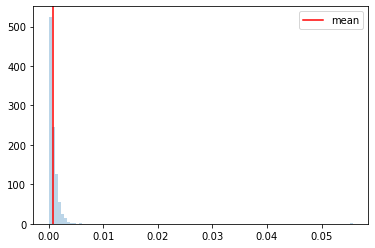

  0%|▏                                                                                | 2/1000 [00:00<00:56, 17.59it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654378762
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 1.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:39, 10.00it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:37, 10.15it/s]

Monte Carlo 5
Monte Carlo 6
Monte Carlo 7

  1%|▋                                                                                | 8/1000 [00:00<01:38, 10.04it/s]


Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:00<01:40,  9.89it/s]

Monte Carlo 9
Monte Carlo 10
Monte Carlo 11

  1%|▉                                                                               | 12/1000 [00:01<01:45,  9.36it/s]


Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:44,  9.45it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 17/1000 [00:01<01:39,  9.84it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:44,  9.44it/s]

Monte Carlo 17
Monte Carlo 18
Monte Carlo 19


  2%|█▊                                                                              | 22/1000 [00:02<01:36, 10.11it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:40,  9.69it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<01:51,  8.75it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:02<01:44,  9.30it/s]

Monte Carlo 26
Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<01:46,  9.11it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<01:54,  8.48it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<01:55,  8.38it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:03<01:50,  8.71it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:55,  8.31it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:54,  8.41it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<01:50,  8.65it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:04<01:51,  8.60it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<01:45,  9.03it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:48,  8.74it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:05<01:51,  8.50it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:05<01:52,  8.42it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:05<01:49,  8.62it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<01:50,  8.52it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:06<01:50,  8.54it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:06<01:52,  8.32it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:06<01:57,  8.02it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:07<01:55,  8.13it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:07<01:54,  8.14it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:07<01:53,  8.23it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:07<01:56,  8.00it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:08<01:52,  8.22it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:08<01:54,  8.10it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:08<02:00,  7.67it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:08<02:10,  7.08it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:09<02:05,  7.35it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:09<02:00,  7.60it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:09<02:06,  7.26it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:10<02:09,  7.06it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:10<02:05,  7.25it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:10<02:10,  6.96it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:10<02:07,  7.13it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:11<02:10,  6.94it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:11<02:15,  6.69it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:11<02:10,  6.90it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:12<02:13,  6.72it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:12<02:08,  6.99it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:12<02:13,  6.72it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:13<02:16,  6.55it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:13<02:19,  6.39it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:13<02:10,  6.82it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:13<02:07,  6.96it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:14<02:20,  6.30it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:14<02:13,  6.61it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:14<02:09,  6.82it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:15<02:16,  6.43it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:15<02:12,  6.63it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:15<02:34,  5.66it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:16<02:36,  5.58it/s]

Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:32,  5.71it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:38,  5.49it/s]

Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:16<02:34,  5.63it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:17<02:22,  6.08it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:17<02:24,  6.00it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:17<02:19,  6.18it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:18<02:16,  6.31it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:18<02:12,  6.48it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:18<02:13,  6.44it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:19<02:13,  6.42it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:19<02:08,  6.64it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:19<02:09,  6.60it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:20<02:18,  6.14it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:20<02:15,  6.25it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:20<02:23,  5.90it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:21<02:27,  5.71it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:21<02:28,  5.67it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:21<02:33,  5.47it/s]

Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:35,  5.41it/s]

Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:29,  5.59it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:22<02:24,  5.77it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:22<02:26,  5.68it/s]

Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:26,  5.68it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:29,  5.56it/s]

Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:23<02:34,  5.38it/s]

Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:23<02:30,  5.50it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:24,  5.72it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:21,  5.81it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:24<02:18,  5.93it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:17,  5.99it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:22,  5.76it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:25<02:18,  5.91it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:18,  5.90it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:21,  5.74it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:26<02:18,  5.84it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:17,  5.89it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:27<02:18,  5.84it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:27<02:21,  5.68it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:28<02:23,  5.60it/s]

Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:20,  5.71it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:27,  5.42it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:27,  5.40it/s]

Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:25,  5.48it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:27,  5.41it/s]

Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:22,  5.60it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:30<02:21,  5.60it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:24,  5.48it/s]

Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:30<02:22,  5.53it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:30<02:24,  5.45it/s]

Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:31<02:23,  5.49it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:26,  5.36it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:29,  5.26it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:27,  5.31it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:28,  5.27it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:25,  5.38it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:22,  5.47it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:24,  5.38it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:23,  5.42it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:23,  5.42it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:33<02:27,  5.25it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:23,  5.39it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:19,  5.54it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:26,  5.27it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:29,  5.15it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:30,  5.12it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:25,  5.29it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:23,  5.32it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:27,  5.16it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:27,  5.18it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:22,  5.33it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:22,  5.33it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:22,  5.30it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:21,  5.35it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:20,  5.36it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:23,  5.25it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:23,  5.24it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:28,  5.06it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:24,  5.18it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:25,  5.14it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:33,  4.86it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:39<02:32,  4.88it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:30,  4.94it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:28,  5.01it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:27,  5.03it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:39<02:27,  5.03it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:29,  4.95it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:30,  4.92it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:30,  4.91it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:30,  4.88it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:25,  5.04it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 266/1000 [00:41<02:26,  5.02it/s]

Monte Carlo 266


 27%|█████████████████████                                                          | 267/1000 [00:41<02:30,  4.88it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:31,  4.82it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:30,  4.85it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:28,  4.91it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:26,  4.98it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:31,  4.80it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:27,  4.92it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:28,  4.88it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:25,  4.95it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:25,  4.96it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:44<02:26,  4.91it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:44<02:23,  5.01it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:44<02:24,  4.99it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:24,  4.97it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:22,  5.04it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:21,  5.07it/s]

Monte Carlo 283
Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:27,  4.86it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:45<02:32,  4.68it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:45,  4.31it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:40,  4.43it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:46<02:32,  4.65it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:28,  4.77it/s]

Monte Carlo 292
Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:47<02:35,  4.54it/s]

Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:47<02:36,  4.51it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:30,  4.68it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:26,  4.80it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:48<02:23,  4.88it/s]

Monte Carlo 298
Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:27,  4.76it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:28,  4.70it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:27,  4.71it/s]

Monte Carlo 302
Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:49<02:28,  4.69it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:49<02:29,  4.66it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:24,  4.79it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:26,  4.72it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:33,  4.51it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:51<02:27,  4.67it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:25,  4.72it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:51<02:27,  4.66it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:25,  4.71it/s]

Monte Carlo 314
Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:26,  4.68it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:28,  4.59it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:31,  4.51it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:28,  4.58it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:27,  4.60it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:53<02:27,  4.60it/s]

Monte Carlo 321
Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:26,  4.61it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:27,  4.59it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:26,  4.62it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:26,  4.59it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:26,  4.61it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:24,  4.64it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:54<02:27,  4.56it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:28,  4.50it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:55<02:30,  4.45it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:55<02:33,  4.35it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:33,  4.34it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:56<02:30,  4.44it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:30,  4.41it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:25,  4.57it/s]

Monte Carlo 336
Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:56<02:26,  4.50it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:57<02:27,  4.49it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:26,  4.51it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:28,  4.43it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:30,  4.38it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:58<02:30,  4.37it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:28,  4.43it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:25,  4.49it/s]

Monte Carlo 345


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:22,  4.57it/s]

Monte Carlo 346
Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:25,  4.48it/s]

Monte Carlo 348


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:22,  4.57it/s]

Monte Carlo 349
Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:27,  4.39it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:00<02:27,  4.39it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:00<02:24,  4.47it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:25,  4.45it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:29,  4.31it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:01<02:27,  4.35it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:28,  4.33it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:30,  4.27it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:28,  4.32it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:30,  4.25it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:02<02:28,  4.30it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:29,  4.26it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:29,  4.25it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:35,  4.08it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:03<02:35,  4.09it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:31,  4.18it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:28,  4.26it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:24,  4.36it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:04<02:23,  4.38it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:23,  4.39it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:25,  4.31it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:22,  4.41it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:05<02:27,  4.25it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:28,  4.22it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:27,  4.22it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:25,  4.30it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 378/1000 [01:06<02:22,  4.35it/s]

Monte Carlo 377
Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:25,  4.28it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:17,  4.50it/s]

Monte Carlo 380
Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:07<02:20,  4.41it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:20,  4.38it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:19,  4.42it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:19,  4.40it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:19,  4.42it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:16,  4.50it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:18,  4.43it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:20,  4.36it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:17,  4.42it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:09<02:15,  4.49it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:15,  4.50it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:13,  4.53it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:13,  4.54it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:09<02:11,  4.60it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:16,  4.43it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:15,  4.47it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:12,  4.53it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:13,  4.51it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:11<02:17,  4.36it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:20,  4.26it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:17,  4.36it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:15,  4.41it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:19,  4.27it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:24,  4.11it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:22,  4.18it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:18,  4.28it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:12<02:16,  4.35it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:13<02:15,  4.37it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:15,  4.35it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:12,  4.43it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:13<02:11,  4.46it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:12,  4.44it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:12,  4.41it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:12,  4.42it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:14<02:15,  4.31it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:15<02:16,  4.28it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:15,  4.30it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:13,  4.34it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:15<02:12,  4.39it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:15<02:10,  4.44it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:14,  4.30it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:19,  4.15it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:16<02:23,  4.03it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:16<02:25,  3.94it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:26,  3.93it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:42,  3.53it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:17<02:44,  3.48it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:45,  3.44it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:42,  3.50it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:36,  3.63it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:18<02:35,  3.66it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:32,  3.71it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:35,  3.64it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:34,  3.67it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:35,  3.63it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:29,  3.77it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:29,  3.77it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:20<02:28,  3.78it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:28,  3.77it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:21<02:28,  3.77it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:21<02:33,  3.62it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:21<02:30,  3.70it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:22<02:34,  3.59it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:22<02:39,  3.47it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:22<02:33,  3.62it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:23<02:29,  3.69it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:23<02:28,  3.72it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:23<02:28,  3.70it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:23<02:31,  3.63it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:31,  3.62it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:24<02:31,  3.61it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:24<02:33,  3.55it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:25<02:32,  3.59it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:39,  3.41it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:25<02:37,  3.45it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:25<02:33,  3.53it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:26<02:32,  3.55it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:33,  3.52it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:26<02:31,  3.56it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:27<02:30,  3.58it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:30,  3.58it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:27<02:27,  3.64it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:27<02:27,  3.64it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:28<02:25,  3.69it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:28<02:23,  3.71it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:28<02:23,  3.72it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:28<02:26,  3.64it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:29<02:22,  3.72it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:29<02:21,  3.74it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:29<02:22,  3.70it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:30<02:28,  3.56it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:30<02:29,  3.52it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:28,  3.53it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:30<02:27,  3.57it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:31<02:28,  3.52it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:31<02:25,  3.59it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:31<02:25,  3.58it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:31<02:25,  3.57it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:32<02:21,  3.66it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:32<02:25,  3.56it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:32<02:27,  3.51it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:33<02:25,  3.54it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:33<02:21,  3.64it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:33<02:18,  3.72it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:33<02:13,  3.86it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:34<02:17,  3.73it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:34<02:18,  3.70it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:34<02:18,  3.70it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:34<02:20,  3.62it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:35<02:16,  3.72it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:35<02:17,  3.70it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:35<02:12,  3.83it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:35<02:08,  3.93it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:36<02:08,  3.93it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:36<02:10,  3.85it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:36<02:08,  3.90it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:37<02:11,  3.82it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:37<02:15,  3.69it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:37<02:15,  3.69it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:37<02:14,  3.71it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:38<02:13,  3.73it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:38<02:16,  3.65it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:38<02:17,  3.60it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:38<02:18,  3.58it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:39<02:15,  3.65it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:39<02:18,  3.57it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:39<02:25,  3.39it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:40<02:22,  3.45it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:40<02:21,  3.47it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:40<02:18,  3.53it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:40<02:19,  3.50it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:41<02:18,  3.52it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:41<02:16,  3.56it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:41<02:14,  3.60it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:42<02:15,  3.56it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:42<02:23,  3.37it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:42<02:22,  3.37it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:43<02:21,  3.39it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:43<02:21,  3.40it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:43<02:21,  3.40it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:43<02:22,  3.36it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:44<02:20,  3.40it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:44<02:19,  3.42it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:44<02:17,  3.45it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:45<02:15,  3.51it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:45<02:20,  3.37it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:45<02:27,  3.20it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:46<02:25,  3.24it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:46<02:24,  3.25it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:46<02:24,  3.24it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:46<02:23,  3.27it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:47<02:20,  3.33it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:47<02:19,  3.33it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:47<02:18,  3.35it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:48<02:20,  3.31it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:48<02:26,  3.17it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:48<02:27,  3.14it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:49<02:28,  3.11it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:49<02:33,  3.00it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:49<02:28,  3.09it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:50<02:26,  3.12it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:50<02:27,  3.09it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:50<02:27,  3.09it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:51<02:26,  3.11it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:51<02:26,  3.09it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:51<02:23,  3.16it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:52<02:20,  3.21it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:52<02:24,  3.12it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:52<02:27,  3.05it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:53<02:26,  3.06it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:53<02:23,  3.11it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:53<02:36,  2.86it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:54<02:30,  2.96it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:54<02:27,  3.02it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:54<02:27,  3.02it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:55<02:23,  3.09it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:55<02:20,  3.14it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:55<02:23,  3.08it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:55<02:20,  3.13it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:56<02:20,  3.12it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:56<02:36,  2.81it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:57<02:40,  2.73it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:57<02:43,  2.67it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:57<02:44,  2.64it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:58<02:43,  2.66it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:58<02:37,  2.74it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:58<02:31,  2.84it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:59<02:32,  2.83it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:59<02:31,  2.84it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:00<02:34,  2.78it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:00<02:30,  2.84it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:00<02:29,  2.86it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:01<02:32,  2.79it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:01<02:28,  2.86it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:01<02:28,  2.86it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:02<02:31,  2.79it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:02<02:27,  2.86it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:02<02:27,  2.85it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:03<02:30,  2.79it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:03<02:28,  2.82it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:03<02:27,  2.83it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:04<02:28,  2.81it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:04<02:26,  2.84it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:04<02:24,  2.88it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:05<02:27,  2.80it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:05<02:23,  2.88it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:05<02:20,  2.92it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:06<02:36,  2.62it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:06<02:38,  2.59it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:07<02:44,  2.49it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:07<02:38,  2.57it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:07<02:33,  2.66it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:08<02:26,  2.76it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:08<02:27,  2.74it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:09<02:28,  2.72it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:09<02:24,  2.80it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:09<02:19,  2.87it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:10<02:23,  2.80it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:10<02:21,  2.82it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:10<02:21,  2.82it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:11<02:23,  2.77it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:11<02:23,  2.76it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:11<02:18,  2.85it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:12<02:19,  2.84it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:12<02:20,  2.80it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:12<02:23,  2.73it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:13<02:20,  2.79it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:13<02:17,  2.84it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:13<02:17,  2.83it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:14<02:17,  2.84it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:14<02:16,  2.85it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:15<02:16,  2.84it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:15<02:16,  2.84it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:15<02:16,  2.83it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:16<02:16,  2.82it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:16<02:17,  2.78it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:16<02:16,  2.79it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:17<02:17,  2.78it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:17<02:15,  2.80it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:17<02:14,  2.82it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:18<02:15,  2.80it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:18<02:15,  2.78it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:18<02:14,  2.79it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:19<02:14,  2.80it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:19<02:14,  2.79it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:20<02:15,  2.76it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:20<02:13,  2.79it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:20<02:10,  2.83it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:21<02:16,  2.71it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:21<02:15,  2.73it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:21<02:18,  2.65it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:22<02:17,  2.67it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:22<02:17,  2.67it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:23<02:18,  2.63it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:23<02:17,  2.65it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:23<02:15,  2.68it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:24<02:13,  2.72it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:24<02:14,  2.69it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:24<02:14,  2.68it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:25<02:17,  2.61it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:25<02:17,  2.60it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:26<02:15,  2.64it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:26<02:14,  2.64it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:26<02:15,  2.62it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:27<02:15,  2.61it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:27<02:13,  2.64it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:27<02:11,  2.67it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:28<02:11,  2.68it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:28<02:11,  2.65it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:29<02:10,  2.67it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:29<02:09,  2.69it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:29<02:10,  2.65it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:30<02:08,  2.69it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:30<02:06,  2.73it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:30<02:09,  2.65it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:31<02:11,  2.60it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:31<02:10,  2.62it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:32<02:06,  2.71it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:32<02:16,  2.49it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:32<02:14,  2.51it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:33<02:13,  2.53it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:33<02:12,  2.55it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:34<02:08,  2.61it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:34<02:08,  2.61it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:34<02:07,  2.62it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:35<02:06,  2.63it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:35<02:08,  2.59it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:36<02:10,  2.53it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:36<02:08,  2.58it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:36<02:07,  2.58it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:37<02:05,  2.62it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:37<02:03,  2.65it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:37<01:59,  2.72it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:38<01:56,  2.78it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:38<01:54,  2.82it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:38<01:53,  2.85it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:39<01:55,  2.78it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:39<01:58,  2.72it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:40<01:55,  2.76it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:40<02:04,  2.57it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:40<02:01,  2.61it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:41<02:00,  2.62it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:41<01:59,  2.64it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:41<01:58,  2.65it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:42<01:56,  2.69it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:42<01:57,  2.66it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:43<01:56,  2.68it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:43<01:58,  2.63it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:43<01:59,  2.59it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:44<01:59,  2.58it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:44<02:00,  2.55it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:45<01:59,  2.58it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:45<01:59,  2.56it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:45<01:59,  2.55it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:46<01:57,  2.59it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:46<01:56,  2.60it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:46<01:54,  2.64it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:47<01:53,  2.65it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:47<01:51,  2.68it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:48<01:51,  2.69it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:48<01:52,  2.65it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:48<01:57,  2.53it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:49<01:54,  2.59it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:49<01:53,  2.61it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:50<01:56,  2.53it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:50<01:57,  2.49it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:50<01:53,  2.56it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:51<01:54,  2.55it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:51<01:52,  2.58it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:51<01:50,  2.60it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:52<01:50,  2.60it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:52<01:49,  2.63it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:53<01:51,  2.56it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:53<01:54,  2.49it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:53<01:49,  2.61it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:54<01:47,  2.62it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:54<01:43,  2.72it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:54<01:40,  2.79it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:55<01:37,  2.86it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:55<01:35,  2.91it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:55<01:37,  2.86it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:56<01:34,  2.92it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:56<01:34,  2.91it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:56<01:33,  2.95it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:57<01:32,  2.95it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:57<01:35,  2.86it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:58<01:33,  2.91it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:58<01:31,  2.95it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:58<01:31,  2.94it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:59<01:33,  2.89it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:59<01:33,  2.86it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:59<01:35,  2.80it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [03:00<01:35,  2.80it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [03:00<01:33,  2.83it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [03:00<01:33,  2.83it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [03:01<01:34,  2.78it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [03:01<01:35,  2.76it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:01<01:33,  2.79it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:02<01:34,  2.75it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:02<01:35,  2.70it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:03<01:35,  2.70it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:03<01:33,  2.75it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:03<01:33,  2.75it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:04<01:33,  2.74it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:04<01:33,  2.72it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:04<01:34,  2.68it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:05<01:32,  2.72it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:05<01:32,  2.71it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:06<01:32,  2.71it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:06<01:31,  2.73it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:06<01:32,  2.70it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:07<01:29,  2.75it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:07<01:28,  2.77it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:07<01:29,  2.73it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:08<01:30,  2.69it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:08<01:31,  2.67it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:08<01:31,  2.64it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:09<01:33,  2.57it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:09<01:31,  2.63it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:10<01:30,  2.63it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:10<01:30,  2.64it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:10<01:29,  2.66it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:11<01:27,  2.71it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:11<01:25,  2.74it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:11<01:24,  2.75it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:12<01:26,  2.69it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:12<01:27,  2.66it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:13<01:26,  2.66it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:13<01:26,  2.65it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:13<01:26,  2.63it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:14<01:26,  2.64it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:14<01:26,  2.63it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:15<01:27,  2.60it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:15<01:26,  2.61it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:15<01:24,  2.66it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:16<01:24,  2.64it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:16<01:24,  2.62it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:17<01:33,  2.37it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:17<01:29,  2.46it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:17<01:30,  2.43it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:18<01:27,  2.48it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:18<01:25,  2.54it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:18<01:23,  2.58it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:19<01:22,  2.59it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:19<01:21,  2.63it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:20<01:21,  2.61it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:20<01:22,  2.56it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:20<01:23,  2.53it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:21<01:23,  2.53it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:21<01:21,  2.57it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:22<01:20,  2.59it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:22<01:20,  2.57it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:22<01:18,  2.61it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:23<01:18,  2.60it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:23<01:18,  2.60it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:24<01:18,  2.59it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:24<01:20,  2.52it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:24<01:20,  2.49it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:25<01:18,  2.54it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:25<01:19,  2.50it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:26<01:20,  2.47it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:26<01:20,  2.46it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:26<01:21,  2.40it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:27<01:18,  2.48it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:27<01:17,  2.51it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:28<01:16,  2.52it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:28<01:17,  2.47it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:28<01:16,  2.50it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:29<01:14,  2.54it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:29<01:14,  2.55it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:30<01:15,  2.49it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:30<01:13,  2.55it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:30<01:14,  2.51it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:31<01:12,  2.54it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:31<01:12,  2.54it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:32<01:14,  2.46it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:32<01:14,  2.44it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:32<01:14,  2.43it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:33<01:12,  2.48it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:33<01:13,  2.44it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:34<01:12,  2.45it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:34<01:12,  2.44it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:34<01:13,  2.41it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:35<01:10,  2.48it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:35<01:09,  2.49it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:36<01:10,  2.44it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:36<01:11,  2.42it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:36<01:08,  2.51it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:37<01:06,  2.55it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:37<01:05,  2.58it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:38<01:06,  2.54it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:38<01:05,  2.54it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:38<01:03,  2.60it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:39<01:03,  2.59it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:39<01:03,  2.58it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:40<01:04,  2.53it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:40<01:04,  2.51it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:40<01:02,  2.56it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:41<01:02,  2.58it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:41<01:01,  2.59it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:41<01:00,  2.62it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:42<01:01,  2.57it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:42<00:59,  2.61it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:43<01:00,  2.57it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:43<00:59,  2.61it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:43<00:59,  2.59it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:44<00:58,  2.60it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:44<00:59,  2.53it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:45<00:58,  2.58it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:45<00:58,  2.53it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:45<00:58,  2.52it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:46<00:58,  2.53it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:46<00:57,  2.52it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:47<00:56,  2.58it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:47<00:55,  2.58it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:47<00:57,  2.48it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:48<00:56,  2.53it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:48<00:55,  2.54it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:49<00:54,  2.57it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:49<00:54,  2.55it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:49<00:53,  2.56it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:50<00:53,  2.55it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:50<00:53,  2.53it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:50<00:52,  2.57it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:51<00:54,  2.47it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:51<00:53,  2.51it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:52<00:52,  2.53it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:52<00:51,  2.55it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:52<00:50,  2.59it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:53<00:50,  2.54it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:53<00:50,  2.54it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:54<00:49,  2.56it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:54<00:49,  2.54it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:54<00:49,  2.52it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:55<00:49,  2.50it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:55<00:48,  2.54it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:56<00:48,  2.53it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:56<00:48,  2.51it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:56<00:47,  2.55it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:57<00:46,  2.53it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:57<00:47,  2.49it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:58<00:48,  2.43it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:58<00:49,  2.37it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:59<00:48,  2.37it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:59<00:48,  2.34it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:59<00:47,  2.36it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [04:00<00:47,  2.35it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [04:00<00:47,  2.36it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [04:01<00:46,  2.38it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:01<00:46,  2.36it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:02<00:46,  2.35it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:02<00:46,  2.30it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:02<00:45,  2.32it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:03<00:45,  2.31it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:03<00:45,  2.29it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:04<00:44,  2.33it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:04<00:44,  2.32it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:05<00:44,  2.28it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:05<00:43,  2.30it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:06<00:45,  2.17it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:06<00:44,  2.21it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:06<00:43,  2.25it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:07<00:43,  2.22it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:07<00:43,  2.20it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:08<00:43,  2.16it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:08<00:43,  2.16it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:09<00:41,  2.21it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:09<00:40,  2.23it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:10<00:40,  2.23it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:10<00:39,  2.23it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:10<00:39,  2.25it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:11<00:38,  2.27it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:11<00:37,  2.27it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:12<00:37,  2.29it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:12<00:36,  2.30it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:13<00:36,  2.26it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:13<00:36,  2.26it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:14<00:36,  2.21it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:14<00:36,  2.19it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:14<00:36,  2.18it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:15<00:35,  2.19it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:15<00:34,  2.21it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:16<00:33,  2.25it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:16<00:33,  2.25it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:17<00:32,  2.29it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:17<00:32,  2.27it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:18<00:32,  2.25it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:18<00:31,  2.26it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:18<00:30,  2.29it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:19<00:30,  2.27it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:19<00:29,  2.29it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:20<00:29,  2.30it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:20<00:29,  2.27it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:21<00:28,  2.27it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:21<00:28,  2.26it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:22<00:28,  2.20it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:22<00:27,  2.23it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:22<00:27,  2.26it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:23<00:26,  2.28it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:23<00:26,  2.26it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:24<00:25,  2.27it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:24<00:25,  2.28it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:25<00:25,  2.22it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:25<00:24,  2.21it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:26<00:24,  2.20it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:26<00:24,  2.19it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:27<00:23,  2.17it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:27<00:23,  2.17it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:27<00:23,  2.15it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:28<00:22,  2.20it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:28<00:21,  2.21it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:29<00:21,  2.17it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:29<00:21,  2.16it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:30<00:20,  2.17it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:30<00:20,  2.18it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:31<00:19,  2.22it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:31<00:18,  2.26it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:32<00:18,  2.22it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:32<00:17,  2.25it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:32<00:17,  2.22it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:33<00:17,  2.15it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:33<00:16,  2.19it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:34<00:16,  2.20it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:34<00:15,  2.21it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:35<00:15,  2.24it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:35<00:14,  2.21it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:36<00:14,  2.21it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:36<00:14,  2.19it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:36<00:13,  2.23it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:37<00:12,  2.24it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:37<00:12,  2.24it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:38<00:12,  2.23it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:38<00:11,  2.26it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:39<00:11,  2.23it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:39<00:10,  2.22it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:40<00:10,  2.22it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:40<00:10,  2.18it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:41<00:09,  2.13it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:41<00:09,  2.10it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:42<00:08,  2.17it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:42<00:08,  2.14it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:42<00:07,  2.16it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:43<00:07,  2.19it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:43<00:06,  2.19it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:44<00:06,  2.20it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:44<00:06,  2.14it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:45<00:05,  2.16it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:45<00:05,  2.15it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:46<00:04,  2.18it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:46<00:04,  2.19it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:47<00:03,  2.19it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:47<00:03,  2.19it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:47<00:02,  2.18it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:48<00:02,  2.14it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:48<00:01,  2.16it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:49<00:01,  2.17it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:49<00:00,  2.17it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:50<00:00,  2.18it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:50<00:00,  3.44it/s]


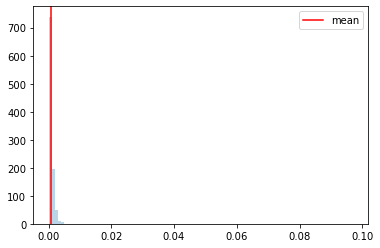

  0%|▏                                                                                | 2/1000 [00:00<00:50, 19.86it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654379054
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 10.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:29, 11.12it/s]

Monte Carlo 3
Monte Carlo 4
Monte Carlo 5


  1%|▌                                                                                | 7/1000 [00:00<02:16,  7.27it/s]

Monte Carlo 6
Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:01<02:05,  7.88it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 11/1000 [00:01<01:59,  8.25it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<01:57,  8.43it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<01:57,  8.41it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:02<01:53,  8.63it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<01:47,  9.09it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<02:00,  8.10it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:53,  8.57it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<01:50,  8.85it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<01:49,  8.93it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:08,  7.57it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:05,  7.72it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:04<02:04,  7.75it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<01:56,  8.31it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<01:54,  8.42it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<01:54,  8.36it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<01:57,  8.14it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<01:54,  8.36it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:54,  8.34it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:55,  8.26it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:55,  8.20it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<01:54,  8.28it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<01:55,  8.23it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:50,  8.53it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<01:50,  8.53it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<01:55,  8.18it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:51,  8.42it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<01:50,  8.44it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<01:50,  8.48it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<01:49,  8.54it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<01:45,  8.79it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<01:45,  8.79it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<01:50,  8.40it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<01:53,  8.12it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<01:50,  8.32it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<01:55,  7.99it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:09<02:02,  7.50it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<01:58,  7.74it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<01:55,  7.93it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<01:56,  7.86it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:10<01:56,  7.84it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:04,  7.29it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:09,  7.03it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<02:09,  7.01it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:11<02:08,  7.05it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:06,  7.10it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:07,  7.03it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:12<02:06,  7.09it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:05,  7.16it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:00,  7.40it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:02,  7.27it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:13<02:05,  7.11it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:06,  7.04it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:11,  6.71it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:14<02:06,  6.99it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:10,  6.76it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:09,  6.77it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<02:01,  7.24it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:15<01:59,  7.31it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<01:54,  7.61it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<01:59,  7.27it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:16<01:57,  7.42it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▍                                                                    | 132/1000 [00:16<01:58,  7.31it/s]

Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:17<02:14,  6.46it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:17<02:04,  6.96it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:17<01:59,  7.23it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:18<01:56,  7.41it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:18<01:58,  7.24it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:18<02:01,  7.07it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:18<02:02,  6.98it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:19<01:58,  7.21it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:19<02:01,  6.97it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:19<02:05,  6.75it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:20<02:05,  6.73it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:20<02:01,  6.97it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:20<02:05,  6.73it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:21<02:04,  6.75it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:21<02:04,  6.75it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:21<02:07,  6.55it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:21<02:10,  6.38it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:22<02:10,  6.40it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:22<02:10,  6.35it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:22<02:08,  6.45it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:23<02:09,  6.40it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:23<02:08,  6.42it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:23<02:13,  6.14it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:24<02:13,  6.12it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:24<02:07,  6.42it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:24<02:00,  6.76it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:25<01:56,  6.96it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:25<02:01,  6.70it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:25<02:01,  6.67it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:25<02:00,  6.72it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:26<02:05,  6.43it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:26<02:04,  6.44it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:26<02:03,  6.49it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:27<02:04,  6.41it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:27<02:05,  6.35it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:27<02:05,  6.36it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:28<02:04,  6.36it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:28<02:05,  6.32it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:28<02:02,  6.43it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:29<02:07,  6.20it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:29<02:08,  6.10it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:29<02:08,  6.11it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:30<02:04,  6.30it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:30<02:02,  6.38it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:30<02:07,  6.12it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:31<02:03,  6.26it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:31<02:07,  6.07it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:31<02:04,  6.19it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:32<02:05,  6.16it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:32<02:07,  6.01it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:32<02:07,  5.99it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:33<02:08,  5.95it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:33<02:09,  5.88it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:33<02:03,  6.18it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:33<02:02,  6.19it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:34<02:01,  6.22it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:34<02:08,  5.89it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:34<02:11,  5.75it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:35<02:10,  5.77it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:35<02:14,  5.56it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:35<02:11,  5.68it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:35<02:09,  5.75it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:36<02:08,  5.80it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:36<02:11,  5.68it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:36<02:09,  5.72it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:37<02:16,  5.42it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:37<02:15,  5.45it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:37<02:13,  5.51it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:37<02:18,  5.33it/s]

Monte Carlo 263
Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:38<02:19,  5.27it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:38<02:22,  5.13it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:39<02:38,  4.62it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:39<02:28,  4.89it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:39<02:30,  4.84it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:40<02:27,  4.92it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:40<02:27,  4.92it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:40<02:24,  5.00it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:40<02:22,  5.07it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:40<02:17,  5.24it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:41<02:16,  5.26it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:41<02:20,  5.11it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:41<02:21,  5.06it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:41<02:17,  5.22it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:42<02:16,  5.25it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:42<02:19,  5.10it/s]

Monte Carlo 286
Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:42<02:20,  5.05it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:43<02:21,  5.00it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:43<02:22,  4.97it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:43<02:24,  4.90it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:43<02:20,  5.04it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:44<02:18,  5.07it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:44<02:15,  5.19it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:44<02:16,  5.16it/s]

Monte Carlo 296
Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:44<02:21,  4.95it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:45<02:46,  4.21it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:45<02:50,  4.11it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:45<02:46,  4.20it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:45<02:50,  4.08it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:46<02:49,  4.12it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:46<02:44,  4.23it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:46<02:36,  4.44it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:46<02:31,  4.57it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:47<02:27,  4.68it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:47<02:24,  4.79it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:47<02:31,  4.56it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:48<02:24,  4.74it/s]

Monte Carlo 312
Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:48<02:22,  4.81it/s]

Monte Carlo 314
Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:48<02:27,  4.64it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:49<02:25,  4.69it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:49<02:22,  4.78it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:49<02:21,  4.80it/s]

Monte Carlo 320
Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:50<02:22,  4.74it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:50<02:22,  4.73it/s]

Monte Carlo 323
Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:50<02:19,  4.83it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:50<02:21,  4.77it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:51<02:20,  4.80it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:51<02:16,  4.92it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:51<02:14,  5.00it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:51<02:13,  5.02it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:52<02:12,  5.05it/s]

Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:52<02:12,  5.05it/s]

Monte Carlo 332
Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:52<02:13,  4.99it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:52<02:15,  4.90it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▋                                                    | 338/1000 [00:53<02:17,  4.83it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:53<02:16,  4.84it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:53<02:14,  4.91it/s]

Monte Carlo 339
Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:54<02:21,  4.67it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 343/1000 [00:54<02:18,  4.73it/s]

Monte Carlo 342
Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:54<02:22,  4.61it/s]

Monte Carlo 344


 35%|███████████████████████████▎                                                   | 346/1000 [00:55<02:18,  4.71it/s]

Monte Carlo 345


 35%|███████████████████████████▍                                                   | 347/1000 [00:55<02:16,  4.77it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 348/1000 [00:55<02:16,  4.78it/s]

Monte Carlo 347


 35%|███████████████████████████▌                                                   | 349/1000 [00:55<02:12,  4.91it/s]

Monte Carlo 348


 35%|███████████████████████████▋                                                   | 350/1000 [00:55<02:11,  4.95it/s]

Monte Carlo 349
Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:56<02:15,  4.78it/s]

Monte Carlo 351


 35%|███████████████████████████▉                                                   | 353/1000 [00:56<02:16,  4.74it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 354/1000 [00:56<02:15,  4.78it/s]

Monte Carlo 353
Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [00:56<02:18,  4.66it/s]

Monte Carlo 355


 36%|████████████████████████████▏                                                  | 357/1000 [00:57<02:18,  4.65it/s]

Monte Carlo 356
Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [00:57<02:17,  4.66it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [00:57<02:23,  4.48it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [00:58<02:25,  4.40it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [00:58<02:25,  4.40it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [00:58<02:23,  4.46it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [00:58<02:23,  4.42it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [00:59<02:21,  4.49it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [00:59<02:23,  4.43it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [00:59<02:20,  4.51it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [00:59<02:19,  4.54it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [00:59<02:17,  4.59it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:00<02:18,  4.56it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:00<02:21,  4.45it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:00<02:20,  4.46it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:00<02:22,  4.40it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:01<02:24,  4.34it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:01<02:28,  4.20it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:01<02:33,  4.08it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:01<02:35,  4.00it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:02<02:36,  3.98it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:02<02:38,  3.94it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:02<02:39,  3.90it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:02<02:40,  3.87it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:03<02:39,  3.88it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:03<02:38,  3.91it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:03<02:32,  4.05it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:03<02:27,  4.18it/s]

Monte Carlo 384


 39%|██████████████████████████████▍                                                | 386/1000 [01:04<02:15,  4.52it/s]

Monte Carlo 385
Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:04<02:22,  4.31it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:04<02:17,  4.46it/s]

Monte Carlo 388


 39%|██████████████████████████████▊                                                | 390/1000 [01:05<02:11,  4.63it/s]

Monte Carlo 389
Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:05<02:11,  4.61it/s]

Monte Carlo 391


 39%|███████████████████████████████                                                | 393/1000 [01:05<02:11,  4.61it/s]

Monte Carlo 392
Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:05<02:15,  4.46it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:06<02:14,  4.50it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 397/1000 [01:06<02:12,  4.56it/s]

Monte Carlo 396
Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:06<02:13,  4.50it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 400/1000 [01:07<02:13,  4.49it/s]

Monte Carlo 399
Monte Carlo 400


 40%|███████████████████████████████▊                                               | 402/1000 [01:07<02:11,  4.56it/s]

Monte Carlo 401
Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:07<02:13,  4.47it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:08<02:15,  4.39it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:08<02:16,  4.36it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:08<02:14,  4.41it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:08<02:12,  4.49it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:09<02:11,  4.51it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:09<02:09,  4.55it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:09<02:30,  3.92it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:09<02:24,  4.06it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:10<02:21,  4.16it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:10<02:18,  4.24it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:10<02:15,  4.34it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:10<02:13,  4.37it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:11<02:15,  4.30it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:11<02:15,  4.31it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:11<02:18,  4.19it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:11<02:19,  4.17it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:12<02:19,  4.15it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:12<02:16,  4.23it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:12<02:13,  4.32it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:12<02:12,  4.34it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:12<02:12,  4.33it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:13<02:10,  4.42it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:13<02:11,  4.35it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:13<02:10,  4.40it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:13<02:10,  4.40it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:14<02:08,  4.45it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:14<02:11,  4.35it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:14<02:10,  4.37it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:14<02:11,  4.31it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:14<02:10,  4.35it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:15<02:08,  4.39it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:15<02:08,  4.39it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:15<02:08,  4.38it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:15<02:12,  4.25it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:16<02:19,  4.02it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:16<02:16,  4.10it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:16<02:15,  4.13it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:16<02:15,  4.11it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:17<02:18,  4.02it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:17<02:16,  4.07it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:17<02:15,  4.09it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:17<02:14,  4.11it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:18<02:14,  4.12it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:18<02:13,  4.14it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:18<02:10,  4.24it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:18<02:09,  4.25it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:19<02:11,  4.20it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:19<02:09,  4.25it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:19<02:13,  4.09it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:19<02:10,  4.20it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:20<02:14,  4.07it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:20<02:17,  3.97it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:20<02:16,  3.99it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:20<02:16,  3.97it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:21<02:15,  3.99it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:21<02:12,  4.07it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:21<02:16,  3.96it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:21<02:15,  3.97it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:22<02:11,  4.08it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:22<02:12,  4.07it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:22<02:10,  4.10it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:22<02:12,  4.05it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:23<02:11,  4.07it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:23<02:10,  4.10it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:23<02:08,  4.13it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:23<02:10,  4.07it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:23<02:10,  4.07it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:24<02:10,  4.07it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:24<02:12,  3.97it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:24<02:13,  3.96it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:25<02:10,  4.03it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:25<02:13,  3.94it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:25<02:10,  4.01it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:25<02:07,  4.09it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:25<02:08,  4.06it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:26<02:13,  3.90it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:26<02:29,  3.49it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:26<02:27,  3.53it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:27<02:21,  3.65it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:27<02:22,  3.63it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:27<02:22,  3.62it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:27<02:21,  3.64it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:28<02:15,  3.79it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:28<02:11,  3.91it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:28<02:07,  4.01it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:28<02:05,  4.09it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:29<02:04,  4.11it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:29<02:08,  3.96it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:29<02:06,  4.02it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:29<02:09,  3.93it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:30<02:07,  3.97it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:30<02:09,  3.91it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:30<02:05,  4.03it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:30<02:07,  3.94it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:31<02:07,  3.93it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:31<02:09,  3.86it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:31<02:10,  3.82it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:32<02:12,  3.77it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:32<02:10,  3.82it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:32<02:07,  3.89it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:32<02:05,  3.95it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:33<02:08,  3.86it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:33<02:11,  3.75it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:33<02:14,  3.67it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:33<02:13,  3.69it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:34<02:11,  3.74it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:34<02:09,  3.78it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:34<02:10,  3.75it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:34<02:08,  3.80it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:35<02:07,  3.83it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:35<02:05,  3.87it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:35<02:06,  3.83it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:35<02:07,  3.81it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:36<02:04,  3.87it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:36<02:02,  3.92it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:36<02:04,  3.87it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:36<02:03,  3.89it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:37<02:03,  3.87it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:37<02:06,  3.79it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:37<02:06,  3.77it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:38<02:10,  3.65it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:38<02:07,  3.72it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:38<02:07,  3.73it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:38<02:06,  3.75it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:39<02:05,  3.75it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:39<02:05,  3.77it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:39<02:08,  3.64it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:39<02:08,  3.66it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:40<02:05,  3.73it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:40<02:04,  3.74it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:40<02:04,  3.75it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:41<02:01,  3.82it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:41<02:04,  3.73it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:41<02:07,  3.63it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:41<02:04,  3.71it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:42<02:06,  3.65it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:42<02:03,  3.73it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:42<02:02,  3.76it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:42<02:02,  3.74it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:43<02:03,  3.69it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:43<02:04,  3.65it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:43<02:19,  3.27it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:44<02:13,  3.39it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:44<02:11,  3.44it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:44<02:07,  3.54it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:44<02:04,  3.62it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:45<02:03,  3.66it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:45<02:04,  3.61it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:45<02:03,  3.61it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:46<02:01,  3.69it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:46<02:01,  3.68it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:46<02:01,  3.66it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:46<02:00,  3.69it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:47<02:00,  3.69it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:47<01:59,  3.70it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:47<02:02,  3.60it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:47<02:01,  3.61it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:48<02:04,  3.53it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:48<02:01,  3.61it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:48<01:58,  3.69it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:48<01:54,  3.81it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:49<01:53,  3.84it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:49<01:50,  3.93it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:49<01:53,  3.81it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:50<01:54,  3.78it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:50<01:54,  3.76it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:50<01:51,  3.85it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:50<01:49,  3.93it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:51<01:51,  3.85it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:51<01:50,  3.86it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:51<01:51,  3.81it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:51<01:50,  3.85it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:52<01:52,  3.77it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:52<01:49,  3.86it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:52<01:46,  3.95it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:52<01:47,  3.92it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:53<01:51,  3.76it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:53<01:52,  3.73it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:53<01:49,  3.81it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:53<01:53,  3.69it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:54<01:50,  3.76it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:54<01:48,  3.84it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [01:54<01:48,  3.83it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [01:54<01:46,  3.87it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [01:55<01:48,  3.81it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [01:55<01:48,  3.80it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [01:55<01:48,  3.78it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [01:56<01:51,  3.67it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [01:56<01:53,  3.60it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [01:56<01:52,  3.61it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [01:56<01:49,  3.72it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [01:57<01:49,  3.71it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [01:57<01:47,  3.74it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [01:57<01:46,  3.77it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [01:57<01:47,  3.75it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [01:58<01:47,  3.74it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [01:58<01:47,  3.71it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [01:58<01:49,  3.65it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [01:59<01:51,  3.58it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [01:59<01:52,  3.53it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [01:59<01:52,  3.51it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [01:59<01:54,  3.46it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:00<01:54,  3.43it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:00<01:57,  3.35it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:00<01:55,  3.39it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:01<01:55,  3.40it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:01<01:53,  3.43it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:01<01:54,  3.40it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:02<01:53,  3.42it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:02<01:54,  3.39it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:02<01:52,  3.43it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:02<01:52,  3.43it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:03<01:54,  3.36it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:03<01:54,  3.33it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:03<01:53,  3.36it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:04<01:55,  3.30it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:04<01:53,  3.33it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:04<01:55,  3.29it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:05<01:55,  3.27it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:05<01:56,  3.23it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:05<01:54,  3.28it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:06<01:58,  3.16it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:06<01:57,  3.18it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:06<01:55,  3.23it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:06<01:55,  3.22it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:07<01:56,  3.19it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:07<01:55,  3.21it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:07<01:57,  3.14it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:08<01:55,  3.19it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:08<01:55,  3.19it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:08<01:54,  3.21it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:09<01:51,  3.28it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:09<01:50,  3.28it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:09<01:50,  3.29it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:10<01:49,  3.29it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:10<01:50,  3.27it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:10<01:49,  3.28it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:10<01:50,  3.25it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:11<01:48,  3.31it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:11<01:51,  3.21it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:11<01:52,  3.16it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:12<01:49,  3.23it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:12<01:49,  3.22it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:12<01:49,  3.23it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:13<01:49,  3.22it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:13<01:46,  3.29it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:13<01:46,  3.28it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:14<01:48,  3.22it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:14<01:50,  3.16it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:14<01:53,  3.05it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:15<01:52,  3.07it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:15<01:50,  3.12it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:15<01:50,  3.12it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:16<01:59,  2.86it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:16<01:53,  3.01it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:16<01:49,  3.11it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:17<01:49,  3.11it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:17<01:50,  3.06it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:17<01:50,  3.06it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:17<01:48,  3.09it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:18<01:50,  3.03it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:18<01:48,  3.09it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:18<01:45,  3.15it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:19<01:47,  3.09it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:19<01:47,  3.10it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:19<01:45,  3.14it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:20<01:44,  3.15it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:20<01:44,  3.14it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:20<01:44,  3.15it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:21<01:44,  3.13it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:21<01:44,  3.11it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:21<01:43,  3.14it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:22<01:44,  3.11it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:22<01:43,  3.13it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:22<01:41,  3.16it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:23<01:42,  3.14it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:23<01:45,  3.05it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:23<01:43,  3.07it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:24<01:44,  3.05it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:24<01:43,  3.05it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:24<01:42,  3.07it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:25<01:43,  3.05it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:25<01:42,  3.06it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:25<01:42,  3.04it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:26<01:41,  3.07it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:26<01:40,  3.09it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:26<01:41,  3.07it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:27<01:42,  3.02it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:27<01:42,  3.01it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:27<01:39,  3.07it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:28<01:40,  3.04it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:28<01:40,  3.04it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:28<01:40,  3.04it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:29<01:41,  2.99it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:29<01:40,  3.00it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:29<01:41,  2.97it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:30<01:40,  2.99it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:30<01:39,  3.01it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:30<01:41,  2.94it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:31<01:43,  2.88it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:31<01:39,  2.96it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:31<01:38,  2.98it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:32<01:37,  3.02it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:32<01:36,  3.05it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:32<01:36,  3.03it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:33<01:35,  3.05it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:33<01:33,  3.10it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:33<01:33,  3.10it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:33<01:32,  3.11it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:34<01:32,  3.09it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:34<01:35,  3.00it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:34<01:34,  3.03it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:35<01:35,  2.97it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:35<01:33,  3.01it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:35<01:34,  3.00it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:36<01:34,  2.98it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:36<01:34,  2.96it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:37<01:33,  2.99it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:37<01:31,  3.05it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:37<01:32,  3.00it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:38<01:33,  2.96it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:38<01:32,  2.96it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:38<01:35,  2.87it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:39<01:33,  2.91it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:39<01:32,  2.95it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:39<01:30,  2.99it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:40<01:29,  3.02it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:40<01:30,  2.97it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:40<01:30,  2.96it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:41<01:31,  2.91it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:41<01:31,  2.91it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:41<01:29,  2.95it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:42<01:33,  2.83it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:42<01:31,  2.88it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:42<01:30,  2.89it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:43<01:29,  2.90it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:43<01:37,  2.67it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:43<01:33,  2.77it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:44<01:32,  2.80it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:44<01:30,  2.84it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:44<01:30,  2.82it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:45<01:30,  2.83it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:45<01:29,  2.83it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:46<01:29,  2.82it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:46<01:27,  2.88it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:46<01:27,  2.88it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:47<01:26,  2.88it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:47<01:27,  2.83it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:47<01:26,  2.86it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:48<01:25,  2.90it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:48<01:24,  2.90it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:48<01:23,  2.92it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:49<01:23,  2.92it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:49<01:22,  2.96it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:49<01:19,  3.04it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:50<01:18,  3.05it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:50<01:19,  3.02it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:50<01:19,  3.02it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:51<01:18,  3.04it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:51<01:17,  3.05it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:51<01:17,  3.05it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:52<01:17,  3.03it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:52<01:16,  3.05it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [02:52<01:16,  3.05it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [02:53<01:15,  3.07it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [02:53<01:15,  3.06it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [02:53<01:15,  3.05it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [02:54<01:18,  2.93it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [02:54<01:16,  2.97it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [02:54<01:15,  3.00it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [02:55<01:15,  2.98it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [02:55<01:16,  2.93it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [02:55<01:17,  2.88it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [02:56<01:18,  2.85it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [02:56<01:19,  2.80it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [02:56<01:17,  2.83it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [02:57<01:16,  2.87it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [02:57<01:18,  2.79it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [02:57<01:17,  2.82it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [02:58<01:16,  2.85it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [02:58<01:15,  2.84it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [02:58<01:14,  2.88it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [02:59<01:14,  2.89it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [02:59<01:13,  2.88it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:00<01:14,  2.83it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:00<01:13,  2.86it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:00<01:13,  2.86it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:01<01:12,  2.87it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:01<01:13,  2.84it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:01<01:12,  2.84it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:02<01:12,  2.86it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:02<01:12,  2.84it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:02<01:11,  2.86it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:03<01:11,  2.82it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:03<01:12,  2.77it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:03<01:12,  2.77it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:04<01:12,  2.78it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:04<01:10,  2.81it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:04<01:09,  2.83it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:05<01:09,  2.82it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:05<01:10,  2.78it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:06<01:09,  2.82it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:06<01:09,  2.79it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:06<01:10,  2.76it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:07<01:10,  2.72it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:07<01:09,  2.76it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:07<01:08,  2.78it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:08<01:07,  2.79it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:08<01:07,  2.80it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:08<01:06,  2.81it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:09<01:05,  2.84it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:09<01:05,  2.82it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:10<01:06,  2.79it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:10<01:07,  2.72it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:10<01:08,  2.66it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:11<01:07,  2.69it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:11<01:06,  2.71it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:11<01:05,  2.75it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:12<01:05,  2.71it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:12<01:04,  2.74it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:12<01:03,  2.77it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:13<01:04,  2.72it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:13<01:03,  2.75it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:14<01:02,  2.77it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:14<01:01,  2.79it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:14<01:00,  2.81it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:15<01:00,  2.81it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:15<01:00,  2.78it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:15<01:01,  2.73it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:16<00:59,  2.83it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:16<00:58,  2.82it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:16<00:57,  2.88it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:17<00:56,  2.89it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:17<00:57,  2.82it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:17<00:56,  2.88it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:18<01:00,  2.65it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:18<00:59,  2.69it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:19<00:59,  2.65it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:19<00:57,  2.74it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:19<00:56,  2.79it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:20<00:55,  2.80it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:20<00:55,  2.79it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:20<00:56,  2.74it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:21<00:55,  2.76it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:21<00:54,  2.79it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:21<00:54,  2.79it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:22<00:55,  2.70it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:22<00:54,  2.72it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:23<00:54,  2.74it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:23<00:53,  2.74it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:23<00:53,  2.74it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:24<00:53,  2.72it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:24<00:53,  2.69it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:24<00:54,  2.61it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:25<00:53,  2.67it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:25<00:54,  2.61it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:26<00:54,  2.55it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:26<00:53,  2.62it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:26<00:52,  2.64it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:27<00:50,  2.69it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:27<00:51,  2.65it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:28<00:51,  2.61it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:28<00:50,  2.65it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:28<00:50,  2.63it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:29<00:49,  2.69it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:29<00:49,  2.64it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:29<00:50,  2.59it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:30<00:49,  2.62it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:30<00:48,  2.62it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:31<00:48,  2.62it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:31<00:48,  2.62it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:31<00:47,  2.65it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:32<00:47,  2.62it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:32<00:47,  2.60it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:32<00:46,  2.62it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:33<00:45,  2.63it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:33<00:46,  2.56it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:34<00:45,  2.60it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:34<00:44,  2.62it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:34<00:44,  2.65it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:35<00:43,  2.68it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:35<00:43,  2.65it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:35<00:43,  2.60it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:36<00:43,  2.61it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:36<00:42,  2.63it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:37<00:42,  2.62it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:37<00:41,  2.65it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:37<00:42,  2.59it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:38<00:42,  2.55it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:38<00:41,  2.59it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:39<00:41,  2.58it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:39<00:40,  2.58it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:39<00:40,  2.54it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:40<00:39,  2.59it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:40<00:40,  2.54it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:41<00:40,  2.51it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:41<00:38,  2.60it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:41<00:38,  2.57it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:42<00:37,  2.60it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:42<00:38,  2.55it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:42<00:37,  2.56it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:43<00:36,  2.62it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:43<00:36,  2.56it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:44<00:35,  2.63it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:44<00:34,  2.65it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:44<00:34,  2.61it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:45<00:34,  2.60it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:45<00:33,  2.64it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:46<00:32,  2.67it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:46<00:32,  2.68it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:46<00:31,  2.72it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:47<00:31,  2.72it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:47<00:31,  2.67it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:47<00:31,  2.67it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:48<00:31,  2.64it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:48<00:31,  2.58it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:49<00:31,  2.58it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:49<00:30,  2.56it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:49<00:31,  2.51it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [03:50<00:30,  2.52it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [03:50<00:29,  2.53it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [03:51<00:31,  2.37it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [03:51<00:30,  2.46it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [03:51<00:30,  2.42it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [03:52<00:29,  2.44it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [03:52<00:28,  2.51it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [03:53<00:28,  2.50it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [03:53<00:27,  2.51it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [03:53<00:27,  2.48it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [03:54<00:27,  2.45it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [03:54<00:26,  2.47it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [03:55<00:26,  2.47it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [03:55<00:25,  2.47it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [03:55<00:25,  2.52it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [03:56<00:24,  2.50it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [03:56<00:25,  2.43it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [03:57<00:24,  2.42it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [03:57<00:24,  2.43it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [03:57<00:23,  2.44it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [03:58<00:22,  2.49it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [03:58<00:22,  2.46it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [03:59<00:22,  2.44it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [03:59<00:22,  2.45it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:00<00:21,  2.47it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:00<00:20,  2.50it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:00<00:20,  2.52it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:01<00:20,  2.47it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:01<00:19,  2.50it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:02<00:19,  2.41it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:02<00:19,  2.39it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:02<00:19,  2.39it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:03<00:18,  2.42it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:03<00:18,  2.40it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:04<00:17,  2.42it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:04<00:17,  2.38it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:04<00:16,  2.43it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:05<00:16,  2.43it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:05<00:16,  2.44it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:06<00:15,  2.40it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:06<00:15,  2.40it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:07<00:15,  2.39it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:07<00:14,  2.42it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:07<00:13,  2.46it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:08<00:13,  2.43it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:08<00:12,  2.46it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:09<00:12,  2.42it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:09<00:12,  2.37it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:09<00:12,  2.37it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:10<00:12,  2.29it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:10<00:11,  2.30it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:11<00:11,  2.32it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:11<00:10,  2.34it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:12<00:10,  2.34it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:12<00:09,  2.37it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:12<00:09,  2.34it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:13<00:08,  2.41it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:13<00:08,  2.40it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:14<00:07,  2.42it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:14<00:07,  2.48it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:14<00:06,  2.52it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:15<00:06,  2.46it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:15<00:05,  2.51it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:16<00:05,  2.48it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:16<00:05,  2.52it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:16<00:04,  2.52it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:17<00:04,  2.48it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:17<00:04,  2.50it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:18<00:03,  2.43it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:18<00:03,  2.43it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:19<00:02,  2.45it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:19<00:02,  2.40it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:19<00:02,  2.39it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:20<00:01,  2.36it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:20<00:01,  2.38it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:21<00:00,  2.38it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:21<00:00,  2.38it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:21<00:00,  3.82it/s]


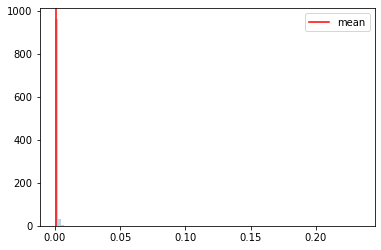

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654379317
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 10.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:08, 14.46it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:36, 10.34it/s]

Monte Carlo 5
Monte Carlo 6

  1%|▌                                                                                | 7/1000 [00:00<01:57,  8.44it/s]


Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:01<01:58,  8.37it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 11/1000 [00:01<01:57,  8.41it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<01:58,  8.30it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<02:00,  8.19it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:01<01:51,  8.79it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 20/1000 [00:02<01:51,  8.79it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<01:55,  8.44it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:51,  8.77it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<01:47,  9.10it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<01:59,  8.18it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:02,  7.90it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:39,  6.08it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:04<02:18,  6.99it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<02:03,  7.83it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<01:58,  8.14it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<02:08,  7.50it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:05<02:01,  7.88it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<02:03,  7.72it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:58,  8.07it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:03,  7.71it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:06<02:13,  7.10it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:00,  7.86it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:01,  7.78it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:58,  7.94it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<02:02,  7.72it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:03,  7.61it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:01,  7.76it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:02,  7.62it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:06,  7.41it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:10,  7.17it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:04,  7.49it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:09<02:01,  7.65it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:15,  6.86it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:11,  7.03it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:07,  7.24it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:04,  7.40it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:08,  7.13it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:12,  6.95it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:11<02:15,  6.76it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:17,  6.64it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:10,  6.99it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:05,  7.23it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:11,  6.91it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:12,  6.81it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:05,  7.20it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:13<02:10,  6.91it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:11,  6.83it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:10,  6.89it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:09,  6.89it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:07,  6.98it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:09,  6.86it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:11,  6.74it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<02:14,  6.58it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:09,  6.83it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:12,  6.65it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:16<02:33,  5.74it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:32,  5.77it/s]

Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:16<02:24,  6.10it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:16<02:22,  6.14it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:17<02:15,  6.44it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:17<02:16,  6.38it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:17<02:17,  6.34it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:18<02:17,  6.29it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:18<02:17,  6.29it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:18<02:11,  6.59it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:19<02:07,  6.74it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:19<02:07,  6.73it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:19<02:15,  6.34it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:20<02:13,  6.41it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:20<02:11,  6.48it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:20<02:09,  6.57it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:20<02:12,  6.42it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:21<02:09,  6.54it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:21<02:07,  6.62it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:21<02:26,  5.77it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:22<02:23,  5.88it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:22<02:13,  6.31it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:10,  6.43it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:23<02:10,  6.39it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:23<02:10,  6.41it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:15,  6.16it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:24<02:26,  5.67it/s]

Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:26,  5.68it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:31,  5.47it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:25<02:26,  5.65it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:25<02:23,  5.75it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:19,  5.89it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:26<02:13,  6.14it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:26<02:13,  6.11it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:08,  6.35it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:27<02:08,  6.33it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:27<02:13,  6.08it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:09,  6.26it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:28<02:09,  6.22it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:28<02:13,  6.01it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:28<02:12,  6.05it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:29<02:18,  5.78it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:14,  5.93it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:29<02:19,  5.70it/s]

Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:19,  5.72it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:14,  5.88it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:16,  5.81it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:31<02:14,  5.87it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:31<02:19,  5.65it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:16,  5.77it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:12,  5.93it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:32<02:14,  5.80it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:13,  5.85it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:19,  5.60it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:22,  5.48it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:33<02:17,  5.68it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:25,  5.33it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:33<02:19,  5.55it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:34<02:17,  5.62it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:34<02:13,  5.78it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:13,  5.79it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:18,  5.56it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:20,  5.43it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:22,  5.35it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:17,  5.56it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:18,  5.50it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:17,  5.52it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:18,  5.47it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:18,  5.47it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:14,  5.61it/s]

Monte Carlo 243
Monte Carlo 244


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:19,  5.40it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:19,  5.41it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:16,  5.50it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:14,  5.57it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:14,  5.56it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:38<02:26,  5.12it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:38<02:23,  5.20it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:19,  5.33it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:14,  5.51it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:39<02:19,  5.31it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:25,  5.10it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:26,  5.04it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:40<02:23,  5.13it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:24,  5.09it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:22,  5.18it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:19,  5.27it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:41<02:22,  5.15it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:16,  5.36it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:21,  5.16it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:19,  5.24it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:15,  5.38it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:42<02:11,  5.53it/s]

Monte Carlo 272
Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:42<02:18,  5.24it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:16,  5.31it/s]

Monte Carlo 275
Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:16,  5.28it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:43<02:15,  5.32it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:43<02:18,  5.20it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:44<02:19,  5.15it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:17,  5.20it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:17,  5.20it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:44<02:14,  5.32it/s]

Monte Carlo 283
Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:45<02:14,  5.31it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:20,  5.06it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:24,  4.91it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:45<02:25,  4.87it/s]

Monte Carlo 289
Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:46<02:29,  4.74it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:23,  4.94it/s]

Monte Carlo 292
Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:46<02:23,  4.93it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:22,  4.93it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:47<02:26,  4.80it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:47<02:23,  4.89it/s]

Monte Carlo 298
Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:47<02:27,  4.76it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:48<02:22,  4.90it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:48<02:23,  4.87it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:48<02:21,  4.93it/s]

Monte Carlo 303
Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:49<02:34,  4.49it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:49<02:30,  4.62it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:49<02:27,  4.70it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:49<02:28,  4.66it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:50<02:23,  4.81it/s]

Monte Carlo 310
Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:50<02:25,  4.73it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:50<02:20,  4.90it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:15,  5.06it/s]

Monte Carlo 314


 32%|█████████████████████████                                                      | 317/1000 [00:51<02:14,  5.07it/s]

Monte Carlo 315
Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:51<02:17,  4.97it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:13,  5.11it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:52<02:07,  5.31it/s]

Monte Carlo 320
Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:52<02:06,  5.35it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:52<02:03,  5.47it/s]

Monte Carlo 323
Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:53<02:05,  5.37it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:53<02:09,  5.22it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:53<02:08,  5.22it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:53<02:07,  5.27it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:53<02:06,  5.28it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:54<02:07,  5.25it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:54<02:08,  5.21it/s]

Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:54<02:08,  5.21it/s]

Monte Carlo 332
Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:54<02:09,  5.12it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:55<02:09,  5.12it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:55<02:12,  5.02it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:55<02:17,  4.80it/s]

Monte Carlo 338
Monte Carlo 339


 34%|██████████████████████████▉                                                    | 341/1000 [00:56<02:18,  4.76it/s]

Monte Carlo 340
Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:56<02:20,  4.69it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:56<02:21,  4.66it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:56<02:24,  4.53it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:57<02:25,  4.51it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:57<02:23,  4.56it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 348/1000 [00:57<02:18,  4.72it/s]

Monte Carlo 347


 35%|███████████████████████████▌                                                   | 349/1000 [00:57<02:15,  4.80it/s]

Monte Carlo 348
Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:58<02:19,  4.67it/s]

Monte Carlo 350


 35%|███████████████████████████▊                                                   | 352/1000 [00:58<02:18,  4.69it/s]

Monte Carlo 351


 35%|███████████████████████████▉                                                   | 353/1000 [00:58<02:16,  4.73it/s]

Monte Carlo 352
Monte Carlo 353


 36%|████████████████████████████                                                   | 355/1000 [00:59<02:18,  4.67it/s]

Monte Carlo 354
Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [00:59<02:22,  4.52it/s]

Monte Carlo 356


 36%|████████████████████████████▎                                                  | 358/1000 [00:59<02:17,  4.66it/s]

Monte Carlo 357
Monte Carlo 358


 36%|████████████████████████████▍                                                  | 360/1000 [01:00<02:13,  4.78it/s]

Monte Carlo 359
Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:00<02:19,  4.57it/s]

Monte Carlo 361


 36%|████████████████████████████▋                                                  | 363/1000 [01:00<02:17,  4.62it/s]

Monte Carlo 362
Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:01<02:17,  4.62it/s]

Monte Carlo 364


 37%|████████████████████████████▉                                                  | 366/1000 [01:01<02:17,  4.62it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 367/1000 [01:01<02:14,  4.71it/s]

Monte Carlo 366
Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:02<02:15,  4.66it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:02<02:14,  4.70it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:02<02:16,  4.63it/s]

Monte Carlo 370


 37%|█████████████████████████████▍                                                 | 372/1000 [01:02<02:16,  4.61it/s]

Monte Carlo 371
Monte Carlo 372


 37%|█████████████████████████████▌                                                 | 374/1000 [01:03<02:13,  4.68it/s]

Monte Carlo 373


 38%|█████████████████████████████▋                                                 | 375/1000 [01:03<02:10,  4.78it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 376/1000 [01:03<02:07,  4.88it/s]

Monte Carlo 375


 38%|█████████████████████████████▊                                                 | 377/1000 [01:03<02:03,  5.05it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 378/1000 [01:04<02:04,  5.01it/s]

Monte Carlo 377
Monte Carlo 378


 38%|██████████████████████████████                                                 | 380/1000 [01:04<02:05,  4.95it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 381/1000 [01:04<02:06,  4.89it/s]

Monte Carlo 380


 38%|██████████████████████████████▏                                                | 382/1000 [01:04<02:05,  4.94it/s]

Monte Carlo 381
Monte Carlo 382


 38%|██████████████████████████████▎                                                | 384/1000 [01:05<02:07,  4.82it/s]

Monte Carlo 383


 38%|██████████████████████████████▍                                                | 385/1000 [01:05<02:07,  4.81it/s]

Monte Carlo 384


 39%|██████████████████████████████▍                                                | 386/1000 [01:05<02:08,  4.77it/s]

Monte Carlo 385
Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:06<02:10,  4.69it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:06<02:09,  4.73it/s]

Monte Carlo 388


 39%|██████████████████████████████▊                                                | 390/1000 [01:06<02:09,  4.71it/s]

Monte Carlo 389
Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:06<02:09,  4.71it/s]

Monte Carlo 391


 39%|███████████████████████████████                                                | 393/1000 [01:07<02:07,  4.76it/s]

Monte Carlo 392
Monte Carlo 393


 40%|███████████████████████████████▏                                               | 395/1000 [01:07<02:09,  4.68it/s]

Monte Carlo 394
Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:07<02:08,  4.72it/s]

Monte Carlo 396


 40%|███████████████████████████████▍                                               | 398/1000 [01:08<02:08,  4.67it/s]

Monte Carlo 397
Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:08<02:10,  4.62it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:08<02:15,  4.43it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:09<02:21,  4.23it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:09<02:21,  4.23it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:09<02:28,  4.01it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:09<02:22,  4.18it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:10<02:18,  4.30it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:10<02:13,  4.44it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:10<02:18,  4.29it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:10<02:19,  4.23it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:11<02:18,  4.26it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:11<02:18,  4.25it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:11<02:16,  4.32it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:11<02:15,  4.33it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:11<02:13,  4.40it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:12<02:12,  4.42it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:12<02:11,  4.44it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:12<02:12,  4.40it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:12<02:10,  4.47it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:13<02:11,  4.43it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:13<02:09,  4.48it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:13<02:08,  4.51it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:13<02:10,  4.42it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:13<02:09,  4.46it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:14<02:14,  4.29it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:14<02:14,  4.28it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:14<02:14,  4.28it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:14<02:11,  4.35it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:15<02:13,  4.29it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:15<02:11,  4.34it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:15<02:15,  4.20it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:15<02:13,  4.28it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:16<02:13,  4.25it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:16<02:10,  4.35it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:16<02:11,  4.30it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:16<02:14,  4.20it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:17<02:16,  4.13it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:17<02:13,  4.23it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:17<02:11,  4.28it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:17<02:32,  3.68it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:18<02:24,  3.89it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:18<02:23,  3.89it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:18<02:18,  4.03it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:18<02:22,  3.92it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:19<02:16,  4.07it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:19<02:16,  4.07it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:19<02:15,  4.09it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:19<02:16,  4.04it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:19<02:13,  4.13it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:20<02:13,  4.12it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:20<02:12,  4.16it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:20<02:15,  4.05it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:20<02:14,  4.09it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:21<02:12,  4.13it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:21<02:08,  4.24it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:21<02:11,  4.15it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:21<02:12,  4.12it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:22<02:10,  4.16it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:22<02:17,  3.96it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:22<02:13,  4.06it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:22<02:11,  4.13it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:23<02:13,  4.06it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:23<02:13,  4.04it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:23<02:11,  4.08it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:23<02:10,  4.10it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:24<02:16,  3.93it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:24<02:15,  3.95it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:24<02:14,  3.98it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:24<02:12,  4.02it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:25<02:12,  4.02it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:25<02:11,  4.05it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:25<02:13,  3.96it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:25<02:09,  4.08it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:26<02:07,  4.14it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:26<02:11,  4.00it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:26<02:10,  4.03it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:26<02:07,  4.10it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:27<02:05,  4.16it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:27<02:09,  4.05it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:27<02:09,  4.04it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:27<02:08,  4.06it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:28<02:09,  4.02it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:28<02:08,  4.05it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:28<02:10,  3.97it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:28<02:11,  3.93it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:29<02:10,  3.96it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:29<02:14,  3.83it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:29<02:16,  3.76it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:29<02:15,  3.79it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:30<02:12,  3.86it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:30<02:10,  3.90it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:30<02:14,  3.79it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:30<02:11,  3.86it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:31<02:15,  3.74it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:31<02:13,  3.80it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:31<02:19,  3.63it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:32<02:12,  3.80it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:32<02:09,  3.88it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:32<02:09,  3.89it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:32<02:03,  4.05it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:33<01:59,  4.20it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:33<01:58,  4.23it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:33<01:57,  4.26it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:33<02:00,  4.12it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:33<01:58,  4.18it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:34<02:00,  4.11it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:34<01:57,  4.21it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:34<01:58,  4.18it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:34<01:56,  4.25it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:35<01:56,  4.23it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:35<02:01,  4.04it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:35<02:02,  4.00it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:35<02:04,  3.92it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:36<02:06,  3.85it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:36<02:08,  3.79it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:36<02:06,  3.84it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:37<02:06,  3.83it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:37<02:03,  3.92it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:37<02:00,  4.00it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:37<01:58,  4.07it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:37<01:57,  4.09it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:38<01:59,  4.00it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:38<02:04,  3.85it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:38<02:02,  3.92it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:39<02:02,  3.90it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:39<02:01,  3.91it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:39<02:02,  3.86it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:39<02:01,  3.90it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:40<02:04,  3.79it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:40<02:05,  3.75it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:40<02:03,  3.81it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:40<02:02,  3.82it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:41<02:02,  3.83it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:41<02:04,  3.75it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:41<02:05,  3.73it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:41<01:59,  3.90it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:42<02:02,  3.80it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:42<02:02,  3.78it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:42<02:01,  3.80it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:42<01:57,  3.93it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:43<01:54,  4.02it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:43<01:56,  3.95it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:43<01:55,  3.97it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:43<01:53,  4.02it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:44<01:53,  4.01it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:44<01:52,  4.06it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:44<01:55,  3.94it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:44<01:54,  3.96it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:45<01:56,  3.88it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:45<02:00,  3.75it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:45<01:59,  3.79it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:45<01:58,  3.81it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:46<01:55,  3.89it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:46<01:54,  3.92it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:46<01:56,  3.85it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:47<02:10,  3.42it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:47<02:06,  3.52it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:47<02:03,  3.61it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:47<02:04,  3.57it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:48<02:07,  3.47it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:48<02:04,  3.54it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:48<02:05,  3.50it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:49<02:09,  3.39it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:49<02:05,  3.49it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:49<02:02,  3.58it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:49<02:01,  3.58it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:50<02:03,  3.53it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:50<02:02,  3.55it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:50<02:01,  3.56it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:51<02:00,  3.57it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:51<02:03,  3.50it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:51<02:06,  3.39it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:51<02:06,  3.40it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:52<02:05,  3.41it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:52<02:06,  3.38it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:52<02:03,  3.45it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:53<02:04,  3.41it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:53<02:03,  3.45it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:53<02:01,  3.47it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:53<02:00,  3.51it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:54<01:57,  3.60it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:54<01:57,  3.58it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:54<01:56,  3.61it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:55<01:59,  3.50it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:55<01:57,  3.56it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:55<01:55,  3.59it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:55<01:55,  3.58it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [01:56<01:59,  3.48it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [01:56<01:56,  3.54it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [01:56<01:56,  3.53it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [01:57<01:55,  3.55it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [01:57<01:56,  3.52it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [01:57<01:55,  3.55it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [01:57<01:57,  3.46it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [01:58<01:58,  3.44it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [01:58<01:56,  3.48it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [01:58<01:55,  3.50it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [01:59<01:53,  3.56it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [01:59<01:52,  3.58it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [01:59<01:54,  3.52it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [01:59<01:58,  3.39it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:00<01:57,  3.42it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:00<01:55,  3.45it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:00<01:53,  3.50it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:01<01:54,  3.47it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:01<01:57,  3.38it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:01<01:58,  3.34it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:02<01:55,  3.42it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:02<01:54,  3.43it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:02<01:52,  3.47it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:02<01:53,  3.43it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:03<01:52,  3.47it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:03<01:52,  3.45it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:03<02:06,  3.08it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:04<02:02,  3.16it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:04<01:58,  3.26it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:04<02:00,  3.21it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:05<01:59,  3.21it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:05<01:56,  3.28it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:05<01:56,  3.28it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:05<01:54,  3.34it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:06<01:50,  3.44it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:06<01:50,  3.44it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:06<01:48,  3.49it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:07<01:47,  3.51it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:07<01:45,  3.57it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:07<01:45,  3.55it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:07<01:44,  3.58it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:08<01:42,  3.65it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:08<01:41,  3.68it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:08<01:40,  3.69it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:08<01:39,  3.72it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:09<01:42,  3.60it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:09<01:47,  3.42it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:09<01:45,  3.49it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:10<01:47,  3.39it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:10<01:46,  3.42it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:10<01:50,  3.30it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:11<01:48,  3.33it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:11<01:48,  3.32it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:11<01:49,  3.30it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:12<01:51,  3.23it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:12<01:50,  3.26it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:12<01:52,  3.17it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:12<01:54,  3.13it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:13<01:51,  3.18it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:13<01:51,  3.19it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:13<01:51,  3.18it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:14<01:50,  3.18it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:14<01:50,  3.18it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:14<01:52,  3.12it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:15<01:48,  3.23it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:15<01:48,  3.21it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:15<01:50,  3.15it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:16<01:50,  3.14it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:16<01:53,  3.05it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:16<01:53,  3.04it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:17<01:54,  3.02it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:17<01:51,  3.07it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:17<02:03,  2.77it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:18<02:00,  2.82it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:18<01:56,  2.92it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:18<01:58,  2.85it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:19<01:53,  2.97it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:19<01:52,  2.99it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:19<01:52,  2.99it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:20<01:53,  2.95it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:20<01:53,  2.95it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:20<01:55,  2.89it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:21<01:49,  3.03it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:21<01:48,  3.06it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:21<01:46,  3.10it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:22<01:44,  3.14it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:22<01:43,  3.18it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:22<01:41,  3.22it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:23<01:39,  3.27it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:23<01:38,  3.29it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:23<01:39,  3.25it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:24<01:39,  3.24it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:24<01:39,  3.25it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:24<01:42,  3.14it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:24<01:41,  3.14it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:25<01:42,  3.12it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:25<01:40,  3.15it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:25<01:40,  3.16it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:26<01:40,  3.14it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:26<01:41,  3.11it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:26<01:40,  3.11it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:27<01:43,  3.01it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:27<01:43,  3.02it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:27<01:41,  3.06it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:28<01:44,  2.96it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:28<01:44,  2.97it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:28<01:42,  2.99it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:29<01:43,  2.97it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:29<01:42,  2.99it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:29<01:40,  3.05it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:30<01:39,  3.05it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:30<01:39,  3.05it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:30<01:37,  3.09it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:31<01:38,  3.04it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:31<01:39,  3.02it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:31<01:37,  3.07it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:32<01:38,  3.01it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:32<01:38,  3.02it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:32<01:41,  2.93it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:33<01:37,  3.01it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:33<01:37,  3.01it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:33<01:35,  3.05it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:34<01:34,  3.07it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:34<01:34,  3.08it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:34<01:34,  3.08it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:35<01:33,  3.09it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:35<01:33,  3.08it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:35<01:35,  3.01it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:36<01:37,  2.94it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:36<01:35,  2.99it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:36<01:33,  3.04it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:37<01:34,  3.00it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:37<01:33,  3.03it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:37<01:33,  3.00it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:38<01:34,  2.97it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:38<01:32,  3.02it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:38<01:32,  3.00it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:39<01:32,  2.99it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:39<01:35,  2.89it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:39<01:35,  2.89it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:40<01:32,  2.96it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:40<01:29,  3.04it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:40<01:29,  3.03it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:41<01:28,  3.05it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:41<01:28,  3.04it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:41<01:29,  2.99it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:42<01:29,  2.98it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:42<01:30,  2.95it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:42<01:31,  2.92it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:43<01:30,  2.92it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:43<01:29,  2.96it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:43<01:28,  2.97it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:44<01:27,  3.00it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:44<01:29,  2.91it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:44<01:28,  2.94it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:45<01:26,  2.99it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:45<01:26,  2.97it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:45<01:28,  2.91it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:46<01:28,  2.88it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:46<01:27,  2.90it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:46<01:27,  2.89it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:47<01:25,  2.96it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:47<01:24,  2.97it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:47<01:24,  2.98it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:48<01:23,  2.99it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:48<01:23,  3.00it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:48<01:23,  2.97it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:49<01:23,  2.95it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:49<01:21,  3.00it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:49<01:21,  3.00it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:50<01:20,  3.02it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:50<01:21,  2.99it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:50<01:20,  3.00it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:51<01:21,  2.96it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:51<01:20,  2.97it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:51<01:20,  2.98it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:52<01:20,  2.97it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:52<01:19,  2.98it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:53<01:20,  2.95it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:53<01:20,  2.93it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:53<01:20,  2.89it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [02:54<01:20,  2.88it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [02:54<01:19,  2.90it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [02:54<01:20,  2.86it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [02:55<01:19,  2.89it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [02:55<01:19,  2.90it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [02:55<01:17,  2.93it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [02:56<01:17,  2.92it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [02:56<01:19,  2.86it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [02:56<01:19,  2.84it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [02:57<01:19,  2.80it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [02:57<01:22,  2.72it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [02:57<01:21,  2.74it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [02:58<01:27,  2.53it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [02:58<01:22,  2.66it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [02:59<01:22,  2.65it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [02:59<01:20,  2.72it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [02:59<01:19,  2.74it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:00<01:17,  2.80it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:00<01:16,  2.81it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:00<01:16,  2.81it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:01<01:15,  2.80it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:01<01:17,  2.74it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:01<01:16,  2.75it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:02<01:14,  2.81it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:02<01:13,  2.84it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:03<01:14,  2.80it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:03<01:13,  2.80it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:03<01:13,  2.80it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:04<01:12,  2.84it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:04<01:12,  2.80it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:04<01:13,  2.75it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:05<01:13,  2.75it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:05<01:13,  2.74it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:05<01:13,  2.73it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:06<01:11,  2.78it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:06<01:11,  2.75it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:07<01:11,  2.74it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:07<01:09,  2.81it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:07<01:11,  2.75it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:08<01:09,  2.79it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:08<01:09,  2.76it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:08<01:09,  2.78it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:09<01:12,  2.64it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:09<01:13,  2.57it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:10<01:17,  2.44it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:10<01:18,  2.41it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:10<01:17,  2.41it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:11<01:16,  2.44it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:11<01:15,  2.45it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:12<01:14,  2.49it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:12<01:14,  2.47it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:12<01:14,  2.46it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:13<01:13,  2.47it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:13<01:11,  2.53it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:14<01:12,  2.47it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:14<01:10,  2.51it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:14<01:09,  2.55it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:15<01:11,  2.47it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:15<01:10,  2.47it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:16<01:11,  2.44it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:16<01:10,  2.44it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:16<01:08,  2.52it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:17<01:08,  2.50it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:17<01:07,  2.50it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:18<01:06,  2.53it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:18<01:05,  2.57it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:19<01:09,  2.42it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:19<01:07,  2.44it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:19<01:10,  2.35it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:20<01:10,  2.31it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:20<01:12,  2.25it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:21<01:08,  2.35it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:21<01:04,  2.51it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:21<01:00,  2.62it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:22<00:59,  2.66it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:22<00:58,  2.69it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:22<00:57,  2.72it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:23<00:57,  2.72it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:23<00:58,  2.63it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:24<00:58,  2.63it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:24<00:59,  2.59it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:24<00:57,  2.65it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:25<00:58,  2.58it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:25<00:57,  2.61it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:26<00:58,  2.53it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:26<00:58,  2.55it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:26<00:56,  2.59it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:27<00:56,  2.59it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:27<00:56,  2.55it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:28<00:57,  2.52it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:28<00:56,  2.53it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:28<00:56,  2.52it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:29<00:55,  2.53it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:29<00:55,  2.53it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:29<00:53,  2.58it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:30<00:55,  2.51it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:30<00:54,  2.52it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:31<00:55,  2.45it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:31<00:56,  2.38it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:32<00:56,  2.39it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:32<00:55,  2.41it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:32<00:54,  2.42it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:33<00:53,  2.46it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:33<00:56,  2.30it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:34<00:55,  2.34it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:34<00:55,  2.29it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:35<00:54,  2.34it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:35<00:53,  2.34it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:35<00:53,  2.36it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:36<00:52,  2.35it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:36<00:52,  2.36it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:37<00:50,  2.41it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:37<00:49,  2.43it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:37<00:48,  2.46it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:38<00:47,  2.49it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:38<00:48,  2.42it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:39<00:48,  2.41it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:39<00:49,  2.36it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:40<00:49,  2.31it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:40<00:48,  2.36it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:40<00:47,  2.39it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:41<00:46,  2.39it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:41<00:45,  2.41it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:42<00:44,  2.44it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:42<00:46,  2.35it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:43<00:47,  2.29it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:43<00:46,  2.30it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:43<00:45,  2.32it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:44<00:44,  2.38it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:44<00:44,  2.35it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:45<00:46,  2.21it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:45<00:45,  2.22it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:46<00:45,  2.24it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:46<00:44,  2.24it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:47<00:44,  2.22it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:47<00:42,  2.29it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:47<00:41,  2.33it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:48<00:41,  2.34it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:48<00:40,  2.35it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:49<00:40,  2.34it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:49<00:39,  2.33it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:50<00:40,  2.29it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:50<00:41,  2.19it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:50<00:41,  2.17it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:51<00:39,  2.25it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:51<00:38,  2.27it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:52<00:38,  2.27it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:52<00:36,  2.34it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:53<00:36,  2.31it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:53<00:36,  2.31it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:53<00:35,  2.35it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:54<00:35,  2.32it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:54<00:35,  2.30it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:55<00:34,  2.29it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:55<00:33,  2.34it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:56<00:33,  2.34it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [03:56<00:32,  2.38it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [03:56<00:32,  2.33it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [03:57<00:31,  2.35it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [03:57<00:32,  2.28it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [03:58<00:31,  2.30it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [03:58<00:31,  2.32it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [03:59<00:30,  2.36it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [03:59<00:29,  2.36it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [03:59<00:28,  2.39it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:00<00:28,  2.40it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:00<00:28,  2.34it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:01<00:28,  2.30it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:01<00:28,  2.26it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:02<00:28,  2.25it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:02<00:27,  2.28it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:03<00:27,  2.26it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:03<00:26,  2.30it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:03<00:25,  2.31it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:04<00:25,  2.29it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:04<00:24,  2.32it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:05<00:24,  2.33it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:05<00:24,  2.29it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:06<00:23,  2.33it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:06<00:23,  2.33it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:06<00:22,  2.31it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:07<00:22,  2.35it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:07<00:22,  2.30it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:08<00:21,  2.32it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:08<00:21,  2.29it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:09<00:20,  2.30it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:09<00:20,  2.32it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:09<00:19,  2.36it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:10<00:18,  2.39it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:10<00:18,  2.41it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:11<00:17,  2.46it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:11<00:16,  2.48it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:11<00:16,  2.47it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:12<00:16,  2.44it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:12<00:15,  2.47it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:13<00:15,  2.47it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:13<00:14,  2.54it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:13<00:13,  2.57it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:14<00:13,  2.60it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:14<00:13,  2.60it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:15<00:13,  2.40it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:15<00:12,  2.50it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:15<00:12,  2.53it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:16<00:11,  2.54it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:16<00:11,  2.61it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:16<00:10,  2.60it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:17<00:10,  2.61it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:17<00:10,  2.57it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:18<00:09,  2.53it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:18<00:09,  2.57it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:18<00:09,  2.51it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:19<00:08,  2.46it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:19<00:08,  2.48it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:20<00:07,  2.51it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:20<00:07,  2.52it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:20<00:07,  2.53it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:21<00:06,  2.52it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:21<00:06,  2.52it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:22<00:05,  2.52it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:22<00:05,  2.44it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:23<00:05,  2.46it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:23<00:04,  2.46it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:23<00:04,  2.50it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:24<00:04,  2.48it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:24<00:03,  2.42it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:25<00:03,  2.45it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:25<00:02,  2.40it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:25<00:02,  2.34it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:26<00:02,  2.38it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:26<00:01,  2.33it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:27<00:01,  2.39it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:27<00:00,  2.38it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:28<00:00,  2.38it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:28<00:00,  3.73it/s]


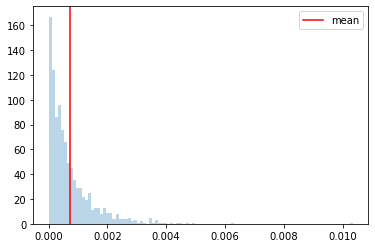

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654379586
{'jump_arrival_alpha': 1.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 10.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:07, 14.67it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:44,  9.48it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:51,  8.89it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<02:02,  8.10it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<02:02,  8.09it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:56,  8.50it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:56,  8.44it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<02:03,  7.98it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<02:02,  8.01it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:58,  8.25it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:52,  8.65it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<02:04,  7.84it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 27/1000 [00:03<02:08,  7.59it/s]

Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:22,  6.81it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:24,  6.70it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:04<02:12,  7.32it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<02:04,  7.77it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:00,  7.96it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<02:01,  7.89it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:05<02:25,  6.61it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<02:17,  6.94it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:04,  7.66it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:56,  8.19it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:06<01:57,  8.13it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<01:54,  8.32it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<01:55,  8.21it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:03,  7.64it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<02:05,  7.53it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:04,  7.57it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:59,  7.85it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:08<02:06,  7.40it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:00,  7.75it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<01:56,  7.99it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:00,  7.75it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:09<02:03,  7.54it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:08,  7.21it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:01,  7.62it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<01:59,  7.73it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:07,  7.24it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:10,  7.06it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:16,  6.74it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:11<02:07,  7.20it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:06,  7.25it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:01,  7.48it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:00,  7.56it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:00,  7.52it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:01,  7.43it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:06,  7.14it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:11,  6.84it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:06,  7.10it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:17,  6.53it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:10,  6.84it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:12,  6.74it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:11,  6.79it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:13,  6.68it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<02:11,  6.77it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:12,  6.66it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:08,  6.87it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:15,  6.50it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:18,  6.34it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:14,  6.52it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:12,  6.59it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:15,  6.42it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:19,  6.23it/s]

Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:17<02:20,  6.17it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:18<02:22,  6.11it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:18<02:19,  6.21it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:18<02:18,  6.26it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:19<02:24,  5.98it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:19<02:17,  6.26it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:19<02:20,  6.11it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:20<02:18,  6.16it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:20<02:15,  6.29it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:20<02:14,  6.35it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:20<02:11,  6.45it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:21<02:12,  6.39it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:21<02:10,  6.50it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:21<02:12,  6.38it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:22<02:22,  5.92it/s]

Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:19,  6.01it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:16,  6.15it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:23<02:13,  6.26it/s]

Monte Carlo 162
Monte Carlo 163


 16%|████████████▉                                                                  | 164/1000 [00:23<02:11,  6.37it/s]

Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:23<02:31,  5.52it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:26,  5.68it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:24<02:21,  5.86it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:24<02:18,  5.96it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:21,  5.86it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:25<02:18,  5.96it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:14,  6.09it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:24,  5.69it/s]

Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:26<02:19,  5.86it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 182/1000 [00:26<02:24,  5.66it/s]

Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:24,  5.63it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:27<02:17,  5.93it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:27<02:18,  5.88it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:18,  5.87it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:28<02:17,  5.86it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:28<02:21,  5.70it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:22,  5.63it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:29<02:26,  5.48it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:29<02:25,  5.52it/s]

Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:29<02:22,  5.62it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:21,  5.62it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:30<02:32,  5.22it/s]

Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:30<02:30,  5.28it/s]

Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:31,  5.25it/s]

Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:30<02:24,  5.50it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:31<02:17,  5.75it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:31<02:20,  5.60it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:16,  5.77it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:32<02:21,  5.54it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:32<02:22,  5.50it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:32<02:18,  5.64it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:14,  5.82it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:33<02:16,  5.72it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:33<02:18,  5.61it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:33<02:18,  5.62it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:33<02:14,  5.74it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:34<02:17,  5.63it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:34<02:24,  5.34it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:34<02:20,  5.50it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:35<02:18,  5.56it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:18,  5.54it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:21,  5.41it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:36<02:27,  5.17it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:36<02:24,  5.29it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:23,  5.30it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:25,  5.24it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:27,  5.14it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:37<02:29,  5.08it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:37<02:25,  5.20it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:24,  5.25it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:21,  5.32it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:25,  5.19it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:38<02:30,  4.99it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:31,  4.96it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:24,  5.19it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:39<02:24,  5.18it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:39<02:23,  5.21it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:39<02:21,  5.28it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:18,  5.37it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:40<02:20,  5.27it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:40<02:24,  5.11it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:21,  5.23it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:41<02:24,  5.12it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:41<02:23,  5.13it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:20,  5.22it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:19,  5.28it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:41<02:18,  5.29it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:22,  5.15it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:42<02:24,  5.07it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:22,  5.12it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:24,  5.04it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:21,  5.16it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:21,  5.13it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:26,  4.97it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:22,  5.09it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:44<02:29,  4.83it/s]

Monte Carlo 276
Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:44<02:32,  4.74it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:44<02:29,  4.82it/s]

Monte Carlo 279
Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:44<02:33,  4.69it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:29,  4.81it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:28,  4.83it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:27,  4.85it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:45<02:22,  4.99it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:46<02:26,  4.88it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:25,  4.90it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:46<02:21,  5.02it/s]

Monte Carlo 289
Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:47<02:33,  4.62it/s]

Monte Carlo 291
Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:47<02:21,  4.98it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:47<02:17,  5.11it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:18,  5.10it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:17,  5.12it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:18,  5.08it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:19,  5.04it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:15,  5.15it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:17,  5.09it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:17,  5.06it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:49<02:14,  5.19it/s]

Monte Carlo 303
Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:49<02:14,  5.16it/s]

Monte Carlo 305
Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:19,  4.95it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:15,  5.08it/s]

Monte Carlo 308
Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:50<02:16,  5.03it/s]

Monte Carlo 310
Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:51<02:20,  4.90it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:21,  4.84it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:20,  4.88it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:51<02:20,  4.87it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:18,  4.93it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:20,  4.86it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:25,  4.67it/s]

Monte Carlo 319
Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:30,  4.52it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:53<02:29,  4.53it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:29,  4.54it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:28,  4.55it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:28,  4.53it/s]

Monte Carlo 325
Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:28,  4.52it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:54<02:24,  4.63it/s]

Monte Carlo 328
Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:23,  4.67it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:55<02:25,  4.60it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:55<02:26,  4.56it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:24,  4.61it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:55<02:25,  4.57it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:18,  4.78it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:18,  4.78it/s]

Monte Carlo 336
Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:56<02:19,  4.74it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:56<02:26,  4.53it/s]

Monte Carlo 339


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:18,  4.77it/s]

Monte Carlo 340


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:15,  4.86it/s]

Monte Carlo 341
Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:57<02:15,  4.84it/s]

Monte Carlo 343


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:17,  4.76it/s]

Monte Carlo 344
Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:16,  4.78it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:21,  4.60it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:58<02:23,  4.55it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:21,  4.61it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:24,  4.50it/s]

Monte Carlo 350


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:21,  4.59it/s]

Monte Carlo 351


 35%|███████████████████████████▉                                                   | 353/1000 [00:59<02:19,  4.63it/s]

Monte Carlo 352
Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:20,  4.59it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:15,  4.75it/s]

Monte Carlo 355


 36%|████████████████████████████▏                                                  | 357/1000 [01:00<02:15,  4.75it/s]

Monte Carlo 356


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:15,  4.75it/s]

Monte Carlo 357
Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:16,  4.69it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:22,  4.49it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:25,  4.39it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:01<02:24,  4.41it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:26,  4.34it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:26,  4.35it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:22,  4.45it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:02<02:24,  4.39it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:26,  4.33it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:26,  4.30it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:24,  4.37it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:03<02:20,  4.48it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:03<02:19,  4.51it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:24,  4.35it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:23,  4.36it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:04<02:28,  4.23it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:04<02:26,  4.25it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:24,  4.31it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:25,  4.28it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:28,  4.19it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:05<02:30,  4.13it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:26,  4.24it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:22,  4.36it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:22,  4.34it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:06<02:20,  4.40it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:18,  4.46it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:16,  4.51it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:15,  4.55it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:07<02:16,  4.50it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:07<02:21,  4.32it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:24,  4.23it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:25,  4.18it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:08<02:22,  4.27it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:08<02:20,  4.33it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:19,  4.35it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:21,  4.28it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:09<02:22,  4.23it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:09<02:21,  4.27it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:18,  4.34it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:19,  4.31it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:19,  4.30it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:10<02:22,  4.20it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:10<02:20,  4.27it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:22,  4.21it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:21,  4.21it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:11<02:20,  4.25it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:11<02:21,  4.22it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:21,  4.19it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:23,  4.12it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:12<02:20,  4.20it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:12<02:21,  4.18it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:45,  3.57it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:36,  3.76it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:13<02:30,  3.90it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:13<02:28,  3.94it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:24,  4.04it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:27,  3.96it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:14<02:28,  3.93it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:14<02:23,  4.05it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:23,  4.06it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:22,  4.06it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:15<02:21,  4.10it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:15<02:20,  4.12it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:19,  4.13it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:23,  4.03it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:16<02:19,  4.12it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:16<02:19,  4.13it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:17,  4.16it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:16,  4.20it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:17<02:21,  4.03it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:17<02:22,  4.02it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:19,  4.08it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:22,  3.98it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:18<02:22,  3.98it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:18<02:21,  4.02it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:19,  4.05it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:18,  4.09it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:19<02:20,  4.01it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:19<02:21,  3.99it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:19,  4.02it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:20<02:17,  4.08it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:20<02:22,  3.93it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:20<02:20,  3.97it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:21<02:20,  3.96it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:21<02:19,  4.00it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:21<02:20,  3.96it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:21<02:19,  3.97it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:22<02:21,  3.93it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:22<02:21,  3.90it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:22<02:22,  3.89it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:22<02:18,  3.98it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:23<02:16,  4.02it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:23<02:14,  4.08it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:23<02:16,  4.02it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:23<02:14,  4.06it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:24<02:19,  3.92it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:24<02:18,  3.93it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:24<02:24,  3.77it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:24<02:23,  3.78it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:25<02:24,  3.76it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:25<02:21,  3.82it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:25<02:23,  3.77it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:26<02:26,  3.67it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:26<02:21,  3.80it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:26<02:19,  3.86it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:26<02:19,  3.83it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:27<02:23,  3.73it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:27<02:22,  3.75it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:27<02:22,  3.75it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:27<02:21,  3.77it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:28<02:26,  3.62it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:28<02:26,  3.61it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:28<02:28,  3.55it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:29<02:28,  3.54it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:29<02:28,  3.54it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:29<02:28,  3.55it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:29<02:26,  3.59it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:30<02:24,  3.63it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:30<02:20,  3.71it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:30<02:23,  3.64it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:30<02:21,  3.69it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:31<02:23,  3.63it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:31<02:22,  3.65it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:31<02:39,  3.25it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:32<02:34,  3.35it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:32<02:33,  3.36it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:32<02:38,  3.25it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:33<02:36,  3.29it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:33<02:29,  3.42it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:33<02:28,  3.44it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:33<02:29,  3.41it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:34<02:25,  3.49it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:34<02:22,  3.57it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:34<02:18,  3.66it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:34<02:15,  3.75it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:35<02:13,  3.80it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:35<02:14,  3.76it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:35<02:13,  3.77it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:36<02:11,  3.84it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:36<02:11,  3.81it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:36<02:11,  3.81it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:36<02:18,  3.62it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:37<02:19,  3.59it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:37<02:16,  3.65it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:37<02:13,  3.72it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:37<02:15,  3.67it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:38<02:17,  3.61it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:38<02:20,  3.52it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:38<02:19,  3.54it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:39<02:18,  3.56it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:39<02:17,  3.57it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:39<02:15,  3.63it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:39<02:13,  3.65it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:40<02:14,  3.62it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:40<02:14,  3.63it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:40<02:14,  3.61it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:41<02:15,  3.59it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:41<02:12,  3.65it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:41<02:14,  3.60it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:41<02:16,  3.54it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:42<02:19,  3.45it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:42<02:19,  3.43it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:42<02:16,  3.51it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:43<02:20,  3.41it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:43<02:18,  3.43it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:43<02:14,  3.55it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:43<02:11,  3.61it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:44<02:11,  3.60it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:44<02:05,  3.76it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:44<02:02,  3.86it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:44<02:02,  3.84it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:45<02:04,  3.77it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:45<02:04,  3.76it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:45<02:22,  3.28it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:46<02:15,  3.44it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:46<02:12,  3.51it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:46<02:14,  3.46it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:46<02:10,  3.56it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:47<02:09,  3.58it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:47<02:09,  3.55it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:47<02:08,  3.59it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:48<02:06,  3.65it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:48<02:02,  3.73it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:48<02:03,  3.70it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:48<02:05,  3.64it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:49<02:07,  3.57it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:49<02:09,  3.51it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:49<02:08,  3.54it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:49<02:07,  3.55it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:50<02:07,  3.54it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:50<02:11,  3.44it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:50<02:15,  3.32it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:51<02:12,  3.38it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:51<02:13,  3.34it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:51<02:12,  3.38it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:52<02:10,  3.42it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:52<02:12,  3.35it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:52<02:08,  3.45it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:52<02:07,  3.49it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:53<02:08,  3.45it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:53<02:09,  3.40it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:53<02:08,  3.42it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:54<02:13,  3.29it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:54<02:11,  3.33it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:54<02:09,  3.38it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:55<02:11,  3.32it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:55<02:08,  3.38it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:55<02:09,  3.36it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:55<02:09,  3.35it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:56<02:08,  3.36it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:56<02:06,  3.41it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:56<02:09,  3.32it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:57<02:09,  3.30it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:57<02:11,  3.27it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:57<02:09,  3.29it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:58<02:08,  3.32it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:58<02:08,  3.30it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:58<02:04,  3.41it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:58<02:01,  3.49it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:59<02:03,  3.43it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:59<02:00,  3.50it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:59<02:01,  3.47it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:00<02:00,  3.47it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:00<02:00,  3.46it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:00<02:02,  3.41it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:00<02:02,  3.40it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:01<02:01,  3.40it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:01<02:01,  3.41it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:01<01:59,  3.47it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:02<02:06,  3.27it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:02<02:04,  3.31it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:02<02:04,  3.29it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:03<02:04,  3.28it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:03<02:03,  3.31it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:03<02:01,  3.36it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:03<02:01,  3.33it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:04<02:01,  3.33it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:04<02:00,  3.36it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:04<02:01,  3.30it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:05<02:03,  3.26it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:05<02:02,  3.27it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:05<02:04,  3.22it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:06<02:03,  3.24it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:06<02:04,  3.18it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:06<02:08,  3.10it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:07<02:06,  3.14it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:07<02:07,  3.09it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:07<02:09,  3.05it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:08<02:07,  3.09it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:08<02:06,  3.11it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:08<02:03,  3.16it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:09<02:05,  3.11it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:09<02:04,  3.13it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:09<02:04,  3.11it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:09<02:06,  3.07it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:10<02:04,  3.10it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:10<02:06,  3.04it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:10<02:07,  3.01it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:11<02:09,  2.97it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:11<02:06,  3.02it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:11<02:03,  3.09it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:12<02:01,  3.12it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:12<02:01,  3.13it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:12<02:03,  3.07it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:13<02:03,  3.06it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:13<02:01,  3.11it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:13<02:02,  3.06it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:14<02:02,  3.05it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:14<02:04,  2.99it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:14<02:03,  3.01it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:15<02:02,  3.03it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:15<02:02,  3.02it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:15<02:02,  3.02it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:16<02:00,  3.05it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:16<02:14,  2.72it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:17<02:10,  2.80it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:17<02:07,  2.85it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:17<02:06,  2.88it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:18<02:05,  2.88it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:18<02:03,  2.93it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:18<02:03,  2.93it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:19<02:02,  2.93it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:19<02:03,  2.91it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:19<01:59,  3.01it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:20<01:57,  3.04it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:20<01:58,  3.01it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:20<01:57,  3.03it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:21<01:56,  3.04it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:21<01:59,  2.96it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:21<01:58,  2.97it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:22<01:59,  2.94it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:22<01:57,  2.97it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:22<01:58,  2.94it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:23<01:57,  2.96it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:23<01:57,  2.95it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:23<01:57,  2.96it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:24<01:57,  2.95it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:24<01:55,  2.98it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:24<01:54,  3.00it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:25<01:53,  3.01it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:25<01:55,  2.96it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:25<01:55,  2.94it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:26<01:54,  2.97it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:26<01:52,  2.99it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:26<01:51,  3.03it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:27<01:51,  3.01it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:27<01:50,  3.04it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:27<01:49,  3.05it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:28<01:50,  3.00it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:28<01:51,  2.99it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:28<01:50,  2.99it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:29<01:50,  3.00it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:29<01:50,  2.99it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:29<01:53,  2.90it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:30<01:52,  2.90it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:30<01:51,  2.94it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:30<01:49,  2.96it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:31<01:50,  2.94it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:31<01:48,  2.97it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:31<01:51,  2.89it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:32<01:50,  2.91it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:32<01:50,  2.89it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:32<01:49,  2.91it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:33<01:50,  2.88it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:33<01:49,  2.89it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:33<01:48,  2.92it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:34<01:50,  2.86it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:34<01:59,  2.62it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:35<01:57,  2.67it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:35<01:57,  2.66it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:35<01:52,  2.76it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:36<01:50,  2.80it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:36<01:48,  2.84it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:36<01:47,  2.87it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:37<01:45,  2.92it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:37<01:45,  2.91it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:37<01:43,  2.94it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:38<01:44,  2.91it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:38<01:44,  2.89it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:38<01:44,  2.89it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:39<01:42,  2.94it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:39<01:43,  2.90it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:39<01:42,  2.91it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:40<01:44,  2.86it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:40<01:45,  2.82it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:40<01:43,  2.87it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:41<01:41,  2.89it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:41<01:41,  2.90it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:41<01:40,  2.91it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:42<01:40,  2.91it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:42<01:42,  2.85it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:43<01:41,  2.85it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:43<01:41,  2.84it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:43<01:41,  2.83it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:44<01:40,  2.87it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:44<01:41,  2.81it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:44<01:39,  2.85it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:45<01:37,  2.92it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:45<01:35,  2.98it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:45<01:33,  3.01it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:46<01:33,  2.99it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:46<01:31,  3.05it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:46<01:32,  3.01it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:47<01:32,  3.02it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:47<01:34,  2.92it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:47<01:35,  2.88it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:48<01:34,  2.91it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:48<01:35,  2.88it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:48<01:36,  2.82it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:49<01:36,  2.83it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:49<01:34,  2.85it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:49<01:35,  2.82it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:50<01:34,  2.84it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:50<01:34,  2.83it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:50<01:34,  2.83it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:51<01:33,  2.84it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:51<01:35,  2.78it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:52<01:36,  2.74it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:52<01:35,  2.75it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:52<01:32,  2.82it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:53<01:30,  2.89it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:53<01:31,  2.85it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:53<01:30,  2.85it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:54<01:28,  2.91it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:54<01:28,  2.91it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:54<01:26,  2.96it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:55<01:25,  2.97it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:55<01:26,  2.94it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:55<01:26,  2.91it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:56<01:26,  2.91it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:56<01:25,  2.93it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:56<01:24,  2.96it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:57<01:25,  2.91it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:57<01:32,  2.68it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:57<01:29,  2.77it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:58<01:26,  2.85it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:58<01:26,  2.83it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:59<01:26,  2.81it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:59<01:25,  2.83it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:59<01:25,  2.84it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:00<01:23,  2.90it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:00<01:21,  2.95it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:00<01:22,  2.90it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:01<01:22,  2.88it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:01<01:21,  2.91it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:01<01:21,  2.89it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:02<01:23,  2.82it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:02<01:21,  2.87it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:02<01:22,  2.83it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:03<01:21,  2.83it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:03<01:22,  2.80it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:03<01:22,  2.78it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:04<01:22,  2.76it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:04<01:28,  2.59it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:05<01:27,  2.58it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:05<01:27,  2.59it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:05<01:28,  2.55it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:06<01:26,  2.58it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:06<01:26,  2.57it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:07<01:28,  2.52it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:07<01:25,  2.59it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:07<01:23,  2.63it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:08<01:24,  2.59it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:08<01:23,  2.61it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:08<01:22,  2.64it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:09<01:20,  2.67it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:09<01:22,  2.60it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:10<01:21,  2.63it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:10<01:22,  2.57it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:10<01:20,  2.65it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:11<01:17,  2.71it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:11<01:16,  2.75it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:11<01:15,  2.77it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:12<01:13,  2.81it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:12<01:13,  2.82it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:12<01:12,  2.83it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:13<01:11,  2.87it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:13<01:11,  2.86it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:14<01:12,  2.78it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:14<01:12,  2.79it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:14<01:12,  2.78it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:15<01:12,  2.78it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:15<01:11,  2.80it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:15<01:12,  2.74it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:16<01:12,  2.73it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:16<01:11,  2.76it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:16<01:11,  2.73it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:17<01:11,  2.70it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:17<01:13,  2.62it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:18<01:11,  2.69it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:18<01:12,  2.65it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:18<01:11,  2.66it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:19<01:13,  2.58it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:19<01:11,  2.64it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:20<01:10,  2.64it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:20<01:10,  2.62it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:20<01:10,  2.64it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:21<01:09,  2.65it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:21<01:11,  2.57it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:21<01:10,  2.59it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:22<01:09,  2.61it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:22<01:08,  2.63it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:23<01:09,  2.59it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:23<01:08,  2.59it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:23<01:08,  2.57it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:24<01:09,  2.54it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:24<01:09,  2.52it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:25<01:10,  2.48it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:25<01:10,  2.45it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:25<01:08,  2.50it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:26<01:07,  2.52it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:26<01:08,  2.49it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:27<01:06,  2.53it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:27<01:04,  2.59it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:27<01:04,  2.59it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:28<01:04,  2.59it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:28<01:04,  2.55it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:29<01:04,  2.53it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:29<01:04,  2.54it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:29<01:03,  2.57it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:30<01:01,  2.60it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:30<01:01,  2.60it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:30<01:01,  2.58it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:31<01:01,  2.58it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:31<01:01,  2.56it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:32<00:59,  2.61it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:32<01:01,  2.52it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:32<01:02,  2.46it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:33<01:01,  2.51it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:33<01:00,  2.51it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:34<00:59,  2.53it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:34<01:00,  2.50it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:35<01:04,  2.31it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:35<01:02,  2.37it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:35<01:00,  2.42it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:36<00:59,  2.45it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:36<00:58,  2.47it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:37<00:57,  2.51it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:37<00:56,  2.54it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:37<00:55,  2.54it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:38<00:54,  2.58it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:38<00:54,  2.55it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:39<00:56,  2.47it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:39<00:55,  2.49it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:39<00:55,  2.48it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:40<00:55,  2.44it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:40<00:54,  2.46it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:41<00:54,  2.47it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:41<00:53,  2.50it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:41<00:54,  2.44it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:42<00:53,  2.44it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:42<00:52,  2.46it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:43<00:52,  2.45it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:43<00:52,  2.45it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:43<00:51,  2.45it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:44<00:51,  2.44it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:44<00:50,  2.45it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:45<00:49,  2.48it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:45<00:49,  2.47it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:45<00:50,  2.43it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:46<00:48,  2.48it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:46<00:48,  2.46it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:47<00:48,  2.46it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:47<00:49,  2.40it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:48<00:49,  2.35it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:48<00:48,  2.39it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:48<00:47,  2.40it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:49<00:47,  2.39it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:49<00:46,  2.42it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:50<00:46,  2.41it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:50<00:46,  2.41it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:50<00:45,  2.42it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:51<00:45,  2.40it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:51<00:46,  2.34it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:52<00:45,  2.36it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:52<00:44,  2.36it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:53<00:44,  2.36it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:53<00:43,  2.41it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:53<00:43,  2.35it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:54<00:42,  2.38it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:54<00:42,  2.38it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:55<00:41,  2.40it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:55<00:41,  2.40it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:55<00:41,  2.39it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:56<00:40,  2.39it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:56<00:39,  2.42it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:57<00:39,  2.39it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:57<00:40,  2.34it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:58<00:39,  2.34it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:58<00:38,  2.38it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:58<00:38,  2.35it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:59<00:38,  2.36it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:59<00:37,  2.38it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:00<00:37,  2.35it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:00<00:36,  2.38it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:01<00:36,  2.39it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:01<00:35,  2.38it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:01<00:34,  2.40it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:02<00:36,  2.29it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:02<00:35,  2.28it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:03<00:35,  2.29it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:03<00:34,  2.33it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:04<00:33,  2.35it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:04<00:33,  2.36it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:04<00:32,  2.38it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:05<00:31,  2.40it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:05<00:31,  2.41it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:06<00:30,  2.39it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:06<00:31,  2.33it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:07<00:30,  2.34it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:07<00:30,  2.33it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:07<00:30,  2.30it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:08<00:28,  2.41it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:08<00:28,  2.40it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:09<00:27,  2.42it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:09<00:27,  2.43it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:09<00:27,  2.40it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:10<00:26,  2.43it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:10<00:26,  2.39it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:11<00:25,  2.43it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:11<00:24,  2.48it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:12<00:26,  2.28it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:12<00:24,  2.38it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:12<00:23,  2.43it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:13<00:23,  2.45it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:13<00:22,  2.44it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:14<00:22,  2.48it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:14<00:21,  2.49it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:14<00:21,  2.49it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:15<00:20,  2.51it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:15<00:20,  2.47it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:16<00:20,  2.48it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:16<00:19,  2.45it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:16<00:20,  2.39it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:17<00:19,  2.45it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:17<00:18,  2.44it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:18<00:18,  2.43it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:18<00:17,  2.44it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:18<00:17,  2.43it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:19<00:17,  2.41it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:19<00:16,  2.45it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:20<00:16,  2.40it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:20<00:16,  2.40it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:20<00:15,  2.43it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:21<00:15,  2.45it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:21<00:14,  2.46it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:22<00:14,  2.42it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:22<00:13,  2.43it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:23<00:13,  2.38it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:23<00:13,  2.34it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:23<00:13,  2.26it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:24<00:13,  2.29it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:24<00:12,  2.31it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:25<00:12,  2.26it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:25<00:12,  2.24it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:26<00:11,  2.23it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:26<00:11,  2.22it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:27<00:10,  2.21it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:27<00:10,  2.21it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:28<00:09,  2.24it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:28<00:09,  2.27it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:28<00:08,  2.25it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:29<00:08,  2.24it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:29<00:07,  2.26it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:30<00:07,  2.26it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:30<00:07,  2.24it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:31<00:06,  2.22it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:31<00:06,  2.26it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:32<00:05,  2.25it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:32<00:05,  2.25it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:32<00:04,  2.21it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:33<00:04,  2.22it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:33<00:04,  2.23it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:34<00:03,  2.23it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:34<00:03,  2.20it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:35<00:02,  2.15it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:35<00:02,  2.13it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:36<00:01,  2.12it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:36<00:01,  2.15it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:37<00:00,  2.15it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:37<00:00,  2.13it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:38<00:00,  3.60it/s]


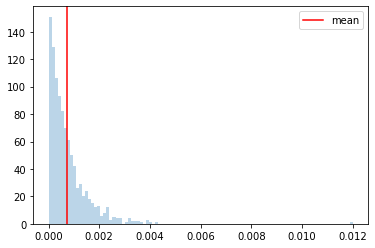

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654379865
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 0.1, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:03, 15.59it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:25, 11.64it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▌                                                                                | 7/1000 [00:00<01:40,  9.84it/s]

Monte Carlo 7
Monte Carlo 8

  1%|▋                                                                                | 9/1000 [00:00<01:57,  8.46it/s]


Monte Carlo 9


  1%|▉                                                                               | 11/1000 [00:01<01:56,  8.47it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<02:03,  8.02it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<01:58,  8.32it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:01<01:54,  8.61it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<01:57,  8.37it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<01:57,  8.33it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:55,  8.44it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<01:52,  8.66it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<01:57,  8.31it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:03,  7.89it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:09,  7.47it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<02:09,  7.46it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<01:58,  8.14it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<01:55,  8.37it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<01:59,  8.07it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<01:59,  8.03it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<02:00,  7.94it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:06,  7.57it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:08,  7.40it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:06<02:28,  6.39it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:18,  6.85it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:06,  7.48it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:07,  7.43it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<02:04,  7.55it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:00,  7.81it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:58,  7.93it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:03,  7.58it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:03,  7.57it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:02,  7.63it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:04,  7.48it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:04,  7.44it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:03,  7.51it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:04,  7.45it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:03,  7.45it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:08,  7.18it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:13,  6.90it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:09,  7.09it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:11,  6.97it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:12,  6.90it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:07,  7.14it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:05,  7.22it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:10,  6.95it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:10,  6.91it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:07,  7.10it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:05,  7.16it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:13,  6.74it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:10,  6.86it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:14,  6.66it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:14,  6.65it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:08,  6.96it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:11,  6.74it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:07,  6.98it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:34,  5.71it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:24,  6.10it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:16<02:19,  6.29it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:19,  6.30it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:14,  6.53it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:09,  6.75it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:13,  6.54it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:15,  6.45it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:10,  6.66it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:18<02:09,  6.71it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:14,  6.43it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:14,  6.40it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:19<02:11,  6.54it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:17,  6.25it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:15,  6.33it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:20<02:21,  6.06it/s]

Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:20<02:17,  6.21it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:20<02:17,  6.18it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:20<02:20,  6.07it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:21<02:24,  5.85it/s]

Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<02:21,  6.00it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:15,  6.25it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:22<02:13,  6.33it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:17,  6.11it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:16,  6.13it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:23<02:18,  6.03it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:23<02:27,  5.65it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:26,  5.69it/s]

Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:23,  5.79it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:24<02:22,  5.84it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:24<02:18,  5.98it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:18,  5.96it/s]

Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:25<02:40,  5.14it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:25<02:29,  5.49it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:22,  5.77it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:26<02:18,  5.93it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:26<02:13,  6.12it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:17,  5.92it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:27<02:19,  5.84it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:27<02:21,  5.75it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:19,  5.79it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:28<02:27,  5.47it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:28<02:28,  5.42it/s]

Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:28<02:29,  5.37it/s]

Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:24,  5.55it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:29<02:26,  5.47it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:29<02:18,  5.77it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:08,  6.20it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:30<02:06,  6.31it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:30<02:12,  5.98it/s]

Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:11,  6.03it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:10,  6.07it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:31<02:11,  6.03it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:31<02:11,  6.00it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:09,  6.06it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:32<02:14,  5.81it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:32<02:14,  5.80it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:15,  5.75it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:15,  5.76it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:33<02:13,  5.83it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:13,  5.81it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:20,  5.51it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:34<02:21,  5.47it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:34<02:17,  5.62it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:21,  5.46it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:17,  5.60it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:13,  5.77it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:14,  5.68it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:17,  5.53it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:36<02:19,  5.47it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:20,  5.42it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:22,  5.32it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:22,  5.33it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:37<02:22,  5.33it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:23,  5.26it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:26,  5.15it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:25,  5.18it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:23,  5.24it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:38<02:27,  5.11it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:31,  4.96it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:31,  4.96it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:31,  4.92it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:39<02:28,  5.04it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:39<02:29,  5.00it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:25,  5.12it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:27,  5.05it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:24,  5.15it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 258/1000 [00:40<02:26,  5.06it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:31,  4.90it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:33,  4.81it/s]

Monte Carlo 261


 26%|████████████████████▋                                                          | 262/1000 [00:40<02:32,  4.84it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 263/1000 [00:41<02:32,  4.85it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:28,  4.97it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:41<02:27,  4.97it/s]

Monte Carlo 265
Monte Carlo 266


 27%|█████████████████████                                                          | 267/1000 [00:41<02:25,  5.03it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:30,  4.84it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:29,  4.87it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:29,  4.88it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:28,  4.89it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▌                                                         | 273/1000 [00:43<02:35,  4.68it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:30,  4.82it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:33,  4.70it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:33,  4.70it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:44<02:39,  4.51it/s]

Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:44<02:38,  4.54it/s]

Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:44<02:37,  4.57it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:33,  4.68it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:28,  4.81it/s]

Monte Carlo 283
Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:28,  4.81it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:45<02:31,  4.73it/s]

Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:46<02:32,  4.68it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:33,  4.62it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:36,  4.55it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:46<02:32,  4.65it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:47<02:30,  4.69it/s]

Monte Carlo 291
Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:31,  4.67it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:47<02:31,  4.67it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:48<02:32,  4.62it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:32,  4.61it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:33,  4.57it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:30,  4.65it/s]

Monte Carlo 299
Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:49<02:31,  4.62it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:32,  4.59it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:49<02:25,  4.78it/s]

Monte Carlo 303
Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:50<02:27,  4.71it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:27,  4.69it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:24,  4.78it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:20,  4.93it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:51<02:16,  5.06it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:51<02:16,  5.05it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:12,  5.18it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:51<02:16,  5.03it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:52<02:15,  5.04it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:19,  4.91it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:15,  5.04it/s]

Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:34,  4.40it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<02:26,  4.63it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:25,  4.68it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:53<02:17,  4.92it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:16,  4.96it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:16,  4.97it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:13,  5.05it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:14,  5.01it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:12,  5.07it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:10,  5.16it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:54<02:10,  5.15it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:09,  5.19it/s]

Monte Carlo 329
Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:55<02:10,  5.13it/s]

Monte Carlo 331
Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:15,  4.93it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:17,  4.83it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:16,  4.87it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:18,  4.77it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:57<02:20,  4.70it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:18,  4.76it/s]

Monte Carlo 339
Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:19,  4.72it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:19,  4.72it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:16,  4.79it/s]

Monte Carlo 343


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:14,  4.85it/s]

Monte Carlo 344
Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:22,  4.59it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:21,  4.61it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:58<02:21,  4.60it/s]

Monte Carlo 348


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:18,  4.70it/s]

Monte Carlo 349
Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:25,  4.45it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:27,  4.41it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:00<02:22,  4.54it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:21,  4.57it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:21,  4.56it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:24,  4.45it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:00<02:22,  4.53it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:21,  4.53it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:24,  4.42it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:27,  4.34it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:26,  4.38it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:26,  4.35it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:24,  4.40it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:21,  4.48it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:23,  4.43it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:02<02:20,  4.50it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:22,  4.43it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:25,  4.34it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:25,  4.35it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:03<02:31,  4.17it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:34,  4.06it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:36,  4.00it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:34,  4.06it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:04<02:32,  4.12it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:34,  4.05it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:35,  4.02it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:32,  4.09it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:28,  4.19it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:27,  4.21it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:25,  4.26it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:27,  4.19it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:29,  4.14it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:26,  4.21it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:25,  4.23it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:25,  4.22it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:28,  4.14it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:30,  4.08it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:35,  3.93it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:34,  3.96it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:30,  4.05it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:09<02:30,  4.04it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:30,  4.03it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:27,  4.12it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:25,  4.15it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:10<02:27,  4.11it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:28,  4.05it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:33,  3.94it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:29,  4.02it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:11<02:29,  4.01it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:11<02:30,  4.00it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:27,  4.06it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:27,  4.06it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:26,  4.07it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:26,  4.07it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:26,  4.06it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:26,  4.05it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:13<02:27,  4.02it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:28,  3.99it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:13<02:27,  4.01it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:28,  3.97it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:14<02:31,  3.90it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<02:28,  3.96it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:26,  4.01it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:27,  3.99it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:15<02:31,  3.85it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:29,  3.91it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:15<02:29,  3.89it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:30,  3.87it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:16<02:28,  3.90it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:16<02:30,  3.85it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:16<02:29,  3.87it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:32,  3.78it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:17<02:35,  3.72it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:34,  3.73it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:17<02:46,  3.46it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:18<02:44,  3.49it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:18<02:49,  3.37it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:43,  3.51it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:36,  3.65it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:19<02:32,  3.75it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:19<02:28,  3.84it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:28,  3.82it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:27,  3.84it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:20<02:26,  3.88it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:20<02:24,  3.91it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:24,  3.91it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:22,  3.96it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:21<02:22,  3.93it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:21<02:23,  3.91it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:30,  3.72it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:21<02:26,  3.81it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:22<02:43,  3.41it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:22<02:39,  3.49it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:22<02:35,  3.58it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:23<02:29,  3.71it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:23<02:32,  3.64it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:23<02:35,  3.56it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:23<02:30,  3.67it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:24<02:27,  3.73it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:24<02:25,  3.79it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:24,  3.79it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:24<02:24,  3.79it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:25<02:23,  3.81it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:25<02:23,  3.81it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:23,  3.80it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:26<02:24,  3.77it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:26<02:25,  3.73it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:26<02:28,  3.65it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:28,  3.65it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:27<02:26,  3.68it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:27<02:27,  3.67it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:25,  3.69it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:27<02:24,  3.73it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:28<02:22,  3.77it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:28<02:20,  3.81it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:28<02:19,  3.82it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:28<02:18,  3.84it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:29<02:20,  3.79it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:29<02:22,  3.73it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:29<02:20,  3.77it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:30<02:20,  3.78it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:30<02:24,  3.65it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:30<02:21,  3.73it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:21,  3.73it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:31<02:19,  3.77it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:31<02:16,  3.83it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:31<02:15,  3.86it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:31<02:18,  3.77it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:32<02:19,  3.75it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:32<02:18,  3.75it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:32<02:19,  3.71it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:32<02:19,  3.73it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:33<02:24,  3.58it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:33<02:22,  3.63it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:33<02:21,  3.64it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:34<02:18,  3.70it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:34<02:23,  3.58it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:34<02:23,  3.56it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:34<02:28,  3.45it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:35<02:25,  3.52it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:35<02:25,  3.51it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:35<02:24,  3.50it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:36<02:26,  3.46it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:36<02:28,  3.41it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:36<02:25,  3.48it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:36<02:22,  3.53it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:37<02:23,  3.51it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:37<02:23,  3.50it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:37<02:20,  3.58it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:38<02:20,  3.57it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:38<02:21,  3.53it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:38<02:21,  3.52it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:38<02:22,  3.50it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:39<02:22,  3.47it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:39<02:20,  3.52it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:39<02:20,  3.51it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:40<02:22,  3.47it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:40<02:19,  3.52it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:40<02:18,  3.55it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:40<02:16,  3.58it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:41<02:19,  3.51it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:41<02:21,  3.45it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:41<02:24,  3.38it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:42<02:24,  3.37it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:42<02:23,  3.37it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:42<02:23,  3.38it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:43<02:24,  3.35it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:43<02:21,  3.41it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:43<02:21,  3.40it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:43<02:19,  3.43it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:44<02:18,  3.45it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:44<02:18,  3.46it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:44<02:19,  3.43it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:45<02:17,  3.45it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:45<02:22,  3.34it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:45<02:21,  3.35it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:45<02:19,  3.40it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:46<02:16,  3.46it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:46<02:14,  3.51it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:46<02:21,  3.31it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:47<02:24,  3.24it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:47<02:21,  3.32it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:47<02:19,  3.36it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:48<02:22,  3.26it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:48<02:20,  3.32it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:48<02:20,  3.30it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:48<02:17,  3.36it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:49<02:14,  3.43it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:49<02:13,  3.44it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:49<02:15,  3.40it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:50<02:14,  3.40it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:50<02:13,  3.43it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:50<02:13,  3.44it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:51<02:12,  3.45it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:51<02:13,  3.42it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:51<02:12,  3.42it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:51<02:11,  3.43it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:52<02:14,  3.35it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:52<02:20,  3.22it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:52<02:17,  3.28it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:53<02:15,  3.32it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:53<02:15,  3.30it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:53<02:15,  3.30it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:54<02:14,  3.31it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:54<02:15,  3.29it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:54<02:15,  3.29it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:54<02:14,  3.30it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:55<02:15,  3.26it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:55<02:17,  3.20it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:55<02:16,  3.21it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:56<02:17,  3.19it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:56<02:15,  3.22it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:56<02:18,  3.15it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:57<02:18,  3.15it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:57<02:33,  2.84it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:57<02:27,  2.94it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:58<02:23,  3.01it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:58<02:22,  3.02it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:58<02:23,  3.00it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:59<02:22,  3.02it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:59<02:24,  2.98it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:59<02:21,  3.03it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:00<02:19,  3.07it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:00<02:17,  3.10it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:00<02:17,  3.08it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:01<02:16,  3.11it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:01<02:16,  3.11it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:01<02:16,  3.09it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:02<02:13,  3.15it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:02<02:14,  3.11it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:02<02:13,  3.14it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:03<02:12,  3.16it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:03<02:13,  3.12it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:03<02:15,  3.07it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:04<02:13,  3.10it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:04<02:12,  3.12it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:04<02:12,  3.13it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:04<02:11,  3.14it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:05<02:13,  3.08it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:05<02:17,  2.98it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:06<02:16,  3.00it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:06<02:12,  3.09it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:06<02:12,  3.07it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:06<02:11,  3.08it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:07<02:11,  3.08it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:07<02:13,  3.03it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:07<02:09,  3.11it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:08<02:08,  3.13it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:08<02:07,  3.14it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:08<02:07,  3.14it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:09<02:07,  3.14it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:09<02:10,  3.06it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:09<02:09,  3.07it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:10<02:11,  3.01it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:10<02:10,  3.02it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:10<02:13,  2.96it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:11<02:13,  2.94it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:11<02:13,  2.93it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:11<02:11,  2.97it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:12<02:12,  2.95it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:12<02:13,  2.91it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:12<02:16,  2.85it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:13<02:14,  2.87it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:13<02:12,  2.91it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:14<02:11,  2.92it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:14<02:08,  2.99it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:14<02:10,  2.95it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:15<02:08,  2.98it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:15<02:10,  2.91it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:15<02:12,  2.87it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:16<02:11,  2.89it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:16<02:07,  2.96it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:16<02:07,  2.97it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:17<02:07,  2.94it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:17<02:07,  2.94it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:17<02:06,  2.95it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:18<02:08,  2.90it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:18<02:09,  2.88it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:18<02:10,  2.84it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:19<02:09,  2.86it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:19<02:06,  2.91it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:19<02:05,  2.94it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:20<02:02,  2.99it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:20<02:01,  3.00it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:20<01:59,  3.05it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:21<01:59,  3.05it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:21<01:58,  3.07it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:21<01:55,  3.14it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:22<01:53,  3.19it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:22<01:51,  3.23it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:22<01:51,  3.22it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:23<01:54,  3.12it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:23<01:56,  3.06it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:23<01:55,  3.08it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:23<01:55,  3.07it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:24<01:56,  3.04it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:24<01:58,  2.98it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:25<02:00,  2.93it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:25<01:57,  3.00it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:25<01:56,  3.00it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:25<01:53,  3.06it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:26<01:53,  3.08it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:26<01:52,  3.09it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:27<01:59,  2.91it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:27<01:58,  2.92it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:27<01:55,  2.98it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:28<01:54,  2.99it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:28<01:56,  2.94it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:28<01:57,  2.91it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:29<01:57,  2.90it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:29<01:57,  2.88it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:29<01:58,  2.86it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:30<01:56,  2.90it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:30<01:57,  2.85it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:30<01:56,  2.87it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:31<02:02,  2.73it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:31<01:57,  2.84it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:31<01:58,  2.81it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:32<01:57,  2.82it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:32<01:55,  2.86it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:32<01:55,  2.84it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:33<01:53,  2.88it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:33<01:53,  2.88it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:34<01:55,  2.81it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:34<01:55,  2.82it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:34<01:53,  2.84it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:35<01:54,  2.83it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:35<01:55,  2.80it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:35<01:53,  2.82it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:36<01:52,  2.84it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:36<01:51,  2.86it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:36<01:53,  2.81it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:37<01:51,  2.85it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:37<01:51,  2.84it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:38<02:05,  2.52it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:38<01:59,  2.63it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:38<01:57,  2.66it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:39<01:54,  2.73it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:39<01:51,  2.80it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:39<01:48,  2.86it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:40<01:49,  2.83it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:40<01:46,  2.90it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:40<01:43,  2.96it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:41<01:45,  2.91it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:41<01:44,  2.92it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:41<01:43,  2.92it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:42<01:43,  2.93it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:42<01:46,  2.83it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:42<01:44,  2.89it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:43<01:43,  2.90it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:43<01:44,  2.85it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:43<01:45,  2.82it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:44<01:46,  2.78it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:44<01:47,  2.77it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:45<01:49,  2.68it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:45<01:50,  2.67it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:45<01:48,  2.69it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:46<01:45,  2.77it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:46<01:44,  2.77it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:46<01:43,  2.81it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:47<01:44,  2.76it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:47<01:44,  2.75it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:47<01:42,  2.79it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:48<01:44,  2.74it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:48<01:41,  2.80it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:49<01:41,  2.79it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:49<01:41,  2.78it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:49<01:41,  2.77it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:50<01:42,  2.73it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:50<01:41,  2.77it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:50<01:39,  2.80it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:51<01:40,  2.78it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:51<01:42,  2.70it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:51<01:40,  2.76it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:52<01:40,  2.74it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:52<01:38,  2.77it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:53<01:40,  2.72it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:53<01:41,  2.68it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:53<01:40,  2.70it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:54<01:40,  2.69it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:54<01:38,  2.72it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:54<01:37,  2.76it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:55<01:37,  2.75it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:55<01:41,  2.63it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:56<01:47,  2.46it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:56<01:45,  2.51it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:56<01:42,  2.57it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:57<01:40,  2.61it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:57<01:37,  2.67it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:57<01:37,  2.66it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:58<01:38,  2.64it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:58<01:36,  2.67it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:59<01:36,  2.65it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:59<01:36,  2.65it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:59<01:36,  2.64it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:00<01:36,  2.64it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:00<01:35,  2.64it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:00<01:34,  2.67it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:01<01:33,  2.69it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:01<01:32,  2.70it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:02<01:34,  2.65it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:02<01:33,  2.65it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:02<01:32,  2.68it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:03<01:31,  2.70it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:03<01:33,  2.62it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:04<01:33,  2.61it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:04<01:31,  2.64it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:04<01:31,  2.63it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:05<01:31,  2.65it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:05<01:30,  2.64it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:05<01:29,  2.66it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:06<01:27,  2.73it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:06<01:28,  2.68it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:06<01:25,  2.75it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:07<01:27,  2.69it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:07<01:27,  2.69it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:08<01:25,  2.74it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:08<01:23,  2.79it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:08<01:23,  2.76it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:09<01:23,  2.75it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:09<01:23,  2.75it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:09<01:22,  2.76it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:10<01:24,  2.68it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:10<01:22,  2.72it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:11<01:24,  2.68it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:11<01:24,  2.65it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:11<01:24,  2.64it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:12<01:24,  2.64it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:12<01:25,  2.59it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:12<01:24,  2.59it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:13<01:24,  2.60it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:13<01:25,  2.54it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:14<01:25,  2.52it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:14<01:25,  2.53it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:14<01:23,  2.57it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:15<01:32,  2.31it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:15<01:28,  2.40it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:16<01:25,  2.48it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:16<01:24,  2.49it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:16<01:24,  2.50it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:17<01:22,  2.54it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:17<01:23,  2.50it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:18<01:21,  2.53it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:18<01:20,  2.55it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:18<01:21,  2.51it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:19<01:21,  2.49it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:19<01:20,  2.51it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:20<01:20,  2.52it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:20<01:18,  2.55it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:20<01:19,  2.53it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:21<01:18,  2.54it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:21<01:16,  2.58it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:22<01:17,  2.56it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:22<01:17,  2.52it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:22<01:16,  2.56it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:23<01:17,  2.50it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:23<01:16,  2.51it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:24<01:15,  2.53it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:24<01:14,  2.58it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:24<01:14,  2.54it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:25<01:14,  2.52it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:25<01:14,  2.54it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:26<01:13,  2.53it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:26<01:12,  2.56it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:26<01:13,  2.52it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:27<01:14,  2.49it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:27<01:14,  2.47it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:28<01:13,  2.49it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:28<01:12,  2.49it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:28<01:12,  2.48it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:29<01:12,  2.46it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:29<01:12,  2.45it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:30<01:13,  2.42it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:30<01:11,  2.45it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:30<01:12,  2.43it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:31<01:12,  2.40it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:31<01:10,  2.46it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:32<01:09,  2.47it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:32<01:08,  2.48it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:32<01:08,  2.49it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:33<01:08,  2.48it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:33<01:07,  2.49it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:34<01:07,  2.49it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:34<01:06,  2.48it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:34<01:06,  2.49it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:35<01:05,  2.50it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:35<01:04,  2.52it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:36<01:03,  2.55it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:36<01:04,  2.48it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:36<01:02,  2.54it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:37<01:02,  2.54it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:37<01:01,  2.57it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:38<01:01,  2.57it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:38<01:01,  2.55it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:38<01:01,  2.52it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:39<01:00,  2.56it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:39<00:59,  2.56it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:40<01:00,  2.51it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:40<01:00,  2.49it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:40<00:59,  2.51it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:41<00:59,  2.50it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:41<00:58,  2.51it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:42<00:58,  2.50it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:42<00:59,  2.47it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:42<00:58,  2.47it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:43<00:58,  2.46it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:43<00:59,  2.40it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:44<00:57,  2.45it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:44<00:57,  2.44it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:44<00:57,  2.45it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:45<00:56,  2.45it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:45<00:56,  2.43it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:46<00:56,  2.42it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:46<00:57,  2.37it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:47<00:57,  2.37it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:47<00:56,  2.39it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:47<00:56,  2.37it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:48<00:55,  2.39it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:48<00:55,  2.35it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:49<00:53,  2.41it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:49<00:53,  2.40it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:50<00:53,  2.38it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:50<00:54,  2.32it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:50<00:54,  2.33it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:51<00:53,  2.35it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:51<00:53,  2.31it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:52<00:52,  2.36it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:52<00:50,  2.39it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:52<00:50,  2.41it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:53<00:50,  2.39it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:53<00:50,  2.35it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:54<00:49,  2.38it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:54<00:48,  2.42it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:55<00:47,  2.46it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:55<00:46,  2.48it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:55<00:45,  2.52it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:56<00:44,  2.53it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:56<00:45,  2.47it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:57<00:44,  2.48it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:57<00:44,  2.46it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:57<00:46,  2.36it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:58<00:46,  2.33it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:58<00:45,  2.36it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:59<00:44,  2.37it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:59<00:43,  2.40it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:00<00:43,  2.38it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:00<00:43,  2.37it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:00<00:43,  2.37it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:01<00:43,  2.34it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:01<00:43,  2.30it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:02<00:46,  2.14it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:02<00:45,  2.18it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:03<00:43,  2.24it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:03<00:42,  2.27it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:04<00:41,  2.27it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:04<00:40,  2.31it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:04<00:39,  2.34it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:05<00:39,  2.34it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:05<00:38,  2.34it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:06<00:38,  2.31it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:06<00:37,  2.34it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:07<00:37,  2.32it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:07<00:37,  2.31it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:07<00:37,  2.31it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:08<00:36,  2.31it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:08<00:36,  2.31it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:09<00:36,  2.30it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:09<00:35,  2.30it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:10<00:34,  2.32it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:10<00:35,  2.27it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:10<00:34,  2.30it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:11<00:34,  2.29it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:11<00:33,  2.29it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:12<00:33,  2.29it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:12<00:33,  2.26it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:13<00:33,  2.21it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:13<00:32,  2.24it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:14<00:31,  2.26it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:14<00:31,  2.25it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:14<00:31,  2.23it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:15<00:30,  2.23it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:15<00:30,  2.23it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:16<00:30,  2.19it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:16<00:29,  2.21it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:17<00:29,  2.23it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:17<00:28,  2.23it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:18<00:28,  2.23it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:18<00:27,  2.26it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:19<00:27,  2.20it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:19<00:27,  2.21it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:19<00:26,  2.23it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:20<00:26,  2.23it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:20<00:25,  2.20it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:21<00:25,  2.21it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:21<00:24,  2.28it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:22<00:23,  2.30it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:22<00:22,  2.36it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:22<00:21,  2.37it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:23<00:21,  2.37it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:23<00:21,  2.35it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:24<00:20,  2.34it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:24<00:20,  2.30it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:25<00:20,  2.32it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:25<00:19,  2.35it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:25<00:19,  2.34it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:26<00:19,  2.31it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:26<00:18,  2.33it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:27<00:18,  2.26it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:27<00:18,  2.23it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:28<00:18,  2.21it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:28<00:17,  2.22it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:29<00:17,  2.22it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:29<00:16,  2.18it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:29<00:16,  2.20it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:30<00:15,  2.22it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:30<00:15,  2.24it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:31<00:15,  2.18it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:31<00:14,  2.16it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:32<00:14,  2.18it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:32<00:13,  2.21it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:33<00:13,  2.22it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:33<00:12,  2.22it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:34<00:12,  2.22it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:34<00:11,  2.21it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:34<00:11,  2.24it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:35<00:11,  2.17it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:35<00:10,  2.13it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:36<00:10,  2.14it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:36<00:09,  2.16it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:37<00:09,  2.18it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:37<00:08,  2.19it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:38<00:08,  2.20it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:38<00:07,  2.18it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:39<00:07,  2.16it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:39<00:06,  2.20it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:40<00:06,  2.22it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:40<00:05,  2.25it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:40<00:05,  2.30it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:41<00:04,  2.28it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:41<00:04,  2.27it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:42<00:03,  2.27it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:42<00:03,  2.25it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:43<00:03,  2.22it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:43<00:02,  2.25it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:43<00:02,  2.31it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:44<00:01,  2.22it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:44<00:01,  2.25it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:45<00:00,  2.23it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:45<00:00,  2.19it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:46<00:00,  3.49it/s]


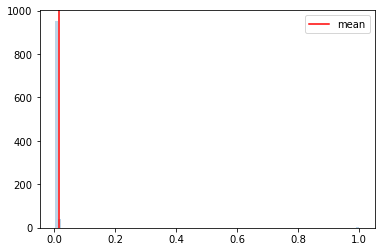

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654380152
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 0.1, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:00, 16.35it/s]

Monte Carlo 3


  0%|▍                                                                                | 5/1000 [00:00<02:13,  7.46it/s]

Monte Carlo 4
Monte Carlo 5


  1%|▌                                                                                | 7/1000 [00:00<02:03,  8.05it/s]

Monte Carlo 6
Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:01<02:01,  8.13it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 11/1000 [00:01<01:54,  8.67it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<02:02,  8.04it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<01:58,  8.34it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:02<01:59,  8.20it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<01:55,  8.48it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<01:59,  8.20it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:56,  8.41it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:03<02:00,  8.08it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<01:56,  8.39it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:16,  7.09it/s]

Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:19,  6.98it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:08,  7.52it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:05,  7.67it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:00,  7.99it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<02:30,  6.38it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:05<02:24,  6.63it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<02:26,  6.55it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<02:22,  6.70it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:06<02:17,  6.92it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:06<02:14,  7.09it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:06<02:05,  7.58it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<02:01,  7.83it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:07<02:00,  7.85it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:07<01:51,  8.50it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<01:54,  8.23it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<02:01,  7.74it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:08<02:04,  7.51it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:08<02:10,  7.18it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:08<02:06,  7.37it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:08<01:56,  8.02it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:09<01:50,  8.43it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:09<01:54,  8.13it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:09<01:57,  7.88it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<01:54,  8.06it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:10<02:01,  7.61it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:10<02:13,  6.91it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:10<02:06,  7.27it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:10<02:03,  7.40it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:11<01:59,  7.66it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:11<01:59,  7.66it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:11<02:13,  6.81it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:12<02:06,  7.18it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:12<01:59,  7.58it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:12<01:59,  7.58it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:12<01:58,  7.61it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:13<02:03,  7.27it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:13<02:04,  7.21it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:13<02:11,  6.83it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:14<02:14,  6.63it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:14<02:44,  5.43it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:14<02:57,  5.01it/s]

Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:15<02:46,  5.34it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<02:43,  5.43it/s]

Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:15<02:45,  5.36it/s]

Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:37,  5.61it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:16<02:27,  6.00it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:16<02:27,  5.95it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:21,  6.19it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:17<02:25,  6.03it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:17<02:23,  6.08it/s]

Monte Carlo 124
Monte Carlo 125


 13%|█████████▉                                                                     | 126/1000 [00:17<02:34,  5.67it/s]

Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:18<02:53,  5.02it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:18<02:39,  5.46it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:18<02:36,  5.54it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:19<02:27,  5.86it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:19<02:31,  5.70it/s]

Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:19<02:30,  5.73it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:19<02:29,  5.77it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:20<02:33,  5.58it/s]

Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:20<02:32,  5.63it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:20<02:34,  5.55it/s]

Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:21<02:35,  5.48it/s]

Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:21<02:35,  5.49it/s]

Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:21<02:35,  5.48it/s]

Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:21<02:27,  5.78it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:21<02:34,  5.51it/s]

Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:22<02:35,  5.46it/s]

Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:22<02:34,  5.48it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:22<02:35,  5.44it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▏                                                                  | 155/1000 [00:22<02:46,  5.06it/s]

Monte Carlo 155


 16%|████████████▎                                                                  | 156/1000 [00:23<02:59,  4.71it/s]

Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:23<02:55,  4.79it/s]

Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:23<02:54,  4.81it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:24<02:49,  4.95it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:24<02:47,  5.01it/s]

Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:24<02:43,  5.11it/s]

Monte Carlo 163
Monte Carlo 164


 16%|█████████████                                                                  | 165/1000 [00:25<03:11,  4.37it/s]

Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:25<03:03,  4.53it/s]

Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:25<02:53,  4.79it/s]

Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:25<02:48,  4.94it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:26<02:45,  5.02it/s]

Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:26<02:41,  5.13it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:26<02:44,  5.02it/s]

Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:27<02:39,  5.16it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:27<02:45,  4.97it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:27<02:45,  4.98it/s]

Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:27<02:40,  5.11it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:28<02:36,  5.24it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:28<02:35,  5.27it/s]

Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:28<02:33,  5.32it/s]

Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:28<02:30,  5.41it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:29<02:31,  5.38it/s]

Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:29<02:31,  5.36it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:29<02:44,  4.91it/s]

Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:30<02:39,  5.08it/s]

Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:30<02:39,  5.08it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▏                                                               | 193/1000 [00:30<02:44,  4.92it/s]

Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:30<02:43,  4.94it/s]

Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:31<02:40,  5.00it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:31<02:36,  5.12it/s]

Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:31<02:31,  5.29it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:31<02:37,  5.09it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:32<02:37,  5.07it/s]

Monte Carlo 200
Monte Carlo 201


 20%|███████████████▉                                                               | 202/1000 [00:32<02:39,  4.99it/s]

Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:32<02:46,  4.78it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:33<02:42,  4.88it/s]

Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:33<02:35,  5.10it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:33<02:35,  5.08it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:34<02:38,  4.97it/s]

Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:34<02:39,  4.94it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▊                                                              | 213/1000 [00:34<02:42,  4.85it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:35<02:45,  4.74it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:35<02:39,  4.91it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 217/1000 [00:35<02:41,  4.84it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:35<02:34,  5.05it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 220/1000 [00:36<02:38,  4.92it/s]

Monte Carlo 220


 22%|█████████████████▍                                                             | 221/1000 [00:36<02:42,  4.78it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:36<02:44,  4.73it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:37<02:41,  4.79it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▊                                                             | 226/1000 [00:37<02:44,  4.70it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:37<02:44,  4.69it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:38<02:38,  4.87it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:38<02:38,  4.86it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:38<02:35,  4.93it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:38<02:31,  5.04it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▌                                                            | 235/1000 [00:39<02:35,  4.93it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 236/1000 [00:39<02:39,  4.80it/s]

Monte Carlo 236


 24%|██████████████████▋                                                            | 237/1000 [00:39<02:42,  4.70it/s]

Monte Carlo 237


 24%|██████████████████▊                                                            | 238/1000 [00:39<02:43,  4.67it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:40<02:33,  4.95it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:40<02:34,  4.90it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▏                                                           | 243/1000 [00:40<02:43,  4.64it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 244/1000 [00:41<02:45,  4.58it/s]

Monte Carlo 244


 24%|███████████████████▎                                                           | 245/1000 [00:41<02:54,  4.34it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:41<02:44,  4.57it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:41<02:41,  4.67it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▋                                                           | 249/1000 [00:42<02:45,  4.53it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 250/1000 [00:42<02:47,  4.48it/s]

Monte Carlo 250


 25%|███████████████████▊                                                           | 251/1000 [00:42<02:49,  4.41it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 252/1000 [00:42<02:46,  4.48it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:43<02:41,  4.61it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 255/1000 [00:43<02:46,  4.48it/s]

Monte Carlo 255


 26%|████████████████████▏                                                          | 256/1000 [00:43<02:49,  4.38it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:44<02:40,  4.63it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▍                                                          | 259/1000 [00:44<02:43,  4.54it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 260/1000 [00:44<02:45,  4.46it/s]

Monte Carlo 260


 26%|████████████████████▌                                                          | 261/1000 [00:44<02:48,  4.40it/s]

Monte Carlo 261


 26%|████████████████████▋                                                          | 262/1000 [00:45<02:45,  4.47it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:45<02:59,  4.10it/s]

Monte Carlo 263
Monte Carlo 264


 26%|████████████████████▉                                                          | 265/1000 [00:45<02:54,  4.22it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 266/1000 [00:46<02:53,  4.22it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:46<02:46,  4.39it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 269/1000 [00:46<02:50,  4.29it/s]

Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:47<02:51,  4.26it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 271/1000 [00:47<02:55,  4.15it/s]

Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:47<02:46,  4.37it/s]

Monte Carlo 272


 27%|█████████████████████▌                                                         | 273/1000 [00:47<02:50,  4.26it/s]

Monte Carlo 273


 27%|█████████████████████▋                                                         | 274/1000 [00:48<02:48,  4.32it/s]

Monte Carlo 274


 28%|█████████████████████▋                                                         | 275/1000 [00:48<02:55,  4.13it/s]

Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:48<02:53,  4.18it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 277/1000 [00:48<02:58,  4.05it/s]

Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:48<02:54,  4.14it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:49<02:55,  4.12it/s]

Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:49<02:54,  4.13it/s]

Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:49<02:53,  4.14it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:49<02:47,  4.29it/s]

Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:50<02:51,  4.17it/s]

Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:50<02:49,  4.22it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:50<02:44,  4.35it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:51<02:42,  4.38it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:51<02:36,  4.54it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:51<02:34,  4.58it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:51<02:36,  4.54it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:52<02:39,  4.44it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:52<02:40,  4.42it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:52<02:56,  4.01it/s]

Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:52<02:48,  4.18it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:53<02:48,  4.17it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:53<02:48,  4.18it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:53<02:54,  4.03it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:53<02:53,  4.04it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:54<02:47,  4.17it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:54<02:41,  4.34it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:54<02:40,  4.36it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:54<02:42,  4.28it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:55<02:43,  4.26it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:55<02:43,  4.25it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:55<02:45,  4.18it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:55<02:51,  4.04it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:56<02:47,  4.13it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:56<02:48,  4.11it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:56<02:46,  4.14it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:56<02:50,  4.04it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:57<02:54,  3.93it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:57<02:54,  3.94it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:57<02:50,  4.02it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:57<02:54,  3.93it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:58<02:46,  4.12it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:58<02:44,  4.15it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:58<02:41,  4.21it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:58<02:37,  4.33it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:58<02:42,  4.17it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:59<02:46,  4.07it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:59<02:48,  4.02it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:59<02:44,  4.12it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:59<02:47,  4.04it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [01:00<02:43,  4.14it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [01:00<02:41,  4.16it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [01:00<02:41,  4.16it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [01:00<02:41,  4.16it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [01:01<02:40,  4.18it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [01:01<02:38,  4.23it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [01:01<02:36,  4.29it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [01:01<02:38,  4.22it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [01:02<02:39,  4.18it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [01:02<02:40,  4.14it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [01:02<02:42,  4.08it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [01:02<02:45,  4.02it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [01:03<02:45,  4.01it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [01:03<02:43,  4.05it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [01:03<02:45,  3.98it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [01:03<02:41,  4.08it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [01:04<02:45,  3.98it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [01:04<02:41,  4.08it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [01:04<02:40,  4.09it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [01:04<02:41,  4.06it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:05<02:42,  4.04it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:05<02:37,  4.15it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:05<02:44,  3.98it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:05<02:41,  4.03it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:06<03:02,  3.57it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:06<02:54,  3.72it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:06<02:59,  3.62it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:07<03:07,  3.45it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:07<03:09,  3.41it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:07<03:10,  3.40it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:07<03:02,  3.54it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:08<02:56,  3.65it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:08<02:59,  3.57it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:08<03:17,  3.25it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:09<03:21,  3.18it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:09<03:18,  3.22it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:09<03:17,  3.23it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:10<03:15,  3.27it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:10<03:15,  3.25it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:10<03:14,  3.26it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:11<03:18,  3.21it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:11<03:23,  3.12it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:11<03:23,  3.12it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:11<03:22,  3.13it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:12<03:23,  3.10it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:12<03:29,  3.01it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:12<03:22,  3.10it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:13<03:21,  3.11it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:13<03:15,  3.21it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:13<03:09,  3.30it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:14<03:02,  3.42it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:14<02:58,  3.50it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:14<03:01,  3.44it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:14<02:58,  3.49it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:15<03:03,  3.39it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:15<02:54,  3.55it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:15<02:59,  3.44it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:16<03:01,  3.40it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:16<03:11,  3.22it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:16<03:16,  3.13it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:17<03:14,  3.16it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:17<03:19,  3.07it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:17<03:21,  3.05it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:18<03:16,  3.11it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:18<03:18,  3.08it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:18<03:14,  3.13it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:19<03:15,  3.11it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:19<03:13,  3.14it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:19<03:07,  3.23it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:20<03:08,  3.21it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:20<03:04,  3.28it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:20<03:06,  3.25it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:20<03:00,  3.34it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:21<03:15,  3.09it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:21<03:25,  2.93it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:21<03:17,  3.04it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:22<03:10,  3.15it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:22<03:14,  3.08it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:22<03:05,  3.21it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:23<03:04,  3.24it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:23<03:09,  3.14it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:23<03:09,  3.13it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:24<03:03,  3.23it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:24<03:00,  3.29it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:24<02:57,  3.33it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:25<03:00,  3.26it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:25<03:03,  3.21it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:25<02:55,  3.35it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:25<02:53,  3.38it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:26<02:55,  3.34it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:26<02:53,  3.37it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:26<02:53,  3.36it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:27<02:56,  3.30it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:27<02:51,  3.39it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:27<02:46,  3.48it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:27<02:43,  3.55it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:28<02:46,  3.48it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:28<02:38,  3.64it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:28<02:36,  3.69it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:29<02:37,  3.65it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:29<02:38,  3.63it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:29<02:37,  3.65it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:29<02:33,  3.73it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:30<02:32,  3.76it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:30<02:30,  3.79it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:30<02:30,  3.79it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:30<02:30,  3.77it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:31<02:35,  3.66it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:31<02:52,  3.28it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:31<02:52,  3.29it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:32<02:42,  3.47it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:32<02:38,  3.55it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:32<02:36,  3.61it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:32<02:40,  3.51it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:33<02:38,  3.54it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:33<02:37,  3.55it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:33<02:34,  3.62it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:34<02:36,  3.58it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:34<02:38,  3.52it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:34<02:36,  3.56it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:34<02:33,  3.62it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:35<02:28,  3.72it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:35<02:34,  3.57it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:35<02:38,  3.49it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:36<02:33,  3.59it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:36<02:35,  3.55it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:36<02:34,  3.56it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:36<02:36,  3.51it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:37<02:45,  3.30it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:37<02:40,  3.40it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:37<02:37,  3.45it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:38<02:35,  3.49it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:38<02:31,  3.59it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:38<02:27,  3.68it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:38<02:28,  3.65it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:39<02:27,  3.65it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:39<02:27,  3.65it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:39<02:34,  3.49it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:40<02:34,  3.47it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:40<02:31,  3.55it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:40<02:29,  3.57it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:40<02:30,  3.56it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:41<02:37,  3.39it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:41<02:35,  3.43it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:41<02:36,  3.39it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:42<02:36,  3.39it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:42<02:40,  3.30it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:42<02:41,  3.27it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:42<02:37,  3.34it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:43<02:41,  3.26it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:43<02:39,  3.29it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:43<02:37,  3.32it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:44<02:39,  3.27it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:44<02:37,  3.31it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:44<02:36,  3.33it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:45<02:43,  3.17it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:45<02:42,  3.19it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:45<02:37,  3.29it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:46<02:38,  3.26it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:46<02:40,  3.22it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:46<02:35,  3.32it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:46<02:38,  3.25it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:47<02:42,  3.16it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:47<02:41,  3.18it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:47<02:45,  3.09it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:48<02:42,  3.13it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:48<02:40,  3.17it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:48<02:40,  3.16it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:49<02:34,  3.27it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:49<02:31,  3.33it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:49<02:37,  3.21it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:50<02:32,  3.30it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:50<02:34,  3.25it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:50<02:36,  3.21it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:51<02:35,  3.23it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:51<02:36,  3.20it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:51<02:36,  3.18it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:51<02:35,  3.21it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:52<02:36,  3.17it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:52<02:45,  2.99it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:52<02:44,  3.00it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:53<02:42,  3.05it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:53<02:44,  2.99it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:54<02:45,  2.97it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:54<02:43,  3.01it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:54<02:47,  2.92it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:55<02:46,  2.94it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:55<02:46,  2.93it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:55<02:39,  3.05it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:55<02:37,  3.08it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:56<02:37,  3.07it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:56<02:38,  3.04it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:56<02:38,  3.05it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:57<02:37,  3.07it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:57<02:35,  3.09it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:57<02:34,  3.11it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:58<02:29,  3.20it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:58<02:39,  2.99it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:58<02:41,  2.96it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:59<02:36,  3.03it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:59<02:42,  2.93it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:59<02:39,  2.98it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [02:00<02:33,  3.09it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [02:00<02:36,  3.02it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [02:00<02:38,  2.98it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [02:01<02:36,  3.01it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [02:01<02:34,  3.04it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [02:01<02:32,  3.07it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [02:02<02:35,  3.00it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [02:02<02:36,  2.97it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [02:02<02:32,  3.05it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [02:03<02:32,  3.05it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [02:03<02:30,  3.07it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [02:03<02:33,  3.01it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [02:04<02:33,  3.00it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [02:04<02:31,  3.03it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [02:04<02:34,  2.98it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [02:05<02:34,  2.97it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [02:05<02:33,  2.99it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [02:05<02:28,  3.06it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [02:06<02:30,  3.03it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [02:06<02:28,  3.06it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [02:06<02:28,  3.05it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [02:07<02:28,  3.03it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [02:07<02:26,  3.07it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [02:07<02:35,  2.90it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [02:08<02:33,  2.92it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [02:08<02:34,  2.89it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [02:09<02:40,  2.79it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [02:09<02:36,  2.85it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [02:09<02:33,  2.90it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [02:10<02:33,  2.88it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [02:10<02:32,  2.90it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [02:10<02:48,  2.62it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [02:11<02:47,  2.64it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [02:11<02:47,  2.63it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [02:11<02:40,  2.74it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [02:12<02:35,  2.81it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [02:12<02:33,  2.85it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [02:12<02:37,  2.77it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [02:13<02:33,  2.83it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [02:13<02:38,  2.74it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:14<02:41,  2.67it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:14<02:44,  2.63it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:14<02:44,  2.61it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:15<02:47,  2.57it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:15<02:40,  2.67it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:16<02:43,  2.62it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:16<02:39,  2.68it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:16<02:40,  2.65it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:17<02:36,  2.72it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:17<02:35,  2.73it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:17<02:33,  2.75it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:18<02:29,  2.81it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:18<02:28,  2.84it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:18<02:27,  2.85it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:19<02:30,  2.79it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:19<02:29,  2.80it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:19<02:31,  2.76it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:20<02:27,  2.82it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:20<02:25,  2.85it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:20<02:25,  2.84it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:21<02:28,  2.78it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:21<02:23,  2.87it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:22<02:26,  2.81it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:22<02:25,  2.81it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:22<02:26,  2.80it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:23<02:24,  2.82it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:23<02:22,  2.85it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:23<02:29,  2.71it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:24<02:27,  2.74it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:24<02:23,  2.81it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:24<02:26,  2.75it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:25<02:23,  2.81it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:25<02:22,  2.80it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:25<02:20,  2.84it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:26<02:19,  2.87it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:26<02:17,  2.89it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:27<02:17,  2.89it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:27<02:16,  2.91it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:27<02:16,  2.88it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:28<02:14,  2.92it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:28<02:20,  2.79it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:28<02:25,  2.70it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:29<02:21,  2.77it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:29<02:17,  2.83it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:29<02:17,  2.83it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:30<02:21,  2.75it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:30<02:18,  2.79it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:30<02:19,  2.77it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:31<02:17,  2.80it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:31<02:22,  2.70it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:32<02:19,  2.75it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:32<02:20,  2.71it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:32<02:27,  2.59it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:33<02:22,  2.66it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:33<02:21,  2.68it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:33<02:20,  2.70it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:34<02:20,  2.67it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:34<02:16,  2.75it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:35<02:13,  2.80it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:35<02:11,  2.85it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:35<02:12,  2.81it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:36<02:14,  2.76it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:36<02:10,  2.83it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:36<02:07,  2.91it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:37<02:07,  2.89it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:37<02:04,  2.95it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:37<02:07,  2.87it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:38<02:06,  2.90it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:38<02:08,  2.83it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:38<02:08,  2.82it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:39<02:07,  2.84it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:39<02:07,  2.84it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:39<02:06,  2.86it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:40<02:06,  2.86it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:40<02:11,  2.74it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:41<02:12,  2.70it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:41<02:10,  2.73it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:41<02:10,  2.72it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:42<02:13,  2.67it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:42<02:13,  2.65it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:42<02:14,  2.62it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:43<02:12,  2.65it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:43<02:10,  2.69it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:44<02:14,  2.59it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:44<02:13,  2.61it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:44<02:13,  2.62it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:45<02:12,  2.61it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:45<02:12,  2.62it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:46<02:16,  2.53it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:46<02:16,  2.52it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:46<02:11,  2.62it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:47<02:12,  2.59it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:47<02:13,  2.55it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:47<02:10,  2.60it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:48<02:06,  2.67it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:48<02:11,  2.58it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:49<02:11,  2.57it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:49<02:08,  2.61it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:49<02:08,  2.62it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:50<02:11,  2.54it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:50<02:07,  2.60it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:51<02:06,  2.62it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:51<02:07,  2.60it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:51<02:07,  2.59it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:52<02:04,  2.63it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:52<02:02,  2.68it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:52<02:01,  2.70it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:53<02:02,  2.67it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:53<02:02,  2.66it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:54<02:01,  2.68it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:54<02:03,  2.62it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:54<02:05,  2.57it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:55<02:16,  2.36it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:55<02:10,  2.45it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:56<02:09,  2.47it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:56<02:12,  2.40it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:56<02:12,  2.40it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:57<02:11,  2.40it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:57<02:06,  2.49it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:58<02:08,  2.44it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:58<02:08,  2.44it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:59<02:09,  2.40it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:59<02:06,  2.46it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:59<02:02,  2.54it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [03:00<02:01,  2.55it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [03:00<01:58,  2.60it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [03:00<01:57,  2.61it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [03:01<01:59,  2.55it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [03:01<02:00,  2.52it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [03:02<02:01,  2.50it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [03:02<02:02,  2.47it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [03:02<02:05,  2.41it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [03:03<02:01,  2.48it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [03:03<02:03,  2.44it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [03:04<01:57,  2.55it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [03:04<02:00,  2.47it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [03:04<02:01,  2.44it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [03:05<02:00,  2.45it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [03:05<01:55,  2.56it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [03:06<01:58,  2.49it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [03:06<01:57,  2.50it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [03:06<01:57,  2.48it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [03:07<01:59,  2.43it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [03:07<02:00,  2.41it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [03:08<02:00,  2.40it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [03:08<02:02,  2.36it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [03:09<02:05,  2.29it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [03:09<02:03,  2.31it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [03:10<02:02,  2.32it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [03:10<02:01,  2.34it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [03:10<02:00,  2.35it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [03:11<01:56,  2.42it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [03:11<01:58,  2.38it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [03:12<01:55,  2.43it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [03:12<01:58,  2.35it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [03:12<01:55,  2.41it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [03:13<01:52,  2.45it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [03:13<01:48,  2.55it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [03:14<01:44,  2.63it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [03:14<01:43,  2.64it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [03:14<01:40,  2.71it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [03:15<01:40,  2.70it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [03:15<01:39,  2.72it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [03:15<01:38,  2.74it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [03:16<01:38,  2.73it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [03:16<01:37,  2.76it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [03:16<01:39,  2.67it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [03:17<01:39,  2.67it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [03:17<01:38,  2.69it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [03:18<01:38,  2.68it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [03:18<01:36,  2.72it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [03:18<01:36,  2.72it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:19<01:36,  2.71it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:19<01:35,  2.73it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:19<01:34,  2.75it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:20<01:36,  2.68it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:20<01:34,  2.72it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:21<01:38,  2.61it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:21<01:38,  2.59it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:21<01:35,  2.65it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:22<01:34,  2.67it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:22<01:34,  2.65it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:22<01:33,  2.68it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:23<01:29,  2.78it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:23<01:28,  2.83it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:23<01:26,  2.85it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:24<01:26,  2.86it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:24<01:27,  2.81it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:24<01:25,  2.88it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:25<01:24,  2.90it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:25<01:24,  2.89it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:26<01:24,  2.86it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:26<01:24,  2.86it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:26<01:25,  2.80it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:27<01:26,  2.77it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:27<01:24,  2.81it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:27<01:23,  2.82it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:28<01:26,  2.72it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:28<01:27,  2.68it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:28<01:25,  2.72it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:29<01:26,  2.70it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:29<01:26,  2.68it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:30<01:26,  2.68it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:30<01:24,  2.72it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:30<01:24,  2.70it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:31<01:24,  2.69it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:31<01:24,  2.69it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:31<01:25,  2.65it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:32<01:27,  2.57it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:32<01:26,  2.58it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:33<01:25,  2.62it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:33<01:23,  2.65it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:33<01:23,  2.64it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:34<01:23,  2.63it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:34<01:22,  2.64it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:34<01:22,  2.64it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:35<01:24,  2.58it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:35<01:24,  2.56it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:36<01:25,  2.51it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:36<01:26,  2.48it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:37<01:23,  2.55it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:37<01:21,  2.59it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:37<01:21,  2.59it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:38<01:22,  2.56it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:38<01:21,  2.58it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:38<01:20,  2.60it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:39<01:21,  2.55it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:39<01:19,  2.59it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:40<01:19,  2.57it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:40<01:18,  2.59it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:40<01:19,  2.56it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:41<01:17,  2.60it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:41<01:18,  2.56it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:42<01:18,  2.55it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:42<01:17,  2.56it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:42<01:16,  2.58it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:43<01:16,  2.57it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:43<01:16,  2.55it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:44<01:18,  2.50it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:44<01:16,  2.53it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:44<01:16,  2.53it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:45<01:16,  2.50it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:45<01:17,  2.48it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:46<01:15,  2.52it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:46<01:14,  2.52it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:46<01:15,  2.50it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:47<01:13,  2.55it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:47<01:19,  2.34it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:48<01:17,  2.38it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:48<01:15,  2.44it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:48<01:14,  2.45it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:49<01:14,  2.44it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:49<01:12,  2.48it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:50<01:11,  2.51it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:50<01:11,  2.49it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:50<01:12,  2.46it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:51<01:12,  2.44it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:51<01:12,  2.42it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:52<01:12,  2.40it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:52<01:10,  2.46it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:52<01:09,  2.50it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:53<01:09,  2.47it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:53<01:08,  2.51it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:54<01:07,  2.52it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:54<01:07,  2.50it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:54<01:08,  2.44it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:55<01:07,  2.48it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:55<01:07,  2.47it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:56<01:07,  2.43it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:56<01:06,  2.45it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:56<01:05,  2.47it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:57<01:04,  2.49it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:57<01:04,  2.51it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:58<01:04,  2.48it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:58<01:06,  2.41it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:59<01:05,  2.42it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:59<01:06,  2.38it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:59<01:05,  2.40it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [04:00<01:04,  2.42it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [04:00<01:04,  2.38it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [04:01<01:03,  2.43it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [04:01<01:01,  2.46it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [04:01<01:00,  2.49it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [04:02<01:01,  2.45it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [04:02<01:01,  2.44it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [04:03<01:00,  2.45it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [04:03<00:59,  2.47it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [04:03<00:59,  2.47it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [04:04<00:59,  2.45it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [04:04<00:59,  2.43it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [04:05<00:57,  2.48it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [04:05<00:56,  2.51it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [04:05<00:54,  2.57it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [04:06<00:54,  2.56it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [04:06<00:54,  2.53it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [04:07<00:54,  2.55it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [04:07<00:55,  2.49it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [04:07<00:53,  2.56it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [04:08<00:53,  2.52it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [04:08<00:52,  2.57it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [04:09<00:51,  2.57it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [04:09<00:51,  2.58it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [04:09<00:49,  2.62it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [04:10<00:50,  2.59it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [04:10<00:49,  2.59it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [04:11<00:50,  2.54it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [04:11<00:50,  2.52it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [04:11<00:49,  2.55it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [04:12<00:48,  2.60it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [04:12<00:48,  2.56it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [04:12<00:48,  2.55it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [04:13<00:47,  2.57it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [04:13<00:48,  2.51it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [04:14<00:48,  2.48it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [04:14<00:49,  2.40it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [04:15<00:48,  2.44it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [04:15<00:47,  2.47it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [04:15<00:46,  2.48it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [04:16<00:46,  2.47it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [04:16<00:46,  2.44it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [04:17<00:45,  2.47it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [04:17<00:45,  2.44it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [04:17<00:45,  2.42it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [04:18<00:45,  2.40it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:18<00:45,  2.42it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:19<00:44,  2.45it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:19<00:44,  2.42it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:19<00:44,  2.40it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:20<00:42,  2.46it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:20<00:42,  2.46it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:21<00:41,  2.49it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:21<00:41,  2.48it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:21<00:41,  2.43it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:22<00:40,  2.47it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:22<00:40,  2.45it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:23<00:40,  2.43it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:23<00:40,  2.41it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:24<00:39,  2.43it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:24<00:39,  2.38it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:24<00:39,  2.36it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:25<00:38,  2.40it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:25<00:38,  2.36it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:26<00:37,  2.40it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:26<00:36,  2.45it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:26<00:37,  2.40it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:27<00:40,  2.18it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:27<00:38,  2.25it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:28<00:37,  2.28it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:28<00:36,  2.31it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:29<00:37,  2.25it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:29<00:38,  2.18it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:30<00:37,  2.18it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:30<00:36,  2.19it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:31<00:36,  2.20it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:31<00:36,  2.19it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:32<00:35,  2.20it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:32<00:35,  2.20it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:32<00:33,  2.26it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:33<00:34,  2.20it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:33<00:32,  2.26it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:34<00:32,  2.25it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:34<00:31,  2.25it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:35<00:31,  2.25it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:35<00:31,  2.24it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:36<00:30,  2.23it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:36<00:30,  2.21it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:36<00:30,  2.23it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:37<00:30,  2.20it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:37<00:29,  2.23it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:38<00:28,  2.21it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:38<00:28,  2.20it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:39<00:28,  2.16it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:39<00:28,  2.16it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:40<00:27,  2.16it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:40<00:27,  2.15it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:41<00:26,  2.19it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:41<00:25,  2.21it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:41<00:24,  2.25it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:42<00:24,  2.23it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:42<00:24,  2.24it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:43<00:23,  2.24it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:43<00:23,  2.23it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:44<00:22,  2.22it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:44<00:22,  2.22it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:45<00:22,  2.17it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:45<00:21,  2.20it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:46<00:21,  2.18it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:46<00:20,  2.20it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:46<00:20,  2.25it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:47<00:19,  2.24it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:47<00:19,  2.21it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:48<00:19,  2.19it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:48<00:19,  2.15it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:49<00:19,  2.09it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:49<00:18,  2.11it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:50<00:17,  2.13it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:50<00:17,  2.17it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:51<00:16,  2.20it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:51<00:16,  2.18it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:51<00:15,  2.19it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:52<00:15,  2.20it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:52<00:14,  2.16it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:53<00:14,  2.17it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:53<00:13,  2.21it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:54<00:13,  2.15it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:54<00:13,  2.15it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:55<00:12,  2.18it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:55<00:11,  2.20it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:56<00:11,  2.17it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:56<00:11,  2.13it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:57<00:10,  2.17it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:57<00:10,  2.19it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:58<00:09,  2.16it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:58<00:09,  2.17it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:58<00:08,  2.20it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:59<00:08,  2.23it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:59<00:07,  2.21it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [05:00<00:07,  2.14it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [05:00<00:07,  2.13it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [05:01<00:06,  2.16it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [05:01<00:06,  2.12it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [05:02<00:05,  2.17it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [05:02<00:05,  2.13it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [05:03<00:04,  2.16it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [05:03<00:04,  2.17it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [05:04<00:03,  2.15it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [05:04<00:03,  2.17it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [05:04<00:02,  2.15it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [05:05<00:02,  2.15it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [05:05<00:01,  2.16it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [05:06<00:01,  2.18it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [05:06<00:00,  2.18it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [05:07<00:00,  2.16it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [05:07<00:00,  3.25it/s]


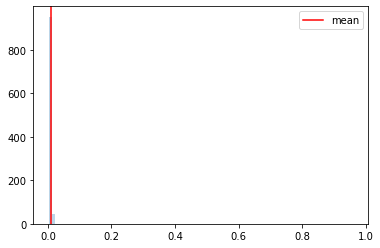

  0%|▏                                                                                | 3/1000 [00:00<01:01, 16.17it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654380460
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 0.1, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3


  0%|▍                                                                                | 5/1000 [00:00<02:02,  8.15it/s]

Monte Carlo 4
Monte Carlo 5


  1%|▌                                                                                | 7/1000 [00:00<02:13,  7.43it/s]

Monte Carlo 6
Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:01<02:03,  8.00it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 11/1000 [00:01<01:59,  8.29it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<01:56,  8.44it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<02:01,  8.13it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:02<01:55,  8.52it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<01:59,  8.22it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<01:54,  8.53it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:50,  8.85it/s]

Monte Carlo 22
Monte Carlo 23
Monte Carlo 24

  2%|██                                                                              | 25/1000 [00:02<01:46,  9.20it/s]


Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<01:45,  9.23it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<01:50,  8.79it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:06,  7.68it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<02:04,  7.78it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<01:53,  8.52it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<01:49,  8.81it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<01:58,  8.11it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<01:57,  8.13it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<01:50,  8.68it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:55,  8.29it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:53,  8.38it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:53,  8.37it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<01:53,  8.37it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<01:54,  8.29it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:54,  8.24it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<01:53,  8.32it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<01:52,  8.39it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:51,  8.44it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<01:53,  8.25it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<01:52,  8.32it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<01:56,  8.01it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<01:57,  7.94it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<01:52,  8.23it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<01:53,  8.15it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<01:55,  8.00it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:20,  6.58it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:15,  6.82it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:09<02:16,  6.73it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:14,  6.83it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:14,  6.81it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<02:10,  7.01it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:01,  7.50it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:09,  7.01it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:10,  6.95it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<02:12,  6.84it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:13,  6.75it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:04,  7.25it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:05,  7.14it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:01,  7.37it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:02,  7.30it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:02,  7.32it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:00,  7.39it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:00,  7.40it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:02,  7.27it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<01:58,  7.45it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:07,  6.95it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:08,  6.83it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:06,  6.94it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<02:05,  6.98it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:12,  6.59it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:11,  6.64it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████                                                                     | 128/1000 [00:16<02:12,  6.56it/s]

Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:17<02:30,  5.78it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:17<02:13,  6.50it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:17<02:05,  6.90it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:17<02:14,  6.41it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:18<02:20,  6.12it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:18<02:12,  6.49it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:18<02:07,  6.75it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:19<02:11,  6.53it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:19<02:09,  6.58it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:19<02:17,  6.18it/s]

Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:19<02:16,  6.26it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:11,  6.44it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:10,  6.50it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:20<02:07,  6.62it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:14,  6.28it/s]

Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:21<02:12,  6.36it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:21<02:11,  6.39it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:18,  6.07it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:22<02:19,  5.98it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:22<02:21,  5.88it/s]

Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:27,  5.64it/s]

Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:27,  5.66it/s]

Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:25,  5.73it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:23<02:26,  5.67it/s]

Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:23<02:24,  5.75it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:28,  5.55it/s]

Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:25,  5.66it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:24<02:20,  5.86it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:29,  5.47it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:28,  5.51it/s]

Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:28,  5.50it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:25<02:26,  5.56it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:33,  5.32it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:29,  5.45it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:26<02:25,  5.59it/s]

Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:23,  5.66it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:27<02:19,  5.78it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:18,  5.81it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:26,  5.47it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:29,  5.37it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:32,  5.25it/s]

Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:30,  5.33it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:21,  5.62it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:26,  5.42it/s]

Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:25,  5.47it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:30<02:23,  5.52it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:30<02:24,  5.49it/s]

Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:26,  5.38it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:30<02:26,  5.37it/s]

Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:31<02:27,  5.35it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:31,  5.20it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:27,  5.31it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:26,  5.36it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:32<02:31,  5.18it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:35,  5.02it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:31,  5.16it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:33<02:33,  5.06it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▌                                                             | 223/1000 [00:33<02:44,  4.73it/s]

Monte Carlo 223


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:48,  4.60it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:45,  4.69it/s]

Monte Carlo 225
Monte Carlo 226


 23%|█████████████████▉                                                             | 227/1000 [00:34<02:47,  4.61it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 228/1000 [00:34<02:54,  4.43it/s]

Monte Carlo 228


 23%|██████████████████                                                             | 229/1000 [00:34<02:56,  4.38it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:51,  4.48it/s]

Monte Carlo 230


 23%|██████████████████▏                                                            | 231/1000 [00:35<02:51,  4.47it/s]

Monte Carlo 231


 23%|██████████████████▎                                                            | 232/1000 [00:35<02:50,  4.50it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:50,  4.50it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:42,  4.71it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:36<02:33,  4.97it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:32,  5.00it/s]

Monte Carlo 238
Monte Carlo 239


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:29,  5.08it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 241/1000 [00:37<02:33,  4.95it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:37<02:30,  5.02it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:30,  5.03it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:28,  5.10it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:38<02:23,  5.24it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:38<02:26,  5.12it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:27,  5.09it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:25,  5.14it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:39<02:24,  5.17it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:39<02:27,  5.08it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:39<02:23,  5.21it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:39<02:22,  5.24it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:22,  5.23it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:40<02:30,  4.93it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:40<02:28,  4.99it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:40<02:26,  5.07it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:41<02:23,  5.15it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:41<02:24,  5.11it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:21,  5.20it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:21,  5.21it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:42<02:41,  4.53it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▏                                                         | 268/1000 [00:42<02:44,  4.45it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:35,  4.69it/s]

Monte Carlo 269
Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:43<02:33,  4.76it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:43<02:30,  4.85it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:27,  4.94it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:25,  4.99it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:44<02:25,  4.97it/s]

Monte Carlo 275
Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:28,  4.87it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:45<02:32,  4.73it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:45<02:32,  4.73it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:45<02:29,  4.82it/s]

Monte Carlo 281
Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:31,  4.72it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:46<02:28,  4.81it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:46<02:32,  4.68it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:28,  4.78it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:31,  4.70it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:47<02:34,  4.60it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:47<02:32,  4.66it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:27,  4.78it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:48<02:28,  4.77it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:48<02:24,  4.87it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:48<02:25,  4.85it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:23,  4.88it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:49<02:26,  4.78it/s]

Monte Carlo 299
Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:49<02:29,  4.67it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:28,  4.70it/s]

Monte Carlo 302
Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:50<02:28,  4.69it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:50<02:32,  4.56it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:24,  4.78it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:30,  4.61it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:51<02:29,  4.62it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:51<02:31,  4.55it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:51<02:30,  4.58it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:31,  4.55it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:52<02:29,  4.60it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:52<02:27,  4.63it/s]

Monte Carlo 314
Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:27,  4.62it/s]

Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:53<02:29,  4.57it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:53<02:34,  4.42it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<02:30,  4.52it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:29,  4.53it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:54<02:29,  4.54it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:54<02:34,  4.39it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:29,  4.52it/s]

Monte Carlo 324
Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:33,  4.39it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:55<02:30,  4.46it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:55<02:24,  4.66it/s]

Monte Carlo 328
Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:31,  4.42it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:56<02:34,  4.32it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:56<02:30,  4.45it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:56<02:30,  4.42it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:56<02:31,  4.40it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:57<02:30,  4.41it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:57<02:29,  4.44it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:57<02:32,  4.34it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:57<02:25,  4.54it/s]

Monte Carlo 338
Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:58<02:27,  4.46it/s]

Monte Carlo 340


 34%|███████████████████████████                                                    | 342/1000 [00:58<02:33,  4.28it/s]

Monte Carlo 341
Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:58<02:32,  4.31it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:59<02:31,  4.32it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:59<02:30,  4.34it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:59<02:27,  4.44it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:59<02:26,  4.47it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:26,  4.46it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:00<02:23,  4.54it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:00<02:22,  4.57it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:00<02:22,  4.57it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:00<02:25,  4.45it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:01<02:23,  4.50it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:01<02:29,  4.32it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:01<02:26,  4.40it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:01<02:26,  4.39it/s]

Monte Carlo 356


 36%|████████████████████████████▎                                                  | 358/1000 [01:02<02:22,  4.50it/s]

Monte Carlo 357
Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:02<02:25,  4.41it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:02<02:26,  4.38it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:02<02:26,  4.35it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:03<02:28,  4.29it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:03<02:25,  4.37it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:03<02:30,  4.23it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:03<02:30,  4.21it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:04<02:32,  4.17it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:04<02:36,  4.05it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:04<02:31,  4.17it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:04<02:30,  4.18it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:05<02:32,  4.14it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:05<02:32,  4.13it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:05<02:26,  4.27it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:05<02:25,  4.31it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:22,  4.40it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:06<02:20,  4.45it/s]

Monte Carlo 375


 38%|█████████████████████████████▊                                                 | 377/1000 [01:06<02:14,  4.62it/s]

Monte Carlo 376
Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:06<02:15,  4.59it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:07<02:19,  4.45it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:07<02:14,  4.60it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:07<02:14,  4.61it/s]

Monte Carlo 381


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:09,  4.77it/s]

Monte Carlo 382
Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:08<02:12,  4.66it/s]

Monte Carlo 384


 39%|██████████████████████████████▍                                                | 386/1000 [01:08<02:10,  4.71it/s]

Monte Carlo 385
Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:12,  4.64it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:12,  4.63it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:09<02:13,  4.57it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:09<02:19,  4.38it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:09<02:17,  4.43it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:16,  4.46it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:10<02:14,  4.51it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:10<02:14,  4.50it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:10<02:12,  4.55it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:14,  4.48it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:11<02:17,  4.38it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:11<02:16,  4.40it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:11<02:19,  4.31it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:11<02:19,  4.29it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:20,  4.27it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:12<02:23,  4.18it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:26,  4.08it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:26,  4.07it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:25,  4.09it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:13<02:26,  4.05it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:13<02:29,  3.96it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:34,  3.82it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:14<02:35,  3.79it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:14<02:33,  3.84it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:14<02:30,  3.91it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<02:28,  3.97it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:15<02:28,  3.97it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:15<02:31,  3.86it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:15<02:52,  3.40it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:49,  3.45it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:16<02:43,  3.56it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:16<02:38,  3.67it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:16<02:35,  3.73it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:17<02:34,  3.75it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:17<02:30,  3.85it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:17<02:30,  3.85it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:17<02:29,  3.85it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:18<02:29,  3.85it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:18<02:29,  3.86it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:18<02:32,  3.76it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:18<02:32,  3.76it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:19<02:28,  3.84it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:19<02:26,  3.90it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:19<02:25,  3.92it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:19<02:22,  4.00it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:20<02:23,  3.95it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:20<02:22,  3.99it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:20<02:19,  4.05it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:20<02:17,  4.10it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:21<02:20,  4.02it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:21<02:17,  4.10it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:21<02:15,  4.15it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:21<02:20,  3.99it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:22<02:20,  3.99it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:22<02:20,  3.99it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:22<02:19,  3.99it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:22<02:19,  3.99it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:23<02:31,  3.66it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:23<02:34,  3.58it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:23<02:38,  3.50it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:24<02:37,  3.51it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:24<02:37,  3.51it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:24<02:31,  3.63it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:24<02:26,  3.75it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:25<02:24,  3.81it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:25<02:23,  3.82it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:25<02:21,  3.86it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:25<02:19,  3.92it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:26<02:30,  3.63it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:26<02:26,  3.71it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:26<02:24,  3.77it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:26<02:20,  3.86it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:27<02:23,  3.78it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:27<02:23,  3.75it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:27<02:28,  3.62it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:26,  3.67it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:28<02:21,  3.79it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:28<02:23,  3.73it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:28<02:22,  3.75it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:29<02:19,  3.82it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:29<02:25,  3.66it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:29<02:22,  3.72it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:29<02:22,  3.72it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:30<02:26,  3.61it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:30<02:23,  3.68it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:30<02:22,  3.71it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:30<02:20,  3.74it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:31<02:26,  3.60it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:31<02:33,  3.42it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:31<02:30,  3.48it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:32<02:30,  3.47it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:32<02:28,  3.53it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:32<02:26,  3.55it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:32<02:25,  3.58it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:33<02:26,  3.53it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:33<02:22,  3.64it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:33<02:20,  3.68it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:34<02:17,  3.74it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:34<02:26,  3.52it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:34<02:28,  3.47it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:34<02:25,  3.53it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:35<02:24,  3.53it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:35<02:21,  3.60it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:35<02:22,  3.57it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:35<02:18,  3.66it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:36<02:17,  3.70it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:36<02:18,  3.67it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:36<02:19,  3.62it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:37<02:20,  3.59it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:37<02:22,  3.54it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:37<02:20,  3.58it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:37<02:17,  3.64it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:38<02:16,  3.67it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:38<02:18,  3.62it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:38<02:23,  3.48it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:39<02:20,  3.53it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:39<02:19,  3.56it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:39<02:14,  3.69it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:39<02:11,  3.76it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:40<02:14,  3.69it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:40<02:10,  3.77it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:40<02:09,  3.81it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:40<02:09,  3.80it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:41<02:12,  3.70it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:41<02:10,  3.76it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:41<02:07,  3.84it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:41<02:10,  3.73it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:42<02:11,  3.70it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:42<02:08,  3.76it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:42<02:12,  3.67it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:43<02:14,  3.59it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:43<02:17,  3.52it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:43<02:13,  3.59it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:43<02:11,  3.66it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:44<02:12,  3.63it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:44<02:12,  3.61it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:44<02:11,  3.63it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:45<02:09,  3.68it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:45<02:08,  3.71it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:45<02:09,  3.65it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:45<02:05,  3.77it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:46<02:08,  3.69it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:46<02:07,  3.69it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:46<02:04,  3.77it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:46<02:03,  3.81it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:47<02:22,  3.29it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:47<02:16,  3.41it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:47<02:10,  3.57it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:48<02:09,  3.60it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:48<02:09,  3.59it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:48<02:11,  3.52it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:48<02:10,  3.53it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:49<02:15,  3.40it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:49<02:14,  3.42it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:49<02:13,  3.44it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:50<02:15,  3.39it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:50<02:14,  3.40it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:50<02:13,  3.43it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:51<02:14,  3.38it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:51<02:19,  3.25it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:51<02:17,  3.30it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:51<02:15,  3.34it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:52<02:13,  3.38it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:52<02:14,  3.34it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:52<02:17,  3.27it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:53<02:16,  3.28it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:53<02:18,  3.23it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:53<02:19,  3.21it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:54<02:17,  3.23it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:54<02:20,  3.16it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:54<02:20,  3.15it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:55<02:15,  3.27it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:55<02:17,  3.21it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:55<02:17,  3.19it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:55<02:20,  3.13it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:56<02:18,  3.17it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:56<02:14,  3.24it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:56<02:11,  3.31it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:57<02:11,  3.30it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:57<02:09,  3.34it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:57<02:08,  3.38it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:58<02:11,  3.29it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:58<02:14,  3.20it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:58<02:14,  3.20it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:59<02:16,  3.14it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:59<02:16,  3.13it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:59<02:14,  3.18it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:59<02:13,  3.20it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:00<02:12,  3.21it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:00<02:13,  3.17it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:00<02:11,  3.22it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:01<02:11,  3.21it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:01<02:13,  3.16it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:01<02:11,  3.19it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:02<02:12,  3.16it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:02<02:10,  3.21it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:02<02:10,  3.19it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:03<02:10,  3.20it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:03<02:08,  3.23it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:03<02:07,  3.23it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:04<02:09,  3.19it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:04<02:13,  3.10it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:04<02:11,  3.12it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:05<02:10,  3.14it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:05<02:12,  3.09it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:05<02:15,  3.02it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:06<02:13,  3.05it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:06<02:13,  3.05it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:06<02:12,  3.07it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:07<02:11,  3.07it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:07<02:09,  3.10it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:07<02:08,  3.12it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:07<02:06,  3.17it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:08<02:07,  3.13it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:08<02:12,  3.00it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:08<02:10,  3.06it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:09<02:11,  3.01it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:09<02:11,  3.01it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:09<02:10,  3.02it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:10<02:07,  3.08it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:10<02:09,  3.03it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:10<02:06,  3.11it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:11<02:06,  3.08it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:11<02:07,  3.07it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:11<02:06,  3.07it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:12<02:06,  3.06it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:12<02:08,  3.00it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:12<02:09,  2.99it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:13<02:06,  3.03it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:13<02:10,  2.95it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:13<02:06,  3.04it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:14<02:05,  3.04it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:14<02:05,  3.05it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:14<02:05,  3.02it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:15<02:05,  3.03it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:15<02:04,  3.05it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:15<02:05,  3.01it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:16<02:05,  3.00it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:16<02:03,  3.05it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:16<02:04,  3.01it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:17<02:07,  2.92it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:17<02:03,  3.01it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:17<02:06,  2.94it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:18<02:06,  2.93it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:18<02:06,  2.91it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:18<02:04,  2.95it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:19<02:04,  2.96it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:19<02:01,  3.01it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:19<01:59,  3.05it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:20<02:01,  3.01it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:20<02:02,  2.96it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:20<02:01,  2.97it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:21<02:02,  2.95it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:21<02:03,  2.91it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:21<02:00,  2.99it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:22<01:57,  3.04it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:22<01:56,  3.08it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:22<02:00,  2.95it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:23<01:59,  2.97it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:23<01:59,  2.95it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:23<01:57,  3.00it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:24<01:58,  2.97it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:24<01:57,  3.00it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:24<01:56,  3.01it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:25<01:57,  2.96it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:25<01:59,  2.91it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:26<02:01,  2.86it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:26<02:00,  2.87it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:26<01:58,  2.90it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:27<02:01,  2.84it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:27<01:58,  2.89it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:27<02:11,  2.59it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:28<02:05,  2.72it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:28<02:03,  2.75it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:28<02:00,  2.82it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:29<01:57,  2.87it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:29<01:58,  2.84it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:29<02:00,  2.80it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:30<01:57,  2.84it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:30<01:57,  2.83it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:30<01:53,  2.92it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:31<01:55,  2.87it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:31<01:53,  2.91it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:32<01:52,  2.93it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:32<01:50,  2.97it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:32<01:55,  2.83it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:33<01:53,  2.89it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:33<01:51,  2.91it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:33<01:52,  2.88it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:34<01:52,  2.89it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:34<01:50,  2.93it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:34<01:50,  2.91it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:35<01:50,  2.89it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:35<01:48,  2.94it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:35<01:49,  2.90it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:36<01:48,  2.92it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:36<01:50,  2.88it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:36<01:49,  2.87it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:37<01:48,  2.92it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:37<01:48,  2.89it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:37<01:52,  2.79it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:38<01:50,  2.83it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:38<01:50,  2.80it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:38<01:50,  2.81it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:39<01:45,  2.92it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:39<01:44,  2.94it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:39<01:44,  2.95it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:40<01:43,  2.95it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:40<01:44,  2.93it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:40<01:40,  3.02it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:41<01:39,  3.04it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:41<01:38,  3.07it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:41<01:38,  3.07it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:42<01:38,  3.03it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:42<01:40,  2.99it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:42<01:41,  2.93it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:43<01:41,  2.94it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:43<01:39,  2.97it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:43<01:38,  3.01it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:44<01:38,  2.97it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:44<01:39,  2.95it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:44<01:40,  2.91it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:45<01:41,  2.88it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:45<01:40,  2.90it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:46<01:39,  2.89it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:46<01:36,  2.98it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:46<01:36,  2.96it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:47<01:35,  3.00it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:47<01:35,  2.99it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:47<01:34,  2.99it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:48<01:33,  3.03it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:48<01:34,  2.97it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:48<01:34,  2.97it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:49<01:33,  3.01it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:49<01:36,  2.88it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:49<01:36,  2.88it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:50<01:35,  2.90it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:50<01:36,  2.85it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:50<01:35,  2.87it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:51<01:34,  2.91it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:51<01:33,  2.91it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:51<01:32,  2.94it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:52<01:30,  2.98it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:52<01:30,  2.98it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:52<01:31,  2.95it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:53<01:32,  2.90it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:53<01:30,  2.94it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:53<01:29,  2.96it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:54<01:29,  2.96it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:54<01:29,  2.96it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:54<01:31,  2.88it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:55<01:30,  2.91it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:55<01:28,  2.96it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:55<01:27,  2.95it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:56<01:28,  2.93it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:56<01:29,  2.88it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:56<01:32,  2.77it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:57<01:31,  2.81it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:57<01:34,  2.70it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:58<01:35,  2.67it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:58<01:35,  2.64it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:58<01:34,  2.67it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:59<01:33,  2.69it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:59<01:33,  2.67it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:59<01:33,  2.67it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:00<01:42,  2.42it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:00<01:38,  2.51it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:01<01:36,  2.56it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:01<01:34,  2.60it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:01<01:32,  2.65it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:02<01:31,  2.65it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:02<01:31,  2.64it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:03<01:38,  2.46it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:03<01:34,  2.53it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:03<01:33,  2.57it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:04<01:32,  2.57it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:04<01:31,  2.59it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:05<01:30,  2.60it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:05<01:28,  2.67it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:05<01:29,  2.60it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:06<01:28,  2.63it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:06<01:28,  2.62it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:06<01:27,  2.63it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:07<01:27,  2.62it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:07<01:26,  2.64it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:08<01:27,  2.62it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:08<01:26,  2.61it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:08<01:26,  2.60it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:09<01:24,  2.66it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:09<01:24,  2.65it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:10<01:24,  2.64it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:10<01:24,  2.64it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:10<01:22,  2.66it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:11<01:22,  2.67it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:11<01:25,  2.55it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:11<01:24,  2.59it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:12<01:22,  2.64it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:12<01:23,  2.57it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:13<01:23,  2.56it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:13<01:22,  2.59it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:13<01:23,  2.55it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:14<01:23,  2.54it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:14<01:24,  2.50it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:15<01:25,  2.47it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:15<01:23,  2.49it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:15<01:25,  2.43it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:16<01:26,  2.38it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:16<01:27,  2.36it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:17<01:28,  2.31it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:17<01:29,  2.28it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:18<01:27,  2.32it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:18<01:24,  2.38it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:18<01:21,  2.45it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:19<01:19,  2.51it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:19<01:18,  2.54it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:20<01:17,  2.56it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:20<01:16,  2.58it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:20<01:15,  2.60it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:21<01:15,  2.57it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:21<01:14,  2.61it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:21<01:15,  2.55it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:22<01:14,  2.58it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:22<01:14,  2.55it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:23<01:13,  2.57it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:23<01:13,  2.56it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:23<01:14,  2.53it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:24<01:12,  2.59it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:24<01:12,  2.55it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:25<01:12,  2.56it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:25<01:11,  2.57it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:25<01:11,  2.56it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:26<01:10,  2.57it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:26<01:09,  2.60it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:27<01:09,  2.60it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:27<01:08,  2.63it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:27<01:09,  2.57it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:28<01:09,  2.55it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:28<01:09,  2.52it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:28<01:08,  2.57it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:29<01:09,  2.51it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:29<01:08,  2.53it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:30<01:07,  2.54it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:30<01:06,  2.57it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:30<01:05,  2.60it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:31<01:03,  2.65it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:31<01:03,  2.64it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:32<01:03,  2.63it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:32<01:03,  2.61it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:32<01:02,  2.63it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:33<01:02,  2.62it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:33<01:01,  2.65it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:33<01:00,  2.67it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:34<00:59,  2.69it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:34<01:00,  2.63it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:35<00:59,  2.67it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:35<00:59,  2.63it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:35<01:03,  2.46it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:36<01:00,  2.56it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:36<01:00,  2.57it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:37<00:59,  2.60it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:37<00:59,  2.58it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:37<00:58,  2.62it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:38<00:58,  2.57it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:38<00:58,  2.58it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:39<00:58,  2.56it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:39<00:57,  2.57it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:39<00:58,  2.51it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:40<00:57,  2.56it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:40<00:55,  2.59it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:40<00:56,  2.55it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:41<00:55,  2.60it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:41<00:55,  2.57it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:42<00:58,  2.39it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:42<00:56,  2.48it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:42<00:56,  2.46it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:43<00:55,  2.49it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:43<00:53,  2.56it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:44<00:54,  2.51it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:44<00:52,  2.55it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:44<00:52,  2.57it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:45<00:51,  2.59it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:45<00:50,  2.60it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:46<00:50,  2.61it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:46<00:49,  2.63it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:46<00:49,  2.58it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:47<00:50,  2.55it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:47<00:49,  2.57it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:48<00:50,  2.51it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:48<00:49,  2.50it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:48<00:50,  2.47it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:49<00:50,  2.44it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:49<00:50,  2.43it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:50<00:49,  2.44it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:50<00:49,  2.43it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:50<00:49,  2.42it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:51<00:49,  2.38it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:51<00:48,  2.41it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:52<00:47,  2.43it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:52<00:47,  2.41it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:53<00:47,  2.40it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:53<00:46,  2.41it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:53<00:46,  2.42it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:54<00:45,  2.44it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:54<00:44,  2.45it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:55<00:44,  2.43it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:55<00:45,  2.39it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:55<00:44,  2.39it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:56<00:44,  2.36it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:56<00:44,  2.34it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:57<00:44,  2.35it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:57<00:44,  2.34it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:58<00:44,  2.29it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:58<00:44,  2.28it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:58<00:43,  2.29it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:59<00:43,  2.27it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:59<00:43,  2.25it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:00<00:43,  2.25it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:00<00:43,  2.21it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:01<00:43,  2.20it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:01<00:43,  2.16it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:02<00:44,  2.11it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:02<00:43,  2.10it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:03<00:43,  2.10it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:03<00:42,  2.12it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:04<00:40,  2.22it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:04<00:39,  2.24it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:04<00:39,  2.23it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:05<00:37,  2.30it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:05<00:36,  2.30it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:06<00:36,  2.31it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:06<00:35,  2.32it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:07<00:35,  2.29it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:07<00:35,  2.28it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:07<00:34,  2.33it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:08<00:33,  2.33it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:08<00:33,  2.33it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:09<00:32,  2.34it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:09<00:32,  2.33it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:10<00:33,  2.26it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:10<00:32,  2.30it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:10<00:31,  2.31it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:11<00:31,  2.30it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:11<00:30,  2.32it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:12<00:30,  2.27it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:12<00:29,  2.30it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:13<00:29,  2.29it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:13<00:30,  2.23it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:14<00:29,  2.27it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:14<00:28,  2.28it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:14<00:27,  2.31it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:15<00:27,  2.33it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:15<00:26,  2.31it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:16<00:26,  2.30it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:16<00:25,  2.31it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:17<00:25,  2.29it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:17<00:25,  2.28it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:17<00:25,  2.26it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:18<00:24,  2.25it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:18<00:24,  2.23it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:19<00:23,  2.28it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:19<00:23,  2.25it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:20<00:22,  2.28it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:20<00:22,  2.28it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:21<00:21,  2.28it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:21<00:21,  2.30it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:21<00:20,  2.29it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:22<00:20,  2.30it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:22<00:20,  2.29it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:23<00:19,  2.30it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:23<00:19,  2.24it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:24<00:19,  2.20it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:24<00:19,  2.18it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:25<00:18,  2.17it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:25<00:18,  2.20it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:26<00:18,  2.07it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:26<00:18,  2.10it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:26<00:17,  2.17it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:27<00:16,  2.20it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:27<00:16,  2.10it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:28<00:16,  2.02it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:29<00:16,  1.96it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:29<00:15,  2.03it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:29<00:14,  2.09it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:30<00:14,  2.13it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:30<00:13,  2.16it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:31<00:12,  2.21it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:31<00:12,  2.19it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:32<00:11,  2.17it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:32<00:11,  2.16it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:33<00:10,  2.21it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:33<00:10,  2.24it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:33<00:09,  2.23it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:34<00:09,  2.22it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:34<00:09,  2.22it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:35<00:08,  2.21it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:35<00:08,  2.21it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:36<00:07,  2.20it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:36<00:07,  2.23it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:37<00:06,  2.23it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:37<00:06,  2.24it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:38<00:05,  2.23it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:38<00:05,  2.23it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:38<00:04,  2.21it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:39<00:04,  2.21it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:39<00:03,  2.25it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:40<00:03,  2.29it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:40<00:03,  2.32it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:41<00:02,  2.26it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:41<00:02,  2.25it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:41<00:01,  2.29it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:42<00:01,  2.30it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:42<00:00,  2.30it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:43<00:00,  2.29it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:43<00:00,  3.52it/s]


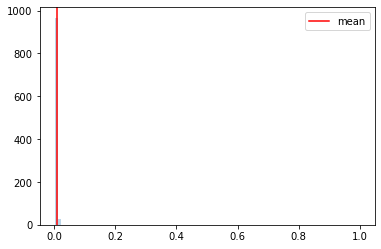

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654380745
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 1.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<00:58, 16.99it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:24, 11.72it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 9/1000 [00:00<01:39,  9.98it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▉                                                                               | 11/1000 [00:01<01:35, 10.32it/s]

Monte Carlo 9
Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<01:41,  9.70it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<01:43,  9.49it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▍                                                                              | 18/1000 [00:01<01:42,  9.62it/s]

Monte Carlo 16
Monte Carlo 17
Monte Carlo 18
Monte Carlo 19


  2%|█▊                                                                              | 22/1000 [00:02<01:40,  9.74it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:39,  9.78it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<01:41,  9.60it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:02<01:45,  9.18it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▍                                                                             | 30/1000 [00:03<01:46,  9.15it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<01:48,  8.92it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<01:56,  8.29it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:03<01:54,  8.43it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:03<01:57,  8.20it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<02:03,  7.77it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<02:02,  7.84it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:04<02:00,  7.94it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:04<01:55,  8.30it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:51,  8.53it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:53,  8.35it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:05<01:54,  8.27it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:05<01:49,  8.66it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:51,  8.46it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<02:02,  7.69it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:06<01:56,  8.05it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:06<02:02,  7.69it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:02,  7.63it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<02:00,  7.78it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:07<01:53,  8.19it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:07<01:56,  8.01it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:18,  6.70it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<02:13,  6.97it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:08<01:59,  7.76it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<01:55,  8.01it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<01:56,  7.92it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:09<01:57,  7.81it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:09<01:53,  8.09it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:02,  7.47it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<02:09,  7.06it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:10<02:03,  7.38it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:10<02:04,  7.32it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:02,  7.39it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<02:01,  7.45it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:11<02:03,  7.30it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:05,  7.18it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<01:59,  7.50it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:12<01:55,  7.73it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:12<02:01,  7.37it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:07,  7.01it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:01,  7.36it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:13<01:56,  7.63it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:13<01:52,  7.89it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<01:54,  7.76it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:14<02:05,  7.02it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:14<02:01,  7.25it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:00,  7.32it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<01:58,  7.40it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:15<01:56,  7.48it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:15<02:00,  7.24it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<01:59,  7.26it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:16<02:07,  6.82it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:16<02:02,  7.10it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:16<01:59,  7.22it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:17<02:00,  7.19it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:17<02:01,  7.11it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:17<02:00,  7.16it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:18<02:02,  6.98it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:18<02:02,  7.00it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:18<02:12,  6.46it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:19<02:20,  6.04it/s]

Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:19<02:26,  5.82it/s]

Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:19<02:23,  5.93it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:19<02:15,  6.23it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:20<02:16,  6.21it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:20<02:22,  5.93it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:20<02:15,  6.23it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:21<02:21,  5.94it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:21<02:15,  6.19it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:21<02:17,  6.07it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:16,  6.11it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:22<02:23,  5.79it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:22<02:32,  5.44it/s]

Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:22<02:34,  5.34it/s]

Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:23<02:31,  5.46it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:23<02:24,  5.72it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:23<02:26,  5.62it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:24<02:29,  5.50it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:24<02:29,  5.48it/s]

Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:24<02:28,  5.52it/s]

Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:24<02:26,  5.60it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:25<02:31,  5.39it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:25<02:42,  5.02it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:25<02:44,  4.93it/s]

Monte Carlo 187
Monte Carlo 188


 19%|██████████████▉                                                                | 189/1000 [00:26<02:46,  4.87it/s]

Monte Carlo 189


 19%|███████████████                                                                | 190/1000 [00:26<02:54,  4.64it/s]

Monte Carlo 190


 19%|███████████████                                                                | 191/1000 [00:26<03:00,  4.48it/s]

Monte Carlo 191


 19%|███████████████▏                                                               | 192/1000 [00:26<02:54,  4.64it/s]

Monte Carlo 192


 19%|███████████████▏                                                               | 193/1000 [00:27<02:58,  4.51it/s]

Monte Carlo 193


 19%|███████████████▎                                                               | 194/1000 [00:27<02:58,  4.51it/s]

Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:27<03:11,  4.20it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:28<03:00,  4.46it/s]

Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:48,  4.76it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:31,  5.27it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:28<02:23,  5.56it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:21,  5.64it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:29<02:21,  5.61it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:29<02:23,  5.52it/s]

Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:30<02:27,  5.36it/s]

Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:27,  5.36it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:30<02:25,  5.42it/s]

Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:30<02:25,  5.41it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:30<02:26,  5.39it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:24,  5.42it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:19,  5.62it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:19,  5.59it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:20,  5.56it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:26,  5.31it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:25,  5.36it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:32<02:21,  5.51it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:33<02:23,  5.41it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:26,  5.28it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:33<02:21,  5.45it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:33<02:22,  5.43it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:25,  5.29it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:28,  5.17it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:23,  5.34it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:24,  5.29it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:23,  5.32it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:23,  5.29it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:35<02:23,  5.30it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:35<02:22,  5.32it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:19,  5.44it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:21,  5.37it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:26,  5.18it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:36<02:27,  5.13it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:36<02:24,  5.23it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:26,  5.14it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:26,  5.14it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:28,  5.06it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▋                                                           | 249/1000 [00:37<02:31,  4.97it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:33,  4.87it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:29,  4.99it/s]

Monte Carlo 251
Monte Carlo 252


 25%|███████████████████▉                                                           | 253/1000 [00:38<02:37,  4.74it/s]

Monte Carlo 253


 25%|████████████████████                                                           | 254/1000 [00:38<02:37,  4.73it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 255/1000 [00:38<02:38,  4.71it/s]

Monte Carlo 255


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:38,  4.68it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:39<02:34,  4.80it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:33,  4.81it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:29,  4.93it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:40<02:28,  4.96it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:26,  5.04it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:24,  5.10it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:24,  5.10it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:41<02:27,  4.98it/s]

Monte Carlo 265
Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:41<02:25,  5.03it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:27,  4.93it/s]

Monte Carlo 269
Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:29,  4.88it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:30,  4.81it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:29,  4.86it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:35,  4.64it/s]

Monte Carlo 276
Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:35,  4.65it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:43<02:38,  4.55it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:44<02:38,  4.53it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:36,  4.60it/s]

Monte Carlo 281
Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:34,  4.63it/s]

Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:33,  4.67it/s]

Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:35,  4.59it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:32,  4.68it/s]

Monte Carlo 286
Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:31,  4.71it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:46<02:29,  4.75it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:46<02:29,  4.76it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:32,  4.65it/s]

Monte Carlo 292
Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:47<02:37,  4.48it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:31,  4.65it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:28,  4.72it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:48<02:31,  4.64it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:36,  4.46it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:48<02:28,  4.70it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:26,  4.77it/s]

Monte Carlo 302
Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:49<02:28,  4.67it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:49<02:30,  4.61it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:30,  4.61it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:29,  4.64it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:32,  4.54it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:50<02:31,  4.56it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:26,  4.70it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:51<02:26,  4.70it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:26,  4.68it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:30,  4.55it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:51<02:32,  4.49it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:24,  4.73it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:25,  4.68it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:27,  4.62it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:26,  4.64it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:53<02:24,  4.71it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:25,  4.64it/s]

Monte Carlo 323
Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:53<02:29,  4.50it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:30,  4.48it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:23,  4.69it/s]

Monte Carlo 327
Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:54<02:31,  4.42it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:30,  4.47it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:55<02:34,  4.34it/s]

Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:27,  4.51it/s]

Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:55<02:25,  4.58it/s]

Monte Carlo 333
Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:24,  4.59it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:29,  4.45it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:27,  4.48it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:56<02:27,  4.50it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:57<02:28,  4.45it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:28,  4.45it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:27,  4.47it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:28,  4.42it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:27,  4.46it/s]

Monte Carlo 343
Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:27,  4.43it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:29,  4.37it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:26,  4.45it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:34,  4.22it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:51,  3.79it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:43,  3.97it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:39,  4.06it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:00<02:36,  4.15it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:00<02:31,  4.27it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:32,  4.24it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:31,  4.25it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:01<02:29,  4.32it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:34,  4.17it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:33,  4.17it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:31,  4.23it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:02<02:32,  4.21it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:02<02:30,  4.23it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:27,  4.32it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:30,  4.24it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:30,  4.21it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:03<02:32,  4.16it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:29,  4.25it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:26,  4.31it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:24,  4.36it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:04<02:20,  4.48it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:22,  4.43it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:23,  4.39it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:24,  4.36it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:05<02:24,  4.35it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:21,  4.42it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:21,  4.41it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:27,  4.24it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:23,  4.33it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:06<02:23,  4.32it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:23,  4.34it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:25,  4.25it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:25,  4.26it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:07<02:26,  4.23it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:24,  4.28it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:26,  4.20it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:21,  4.34it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:08<02:20,  4.35it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:20,  4.36it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:23,  4.28it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:24,  4.24it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:09<02:26,  4.15it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:09<02:24,  4.21it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:25,  4.18it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:28,  4.08it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:25,  4.16it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:10<02:25,  4.17it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:25,  4.14it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:24,  4.18it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:22,  4.21it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:11<02:20,  4.26it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:11<02:19,  4.29it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:20,  4.25it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:16,  4.37it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:18,  4.31it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:17,  4.33it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:15,  4.39it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:15,  4.39it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:13,  4.44it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:13,  4.44it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:13<02:13,  4.42it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:17,  4.29it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:17,  4.30it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<02:20,  4.18it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:18,  4.24it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:19,  4.19it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:23,  4.07it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:20,  4.15it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:15<02:19,  4.17it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:22,  4.07it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:23,  4.04it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:16<02:25,  4.00it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:16<02:27,  3.92it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:23,  4.02it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:26,  3.93it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:24,  3.99it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:17<02:24,  3.98it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:25,  3.94it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:25,  3.93it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:23,  3.98it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:24,  3.96it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:25,  3.92it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:22,  4.01it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:19,  4.07it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:23,  3.94it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:22,  3.98it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:24,  3.92it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:26,  3.86it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:25,  3.87it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:24,  3.89it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:20<02:21,  3.95it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:22,  3.94it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:21<02:21,  3.95it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:21<02:21,  3.94it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:21<02:19,  4.01it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:22<02:20,  3.97it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:22<02:19,  3.97it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:22<02:20,  3.95it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:22<02:21,  3.91it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:23<02:36,  3.53it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:23<02:31,  3.63it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:23<02:29,  3.67it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:29,  3.68it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:24<02:24,  3.79it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:24<02:25,  3.75it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:24<02:23,  3.82it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:23,  3.80it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:25<02:32,  3.57it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:25<02:30,  3.61it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:25<02:25,  3.73it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:22,  3.80it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:26<02:25,  3.72it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:26<02:27,  3.65it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:26,  3.67it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:27<02:26,  3.66it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:27<02:28,  3.60it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:27<02:32,  3.52it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:28<02:29,  3.57it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:28<02:26,  3.65it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:28<02:26,  3.63it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:29<02:22,  3.72it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:29<02:22,  3.73it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:29<02:20,  3.76it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:29<02:21,  3.72it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:30<02:24,  3.65it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:22,  3.68it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:30<02:20,  3.72it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:30<02:21,  3.70it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:31<02:22,  3.67it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:31<02:20,  3.72it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:31<02:18,  3.77it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:31<02:18,  3.76it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:32<02:19,  3.73it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:32<02:19,  3.70it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:32<02:22,  3.62it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:33<02:19,  3.69it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:33<02:18,  3.71it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:33<02:19,  3.70it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:33<02:20,  3.65it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:34<02:22,  3.59it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:34<02:20,  3.64it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:34<02:22,  3.59it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:35<02:24,  3.53it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:35<02:26,  3.47it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:35<02:24,  3.50it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:35<02:21,  3.57it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:36<02:23,  3.52it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:36<02:24,  3.50it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:36<02:21,  3.57it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:36<02:17,  3.66it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:37<02:15,  3.69it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:37<02:17,  3.63it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:37<02:17,  3.63it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:38<02:16,  3.66it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:38<02:13,  3.71it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:38<02:12,  3.73it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:38<02:17,  3.59it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:39<02:16,  3.63it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:39<02:16,  3.61it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:39<02:17,  3.58it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:39<02:16,  3.60it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:40<02:15,  3.61it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:40<02:20,  3.49it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:40<02:18,  3.52it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:41<02:18,  3.51it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:41<02:21,  3.43it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:41<02:20,  3.46it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:42<02:22,  3.41it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:42<02:21,  3.42it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:42<02:17,  3.50it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:42<02:16,  3.53it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:43<02:25,  3.29it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:43<02:21,  3.38it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:43<02:19,  3.44it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:44<02:20,  3.40it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:44<02:20,  3.39it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:44<02:20,  3.37it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:44<02:19,  3.40it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:45<02:15,  3.48it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:45<02:16,  3.46it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:45<02:14,  3.50it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:46<02:15,  3.48it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:46<02:14,  3.48it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:46<02:17,  3.41it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:46<02:15,  3.46it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:47<02:10,  3.57it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:47<02:09,  3.59it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:47<02:07,  3.65it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:48<02:03,  3.74it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:48<02:04,  3.72it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:48<02:07,  3.62it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:48<02:06,  3.65it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:49<02:06,  3.62it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:49<02:05,  3.65it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:49<02:05,  3.65it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:49<02:06,  3.60it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:50<02:07,  3.56it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:50<02:09,  3.50it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:50<02:13,  3.40it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:51<02:12,  3.42it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:51<02:09,  3.48it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:51<02:09,  3.47it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:51<02:06,  3.54it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:52<02:05,  3.56it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:52<02:07,  3.51it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:52<02:10,  3.41it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:53<02:09,  3.42it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:53<02:08,  3.47it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:53<02:09,  3.42it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:54<02:07,  3.45it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:54<02:07,  3.47it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:54<02:24,  3.04it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:55<02:16,  3.21it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:55<02:15,  3.24it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:55<02:09,  3.37it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:55<02:04,  3.52it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:56<02:02,  3.56it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:56<02:06,  3.42it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:56<02:03,  3.51it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:56<02:02,  3.51it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:57<02:03,  3.48it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:57<02:03,  3.49it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:57<02:06,  3.39it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:58<02:02,  3.49it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:58<02:03,  3.45it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:58<02:02,  3.48it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:59<02:04,  3.42it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:59<02:03,  3.42it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:59<02:05,  3.37it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:59<02:05,  3.36it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:00<02:03,  3.42it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:00<02:03,  3.40it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:00<02:05,  3.33it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:01<02:05,  3.34it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:01<02:01,  3.43it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:01<02:01,  3.42it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:01<01:59,  3.49it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:02<02:00,  3.45it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:02<02:00,  3.43it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:02<02:01,  3.40it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:03<02:00,  3.42it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:03<02:00,  3.41it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:03<02:00,  3.39it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:04<01:58,  3.43it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:04<02:00,  3.39it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:04<01:59,  3.39it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:04<01:59,  3.39it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:05<01:59,  3.39it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:05<02:02,  3.30it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:05<02:02,  3.29it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:06<01:59,  3.34it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:06<02:01,  3.29it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:06<02:05,  3.18it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:07<02:03,  3.22it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:07<02:00,  3.30it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:07<01:58,  3.35it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:07<01:56,  3.38it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:08<01:54,  3.44it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:08<01:57,  3.34it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:08<01:56,  3.36it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:09<01:58,  3.30it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:09<01:59,  3.28it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:09<02:00,  3.23it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:10<02:00,  3.23it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:10<02:00,  3.20it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:10<02:02,  3.14it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:11<02:05,  3.06it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:11<02:04,  3.08it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:11<02:06,  3.03it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:12<02:05,  3.03it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:12<02:05,  3.05it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:12<02:03,  3.07it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:13<02:01,  3.11it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:13<02:01,  3.10it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:13<02:05,  2.99it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:14<02:06,  2.97it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:14<02:07,  2.94it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:14<02:10,  2.87it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:15<02:08,  2.91it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:15<02:05,  2.96it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:15<02:06,  2.94it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:16<02:04,  2.98it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:16<02:04,  2.97it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:16<02:07,  2.90it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:17<02:05,  2.92it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:17<02:06,  2.90it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:17<02:03,  2.95it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:18<01:59,  3.04it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:18<01:59,  3.05it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:18<01:59,  3.03it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:19<02:02,  2.96it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:19<02:02,  2.93it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:19<02:00,  2.97it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:20<01:59,  3.00it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:20<01:57,  3.05it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:20<02:00,  2.97it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:21<02:01,  2.93it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:21<02:00,  2.94it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:21<01:59,  2.96it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:22<01:57,  3.00it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:22<01:56,  3.00it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:22<02:01,  2.88it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:23<02:02,  2.85it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:23<02:00,  2.88it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:23<01:58,  2.93it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:24<01:58,  2.92it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:24<01:57,  2.93it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:24<01:58,  2.91it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:25<01:57,  2.91it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:25<01:58,  2.88it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:25<01:59,  2.85it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:26<01:56,  2.91it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:26<01:55,  2.93it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:27<01:55,  2.92it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:27<01:55,  2.92it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:27<01:57,  2.86it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:28<02:08,  2.60it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:28<02:04,  2.69it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:28<02:01,  2.73it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:29<01:58,  2.80it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:29<01:55,  2.86it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:29<01:57,  2.82it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:30<01:58,  2.77it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:30<01:55,  2.83it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:30<01:53,  2.88it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:31<01:54,  2.86it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:31<01:57,  2.77it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:32<01:55,  2.80it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:32<01:54,  2.83it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:32<01:52,  2.87it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:33<01:50,  2.90it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:33<01:49,  2.91it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:33<01:52,  2.84it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:34<01:50,  2.87it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:34<01:51,  2.85it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:34<01:50,  2.85it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:35<01:50,  2.85it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:35<01:48,  2.89it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:35<01:47,  2.92it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:36<01:46,  2.93it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:36<01:46,  2.91it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:36<01:47,  2.89it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:37<01:46,  2.90it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:37<01:46,  2.89it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:37<01:50,  2.79it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:38<01:50,  2.77it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:38<01:47,  2.83it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:39<01:48,  2.81it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:39<01:48,  2.80it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:39<01:49,  2.76it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:40<01:46,  2.81it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:40<01:45,  2.83it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:40<01:47,  2.77it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:41<01:45,  2.83it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:41<01:45,  2.82it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:41<01:44,  2.83it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:42<01:44,  2.81it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:42<01:43,  2.84it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:42<01:44,  2.81it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:43<01:47,  2.72it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:43<01:45,  2.76it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:44<01:45,  2.74it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:44<01:43,  2.80it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:44<01:44,  2.77it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:45<01:42,  2.80it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:45<01:41,  2.83it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:45<01:42,  2.77it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:46<01:42,  2.77it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:46<01:40,  2.81it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:46<01:40,  2.80it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:47<01:39,  2.83it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:47<01:38,  2.85it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:47<01:37,  2.87it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:48<01:38,  2.83it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:48<01:39,  2.79it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:49<01:40,  2.75it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:49<01:46,  2.57it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:49<01:52,  2.43it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:50<01:56,  2.34it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:50<01:59,  2.29it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:51<01:55,  2.35it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:51<01:53,  2.37it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:52<01:49,  2.46it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:52<01:46,  2.53it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:52<01:44,  2.56it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:53<01:44,  2.55it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:53<01:43,  2.56it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:54<01:44,  2.52it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:54<01:46,  2.46it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:54<01:42,  2.56it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:55<01:41,  2.57it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:55<01:39,  2.61it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:55<01:37,  2.64it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:56<01:39,  2.61it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:56<01:35,  2.68it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:57<01:35,  2.67it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:57<01:37,  2.62it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:57<01:36,  2.63it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:58<01:36,  2.63it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:58<01:35,  2.65it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:59<01:42,  2.46it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:59<01:45,  2.38it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:59<01:47,  2.31it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:00<01:48,  2.28it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:00<01:46,  2.32it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:01<01:41,  2.42it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:01<01:40,  2.44it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:01<01:39,  2.45it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:02<01:38,  2.47it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:02<01:36,  2.51it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:03<01:36,  2.51it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:03<01:39,  2.42it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:04<01:36,  2.48it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:04<01:34,  2.51it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:04<01:34,  2.50it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:05<01:34,  2.50it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:05<01:35,  2.46it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:06<01:34,  2.48it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:06<01:34,  2.46it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:06<01:35,  2.43it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:07<01:35,  2.42it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:07<01:36,  2.38it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:08<01:34,  2.43it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:08<01:32,  2.47it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:08<01:30,  2.50it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:09<01:31,  2.46it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:09<01:30,  2.47it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:10<01:32,  2.43it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:10<01:33,  2.39it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:10<01:32,  2.39it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:11<01:32,  2.40it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:11<01:31,  2.41it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:12<01:31,  2.40it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:12<01:30,  2.40it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:13<01:30,  2.39it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:13<01:32,  2.32it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:14<01:39,  2.17it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:14<01:35,  2.24it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:14<01:33,  2.29it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:15<01:33,  2.28it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:15<01:41,  2.07it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:16<01:37,  2.16it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:16<01:35,  2.20it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:17<01:30,  2.29it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:17<01:29,  2.31it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:18<01:30,  2.27it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:18<01:30,  2.27it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:18<01:30,  2.25it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:19<01:29,  2.27it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:19<01:26,  2.33it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:20<01:27,  2.31it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:20<01:25,  2.34it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:21<01:24,  2.36it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:21<01:22,  2.39it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:21<01:22,  2.40it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:22<01:21,  2.40it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:22<01:21,  2.38it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:23<01:22,  2.36it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:23<01:19,  2.42it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:23<01:20,  2.38it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:24<01:20,  2.36it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:24<01:22,  2.31it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:25<01:21,  2.33it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:25<01:19,  2.37it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:26<01:18,  2.37it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:26<01:18,  2.38it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:26<01:20,  2.31it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:27<01:17,  2.38it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:27<01:20,  2.27it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:28<01:19,  2.29it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:28<01:19,  2.27it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:29<01:19,  2.27it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:29<01:16,  2.35it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:29<01:14,  2.39it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:30<01:14,  2.38it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:30<01:17,  2.26it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:31<01:16,  2.28it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:31<01:15,  2.30it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:32<01:15,  2.29it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:32<01:14,  2.31it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:33<01:15,  2.27it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:33<01:13,  2.31it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:33<01:12,  2.32it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:34<01:12,  2.30it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:34<01:14,  2.23it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:35<01:12,  2.28it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:35<01:11,  2.30it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:36<01:10,  2.33it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:36<01:10,  2.31it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:36<01:09,  2.35it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:37<01:09,  2.33it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:37<01:10,  2.28it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:38<01:09,  2.28it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:38<01:10,  2.23it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:39<01:11,  2.21it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:39<01:09,  2.24it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:40<01:09,  2.22it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:40<01:09,  2.21it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:41<01:10,  2.18it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:41<01:08,  2.22it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:41<01:07,  2.24it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:42<01:05,  2.28it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:42<01:05,  2.29it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:43<01:09,  2.14it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:43<01:07,  2.19it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:44<01:06,  2.21it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:44<01:05,  2.23it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:45<01:03,  2.27it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:45<01:02,  2.29it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:45<01:03,  2.25it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:46<01:02,  2.27it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:46<01:02,  2.26it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:47<01:01,  2.27it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:47<01:01,  2.24it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:48<01:01,  2.23it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:48<01:01,  2.22it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:49<01:00,  2.22it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:49<01:00,  2.22it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:49<00:59,  2.22it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:50<01:00,  2.17it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:50<00:59,  2.21it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:51<00:58,  2.22it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:51<00:59,  2.17it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:52<00:56,  2.25it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:52<00:54,  2.31it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:53<00:53,  2.33it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:53<00:52,  2.36it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:53<00:52,  2.35it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:54<00:56,  2.17it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:54<00:53,  2.27it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:55<00:53,  2.25it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:55<00:52,  2.27it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:56<00:51,  2.30it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:56<00:50,  2.35it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:56<00:48,  2.39it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:57<00:49,  2.37it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:57<00:48,  2.37it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:58<00:47,  2.40it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:58<00:46,  2.44it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:58<00:45,  2.44it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:59<00:46,  2.38it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:59<00:46,  2.38it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:00<00:45,  2.39it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:00<00:44,  2.42it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:01<00:44,  2.41it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:01<00:44,  2.40it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:01<00:43,  2.40it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:02<00:43,  2.39it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:02<00:43,  2.39it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:03<00:44,  2.31it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:03<00:43,  2.31it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:04<00:42,  2.35it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:04<00:41,  2.37it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:04<00:41,  2.38it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:05<00:40,  2.41it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:05<00:40,  2.38it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:06<00:40,  2.37it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:06<00:39,  2.36it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:07<00:39,  2.34it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:07<00:38,  2.39it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:07<00:38,  2.39it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:08<00:37,  2.40it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:08<00:36,  2.41it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:09<00:36,  2.39it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:09<00:36,  2.38it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:09<00:36,  2.36it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:10<00:35,  2.38it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:10<00:36,  2.33it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:11<00:35,  2.34it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:11<00:34,  2.37it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:12<00:34,  2.38it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:12<00:32,  2.46it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:12<00:31,  2.47it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:13<00:31,  2.51it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:13<00:31,  2.47it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:14<00:31,  2.43it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:14<00:30,  2.45it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:14<00:30,  2.46it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:15<00:29,  2.46it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:15<00:28,  2.50it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:16<00:29,  2.43it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:16<00:28,  2.44it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:16<00:28,  2.42it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:17<00:28,  2.40it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:17<00:28,  2.35it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:18<00:28,  2.35it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:18<00:27,  2.37it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:19<00:27,  2.36it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:19<00:26,  2.34it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:19<00:26,  2.33it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:20<00:26,  2.26it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:20<00:27,  2.20it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:21<00:27,  2.16it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:21<00:26,  2.23it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:22<00:25,  2.23it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:22<00:24,  2.25it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:23<00:24,  2.23it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:23<00:23,  2.26it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:23<00:23,  2.26it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:24<00:22,  2.27it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:24<00:22,  2.27it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:25<00:22,  2.23it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:25<00:21,  2.28it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:26<00:21,  2.26it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:26<00:20,  2.25it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:27<00:20,  2.28it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:27<00:19,  2.25it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:27<00:19,  2.26it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:28<00:18,  2.28it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:28<00:18,  2.26it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:29<00:18,  2.27it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:29<00:17,  2.32it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:30<00:16,  2.33it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:30<00:16,  2.32it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:30<00:15,  2.32it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:31<00:15,  2.36it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:31<00:14,  2.37it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:32<00:14,  2.37it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:32<00:14,  2.35it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:33<00:13,  2.35it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:33<00:13,  2.37it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:34<00:13,  2.22it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:34<00:12,  2.29it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:34<00:12,  2.31it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:35<00:11,  2.35it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:35<00:10,  2.37it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:36<00:10,  2.34it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:36<00:09,  2.40it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:36<00:09,  2.42it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:37<00:09,  2.35it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:37<00:08,  2.35it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:38<00:08,  2.39it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:38<00:08,  2.36it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:39<00:07,  2.31it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:39<00:07,  2.29it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:39<00:06,  2.31it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:40<00:06,  2.36it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:40<00:05,  2.37it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:41<00:05,  2.34it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:41<00:05,  2.38it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:42<00:04,  2.33it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:42<00:04,  2.30it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:42<00:04,  2.24it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:43<00:03,  2.26it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:43<00:03,  2.27it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:44<00:02,  2.32it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:44<00:02,  2.29it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:45<00:01,  2.31it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:45<00:01,  2.30it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:46<00:00,  2.30it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:46<00:00,  2.25it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:46<00:00,  3.49it/s]


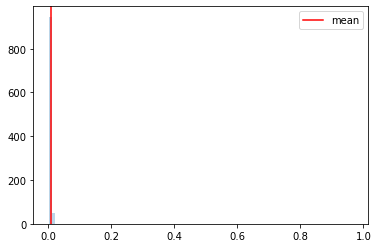

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654381032
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 1.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▍                                                                                | 5/1000 [00:00<01:20, 12.34it/s]

Monte Carlo 3
Monte Carlo 4
Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:50,  9.01it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:55,  8.57it/s]

Monte Carlo 9
Monte Carlo 10


  1%|█                                                                               | 13/1000 [00:01<01:52,  8.78it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:58,  8.32it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:57,  8.38it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<01:58,  8.31it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<02:01,  8.07it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:56,  8.42it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:54,  8.55it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:52,  8.65it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:56,  8.32it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:08,  7.57it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:22,  6.81it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:08,  7.49it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:14,  7.18it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<02:08,  7.51it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<02:04,  7.73it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<02:04,  7.72it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<02:05,  7.64it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<02:10,  7.32it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<02:07,  7.47it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:06<02:03,  7.69it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<02:02,  7.76it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<02:04,  7.60it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:07<02:03,  7.63it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<02:02,  7.68it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<02:00,  7.81it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<02:00,  7.81it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:08<02:00,  7.75it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:08<02:03,  7.54it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:08<02:05,  7.40it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:08<02:07,  7.31it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:09<02:09,  7.16it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:09<02:16,  6.77it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<02:14,  6.85it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:10<02:11,  7.02it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▎                                                                         | 79/1000 [00:10<02:06,  7.26it/s]

Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:30,  6.12it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:20,  6.54it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:11<02:11,  6.95it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:07,  7.15it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:04,  7.30it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:07,  7.12it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:03,  7.32it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:08,  7.04it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:11,  6.88it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:13<02:14,  6.68it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:11,  6.81it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:09,  6.91it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:14<02:21,  6.32it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:13,  6.67it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:17,  6.47it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:18,  6.42it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<02:20,  6.30it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:15,  6.55it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:19,  6.33it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:16<02:14,  6.57it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:09,  6.78it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:13,  6.59it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:17<02:13,  6.56it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:19,  6.26it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:18,  6.27it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:18<02:13,  6.49it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:18<02:11,  6.60it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:13,  6.49it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:16,  6.34it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:19<02:19,  6.18it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:17,  6.27it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:20,  6.11it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:20<02:18,  6.17it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:19,  6.11it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:20,  6.04it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:21<02:19,  6.07it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<02:19,  6.06it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:18,  6.09it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:22<02:17,  6.12it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:18,  6.07it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:16,  6.15it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:23<02:19,  6.00it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:23<02:23,  5.82it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:20,  5.91it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:24<02:23,  5.81it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:19,  5.93it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:21,  5.85it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:25<02:19,  5.92it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:25<02:15,  6.06it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:14,  6.09it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:26<02:23,  5.73it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:26<02:21,  5.77it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:27<02:27,  5.51it/s]

Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:27<02:31,  5.37it/s]

Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:27<02:26,  5.54it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:27<02:32,  5.32it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:28<02:28,  5.47it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:28<02:21,  5.70it/s]

Monte Carlo 192
Monte Carlo 193


 19%|███████████████▎                                                               | 194/1000 [00:28<02:26,  5.51it/s]

Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:29<02:26,  5.49it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:29<02:25,  5.52it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:29<02:23,  5.57it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:30<02:19,  5.74it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:30<02:22,  5.60it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:31<02:45,  4.81it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:31<02:33,  5.16it/s]

Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:31<02:32,  5.19it/s]

Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:31<02:34,  5.11it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:31<02:30,  5.23it/s]

Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:32<02:25,  5.42it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:32<02:21,  5.54it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:32<02:19,  5.60it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:33<02:22,  5.50it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:33<02:31,  5.16it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:33<02:26,  5.33it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:34<02:19,  5.57it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:34<02:19,  5.55it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:34<02:16,  5.65it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:35<02:20,  5.47it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:35<02:23,  5.35it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:35<02:25,  5.26it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:22,  5.39it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:36<02:22,  5.36it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:36<02:28,  5.13it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:36<02:29,  5.08it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:37<02:26,  5.19it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:37<02:29,  5.09it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:37<02:26,  5.19it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:38<02:25,  5.18it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:38<02:22,  5.29it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:38<02:27,  5.11it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:38<02:22,  5.27it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:39<02:23,  5.23it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:39<02:21,  5.28it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:39<02:21,  5.29it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:39<02:19,  5.36it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:40<02:17,  5.43it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:40<02:18,  5.38it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:40<02:23,  5.16it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:40<02:27,  5.02it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:41<02:25,  5.10it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:41<02:24,  5.13it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:41<02:21,  5.22it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:41<02:20,  5.24it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:19,  5.28it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:42<02:21,  5.19it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:42<02:22,  5.15it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:42<02:21,  5.17it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:42<02:25,  5.05it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:22,  5.14it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:43<02:26,  4.98it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:43<02:32,  4.77it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:43<02:30,  4.83it/s]

Monte Carlo 272
Monte Carlo 273


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:32,  4.77it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:44<02:31,  4.79it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:44<02:28,  4.88it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:23,  5.05it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:44<02:20,  5.14it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:45<02:16,  5.27it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:20,  5.12it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:16,  5.24it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:46<02:13,  5.38it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:46<02:15,  5.25it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:15,  5.25it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:13,  5.34it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:47<02:14,  5.27it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:47<02:17,  5.15it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:17,  5.14it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:47<02:18,  5.09it/s]

Monte Carlo 293
Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:48<02:22,  4.93it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:21,  4.96it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:22,  4.92it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:48<02:19,  5.03it/s]

Monte Carlo 298
Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:49<02:20,  4.99it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:21,  4.92it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:19,  4.99it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:49<02:15,  5.14it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:50<02:18,  5.00it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:50<02:17,  5.03it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:19,  4.96it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:22,  4.86it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:27,  4.68it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:51<02:30,  4.60it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:27,  4.68it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:51<02:30,  4.55it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:52<02:29,  4.59it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:52<02:33,  4.45it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:33,  4.45it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:30,  4.54it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:53<02:33,  4.42it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<02:32,  4.47it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:53<02:29,  4.52it/s]

Monte Carlo 321
Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:54<02:34,  4.39it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:54<02:42,  4.17it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:36,  4.32it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:32,  4.41it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:32,  4.41it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:55<02:35,  4.33it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:55<02:36,  4.28it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:35,  4.32it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:55<02:32,  4.40it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:56<02:51,  3.90it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:56<02:43,  4.07it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:56<02:40,  4.14it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:36,  4.26it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 337/1000 [00:57<02:26,  4.51it/s]

Monte Carlo 336
Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:57<02:26,  4.53it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:57<02:28,  4.46it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:58<02:28,  4.45it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:58<02:27,  4.46it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:58<02:27,  4.46it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:58<02:28,  4.42it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:32,  4.30it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:59<02:30,  4.34it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:59<02:29,  4.38it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:59<02:29,  4.36it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:27,  4.43it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:00<02:26,  4.43it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:00<02:28,  4.36it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:00<02:29,  4.33it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:00<02:29,  4.35it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 354/1000 [01:01<02:30,  4.30it/s]

Monte Carlo 353
Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:01<02:31,  4.25it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:01<02:34,  4.17it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:34,  4.16it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 359/1000 [01:02<02:27,  4.36it/s]

Monte Carlo 358
Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:02<02:28,  4.31it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:02<02:35,  4.12it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:03<02:31,  4.22it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:03<02:30,  4.25it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:03<02:27,  4.31it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:03<02:29,  4.24it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:04<02:30,  4.22it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:04<02:28,  4.27it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:04<02:24,  4.37it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:04<02:24,  4.38it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:28,  4.25it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:05<02:27,  4.26it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:05<02:29,  4.19it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:05<02:27,  4.24it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:26,  4.27it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:06<02:25,  4.30it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:06<02:24,  4.30it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:06<02:21,  4.39it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:06<02:26,  4.25it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:07<02:25,  4.26it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:07<02:27,  4.19it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:07<02:31,  4.08it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:07<02:38,  3.90it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:08<02:33,  4.01it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:08<02:29,  4.11it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:08<02:32,  4.03it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:08<02:30,  4.07it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:09<02:26,  4.17it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:09<02:30,  4.07it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:09<02:28,  4.11it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:09<02:25,  4.18it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:10<02:24,  4.21it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:10<02:30,  4.03it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:10<02:28,  4.10it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:10<02:29,  4.05it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:11<02:27,  4.09it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:11<02:26,  4.12it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:11<02:26,  4.12it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:11<02:30,  4.01it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:12<02:37,  3.83it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:12<02:35,  3.87it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:12<02:34,  3.88it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:12<02:31,  3.95it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:13<02:28,  4.02it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:13<02:26,  4.07it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:13<02:26,  4.06it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:13<02:24,  4.12it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:14<02:22,  4.16it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:14<02:21,  4.18it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:14<02:28,  3.99it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:14<02:28,  3.98it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:15<02:34,  3.82it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:15<02:33,  3.82it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:15<02:35,  3.79it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:15<02:34,  3.79it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:16<02:30,  3.88it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:16<02:30,  3.88it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:16<02:26,  3.97it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:16<02:25,  4.01it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:17<02:25,  3.99it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:17<02:27,  3.93it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:17<02:24,  4.01it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:17<02:26,  3.94it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:18<02:26,  3.93it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:18<02:30,  3.82it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:18<02:32,  3.77it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:18<02:31,  3.79it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:19<02:26,  3.91it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:19<02:26,  3.91it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:19<02:25,  3.93it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:19<02:24,  3.95it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:20<02:22,  4.01it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:20<02:21,  4.02it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:20<02:17,  4.11it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:20<02:15,  4.16it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:21<02:13,  4.24it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:21<02:13,  4.22it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:21<02:10,  4.32it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:21<02:11,  4.27it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:22<02:10,  4.30it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:22<02:10,  4.30it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:22<02:12,  4.22it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:22<02:14,  4.16it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:23<02:19,  4.00it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:23<02:15,  4.09it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:23<02:16,  4.06it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:23<02:15,  4.10it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:24<02:15,  4.08it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:24<02:16,  4.04it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:24<02:21,  3.90it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:24<02:19,  3.95it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:25<02:17,  3.98it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:25<02:15,  4.03it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:25<02:14,  4.07it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:25<02:11,  4.14it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:11,  4.14it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:26<02:12,  4.12it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:26<02:15,  4.01it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:26<02:16,  3.97it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:27<02:19,  3.89it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:27<02:26,  3.69it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:27<02:26,  3.67it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:27,  3.64it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:28<02:26,  3.68it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:28<02:26,  3.66it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:28<02:25,  3.67it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:28<02:27,  3.62it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:29<02:25,  3.66it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:29<02:25,  3.67it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:29<02:21,  3.74it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:30<02:24,  3.66it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:30<02:25,  3.64it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:30<02:45,  3.18it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:31<02:38,  3.33it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:31<02:31,  3.47it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:31<02:26,  3.57it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:31<02:24,  3.62it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:32<02:23,  3.65it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:32<02:25,  3.59it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:32<02:27,  3.52it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:32<02:22,  3.65it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:33<02:19,  3.71it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:33<02:21,  3.65it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:33<02:25,  3.55it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:34<02:25,  3.54it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:34<02:24,  3.58it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:34<02:22,  3.60it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:34<02:21,  3.62it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:35<02:21,  3.63it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:35<02:20,  3.63it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:35<02:18,  3.67it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:35<02:22,  3.56it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:36<02:24,  3.52it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:36<02:26,  3.45it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:36<02:27,  3.44it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:37<02:30,  3.36it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:37<02:25,  3.47it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:37<02:24,  3.48it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:37<02:23,  3.49it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:38<02:24,  3.47it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:38<02:24,  3.47it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:38<02:22,  3.50it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:39<02:25,  3.43it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:39<02:21,  3.51it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:39<02:23,  3.45it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:40<02:22,  3.47it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:40<02:25,  3.40it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:40<02:26,  3.37it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:40<02:28,  3.32it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:41<02:23,  3.42it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:41<02:21,  3.45it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:41<02:20,  3.49it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:42<02:19,  3.51it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:42<02:18,  3.52it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:42<02:18,  3.50it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:42<02:19,  3.48it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:43<02:23,  3.37it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:43<02:18,  3.48it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:43<02:18,  3.47it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:44<02:15,  3.54it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:44<02:14,  3.56it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:44<02:12,  3.62it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:44<02:12,  3.61it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:45<02:16,  3.49it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:45<02:19,  3.42it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:45<02:20,  3.38it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:46<02:17,  3.44it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:46<02:20,  3.36it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:46<02:21,  3.33it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:46<02:17,  3.43it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:47<02:19,  3.36it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:47<02:19,  3.37it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:47<02:17,  3.40it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:48<02:18,  3.37it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:48<02:19,  3.34it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:48<02:19,  3.33it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:49<02:17,  3.38it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:49<02:16,  3.40it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:49<02:15,  3.40it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:49<02:16,  3.37it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:50<02:16,  3.38it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:50<02:16,  3.35it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:50<02:16,  3.37it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:51<02:20,  3.24it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:51<02:20,  3.26it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:51<02:19,  3.25it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:52<02:17,  3.29it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:52<02:23,  3.17it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:52<02:23,  3.14it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:53<02:25,  3.09it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:53<02:32,  2.96it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:53<02:32,  2.93it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:54<02:30,  2.97it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:54<02:24,  3.09it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:54<02:21,  3.15it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:55<02:17,  3.23it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:55<02:15,  3.28it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:55<02:29,  2.97it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:56<02:32,  2.90it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:56<02:33,  2.87it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:56<02:38,  2.78it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:57<02:31,  2.90it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:57<02:24,  3.03it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:57<02:24,  3.02it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:58<02:22,  3.05it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:58<02:21,  3.07it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:58<02:21,  3.07it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:59<02:19,  3.11it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:59<02:17,  3.14it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:59<02:19,  3.10it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:59<02:13,  3.23it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:00<02:29,  2.87it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:00<02:22,  3.01it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:01<02:17,  3.11it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:01<02:10,  3.26it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:01<02:09,  3.28it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:01<02:06,  3.34it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:02<02:06,  3.34it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:02<02:04,  3.39it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:02<02:03,  3.40it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:03<02:02,  3.42it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:03<02:02,  3.41it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:03<02:02,  3.40it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:03<02:03,  3.38it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:04<02:06,  3.30it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:04<02:05,  3.31it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:04<02:09,  3.21it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:05<02:08,  3.21it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:05<02:09,  3.18it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:05<02:09,  3.17it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:06<02:08,  3.18it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:06<02:08,  3.19it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:06<02:08,  3.18it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:07<02:10,  3.12it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:07<02:13,  3.04it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:07<02:14,  3.01it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:08<02:11,  3.06it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:08<02:13,  3.02it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:08<02:16,  2.95it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:09<02:14,  2.98it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:09<02:11,  3.04it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:09<02:08,  3.09it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:10<02:10,  3.04it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:10<02:11,  3.03it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:10<02:10,  3.04it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:11<02:12,  2.98it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:11<02:09,  3.03it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:11<02:13,  2.95it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:12<02:09,  3.03it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:12<02:09,  3.02it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:12<02:07,  3.07it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:13<02:08,  3.03it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:13<02:09,  2.99it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:13<02:08,  3.02it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:14<02:08,  3.00it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:14<02:07,  3.03it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:14<02:08,  2.99it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:15<02:07,  3.00it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:15<02:07,  3.00it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:15<02:05,  3.04it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:16<02:04,  3.05it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:16<02:06,  3.00it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:16<02:07,  2.96it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:17<02:07,  2.96it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:17<02:10,  2.89it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:17<02:08,  2.92it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:18<02:02,  3.05it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:18<01:59,  3.12it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:18<01:56,  3.19it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:18<01:55,  3.23it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:19<01:52,  3.29it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:19<01:53,  3.24it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:19<01:55,  3.18it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:20<01:52,  3.26it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:20<01:53,  3.23it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:20<01:54,  3.20it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:21<01:56,  3.14it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:21<01:56,  3.13it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:21<01:55,  3.14it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:22<01:56,  3.11it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:22<01:55,  3.11it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:22<01:56,  3.07it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:23<01:59,  2.99it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:23<01:55,  3.10it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:23<01:57,  3.02it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:24<01:59,  2.98it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:24<01:59,  2.96it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:24<01:59,  2.96it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:25<01:59,  2.94it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:25<01:59,  2.95it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:25<01:59,  2.93it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:26<01:57,  2.98it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:26<01:58,  2.93it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:26<01:58,  2.94it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:27<01:57,  2.95it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:27<01:58,  2.91it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:27<01:55,  2.97it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:28<01:56,  2.96it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:28<01:56,  2.93it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:28<01:57,  2.91it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:29<01:56,  2.91it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:29<01:56,  2.92it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:29<01:59,  2.82it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:30<01:56,  2.90it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:30<01:59,  2.82it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:31<01:57,  2.84it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:31<01:57,  2.83it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:31<01:57,  2.83it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:32<02:05,  2.64it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:32<02:06,  2.61it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:32<02:01,  2.71it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:33<01:57,  2.79it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:33<01:57,  2.78it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:33<01:58,  2.75it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:34<01:58,  2.74it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:34<01:54,  2.83it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:35<01:55,  2.81it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:35<01:52,  2.87it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:35<01:52,  2.85it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:36<01:51,  2.87it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:36<01:51,  2.87it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:36<01:52,  2.83it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:37<01:50,  2.89it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:37<01:49,  2.90it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:37<01:50,  2.87it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:38<01:49,  2.87it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:38<01:51,  2.81it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:38<01:51,  2.82it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:39<01:48,  2.88it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:39<01:44,  2.98it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:39<01:43,  2.98it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:40<01:43,  3.00it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:40<01:42,  3.02it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:40<01:42,  2.99it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:41<01:40,  3.04it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:41<01:39,  3.07it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:41<01:42,  2.96it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:42<01:42,  2.95it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:42<01:42,  2.94it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:42<01:43,  2.90it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:43<01:42,  2.92it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:43<01:41,  2.94it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:43<01:43,  2.88it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:44<01:41,  2.91it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:44<01:43,  2.86it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:44<01:42,  2.89it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:45<01:41,  2.91it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:45<01:42,  2.87it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:46<01:44,  2.78it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:46<01:43,  2.80it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:46<01:41,  2.85it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:47<01:41,  2.86it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:47<01:40,  2.86it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:47<01:39,  2.88it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:48<01:39,  2.88it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:48<01:38,  2.88it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:48<01:42,  2.78it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:49<01:41,  2.79it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:49<01:40,  2.80it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:49<01:42,  2.74it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:50<01:40,  2.78it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:50<01:40,  2.77it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:51<01:41,  2.75it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:51<01:39,  2.78it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:51<01:38,  2.82it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:52<01:39,  2.77it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:52<01:37,  2.80it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:52<01:38,  2.77it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:53<01:39,  2.74it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:53<01:40,  2.70it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:53<01:42,  2.63it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:54<01:39,  2.69it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:54<01:38,  2.73it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:55<01:37,  2.74it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:55<01:38,  2.71it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:55<01:39,  2.65it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:56<01:38,  2.67it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:56<01:37,  2.71it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:56<01:36,  2.72it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:57<01:35,  2.74it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:57<01:37,  2.68it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:58<01:38,  2.62it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:58<01:35,  2.69it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:58<01:36,  2.67it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:59<01:36,  2.66it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:59<01:35,  2.67it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:59<01:34,  2.68it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:00<01:34,  2.67it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:00<01:32,  2.71it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:01<01:34,  2.67it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:01<01:31,  2.73it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:01<01:30,  2.74it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:02<01:34,  2.63it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:02<01:31,  2.69it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:02<01:30,  2.71it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:03<01:29,  2.74it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:03<01:31,  2.65it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:04<01:31,  2.67it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:04<01:29,  2.69it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:04<01:28,  2.71it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:05<01:28,  2.72it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:05<01:28,  2.70it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:05<01:28,  2.68it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:06<01:27,  2.71it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:06<01:24,  2.80it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:06<01:22,  2.86it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:07<01:22,  2.83it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:07<01:22,  2.84it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:07<01:19,  2.91it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:08<01:20,  2.88it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:08<01:19,  2.90it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:08<01:18,  2.91it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:09<01:19,  2.88it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:09<01:19,  2.85it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:09<01:18,  2.89it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:10<01:18,  2.86it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:10<01:19,  2.81it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:11<01:18,  2.84it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:11<01:18,  2.81it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:11<01:17,  2.84it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:12<01:18,  2.81it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:12<01:18,  2.79it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:12<01:18,  2.76it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:13<01:20,  2.71it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:13<01:18,  2.75it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:13<01:17,  2.76it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:14<01:17,  2.78it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:14<01:15,  2.80it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:15<01:17,  2.72it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:15<01:17,  2.71it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:15<01:24,  2.48it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:16<01:23,  2.52it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:16<01:22,  2.51it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:17<01:22,  2.50it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:17<01:20,  2.56it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:17<01:19,  2.58it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:18<01:20,  2.54it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:18<01:19,  2.56it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:19<01:17,  2.61it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:19<01:17,  2.58it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:19<01:17,  2.58it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:20<01:17,  2.57it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:20<01:17,  2.55it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:21<01:18,  2.50it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:21<01:17,  2.52it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:21<01:15,  2.57it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:22<01:15,  2.57it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:22<01:17,  2.48it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:22<01:15,  2.53it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:23<01:14,  2.55it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:23<01:14,  2.56it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:24<01:12,  2.59it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:24<01:13,  2.57it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:24<01:13,  2.55it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:25<01:12,  2.58it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:25<01:11,  2.60it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:26<01:10,  2.60it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:26<01:10,  2.58it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:26<01:10,  2.58it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:27<01:10,  2.57it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:27<01:09,  2.59it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:28<01:13,  2.44it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:28<01:12,  2.44it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:28<01:13,  2.42it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:29<01:11,  2.48it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:29<01:10,  2.48it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:30<01:09,  2.52it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:30<01:08,  2.51it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:30<01:07,  2.55it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:31<01:07,  2.55it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:31<01:07,  2.52it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:32<01:08,  2.47it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:32<01:09,  2.42it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:32<01:07,  2.48it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:33<01:06,  2.51it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:33<01:04,  2.54it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:34<01:05,  2.51it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:34<01:06,  2.44it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:34<01:08,  2.38it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:35<01:06,  2.43it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:35<01:04,  2.47it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:36<01:05,  2.43it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:36<01:05,  2.40it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:36<01:05,  2.41it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:37<01:04,  2.44it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:37<01:02,  2.46it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:38<01:03,  2.41it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:38<01:03,  2.40it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:39<01:04,  2.36it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:39<01:01,  2.44it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:39<01:01,  2.43it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:40<01:02,  2.38it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:40<01:01,  2.39it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:41<01:01,  2.40it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:41<00:59,  2.44it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:41<00:59,  2.45it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:42<00:58,  2.47it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:42<00:57,  2.48it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:43<00:59,  2.41it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:43<00:58,  2.40it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:44<00:58,  2.38it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:44<00:58,  2.38it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:44<00:57,  2.40it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:45<00:55,  2.45it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:45<00:55,  2.45it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:46<00:55,  2.43it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:46<00:55,  2.43it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:46<00:54,  2.42it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:47<00:54,  2.40it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:47<00:57,  2.29it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:48<00:56,  2.28it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:48<00:56,  2.30it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:49<00:53,  2.37it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:49<00:53,  2.37it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:49<00:53,  2.36it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:50<00:52,  2.38it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:50<00:51,  2.39it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:51<00:51,  2.40it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:51<00:51,  2.37it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:52<00:52,  2.31it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:52<00:50,  2.36it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:52<00:50,  2.36it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:53<00:49,  2.37it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:53<00:49,  2.35it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:54<00:48,  2.37it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:54<00:48,  2.35it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:55<00:48,  2.35it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:55<00:48,  2.32it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:55<00:49,  2.28it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:56<00:47,  2.33it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:56<00:46,  2.34it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:57<00:49,  2.19it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:57<00:48,  2.24it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:58<00:46,  2.29it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:58<00:45,  2.34it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:58<00:44,  2.34it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:59<00:44,  2.35it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:59<00:44,  2.31it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:00<00:44,  2.28it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:00<00:43,  2.30it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:01<00:43,  2.32it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:01<00:42,  2.34it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:01<00:41,  2.35it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:02<00:41,  2.34it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:02<00:40,  2.36it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:03<00:39,  2.38it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:03<00:39,  2.39it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:04<00:38,  2.39it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:04<00:37,  2.44it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:04<00:37,  2.45it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:05<00:35,  2.51it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:05<00:35,  2.49it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:06<00:35,  2.51it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:06<00:35,  2.47it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:06<00:34,  2.47it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:07<00:34,  2.44it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:07<00:33,  2.49it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:08<00:33,  2.46it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:08<00:33,  2.47it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:08<00:33,  2.40it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:09<00:33,  2.42it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:09<00:32,  2.45it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:10<00:31,  2.46it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:10<00:31,  2.41it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:10<00:31,  2.43it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:11<00:30,  2.46it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:11<00:29,  2.49it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:12<00:29,  2.47it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:12<00:29,  2.45it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:12<00:29,  2.43it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:13<00:29,  2.39it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:13<00:29,  2.36it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:14<00:29,  2.32it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:14<00:28,  2.36it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:15<00:27,  2.38it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:15<00:26,  2.42it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:15<00:26,  2.45it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:16<00:25,  2.47it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:16<00:24,  2.48it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:17<00:25,  2.44it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:17<00:24,  2.42it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:17<00:24,  2.39it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:18<00:24,  2.35it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:18<00:24,  2.35it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:19<00:24,  2.29it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:19<00:24,  2.25it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:20<00:23,  2.26it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:20<00:23,  2.24it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:21<00:23,  2.21it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:21<00:23,  2.18it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:22<00:22,  2.21it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:22<00:22,  2.22it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:22<00:21,  2.23it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:23<00:21,  2.19it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:23<00:20,  2.24it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:24<00:19,  2.26it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:24<00:19,  2.24it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:25<00:19,  2.23it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:25<00:18,  2.23it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:26<00:18,  2.25it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:26<00:17,  2.26it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:26<00:17,  2.23it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:27<00:16,  2.25it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:27<00:16,  2.25it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:28<00:15,  2.27it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:28<00:15,  2.28it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:29<00:15,  2.20it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:29<00:15,  2.18it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:30<00:14,  2.22it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:30<00:14,  2.17it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:31<00:13,  2.20it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:31<00:13,  2.21it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:31<00:12,  2.21it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:32<00:12,  2.19it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:32<00:11,  2.20it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:33<00:11,  2.20it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:33<00:10,  2.21it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:34<00:10,  2.20it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:34<00:09,  2.21it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:35<00:09,  2.22it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:35<00:09,  2.20it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:36<00:08,  2.17it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:36<00:08,  2.17it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:36<00:07,  2.21it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:37<00:07,  2.21it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:37<00:06,  2.22it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:38<00:06,  2.18it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:38<00:05,  2.20it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:39<00:05,  2.20it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:39<00:05,  2.18it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:40<00:04,  2.18it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:40<00:04,  2.07it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:41<00:03,  2.11it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:41<00:03,  2.14it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:42<00:02,  2.15it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:42<00:02,  2.16it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:42<00:01,  2.16it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:43<00:01,  2.18it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:43<00:00,  2.15it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:44<00:00,  2.16it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:44<00:00,  3.51it/s]


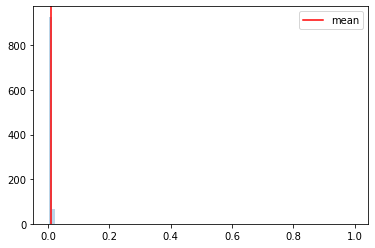

  0%|▏                                                                                | 2/1000 [00:00<00:52, 19.10it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654381318
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 1.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:55,  8.62it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:53,  8.73it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:51,  8.86it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:48,  9.09it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:46,  9.32it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:48,  9.11it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:59,  8.20it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:50,  8.88it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:48,  9.04it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:52,  8.71it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:50,  8.81it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:53,  8.56it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:51,  8.72it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:14,  7.24it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:07,  7.57it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<02:03,  7.81it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:03,  7.80it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<02:00,  7.96it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:59,  8.04it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<01:56,  8.19it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<02:01,  7.88it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<02:02,  7.81it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<02:00,  7.93it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:05<01:58,  7.99it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<01:58,  8.01it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<02:02,  7.71it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<02:01,  7.76it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<01:59,  7.88it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<01:57,  8.03it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<02:04,  7.52it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:07<02:04,  7.52it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:08<02:04,  7.51it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:08<02:03,  7.55it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:08<02:04,  7.49it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:08<02:07,  7.26it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:09<02:09,  7.14it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<02:07,  7.23it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:09<02:11,  7.01it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:10<02:18,  6.66it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:10<02:07,  7.19it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:10<02:11,  6.97it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:10<02:08,  7.13it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:11<02:09,  7.07it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:11<02:07,  7.15it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:11<02:06,  7.20it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▍                                                                        | 93/1000 [00:11<02:08,  7.04it/s]

Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:27,  6.14it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:14,  6.69it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:11,  6.87it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:08,  7.02it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:10,  6.89it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:10,  6.85it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:04,  7.14it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:02,  7.28it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:06,  7.00it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:10,  6.82it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:10,  6.81it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:05,  7.03it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:04,  7.08it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:12,  6.63it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:13,  6.59it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:15,  6.44it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:16,  6.41it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:12,  6.57it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:14,  6.48it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:18<02:36,  5.55it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:29,  5.78it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:19,  6.17it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:19<02:24,  5.95it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:22,  6.02it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:15,  6.33it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:18,  6.16it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:11,  6.50it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:09,  6.56it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:19,  6.07it/s]

Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:21<02:17,  6.17it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:21<02:14,  6.28it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:21<02:11,  6.40it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:22<02:16,  6.18it/s]

Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:17,  6.10it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:16,  6.15it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:16,  6.14it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:23<02:19,  5.99it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:19,  5.96it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:17,  6.04it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:15,  6.12it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:15,  6.12it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:22,  5.78it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:25<02:18,  5.93it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:17,  5.96it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:19,  5.86it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:26<02:21,  5.78it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:16,  5.98it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:25,  5.58it/s]

Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:27<02:22,  5.71it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:30,  5.38it/s]

Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:27,  5.49it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:28<02:18,  5.85it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:28<02:25,  5.55it/s]

Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:20,  5.74it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:18,  5.78it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:29<02:30,  5.32it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:33,  5.20it/s]

Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:25,  5.47it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:19,  5.72it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:11,  6.03it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:11,  6.03it/s]

Monte Carlo 207
Monte Carlo 208

 21%|████████████████▌                                                              | 209/1000 [00:30<02:13,  5.90it/s]


Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:31<02:08,  6.15it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:03,  6.36it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:10,  6.00it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:32<02:09,  6.05it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:05,  6.24it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:32,  5.13it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:33<02:27,  5.27it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:21,  5.47it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:20,  5.51it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:34<02:15,  5.70it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:13,  5.78it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:15,  5.66it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:17,  5.60it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:12,  5.78it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:17,  5.54it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:20,  5.42it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:15,  5.62it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:11,  5.76it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:17,  5.50it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:36<02:13,  5.68it/s]

Monte Carlo 243
Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:14,  5.62it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:13,  5.62it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:13,  5.62it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:19,  5.36it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:38<02:19,  5.35it/s]

Monte Carlo 252
Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:19,  5.33it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:21,  5.24it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:16,  5.43it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:10,  5.68it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:11,  5.62it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:09,  5.68it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:40<02:12,  5.55it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:11,  5.57it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:13,  5.48it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:41<02:13,  5.49it/s]

Monte Carlo 269
Monte Carlo 270


 27%|█████████████████████▍                                                         | 271/1000 [00:41<02:17,  5.31it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:42<02:16,  5.31it/s]

Monte Carlo 272
Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:42<02:19,  5.20it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:42<02:18,  5.24it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:16,  5.28it/s]

Monte Carlo 276


 28%|██████████████████████                                                         | 279/1000 [00:43<02:19,  5.16it/s]

Monte Carlo 277
Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:43<02:20,  5.12it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:20,  5.10it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:44<02:19,  5.13it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:17,  5.18it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:44<02:17,  5.20it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:14,  5.30it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:10,  5.47it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:45<02:10,  5.45it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:45<02:10,  5.44it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:45<02:13,  5.29it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:13,  5.28it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:46<02:17,  5.13it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:46<02:13,  5.26it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:46<02:12,  5.30it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:46<02:14,  5.24it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:47<02:12,  5.28it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:47<02:11,  5.35it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:47<02:10,  5.35it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:47<02:14,  5.20it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:47<02:13,  5.21it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:48<02:14,  5.16it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:48<02:12,  5.26it/s]

Monte Carlo 303
Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:48<02:15,  5.12it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:48<02:18,  5.00it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:49<02:17,  5.02it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:49<02:18,  4.98it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:49<02:19,  4.93it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:49<02:20,  4.90it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:50<02:22,  4.80it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:50<02:21,  4.84it/s]

Monte Carlo 314
Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:50<02:20,  4.88it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:50<02:27,  4.62it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:51<02:25,  4.69it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:51<02:24,  4.72it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:51<02:24,  4.70it/s]

Monte Carlo 320
Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:52<02:27,  4.60it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:52<02:26,  4.62it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:52<02:29,  4.52it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:53<02:27,  4.57it/s]

Monte Carlo 326
Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:53<02:25,  4.61it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:53<02:24,  4.66it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:53<02:22,  4.71it/s]

Monte Carlo 330
Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:54<02:26,  4.56it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:54<02:26,  4.55it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:54<02:25,  4.57it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:54<02:28,  4.48it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:55<02:25,  4.55it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:55<02:24,  4.60it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:55<02:23,  4.62it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:55<02:22,  4.63it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:55<02:26,  4.50it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:56<02:25,  4.52it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:56<02:28,  4.42it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:56<02:25,  4.52it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:56<02:34,  4.24it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:57<02:33,  4.26it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:57<02:31,  4.33it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:57<02:32,  4.29it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:57<02:30,  4.34it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:58<02:33,  4.23it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:58<02:41,  4.02it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:58<02:39,  4.06it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:58<02:37,  4.11it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:59<02:35,  4.17it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:59<02:29,  4.31it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [00:59<02:31,  4.25it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [00:59<02:29,  4.30it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [00:59<02:30,  4.27it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:00<02:30,  4.26it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:00<02:27,  4.36it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:00<02:26,  4.37it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:00<02:28,  4.31it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:01<02:28,  4.29it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:01<02:27,  4.33it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:01<02:27,  4.30it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:01<02:50,  3.73it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:02<02:44,  3.85it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:02<02:45,  3.82it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:02<02:44,  3.84it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:02<02:42,  3.87it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:03<02:39,  3.96it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:03<02:36,  4.03it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:03<02:35,  4.04it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:03<02:31,  4.13it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:04<02:28,  4.20it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:04<02:31,  4.13it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:04<02:31,  4.13it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:04<02:30,  4.14it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:29,  4.15it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:05<02:31,  4.11it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:05<02:29,  4.13it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:05<02:28,  4.16it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:32,  4.04it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:06<02:32,  4.06it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:06<02:33,  4.01it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:06<02:33,  4.00it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:31,  4.05it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:07<02:33,  3.99it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:07<02:32,  4.01it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:07<02:29,  4.09it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:34,  3.96it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:08<02:37,  3.86it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:08<02:35,  3.92it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:08<02:37,  3.86it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:35,  3.91it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:09<02:30,  4.01it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:09<02:30,  4.01it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:09<02:29,  4.04it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:33,  3.92it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:29,  4.02it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:10<02:25,  4.13it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:10<02:29,  4.01it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:27,  4.06it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:27,  4.04it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:11<02:23,  4.15it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:11<02:24,  4.11it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:23,  4.14it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:23,  4.13it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:12<02:25,  4.08it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:12<02:29,  3.96it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:27,  3.99it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:30,  3.91it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:13<02:30,  3.90it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:13<02:33,  3.81it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:29,  3.91it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:27,  3.97it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:14<02:23,  4.06it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:14<02:22,  4.09it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:20,  4.15it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:20,  4.14it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:15<02:18,  4.18it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:15<02:19,  4.15it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:21,  4.08it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:23,  4.02it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:16<02:25,  3.97it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:16<02:28,  3.88it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:25,  3.94it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:24,  3.98it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:17<02:26,  3.90it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:17<02:23,  3.98it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:20,  4.05it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:20,  4.06it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:18<02:22,  3.99it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:18<02:20,  4.03it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:20,  4.02it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:24,  3.91it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:19<02:23,  3.92it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:19<02:23,  3.92it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:23,  3.91it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:20<02:25,  3.87it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:20<02:23,  3.91it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:20<02:24,  3.88it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:21<02:25,  3.84it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:21<02:25,  3.83it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:21<02:26,  3.80it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:21<02:25,  3.81it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:22<02:24,  3.83it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:22<02:26,  3.79it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:22<02:29,  3.70it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:23<02:25,  3.78it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:23<02:29,  3.69it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:23<02:27,  3.72it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:23<02:26,  3.73it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:24<02:25,  3.75it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:24<02:23,  3.80it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:24<02:24,  3.77it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:24<02:27,  3.68it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:25<02:25,  3.73it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:25<02:27,  3.68it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:25<02:24,  3.73it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:25<02:24,  3.74it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:26<02:23,  3.75it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:26<02:22,  3.78it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:26<02:20,  3.83it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:27<02:20,  3.83it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:27<02:25,  3.69it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:27<02:21,  3.76it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:27<02:24,  3.70it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:28<02:24,  3.67it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:28<02:27,  3.60it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:28<02:22,  3.71it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:28<02:20,  3.77it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:29<02:26,  3.61it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:29<02:27,  3.58it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:29<02:23,  3.65it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:30<02:23,  3.66it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:30<02:19,  3.75it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:30<02:17,  3.80it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:30<02:13,  3.91it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:31<02:12,  3.94it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:31<02:10,  3.98it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:31<02:09,  4.01it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:31<02:14,  3.85it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:32<02:16,  3.78it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:32<02:14,  3.85it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:32<02:17,  3.75it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:32<02:15,  3.80it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:33<02:13,  3.85it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:33<02:15,  3.77it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:33<02:17,  3.73it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:33<02:18,  3.68it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:34<02:16,  3.73it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:34<02:19,  3.65it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:34<02:19,  3.65it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:35<02:17,  3.69it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:35<02:14,  3.75it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:35<02:13,  3.77it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:35<02:18,  3.63it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:36<02:19,  3.59it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:36<02:19,  3.59it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:36<02:19,  3.59it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:36<02:16,  3.66it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:37<02:18,  3.58it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:37<02:20,  3.53it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:37<02:17,  3.60it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:38<02:19,  3.55it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:38<02:34,  3.19it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:38<02:29,  3.30it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:39<02:29,  3.30it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:39<02:25,  3.37it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:39<02:25,  3.37it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:39<02:24,  3.38it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:40<02:23,  3.40it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:40<02:20,  3.47it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:40<02:25,  3.34it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:41<02:23,  3.39it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:41<02:23,  3.37it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:41<02:24,  3.34it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:42<02:22,  3.38it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:42<02:21,  3.41it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:42<02:24,  3.32it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:42<02:25,  3.30it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:43<02:24,  3.30it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:43<02:22,  3.36it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:43<02:24,  3.29it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:44<02:20,  3.39it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:44<02:17,  3.45it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:44<02:14,  3.51it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:44<02:17,  3.44it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:45<02:15,  3.48it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:45<02:17,  3.43it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:45<02:19,  3.37it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:46<02:17,  3.40it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:46<02:16,  3.42it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:46<02:21,  3.30it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:47<02:22,  3.27it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:47<02:22,  3.25it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:47<02:19,  3.31it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:47<02:19,  3.31it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:48<02:18,  3.33it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:48<02:20,  3.27it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:48<02:18,  3.32it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:49<02:25,  3.15it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:49<02:29,  3.06it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:49<02:25,  3.12it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:50<02:26,  3.10it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:50<02:25,  3.11it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:50<02:23,  3.16it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:51<02:20,  3.21it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:51<02:20,  3.21it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:51<02:23,  3.14it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:52<02:18,  3.24it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:52<02:22,  3.15it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:52<02:23,  3.12it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:53<02:19,  3.20it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:53<02:19,  3.19it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:53<02:18,  3.19it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:53<02:18,  3.19it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:54<02:17,  3.21it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:54<02:15,  3.25it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:54<02:15,  3.26it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:55<02:11,  3.33it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:55<02:12,  3.31it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:55<02:10,  3.35it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:56<02:10,  3.33it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:56<02:17,  3.15it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:56<02:19,  3.11it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:57<02:19,  3.11it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:57<02:18,  3.11it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:57<02:19,  3.10it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:58<02:20,  3.05it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:58<02:20,  3.05it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:58<02:23,  2.99it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:59<02:21,  3.02it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:59<02:23,  2.98it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:59<02:21,  3.00it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:00<02:18,  3.07it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:00<02:14,  3.16it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:00<02:16,  3.09it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:01<02:16,  3.08it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:01<02:16,  3.07it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:01<02:18,  3.03it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:02<02:19,  3.01it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:02<02:16,  3.05it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:02<02:18,  3.01it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:03<02:20,  2.94it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:03<02:16,  3.03it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:03<02:13,  3.10it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:03<02:12,  3.11it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:04<02:09,  3.17it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:04<02:08,  3.20it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:04<02:06,  3.23it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:05<02:07,  3.21it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:05<02:08,  3.17it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:05<02:09,  3.14it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:06<02:08,  3.16it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:06<02:08,  3.14it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:06<02:07,  3.16it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:07<02:08,  3.14it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:07<02:08,  3.13it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:07<02:07,  3.13it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:08<02:08,  3.12it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:08<02:08,  3.10it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:08<02:08,  3.09it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:09<02:05,  3.14it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:09<02:09,  3.06it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:09<02:09,  3.05it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:10<02:09,  3.05it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:10<02:05,  3.12it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:10<02:04,  3.13it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:11<02:08,  3.03it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:11<02:09,  2.99it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:11<02:09,  3.00it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:12<02:07,  3.04it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:12<02:19,  2.77it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:12<02:13,  2.89it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:13<02:10,  2.94it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:13<02:09,  2.96it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:13<02:05,  3.04it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:14<02:03,  3.09it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:14<02:05,  3.04it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:14<02:08,  2.94it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:15<02:05,  3.01it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:15<02:04,  3.03it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:15<02:08,  2.93it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:16<02:05,  2.99it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:16<02:06,  2.95it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:16<02:05,  2.96it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:17<02:03,  3.02it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:17<02:04,  2.98it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:17<02:07,  2.90it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:18<02:02,  3.01it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:18<01:59,  3.08it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:18<02:00,  3.06it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:19<01:56,  3.13it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:19<01:53,  3.21it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:19<01:53,  3.20it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:19<01:55,  3.14it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:20<01:54,  3.17it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:20<01:51,  3.24it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:20<01:52,  3.20it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:21<01:50,  3.24it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:21<01:48,  3.29it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:21<01:50,  3.24it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:22<01:47,  3.31it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:22<01:47,  3.31it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:22<01:47,  3.29it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:23<01:48,  3.25it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:23<01:49,  3.22it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:23<01:52,  3.12it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:23<01:51,  3.13it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:24<01:55,  3.03it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:24<01:49,  3.17it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:24<01:51,  3.13it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:25<01:48,  3.19it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:25<01:47,  3.22it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:25<01:47,  3.21it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:26<01:47,  3.18it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:26<01:46,  3.20it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:26<01:45,  3.22it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:27<01:47,  3.15it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:27<01:51,  3.05it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:27<01:48,  3.11it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:28<01:49,  3.07it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:28<01:48,  3.11it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:28<01:47,  3.10it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:29<01:47,  3.12it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:29<01:46,  3.12it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:29<01:46,  3.13it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:30<01:46,  3.12it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:30<01:43,  3.19it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:30<01:42,  3.20it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:30<01:45,  3.12it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:31<01:46,  3.07it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:31<01:45,  3.08it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:32<01:51,  2.93it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:32<01:49,  2.97it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:32<01:50,  2.92it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:33<01:50,  2.90it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:33<01:50,  2.91it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:33<01:48,  2.94it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:34<01:51,  2.86it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:34<01:50,  2.88it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:34<01:52,  2.81it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:35<01:53,  2.78it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:35<01:53,  2.78it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:35<01:50,  2.83it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:36<01:52,  2.77it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:36<01:53,  2.75it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:36<01:52,  2.77it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:37<01:49,  2.82it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:37<01:47,  2.87it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:38<01:47,  2.87it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:38<01:47,  2.87it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:38<01:46,  2.88it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:39<01:46,  2.85it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:39<01:48,  2.80it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:39<01:46,  2.86it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:40<01:45,  2.87it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:40<01:44,  2.88it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:40<01:43,  2.89it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:41<01:45,  2.83it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:41<01:45,  2.81it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:41<01:46,  2.78it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:42<01:45,  2.82it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:42<01:44,  2.83it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:42<01:43,  2.83it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:43<01:44,  2.80it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:43<01:45,  2.76it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:44<01:44,  2.79it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:44<01:43,  2.81it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:44<01:44,  2.78it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:45<01:44,  2.74it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:45<01:43,  2.78it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:45<01:41,  2.82it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:46<01:41,  2.81it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:46<01:42,  2.76it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:46<01:43,  2.73it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:47<01:43,  2.71it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:47<01:42,  2.74it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:48<01:40,  2.78it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:48<01:39,  2.80it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:48<01:38,  2.83it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:49<01:39,  2.78it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:49<01:39,  2.77it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:49<01:38,  2.78it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:50<01:39,  2.76it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:50<01:37,  2.79it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:50<01:36,  2.81it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:51<01:39,  2.74it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:51<01:39,  2.70it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:52<01:38,  2.74it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:52<01:40,  2.66it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:52<01:37,  2.73it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:53<01:36,  2.74it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:53<01:37,  2.71it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:53<01:37,  2.71it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:54<01:35,  2.76it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:54<01:33,  2.79it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:54<01:33,  2.80it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:55<01:33,  2.79it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:55<01:45,  2.46it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:56<01:43,  2.49it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:56<01:40,  2.56it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:56<01:38,  2.60it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:57<01:36,  2.65it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:57<01:35,  2.66it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:58<01:36,  2.63it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:58<01:34,  2.67it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:58<01:32,  2.70it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:59<01:34,  2.66it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:59<01:36,  2.59it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:59<01:33,  2.65it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:00<01:34,  2.62it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:00<01:34,  2.60it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:01<01:34,  2.58it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:01<01:34,  2.58it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:01<01:32,  2.63it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:02<01:31,  2.64it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:02<01:29,  2.69it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:02<01:30,  2.64it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:03<01:30,  2.65it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:03<01:33,  2.55it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:04<01:32,  2.56it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:04<01:32,  2.55it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:04<01:31,  2.57it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:05<01:29,  2.62it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:05<01:29,  2.61it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:06<01:28,  2.62it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:06<01:28,  2.62it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:06<01:28,  2.60it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:07<01:27,  2.60it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:07<01:29,  2.55it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:08<01:27,  2.60it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:08<01:26,  2.63it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:08<01:26,  2.59it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:09<01:25,  2.61it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:09<01:24,  2.65it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:09<01:24,  2.62it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:10<01:23,  2.63it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:10<01:25,  2.59it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:11<01:25,  2.58it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:11<01:23,  2.62it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:11<01:22,  2.64it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:12<01:22,  2.60it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:12<01:20,  2.66it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:12<01:18,  2.72it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:13<01:17,  2.73it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:13<01:16,  2.77it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:13<01:15,  2.79it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:14<01:14,  2.82it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:14<01:16,  2.72it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:15<01:15,  2.75it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:15<01:14,  2.76it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:15<01:14,  2.75it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:16<01:15,  2.73it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:16<01:15,  2.71it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:16<01:16,  2.66it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:17<01:14,  2.70it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:17<01:14,  2.70it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:18<01:13,  2.71it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:18<01:14,  2.69it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:18<01:14,  2.65it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:19<01:15,  2.62it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:19<01:15,  2.59it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:19<01:16,  2.57it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:20<01:14,  2.59it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:20<01:14,  2.58it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:21<01:15,  2.56it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:21<01:14,  2.56it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:21<01:14,  2.54it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:22<01:14,  2.54it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:22<01:14,  2.53it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:23<01:13,  2.56it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:23<01:12,  2.58it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:23<01:13,  2.53it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:24<01:12,  2.53it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:24<01:12,  2.52it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:25<01:13,  2.48it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:25<01:12,  2.49it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:25<01:11,  2.51it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:26<01:10,  2.52it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:26<01:11,  2.49it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:27<01:09,  2.54it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:27<01:10,  2.49it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:27<01:09,  2.50it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:28<01:10,  2.47it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:28<01:11,  2.44it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:29<01:09,  2.48it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:29<01:08,  2.48it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:29<01:07,  2.50it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:30<01:07,  2.49it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:30<01:08,  2.44it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:31<01:08,  2.44it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:31<01:07,  2.47it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:31<01:07,  2.45it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:32<01:06,  2.46it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:32<01:06,  2.45it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:33<01:06,  2.43it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:33<01:07,  2.38it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:34<01:05,  2.44it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:34<01:05,  2.42it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:34<01:05,  2.42it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:35<01:03,  2.46it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:35<01:08,  2.29it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:36<01:05,  2.36it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:36<01:09,  2.21it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:37<01:08,  2.25it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:37<01:06,  2.30it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:38<01:07,  2.23it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:38<01:07,  2.22it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:39<01:11,  2.10it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:39<01:13,  2.02it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:40<01:11,  2.05it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:40<01:08,  2.12it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:40<01:06,  2.18it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:41<01:05,  2.21it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:41<01:03,  2.24it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:42<01:01,  2.29it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:42<01:04,  2.18it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:43<01:02,  2.23it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:43<01:00,  2.31it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:43<00:58,  2.36it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:44<00:56,  2.41it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:44<00:55,  2.46it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:45<00:54,  2.48it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:45<00:54,  2.48it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:45<00:53,  2.50it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:46<00:53,  2.47it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:46<00:53,  2.45it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:47<00:52,  2.50it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:47<00:51,  2.52it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:47<00:51,  2.48it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:48<00:50,  2.53it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:48<00:50,  2.51it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:49<00:49,  2.50it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:49<00:49,  2.50it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:49<00:49,  2.51it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:50<00:48,  2.52it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:50<00:48,  2.49it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:51<00:47,  2.51it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:51<00:48,  2.46it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:51<00:47,  2.50it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:52<00:46,  2.54it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:52<00:46,  2.52it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:53<00:45,  2.55it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:53<00:45,  2.52it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:53<00:45,  2.50it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:54<00:44,  2.49it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:54<00:44,  2.48it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:55<00:44,  2.49it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:55<00:44,  2.43it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:55<00:43,  2.46it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:56<00:42,  2.51it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:56<00:42,  2.52it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:57<00:42,  2.49it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:57<00:42,  2.44it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:57<00:42,  2.40it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:58<00:42,  2.39it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:58<00:43,  2.33it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:59<00:42,  2.36it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:59<00:43,  2.30it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:00<00:41,  2.35it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:00<00:41,  2.31it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:00<00:41,  2.33it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:01<00:41,  2.28it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:01<00:41,  2.26it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:02<00:40,  2.30it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:02<00:39,  2.32it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:03<00:40,  2.23it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:03<00:39,  2.29it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:04<00:38,  2.30it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:04<00:37,  2.33it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:04<00:38,  2.25it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:05<00:38,  2.25it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:05<00:37,  2.28it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:06<00:36,  2.30it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:06<00:35,  2.31it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:07<00:35,  2.34it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:07<00:34,  2.35it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:07<00:34,  2.30it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:08<00:34,  2.31it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:08<00:33,  2.30it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:09<00:34,  2.22it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:09<00:33,  2.25it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:10<00:33,  2.26it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:10<00:32,  2.29it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:11<00:31,  2.31it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:11<00:31,  2.32it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:11<00:30,  2.35it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:12<00:30,  2.33it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:12<00:29,  2.31it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:13<00:29,  2.29it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:13<00:29,  2.31it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:14<00:28,  2.32it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:14<00:28,  2.32it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:14<00:27,  2.29it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:15<00:28,  2.23it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:15<00:27,  2.28it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:16<00:27,  2.26it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:16<00:27,  2.22it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:17<00:26,  2.22it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:17<00:25,  2.27it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:18<00:25,  2.25it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:18<00:24,  2.27it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:18<00:24,  2.28it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:19<00:23,  2.28it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:19<00:23,  2.27it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:20<00:24,  2.09it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:20<00:23,  2.15it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:21<00:23,  2.17it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:21<00:22,  2.21it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:22<00:21,  2.25it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:22<00:21,  2.23it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:22<00:20,  2.27it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:23<00:19,  2.26it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:23<00:19,  2.23it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:24<00:19,  2.20it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:24<00:18,  2.22it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:25<00:18,  2.21it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:25<00:18,  2.22it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:26<00:17,  2.25it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:26<00:16,  2.28it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:27<00:16,  2.23it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:27<00:16,  2.22it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:27<00:16,  2.17it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:28<00:15,  2.21it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:28<00:14,  2.21it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:29<00:14,  2.21it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:29<00:13,  2.23it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:30<00:13,  2.21it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:30<00:13,  2.23it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:31<00:12,  2.24it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:31<00:12,  2.25it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:31<00:11,  2.24it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:32<00:11,  2.24it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:32<00:10,  2.27it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:33<00:10,  2.22it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:33<00:09,  2.25it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:34<00:09,  2.22it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:34<00:09,  2.19it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:35<00:08,  2.17it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:35<00:08,  2.12it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:36<00:08,  1.94it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:36<00:08,  1.89it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:37<00:07,  1.89it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:37<00:07,  1.91it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:38<00:06,  1.93it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:38<00:06,  1.98it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:39<00:05,  1.94it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:39<00:05,  1.92it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:40<00:04,  1.92it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:41<00:04,  1.89it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:41<00:03,  1.92it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:42<00:03,  1.94it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:42<00:02,  1.96it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:43<00:02,  1.98it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:43<00:01,  1.94it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:44<00:01,  1.87it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:44<00:00,  1.91it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:45<00:00,  3.51it/s]


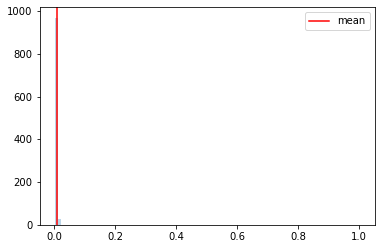

  0%|▏                                                                                | 2/1000 [00:00<01:09, 14.32it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654381604
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 10.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:49,  9.07it/s]

Monte Carlo 3
Monte Carlo 4
Monte Carlo 5


  1%|▌                                                                                | 7/1000 [00:00<02:27,  6.73it/s]

Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:01<02:30,  6.57it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<02:15,  7.31it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<02:18,  7.15it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<02:19,  7.06it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:02<02:25,  6.78it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<02:28,  6.63it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<02:20,  6.96it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:03<02:19,  7.03it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▊                                                                              | 23/1000 [00:03<02:15,  7.22it/s]

Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:03<02:43,  5.95it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<02:30,  6.48it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:04<02:20,  6.90it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:04<02:11,  7.39it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:04<02:09,  7.46it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:05<02:30,  6.41it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:05<02:30,  6.39it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:05<02:27,  6.50it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:05<02:20,  6.81it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:06<02:23,  6.68it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:06<02:28,  6.42it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:06<02:14,  7.09it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:07<02:17,  6.92it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:07<02:12,  7.15it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:07<02:25,  6.50it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:08<02:19,  6.78it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:08<02:19,  6.75it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:08<02:13,  7.03it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:08<02:11,  7.13it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:09<02:20,  6.66it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:09<02:14,  6.94it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:09<02:16,  6.85it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:10<02:19,  6.66it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:10<02:12,  7.02it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:10<02:19,  6.65it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:11<02:21,  6.55it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:11<02:18,  6.65it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:11<02:18,  6.65it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:11<02:29,  6.16it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:12<02:36,  5.85it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:12<02:24,  6.35it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:12<02:32,  5.98it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:13<02:27,  6.20it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:13<02:17,  6.59it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:13<02:20,  6.45it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:14<02:25,  6.22it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:14<02:34,  5.86it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:14<02:24,  6.25it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:15<02:31,  5.94it/s]

Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:15<02:25,  6.19it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:15<02:20,  6.40it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:15<02:23,  6.25it/s]

Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:16<02:30,  5.94it/s]

Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:16<02:26,  6.07it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:16<02:25,  6.12it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:17<02:28,  5.96it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:17<02:30,  5.90it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:17<02:24,  6.12it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:18<02:25,  6.07it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:18<02:18,  6.36it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:18<02:20,  6.24it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:18<02:21,  6.18it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:19<02:27,  5.93it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:19<02:21,  6.17it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:19<02:19,  6.23it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:20<02:19,  6.22it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:20<02:15,  6.38it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:20<02:17,  6.30it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:21<02:21,  6.10it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:21<02:20,  6.12it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:21<02:20,  6.12it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:22<02:21,  6.07it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:22<02:20,  6.09it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:22<02:24,  5.92it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:23<02:29,  5.70it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:23<02:23,  5.92it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████                                                                   | 153/1000 [00:23<02:28,  5.70it/s]

Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:24<02:27,  5.72it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:24<02:18,  6.08it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▍                                                                  | 158/1000 [00:24<02:12,  6.33it/s]

Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:25<02:37,  5.34it/s]

Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:25<02:25,  5.78it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:25<02:11,  6.34it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:25<02:19,  5.99it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:26<02:21,  5.87it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:26<02:19,  5.96it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:26<02:16,  6.07it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:27<02:24,  5.71it/s]

Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:27<02:28,  5.56it/s]

Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:27<02:19,  5.91it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:27<02:15,  6.09it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:28<02:17,  5.97it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:28<02:11,  6.22it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:28<02:09,  6.29it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:29<02:11,  6.18it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:29<02:15,  5.98it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:29<02:19,  5.81it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:30<02:22,  5.67it/s]

Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:30<02:22,  5.67it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:30<02:19,  5.76it/s]

Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:30<02:20,  5.74it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:31<02:27,  5.44it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:31<02:28,  5.38it/s]

Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:31<02:25,  5.48it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:32<02:21,  5.65it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:32<02:14,  5.90it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:32<02:19,  5.68it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:33<02:22,  5.54it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 209/1000 [00:33<02:18,  5.70it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:33<02:25,  5.43it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:34<02:19,  5.63it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:34<02:16,  5.77it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:34<02:16,  5.73it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:35<02:24,  5.39it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:35<02:21,  5.51it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:35<02:24,  5.40it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:36<02:25,  5.33it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:36<02:30,  5.15it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:36<02:25,  5.34it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:36<02:33,  5.03it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:36<02:28,  5.19it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████                                                             | 229/1000 [00:37<02:27,  5.24it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:37<02:31,  5.07it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:37<02:25,  5.28it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 233/1000 [00:37<02:36,  4.91it/s]

Monte Carlo 233


 23%|██████████████████▍                                                            | 234/1000 [00:38<02:40,  4.78it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:38<02:33,  4.99it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:38<02:29,  5.11it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:39<02:33,  4.96it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:39<02:32,  4.98it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:40<02:33,  4.92it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:40<02:31,  5.00it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:40<02:26,  5.15it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:40<02:36,  4.80it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:41<02:32,  4.94it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:41<02:31,  4.95it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:41<02:28,  5.04it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:41<02:28,  5.04it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 252/1000 [00:41<02:32,  4.90it/s]

Monte Carlo 252


 25%|███████████████████▉                                                           | 253/1000 [00:42<02:43,  4.56it/s]

Monte Carlo 253


 25%|████████████████████                                                           | 254/1000 [00:42<02:44,  4.54it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 255/1000 [00:42<02:43,  4.56it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:43<02:46,  4.46it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 258/1000 [00:43<02:51,  4.31it/s]

Monte Carlo 258


 26%|████████████████████▍                                                          | 259/1000 [00:43<02:47,  4.43it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 260/1000 [00:43<02:43,  4.52it/s]

Monte Carlo 260


 26%|████████████████████▌                                                          | 261/1000 [00:43<02:50,  4.33it/s]

Monte Carlo 261


 26%|████████████████████▋                                                          | 262/1000 [00:44<02:48,  4.39it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 263/1000 [00:44<02:53,  4.25it/s]

Monte Carlo 263


 26%|████████████████████▊                                                          | 264/1000 [00:44<02:48,  4.36it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:45<02:39,  4.60it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:45<02:37,  4.64it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▏                                                         | 268/1000 [00:45<02:45,  4.41it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:45<02:40,  4.55it/s]

Monte Carlo 269
Monte Carlo 270


 27%|█████████████████████▍                                                         | 271/1000 [00:46<02:37,  4.62it/s]

Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:46<02:46,  4.38it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:46<02:38,  4.59it/s]

Monte Carlo 273
Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:47<02:38,  4.58it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:47<02:31,  4.76it/s]

Monte Carlo 276
Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:47<02:39,  4.52it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:47<02:39,  4.53it/s]

Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:48<02:43,  4.41it/s]

Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:48<02:40,  4.48it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:48<02:39,  4.50it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:49<02:38,  4.53it/s]

Monte Carlo 283
Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:49<02:35,  4.59it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:49<02:35,  4.58it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:49<02:39,  4.47it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:50<02:34,  4.59it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:50<02:35,  4.56it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:50<02:36,  4.54it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:50<02:37,  4.50it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:51<02:37,  4.48it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:51<02:36,  4.50it/s]

Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:51<02:40,  4.39it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:51<02:38,  4.43it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:51<02:35,  4.52it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:52<03:04,  3.80it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:52<02:45,  4.24it/s]

Monte Carlo 299
Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:53<02:39,  4.38it/s]

Monte Carlo 301
Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:53<02:35,  4.49it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:53<02:38,  4.40it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:53<02:35,  4.46it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:54<02:41,  4.30it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:54<02:43,  4.24it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:54<02:39,  4.33it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:54<02:45,  4.18it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:55<02:39,  4.33it/s]

Monte Carlo 310
Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:55<02:38,  4.34it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:55<02:40,  4.27it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:55<02:36,  4.40it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:56<02:34,  4.43it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:56<02:36,  4.37it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:56<02:37,  4.35it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:56<02:35,  4.39it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:57<02:39,  4.28it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:57<02:35,  4.37it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:57<02:34,  4.39it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:57<02:31,  4.47it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:57<02:36,  4.32it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:58<02:44,  4.11it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:58<02:42,  4.16it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:58<02:50,  3.96it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:59<02:54,  3.86it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:59<02:50,  3.95it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:59<02:44,  4.08it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:59<02:45,  4.05it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:59<02:40,  4.16it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [01:00<02:39,  4.18it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [01:00<02:43,  4.07it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [01:00<02:43,  4.08it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [01:00<02:45,  4.03it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [01:01<02:49,  3.92it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [01:01<02:44,  4.03it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [01:01<02:44,  4.03it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [01:02<02:51,  3.85it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [01:02<02:47,  3.93it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [01:02<02:50,  3.86it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [01:02<02:59,  3.66it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [01:03<03:01,  3.61it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [01:03<02:55,  3.75it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:03<02:50,  3.85it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:03<02:50,  3.84it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:04<02:47,  3.89it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:04<02:44,  3.98it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:04<02:50,  3.81it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:04<02:55,  3.71it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:05<02:45,  3.91it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:05<02:49,  3.82it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:05<02:41,  4.00it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:05<02:33,  4.20it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:06<02:30,  4.27it/s]

Monte Carlo 355


 36%|████████████████████████████▏                                                  | 357/1000 [01:06<02:27,  4.36it/s]

Monte Carlo 356
Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:06<02:24,  4.46it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:06<02:25,  4.42it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:07<02:25,  4.41it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:07<02:27,  4.34it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:07<02:22,  4.49it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:07<02:18,  4.60it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:08<02:18,  4.59it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:08<02:19,  4.56it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:08<02:21,  4.49it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:08<02:24,  4.39it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:09<02:29,  4.22it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 370/1000 [01:09<02:21,  4.46it/s]

Monte Carlo 369
Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:09<02:26,  4.30it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:09<02:26,  4.28it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:10<02:23,  4.36it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:10<02:26,  4.29it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:10<02:28,  4.22it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:10<02:25,  4.30it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:11<02:25,  4.29it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:11<02:24,  4.31it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:11<02:28,  4.19it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:11<02:24,  4.30it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:12<02:24,  4.30it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:12<02:20,  4.40it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:12<02:18,  4.45it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:12<02:22,  4.32it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:12<02:21,  4.35it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:13<02:19,  4.39it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:13<02:18,  4.42it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 389/1000 [01:13<02:14,  4.55it/s]

Monte Carlo 388
Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:14<02:17,  4.42it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:14<02:20,  4.33it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:14<02:20,  4.33it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:14<02:19,  4.36it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:14<02:17,  4.41it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:15<02:18,  4.38it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:15<02:21,  4.26it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:15<02:21,  4.25it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:15<02:18,  4.35it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:16<02:16,  4.41it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:16<02:20,  4.27it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:16<02:23,  4.19it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:16<02:20,  4.26it/s]

Monte Carlo 402


 40%|███████████████████████████████▉                                               | 404/1000 [01:17<02:14,  4.42it/s]

Monte Carlo 403
Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:17<02:15,  4.38it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:17<02:15,  4.39it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:18<02:15,  4.37it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:18<02:15,  4.35it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:18<02:16,  4.33it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:18<02:15,  4.34it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:18<02:20,  4.18it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:19<02:17,  4.26it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:19<02:18,  4.24it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:19<02:17,  4.27it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:19<02:18,  4.21it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:20<02:17,  4.24it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:20<02:18,  4.22it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:20<02:17,  4.24it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:20<02:15,  4.28it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:21<02:17,  4.21it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:21<02:16,  4.24it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:21<02:18,  4.16it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:21<02:17,  4.20it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:22<02:20,  4.10it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:22<02:18,  4.15it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:22<02:21,  4.04it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:22<02:37,  3.64it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:23<02:32,  3.75it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:23<02:29,  3.82it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:23<02:23,  3.97it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:23<02:25,  3.90it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:24<02:25,  3.90it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:24<02:22,  3.98it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:24<02:20,  4.03it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:24<02:21,  4.00it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:25<02:20,  4.02it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:25<02:17,  4.10it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:25<02:18,  4.07it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:25<02:20,  3.98it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:26<02:22,  3.94it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:26<02:20,  3.97it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:26<02:17,  4.05it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:26<02:19,  4.00it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:27<02:16,  4.07it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:27<02:15,  4.09it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:27<02:14,  4.11it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:27<02:19,  3.96it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:28<02:20,  3.94it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:28<02:16,  4.04it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:28<02:15,  4.06it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:28<02:18,  3.96it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:29<02:15,  4.06it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:29<02:16,  4.00it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:29<02:16,  4.00it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:29<02:17,  3.96it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:30<02:18,  3.92it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:30<02:15,  4.00it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:30<02:13,  4.05it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:30<02:13,  4.05it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:31<02:14,  4.02it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:31<02:16,  3.94it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:31<02:13,  4.02it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:31<02:12,  4.07it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:32<02:13,  4.01it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:32<02:14,  3.97it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:32<02:14,  3.96it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:32<02:14,  3.97it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:33<02:15,  3.93it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:33<02:14,  3.96it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:33<02:15,  3.90it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:33<02:16,  3.86it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:34<02:18,  3.81it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:34<02:17,  3.83it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:34<02:13,  3.93it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:34<02:12,  3.96it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:35<02:14,  3.88it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:35<02:15,  3.86it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:35<02:12,  3.93it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:35<02:16,  3.81it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:36<02:18,  3.77it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:36<02:18,  3.76it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:36<02:15,  3.81it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:37<02:14,  3.85it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:37<02:15,  3.80it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:37<02:17,  3.75it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:37<02:15,  3.78it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:38<02:14,  3.80it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:38<02:14,  3.80it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:38<02:17,  3.72it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:38<02:14,  3.79it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:39<02:14,  3.80it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:39<02:18,  3.66it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:39<02:16,  3.73it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:39<02:13,  3.80it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:40<02:11,  3.84it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:40<02:12,  3.82it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:40<02:13,  3.76it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:41<02:13,  3.76it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:41<02:14,  3.71it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:41<02:14,  3.72it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:41<02:11,  3.78it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:42<02:09,  3.83it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:42<02:11,  3.79it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:42<02:12,  3.74it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:42<02:10,  3.81it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:43<02:14,  3.68it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:43<02:14,  3.67it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:43<02:14,  3.66it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:43<02:13,  3.68it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:44<02:12,  3.69it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:44<02:15,  3.61it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:44<02:13,  3.66it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:45<02:13,  3.65it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:45<02:15,  3.58it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:45<02:15,  3.58it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:45<02:12,  3.67it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:46<02:12,  3.65it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:46<02:13,  3.61it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:46<02:12,  3.63it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:46<02:09,  3.71it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:47<02:11,  3.63it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:47<02:10,  3.67it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:47<02:09,  3.69it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:48<02:09,  3.67it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:48<02:11,  3.61it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:48<02:11,  3.62it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:48<02:11,  3.60it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:49<02:09,  3.64it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:49<02:08,  3.65it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:49<02:07,  3.68it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:50<02:08,  3.66it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:50<02:06,  3.71it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:50<02:03,  3.77it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:50<02:04,  3.75it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:51<02:01,  3.84it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:51<02:02,  3.79it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:51<01:58,  3.91it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:51<01:58,  3.89it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:52<01:58,  3.90it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:52<01:57,  3.93it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:52<01:59,  3.83it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:52<02:01,  3.78it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:53<02:01,  3.76it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:53<01:59,  3.83it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:53<01:59,  3.81it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:53<01:56,  3.89it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:54<01:55,  3.93it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:54<01:55,  3.92it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:54<02:14,  3.35it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:55<02:10,  3.45it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:55<02:05,  3.58it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:55<01:59,  3.73it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:55<01:59,  3.75it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:56<02:00,  3.72it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:56<01:58,  3.76it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:56<01:58,  3.76it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:56<02:00,  3.68it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:57<01:58,  3.73it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:57<01:54,  3.86it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:57<01:52,  3.92it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:57<01:53,  3.85it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:58<01:56,  3.78it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:58<01:54,  3.81it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:58<01:55,  3.78it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:58<01:55,  3.76it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:59<01:58,  3.65it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:59<01:55,  3.75it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:59<01:54,  3.76it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:00<01:53,  3.78it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:00<01:54,  3.74it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:00<01:54,  3.74it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:00<01:55,  3.72it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:01<01:58,  3.62it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:01<01:57,  3.64it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:01<01:58,  3.59it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:01<01:56,  3.65it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:02<01:59,  3.55it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:02<01:58,  3.56it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:02<02:02,  3.44it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:03<02:03,  3.41it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:03<02:03,  3.39it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:03<02:04,  3.36it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:04<02:05,  3.33it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:04<02:05,  3.32it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:04<02:10,  3.19it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:05<02:06,  3.27it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:05<02:07,  3.24it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:05<02:03,  3.34it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:05<02:04,  3.30it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:06<02:00,  3.39it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:06<01:58,  3.46it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:06<01:57,  3.47it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:07<01:58,  3.44it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:07<01:58,  3.43it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:07<01:58,  3.42it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:07<01:58,  3.40it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:08<02:02,  3.29it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:08<02:04,  3.24it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:08<02:04,  3.23it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:09<02:02,  3.26it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:09<02:02,  3.26it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:09<02:00,  3.32it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:10<02:02,  3.24it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:10<02:00,  3.28it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:10<01:58,  3.35it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:11<02:00,  3.28it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:11<01:59,  3.29it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:11<01:59,  3.28it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:11<01:59,  3.27it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:12<01:59,  3.27it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:12<02:02,  3.19it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:12<02:00,  3.22it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:13<02:02,  3.17it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:13<01:59,  3.23it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:13<02:03,  3.13it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:14<01:59,  3.22it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:14<01:57,  3.27it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:14<01:58,  3.21it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:15<01:57,  3.24it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:15<02:00,  3.16it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:15<02:01,  3.13it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:16<02:00,  3.14it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:16<02:00,  3.12it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:16<01:57,  3.20it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:16<01:56,  3.23it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:17<01:57,  3.19it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:17<01:57,  3.17it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:17<01:57,  3.17it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:18<01:58,  3.13it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:18<01:52,  3.27it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:18<01:53,  3.24it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:19<01:51,  3.30it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:19<01:47,  3.42it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:19<01:50,  3.31it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:20<01:48,  3.36it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:20<01:51,  3.26it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:20<01:50,  3.28it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:20<01:47,  3.37it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:21<01:46,  3.39it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:21<01:47,  3.36it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:21<01:48,  3.32it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:22<01:48,  3.29it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:22<01:53,  3.16it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:22<01:53,  3.13it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:23<01:52,  3.14it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:23<01:50,  3.19it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:23<01:50,  3.19it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:24<01:55,  3.05it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:24<01:54,  3.06it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:24<01:52,  3.10it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:25<01:51,  3.14it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:25<01:50,  3.16it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:25<01:50,  3.14it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:26<01:52,  3.08it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:26<01:52,  3.07it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:26<01:51,  3.10it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:27<01:53,  3.01it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:27<01:51,  3.06it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:27<01:51,  3.05it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:27<01:49,  3.11it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:28<01:49,  3.09it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:28<01:49,  3.08it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:28<01:48,  3.09it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:29<02:01,  2.76it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:29<01:55,  2.91it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:30<01:52,  2.98it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:30<01:52,  2.97it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:30<01:50,  3.00it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:31<01:49,  3.02it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:31<01:49,  3.02it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:31<01:47,  3.05it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:32<01:48,  3.02it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:32<01:50,  2.97it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:32<01:49,  2.96it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:33<01:51,  2.92it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:33<01:50,  2.93it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:33<01:48,  2.97it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:34<01:46,  3.01it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:34<01:47,  2.98it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:34<01:46,  3.02it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:35<01:44,  3.06it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:35<01:45,  3.03it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:35<01:46,  2.98it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:36<01:47,  2.94it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:36<01:44,  3.00it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:36<01:47,  2.93it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:37<01:45,  2.95it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:37<01:46,  2.94it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:37<01:43,  3.00it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:38<01:42,  3.03it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:38<01:48,  2.86it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:38<01:47,  2.87it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:39<01:45,  2.92it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:39<01:44,  2.94it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:39<01:41,  3.00it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:40<01:44,  2.90it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:40<01:45,  2.87it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:40<01:43,  2.92it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:41<01:42,  2.93it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:41<01:43,  2.91it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:41<01:42,  2.91it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:42<01:41,  2.94it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:42<01:40,  2.96it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:42<01:40,  2.95it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:43<01:39,  2.98it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:43<01:39,  2.95it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:43<01:40,  2.90it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:44<01:39,  2.94it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:44<01:38,  2.96it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:44<01:37,  2.97it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:45<01:36,  3.00it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:45<01:39,  2.91it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:45<01:38,  2.93it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:46<01:37,  2.95it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:46<01:35,  2.97it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:46<01:36,  2.94it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:47<01:36,  2.94it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:47<01:39,  2.84it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:47<01:36,  2.90it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:48<01:35,  2.94it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:48<01:34,  2.96it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:49<01:37,  2.86it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:49<01:36,  2.86it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:49<01:36,  2.85it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:50<01:34,  2.90it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:50<01:36,  2.84it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:50<01:34,  2.90it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:51<01:37,  2.80it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:51<01:36,  2.80it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:51<01:35,  2.82it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:52<01:35,  2.80it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:52<01:33,  2.88it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:52<01:36,  2.75it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:53<01:35,  2.80it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:53<01:37,  2.71it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:54<01:38,  2.68it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:54<01:39,  2.65it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:54<01:39,  2.64it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:55<01:41,  2.57it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:55<01:39,  2.61it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:55<01:35,  2.70it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:56<01:33,  2.76it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:56<01:32,  2.79it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:56<01:30,  2.84it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:57<01:31,  2.79it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:57<01:28,  2.85it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:58<01:31,  2.78it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:58<01:28,  2.84it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:58<01:34,  2.65it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:59<01:32,  2.71it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:59<01:29,  2.78it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:59<01:28,  2.79it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:00<01:29,  2.77it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:00<01:27,  2.82it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:00<01:27,  2.80it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:01<01:26,  2.82it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:01<01:26,  2.80it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:01<01:25,  2.83it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:02<01:25,  2.83it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:02<01:27,  2.76it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:03<01:26,  2.75it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:03<01:25,  2.79it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:03<01:21,  2.91it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:04<01:19,  2.98it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:04<01:19,  2.96it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:04<01:17,  3.00it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:05<01:17,  3.00it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:05<01:16,  3.03it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:05<01:16,  3.04it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:06<01:17,  2.99it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:06<01:14,  3.06it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:06<01:14,  3.07it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:07<01:14,  3.05it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:07<01:14,  3.05it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:07<01:15,  3.00it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:08<01:14,  3.02it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:08<01:14,  3.01it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:08<01:15,  2.95it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:09<01:14,  2.95it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:09<01:14,  2.97it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:09<01:13,  2.98it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:10<01:17,  2.81it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:10<01:15,  2.89it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:10<01:13,  2.93it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:11<01:13,  2.91it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:11<01:12,  2.94it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:11<01:13,  2.90it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:12<01:13,  2.90it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:12<01:11,  2.95it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:12<01:14,  2.83it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:13<01:15,  2.77it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:13<01:15,  2.75it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:14<01:16,  2.72it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:14<01:17,  2.65it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:14<01:15,  2.72it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:15<01:15,  2.72it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:15<01:15,  2.70it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:15<01:13,  2.74it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:16<01:12,  2.77it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:16<01:12,  2.75it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:16<01:12,  2.74it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:17<01:13,  2.68it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:17<01:12,  2.72it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:18<01:11,  2.76it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:18<01:11,  2.72it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:18<01:10,  2.77it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:19<01:10,  2.73it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:19<01:10,  2.71it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:19<01:10,  2.71it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:20<01:10,  2.70it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:20<01:10,  2.69it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:21<01:10,  2.68it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:21<01:08,  2.72it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:21<01:09,  2.67it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:22<01:08,  2.68it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:22<01:08,  2.68it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:22<01:07,  2.71it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:23<01:07,  2.70it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:23<01:07,  2.69it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:23<01:06,  2.69it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:24<01:06,  2.68it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:24<01:06,  2.69it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:25<01:05,  2.70it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:25<01:06,  2.66it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:25<01:06,  2.64it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:26<01:05,  2.67it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:26<01:04,  2.69it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:26<01:05,  2.65it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:27<01:04,  2.66it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:27<01:03,  2.68it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:28<01:04,  2.64it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:28<01:03,  2.64it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:28<01:03,  2.64it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:29<01:03,  2.63it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:29<01:01,  2.68it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:29<01:01,  2.65it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:30<01:01,  2.66it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:30<01:01,  2.65it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:31<01:00,  2.66it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:31<01:00,  2.66it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:31<01:01,  2.58it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:32<01:00,  2.61it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:32<01:00,  2.61it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:33<01:00,  2.60it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:33<00:59,  2.60it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:33<00:57,  2.66it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:34<00:57,  2.66it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:34<00:56,  2.70it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:34<00:57,  2.61it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:35<00:57,  2.59it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:35<00:57,  2.60it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:36<00:56,  2.64it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:36<00:55,  2.63it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:36<00:54,  2.66it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:37<00:54,  2.67it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:37<00:54,  2.64it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:38<00:58,  2.46it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:38<00:56,  2.52it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:38<00:55,  2.55it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:39<00:54,  2.58it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:39<00:54,  2.56it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:39<00:52,  2.62it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:40<00:52,  2.61it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:40<00:51,  2.62it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:41<00:51,  2.64it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:41<00:50,  2.64it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:41<00:50,  2.64it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:42<00:50,  2.62it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:42<00:49,  2.63it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:42<00:48,  2.68it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:43<00:47,  2.71it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:43<00:46,  2.77it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:44<00:45,  2.81it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:44<00:44,  2.81it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:44<00:44,  2.82it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:45<00:44,  2.79it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:45<00:44,  2.74it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:45<00:44,  2.72it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:46<00:44,  2.71it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:46<00:44,  2.71it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:46<00:43,  2.74it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:47<00:42,  2.75it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:47<00:43,  2.68it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:48<00:43,  2.69it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:48<00:43,  2.63it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:48<00:43,  2.60it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:49<00:43,  2.58it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:49<00:42,  2.63it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:49<00:42,  2.63it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:50<00:42,  2.57it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:50<00:42,  2.59it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:51<00:43,  2.51it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:51<00:42,  2.54it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:51<00:41,  2.53it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:52<00:41,  2.51it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:52<00:42,  2.43it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:53<00:41,  2.46it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:53<00:41,  2.45it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:54<00:40,  2.51it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:54<00:39,  2.52it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:54<00:39,  2.53it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:55<00:38,  2.57it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:55<00:37,  2.56it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:55<00:37,  2.55it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:56<00:41,  2.31it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:56<00:40,  2.31it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:57<00:39,  2.34it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:57<00:38,  2.37it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:58<00:37,  2.45it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:58<00:36,  2.49it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:58<00:35,  2.54it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:59<00:34,  2.55it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:59<00:34,  2.54it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:00<00:34,  2.51it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:00<00:34,  2.49it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:00<00:33,  2.53it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:01<00:33,  2.50it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:01<00:33,  2.46it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:02<00:33,  2.45it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:02<00:32,  2.46it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:02<00:32,  2.45it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:03<00:32,  2.38it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:03<00:32,  2.39it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:04<00:31,  2.42it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:04<00:30,  2.43it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:05<00:30,  2.43it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:05<00:29,  2.44it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:05<00:29,  2.44it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:06<00:28,  2.47it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:06<00:28,  2.46it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:07<00:28,  2.45it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:07<00:27,  2.48it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:07<00:27,  2.47it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:08<00:26,  2.45it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:08<00:26,  2.42it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:09<00:26,  2.45it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:09<00:26,  2.41it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:09<00:26,  2.38it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:10<00:25,  2.41it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:10<00:24,  2.43it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:11<00:24,  2.44it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:11<00:23,  2.42it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:12<00:24,  2.35it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:12<00:24,  2.33it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:12<00:23,  2.31it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:13<00:23,  2.31it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:13<00:22,  2.35it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:14<00:22,  2.32it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:14<00:21,  2.34it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:15<00:21,  2.35it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:15<00:20,  2.38it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:15<00:20,  2.32it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:16<00:19,  2.39it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:16<00:19,  2.38it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:17<00:20,  2.24it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:17<00:19,  2.22it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:18<00:18,  2.29it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:18<00:18,  2.33it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:18<00:17,  2.34it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:19<00:17,  2.35it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:19<00:16,  2.36it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:20<00:16,  2.31it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:20<00:15,  2.36it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:21<00:15,  2.38it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:21<00:14,  2.37it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:21<00:14,  2.40it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:22<00:13,  2.38it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:22<00:13,  2.38it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:23<00:13,  2.38it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:23<00:12,  2.37it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:24<00:12,  2.35it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:24<00:12,  2.33it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:24<00:11,  2.30it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:25<00:11,  2.31it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:25<00:10,  2.29it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:26<00:10,  2.32it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:26<00:09,  2.33it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:27<00:09,  2.34it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:27<00:08,  2.35it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:27<00:08,  2.31it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:28<00:08,  2.28it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:28<00:07,  2.32it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:29<00:07,  2.33it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:29<00:06,  2.33it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:30<00:06,  2.32it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:30<00:05,  2.33it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:30<00:05,  2.39it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:31<00:05,  2.39it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:31<00:04,  2.38it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:32<00:04,  2.41it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:32<00:03,  2.45it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:32<00:03,  2.48it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:33<00:02,  2.49it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:33<00:02,  2.44it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:34<00:02,  2.44it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:34<00:01,  2.44it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:35<00:01,  2.35it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:35<00:00,  2.40it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:35<00:00,  2.37it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:36<00:00,  3.62it/s]


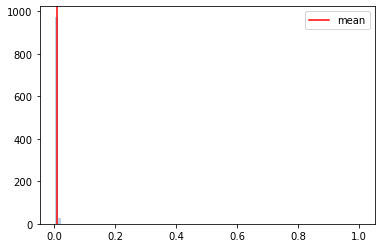

  0%|▏                                                                                | 2/1000 [00:00<00:50, 19.66it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654381881
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 10.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:22, 12.07it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:32, 10.69it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:55,  8.62it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:47,  9.17it/s]

Monte Carlo 9
Monte Carlo 10


  1%|█                                                                               | 13/1000 [00:01<01:48,  9.06it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:48,  9.13it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 17/1000 [00:01<01:41,  9.65it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:45,  9.28it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:49,  8.97it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:43,  9.46it/s]

Monte Carlo 21
Monte Carlo 22
Monte Carlo 23


  2%|█▉                                                                              | 24/1000 [00:02<01:45,  9.26it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:02<02:00,  8.06it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<01:53,  8.54it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<01:52,  8.62it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<02:03,  7.82it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:03<02:02,  7.89it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<01:57,  8.17it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<01:54,  8.37it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<01:50,  8.70it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:04<01:48,  8.79it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:46,  8.96it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 48/1000 [00:05<01:43,  9.16it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:44,  9.09it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:05<01:50,  8.56it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<01:53,  8.34it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:51,  8.50it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<01:52,  8.39it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:06<01:53,  8.29it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:57,  8.00it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<01:51,  8.42it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<01:53,  8.20it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:07<01:52,  8.29it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:07<01:46,  8.71it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<01:49,  8.48it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<01:52,  8.27it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:08<01:53,  8.12it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:08<01:54,  8.07it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<01:54,  8.04it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:09<02:00,  7.61it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:09<01:58,  7.76it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:00,  7.61it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<02:06,  7.23it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:10<02:04,  7.34it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:10<01:54,  7.91it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<01:55,  7.83it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<01:54,  7.92it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:11<01:59,  7.53it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:11<02:02,  7.34it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:01,  7.38it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:12<01:57,  7.63it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:12<01:57,  7.61it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:12<01:53,  7.85it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:02,  7.25it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:13<02:11,  6.77it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:13<02:05,  7.06it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:05,  7.06it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:14<02:04,  7.10it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:14<02:01,  7.27it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:14<01:57,  7.48it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<01:54,  7.66it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:15<02:02,  7.13it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:15<02:08,  6.81it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:05,  6.94it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:16<02:05,  6.90it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:16<01:59,  7.24it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:16<01:57,  7.37it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:17<02:01,  7.12it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:17<02:06,  6.83it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:17<02:21,  6.08it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:18<02:19,  6.15it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:18<02:21,  6.04it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:18<02:20,  6.06it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:19<02:20,  6.05it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:19<02:18,  6.11it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 152/1000 [00:19<02:19,  6.09it/s]

Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:20<02:39,  5.30it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:20<02:36,  5.40it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:20<02:26,  5.75it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:21<02:19,  6.02it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:21<02:12,  6.34it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:21<02:21,  5.92it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:22<02:25,  5.73it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:22<02:22,  5.85it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:22<02:15,  6.11it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:23<02:11,  6.28it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:23<02:18,  5.98it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:23<02:14,  6.13it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:24<02:13,  6.14it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 179/1000 [00:24<02:39,  5.13it/s]

Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:24<02:38,  5.16it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 182/1000 [00:24<02:32,  5.35it/s]

Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:25<02:36,  5.21it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:25<02:32,  5.35it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:26<02:28,  5.47it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:26<02:31,  5.34it/s]

Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:26<02:27,  5.49it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:26<02:28,  5.44it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:27<02:28,  5.42it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:27<02:29,  5.38it/s]

Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:27<02:27,  5.44it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:29,  5.35it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:28<02:25,  5.49it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:28<02:27,  5.41it/s]

Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:32,  5.22it/s]

Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:29,  5.31it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:29<02:23,  5.52it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:29<02:22,  5.56it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:20,  5.64it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:30<02:24,  5.44it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:30<02:27,  5.33it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:30<02:24,  5.43it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:25,  5.40it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:22,  5.49it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:18,  5.63it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:31<02:18,  5.63it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:18,  5.63it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:32<02:16,  5.68it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:32<02:16,  5.67it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:16,  5.67it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:33<02:14,  5.74it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:28,  5.17it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:26,  5.25it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:34<02:21,  5.41it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:34<02:23,  5.31it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:20,  5.42it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:26,  5.21it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:35<02:23,  5.28it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:35<02:20,  5.41it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:22,  5.32it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:36<02:22,  5.28it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:36<02:28,  5.09it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:26,  5.14it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:37<02:27,  5.10it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:37<02:24,  5.18it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:37<02:19,  5.35it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:38<02:17,  5.44it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 256/1000 [00:38<02:19,  5.34it/s]

Monte Carlo 254
Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:39<02:17,  5.41it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:18,  5.36it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:39<02:17,  5.39it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:39<02:19,  5.28it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:22,  5.17it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:40<02:23,  5.12it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:40<02:23,  5.11it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:40<02:23,  5.12it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:40<02:19,  5.23it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:18,  5.28it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:41<02:18,  5.25it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:41<02:20,  5.20it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:41<02:28,  4.90it/s]

Monte Carlo 272
Monte Carlo 273


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:35,  4.68it/s]

Monte Carlo 274


 28%|█████████████████████▋                                                         | 275/1000 [00:42<02:38,  4.58it/s]

Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:42<02:36,  4.63it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 277/1000 [00:42<03:02,  3.96it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:43<02:46,  4.33it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:43<02:41,  4.45it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:35,  4.61it/s]

Monte Carlo 281
Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:44<02:30,  4.74it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:27,  4.86it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:44<02:24,  4.94it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:23,  4.98it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:23,  4.96it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:25,  4.89it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:45<02:31,  4.70it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:45<02:34,  4.60it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:46<02:32,  4.65it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:34,  4.58it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:46<02:33,  4.60it/s]

Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:46<02:37,  4.48it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:47<02:33,  4.59it/s]

Monte Carlo 296
Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:47<02:34,  4.55it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:47<02:33,  4.58it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:47<02:34,  4.54it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:34,  4.51it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:48<02:29,  4.68it/s]

Monte Carlo 302
Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:48<02:28,  4.68it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:48<02:27,  4.70it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:49<02:30,  4.60it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:49<02:31,  4.57it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:49<02:28,  4.65it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:50<02:27,  4.67it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:50<02:31,  4.56it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:50<02:32,  4.52it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:50<02:29,  4.61it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:28,  4.63it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:51<02:24,  4.74it/s]

Monte Carlo 315
Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:51<02:24,  4.73it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:51<02:27,  4.63it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:26,  4.64it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:52<02:25,  4.66it/s]

Monte Carlo 320
Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:52<02:25,  4.66it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:25,  4.64it/s]

Monte Carlo 323
Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:53<02:26,  4.62it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:53<02:26,  4.60it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:53<02:33,  4.40it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:32,  4.41it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:54<02:29,  4.47it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:54<02:33,  4.36it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:54<02:31,  4.41it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:54<02:30,  4.43it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:29,  4.45it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:55<02:27,  4.52it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:55<02:27,  4.52it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:55<02:26,  4.52it/s]

Monte Carlo 336


 34%|██████████████████████████▋                                                    | 338/1000 [00:56<02:26,  4.52it/s]

Monte Carlo 337
Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:56<02:31,  4.36it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:56<02:29,  4.40it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:56<02:31,  4.35it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:30,  4.36it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:57<02:28,  4.42it/s]

Monte Carlo 343
Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:57<02:28,  4.40it/s]

Monte Carlo 345


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:23,  4.56it/s]

Monte Carlo 346
Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:58<02:26,  4.44it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:58<02:28,  4.40it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:23,  4.52it/s]

Monte Carlo 350


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:21,  4.59it/s]

Monte Carlo 351
Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:59<02:20,  4.61it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:59<02:27,  4.39it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:22,  4.53it/s]

Monte Carlo 355


 36%|████████████████████████████▏                                                  | 357/1000 [01:00<02:19,  4.61it/s]

Monte Carlo 356
Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:00<02:19,  4.62it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:00<02:19,  4.61it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:20,  4.56it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 362/1000 [01:01<02:17,  4.65it/s]

Monte Carlo 361
Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:01<02:16,  4.67it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:22,  4.47it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:23,  4.41it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:02<02:22,  4.44it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:02<02:26,  4.31it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:02<02:25,  4.34it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:25,  4.33it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:03<02:24,  4.35it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:03<02:27,  4.27it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:03<02:27,  4.25it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:26,  4.29it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:04<02:25,  4.29it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:04<02:26,  4.26it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:04<02:22,  4.39it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:20,  4.45it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:21,  4.38it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:05<02:19,  4.44it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:05<02:21,  4.38it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:05<02:22,  4.35it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:20,  4.41it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:06<02:23,  4.29it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:06<02:25,  4.22it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:06<02:23,  4.28it/s]

Monte Carlo 385


 39%|██████████████████████████████▌                                                | 387/1000 [01:07<02:19,  4.41it/s]

Monte Carlo 386
Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:07<02:27,  4.14it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:07<02:26,  4.18it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:25,  4.21it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:08<02:25,  4.19it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:08<02:20,  4.32it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:08<02:19,  4.36it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:08<02:18,  4.39it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:09<02:17,  4.40it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:09<02:18,  4.35it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:09<02:40,  3.75it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:34,  3.90it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:30,  4.00it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:10<02:27,  4.06it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:10<02:29,  4.01it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:25,  4.11it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:24,  4.14it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:11<02:22,  4.17it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:11<02:23,  4.16it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:11<02:26,  4.06it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:27,  4.02it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:12<02:27,  4.00it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:12<02:25,  4.05it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:12<02:26,  4.03it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:22,  4.12it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:13<02:20,  4.18it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:13<02:24,  4.05it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:13<02:26,  4.01it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:22,  4.09it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:14<02:24,  4.03it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:14<02:23,  4.05it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:14<02:23,  4.04it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:24,  4.02it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:15<02:28,  3.90it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:15<02:24,  4.00it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:15<02:27,  3.93it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:23,  4.01it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:16<02:22,  4.04it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:16<02:20,  4.10it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:16<02:17,  4.17it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:17,  4.16it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:17<02:19,  4.10it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:17<02:20,  4.07it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:17<02:22,  4.00it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:22,  4.00it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:18<02:20,  4.05it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:18<02:21,  4.00it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:18<02:21,  4.01it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:24,  3.90it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:19<02:22,  3.95it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:19<02:19,  4.03it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:19<02:21,  3.96it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:20<02:18,  4.04it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:20<02:16,  4.11it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:20<02:16,  4.09it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:20<02:16,  4.09it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:21<02:18,  4.03it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:21<02:18,  4.02it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:21<02:19,  3.97it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:21<02:22,  3.88it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:22<02:25,  3.80it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:22<02:21,  3.90it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:22<02:20,  3.92it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:22<02:24,  3.81it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:23<02:25,  3.79it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:23<02:23,  3.81it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:23<02:24,  3.80it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:24<02:21,  3.85it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:24<02:18,  3.94it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:24<02:15,  4.01it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:24<02:16,  3.99it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:25<02:17,  3.95it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:25<02:18,  3.91it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:25<02:22,  3.79it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:25<02:25,  3.70it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:26<02:24,  3.71it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:26<02:23,  3.75it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:26<02:20,  3.80it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:26<02:20,  3.81it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:27<02:17,  3.89it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:27<02:22,  3.73it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:27<02:22,  3.74it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:27<02:22,  3.73it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:28<02:18,  3.82it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:28<02:17,  3.85it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:28<02:17,  3.85it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:29<02:23,  3.68it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:29<02:19,  3.78it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:29<02:18,  3.80it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:29<02:19,  3.77it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:30<02:20,  3.73it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:30<02:15,  3.84it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:30<02:16,  3.82it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:30<02:16,  3.80it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:31<02:14,  3.86it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:31<02:11,  3.94it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:31<02:10,  3.97it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:31<02:10,  3.97it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:32<02:13,  3.86it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:32<02:12,  3.88it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:32<02:13,  3.83it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:32<02:11,  3.88it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:33<02:16,  3.74it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:33<02:14,  3.80it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:33<02:10,  3.90it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:33<02:08,  3.94it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:34<02:11,  3.86it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:34<02:06,  4.01it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:34<02:11,  3.84it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:34<02:14,  3.76it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:35<02:15,  3.72it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:35<02:09,  3.89it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:35<02:07,  3.92it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:35<02:08,  3.90it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:36<02:06,  3.93it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:36<02:04,  4.00it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:36<02:05,  3.95it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:36<02:05,  3.95it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:37<02:04,  3.97it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:37<02:07,  3.88it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:37<02:06,  3.89it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:38<02:05,  3.91it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:38<02:09,  3.79it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:38<02:14,  3.65it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:38<02:13,  3.66it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:39<02:09,  3.77it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:39<02:09,  3.76it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:39<02:06,  3.83it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:39<02:08,  3.78it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:40<02:06,  3.83it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:40<02:05,  3.86it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:40<02:02,  3.93it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:40<02:07,  3.78it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:41<02:07,  3.76it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:41<02:07,  3.75it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:41<02:03,  3.86it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:42<02:10,  3.66it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:42<02:06,  3.76it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:42<02:04,  3.82it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:42<02:05,  3.78it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:43<02:04,  3.80it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:43<02:03,  3.83it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:43<02:05,  3.76it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:43<02:07,  3.67it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:44<02:06,  3.71it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:44<02:06,  3.69it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:44<02:09,  3.60it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:44<02:09,  3.60it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:45<02:07,  3.64it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:45<02:07,  3.65it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:45<02:27,  3.14it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:46<02:23,  3.21it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:46<02:18,  3.33it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:46<02:17,  3.35it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:47<02:22,  3.22it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:47<02:18,  3.30it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:47<02:20,  3.26it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:48<02:14,  3.40it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:48<02:08,  3.55it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:48<02:05,  3.60it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:48<02:03,  3.66it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:49<02:03,  3.67it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:49<01:59,  3.76it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:49<01:58,  3.78it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:49<01:59,  3.77it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:50<01:57,  3.82it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:50<01:55,  3.88it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:50<01:54,  3.89it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:50<01:59,  3.71it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:51<02:05,  3.53it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:51<02:06,  3.49it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:51<02:05,  3.53it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:52<02:04,  3.54it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:52<02:02,  3.58it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:52<02:03,  3.56it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:52<02:05,  3.50it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:53<02:02,  3.56it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:53<02:01,  3.58it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:53<01:58,  3.66it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:54<01:59,  3.65it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:54<01:59,  3.62it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:54<01:59,  3.61it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:54<02:02,  3.52it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:55<02:01,  3.55it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:55<01:59,  3.58it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:55<02:01,  3.53it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:55<02:00,  3.54it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:56<02:01,  3.51it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:56<02:05,  3.38it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:56<02:04,  3.41it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:57<02:05,  3.36it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:57<02:11,  3.21it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:57<02:11,  3.21it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:58<02:10,  3.21it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:58<02:09,  3.25it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:58<02:13,  3.13it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:59<02:12,  3.14it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:59<02:11,  3.16it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:59<02:10,  3.19it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:00<02:11,  3.14it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:00<02:08,  3.21it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:00<02:06,  3.25it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:01<02:08,  3.19it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:01<02:06,  3.23it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:01<02:08,  3.19it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:01<02:11,  3.09it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:02<02:12,  3.07it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:02<02:11,  3.09it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:02<02:08,  3.14it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:03<02:09,  3.12it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:03<02:13,  3.02it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:03<02:11,  3.06it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:04<02:12,  3.02it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:04<02:11,  3.05it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:04<02:05,  3.17it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:05<02:06,  3.14it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:05<02:04,  3.18it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:05<02:05,  3.16it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:06<02:05,  3.14it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:06<02:11,  2.99it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:06<02:17,  2.85it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:07<02:18,  2.84it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:07<02:18,  2.81it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:07<02:16,  2.86it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:08<02:14,  2.90it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:08<02:11,  2.94it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:08<02:08,  3.01it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:09<02:06,  3.04it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:09<02:04,  3.10it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:09<02:06,  3.03it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:10<02:05,  3.06it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:10<02:06,  3.02it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:10<02:04,  3.06it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:11<02:02,  3.10it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:11<02:01,  3.11it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:11<02:05,  3.00it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:12<02:05,  3.01it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:12<02:04,  3.01it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:12<02:06,  2.96it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:13<02:06,  2.97it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:13<02:07,  2.92it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:13<02:04,  2.98it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:14<02:05,  2.96it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:14<02:07,  2.90it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:14<02:06,  2.92it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:15<02:05,  2.93it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:15<02:03,  2.97it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:15<02:02,  2.98it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:16<02:08,  2.84it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:16<02:05,  2.91it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:17<02:05,  2.88it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:17<02:01,  2.97it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:17<02:03,  2.93it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:18<02:01,  2.96it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:18<02:00,  2.97it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:18<01:59,  2.99it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:19<02:00,  2.95it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:19<02:01,  2.94it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:19<02:01,  2.93it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:20<02:02,  2.89it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:20<02:02,  2.88it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:20<02:02,  2.88it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:21<02:01,  2.89it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:21<01:57,  2.98it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:21<01:54,  3.05it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:22<01:55,  3.01it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:22<01:55,  3.02it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:22<01:53,  3.04it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:23<01:52,  3.05it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:23<01:50,  3.10it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:23<01:50,  3.11it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:24<01:51,  3.07it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:24<01:52,  3.04it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:24<01:53,  3.00it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:25<01:52,  3.01it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:25<01:50,  3.06it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:25<01:53,  2.97it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:26<01:53,  2.97it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:26<01:51,  3.00it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:26<01:51,  2.99it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:27<01:56,  2.86it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:27<01:54,  2.90it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:27<01:52,  2.93it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:28<01:54,  2.88it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:28<01:58,  2.77it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:28<01:59,  2.74it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:29<02:04,  2.63it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:29<02:00,  2.71it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:29<01:57,  2.78it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:30<01:55,  2.80it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:30<01:53,  2.84it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:31<01:53,  2.83it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:31<02:02,  2.62it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:31<01:59,  2.67it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:32<02:00,  2.66it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:32<01:57,  2.70it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:32<01:56,  2.73it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:33<01:54,  2.76it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:33<01:51,  2.81it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:33<01:49,  2.87it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:34<01:53,  2.77it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:34<01:51,  2.81it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:35<01:52,  2.76it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:35<01:50,  2.80it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:35<01:51,  2.78it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:36<01:48,  2.84it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:36<01:48,  2.82it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:36<01:49,  2.81it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:37<01:48,  2.81it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:37<01:49,  2.79it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:37<01:46,  2.86it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:38<01:44,  2.88it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:38<01:44,  2.87it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:38<01:45,  2.84it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:39<01:43,  2.88it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:39<01:46,  2.79it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:40<01:47,  2.78it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:40<01:44,  2.82it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:40<01:46,  2.78it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:41<01:45,  2.80it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:41<01:42,  2.85it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:41<01:44,  2.80it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:42<01:42,  2.84it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:42<01:39,  2.91it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:42<01:39,  2.92it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:43<01:36,  2.97it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:43<01:35,  3.01it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:43<01:33,  3.07it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:44<01:32,  3.08it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:44<01:34,  3.02it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:44<01:34,  2.99it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:45<01:35,  2.95it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:45<01:34,  2.98it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:45<01:34,  2.95it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:46<01:36,  2.89it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:46<01:35,  2.90it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:46<01:37,  2.85it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:47<01:37,  2.83it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:47<01:35,  2.88it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:47<01:36,  2.85it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:48<01:34,  2.87it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:48<01:33,  2.91it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:48<01:32,  2.92it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:49<01:30,  2.97it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:49<01:30,  2.99it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:49<01:30,  2.98it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:50<01:29,  2.98it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:50<01:29,  2.97it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:50<01:30,  2.93it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:51<01:28,  2.99it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:51<01:30,  2.92it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:51<01:28,  2.95it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:52<01:29,  2.90it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:52<01:29,  2.90it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:52<01:28,  2.93it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:53<01:28,  2.91it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:53<01:27,  2.94it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:54<01:27,  2.92it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:54<01:26,  2.94it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:54<01:28,  2.87it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:55<01:27,  2.89it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:55<01:25,  2.94it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:55<01:24,  2.97it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:56<01:25,  2.92it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:56<01:26,  2.89it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:56<01:24,  2.93it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:57<01:23,  2.95it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:57<01:22,  2.97it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:57<01:23,  2.94it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:58<01:22,  2.95it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:58<01:23,  2.93it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:58<01:24,  2.88it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:59<01:24,  2.84it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:59<01:25,  2.82it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:59<01:25,  2.80it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:00<01:26,  2.75it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:00<01:25,  2.78it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:01<01:27,  2.71it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:01<01:26,  2.72it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:01<01:26,  2.70it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:02<01:26,  2.69it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:02<01:27,  2.64it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:02<01:28,  2.62it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:03<01:30,  2.55it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:03<01:29,  2.56it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:04<01:26,  2.64it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:04<01:24,  2.69it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:04<01:22,  2.73it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:05<01:21,  2.76it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:05<01:21,  2.75it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:05<01:21,  2.72it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:06<01:22,  2.70it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:06<01:20,  2.73it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:06<01:22,  2.68it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:07<01:23,  2.62it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:07<01:21,  2.66it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:08<01:19,  2.72it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:08<01:19,  2.71it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:08<01:19,  2.70it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:09<01:20,  2.67it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:09<01:19,  2.69it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:09<01:19,  2.65it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:10<01:18,  2.70it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:10<01:18,  2.68it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:11<01:18,  2.67it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:11<01:18,  2.65it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:11<01:18,  2.64it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:12<01:18,  2.64it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:12<01:18,  2.60it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:13<01:19,  2.57it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:13<01:20,  2.53it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:13<01:20,  2.52it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:14<01:18,  2.57it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:14<01:18,  2.55it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:15<01:19,  2.51it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:15<01:16,  2.59it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:15<01:14,  2.64it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:16<01:15,  2.58it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:16<01:14,  2.62it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:16<01:13,  2.65it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:17<01:19,  2.43it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:17<01:18,  2.46it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:18<01:15,  2.53it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:18<01:16,  2.49it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:18<01:15,  2.49it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:19<01:13,  2.54it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:19<01:12,  2.58it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:20<01:11,  2.61it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:20<01:10,  2.61it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:20<01:11,  2.57it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:21<01:11,  2.57it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:21<01:09,  2.60it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:22<01:09,  2.61it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:22<01:11,  2.53it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:22<01:12,  2.47it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:23<01:10,  2.53it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:23<01:08,  2.58it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:24<01:08,  2.58it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:24<01:08,  2.57it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:24<01:06,  2.60it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:25<01:07,  2.57it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:25<01:06,  2.58it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:26<01:12,  2.34it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:26<01:12,  2.35it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:26<01:11,  2.38it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:27<01:12,  2.32it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:27<01:09,  2.41it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:28<01:07,  2.46it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:28<01:05,  2.52it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:28<01:05,  2.51it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:29<01:04,  2.54it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:29<01:03,  2.53it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:30<01:05,  2.46it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:30<01:05,  2.46it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:30<01:04,  2.45it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:31<01:02,  2.51it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:31<01:01,  2.54it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:32<01:01,  2.52it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:32<01:00,  2.58it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:32<00:59,  2.58it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:33<01:00,  2.52it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:33<00:59,  2.57it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:34<00:58,  2.59it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:34<00:57,  2.60it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:34<00:58,  2.55it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:35<00:57,  2.58it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:35<00:56,  2.58it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:35<00:56,  2.57it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:36<00:56,  2.55it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:36<00:56,  2.56it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:37<00:56,  2.55it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:37<00:56,  2.53it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:37<00:56,  2.48it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:38<00:55,  2.54it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:38<00:55,  2.51it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:39<00:55,  2.51it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:39<00:54,  2.50it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:39<00:54,  2.47it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:40<00:54,  2.46it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:40<00:53,  2.51it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:41<00:53,  2.49it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:41<00:54,  2.43it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:42<00:53,  2.46it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:42<00:54,  2.39it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:42<00:53,  2.39it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:43<00:52,  2.43it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:43<00:51,  2.45it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:44<00:51,  2.43it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:44<00:50,  2.47it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:44<00:51,  2.42it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:45<00:51,  2.39it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:45<00:50,  2.41it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:46<00:49,  2.45it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:46<00:48,  2.46it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:46<00:48,  2.46it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:47<00:49,  2.40it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:47<00:47,  2.44it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:48<00:47,  2.46it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:48<00:46,  2.45it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:48<00:46,  2.45it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:49<00:46,  2.45it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:49<00:46,  2.43it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:50<00:45,  2.43it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:50<00:45,  2.44it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:51<00:44,  2.48it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:51<00:43,  2.51it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:51<00:42,  2.51it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:52<00:42,  2.47it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:52<00:43,  2.41it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:53<00:42,  2.45it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:53<00:43,  2.38it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:53<00:42,  2.38it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:54<00:41,  2.43it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:54<00:40,  2.50it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:55<00:38,  2.55it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:55<00:38,  2.53it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:55<00:38,  2.50it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:56<00:41,  2.31it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:56<00:39,  2.40it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:57<00:37,  2.49it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:57<00:37,  2.50it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:57<00:36,  2.51it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:58<00:35,  2.53it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:58<00:35,  2.54it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:59<00:35,  2.53it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:59<00:35,  2.47it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:59<00:36,  2.40it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:00<00:35,  2.45it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:00<00:34,  2.45it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:01<00:34,  2.45it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:01<00:34,  2.41it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:02<00:33,  2.42it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:02<00:33,  2.44it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:02<00:32,  2.44it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:03<00:32,  2.41it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:03<00:32,  2.40it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:04<00:32,  2.37it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:04<00:32,  2.35it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:04<00:31,  2.35it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:05<00:31,  2.37it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:05<00:30,  2.36it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:06<00:30,  2.36it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:06<00:30,  2.33it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:07<00:29,  2.34it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:07<00:30,  2.28it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:07<00:28,  2.35it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:08<00:28,  2.36it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:08<00:28,  2.35it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:09<00:27,  2.39it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:09<00:26,  2.40it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:10<00:26,  2.40it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:10<00:26,  2.37it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:10<00:26,  2.35it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:11<00:25,  2.37it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:11<00:25,  2.33it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:12<00:24,  2.36it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:12<00:24,  2.33it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:13<00:23,  2.34it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:13<00:23,  2.35it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:13<00:22,  2.36it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:14<00:22,  2.32it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:14<00:22,  2.31it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:15<00:21,  2.33it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:15<00:21,  2.29it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:16<00:21,  2.33it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:16<00:20,  2.34it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:16<00:19,  2.36it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:17<00:19,  2.32it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:17<00:19,  2.29it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:18<00:19,  2.28it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:18<00:18,  2.29it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:19<00:18,  2.28it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:19<00:18,  2.17it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:20<00:18,  2.19it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:20<00:17,  2.17it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:20<00:16,  2.24it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:21<00:16,  2.20it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:21<00:16,  2.19it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:22<00:15,  2.24it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:22<00:15,  2.23it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:23<00:14,  2.27it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:23<00:14,  2.28it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:24<00:13,  2.30it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:24<00:13,  2.31it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:24<00:12,  2.30it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:25<00:12,  2.27it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:25<00:11,  2.27it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:26<00:11,  2.30it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:26<00:10,  2.30it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:27<00:10,  2.31it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:27<00:09,  2.31it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:27<00:09,  2.31it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:28<00:09,  2.28it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:28<00:08,  2.28it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:29<00:08,  2.25it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:29<00:07,  2.25it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:30<00:07,  2.28it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:30<00:06,  2.30it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:31<00:06,  2.32it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:31<00:06,  2.32it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:31<00:05,  2.29it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:32<00:05,  2.27it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:32<00:04,  2.24it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:33<00:04,  2.24it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:33<00:04,  2.22it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:34<00:03,  2.22it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:34<00:03,  2.21it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:35<00:02,  2.24it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:35<00:02,  2.26it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:35<00:01,  2.24it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:36<00:01,  2.25it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:36<00:00,  2.26it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:37<00:00,  2.31it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:37<00:00,  3.60it/s]


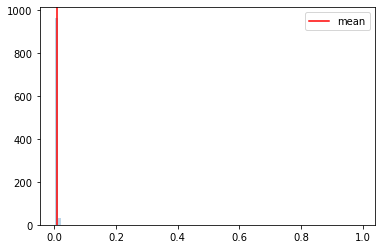

  0%|▏                                                                                | 3/1000 [00:00<01:02, 15.83it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654382159
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 0.1, 'jump_size_a': 10.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:26, 11.55it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▌                                                                                | 7/1000 [00:00<01:33, 10.61it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▉                                                                               | 11/1000 [00:01<01:42,  9.64it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:49,  9.05it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:48,  9.10it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 17/1000 [00:01<01:44,  9.40it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:43,  9.46it/s]

Monte Carlo 17
Monte Carlo 18
Monte Carlo 19

  2%|█▌                                                                              | 20/1000 [00:02<01:40,  9.73it/s]


Monte Carlo 20
Monte Carlo 21

  2%|█▊                                                                              | 22/1000 [00:02<01:40,  9.72it/s]


Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:40,  9.76it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:44,  9.31it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:02<01:46,  9.11it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<01:49,  8.85it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<01:52,  8.64it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<02:02,  7.89it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:03<02:02,  7.88it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:55,  8.31it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:50,  8.71it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<01:50,  8.69it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:04<01:54,  8.36it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<01:51,  8.52it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:55,  8.22it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:05<01:51,  8.50it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:05<01:55,  8.20it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<01:59,  7.90it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<01:53,  8.30it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:06<01:55,  8.15it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:06<01:59,  7.88it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<01:55,  8.14it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:07<01:54,  8.19it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:07<01:53,  8.21it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:07<01:55,  8.05it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:08<01:52,  8.26it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:08<01:59,  7.77it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:08<02:02,  7.54it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:08<01:58,  7.76it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:09<02:00,  7.65it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:09<01:54,  8.04it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:09<01:55,  7.96it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:09<01:56,  7.86it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:10<01:51,  8.18it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:10<01:54,  7.96it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:10<02:01,  7.52it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:10<02:03,  7.37it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:11<02:09,  7.00it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:11<02:11,  6.89it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:11<02:11,  6.88it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:12<02:06,  7.14it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:12<02:09,  6.94it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:12<02:15,  6.61it/s]

Monte Carlo 103
Monte Carlo 104


 10%|████████▎                                                                      | 105/1000 [00:12<02:13,  6.68it/s]

Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:32,  5.86it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:19,  6.37it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:13<02:17,  6.47it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:10,  6.81it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:10,  6.81it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:14<02:12,  6.64it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:09,  6.82it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:06,  6.93it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<02:06,  6.93it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:15<02:07,  6.86it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:11,  6.66it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:16,  6.38it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:16<02:16,  6.37it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:14,  6.45it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<02:18,  6.24it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:17<02:11,  6.59it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:10,  6.60it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:10,  6.58it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:18<02:10,  6.55it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:18<02:14,  6.34it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:15,  6.28it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:19<02:14,  6.35it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:19<02:21,  5.98it/s]

Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:20<02:22,  5.95it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:20<02:20,  6.00it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:20<02:16,  6.19it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:21<02:18,  6.06it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:21<02:19,  6.03it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:21<02:22,  5.88it/s]

Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:21<02:19,  6.02it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:17,  6.09it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:16,  6.09it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:22<02:12,  6.27it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:23<02:13,  6.22it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:23<02:17,  6.02it/s]

Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:23<02:16,  6.04it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:15,  6.09it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:24<02:16,  6.00it/s]

Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:24<02:21,  5.78it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:24<02:19,  5.87it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:17,  5.97it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▍                                                                | 183/1000 [00:25<02:19,  5.87it/s]

Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:25<02:22,  5.73it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:26,  5.57it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:26<02:24,  5.60it/s]

Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:26<02:23,  5.66it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:26<02:16,  5.93it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:24,  5.58it/s]

Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:27<02:23,  5.59it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:27<02:21,  5.66it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:20,  5.71it/s]

Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:25,  5.50it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:28<02:25,  5.50it/s]

Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:28<02:25,  5.48it/s]

Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:28<02:20,  5.67it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:23,  5.54it/s]

Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:29<02:26,  5.41it/s]

Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:29<02:21,  5.60it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:29<02:18,  5.73it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:30<02:22,  5.54it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:30<02:19,  5.63it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:19,  5.65it/s]

Monte Carlo 214


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:19,  5.62it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:19,  5.62it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:31<02:19,  5.59it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:22,  5.48it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:26,  5.31it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:32<02:22,  5.47it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:32<02:21,  5.47it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:21,  5.48it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:33<02:20,  5.52it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:33<02:24,  5.33it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:33<02:22,  5.40it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:20,  5.46it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:29,  5.14it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:34<02:29,  5.12it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:34<02:26,  5.23it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:25,  5.22it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:35<02:24,  5.26it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:35<02:26,  5.20it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:27,  5.13it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:22,  5.30it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:36<02:38,  4.76it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:27,  5.09it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:24,  5.20it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:37<02:30,  4.98it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:37<02:29,  5.00it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:29,  5.00it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:38<02:29,  5.01it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:38<02:26,  5.09it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:38<02:26,  5.08it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:38<02:21,  5.24it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:20,  5.30it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 258/1000 [00:39<02:26,  5.06it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:39<02:24,  5.13it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:39<02:22,  5.19it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:40<02:22,  5.18it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:21,  5.21it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:17,  5.35it/s]

Monte Carlo 263
Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:40<02:14,  5.46it/s]

Monte Carlo 265
Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:41<02:12,  5.53it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:41<02:08,  5.69it/s]

Monte Carlo 269
Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:41<02:11,  5.52it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:42<02:11,  5.52it/s]

Monte Carlo 272
Monte Carlo 273


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:14,  5.39it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:42<02:14,  5.40it/s]

Monte Carlo 275
Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:42<02:18,  5.22it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:43<02:20,  5.11it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:43<02:19,  5.15it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:43<02:18,  5.20it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:43<02:14,  5.33it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:12,  5.41it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:44<02:14,  5.31it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:44<02:16,  5.22it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:45<02:17,  5.15it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:45<02:17,  5.17it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:45<02:17,  5.15it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:45<02:18,  5.10it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:46<02:15,  5.20it/s]

Monte Carlo 293
Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:46<02:13,  5.26it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:46<02:13,  5.27it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:46<02:14,  5.20it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:47<02:19,  5.00it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:47<02:17,  5.07it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:47<02:14,  5.19it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:47<02:16,  5.10it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:48<02:16,  5.09it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:48<02:13,  5.21it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:48<02:11,  5.26it/s]

Monte Carlo 305
Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:48<02:16,  5.06it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:49<02:15,  5.10it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:49<02:16,  5.06it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:49<02:11,  5.23it/s]

Monte Carlo 310
Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:49<02:13,  5.13it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:49<02:14,  5.08it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:50<02:16,  5.01it/s]

Monte Carlo 314
Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:50<02:17,  4.96it/s]

Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:50<02:19,  4.88it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:51<02:20,  4.84it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:51<02:16,  4.98it/s]

Monte Carlo 320
Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:51<02:13,  5.07it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:52<02:14,  5.01it/s]

Monte Carlo 324
Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:52<02:15,  4.97it/s]

Monte Carlo 326
Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:52<02:16,  4.93it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:53<02:20,  4.78it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:53<02:18,  4.83it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:53<02:18,  4.81it/s]

Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:53<02:17,  4.85it/s]

Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:54<02:16,  4.90it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:54<02:15,  4.89it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:54<02:15,  4.91it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 337/1000 [00:54<02:16,  4.85it/s]

Monte Carlo 336
Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:54<02:18,  4.77it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:55<02:20,  4.72it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:55<02:26,  4.51it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:55<02:29,  4.42it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 343/1000 [00:56<02:28,  4.43it/s]

Monte Carlo 342
Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:56<02:25,  4.50it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:56<02:23,  4.58it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:56<02:27,  4.43it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:56<02:29,  4.38it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:57<02:27,  4.41it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:57<02:27,  4.42it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:57<02:26,  4.45it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:57<02:34,  4.19it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:58<02:35,  4.16it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:58<02:41,  4.01it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:58<02:35,  4.16it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [00:58<02:38,  4.07it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [00:59<02:39,  4.03it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [00:59<02:37,  4.09it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [00:59<02:34,  4.15it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [00:59<02:35,  4.12it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:00<02:35,  4.12it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:00<02:33,  4.15it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:00<02:33,  4.16it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:00<02:34,  4.12it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:01<02:36,  4.06it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:01<02:43,  3.88it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:01<02:42,  3.90it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:01<02:41,  3.93it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:02<02:46,  3.80it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:02<02:46,  3.80it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:02<02:47,  3.75it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:02<02:45,  3.81it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:03<02:45,  3.80it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:03<02:41,  3.87it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:03<02:44,  3.81it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:03<02:39,  3.92it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:04<02:34,  4.03it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:04<02:34,  4.03it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:04<02:28,  4.18it/s]

Monte Carlo 378


 38%|██████████████████████████████                                                 | 380/1000 [01:05<02:22,  4.34it/s]

Monte Carlo 379
Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:05<02:21,  4.37it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:05<02:20,  4.38it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:05<02:19,  4.42it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:06<02:21,  4.36it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:06<02:21,  4.36it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:06<02:20,  4.38it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:06<02:41,  3.79it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:07<02:37,  3.88it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:07<02:34,  3.96it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:07<02:27,  4.13it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:07<02:26,  4.16it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:08<02:22,  4.26it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:08<02:25,  4.17it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:08<02:26,  4.15it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:08<02:28,  4.08it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:09<02:30,  4.01it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:09<02:27,  4.09it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:09<02:28,  4.05it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:09<02:25,  4.13it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:09<02:26,  4.09it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:10<02:24,  4.14it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:10<02:24,  4.13it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:10<02:22,  4.18it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:10<02:22,  4.17it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:11<02:23,  4.15it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:11<02:21,  4.19it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:11<02:22,  4.15it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:11<02:26,  4.04it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:12<02:25,  4.07it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:12<02:25,  4.06it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:12<02:29,  3.94it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:12<02:25,  4.04it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:13<02:29,  3.94it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:13<02:27,  3.97it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:13<02:24,  4.04it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:13<02:32,  3.82it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:14<02:25,  4.01it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:14<02:21,  4.12it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:14<02:22,  4.08it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:14<02:20,  4.14it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:15<02:20,  4.13it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:15<02:20,  4.10it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:15<02:20,  4.09it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:15<02:17,  4.18it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:16<02:17,  4.18it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:16<02:21,  4.06it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:16<02:22,  4.03it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:16<02:21,  4.05it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:17<02:20,  4.06it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:17<02:16,  4.17it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:17<02:21,  4.01it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:17<02:18,  4.09it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:18<02:18,  4.10it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:18<02:22,  3.97it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:18<02:19,  4.05it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:18<02:19,  4.05it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:19<02:22,  3.94it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:19<02:21,  3.98it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:19<02:19,  4.02it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:19<02:19,  4.01it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:20<02:19,  4.01it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:20<02:22,  3.92it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:20<02:21,  3.94it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:20<02:21,  3.94it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:21<02:21,  3.92it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:21<02:20,  3.94it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:21<02:23,  3.86it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:21<02:18,  3.97it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:22<02:18,  3.99it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:22<02:18,  3.96it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:22<02:18,  3.96it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:22<02:20,  3.91it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:23<02:18,  3.96it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:23<02:17,  3.98it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:23<02:17,  3.96it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:23<02:18,  3.94it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:24<02:17,  3.94it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:24<02:20,  3.87it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:24<02:18,  3.90it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:24<02:19,  3.87it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:25<02:17,  3.93it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:25<02:21,  3.81it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:25<02:17,  3.89it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:25<02:15,  3.95it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:26<02:16,  3.92it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:26<02:19,  3.83it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:26<02:21,  3.77it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:27<02:19,  3.81it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:27<02:17,  3.85it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:27<02:19,  3.80it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:27<02:18,  3.83it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:28<02:16,  3.87it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:28<02:14,  3.93it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:28<02:15,  3.89it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:28<02:14,  3.90it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:29<02:16,  3.83it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:29<02:20,  3.73it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:29<02:19,  3.74it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:29<02:21,  3.69it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:30<02:19,  3.74it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:30<02:19,  3.73it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:30<02:19,  3.72it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:31<02:21,  3.66it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:31<02:18,  3.73it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:31<02:15,  3.81it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:31<02:14,  3.81it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:32<02:14,  3.81it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:32<02:14,  3.80it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:32<02:18,  3.68it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:32<02:15,  3.76it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:33<02:17,  3.70it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:33<02:18,  3.67it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:33<02:22,  3.56it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:34<02:29,  3.38it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:34<02:30,  3.34it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:34<02:27,  3.43it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:34<02:26,  3.44it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:35<02:21,  3.55it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:35<02:18,  3.61it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:35<02:18,  3.62it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:35<02:16,  3.66it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:36<02:18,  3.60it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:36<02:20,  3.55it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:36<02:16,  3.62it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:37<02:14,  3.67it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:37<02:15,  3.64it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:37<02:18,  3.57it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:37<02:20,  3.50it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:38<02:22,  3.46it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:38<02:22,  3.43it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:38<02:20,  3.47it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:39<02:18,  3.53it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:39<02:17,  3.53it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:39<02:14,  3.62it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:39<02:15,  3.58it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:40<02:19,  3.46it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:40<02:31,  3.18it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:40<02:27,  3.26it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:41<02:22,  3.38it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:41<02:24,  3.32it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:41<02:22,  3.36it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:42<02:19,  3.42it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:42<02:17,  3.46it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:42<02:21,  3.37it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:42<02:19,  3.40it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:43<02:19,  3.40it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:43<02:15,  3.49it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:43<02:14,  3.51it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:44<02:11,  3.57it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:44<02:14,  3.50it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:44<02:11,  3.55it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:44<02:13,  3.52it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:45<02:12,  3.53it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:45<02:13,  3.50it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:45<02:14,  3.46it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:46<02:15,  3.43it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:46<02:13,  3.46it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:46<02:13,  3.46it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:46<02:12,  3.47it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:47<02:12,  3.47it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:47<02:10,  3.51it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:47<02:09,  3.53it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:48<02:25,  3.14it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:48<02:16,  3.33it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:48<02:14,  3.38it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:49<02:13,  3.41it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:49<02:12,  3.41it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:49<02:12,  3.41it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:49<02:09,  3.48it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:50<02:11,  3.42it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:50<02:11,  3.41it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:50<02:10,  3.43it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:51<02:09,  3.45it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:51<02:12,  3.38it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:51<02:16,  3.26it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:51<02:13,  3.33it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:52<02:10,  3.40it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:52<02:07,  3.46it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:52<02:05,  3.52it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:53<02:04,  3.55it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:53<02:04,  3.52it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:53<02:00,  3.62it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:53<02:00,  3.64it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:54<01:57,  3.71it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:54<02:15,  3.22it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:54<02:24,  3.01it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:55<02:21,  3.05it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:55<02:19,  3.10it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:55<02:21,  3.04it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:56<02:20,  3.06it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:56<02:13,  3.21it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:56<02:07,  3.36it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:57<02:07,  3.35it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:57<02:11,  3.25it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:57<02:15,  3.13it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:58<02:12,  3.19it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:58<02:09,  3.28it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:58<02:11,  3.22it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:58<02:13,  3.15it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:59<02:12,  3.18it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:59<02:10,  3.21it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:59<02:08,  3.25it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:00<02:09,  3.23it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:00<02:11,  3.15it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:00<02:08,  3.24it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:01<02:07,  3.24it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:01<02:05,  3.29it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:01<02:03,  3.34it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:02<02:04,  3.30it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:02<02:07,  3.21it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:02<02:08,  3.18it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:03<02:10,  3.12it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:03<02:08,  3.18it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:03<02:11,  3.08it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:04<02:18,  2.93it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:04<02:24,  2.79it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:04<02:23,  2.81it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:05<02:23,  2.80it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:05<02:34,  2.59it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:05<02:26,  2.74it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:06<02:20,  2.83it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:06<02:17,  2.90it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:06<02:11,  3.02it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:07<02:15,  2.93it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:07<02:17,  2.88it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:07<02:15,  2.90it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:08<02:18,  2.85it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:08<02:23,  2.74it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:09<02:24,  2.70it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:09<02:18,  2.83it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:09<02:18,  2.80it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:10<02:15,  2.87it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:10<02:14,  2.88it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:10<02:12,  2.91it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:11<02:16,  2.83it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:11<02:17,  2.80it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:11<02:15,  2.84it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:12<02:15,  2.82it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:12<02:15,  2.80it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:12<02:12,  2.87it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:13<02:13,  2.84it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:13<02:17,  2.75it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:14<02:16,  2.76it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:14<02:17,  2.74it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:14<02:12,  2.83it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:15<02:12,  2.81it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:15<02:13,  2.80it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:15<02:13,  2.79it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:16<02:11,  2.83it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:16<02:13,  2.78it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:16<02:14,  2.74it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:17<02:15,  2.71it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:17<02:14,  2.73it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:18<02:17,  2.65it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:18<02:16,  2.68it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:18<02:14,  2.71it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:19<02:32,  2.38it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:19<02:24,  2.50it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:20<02:24,  2.49it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:20<02:24,  2.49it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:20<02:26,  2.45it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:21<02:31,  2.36it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:21<02:29,  2.39it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:22<02:28,  2.39it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:22<02:29,  2.38it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:23<02:29,  2.38it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:23<02:34,  2.29it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:23<02:36,  2.25it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:24<02:34,  2.27it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:24<02:36,  2.23it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:25<02:35,  2.25it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:25<02:23,  2.42it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:25<02:17,  2.53it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:26<02:13,  2.59it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:26<02:15,  2.56it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:27<02:12,  2.60it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:27<02:09,  2.64it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:27<02:11,  2.61it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:28<02:10,  2.61it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:28<02:06,  2.68it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:28<02:03,  2.76it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:29<02:04,  2.72it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:29<02:01,  2.77it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:30<02:00,  2.79it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:30<02:05,  2.68it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:30<02:02,  2.74it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:31<02:04,  2.68it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:31<02:00,  2.75it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:31<01:58,  2.80it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:32<01:57,  2.81it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:32<01:59,  2.75it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:32<02:03,  2.66it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:33<01:59,  2.74it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:33<01:58,  2.75it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:34<01:59,  2.71it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:34<01:59,  2.71it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:34<01:59,  2.70it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:35<01:57,  2.73it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:35<01:59,  2.70it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:35<01:57,  2.72it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:36<01:55,  2.76it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:36<02:00,  2.65it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:37<02:03,  2.56it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:37<01:58,  2.66it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:37<01:57,  2.69it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:38<02:03,  2.53it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:38<02:00,  2.59it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:39<02:01,  2.56it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:39<02:03,  2.51it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:39<01:59,  2.60it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:40<01:56,  2.64it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:40<01:55,  2.66it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:40<01:55,  2.65it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:41<01:56,  2.63it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:41<01:54,  2.66it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:42<01:53,  2.69it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:42<01:52,  2.70it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:42<01:51,  2.70it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:43<01:51,  2.70it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:43<01:50,  2.71it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:43<01:50,  2.70it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:44<01:49,  2.72it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:44<01:49,  2.70it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:44<01:50,  2.69it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:45<01:48,  2.71it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:45<01:49,  2.68it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:46<01:47,  2.73it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:46<01:44,  2.78it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:46<01:42,  2.83it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:47<01:41,  2.86it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:47<01:40,  2.87it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:47<01:43,  2.77it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:48<01:44,  2.74it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:48<01:43,  2.76it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:48<01:41,  2.82it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:49<01:41,  2.81it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:49<01:47,  2.63it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:50<01:45,  2.68it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:50<01:42,  2.73it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:50<01:41,  2.76it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:51<01:43,  2.70it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:51<01:41,  2.74it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:51<01:40,  2.77it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:52<01:40,  2.74it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:52<01:42,  2.69it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:53<01:42,  2.66it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:53<01:45,  2.58it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:53<01:46,  2.56it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:54<01:46,  2.55it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:54<01:45,  2.57it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:55<01:51,  2.41it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:55<01:49,  2.45it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:55<01:48,  2.47it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:56<01:48,  2.45it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:56<01:43,  2.55it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:57<01:43,  2.56it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:57<01:42,  2.56it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:57<01:43,  2.53it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:58<01:41,  2.57it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:58<01:39,  2.62it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:58<01:38,  2.62it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:59<01:40,  2.57it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:59<01:38,  2.60it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:00<01:34,  2.71it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:00<01:33,  2.72it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:00<01:34,  2.70it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:01<01:31,  2.76it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:01<01:36,  2.62it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:01<01:39,  2.52it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:02<01:35,  2.61it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:02<01:36,  2.57it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:03<01:33,  2.64it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:03<01:31,  2.70it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:03<01:29,  2.74it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:04<01:29,  2.73it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:04<01:32,  2.65it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:05<01:40,  2.43it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:05<01:35,  2.55it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:05<01:31,  2.63it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:06<01:29,  2.68it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:06<01:27,  2.74it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:06<01:23,  2.84it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:07<01:22,  2.87it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:07<01:21,  2.89it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:07<01:20,  2.93it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:08<01:21,  2.88it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:08<01:26,  2.68it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:08<01:27,  2.64it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:09<01:27,  2.64it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:09<01:26,  2.65it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:10<01:24,  2.71it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:10<01:25,  2.68it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:10<01:24,  2.68it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:11<01:25,  2.65it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:11<01:24,  2.66it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:11<01:25,  2.63it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:12<01:22,  2.70it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:12<01:22,  2.70it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:13<01:23,  2.64it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:13<01:23,  2.65it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:13<01:23,  2.63it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:14<01:21,  2.66it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:14<01:20,  2.70it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:14<01:20,  2.67it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:15<01:23,  2.58it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:15<01:21,  2.64it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:16<01:20,  2.64it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:16<01:18,  2.69it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:16<01:20,  2.62it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:17<01:18,  2.68it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:17<01:20,  2.61it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:18<01:18,  2.64it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:18<01:18,  2.65it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:18<01:16,  2.69it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:19<01:16,  2.69it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:19<01:17,  2.63it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:19<01:16,  2.65it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:20<01:15,  2.66it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:20<01:14,  2.68it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:21<01:15,  2.66it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:21<01:16,  2.61it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:21<01:14,  2.66it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:22<01:14,  2.66it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:22<01:14,  2.65it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:22<01:14,  2.60it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:23<01:15,  2.57it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:23<01:18,  2.46it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:24<01:16,  2.52it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:24<01:16,  2.51it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:24<01:16,  2.48it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:25<01:16,  2.48it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:25<01:15,  2.49it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:26<01:13,  2.55it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:26<01:10,  2.63it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:26<01:10,  2.64it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:27<01:10,  2.61it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:27<01:09,  2.62it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:28<01:09,  2.62it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:28<01:09,  2.59it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:28<01:12,  2.47it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:29<01:10,  2.53it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:29<01:10,  2.53it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:30<01:08,  2.60it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:30<01:07,  2.59it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:30<01:06,  2.61it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:31<01:06,  2.61it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:31<01:05,  2.63it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:31<01:05,  2.65it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:32<01:05,  2.59it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:32<01:06,  2.56it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:33<01:05,  2.58it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:33<01:06,  2.54it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:33<01:04,  2.59it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:34<01:03,  2.61it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:34<01:03,  2.61it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:35<01:03,  2.56it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:35<01:02,  2.59it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:35<01:03,  2.57it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:36<01:03,  2.52it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:36<01:03,  2.54it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:36<01:02,  2.54it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:37<01:01,  2.59it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:37<00:59,  2.65it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:38<00:59,  2.61it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:38<00:59,  2.60it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:38<00:58,  2.62it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:39<00:57,  2.67it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:39<00:56,  2.69it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:39<00:56,  2.67it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:40<00:57,  2.62it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:40<00:56,  2.64it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:41<00:57,  2.59it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:41<00:55,  2.64it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:41<00:55,  2.64it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:42<00:54,  2.64it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:42<00:55,  2.62it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:43<00:55,  2.59it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:43<00:59,  2.39it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:43<00:57,  2.45it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:44<00:56,  2.48it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:44<00:56,  2.45it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:45<00:56,  2.44it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:45<00:56,  2.42it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:45<00:55,  2.45it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:46<00:55,  2.42it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:46<00:54,  2.44it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:47<00:54,  2.44it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:47<00:54,  2.43it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:48<00:53,  2.47it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:48<00:52,  2.47it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:48<00:51,  2.51it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:49<00:50,  2.53it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:49<00:52,  2.43it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:50<00:52,  2.40it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:50<00:53,  2.34it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:50<00:54,  2.29it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:51<00:54,  2.24it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:51<00:52,  2.30it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:52<00:52,  2.31it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:52<00:51,  2.35it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:53<00:50,  2.35it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:53<00:49,  2.38it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:53<00:48,  2.41it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:54<00:48,  2.40it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:54<00:47,  2.42it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:55<00:47,  2.39it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:55<00:47,  2.38it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:56<00:46,  2.40it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:56<00:46,  2.40it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:56<00:45,  2.40it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:57<00:45,  2.41it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:57<00:44,  2.40it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:58<00:44,  2.38it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:58<00:44,  2.39it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:58<00:43,  2.39it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:59<00:42,  2.44it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:59<00:42,  2.44it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:00<00:41,  2.48it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:00<00:40,  2.47it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:00<00:39,  2.51it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:01<00:39,  2.50it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:01<00:38,  2.53it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:02<00:38,  2.53it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:02<00:39,  2.46it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:02<00:38,  2.49it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:03<00:37,  2.47it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:03<00:37,  2.50it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:04<00:36,  2.52it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:04<00:36,  2.46it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:04<00:36,  2.44it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:05<00:36,  2.44it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:05<00:36,  2.43it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:06<00:36,  2.38it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:06<00:36,  2.38it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:07<00:35,  2.39it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:07<00:35,  2.37it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:07<00:34,  2.39it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:08<00:34,  2.39it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:08<00:34,  2.36it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:09<00:34,  2.30it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:09<00:34,  2.30it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:10<00:33,  2.32it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:10<00:32,  2.36it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:10<00:31,  2.39it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:11<00:31,  2.41it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:11<00:30,  2.42it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:12<00:30,  2.39it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:12<00:30,  2.38it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:12<00:29,  2.37it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:13<00:30,  2.31it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:13<00:29,  2.31it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:14<00:29,  2.34it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:14<00:28,  2.37it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:15<00:28,  2.36it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:15<00:27,  2.34it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:15<00:27,  2.35it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:16<00:26,  2.36it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:16<00:26,  2.33it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:17<00:26,  2.29it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:17<00:26,  2.28it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:18<00:25,  2.32it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:18<00:25,  2.27it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:19<00:24,  2.33it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:19<00:23,  2.34it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:19<00:23,  2.36it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:20<00:23,  2.32it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:20<00:22,  2.32it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:21<00:22,  2.30it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:21<00:22,  2.27it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:22<00:21,  2.29it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:22<00:21,  2.24it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:22<00:21,  2.24it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:23<00:20,  2.25it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:23<00:20,  2.27it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:24<00:19,  2.25it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:24<00:19,  2.25it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:25<00:18,  2.28it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:25<00:18,  2.27it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:26<00:17,  2.31it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:26<00:17,  2.30it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:26<00:16,  2.30it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:27<00:17,  2.16it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:27<00:17,  2.16it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:28<00:16,  2.16it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:28<00:15,  2.20it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:29<00:14,  2.28it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:29<00:14,  2.33it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:30<00:13,  2.39it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:30<00:12,  2.43it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:30<00:12,  2.44it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:31<00:11,  2.42it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:31<00:11,  2.40it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:32<00:11,  2.40it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:32<00:10,  2.42it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:32<00:10,  2.39it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:33<00:09,  2.40it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:33<00:09,  2.37it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:34<00:09,  2.38it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:34<00:09,  2.30it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:35<00:08,  2.27it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:35<00:08,  2.25it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:35<00:07,  2.27it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:36<00:07,  2.28it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:36<00:07,  2.28it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:37<00:06,  2.27it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:37<00:06,  2.25it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:38<00:05,  2.30it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:38<00:05,  2.29it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:39<00:04,  2.34it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:39<00:04,  2.38it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:39<00:03,  2.38it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:40<00:03,  2.41it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:40<00:02,  2.36it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:41<00:02,  2.25it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:41<00:02,  2.25it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:42<00:01,  2.27it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:42<00:01,  2.30it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:42<00:00,  2.31it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:43<00:00,  2.33it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:43<00:00,  3.52it/s]


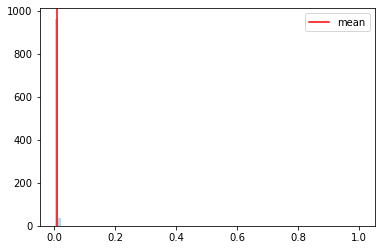

  0%|▏                                                                                | 2/1000 [00:00<00:51, 19.21it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654382444
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 0.1, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:35, 10.44it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:49,  9.08it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:51,  8.90it/s]

Monte Carlo 7
Monte Carlo 8
Monte Carlo 9

  1%|▊                                                                               | 10/1000 [00:01<01:46,  9.26it/s]


Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:48,  9.11it/s]

Monte Carlo 11
Monte Carlo 12
Monte Carlo 13

  1%|█                                                                               | 14/1000 [00:01<01:45,  9.31it/s]


Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:46,  9.24it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:46,  9.24it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:44,  9.39it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:45,  9.26it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:46,  9.21it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:51,  8.71it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:51,  8.75it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:06,  7.66it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<01:59,  8.09it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<01:58,  8.15it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<01:57,  8.24it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:58,  8.12it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:59,  8.06it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<01:53,  8.48it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<01:54,  8.32it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<01:59,  7.98it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<02:04,  7.65it/s]

Monte Carlo 47
Monte Carlo 48


  5%|███▉                                                                            | 49/1000 [00:05<02:03,  7.67it/s]

Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:21,  6.70it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:08,  7.40it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:07,  7.39it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<02:05,  7.52it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<01:58,  7.91it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:59,  7.87it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:00,  7.80it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<01:58,  7.86it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<01:55,  8.07it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<01:54,  8.14it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:02,  7.61it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<02:01,  7.62it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:03,  7.49it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:07,  7.23it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:11,  6.98it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:08,  7.13it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:07,  7.21it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:12,  6.88it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<02:09,  7.07it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:06,  7.21it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:12,  6.84it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:16,  6.62it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:11,  6.91it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:13,  6.75it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:23,  6.30it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:20,  6.39it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:21,  6.35it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:16,  6.57it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:18,  6.47it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:15,  6.56it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:19,  6.37it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:16,  6.50it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:17,  6.44it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:19,  6.31it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:24,  6.09it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:22,  6.18it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:22,  6.16it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:24,  6.04it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:18,  6.28it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:25,  6.00it/s]

Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:17<02:21,  6.14it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:17<02:18,  6.25it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:18<02:13,  6.47it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:18<02:17,  6.28it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:18<02:26,  5.90it/s]

Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:19<02:21,  6.07it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:26,  5.86it/s]

Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:19<02:28,  5.76it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:19<02:19,  6.14it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:20<02:20,  6.06it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:20<02:19,  6.11it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:20<02:21,  6.02it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:21<02:19,  6.10it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:21<02:19,  6.07it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:21<02:17,  6.14it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:22<02:17,  6.11it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:22<02:25,  5.77it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:18,  6.07it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:23<02:20,  5.95it/s]

Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:23<02:19,  6.00it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:20,  5.94it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:24<02:26,  5.66it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:20,  5.89it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:20,  5.89it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:25<02:16,  6.03it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:25<02:39,  5.15it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:39,  5.15it/s]

Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:32,  5.38it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:26<02:22,  5.77it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:26<02:20,  5.81it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:16,  5.98it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:27<02:21,  5.76it/s]

Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:27<02:26,  5.55it/s]

Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:27<02:29,  5.44it/s]

Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:26,  5.54it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:28<02:23,  5.61it/s]

Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:28<02:23,  5.63it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:28<02:23,  5.62it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:29<02:19,  5.75it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:29<02:23,  5.60it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:22,  5.62it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:30<02:19,  5.70it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:30<02:26,  5.44it/s]

Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:22,  5.58it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:31<02:19,  5.68it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:31<02:21,  5.57it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:31<02:21,  5.57it/s]

Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:31<02:19,  5.63it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:32<02:21,  5.55it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:32<02:21,  5.55it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:32<02:24,  5.44it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:32<02:23,  5.47it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:20,  5.57it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▎                                                             | 219/1000 [00:33<02:23,  5.44it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:33<02:26,  5.31it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:33<02:23,  5.43it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:22,  5.45it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:34<02:22,  5.44it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:34<02:23,  5.38it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:34<02:20,  5.50it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:35<02:19,  5.51it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▏                                                            | 231/1000 [00:35<02:26,  5.23it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:29,  5.14it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:36<02:23,  5.32it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:36<02:19,  5.48it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:36<02:20,  5.41it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:20,  5.43it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:37<02:22,  5.33it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:37<02:21,  5.37it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:37<02:20,  5.38it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:20,  5.36it/s]

Monte Carlo 243


 25%|███████████████████▍                                                           | 246/1000 [00:38<02:17,  5.47it/s]

Monte Carlo 244
Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 247/1000 [00:38<02:24,  5.23it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:27,  5.10it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:26,  5.11it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▊                                                           | 251/1000 [00:39<02:33,  4.88it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:39<02:32,  4.89it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:39<02:33,  4.85it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:33,  4.87it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:40<02:33,  4.84it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:40<02:29,  4.96it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:40<02:27,  5.03it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:40<02:26,  5.05it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:23,  5.16it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:41<02:28,  4.97it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:41<02:27,  4.99it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:26,  5.03it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:28,  4.95it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:42<02:28,  4.96it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:42<02:25,  5.04it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:42<02:22,  5.13it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:20,  5.20it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:20,  5.19it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:43<02:21,  5.17it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:43<02:23,  5.07it/s]

Monte Carlo 272
Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:24,  5.01it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:44<02:23,  5.04it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:44<02:21,  5.10it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:21,  5.10it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:44<02:30,  4.80it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:45<02:31,  4.76it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:45<02:28,  4.85it/s]

Monte Carlo 281
Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:28,  4.84it/s]

Monte Carlo 283
Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:31,  4.73it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:46<02:28,  4.79it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:27,  4.83it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:47<02:29,  4.76it/s]

Monte Carlo 289
Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:47<02:37,  4.49it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:47<02:36,  4.53it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:35,  4.54it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:47<02:32,  4.64it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:48<02:25,  4.82it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:32,  4.61it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:41,  4.35it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:49<02:35,  4.51it/s]

Monte Carlo 299
Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:33,  4.56it/s]

Monte Carlo 301
Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:35,  4.47it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:50<02:33,  4.53it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:50<02:30,  4.60it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:26,  4.74it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:20,  4.94it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:51<02:20,  4.91it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:18,  4.96it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:52<02:19,  4.93it/s]

Monte Carlo 313
Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:18,  4.94it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:16,  5.00it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:52<02:15,  5.02it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:53<02:15,  5.03it/s]

Monte Carlo 318
Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<02:18,  4.91it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:21,  4.80it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:54<02:21,  4.78it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:54<02:23,  4.70it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:22,  4.72it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:23,  4.70it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:55<02:22,  4.73it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:55<02:21,  4.74it/s]

Monte Carlo 328
Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:22,  4.71it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:55<02:24,  4.63it/s]

Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:56<02:19,  4.77it/s]

Monte Carlo 332
Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:56<02:22,  4.68it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:25,  4.59it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:26,  4.55it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:57<02:24,  4.57it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:57<02:26,  4.51it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:57<02:26,  4.51it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:26,  4.52it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:28,  4.45it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:58<02:26,  4.49it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:58<02:26,  4.50it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:27,  4.46it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:24,  4.54it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:59<02:27,  4.42it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:59<02:28,  4.41it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:30,  4.33it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:30,  4.34it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:28,  4.37it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:00<02:29,  4.35it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:00<02:31,  4.29it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:00<02:37,  4.10it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:35,  4.15it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:01<02:31,  4.25it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:01<02:52,  3.73it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:45,  3.89it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:02<02:41,  3.98it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:02<02:36,  4.08it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:02<02:36,  4.10it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:02<02:37,  4.06it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:40,  3.98it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:03<02:41,  3.94it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:03<02:38,  4.02it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:03<02:39,  3.98it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:35,  4.08it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:04<02:38,  3.99it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:04<02:37,  4.00it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:04<02:35,  4.07it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:33,  4.10it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:05<02:28,  4.22it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:05<02:26,  4.28it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:05<02:28,  4.24it/s]

Monte Carlo 373


 38%|█████████████████████████████▋                                                 | 375/1000 [01:06<02:22,  4.39it/s]

Monte Carlo 374
Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:06<02:25,  4.28it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:06<02:52,  3.62it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:07<02:52,  3.60it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:07<02:52,  3.60it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:07<02:49,  3.66it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:07<02:51,  3.61it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:08<02:53,  3.57it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:08<02:48,  3.67it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:08<02:49,  3.63it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:08<02:41,  3.81it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:09<02:35,  3.95it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:09<02:33,  4.01it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:09<02:32,  4.01it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:09<02:34,  3.96it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:10<02:30,  4.05it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:10<02:31,  4.02it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:10<02:30,  4.03it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:10<02:30,  4.04it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:11<02:28,  4.09it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:11<02:25,  4.15it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:11<02:27,  4.10it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:11<02:32,  3.96it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:12<02:29,  4.01it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:12<02:29,  4.03it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:12<02:33,  3.91it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:12<02:31,  3.96it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:13<02:27,  4.05it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:13<02:26,  4.08it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:13<02:24,  4.12it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:13<02:23,  4.14it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:14<02:23,  4.15it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:14<02:25,  4.08it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:14<02:24,  4.10it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:14<02:27,  4.01it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:15<02:32,  3.86it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:15<02:28,  3.97it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:15<02:29,  3.93it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:15<02:31,  3.87it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:16<02:31,  3.87it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:16<02:28,  3.95it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:16<02:32,  3.84it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:16<02:31,  3.85it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:17<02:29,  3.89it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:17<02:25,  4.00it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:17<02:24,  4.01it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:17<02:25,  3.98it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:18<02:25,  3.98it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:18<02:27,  3.92it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:18<02:25,  3.96it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:18<02:23,  4.01it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:19<02:28,  3.86it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:19<02:30,  3.81it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:19<02:25,  3.93it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:19<02:24,  3.96it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:20<02:23,  3.97it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:20<02:30,  3.79it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:20<02:28,  3.83it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:20<02:28,  3.82it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:21<02:27,  3.83it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:21<02:26,  3.85it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:21<02:24,  3.90it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:21<02:22,  3.96it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:22<02:22,  3.94it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:22<02:22,  3.93it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:22<02:23,  3.89it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:22<02:22,  3.93it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:23<02:22,  3.92it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:23<02:23,  3.89it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:23<02:23,  3.87it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:24<02:29,  3.72it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:24<02:27,  3.76it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:24<02:27,  3.76it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:24<02:23,  3.83it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:25<02:24,  3.80it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:25<02:30,  3.66it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:25<02:28,  3.69it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:25<02:25,  3.78it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:26<02:25,  3.77it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:26<02:26,  3.73it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:26<02:27,  3.70it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:27<02:29,  3.65it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:27<02:51,  3.16it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:27<02:39,  3.40it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:27<02:33,  3.53it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:28<02:29,  3.60it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:28<02:28,  3.64it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:28<02:23,  3.74it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:28<02:23,  3.75it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:29<02:21,  3.79it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:29<02:19,  3.85it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:29<02:20,  3.81it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:30<02:21,  3.78it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:30<02:21,  3.75it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:30<02:22,  3.73it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:30<02:25,  3.63it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:31<02:25,  3.64it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:31<02:25,  3.64it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:31<02:25,  3.62it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:31<02:22,  3.69it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:32<02:23,  3.65it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:32<02:25,  3.61it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:32<02:21,  3.69it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:33<02:19,  3.74it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:33<02:20,  3.71it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:33<02:21,  3.67it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:33<02:25,  3.56it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:34<02:23,  3.62it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:34<02:20,  3.67it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:34<02:20,  3.66it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:34<02:21,  3.63it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:35<02:21,  3.62it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:35<02:23,  3.57it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:35<02:22,  3.60it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:36<02:19,  3.66it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:36<02:22,  3.58it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:36<02:21,  3.59it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:36<02:20,  3.61it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:37<02:19,  3.63it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:37<02:25,  3.49it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:37<02:22,  3.55it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:38<02:22,  3.55it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:38<02:21,  3.56it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:38<02:20,  3.57it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:38<02:21,  3.54it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:39<02:20,  3.56it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:39<02:23,  3.48it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:39<02:20,  3.54it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:40<02:19,  3.56it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:40<02:17,  3.61it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:40<02:17,  3.61it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:40<02:18,  3.58it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:41<02:19,  3.55it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:41<02:20,  3.50it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:41<02:20,  3.51it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:41<02:17,  3.56it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:42<02:17,  3.55it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:42<02:18,  3.52it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:42<02:19,  3.49it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:43<02:22,  3.42it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:43<02:19,  3.47it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:43<02:20,  3.44it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:44<02:17,  3.52it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:44<02:19,  3.44it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:44<02:21,  3.41it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:44<02:19,  3.43it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:45<02:17,  3.48it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:45<02:18,  3.46it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:45<02:17,  3.48it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:46<02:18,  3.44it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:46<02:19,  3.40it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:46<02:21,  3.35it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:46<02:19,  3.40it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:47<02:20,  3.37it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:47<02:19,  3.37it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:47<02:19,  3.37it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:48<02:16,  3.44it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:48<02:16,  3.42it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:48<02:14,  3.48it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:48<02:13,  3.49it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:49<02:18,  3.37it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:49<02:18,  3.34it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:49<02:17,  3.36it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:50<02:16,  3.39it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:50<02:20,  3.27it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:50<02:19,  3.30it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:51<02:16,  3.35it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:51<02:20,  3.27it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:51<02:17,  3.32it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:52<02:19,  3.27it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:52<02:21,  3.21it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:52<02:20,  3.24it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:52<02:16,  3.31it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:53<02:15,  3.35it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:53<02:13,  3.38it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:53<02:11,  3.43it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:54<02:12,  3.38it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:54<02:11,  3.40it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:54<02:09,  3.44it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:54<02:11,  3.39it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:55<02:11,  3.38it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:55<02:11,  3.37it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:55<02:09,  3.43it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:56<02:10,  3.40it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:56<02:07,  3.46it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:56<02:09,  3.39it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:57<02:10,  3.36it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:57<02:11,  3.33it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:57<02:11,  3.33it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:57<02:10,  3.35it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:58<02:09,  3.35it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:58<02:10,  3.34it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:58<02:12,  3.27it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:59<02:15,  3.19it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:59<02:14,  3.21it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:59<02:12,  3.24it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:00<02:07,  3.37it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:00<02:09,  3.31it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:00<02:05,  3.42it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:00<02:05,  3.39it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:01<02:03,  3.43it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:01<02:04,  3.41it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:01<02:02,  3.44it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:02<02:03,  3.41it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:02<02:04,  3.38it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:02<02:04,  3.38it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:03<02:16,  3.06it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:03<02:12,  3.17it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:03<02:09,  3.21it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:04<02:06,  3.28it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:04<02:05,  3.30it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:04<02:04,  3.32it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:04<02:03,  3.34it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:05<02:01,  3.40it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:05<02:03,  3.32it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:05<02:00,  3.40it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:06<01:58,  3.44it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:06<01:58,  3.45it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:06<02:01,  3.34it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:06<01:59,  3.41it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:07<02:00,  3.37it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:07<02:01,  3.34it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:07<01:59,  3.36it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:08<02:00,  3.34it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:08<01:58,  3.38it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:08<01:57,  3.39it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:09<02:00,  3.32it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:09<01:58,  3.35it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:09<01:57,  3.36it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:09<01:59,  3.32it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:10<02:04,  3.18it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:10<02:06,  3.12it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:10<02:08,  3.05it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:11<02:07,  3.06it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:11<02:08,  3.05it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:11<02:07,  3.06it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:12<02:06,  3.07it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:12<02:07,  3.05it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:12<02:09,  3.00it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:13<02:08,  3.01it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:13<02:09,  2.96it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:13<02:11,  2.92it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:14<02:09,  2.96it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:14<02:10,  2.92it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:15<02:08,  2.96it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:15<02:06,  3.01it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:15<02:06,  3.00it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:16<02:07,  2.97it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:16<02:05,  3.01it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:16<02:07,  2.95it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:17<02:07,  2.95it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:17<02:03,  3.02it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:17<02:02,  3.05it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:18<02:05,  2.96it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:18<02:04,  2.98it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:18<02:06,  2.93it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:19<02:03,  3.00it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:19<02:02,  2.99it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:19<02:03,  2.97it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:20<02:03,  2.96it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:20<02:03,  2.96it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:20<02:03,  2.95it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:21<02:05,  2.90it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:21<02:06,  2.86it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:21<02:06,  2.85it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:22<02:06,  2.86it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:22<02:03,  2.90it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:22<02:04,  2.88it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:23<02:00,  2.95it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:23<01:58,  2.99it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:23<01:59,  2.96it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:24<02:06,  2.79it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:24<02:05,  2.81it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:24<02:03,  2.84it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:25<02:04,  2.81it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:25<02:00,  2.90it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:25<02:02,  2.85it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:26<02:02,  2.84it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:26<02:00,  2.88it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:26<01:59,  2.89it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:27<01:59,  2.88it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:27<01:58,  2.89it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:28<01:58,  2.91it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:28<02:00,  2.85it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:28<01:58,  2.88it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:29<01:57,  2.90it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:29<01:56,  2.90it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:29<02:00,  2.80it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:30<01:57,  2.86it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:30<01:58,  2.84it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:30<01:56,  2.89it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:31<01:55,  2.89it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:31<01:54,  2.91it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:31<01:56,  2.86it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:32<01:55,  2.86it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:32<01:55,  2.85it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:32<01:57,  2.80it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:33<01:54,  2.87it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:33<01:53,  2.89it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:33<01:53,  2.87it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:34<01:54,  2.84it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:34<01:53,  2.85it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:35<01:55,  2.81it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:35<01:53,  2.85it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:35<01:52,  2.85it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:36<01:53,  2.83it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:36<01:54,  2.79it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:36<01:53,  2.81it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:37<01:51,  2.84it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:37<01:49,  2.88it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:37<01:50,  2.86it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:38<01:48,  2.88it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:38<01:48,  2.87it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:38<01:49,  2.86it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:39<01:50,  2.82it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:39<01:48,  2.85it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:39<01:48,  2.86it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:40<01:47,  2.86it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:40<01:49,  2.80it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:41<01:48,  2.82it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:41<01:49,  2.79it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:41<01:48,  2.79it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:42<01:57,  2.58it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:42<01:54,  2.65it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:42<01:51,  2.71it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:43<01:48,  2.75it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:43<01:47,  2.78it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:43<01:48,  2.76it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:44<01:48,  2.73it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:44<01:47,  2.76it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:45<01:45,  2.80it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:45<01:43,  2.83it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:45<01:42,  2.85it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:46<01:41,  2.86it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:46<01:44,  2.79it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:46<01:45,  2.74it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:47<01:43,  2.80it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:47<01:42,  2.80it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:47<01:43,  2.78it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:48<01:42,  2.79it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:48<01:42,  2.79it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:49<01:45,  2.69it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:49<01:43,  2.72it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:49<01:45,  2.68it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:50<01:44,  2.69it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:50<01:42,  2.73it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:50<01:42,  2.73it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:51<01:41,  2.73it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:51<01:41,  2.72it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:51<01:43,  2.67it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:52<01:42,  2.67it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:52<01:42,  2.67it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:53<01:41,  2.69it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:53<01:39,  2.74it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:53<01:41,  2.67it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:54<01:39,  2.72it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:54<01:37,  2.75it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:54<01:38,  2.71it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:55<01:37,  2.74it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:55<01:37,  2.74it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:56<01:36,  2.75it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:56<01:36,  2.74it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:56<01:36,  2.74it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:57<01:37,  2.68it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:57<01:36,  2.72it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:57<01:37,  2.67it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:58<01:35,  2.71it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:58<01:34,  2.72it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:58<01:34,  2.72it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:59<01:34,  2.72it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:59<01:34,  2.70it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:00<01:33,  2.72it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:00<01:33,  2.70it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:00<01:34,  2.66it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:01<01:31,  2.73it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:01<01:31,  2.74it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:01<01:32,  2.70it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:02<01:32,  2.69it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:02<01:31,  2.69it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:03<01:28,  2.79it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:03<01:28,  2.76it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:03<01:26,  2.81it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:04<01:30,  2.69it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:04<01:27,  2.78it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:04<01:26,  2.79it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:05<01:25,  2.81it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:05<01:24,  2.81it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:05<01:23,  2.85it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:06<01:22,  2.88it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:06<01:21,  2.90it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:06<01:20,  2.92it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:07<01:21,  2.88it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:07<01:21,  2.86it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:07<01:21,  2.86it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:08<01:21,  2.83it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:08<01:21,  2.82it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:09<01:21,  2.83it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:09<01:20,  2.83it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:09<01:20,  2.81it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:10<01:21,  2.78it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:10<01:20,  2.79it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:10<01:19,  2.83it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:11<01:19,  2.82it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:11<01:19,  2.79it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:11<01:19,  2.78it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:12<01:19,  2.78it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:12<01:19,  2.75it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:12<01:18,  2.78it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:13<01:18,  2.77it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:13<01:17,  2.80it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:14<01:16,  2.82it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:14<01:15,  2.82it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:14<01:17,  2.76it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:15<01:15,  2.80it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:15<01:14,  2.82it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:15<01:15,  2.78it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:16<01:14,  2.82it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:16<01:20,  2.57it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:16<01:17,  2.67it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:17<01:15,  2.72it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:17<01:14,  2.75it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:18<01:13,  2.76it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:18<01:13,  2.75it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:18<01:12,  2.78it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:19<01:11,  2.79it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:19<01:14,  2.68it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:19<01:13,  2.70it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:20<01:12,  2.75it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:20<01:12,  2.73it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:20<01:13,  2.66it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:21<01:14,  2.60it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:21<01:14,  2.62it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:22<01:13,  2.63it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:22<01:13,  2.61it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:22<01:13,  2.59it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:23<01:13,  2.58it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:23<01:13,  2.57it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:24<01:14,  2.54it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:24<01:12,  2.59it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:24<01:13,  2.54it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:25<01:12,  2.56it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:25<01:12,  2.53it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:26<01:11,  2.57it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:26<01:10,  2.59it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:26<01:09,  2.61it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:27<01:11,  2.52it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:27<01:12,  2.47it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:28<01:12,  2.45it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:28<01:10,  2.49it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:28<01:11,  2.48it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:29<01:10,  2.49it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:29<01:10,  2.49it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:30<01:09,  2.48it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:30<01:09,  2.48it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:30<01:09,  2.46it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:31<01:08,  2.48it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:31<01:08,  2.48it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:32<01:07,  2.47it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:32<01:06,  2.51it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:32<01:05,  2.52it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:33<01:07,  2.45it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:33<01:05,  2.50it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:34<01:05,  2.48it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:34<01:05,  2.48it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:34<01:05,  2.47it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:35<01:03,  2.51it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:35<01:02,  2.52it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:36<01:04,  2.47it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:36<01:02,  2.50it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:36<01:03,  2.45it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:37<01:03,  2.44it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:37<01:02,  2.48it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:38<01:02,  2.47it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:38<01:03,  2.40it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:39<01:01,  2.44it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:39<01:02,  2.42it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:39<01:01,  2.42it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:40<01:01,  2.39it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:40<01:01,  2.40it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:41<01:00,  2.42it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:41<01:00,  2.38it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:41<00:59,  2.41it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:42<00:59,  2.41it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:42<00:59,  2.38it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:43<00:58,  2.40it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:43<00:57,  2.43it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:43<00:56,  2.46it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:44<00:56,  2.44it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:44<00:56,  2.44it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:45<00:55,  2.43it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:45<00:54,  2.47it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:46<00:54,  2.45it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:46<00:55,  2.42it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:46<00:54,  2.41it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:47<00:54,  2.41it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:47<00:54,  2.39it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:48<00:53,  2.40it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:48<00:52,  2.43it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:48<00:51,  2.47it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:49<00:51,  2.46it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:49<00:52,  2.39it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:50<00:51,  2.39it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:50<00:51,  2.37it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:51<00:51,  2.38it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:51<00:50,  2.38it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:51<00:50,  2.38it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:52<00:49,  2.39it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:52<00:48,  2.41it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:53<00:49,  2.39it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:53<00:52,  2.20it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:54<00:52,  2.19it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:54<00:51,  2.21it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:54<00:50,  2.26it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:55<00:48,  2.31it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:55<00:48,  2.28it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:56<00:48,  2.28it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:56<00:48,  2.26it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:57<00:47,  2.26it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:57<00:46,  2.29it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:58<00:47,  2.25it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:58<00:46,  2.28it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:58<00:45,  2.30it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:59<00:45,  2.28it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:59<00:44,  2.29it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:00<00:43,  2.33it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:00<00:42,  2.36it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:01<00:41,  2.38it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:01<00:41,  2.37it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:01<00:41,  2.32it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:02<00:41,  2.33it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:02<00:40,  2.34it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:03<00:40,  2.33it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:03<00:39,  2.35it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:04<00:39,  2.36it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:04<00:38,  2.36it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:04<00:38,  2.35it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:05<00:37,  2.36it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:05<00:37,  2.33it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:06<00:37,  2.34it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:06<00:36,  2.34it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:07<00:36,  2.34it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:07<00:35,  2.35it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:07<00:35,  2.36it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:08<00:34,  2.36it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:08<00:34,  2.35it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:09<00:34,  2.32it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:09<00:33,  2.33it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:10<00:33,  2.33it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:10<00:33,  2.31it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:10<00:32,  2.33it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:11<00:31,  2.35it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:11<00:32,  2.31it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:12<00:32,  2.26it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:12<00:32,  2.23it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:13<00:32,  2.20it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:13<00:31,  2.21it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:14<00:30,  2.24it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:14<00:29,  2.27it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:14<00:29,  2.28it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:15<00:28,  2.30it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:15<00:28,  2.25it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:16<00:28,  2.25it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:16<00:28,  2.24it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:17<00:27,  2.24it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:17<00:26,  2.28it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:17<00:26,  2.30it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:18<00:25,  2.33it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:18<00:25,  2.28it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:19<00:25,  2.26it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:19<00:24,  2.26it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:20<00:24,  2.27it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:20<00:24,  2.20it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:21<00:24,  2.20it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:21<00:23,  2.20it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:21<00:22,  2.23it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:22<00:22,  2.27it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:22<00:21,  2.27it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:23<00:21,  2.28it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:23<00:20,  2.30it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:24<00:20,  2.24it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:24<00:20,  2.19it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:25<00:19,  2.21it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:25<00:19,  2.21it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:26<00:19,  2.20it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:26<00:18,  2.24it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:26<00:17,  2.24it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:27<00:16,  2.31it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:27<00:16,  2.33it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:28<00:15,  2.33it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:28<00:15,  2.37it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:28<00:14,  2.35it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:29<00:14,  2.36it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:29<00:13,  2.38it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:30<00:13,  2.39it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:30<00:12,  2.39it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:31<00:12,  2.35it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:31<00:12,  2.32it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:31<00:11,  2.34it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:32<00:11,  2.30it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:32<00:11,  2.32it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:33<00:10,  2.30it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:33<00:10,  2.28it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:34<00:10,  2.27it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:34<00:09,  2.26it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:35<00:09,  2.23it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:35<00:08,  2.23it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:35<00:08,  2.25it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:36<00:07,  2.30it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:36<00:07,  2.33it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:37<00:06,  2.37it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:37<00:06,  2.36it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:38<00:05,  2.39it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:38<00:05,  2.36it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:38<00:05,  2.34it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:39<00:04,  2.36it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:39<00:04,  2.37it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:40<00:03,  2.36it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:40<00:03,  2.36it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:41<00:03,  2.21it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:41<00:02,  2.27it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:41<00:02,  2.29it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:42<00:01,  2.24it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:42<00:01,  2.25it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:43<00:00,  2.26it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:43<00:00,  2.30it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:44<00:00,  3.52it/s]


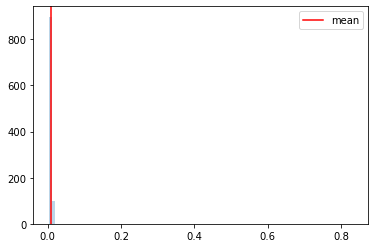

  0%|▏                                                                                | 2/1000 [00:00<00:55, 18.07it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654382729
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 0.1, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:43,  9.64it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:38, 10.08it/s]

Monte Carlo 5
Monte Carlo 6
Monte Carlo 7


  1%|▊                                                                               | 10/1000 [00:00<01:39,  9.94it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 12/1000 [00:01<01:39,  9.88it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 14/1000 [00:01<01:38, 10.03it/s]

Monte Carlo 12
Monte Carlo 13
Monte Carlo 14
Monte Carlo 15


  2%|█▍                                                                              | 18/1000 [00:01<01:40,  9.76it/s]

Monte Carlo 16
Monte Carlo 17
Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<01:41,  9.60it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:45,  9.27it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<01:58,  8.25it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:02<01:57,  8.28it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:06,  7.67it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<01:59,  8.13it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<01:59,  8.12it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:03<01:56,  8.28it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<01:49,  8.80it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<01:55,  8.35it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<01:48,  8.85it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▌                                                                            | 44/1000 [00:04<01:43,  9.23it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:04<01:47,  8.84it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:51,  8.54it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:51,  8.54it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:05<01:58,  8.02it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:05<01:50,  8.60it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:52,  8.41it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<02:01,  7.76it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:06<02:04,  7.56it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:06<01:55,  8.13it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<01:59,  7.82it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<01:58,  7.86it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:07<01:54,  8.13it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:03,  7.55it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:07,  7.27it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<02:01,  7.64it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:08<02:05,  7.38it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:00,  7.66it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:02,  7.50it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:09<02:01,  7.55it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:09<02:03,  7.41it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:03,  7.43it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<02:06,  7.24it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:10<01:58,  7.67it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:10<01:59,  7.63it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:24,  6.27it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<02:27,  6.13it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:22,  6.33it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:10,  6.91it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:04,  7.22it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:12<02:02,  7.34it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:02,  7.30it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:02,  7.28it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:03,  7.20it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:13<02:07,  6.95it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:11,  6.76it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:12,  6.69it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:14<02:07,  6.93it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:06,  6.94it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:12,  6.63it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<02:11,  6.65it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:17,  6.34it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:13,  6.54it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:14,  6.47it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:17,  6.31it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:13,  6.51it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<02:22,  6.05it/s]

Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:17<02:23,  6.02it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:18<02:15,  6.35it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:18<02:20,  6.12it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:18<02:16,  6.28it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:19<02:12,  6.44it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:19<02:13,  6.40it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:19<02:18,  6.16it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:20<02:14,  6.32it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:20<02:20,  6.02it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:20<02:20,  6.03it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:21<02:18,  6.09it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:21<02:21,  5.94it/s]

Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<02:25,  5.80it/s]

Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:21<02:23,  5.84it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:32,  5.51it/s]

Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:28,  5.63it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:25,  5.73it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:26,  5.70it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:22,  5.84it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:23<02:29,  5.56it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:27,  5.60it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:28,  5.56it/s]

Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:31,  5.42it/s]

Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:24<02:33,  5.36it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:36,  5.24it/s]

Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:35,  5.30it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:35,  5.26it/s]

Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:35,  5.25it/s]

Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:37,  5.20it/s]

Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:25<02:39,  5.12it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 184/1000 [00:26<02:45,  4.93it/s]

Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:51,  4.75it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:27<02:52,  4.71it/s]

Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:27<02:49,  4.78it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 190/1000 [00:27<02:51,  4.74it/s]

Monte Carlo 190


 19%|███████████████                                                                | 191/1000 [00:27<02:51,  4.71it/s]

Monte Carlo 191


 19%|███████████████▏                                                               | 192/1000 [00:27<02:56,  4.58it/s]

Monte Carlo 192


 19%|███████████████▏                                                               | 193/1000 [00:28<02:59,  4.49it/s]

Monte Carlo 193


 19%|███████████████▎                                                               | 194/1000 [00:28<03:02,  4.42it/s]

Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:55,  4.59it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▌                                                               | 197/1000 [00:29<02:55,  4.58it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 198/1000 [00:29<02:58,  4.48it/s]

Monte Carlo 198


 20%|███████████████▋                                                               | 199/1000 [00:29<02:54,  4.60it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:54,  4.59it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:30<02:50,  4.68it/s]

Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:30<02:43,  4.86it/s]

Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:30<02:37,  5.04it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:31<02:33,  5.18it/s]

Monte Carlo 206
Monte Carlo 207

 21%|████████████████▍                                                              | 208/1000 [00:31<02:32,  5.20it/s]

 21%|████████████████▌                                                              | 209/1000 [00:31<02:31,  5.23it/s]

Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:31<02:32,  5.17it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:31<02:28,  5.32it/s]

Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:32<02:31,  5.21it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:32<02:30,  5.22it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:32<02:32,  5.17it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:32<02:26,  5.36it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████                                                              | 216/1000 [00:32<02:27,  5.31it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:33<02:44,  4.76it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:33<02:38,  4.93it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:33<02:31,  5.14it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:34<02:25,  5.35it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:34<02:20,  5.50it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:34<02:24,  5.37it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:34<02:20,  5.50it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:35<02:16,  5.64it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:35<02:20,  5.48it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:35<02:25,  5.30it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▎                                                            | 232/1000 [00:35<02:29,  5.13it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:36<02:27,  5.18it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:36<02:32,  5.01it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:37<02:29,  5.09it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:37<02:26,  5.20it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:37<02:22,  5.32it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:37<02:23,  5.30it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:38<02:22,  5.30it/s]

Monte Carlo 243
Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:38<02:23,  5.26it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:38<02:25,  5.18it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:38<02:24,  5.20it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:39<02:28,  5.07it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:39<02:26,  5.11it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:39<02:26,  5.10it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:39<02:29,  5.00it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:40<02:29,  5.00it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:40<02:38,  4.71it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:40<02:35,  4.79it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:41<02:33,  4.85it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:41<02:27,  5.03it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:41<02:22,  5.18it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:41<02:25,  5.09it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:41<02:21,  5.22it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:42<02:20,  5.26it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:42<02:21,  5.20it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:42<02:20,  5.23it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:42<02:21,  5.17it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:43<02:25,  5.03it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:43<02:28,  4.91it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:43<02:29,  4.88it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:44<02:26,  4.96it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:44<02:24,  5.02it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:44<02:25,  4.99it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:44<02:24,  5.00it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:27,  4.91it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:45<02:31,  4.77it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:45<02:32,  4.72it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:45<02:28,  4.83it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:46<02:27,  4.87it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:46<02:24,  4.95it/s]

Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:46<02:27,  4.86it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:46<02:25,  4.91it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:47<02:23,  4.95it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:47<02:22,  5.00it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:47<02:21,  5.03it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:47<02:19,  5.09it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:47<02:24,  4.90it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:48<02:23,  4.93it/s]

Monte Carlo 293
Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:48<02:50,  4.13it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:48<02:50,  4.12it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:49<02:43,  4.29it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:49<02:42,  4.32it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:49<02:42,  4.33it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:49<02:42,  4.30it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:50<02:41,  4.33it/s]

Monte Carlo 301
Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:50<02:32,  4.56it/s]

Monte Carlo 303
Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:50<02:31,  4.59it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:51<02:30,  4.62it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:51<02:24,  4.80it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:51<02:27,  4.69it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:51<02:33,  4.48it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:52<02:29,  4.60it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:52<02:36,  4.39it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:53<02:35,  4.41it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:53<02:30,  4.55it/s]

Monte Carlo 315
Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:53<02:27,  4.63it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:53<02:30,  4.53it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:54<02:31,  4.49it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:54<02:28,  4.56it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:54<02:31,  4.47it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:54<02:34,  4.38it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:55<02:33,  4.40it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:55<02:31,  4.45it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:55<02:29,  4.52it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:55<02:27,  4.55it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:55<02:30,  4.46it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:56<02:30,  4.47it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:56<02:29,  4.49it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:56<02:27,  4.53it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:56<02:27,  4.52it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:57<02:29,  4.47it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:57<02:29,  4.47it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:57<02:28,  4.46it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:57<02:33,  4.31it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:57<02:32,  4.36it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:58<02:27,  4.49it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:58<02:26,  4.52it/s]

Monte Carlo 339


 34%|██████████████████████████▉                                                    | 341/1000 [00:58<02:27,  4.47it/s]

Monte Carlo 340
Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:59<02:26,  4.49it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:59<02:33,  4.27it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:59<02:31,  4.34it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:59<02:27,  4.43it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:00<02:27,  4.43it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:00<02:53,  3.77it/s]

Monte Carlo 347


 35%|███████████████████████████▌                                                   | 349/1000 [01:00<02:32,  4.28it/s]

Monte Carlo 348
Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:00<02:29,  4.35it/s]

Monte Carlo 350


 35%|███████████████████████████▊                                                   | 352/1000 [01:01<02:24,  4.49it/s]

Monte Carlo 351
Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:01<02:27,  4.40it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:01<02:23,  4.49it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 356/1000 [01:02<02:18,  4.63it/s]

Monte Carlo 355
Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:02<02:21,  4.54it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:02<02:23,  4.49it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:02<02:23,  4.46it/s]

Monte Carlo 359


 36%|████████████████████████████▌                                                  | 361/1000 [01:03<02:18,  4.63it/s]

Monte Carlo 360
Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:03<02:18,  4.62it/s]

Monte Carlo 362


 36%|████████████████████████████▊                                                  | 364/1000 [01:04<02:14,  4.74it/s]

Monte Carlo 363
Monte Carlo 364


 37%|████████████████████████████▉                                                  | 366/1000 [01:04<02:14,  4.70it/s]

Monte Carlo 365
Monte Carlo 366


 37%|█████████████████████████████                                                  | 368/1000 [01:04<02:14,  4.71it/s]

Monte Carlo 367
Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:05<02:18,  4.57it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:05<02:17,  4.59it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:05<02:15,  4.64it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 373/1000 [01:05<02:13,  4.71it/s]

Monte Carlo 372
Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:06<02:15,  4.62it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 376/1000 [01:06<02:11,  4.75it/s]

Monte Carlo 375
Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:06<02:15,  4.60it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:07<02:19,  4.47it/s]

Monte Carlo 378


 38%|██████████████████████████████                                                 | 380/1000 [01:07<02:13,  4.65it/s]

Monte Carlo 379
Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:07<02:15,  4.56it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:07<02:17,  4.50it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:08<02:16,  4.53it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:08<02:16,  4.51it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:08<02:13,  4.60it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:08<02:14,  4.57it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:09<02:14,  4.57it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 389/1000 [01:09<02:12,  4.62it/s]

Monte Carlo 388
Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:09<02:17,  4.45it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:10<02:24,  4.21it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:10<02:20,  4.32it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:10<02:17,  4.42it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:10<02:16,  4.45it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:10<02:16,  4.43it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:11<02:18,  4.38it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:11<02:15,  4.45it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:11<02:18,  4.36it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:11<02:20,  4.27it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:12<02:25,  4.13it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:12<02:20,  4.26it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:12<02:18,  4.31it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:16,  4.37it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:15,  4.41it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:13<02:19,  4.26it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:13<02:21,  4.20it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:13<02:19,  4.26it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:17,  4.32it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:14<02:15,  4.37it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:14<02:16,  4.33it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:14<02:14,  4.36it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<02:14,  4.36it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 414/1000 [01:15<02:12,  4.44it/s]

Monte Carlo 413
Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:15<02:15,  4.32it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:14,  4.34it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:15<02:12,  4.38it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:16<02:19,  4.17it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:16<02:16,  4.25it/s]

Monte Carlo 419


 42%|█████████████████████████████████▎                                             | 421/1000 [01:16<02:11,  4.39it/s]

Monte Carlo 420
Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:17<02:18,  4.18it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:17<02:19,  4.14it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:23,  4.00it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:17<02:18,  4.14it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:18<02:19,  4.12it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:18<02:19,  4.10it/s]

Monte Carlo 427


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:13,  4.27it/s]

Monte Carlo 428
Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:19<02:14,  4.23it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:19<02:14,  4.22it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:12,  4.29it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:11,  4.31it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:20<02:12,  4.28it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:20<02:14,  4.21it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:14,  4.19it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:16,  4.12it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:21<02:19,  4.04it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:21<02:17,  4.08it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:18,  4.04it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:21<02:17,  4.08it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:22<02:16,  4.08it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:22<02:18,  4.03it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:22<02:23,  3.88it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:22<02:28,  3.75it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:23<02:26,  3.78it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:23<02:24,  3.83it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:23<02:26,  3.76it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:23<02:23,  3.84it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:24<02:22,  3.85it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:21,  3.87it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:24<02:20,  3.89it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:24<02:20,  3.88it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:25<02:26,  3.74it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:24,  3.77it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:25<02:30,  3.61it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:26<02:27,  3.69it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:26<02:24,  3.75it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:23,  3.77it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:26<02:28,  3.62it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:27<02:27,  3.67it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:22,  3.78it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:27<02:24,  3.71it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:27<02:23,  3.74it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:28<02:23,  3.72it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:28<02:23,  3.73it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:28<02:45,  3.21it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:29<02:38,  3.36it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:29<02:31,  3.50it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:29<02:26,  3.61it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:29<02:26,  3.62it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:30<02:25,  3.63it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:30<02:23,  3.68it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:21,  3.71it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:30<02:20,  3.73it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:31<02:22,  3.67it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:31<02:22,  3.66it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:31<02:21,  3.69it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:32<02:22,  3.65it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:32<02:21,  3.68it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:32<02:24,  3.59it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:32<02:22,  3.64it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:33<02:23,  3.61it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:33<02:20,  3.68it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:33<02:20,  3.66it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:33<02:20,  3.67it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:34<02:22,  3.59it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:34<02:19,  3.66it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:34<02:19,  3.67it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:35<02:16,  3.72it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:35<02:17,  3.70it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:35<02:18,  3.66it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:35<02:21,  3.59it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:36<02:19,  3.62it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:36<02:20,  3.59it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:36<02:19,  3.60it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:37<02:22,  3.54it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:37<02:21,  3.55it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:37<02:20,  3.56it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:37<02:19,  3.59it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:38<02:20,  3.54it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:38<02:22,  3.50it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:38<02:22,  3.50it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:39<02:30,  3.29it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:39<02:28,  3.33it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:39<02:27,  3.35it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:39<02:22,  3.47it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:40<02:21,  3.48it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:40<02:22,  3.44it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:40<02:22,  3.44it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:41<02:20,  3.48it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:41<02:19,  3.51it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:41<02:20,  3.47it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:41<02:20,  3.45it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:42<02:24,  3.36it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:42<02:21,  3.43it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:42<02:17,  3.51it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:43<02:17,  3.51it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:43<02:16,  3.52it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:43<02:16,  3.52it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:43<02:17,  3.48it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:44<02:17,  3.47it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:44<02:15,  3.51it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:44<02:16,  3.48it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:45<02:14,  3.53it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:45<02:13,  3.54it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:45<02:14,  3.52it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:45<02:12,  3.56it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:46<02:12,  3.56it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:46<02:11,  3.56it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:46<02:13,  3.52it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:47<02:16,  3.42it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:47<02:16,  3.41it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:47<02:16,  3.40it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:47<02:17,  3.37it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:48<02:16,  3.40it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:48<02:13,  3.47it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:48<02:13,  3.45it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:49<02:14,  3.42it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:49<02:14,  3.43it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:49<02:12,  3.46it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:49<02:10,  3.52it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:50<02:11,  3.47it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:50<02:13,  3.42it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:50<02:12,  3.44it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:51<02:12,  3.42it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:51<02:13,  3.38it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:51<02:14,  3.35it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:52<02:14,  3.35it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:52<02:14,  3.36it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:52<02:13,  3.35it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:52<02:15,  3.31it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:53<02:15,  3.30it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:53<02:16,  3.28it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:53<02:12,  3.35it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:54<02:12,  3.36it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:54<02:12,  3.35it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:54<02:12,  3.33it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:55<02:12,  3.32it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:55<02:12,  3.33it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:55<02:10,  3.36it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:56<02:12,  3.30it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:56<02:14,  3.24it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:56<02:14,  3.25it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:56<02:17,  3.17it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:57<02:17,  3.16it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:57<02:18,  3.13it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:57<02:20,  3.07it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:58<02:17,  3.12it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:58<02:17,  3.13it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:58<02:17,  3.13it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:59<02:17,  3.11it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:59<02:16,  3.13it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:59<02:15,  3.15it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:00<02:17,  3.09it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:00<02:15,  3.12it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:00<02:13,  3.17it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:01<02:11,  3.22it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:01<02:12,  3.18it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:01<02:13,  3.14it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:02<02:13,  3.15it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:02<02:26,  2.85it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:02<02:20,  2.97it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:03<02:16,  3.05it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:03<02:13,  3.11it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:03<02:13,  3.11it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:04<02:12,  3.13it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:04<02:11,  3.14it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:04<02:10,  3.15it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:05<02:12,  3.10it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:05<02:11,  3.11it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:05<02:11,  3.10it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:05<02:11,  3.09it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:06<02:11,  3.08it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:06<02:09,  3.12it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:06<02:10,  3.08it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:07<02:10,  3.08it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:07<02:10,  3.07it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:07<02:10,  3.08it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:08<02:09,  3.10it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:08<02:07,  3.13it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:08<02:11,  3.02it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:09<02:10,  3.05it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:09<02:12,  3.00it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:09<02:11,  3.00it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:10<02:10,  3.02it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:10<02:12,  2.96it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:10<02:12,  2.96it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:11<02:08,  3.04it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:11<02:07,  3.07it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:11<02:08,  3.02it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:12<02:05,  3.09it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:12<02:03,  3.13it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:12<02:01,  3.17it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:13<02:00,  3.20it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:13<01:57,  3.26it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:13<01:57,  3.26it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:14<01:55,  3.30it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:14<01:54,  3.32it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:14<01:56,  3.26it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:14<01:56,  3.26it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:15<01:53,  3.33it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:15<01:53,  3.32it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:15<01:53,  3.31it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:16<01:55,  3.25it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:16<01:54,  3.27it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:16<01:55,  3.23it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:17<01:55,  3.22it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:17<01:55,  3.20it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:17<01:56,  3.19it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:18<01:52,  3.27it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:18<01:53,  3.24it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:18<01:57,  3.13it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:19<01:56,  3.15it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:19<01:53,  3.21it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:19<01:52,  3.23it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:19<01:55,  3.14it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:20<01:53,  3.18it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:20<01:58,  3.06it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:20<01:53,  3.16it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:21<01:58,  3.03it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:21<01:56,  3.06it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:21<01:53,  3.15it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:22<01:54,  3.11it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:22<01:55,  3.07it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:22<01:55,  3.07it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:23<01:54,  3.08it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:23<01:54,  3.06it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:23<01:53,  3.10it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:24<01:55,  3.02it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:24<01:54,  3.06it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:24<02:01,  2.87it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:25<01:58,  2.92it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:25<01:56,  2.98it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:25<01:55,  2.99it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:26<01:58,  2.90it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:26<01:59,  2.87it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:26<01:59,  2.87it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:27<01:55,  2.95it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:27<01:55,  2.95it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:27<01:55,  2.93it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:28<01:55,  2.94it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:28<02:00,  2.79it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:29<02:01,  2.78it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:29<01:57,  2.85it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:29<01:55,  2.88it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:30<01:55,  2.90it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:30<01:53,  2.93it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:30<01:56,  2.83it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:31<01:58,  2.79it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:31<01:56,  2.82it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:31<01:56,  2.83it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:32<01:55,  2.83it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:32<01:54,  2.84it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:32<01:52,  2.89it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:33<01:52,  2.87it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:33<01:51,  2.90it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:33<01:52,  2.86it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:34<01:52,  2.84it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:34<01:54,  2.80it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:35<01:56,  2.74it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:35<01:55,  2.76it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:35<01:52,  2.81it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:36<01:53,  2.78it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:36<01:51,  2.82it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:36<01:50,  2.83it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:37<01:51,  2.80it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:37<01:48,  2.87it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:37<01:48,  2.85it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:38<01:46,  2.90it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:38<01:45,  2.92it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:38<01:46,  2.90it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:39<01:52,  2.73it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:39<01:52,  2.72it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:40<01:52,  2.72it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:40<01:49,  2.77it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:40<01:47,  2.81it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:41<01:46,  2.83it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:41<01:46,  2.82it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:41<01:45,  2.86it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:42<01:44,  2.85it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:42<01:42,  2.89it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:42<01:45,  2.82it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:43<01:47,  2.75it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:43<01:44,  2.81it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:43<01:45,  2.78it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:44<01:44,  2.79it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:44<01:47,  2.72it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:45<01:46,  2.75it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:45<01:46,  2.73it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:45<01:44,  2.76it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:46<01:43,  2.79it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:46<01:53,  2.54it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:46<01:50,  2.60it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:47<01:50,  2.58it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:47<01:49,  2.60it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:48<01:45,  2.68it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:48<01:44,  2.70it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:48<01:44,  2.68it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:49<01:43,  2.70it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:49<01:42,  2.71it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:49<01:40,  2.76it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:50<01:42,  2.70it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:50<01:40,  2.75it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:50<01:41,  2.71it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:51<01:40,  2.72it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:51<01:39,  2.74it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:52<01:38,  2.77it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:52<01:37,  2.78it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:52<01:36,  2.79it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:53<01:37,  2.76it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:53<01:36,  2.78it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:53<01:36,  2.78it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:54<01:34,  2.81it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:54<01:38,  2.69it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:54<01:37,  2.70it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:55<01:43,  2.55it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:55<01:41,  2.58it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:56<01:39,  2.61it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:56<01:37,  2.67it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:56<01:36,  2.67it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:57<01:35,  2.71it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:57<01:35,  2.70it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:57<01:33,  2.73it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:58<01:37,  2.63it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:58<01:37,  2.60it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:59<01:38,  2.58it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:59<01:36,  2.61it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:59<01:34,  2.67it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:00<01:33,  2.68it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:00<01:31,  2.72it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:01<01:31,  2.72it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:01<01:32,  2.68it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:01<01:32,  2.67it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:02<01:30,  2.69it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:02<01:33,  2.62it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:02<01:32,  2.64it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:03<01:31,  2.64it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:03<01:29,  2.70it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:04<01:28,  2.71it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:04<01:27,  2.72it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:04<01:26,  2.75it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:05<01:25,  2.76it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:05<01:27,  2.68it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:05<01:27,  2.68it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:06<01:28,  2.65it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:06<01:28,  2.65it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:07<01:28,  2.62it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:07<01:30,  2.54it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:07<01:28,  2.60it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:08<01:25,  2.68it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:08<01:25,  2.67it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:08<01:24,  2.70it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:09<01:22,  2.72it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:09<01:22,  2.73it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:09<01:22,  2.71it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:10<01:21,  2.72it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:10<01:24,  2.64it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:11<01:24,  2.60it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:11<01:24,  2.61it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:11<01:24,  2.60it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:12<01:24,  2.58it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:12<01:24,  2.58it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:13<01:22,  2.62it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:13<01:22,  2.61it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:13<01:21,  2.64it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:14<01:20,  2.64it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:14<01:21,  2.62it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:14<01:21,  2.57it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:15<01:20,  2.60it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:15<01:18,  2.65it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:16<01:19,  2.62it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:16<01:18,  2.62it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:16<01:18,  2.64it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:17<01:18,  2.63it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:17<01:17,  2.65it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:18<01:16,  2.64it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:18<01:16,  2.65it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:18<01:17,  2.60it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:19<01:14,  2.70it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:19<01:12,  2.74it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:19<01:11,  2.76it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:20<01:10,  2.80it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:20<01:08,  2.84it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:20<01:09,  2.80it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:21<01:09,  2.80it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:21<01:08,  2.82it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:21<01:09,  2.77it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:22<01:11,  2.68it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:22<01:10,  2.70it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:23<01:10,  2.67it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:23<01:09,  2.72it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:23<01:08,  2.72it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:24<01:07,  2.76it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:24<01:07,  2.76it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:24<01:06,  2.77it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:25<01:07,  2.70it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:25<01:06,  2.74it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:26<01:13,  2.46it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:26<01:11,  2.53it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:26<01:07,  2.63it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:27<01:07,  2.65it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:27<01:05,  2.69it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:27<01:05,  2.70it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:28<01:03,  2.74it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:28<01:02,  2.77it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:29<01:02,  2.79it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:29<01:02,  2.75it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:29<01:03,  2.71it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:30<01:03,  2.68it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:30<01:03,  2.68it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:30<01:02,  2.70it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:31<01:02,  2.69it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:31<01:04,  2.59it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:32<01:03,  2.61it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:32<01:02,  2.64it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:32<01:02,  2.60it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:33<01:02,  2.59it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:33<01:01,  2.61it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:33<01:01,  2.60it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:34<01:00,  2.63it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:34<01:00,  2.63it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:35<01:01,  2.56it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:35<00:59,  2.60it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:35<00:59,  2.61it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:36<00:59,  2.59it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:36<00:58,  2.60it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:37<00:59,  2.55it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:37<00:58,  2.56it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:37<00:59,  2.51it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:38<01:00,  2.48it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:38<00:59,  2.50it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:39<01:00,  2.44it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:39<01:00,  2.41it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:39<00:59,  2.42it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:40<01:01,  2.36it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:40<01:01,  2.33it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:41<01:01,  2.32it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:41<01:00,  2.34it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:42<00:58,  2.38it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:42<00:58,  2.39it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:42<00:57,  2.40it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:43<00:56,  2.41it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:43<00:56,  2.42it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:44<00:56,  2.41it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:44<00:57,  2.34it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:45<00:55,  2.41it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:45<00:54,  2.42it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:45<00:53,  2.45it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:46<00:52,  2.47it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:46<00:52,  2.44it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:47<00:52,  2.42it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:47<00:52,  2.44it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:47<00:52,  2.40it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:48<00:52,  2.40it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:48<00:51,  2.41it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:49<00:50,  2.45it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:49<00:50,  2.42it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:49<00:49,  2.44it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:50<00:49,  2.44it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:50<00:48,  2.46it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:51<00:48,  2.45it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:51<00:47,  2.46it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:51<00:47,  2.42it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:52<00:46,  2.45it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:52<00:46,  2.45it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:53<00:46,  2.45it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:53<00:45,  2.44it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:54<00:45,  2.44it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:54<00:45,  2.39it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:54<00:45,  2.38it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:55<00:44,  2.43it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:55<00:44,  2.42it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:56<00:43,  2.42it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:56<00:43,  2.42it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:56<00:43,  2.41it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:57<00:43,  2.38it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:57<00:42,  2.41it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:58<00:43,  2.35it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:58<00:42,  2.35it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:59<00:42,  2.32it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:59<00:41,  2.35it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:59<00:41,  2.35it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:00<00:40,  2.37it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:00<00:39,  2.40it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:01<00:40,  2.33it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:01<00:39,  2.35it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:02<00:40,  2.30it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:02<00:38,  2.35it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:02<00:39,  2.30it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:03<00:39,  2.28it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:03<00:37,  2.32it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:04<00:37,  2.33it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:04<00:36,  2.35it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:05<00:36,  2.35it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:05<00:36,  2.33it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:05<00:35,  2.35it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:06<00:35,  2.34it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:06<00:34,  2.35it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:07<00:35,  2.26it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:07<00:34,  2.29it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:08<00:33,  2.30it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:08<00:33,  2.31it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:08<00:33,  2.30it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:09<00:32,  2.30it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:09<00:34,  2.16it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:10<00:32,  2.23it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:10<00:31,  2.26it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:11<00:31,  2.22it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:11<00:30,  2.27it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:12<00:30,  2.25it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:12<00:30,  2.26it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:13<00:29,  2.28it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:13<00:28,  2.30it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:13<00:28,  2.31it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:14<00:28,  2.28it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:14<00:27,  2.27it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:15<00:26,  2.31it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:15<00:26,  2.30it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:16<00:25,  2.32it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:16<00:25,  2.33it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:16<00:24,  2.38it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:17<00:23,  2.40it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:17<00:22,  2.45it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:18<00:22,  2.40it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:18<00:22,  2.40it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:18<00:21,  2.43it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:19<00:20,  2.49it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:19<00:21,  2.41it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:20<00:20,  2.43it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:20<00:20,  2.42it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:20<00:19,  2.44it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:21<00:19,  2.40it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:21<00:19,  2.36it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:22<00:19,  2.28it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:22<00:18,  2.34it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:23<00:18,  2.38it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:23<00:17,  2.38it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:23<00:17,  2.38it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:24<00:16,  2.42it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:24<00:16,  2.39it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:25<00:16,  2.35it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:25<00:15,  2.35it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:26<00:15,  2.34it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:26<00:14,  2.38it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:26<00:14,  2.34it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:27<00:13,  2.37it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:27<00:13,  2.38it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:28<00:13,  2.30it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:28<00:13,  2.27it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:29<00:13,  2.22it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:29<00:12,  2.27it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:29<00:11,  2.31it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:30<00:11,  2.30it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:30<00:10,  2.31it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:31<00:10,  2.28it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:31<00:10,  2.27it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:32<00:09,  2.25it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:32<00:09,  2.21it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:33<00:08,  2.22it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:33<00:08,  2.24it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:34<00:08,  2.23it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:34<00:07,  2.21it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:34<00:07,  2.19it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:35<00:06,  2.21it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:35<00:06,  2.17it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:36<00:05,  2.18it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:36<00:05,  2.17it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:37<00:05,  2.20it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:37<00:04,  2.17it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:38<00:04,  2.14it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:38<00:03,  2.14it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:39<00:03,  2.09it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:39<00:02,  2.05it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:40<00:02,  2.05it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:40<00:01,  2.10it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:41<00:01,  2.11it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:41<00:00,  2.13it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:41<00:00,  2.17it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:42<00:00,  3.54it/s]


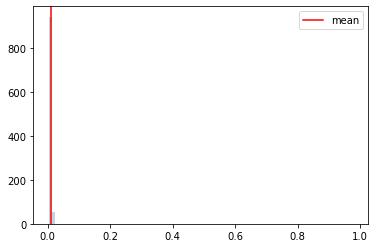

  0%|▏                                                                                | 2/1000 [00:00<00:54, 18.40it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654383012
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 0.1, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:51,  8.94it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:57,  8.48it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<02:00,  8.21it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▋                                                                                | 9/1000 [00:01<02:02,  8.07it/s]

Monte Carlo 9


  1%|▉                                                                               | 12/1000 [00:01<02:09,  7.64it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<02:06,  7.80it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<02:00,  8.18it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:02<01:57,  8.35it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<01:51,  8.76it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<01:54,  8.55it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:59,  8.19it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:03<01:56,  8.39it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<02:17,  7.09it/s]

Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:17,  7.08it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:12,  7.34it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:05,  7.70it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:06,  7.61it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<01:56,  8.25it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<02:04,  7.71it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:56,  8.24it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<01:53,  8.45it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<02:09,  7.40it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<02:01,  7.87it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:56,  8.16it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:06<02:05,  7.54it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<02:01,  7.79it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<02:02,  7.72it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:07<01:58,  7.97it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<01:59,  7.85it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<02:02,  7.68it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<02:01,  7.70it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:08<02:01,  7.69it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:08<02:06,  7.36it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:08<02:06,  7.34it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:08<02:03,  7.55it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:09<02:01,  7.62it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:09<02:01,  7.59it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<02:11,  7.05it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:09<02:05,  7.34it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:10<02:06,  7.26it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:10<02:06,  7.27it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:10<02:08,  7.12it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:11<02:06,  7.24it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:11<02:03,  7.38it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:11<02:09,  7.01it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:11<02:11,  6.88it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:12<02:09,  6.98it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:12<02:08,  7.04it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:12<02:12,  6.80it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:13<02:06,  7.09it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:13<02:08,  6.98it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:13<02:04,  7.20it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:13<02:14,  6.64it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:14<02:23,  6.22it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:14<02:23,  6.20it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:14<02:21,  6.26it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:15<02:12,  6.69it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:15<02:09,  6.83it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:15<02:11,  6.70it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:16<02:12,  6.64it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:16<02:15,  6.47it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:16<02:13,  6.55it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:17<02:13,  6.57it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:17<02:06,  6.91it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:17<02:03,  7.05it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:17<02:04,  6.96it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:18<02:14,  6.42it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:18<02:07,  6.76it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:18<02:30,  5.71it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:19<02:17,  6.26it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:19<02:12,  6.46it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:19<02:18,  6.19it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:20<02:13,  6.41it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:20<02:12,  6.41it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:20<02:08,  6.61it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:21<02:21,  5.97it/s]

Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<02:19,  6.07it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:22,  5.94it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:22<02:24,  5.82it/s]

Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:22<02:20,  5.99it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:22<02:17,  6.09it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:18,  6.03it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:23<02:22,  5.88it/s]

Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:23<02:24,  5.78it/s]

Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:23<02:26,  5.70it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:21,  5.86it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:24<02:13,  6.21it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:24<02:11,  6.29it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:09,  6.38it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:25<02:12,  6.20it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:12,  6.20it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:20,  5.82it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:26<02:23,  5.72it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:18,  5.88it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:18,  5.86it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:27<02:11,  6.19it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:08,  6.28it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:27<02:06,  6.38it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:28<02:03,  6.55it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 195/1000 [00:28<02:23,  5.62it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:28<02:22,  5.64it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:12,  6.05it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:13,  6.01it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:29<02:03,  6.43it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:30<02:32,  5.20it/s]

Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:25,  5.47it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:22,  5.57it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:16,  5.77it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:31<02:17,  5.74it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:12,  5.95it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:10,  6.01it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:08,  6.06it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:07,  6.12it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:06,  6.14it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:33<02:27,  5.28it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:35,  4.99it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:32,  5.09it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:34<02:26,  5.28it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████                                                             | 229/1000 [00:34<02:20,  5.48it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:27,  5.22it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:20,  5.46it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:21,  5.41it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:19,  5.50it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:12,  5.78it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:12,  5.76it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:17,  5.51it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:23,  5.30it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:28,  5.10it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:26,  5.15it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:20,  5.37it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:31,  4.98it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:27,  5.09it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:20,  5.35it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:22,  5.25it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:38<02:21,  5.29it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:39<02:25,  5.14it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:23,  5.20it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:22,  5.23it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:23,  5.16it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:40<02:44,  4.50it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:38,  4.67it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:34,  4.79it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:40<02:31,  4.87it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:29,  4.93it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:32,  4.83it/s]

Monte Carlo 264


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:32,  4.81it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 266/1000 [00:41<02:33,  4.77it/s]

Monte Carlo 266


 27%|█████████████████████                                                          | 267/1000 [00:41<02:54,  4.21it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:39,  4.58it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:31,  4.83it/s]

Monte Carlo 269
Monte Carlo 270


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:52,  4.23it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:43<02:46,  4.38it/s]

Monte Carlo 272
Monte Carlo 273


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:44,  4.41it/s]

Monte Carlo 274


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:42,  4.47it/s]

Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:44,  4.41it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 277/1000 [00:44<02:44,  4.39it/s]

Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:42,  4.44it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:44<02:43,  4.42it/s]

Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:44<02:40,  4.48it/s]

Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:45<02:39,  4.51it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:45<02:42,  4.41it/s]

Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:47,  4.29it/s]

Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:47,  4.28it/s]

Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:45,  4.33it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:46<02:48,  4.23it/s]

Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:46<02:45,  4.30it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:42,  4.38it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:45,  4.30it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:47<02:46,  4.27it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:47<02:43,  4.33it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:47<02:48,  4.21it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:44,  4.31it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:48<02:42,  4.35it/s]

Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:48<02:43,  4.30it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:48<02:46,  4.23it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:47,  4.19it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:49<02:50,  4.12it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:49<02:48,  4.16it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:49<02:45,  4.24it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:49<02:40,  4.36it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:39,  4.39it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:50<02:37,  4.42it/s]

Monte Carlo 303
Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:50<02:34,  4.51it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:50<02:37,  4.41it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:51<02:42,  4.27it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:51<02:41,  4.28it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:51<02:38,  4.35it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:51<02:37,  4.39it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:52<02:36,  4.40it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:52<02:37,  4.36it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:52<02:40,  4.29it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:52<02:37,  4.35it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:53<02:29,  4.57it/s]

Monte Carlo 315
Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:53<02:39,  4.27it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:53<02:46,  4.10it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:53<02:46,  4.09it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:54<02:48,  4.03it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:54<02:51,  3.97it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:54<02:50,  3.98it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:54<02:50,  3.98it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:55<02:51,  3.94it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:55<02:49,  3.99it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:55<02:43,  4.12it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:55<02:46,  4.04it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:56<02:43,  4.11it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:56<02:37,  4.27it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:56<02:31,  4.41it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:57<02:28,  4.51it/s]

Monte Carlo 331
Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:57<02:29,  4.45it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:57<02:29,  4.45it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:57<02:36,  4.24it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:57<02:36,  4.25it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:58<02:34,  4.28it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:58<02:34,  4.29it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:58<02:41,  4.08it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:58<02:38,  4.17it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:59<02:35,  4.23it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:59<02:44,  4.00it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:59<02:44,  3.99it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:59<02:42,  4.04it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:00<02:38,  4.14it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:00<02:35,  4.20it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:00<02:37,  4.15it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:00<02:34,  4.23it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:01<02:41,  4.02it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:01<02:36,  4.15it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:01<02:40,  4.04it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:01<02:41,  4.01it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:02<02:39,  4.05it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:02<02:39,  4.05it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:02<02:38,  4.07it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:02<02:38,  4.07it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:03<02:40,  4.01it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:03<02:40,  4.00it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:03<02:45,  3.88it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:03<02:39,  4.01it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:04<02:36,  4.08it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:04<02:36,  4.09it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:04<02:36,  4.08it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:04<02:39,  4.00it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:05<02:34,  4.11it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:05<02:33,  4.13it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:05<02:31,  4.17it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:05<02:30,  4.20it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:06<02:29,  4.22it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:06<02:30,  4.19it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:06<02:34,  4.07it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:06<02:31,  4.16it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:07<02:33,  4.08it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:07<02:34,  4.06it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:07<02:38,  3.94it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:07<02:36,  3.99it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:08<02:36,  3.97it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:08<02:31,  4.10it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:08<02:37,  3.96it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:08<02:36,  3.97it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:09<02:37,  3.93it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:09<02:35,  3.97it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:09<02:36,  3.93it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:09<02:40,  3.83it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:10<02:41,  3.82it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:10<02:40,  3.83it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:10<02:37,  3.90it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:10<02:36,  3.92it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:11<02:34,  3.96it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:11<02:31,  4.02it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:11<02:29,  4.08it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:11<02:27,  4.11it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:12<02:27,  4.12it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:12<02:26,  4.15it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:12<02:34,  3.93it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:12<02:37,  3.84it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:13<02:33,  3.93it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:13<02:37,  3.82it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:13<02:37,  3.81it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:13<02:41,  3.73it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:14<02:44,  3.65it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:14<02:40,  3.73it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:14<02:35,  3.85it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:14<02:33,  3.87it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:15<02:38,  3.75it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:15<02:46,  3.58it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:15<02:39,  3.73it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:16<02:39,  3.70it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:16<02:38,  3.73it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:16<02:37,  3.73it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:16<02:31,  3.88it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:17<02:34,  3.80it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:17<02:31,  3.88it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:17<02:32,  3.85it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:17<02:33,  3.81it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:18<02:29,  3.91it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:18<02:46,  3.50it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:18<02:42,  3.59it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:19<02:40,  3.61it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:19<02:51,  3.38it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:19<02:47,  3.46it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:19<02:47,  3.44it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:20<02:54,  3.31it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:20<02:45,  3.49it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:20<02:42,  3.53it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:21<02:46,  3.45it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:21<02:47,  3.43it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:21<02:41,  3.55it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:21<02:35,  3.67it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:22<02:36,  3.63it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:22<02:57,  3.20it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:22<02:47,  3.39it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:23<02:44,  3.45it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:23<02:39,  3.56it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:23<02:38,  3.57it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:23<02:38,  3.56it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:24<02:39,  3.53it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:24<02:34,  3.63it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:24<02:36,  3.59it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:25<02:32,  3.68it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:25<02:30,  3.71it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:25<02:33,  3.64it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:25<02:35,  3.57it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:26<02:38,  3.51it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:26<02:33,  3.62it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:26<02:34,  3.58it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:27<02:38,  3.50it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:27<02:37,  3.50it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:27<02:36,  3.53it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:27<02:36,  3.50it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:28<02:36,  3.50it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:28<02:32,  3.60it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:28<02:34,  3.54it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:28<02:31,  3.61it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:29<02:36,  3.47it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:29<02:41,  3.36it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:29<02:35,  3.48it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:30<02:34,  3.51it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:30<02:37,  3.44it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:30<02:37,  3.43it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:31<02:36,  3.45it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:31<02:38,  3.40it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:31<02:39,  3.36it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:31<02:41,  3.33it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:32<02:34,  3.47it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:32<02:33,  3.47it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:32<02:31,  3.52it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:33<02:37,  3.37it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:33<02:38,  3.35it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:33<02:45,  3.20it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:34<02:38,  3.34it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:34<02:33,  3.43it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:34<02:30,  3.51it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:34<02:33,  3.42it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:35<02:35,  3.38it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:35<02:30,  3.49it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:35<02:33,  3.41it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:36<02:32,  3.43it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:36<02:35,  3.36it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:36<02:38,  3.27it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:36<02:36,  3.33it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:37<02:32,  3.40it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:37<02:33,  3.38it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:37<02:28,  3.48it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:38<02:29,  3.45it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:38<02:30,  3.41it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:38<02:28,  3.45it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:38<02:27,  3.48it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:39<02:28,  3.44it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:39<02:28,  3.43it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:39<02:28,  3.43it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:40<02:35,  3.27it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:40<02:31,  3.34it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:40<02:29,  3.39it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:41<02:31,  3.32it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:41<02:36,  3.23it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:41<02:33,  3.28it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:42<02:36,  3.21it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:42<02:33,  3.26it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:42<02:33,  3.26it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:42<02:33,  3.26it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:43<02:33,  3.24it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:43<02:30,  3.30it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:43<02:32,  3.24it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:44<02:34,  3.20it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:44<02:30,  3.29it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:44<02:34,  3.20it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:45<02:32,  3.23it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:45<02:35,  3.15it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:45<02:34,  3.18it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:46<02:32,  3.20it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:46<02:28,  3.28it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:46<02:30,  3.24it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:46<02:32,  3.18it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:47<02:29,  3.25it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:47<02:28,  3.25it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:47<02:26,  3.29it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:48<02:25,  3.31it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:48<02:33,  3.14it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:48<02:36,  3.07it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:49<02:43,  2.93it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:49<02:42,  2.94it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:49<02:40,  2.97it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:50<02:32,  3.12it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:50<02:31,  3.14it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:50<02:24,  3.29it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:51<02:21,  3.33it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:51<02:20,  3.36it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:51<02:23,  3.29it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:51<02:18,  3.40it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:52<02:15,  3.45it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:52<02:15,  3.46it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:52<02:17,  3.40it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:53<02:20,  3.31it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:53<02:16,  3.40it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:53<02:38,  2.92it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:54<02:28,  3.11it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:54<02:24,  3.19it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:54<02:22,  3.24it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:54<02:16,  3.37it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:55<02:13,  3.43it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:55<02:11,  3.47it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:55<02:15,  3.36it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:56<02:15,  3.36it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:56<02:15,  3.36it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:56<02:15,  3.34it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:57<02:11,  3.44it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:57<02:10,  3.45it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:57<02:11,  3.43it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:57<02:11,  3.42it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:58<02:10,  3.44it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:58<02:16,  3.29it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:58<02:12,  3.38it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:59<02:10,  3.41it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:59<02:08,  3.45it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:59<02:05,  3.53it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:59<02:03,  3.58it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [02:00<02:04,  3.54it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [02:00<02:08,  3.43it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [02:00<02:08,  3.43it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [02:01<02:08,  3.41it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [02:01<02:10,  3.36it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [02:01<02:14,  3.24it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [02:02<02:10,  3.34it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [02:02<02:09,  3.35it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [02:02<02:08,  3.37it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:02<02:08,  3.37it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:03<02:10,  3.32it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:03<02:08,  3.35it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:03<02:08,  3.34it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:04<02:09,  3.32it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:04<02:08,  3.32it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:04<02:09,  3.29it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:05<02:10,  3.26it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:05<02:07,  3.32it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:05<02:10,  3.26it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:05<02:08,  3.30it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:06<02:06,  3.33it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:06<02:05,  3.35it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:06<02:10,  3.23it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:07<02:07,  3.28it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:07<02:07,  3.28it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:07<02:06,  3.29it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:08<02:09,  3.22it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:08<02:07,  3.24it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:08<02:08,  3.22it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:09<02:07,  3.23it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:09<02:05,  3.27it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:09<02:04,  3.31it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:09<02:04,  3.28it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:10<02:01,  3.36it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:10<02:03,  3.29it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:10<02:02,  3.33it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:11<02:01,  3.34it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:11<02:01,  3.34it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:11<01:59,  3.39it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:11<01:57,  3.43it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:12<01:57,  3.42it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:12<01:56,  3.44it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:12<01:59,  3.35it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:13<01:57,  3.40it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:13<01:59,  3.34it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:13<01:59,  3.32it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:14<01:59,  3.31it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:14<01:58,  3.34it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:14<01:56,  3.37it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:14<01:57,  3.35it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:15<01:58,  3.31it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:15<01:55,  3.39it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:15<01:53,  3.43it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:16<01:51,  3.49it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:16<01:49,  3.54it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:16<01:48,  3.55it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:16<01:52,  3.43it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:17<01:52,  3.42it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:17<01:52,  3.40it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:17<01:52,  3.40it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:18<01:52,  3.40it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:18<01:51,  3.42it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:18<01:48,  3.49it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:19<01:47,  3.51it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:19<01:49,  3.47it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:19<01:50,  3.40it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:19<01:48,  3.47it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:20<01:48,  3.44it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:20<01:51,  3.34it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:20<01:51,  3.36it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:21<01:49,  3.40it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:21<01:50,  3.35it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:21<01:49,  3.38it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:22<01:53,  3.24it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:22<01:53,  3.24it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:22<01:51,  3.30it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:22<01:50,  3.31it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:23<01:48,  3.37it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:23<01:47,  3.40it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:23<02:01,  2.98it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:24<01:55,  3.12it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:24<01:52,  3.21it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:24<01:53,  3.18it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:25<01:49,  3.29it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:25<01:48,  3.30it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:25<01:51,  3.21it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:26<01:52,  3.15it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:26<01:50,  3.22it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:26<01:51,  3.18it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:26<01:49,  3.23it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:27<01:48,  3.25it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:27<01:46,  3.29it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:27<01:44,  3.34it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:28<01:45,  3.32it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:28<01:45,  3.29it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:28<01:45,  3.27it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:29<01:46,  3.25it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:29<01:50,  3.13it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:29<01:50,  3.13it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:30<01:48,  3.16it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:30<01:48,  3.17it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:30<01:50,  3.09it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:31<01:49,  3.10it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:31<01:50,  3.06it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:31<01:50,  3.06it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:32<01:53,  2.96it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:32<01:54,  2.93it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:32<01:52,  2.97it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:33<01:54,  2.91it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:33<01:55,  2.87it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:33<01:52,  2.94it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:34<01:54,  2.89it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:34<01:51,  2.96it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:34<01:52,  2.94it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:35<01:53,  2.89it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:35<01:52,  2.92it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:35<01:51,  2.93it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:36<01:49,  2.98it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:36<01:49,  2.96it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:36<01:50,  2.93it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:37<01:50,  2.92it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:37<01:53,  2.82it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:37<01:53,  2.81it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:38<01:53,  2.80it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:38<01:52,  2.82it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:39<01:51,  2.83it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:39<01:54,  2.77it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:39<01:52,  2.81it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:40<01:49,  2.88it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:40<01:50,  2.83it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:40<01:48,  2.88it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:41<01:46,  2.91it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:41<01:46,  2.90it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:41<01:47,  2.88it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:42<01:47,  2.87it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:42<01:48,  2.84it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:42<01:46,  2.87it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:43<01:46,  2.86it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:43<01:44,  2.91it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:43<01:46,  2.85it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:44<01:43,  2.91it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:44<01:44,  2.87it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:44<01:44,  2.87it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:45<01:44,  2.87it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:45<01:44,  2.85it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:46<01:44,  2.85it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:46<01:41,  2.92it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:46<01:42,  2.88it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:47<01:41,  2.89it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:47<01:41,  2.89it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:47<01:44,  2.80it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:48<01:42,  2.83it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:48<01:41,  2.87it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:48<01:42,  2.82it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:49<01:40,  2.87it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:49<01:38,  2.90it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:49<01:37,  2.93it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:50<01:38,  2.90it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:50<01:40,  2.83it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:50<01:40,  2.81it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:51<01:39,  2.83it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:51<01:39,  2.82it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:51<01:40,  2.80it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:52<01:38,  2.82it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:52<01:40,  2.76it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:53<01:39,  2.79it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:53<01:41,  2.73it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:53<01:40,  2.74it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:54<01:38,  2.79it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:54<01:36,  2.82it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:54<01:38,  2.76it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:55<01:37,  2.78it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:55<01:37,  2.78it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:55<01:35,  2.81it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:56<01:33,  2.86it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:56<01:33,  2.86it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:56<01:32,  2.87it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:57<01:32,  2.88it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:57<01:35,  2.77it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:58<01:33,  2.82it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:58<01:32,  2.83it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:58<01:31,  2.84it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:59<01:31,  2.83it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:59<01:32,  2.81it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:59<01:32,  2.78it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:00<01:30,  2.83it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:00<01:30,  2.82it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:00<01:32,  2.75it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:01<01:31,  2.77it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:01<01:32,  2.73it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:01<01:32,  2.73it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:02<01:30,  2.78it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:02<01:29,  2.79it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:03<01:29,  2.77it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:03<01:29,  2.78it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:03<01:27,  2.82it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:04<01:27,  2.81it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:04<01:24,  2.89it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:04<01:23,  2.91it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:05<01:29,  2.70it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:05<01:30,  2.69it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:05<01:26,  2.77it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:06<01:24,  2.83it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:06<01:25,  2.78it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:06<01:24,  2.83it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:07<01:24,  2.81it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:07<01:22,  2.84it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:08<01:22,  2.84it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:08<01:20,  2.89it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:08<01:21,  2.86it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:09<01:22,  2.80it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:09<01:22,  2.79it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:09<01:23,  2.75it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:10<01:22,  2.77it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:10<01:22,  2.77it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:10<01:21,  2.79it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:11<01:20,  2.81it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:11<01:20,  2.79it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:11<01:20,  2.77it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:12<01:20,  2.77it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:12<01:23,  2.66it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:13<01:21,  2.72it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:13<01:20,  2.72it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:13<01:20,  2.72it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:14<01:20,  2.72it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:14<01:20,  2.71it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:14<01:21,  2.67it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:15<01:19,  2.70it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:15<01:20,  2.66it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:16<01:20,  2.66it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:16<01:19,  2.67it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:16<01:19,  2.65it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:17<01:21,  2.58it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:17<01:19,  2.61it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:18<01:19,  2.60it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:18<01:20,  2.58it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:18<01:19,  2.59it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:19<01:17,  2.65it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:19<01:16,  2.65it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:19<01:17,  2.63it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:20<01:16,  2.63it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:20<01:16,  2.61it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:21<01:15,  2.66it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:21<01:14,  2.68it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:21<01:14,  2.66it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:22<01:14,  2.65it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:22<01:13,  2.66it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:22<01:13,  2.67it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:23<01:12,  2.68it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:23<01:13,  2.64it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:24<01:12,  2.64it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:24<01:10,  2.69it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:24<01:10,  2.70it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:25<01:09,  2.71it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:25<01:10,  2.68it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:25<01:09,  2.69it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:26<01:09,  2.69it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:26<01:08,  2.70it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:27<01:07,  2.71it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:27<01:11,  2.57it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:27<01:09,  2.61it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:28<01:09,  2.61it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:28<01:08,  2.64it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:28<01:07,  2.66it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:29<01:06,  2.67it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:29<01:06,  2.64it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:30<01:06,  2.64it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:30<01:06,  2.62it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:30<01:06,  2.60it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:31<01:07,  2.57it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:31<01:07,  2.56it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:32<01:06,  2.58it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:32<01:05,  2.60it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:32<01:05,  2.59it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:33<01:05,  2.57it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:33<01:03,  2.63it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:33<01:01,  2.71it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:34<00:59,  2.76it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:34<00:59,  2.77it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:34<00:58,  2.76it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:35<00:59,  2.73it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:35<00:58,  2.73it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:36<00:58,  2.73it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:36<00:57,  2.78it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:36<00:56,  2.79it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:37<00:56,  2.78it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:37<00:58,  2.69it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:37<00:57,  2.70it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:38<00:56,  2.70it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:38<00:57,  2.67it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:39<00:57,  2.65it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:39<00:57,  2.63it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:39<00:57,  2.63it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:40<00:57,  2.61it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:40<00:57,  2.56it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:40<00:56,  2.60it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:41<00:56,  2.59it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:41<00:57,  2.52it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:42<00:57,  2.50it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:42<00:57,  2.48it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:43<01:01,  2.31it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:43<00:58,  2.41it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:43<00:58,  2.40it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:44<00:57,  2.44it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:44<00:56,  2.46it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:45<00:54,  2.50it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:45<00:54,  2.48it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:45<00:55,  2.45it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:46<00:55,  2.42it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:46<00:54,  2.45it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:47<00:53,  2.46it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:47<00:51,  2.52it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:47<00:51,  2.52it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:48<00:51,  2.49it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:48<00:51,  2.51it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:49<00:51,  2.49it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:49<00:50,  2.50it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:49<00:51,  2.42it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:50<00:51,  2.43it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:50<00:50,  2.42it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:51<00:49,  2.45it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:51<00:49,  2.42it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:52<00:49,  2.45it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:52<00:48,  2.45it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:52<00:47,  2.46it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:53<00:48,  2.43it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:53<00:48,  2.41it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:54<00:48,  2.36it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:54<00:47,  2.40it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:54<00:46,  2.41it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:55<00:46,  2.42it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:55<00:46,  2.38it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:56<00:45,  2.41it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:56<00:45,  2.42it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:57<00:45,  2.38it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:57<00:45,  2.35it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:57<00:44,  2.39it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:58<00:43,  2.39it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:58<00:43,  2.37it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:59<00:42,  2.40it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:59<00:43,  2.37it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:59<00:42,  2.39it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:00<00:41,  2.41it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:00<00:41,  2.41it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:01<00:40,  2.40it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:01<00:39,  2.45it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:01<00:39,  2.46it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:02<00:38,  2.49it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:02<00:37,  2.53it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:03<00:36,  2.53it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:03<00:35,  2.56it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:03<00:36,  2.50it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:04<00:35,  2.52it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:04<00:35,  2.48it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:05<00:35,  2.47it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:05<00:35,  2.48it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:05<00:34,  2.51it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:06<00:33,  2.52it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:06<00:33,  2.50it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:07<00:33,  2.46it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:07<00:33,  2.47it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:08<00:33,  2.40it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:08<00:32,  2.43it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:08<00:32,  2.43it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:09<00:32,  2.40it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:09<00:31,  2.43it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:10<00:31,  2.43it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:10<00:30,  2.42it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:10<00:30,  2.46it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:11<00:29,  2.49it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:11<00:29,  2.47it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:12<00:28,  2.47it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:12<00:28,  2.47it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:12<00:27,  2.50it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:13<00:27,  2.49it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:13<00:26,  2.51it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:14<00:26,  2.53it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:14<00:25,  2.56it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:14<00:25,  2.52it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:15<00:25,  2.50it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:15<00:24,  2.49it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:16<00:24,  2.52it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:16<00:23,  2.51it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:16<00:23,  2.46it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:17<00:23,  2.47it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:17<00:22,  2.50it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:18<00:22,  2.48it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:18<00:22,  2.47it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:18<00:21,  2.49it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:19<00:21,  2.51it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:19<00:20,  2.54it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:20<00:20,  2.52it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:20<00:20,  2.49it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:20<00:19,  2.52it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:21<00:18,  2.56it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:21<00:18,  2.48it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:22<00:18,  2.44it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:22<00:18,  2.46it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:22<00:17,  2.48it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:23<00:17,  2.49it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:23<00:17,  2.44it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:24<00:16,  2.43it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:24<00:16,  2.43it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:24<00:16,  2.43it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:25<00:15,  2.40it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:25<00:15,  2.39it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:26<00:14,  2.42it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:26<00:14,  2.43it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:27<00:14,  2.37it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:27<00:13,  2.42it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:27<00:14,  2.27it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:28<00:13,  2.32it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:28<00:12,  2.35it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:29<00:12,  2.41it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:29<00:11,  2.37it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:30<00:11,  2.26it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:30<00:11,  2.27it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:30<00:11,  2.26it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:31<00:10,  2.24it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:31<00:10,  2.24it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:32<00:09,  2.27it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:32<00:09,  2.25it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:33<00:08,  2.25it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:33<00:08,  2.27it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:34<00:08,  2.24it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:34<00:07,  2.22it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:35<00:07,  2.17it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:35<00:07,  2.14it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:36<00:06,  2.11it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:36<00:06,  2.08it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:36<00:05,  2.14it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:37<00:05,  2.18it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:37<00:04,  2.18it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:38<00:04,  2.23it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:38<00:03,  2.27it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:39<00:03,  2.26it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:39<00:02,  2.25it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:40<00:02,  2.17it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:40<00:01,  2.17it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:41<00:01,  2.15it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:41<00:00,  2.15it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:41<00:00,  2.19it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:42<00:00,  3.54it/s]


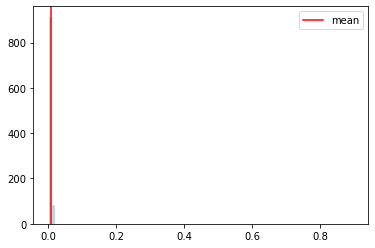

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654383295
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 1.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:04, 15.35it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:26, 11.54it/s]

Monte Carlo 5


  1%|▌                                                                                | 7/1000 [00:00<01:59,  8.31it/s]

Monte Carlo 6
Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:00<01:53,  8.70it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 11/1000 [00:01<02:00,  8.23it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<01:56,  8.44it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<01:59,  8.24it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:01<01:55,  8.49it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<01:56,  8.40it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<02:00,  8.11it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:56,  8.41it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<01:54,  8.51it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<01:52,  8.63it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▏                                                                             | 28/1000 [00:03<01:56,  8.33it/s]

Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:14,  7.24it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:01,  7.96it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<01:59,  8.06it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<01:59,  8.09it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:57,  8.18it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:54,  8.36it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<01:59,  8.01it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<02:08,  7.45it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<02:00,  7.90it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<02:01,  7.87it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:06<01:58,  8.04it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<01:56,  8.12it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<02:14,  7.04it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<02:12,  7.14it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<02:04,  7.54it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<02:03,  7.63it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<02:03,  7.62it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:08<02:12,  7.09it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:08<02:08,  7.29it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:08<02:10,  7.12it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:08<02:06,  7.37it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:09<02:09,  7.18it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:09<02:09,  7.15it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<02:05,  7.36it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:09<02:08,  7.20it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▎                                                                         | 79/1000 [00:10<02:11,  7.01it/s]

Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:28,  6.17it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:21,  6.50it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:11<02:13,  6.87it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:12,  6.87it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:05,  7.24it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:11,  6.94it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:09,  6.99it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:11,  6.88it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:16,  6.61it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:13<02:18,  6.50it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:12,  6.76it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:09,  6.94it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:11,  6.81it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:09,  6.87it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:11,  6.75it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:14,  6.63it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<02:10,  6.79it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:07,  6.95it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:09,  6.80it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:16<02:10,  6.75it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:10,  6.75it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:14,  6.54it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:14,  6.51it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:09,  6.72it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:19,  6.25it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:14,  6.47it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:18<02:12,  6.54it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:13,  6.46it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:11,  6.56it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:19<02:10,  6.59it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:09,  6.61it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:14,  6.38it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:20<02:11,  6.51it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:16,  6.27it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:16,  6.24it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:21<02:16,  6.24it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<02:16,  6.22it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:20,  6.02it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:22<02:19,  6.04it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:16,  6.16it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:12,  6.32it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:12,  6.31it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:23<02:13,  6.23it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:15,  6.13it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:16,  6.10it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:15,  6.14it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:14,  6.16it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:16,  6.04it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:25<02:20,  5.85it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:20,  5.84it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▏                                                                | 180/1000 [00:25<02:22,  5.77it/s]

Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:26<02:29,  5.48it/s]

Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:26<02:25,  5.61it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:18,  5.86it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:27<02:21,  5.74it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▊                                                                | 188/1000 [00:27<02:43,  4.96it/s]

Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:47,  4.83it/s]

Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:39,  5.08it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 192/1000 [00:28<02:33,  5.27it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:28<02:36,  5.15it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 195/1000 [00:28<02:40,  5.01it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:29<02:39,  5.04it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:29<02:29,  5.36it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:27,  5.43it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:30<02:30,  5.30it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:30<02:30,  5.27it/s]

Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:28,  5.36it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:31<02:47,  4.73it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:31<02:39,  4.97it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:31<02:39,  4.94it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:32<02:43,  4.80it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:32<02:42,  4.84it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:32<02:34,  5.08it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:33<02:27,  5.31it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:33<02:26,  5.33it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:33<02:29,  5.23it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:33<02:22,  5.46it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:34<02:18,  5.60it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:34<02:19,  5.56it/s]

Monte Carlo 223
Monte Carlo 224


 22%|█████████████████▊                                                             | 225/1000 [00:34<02:17,  5.65it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:34<02:19,  5.52it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:35<02:18,  5.56it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:35<02:20,  5.48it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:35<02:19,  5.50it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:36<02:10,  5.88it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:36<02:10,  5.87it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:36<02:12,  5.75it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:13,  5.71it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:37<02:09,  5.86it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:37<02:08,  5.90it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:09,  5.84it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:38<02:13,  5.66it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:38<02:15,  5.53it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:11,  5.73it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:39<02:13,  5.61it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:39<02:17,  5.42it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:39<02:14,  5.56it/s]

Monte Carlo 252
Monte Carlo 253


 25%|████████████████████                                                           | 254/1000 [00:39<02:16,  5.48it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:40<02:21,  5.26it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:40<02:21,  5.25it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:40<02:17,  5.38it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:18,  5.34it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:41<02:16,  5.41it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:16,  5.41it/s]

Monte Carlo 263
Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:41<02:19,  5.25it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:42<02:19,  5.24it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:27,  4.97it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:31,  4.82it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:43<02:31,  4.81it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:43<02:25,  5.00it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:27,  4.91it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:24,  5.02it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:24,  5.02it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:44<02:22,  5.08it/s]

Monte Carlo 276
Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:25,  4.95it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:44<02:40,  4.49it/s]

Monte Carlo 279
Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:45<02:46,  4.33it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:46,  4.31it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:41,  4.45it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:31,  4.71it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:46<02:32,  4.69it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:28,  4.81it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:22,  4.98it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:46<02:22,  4.98it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:47<02:17,  5.14it/s]

Monte Carlo 291
Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:18,  5.10it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:47<02:19,  5.06it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:48<02:18,  5.07it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:16,  5.15it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:16,  5.13it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:48<02:16,  5.14it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:17,  5.10it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:49<02:13,  5.23it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:16,  5.12it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:13,  5.21it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:49<02:13,  5.22it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:49<02:13,  5.21it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:50<02:14,  5.18it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:11,  5.25it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:11,  5.27it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:11,  5.24it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:50<02:14,  5.12it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:20,  4.90it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:51<02:16,  5.03it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:19,  4.92it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:15,  5.04it/s]

Monte Carlo 314
Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:19,  4.89it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:21,  4.82it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:16,  4.97it/s]

Monte Carlo 318
Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:20,  4.83it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:53<02:15,  4.99it/s]

Monte Carlo 321
Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:22,  4.77it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:53<02:19,  4.83it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:15,  4.97it/s]

Monte Carlo 325
Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:16,  4.91it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:54<02:16,  4.93it/s]

Monte Carlo 328
Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:54<02:18,  4.85it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:55<02:18,  4.82it/s]

Monte Carlo 331
Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:19,  4.77it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:37,  4.23it/s]

Monte Carlo 334
Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:36,  4.25it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:32,  4.35it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:56<02:29,  4.43it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:57<02:27,  4.48it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:27,  4.49it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:28,  4.43it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:26,  4.49it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:57<02:24,  4.54it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:25,  4.52it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:26,  4.47it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:28,  4.42it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:27,  4.43it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:31,  4.32it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:27,  4.43it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:59<02:30,  4.32it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:27,  4.40it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:26,  4.41it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:00<02:24,  4.48it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:24,  4.47it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:22,  4.52it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:22,  4.51it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:24,  4.46it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:24,  4.44it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:21,  4.52it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:23,  4.47it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:21,  4.51it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:25,  4.38it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:29,  4.26it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:28,  4.27it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:28,  4.28it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:26,  4.32it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:24,  4.38it/s]

Monte Carlo 367


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:22,  4.43it/s]

Monte Carlo 368
Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:22,  4.43it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:26,  4.31it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:32,  4.11it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:29,  4.20it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:33,  4.07it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:33,  4.06it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:29,  4.18it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:25,  4.29it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:23,  4.33it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:24,  4.29it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:27,  4.19it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:29,  4.14it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:31,  4.07it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:28,  4.14it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:30,  4.09it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:28,  4.15it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:26,  4.20it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:25,  4.20it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:27,  4.16it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:23,  4.25it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:22,  4.27it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:09<02:21,  4.30it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:23,  4.25it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:24,  4.21it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:23,  4.23it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:10<02:22,  4.24it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:22,  4.23it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:22,  4.22it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:23,  4.19it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:24,  4.16it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:11<02:23,  4.17it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:23,  4.19it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:21,  4.23it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:21,  4.21it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:26,  4.08it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:26,  4.06it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:31,  3.92it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:34,  3.84it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:32,  3.89it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:13<02:28,  3.97it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:31,  3.89it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:25,  4.04it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<02:23,  4.09it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:27,  3.97it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:27,  3.96it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:27,  3.98it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:25,  4.01it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:15<02:26,  3.97it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:26,  3.97it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:26,  3.96it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:16<02:23,  4.05it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:16<02:21,  4.08it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:21,  4.08it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:20,  4.11it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:22,  4.05it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:17<02:24,  3.99it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:26,  3.91it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:25,  3.93it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:24,  3.95it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:22,  4.00it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:22,  4.00it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:21,  4.03it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:21,  4.00it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:21,  4.00it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:21,  4.01it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:19,  4.05it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:40,  3.52it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:32,  3.69it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:27,  3.82it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:21<02:24,  3.89it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:22,  3.94it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:21<02:22,  3.92it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:21<02:21,  3.93it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:22<02:24,  3.87it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:22<02:22,  3.90it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:22<02:25,  3.81it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:22<02:21,  3.91it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:23<02:23,  3.86it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:23<02:21,  3.90it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:23<02:20,  3.92it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:23<02:19,  3.95it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:20,  3.91it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:24<02:20,  3.89it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:24<02:21,  3.87it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:24<02:19,  3.91it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:20,  3.87it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:25<02:19,  3.89it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:25<02:19,  3.90it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:25<02:22,  3.80it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:20,  3.84it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:26<02:22,  3.79it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:26<02:22,  3.78it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:23,  3.75it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:27<02:23,  3.75it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:27<02:19,  3.84it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:27<02:21,  3.78it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:28<02:22,  3.75it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:28<02:18,  3.84it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:28<02:19,  3.82it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:28<02:17,  3.85it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:29<02:21,  3.74it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:29<02:18,  3.81it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:29<02:18,  3.82it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:29<02:20,  3.74it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:21,  3.71it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:30<02:25,  3.61it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:30<02:25,  3.61it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:31<02:23,  3.65it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:31<02:20,  3.71it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:31<02:18,  3.77it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:31<02:16,  3.80it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:32<02:19,  3.71it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:32<02:18,  3.73it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:32<02:18,  3.74it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:32<02:21,  3.66it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:33<02:18,  3.71it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:33<02:17,  3.74it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:33<02:16,  3.75it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:33<02:14,  3.82it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:34<02:16,  3.73it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:34<02:19,  3.67it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:34<02:20,  3.63it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:35<02:19,  3.64it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:35<02:21,  3.58it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:35<02:20,  3.59it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:35<02:19,  3.62it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:36<02:21,  3.57it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:36<02:21,  3.55it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:36<02:17,  3.65it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:37<02:15,  3.69it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:37<02:15,  3.70it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:37<02:13,  3.73it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:37<02:13,  3.72it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:38<02:15,  3.68it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:38<02:17,  3.62it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:38<02:16,  3.64it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:38<02:16,  3.63it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:39<02:12,  3.71it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:39<02:11,  3.73it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:39<02:12,  3.72it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:40<02:14,  3.63it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:40<02:15,  3.61it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:40<02:14,  3.63it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:40<02:14,  3.61it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:41<02:15,  3.59it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:41<02:14,  3.62it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:41<02:15,  3.58it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:41<02:14,  3.60it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:42<02:14,  3.59it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:42<02:15,  3.55it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:42<02:13,  3.60it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:43<02:14,  3.57it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:43<02:19,  3.43it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:43<02:21,  3.38it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:43<02:18,  3.44it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:44<02:15,  3.50it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:44<02:15,  3.50it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:44<02:14,  3.53it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:45<02:13,  3.54it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:45<02:10,  3.61it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:45<02:08,  3.66it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:45<02:07,  3.68it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:46<02:06,  3.69it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:46<02:04,  3.75it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:46<02:06,  3.70it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:46<02:07,  3.65it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:47<02:05,  3.68it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:47<02:04,  3.71it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:47<02:03,  3.75it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:48<02:05,  3.69it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:48<02:02,  3.76it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:48<02:04,  3.70it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:48<02:03,  3.71it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:49<02:03,  3.71it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:49<02:01,  3.75it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:49<02:04,  3.67it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:49<02:03,  3.68it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:50<02:02,  3.69it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:50<02:02,  3.70it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:50<02:00,  3.74it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:51<02:00,  3.72it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:51<02:03,  3.64it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:51<02:00,  3.72it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:51<01:57,  3.79it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:52<02:00,  3.70it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:52<02:05,  3.54it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:52<02:05,  3.54it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:52<02:04,  3.55it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:53<02:04,  3.56it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:53<02:01,  3.63it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:53<02:01,  3.62it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:54<02:02,  3.58it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:54<02:16,  3.21it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:54<02:13,  3.27it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:55<02:10,  3.34it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:55<02:09,  3.36it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:55<02:04,  3.49it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:55<02:03,  3.51it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:56<02:02,  3.54it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:56<02:04,  3.46it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:56<02:03,  3.50it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:57<02:04,  3.44it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:57<02:01,  3.52it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:57<01:59,  3.58it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:57<02:03,  3.46it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:58<02:00,  3.51it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:58<01:58,  3.57it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:58<01:58,  3.56it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:59<02:01,  3.48it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:59<02:05,  3.35it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:59<02:02,  3.41it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:59<02:06,  3.32it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:00<02:02,  3.41it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:00<02:02,  3.39it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:00<02:01,  3.43it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:01<02:03,  3.36it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:01<02:08,  3.22it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:01<02:11,  3.13it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:02<02:11,  3.13it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:02<02:11,  3.13it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:02<02:07,  3.21it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:03<02:05,  3.25it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:03<02:05,  3.26it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:03<02:03,  3.29it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:03<02:03,  3.29it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:04<02:04,  3.25it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:04<02:03,  3.27it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:04<02:05,  3.22it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:05<02:04,  3.24it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:05<02:03,  3.25it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:05<02:07,  3.14it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:06<02:06,  3.16it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:06<02:11,  3.02it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:06<02:11,  3.02it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:07<02:11,  3.02it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:07<02:09,  3.04it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:07<02:08,  3.07it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:08<02:07,  3.09it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:08<02:06,  3.09it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:08<02:09,  3.03it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:09<02:06,  3.07it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:09<02:07,  3.05it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:09<02:05,  3.09it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:10<02:06,  3.06it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:10<02:05,  3.08it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:10<02:03,  3.11it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:11<02:04,  3.09it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:11<02:03,  3.11it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:11<02:02,  3.11it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:12<02:02,  3.11it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:12<02:06,  3.01it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:12<02:07,  2.98it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:13<02:07,  2.97it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:13<02:04,  3.03it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:13<02:04,  3.01it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:14<02:03,  3.03it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:14<02:02,  3.05it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:14<02:01,  3.07it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:15<02:03,  3.02it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:15<02:00,  3.08it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:15<02:00,  3.06it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:16<02:03,  2.98it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:16<02:01,  3.04it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:16<02:01,  3.01it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:16<02:01,  3.01it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:17<02:01,  2.99it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:17<02:03,  2.95it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:17<02:00,  3.01it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:18<01:59,  3.04it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:18<01:58,  3.04it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:18<01:58,  3.04it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:19<01:58,  3.03it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:19<02:00,  2.98it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:19<01:58,  3.01it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:20<01:59,  2.98it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:20<01:59,  2.98it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:21<02:01,  2.91it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:21<02:00,  2.93it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:21<02:01,  2.91it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:22<02:01,  2.90it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:22<02:00,  2.91it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:22<01:59,  2.92it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:23<01:58,  2.95it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:23<01:55,  3.00it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:23<01:55,  3.00it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:24<01:56,  2.97it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:24<01:56,  2.94it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:24<01:55,  2.97it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:25<01:54,  2.98it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:25<01:53,  3.00it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:25<01:54,  2.98it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:26<01:53,  2.99it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:26<01:53,  2.98it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:26<02:03,  2.73it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:27<02:02,  2.74it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:27<02:00,  2.78it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:27<02:00,  2.77it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:28<02:01,  2.75it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:28<02:03,  2.68it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:29<01:59,  2.76it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:29<01:58,  2.78it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:29<02:00,  2.73it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:30<01:59,  2.75it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:30<01:57,  2.78it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:30<01:58,  2.76it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:31<01:55,  2.80it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:31<01:54,  2.82it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:31<01:55,  2.81it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:32<01:52,  2.86it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:32<01:52,  2.85it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:32<01:50,  2.88it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:33<01:49,  2.91it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:33<01:48,  2.94it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:33<01:52,  2.82it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:34<01:50,  2.86it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:34<01:50,  2.86it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:34<01:48,  2.89it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:35<01:47,  2.91it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:35<01:45,  2.95it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:36<01:45,  2.96it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:36<01:46,  2.91it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:36<01:48,  2.86it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:37<01:50,  2.79it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:37<01:48,  2.83it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:37<01:47,  2.85it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:38<01:46,  2.87it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:38<01:46,  2.85it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:38<01:47,  2.81it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:39<01:47,  2.81it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:39<01:45,  2.84it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:39<01:45,  2.85it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:40<01:46,  2.81it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:40<01:45,  2.82it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:40<01:45,  2.83it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:41<01:43,  2.85it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:41<01:44,  2.83it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:42<01:44,  2.82it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:42<01:42,  2.85it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:42<01:40,  2.91it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:43<01:36,  3.01it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:43<01:36,  3.01it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:43<01:36,  2.99it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:43<01:35,  3.02it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:44<01:36,  2.97it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:44<01:37,  2.95it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:45<01:38,  2.89it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:45<01:37,  2.90it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:45<01:36,  2.93it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:46<01:39,  2.85it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:46<01:36,  2.90it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:46<01:35,  2.94it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:47<01:34,  2.97it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:47<01:35,  2.90it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:47<01:34,  2.92it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:48<01:36,  2.86it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:48<01:38,  2.80it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:48<01:38,  2.79it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:49<01:36,  2.82it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:49<01:36,  2.81it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:49<01:38,  2.76it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:50<01:35,  2.82it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:50<01:37,  2.76it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:51<01:36,  2.77it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:51<01:34,  2.83it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:51<01:32,  2.87it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:52<01:30,  2.91it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:52<01:31,  2.88it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:52<01:30,  2.90it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:53<01:31,  2.87it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:53<01:31,  2.87it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:53<01:28,  2.95it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:54<01:27,  2.95it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:54<01:28,  2.90it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:54<01:29,  2.88it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:55<01:30,  2.84it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:55<01:30,  2.82it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:55<01:31,  2.77it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:56<01:30,  2.81it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:56<01:29,  2.82it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:56<01:28,  2.84it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:57<01:29,  2.78it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:57<01:30,  2.74it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:58<01:29,  2.78it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:58<01:28,  2.80it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:58<01:29,  2.75it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:59<01:30,  2.70it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:59<01:30,  2.69it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:59<01:30,  2.68it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:00<01:29,  2.72it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:00<01:29,  2.70it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:01<01:28,  2.70it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:01<01:29,  2.66it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:01<01:27,  2.71it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:02<01:28,  2.66it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:02<01:31,  2.59it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:02<01:29,  2.63it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:03<01:28,  2.65it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:03<01:28,  2.64it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:04<01:26,  2.69it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:04<01:27,  2.63it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:04<01:26,  2.65it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:05<01:26,  2.63it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:05<01:27,  2.60it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:05<01:25,  2.67it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:06<01:24,  2.66it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:06<01:25,  2.64it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:07<01:23,  2.69it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:07<01:25,  2.61it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:07<01:25,  2.59it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:08<01:23,  2.66it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:08<01:23,  2.63it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:08<01:22,  2.66it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:09<01:23,  2.62it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:09<01:22,  2.63it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:10<01:21,  2.64it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:10<01:21,  2.64it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:10<01:19,  2.68it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:11<01:26,  2.47it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:11<01:24,  2.51it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:12<01:22,  2.57it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:12<01:22,  2.56it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:12<01:23,  2.50it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:13<01:22,  2.53it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:13<01:21,  2.55it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:14<01:21,  2.52it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:14<01:19,  2.57it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:14<01:19,  2.58it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:15<01:17,  2.60it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:15<01:18,  2.56it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:16<01:17,  2.60it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:16<01:16,  2.62it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:16<01:15,  2.63it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:17<01:14,  2.65it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:17<01:15,  2.61it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:17<01:15,  2.60it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:18<01:14,  2.61it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:18<01:14,  2.60it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:19<01:15,  2.54it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:19<01:15,  2.56it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:19<01:14,  2.58it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:20<01:13,  2.58it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:20<01:12,  2.60it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:21<01:11,  2.61it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:21<01:11,  2.61it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:21<01:11,  2.60it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:22<01:12,  2.54it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:22<01:13,  2.50it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:23<01:13,  2.50it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:23<01:13,  2.46it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:23<01:11,  2.54it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:24<01:09,  2.57it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:24<01:08,  2.60it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:24<01:08,  2.59it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:25<01:08,  2.57it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:25<01:08,  2.59it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:26<01:07,  2.61it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:26<01:07,  2.60it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:26<01:08,  2.54it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:27<01:07,  2.54it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:27<01:08,  2.50it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:28<01:07,  2.53it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:28<01:07,  2.50it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:28<01:06,  2.54it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:29<01:05,  2.55it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:29<01:06,  2.48it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:30<01:05,  2.50it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:30<01:05,  2.49it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:30<01:07,  2.41it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:31<01:05,  2.47it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:31<01:04,  2.49it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:32<01:04,  2.48it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:32<01:04,  2.46it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:32<01:04,  2.47it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:33<01:04,  2.43it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:33<01:03,  2.46it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:34<01:02,  2.49it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:34<01:02,  2.46it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:34<01:00,  2.52it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:35<01:00,  2.52it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:35<01:00,  2.48it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:36<00:59,  2.51it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:36<01:00,  2.48it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:36<00:59,  2.50it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:37<00:58,  2.49it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:37<00:58,  2.49it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:38<00:58,  2.48it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:38<00:59,  2.44it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:38<00:57,  2.47it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:39<00:57,  2.49it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:39<00:55,  2.52it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:40<00:54,  2.55it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:40<00:53,  2.61it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:40<00:52,  2.62it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:41<00:51,  2.66it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:41<00:52,  2.60it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:42<00:51,  2.60it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:42<00:51,  2.59it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:42<00:51,  2.59it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:43<00:50,  2.60it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:43<00:50,  2.61it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:43<00:50,  2.58it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:44<00:49,  2.59it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:44<00:49,  2.57it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:45<00:50,  2.52it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:45<00:51,  2.46it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:45<00:50,  2.46it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:46<00:50,  2.46it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:46<00:49,  2.46it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:47<00:53,  2.29it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:47<00:50,  2.39it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:48<00:50,  2.40it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:48<00:48,  2.46it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:48<00:46,  2.51it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:49<00:47,  2.48it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:49<00:46,  2.47it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:50<00:45,  2.51it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:50<00:45,  2.53it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:50<00:44,  2.54it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:51<00:43,  2.57it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:51<00:42,  2.59it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:52<00:42,  2.58it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:52<00:42,  2.56it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:52<00:42,  2.56it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:53<00:41,  2.56it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:53<00:41,  2.54it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:53<00:41,  2.51it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:54<00:41,  2.53it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:54<00:41,  2.50it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:55<00:40,  2.55it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:55<00:39,  2.57it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:55<00:39,  2.55it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:56<00:39,  2.52it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:56<00:39,  2.50it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:57<00:38,  2.51it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:57<00:40,  2.40it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:57<00:38,  2.46it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:58<00:37,  2.49it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:58<00:37,  2.51it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:59<00:36,  2.50it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:59<00:36,  2.49it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:59<00:36,  2.48it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:00<00:35,  2.49it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:00<00:35,  2.47it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:01<00:35,  2.45it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:01<00:35,  2.45it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:02<00:34,  2.45it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:02<00:34,  2.47it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:02<00:33,  2.47it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:03<00:34,  2.39it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:03<00:34,  2.37it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:04<00:33,  2.39it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:04<00:32,  2.40it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:04<00:31,  2.45it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:05<00:31,  2.45it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:05<00:31,  2.41it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:06<00:30,  2.42it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:06<00:30,  2.44it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:06<00:29,  2.47it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:07<00:29,  2.42it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:07<00:29,  2.42it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:08<00:29,  2.39it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:08<00:28,  2.39it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:09<00:28,  2.35it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:09<00:28,  2.32it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:10<00:28,  2.29it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:10<00:28,  2.28it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:10<00:28,  2.21it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:11<00:28,  2.22it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:11<00:28,  2.19it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:12<00:27,  2.18it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:12<00:28,  2.14it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:13<00:26,  2.20it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:13<00:25,  2.24it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:14<00:25,  2.25it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:14<00:24,  2.28it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:14<00:24,  2.24it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:15<00:24,  2.24it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:15<00:23,  2.26it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:16<00:23,  2.24it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:16<00:22,  2.24it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:17<00:22,  2.26it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:17<00:21,  2.33it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:18<00:20,  2.33it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:18<00:20,  2.30it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:18<00:19,  2.35it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:19<00:19,  2.36it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:19<00:18,  2.34it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:20<00:17,  2.39it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:20<00:17,  2.40it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:20<00:17,  2.38it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:21<00:16,  2.36it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:21<00:16,  2.34it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:22<00:16,  2.33it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:22<00:16,  2.28it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:23<00:15,  2.27it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:23<00:15,  2.28it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:24<00:14,  2.27it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:24<00:14,  2.28it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:24<00:14,  2.26it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:25<00:13,  2.22it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:25<00:13,  2.19it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:26<00:13,  2.20it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:26<00:12,  2.20it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:27<00:12,  2.15it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:27<00:12,  2.16it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:28<00:11,  2.17it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:28<00:10,  2.19it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:29<00:10,  2.20it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:29<00:10,  2.17it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:30<00:09,  2.18it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:30<00:09,  2.20it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:30<00:08,  2.23it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:31<00:08,  2.23it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:31<00:07,  2.23it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:32<00:07,  2.22it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:32<00:07,  2.05it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:33<00:06,  2.08it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:33<00:06,  2.12it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:34<00:05,  2.16it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:34<00:05,  2.18it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:35<00:04,  2.17it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:35<00:04,  2.17it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:36<00:03,  2.16it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:36<00:03,  2.15it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:36<00:02,  2.15it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:37<00:02,  2.18it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:37<00:01,  2.14it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:38<00:01,  2.14it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:38<00:00,  2.18it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:39<00:00,  2.16it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:39<00:00,  3.57it/s]


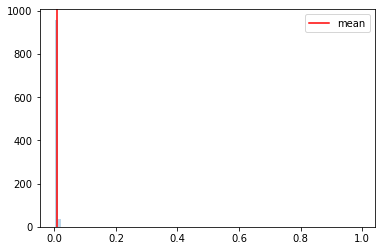

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654383576
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 1.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<00:58, 16.90it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:41,  9.82it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:50,  9.00it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:48,  9.13it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:51,  8.84it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:51,  8.82it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:53,  8.67it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:56,  8.43it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:57,  8.35it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<02:00,  8.10it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:55,  8.46it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<02:04,  7.81it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:20,  6.92it/s]

Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:25,  6.70it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:09,  7.50it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<02:01,  7.95it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<02:03,  7.83it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<01:57,  8.23it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<01:58,  8.12it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<02:04,  7.71it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<01:59,  7.98it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:06,  7.55it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:02,  7.80it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<02:00,  7.88it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:05,  7.54it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:08,  7.39it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:07,  7.40it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<02:09,  7.29it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:01,  7.76it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:02,  7.66it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:08,  7.28it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:08,  7.28it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:04,  7.50it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:07,  7.28it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:09<02:08,  7.22it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:10,  7.09it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:05,  7.36it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:01,  7.60it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:06,  7.28it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:04,  7.39it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:11,  6.98it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:11<02:44,  5.55it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:25,  6.27it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:24,  6.29it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:14,  6.77it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:13,  6.80it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:14,  6.73it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:17,  6.59it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:13<02:09,  6.95it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:11,  6.85it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:10,  6.89it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:14<02:06,  7.07it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:03,  7.24it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:00,  7.38it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<01:59,  7.45it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<01:57,  7.52it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:01,  7.29it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:03,  7.13it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:16<02:22,  6.20it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:17,  6.39it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:12,  6.63it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:14,  6.53it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:15,  6.43it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:13,  6.54it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:09,  6.72it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:18<02:08,  6.77it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:06,  6.86it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:07,  6.78it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:19<02:04,  6.91it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:06,  6.77it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:03,  6.91it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:11,  6.52it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:11,  6.48it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:22,  5.99it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:27,  5.77it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<02:18,  6.13it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:18,  6.10it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:26,  5.75it/s]

Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:22<02:22,  5.90it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:22<02:17,  6.10it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:15,  6.18it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:23<02:16,  6.11it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:23<02:11,  6.32it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:10,  6.37it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:24<02:21,  5.89it/s]

Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:17,  6.03it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:14,  6.15it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:13,  6.19it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:25<02:10,  6.29it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:11,  6.24it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:08,  6.39it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:26<02:10,  6.26it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:11,  6.21it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:11,  6.17it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:27<02:13,  6.08it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:15,  5.98it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:27<02:13,  6.05it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:28<02:17,  5.87it/s]

Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:15,  5.95it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:11,  6.12it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:10,  6.12it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:14,  5.91it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:20,  5.68it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:18,  5.72it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:19,  5.70it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:35,  5.08it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 211/1000 [00:31<02:31,  5.20it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:30,  5.22it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:29,  5.26it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:26,  5.34it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:32<02:27,  5.30it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:35,  5.03it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:35,  5.03it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:29,  5.21it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:33<02:23,  5.42it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:33<02:22,  5.45it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:34<02:18,  5.58it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:34<02:24,  5.33it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:25,  5.27it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:35<02:31,  5.08it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:27,  5.19it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:27,  5.20it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:24,  5.28it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:20,  5.44it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:36<02:27,  5.15it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:51,  4.43it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:36<02:42,  4.67it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:37<02:36,  4.83it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:37<02:33,  4.94it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:35,  4.87it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:31,  4.99it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 247/1000 [00:38<02:32,  4.93it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:34,  4.87it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:36,  4.81it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:39<02:32,  4.90it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:39<02:29,  5.00it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:31,  4.91it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▎                                                          | 257/1000 [00:40<02:41,  4.61it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:40<02:29,  4.95it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:27,  5.03it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:25,  5.07it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:41<02:26,  5.04it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:41<02:22,  5.16it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:24,  5.08it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:22,  5.14it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:41<02:23,  5.12it/s]

Monte Carlo 265
Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:42<02:27,  4.97it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:27,  4.95it/s]

Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:27,  4.96it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:43<02:31,  4.80it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:43<02:31,  4.80it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:27,  4.92it/s]

Monte Carlo 273
Monte Carlo 274


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:31,  4.79it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:44<02:28,  4.87it/s]

Monte Carlo 276
Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:28,  4.85it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:44<02:33,  4.70it/s]

Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:44<02:34,  4.66it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:45<02:32,  4.70it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:29,  4.78it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:45<02:33,  4.68it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:46<02:29,  4.76it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:29,  4.75it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:32,  4.65it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:47<02:29,  4.73it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:26,  4.81it/s]

Monte Carlo 292
Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:48<02:32,  4.63it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:48<02:33,  4.58it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:31,  4.63it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:48<02:30,  4.65it/s]

Monte Carlo 298
Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:49<02:37,  4.43it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:29,  4.67it/s]

Monte Carlo 301
Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:31,  4.60it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:50<02:35,  4.48it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:50<02:42,  4.28it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:32,  4.55it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:29,  4.61it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:51<02:35,  4.46it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:51<02:33,  4.49it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:31,  4.54it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:52<02:32,  4.51it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:52<02:32,  4.49it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:52<02:30,  4.54it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:27,  4.63it/s]

Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:53<02:30,  4.54it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:53<02:28,  4.60it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:27,  4.60it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:54<02:26,  4.62it/s]

Monte Carlo 321
Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:54<02:26,  4.62it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:54<02:26,  4.62it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:26,  4.62it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:27,  4.56it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:55<02:26,  4.58it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:55<02:27,  4.56it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:55<02:31,  4.42it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:28,  4.51it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:56<02:29,  4.49it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:56<02:32,  4.37it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:56<02:32,  4.36it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:56<02:28,  4.49it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:30,  4.42it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:57<02:27,  4.51it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:57<02:29,  4.43it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:57<02:27,  4.50it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:58<02:24,  4.57it/s]

Monte Carlo 339
Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:58<02:26,  4.51it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:58<02:29,  4.40it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:58<02:32,  4.29it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:32,  4.31it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:59<02:38,  4.13it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:59<02:32,  4.28it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:59<02:28,  4.40it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:25,  4.47it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:00<02:24,  4.49it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:00<02:23,  4.53it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:00<02:45,  3.92it/s]

Monte Carlo 351


 35%|███████████████████████████▉                                                   | 353/1000 [01:01<02:30,  4.30it/s]

Monte Carlo 352
Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:01<02:27,  4.37it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:01<02:27,  4.38it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:01<02:27,  4.35it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:02<02:31,  4.23it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:02<02:28,  4.33it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:02<02:26,  4.38it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:02<02:25,  4.40it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:02<02:23,  4.45it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:03<02:31,  4.22it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:03<02:26,  4.34it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:03<02:23,  4.44it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:03<02:22,  4.45it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:04<02:23,  4.42it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:04<02:21,  4.48it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:04<02:27,  4.28it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:04<02:48,  3.75it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:05<02:51,  3.68it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:05<02:46,  3.77it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:05<02:47,  3.75it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:05<02:41,  3.89it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:06<02:40,  3.90it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:06<02:38,  3.95it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:06<02:31,  4.11it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:06<02:28,  4.20it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:07<02:27,  4.22it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:07<02:30,  4.13it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:07<02:29,  4.14it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:07<02:37,  3.94it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:08<02:42,  3.80it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:08<02:35,  3.96it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:08<02:32,  4.03it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:08<02:24,  4.25it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:09<02:25,  4.23it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:09<02:21,  4.34it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:09<02:16,  4.47it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:09<02:17,  4.43it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:09<02:13,  4.56it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:10<02:17,  4.44it/s]

Monte Carlo 391


 39%|███████████████████████████████                                                | 393/1000 [01:10<02:13,  4.53it/s]

Monte Carlo 392
Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:10<02:16,  4.46it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:11<02:14,  4.50it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:11<02:14,  4.50it/s]

Monte Carlo 396


 40%|███████████████████████████████▍                                               | 398/1000 [01:11<02:15,  4.45it/s]

Monte Carlo 397
Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:11<02:23,  4.18it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:12<02:25,  4.12it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:12<02:27,  4.07it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:12<02:26,  4.08it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:23,  4.16it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:13<02:22,  4.18it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:13<02:20,  4.24it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:13<02:20,  4.23it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:13<02:22,  4.17it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:14<02:22,  4.14it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:14<02:22,  4.16it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:14<02:21,  4.18it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:14<02:17,  4.29it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:15<02:18,  4.24it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:15<02:17,  4.28it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:15<02:21,  4.15it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:15<02:22,  4.10it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:16<02:16,  4.27it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:16<02:16,  4.27it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:16<02:13,  4.35it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:16<02:15,  4.30it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:16<02:11,  4.40it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:17<02:11,  4.39it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:17<02:10,  4.44it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:17<02:07,  4.52it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:07,  4.53it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:18<02:07,  4.51it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:18<02:06,  4.55it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:18<02:13,  4.30it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:13,  4.29it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:10,  4.38it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:19<02:12,  4.29it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:19<02:13,  4.26it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:14,  4.24it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:13,  4.24it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:20<02:14,  4.21it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:20<02:10,  4.32it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:18,  4.08it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:14,  4.20it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:21<02:17,  4.09it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:21<02:15,  4.15it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:13,  4.19it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:21<02:17,  4.05it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:22<02:19,  4.01it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:22<02:18,  4.02it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:22<02:21,  3.94it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:22<02:16,  4.07it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:23<02:17,  4.03it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:23<02:17,  4.01it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:23<02:17,  4.01it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:23<02:15,  4.05it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:24<02:14,  4.09it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:16,  4.03it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:24<02:12,  4.14it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:24<02:10,  4.20it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:25<02:10,  4.17it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:07,  4.27it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:25<02:12,  4.11it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:25<02:13,  4.05it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:26<02:13,  4.06it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:10,  4.14it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:26<02:09,  4.16it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:26<02:10,  4.12it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:10,  4.11it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:27<02:13,  4.01it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:27<02:13,  4.03it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:27<02:13,  4.00it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:28<02:13,  3.99it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:28<02:15,  3.93it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:28<02:18,  3.85it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:28<02:35,  3.42it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:29<02:28,  3.57it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:29<02:25,  3.64it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:29<02:25,  3.62it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:30<02:33,  3.42it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:28,  3.53it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:30<02:29,  3.50it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:30<02:26,  3.58it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:31<02:27,  3.54it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:31<02:25,  3.58it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:31<02:24,  3.60it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:31<02:25,  3.58it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:32<02:32,  3.41it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:32<02:31,  3.41it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:32<02:28,  3.47it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:33<02:30,  3.43it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:33<02:28,  3.47it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:33<02:38,  3.24it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:34<02:33,  3.35it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:34<02:29,  3.42it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:34<02:27,  3.46it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:34<02:28,  3.43it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:35<02:29,  3.40it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:35<02:35,  3.27it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:35<02:42,  3.12it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:36<02:41,  3.14it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:36<02:51,  2.94it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:37<02:53,  2.91it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:37<02:51,  2.94it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:37<02:48,  2.97it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:38<02:50,  2.94it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:38<02:49,  2.94it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:38<02:40,  3.10it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:38<02:33,  3.24it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:39<02:28,  3.35it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:39<02:27,  3.37it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:39<02:26,  3.38it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:40<02:25,  3.40it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:40<02:24,  3.42it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:40<02:25,  3.39it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:40<02:24,  3.40it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:41<02:22,  3.43it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:41<02:27,  3.32it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:41<02:29,  3.27it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:42<02:28,  3.28it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:42<02:24,  3.35it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:42<02:28,  3.27it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:43<02:28,  3.25it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:43<02:32,  3.17it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:43<02:33,  3.14it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:44<02:33,  3.14it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:44<02:32,  3.15it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:44<02:28,  3.23it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:44<02:26,  3.26it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:45<02:25,  3.29it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:45<02:23,  3.31it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:45<02:20,  3.38it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:46<02:18,  3.43it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:46<02:15,  3.48it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:46<02:20,  3.36it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:47<02:17,  3.42it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:47<02:15,  3.48it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:47<02:14,  3.49it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:47<02:17,  3.40it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:48<02:18,  3.38it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:48<02:20,  3.31it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:48<02:20,  3.32it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:49<02:18,  3.35it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:49<02:23,  3.22it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:49<02:20,  3.29it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:50<02:17,  3.36it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:50<02:18,  3.32it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:50<02:18,  3.31it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:50<02:16,  3.35it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:51<02:17,  3.34it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:51<02:19,  3.26it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:51<02:17,  3.31it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:52<02:17,  3.31it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:52<02:18,  3.27it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:52<02:16,  3.32it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:53<02:14,  3.34it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:53<02:16,  3.29it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:53<02:16,  3.29it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:53<02:16,  3.29it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:54<02:16,  3.28it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:54<02:15,  3.29it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:54<02:14,  3.31it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:55<02:15,  3.29it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:55<02:15,  3.28it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:55<02:15,  3.27it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:56<02:16,  3.22it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:56<02:18,  3.18it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:56<02:16,  3.23it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:57<02:16,  3.20it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:57<02:21,  3.10it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:57<02:20,  3.10it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:58<02:19,  3.11it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:58<02:17,  3.16it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:58<02:18,  3.13it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:58<02:19,  3.09it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:59<02:18,  3.11it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:59<02:15,  3.17it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:59<02:13,  3.22it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:00<02:16,  3.15it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:00<02:13,  3.20it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:00<02:12,  3.21it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:01<02:14,  3.17it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:01<02:13,  3.18it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:01<02:30,  2.81it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:02<02:31,  2.79it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:02<02:27,  2.86it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:02<02:21,  2.98it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:03<02:16,  3.06it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:03<02:14,  3.11it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:03<02:13,  3.13it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:04<02:14,  3.10it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:04<02:14,  3.08it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:04<02:15,  3.05it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:05<02:14,  3.08it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:05<02:13,  3.08it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:05<02:11,  3.13it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:06<02:11,  3.11it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:06<02:14,  3.03it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:06<02:12,  3.07it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:07<02:11,  3.09it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:07<02:13,  3.04it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:07<02:09,  3.12it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:08<02:09,  3.11it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:08<02:07,  3.16it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:08<02:07,  3.14it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:09<02:05,  3.19it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:09<02:08,  3.12it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:09<02:07,  3.12it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:09<02:06,  3.14it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:10<02:05,  3.17it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:10<02:05,  3.15it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:10<02:08,  3.08it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:11<02:08,  3.07it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:11<02:06,  3.12it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:11<02:03,  3.17it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:12<02:01,  3.23it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:12<02:01,  3.20it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:12<01:58,  3.27it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:13<01:57,  3.29it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:13<01:58,  3.27it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:13<01:56,  3.31it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:14<01:57,  3.27it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:14<01:59,  3.21it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:14<02:00,  3.19it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:14<01:56,  3.27it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:15<01:56,  3.28it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:15<01:57,  3.23it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:15<01:57,  3.23it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:16<01:56,  3.25it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:16<01:57,  3.20it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:16<01:54,  3.27it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:17<01:56,  3.22it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:17<01:55,  3.23it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:17<01:56,  3.20it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:18<01:53,  3.28it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:18<01:56,  3.19it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:18<01:57,  3.15it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:19<01:59,  3.09it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:19<01:57,  3.12it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:19<01:56,  3.15it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:19<01:54,  3.19it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:20<01:56,  3.13it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:20<01:54,  3.17it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:20<01:55,  3.14it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:21<01:57,  3.09it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:21<01:56,  3.11it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:21<01:55,  3.11it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:22<01:54,  3.13it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:22<01:53,  3.15it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:22<01:52,  3.16it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:23<01:51,  3.18it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:23<01:50,  3.21it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:23<01:52,  3.14it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:24<01:53,  3.12it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:24<01:51,  3.16it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:24<01:49,  3.21it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:25<01:50,  3.16it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:25<01:51,  3.12it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:25<01:49,  3.16it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:25<01:48,  3.20it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:26<01:51,  3.11it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:26<01:50,  3.13it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:26<01:50,  3.12it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:27<01:48,  3.15it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:27<01:48,  3.15it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:27<01:47,  3.17it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:28<01:50,  3.06it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:28<01:52,  3.00it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:28<01:52,  3.02it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:29<01:54,  2.93it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:29<01:54,  2.93it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:30<01:57,  2.85it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:30<02:01,  2.76it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:30<02:02,  2.73it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:31<02:00,  2.76it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:31<02:00,  2.76it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:31<01:59,  2.75it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:32<01:59,  2.74it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:32<01:59,  2.73it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:32<01:59,  2.74it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:33<01:58,  2.74it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:33<01:58,  2.75it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:34<02:00,  2.69it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:34<02:01,  2.66it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:34<02:01,  2.65it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:35<02:02,  2.63it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:35<01:59,  2.68it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:35<01:57,  2.71it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:36<01:56,  2.73it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:36<01:53,  2.80it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:36<01:51,  2.84it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:37<01:49,  2.87it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:37<01:48,  2.90it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:38<01:49,  2.85it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:38<01:49,  2.84it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:38<01:51,  2.78it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:39<01:54,  2.71it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:39<01:54,  2.70it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:39<01:52,  2.73it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:40<01:52,  2.73it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:40<01:55,  2.66it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:41<01:54,  2.66it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:41<01:53,  2.68it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:41<01:51,  2.73it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:42<01:50,  2.74it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:42<01:48,  2.78it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:42<01:46,  2.82it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:43<01:46,  2.79it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:43<01:54,  2.59it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:43<01:51,  2.66it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:44<01:48,  2.74it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:44<01:46,  2.76it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:45<01:45,  2.80it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:45<01:43,  2.83it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:45<01:43,  2.81it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:46<01:43,  2.80it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:46<01:43,  2.80it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:46<01:42,  2.83it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:47<01:43,  2.78it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:47<01:45,  2.73it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:47<01:42,  2.78it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:48<01:43,  2.74it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:48<01:40,  2.81it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:48<01:40,  2.81it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:49<01:41,  2.77it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:49<01:40,  2.79it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:50<01:42,  2.73it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:50<01:40,  2.78it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:50<01:40,  2.78it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:51<01:43,  2.68it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:51<01:46,  2.60it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:51<01:43,  2.67it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:52<01:41,  2.71it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:52<01:39,  2.75it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:53<01:41,  2.68it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:53<01:38,  2.74it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:53<01:36,  2.79it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:54<01:35,  2.81it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:54<01:36,  2.76it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:54<01:38,  2.71it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:55<01:37,  2.72it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:55<01:38,  2.70it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:55<01:35,  2.76it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:56<01:34,  2.79it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:56<01:34,  2.78it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:57<01:35,  2.73it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:57<01:33,  2.77it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:57<01:35,  2.72it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:58<01:36,  2.67it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:58<01:34,  2.73it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:58<01:34,  2.71it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:59<01:33,  2.73it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:59<01:31,  2.77it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:59<01:31,  2.77it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:00<01:29,  2.82it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:00<01:27,  2.86it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:00<01:26,  2.88it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:01<01:26,  2.89it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:01<01:25,  2.90it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:01<01:26,  2.86it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:02<01:25,  2.89it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:02<01:24,  2.89it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:03<01:27,  2.80it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:03<01:25,  2.84it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:03<01:26,  2.81it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:04<01:25,  2.82it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:04<01:26,  2.78it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:04<01:24,  2.83it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:05<01:24,  2.80it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:05<01:23,  2.83it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:05<01:25,  2.76it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:06<01:25,  2.76it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:06<01:27,  2.69it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:07<01:29,  2.61it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:07<01:27,  2.65it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:07<01:25,  2.69it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:08<01:24,  2.71it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:08<01:25,  2.68it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:08<01:25,  2.68it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:09<01:25,  2.65it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:09<01:26,  2.61it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:10<01:24,  2.65it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:10<01:24,  2.66it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:10<01:26,  2.59it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:11<01:28,  2.51it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:11<01:25,  2.58it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:12<01:25,  2.58it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:12<01:25,  2.57it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:12<01:22,  2.63it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:13<01:22,  2.62it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:13<01:23,  2.60it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:13<01:21,  2.64it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:14<01:21,  2.62it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:14<01:22,  2.59it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:15<01:21,  2.62it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:15<01:21,  2.59it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:15<01:21,  2.57it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:16<01:20,  2.59it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:16<01:22,  2.53it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:17<01:20,  2.57it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:17<01:20,  2.57it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:17<01:18,  2.61it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:18<01:19,  2.56it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:18<01:19,  2.55it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:18<01:19,  2.55it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:19<01:19,  2.52it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:19<01:17,  2.57it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:20<01:16,  2.60it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:20<01:17,  2.56it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:20<01:16,  2.59it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:21<01:15,  2.60it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:21<01:15,  2.60it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:22<01:16,  2.54it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:22<01:16,  2.51it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:22<01:14,  2.57it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:23<01:14,  2.55it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:23<01:14,  2.54it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:24<01:15,  2.50it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:24<01:14,  2.51it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:24<01:14,  2.53it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:25<01:14,  2.50it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:25<01:12,  2.53it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:26<01:15,  2.45it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:26<01:14,  2.45it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:26<01:13,  2.46it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:27<01:12,  2.48it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:27<01:12,  2.47it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:28<01:12,  2.47it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:28<01:13,  2.42it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:28<01:11,  2.47it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:29<01:17,  2.28it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:29<01:15,  2.31it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:30<01:13,  2.36it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:30<01:12,  2.39it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:31<01:11,  2.42it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:31<01:11,  2.40it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:31<01:11,  2.39it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:32<01:12,  2.34it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:32<01:10,  2.37it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:33<01:08,  2.44it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:33<01:08,  2.44it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:34<01:09,  2.39it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:34<01:08,  2.38it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:34<01:07,  2.41it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:35<01:06,  2.42it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:35<01:04,  2.48it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:36<01:03,  2.53it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:36<01:02,  2.56it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:36<01:00,  2.60it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:37<01:00,  2.59it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:37<01:00,  2.59it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:37<00:58,  2.63it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:38<01:00,  2.54it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:38<01:00,  2.54it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:39<00:59,  2.54it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:39<00:58,  2.58it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:39<00:58,  2.54it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:40<00:59,  2.52it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:40<00:58,  2.52it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:41<00:59,  2.48it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:41<00:58,  2.51it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:41<00:59,  2.44it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:42<00:58,  2.45it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:42<00:58,  2.42it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:43<00:58,  2.44it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:43<00:57,  2.44it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:43<00:57,  2.44it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:44<00:56,  2.46it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:44<00:56,  2.46it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:45<00:55,  2.47it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:45<00:55,  2.46it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:46<00:54,  2.49it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:46<00:55,  2.43it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:46<00:53,  2.46it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:47<00:54,  2.44it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:47<00:54,  2.38it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:48<00:54,  2.37it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:48<00:54,  2.38it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:48<00:54,  2.35it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:49<00:54,  2.35it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:49<00:54,  2.31it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:50<00:52,  2.36it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:50<00:52,  2.38it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:51<00:51,  2.41it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:51<00:50,  2.44it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:51<00:51,  2.35it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:52<00:52,  2.28it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:52<00:52,  2.25it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:53<00:51,  2.28it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:53<00:52,  2.22it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:54<00:50,  2.29it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:54<00:50,  2.28it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:55<00:49,  2.31it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:55<00:48,  2.34it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:55<00:47,  2.36it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:56<00:47,  2.35it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:56<00:46,  2.38it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:57<00:45,  2.39it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:57<00:46,  2.34it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:57<00:45,  2.37it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:58<00:44,  2.36it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:58<00:44,  2.36it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:59<00:43,  2.38it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:59<00:43,  2.38it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:00<00:43,  2.36it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:00<00:41,  2.46it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:00<00:40,  2.46it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:01<00:39,  2.52it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:01<00:39,  2.46it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:02<00:38,  2.49it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:02<00:37,  2.54it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:02<00:37,  2.53it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:03<00:37,  2.49it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:03<00:37,  2.51it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:04<00:37,  2.45it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:04<00:37,  2.45it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:04<00:37,  2.41it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:05<00:36,  2.42it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:05<00:36,  2.42it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:06<00:35,  2.46it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:06<00:34,  2.46it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:06<00:34,  2.46it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:07<00:34,  2.45it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:07<00:34,  2.43it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:08<00:33,  2.41it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:08<00:34,  2.37it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:09<00:33,  2.39it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:09<00:33,  2.39it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:09<00:32,  2.38it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:10<00:31,  2.41it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:10<00:33,  2.25it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:11<00:33,  2.27it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:11<00:32,  2.31it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:12<00:31,  2.30it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:12<00:30,  2.35it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:12<00:29,  2.37it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:13<00:29,  2.34it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:13<00:29,  2.35it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:14<00:28,  2.38it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:14<00:28,  2.39it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:14<00:27,  2.38it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:15<00:27,  2.37it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:15<00:26,  2.39it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:16<00:26,  2.37it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:16<00:25,  2.41it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:17<00:25,  2.43it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:17<00:25,  2.37it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:17<00:24,  2.39it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:18<00:24,  2.37it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:18<00:24,  2.34it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:19<00:24,  2.29it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:19<00:24,  2.28it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:20<00:23,  2.26it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:20<00:23,  2.26it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:21<00:23,  2.23it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:21<00:22,  2.25it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:21<00:22,  2.21it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:22<00:22,  2.22it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:22<00:21,  2.19it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:23<00:20,  2.25it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:23<00:20,  2.27it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:24<00:20,  2.19it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:24<00:19,  2.22it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:25<00:19,  2.18it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:25<00:19,  2.17it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:26<00:18,  2.18it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:26<00:18,  2.19it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:26<00:17,  2.18it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:27<00:17,  2.18it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:27<00:16,  2.18it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:28<00:16,  2.18it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:28<00:15,  2.23it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:29<00:15,  2.21it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:29<00:14,  2.23it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:30<00:14,  2.20it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:30<00:14,  2.19it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:31<00:13,  2.22it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:31<00:13,  2.19it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:31<00:12,  2.23it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:32<00:12,  2.16it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:32<00:11,  2.20it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:33<00:11,  2.22it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:33<00:11,  2.15it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:34<00:10,  2.12it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:34<00:10,  2.15it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:35<00:09,  2.16it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:35<00:09,  2.20it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:36<00:08,  2.22it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:36<00:08,  2.21it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:36<00:07,  2.22it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:37<00:07,  2.20it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:37<00:06,  2.22it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:38<00:06,  2.23it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:38<00:05,  2.21it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:39<00:05,  2.22it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:39<00:05,  2.12it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:40<00:04,  2.16it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:40<00:04,  2.11it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:41<00:03,  2.11it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:41<00:03,  2.14it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:42<00:02,  2.11it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:42<00:02,  2.11it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:43<00:01,  2.11it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:43<00:01,  2.10it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:44<00:00,  2.11it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:44<00:00,  2.11it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:44<00:00,  3.51it/s]


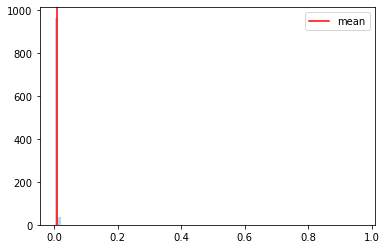

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654383861
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 1.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:02, 15.83it/s]

Monte Carlo 3


  0%|▍                                                                                | 5/1000 [00:00<02:23,  6.94it/s]

Monte Carlo 4
Monte Carlo 5


  1%|▌                                                                                | 7/1000 [00:00<02:11,  7.53it/s]

Monte Carlo 6
Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:01<02:00,  8.25it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 11/1000 [00:01<01:54,  8.62it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<01:57,  8.40it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<02:00,  8.18it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:02<02:01,  8.10it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<02:01,  8.09it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<01:56,  8.41it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:54,  8.54it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:03<01:56,  8.35it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<01:57,  8.32it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:17,  7.06it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:07,  7.59it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:04<02:00,  8.00it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<01:58,  8.17it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<01:59,  8.03it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<02:03,  7.76it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:05<01:57,  8.13it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<01:58,  8.06it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:54,  8.33it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:58,  8.05it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:06<02:02,  7.79it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:02,  7.77it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<01:59,  7.92it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:02,  7.69it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<02:11,  7.17it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:05,  7.48it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:06,  7.40it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:04,  7.56it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:05,  7.44it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:09,  7.19it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:07,  7.31it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:09<02:03,  7.54it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:04,  7.44it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:09,  7.15it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:13,  6.94it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:11,  7.03it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:07,  7.19it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:06,  7.27it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:11<02:16,  6.71it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:16,  6.70it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:02,  7.45it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<01:59,  7.60it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<01:58,  7.62it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<01:59,  7.59it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<01:55,  7.82it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<01:55,  7.82it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<01:54,  7.83it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<01:56,  7.68it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:00,  7.43it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:00,  7.44it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:05,  7.12it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:05,  7.07it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:33,  5.77it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:26,  6.02it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:21,  6.26it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:13,  6.58it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:16,  6.42it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:19,  6.30it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:14,  6.48it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:10,  6.70it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████                                                                     | 128/1000 [00:17<02:07,  6.85it/s]

Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:17<02:28,  5.87it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:17<02:25,  5.98it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:18<02:22,  6.09it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:18<02:19,  6.19it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:18<02:16,  6.33it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:19<02:12,  6.49it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 141/1000 [00:19<02:20,  6.12it/s]

Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:37,  5.44it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 144/1000 [00:20<02:39,  5.38it/s]

Monte Carlo 144


 14%|███████████▍                                                                   | 145/1000 [00:20<02:44,  5.19it/s]

Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:51,  4.98it/s]

Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:20<02:50,  5.00it/s]

Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:21<02:40,  5.30it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:21<02:36,  5.43it/s]

Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:21<02:32,  5.55it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:21<02:22,  5.93it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:22<02:22,  5.90it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:22<02:29,  5.63it/s]

Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:27,  5.69it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:23<02:21,  5.94it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:23<02:32,  5.48it/s]

Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:23<02:31,  5.52it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:23<02:27,  5.67it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:24<02:29,  5.56it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:24<02:27,  5.64it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:25,  5.72it/s]

Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:25<02:34,  5.37it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:25<02:27,  5.59it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:25<02:27,  5.57it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████                                                                 | 178/1000 [00:26<02:27,  5.56it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:26<02:30,  5.44it/s]

Monte Carlo 179
Monte Carlo 180

 18%|██████████████▎                                                                | 181/1000 [00:26<02:30,  5.45it/s]


Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:27<02:40,  5.10it/s]

Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:27<02:35,  5.26it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:27<02:31,  5.39it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:28<02:31,  5.37it/s]

Monte Carlo 187
Monte Carlo 188


 19%|██████████████▉                                                                | 189/1000 [00:28<02:28,  5.47it/s]

Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:28<02:54,  4.64it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:29<02:46,  4.86it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:29<02:42,  4.95it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 195/1000 [00:29<02:49,  4.74it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:30<02:47,  4.79it/s]

Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:30<02:43,  4.90it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:30<02:40,  4.98it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▊                                                               | 200/1000 [00:30<02:43,  4.90it/s]

Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:31<03:02,  4.36it/s]

Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:31<02:51,  4.65it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████                                                               | 204/1000 [00:31<02:44,  4.84it/s]

Monte Carlo 204


 20%|████████████████▏                                                              | 205/1000 [00:31<03:06,  4.27it/s]

Monte Carlo 205


 21%|████████████████▎                                                              | 206/1000 [00:32<03:10,  4.16it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:32<02:54,  4.53it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:32<02:46,  4.75it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 211/1000 [00:33<02:44,  4.80it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:33<02:39,  4.93it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:33<02:28,  5.30it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████                                                              | 216/1000 [00:34<02:29,  5.26it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 217/1000 [00:34<02:34,  5.08it/s]

Monte Carlo 217


 22%|█████████████████▏                                                             | 218/1000 [00:34<02:43,  4.78it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:34<02:42,  4.80it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:35<02:39,  4.89it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 222/1000 [00:35<02:47,  4.63it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:35<02:38,  4.90it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:35<02:35,  4.99it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:36<02:35,  4.97it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:36<02:25,  5.32it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:36<02:24,  5.34it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:36<02:27,  5.23it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:37<02:22,  5.39it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:37<02:23,  5.36it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:37<02:21,  5.41it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:37<02:21,  5.41it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:38<02:18,  5.53it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:38<02:23,  5.29it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:38<02:26,  5.20it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:38<02:26,  5.17it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:39<02:26,  5.18it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:39<02:21,  5.33it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:39<02:29,  5.05it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:39<02:28,  5.09it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:40<02:22,  5.29it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:40<02:21,  5.32it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:40<02:19,  5.37it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:40<02:24,  5.18it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:41<02:45,  4.50it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:41<02:41,  4.63it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 255/1000 [00:41<02:42,  4.57it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:42<02:41,  4.60it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:42<02:35,  4.78it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:42<02:32,  4.87it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:43<02:32,  4.84it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▋                                                          | 262/1000 [00:43<02:34,  4.76it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:43<02:39,  4.62it/s]

Monte Carlo 263
Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:44<02:34,  4.76it/s]

Monte Carlo 265
Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:44<02:38,  4.60it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:44<02:35,  4.71it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:45<02:38,  4.61it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:45<02:42,  4.48it/s]

Monte Carlo 272


 27%|█████████████████████▌                                                         | 273/1000 [00:45<02:42,  4.47it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:46<02:37,  4.59it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:46<02:40,  4.52it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 277/1000 [00:46<02:44,  4.39it/s]

Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:46<02:47,  4.31it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:47<02:46,  4.34it/s]

Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:47<02:42,  4.42it/s]

Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:47<02:47,  4.30it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:47<02:43,  4.39it/s]

Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:47<02:42,  4.42it/s]

Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:48<02:47,  4.28it/s]

Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:48<02:44,  4.34it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:48<02:40,  4.45it/s]

Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:48<02:41,  4.43it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:49<02:44,  4.33it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:49<02:43,  4.34it/s]

Monte Carlo 289
Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:49<02:41,  4.39it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:49<02:39,  4.45it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:50<02:33,  4.61it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:50<02:29,  4.72it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:50<02:36,  4.50it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:51<02:34,  4.54it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:51<02:35,  4.51it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:51<02:34,  4.53it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:51<02:38,  4.42it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:51<02:37,  4.43it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:52<02:37,  4.43it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:52<02:41,  4.32it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:52<02:37,  4.41it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:52<02:36,  4.43it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:53<02:45,  4.20it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:53<02:45,  4.18it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:53<02:42,  4.26it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:53<02:38,  4.37it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:54<02:37,  4.39it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:54<02:38,  4.34it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:54<02:38,  4.35it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:54<02:36,  4.39it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:54<02:36,  4.39it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:55<02:33,  4.46it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:55<02:38,  4.32it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:55<02:42,  4.21it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:55<02:46,  4.09it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:56<02:39,  4.27it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:56<02:42,  4.18it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:56<02:40,  4.24it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:56<02:44,  4.13it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:57<02:47,  4.04it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:57<02:46,  4.07it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:57<02:47,  4.03it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:57<02:42,  4.14it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:58<02:42,  4.14it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:58<02:31,  4.42it/s]

Monte Carlo 328
Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:58<02:31,  4.42it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:59<02:40,  4.18it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:59<02:42,  4.12it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:59<02:37,  4.22it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:59<02:44,  4.05it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [01:00<02:41,  4.11it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [01:00<02:36,  4.23it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [01:00<02:42,  4.07it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [01:00<02:44,  4.03it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [01:01<02:42,  4.07it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [01:01<02:43,  4.03it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [01:01<02:45,  3.97it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [01:01<02:48,  3.90it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [01:02<02:41,  4.07it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [01:02<02:39,  4.11it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:02<02:39,  4.12it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:02<02:42,  4.03it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:02<02:40,  4.08it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:03<02:45,  3.93it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:03<02:40,  4.04it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:03<02:45,  3.93it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:04<02:41,  4.02it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:04<02:42,  3.99it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:04<02:35,  4.16it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:04<02:42,  3.99it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:04<02:37,  4.09it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:05<02:37,  4.08it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:05<02:37,  4.09it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:05<02:41,  3.97it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:06<02:42,  3.94it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:06<02:48,  3.80it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:06<02:46,  3.85it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:06<02:48,  3.79it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:07<02:43,  3.91it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:07<02:36,  4.08it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:07<02:36,  4.07it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:07<02:34,  4.10it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:08<02:34,  4.10it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:08<02:41,  3.90it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:08<02:49,  3.72it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:08<02:48,  3.75it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:09<02:52,  3.65it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:09<02:44,  3.81it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:09<02:41,  3.89it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:09<02:37,  3.98it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:10<02:39,  3.91it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:10<02:37,  3.95it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:10<02:41,  3.85it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:11<03:11,  3.25it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:11<03:00,  3.45it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:11<02:54,  3.55it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:11<02:49,  3.66it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:12<02:44,  3.76it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:12<02:41,  3.83it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:12<02:37,  3.92it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:12<02:47,  3.66it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:13<02:44,  3.73it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:13<02:41,  3.80it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:13<02:43,  3.75it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:13<02:38,  3.86it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:14<02:38,  3.86it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:14<02:32,  3.99it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:14<02:38,  3.85it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:14<02:34,  3.93it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:15<02:38,  3.83it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:15<02:35,  3.88it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:15<02:40,  3.77it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:16<02:44,  3.67it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:16<02:44,  3.65it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:16<02:39,  3.77it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:16<02:42,  3.69it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:17<02:51,  3.49it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:17<02:44,  3.63it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:17<02:39,  3.75it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:17<02:37,  3.79it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:18<02:33,  3.87it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:18<02:38,  3.74it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:18<02:48,  3.51it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:19<03:08,  3.14it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:19<03:05,  3.19it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:19<02:57,  3.32it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:19<02:50,  3.44it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:20<02:52,  3.41it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:20<02:47,  3.51it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:20<02:47,  3.50it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:21<02:48,  3.47it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:21<02:45,  3.53it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:21<02:41,  3.60it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:21<02:47,  3.48it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:22<02:41,  3.59it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:22<02:35,  3.72it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:22<02:37,  3.68it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:23<02:34,  3.75it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:23<02:36,  3.69it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:23<02:31,  3.79it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:23<02:31,  3.79it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:24<02:35,  3.69it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:24<02:32,  3.76it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:24<02:35,  3.68it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:24<02:35,  3.67it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:25<02:31,  3.75it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:25<02:32,  3.73it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:25<02:31,  3.74it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:26<02:40,  3.54it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:26<02:45,  3.43it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:26<02:44,  3.43it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:26<02:39,  3.54it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:27<02:45,  3.41it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:27<02:43,  3.44it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:27<02:45,  3.39it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:28<02:41,  3.46it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:28<02:36,  3.56it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:28<02:36,  3.57it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:28<02:41,  3.46it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:29<02:41,  3.44it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:29<02:35,  3.57it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:29<02:30,  3.69it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:29<02:28,  3.73it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:30<02:30,  3.66it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:30<02:33,  3.60it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:30<02:31,  3.64it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:31<02:32,  3.60it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:31<02:38,  3.47it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:31<02:38,  3.44it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:32<02:41,  3.38it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:32<02:44,  3.31it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:32<02:42,  3.35it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:32<02:37,  3.45it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:33<02:38,  3.42it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:33<02:33,  3.52it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:33<02:36,  3.45it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:34<02:34,  3.48it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:34<02:33,  3.50it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:34<02:34,  3.48it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:34<02:38,  3.38it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:35<02:33,  3.49it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:35<02:38,  3.36it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:35<02:41,  3.29it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:36<02:39,  3.33it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:36<02:38,  3.36it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:36<02:34,  3.43it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:37<02:33,  3.45it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:37<02:30,  3.51it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:37<02:28,  3.56it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:37<02:32,  3.45it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:38<02:35,  3.38it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:38<02:32,  3.43it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:38<02:28,  3.52it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:38<02:23,  3.64it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:39<02:23,  3.64it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:39<02:20,  3.71it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:39<02:15,  3.82it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:40<02:21,  3.65it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:40<02:28,  3.47it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:40<02:25,  3.54it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:40<02:23,  3.58it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:41<02:22,  3.59it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:41<02:22,  3.61it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:41<02:24,  3.54it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:42<02:24,  3.53it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:42<02:23,  3.54it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:42<02:23,  3.54it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:42<02:28,  3.42it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:43<02:31,  3.35it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:43<02:30,  3.37it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:43<02:27,  3.43it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:44<02:23,  3.51it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:44<02:21,  3.56it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:44<02:18,  3.63it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:44<02:16,  3.67it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:45<02:15,  3.68it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:45<02:14,  3.70it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:45<02:12,  3.75it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:45<02:19,  3.57it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:46<02:22,  3.49it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:46<02:21,  3.49it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:46<02:22,  3.47it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:47<02:19,  3.53it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:47<02:21,  3.49it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:47<02:19,  3.51it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:47<02:18,  3.53it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:48<02:18,  3.54it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:48<02:19,  3.50it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:48<02:36,  3.11it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:49<02:33,  3.17it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:49<02:29,  3.24it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:49<02:22,  3.39it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:50<02:25,  3.33it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:50<02:20,  3.43it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:50<02:13,  3.59it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:50<02:11,  3.65it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:51<02:06,  3.78it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:51<02:08,  3.73it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:51<02:07,  3.76it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:51<02:07,  3.73it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:52<02:04,  3.82it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:52<02:02,  3.86it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:52<02:00,  3.93it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:52<02:01,  3.89it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:53<02:02,  3.86it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:53<02:02,  3.83it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:53<02:01,  3.86it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:54<02:01,  3.86it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:54<02:04,  3.76it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:54<02:05,  3.72it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:54<02:03,  3.75it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:55<02:02,  3.80it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:55<02:05,  3.68it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:55<02:05,  3.68it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:55<02:08,  3.59it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:56<02:08,  3.59it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:56<02:04,  3.68it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:56<02:10,  3.50it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:57<02:12,  3.44it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:57<02:11,  3.47it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:57<02:12,  3.43it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:57<02:13,  3.40it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:58<02:10,  3.48it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:58<02:09,  3.50it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:58<02:16,  3.31it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:59<02:17,  3.27it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:59<02:15,  3.31it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:59<02:14,  3.34it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [02:00<02:16,  3.29it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [02:00<02:19,  3.19it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [02:00<02:19,  3.20it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [02:01<02:16,  3.25it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [02:01<02:17,  3.22it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [02:01<02:14,  3.28it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [02:01<02:15,  3.24it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [02:02<02:10,  3.38it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [02:02<02:11,  3.33it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [02:02<02:14,  3.25it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [02:03<02:14,  3.24it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [02:03<02:13,  3.27it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [02:03<02:09,  3.35it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [02:04<02:10,  3.32it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:04<02:07,  3.41it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:04<02:08,  3.37it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:04<02:05,  3.43it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:05<02:07,  3.36it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:05<02:11,  3.27it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:05<02:08,  3.33it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:06<02:06,  3.36it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:06<02:05,  3.40it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:06<02:07,  3.33it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:07<02:07,  3.32it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:07<02:10,  3.24it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:07<02:10,  3.23it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:07<02:10,  3.24it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:08<02:07,  3.29it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:08<02:04,  3.36it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:08<02:01,  3.43it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:09<01:59,  3.49it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:09<02:01,  3.41it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:09<02:01,  3.43it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:10<02:02,  3.38it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:10<02:00,  3.42it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:10<01:58,  3.46it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:10<01:58,  3.47it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:11<02:01,  3.37it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:11<01:58,  3.45it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:11<01:55,  3.52it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:12<01:59,  3.40it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:12<02:00,  3.36it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:12<02:04,  3.26it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:12<02:03,  3.28it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:13<02:01,  3.33it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:13<02:01,  3.32it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:13<01:58,  3.39it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:14<01:56,  3.42it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:14<01:59,  3.34it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:14<01:59,  3.34it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:15<02:00,  3.29it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:15<02:06,  3.13it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:15<02:02,  3.23it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:16<02:00,  3.27it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:16<02:00,  3.26it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:16<02:00,  3.27it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:16<02:01,  3.21it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:17<02:00,  3.25it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:17<01:59,  3.26it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:17<02:00,  3.21it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:18<02:05,  3.08it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:18<02:19,  2.77it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:19<02:14,  2.85it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:19<02:10,  2.94it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:19<02:13,  2.87it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:20<02:10,  2.94it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:20<02:06,  3.00it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:20<02:07,  2.99it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:20<02:03,  3.07it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:21<02:01,  3.12it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:21<02:00,  3.14it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:21<01:59,  3.15it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:22<01:58,  3.15it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:22<01:57,  3.17it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:22<01:58,  3.15it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:23<01:57,  3.16it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:23<01:59,  3.11it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:23<01:57,  3.14it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:24<01:57,  3.13it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:24<01:58,  3.11it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:24<01:59,  3.07it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:25<01:57,  3.12it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:25<01:58,  3.07it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:25<01:56,  3.12it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:26<01:55,  3.15it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:26<01:59,  3.02it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:26<01:57,  3.07it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:27<01:57,  3.06it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:27<01:58,  3.03it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:27<01:58,  3.01it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:28<01:57,  3.04it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:28<01:56,  3.06it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:28<01:58,  2.99it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:29<01:58,  3.00it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:29<01:58,  2.98it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:29<01:58,  2.97it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:30<01:57,  2.99it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:30<01:57,  2.99it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:30<01:55,  3.01it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:31<01:57,  2.97it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:31<01:56,  2.99it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:31<01:57,  2.95it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:32<01:54,  3.01it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:32<01:52,  3.06it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:32<01:56,  2.95it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:33<01:53,  3.00it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:33<01:52,  3.02it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:33<01:53,  3.01it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:34<01:53,  2.98it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:34<01:52,  3.02it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:34<01:52,  3.00it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:35<01:52,  2.98it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:35<01:54,  2.93it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:35<01:56,  2.87it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:36<01:52,  2.95it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:36<01:53,  2.93it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:36<01:54,  2.89it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:37<01:53,  2.90it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:37<01:50,  2.97it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:37<01:50,  2.96it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:38<01:49,  2.97it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:38<01:50,  2.94it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:38<01:47,  3.03it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:39<01:44,  3.11it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:39<01:42,  3.16it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:39<01:44,  3.09it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:40<01:44,  3.08it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:40<01:42,  3.13it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:40<01:41,  3.15it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:41<01:40,  3.16it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:41<01:41,  3.13it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:41<01:39,  3.19it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:41<01:40,  3.12it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:42<01:41,  3.08it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:42<01:41,  3.09it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:42<01:41,  3.09it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:43<01:39,  3.13it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:43<01:40,  3.08it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:43<01:39,  3.10it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:44<01:42,  3.02it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:44<01:41,  3.03it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:44<01:43,  2.97it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:45<01:41,  3.01it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:45<01:43,  2.93it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:45<01:42,  2.95it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:46<01:43,  2.93it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:46<01:47,  2.81it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:47<01:47,  2.80it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:47<01:47,  2.78it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:47<01:44,  2.85it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:48<01:44,  2.83it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:48<01:42,  2.89it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:48<01:42,  2.89it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:49<01:40,  2.92it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:49<01:39,  2.95it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:49<01:38,  2.96it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:50<01:38,  2.94it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:50<01:40,  2.88it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:50<01:49,  2.64it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:51<01:52,  2.56it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:51<01:47,  2.66it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:52<01:44,  2.73it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:52<01:43,  2.75it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:52<01:41,  2.80it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:53<01:40,  2.82it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:53<01:41,  2.78it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:53<01:40,  2.79it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:54<01:40,  2.80it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:54<01:40,  2.78it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:54<01:39,  2.81it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:55<01:41,  2.74it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:55<01:37,  2.83it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:55<01:35,  2.87it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:56<01:35,  2.88it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:56<01:36,  2.83it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:57<01:37,  2.80it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:57<01:35,  2.83it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:57<01:35,  2.84it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:58<01:33,  2.88it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:58<01:35,  2.81it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:58<01:35,  2.80it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:59<01:35,  2.78it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:59<01:33,  2.83it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:59<01:34,  2.81it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [03:00<01:32,  2.84it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [03:00<01:31,  2.87it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:00<01:32,  2.82it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:01<01:30,  2.86it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:01<01:31,  2.84it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:01<01:31,  2.83it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:02<01:30,  2.85it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:02<01:31,  2.80it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:03<01:33,  2.72it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:03<01:33,  2.71it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:03<01:31,  2.76it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:04<01:31,  2.76it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:04<01:28,  2.83it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:04<01:28,  2.83it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:05<01:28,  2.80it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:05<01:28,  2.80it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:05<01:30,  2.73it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:06<01:30,  2.73it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:06<01:29,  2.75it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:07<01:29,  2.73it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:07<01:30,  2.68it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:07<01:28,  2.74it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:08<01:26,  2.78it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:08<01:27,  2.74it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:08<01:27,  2.72it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:09<01:27,  2.73it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:09<01:27,  2.71it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:10<01:28,  2.68it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:10<01:26,  2.71it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:10<01:26,  2.72it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:11<01:25,  2.74it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:11<01:25,  2.73it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:11<01:23,  2.76it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:12<01:24,  2.73it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:12<01:23,  2.76it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:12<01:24,  2.70it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:13<01:25,  2.67it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:13<01:24,  2.68it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:14<01:23,  2.69it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:14<01:23,  2.67it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:14<01:22,  2.69it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:15<01:19,  2.81it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:15<01:18,  2.83it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:15<01:17,  2.84it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:16<01:15,  2.90it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:16<01:15,  2.88it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:16<01:13,  2.94it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:17<01:14,  2.91it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:17<01:16,  2.82it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:17<01:14,  2.87it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:18<01:13,  2.89it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:18<01:15,  2.82it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:18<01:14,  2.84it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:19<01:14,  2.80it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:19<01:14,  2.80it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:20<01:14,  2.79it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:20<01:14,  2.80it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:20<01:15,  2.75it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:21<01:13,  2.78it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:21<01:13,  2.77it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:21<01:15,  2.69it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:22<01:13,  2.73it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:22<01:14,  2.72it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:22<01:14,  2.67it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:23<01:13,  2.70it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:23<01:12,  2.72it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:24<01:10,  2.80it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:24<01:10,  2.77it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:24<01:09,  2.79it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:25<01:10,  2.75it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:25<01:12,  2.67it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:25<01:11,  2.68it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:26<01:09,  2.76it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:26<01:10,  2.71it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:27<01:09,  2.71it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:27<01:08,  2.75it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:27<01:09,  2.67it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:28<01:15,  2.45it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:28<01:14,  2.47it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:29<01:12,  2.53it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:29<01:10,  2.59it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:29<01:08,  2.64it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:30<01:08,  2.63it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:30<01:07,  2.66it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:30<01:08,  2.62it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:31<01:06,  2.68it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:31<01:07,  2.62it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:32<01:06,  2.64it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:32<01:06,  2.62it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:32<01:08,  2.56it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:33<01:07,  2.56it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:33<01:06,  2.59it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:33<01:06,  2.59it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:34<01:05,  2.58it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:34<01:04,  2.60it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:35<01:04,  2.59it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:35<01:04,  2.60it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:35<01:04,  2.56it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:36<01:04,  2.55it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:36<01:04,  2.56it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:37<01:02,  2.59it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:37<01:02,  2.58it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:37<01:01,  2.61it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:38<01:03,  2.53it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:38<01:03,  2.50it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:39<01:04,  2.45it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:39<01:01,  2.54it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:39<01:00,  2.56it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:40<01:02,  2.49it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:40<01:01,  2.50it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:41<01:01,  2.48it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:41<01:03,  2.39it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:41<01:01,  2.47it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:42<01:02,  2.41it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:42<01:02,  2.40it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:43<01:00,  2.44it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:43<00:58,  2.50it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:43<00:58,  2.50it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:44<00:56,  2.55it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:44<00:56,  2.54it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:45<00:54,  2.61it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:45<00:55,  2.56it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:45<00:54,  2.58it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:46<00:54,  2.55it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:46<00:55,  2.48it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:47<00:55,  2.50it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:47<00:54,  2.50it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:47<00:56,  2.42it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:48<00:55,  2.41it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:48<00:54,  2.46it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:49<00:53,  2.48it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:49<00:53,  2.46it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:49<00:52,  2.48it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:50<00:52,  2.48it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:50<00:51,  2.49it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:51<00:52,  2.43it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:51<00:52,  2.41it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:52<00:52,  2.41it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:52<00:51,  2.43it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:52<00:50,  2.45it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:53<00:50,  2.45it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:53<00:50,  2.43it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:54<00:49,  2.44it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:54<00:49,  2.42it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:54<00:49,  2.39it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:55<00:49,  2.38it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:55<00:48,  2.41it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:56<00:47,  2.43it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:56<00:46,  2.45it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:56<00:46,  2.46it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:57<00:45,  2.46it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:57<00:46,  2.42it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:58<00:44,  2.48it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:58<00:45,  2.43it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:58<00:45,  2.42it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:59<00:44,  2.43it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:59<00:44,  2.43it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:00<00:43,  2.43it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:00<00:42,  2.46it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:01<00:42,  2.46it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:01<00:41,  2.50it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:01<00:41,  2.45it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:02<00:41,  2.44it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:02<00:41,  2.38it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:03<00:42,  2.36it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:03<00:40,  2.39it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:03<00:39,  2.43it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:04<00:39,  2.43it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:04<00:38,  2.46it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:05<00:38,  2.44it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:05<00:39,  2.38it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:06<00:38,  2.37it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:06<00:39,  2.31it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:06<00:39,  2.30it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:07<00:38,  2.33it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:07<00:37,  2.35it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:08<00:36,  2.38it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:08<00:35,  2.41it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:08<00:35,  2.41it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:09<00:33,  2.48it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:09<00:32,  2.53it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:10<00:33,  2.46it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:10<00:32,  2.52it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:10<00:31,  2.54it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:11<00:31,  2.47it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:11<00:31,  2.46it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:12<00:30,  2.49it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:12<00:30,  2.49it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:12<00:30,  2.47it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:13<00:30,  2.43it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:13<00:31,  2.29it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:14<00:30,  2.35it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:14<00:29,  2.42it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:15<00:29,  2.41it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:15<00:28,  2.39it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:15<00:28,  2.37it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:16<00:28,  2.38it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:16<00:27,  2.37it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:17<00:27,  2.34it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:17<00:26,  2.38it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:18<00:26,  2.36it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:18<00:26,  2.33it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:18<00:25,  2.37it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:19<00:25,  2.39it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:19<00:24,  2.37it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:20<00:24,  2.36it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:20<00:24,  2.33it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:21<00:23,  2.35it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:21<00:23,  2.38it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:21<00:22,  2.37it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:22<00:22,  2.37it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:22<00:22,  2.33it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:23<00:22,  2.30it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:23<00:21,  2.29it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:24<00:21,  2.33it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:24<00:20,  2.33it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:24<00:19,  2.37it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:25<00:19,  2.38it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:25<00:18,  2.40it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:26<00:17,  2.46it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:26<00:17,  2.42it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:26<00:17,  2.41it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:27<00:16,  2.43it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:27<00:16,  2.41it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:28<00:16,  2.43it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:28<00:15,  2.47it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:28<00:14,  2.48it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:29<00:14,  2.42it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:29<00:14,  2.43it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:30<00:14,  2.42it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:30<00:13,  2.48it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:30<00:12,  2.49it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:31<00:12,  2.45it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:31<00:12,  2.46it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:32<00:11,  2.44it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:32<00:11,  2.43it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:33<00:11,  2.42it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:33<00:10,  2.46it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:33<00:10,  2.42it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:34<00:10,  2.39it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:34<00:09,  2.33it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:35<00:09,  2.34it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:35<00:09,  2.33it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:36<00:08,  2.32it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:36<00:08,  2.27it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:36<00:07,  2.25it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:37<00:07,  2.25it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:37<00:07,  2.24it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:38<00:06,  2.21it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:38<00:06,  2.24it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:39<00:05,  2.26it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:39<00:05,  2.28it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:40<00:04,  2.27it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:40<00:04,  2.27it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:40<00:04,  2.23it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:41<00:03,  2.19it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:41<00:03,  2.15it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:42<00:02,  2.17it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:42<00:02,  2.22it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:43<00:01,  2.26it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:43<00:01,  2.24it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:44<00:00,  2.24it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:44<00:00,  2.25it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:45<00:00,  3.51it/s]


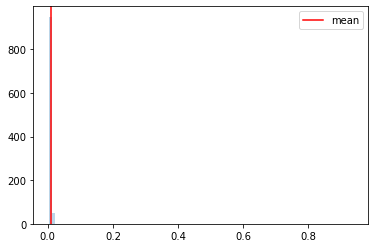

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654384147
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 10.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:17, 12.91it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:48,  9.20it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▌                                                                                | 7/1000 [00:00<01:56,  8.55it/s]

Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:01<02:18,  7.14it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 11/1000 [00:01<02:05,  7.88it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<02:01,  8.11it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<01:57,  8.41it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:02<01:50,  8.88it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▍                                                                              | 18/1000 [00:02<01:48,  9.02it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<01:45,  9.24it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:44,  9.31it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<01:43,  9.43it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<01:40,  9.63it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<01:57,  8.24it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<01:50,  8.80it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<01:48,  8.90it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▉                                                                             | 36/1000 [00:04<01:43,  9.35it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<01:48,  8.87it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<01:48,  8.89it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<01:47,  8.94it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:04<01:45,  9.10it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:55,  8.28it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:04,  7.64it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<02:00,  7.89it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:05<02:05,  7.54it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<01:59,  7.91it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:53,  8.36it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<01:49,  8.64it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:06<01:51,  8.47it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:48,  8.62it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<01:56,  8.03it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<01:54,  8.15it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:07<01:55,  8.05it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<01:58,  7.88it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<01:56,  7.98it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<02:04,  7.42it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:08<01:59,  7.73it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<01:56,  7.92it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<01:56,  7.88it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:09<02:01,  7.57it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<01:57,  7.84it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<01:54,  7.99it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<01:57,  7.80it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:10<02:02,  7.43it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:03,  7.39it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:00,  7.51it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<01:57,  7.68it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:11<01:54,  7.88it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<01:55,  7.79it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<01:57,  7.65it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:12<01:55,  7.75it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:12<01:55,  7.76it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<01:56,  7.68it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<01:56,  7.63it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:13<01:57,  7.56it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:13<01:59,  7.40it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<01:55,  7.67it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:14<01:52,  7.88it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:14<01:56,  7.56it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:14<01:56,  7.55it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<02:02,  7.16it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:15<02:02,  7.17it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:15<01:59,  7.31it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<01:54,  7.60it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:16<02:03,  7.05it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:16<02:05,  6.89it/s]

Monte Carlo 132
Monte Carlo 133


 13%|██████████▌                                                                    | 134/1000 [00:16<02:04,  6.98it/s]

Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:17<02:28,  5.84it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:17<02:19,  6.18it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:17<02:14,  6.39it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:18<02:10,  6.59it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:18<02:11,  6.52it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:18<02:13,  6.38it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:19<02:08,  6.64it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:19<02:18,  6.16it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:19<02:16,  6.23it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:20<02:13,  6.35it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▏                                                                  | 155/1000 [00:20<02:42,  5.19it/s]

Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:20<02:49,  4.98it/s]

Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:20<02:41,  5.21it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:21<02:34,  5.42it/s]

Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:21<02:35,  5.39it/s]

Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:21<02:42,  5.16it/s]

Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:21<02:42,  5.15it/s]

Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:22<02:46,  5.02it/s]

Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:37,  5.31it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:28,  5.63it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:22<02:28,  5.61it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:23<02:22,  5.81it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:23<02:17,  6.01it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:23<02:10,  6.31it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:24<02:05,  6.56it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:24<02:08,  6.37it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:24<02:14,  6.10it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:25<02:13,  6.12it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:25<02:14,  6.05it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:25<02:15,  6.01it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:26<02:19,  5.81it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:26<02:17,  5.87it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:26<02:15,  5.97it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:27<02:12,  6.09it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:27<02:11,  6.13it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:27<02:22,  5.64it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:28<02:21,  5.65it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:28<02:20,  5.68it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:28<02:13,  5.97it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:29<02:14,  5.89it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:29<02:16,  5.80it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:29<02:12,  5.94it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:30<02:12,  5.95it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:30<02:13,  5.88it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:14,  5.84it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:31<02:20,  5.55it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:31<02:18,  5.62it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:31<02:18,  5.60it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:32<02:21,  5.48it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:32<02:22,  5.43it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:32<02:19,  5.54it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:32<02:25,  5.30it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:22,  5.40it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:33<02:25,  5.31it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:33<02:24,  5.34it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:33<02:24,  5.31it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:33<02:21,  5.44it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:23,  5.34it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:34<02:25,  5.27it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:34<02:26,  5.20it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:34<02:31,  5.02it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 239/1000 [00:35<02:37,  4.83it/s]

Monte Carlo 239


 24%|██████████████████▉                                                            | 240/1000 [00:35<02:39,  4.75it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 241/1000 [00:35<02:39,  4.76it/s]

Monte Carlo 241


 24%|███████████████████                                                            | 242/1000 [00:35<02:44,  4.61it/s]

Monte Carlo 242


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:41,  4.70it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:36<02:42,  4.65it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:36<02:37,  4.78it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:44,  4.58it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:37<02:43,  4.58it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▊                                                           | 251/1000 [00:37<02:45,  4.53it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 252/1000 [00:38<02:46,  4.49it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:38<02:36,  4.78it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:38<02:30,  4.96it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:21,  5.25it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:17,  5.40it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:39<02:18,  5.35it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:39<02:18,  5.35it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:13,  5.50it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:40<02:15,  5.44it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:40<02:15,  5.42it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:40<02:15,  5.42it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:15,  5.38it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:41<02:15,  5.39it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:42<02:32,  4.77it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:28,  4.90it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:42<02:22,  5.10it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:42<02:22,  5.07it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:18,  5.20it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:43<02:17,  5.23it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:43<02:18,  5.18it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:43<02:16,  5.26it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:43<02:14,  5.33it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:14,  5.33it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:44<02:19,  5.13it/s]

Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:44<02:23,  4.98it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:21,  5.02it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:45<02:18,  5.11it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:45<02:18,  5.11it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:46<02:20,  5.01it/s]

Monte Carlo 293
Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:46<02:23,  4.90it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:46<02:17,  5.09it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:47<02:45,  4.23it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:47<02:50,  4.11it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:47<02:48,  4.15it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:48<02:45,  4.22it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:48<02:31,  4.60it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:48<02:26,  4.75it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:48<02:22,  4.87it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:48<02:17,  5.04it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:49<02:16,  5.05it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:49<02:17,  5.01it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:49<02:18,  4.98it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:49<02:17,  5.02it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:50<02:18,  4.95it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:50<02:22,  4.80it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:50<02:24,  4.72it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:51<02:20,  4.85it/s]

Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:51<02:19,  4.88it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:51<02:16,  4.98it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:51<02:16,  4.96it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:52<02:13,  5.08it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:52<02:12,  5.10it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:52<02:14,  5.01it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:52<02:15,  4.96it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:53<02:14,  4.99it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:53<02:12,  5.07it/s]

Monte Carlo 327
Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:53<02:18,  4.84it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:53<02:17,  4.89it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:54<02:14,  4.96it/s]

Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:54<02:15,  4.91it/s]

Monte Carlo 332
Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:54<02:15,  4.93it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:54<02:15,  4.90it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:55<02:17,  4.81it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:55<02:23,  4.62it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:55<02:18,  4.77it/s]

Monte Carlo 339
Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:55<02:18,  4.75it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 343/1000 [00:56<02:20,  4.67it/s]

Monte Carlo 342


 34%|███████████████████████████▏                                                   | 344/1000 [00:56<02:20,  4.67it/s]

Monte Carlo 343
Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:56<02:22,  4.60it/s]

Monte Carlo 345


 35%|███████████████████████████▍                                                   | 347/1000 [00:57<02:19,  4.70it/s]

Monte Carlo 346
Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:57<02:23,  4.55it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:57<02:19,  4.66it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:57<02:21,  4.60it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:58<02:23,  4.54it/s]

Monte Carlo 351


 35%|███████████████████████████▉                                                   | 353/1000 [00:58<02:19,  4.63it/s]

Monte Carlo 352
Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:58<02:21,  4.55it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 356/1000 [00:59<02:15,  4.74it/s]

Monte Carlo 355
Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [00:59<02:16,  4.72it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [00:59<02:22,  4.49it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [00:59<02:24,  4.43it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:00<02:22,  4.48it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:00<02:19,  4.57it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:00<02:20,  4.56it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:00<02:19,  4.56it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:01<02:23,  4.45it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:01<02:25,  4.36it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:01<02:20,  4.50it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:01<02:23,  4.40it/s]

Monte Carlo 367


 37%|█████████████████████████████▏                                                 | 369/1000 [01:02<02:18,  4.56it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 370/1000 [01:02<02:15,  4.66it/s]

Monte Carlo 369


 37%|█████████████████████████████▎                                                 | 371/1000 [01:02<02:13,  4.71it/s]

Monte Carlo 370
Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:02<02:15,  4.64it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:02<02:16,  4.59it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:03<02:15,  4.63it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:03<02:15,  4.62it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:03<02:14,  4.63it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:03<02:21,  4.41it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:04<02:19,  4.47it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:04<02:16,  4.56it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:04<02:22,  4.35it/s]

Monte Carlo 380


 38%|██████████████████████████████▏                                                | 382/1000 [01:04<02:17,  4.51it/s]

Monte Carlo 381


 38%|██████████████████████████████▎                                                | 383/1000 [01:05<02:15,  4.56it/s]

Monte Carlo 382
Monte Carlo 383


 38%|██████████████████████████████▍                                                | 385/1000 [01:05<02:10,  4.72it/s]

Monte Carlo 384
Monte Carlo 385


 39%|██████████████████████████████▌                                                | 387/1000 [01:06<02:06,  4.85it/s]

Monte Carlo 386
Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:06<02:07,  4.81it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:06<02:06,  4.84it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:06<02:07,  4.80it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 392/1000 [01:07<02:03,  4.92it/s]

Monte Carlo 391
Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:07<02:06,  4.80it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:07<02:09,  4.70it/s]

Monte Carlo 394


 40%|███████████████████████████████▎                                               | 396/1000 [01:08<02:20,  4.31it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 397/1000 [01:08<02:13,  4.53it/s]

Monte Carlo 396
Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:08<02:10,  4.60it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:08<02:07,  4.70it/s]

Monte Carlo 399


 40%|███████████████████████████████▋                                               | 401/1000 [01:09<02:11,  4.54it/s]

Monte Carlo 400


 40%|███████████████████████████████▊                                               | 402/1000 [01:09<02:10,  4.60it/s]

Monte Carlo 401
Monte Carlo 402


 40%|███████████████████████████████▉                                               | 404/1000 [01:09<02:10,  4.57it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 405/1000 [01:09<02:07,  4.65it/s]

Monte Carlo 404
Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:10<02:09,  4.60it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 408/1000 [01:10<02:09,  4.59it/s]

Monte Carlo 407
Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:10<02:11,  4.50it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:11<02:13,  4.42it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:11<02:11,  4.48it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:11<02:14,  4.36it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:11<02:17,  4.27it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:12<02:20,  4.17it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:12<02:14,  4.34it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:12<02:12,  4.40it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:12<02:10,  4.46it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:12<02:10,  4.46it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:13<02:10,  4.45it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:13<02:10,  4.45it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:13<02:13,  4.33it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:13<02:11,  4.39it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:14<02:08,  4.50it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:14<02:09,  4.45it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:14<02:08,  4.48it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:14<02:12,  4.35it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:14<02:15,  4.23it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:15<02:15,  4.21it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:15<02:15,  4.23it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:15<02:15,  4.22it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:15<02:14,  4.24it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:16<02:12,  4.29it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:16<02:10,  4.34it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:16<02:12,  4.27it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:16<02:11,  4.31it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:17<02:12,  4.24it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:17<02:16,  4.13it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:17<02:20,  4.00it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:17<02:22,  3.94it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:18<02:17,  4.07it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:18<02:15,  4.11it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:18<02:16,  4.09it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:18<02:19,  3.99it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:19<02:15,  4.11it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:19<02:14,  4.13it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:19<02:13,  4.15it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:19<02:15,  4.07it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:20<02:13,  4.14it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:20<02:21,  3.90it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:20<02:18,  3.98it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:20<02:17,  4.00it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:21<02:16,  4.02it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:21<02:18,  3.96it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:21<02:18,  3.95it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:21<02:15,  4.01it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:22<02:15,  4.03it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:22<02:12,  4.10it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:22<02:10,  4.16it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:22<02:10,  4.14it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:23<02:10,  4.15it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:23<02:09,  4.17it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:23<02:07,  4.23it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:23<02:07,  4.22it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:23<02:12,  4.06it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:24<02:12,  4.05it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:24<02:10,  4.09it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:24<02:09,  4.12it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:24<02:07,  4.17it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:25<02:13,  3.98it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:25<02:12,  4.00it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:25<02:17,  3.85it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:25<02:13,  3.96it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:26<02:15,  3.90it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:26<02:13,  3.95it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:26<02:13,  3.92it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:27<02:11,  3.99it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:27<02:14,  3.89it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:27<02:14,  3.89it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:27<02:13,  3.91it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:28<02:10,  3.97it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:28<02:12,  3.93it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:28<02:15,  3.81it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:28<02:15,  3.80it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:29<02:13,  3.87it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:29<02:09,  3.97it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:29<02:06,  4.05it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:29<02:08,  3.99it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:30<02:08,  3.98it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:30<02:07,  4.00it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:30<02:05,  4.08it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:30<02:07,  3.98it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:31<02:07,  3.98it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:31<02:07,  3.98it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:31<02:11,  3.85it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:31<02:09,  3.89it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:32<02:08,  3.91it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:32<02:09,  3.89it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:32<02:08,  3.91it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:32<02:09,  3.88it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:33<02:17,  3.63it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:33<02:19,  3.58it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:33<02:15,  3.68it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:34<02:16,  3.65it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:34<02:10,  3.79it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:34<02:10,  3.80it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:34<02:07,  3.88it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:35<02:08,  3.84it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:35<02:09,  3.79it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:35<02:07,  3.85it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:35<02:09,  3.79it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:36<02:06,  3.87it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:36<02:04,  3.91it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:36<02:01,  4.00it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:36<02:00,  4.04it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:37<01:58,  4.09it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:37<02:00,  4.03it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:37<01:57,  4.10it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:37<01:56,  4.12it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:38<01:57,  4.08it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:38<01:57,  4.10it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:38<01:56,  4.10it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:38<01:56,  4.09it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:38<01:53,  4.20it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:39<01:54,  4.17it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:39<02:01,  3.91it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:39<01:59,  3.97it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:39<01:59,  3.97it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:40<01:56,  4.05it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:40<01:55,  4.09it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:40<01:54,  4.11it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:40<01:53,  4.15it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:41<01:52,  4.18it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:41<01:54,  4.08it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:41<01:58,  3.92it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:41<01:59,  3.90it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:42<02:11,  3.54it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:42<02:04,  3.72it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:42<02:04,  3.72it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:43<02:03,  3.73it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:43<01:59,  3.85it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:43<01:56,  3.93it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:43<01:57,  3.91it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:44<01:58,  3.86it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:44<02:02,  3.71it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:44<02:05,  3.64it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:44<02:02,  3.69it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:45<02:01,  3.74it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:45<02:00,  3.75it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:45<02:01,  3.72it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:46<01:59,  3.76it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:46<01:57,  3.81it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:46<01:57,  3.83it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:46<01:59,  3.75it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:47<02:01,  3.68it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:47<02:00,  3.69it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:47<02:03,  3.60it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:47<02:03,  3.58it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:48<02:01,  3.64it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:48<02:03,  3.57it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:48<02:03,  3.55it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:49<02:05,  3.49it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:49<02:03,  3.56it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:49<02:02,  3.56it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:49<02:06,  3.45it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:50<02:02,  3.54it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:50<02:06,  3.43it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:50<02:05,  3.46it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:51<02:05,  3.43it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:51<02:04,  3.45it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:51<02:04,  3.45it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:51<02:03,  3.47it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:52<02:03,  3.46it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:52<02:03,  3.46it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:52<02:03,  3.46it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:53<02:01,  3.49it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:53<02:02,  3.47it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:53<01:58,  3.56it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:53<01:57,  3.60it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:54<01:55,  3.64it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:54<01:52,  3.74it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:54<01:50,  3.81it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:54<01:51,  3.76it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:55<01:51,  3.72it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:55<01:52,  3.70it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:55<01:53,  3.64it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [01:56<01:51,  3.70it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [01:56<01:53,  3.64it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [01:56<01:50,  3.72it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [01:56<01:55,  3.57it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [01:57<01:55,  3.54it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [01:57<01:52,  3.62it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [01:57<01:53,  3.59it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [01:57<01:51,  3.66it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [01:58<01:51,  3.65it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [01:58<01:49,  3.71it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [01:58<01:48,  3.74it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [01:59<01:49,  3.67it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [01:59<01:52,  3.58it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [01:59<01:52,  3.58it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [01:59<01:56,  3.42it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:00<01:58,  3.37it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:00<02:01,  3.28it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:00<02:08,  3.10it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:01<02:02,  3.23it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:01<02:04,  3.16it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:01<02:01,  3.23it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:02<01:57,  3.34it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:02<01:59,  3.28it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:02<01:58,  3.30it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:03<01:59,  3.27it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:03<01:59,  3.26it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:03<01:55,  3.37it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:03<01:56,  3.33it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:04<01:56,  3.32it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:04<01:55,  3.34it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:04<01:58,  3.24it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:05<02:00,  3.18it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:05<01:57,  3.26it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:05<01:55,  3.30it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:06<01:56,  3.25it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:06<01:55,  3.28it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:06<01:56,  3.24it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:07<01:55,  3.26it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:07<01:54,  3.28it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:07<01:54,  3.26it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:07<01:55,  3.23it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:08<01:55,  3.24it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:08<01:54,  3.24it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:08<01:56,  3.18it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:09<01:53,  3.26it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:09<01:53,  3.25it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:09<01:53,  3.26it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:10<01:53,  3.24it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:10<01:50,  3.30it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:10<01:52,  3.25it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:11<01:53,  3.21it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:11<01:52,  3.22it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:11<01:51,  3.26it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:12<01:55,  3.14it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:12<02:06,  2.84it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:12<02:04,  2.89it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:13<01:59,  3.00it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:13<01:54,  3.11it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:13<01:55,  3.07it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:14<01:53,  3.13it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:14<01:55,  3.07it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:14<01:52,  3.14it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:14<01:54,  3.07it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:15<01:53,  3.10it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:15<01:50,  3.16it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:15<01:52,  3.10it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:16<01:51,  3.12it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:16<01:50,  3.13it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:16<01:49,  3.15it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:17<01:49,  3.15it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:17<01:48,  3.18it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:17<01:49,  3.14it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:18<01:49,  3.13it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:18<01:47,  3.17it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:18<01:47,  3.15it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:19<01:45,  3.20it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:19<01:46,  3.16it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:19<01:49,  3.09it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:20<01:47,  3.14it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:20<01:45,  3.19it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:20<01:45,  3.16it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:21<01:46,  3.12it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:21<01:44,  3.17it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:21<01:45,  3.14it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:21<01:45,  3.14it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:22<01:44,  3.15it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:22<01:44,  3.14it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:22<01:46,  3.08it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:23<01:43,  3.14it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:23<01:43,  3.14it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:23<01:44,  3.09it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:24<01:44,  3.08it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:24<01:46,  3.03it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:24<01:44,  3.09it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:25<01:42,  3.11it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:25<01:43,  3.09it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:25<01:43,  3.08it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:26<01:41,  3.11it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:26<01:44,  3.02it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:26<01:45,  2.98it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:27<01:44,  2.99it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:27<01:44,  2.99it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:27<01:45,  2.95it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:28<01:45,  2.96it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:28<01:42,  3.04it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:28<01:45,  2.94it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:29<01:42,  3.01it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:29<01:40,  3.05it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:29<01:43,  2.97it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:30<01:43,  2.95it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:30<01:45,  2.88it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:30<01:43,  2.92it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:31<01:43,  2.92it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:31<01:43,  2.92it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:31<01:42,  2.91it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:32<01:40,  2.97it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:32<01:40,  2.97it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:32<01:40,  2.95it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:33<01:39,  2.98it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:33<01:40,  2.92it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:33<01:39,  2.95it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:34<01:38,  2.98it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:34<01:38,  2.95it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:34<01:37,  2.98it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:35<01:37,  2.98it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:35<01:36,  3.00it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:35<01:36,  2.97it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:36<01:37,  2.96it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:36<01:36,  2.98it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:36<01:35,  2.99it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:37<01:33,  3.03it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:37<01:32,  3.05it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:37<01:32,  3.05it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:38<01:30,  3.11it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:38<01:31,  3.06it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:38<01:30,  3.08it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:39<01:32,  3.01it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:39<01:35,  2.91it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:39<01:34,  2.91it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:40<01:37,  2.83it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:40<01:35,  2.86it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:41<01:35,  2.86it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:41<01:32,  2.94it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:41<01:30,  2.98it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:42<01:29,  3.03it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:42<01:30,  2.96it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:42<01:30,  2.97it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:43<01:29,  2.97it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:43<01:30,  2.95it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:43<01:28,  2.99it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:44<01:29,  2.94it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:44<01:31,  2.86it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:44<01:32,  2.82it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:45<01:30,  2.89it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:45<01:29,  2.90it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:45<01:29,  2.90it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:46<01:29,  2.89it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:46<01:28,  2.90it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:46<01:29,  2.87it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:47<01:26,  2.94it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:47<01:27,  2.90it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:47<01:27,  2.90it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:48<01:28,  2.86it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:48<01:37,  2.57it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:49<01:35,  2.62it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:49<01:31,  2.72it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:49<01:29,  2.76it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:50<01:27,  2.81it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:50<01:26,  2.84it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:50<01:27,  2.81it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:51<01:26,  2.82it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:51<01:25,  2.83it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:51<01:25,  2.84it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:52<01:23,  2.88it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:52<01:23,  2.87it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:52<01:21,  2.92it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:53<01:21,  2.93it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:53<01:21,  2.90it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:53<01:21,  2.89it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:54<01:20,  2.92it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:54<01:20,  2.91it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [02:54<01:20,  2.91it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [02:55<01:20,  2.88it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [02:55<01:18,  2.93it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [02:56<01:20,  2.84it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [02:56<01:19,  2.87it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [02:56<01:18,  2.90it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [02:57<01:18,  2.88it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [02:57<01:17,  2.90it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [02:57<01:19,  2.84it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [02:58<01:19,  2.80it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [02:58<01:19,  2.80it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [02:58<01:18,  2.83it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [02:59<01:18,  2.83it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [02:59<01:16,  2.87it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [02:59<01:17,  2.84it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:00<01:13,  2.95it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:00<01:12,  3.01it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:00<01:14,  2.90it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:01<01:14,  2.90it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:01<01:14,  2.89it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:01<01:13,  2.88it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:02<01:10,  2.99it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:02<01:09,  3.04it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:02<01:08,  3.05it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:03<01:09,  3.02it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:03<01:07,  3.08it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:03<01:07,  3.05it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:04<01:07,  3.06it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:04<01:07,  3.02it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:04<01:09,  2.94it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:05<01:08,  2.96it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:05<01:08,  2.96it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:05<01:07,  2.99it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:06<01:05,  3.04it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:06<01:04,  3.08it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:06<01:05,  3.03it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:07<01:05,  3.00it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:07<01:04,  3.06it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:07<01:06,  2.93it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:08<01:07,  2.87it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:08<01:05,  2.95it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:08<01:05,  2.93it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:09<01:04,  2.98it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:09<01:04,  2.94it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:09<01:05,  2.90it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:10<01:04,  2.89it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:10<01:04,  2.91it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:10<01:05,  2.84it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:11<01:05,  2.84it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:11<01:05,  2.81it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:12<01:05,  2.79it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:12<01:06,  2.75it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:12<01:05,  2.78it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:13<01:04,  2.77it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:13<01:04,  2.76it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:13<01:04,  2.74it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:14<01:04,  2.75it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:14<01:03,  2.76it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:14<01:02,  2.79it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:15<01:03,  2.75it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:15<01:02,  2.75it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:16<01:03,  2.73it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:16<01:01,  2.77it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:16<01:01,  2.74it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:17<01:02,  2.71it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:17<01:02,  2.68it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:17<01:01,  2.70it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:18<01:01,  2.71it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:18<01:01,  2.67it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:19<01:01,  2.66it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:19<01:00,  2.68it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:19<01:01,  2.64it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:20<01:00,  2.65it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:20<01:00,  2.65it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:20<01:00,  2.64it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:21<00:59,  2.68it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:21<00:58,  2.69it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:22<00:57,  2.70it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:22<00:58,  2.66it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:22<00:57,  2.66it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:23<00:57,  2.64it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:23<00:57,  2.67it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:23<00:57,  2.64it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:24<00:57,  2.63it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:24<00:58,  2.56it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:25<00:57,  2.59it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:25<00:56,  2.61it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:25<00:56,  2.58it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:26<00:56,  2.56it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:26<00:55,  2.60it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:27<00:55,  2.58it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:27<00:54,  2.61it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:27<00:58,  2.42it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:28<00:56,  2.49it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:28<00:54,  2.56it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:29<00:53,  2.59it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:29<00:53,  2.58it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:29<00:52,  2.61it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:30<00:52,  2.56it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:30<00:51,  2.61it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:30<00:51,  2.59it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:31<00:50,  2.64it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:31<00:49,  2.64it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:32<00:50,  2.60it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:32<00:48,  2.64it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:32<00:48,  2.64it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:33<00:48,  2.63it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:33<00:47,  2.67it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:33<00:46,  2.66it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:34<00:46,  2.68it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:34<00:46,  2.65it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:35<00:45,  2.66it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:35<00:45,  2.65it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:35<00:45,  2.65it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:36<00:44,  2.65it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:36<00:45,  2.57it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:37<00:44,  2.62it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:37<00:44,  2.61it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:37<00:44,  2.60it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:38<00:43,  2.64it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:38<00:42,  2.63it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:38<00:42,  2.66it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:39<00:42,  2.61it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:39<00:41,  2.65it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:40<00:42,  2.58it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:40<00:41,  2.62it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:40<00:40,  2.61it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:41<00:41,  2.58it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:41<00:41,  2.53it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:42<00:41,  2.52it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:42<00:41,  2.51it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:42<00:39,  2.56it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:43<00:39,  2.56it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:43<00:39,  2.53it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:44<00:39,  2.49it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:44<00:38,  2.57it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:44<00:38,  2.55it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:45<00:37,  2.55it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:45<00:37,  2.56it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:45<00:35,  2.62it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:46<00:35,  2.61it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:46<00:35,  2.58it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:47<00:35,  2.60it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:47<00:34,  2.61it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:47<00:33,  2.62it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:48<00:33,  2.63it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:48<00:33,  2.61it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:49<00:32,  2.61it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:49<00:32,  2.60it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:49<00:32,  2.61it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:50<00:32,  2.55it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:50<00:31,  2.60it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:50<00:31,  2.56it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:51<00:30,  2.64it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:51<00:29,  2.68it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:52<00:28,  2.70it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [03:52<00:28,  2.73it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [03:52<00:28,  2.69it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [03:53<00:29,  2.58it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [03:53<00:28,  2.56it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [03:53<00:28,  2.59it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [03:54<00:27,  2.60it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [03:54<00:26,  2.64it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [03:55<00:27,  2.57it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [03:55<00:26,  2.59it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [03:55<00:25,  2.64it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [03:56<00:25,  2.66it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [03:56<00:24,  2.65it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [03:57<00:24,  2.61it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [03:57<00:24,  2.57it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [03:57<00:24,  2.55it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [03:58<00:24,  2.55it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [03:58<00:23,  2.58it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [03:58<00:22,  2.62it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [03:59<00:22,  2.68it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [03:59<00:21,  2.68it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:00<00:21,  2.65it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:00<00:21,  2.66it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:00<00:20,  2.62it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:01<00:20,  2.65it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:01<00:19,  2.66it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:01<00:19,  2.70it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:02<00:19,  2.64it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:02<00:19,  2.59it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:03<00:18,  2.61it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:03<00:18,  2.61it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:03<00:17,  2.66it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:04<00:18,  2.46it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:04<00:17,  2.53it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:05<00:17,  2.58it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:05<00:16,  2.63it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:05<00:16,  2.57it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:06<00:16,  2.55it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:06<00:15,  2.55it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:07<00:15,  2.57it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:07<00:14,  2.56it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:07<00:14,  2.54it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:08<00:13,  2.58it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:08<00:13,  2.59it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:08<00:13,  2.58it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:09<00:13,  2.52it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:09<00:13,  2.41it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:10<00:12,  2.46it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:10<00:12,  2.38it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:11<00:12,  2.37it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:11<00:11,  2.40it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:11<00:11,  2.38it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:12<00:10,  2.39it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:12<00:10,  2.35it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:13<00:10,  2.38it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:13<00:09,  2.36it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:14<00:09,  2.38it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:14<00:08,  2.41it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:14<00:08,  2.38it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:15<00:07,  2.41it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:15<00:07,  2.42it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:16<00:07,  2.43it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:16<00:06,  2.38it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:17<00:06,  2.29it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:17<00:05,  2.35it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:17<00:05,  2.36it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:18<00:05,  2.34it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:18<00:04,  2.31it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:19<00:04,  2.32it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:19<00:03,  2.34it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:20<00:03,  2.29it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:20<00:03,  2.25it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:20<00:02,  2.25it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:21<00:02,  2.29it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:21<00:01,  2.31it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:22<00:01,  2.35it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:22<00:00,  2.40it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:23<00:00,  2.38it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:23<00:00,  3.80it/s]


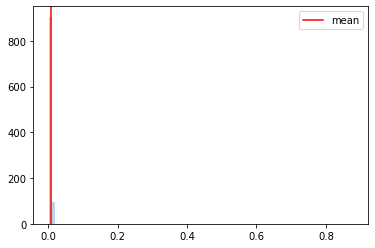

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654384411
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 10.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:04, 15.35it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:47,  9.23it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:46,  9.27it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:46,  9.33it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:51,  8.89it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:51,  8.81it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:53,  8.65it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:54,  8.58it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:52,  8.73it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<02:02,  7.97it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:58,  8.25it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:55,  8.46it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:53,  8.58it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:16,  7.08it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:10,  7.42it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:04,  7.74it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▊                                                                             | 35/1000 [00:04<02:03,  7.84it/s]

Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:29,  6.45it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<02:11,  7.30it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:05<02:01,  7.87it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<01:59,  8.01it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:58,  8.09it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:56,  8.21it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:06<01:58,  8.03it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<01:59,  7.95it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:04,  7.62it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:58,  7.95it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<01:59,  7.89it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<01:58,  7.93it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:58,  7.89it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:03,  7.56it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:07,  7.32it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:02,  7.62it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:04,  7.51it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:04,  7.43it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:10,  7.10it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:03,  7.50it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:05,  7.33it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:08,  7.18it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:04,  7.41it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:06,  7.25it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:02,  7.45it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:10,  6.99it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:07,  7.13it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:12,  6.87it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:09,  7.01it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:18,  6.52it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:14,  6.69it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:09,  6.95it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:04,  7.24it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:03,  7.29it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:09,  6.90it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:16,  6.56it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:14,  6.64it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:09,  6.85it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:06,  7.02it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:03,  7.18it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:08,  6.89it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:11,  6.71it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:06,  6.93it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:05,  6.99it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:08,  6.81it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:18,  6.30it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:15,  6.42it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:12,  6.56it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:12,  6.54it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:14,  6.45it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:15,  6.35it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:10,  6.60it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:13,  6.45it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:18,  6.18it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:13,  6.42it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:14,  6.32it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:21,  6.00it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:18,  6.13it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<02:14,  6.28it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:12,  6.39it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:16,  6.19it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:17,  6.10it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:13,  6.31it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:35,  5.38it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:23<02:27,  5.67it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:20,  5.93it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:19,  5.97it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:14,  6.19it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:12,  6.23it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:13,  6.16it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:25<02:14,  6.11it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:15,  6.05it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:23,  5.72it/s]

Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:26<02:19,  5.88it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:15,  6.04it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:18,  5.86it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:27<02:18,  5.88it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:19,  5.79it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:27<02:26,  5.53it/s]

Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:27<02:23,  5.61it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:28<02:18,  5.82it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:28<02:21,  5.68it/s]

Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:17,  5.82it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:29<02:15,  5.89it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:20,  5.69it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:23,  5.56it/s]

Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:30<02:22,  5.58it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:30<02:17,  5.78it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:30<02:21,  5.57it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:31<02:16,  5.79it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:20,  5.58it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:24,  5.42it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:32<02:30,  5.20it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:24,  5.40it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:25,  5.36it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:33<02:28,  5.24it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:25,  5.32it/s]

Monte Carlo 223
Monte Carlo 224


 22%|█████████████████▊                                                             | 225/1000 [00:33<02:48,  4.60it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:34<02:37,  4.90it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:34<02:29,  5.15it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:29,  5.17it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:35<02:37,  4.89it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:31,  5.05it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:28,  5.14it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:30,  5.06it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:36<02:22,  5.35it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:19,  5.46it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:18,  5.50it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:37<02:13,  5.67it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:12,  5.70it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:11,  5.76it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:07,  5.89it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:06,  5.93it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:05,  5.95it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:38<02:09,  5.76it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:39<02:11,  5.68it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:11,  5.64it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:39<02:06,  5.84it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:13,  5.55it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:16,  5.42it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:40<02:13,  5.54it/s]

Monte Carlo 261
Monte Carlo 262


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:11,  5.61it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:14,  5.46it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:07,  5.76it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:17,  5.32it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:15,  5.40it/s]

Monte Carlo 269
Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:15,  5.38it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:17,  5.27it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:42<02:19,  5.20it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:17,  5.25it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:15,  5.34it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:09,  5.58it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:43<02:06,  5.68it/s]

Monte Carlo 279
Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:12,  5.43it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:09,  5.52it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:44<02:06,  5.66it/s]

Monte Carlo 284
Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:12,  5.37it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:13,  5.34it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:13,  5.32it/s]

Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:45<02:15,  5.22it/s]

Monte Carlo 289
Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:46<02:15,  5.24it/s]

Monte Carlo 291
Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:46<02:19,  5.07it/s]

Monte Carlo 293
Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:46<02:22,  4.93it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:46<02:26,  4.79it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:47<02:22,  4.94it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:47<02:21,  4.95it/s]

Monte Carlo 299
Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:48<02:17,  5.07it/s]

Monte Carlo 301
Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:48<02:12,  5.24it/s]

Monte Carlo 303
Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:48<02:14,  5.14it/s]

Monte Carlo 305
Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:49<02:30,  4.60it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:49<02:23,  4.82it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:50<02:28,  4.64it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:50<02:21,  4.84it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:50<02:19,  4.91it/s]

Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:50<02:18,  4.96it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:51<02:12,  5.15it/s]

Monte Carlo 315
Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:51<02:06,  5.38it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:51<02:08,  5.30it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:51<02:10,  5.22it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:52<02:12,  5.12it/s]

Monte Carlo 321
Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:52<02:14,  5.04it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:52<02:18,  4.89it/s]

Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:53<02:15,  4.99it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:53<02:14,  5.00it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:53<02:14,  5.00it/s]

Monte Carlo 327
Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:53<02:18,  4.84it/s]

Monte Carlo 329
Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:54<02:20,  4.76it/s]

Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:54<02:19,  4.77it/s]

Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:54<02:18,  4.80it/s]

Monte Carlo 333
Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:54<02:26,  4.55it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:55<02:31,  4.38it/s]

Monte Carlo 336


 34%|██████████████████████████▋                                                    | 338/1000 [00:55<02:25,  4.56it/s]

Monte Carlo 337
Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:55<02:25,  4.55it/s]

Monte Carlo 339


 34%|██████████████████████████▉                                                    | 341/1000 [00:56<02:23,  4.59it/s]

Monte Carlo 340
Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:56<02:28,  4.43it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:56<02:26,  4.47it/s]

Monte Carlo 343


 34%|███████████████████████████▎                                                   | 345/1000 [00:57<02:20,  4.67it/s]

Monte Carlo 344
Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:57<02:28,  4.42it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:57<02:33,  4.24it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:57<02:29,  4.37it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:58<02:27,  4.43it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:58<02:27,  4.42it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:58<02:29,  4.35it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:58<02:27,  4.38it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:58<02:29,  4.33it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:59<02:27,  4.38it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 356/1000 [00:59<02:19,  4.60it/s]

Monte Carlo 355
Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [00:59<02:29,  4.31it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:00<02:31,  4.23it/s]

Monte Carlo 358


 36%|████████████████████████████▍                                                  | 360/1000 [01:00<02:28,  4.32it/s]

Monte Carlo 359
Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:00<02:29,  4.27it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:01<02:30,  4.25it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:01<02:29,  4.25it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:01<02:26,  4.35it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:01<02:23,  4.43it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:01<02:26,  4.32it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:02<02:27,  4.30it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:02<02:23,  4.40it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 370/1000 [01:02<02:17,  4.59it/s]

Monte Carlo 369
Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:03<02:20,  4.49it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:03<02:22,  4.41it/s]

Monte Carlo 372


 37%|█████████████████████████████▌                                                 | 374/1000 [01:03<02:17,  4.55it/s]

Monte Carlo 373
Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 376/1000 [01:04<02:19,  4.47it/s]

Monte Carlo 375
Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:04<02:30,  4.13it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:04<02:32,  4.09it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:04<02:28,  4.19it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:05<02:26,  4.23it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:05<02:28,  4.18it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:05<02:22,  4.32it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:05<02:22,  4.34it/s]

Monte Carlo 383


 38%|██████████████████████████████▍                                                | 385/1000 [01:06<02:20,  4.36it/s]

Monte Carlo 384
Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:06<02:18,  4.42it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:06<02:21,  4.34it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:07<02:20,  4.37it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:07<02:18,  4.41it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:07<02:16,  4.46it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:07<02:20,  4.34it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:07<02:22,  4.26it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:08<02:18,  4.37it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:08<02:18,  4.38it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:08<02:21,  4.26it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:08<02:25,  4.16it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:09<02:22,  4.22it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:09<02:25,  4.14it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:09<02:25,  4.14it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:09<02:23,  4.17it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:10<02:24,  4.15it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:10<02:23,  4.17it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:10<02:27,  4.03it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:10<02:24,  4.11it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:11<02:26,  4.06it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:11<02:27,  4.03it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:11<02:26,  4.05it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:11<02:28,  4.00it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:12<02:28,  3.98it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:12<02:27,  4.01it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:12<02:22,  4.14it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:12<02:23,  4.09it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:13<02:21,  4.15it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:13<02:22,  4.12it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:13<02:23,  4.09it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:13<02:20,  4.16it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:14<02:19,  4.17it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:14<02:20,  4.15it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:14<02:22,  4.07it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:14<02:21,  4.10it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:15<02:25,  3.98it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:15<02:24,  4.00it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:15<02:20,  4.11it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:15<02:18,  4.17it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:16<02:19,  4.12it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:16<02:15,  4.23it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:16<02:39,  3.59it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:16<02:32,  3.75it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:17<02:26,  3.89it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:17<02:20,  4.07it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:17<02:21,  4.02it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:17<02:19,  4.07it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:18<02:18,  4.09it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:18<02:15,  4.16it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:18<02:15,  4.17it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:18<02:17,  4.11it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:19<02:18,  4.07it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:19<02:16,  4.12it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:19<02:15,  4.16it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:19<02:12,  4.21it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:19<02:12,  4.20it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:20<02:11,  4.24it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:20<02:15,  4.12it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:20<02:17,  4.05it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:20<02:15,  4.09it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:21<02:16,  4.06it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:21<02:17,  4.02it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:21<02:19,  3.96it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:21<02:16,  4.03it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:22<02:18,  3.98it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:22<02:15,  4.04it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:22<02:17,  3.98it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:22<02:17,  3.99it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:23<02:15,  4.04it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:23<02:13,  4.09it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:23<02:15,  4.01it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:23<02:15,  4.01it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:24<02:16,  3.96it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:24<02:19,  3.86it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:24<02:22,  3.78it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:25<02:22,  3.79it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:25<02:23,  3.75it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:25<02:23,  3.75it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:25<02:23,  3.73it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:26<02:23,  3.74it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:26<02:23,  3.72it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:26<02:28,  3.60it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:26<02:29,  3.57it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:27<02:32,  3.49it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:27<02:28,  3.57it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:27<02:22,  3.70it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:28<02:21,  3.73it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:28<02:18,  3.81it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:28<02:17,  3.83it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:28<02:15,  3.88it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:29<02:17,  3.82it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:29<02:18,  3.78it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:29<02:14,  3.89it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:29<02:16,  3.80it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:30<02:17,  3.78it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:30<02:15,  3.83it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:30<02:14,  3.85it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:30<02:14,  3.85it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:31<02:17,  3.76it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:31<02:14,  3.82it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:31<02:13,  3.85it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:31<02:16,  3.75it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:32<02:14,  3.80it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:32<02:15,  3.76it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:32<02:13,  3.83it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:32<02:15,  3.76it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:33<02:16,  3.73it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:33<02:15,  3.74it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:33<02:16,  3.70it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:34<02:13,  3.78it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:34<02:17,  3.67it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:34<02:18,  3.63it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:34<02:15,  3.70it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:35<02:14,  3.71it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:35<02:14,  3.71it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:35<02:11,  3.79it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:35<02:12,  3.75it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:36<02:13,  3.73it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:36<02:15,  3.67it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:36<02:17,  3.59it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:37<02:20,  3.52it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:37<02:18,  3.56it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:37<02:18,  3.57it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:37<02:14,  3.65it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:38<02:16,  3.59it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:38<02:14,  3.63it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:38<02:15,  3.61it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:39<02:13,  3.65it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:39<02:10,  3.72it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:39<02:11,  3.68it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:39<02:14,  3.60it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:40<02:11,  3.66it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:40<02:13,  3.61it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:40<02:11,  3.66it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:40<02:13,  3.60it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:41<02:14,  3.57it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:41<02:17,  3.48it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:41<02:12,  3.59it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:42<02:11,  3.61it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:42<02:11,  3.62it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:42<02:13,  3.54it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:42<02:16,  3.46it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:43<02:15,  3.49it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:43<02:16,  3.46it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:43<02:14,  3.50it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:44<02:15,  3.46it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:44<02:15,  3.44it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:44<02:16,  3.43it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:44<02:14,  3.47it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:45<02:13,  3.48it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:45<02:12,  3.51it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:45<02:10,  3.54it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:46<02:13,  3.45it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:46<02:09,  3.55it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:46<02:10,  3.51it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:46<02:09,  3.55it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:47<02:23,  3.18it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:47<02:23,  3.19it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:47<02:17,  3.33it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:48<02:11,  3.45it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:48<02:08,  3.52it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:48<02:11,  3.46it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:49<02:07,  3.55it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:49<02:07,  3.53it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:49<02:07,  3.53it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:49<02:09,  3.48it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:50<02:07,  3.52it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:50<02:08,  3.49it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:50<02:07,  3.50it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:51<02:07,  3.48it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:51<02:07,  3.48it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:51<02:04,  3.55it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:51<02:09,  3.41it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:52<02:10,  3.38it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:52<02:09,  3.41it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:52<02:06,  3.47it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:53<02:06,  3.45it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:53<02:07,  3.44it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:53<02:08,  3.40it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:53<02:07,  3.40it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:54<02:06,  3.44it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:54<02:05,  3.46it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:54<02:04,  3.48it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:55<02:04,  3.45it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:55<02:04,  3.45it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:55<02:02,  3.51it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:55<02:00,  3.54it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:56<02:00,  3.54it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:56<01:59,  3.55it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:56<02:02,  3.46it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:57<02:02,  3.45it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:57<02:00,  3.50it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:57<02:00,  3.51it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:57<02:01,  3.48it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:58<02:01,  3.45it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:58<02:02,  3.41it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:58<02:02,  3.40it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:59<02:02,  3.40it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:59<02:03,  3.38it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:59<02:00,  3.44it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:00<02:04,  3.33it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:00<02:01,  3.39it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:00<02:03,  3.34it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:00<02:04,  3.31it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:01<02:02,  3.35it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:01<02:03,  3.30it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:01<02:04,  3.29it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:02<02:03,  3.30it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:02<02:02,  3.30it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:02<02:03,  3.29it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:03<02:03,  3.26it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:03<02:04,  3.24it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:03<02:00,  3.35it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:03<01:58,  3.39it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:04<01:54,  3.49it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:04<01:56,  3.41it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:04<01:57,  3.39it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:05<01:56,  3.41it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:05<01:54,  3.47it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:05<01:51,  3.55it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:05<01:50,  3.57it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:06<01:51,  3.53it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:06<01:51,  3.51it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:06<01:53,  3.43it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:07<01:53,  3.42it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:07<01:54,  3.40it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:07<01:54,  3.40it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:07<01:53,  3.40it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:08<01:55,  3.35it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:08<01:57,  3.26it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:08<02:02,  3.14it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:09<02:07,  3.00it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:09<02:03,  3.10it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:09<02:01,  3.14it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:10<02:00,  3.16it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:10<01:56,  3.26it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:10<01:57,  3.23it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:11<01:55,  3.27it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:11<01:51,  3.37it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:11<01:51,  3.37it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:12<01:53,  3.29it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:12<01:51,  3.33it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:12<01:52,  3.31it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:12<01:51,  3.32it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:13<01:52,  3.28it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:13<01:50,  3.33it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:13<01:53,  3.24it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:14<01:50,  3.33it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:14<01:48,  3.38it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:14<01:50,  3.30it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:15<01:47,  3.37it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:15<01:50,  3.29it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:15<01:47,  3.37it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:15<01:49,  3.29it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:16<01:50,  3.25it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:16<01:52,  3.20it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:16<01:52,  3.18it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:17<01:52,  3.17it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:17<01:52,  3.16it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:17<01:53,  3.14it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:18<01:52,  3.15it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:18<01:55,  3.07it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:18<01:55,  3.04it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:19<01:59,  2.95it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:19<01:55,  3.03it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:19<01:53,  3.08it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:20<02:04,  2.79it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:20<02:00,  2.87it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:20<01:58,  2.93it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:21<01:55,  2.98it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:21<01:53,  3.02it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:21<01:52,  3.06it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:22<01:55,  2.97it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:22<01:53,  3.01it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:22<01:56,  2.91it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:23<01:55,  2.95it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:23<01:53,  2.97it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:24<01:58,  2.85it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:24<01:57,  2.87it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:24<01:58,  2.83it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:25<01:56,  2.86it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:25<01:56,  2.86it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:25<01:54,  2.90it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:26<01:55,  2.87it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:26<01:52,  2.94it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:26<01:50,  2.98it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:27<01:49,  2.99it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:27<01:51,  2.94it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:27<01:49,  2.98it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:28<01:49,  2.98it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:28<01:46,  3.04it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:28<01:48,  2.98it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:29<01:46,  3.03it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:29<01:45,  3.04it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:29<01:48,  2.96it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:30<01:49,  2.92it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:30<01:47,  2.95it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:30<01:47,  2.96it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:31<01:45,  3.00it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:31<01:46,  2.95it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:31<01:45,  2.98it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:32<01:45,  2.98it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:32<01:46,  2.92it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:32<01:43,  2.99it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:33<01:42,  3.01it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:33<01:45,  2.92it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:33<01:43,  2.96it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:34<01:44,  2.93it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:34<01:44,  2.93it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:34<01:42,  2.96it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:35<01:42,  2.97it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:35<01:40,  3.01it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:35<01:40,  2.99it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:36<01:41,  2.96it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:36<01:42,  2.91it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:36<01:42,  2.93it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:37<01:43,  2.87it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:37<01:43,  2.87it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:37<01:41,  2.91it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:38<01:42,  2.89it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:38<01:41,  2.91it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:38<01:40,  2.91it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:39<01:40,  2.90it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:39<01:41,  2.86it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:40<01:43,  2.81it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:40<01:43,  2.79it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:40<01:40,  2.88it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:41<01:43,  2.76it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:41<01:42,  2.79it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:41<01:40,  2.82it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:42<01:39,  2.85it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:42<01:37,  2.89it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:42<01:36,  2.93it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:43<01:36,  2.90it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:43<01:33,  3.00it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:43<01:34,  2.94it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:44<01:35,  2.91it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:44<01:33,  2.97it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:44<01:30,  3.05it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:45<01:29,  3.06it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:45<01:28,  3.10it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:45<01:29,  3.05it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:46<01:29,  3.04it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:46<01:29,  3.02it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:46<01:28,  3.05it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:47<01:27,  3.07it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:47<01:29,  3.00it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:47<01:31,  2.92it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:48<01:29,  2.96it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:48<01:28,  2.98it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:48<01:30,  2.90it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:49<01:32,  2.83it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:49<01:33,  2.81it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:49<01:32,  2.82it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:50<01:33,  2.79it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:50<01:33,  2.77it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:50<01:33,  2.77it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:51<01:31,  2.79it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:51<01:31,  2.80it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:52<01:30,  2.81it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:52<01:30,  2.82it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:52<01:30,  2.80it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:53<01:30,  2.77it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:53<01:29,  2.80it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:53<01:28,  2.84it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:54<01:28,  2.81it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:54<01:36,  2.56it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:55<01:33,  2.63it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:55<01:34,  2.61it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:55<01:31,  2.68it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:56<01:30,  2.70it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:56<01:28,  2.75it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:56<01:27,  2.75it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:57<01:27,  2.76it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:57<01:26,  2.78it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:57<01:28,  2.70it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:58<01:27,  2.72it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:58<01:26,  2.73it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:59<01:26,  2.72it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:59<01:29,  2.63it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:59<01:27,  2.69it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:00<01:26,  2.68it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:00<01:25,  2.72it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:00<01:24,  2.73it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:01<01:24,  2.74it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:01<01:23,  2.73it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:01<01:22,  2.75it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:02<01:22,  2.74it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:02<01:22,  2.73it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:03<01:25,  2.64it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:03<01:23,  2.70it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:03<01:22,  2.70it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:04<01:22,  2.71it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:04<01:20,  2.74it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:04<01:20,  2.72it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:05<01:19,  2.75it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:05<01:20,  2.71it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:06<01:19,  2.73it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:06<01:18,  2.75it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:06<01:18,  2.75it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:07<01:18,  2.72it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:07<01:17,  2.75it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:07<01:15,  2.79it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:08<01:15,  2.79it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:08<01:17,  2.72it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:08<01:17,  2.69it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:09<01:18,  2.66it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:09<01:16,  2.70it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:10<01:16,  2.68it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:10<01:17,  2.65it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:10<01:16,  2.67it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:11<01:15,  2.67it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:11<01:15,  2.67it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:11<01:13,  2.73it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:12<01:14,  2.68it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:12<01:13,  2.70it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:13<01:12,  2.75it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:13<01:13,  2.69it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:13<01:12,  2.72it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:14<01:10,  2.75it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:14<01:10,  2.74it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:14<01:11,  2.71it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:15<01:11,  2.69it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:15<01:10,  2.69it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:16<01:11,  2.64it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:16<01:11,  2.65it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:16<01:10,  2.68it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:17<01:09,  2.68it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:17<01:08,  2.70it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:17<01:11,  2.57it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:18<01:09,  2.65it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:18<01:09,  2.61it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:19<01:08,  2.66it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:19<01:07,  2.67it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:19<01:07,  2.65it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:20<01:07,  2.67it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:20<01:07,  2.63it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:20<01:05,  2.69it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:21<01:05,  2.69it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:21<01:05,  2.65it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:22<01:05,  2.66it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:22<01:05,  2.63it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:22<01:05,  2.64it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:23<01:05,  2.62it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:23<01:04,  2.64it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:23<01:03,  2.65it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:24<01:02,  2.67it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:24<01:02,  2.66it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:25<01:02,  2.66it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:25<01:03,  2.62it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:25<01:03,  2.59it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:26<01:01,  2.64it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:26<01:01,  2.62it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:26<01:01,  2.64it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:27<00:59,  2.68it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:27<01:00,  2.64it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:28<01:00,  2.60it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:28<01:01,  2.53it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:28<01:02,  2.49it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:29<01:00,  2.55it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:29<01:00,  2.55it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:30<01:00,  2.54it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:30<00:58,  2.59it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:30<00:58,  2.56it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:31<00:58,  2.55it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:31<00:58,  2.53it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:32<00:57,  2.57it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:32<01:02,  2.36it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:32<01:01,  2.39it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:33<00:58,  2.47it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:33<00:57,  2.51it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:34<00:57,  2.49it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:34<00:56,  2.49it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:34<00:55,  2.54it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:35<00:54,  2.58it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:35<00:53,  2.59it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:36<00:53,  2.57it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:36<00:54,  2.53it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:36<00:55,  2.47it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:37<00:55,  2.45it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:37<00:54,  2.47it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:38<00:53,  2.50it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:38<00:51,  2.55it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:38<00:51,  2.56it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:39<00:51,  2.53it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:39<00:50,  2.53it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:40<00:51,  2.49it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:40<00:50,  2.52it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:40<00:50,  2.49it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:41<00:50,  2.48it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:41<00:50,  2.47it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:42<00:48,  2.51it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:42<00:47,  2.55it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:42<00:46,  2.59it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:43<00:46,  2.57it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:43<00:45,  2.61it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:43<00:44,  2.64it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:44<00:43,  2.66it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:44<00:43,  2.70it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:45<00:41,  2.74it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:45<00:41,  2.73it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:45<00:41,  2.71it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:46<00:42,  2.64it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:46<00:42,  2.61it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:47<00:43,  2.54it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:47<00:43,  2.53it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:47<00:42,  2.52it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:48<00:41,  2.58it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:48<00:40,  2.61it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:48<00:39,  2.66it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:49<00:39,  2.65it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:49<00:38,  2.64it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:50<00:39,  2.56it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:50<00:39,  2.54it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:50<00:38,  2.63it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:51<00:37,  2.61it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:51<00:36,  2.65it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:51<00:36,  2.65it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:52<00:36,  2.65it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:52<00:36,  2.58it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:53<00:35,  2.62it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:53<00:35,  2.58it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:53<00:35,  2.58it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:54<00:34,  2.60it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:54<00:34,  2.58it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:55<00:34,  2.57it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:55<00:34,  2.55it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:55<00:34,  2.50it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:56<00:34,  2.53it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:56<00:33,  2.52it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:57<00:33,  2.48it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:57<00:34,  2.44it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:57<00:33,  2.43it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:58<00:33,  2.40it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:58<00:32,  2.42it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:59<00:32,  2.44it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:59<00:32,  2.41it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:00<00:32,  2.37it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:00<00:31,  2.40it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:00<00:30,  2.42it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:01<00:30,  2.40it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:01<00:30,  2.39it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:02<00:29,  2.40it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:02<00:29,  2.37it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:02<00:29,  2.38it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:03<00:29,  2.38it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:03<00:28,  2.41it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:04<00:28,  2.37it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:04<00:28,  2.28it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:05<00:28,  2.30it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:05<00:27,  2.32it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:05<00:26,  2.36it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:06<00:26,  2.38it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:06<00:25,  2.42it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:07<00:25,  2.38it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:07<00:25,  2.33it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:08<00:24,  2.34it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:08<00:24,  2.33it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:08<00:24,  2.29it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:09<00:23,  2.29it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:09<00:23,  2.35it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:10<00:22,  2.35it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:10<00:21,  2.40it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:11<00:21,  2.38it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:11<00:21,  2.33it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:11<00:21,  2.31it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:12<00:20,  2.33it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:12<00:20,  2.34it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:13<00:19,  2.37it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:13<00:18,  2.39it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:14<00:18,  2.33it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:14<00:18,  2.30it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:14<00:18,  2.32it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:15<00:17,  2.36it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:15<00:16,  2.38it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:16<00:16,  2.40it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:16<00:16,  2.34it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:17<00:15,  2.32it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:17<00:15,  2.34it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:18<00:16,  2.17it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:18<00:15,  2.21it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:18<00:14,  2.25it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:19<00:14,  2.24it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:19<00:13,  2.27it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:20<00:12,  2.32it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:20<00:12,  2.33it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:21<00:12,  2.32it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:21<00:11,  2.30it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:21<00:11,  2.32it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:22<00:10,  2.29it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:22<00:10,  2.26it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:23<00:10,  2.28it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:23<00:09,  2.28it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:24<00:09,  2.31it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:24<00:08,  2.29it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:24<00:08,  2.30it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:25<00:07,  2.31it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:25<00:07,  2.30it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:26<00:07,  2.28it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:26<00:06,  2.27it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:27<00:06,  2.29it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:27<00:05,  2.26it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:28<00:05,  2.28it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:28<00:04,  2.31it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:28<00:04,  2.27it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:29<00:04,  2.24it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:29<00:03,  2.20it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:30<00:03,  2.26it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:30<00:02,  2.24it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:31<00:02,  2.26it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:31<00:01,  2.31it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:31<00:01,  2.38it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:32<00:00,  2.40it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:32<00:00,  2.41it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:33<00:00,  3.66it/s]


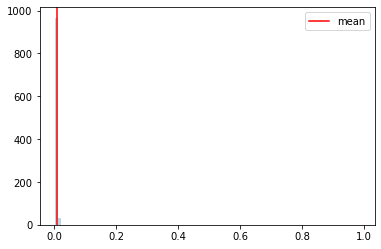

  0%|▏                                                                                | 3/1000 [00:00<00:57, 17.29it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654384685
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 1.0, 'jump_size_a': 10.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3


  0%|▍                                                                                | 5/1000 [00:00<01:32, 10.80it/s]

Monte Carlo 4
Monte Carlo 5


  1%|▌                                                                                | 7/1000 [00:00<01:39,  9.97it/s]

Monte Carlo 6
Monte Carlo 7


  1%|▋                                                                                | 9/1000 [00:00<01:41,  9.74it/s]

Monte Carlo 8
Monte Carlo 9


  1%|▉                                                                               | 11/1000 [00:01<01:44,  9.50it/s]

Monte Carlo 10
Monte Carlo 11
Monte Carlo 12

  1%|█                                                                               | 13/1000 [00:01<01:41,  9.68it/s]


Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<01:42,  9.60it/s]

Monte Carlo 14
Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:50,  8.92it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:55,  8.50it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:53,  8.61it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:53,  8.61it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:59,  8.17it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<01:57,  8.24it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:13,  7.28it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:11,  7.38it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<02:14,  7.18it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▊                                                                             | 35/1000 [00:04<02:11,  7.31it/s]

Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:29,  6.43it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<02:06,  7.59it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<02:07,  7.51it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<01:56,  8.18it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:58,  8.06it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:03,  7.74it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:59,  7.97it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<01:52,  8.43it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<01:45,  8.94it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:48,  8.74it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<01:46,  8.88it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<01:52,  8.34it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<01:56,  8.05it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<01:56,  8.01it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<01:58,  7.88it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<01:54,  8.12it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<01:56,  7.97it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<01:56,  7.96it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<01:51,  8.28it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:00,  7.65it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:03,  7.48it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:02,  7.49it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:09<02:03,  7.47it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:10,  7.01it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:04,  7.38it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<01:56,  7.81it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:10<01:57,  7.79it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:02,  7.40it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<01:57,  7.73it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<02:01,  7.43it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:03,  7.31it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:08,  7.03it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:06,  7.10it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:12<02:13,  6.74it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:15,  6.59it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:15,  6.61it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:10,  6.81it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:14,  6.61it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:16,  6.49it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:14,  6.56it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:14,  6.55it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:09,  6.80it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:03,  7.11it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<02:03,  7.11it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:04,  7.05it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:10,  6.68it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:04,  7.00it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:07,  6.84it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:07,  6.78it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<02:07,  6.76it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:05,  6.89it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:13,  6.44it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:22,  6.01it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:31,  5.64it/s]

Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:19<02:34,  5.53it/s]

Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:27,  5.80it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:15,  6.31it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:17,  6.20it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:46,  5.11it/s]

Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:20<02:39,  5.31it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:21<02:36,  5.42it/s]

Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:34,  5.47it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:24,  5.82it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<02:33,  5.46it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 160/1000 [00:22<02:38,  5.30it/s]

Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:57,  4.73it/s]

Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:48,  4.96it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:23<02:39,  5.24it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:32,  5.47it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:24,  5.76it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:19,  5.93it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:18,  5.96it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:20,  5.86it/s]

Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:25<02:22,  5.77it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:12,  6.20it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:09,  6.33it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:18,  5.90it/s]

Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:26<02:23,  5.70it/s]

Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:20,  5.80it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:13,  6.12it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:26<02:08,  6.34it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:15,  5.97it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:27<02:11,  6.15it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:12,  6.10it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:17,  5.84it/s]

Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:28<02:18,  5.82it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:28<02:19,  5.75it/s]

Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:29<02:18,  5.79it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:18,  5.74it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:21,  5.64it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:12,  5.97it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:06,  6.25it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:04,  6.37it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:30<02:04,  6.31it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:02,  6.40it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:07,  6.15it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:08,  6.06it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:15,  5.77it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:10,  5.95it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:32<02:10,  5.95it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:33<02:11,  5.88it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:33<02:11,  5.88it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:33<02:06,  6.12it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:06,  6.09it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:08,  5.96it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:34<02:10,  5.86it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:09,  5.88it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:35<02:08,  5.91it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:35<02:07,  5.95it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:05,  6.06it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:36<02:00,  6.27it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:36<02:01,  6.18it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:37<02:02,  6.11it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:37<02:05,  5.97it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:37<02:05,  5.95it/s]

Monte Carlo 252
Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:38<02:07,  5.84it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:38<02:09,  5.74it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:38<02:17,  5.39it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:38<02:18,  5.33it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:39<02:12,  5.60it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:39<02:14,  5.49it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:39<02:10,  5.66it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:39<02:10,  5.63it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:40<02:13,  5.50it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:40<02:11,  5.59it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:40<02:11,  5.55it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:41<02:05,  5.82it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:41<02:05,  5.81it/s]

Monte Carlo 272
Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:41<02:05,  5.79it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:42<02:08,  5.61it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:42<02:09,  5.57it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:42<02:05,  5.75it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:42<02:07,  5.63it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:43<02:13,  5.37it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:43<02:11,  5.46it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:43<02:11,  5.43it/s]

Monte Carlo 283
Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:43<02:07,  5.59it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:43<02:13,  5.33it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:44<02:15,  5.25it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:44<02:16,  5.18it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:44<02:18,  5.11it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:45<02:17,  5.13it/s]

Monte Carlo 292
Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:45<02:21,  4.99it/s]

Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:45<02:24,  4.88it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:45<02:25,  4.82it/s]

Monte Carlo 296
Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:46<02:28,  4.72it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:46<02:26,  4.79it/s]

Monte Carlo 299


 30%|███████████████████████▊                                                       | 301/1000 [00:46<02:24,  4.84it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:47<02:23,  4.86it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:47<02:21,  4.93it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:47<02:20,  4.95it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:47<02:19,  4.98it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:47<02:18,  5.02it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:47<02:15,  5.10it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:48<02:14,  5.15it/s]

Monte Carlo 307
Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:48<02:33,  4.50it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:48<02:33,  4.48it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:49<02:28,  4.63it/s]

Monte Carlo 312
Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:49<02:28,  4.63it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:49<02:30,  4.54it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:50<02:29,  4.57it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:50<02:26,  4.64it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:50<02:29,  4.55it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:51<02:21,  4.79it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:51<02:21,  4.80it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:51<02:18,  4.90it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:51<02:19,  4.86it/s]

Monte Carlo 323
Monte Carlo 324


 33%|█████████████████████████▊                                                     | 326/1000 [00:52<02:17,  4.89it/s]

Monte Carlo 325
Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:52<02:22,  4.72it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:52<02:26,  4.60it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:52<02:25,  4.62it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:53<02:23,  4.67it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:53<02:22,  4.69it/s]

Monte Carlo 331
Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:53<02:21,  4.69it/s]

Monte Carlo 333
Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:54<02:28,  4.49it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:54<02:30,  4.40it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:54<02:32,  4.34it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:54<02:32,  4.33it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:55<02:33,  4.29it/s]

Monte Carlo 339
Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:55<02:35,  4.24it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:55<02:35,  4.22it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:55<02:33,  4.27it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:56<02:32,  4.29it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:56<02:27,  4.45it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:56<02:28,  4.41it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:56<02:30,  4.34it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:57<02:30,  4.32it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:57<02:31,  4.30it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:57<02:30,  4.33it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:57<02:33,  4.22it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:58<02:34,  4.20it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:58<02:41,  4.01it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:58<02:43,  3.96it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [00:58<02:40,  4.03it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [00:59<02:44,  3.92it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [00:59<02:44,  3.92it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [00:59<02:45,  3.88it/s]

Monte Carlo 358


 36%|████████████████████████████▍                                                  | 360/1000 [01:00<02:34,  4.15it/s]

Monte Carlo 359
Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:00<02:33,  4.16it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:00<02:30,  4.23it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:00<02:24,  4.40it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 365/1000 [01:01<02:16,  4.64it/s]

Monte Carlo 364
Monte Carlo 365


 37%|████████████████████████████▉                                                  | 367/1000 [01:01<02:17,  4.60it/s]

Monte Carlo 366
Monte Carlo 367


 37%|█████████████████████████████▏                                                 | 369/1000 [01:02<02:15,  4.64it/s]

Monte Carlo 368
Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:02<02:17,  4.59it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:02<02:19,  4.51it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:02<02:24,  4.34it/s]

Monte Carlo 372


 37%|█████████████████████████████▌                                                 | 374/1000 [01:03<02:23,  4.35it/s]

Monte Carlo 373
Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:03<02:22,  4.38it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:03<02:21,  4.40it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:03<02:19,  4.45it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:04<02:17,  4.52it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:04<02:15,  4.58it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:04<02:16,  4.53it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:04<02:15,  4.56it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:04<02:16,  4.52it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:05<02:21,  4.35it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:05<02:23,  4.30it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:05<02:23,  4.28it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:05<02:23,  4.27it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:06<02:20,  4.38it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 389/1000 [01:06<02:14,  4.54it/s]

Monte Carlo 388
Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:06<02:13,  4.55it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:07<02:22,  4.27it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:07<02:18,  4.38it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:07<02:21,  4.28it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:07<02:21,  4.30it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:07<02:19,  4.34it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:08<02:21,  4.28it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:08<02:19,  4.33it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:08<02:26,  4.11it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:08<02:26,  4.11it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:09<02:30,  3.97it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:09<02:26,  4.10it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:09<02:24,  4.14it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:09<02:27,  4.06it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:10<02:22,  4.20it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:10<02:23,  4.15it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:10<02:20,  4.21it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:10<02:19,  4.24it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:11<02:19,  4.23it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:11<02:16,  4.33it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:11<02:15,  4.37it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:11<02:14,  4.37it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:12<02:14,  4.38it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:12<02:14,  4.36it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:12<02:12,  4.42it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:12<02:13,  4.39it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:12<02:23,  4.08it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:13<02:24,  4.02it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:13<02:19,  4.16it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:13<02:18,  4.18it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:13<02:14,  4.32it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:14<02:14,  4.29it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:14<02:13,  4.34it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:14<02:11,  4.39it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:14<02:11,  4.38it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:15<02:14,  4.29it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:15<02:13,  4.31it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:15<02:18,  4.14it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:15<02:15,  4.21it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:16<02:19,  4.09it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:16<02:16,  4.19it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:16<02:13,  4.28it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:16<02:14,  4.23it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:16<02:14,  4.20it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:17<02:16,  4.13it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:17<02:20,  4.01it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:17<02:15,  4.16it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:17<02:16,  4.12it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:18<02:16,  4.11it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:18<02:19,  4.03it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:18<02:16,  4.10it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:18<02:18,  4.03it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:19<02:18,  4.02it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:19<02:17,  4.06it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:19<02:17,  4.05it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:20<02:34,  3.59it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:20<02:26,  3.78it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:20<02:24,  3.82it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:20<02:19,  3.96it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:21<02:16,  4.03it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:21<02:15,  4.05it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:21<02:13,  4.10it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:21<02:15,  4.05it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:21<02:13,  4.11it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:22<02:15,  4.02it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:22<02:13,  4.08it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:22<02:14,  4.04it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:22<02:11,  4.12it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:23<02:13,  4.05it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:23<02:12,  4.08it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:23<02:11,  4.10it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:23<02:11,  4.10it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:24<02:10,  4.13it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:24<02:06,  4.26it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 465/1000 [01:24<02:00,  4.46it/s]

Monte Carlo 464
Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:25<02:03,  4.32it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:25<02:01,  4.39it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:25<02:00,  4.42it/s]

Monte Carlo 468


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:25<01:59,  4.45it/s]

Monte Carlo 469
Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:26<02:00,  4.39it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:26<02:03,  4.26it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:26<02:19,  3.77it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:27<02:20,  3.73it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:27<02:28,  3.54it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:27<02:25,  3.59it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:27<02:20,  3.71it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:28<02:20,  3.71it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:28<02:22,  3.66it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:28<02:17,  3.79it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:28<02:22,  3.65it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:29<02:22,  3.63it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:29<02:24,  3.57it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:29<02:23,  3.59it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:30<02:22,  3.61it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:30<02:26,  3.52it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:30<02:29,  3.43it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:31<02:30,  3.40it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:31<02:31,  3.37it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:31<02:30,  3.39it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:31<02:25,  3.49it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:32<02:25,  3.48it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:32<02:24,  3.52it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:32<02:25,  3.48it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:32<02:21,  3.56it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:33<02:20,  3.59it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:33<02:24,  3.49it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:33<02:24,  3.47it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:34<02:26,  3.43it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:34<02:34,  3.24it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:34<02:32,  3.27it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:35<02:34,  3.22it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:35<02:40,  3.09it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:35<02:43,  3.02it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:36<02:38,  3.12it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:36<02:37,  3.14it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:36<02:36,  3.14it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:37<02:33,  3.20it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:37<02:36,  3.13it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:37<02:29,  3.29it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:38<02:43,  2.98it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:38<02:48,  2.89it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:38<02:42,  3.00it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:39<02:36,  3.10it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:39<02:35,  3.12it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:39<02:28,  3.26it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:39<02:32,  3.16it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:40<02:31,  3.18it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:40<02:26,  3.29it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:40<02:23,  3.34it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:41<02:25,  3.30it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:41<02:23,  3.34it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:41<02:21,  3.37it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:42<02:21,  3.37it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:42<02:20,  3.37it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:42<02:18,  3.42it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:42<02:16,  3.47it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:43<02:13,  3.53it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:43<02:13,  3.53it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:43<02:16,  3.45it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:44<02:15,  3.45it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:44<02:18,  3.39it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:44<02:15,  3.45it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:44<02:14,  3.45it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:45<02:17,  3.38it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:45<02:27,  3.14it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:45<02:21,  3.27it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:46<02:18,  3.33it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:46<02:18,  3.33it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:46<02:17,  3.35it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:47<02:23,  3.20it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:47<02:22,  3.21it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:47<02:18,  3.30it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:47<02:16,  3.35it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:48<02:12,  3.44it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:48<02:13,  3.41it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:48<02:14,  3.36it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:49<02:19,  3.25it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:49<02:15,  3.32it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:49<02:17,  3.26it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:50<02:15,  3.30it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:50<02:17,  3.25it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:50<02:19,  3.20it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:51<02:23,  3.11it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:51<02:33,  2.89it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:51<02:25,  3.06it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:52<02:21,  3.13it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:52<02:21,  3.13it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:52<02:20,  3.14it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:53<02:20,  3.13it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:53<02:17,  3.19it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:53<02:18,  3.16it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:53<02:19,  3.14it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:54<02:17,  3.18it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:54<02:16,  3.19it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:54<02:13,  3.25it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:55<02:10,  3.31it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:55<02:10,  3.31it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:55<02:13,  3.23it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:56<02:14,  3.19it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:56<02:17,  3.12it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:56<02:19,  3.07it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:57<02:14,  3.17it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:57<02:17,  3.09it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:57<02:20,  3.03it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:58<02:19,  3.05it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:58<02:18,  3.06it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:58<02:16,  3.09it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:59<02:15,  3.10it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:59<02:19,  3.00it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:59<02:16,  3.07it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:00<02:20,  2.98it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:00<02:15,  3.09it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:00<02:14,  3.10it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:01<02:14,  3.08it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:01<02:12,  3.13it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:01<02:09,  3.19it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:02<02:15,  3.04it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:02<02:12,  3.09it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:02<02:19,  2.93it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:03<02:17,  2.98it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:03<02:15,  3.02it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:03<02:14,  3.04it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:03<02:09,  3.12it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:04<02:10,  3.11it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:04<02:12,  3.05it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:04<02:10,  3.09it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:05<02:10,  3.07it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:05<02:07,  3.15it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:05<02:07,  3.15it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:06<02:06,  3.15it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:06<02:06,  3.14it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:06<02:03,  3.21it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:07<02:02,  3.22it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:07<01:59,  3.30it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:07<01:58,  3.31it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:08<02:00,  3.27it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:08<01:56,  3.35it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:08<01:57,  3.34it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:08<02:00,  3.23it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:09<02:02,  3.19it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:09<02:04,  3.11it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:09<02:06,  3.06it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:10<02:04,  3.10it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:10<02:05,  3.07it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:10<02:04,  3.08it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:11<02:00,  3.17it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:11<02:01,  3.14it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:11<02:00,  3.16it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:12<02:00,  3.16it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:12<02:05,  3.02it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:12<02:08,  2.94it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:13<02:06,  2.97it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:13<02:05,  2.99it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:13<02:05,  3.00it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:14<02:09,  2.89it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:14<02:07,  2.92it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:14<02:11,  2.82it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:15<02:07,  2.91it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:15<02:06,  2.93it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:15<02:04,  2.96it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:16<02:05,  2.92it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:16<02:03,  2.96it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:16<02:03,  2.96it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:17<02:17,  2.66it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:17<02:14,  2.71it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:18<02:09,  2.81it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:18<02:03,  2.93it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:18<02:03,  2.93it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:19<02:02,  2.94it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:19<02:04,  2.88it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:19<02:06,  2.83it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:20<02:02,  2.92it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:20<02:02,  2.92it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:20<02:01,  2.91it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:21<02:01,  2.91it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:21<02:00,  2.92it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:21<01:58,  2.96it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:22<01:57,  2.99it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:22<01:59,  2.93it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:22<02:00,  2.89it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:23<02:00,  2.88it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:23<02:01,  2.85it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:23<02:01,  2.85it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:24<02:02,  2.81it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:24<02:00,  2.86it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:25<01:58,  2.91it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:25<01:57,  2.90it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:25<01:55,  2.95it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:26<01:53,  2.98it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:26<01:56,  2.91it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:26<01:54,  2.95it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:27<02:07,  2.64it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:27<02:04,  2.71it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:27<02:00,  2.78it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:28<02:04,  2.69it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:28<02:01,  2.74it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:28<01:57,  2.82it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:29<01:59,  2.76it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:29<01:59,  2.77it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:30<01:59,  2.74it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:30<01:59,  2.74it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:30<01:58,  2.76it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:31<01:56,  2.80it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:31<01:59,  2.72it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:31<01:59,  2.72it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:32<01:57,  2.76it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:32<01:52,  2.86it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:32<01:54,  2.81it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:33<01:50,  2.91it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:33<01:51,  2.86it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:33<01:55,  2.76it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:34<01:55,  2.74it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:34<01:54,  2.75it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:35<02:05,  2.51it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:35<02:02,  2.55it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:35<01:58,  2.65it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:36<01:58,  2.63it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:36<01:53,  2.73it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:36<01:53,  2.73it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:37<01:50,  2.79it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:37<01:52,  2.74it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:38<01:53,  2.71it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:38<01:51,  2.75it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:38<01:49,  2.79it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:39<01:50,  2.76it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:39<01:52,  2.69it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:39<01:52,  2.69it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:40<01:58,  2.54it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:40<01:55,  2.59it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:41<01:52,  2.67it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:41<01:47,  2.78it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:41<01:44,  2.84it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:42<01:45,  2.82it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:42<01:41,  2.90it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:42<01:40,  2.94it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:43<01:38,  2.96it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:43<01:38,  2.97it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:43<01:37,  2.99it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:44<01:37,  2.97it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:44<01:39,  2.91it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:44<01:38,  2.94it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:45<01:38,  2.90it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:45<01:37,  2.93it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:45<01:37,  2.92it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:46<01:39,  2.85it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:46<01:37,  2.89it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:46<01:37,  2.90it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:47<01:36,  2.93it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:47<01:33,  2.99it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:47<01:36,  2.90it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:48<01:37,  2.86it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:48<01:39,  2.77it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:48<01:38,  2.79it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:49<01:41,  2.72it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:49<01:39,  2.76it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:50<01:45,  2.58it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:50<01:44,  2.61it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:50<01:40,  2.69it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:51<01:37,  2.76it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:51<01:34,  2.85it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:51<01:36,  2.79it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:52<01:33,  2.87it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:52<01:32,  2.87it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:52<01:32,  2.86it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:53<01:33,  2.83it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:53<01:33,  2.81it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:54<01:32,  2.84it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:54<01:30,  2.90it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:54<01:32,  2.81it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:55<01:31,  2.84it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:55<01:30,  2.85it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:55<01:31,  2.81it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:56<01:30,  2.84it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:56<01:29,  2.85it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:56<01:38,  2.58it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:57<01:35,  2.66it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:57<01:33,  2.70it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:58<01:30,  2.78it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:58<01:31,  2.73it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:58<01:32,  2.68it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:59<01:30,  2.73it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:59<01:29,  2.76it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:59<01:31,  2.69it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:00<01:29,  2.73it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:00<01:27,  2.78it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:00<01:27,  2.78it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:01<01:25,  2.85it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:01<01:24,  2.85it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:01<01:22,  2.89it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:02<01:21,  2.94it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:02<01:24,  2.83it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:03<01:23,  2.83it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:03<01:23,  2.83it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:03<01:23,  2.80it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:04<01:24,  2.77it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:04<01:24,  2.77it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:04<01:23,  2.79it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:05<01:23,  2.76it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:05<01:21,  2.82it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:05<01:21,  2.81it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:06<01:21,  2.80it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:06<01:20,  2.81it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:06<01:20,  2.80it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:07<01:21,  2.77it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:07<01:19,  2.83it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:08<01:19,  2.80it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:08<01:18,  2.81it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:08<01:18,  2.83it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:09<01:18,  2.82it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:09<01:16,  2.85it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:09<01:15,  2.90it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:10<01:14,  2.90it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:10<01:15,  2.86it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:10<01:16,  2.83it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:11<01:15,  2.85it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:11<01:13,  2.89it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:11<01:15,  2.81it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:12<01:15,  2.78it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:12<01:16,  2.76it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:12<01:16,  2.73it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:13<01:14,  2.78it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:13<01:14,  2.79it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:14<01:15,  2.73it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:14<01:15,  2.71it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:14<01:14,  2.74it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:15<01:13,  2.75it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:15<01:14,  2.72it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:15<01:12,  2.76it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:16<01:12,  2.74it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:16<01:10,  2.81it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:16<01:11,  2.76it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:17<01:11,  2.76it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:17<01:10,  2.79it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:18<01:11,  2.73it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:18<01:09,  2.79it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:18<01:07,  2.84it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:19<01:06,  2.88it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:19<01:06,  2.89it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:19<01:05,  2.88it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:20<01:04,  2.91it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:20<01:03,  2.94it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:20<01:02,  2.97it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:21<01:03,  2.92it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:21<01:05,  2.82it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:21<01:05,  2.81it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:22<01:04,  2.84it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:22<01:04,  2.82it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:22<01:04,  2.80it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:23<01:04,  2.78it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:23<01:04,  2.76it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:24<01:04,  2.78it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:24<01:03,  2.78it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:24<01:01,  2.85it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:25<01:01,  2.84it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:25<01:00,  2.89it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:25<01:00,  2.85it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:26<01:00,  2.86it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:26<00:59,  2.87it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:26<00:58,  2.93it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:27<00:58,  2.90it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:27<00:57,  2.91it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:27<00:56,  2.93it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:28<00:58,  2.85it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:28<00:58,  2.83it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:28<00:56,  2.88it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:29<00:56,  2.89it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:29<00:55,  2.92it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:29<00:54,  2.95it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:30<00:55,  2.91it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:30<00:54,  2.94it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:30<00:54,  2.89it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:31<00:59,  2.63it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:31<00:59,  2.64it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:32<00:57,  2.70it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:32<00:55,  2.77it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:32<00:55,  2.75it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:33<00:53,  2.85it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:33<00:54,  2.76it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:33<00:53,  2.78it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:34<00:54,  2.73it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:34<00:54,  2.73it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:34<00:53,  2.74it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:35<00:53,  2.74it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:35<00:53,  2.74it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:36<00:53,  2.71it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:36<00:53,  2.67it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:36<00:53,  2.65it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:37<00:53,  2.62it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:37<00:53,  2.61it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:38<00:52,  2.66it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:38<00:52,  2.62it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:38<00:51,  2.66it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:39<00:50,  2.69it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:39<00:51,  2.63it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:39<00:51,  2.62it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:40<00:50,  2.63it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:40<00:49,  2.65it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:41<00:49,  2.64it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:41<00:49,  2.65it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:41<00:48,  2.66it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:42<00:49,  2.61it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:42<00:49,  2.54it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:43<00:50,  2.50it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:43<00:50,  2.50it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:43<00:49,  2.52it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:44<00:49,  2.49it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:44<00:49,  2.47it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:45<00:48,  2.50it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:45<00:48,  2.50it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:45<00:48,  2.47it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:46<00:47,  2.50it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:46<00:45,  2.56it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:46<00:45,  2.56it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:47<00:44,  2.57it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:47<00:44,  2.55it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:48<00:44,  2.56it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:48<00:42,  2.61it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:48<00:42,  2.59it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:49<00:43,  2.55it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:49<00:42,  2.57it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:50<00:42,  2.56it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:50<00:41,  2.56it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:50<00:42,  2.52it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:51<00:41,  2.52it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:51<00:40,  2.54it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:52<00:41,  2.48it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:52<00:40,  2.54it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:52<00:40,  2.50it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:53<00:39,  2.55it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:53<00:39,  2.52it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:54<00:38,  2.54it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:54<00:39,  2.46it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:54<00:39,  2.42it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:55<00:41,  2.28it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:55<00:39,  2.38it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:56<00:38,  2.40it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:56<00:39,  2.33it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:57<00:37,  2.42it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:57<00:36,  2.47it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:57<00:36,  2.46it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:58<00:35,  2.50it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:58<00:34,  2.52it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:59<00:34,  2.53it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:59<00:33,  2.51it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:59<00:33,  2.49it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:00<00:32,  2.53it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:00<00:32,  2.54it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:00<00:31,  2.54it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:01<00:31,  2.55it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:01<00:31,  2.53it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:02<00:30,  2.52it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:02<00:30,  2.49it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:02<00:30,  2.50it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:03<00:30,  2.47it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:03<00:29,  2.53it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:04<00:29,  2.50it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:04<00:29,  2.46it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:05<00:28,  2.46it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:05<00:28,  2.47it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:05<00:28,  2.44it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:06<00:27,  2.45it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:06<00:27,  2.45it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:07<00:28,  2.28it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:07<00:27,  2.40it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:07<00:25,  2.51it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:08<00:25,  2.49it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:08<00:24,  2.56it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:09<00:23,  2.62it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:09<00:22,  2.65it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:09<00:22,  2.62it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:10<00:22,  2.53it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:10<00:22,  2.52it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:11<00:22,  2.54it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:11<00:21,  2.53it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:11<00:21,  2.56it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:12<00:20,  2.56it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:12<00:20,  2.50it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:12<00:20,  2.50it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:13<00:20,  2.45it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:13<00:20,  2.36it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:14<00:20,  2.38it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:14<00:19,  2.38it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:15<00:18,  2.44it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:15<00:18,  2.43it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:15<00:18,  2.44it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:16<00:17,  2.45it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:16<00:17,  2.44it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:17<00:17,  2.41it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:17<00:16,  2.39it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:18<00:16,  2.40it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:18<00:15,  2.42it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:18<00:15,  2.41it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:19<00:14,  2.42it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:19<00:14,  2.41it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:20<00:14,  2.41it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:20<00:13,  2.36it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:20<00:13,  2.33it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:21<00:13,  2.32it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:21<00:12,  2.36it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:22<00:12,  2.38it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:22<00:11,  2.39it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:23<00:11,  2.33it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:23<00:10,  2.37it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:23<00:10,  2.33it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:24<00:10,  2.30it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:24<00:09,  2.36it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:25<00:09,  2.32it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:25<00:09,  2.32it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:26<00:08,  2.33it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:26<00:08,  2.34it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:26<00:07,  2.37it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:27<00:07,  2.37it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:27<00:06,  2.37it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:28<00:06,  2.38it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:28<00:05,  2.45it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:28<00:05,  2.46it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:29<00:04,  2.51it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:29<00:04,  2.49it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:30<00:04,  2.46it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:30<00:03,  2.46it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:30<00:03,  2.45it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:31<00:02,  2.48it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:31<00:02,  2.46it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:32<00:02,  2.44it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:32<00:01,  2.46it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:33<00:01,  2.45it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:33<00:00,  2.46it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:33<00:00,  2.45it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:34<00:00,  3.65it/s]


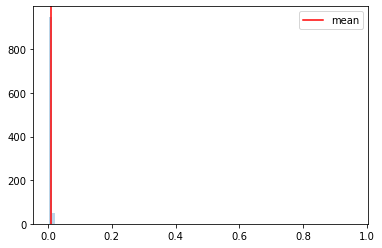

  0%|▏                                                                                | 3/1000 [00:00<00:59, 16.62it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654384960
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 0.1, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3
Monte Carlo 4


  1%|▌                                                                                | 7/1000 [00:00<01:36, 10.26it/s]

Monte Carlo 5
Monte Carlo 6
Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:48,  9.15it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:48,  9.08it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:42,  9.66it/s]

Monte Carlo 13
Monte Carlo 14
Monte Carlo 15


  2%|█▍                                                                              | 18/1000 [00:01<01:39,  9.90it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:01<01:41,  9.62it/s]

Monte Carlo 18
Monte Carlo 19
Monte Carlo 20

  2%|█▋                                                                              | 21/1000 [00:02<01:42,  9.56it/s]


Monte Carlo 21


  2%|█▊                                                                              | 23/1000 [00:02<01:40,  9.68it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:02<01:41,  9.59it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:02<01:43,  9.41it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<01:49,  8.84it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:01,  7.95it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:03<01:57,  8.24it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▉                                                                             | 36/1000 [00:03<01:48,  8.90it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:03<01:46,  9.08it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<01:51,  8.61it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<01:48,  8.87it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:04<01:56,  8.22it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:16,  6.98it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:03,  7.72it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:05<01:54,  8.30it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:05<01:59,  7.97it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<01:55,  8.17it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<01:52,  8.40it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:06<01:53,  8.34it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:06<01:53,  8.30it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:06<01:54,  8.23it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<01:57,  8.00it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<01:57,  7.98it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:07<01:53,  8.25it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:07<01:51,  8.33it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<01:59,  7.77it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<01:55,  8.01it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:08<01:57,  7.87it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<01:59,  7.74it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<01:55,  7.97it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:09<02:00,  7.65it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:09<01:59,  7.70it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<01:59,  7.65it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<01:56,  7.84it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:10<02:04,  7.33it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:10<02:07,  7.15it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:04,  7.26it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<01:59,  7.56it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:11<02:01,  7.45it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:11<02:00,  7.49it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:03,  7.27it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:12<02:04,  7.19it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:12<02:11,  6.82it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:11,  6.78it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:04,  7.17it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:13<02:05,  7.07it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:13<02:01,  7.32it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:01,  7.30it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:14<02:03,  7.13it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:14<02:10,  6.74it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:15,  6.46it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:15<02:12,  6.62it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:15<02:08,  6.81it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:10,  6.71it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:12,  6.55it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:16<02:18,  6.29it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:17,  6.32it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<02:11,  6.58it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:17<02:18,  6.22it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:17<02:15,  6.36it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:16,  6.30it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:18<02:16,  6.29it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:18<02:11,  6.49it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:15,  6.31it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:19<02:17,  6.19it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:19<02:21,  5.98it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:27,  5.73it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:20<02:32,  5.55it/s]

Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:20<02:31,  5.55it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:21<02:27,  5.71it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:21<02:26,  5.74it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:21<02:24,  5.79it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:22<02:26,  5.71it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:22<02:25,  5.73it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:28,  5.63it/s]

Monte Carlo 167


 17%|█████████████▎                                                                 | 168/1000 [00:22<02:31,  5.50it/s]

Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:23<02:54,  4.75it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:23<02:49,  4.90it/s]

Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:44,  5.03it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:41,  5.09it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:48,  4.88it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:49,  4.85it/s]

Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:48,  4.86it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:46,  4.91it/s]

Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:42,  5.03it/s]

Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:44,  4.97it/s]

Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:26<02:44,  4.96it/s]

Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:43,  4.99it/s]

Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:43,  4.98it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▋                                                                | 186/1000 [00:26<02:44,  4.93it/s]

Monte Carlo 186


 19%|██████████████▊                                                                | 187/1000 [00:26<02:54,  4.67it/s]

Monte Carlo 187


 19%|██████████████▊                                                                | 188/1000 [00:27<03:11,  4.24it/s]

Monte Carlo 188


 19%|█████████████▉                                                            | 189/1000 [31:27<125:45:09, 558.21s/it]

Monte Carlo 189


 19%|██████████████▎                                                            | 191/1000 [31:27<61:29:22, 273.63s/it]

Monte Carlo 190
Monte Carlo 191


 19%|██████████████▍                                                            | 193/1000 [31:28<30:04:32, 134.17s/it]

Monte Carlo 192
Monte Carlo 193


 20%|██████████████▊                                                             | 195/1000 [31:28<14:43:22, 65.84s/it]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▏                                                             | 197/1000 [31:28<7:12:49, 32.34s/it]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▎                                                             | 199/1000 [31:29<3:32:39, 15.93s/it]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▍                                                             | 200/1000 [31:29<2:29:29, 11.21s/it]

Monte Carlo 200


 20%|███████████████▌                                                             | 202/1000 [31:29<1:14:18,  5.59s/it]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [31:30<37:37,  2.84s/it]

Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [31:30<27:06,  2.05s/it]

Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [31:30<19:40,  1.49s/it]

Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [31:30<14:33,  1.10s/it]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [31:30<10:52,  1.21it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [31:31<06:27,  2.04it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [31:31<04:25,  2.97it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [31:31<03:25,  3.82it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [31:32<03:10,  4.13it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [31:32<02:58,  4.39it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [31:32<02:48,  4.65it/s]

Monte Carlo 216
Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [31:32<02:41,  4.84it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [31:33<02:24,  5.38it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [31:33<02:23,  5.41it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [31:33<02:27,  5.25it/s]

Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [31:34<02:23,  5.41it/s]

Monte Carlo 224
Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [31:34<02:14,  5.75it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [31:34<02:09,  5.94it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [31:35<02:09,  5.94it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [31:35<02:17,  5.60it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [31:35<02:09,  5.92it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [31:35<02:08,  5.93it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▋                                                            | 237/1000 [31:36<02:06,  6.01it/s]

Monte Carlo 237


 24%|██████████████████▊                                                            | 238/1000 [31:36<02:30,  5.06it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 239/1000 [31:36<03:11,  3.97it/s]

Monte Carlo 239


 24%|██████████████████▉                                                            | 240/1000 [31:36<03:00,  4.20it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 241/1000 [31:37<03:01,  4.18it/s]

Monte Carlo 241


 24%|███████████████████                                                            | 242/1000 [31:37<03:08,  4.03it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [31:37<02:54,  4.34it/s]

Monte Carlo 243
Monte Carlo 244


 24%|████████████████▋                                                   | 245/1000 [13:02:36<2834:57:14, 13517.66s/it]

Monte Carlo 245


 25%|████████████████▉                                                    | 246/1000 [13:02:36<1981:52:44, 9462.55s/it]

Monte Carlo 246


 25%|█████████████████                                                    | 247/1000 [13:02:37<1385:29:52, 6623.89s/it]

Monte Carlo 247


 25%|█████████████████▎                                                    | 248/1000 [13:02:37<968:34:46, 4636.82s/it]

Monte Carlo 248


 25%|█████████████████▍                                                    | 249/1000 [13:02:37<677:07:43, 3245.89s/it]

Monte Carlo 249


 25%|█████████████████▌                                                    | 250/1000 [13:02:38<473:23:38, 2272.29s/it]

Monte Carlo 250


 25%|█████████████████▌                                                    | 251/1000 [13:02:38<330:57:14, 1590.70s/it]

Monte Carlo 251


 25%|█████████████████▋                                                    | 252/1000 [13:02:39<231:23:23, 1113.64s/it]

Monte Carlo 252


 25%|█████████████████▉                                                     | 253/1000 [13:02:39<161:46:57, 779.68s/it]

Monte Carlo 253


 25%|██████████████████                                                     | 254/1000 [13:02:40<113:07:20, 545.90s/it]

Monte Carlo 254


 26%|██████████████████▎                                                     | 255/1000 [13:02:40<79:06:11, 382.24s/it]

Monte Carlo 255


 26%|██████████████████▍                                                     | 256/1000 [13:02:40<55:19:06, 267.67s/it]

Monte Carlo 256


 26%|██████████████████▌                                                     | 257/1000 [13:02:41<38:41:29, 187.47s/it]

Monte Carlo 257


 26%|██████████████████▌                                                     | 258/1000 [13:02:41<27:03:57, 131.32s/it]

Monte Carlo 258


 26%|██████████████████▉                                                      | 259/1000 [13:02:41<18:56:21, 92.01s/it]

Monte Carlo 259


 26%|██████████████████▉                                                      | 260/1000 [13:02:42<13:15:23, 64.49s/it]

Monte Carlo 260


 26%|███████████████████▎                                                      | 261/1000 [13:02:42<9:17:01, 45.23s/it]

Monte Carlo 261


 26%|███████████████████▍                                                      | 262/1000 [13:02:42<6:30:10, 31.72s/it]

Monte Carlo 262


 26%|███████████████████▍                                                      | 263/1000 [13:02:42<4:33:31, 22.27s/it]

Monte Carlo 263


 26%|███████████████████▌                                                      | 264/1000 [13:02:42<3:12:00, 15.65s/it]

Monte Carlo 264


 26%|███████████████████▌                                                      | 265/1000 [13:02:43<2:15:00, 11.02s/it]

Monte Carlo 265


 27%|███████████████████▊                                                      | 267/1000 [13:02:43<1:07:12,  5.50s/it]

Monte Carlo 266


 27%|████████████████████▎                                                       | 268/1000 [13:02:43<47:37,  3.90s/it]

Monte Carlo 267
Monte Carlo 268


 27%|████████████████████▌                                                       | 270/1000 [13:02:44<24:30,  2.01s/it]

Monte Carlo 269
Monte Carlo 270


 27%|████████████████████▋                                                       | 272/1000 [13:02:44<13:13,  1.09s/it]

Monte Carlo 271
Monte Carlo 272


 27%|████████████████████▋                                                       | 273/1000 [13:02:44<09:57,  1.22it/s]

Monte Carlo 273


 27%|████████████████████▊                                                       | 274/1000 [13:02:44<07:50,  1.54it/s]

Monte Carlo 274


 28%|████████████████████▉                                                       | 276/1000 [13:02:45<05:07,  2.35it/s]

Monte Carlo 275


 28%|█████████████████████                                                       | 277/1000 [13:02:45<04:16,  2.82it/s]

Monte Carlo 276


 28%|█████████████████████▏                                                      | 278/1000 [13:02:45<03:41,  3.26it/s]

Monte Carlo 277


 28%|█████████████████████▏                                                      | 279/1000 [13:02:45<03:17,  3.64it/s]

Monte Carlo 278
Monte Carlo 279


 28%|█████████████████████▎                                                      | 280/1000 [13:02:46<03:14,  3.70it/s]

Monte Carlo 280


 28%|█████████████████████▎                                                      | 281/1000 [13:02:46<03:36,  3.33it/s]

Monte Carlo 281


 28%|█████████████████████▍                                                      | 282/1000 [13:02:46<03:25,  3.49it/s]

Monte Carlo 282


 28%|█████████████████████▌                                                      | 283/1000 [13:02:47<03:12,  3.72it/s]

Monte Carlo 283


 28%|█████████████████████▌                                                      | 284/1000 [13:02:47<03:12,  3.72it/s]

Monte Carlo 284


 28%|█████████████████████▋                                                      | 285/1000 [13:02:47<03:12,  3.72it/s]

Monte Carlo 285


 29%|█████████████████████▊                                                      | 287/1000 [13:02:48<03:01,  3.92it/s]

Monte Carlo 286
Monte Carlo 287


 29%|█████████████████████▉                                                      | 288/1000 [13:02:48<02:57,  4.01it/s]

Monte Carlo 288


 29%|█████████████████████▉                                                      | 289/1000 [13:02:48<02:58,  3.99it/s]

Monte Carlo 289


 29%|██████████████████████                                                      | 290/1000 [13:02:48<02:54,  4.07it/s]

Monte Carlo 290


 29%|██████████████████████                                                      | 291/1000 [13:02:49<03:06,  3.80it/s]

Monte Carlo 291


 29%|██████████████████████▏                                                     | 292/1000 [13:02:49<03:23,  3.48it/s]

Monte Carlo 292


 29%|██████████████████████▎                                                     | 293/1000 [13:02:49<03:18,  3.56it/s]

Monte Carlo 293


 29%|██████████████████████▎                                                     | 294/1000 [13:02:50<03:11,  3.69it/s]

Monte Carlo 294


 30%|██████████████████████▍                                                     | 295/1000 [13:02:50<03:20,  3.51it/s]

Monte Carlo 295


 30%|██████████████████████▍                                                     | 296/1000 [13:02:50<03:15,  3.60it/s]

Monte Carlo 296


 30%|██████████████████████▌                                                     | 297/1000 [13:02:50<03:10,  3.69it/s]

Monte Carlo 297


 30%|██████████████████████▋                                                     | 298/1000 [13:02:51<03:03,  3.82it/s]

Monte Carlo 298


 30%|██████████████████████▋                                                     | 299/1000 [13:02:51<02:59,  3.89it/s]

Monte Carlo 299


 30%|██████████████████████▊                                                     | 300/1000 [13:02:51<03:28,  3.36it/s]

Monte Carlo 300


 30%|██████████████████████▉                                                     | 301/1000 [13:02:51<03:11,  3.65it/s]

Monte Carlo 301


 30%|███████████████████████                                                     | 303/1000 [13:02:52<02:50,  4.08it/s]

Monte Carlo 302


 30%|███████████████████████                                                     | 304/1000 [13:02:52<02:42,  4.29it/s]

Monte Carlo 303
Monte Carlo 304


 30%|███████████████████████▏                                                    | 305/1000 [13:02:52<02:45,  4.21it/s]

Monte Carlo 305


 31%|███████████████████████▎                                                    | 306/1000 [13:02:53<02:47,  4.14it/s]

Monte Carlo 306


 31%|███████████████████████▎                                                    | 307/1000 [13:02:53<02:49,  4.10it/s]

Monte Carlo 307


 31%|███████████████████████▍                                                    | 308/1000 [13:02:53<02:50,  4.06it/s]

Monte Carlo 308


 31%|███████████████████████▌                                                    | 310/1000 [13:02:54<02:37,  4.38it/s]

Monte Carlo 309
Monte Carlo 310


 31%|███████████████████████▋                                                    | 311/1000 [13:02:54<02:44,  4.20it/s]

Monte Carlo 311


 31%|███████████████████████▋                                                    | 312/1000 [13:02:54<02:42,  4.23it/s]

Monte Carlo 312


 31%|███████████████████████▊                                                    | 314/1000 [13:02:54<02:36,  4.39it/s]

Monte Carlo 313
Monte Carlo 314


 32%|███████████████████████▉                                                    | 315/1000 [13:02:55<02:38,  4.32it/s]

Monte Carlo 315


 32%|████████████████████████                                                    | 316/1000 [13:02:55<02:39,  4.29it/s]

Monte Carlo 316


 32%|████████████████████████                                                    | 317/1000 [13:02:55<02:38,  4.32it/s]

Monte Carlo 317


 32%|████████████████████████▏                                                   | 318/1000 [13:02:55<02:41,  4.22it/s]

Monte Carlo 318


 32%|████████████████████████▎                                                   | 320/1000 [13:02:56<02:38,  4.30it/s]

Monte Carlo 319
Monte Carlo 320


 32%|████████████████████████▍                                                   | 321/1000 [13:02:56<02:39,  4.25it/s]

Monte Carlo 321


 32%|████████████████████████▌                                                   | 323/1000 [13:02:57<02:36,  4.32it/s]

Monte Carlo 322


 32%|████████████████████████▌                                                   | 324/1000 [13:02:57<02:29,  4.52it/s]

Monte Carlo 323
Monte Carlo 324


 32%|████████████████████████▋                                                   | 325/1000 [13:02:57<02:27,  4.56it/s]

Monte Carlo 325


 33%|████████████████████████▊                                                   | 327/1000 [13:02:57<02:25,  4.63it/s]

Monte Carlo 326
Monte Carlo 327


 33%|████████████████████████▉                                                   | 328/1000 [13:02:58<02:26,  4.58it/s]

Monte Carlo 328


 33%|█████████████████████████                                                   | 329/1000 [13:02:58<02:32,  4.40it/s]

Monte Carlo 329


 33%|█████████████████████████                                                   | 330/1000 [13:02:58<02:30,  4.45it/s]

Monte Carlo 330


 33%|█████████████████████████▏                                                  | 331/1000 [13:02:58<02:34,  4.34it/s]

Monte Carlo 331


 33%|█████████████████████████▏                                                  | 332/1000 [13:02:59<02:38,  4.21it/s]

Monte Carlo 332


 33%|█████████████████████████▎                                                  | 333/1000 [13:02:59<02:40,  4.16it/s]

Monte Carlo 333


 33%|█████████████████████████▍                                                  | 334/1000 [13:02:59<02:36,  4.26it/s]

Monte Carlo 334


 34%|█████████████████████████▍                                                  | 335/1000 [13:02:59<02:31,  4.40it/s]

Monte Carlo 335


 34%|█████████████████████████▌                                                  | 336/1000 [13:03:00<02:29,  4.43it/s]

Monte Carlo 336


 34%|█████████████████████████▌                                                  | 337/1000 [13:03:00<02:28,  4.47it/s]

Monte Carlo 337


 34%|█████████████████████████▋                                                  | 338/1000 [13:03:00<02:31,  4.37it/s]

Monte Carlo 338


 34%|█████████████████████████▊                                                  | 339/1000 [13:03:00<02:30,  4.38it/s]

Monte Carlo 339


 34%|█████████████████████████▊                                                  | 340/1000 [13:03:00<02:26,  4.50it/s]

Monte Carlo 340


 34%|█████████████████████████▉                                                  | 341/1000 [13:03:01<02:34,  4.26it/s]

Monte Carlo 341


 34%|█████████████████████████▉                                                  | 342/1000 [13:03:01<02:34,  4.26it/s]

Monte Carlo 342


 34%|██████████████████████████                                                  | 343/1000 [13:03:01<02:32,  4.30it/s]

Monte Carlo 343


 34%|██████████████████████████▏                                                 | 344/1000 [13:03:01<02:31,  4.34it/s]

Monte Carlo 344


 34%|██████████████████████████▏                                                 | 345/1000 [13:03:02<02:28,  4.42it/s]

Monte Carlo 345


 35%|██████████████████████████▎                                                 | 346/1000 [13:03:02<02:31,  4.31it/s]

Monte Carlo 346


 35%|██████████████████████████▎                                                 | 347/1000 [13:03:02<02:25,  4.50it/s]

Monte Carlo 347


 35%|██████████████████████████▍                                                 | 348/1000 [13:03:02<02:33,  4.26it/s]

Monte Carlo 348


 35%|██████████████████████████▌                                                 | 349/1000 [13:03:03<02:39,  4.07it/s]

Monte Carlo 349


 35%|██████████████████████████▌                                                 | 350/1000 [13:03:03<02:37,  4.13it/s]

Monte Carlo 350


 35%|██████████████████████████▊                                                 | 352/1000 [13:03:03<02:24,  4.50it/s]

Monte Carlo 351
Monte Carlo 352


 35%|██████████████████████████▊                                                 | 353/1000 [13:03:03<02:23,  4.50it/s]

Monte Carlo 353


 35%|██████████████████████████▉                                                 | 354/1000 [13:03:04<02:39,  4.05it/s]

Monte Carlo 354


 36%|██████████████████████████▉                                                 | 355/1000 [13:03:04<02:39,  4.04it/s]

Monte Carlo 355


 36%|███████████████████████████                                                 | 356/1000 [13:03:04<02:37,  4.09it/s]

Monte Carlo 356


 36%|███████████████████████████▏                                                | 357/1000 [13:03:04<02:42,  3.96it/s]

Monte Carlo 357


 36%|███████████████████████████▏                                                | 358/1000 [13:03:05<02:49,  3.80it/s]

Monte Carlo 358


 36%|███████████████████████████▎                                                | 359/1000 [13:03:05<02:49,  3.78it/s]

Monte Carlo 359


 36%|███████████████████████████▎                                                | 360/1000 [13:03:05<02:48,  3.79it/s]

Monte Carlo 360


 36%|███████████████████████████▍                                                | 361/1000 [13:03:06<02:48,  3.79it/s]

Monte Carlo 361


 36%|███████████████████████████▌                                                | 362/1000 [13:03:06<02:44,  3.89it/s]

Monte Carlo 362


 36%|███████████████████████████▌                                                | 363/1000 [13:03:06<02:37,  4.03it/s]

Monte Carlo 363


 36%|███████████████████████████▋                                                | 364/1000 [13:03:06<02:34,  4.12it/s]

Monte Carlo 364


 36%|███████████████████████████▋                                                | 365/1000 [13:03:07<02:32,  4.16it/s]

Monte Carlo 365


 37%|███████████████████████████▊                                                | 366/1000 [13:03:07<02:34,  4.10it/s]

Monte Carlo 366


 37%|███████████████████████████▉                                                | 367/1000 [13:03:07<02:33,  4.14it/s]

Monte Carlo 367


 37%|███████████████████████████▉                                                | 368/1000 [13:03:07<02:31,  4.18it/s]

Monte Carlo 368


 37%|████████████████████████████                                                | 369/1000 [13:03:07<02:24,  4.35it/s]

Monte Carlo 369


 37%|████████████████████████████                                                | 370/1000 [13:03:08<02:29,  4.21it/s]

Monte Carlo 370


 37%|████████████████████████████▏                                               | 371/1000 [13:03:08<02:30,  4.18it/s]

Monte Carlo 371


 37%|████████████████████████████▎                                               | 372/1000 [13:03:08<02:35,  4.03it/s]

Monte Carlo 372


 37%|████████████████████████████▎                                               | 373/1000 [13:03:08<02:39,  3.94it/s]

Monte Carlo 373


 37%|████████████████████████████▍                                               | 374/1000 [13:03:09<02:33,  4.08it/s]

Monte Carlo 374


 38%|████████████████████████████▌                                               | 375/1000 [13:03:09<02:35,  4.02it/s]

Monte Carlo 375


 38%|████████████████████████████▌                                               | 376/1000 [13:03:09<02:38,  3.95it/s]

Monte Carlo 376


 38%|████████████████████████████▋                                               | 377/1000 [13:03:09<02:38,  3.94it/s]

Monte Carlo 377


 38%|████████████████████████████▋                                               | 378/1000 [13:03:10<02:36,  3.98it/s]

Monte Carlo 378


 38%|████████████████████████████▊                                               | 379/1000 [13:03:10<02:32,  4.08it/s]

Monte Carlo 379


 38%|████████████████████████████▉                                               | 380/1000 [13:03:10<02:32,  4.07it/s]

Monte Carlo 380


 38%|████████████████████████████▉                                               | 381/1000 [13:03:10<02:27,  4.19it/s]

Monte Carlo 381


 38%|█████████████████████████████                                               | 382/1000 [13:03:11<02:27,  4.18it/s]

Monte Carlo 382


 38%|█████████████████████████████                                               | 383/1000 [13:03:11<02:26,  4.20it/s]

Monte Carlo 383


 38%|█████████████████████████████▏                                              | 384/1000 [13:03:11<02:31,  4.06it/s]

Monte Carlo 384


 38%|█████████████████████████████▎                                              | 385/1000 [13:03:11<02:34,  3.98it/s]

Monte Carlo 385


 39%|█████████████████████████████▎                                              | 386/1000 [13:03:12<02:38,  3.86it/s]

Monte Carlo 386


 39%|█████████████████████████████▍                                              | 387/1000 [13:03:12<02:39,  3.84it/s]

Monte Carlo 387


 39%|█████████████████████████████▍                                              | 388/1000 [13:03:12<02:41,  3.80it/s]

Monte Carlo 388


 39%|█████████████████████████████▌                                              | 389/1000 [13:03:12<02:35,  3.93it/s]

Monte Carlo 389


 39%|█████████████████████████████▋                                              | 390/1000 [13:03:13<02:42,  3.75it/s]

Monte Carlo 390


 39%|█████████████████████████████▋                                              | 391/1000 [13:03:13<02:35,  3.92it/s]

Monte Carlo 391


 39%|█████████████████████████████▊                                              | 392/1000 [13:03:13<02:32,  3.98it/s]

Monte Carlo 392


 39%|█████████████████████████████▊                                              | 393/1000 [13:03:13<02:34,  3.93it/s]

Monte Carlo 393


 39%|█████████████████████████████▉                                              | 394/1000 [13:03:14<02:34,  3.93it/s]

Monte Carlo 394


 40%|██████████████████████████████                                              | 395/1000 [13:03:14<02:36,  3.87it/s]

Monte Carlo 395


 40%|██████████████████████████████                                              | 396/1000 [13:03:14<02:31,  3.98it/s]

Monte Carlo 396


 40%|██████████████████████████████▏                                             | 397/1000 [13:03:14<02:28,  4.06it/s]

Monte Carlo 397


 40%|██████████████████████████████▏                                             | 398/1000 [13:03:15<02:31,  3.99it/s]

Monte Carlo 398


 40%|██████████████████████████████▎                                             | 399/1000 [13:03:15<02:32,  3.94it/s]

Monte Carlo 399


 40%|██████████████████████████████▍                                             | 400/1000 [13:03:15<02:31,  3.96it/s]

Monte Carlo 400


 40%|██████████████████████████████▍                                             | 401/1000 [13:03:16<02:36,  3.83it/s]

Monte Carlo 401


 40%|██████████████████████████████▌                                             | 402/1000 [13:03:16<02:40,  3.73it/s]

Monte Carlo 402


 40%|██████████████████████████████▋                                             | 403/1000 [13:03:16<02:41,  3.70it/s]

Monte Carlo 403


 40%|██████████████████████████████▋                                             | 404/1000 [13:03:16<02:52,  3.45it/s]

Monte Carlo 404


 40%|██████████████████████████████▊                                             | 405/1000 [13:03:17<03:03,  3.25it/s]

Monte Carlo 405


 41%|██████████████████████████████▊                                             | 406/1000 [13:03:17<03:11,  3.10it/s]

Monte Carlo 406


 41%|██████████████████████████████▉                                             | 407/1000 [13:03:17<03:10,  3.11it/s]

Monte Carlo 407


 41%|███████████████████████████████                                             | 408/1000 [13:03:18<03:13,  3.05it/s]

Monte Carlo 408


 41%|███████████████████████████████                                             | 409/1000 [13:03:18<03:11,  3.09it/s]

Monte Carlo 409


 41%|███████████████████████████████▏                                            | 410/1000 [13:03:18<03:02,  3.23it/s]

Monte Carlo 410


 41%|███████████████████████████████▏                                            | 411/1000 [13:03:19<02:49,  3.47it/s]

Monte Carlo 411


 41%|███████████████████████████████▎                                            | 412/1000 [13:03:19<02:41,  3.65it/s]

Monte Carlo 412


 41%|███████████████████████████████▍                                            | 413/1000 [13:03:19<02:35,  3.79it/s]

Monte Carlo 413


 41%|███████████████████████████████▍                                            | 414/1000 [13:03:19<02:39,  3.67it/s]

Monte Carlo 414


 42%|███████████████████████████████▌                                            | 415/1000 [13:03:20<02:38,  3.70it/s]

Monte Carlo 415


 42%|███████████████████████████████▌                                            | 416/1000 [13:03:20<02:38,  3.67it/s]

Monte Carlo 416


 42%|███████████████████████████████▋                                            | 417/1000 [13:03:20<02:44,  3.55it/s]

Monte Carlo 417


 42%|███████████████████████████████▊                                            | 418/1000 [13:03:21<03:06,  3.11it/s]

Monte Carlo 418


 42%|███████████████████████████████▊                                            | 419/1000 [13:03:21<03:02,  3.18it/s]

Monte Carlo 419


 42%|███████████████████████████████▉                                            | 420/1000 [13:03:21<02:59,  3.24it/s]

Monte Carlo 420


 42%|███████████████████████████████▉                                            | 421/1000 [13:03:22<02:56,  3.27it/s]

Monte Carlo 421


 42%|████████████████████████████████                                            | 422/1000 [13:03:22<02:50,  3.38it/s]

Monte Carlo 422


 42%|████████████████████████████████▏                                           | 423/1000 [13:03:22<02:50,  3.38it/s]

Monte Carlo 423


 42%|████████████████████████████████▏                                           | 424/1000 [13:03:22<02:45,  3.48it/s]

Monte Carlo 424


 42%|████████████████████████████████▎                                           | 425/1000 [13:03:23<02:38,  3.63it/s]

Monte Carlo 425


 43%|████████████████████████████████▍                                           | 426/1000 [13:03:23<02:31,  3.78it/s]

Monte Carlo 426


 43%|████████████████████████████████▍                                           | 427/1000 [13:03:23<02:34,  3.72it/s]

Monte Carlo 427


 43%|████████████████████████████████▌                                           | 428/1000 [13:03:23<02:35,  3.68it/s]

Monte Carlo 428


 43%|████████████████████████████████▌                                           | 429/1000 [13:03:24<02:33,  3.72it/s]

Monte Carlo 429


 43%|████████████████████████████████▋                                           | 430/1000 [13:03:24<02:36,  3.65it/s]

Monte Carlo 430


 43%|████████████████████████████████▊                                           | 431/1000 [13:03:24<02:26,  3.87it/s]

Monte Carlo 431


 43%|████████████████████████████████▊                                           | 432/1000 [13:03:24<02:23,  3.95it/s]

Monte Carlo 432


 43%|████████████████████████████████▉                                           | 433/1000 [13:03:25<02:21,  4.01it/s]

Monte Carlo 433


 43%|████████████████████████████████▉                                           | 434/1000 [13:03:25<02:31,  3.73it/s]

Monte Carlo 434


 44%|█████████████████████████████████                                           | 435/1000 [13:03:25<02:37,  3.58it/s]

Monte Carlo 435


 44%|█████████████████████████████████▏                                          | 436/1000 [13:03:26<02:39,  3.55it/s]

Monte Carlo 436


 44%|█████████████████████████████████▏                                          | 437/1000 [13:03:26<02:39,  3.54it/s]

Monte Carlo 437


 44%|█████████████████████████████████▎                                          | 438/1000 [13:03:26<02:42,  3.46it/s]

Monte Carlo 438


 44%|█████████████████████████████████▎                                          | 439/1000 [13:03:26<02:35,  3.60it/s]

Monte Carlo 439


 44%|█████████████████████████████████▍                                          | 440/1000 [13:03:27<02:33,  3.65it/s]

Monte Carlo 440


 44%|█████████████████████████████████▌                                          | 441/1000 [13:03:27<02:31,  3.70it/s]

Monte Carlo 441


 44%|█████████████████████████████████▌                                          | 442/1000 [13:03:27<02:26,  3.80it/s]

Monte Carlo 442


 44%|█████████████████████████████████▋                                          | 443/1000 [13:03:27<02:26,  3.79it/s]

Monte Carlo 443


 44%|█████████████████████████████████▋                                          | 444/1000 [13:03:28<02:29,  3.71it/s]

Monte Carlo 444


 44%|█████████████████████████████████▊                                          | 445/1000 [13:03:28<02:26,  3.79it/s]

Monte Carlo 445


 45%|█████████████████████████████████▉                                          | 446/1000 [13:03:28<02:26,  3.78it/s]

Monte Carlo 446


 45%|█████████████████████████████████▉                                          | 447/1000 [13:03:29<02:25,  3.80it/s]

Monte Carlo 447


 45%|██████████████████████████████████                                          | 448/1000 [13:03:29<02:28,  3.72it/s]

Monte Carlo 448


 45%|██████████████████████████████████                                          | 449/1000 [13:03:29<02:28,  3.70it/s]

Monte Carlo 449


 45%|██████████████████████████████████▏                                         | 450/1000 [13:03:29<02:28,  3.70it/s]

Monte Carlo 450


 45%|██████████████████████████████████▎                                         | 451/1000 [13:03:30<02:27,  3.73it/s]

Monte Carlo 451


 45%|██████████████████████████████████▎                                         | 452/1000 [13:03:30<02:25,  3.76it/s]

Monte Carlo 452


 45%|██████████████████████████████████▍                                         | 453/1000 [13:03:30<02:24,  3.78it/s]

Monte Carlo 453


 45%|██████████████████████████████████▌                                         | 454/1000 [13:03:30<02:29,  3.66it/s]

Monte Carlo 454


 46%|██████████████████████████████████▌                                         | 455/1000 [13:03:31<02:28,  3.66it/s]

Monte Carlo 455


 46%|██████████████████████████████████▋                                         | 456/1000 [13:03:31<02:32,  3.58it/s]

Monte Carlo 456


 46%|██████████████████████████████████▋                                         | 457/1000 [13:03:31<02:38,  3.42it/s]

Monte Carlo 457


 46%|██████████████████████████████████▊                                         | 458/1000 [13:03:32<02:43,  3.31it/s]

Monte Carlo 458


 46%|██████████████████████████████████▉                                         | 459/1000 [13:03:32<02:49,  3.18it/s]

Monte Carlo 459


 46%|██████████████████████████████████▉                                         | 460/1000 [13:03:32<02:55,  3.07it/s]

Monte Carlo 460


 46%|███████████████████████████████████                                         | 461/1000 [13:03:33<02:47,  3.22it/s]

Monte Carlo 461


 46%|███████████████████████████████████                                         | 462/1000 [13:03:33<02:43,  3.29it/s]

Monte Carlo 462


 46%|███████████████████████████████████▏                                        | 463/1000 [13:03:33<02:43,  3.29it/s]

Monte Carlo 463


 46%|███████████████████████████████████▎                                        | 464/1000 [13:03:33<02:38,  3.38it/s]

Monte Carlo 464


 46%|███████████████████████████████████▎                                        | 465/1000 [13:03:34<02:34,  3.47it/s]

Monte Carlo 465


 47%|███████████████████████████████████▍                                        | 466/1000 [13:03:34<02:31,  3.53it/s]

Monte Carlo 466


 47%|███████████████████████████████████▍                                        | 467/1000 [13:03:34<02:32,  3.49it/s]

Monte Carlo 467


 47%|███████████████████████████████████▌                                        | 468/1000 [13:03:35<02:45,  3.21it/s]

Monte Carlo 468


 47%|███████████████████████████████████▋                                        | 469/1000 [13:03:35<02:42,  3.27it/s]

Monte Carlo 469


 47%|███████████████████████████████████▋                                        | 470/1000 [13:03:35<02:50,  3.11it/s]

Monte Carlo 470


 47%|███████████████████████████████████▊                                        | 471/1000 [13:03:36<02:57,  2.98it/s]

Monte Carlo 471


 47%|███████████████████████████████████▊                                        | 472/1000 [13:03:36<03:22,  2.61it/s]

Monte Carlo 472


 47%|███████████████████████████████████▉                                        | 473/1000 [13:03:37<03:21,  2.62it/s]

Monte Carlo 473


 47%|████████████████████████████████████                                        | 474/1000 [13:03:37<03:20,  2.63it/s]

Monte Carlo 474


 48%|████████████████████████████████████                                        | 475/1000 [13:03:37<03:16,  2.68it/s]

Monte Carlo 475


 48%|████████████████████████████████████▏                                       | 476/1000 [13:03:38<03:00,  2.91it/s]

Monte Carlo 476


 48%|████████████████████████████████████▎                                       | 477/1000 [13:03:38<02:51,  3.04it/s]

Monte Carlo 477


 48%|████████████████████████████████████▎                                       | 478/1000 [13:03:38<02:42,  3.21it/s]

Monte Carlo 478


 48%|████████████████████████████████████▍                                       | 479/1000 [13:03:38<02:40,  3.26it/s]

Monte Carlo 479


 48%|████████████████████████████████████▍                                       | 480/1000 [13:03:39<02:51,  3.02it/s]

Monte Carlo 480


 48%|████████████████████████████████████▌                                       | 481/1000 [13:03:39<02:59,  2.88it/s]

Monte Carlo 481


 48%|████████████████████████████████████▋                                       | 482/1000 [13:03:40<03:06,  2.77it/s]

Monte Carlo 482


 48%|████████████████████████████████████▋                                       | 483/1000 [13:03:40<03:11,  2.70it/s]

Monte Carlo 483


 48%|████████████████████████████████████▊                                       | 484/1000 [13:03:40<03:16,  2.63it/s]

Monte Carlo 484


 48%|████████████████████████████████████▊                                       | 485/1000 [13:03:41<03:15,  2.63it/s]

Monte Carlo 485


 49%|████████████████████████████████████▉                                       | 486/1000 [13:03:41<03:00,  2.85it/s]

Monte Carlo 486


 49%|█████████████████████████████████████                                       | 487/1000 [13:03:41<02:55,  2.93it/s]

Monte Carlo 487


 49%|█████████████████████████████████████                                       | 488/1000 [13:03:42<02:45,  3.10it/s]

Monte Carlo 488


 49%|█████████████████████████████████████▏                                      | 489/1000 [13:03:42<02:46,  3.07it/s]

Monte Carlo 489


 49%|█████████████████████████████████████▏                                      | 490/1000 [13:03:42<02:45,  3.07it/s]

Monte Carlo 490


 49%|█████████████████████████████████████▎                                      | 491/1000 [13:03:43<02:39,  3.18it/s]

Monte Carlo 491


 49%|█████████████████████████████████████▍                                      | 492/1000 [13:03:43<02:44,  3.10it/s]

Monte Carlo 492


 49%|█████████████████████████████████████▍                                      | 493/1000 [13:03:43<02:49,  3.00it/s]

Monte Carlo 493


 49%|█████████████████████████████████████▌                                      | 494/1000 [13:03:44<02:46,  3.04it/s]

Monte Carlo 494


 50%|█████████████████████████████████████▌                                      | 495/1000 [13:03:44<02:41,  3.12it/s]

Monte Carlo 495


 50%|█████████████████████████████████████▋                                      | 496/1000 [13:03:44<02:37,  3.19it/s]

Monte Carlo 496


 50%|█████████████████████████████████████▊                                      | 497/1000 [13:03:45<02:42,  3.10it/s]

Monte Carlo 497


 50%|█████████████████████████████████████▊                                      | 498/1000 [13:03:45<02:36,  3.20it/s]

Monte Carlo 498


 50%|█████████████████████████████████████▉                                      | 499/1000 [13:03:45<02:39,  3.14it/s]

Monte Carlo 499


 50%|██████████████████████████████████████                                      | 500/1000 [13:03:46<02:39,  3.13it/s]

Monte Carlo 500


 50%|██████████████████████████████████████                                      | 501/1000 [13:03:46<02:45,  3.02it/s]

Monte Carlo 501


 50%|██████████████████████████████████████▏                                     | 502/1000 [13:03:46<02:48,  2.95it/s]

Monte Carlo 502


 50%|██████████████████████████████████████▏                                     | 503/1000 [13:03:47<02:47,  2.97it/s]

Monte Carlo 503


 50%|██████████████████████████████████████▎                                     | 504/1000 [13:03:47<02:51,  2.89it/s]

Monte Carlo 504


 50%|██████████████████████████████████████▍                                     | 505/1000 [13:03:47<02:52,  2.88it/s]

Monte Carlo 505


 51%|██████████████████████████████████████▍                                     | 506/1000 [13:03:48<02:49,  2.91it/s]

Monte Carlo 506


 51%|██████████████████████████████████████▌                                     | 507/1000 [13:03:48<02:55,  2.82it/s]

Monte Carlo 507


 51%|██████████████████████████████████████▌                                     | 508/1000 [13:03:48<02:55,  2.80it/s]

Monte Carlo 508


 51%|██████████████████████████████████████▋                                     | 509/1000 [13:03:49<02:52,  2.84it/s]

Monte Carlo 509


 51%|██████████████████████████████████████▊                                     | 510/1000 [13:03:49<02:48,  2.91it/s]

Monte Carlo 510


 51%|██████████████████████████████████████▊                                     | 511/1000 [13:03:49<02:51,  2.85it/s]

Monte Carlo 511


 51%|██████████████████████████████████████▉                                     | 512/1000 [13:03:50<02:46,  2.93it/s]

Monte Carlo 512


 51%|██████████████████████████████████████▉                                     | 513/1000 [13:03:50<02:45,  2.94it/s]

Monte Carlo 513


 51%|███████████████████████████████████████                                     | 514/1000 [13:03:50<02:46,  2.93it/s]

Monte Carlo 514


 52%|███████████████████████████████████████▏                                    | 515/1000 [13:03:51<02:46,  2.91it/s]

Monte Carlo 515


 52%|███████████████████████████████████████▏                                    | 516/1000 [13:03:51<02:50,  2.83it/s]

Monte Carlo 516


 52%|███████████████████████████████████████▎                                    | 517/1000 [13:03:51<02:52,  2.81it/s]

Monte Carlo 517


 52%|███████████████████████████████████████▎                                    | 518/1000 [13:03:52<02:50,  2.83it/s]

Monte Carlo 518


 52%|███████████████████████████████████████▍                                    | 519/1000 [13:03:52<02:52,  2.79it/s]

Monte Carlo 519


 52%|███████████████████████████████████████▌                                    | 520/1000 [13:03:53<02:53,  2.77it/s]

Monte Carlo 520


 52%|███████████████████████████████████████▌                                    | 521/1000 [13:03:53<02:55,  2.73it/s]

Monte Carlo 521


 52%|███████████████████████████████████████▋                                    | 522/1000 [13:03:53<02:48,  2.83it/s]

Monte Carlo 522


 52%|███████████████████████████████████████▋                                    | 523/1000 [13:03:54<02:49,  2.82it/s]

Monte Carlo 523


 52%|███████████████████████████████████████▊                                    | 524/1000 [13:03:54<02:46,  2.85it/s]

Monte Carlo 524


 52%|███████████████████████████████████████▉                                    | 525/1000 [13:03:54<02:46,  2.85it/s]

Monte Carlo 525


 53%|███████████████████████████████████████▉                                    | 526/1000 [13:03:55<02:44,  2.89it/s]

Monte Carlo 526


 53%|████████████████████████████████████████                                    | 527/1000 [13:03:55<03:04,  2.56it/s]

Monte Carlo 527


 53%|████████████████████████████████████████▏                                   | 528/1000 [13:03:56<03:21,  2.34it/s]

Monte Carlo 528


 53%|████████████████████████████████████████▏                                   | 529/1000 [13:03:56<03:08,  2.50it/s]

Monte Carlo 529


 53%|████████████████████████████████████████▎                                   | 530/1000 [13:03:56<03:02,  2.57it/s]

Monte Carlo 530


 53%|████████████████████████████████████████▎                                   | 531/1000 [13:03:57<02:58,  2.63it/s]

Monte Carlo 531


 53%|████████████████████████████████████████▍                                   | 532/1000 [13:03:57<02:52,  2.71it/s]

Monte Carlo 532


 53%|████████████████████████████████████████▌                                   | 533/1000 [13:03:57<02:48,  2.78it/s]

Monte Carlo 533


 53%|████████████████████████████████████████▌                                   | 534/1000 [13:03:58<02:39,  2.92it/s]

Monte Carlo 534


 54%|████████████████████████████████████████▋                                   | 535/1000 [13:03:58<02:37,  2.95it/s]

Monte Carlo 535


 54%|████████████████████████████████████████▋                                   | 536/1000 [13:03:58<02:38,  2.92it/s]

Monte Carlo 536


 54%|████████████████████████████████████████▊                                   | 537/1000 [13:03:59<02:34,  2.99it/s]

Monte Carlo 537


 54%|████████████████████████████████████████▉                                   | 538/1000 [13:03:59<02:35,  2.96it/s]

Monte Carlo 538


 54%|████████████████████████████████████████▉                                   | 539/1000 [13:03:59<02:37,  2.93it/s]

Monte Carlo 539


 54%|█████████████████████████████████████████                                   | 540/1000 [13:04:00<02:37,  2.92it/s]

Monte Carlo 540


 54%|█████████████████████████████████████████                                   | 541/1000 [13:04:00<02:39,  2.88it/s]

Monte Carlo 541


 54%|█████████████████████████████████████████▏                                  | 542/1000 [13:04:00<02:41,  2.84it/s]

Monte Carlo 542


 54%|█████████████████████████████████████████▎                                  | 543/1000 [13:04:01<02:45,  2.75it/s]

Monte Carlo 543


 54%|█████████████████████████████████████████▎                                  | 544/1000 [13:04:01<02:40,  2.83it/s]

Monte Carlo 544


 55%|█████████████████████████████████████████▍                                  | 545/1000 [13:04:02<02:39,  2.85it/s]

Monte Carlo 545


 55%|█████████████████████████████████████████▍                                  | 546/1000 [13:04:02<02:38,  2.86it/s]

Monte Carlo 546


 55%|█████████████████████████████████████████▌                                  | 547/1000 [13:04:02<02:37,  2.88it/s]

Monte Carlo 547


 55%|█████████████████████████████████████████▋                                  | 548/1000 [13:04:03<02:36,  2.88it/s]

Monte Carlo 548


 55%|█████████████████████████████████████████▋                                  | 549/1000 [13:04:03<02:38,  2.85it/s]

Monte Carlo 549


 55%|█████████████████████████████████████████▊                                  | 550/1000 [13:04:03<02:35,  2.90it/s]

Monte Carlo 550


 55%|█████████████████████████████████████████▉                                  | 551/1000 [13:04:04<02:41,  2.78it/s]

Monte Carlo 551


 55%|█████████████████████████████████████████▉                                  | 552/1000 [13:04:04<02:40,  2.78it/s]

Monte Carlo 552


 55%|██████████████████████████████████████████                                  | 553/1000 [13:04:04<02:38,  2.82it/s]

Monte Carlo 553


 55%|██████████████████████████████████████████                                  | 554/1000 [13:04:05<02:36,  2.85it/s]

Monte Carlo 554


 56%|██████████████████████████████████████████▏                                 | 555/1000 [13:04:05<02:33,  2.90it/s]

Monte Carlo 555


 56%|██████████████████████████████████████████▎                                 | 556/1000 [13:04:05<02:39,  2.79it/s]

Monte Carlo 556


 56%|██████████████████████████████████████████▎                                 | 557/1000 [13:04:06<02:39,  2.79it/s]

Monte Carlo 557


 56%|██████████████████████████████████████████▍                                 | 558/1000 [13:04:06<02:49,  2.61it/s]

Monte Carlo 558


 56%|██████████████████████████████████████████▍                                 | 559/1000 [13:04:07<02:48,  2.61it/s]

Monte Carlo 559


 56%|██████████████████████████████████████████▌                                 | 560/1000 [13:04:07<02:49,  2.60it/s]

Monte Carlo 560


 56%|██████████████████████████████████████████▋                                 | 561/1000 [13:04:07<02:44,  2.66it/s]

Monte Carlo 561


 56%|██████████████████████████████████████████▋                                 | 562/1000 [13:04:08<02:45,  2.65it/s]

Monte Carlo 562


 56%|██████████████████████████████████████████▊                                 | 563/1000 [13:04:08<02:45,  2.63it/s]

Monte Carlo 563


 56%|██████████████████████████████████████████▊                                 | 564/1000 [13:04:09<02:49,  2.57it/s]

Monte Carlo 564


 56%|██████████████████████████████████████████▉                                 | 565/1000 [13:04:09<02:50,  2.54it/s]

Monte Carlo 565


 57%|███████████████████████████████████████████                                 | 566/1000 [13:04:09<02:48,  2.58it/s]

Monte Carlo 566


 57%|███████████████████████████████████████████                                 | 567/1000 [13:04:10<02:46,  2.59it/s]

Monte Carlo 567


 57%|███████████████████████████████████████████▏                                | 568/1000 [13:04:10<02:47,  2.59it/s]

Monte Carlo 568


 57%|███████████████████████████████████████████▏                                | 569/1000 [13:04:10<02:46,  2.59it/s]

Monte Carlo 569


 57%|███████████████████████████████████████████▎                                | 570/1000 [13:04:11<02:44,  2.61it/s]

Monte Carlo 570


 57%|███████████████████████████████████████████▍                                | 571/1000 [13:04:11<02:41,  2.66it/s]

Monte Carlo 571


 57%|███████████████████████████████████████████▍                                | 572/1000 [13:04:12<02:42,  2.64it/s]

Monte Carlo 572


 57%|███████████████████████████████████████████▌                                | 573/1000 [13:04:12<02:43,  2.61it/s]

Monte Carlo 573


 57%|███████████████████████████████████████████▌                                | 574/1000 [13:04:12<02:42,  2.62it/s]

Monte Carlo 574


 57%|███████████████████████████████████████████▋                                | 575/1000 [13:04:13<02:41,  2.62it/s]

Monte Carlo 575


 58%|███████████████████████████████████████████▊                                | 576/1000 [13:04:13<02:43,  2.59it/s]

Monte Carlo 576


 58%|███████████████████████████████████████████▊                                | 577/1000 [13:04:14<02:43,  2.59it/s]

Monte Carlo 577


 58%|███████████████████████████████████████████▉                                | 578/1000 [13:04:14<02:39,  2.64it/s]

Monte Carlo 578


 58%|████████████████████████████████████████████                                | 579/1000 [13:04:14<02:42,  2.59it/s]

Monte Carlo 579


 58%|████████████████████████████████████████████                                | 580/1000 [13:04:15<02:41,  2.60it/s]

Monte Carlo 580


 58%|████████████████████████████████████████████▏                               | 581/1000 [13:04:15<02:41,  2.60it/s]

Monte Carlo 581


 58%|████████████████████████████████████████████▏                               | 582/1000 [13:04:15<02:42,  2.58it/s]

Monte Carlo 582


 58%|████████████████████████████████████████████▎                               | 583/1000 [13:04:16<02:44,  2.54it/s]

Monte Carlo 583


 58%|████████████████████████████████████████████▍                               | 584/1000 [13:04:16<02:44,  2.52it/s]

Monte Carlo 584


 58%|████████████████████████████████████████████▍                               | 585/1000 [13:04:17<02:43,  2.53it/s]

Monte Carlo 585


 59%|████████████████████████████████████████████▌                               | 586/1000 [13:04:17<02:41,  2.57it/s]

Monte Carlo 586


 59%|████████████████████████████████████████████▌                               | 587/1000 [13:04:17<02:37,  2.62it/s]

Monte Carlo 587


 59%|████████████████████████████████████████████▋                               | 588/1000 [13:04:18<02:39,  2.58it/s]

Monte Carlo 588


 59%|████████████████████████████████████████████▊                               | 589/1000 [13:04:18<02:36,  2.63it/s]

Monte Carlo 589


 59%|████████████████████████████████████████████▊                               | 590/1000 [13:04:18<02:30,  2.72it/s]

Monte Carlo 590


 59%|████████████████████████████████████████████▉                               | 591/1000 [13:04:19<02:34,  2.65it/s]

Monte Carlo 591


 59%|████████████████████████████████████████████▉                               | 592/1000 [13:04:19<02:35,  2.63it/s]

Monte Carlo 592


 59%|█████████████████████████████████████████████                               | 593/1000 [13:04:20<02:31,  2.68it/s]

Monte Carlo 593


 59%|█████████████████████████████████████████████▏                              | 594/1000 [13:04:20<02:31,  2.69it/s]

Monte Carlo 594


 60%|█████████████████████████████████████████████▏                              | 595/1000 [13:04:20<02:27,  2.75it/s]

Monte Carlo 595


 60%|█████████████████████████████████████████████▎                              | 596/1000 [13:04:21<02:26,  2.77it/s]

Monte Carlo 596


 60%|█████████████████████████████████████████████▎                              | 597/1000 [13:04:21<02:19,  2.88it/s]

Monte Carlo 597


 60%|█████████████████████████████████████████████▍                              | 598/1000 [13:04:21<02:15,  2.97it/s]

Monte Carlo 598


 60%|█████████████████████████████████████████████▌                              | 599/1000 [13:04:22<02:16,  2.95it/s]

Monte Carlo 599


 60%|█████████████████████████████████████████████▌                              | 600/1000 [13:04:22<02:15,  2.94it/s]

Monte Carlo 600


 60%|█████████████████████████████████████████████▋                              | 601/1000 [13:04:22<02:18,  2.88it/s]

Monte Carlo 601


 60%|█████████████████████████████████████████████▊                              | 602/1000 [13:04:23<02:18,  2.88it/s]

Monte Carlo 602


 60%|█████████████████████████████████████████████▊                              | 603/1000 [13:04:23<02:15,  2.92it/s]

Monte Carlo 603


 60%|█████████████████████████████████████████████▉                              | 604/1000 [13:04:23<02:18,  2.85it/s]

Monte Carlo 604


 60%|█████████████████████████████████████████████▉                              | 605/1000 [13:04:24<02:19,  2.83it/s]

Monte Carlo 605


 61%|██████████████████████████████████████████████                              | 606/1000 [13:04:24<02:14,  2.93it/s]

Monte Carlo 606


 61%|██████████████████████████████████████████████▏                             | 607/1000 [13:04:24<02:14,  2.91it/s]

Monte Carlo 607


 61%|██████████████████████████████████████████████▏                             | 608/1000 [13:04:25<02:21,  2.77it/s]

Monte Carlo 608


 61%|██████████████████████████████████████████████▎                             | 609/1000 [13:04:25<02:21,  2.77it/s]

Monte Carlo 609


 61%|██████████████████████████████████████████████▎                             | 610/1000 [13:04:26<02:20,  2.77it/s]

Monte Carlo 610


 61%|██████████████████████████████████████████████▍                             | 611/1000 [13:04:26<02:14,  2.88it/s]

Monte Carlo 611


 61%|██████████████████████████████████████████████▌                             | 612/1000 [13:04:26<02:19,  2.78it/s]

Monte Carlo 612


 61%|██████████████████████████████████████████████▌                             | 613/1000 [13:04:27<02:25,  2.66it/s]

Monte Carlo 613


 61%|██████████████████████████████████████████████▋                             | 614/1000 [13:04:27<02:31,  2.54it/s]

Monte Carlo 614


 62%|██████████████████████████████████████████████▋                             | 615/1000 [13:04:28<02:34,  2.50it/s]

Monte Carlo 615


 62%|██████████████████████████████████████████████▊                             | 616/1000 [13:04:28<02:30,  2.54it/s]

Monte Carlo 616


 62%|██████████████████████████████████████████████▉                             | 617/1000 [13:04:28<02:32,  2.52it/s]

Monte Carlo 617


 62%|██████████████████████████████████████████████▉                             | 618/1000 [13:04:29<02:27,  2.58it/s]

Monte Carlo 618


 62%|███████████████████████████████████████████████                             | 619/1000 [13:04:29<02:32,  2.50it/s]

Monte Carlo 619


 62%|███████████████████████████████████████████████                             | 620/1000 [13:04:30<02:32,  2.49it/s]

Monte Carlo 620


 62%|███████████████████████████████████████████████▏                            | 621/1000 [13:04:30<02:29,  2.53it/s]

Monte Carlo 621


 62%|███████████████████████████████████████████████▎                            | 622/1000 [13:04:30<02:28,  2.55it/s]

Monte Carlo 622


 62%|███████████████████████████████████████████████▎                            | 623/1000 [13:04:31<02:23,  2.62it/s]

Monte Carlo 623


 62%|███████████████████████████████████████████████▍                            | 624/1000 [13:04:31<02:23,  2.63it/s]

Monte Carlo 624


 62%|███████████████████████████████████████████████▌                            | 625/1000 [13:04:31<02:17,  2.73it/s]

Monte Carlo 625


 63%|███████████████████████████████████████████████▌                            | 626/1000 [13:04:32<02:15,  2.77it/s]

Monte Carlo 626


 63%|███████████████████████████████████████████████▋                            | 627/1000 [13:04:32<02:18,  2.70it/s]

Monte Carlo 627


 63%|███████████████████████████████████████████████▋                            | 628/1000 [13:04:32<02:15,  2.75it/s]

Monte Carlo 628


 63%|███████████████████████████████████████████████▊                            | 629/1000 [13:04:33<02:13,  2.78it/s]

Monte Carlo 629


 63%|███████████████████████████████████████████████▉                            | 630/1000 [13:04:33<02:15,  2.72it/s]

Monte Carlo 630


 63%|███████████████████████████████████████████████▉                            | 631/1000 [13:04:34<02:17,  2.68it/s]

Monte Carlo 631


 63%|████████████████████████████████████████████████                            | 632/1000 [13:04:34<02:14,  2.74it/s]

Monte Carlo 632


 63%|████████████████████████████████████████████████                            | 633/1000 [13:04:34<02:09,  2.84it/s]

Monte Carlo 633


 63%|████████████████████████████████████████████████▏                           | 634/1000 [13:04:35<02:20,  2.61it/s]

Monte Carlo 634


 64%|████████████████████████████████████████████████▎                           | 635/1000 [13:04:35<02:14,  2.71it/s]

Monte Carlo 635


 64%|████████████████████████████████████████████████▎                           | 636/1000 [13:04:35<02:08,  2.83it/s]

Monte Carlo 636


 64%|████████████████████████████████████████████████▍                           | 637/1000 [13:04:36<02:05,  2.89it/s]

Monte Carlo 637


 64%|████████████████████████████████████████████████▍                           | 638/1000 [13:04:36<02:08,  2.81it/s]

Monte Carlo 638


 64%|████████████████████████████████████████████████▌                           | 639/1000 [13:04:36<02:10,  2.77it/s]

Monte Carlo 639


 64%|████████████████████████████████████████████████▋                           | 640/1000 [13:04:37<02:15,  2.65it/s]

Monte Carlo 640


 64%|████████████████████████████████████████████████▋                           | 641/1000 [13:04:37<02:17,  2.62it/s]

Monte Carlo 641


 64%|████████████████████████████████████████████████▊                           | 642/1000 [13:04:38<02:17,  2.60it/s]

Monte Carlo 642


 64%|████████████████████████████████████████████████▊                           | 643/1000 [13:04:38<02:19,  2.57it/s]

Monte Carlo 643


 64%|████████████████████████████████████████████████▉                           | 644/1000 [13:04:39<02:34,  2.31it/s]

Monte Carlo 644


 64%|█████████████████████████████████████████████████                           | 645/1000 [13:04:39<02:30,  2.36it/s]

Monte Carlo 645


 65%|█████████████████████████████████████████████████                           | 646/1000 [13:04:39<02:28,  2.38it/s]

Monte Carlo 646


 65%|█████████████████████████████████████████████████▏                          | 647/1000 [13:04:40<02:30,  2.35it/s]

Monte Carlo 647


 65%|█████████████████████████████████████████████████▏                          | 648/1000 [13:04:40<02:28,  2.36it/s]

Monte Carlo 648


 65%|█████████████████████████████████████████████████▎                          | 649/1000 [13:04:41<02:23,  2.44it/s]

Monte Carlo 649


 65%|█████████████████████████████████████████████████▍                          | 650/1000 [13:04:41<02:22,  2.46it/s]

Monte Carlo 650


 65%|█████████████████████████████████████████████████▍                          | 651/1000 [13:04:41<02:24,  2.41it/s]

Monte Carlo 651


 65%|█████████████████████████████████████████████████▌                          | 652/1000 [13:04:42<02:24,  2.41it/s]

Monte Carlo 652


 65%|█████████████████████████████████████████████████▋                          | 653/1000 [13:04:42<02:24,  2.40it/s]

Monte Carlo 653


 65%|█████████████████████████████████████████████████▋                          | 654/1000 [13:04:43<02:25,  2.37it/s]

Monte Carlo 654


 66%|█████████████████████████████████████████████████▊                          | 655/1000 [13:04:43<02:24,  2.39it/s]

Monte Carlo 655


 66%|█████████████████████████████████████████████████▊                          | 656/1000 [13:04:44<02:25,  2.36it/s]

Monte Carlo 656


 66%|█████████████████████████████████████████████████▉                          | 657/1000 [13:04:44<02:23,  2.39it/s]

Monte Carlo 657


 66%|██████████████████████████████████████████████████                          | 658/1000 [13:04:44<02:15,  2.52it/s]

Monte Carlo 658


 66%|██████████████████████████████████████████████████                          | 659/1000 [13:04:45<02:11,  2.59it/s]

Monte Carlo 659


 66%|██████████████████████████████████████████████████▏                         | 660/1000 [13:04:45<02:11,  2.59it/s]

Monte Carlo 660


 66%|██████████████████████████████████████████████████▏                         | 661/1000 [13:04:45<02:07,  2.67it/s]

Monte Carlo 661


 66%|██████████████████████████████████████████████████▎                         | 662/1000 [13:04:46<02:06,  2.67it/s]

Monte Carlo 662


 66%|██████████████████████████████████████████████████▍                         | 663/1000 [13:04:46<02:03,  2.73it/s]

Monte Carlo 663


 66%|██████████████████████████████████████████████████▍                         | 664/1000 [13:04:46<02:01,  2.77it/s]

Monte Carlo 664


 66%|██████████████████████████████████████████████████▌                         | 665/1000 [13:04:47<02:04,  2.70it/s]

Monte Carlo 665


 67%|██████████████████████████████████████████████████▌                         | 666/1000 [13:04:47<02:04,  2.69it/s]

Monte Carlo 666


 67%|██████████████████████████████████████████████████▋                         | 667/1000 [13:04:48<02:01,  2.75it/s]

Monte Carlo 667


 67%|██████████████████████████████████████████████████▊                         | 668/1000 [13:04:48<02:01,  2.74it/s]

Monte Carlo 668


 67%|██████████████████████████████████████████████████▊                         | 669/1000 [13:04:48<02:02,  2.71it/s]

Monte Carlo 669


 67%|██████████████████████████████████████████████████▉                         | 670/1000 [13:04:49<01:59,  2.76it/s]

Monte Carlo 670


 67%|██████████████████████████████████████████████████▉                         | 671/1000 [13:04:49<02:00,  2.73it/s]

Monte Carlo 671


 67%|███████████████████████████████████████████████████                         | 672/1000 [13:04:49<01:57,  2.80it/s]

Monte Carlo 672


 67%|███████████████████████████████████████████████████▏                        | 673/1000 [13:04:50<01:58,  2.77it/s]

Monte Carlo 673


 67%|███████████████████████████████████████████████████▏                        | 674/1000 [13:04:50<02:04,  2.62it/s]

Monte Carlo 674


 68%|███████████████████████████████████████████████████▎                        | 675/1000 [13:04:51<02:02,  2.65it/s]

Monte Carlo 675


 68%|███████████████████████████████████████████████████▍                        | 676/1000 [13:04:51<02:00,  2.69it/s]

Monte Carlo 676


 68%|███████████████████████████████████████████████████▍                        | 677/1000 [13:04:51<01:59,  2.69it/s]

Monte Carlo 677


 68%|███████████████████████████████████████████████████▌                        | 678/1000 [13:04:52<02:02,  2.62it/s]

Monte Carlo 678


 68%|███████████████████████████████████████████████████▌                        | 679/1000 [13:04:52<01:58,  2.70it/s]

Monte Carlo 679


 68%|███████████████████████████████████████████████████▋                        | 680/1000 [13:04:52<01:57,  2.72it/s]

Monte Carlo 680


 68%|███████████████████████████████████████████████████▊                        | 681/1000 [13:04:53<01:58,  2.70it/s]

Monte Carlo 681


 68%|███████████████████████████████████████████████████▊                        | 682/1000 [13:04:53<02:00,  2.63it/s]

Monte Carlo 682


 68%|███████████████████████████████████████████████████▉                        | 683/1000 [13:04:54<02:01,  2.62it/s]

Monte Carlo 683


 68%|███████████████████████████████████████████████████▉                        | 684/1000 [13:04:54<02:06,  2.50it/s]

Monte Carlo 684


 68%|████████████████████████████████████████████████████                        | 685/1000 [13:04:54<02:08,  2.44it/s]

Monte Carlo 685


 69%|████████████████████████████████████████████████████▏                       | 686/1000 [13:04:55<02:06,  2.48it/s]

Monte Carlo 686


 69%|████████████████████████████████████████████████████▏                       | 687/1000 [13:04:55<02:06,  2.47it/s]

Monte Carlo 687


 69%|████████████████████████████████████████████████████▎                       | 688/1000 [13:04:56<02:06,  2.46it/s]

Monte Carlo 688


 69%|████████████████████████████████████████████████████▎                       | 689/1000 [13:04:56<02:07,  2.43it/s]

Monte Carlo 689


 69%|████████████████████████████████████████████████████▍                       | 690/1000 [13:04:56<02:03,  2.52it/s]

Monte Carlo 690


 69%|████████████████████████████████████████████████████▌                       | 691/1000 [13:04:57<02:01,  2.55it/s]

Monte Carlo 691


 69%|████████████████████████████████████████████████████▌                       | 692/1000 [13:04:57<01:58,  2.60it/s]

Monte Carlo 692


 69%|████████████████████████████████████████████████████▋                       | 693/1000 [13:04:58<01:55,  2.65it/s]

Monte Carlo 693


 69%|████████████████████████████████████████████████████▋                       | 694/1000 [13:04:58<01:54,  2.68it/s]

Monte Carlo 694


 70%|████████████████████████████████████████████████████▊                       | 695/1000 [13:04:58<01:54,  2.67it/s]

Monte Carlo 695


 70%|████████████████████████████████████████████████████▉                       | 696/1000 [13:04:59<01:51,  2.73it/s]

Monte Carlo 696


 70%|████████████████████████████████████████████████████▉                       | 697/1000 [13:04:59<01:55,  2.63it/s]

Monte Carlo 697


 70%|█████████████████████████████████████████████████████                       | 698/1000 [13:04:59<01:50,  2.73it/s]

Monte Carlo 698


 70%|█████████████████████████████████████████████████████                       | 699/1000 [13:05:00<01:51,  2.70it/s]

Monte Carlo 699


 70%|█████████████████████████████████████████████████████▏                      | 700/1000 [13:05:00<01:52,  2.67it/s]

Monte Carlo 700


 70%|█████████████████████████████████████████████████████▎                      | 701/1000 [13:05:01<01:52,  2.65it/s]

Monte Carlo 701


 70%|█████████████████████████████████████████████████████▎                      | 702/1000 [13:05:01<01:54,  2.61it/s]

Monte Carlo 702


 70%|█████████████████████████████████████████████████████▍                      | 703/1000 [13:05:01<01:55,  2.57it/s]

Monte Carlo 703


 70%|█████████████████████████████████████████████████████▌                      | 704/1000 [13:05:02<01:54,  2.59it/s]

Monte Carlo 704


 70%|█████████████████████████████████████████████████████▌                      | 705/1000 [13:05:02<01:54,  2.57it/s]

Monte Carlo 705


 71%|█████████████████████████████████████████████████████▋                      | 706/1000 [13:05:02<01:53,  2.58it/s]

Monte Carlo 706


 71%|█████████████████████████████████████████████████████▋                      | 707/1000 [13:05:03<01:50,  2.65it/s]

Monte Carlo 707


 71%|█████████████████████████████████████████████████████▊                      | 708/1000 [13:05:03<01:56,  2.51it/s]

Monte Carlo 708


 71%|█████████████████████████████████████████████████████▉                      | 709/1000 [13:05:04<01:53,  2.56it/s]

Monte Carlo 709


 71%|█████████████████████████████████████████████████████▉                      | 710/1000 [13:05:04<01:56,  2.49it/s]

Monte Carlo 710


 71%|██████████████████████████████████████████████████████                      | 711/1000 [13:05:04<01:56,  2.49it/s]

Monte Carlo 711


 71%|██████████████████████████████████████████████████████                      | 712/1000 [13:05:05<01:59,  2.41it/s]

Monte Carlo 712


 71%|██████████████████████████████████████████████████████▏                     | 713/1000 [13:05:05<02:01,  2.36it/s]

Monte Carlo 713


 71%|██████████████████████████████████████████████████████▎                     | 714/1000 [13:05:06<01:57,  2.42it/s]

Monte Carlo 714


 72%|██████████████████████████████████████████████████████▎                     | 715/1000 [13:05:06<02:09,  2.19it/s]

Monte Carlo 715


 72%|██████████████████████████████████████████████████████▍                     | 716/1000 [13:05:07<02:06,  2.24it/s]

Monte Carlo 716


 72%|██████████████████████████████████████████████████████▍                     | 717/1000 [13:05:07<02:02,  2.32it/s]

Monte Carlo 717


 72%|██████████████████████████████████████████████████████▌                     | 718/1000 [13:05:08<02:01,  2.32it/s]

Monte Carlo 718


 72%|██████████████████████████████████████████████████████▋                     | 719/1000 [13:05:08<02:04,  2.25it/s]

Monte Carlo 719


 72%|██████████████████████████████████████████████████████▋                     | 720/1000 [13:05:08<02:03,  2.27it/s]

Monte Carlo 720


 72%|██████████████████████████████████████████████████████▊                     | 721/1000 [13:05:09<02:06,  2.21it/s]

Monte Carlo 721


 72%|██████████████████████████████████████████████████████▊                     | 722/1000 [13:05:09<02:13,  2.09it/s]

Monte Carlo 722


 72%|██████████████████████████████████████████████████████▉                     | 723/1000 [13:05:10<02:06,  2.19it/s]

Monte Carlo 723


 72%|███████████████████████████████████████████████████████                     | 724/1000 [13:05:10<02:00,  2.29it/s]

Monte Carlo 724


 72%|███████████████████████████████████████████████████████                     | 725/1000 [13:05:11<01:55,  2.39it/s]

Monte Carlo 725


 73%|███████████████████████████████████████████████████████▏                    | 726/1000 [13:05:11<01:51,  2.45it/s]

Monte Carlo 726


 73%|███████████████████████████████████████████████████████▎                    | 727/1000 [13:05:12<01:56,  2.34it/s]

Monte Carlo 727


 73%|███████████████████████████████████████████████████████▎                    | 728/1000 [13:05:12<01:56,  2.34it/s]

Monte Carlo 728


 73%|███████████████████████████████████████████████████████▍                    | 729/1000 [13:05:12<01:59,  2.28it/s]

Monte Carlo 729


 73%|███████████████████████████████████████████████████████▍                    | 730/1000 [13:05:13<01:51,  2.41it/s]

Monte Carlo 730


 73%|███████████████████████████████████████████████████████▌                    | 731/1000 [13:05:13<01:51,  2.40it/s]

Monte Carlo 731


 73%|███████████████████████████████████████████████████████▋                    | 732/1000 [13:05:14<01:50,  2.43it/s]

Monte Carlo 732


 73%|███████████████████████████████████████████████████████▋                    | 733/1000 [13:05:14<01:47,  2.49it/s]

Monte Carlo 733


 73%|███████████████████████████████████████████████████████▊                    | 734/1000 [13:05:14<01:44,  2.54it/s]

Monte Carlo 734


 74%|███████████████████████████████████████████████████████▊                    | 735/1000 [13:05:15<01:40,  2.63it/s]

Monte Carlo 735


 74%|███████████████████████████████████████████████████████▉                    | 736/1000 [13:05:15<01:41,  2.60it/s]

Monte Carlo 736


 74%|████████████████████████████████████████████████████████                    | 737/1000 [13:05:15<01:41,  2.59it/s]

Monte Carlo 737


 74%|████████████████████████████████████████████████████████                    | 738/1000 [13:05:16<01:40,  2.61it/s]

Monte Carlo 738


 74%|████████████████████████████████████████████████████████▏                   | 739/1000 [13:05:16<01:39,  2.61it/s]

Monte Carlo 739


 74%|████████████████████████████████████████████████████████▏                   | 740/1000 [13:05:17<01:37,  2.66it/s]

Monte Carlo 740


 74%|████████████████████████████████████████████████████████▎                   | 741/1000 [13:05:17<01:37,  2.66it/s]

Monte Carlo 741


 74%|████████████████████████████████████████████████████████▍                   | 742/1000 [13:05:17<01:36,  2.66it/s]

Monte Carlo 742


 74%|████████████████████████████████████████████████████████▍                   | 743/1000 [13:05:18<01:40,  2.55it/s]

Monte Carlo 743


 74%|████████████████████████████████████████████████████████▌                   | 744/1000 [13:05:18<01:43,  2.47it/s]

Monte Carlo 744


 74%|████████████████████████████████████████████████████████▌                   | 745/1000 [13:05:19<01:42,  2.48it/s]

Monte Carlo 745


 75%|████████████████████████████████████████████████████████▋                   | 746/1000 [13:05:19<01:43,  2.45it/s]

Monte Carlo 746


 75%|████████████████████████████████████████████████████████▊                   | 747/1000 [13:05:19<01:41,  2.50it/s]

Monte Carlo 747


 75%|████████████████████████████████████████████████████████▊                   | 748/1000 [13:05:20<01:35,  2.63it/s]

Monte Carlo 748


 75%|████████████████████████████████████████████████████████▉                   | 749/1000 [13:05:20<01:34,  2.66it/s]

Monte Carlo 749


 75%|█████████████████████████████████████████████████████████                   | 750/1000 [13:05:20<01:31,  2.72it/s]

Monte Carlo 750


 75%|█████████████████████████████████████████████████████████                   | 751/1000 [13:05:21<01:32,  2.70it/s]

Monte Carlo 751


 75%|█████████████████████████████████████████████████████████▏                  | 752/1000 [13:05:21<01:30,  2.75it/s]

Monte Carlo 752


 75%|█████████████████████████████████████████████████████████▏                  | 753/1000 [13:05:22<01:29,  2.75it/s]

Monte Carlo 753


 75%|█████████████████████████████████████████████████████████▎                  | 754/1000 [13:05:22<01:27,  2.82it/s]

Monte Carlo 754


 76%|█████████████████████████████████████████████████████████▍                  | 755/1000 [13:05:22<01:31,  2.66it/s]

Monte Carlo 755


 76%|█████████████████████████████████████████████████████████▍                  | 756/1000 [13:05:23<01:29,  2.73it/s]

Monte Carlo 756


 76%|█████████████████████████████████████████████████████████▌                  | 757/1000 [13:05:23<01:29,  2.70it/s]

Monte Carlo 757


 76%|█████████████████████████████████████████████████████████▌                  | 758/1000 [13:05:23<01:26,  2.79it/s]

Monte Carlo 758


 76%|█████████████████████████████████████████████████████████▋                  | 759/1000 [13:05:24<01:24,  2.84it/s]

Monte Carlo 759


 76%|█████████████████████████████████████████████████████████▊                  | 760/1000 [13:05:24<01:24,  2.85it/s]

Monte Carlo 760


 76%|█████████████████████████████████████████████████████████▊                  | 761/1000 [13:05:24<01:24,  2.82it/s]

Monte Carlo 761


 76%|█████████████████████████████████████████████████████████▉                  | 762/1000 [13:05:25<01:24,  2.83it/s]

Monte Carlo 762


 76%|█████████████████████████████████████████████████████████▉                  | 763/1000 [13:05:25<01:23,  2.85it/s]

Monte Carlo 763


 76%|██████████████████████████████████████████████████████████                  | 764/1000 [13:05:25<01:25,  2.75it/s]

Monte Carlo 764


 76%|██████████████████████████████████████████████████████████▏                 | 765/1000 [13:05:26<01:23,  2.81it/s]

Monte Carlo 765


 77%|██████████████████████████████████████████████████████████▏                 | 766/1000 [13:05:26<01:23,  2.80it/s]

Monte Carlo 766


 77%|██████████████████████████████████████████████████████████▎                 | 767/1000 [13:05:27<01:21,  2.85it/s]

Monte Carlo 767


 77%|██████████████████████████████████████████████████████████▎                 | 768/1000 [13:05:27<01:22,  2.81it/s]

Monte Carlo 768


 77%|██████████████████████████████████████████████████████████▍                 | 769/1000 [13:05:27<01:23,  2.78it/s]

Monte Carlo 769


 77%|██████████████████████████████████████████████████████████▌                 | 770/1000 [13:05:28<01:23,  2.76it/s]

Monte Carlo 770


 77%|██████████████████████████████████████████████████████████▌                 | 771/1000 [13:05:28<01:25,  2.67it/s]

Monte Carlo 771


 77%|██████████████████████████████████████████████████████████▋                 | 772/1000 [13:05:28<01:26,  2.63it/s]

Monte Carlo 772


 77%|██████████████████████████████████████████████████████████▋                 | 773/1000 [13:05:29<01:23,  2.73it/s]

Monte Carlo 773


 77%|██████████████████████████████████████████████████████████▊                 | 774/1000 [13:05:29<01:25,  2.65it/s]

Monte Carlo 774


 78%|██████████████████████████████████████████████████████████▉                 | 775/1000 [13:05:30<01:23,  2.70it/s]

Monte Carlo 775


 78%|██████████████████████████████████████████████████████████▉                 | 776/1000 [13:05:30<01:23,  2.69it/s]

Monte Carlo 776


 78%|███████████████████████████████████████████████████████████                 | 777/1000 [13:05:30<01:24,  2.63it/s]

Monte Carlo 777


 78%|███████████████████████████████████████████████████████████▏                | 778/1000 [13:05:31<01:24,  2.62it/s]

Monte Carlo 778


 78%|███████████████████████████████████████████████████████████▏                | 779/1000 [13:05:31<01:28,  2.50it/s]

Monte Carlo 779


 78%|███████████████████████████████████████████████████████████▎                | 780/1000 [13:05:32<01:28,  2.47it/s]

Monte Carlo 780


 78%|███████████████████████████████████████████████████████████▎                | 781/1000 [13:05:32<01:29,  2.45it/s]

Monte Carlo 781


 78%|███████████████████████████████████████████████████████████▍                | 782/1000 [13:05:32<01:32,  2.36it/s]

Monte Carlo 782


 78%|███████████████████████████████████████████████████████████▌                | 783/1000 [13:05:33<01:32,  2.36it/s]

Monte Carlo 783


 78%|███████████████████████████████████████████████████████████▌                | 784/1000 [13:05:33<01:33,  2.30it/s]

Monte Carlo 784


 78%|███████████████████████████████████████████████████████████▋                | 785/1000 [13:05:34<01:31,  2.35it/s]

Monte Carlo 785


 79%|███████████████████████████████████████████████████████████▋                | 786/1000 [13:05:34<01:29,  2.38it/s]

Monte Carlo 786


 79%|███████████████████████████████████████████████████████████▊                | 787/1000 [13:05:35<01:31,  2.33it/s]

Monte Carlo 787


 79%|███████████████████████████████████████████████████████████▉                | 788/1000 [13:05:35<01:31,  2.31it/s]

Monte Carlo 788


 79%|███████████████████████████████████████████████████████████▉                | 789/1000 [13:05:35<01:34,  2.24it/s]

Monte Carlo 789


 79%|████████████████████████████████████████████████████████████                | 790/1000 [13:05:36<01:39,  2.10it/s]

Monte Carlo 790


 79%|████████████████████████████████████████████████████████████                | 791/1000 [13:05:37<01:49,  1.90it/s]

Monte Carlo 791


 79%|████████████████████████████████████████████████████████████▏               | 792/1000 [13:05:37<01:53,  1.84it/s]

Monte Carlo 792


 79%|████████████████████████████████████████████████████████████▎               | 793/1000 [13:05:38<01:49,  1.90it/s]

Monte Carlo 793


 79%|████████████████████████████████████████████████████████████▎               | 794/1000 [13:05:38<01:48,  1.90it/s]

Monte Carlo 794


 80%|████████████████████████████████████████████████████████████▍               | 795/1000 [13:05:39<01:45,  1.95it/s]

Monte Carlo 795


 80%|████████████████████████████████████████████████████████████▍               | 796/1000 [13:05:39<01:47,  1.90it/s]

Monte Carlo 796


 80%|████████████████████████████████████████████████████████████▌               | 797/1000 [13:05:40<01:47,  1.89it/s]

Monte Carlo 797


 80%|████████████████████████████████████████████████████████████▋               | 798/1000 [13:05:40<01:41,  1.98it/s]

Monte Carlo 798


 80%|████████████████████████████████████████████████████████████▋               | 799/1000 [13:05:41<01:38,  2.04it/s]

Monte Carlo 799


 80%|████████████████████████████████████████████████████████████▊               | 800/1000 [13:05:41<01:35,  2.10it/s]

Monte Carlo 800


 80%|████████████████████████████████████████████████████████████▉               | 801/1000 [13:05:42<01:32,  2.15it/s]

Monte Carlo 801


 80%|████████████████████████████████████████████████████████████▉               | 802/1000 [13:05:42<01:28,  2.24it/s]

Monte Carlo 802


 80%|█████████████████████████████████████████████████████████████               | 803/1000 [13:05:42<01:26,  2.27it/s]

Monte Carlo 803


 80%|█████████████████████████████████████████████████████████████               | 804/1000 [13:05:43<01:24,  2.32it/s]

Monte Carlo 804


 80%|█████████████████████████████████████████████████████████████▏              | 805/1000 [13:05:43<01:25,  2.28it/s]

Monte Carlo 805


 81%|█████████████████████████████████████████████████████████████▎              | 806/1000 [13:05:44<01:26,  2.25it/s]

Monte Carlo 806


 81%|█████████████████████████████████████████████████████████████▎              | 807/1000 [13:05:44<01:25,  2.26it/s]

Monte Carlo 807


 81%|█████████████████████████████████████████████████████████████▍              | 808/1000 [13:05:45<01:24,  2.27it/s]

Monte Carlo 808


 81%|█████████████████████████████████████████████████████████████▍              | 809/1000 [13:05:45<01:21,  2.35it/s]

Monte Carlo 809


 81%|█████████████████████████████████████████████████████████████▌              | 810/1000 [13:05:45<01:21,  2.32it/s]

Monte Carlo 810


 81%|█████████████████████████████████████████████████████████████▋              | 811/1000 [13:05:46<01:18,  2.40it/s]

Monte Carlo 811


 81%|█████████████████████████████████████████████████████████████▋              | 812/1000 [13:05:46<01:21,  2.30it/s]

Monte Carlo 812


 81%|█████████████████████████████████████████████████████████████▊              | 813/1000 [13:05:47<01:21,  2.29it/s]

Monte Carlo 813


 81%|█████████████████████████████████████████████████████████████▊              | 814/1000 [13:05:47<01:20,  2.30it/s]

Monte Carlo 814


 82%|█████████████████████████████████████████████████████████████▉              | 815/1000 [13:05:48<01:19,  2.31it/s]

Monte Carlo 815


 82%|██████████████████████████████████████████████████████████████              | 816/1000 [13:05:48<01:19,  2.31it/s]

Monte Carlo 816


 82%|██████████████████████████████████████████████████████████████              | 817/1000 [13:05:49<01:20,  2.26it/s]

Monte Carlo 817


 82%|██████████████████████████████████████████████████████████████▏             | 818/1000 [13:05:49<01:20,  2.27it/s]

Monte Carlo 818


 82%|██████████████████████████████████████████████████████████████▏             | 819/1000 [13:05:49<01:20,  2.24it/s]

Monte Carlo 819


 82%|██████████████████████████████████████████████████████████████▎             | 820/1000 [13:05:50<01:17,  2.32it/s]

Monte Carlo 820


 82%|██████████████████████████████████████████████████████████████▍             | 821/1000 [13:05:50<01:17,  2.32it/s]

Monte Carlo 821


 82%|██████████████████████████████████████████████████████████████▍             | 822/1000 [13:05:51<01:17,  2.30it/s]

Monte Carlo 822


 82%|██████████████████████████████████████████████████████████████▌             | 823/1000 [13:05:51<01:18,  2.27it/s]

Monte Carlo 823


 82%|██████████████████████████████████████████████████████████████▌             | 824/1000 [13:05:52<01:18,  2.24it/s]

Monte Carlo 824


 82%|██████████████████████████████████████████████████████████████▋             | 825/1000 [13:05:52<01:15,  2.32it/s]

Monte Carlo 825


 83%|██████████████████████████████████████████████████████████████▊             | 826/1000 [13:05:52<01:12,  2.41it/s]

Monte Carlo 826


 83%|██████████████████████████████████████████████████████████████▊             | 827/1000 [13:05:53<01:12,  2.38it/s]

Monte Carlo 827


 83%|██████████████████████████████████████████████████████████████▉             | 828/1000 [13:05:53<01:12,  2.37it/s]

Monte Carlo 828


 83%|███████████████████████████████████████████████████████████████             | 829/1000 [13:05:54<01:12,  2.34it/s]

Monte Carlo 829


 83%|███████████████████████████████████████████████████████████████             | 830/1000 [13:05:54<01:16,  2.21it/s]

Monte Carlo 830


 83%|███████████████████████████████████████████████████████████████▏            | 831/1000 [13:05:55<01:13,  2.29it/s]

Monte Carlo 831


 83%|███████████████████████████████████████████████████████████████▏            | 832/1000 [13:05:55<01:13,  2.29it/s]

Monte Carlo 832


 83%|███████████████████████████████████████████████████████████████▎            | 833/1000 [13:05:55<01:11,  2.32it/s]

Monte Carlo 833


 83%|███████████████████████████████████████████████████████████████▍            | 834/1000 [13:05:56<01:11,  2.31it/s]

Monte Carlo 834


 84%|███████████████████████████████████████████████████████████████▍            | 835/1000 [13:05:56<01:11,  2.29it/s]

Monte Carlo 835


 84%|███████████████████████████████████████████████████████████████▌            | 836/1000 [13:05:57<01:10,  2.32it/s]

Monte Carlo 836


 84%|███████████████████████████████████████████████████████████████▌            | 837/1000 [13:05:57<01:09,  2.33it/s]

Monte Carlo 837


 84%|███████████████████████████████████████████████████████████████▋            | 838/1000 [13:05:58<01:09,  2.33it/s]

Monte Carlo 838


 84%|███████████████████████████████████████████████████████████████▊            | 839/1000 [13:05:58<01:06,  2.41it/s]

Monte Carlo 839


 84%|███████████████████████████████████████████████████████████████▊            | 840/1000 [13:05:58<01:07,  2.37it/s]

Monte Carlo 840


 84%|███████████████████████████████████████████████████████████████▉            | 841/1000 [13:05:59<01:06,  2.39it/s]

Monte Carlo 841


 84%|███████████████████████████████████████████████████████████████▉            | 842/1000 [13:05:59<01:07,  2.33it/s]

Monte Carlo 842


 84%|████████████████████████████████████████████████████████████████            | 843/1000 [13:06:00<01:08,  2.30it/s]

Monte Carlo 843


 84%|████████████████████████████████████████████████████████████████▏           | 844/1000 [13:06:00<01:07,  2.31it/s]

Monte Carlo 844


 84%|████████████████████████████████████████████████████████████████▏           | 845/1000 [13:06:01<01:05,  2.36it/s]

Monte Carlo 845


 85%|████████████████████████████████████████████████████████████████▎           | 846/1000 [13:06:01<01:06,  2.32it/s]

Monte Carlo 846


 85%|████████████████████████████████████████████████████████████████▎           | 847/1000 [13:06:01<01:07,  2.26it/s]

Monte Carlo 847


 85%|████████████████████████████████████████████████████████████████▍           | 848/1000 [13:06:02<01:06,  2.27it/s]

Monte Carlo 848


 85%|████████████████████████████████████████████████████████████████▌           | 849/1000 [13:06:02<01:06,  2.28it/s]

Monte Carlo 849


 85%|████████████████████████████████████████████████████████████████▌           | 850/1000 [13:06:03<01:06,  2.26it/s]

Monte Carlo 850


 85%|████████████████████████████████████████████████████████████████▋           | 851/1000 [13:06:03<01:05,  2.26it/s]

Monte Carlo 851


 85%|████████████████████████████████████████████████████████████████▊           | 852/1000 [13:06:04<01:04,  2.30it/s]

Monte Carlo 852


 85%|████████████████████████████████████████████████████████████████▊           | 853/1000 [13:06:04<01:02,  2.33it/s]

Monte Carlo 853


 85%|████████████████████████████████████████████████████████████████▉           | 854/1000 [13:06:05<01:03,  2.30it/s]

Monte Carlo 854


 86%|████████████████████████████████████████████████████████████████▉           | 855/1000 [13:06:05<01:02,  2.32it/s]

Monte Carlo 855


 86%|█████████████████████████████████████████████████████████████████           | 856/1000 [13:06:05<01:02,  2.31it/s]

Monte Carlo 856


 86%|█████████████████████████████████████████████████████████████████▏          | 857/1000 [13:06:06<01:00,  2.37it/s]

Monte Carlo 857


 86%|█████████████████████████████████████████████████████████████████▏          | 858/1000 [13:06:06<00:59,  2.40it/s]

Monte Carlo 858


 86%|█████████████████████████████████████████████████████████████████▎          | 859/1000 [13:06:07<01:00,  2.33it/s]

Monte Carlo 859


 86%|█████████████████████████████████████████████████████████████████▎          | 860/1000 [13:06:07<00:58,  2.37it/s]

Monte Carlo 860


 86%|█████████████████████████████████████████████████████████████████▍          | 861/1000 [13:06:07<00:58,  2.36it/s]

Monte Carlo 861


 86%|█████████████████████████████████████████████████████████████████▌          | 862/1000 [13:06:08<01:00,  2.27it/s]

Monte Carlo 862


 86%|█████████████████████████████████████████████████████████████████▌          | 863/1000 [13:06:08<00:58,  2.35it/s]

Monte Carlo 863


 86%|█████████████████████████████████████████████████████████████████▋          | 864/1000 [13:06:09<00:58,  2.32it/s]

Monte Carlo 864


 86%|█████████████████████████████████████████████████████████████████▋          | 865/1000 [13:06:09<00:57,  2.34it/s]

Monte Carlo 865


 87%|█████████████████████████████████████████████████████████████████▊          | 866/1000 [13:06:10<00:57,  2.33it/s]

Monte Carlo 866


 87%|█████████████████████████████████████████████████████████████████▉          | 867/1000 [13:06:10<00:57,  2.31it/s]

Monte Carlo 867


 87%|█████████████████████████████████████████████████████████████████▉          | 868/1000 [13:06:11<00:56,  2.33it/s]

Monte Carlo 868


 87%|██████████████████████████████████████████████████████████████████          | 869/1000 [13:06:11<00:56,  2.33it/s]

Monte Carlo 869


 87%|██████████████████████████████████████████████████████████████████          | 870/1000 [13:06:11<00:56,  2.30it/s]

Monte Carlo 870


 87%|██████████████████████████████████████████████████████████████████▏         | 871/1000 [13:06:12<00:59,  2.18it/s]

Monte Carlo 871


 87%|██████████████████████████████████████████████████████████████████▎         | 872/1000 [13:06:12<00:57,  2.23it/s]

Monte Carlo 872


 87%|██████████████████████████████████████████████████████████████████▎         | 873/1000 [13:06:13<00:56,  2.24it/s]

Monte Carlo 873


 87%|██████████████████████████████████████████████████████████████████▍         | 874/1000 [13:06:13<00:57,  2.17it/s]

Monte Carlo 874


 88%|██████████████████████████████████████████████████████████████████▌         | 875/1000 [13:06:14<00:58,  2.15it/s]

Monte Carlo 875


 88%|██████████████████████████████████████████████████████████████████▌         | 876/1000 [13:06:14<00:56,  2.18it/s]

Monte Carlo 876


 88%|██████████████████████████████████████████████████████████████████▋         | 877/1000 [13:06:15<00:55,  2.22it/s]

Monte Carlo 877


 88%|██████████████████████████████████████████████████████████████████▋         | 878/1000 [13:06:15<00:55,  2.20it/s]

Monte Carlo 878


 88%|██████████████████████████████████████████████████████████████████▊         | 879/1000 [13:06:16<00:54,  2.21it/s]

Monte Carlo 879


 88%|██████████████████████████████████████████████████████████████████▉         | 880/1000 [13:06:16<00:55,  2.18it/s]

Monte Carlo 880


 88%|██████████████████████████████████████████████████████████████████▉         | 881/1000 [13:06:16<00:53,  2.22it/s]

Monte Carlo 881


 88%|███████████████████████████████████████████████████████████████████         | 882/1000 [13:06:17<00:52,  2.25it/s]

Monte Carlo 882


 88%|███████████████████████████████████████████████████████████████████         | 883/1000 [13:06:17<00:51,  2.28it/s]

Monte Carlo 883


 88%|███████████████████████████████████████████████████████████████████▏        | 884/1000 [13:06:18<00:51,  2.26it/s]

Monte Carlo 884


 88%|███████████████████████████████████████████████████████████████████▎        | 885/1000 [13:06:18<00:50,  2.26it/s]

Monte Carlo 885


 89%|███████████████████████████████████████████████████████████████████▎        | 886/1000 [13:06:19<00:50,  2.25it/s]

Monte Carlo 886


 89%|███████████████████████████████████████████████████████████████████▍        | 887/1000 [13:06:19<00:51,  2.21it/s]

Monte Carlo 887


 89%|███████████████████████████████████████████████████████████████████▍        | 888/1000 [13:06:20<00:50,  2.22it/s]

Monte Carlo 888


 89%|███████████████████████████████████████████████████████████████████▌        | 889/1000 [13:06:20<00:50,  2.19it/s]

Monte Carlo 889


 89%|███████████████████████████████████████████████████████████████████▋        | 890/1000 [13:06:20<00:49,  2.21it/s]

Monte Carlo 890


 89%|███████████████████████████████████████████████████████████████████▋        | 891/1000 [13:06:21<00:49,  2.20it/s]

Monte Carlo 891


 89%|███████████████████████████████████████████████████████████████████▊        | 892/1000 [13:06:21<00:48,  2.22it/s]

Monte Carlo 892


 89%|███████████████████████████████████████████████████████████████████▊        | 893/1000 [13:06:22<00:47,  2.24it/s]

Monte Carlo 893


 89%|███████████████████████████████████████████████████████████████████▉        | 894/1000 [13:06:22<00:48,  2.20it/s]

Monte Carlo 894


 90%|████████████████████████████████████████████████████████████████████        | 895/1000 [13:06:23<00:47,  2.23it/s]

Monte Carlo 895


 90%|████████████████████████████████████████████████████████████████████        | 896/1000 [13:06:23<00:46,  2.23it/s]

Monte Carlo 896


 90%|████████████████████████████████████████████████████████████████████▏       | 897/1000 [13:06:24<00:47,  2.16it/s]

Monte Carlo 897


 90%|████████████████████████████████████████████████████████████████████▏       | 898/1000 [13:06:24<00:46,  2.19it/s]

Monte Carlo 898


 90%|████████████████████████████████████████████████████████████████████▎       | 899/1000 [13:06:25<00:45,  2.23it/s]

Monte Carlo 899


 90%|████████████████████████████████████████████████████████████████████▍       | 900/1000 [13:06:25<00:45,  2.22it/s]

Monte Carlo 900


 90%|████████████████████████████████████████████████████████████████████▍       | 901/1000 [13:06:25<00:44,  2.24it/s]

Monte Carlo 901


 90%|████████████████████████████████████████████████████████████████████▌       | 902/1000 [13:06:26<00:43,  2.26it/s]

Monte Carlo 902


 90%|████████████████████████████████████████████████████████████████████▋       | 903/1000 [13:06:26<00:43,  2.25it/s]

Monte Carlo 903


 90%|████████████████████████████████████████████████████████████████████▋       | 904/1000 [13:06:27<00:43,  2.22it/s]

Monte Carlo 904


 90%|████████████████████████████████████████████████████████████████████▊       | 905/1000 [13:06:27<00:41,  2.28it/s]

Monte Carlo 905


 91%|████████████████████████████████████████████████████████████████████▊       | 906/1000 [13:06:28<00:41,  2.26it/s]

Monte Carlo 906


 91%|████████████████████████████████████████████████████████████████████▉       | 907/1000 [13:06:28<00:41,  2.22it/s]

Monte Carlo 907


 91%|█████████████████████████████████████████████████████████████████████       | 908/1000 [13:06:29<00:41,  2.23it/s]

Monte Carlo 908


 91%|█████████████████████████████████████████████████████████████████████       | 909/1000 [13:06:29<00:41,  2.21it/s]

Monte Carlo 909


 91%|█████████████████████████████████████████████████████████████████████▏      | 910/1000 [13:06:29<00:39,  2.26it/s]

Monte Carlo 910


 91%|█████████████████████████████████████████████████████████████████████▏      | 911/1000 [13:06:30<00:39,  2.23it/s]

Monte Carlo 911


 91%|█████████████████████████████████████████████████████████████████████▎      | 912/1000 [13:06:30<00:39,  2.21it/s]

Monte Carlo 912


 91%|█████████████████████████████████████████████████████████████████████▍      | 913/1000 [13:06:31<00:40,  2.15it/s]

Monte Carlo 913


 91%|█████████████████████████████████████████████████████████████████████▍      | 914/1000 [13:06:31<00:39,  2.17it/s]

Monte Carlo 914


 92%|█████████████████████████████████████████████████████████████████████▌      | 915/1000 [13:06:32<00:38,  2.18it/s]

Monte Carlo 915


 92%|█████████████████████████████████████████████████████████████████████▌      | 916/1000 [13:06:32<00:39,  2.13it/s]

Monte Carlo 916


 92%|█████████████████████████████████████████████████████████████████████▋      | 917/1000 [13:06:33<00:38,  2.15it/s]

Monte Carlo 917


 92%|█████████████████████████████████████████████████████████████████████▊      | 918/1000 [13:06:33<00:38,  2.15it/s]

Monte Carlo 918


 92%|█████████████████████████████████████████████████████████████████████▊      | 919/1000 [13:06:34<00:37,  2.16it/s]

Monte Carlo 919


 92%|█████████████████████████████████████████████████████████████████████▉      | 920/1000 [13:06:34<00:36,  2.17it/s]

Monte Carlo 920


 92%|█████████████████████████████████████████████████████████████████████▉      | 921/1000 [13:06:35<00:36,  2.17it/s]

Monte Carlo 921


 92%|██████████████████████████████████████████████████████████████████████      | 922/1000 [13:06:35<00:36,  2.15it/s]

Monte Carlo 922


 92%|██████████████████████████████████████████████████████████████████████▏     | 923/1000 [13:06:35<00:35,  2.15it/s]

Monte Carlo 923


 92%|██████████████████████████████████████████████████████████████████████▏     | 924/1000 [13:06:36<00:35,  2.16it/s]

Monte Carlo 924


 92%|██████████████████████████████████████████████████████████████████████▎     | 925/1000 [13:06:36<00:34,  2.20it/s]

Monte Carlo 925


 93%|██████████████████████████████████████████████████████████████████████▍     | 926/1000 [13:06:37<00:33,  2.22it/s]

Monte Carlo 926


 93%|██████████████████████████████████████████████████████████████████████▍     | 927/1000 [13:06:37<00:33,  2.20it/s]

Monte Carlo 927


 93%|██████████████████████████████████████████████████████████████████████▌     | 928/1000 [13:06:38<00:33,  2.15it/s]

Monte Carlo 928


 93%|██████████████████████████████████████████████████████████████████████▌     | 929/1000 [13:06:38<00:33,  2.13it/s]

Monte Carlo 929


 93%|██████████████████████████████████████████████████████████████████████▋     | 930/1000 [13:06:39<00:32,  2.16it/s]

Monte Carlo 930


 93%|██████████████████████████████████████████████████████████████████████▊     | 931/1000 [13:06:39<00:32,  2.13it/s]

Monte Carlo 931


 93%|██████████████████████████████████████████████████████████████████████▊     | 932/1000 [13:06:40<00:32,  2.11it/s]

Monte Carlo 932


 93%|██████████████████████████████████████████████████████████████████████▉     | 933/1000 [13:06:40<00:32,  2.09it/s]

Monte Carlo 933


 93%|██████████████████████████████████████████████████████████████████████▉     | 934/1000 [13:06:41<00:31,  2.12it/s]

Monte Carlo 934


 94%|███████████████████████████████████████████████████████████████████████     | 935/1000 [13:06:41<00:30,  2.10it/s]

Monte Carlo 935


 94%|███████████████████████████████████████████████████████████████████████▏    | 936/1000 [13:06:42<00:29,  2.15it/s]

Monte Carlo 936


 94%|███████████████████████████████████████████████████████████████████████▏    | 937/1000 [13:06:42<00:29,  2.17it/s]

Monte Carlo 937


 94%|███████████████████████████████████████████████████████████████████████▎    | 938/1000 [13:06:42<00:28,  2.14it/s]

Monte Carlo 938


 94%|███████████████████████████████████████████████████████████████████████▎    | 939/1000 [13:06:43<00:28,  2.15it/s]

Monte Carlo 939


 94%|███████████████████████████████████████████████████████████████████████▍    | 940/1000 [13:06:44<00:30,  1.97it/s]

Monte Carlo 940


 94%|███████████████████████████████████████████████████████████████████████▌    | 941/1000 [13:06:44<00:28,  2.07it/s]

Monte Carlo 941


 94%|███████████████████████████████████████████████████████████████████████▌    | 942/1000 [13:06:44<00:28,  2.07it/s]

Monte Carlo 942


 94%|███████████████████████████████████████████████████████████████████████▋    | 943/1000 [13:06:45<00:27,  2.07it/s]

Monte Carlo 943


 94%|███████████████████████████████████████████████████████████████████████▋    | 944/1000 [13:06:45<00:26,  2.10it/s]

Monte Carlo 944


 94%|███████████████████████████████████████████████████████████████████████▊    | 945/1000 [13:06:46<00:26,  2.11it/s]

Monte Carlo 945


 95%|███████████████████████████████████████████████████████████████████████▉    | 946/1000 [13:06:46<00:25,  2.15it/s]

Monte Carlo 946


 95%|███████████████████████████████████████████████████████████████████████▉    | 947/1000 [13:06:47<00:24,  2.15it/s]

Monte Carlo 947


 95%|████████████████████████████████████████████████████████████████████████    | 948/1000 [13:06:47<00:24,  2.15it/s]

Monte Carlo 948


 95%|████████████████████████████████████████████████████████████████████████    | 949/1000 [13:06:48<00:24,  2.12it/s]

Monte Carlo 949


 95%|████████████████████████████████████████████████████████████████████████▏   | 950/1000 [13:06:48<00:24,  2.08it/s]

Monte Carlo 950


 95%|████████████████████████████████████████████████████████████████████████▎   | 951/1000 [13:06:49<00:23,  2.11it/s]

Monte Carlo 951


 95%|████████████████████████████████████████████████████████████████████████▎   | 952/1000 [13:06:49<00:22,  2.14it/s]

Monte Carlo 952


 95%|████████████████████████████████████████████████████████████████████████▍   | 953/1000 [13:06:50<00:22,  2.13it/s]

Monte Carlo 953


 95%|████████████████████████████████████████████████████████████████████████▌   | 954/1000 [13:06:50<00:21,  2.12it/s]

Monte Carlo 954


 96%|████████████████████████████████████████████████████████████████████████▌   | 955/1000 [13:06:51<00:20,  2.15it/s]

Monte Carlo 955


 96%|████████████████████████████████████████████████████████████████████████▋   | 956/1000 [13:06:51<00:20,  2.10it/s]

Monte Carlo 956


 96%|████████████████████████████████████████████████████████████████████████▋   | 957/1000 [13:06:51<00:20,  2.10it/s]

Monte Carlo 957


 96%|████████████████████████████████████████████████████████████████████████▊   | 958/1000 [13:06:52<00:19,  2.13it/s]

Monte Carlo 958


 96%|████████████████████████████████████████████████████████████████████████▉   | 959/1000 [13:06:52<00:19,  2.12it/s]

Monte Carlo 959


 96%|████████████████████████████████████████████████████████████████████████▉   | 960/1000 [13:06:53<00:19,  2.08it/s]

Monte Carlo 960


 96%|█████████████████████████████████████████████████████████████████████████   | 961/1000 [13:06:53<00:19,  2.02it/s]

Monte Carlo 961


 96%|█████████████████████████████████████████████████████████████████████████   | 962/1000 [13:06:54<00:18,  2.08it/s]

Monte Carlo 962


 96%|█████████████████████████████████████████████████████████████████████████▏  | 963/1000 [13:06:54<00:17,  2.09it/s]

Monte Carlo 963


 96%|█████████████████████████████████████████████████████████████████████████▎  | 964/1000 [13:06:55<00:17,  2.08it/s]

Monte Carlo 964


 96%|█████████████████████████████████████████████████████████████████████████▎  | 965/1000 [13:06:55<00:16,  2.13it/s]

Monte Carlo 965


 97%|█████████████████████████████████████████████████████████████████████████▍  | 966/1000 [13:06:56<00:15,  2.14it/s]

Monte Carlo 966


 97%|█████████████████████████████████████████████████████████████████████████▍  | 967/1000 [13:06:56<00:15,  2.07it/s]

Monte Carlo 967


 97%|█████████████████████████████████████████████████████████████████████████▌  | 968/1000 [13:06:57<00:15,  2.07it/s]

Monte Carlo 968


 97%|█████████████████████████████████████████████████████████████████████████▋  | 969/1000 [13:06:57<00:14,  2.12it/s]

Monte Carlo 969


 97%|█████████████████████████████████████████████████████████████████████████▋  | 970/1000 [13:06:58<00:14,  2.08it/s]

Monte Carlo 970


 97%|█████████████████████████████████████████████████████████████████████████▊  | 971/1000 [13:06:58<00:13,  2.07it/s]

Monte Carlo 971


 97%|█████████████████████████████████████████████████████████████████████████▊  | 972/1000 [13:06:59<00:13,  2.08it/s]

Monte Carlo 972


 97%|█████████████████████████████████████████████████████████████████████████▉  | 973/1000 [13:06:59<00:12,  2.11it/s]

Monte Carlo 973


 97%|██████████████████████████████████████████████████████████████████████████  | 974/1000 [13:07:00<00:12,  2.09it/s]

Monte Carlo 974


 98%|██████████████████████████████████████████████████████████████████████████  | 975/1000 [13:07:00<00:12,  2.07it/s]

Monte Carlo 975


 98%|██████████████████████████████████████████████████████████████████████████▏ | 976/1000 [13:07:01<00:11,  2.09it/s]

Monte Carlo 976


 98%|██████████████████████████████████████████████████████████████████████████▎ | 977/1000 [13:07:01<00:11,  2.06it/s]

Monte Carlo 977


 98%|██████████████████████████████████████████████████████████████████████████▎ | 978/1000 [13:07:02<00:10,  2.09it/s]

Monte Carlo 978


 98%|██████████████████████████████████████████████████████████████████████████▍ | 979/1000 [13:07:02<00:09,  2.15it/s]

Monte Carlo 979


 98%|██████████████████████████████████████████████████████████████████████████▍ | 980/1000 [13:07:02<00:09,  2.14it/s]

Monte Carlo 980


 98%|██████████████████████████████████████████████████████████████████████████▌ | 981/1000 [13:07:03<00:08,  2.14it/s]

Monte Carlo 981


 98%|██████████████████████████████████████████████████████████████████████████▋ | 982/1000 [13:07:03<00:08,  2.08it/s]

Monte Carlo 982


 98%|██████████████████████████████████████████████████████████████████████████▋ | 983/1000 [13:07:04<00:08,  2.06it/s]

Monte Carlo 983


 98%|██████████████████████████████████████████████████████████████████████████▊ | 984/1000 [13:07:04<00:07,  2.06it/s]

Monte Carlo 984


 98%|██████████████████████████████████████████████████████████████████████████▊ | 985/1000 [13:07:05<00:07,  2.04it/s]

Monte Carlo 985


 99%|██████████████████████████████████████████████████████████████████████████▉ | 986/1000 [13:07:05<00:06,  2.08it/s]

Monte Carlo 986


 99%|███████████████████████████████████████████████████████████████████████████ | 987/1000 [13:07:06<00:06,  2.11it/s]

Monte Carlo 987


 99%|███████████████████████████████████████████████████████████████████████████ | 988/1000 [13:07:06<00:05,  2.09it/s]

Monte Carlo 988


 99%|███████████████████████████████████████████████████████████████████████████▏| 989/1000 [13:07:07<00:05,  2.03it/s]

Monte Carlo 989


 99%|███████████████████████████████████████████████████████████████████████████▏| 990/1000 [13:07:07<00:04,  2.05it/s]

Monte Carlo 990


 99%|███████████████████████████████████████████████████████████████████████████▎| 991/1000 [13:07:08<00:04,  2.05it/s]

Monte Carlo 991


 99%|███████████████████████████████████████████████████████████████████████████▍| 992/1000 [13:07:08<00:03,  2.09it/s]

Monte Carlo 992


 99%|███████████████████████████████████████████████████████████████████████████▍| 993/1000 [13:07:09<00:03,  2.05it/s]

Monte Carlo 993


 99%|███████████████████████████████████████████████████████████████████████████▌| 994/1000 [13:07:09<00:02,  2.06it/s]

Monte Carlo 994


100%|███████████████████████████████████████████████████████████████████████████▌| 995/1000 [13:07:10<00:02,  2.07it/s]

Monte Carlo 995


100%|███████████████████████████████████████████████████████████████████████████▋| 996/1000 [13:07:10<00:01,  2.09it/s]

Monte Carlo 996


100%|███████████████████████████████████████████████████████████████████████████▊| 997/1000 [13:07:11<00:01,  2.06it/s]

Monte Carlo 997


100%|███████████████████████████████████████████████████████████████████████████▊| 998/1000 [13:07:11<00:00,  2.08it/s]

Monte Carlo 998


100%|███████████████████████████████████████████████████████████████████████████▉| 999/1000 [13:07:12<00:00,  2.06it/s]

Monte Carlo 999


100%|███████████████████████████████████████████████████████████████████████████| 1000/1000 [13:07:12<00:00, 47.23s/it]


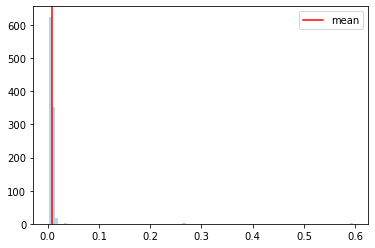

  0%|▏                                                                                | 2/1000 [00:00<00:50, 19.85it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654432194
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 0.1, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:22, 12.02it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<01:59,  8.31it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<02:01,  8.15it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:59,  8.31it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<02:00,  8.17it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:57,  8.43it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:58,  8.27it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<02:04,  7.86it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<02:05,  7.83it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<02:09,  7.52it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<02:07,  7.67it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<02:08,  7.57it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:29,  6.51it/s]

Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:26,  6.61it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:24,  6.73it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:04<02:12,  7.27it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<02:14,  7.18it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:16,  7.08it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:05<02:13,  7.19it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:05<02:10,  7.33it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<02:14,  7.09it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:18,  6.90it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:06<02:22,  6.68it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:06<02:23,  6.63it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:46,  5.69it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:07<02:36,  6.07it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:07<02:31,  6.24it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<02:22,  6.61it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:08<02:25,  6.48it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:08<02:24,  6.48it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:08<02:28,  6.33it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:09<02:24,  6.46it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:09<02:25,  6.39it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:09<02:18,  6.70it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:10<02:22,  6.53it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:10<02:23,  6.45it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:10<02:24,  6.42it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:10<02:25,  6.34it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:11<02:21,  6.53it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:11<02:15,  6.76it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:11<02:21,  6.48it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:12<02:20,  6.52it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:12<02:25,  6.29it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:12<02:31,  6.03it/s]

Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:13<02:25,  6.27it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:13<02:28,  6.13it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:13<02:23,  6.29it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:13<02:24,  6.25it/s]

Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:14<02:31,  5.95it/s]

Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:14<02:31,  5.94it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:14<02:30,  5.98it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:14<02:24,  6.22it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:15<02:22,  6.31it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:15<02:20,  6.36it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:15<02:18,  6.46it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:16<02:20,  6.33it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:16<02:21,  6.29it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:16<02:23,  6.16it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:17<02:17,  6.41it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:17<02:12,  6.68it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:17<02:09,  6.79it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:18<02:08,  6.81it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:18<02:22,  6.14it/s]

Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:18<02:25,  6.00it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:18<02:24,  6.03it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:19<02:25,  5.97it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:19<02:17,  6.32it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:19<02:19,  6.21it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:20<02:26,  5.89it/s]

Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:20<02:25,  5.93it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:20<02:23,  5.99it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:21<02:20,  6.13it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 141/1000 [00:21<02:20,  6.09it/s]

Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:21<02:25,  5.90it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:21<02:25,  5.86it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:22<02:26,  5.84it/s]

Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:22<02:24,  5.91it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:22<02:21,  6.03it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:23<02:21,  5.99it/s]

Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:23<02:27,  5.73it/s]

Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:23<02:24,  5.85it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:23<02:32,  5.53it/s]

Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:23<02:26,  5.77it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:24<02:26,  5.74it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:24<02:20,  5.99it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:25<02:22,  5.86it/s]

Monte Carlo 162
Monte Carlo 163


 16%|████████████▉                                                                  | 164/1000 [00:25<02:15,  6.19it/s]

Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:25<02:18,  6.01it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:25<02:22,  5.84it/s]

Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:26<02:21,  5.87it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:26<02:15,  6.12it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:26<02:32,  5.41it/s]

Monte Carlo 172
Monte Carlo 173


 17%|█████████████▋                                                                 | 174/1000 [00:26<02:39,  5.18it/s]

Monte Carlo 174


 18%|█████████████▊                                                                 | 175/1000 [00:27<02:45,  4.99it/s]

Monte Carlo 175


 18%|█████████████▉                                                                 | 176/1000 [00:27<02:54,  4.73it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:27<03:10,  4.32it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:28<02:47,  4.91it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:28<02:38,  5.15it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:29<02:27,  5.52it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:29<02:33,  5.30it/s]

Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:29<02:29,  5.44it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:29<02:34,  5.27it/s]

Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:30<02:36,  5.19it/s]

Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:30<02:32,  5.31it/s]

Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:30<02:29,  5.40it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:30<02:26,  5.49it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:31<02:22,  5.65it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:31<02:28,  5.40it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:31<02:28,  5.38it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:32<02:30,  5.32it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:32<02:35,  5.12it/s]

Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:32<02:32,  5.21it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:33<02:36,  5.08it/s]

Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:33<02:33,  5.17it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:33<02:32,  5.19it/s]

Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:33<02:33,  5.15it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:34<02:36,  5.05it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▋                                                              | 212/1000 [00:34<02:43,  4.81it/s]

Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:34<02:42,  4.83it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:35<02:37,  4.99it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:35<02:38,  4.93it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:35<02:33,  5.08it/s]

Monte Carlo 218
Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:36<02:41,  4.82it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:36<02:39,  4.87it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:36<02:37,  4.94it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▋                                                             | 224/1000 [00:36<02:42,  4.76it/s]

Monte Carlo 224


 22%|█████████████████▊                                                             | 225/1000 [00:37<02:43,  4.73it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:37<02:41,  4.78it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 228/1000 [00:37<02:42,  4.74it/s]

Monte Carlo 228


 23%|██████████████████                                                             | 229/1000 [00:37<02:42,  4.73it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 230/1000 [00:38<02:45,  4.65it/s]

Monte Carlo 230


 23%|██████████████████▏                                                            | 231/1000 [00:38<02:50,  4.51it/s]

Monte Carlo 231


 23%|██████████████████▎                                                            | 232/1000 [00:38<02:48,  4.55it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:38<02:42,  4.71it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▌                                                            | 235/1000 [00:39<02:46,  4.58it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 236/1000 [00:39<02:46,  4.59it/s]

Monte Carlo 236


 24%|██████████████████▋                                                            | 237/1000 [00:39<02:43,  4.66it/s]

Monte Carlo 237


 24%|██████████████████▊                                                            | 238/1000 [00:39<02:47,  4.56it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 239/1000 [00:40<02:52,  4.41it/s]

Monte Carlo 239


 24%|██████████████████▉                                                            | 240/1000 [00:40<02:48,  4.52it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:40<02:41,  4.70it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:40<02:37,  4.81it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:41<02:33,  4.94it/s]

Monte Carlo 243
Monte Carlo 244


 24%|███████████████████▎                                                           | 245/1000 [00:41<02:37,  4.78it/s]

Monte Carlo 245


 25%|███████████████████▍                                                           | 246/1000 [00:41<02:42,  4.65it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 247/1000 [00:41<02:52,  4.37it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:42<02:44,  4.57it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 250/1000 [00:42<02:49,  4.42it/s]

Monte Carlo 250


 25%|███████████████████▊                                                           | 251/1000 [00:42<02:51,  4.38it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 252/1000 [00:42<02:51,  4.35it/s]

Monte Carlo 252


 25%|███████████████████▉                                                           | 253/1000 [00:43<02:51,  4.36it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:43<02:45,  4.51it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▏                                                          | 256/1000 [00:43<02:46,  4.46it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:44<02:40,  4.64it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:44<02:39,  4.64it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:44<02:36,  4.72it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▌                                                          | 261/1000 [00:44<02:40,  4.59it/s]

Monte Carlo 261


 26%|████████████████████▋                                                          | 262/1000 [00:45<02:37,  4.67it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 263/1000 [00:45<02:43,  4.52it/s]

Monte Carlo 263


 26%|████████████████████▊                                                          | 264/1000 [00:45<02:44,  4.47it/s]

Monte Carlo 264


 26%|████████████████████▉                                                          | 265/1000 [00:45<02:45,  4.45it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 266/1000 [00:46<02:49,  4.33it/s]

Monte Carlo 266


 27%|█████████████████████                                                          | 267/1000 [00:46<02:44,  4.47it/s]

Monte Carlo 267


 27%|█████████████████████▏                                                         | 268/1000 [00:46<03:02,  4.00it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 269/1000 [00:46<02:57,  4.13it/s]

Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:47<02:56,  4.15it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 271/1000 [00:47<03:01,  4.03it/s]

Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:47<03:02,  3.98it/s]

Monte Carlo 272


 27%|█████████████████████▌                                                         | 273/1000 [00:47<02:58,  4.08it/s]

Monte Carlo 273


 27%|█████████████████████▋                                                         | 274/1000 [00:48<03:02,  3.98it/s]

Monte Carlo 274


 28%|█████████████████████▋                                                         | 275/1000 [00:48<03:05,  3.90it/s]

Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:48<02:58,  4.06it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 277/1000 [00:48<02:54,  4.15it/s]

Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:49<02:54,  4.15it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:49<02:50,  4.22it/s]

Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:49<02:53,  4.15it/s]

Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:49<02:57,  4.05it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:50<02:54,  4.12it/s]

Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:50<02:50,  4.20it/s]

Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:50<02:48,  4.25it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:50<02:41,  4.41it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:51<02:43,  4.36it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:51<02:49,  4.20it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:51<02:54,  4.08it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:51<02:53,  4.09it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:52<02:51,  4.13it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:52<02:51,  4.13it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:52<02:52,  4.11it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:52<02:47,  4.22it/s]

Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:53<02:43,  4.32it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:53<02:45,  4.25it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:53<02:56,  3.98it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:53<03:00,  3.90it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:54<02:57,  3.95it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:54<02:51,  4.08it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:54<02:52,  4.06it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:55<03:24,  3.41it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:55<03:12,  3.62it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:55<03:06,  3.73it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:55<02:58,  3.90it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:55<02:54,  3.98it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:56<02:49,  4.10it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:56<02:49,  4.08it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:56<02:50,  4.04it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:56<02:54,  3.95it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:57<02:54,  3.95it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:57<02:57,  3.89it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:57<02:52,  3.99it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:57<02:48,  4.08it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:58<02:43,  4.18it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:58<02:44,  4.17it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:58<02:49,  4.03it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:58<02:46,  4.09it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:59<02:49,  4.01it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:59<02:50,  4.00it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:59<02:44,  4.12it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:59<02:44,  4.12it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [01:00<02:42,  4.17it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [01:00<02:40,  4.22it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [01:00<02:44,  4.10it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [01:00<02:41,  4.17it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [01:01<02:39,  4.22it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [01:01<02:38,  4.23it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [01:01<02:42,  4.13it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [01:01<02:47,  4.00it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [01:02<02:49,  3.95it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [01:02<02:43,  4.10it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [01:02<02:43,  4.09it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [01:02<02:41,  4.12it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [01:03<02:40,  4.14it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [01:03<02:38,  4.18it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [01:03<02:48,  3.94it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [01:03<02:46,  3.97it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [01:04<02:46,  3.97it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [01:04<02:45,  3.99it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [01:04<03:18,  3.33it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [01:05<03:15,  3.37it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [01:05<03:05,  3.54it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [01:05<03:00,  3.64it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:05<02:58,  3.67it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:06<02:53,  3.76it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:06<02:48,  3.87it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:06<02:48,  3.88it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:06<02:50,  3.82it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:07<02:51,  3.80it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:07<02:49,  3.82it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:07<02:56,  3.66it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:07<02:55,  3.69it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:08<02:54,  3.71it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:08<02:49,  3.80it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:08<02:44,  3.92it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:08<02:38,  4.05it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:09<02:35,  4.12it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:09<02:34,  4.15it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:09<02:32,  4.21it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:09<02:38,  4.03it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:10<02:38,  4.03it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:10<02:35,  4.10it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:10<02:36,  4.06it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:10<02:41,  3.93it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:11<02:39,  3.97it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:11<02:40,  3.95it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:11<02:36,  4.03it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:11<02:36,  4.03it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:12<02:32,  4.13it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:12<02:32,  4.12it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:12<02:32,  4.11it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:12<02:41,  3.87it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:13<02:38,  3.95it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:13<02:41,  3.87it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:13<02:38,  3.93it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:13<02:42,  3.83it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:14<02:41,  3.84it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:14<02:44,  3.77it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:14<02:37,  3.94it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:14<02:33,  4.04it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:15<02:31,  4.08it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:15<02:29,  4.12it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:15<02:27,  4.18it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:15<02:22,  4.33it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:16<02:22,  4.30it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:16<02:23,  4.27it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:16<02:23,  4.26it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:16<02:25,  4.19it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:17<02:30,  4.06it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:17<02:31,  4.02it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:17<02:33,  3.97it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:17<02:32,  3.99it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:18<02:30,  4.02it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:18<02:36,  3.85it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:18<02:32,  3.95it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:18<02:29,  4.02it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:19<02:28,  4.06it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:19<02:29,  4.03it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:19<02:26,  4.10it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:19<02:28,  4.04it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:20<02:35,  3.85it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:20<02:35,  3.84it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:20<02:33,  3.87it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:20<02:31,  3.93it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:21<02:29,  3.98it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:21<02:29,  3.97it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:21<02:29,  3.97it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:21<02:26,  4.04it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:22<02:31,  3.89it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:22<02:32,  3.86it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:22<02:32,  3.87it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:22<02:32,  3.85it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:23<02:30,  3.90it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:23<02:32,  3.85it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:23<02:26,  3.98it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:23<02:29,  3.90it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:24<02:28,  3.91it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:24<02:51,  3.38it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:24<02:47,  3.45it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:25<02:43,  3.53it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:25<02:36,  3.70it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:25<02:32,  3.77it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:25<02:31,  3.81it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:26<02:34,  3.73it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:26<02:40,  3.57it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:26<02:37,  3.63it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:26<02:33,  3.72it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:27<02:37,  3.64it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:27<02:36,  3.64it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:27<02:35,  3.65it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:28<02:37,  3.60it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:28<02:42,  3.49it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:28<02:37,  3.60it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:28<02:39,  3.55it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:29<02:39,  3.53it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:29<02:36,  3.59it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:29<02:37,  3.56it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:30<02:37,  3.56it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:30<02:38,  3.54it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:30<02:40,  3.49it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:30<02:37,  3.53it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:31<02:37,  3.54it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:31<02:36,  3.54it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:31<02:33,  3.61it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:31<02:32,  3.64it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:32<02:44,  3.36it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:32<02:37,  3.50it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:32<02:31,  3.65it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:33<02:27,  3.73it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:33<02:29,  3.68it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:33<02:29,  3.66it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:33<02:25,  3.75it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:34<02:27,  3.71it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:34<02:29,  3.64it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:34<02:26,  3.71it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:35<02:27,  3.69it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:35<02:29,  3.62it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:35<02:32,  3.55it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:35<02:35,  3.48it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:36<02:34,  3.50it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:36<02:37,  3.41it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:36<02:39,  3.37it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:37<02:38,  3.38it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:37<02:36,  3.43it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:37<02:33,  3.48it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:37<02:37,  3.39it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:38<02:35,  3.43it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:38<02:39,  3.32it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:38<02:35,  3.40it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:39<02:34,  3.43it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:39<02:32,  3.46it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:39<02:31,  3.48it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:39<02:32,  3.45it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:40<02:35,  3.38it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:40<02:35,  3.37it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:40<02:39,  3.28it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:41<02:41,  3.22it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:41<02:41,  3.23it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:41<02:38,  3.29it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:42<02:40,  3.22it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:42<02:44,  3.14it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:42<02:43,  3.17it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:43<02:46,  3.10it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:43<02:45,  3.11it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:43<02:39,  3.22it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:44<02:37,  3.25it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:44<02:37,  3.25it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:44<02:36,  3.27it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:44<02:36,  3.27it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:45<02:38,  3.22it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:45<02:38,  3.20it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:45<02:38,  3.19it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:46<02:46,  3.04it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:46<02:45,  3.05it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:46<02:43,  3.08it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:47<02:46,  3.03it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:47<02:45,  3.03it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:47<02:43,  3.07it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:48<02:41,  3.09it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:48<02:36,  3.19it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:48<02:33,  3.24it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:49<02:35,  3.20it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:49<02:39,  3.11it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:49<02:43,  3.03it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:50<02:40,  3.09it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:50<02:42,  3.04it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:50<02:43,  3.00it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:51<02:41,  3.04it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:51<02:38,  3.10it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:51<02:36,  3.12it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:52<02:32,  3.21it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:52<02:31,  3.21it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:52<02:36,  3.11it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:53<02:40,  3.02it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:53<02:40,  3.01it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:53<02:40,  3.01it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:54<02:38,  3.03it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:54<02:44,  2.93it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:54<02:46,  2.89it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:55<02:41,  2.97it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:55<02:39,  3.00it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:55<02:38,  3.00it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:56<02:40,  2.97it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:56<02:42,  2.92it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:56<02:41,  2.93it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:57<03:03,  2.58it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:57<02:54,  2.71it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:57<02:49,  2.78it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:58<02:45,  2.83it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:58<02:49,  2.76it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:59<02:44,  2.84it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:59<02:42,  2.87it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:59<02:41,  2.88it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [02:00<02:42,  2.87it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [02:00<02:40,  2.90it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [02:00<02:38,  2.92it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [02:01<02:33,  3.01it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [02:01<02:33,  3.01it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [02:01<02:32,  3.01it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [02:02<02:32,  3.01it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [02:02<02:37,  2.91it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [02:02<02:31,  3.01it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [02:02<02:25,  3.13it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [02:03<02:31,  3.01it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [02:03<02:28,  3.05it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [02:03<02:22,  3.19it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [02:04<02:25,  3.11it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [02:04<02:22,  3.17it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [02:04<02:25,  3.09it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [02:05<02:23,  3.12it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [02:05<02:26,  3.06it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [02:05<02:24,  3.09it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [02:06<02:23,  3.11it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [02:06<02:19,  3.19it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [02:06<02:17,  3.22it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [02:07<02:20,  3.16it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [02:07<02:21,  3.12it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [02:07<02:23,  3.07it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [02:08<02:23,  3.07it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [02:08<02:19,  3.15it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [02:08<02:21,  3.11it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [02:09<02:18,  3.15it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [02:09<02:18,  3.15it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [02:09<02:19,  3.13it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [02:10<02:18,  3.14it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:10<02:21,  3.07it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:10<02:21,  3.05it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:11<02:23,  3.00it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:11<02:19,  3.07it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:11<02:28,  2.89it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:12<02:35,  2.76it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:12<02:34,  2.76it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:12<02:36,  2.73it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:13<02:32,  2.79it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:13<02:31,  2.79it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:13<02:32,  2.77it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:14<02:30,  2.81it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:14<02:29,  2.81it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:15<02:30,  2.80it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:15<02:25,  2.88it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:15<02:19,  2.99it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:15<02:17,  3.04it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:16<02:15,  3.08it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:16<02:17,  3.02it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:16<02:12,  3.12it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:17<02:15,  3.06it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:17<02:19,  2.95it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:17<02:14,  3.05it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:18<02:15,  3.03it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:18<02:16,  3.01it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:18<02:13,  3.06it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:19<02:12,  3.07it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:19<02:15,  2.99it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:19<02:16,  2.96it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:20<02:17,  2.94it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:20<02:17,  2.92it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:21<02:19,  2.88it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:21<02:19,  2.87it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:21<02:23,  2.80it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:22<02:18,  2.87it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:22<02:23,  2.78it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:22<02:22,  2.79it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:23<02:22,  2.78it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:23<02:22,  2.77it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:23<02:18,  2.84it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:24<02:24,  2.71it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:24<02:23,  2.74it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:25<02:25,  2.69it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:25<02:25,  2.68it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:25<02:23,  2.72it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:26<02:23,  2.70it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:26<02:26,  2.64it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:26<02:21,  2.73it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:27<02:21,  2.72it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:27<02:22,  2.69it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:27<02:24,  2.65it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:28<02:20,  2.71it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:28<02:17,  2.77it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:29<02:16,  2.78it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:29<02:16,  2.77it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:29<02:20,  2.68it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:30<02:20,  2.68it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:30<02:19,  2.69it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:30<02:20,  2.67it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:31<02:24,  2.59it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:31<02:22,  2.63it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:32<02:19,  2.67it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:32<02:22,  2.61it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:32<02:22,  2.60it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:33<02:33,  2.40it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:33<02:28,  2.47it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:34<02:23,  2.56it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:34<02:21,  2.59it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:34<02:16,  2.67it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:35<02:14,  2.70it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:35<02:15,  2.68it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:35<02:17,  2.64it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:36<02:17,  2.62it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:36<02:25,  2.48it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:37<02:26,  2.45it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:37<02:24,  2.47it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:38<02:27,  2.42it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:38<02:25,  2.45it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:38<02:22,  2.49it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:39<02:22,  2.49it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:39<02:20,  2.52it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:40<02:20,  2.50it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:40<02:20,  2.50it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:40<02:16,  2.56it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:41<02:14,  2.59it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:41<02:17,  2.54it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:41<02:14,  2.58it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:42<02:14,  2.58it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:42<02:09,  2.65it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:43<02:12,  2.60it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:43<02:11,  2.60it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:43<02:11,  2.60it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:44<02:09,  2.64it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:44<02:10,  2.61it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:44<02:08,  2.64it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:45<02:10,  2.60it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:45<02:10,  2.58it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:46<02:09,  2.60it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:46<02:06,  2.65it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:46<02:09,  2.57it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:47<02:07,  2.60it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:47<02:07,  2.61it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:48<02:09,  2.56it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:48<02:10,  2.52it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:48<02:09,  2.53it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:49<02:09,  2.53it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:49<02:07,  2.57it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:50<02:05,  2.59it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:50<02:06,  2.57it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:50<02:05,  2.59it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:51<02:04,  2.60it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:51<02:05,  2.57it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:52<02:05,  2.55it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:52<02:06,  2.54it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:52<02:02,  2.60it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:53<02:03,  2.57it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:53<02:02,  2.59it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:53<01:59,  2.65it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:54<01:55,  2.72it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:54<01:58,  2.66it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:55<01:56,  2.68it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:55<01:56,  2.68it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:55<01:55,  2.69it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:56<01:53,  2.74it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:56<01:52,  2.75it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:56<01:50,  2.80it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:57<01:49,  2.79it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:57<01:47,  2.83it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:57<01:46,  2.85it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:58<01:47,  2.84it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:58<01:44,  2.89it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:58<01:50,  2.72it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:59<01:49,  2.75it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:59<01:50,  2.71it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [03:00<01:51,  2.69it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [03:00<01:48,  2.75it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [03:00<01:48,  2.73it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [03:01<01:47,  2.76it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [03:01<01:45,  2.79it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [03:01<01:46,  2.77it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [03:02<01:46,  2.74it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [03:02<01:46,  2.75it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [03:02<01:47,  2.71it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [03:03<01:50,  2.62it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [03:03<01:48,  2.66it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [03:04<01:49,  2.64it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [03:04<01:47,  2.68it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [03:04<01:49,  2.61it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [03:05<01:48,  2.64it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [03:05<01:49,  2.59it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [03:06<01:46,  2.65it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [03:06<01:44,  2.69it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [03:06<01:46,  2.63it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [03:07<01:47,  2.62it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [03:07<01:47,  2.60it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [03:07<01:45,  2.64it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [03:08<01:47,  2.58it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [03:08<01:45,  2.60it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [03:09<01:46,  2.58it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [03:09<01:45,  2.59it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [03:09<01:43,  2.63it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [03:10<01:42,  2.64it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [03:10<01:43,  2.62it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [03:11<01:43,  2.60it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [03:11<01:45,  2.55it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [03:11<01:46,  2.52it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [03:12<01:46,  2.51it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [03:12<01:44,  2.53it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [03:13<01:44,  2.55it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [03:13<01:44,  2.52it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [03:13<01:44,  2.51it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [03:14<01:44,  2.52it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:14<01:44,  2.50it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:15<01:44,  2.49it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:15<01:46,  2.43it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:15<01:48,  2.38it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:16<01:45,  2.43it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:16<01:45,  2.42it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:17<01:44,  2.44it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:17<01:45,  2.41it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:17<01:44,  2.42it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:18<01:44,  2.40it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:18<01:44,  2.40it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:19<01:44,  2.39it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:19<01:44,  2.38it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:20<01:43,  2.40it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:20<01:45,  2.34it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:21<01:56,  2.11it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:21<01:52,  2.17it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:21<01:50,  2.20it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:22<01:49,  2.22it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:22<01:49,  2.20it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:23<01:45,  2.28it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:23<01:47,  2.24it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:24<01:43,  2.30it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:24<01:45,  2.26it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:25<01:45,  2.25it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:25<01:45,  2.24it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:25<01:42,  2.29it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:26<01:44,  2.24it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:26<01:43,  2.25it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:27<01:41,  2.29it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:27<01:39,  2.32it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:28<01:38,  2.35it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:28<01:37,  2.34it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:28<01:38,  2.30it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:29<01:40,  2.27it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:29<01:38,  2.29it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:30<01:37,  2.32it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:30<01:35,  2.34it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:31<01:32,  2.41it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:31<01:33,  2.36it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:31<01:33,  2.35it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:32<01:34,  2.34it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:32<01:32,  2.36it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:33<01:33,  2.32it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:33<01:33,  2.31it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:34<01:46,  2.04it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:34<01:44,  2.06it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:35<01:39,  2.15it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:35<01:38,  2.16it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:36<01:34,  2.24it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:36<01:33,  2.26it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:36<01:29,  2.35it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:37<01:27,  2.38it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:37<01:27,  2.38it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:38<01:26,  2.40it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:38<01:27,  2.36it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:38<01:26,  2.38it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:39<01:25,  2.39it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:39<01:26,  2.36it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:40<01:26,  2.33it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:40<01:26,  2.31it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:41<01:27,  2.30it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:41<01:25,  2.32it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:41<01:25,  2.32it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:42<01:24,  2.34it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:42<01:27,  2.23it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:43<01:26,  2.26it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:43<01:28,  2.20it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:44<01:26,  2.22it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:44<01:25,  2.25it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:45<01:24,  2.25it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:45<01:23,  2.26it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:45<01:24,  2.25it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:46<01:23,  2.26it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:46<01:21,  2.28it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:47<01:24,  2.21it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:47<01:23,  2.20it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:48<01:24,  2.18it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:48<01:22,  2.20it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:49<01:20,  2.27it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:49<01:19,  2.26it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:49<01:19,  2.27it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:50<01:19,  2.25it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:50<01:20,  2.21it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:51<01:21,  2.16it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:51<01:20,  2.19it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:52<01:19,  2.19it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:52<01:18,  2.21it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:53<01:18,  2.21it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:53<01:17,  2.23it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:54<01:14,  2.31it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:54<01:13,  2.31it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:54<01:13,  2.29it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:55<01:13,  2.28it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:55<01:13,  2.27it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:56<01:11,  2.33it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:56<01:10,  2.34it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:57<01:11,  2.28it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:57<01:09,  2.33it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:57<01:10,  2.29it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:58<01:10,  2.30it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:58<01:08,  2.33it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:59<01:08,  2.32it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:59<01:08,  2.32it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [04:00<01:06,  2.35it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [04:00<01:06,  2.35it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [04:00<01:06,  2.34it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [04:01<01:05,  2.34it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [04:01<01:05,  2.33it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [04:02<01:03,  2.38it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [04:02<01:04,  2.35it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [04:03<01:03,  2.36it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [04:03<01:04,  2.29it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [04:03<01:05,  2.28it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [04:04<01:02,  2.34it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [04:04<01:03,  2.32it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [04:05<01:01,  2.38it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [04:05<01:00,  2.38it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [04:06<01:01,  2.33it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [04:06<01:01,  2.30it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [04:06<01:02,  2.25it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [04:07<01:01,  2.27it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [04:07<01:01,  2.27it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [04:08<01:00,  2.27it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [04:08<01:00,  2.26it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [04:09<00:59,  2.29it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [04:09<01:05,  2.05it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [04:10<01:03,  2.11it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [04:10<01:02,  2.12it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [04:11<01:02,  2.12it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [04:11<01:00,  2.16it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [04:12<01:00,  2.17it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [04:12<01:00,  2.14it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [04:13<00:59,  2.14it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [04:13<01:00,  2.11it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [04:13<01:00,  2.09it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [04:14<00:59,  2.12it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [04:14<00:57,  2.14it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [04:15<00:56,  2.19it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [04:15<00:54,  2.25it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [04:16<00:54,  2.21it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [04:16<00:55,  2.17it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [04:17<00:54,  2.20it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [04:17<00:53,  2.21it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [04:18<00:52,  2.22it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [04:18<00:51,  2.24it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [04:18<00:52,  2.19it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [04:19<00:52,  2.19it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [04:19<00:50,  2.24it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [04:20<00:50,  2.22it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [04:20<00:50,  2.18it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [04:21<00:50,  2.19it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:21<00:50,  2.15it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:22<00:50,  2.13it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:22<00:50,  2.10it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:23<00:50,  2.09it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:23<00:50,  2.10it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:24<00:49,  2.09it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:24<00:49,  2.08it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:25<00:47,  2.13it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:25<00:47,  2.12it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:25<00:46,  2.15it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:26<00:47,  2.09it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:26<00:46,  2.10it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:27<00:46,  2.10it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:27<00:45,  2.12it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:28<00:44,  2.13it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:28<00:44,  2.14it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:29<00:43,  2.13it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:29<00:42,  2.14it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:30<00:42,  2.13it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:30<00:42,  2.10it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:31<00:42,  2.08it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:31<00:41,  2.10it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:32<00:42,  2.06it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:32<00:41,  2.06it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:33<00:42,  1.99it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:33<00:41,  2.03it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:34<00:40,  2.03it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:34<00:40,  2.03it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:35<00:39,  2.06it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:35<00:39,  2.04it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:36<00:38,  2.05it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:36<00:38,  2.05it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:37<00:37,  2.04it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:37<00:37,  2.03it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:38<00:36,  2.03it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:38<00:36,  2.04it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:39<00:35,  2.04it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:39<00:35,  2.03it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:40<00:34,  2.04it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:40<00:34,  2.05it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:41<00:33,  2.06it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:41<00:32,  2.08it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:41<00:32,  2.06it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:42<00:32,  2.01it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:43<00:32,  1.99it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:43<00:32,  1.97it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:44<00:31,  1.97it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:44<00:31,  1.96it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:45<00:30,  2.00it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:45<00:30,  1.98it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:46<00:30,  1.95it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:46<00:29,  1.96it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:47<00:28,  1.99it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:47<00:28,  1.95it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:48<00:27,  1.99it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:48<00:26,  2.07it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:48<00:25,  2.11it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:49<00:24,  2.13it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:49<00:23,  2.18it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:50<00:23,  2.17it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:50<00:22,  2.17it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:51<00:21,  2.18it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:51<00:22,  2.12it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:52<00:21,  2.14it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:52<00:21,  2.12it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:53<00:20,  2.11it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:53<00:20,  2.05it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:54<00:22,  1.90it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:54<00:21,  1.94it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:55<00:19,  2.00it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:55<00:19,  2.00it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:56<00:18,  2.05it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:56<00:17,  2.10it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:57<00:16,  2.16it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:57<00:16,  2.15it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:58<00:16,  2.10it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:58<00:15,  2.11it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:59<00:15,  2.08it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:59<00:14,  2.10it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:59<00:14,  2.14it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [05:00<00:13,  2.08it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [05:00<00:13,  2.09it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [05:01<00:13,  2.06it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [05:01<00:12,  2.10it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [05:02<00:11,  2.10it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [05:02<00:11,  2.08it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [05:03<00:11,  2.06it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [05:03<00:10,  2.04it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [05:04<00:10,  2.09it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [05:04<00:09,  2.13it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [05:05<00:09,  2.09it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [05:05<00:08,  2.09it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [05:06<00:08,  2.06it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [05:06<00:07,  2.04it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [05:07<00:07,  2.09it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [05:07<00:06,  2.09it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [05:08<00:06,  2.04it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [05:08<00:05,  2.05it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [05:09<00:05,  2.04it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [05:09<00:05,  1.98it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [05:10<00:04,  1.93it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [05:10<00:04,  1.89it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [05:11<00:03,  1.92it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [05:11<00:03,  1.91it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [05:12<00:02,  1.92it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [05:12<00:02,  1.93it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [05:13<00:01,  1.91it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [05:13<00:01,  1.89it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [05:14<00:00,  1.84it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [05:15<00:00,  3.17it/s]


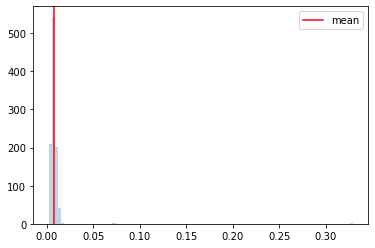

  0%|▏                                                                                | 2/1000 [00:00<00:59, 16.85it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654432510
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 0.1, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<01:50,  8.99it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<02:15,  7.35it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:01<02:16,  7.24it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<02:12,  7.46it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<02:08,  7.66it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<02:11,  7.47it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:02<02:09,  7.58it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<02:10,  7.50it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<02:09,  7.56it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<02:14,  7.30it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:03<02:13,  7.30it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<02:21,  6.90it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:18,  7.04it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:04<02:12,  7.33it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:04<02:10,  7.44it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:14,  7.18it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:10,  7.38it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:05<02:14,  7.17it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:05<02:13,  7.21it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<02:21,  6.79it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:06<02:20,  6.81it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:06<02:18,  6.87it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:06<02:18,  6.90it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:06<02:25,  6.54it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:07<02:24,  6.58it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:07<02:23,  6.59it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:07<02:23,  6.57it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:08<02:24,  6.51it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▋                                                                           | 59/1000 [00:08<02:23,  6.57it/s]

Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:08<02:51,  5.48it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:09<02:36,  6.00it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:09<02:29,  6.27it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:09<02:26,  6.37it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:09<02:26,  6.33it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:10<02:25,  6.40it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:10<02:24,  6.39it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:10<02:27,  6.29it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:11<02:24,  6.38it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:11<02:18,  6.67it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:11<02:13,  6.90it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:12<02:24,  6.36it/s]

Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:12<02:32,  5.99it/s]

Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:12<02:30,  6.07it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:12<02:34,  5.92it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:13<02:22,  6.37it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:13<02:19,  6.51it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:13<02:15,  6.71it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:13<02:09,  6.99it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:14<02:07,  7.09it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:14<02:09,  6.96it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:14<02:24,  6.24it/s]

Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:15<02:22,  6.32it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:15<02:25,  6.14it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:15<02:18,  6.43it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:15<02:15,  6.59it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:16<02:19,  6.39it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:16<02:17,  6.45it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:16<02:15,  6.53it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:17<02:20,  6.28it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:17<02:20,  6.28it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:17<02:22,  6.17it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:18<02:20,  6.25it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:18<02:22,  6.16it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:18<02:26,  5.98it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:19<02:30,  5.79it/s]

Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:19<02:31,  5.76it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:19<02:31,  5.74it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:20<02:36,  5.53it/s]

Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:20<02:44,  5.27it/s]

Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:20<02:37,  5.49it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▋                                                                    | 136/1000 [00:20<02:35,  5.56it/s]

Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:21<02:41,  5.35it/s]

Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:21<02:34,  5.58it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:21<02:32,  5.62it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:21<02:39,  5.38it/s]

Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:22<02:38,  5.41it/s]

Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:22<02:38,  5.38it/s]

Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:22<02:43,  5.24it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:22<02:46,  5.13it/s]

Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:23<02:43,  5.22it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:23<02:44,  5.15it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:23<02:46,  5.09it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:24<02:38,  5.33it/s]

Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:24<02:41,  5.23it/s]

Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:24<02:39,  5.29it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▍                                                                  | 158/1000 [00:24<02:35,  5.41it/s]

Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:25<02:30,  5.60it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:25<02:27,  5.68it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:25<02:30,  5.57it/s]

Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:26<02:35,  5.38it/s]

Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:26<02:36,  5.34it/s]

Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:26<02:38,  5.25it/s]

Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:26<02:32,  5.46it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:27<02:28,  5.57it/s]

Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:27<02:31,  5.48it/s]

Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:27<02:33,  5.41it/s]

Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:27<02:33,  5.40it/s]

Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:27<02:36,  5.28it/s]

Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:27<02:32,  5.42it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:28<02:40,  5.12it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:28<02:42,  5.07it/s]

Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:28<02:42,  5.05it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▏                                                                | 180/1000 [00:29<02:48,  4.87it/s]

Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:29<02:48,  4.85it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:29<03:04,  4.43it/s]

Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:30<02:58,  4.57it/s]

Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:30<02:53,  4.69it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 187/1000 [00:30<02:52,  4.70it/s]

Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:31<02:56,  4.59it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:31<02:46,  4.86it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:31<02:46,  4.86it/s]

Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:32<02:41,  4.98it/s]

Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:32<02:36,  5.16it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▍                                                               | 196/1000 [00:32<02:33,  5.23it/s]

Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:32<02:41,  4.96it/s]

Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:33<02:42,  4.94it/s]

Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:33<02:40,  4.98it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 201/1000 [00:33<02:44,  4.86it/s]

Monte Carlo 201


 20%|███████████████▉                                                               | 202/1000 [00:33<02:44,  4.85it/s]

Monte Carlo 202


 20%|████████████████                                                               | 203/1000 [00:33<02:44,  4.83it/s]

Monte Carlo 203


 20%|████████████████                                                               | 204/1000 [00:34<02:50,  4.67it/s]

Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:34<02:46,  4.77it/s]

Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:34<02:44,  4.82it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:34<02:43,  4.84it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 209/1000 [00:35<02:54,  4.52it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:35<02:56,  4.48it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:36<02:44,  4.78it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:36<02:36,  5.01it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:36<02:36,  5.02it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:36<02:37,  4.97it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:36<02:30,  5.19it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:37<02:32,  5.11it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:37<02:35,  5.01it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:37<02:36,  4.95it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:38<02:35,  4.99it/s]

Monte Carlo 223
Monte Carlo 224


 22%|█████████████████▊                                                             | 225/1000 [00:38<02:37,  4.91it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:38<02:36,  4.93it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:38<02:35,  4.96it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████                                                             | 229/1000 [00:39<02:36,  4.92it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:39<02:35,  4.95it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:39<02:30,  5.11it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:39<02:26,  5.22it/s]

Monte Carlo 232
Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:40<02:24,  5.28it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:40<02:25,  5.26it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:40<02:26,  5.19it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:40<02:27,  5.15it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 239/1000 [00:41<02:35,  4.91it/s]

Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:41<02:35,  4.89it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:41<02:28,  5.10it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▏                                                           | 243/1000 [00:41<02:35,  4.88it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:42<02:33,  4.90it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:42<02:31,  4.97it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:42<02:26,  5.12it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:42<02:29,  5.02it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:43<02:27,  5.08it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 250/1000 [00:43<02:35,  4.83it/s]

Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:43<02:32,  4.89it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:43<02:30,  4.98it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:44<02:31,  4.92it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:44<02:26,  5.07it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:44<02:27,  5.04it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▍                                                          | 259/1000 [00:45<02:30,  4.93it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 260/1000 [00:45<02:34,  4.80it/s]

Monte Carlo 260


 26%|████████████████████▌                                                          | 261/1000 [00:45<02:38,  4.66it/s]

Monte Carlo 261


 26%|████████████████████▋                                                          | 262/1000 [00:45<02:39,  4.64it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:46<02:46,  4.43it/s]

Monte Carlo 263
Monte Carlo 264


 26%|████████████████████▉                                                          | 265/1000 [00:46<02:45,  4.44it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:46<02:37,  4.65it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:47<02:37,  4.66it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 269/1000 [00:47<02:41,  4.52it/s]

Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:47<02:39,  4.57it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 271/1000 [00:47<02:37,  4.62it/s]

Monte Carlo 271


 27%|█████████████████████▍                                                         | 272/1000 [00:48<02:38,  4.59it/s]

Monte Carlo 272


 27%|█████████████████████▌                                                         | 273/1000 [00:48<02:40,  4.54it/s]

Monte Carlo 273


 27%|█████████████████████▋                                                         | 274/1000 [00:48<02:46,  4.37it/s]

Monte Carlo 274


 28%|█████████████████████▋                                                         | 275/1000 [00:48<02:43,  4.42it/s]

Monte Carlo 275


 28%|█████████████████████▊                                                         | 276/1000 [00:49<02:48,  4.30it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 277/1000 [00:49<02:48,  4.30it/s]

Monte Carlo 277


 28%|█████████████████████▉                                                         | 278/1000 [00:49<02:51,  4.21it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:49<02:54,  4.12it/s]

Monte Carlo 279


 28%|██████████████████████                                                         | 280/1000 [00:49<02:46,  4.32it/s]

Monte Carlo 280


 28%|██████████████████████▏                                                        | 281/1000 [00:50<02:41,  4.45it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:50<02:44,  4.36it/s]

Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:50<02:46,  4.30it/s]

Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:50<02:49,  4.23it/s]

Monte Carlo 284


 28%|██████████████████████▌                                                        | 285/1000 [00:51<02:42,  4.39it/s]

Monte Carlo 285


 29%|██████████████████████▌                                                        | 286/1000 [00:51<02:47,  4.26it/s]

Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:51<02:48,  4.23it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:51<02:47,  4.26it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:52<02:43,  4.35it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:52<02:42,  4.36it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:52<02:44,  4.30it/s]

Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:52<02:52,  4.10it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:53<02:49,  4.18it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:53<02:55,  4.03it/s]

Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:53<02:57,  3.97it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:53<02:55,  4.01it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:54<02:51,  4.10it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:54<02:57,  3.94it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:54<02:52,  4.07it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:54<02:48,  4.14it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:55<02:52,  4.05it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:55<02:51,  4.07it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:55<02:46,  4.19it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:55<02:50,  4.08it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:56<02:51,  4.05it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:56<02:47,  4.15it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:56<02:52,  4.03it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:56<02:51,  4.03it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:56<02:45,  4.17it/s]

Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:57<02:44,  4.19it/s]

Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:57<02:42,  4.23it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:57<03:12,  3.57it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:58<03:04,  3.72it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:58<02:59,  3.81it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:58<03:05,  3.70it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:58<03:09,  3.62it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:59<03:06,  3.66it/s]

Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:59<02:58,  3.83it/s]

Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:59<02:53,  3.92it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:59<02:52,  3.94it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [01:00<02:50,  3.99it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [01:00<02:50,  3.98it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [01:00<02:52,  3.93it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [01:00<02:50,  3.95it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [01:01<02:45,  4.07it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [01:01<02:52,  3.92it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [01:01<02:56,  3.81it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [01:01<02:56,  3.82it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [01:02<02:56,  3.80it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [01:02<02:50,  3.93it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [01:02<02:56,  3.79it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [01:02<02:54,  3.82it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [01:03<02:48,  3.96it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [01:03<02:45,  4.02it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [01:03<02:51,  3.88it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [01:03<02:49,  3.91it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [01:04<02:47,  3.95it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [01:04<02:44,  4.03it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [01:04<02:47,  3.95it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [01:04<02:49,  3.89it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [01:05<02:47,  3.94it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [01:05<02:45,  3.98it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [01:05<02:44,  3.99it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [01:05<02:47,  3.91it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [01:06<02:47,  3.91it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [01:06<02:48,  3.88it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:06<02:50,  3.83it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:07<02:53,  3.77it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [01:07<02:47,  3.88it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [01:07<02:49,  3.83it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:07<02:51,  3.79it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:08<02:56,  3.68it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:08<02:52,  3.76it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:08<02:52,  3.76it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:08<02:49,  3.80it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:09<02:50,  3.79it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:09<02:47,  3.83it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:09<02:55,  3.67it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:09<02:54,  3.68it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:10<02:49,  3.77it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:10<02:55,  3.64it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:10<02:51,  3.71it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:11<02:46,  3.83it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:11<02:47,  3.79it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:11<02:46,  3.82it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:11<02:52,  3.68it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:12<02:57,  3.57it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:12<02:50,  3.71it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:12<02:49,  3.73it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:12<02:51,  3.67it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:13<02:49,  3.72it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:13<02:48,  3.74it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:13<02:52,  3.64it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:14<02:49,  3.70it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:14<02:48,  3.72it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:14<02:45,  3.78it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:14<02:40,  3.87it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:15<02:43,  3.81it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:15<02:42,  3.82it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:15<02:43,  3.80it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:15<02:46,  3.71it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:16<02:51,  3.61it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:16<02:50,  3.62it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:16<02:47,  3.67it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:16<02:49,  3.63it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:17<02:51,  3.58it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:17<02:49,  3.61it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:17<02:45,  3.71it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:18<02:51,  3.56it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:18<02:48,  3.62it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:18<02:45,  3.68it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:18<02:43,  3.71it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:19<02:50,  3.57it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:19<02:46,  3.65it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:19<02:47,  3.61it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:20<02:47,  3.60it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:20<02:46,  3.63it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:20<02:45,  3.64it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:20<02:51,  3.50it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:21<02:46,  3.60it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:21<02:45,  3.61it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:21<02:48,  3.55it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:21<02:45,  3.61it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:22<02:49,  3.51it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:22<02:48,  3.53it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:22<02:50,  3.49it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:23<02:45,  3.58it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:23<02:41,  3.68it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:23<02:43,  3.61it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:23<02:42,  3.62it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:24<02:45,  3.55it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:24<02:47,  3.51it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:24<02:50,  3.43it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:25<02:52,  3.40it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:25<02:46,  3.51it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:25<02:48,  3.46it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:26<02:53,  3.36it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:26<02:45,  3.51it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:26<02:41,  3.60it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:26<02:48,  3.45it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:27<02:43,  3.55it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:27<02:42,  3.56it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:27<02:40,  3.59it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:27<02:43,  3.53it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:28<02:47,  3.43it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:28<02:54,  3.29it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:28<02:46,  3.44it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:29<02:46,  3.44it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:29<02:43,  3.48it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:29<02:48,  3.38it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:30<02:51,  3.31it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:30<02:54,  3.25it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:30<02:57,  3.19it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:31<02:57,  3.19it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:31<02:50,  3.32it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:31<02:52,  3.27it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:31<02:44,  3.42it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:32<02:46,  3.38it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:32<02:51,  3.27it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:32<02:51,  3.26it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:33<02:51,  3.25it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:33<02:45,  3.37it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:33<02:50,  3.27it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:34<02:53,  3.21it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:34<02:46,  3.33it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:34<02:44,  3.37it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:35<03:09,  2.91it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:35<03:10,  2.90it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:35<03:03,  3.00it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:36<02:56,  3.11it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:36<02:44,  3.35it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:36<02:39,  3.43it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:36<02:39,  3.43it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:37<02:35,  3.52it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:37<02:31,  3.59it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:37<02:31,  3.60it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:37<02:31,  3.59it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:38<02:31,  3.57it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:38<02:29,  3.62it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:38<02:35,  3.48it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:39<02:32,  3.54it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:39<02:33,  3.51it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:39<02:34,  3.48it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:39<02:38,  3.39it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:40<02:40,  3.34it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:40<02:36,  3.40it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:40<02:35,  3.43it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:41<02:37,  3.38it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:41<02:40,  3.30it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:41<02:41,  3.28it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:42<02:41,  3.28it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:42<02:38,  3.32it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:42<02:44,  3.20it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:42<02:43,  3.21it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:43<02:42,  3.23it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:43<02:47,  3.13it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:43<02:47,  3.13it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:44<02:43,  3.18it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:44<02:44,  3.17it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:44<02:47,  3.11it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:45<02:43,  3.18it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:45<02:40,  3.22it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:45<02:41,  3.19it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:46<02:39,  3.24it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:46<02:40,  3.21it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:46<02:38,  3.25it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:47<02:39,  3.21it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:47<02:36,  3.27it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:47<02:43,  3.12it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:48<02:43,  3.12it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:48<02:41,  3.16it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:48<02:36,  3.24it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:48<02:36,  3.23it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:49<02:39,  3.17it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:49<02:39,  3.17it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:49<02:38,  3.19it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:50<02:40,  3.14it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:50<02:36,  3.20it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:50<02:39,  3.13it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:51<02:41,  3.10it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:51<02:39,  3.12it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:51<02:37,  3.16it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:52<02:35,  3.20it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:52<02:38,  3.12it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:52<02:37,  3.14it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:53<02:37,  3.14it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:53<02:36,  3.14it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:53<02:34,  3.18it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:54<02:34,  3.18it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:54<02:32,  3.22it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:54<02:30,  3.24it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:54<02:32,  3.20it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:55<02:30,  3.24it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:55<02:35,  3.13it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:55<02:31,  3.21it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:56<02:29,  3.25it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:56<02:28,  3.25it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:56<02:26,  3.29it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:57<02:22,  3.38it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:57<02:24,  3.33it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:57<02:26,  3.27it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:57<02:23,  3.33it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:58<02:24,  3.31it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:58<02:24,  3.30it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:58<02:20,  3.38it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:59<02:17,  3.44it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:59<02:20,  3.37it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:59<02:26,  3.22it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [02:00<02:27,  3.19it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [02:00<02:23,  3.26it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [02:00<02:23,  3.28it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [02:01<02:28,  3.15it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [02:01<02:25,  3.21it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [02:01<02:28,  3.14it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [02:02<02:30,  3.09it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [02:02<02:28,  3.13it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [02:02<02:25,  3.18it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [02:02<02:25,  3.18it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [02:03<02:30,  3.06it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [02:03<02:26,  3.14it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [02:03<02:26,  3.13it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [02:04<02:27,  3.10it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [02:04<02:30,  3.03it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [02:04<02:34,  2.96it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [02:05<02:35,  2.93it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [02:05<02:34,  2.95it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [02:06<02:36,  2.89it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [02:06<02:35,  2.91it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [02:06<02:35,  2.90it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [02:07<02:39,  2.82it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [02:07<02:35,  2.88it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [02:07<02:32,  2.93it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [02:08<02:31,  2.94it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [02:08<02:29,  2.98it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [02:08<02:29,  2.98it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [02:09<02:33,  2.90it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [02:09<02:36,  2.83it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [02:09<02:35,  2.84it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [02:10<02:31,  2.92it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [02:10<02:29,  2.94it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [02:10<02:28,  2.96it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [02:11<02:31,  2.89it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [02:11<02:33,  2.85it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [02:11<02:33,  2.83it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [02:12<02:41,  2.70it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [02:12<02:42,  2.67it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [02:13<02:36,  2.77it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [02:13<02:34,  2.80it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [02:13<02:36,  2.76it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [02:14<02:34,  2.78it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [02:14<02:51,  2.50it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [02:14<02:48,  2.54it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [02:15<02:43,  2.61it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [02:15<02:39,  2.66it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [02:16<02:38,  2.69it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:16<02:36,  2.71it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:16<02:35,  2.71it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:17<02:36,  2.70it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:17<02:34,  2.72it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:17<02:35,  2.71it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:18<02:34,  2.71it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:18<02:35,  2.70it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:19<02:36,  2.67it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:19<02:33,  2.71it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:19<02:34,  2.69it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:20<02:36,  2.65it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:20<02:31,  2.72it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:20<02:33,  2.68it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:21<02:34,  2.67it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:21<02:34,  2.66it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:22<02:33,  2.67it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:22<02:29,  2.72it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:22<02:33,  2.66it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:23<02:28,  2.74it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:23<02:25,  2.78it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:23<02:24,  2.81it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:24<02:22,  2.84it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:24<02:28,  2.71it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:24<02:28,  2.70it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:25<02:21,  2.82it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:25<02:24,  2.75it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:25<02:24,  2.75it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:26<02:21,  2.81it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:26<02:21,  2.80it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:27<02:21,  2.78it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:27<02:22,  2.77it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:27<02:20,  2.79it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:28<02:20,  2.80it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:28<02:22,  2.74it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:28<02:26,  2.66it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:29<02:25,  2.67it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:29<02:28,  2.61it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:30<02:27,  2.62it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:30<02:27,  2.62it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:30<02:26,  2.63it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:31<02:24,  2.66it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:31<02:28,  2.59it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:31<02:25,  2.62it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:32<02:25,  2.61it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:32<02:24,  2.63it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:33<02:25,  2.60it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:33<02:21,  2.67it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:33<02:22,  2.65it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:34<02:22,  2.64it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:34<02:27,  2.55it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:34<02:21,  2.64it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:35<02:20,  2.65it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:35<02:22,  2.60it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:36<02:22,  2.60it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:36<02:18,  2.67it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:36<02:19,  2.65it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:37<02:19,  2.64it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:37<02:20,  2.62it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:38<02:18,  2.64it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:38<02:17,  2.66it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:38<02:18,  2.63it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:39<02:19,  2.60it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:39<02:18,  2.62it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:39<02:17,  2.62it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:40<02:15,  2.67it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:40<02:16,  2.63it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:41<02:19,  2.57it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:41<02:16,  2.62it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:41<02:19,  2.55it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:42<02:15,  2.63it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:42<02:15,  2.60it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:43<02:17,  2.57it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:43<02:15,  2.59it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:43<02:15,  2.59it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:44<02:18,  2.53it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:44<02:15,  2.58it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:44<02:16,  2.55it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:45<02:14,  2.58it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:45<02:14,  2.57it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:46<02:10,  2.64it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:46<02:07,  2.71it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:46<02:08,  2.67it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:47<02:02,  2.80it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:47<02:01,  2.82it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:47<02:03,  2.76it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:48<02:03,  2.75it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:48<02:03,  2.73it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:48<01:58,  2.83it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:49<02:01,  2.76it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:49<01:58,  2.83it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:50<01:57,  2.84it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:50<01:58,  2.81it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:50<01:57,  2.82it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:51<01:56,  2.84it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:51<01:57,  2.81it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:51<02:00,  2.73it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:52<02:00,  2.72it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:52<01:59,  2.74it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:52<01:57,  2.78it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:53<01:56,  2.78it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:53<01:57,  2.76it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:54<01:56,  2.76it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:54<01:55,  2.79it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:54<01:55,  2.79it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:55<01:52,  2.85it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:55<01:52,  2.84it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:55<02:05,  2.53it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:56<02:02,  2.60it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:56<02:02,  2.57it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:57<02:02,  2.57it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:57<02:00,  2.61it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:57<01:58,  2.64it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:58<01:59,  2.60it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:58<02:13,  2.33it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:59<02:11,  2.36it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:59<02:10,  2.37it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:59<02:04,  2.47it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [03:00<02:08,  2.39it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [03:00<02:05,  2.44it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [03:01<02:04,  2.44it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [03:01<02:02,  2.49it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [03:01<02:04,  2.43it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [03:02<02:01,  2.48it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [03:02<01:59,  2.51it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [03:03<01:59,  2.51it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [03:03<01:59,  2.49it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [03:03<01:58,  2.52it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [03:04<01:59,  2.48it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [03:04<02:01,  2.43it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [03:05<02:00,  2.44it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [03:05<02:02,  2.41it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [03:06<01:59,  2.45it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [03:06<01:59,  2.44it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [03:06<01:57,  2.48it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [03:07<01:52,  2.57it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [03:07<01:47,  2.69it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [03:07<01:49,  2.62it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [03:08<01:47,  2.66it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [03:08<01:45,  2.70it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [03:08<01:42,  2.77it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [03:09<01:43,  2.75it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [03:09<01:48,  2.60it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [03:10<01:48,  2.59it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [03:10<01:48,  2.60it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [03:10<01:44,  2.67it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [03:11<01:46,  2.63it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [03:11<01:44,  2.65it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [03:12<01:42,  2.70it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [03:12<01:42,  2.70it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [03:12<01:42,  2.69it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [03:13<01:40,  2.74it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [03:13<01:41,  2.69it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [03:13<01:43,  2.63it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [03:14<01:44,  2.59it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [03:14<01:46,  2.54it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [03:15<01:45,  2.54it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [03:15<01:47,  2.49it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [03:15<01:47,  2.48it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [03:16<01:46,  2.51it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [03:16<01:47,  2.47it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [03:17<01:46,  2.48it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [03:17<01:45,  2.49it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [03:17<01:44,  2.50it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [03:18<01:47,  2.42it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [03:18<01:48,  2.40it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [03:19<01:50,  2.35it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [03:19<01:49,  2.36it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [03:20<01:46,  2.42it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [03:20<01:46,  2.40it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [03:20<01:50,  2.31it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [03:21<02:05,  2.03it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [03:22<02:10,  1.94it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [03:22<02:09,  1.95it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [03:23<02:10,  1.92it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [03:23<02:06,  1.97it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [03:24<01:57,  2.11it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:24<01:52,  2.20it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:24<01:46,  2.31it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:25<01:40,  2.44it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:25<01:37,  2.52it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:25<01:37,  2.51it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:26<01:33,  2.61it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:26<01:32,  2.63it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:27<01:35,  2.53it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:27<01:34,  2.55it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:27<01:35,  2.49it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:28<01:35,  2.48it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:28<01:33,  2.54it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:29<01:31,  2.59it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:29<01:29,  2.62it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:29<01:31,  2.55it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:30<01:30,  2.59it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:30<01:31,  2.54it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:31<01:32,  2.49it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:31<01:32,  2.49it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:31<01:28,  2.58it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:32<01:28,  2.59it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:32<01:30,  2.52it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:33<01:29,  2.54it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:33<01:27,  2.56it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:33<01:25,  2.61it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:34<01:23,  2.66it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:34<01:23,  2.65it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:34<01:23,  2.66it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:35<01:23,  2.65it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:35<01:22,  2.67it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:36<01:24,  2.57it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:36<01:25,  2.54it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:36<01:24,  2.54it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:37<01:24,  2.54it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:37<01:23,  2.55it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:38<01:22,  2.58it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:38<01:24,  2.51it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:38<01:23,  2.52it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:39<01:22,  2.53it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:39<01:21,  2.55it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:40<01:23,  2.49it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:40<01:23,  2.47it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:40<01:23,  2.48it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:41<01:23,  2.46it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:41<01:21,  2.51it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:42<01:21,  2.49it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:42<01:20,  2.51it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:42<01:20,  2.51it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:43<01:20,  2.49it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:43<01:20,  2.48it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:44<01:20,  2.45it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:44<01:20,  2.44it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:44<01:21,  2.41it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:45<01:19,  2.45it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:45<01:18,  2.46it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:46<01:25,  2.25it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:46<01:23,  2.31it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:47<01:20,  2.36it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:47<01:18,  2.42it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:47<01:17,  2.45it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:48<01:17,  2.44it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:48<01:17,  2.41it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:49<01:14,  2.48it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:49<01:13,  2.51it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:49<01:13,  2.50it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:50<01:13,  2.49it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:50<01:12,  2.50it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:51<01:12,  2.50it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:51<01:12,  2.48it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:51<01:11,  2.51it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:52<01:10,  2.52it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:52<01:10,  2.52it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:53<01:10,  2.48it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:53<01:10,  2.50it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:53<01:09,  2.51it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:54<01:09,  2.49it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:54<01:09,  2.47it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:55<01:08,  2.49it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:55<01:07,  2.51it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:55<01:09,  2.43it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:56<01:09,  2.41it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:56<01:08,  2.44it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:57<01:08,  2.43it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:57<01:05,  2.52it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:57<01:04,  2.56it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:58<01:02,  2.63it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:58<01:00,  2.66it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:58<01:00,  2.68it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:59<00:59,  2.69it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:59<01:00,  2.63it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [04:00<01:02,  2.54it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [04:00<01:01,  2.56it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [04:00<01:01,  2.54it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [04:01<01:00,  2.58it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [04:01<01:00,  2.54it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [04:02<00:59,  2.55it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [04:02<00:59,  2.56it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [04:02<00:59,  2.54it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [04:03<01:00,  2.49it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [04:03<01:00,  2.45it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [04:04<01:00,  2.43it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [04:04<01:00,  2.43it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [04:04<01:01,  2.39it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [04:05<01:00,  2.40it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [04:05<00:59,  2.43it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [04:06<00:58,  2.45it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [04:06<00:57,  2.48it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [04:07<00:57,  2.45it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [04:07<00:57,  2.45it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [04:07<00:57,  2.42it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [04:08<00:57,  2.42it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [04:08<00:56,  2.40it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [04:09<00:56,  2.41it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [04:09<00:54,  2.48it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [04:09<00:53,  2.49it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [04:10<00:53,  2.50it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [04:10<00:52,  2.51it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [04:11<00:51,  2.54it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [04:11<00:53,  2.43it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [04:11<00:51,  2.48it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [04:12<00:50,  2.54it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [04:12<00:49,  2.55it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [04:13<00:49,  2.56it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [04:13<00:48,  2.56it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [04:13<00:49,  2.53it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [04:14<00:48,  2.53it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [04:14<00:48,  2.49it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [04:15<00:49,  2.46it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [04:15<00:49,  2.42it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [04:15<00:48,  2.44it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [04:16<00:49,  2.40it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [04:16<00:49,  2.36it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [04:17<00:49,  2.34it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [04:17<00:48,  2.36it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [04:18<00:47,  2.40it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [04:18<00:47,  2.37it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [04:18<00:48,  2.33it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [04:19<00:46,  2.38it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [04:19<00:46,  2.36it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [04:20<00:45,  2.40it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:20<00:45,  2.37it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:20<00:45,  2.33it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:21<00:45,  2.34it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:21<00:44,  2.35it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:22<00:44,  2.33it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:22<00:44,  2.32it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:23<00:44,  2.31it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:23<00:43,  2.33it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:23<00:42,  2.35it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:24<00:41,  2.36it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:24<00:42,  2.32it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:25<00:41,  2.36it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:25<00:41,  2.32it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:26<00:41,  2.31it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:26<00:41,  2.26it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:27<00:40,  2.28it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:27<00:39,  2.32it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:27<00:38,  2.33it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:28<00:38,  2.32it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:28<00:38,  2.34it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:29<00:37,  2.35it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:29<00:38,  2.28it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:30<00:37,  2.30it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:30<00:39,  2.13it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:31<00:38,  2.19it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:31<00:37,  2.21it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:31<00:36,  2.25it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:32<00:35,  2.26it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:32<00:34,  2.29it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:33<00:35,  2.21it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:33<00:34,  2.28it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:34<00:33,  2.28it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:34<00:32,  2.33it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:34<00:31,  2.37it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:35<00:30,  2.43it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:35<00:30,  2.38it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:36<00:30,  2.39it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:36<00:29,  2.40it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:36<00:29,  2.41it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:37<00:28,  2.42it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:37<00:29,  2.32it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:38<00:28,  2.35it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:38<00:27,  2.40it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:39<00:26,  2.43it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:39<00:26,  2.43it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:39<00:26,  2.42it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:40<00:25,  2.41it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:40<00:25,  2.43it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:41<00:25,  2.36it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:41<00:24,  2.37it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:41<00:24,  2.41it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:42<00:23,  2.42it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:42<00:22,  2.45it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:43<00:22,  2.42it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:43<00:22,  2.43it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:44<00:22,  2.40it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:44<00:21,  2.40it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:44<00:21,  2.33it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:45<00:21,  2.34it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:45<00:20,  2.35it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:46<00:20,  2.34it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:46<00:19,  2.37it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:47<00:19,  2.37it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:47<00:18,  2.41it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:47<00:18,  2.39it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:48<00:18,  2.32it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:48<00:18,  2.30it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:49<00:17,  2.32it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:49<00:17,  2.32it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:50<00:16,  2.34it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:50<00:16,  2.30it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:50<00:16,  2.31it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:51<00:15,  2.33it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:51<00:14,  2.35it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:52<00:14,  2.38it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:52<00:14,  2.34it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:53<00:13,  2.32it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:53<00:13,  2.29it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:53<00:12,  2.33it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:54<00:12,  2.32it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:54<00:12,  2.26it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:55<00:12,  2.19it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:55<00:12,  2.15it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:56<00:11,  2.16it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:56<00:11,  2.16it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:57<00:10,  2.14it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:57<00:10,  2.17it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:58<00:09,  2.18it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:58<00:09,  2.17it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:59<00:08,  2.17it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:59<00:08,  2.13it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:59<00:08,  2.11it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [05:00<00:07,  2.16it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [05:00<00:06,  2.18it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [05:01<00:06,  2.17it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [05:01<00:05,  2.17it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [05:02<00:05,  2.17it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [05:02<00:05,  2.12it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [05:03<00:04,  2.13it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [05:03<00:04,  2.15it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [05:04<00:03,  2.13it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [05:04<00:03,  2.17it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [05:05<00:02,  2.19it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [05:05<00:02,  2.19it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [05:06<00:01,  2.11it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [05:06<00:01,  2.07it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [05:07<00:00,  2.05it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [05:07<00:00,  2.07it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [05:07<00:00,  3.25it/s]


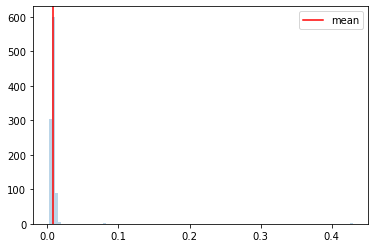

  0%|▏                                                                                | 2/1000 [00:00<00:58, 17.14it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654432818
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 1.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▎                                                                                | 4/1000 [00:00<02:02,  8.15it/s]

Monte Carlo 3
Monte Carlo 4


  1%|▍                                                                                | 6/1000 [00:00<02:02,  8.10it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<02:03,  8.05it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<02:05,  7.92it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<02:05,  7.87it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<02:07,  7.75it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<02:02,  8.05it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<02:01,  8.09it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:55,  8.48it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:59,  8.18it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:54,  8.51it/s]

Monte Carlo 23
Monte Carlo 24


  2%|██                                                                              | 25/1000 [00:03<01:59,  8.17it/s]

Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<02:14,  7.22it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:12,  7.34it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:05,  7.69it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:04<02:02,  7.90it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<01:56,  8.30it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<01:55,  8.34it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<01:57,  8.17it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:05<01:54,  8.39it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<01:57,  8.15it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<01:55,  8.26it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<02:05,  7.60it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:06<01:59,  7.96it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<01:56,  8.13it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:00,  7.85it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:01,  7.77it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<02:01,  7.77it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:02,  7.69it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:05,  7.50it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:05,  7.45it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:07,  7.31it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:06,  7.38it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▍                                                                          | 68/1000 [00:08<02:14,  6.91it/s]

Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:09<02:27,  6.30it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:09<02:17,  6.73it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:09<02:11,  7.02it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:09<02:16,  6.77it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:10<02:12,  6.93it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:10<02:13,  6.90it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:10<02:06,  7.26it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:11<02:02,  7.46it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:11<02:03,  7.39it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:11<02:09,  7.03it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:11<02:32,  5.95it/s]

Monte Carlo 89
Monte Carlo 90

  9%|███████▎                                                                        | 91/1000 [00:12<02:28,  6.13it/s]


Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:21,  6.40it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:18,  6.54it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:12,  6.79it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:13<02:09,  6.96it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:13,  6.71it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:14<02:45,  5.43it/s]

Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:14<02:44,  5.45it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:14<02:37,  5.67it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:14<02:36,  5.72it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:15<02:39,  5.59it/s]

Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:15<02:31,  5.86it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:15<02:54,  5.08it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:16<02:41,  5.50it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:16<02:29,  5.90it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:16<02:21,  6.21it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:17<02:15,  6.50it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:17<02:14,  6.50it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:17<02:17,  6.36it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:18<02:14,  6.49it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:18<02:20,  6.18it/s]

Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:18<02:24,  6.01it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:18<02:19,  6.24it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:19<02:22,  6.09it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:19<02:17,  6.28it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:19<02:18,  6.21it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:20<02:22,  6.02it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:20<02:20,  6.13it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:20<02:22,  6.01it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:21<02:18,  6.16it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:21<02:15,  6.29it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 149/1000 [00:21<02:18,  6.14it/s]

Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:22<02:43,  5.20it/s]

Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:22<02:46,  5.11it/s]

Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:22<02:36,  5.42it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:22<02:27,  5.73it/s]

Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:22<02:28,  5.67it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:23<02:24,  5.82it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:23<02:23,  5.87it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:24<02:23,  5.86it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:24<02:26,  5.72it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:24<02:16,  6.09it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:25<02:15,  6.16it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:25<02:20,  5.91it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:25<02:22,  5.83it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:26<02:26,  5.64it/s]

Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:26<02:24,  5.71it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:26<02:22,  5.79it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:26<02:21,  5.78it/s]

Monte Carlo 178
Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:27<02:22,  5.76it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:27<02:18,  5.90it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:27<02:12,  6.14it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:28<02:13,  6.11it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:28<02:12,  6.12it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:28<02:08,  6.29it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:29<02:11,  6.13it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:29<02:16,  5.92it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:29<02:14,  5.98it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:30<02:10,  6.12it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:30<02:09,  6.15it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:30<02:14,  5.92it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:31<02:15,  5.88it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:31<02:12,  6.00it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:31<02:21,  5.58it/s]

Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:32<02:23,  5.51it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:32<02:18,  5.69it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:32<02:14,  5.87it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:32<02:14,  5.85it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████                                                              | 216/1000 [00:33<02:13,  5.88it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:33<02:14,  5.80it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▎                                                             | 219/1000 [00:33<02:17,  5.66it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:34<02:23,  5.44it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:34<02:23,  5.43it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:34<02:20,  5.53it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:34<02:17,  5.64it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:35<02:25,  5.32it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:35<02:23,  5.36it/s]

Monte Carlo 228
Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:35<02:24,  5.32it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:36<02:30,  5.09it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:36<02:29,  5.12it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:36<02:24,  5.30it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:37<02:32,  5.02it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:37<02:32,  5.00it/s]

Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:37<02:30,  5.06it/s]

Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:37<02:25,  5.23it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:38<02:17,  5.50it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:38<02:46,  4.54it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:38<02:42,  4.64it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:38<02:37,  4.79it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:39<02:33,  4.92it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:39<02:32,  4.92it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:39<02:29,  5.02it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:39<02:24,  5.20it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:39<02:19,  5.38it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:40<02:10,  5.72it/s]

Monte Carlo 252
Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:40<02:10,  5.70it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:40<02:11,  5.65it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:41<02:11,  5.66it/s]

Monte Carlo 257
Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:41<02:14,  5.50it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:41<02:14,  5.48it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:42<02:09,  5.70it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:42<02:15,  5.44it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:42<02:16,  5.39it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:42<02:18,  5.29it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:42<02:16,  5.38it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:43<02:17,  5.31it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:43<02:19,  5.23it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:43<02:20,  5.19it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:43<02:15,  5.38it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:44<02:14,  5.40it/s]

Monte Carlo 273
Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:44<02:12,  5.46it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:44<02:16,  5.29it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:16,  5.28it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:45<02:16,  5.30it/s]

Monte Carlo 278


 28%|██████████████████████                                                         | 280/1000 [00:45<02:15,  5.32it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:45<02:12,  5.43it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:09,  5.53it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:46<02:11,  5.44it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:46<02:15,  5.28it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:46<02:17,  5.17it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:13,  5.32it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:47<02:14,  5.28it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:47<02:18,  5.12it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:47<02:18,  5.10it/s]

Monte Carlo 291
Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:17,  5.14it/s]

Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:48<02:20,  5.03it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:48<02:22,  4.94it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:23,  4.88it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:48<02:25,  4.81it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:49<02:30,  4.64it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:49<02:36,  4.45it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:32,  4.58it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:50<02:28,  4.70it/s]

Monte Carlo 303
Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:50<02:27,  4.70it/s]

Monte Carlo 305


 31%|████████████████████████▏                                                      | 306/1000 [00:50<02:32,  4.56it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:31,  4.56it/s]

Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:30,  4.59it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:51<02:26,  4.70it/s]

Monte Carlo 309
Monte Carlo 310


 31%|████████████████████████▌                                                      | 311/1000 [00:51<02:29,  4.61it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:31,  4.55it/s]

Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:52<02:32,  4.50it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:52<02:35,  4.42it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:52<02:34,  4.43it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:44,  4.15it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:53<02:39,  4.29it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:53<02:36,  4.34it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<02:39,  4.26it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:45,  4.11it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:54<02:50,  3.97it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:54<02:45,  4.09it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:54<02:49,  4.00it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:55<02:49,  3.99it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:55<02:51,  3.93it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:55<02:50,  3.95it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:55<02:56,  3.80it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:56<02:50,  3.94it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:56<02:48,  3.97it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:56<02:50,  3.93it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:56<02:42,  4.12it/s]

Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:56<02:36,  4.26it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:57<02:48,  3.96it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:57<02:43,  4.06it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:57<02:38,  4.19it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:57<02:42,  4.09it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:58<02:34,  4.29it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:58<02:33,  4.30it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:58<02:32,  4.34it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:58<02:29,  4.40it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:59<02:29,  4.40it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:59<02:26,  4.49it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:59<02:25,  4.50it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:59<02:25,  4.49it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:59<02:25,  4.51it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [01:00<02:26,  4.47it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [01:00<02:26,  4.46it/s]

Monte Carlo 348


 35%|███████████████████████████▋                                                   | 350/1000 [01:00<02:21,  4.58it/s]

Monte Carlo 349
Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [01:01<02:23,  4.52it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:01<02:31,  4.29it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:01<02:31,  4.27it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:01<02:29,  4.31it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:02<02:29,  4.33it/s]

Monte Carlo 355


 36%|████████████████████████████▏                                                  | 357/1000 [01:02<02:23,  4.49it/s]

Monte Carlo 356
Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:02<02:26,  4.39it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:02<02:29,  4.28it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:03<02:27,  4.34it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:03<02:29,  4.29it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:03<02:25,  4.37it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:03<02:25,  4.37it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:04<02:26,  4.35it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:04<02:29,  4.26it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:04<02:27,  4.30it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:04<02:26,  4.31it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:05<02:27,  4.30it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:05<02:49,  3.72it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:05<02:39,  3.94it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:05<02:37,  3.98it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:06<02:37,  3.98it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:06<02:42,  3.85it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:06<02:34,  4.05it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:06<02:34,  4.05it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:07<02:30,  4.14it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:07<02:28,  4.18it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:07<02:28,  4.20it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:07<02:25,  4.28it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:07<02:23,  4.32it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:08<02:21,  4.39it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:08<02:24,  4.28it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:08<02:21,  4.36it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:08<02:25,  4.23it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:09<02:22,  4.30it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:09<02:22,  4.30it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:09<02:22,  4.30it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:09<02:28,  4.11it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:10<02:26,  4.17it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:10<02:24,  4.21it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:10<02:27,  4.12it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:10<02:26,  4.15it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:11<02:25,  4.18it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:11<02:22,  4.26it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:11<02:22,  4.24it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:11<02:24,  4.19it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:12<02:27,  4.09it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:12<02:28,  4.06it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:12<02:25,  4.13it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:12<02:24,  4.16it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:13<02:25,  4.13it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:13<02:27,  4.07it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:13<02:25,  4.09it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:13<02:23,  4.15it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:13<02:22,  4.18it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:14<02:21,  4.19it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:14<02:24,  4.10it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:14<02:22,  4.16it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:14<02:19,  4.23it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:15<02:21,  4.17it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:15<02:22,  4.13it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:15<02:21,  4.16it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:15<02:19,  4.20it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:16<02:24,  4.05it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:16<02:22,  4.09it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:16<02:21,  4.12it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:16<02:18,  4.21it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:17<02:18,  4.19it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:17<02:24,  4.03it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:17<02:20,  4.12it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:17<02:24,  4.01it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:18<02:24,  3.99it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:18<02:26,  3.95it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:18<02:26,  3.92it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:18<02:26,  3.91it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:19<02:23,  4.00it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:19<02:24,  3.97it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:19<02:22,  4.01it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:19<02:20,  4.07it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:20<02:20,  4.06it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:20<02:17,  4.14it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:20<02:17,  4.14it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:20<02:17,  4.12it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:21<02:21,  4.01it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:21<02:20,  4.03it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:21<02:19,  4.06it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:21<02:17,  4.09it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:22<02:17,  4.09it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:22<02:17,  4.08it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:22<02:19,  4.02it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:22<02:20,  3.97it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:23<02:23,  3.89it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:23<02:23,  3.87it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:23<02:25,  3.81it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:23<02:23,  3.86it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:24<02:20,  3.94it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:24<02:20,  3.95it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:24<02:27,  3.74it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:24<02:29,  3.69it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:25<02:24,  3.80it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:25<02:24,  3.81it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:25<02:24,  3.80it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:25<02:23,  3.82it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:26<02:23,  3.80it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:26<02:21,  3.85it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:26<02:21,  3.84it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:27<02:25,  3.73it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:27<02:24,  3.76it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:27<02:23,  3.78it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:27<02:25,  3.70it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:28<02:22,  3.78it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:28<02:22,  3.78it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:28<02:24,  3.70it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:28<02:25,  3.68it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:29<02:26,  3.66it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:29<02:24,  3.70it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:29<02:19,  3.81it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:30<02:23,  3.72it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:30<02:19,  3.80it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:30<02:22,  3.72it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:30<02:17,  3.85it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:31<02:17,  3.84it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:31<02:13,  3.94it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:31<02:08,  4.08it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:31<02:06,  4.16it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:32<02:10,  4.02it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:32<02:08,  4.08it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:32<02:08,  4.05it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:32<02:09,  4.02it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:33<02:29,  3.48it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:33<02:22,  3.64it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:33<02:15,  3.81it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:33<02:12,  3.89it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:34<02:12,  3.89it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:34<02:12,  3.90it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:34<02:10,  3.93it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:34<02:11,  3.89it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:35<02:12,  3.87it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:35<02:10,  3.91it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:35<02:10,  3.89it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:35<02:12,  3.84it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:36<02:13,  3.81it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:36<02:10,  3.90it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:36<02:09,  3.92it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:36<02:14,  3.75it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:37<02:16,  3.69it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:37<02:15,  3.71it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:37<02:17,  3.66it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:38<02:17,  3.65it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:38<02:16,  3.68it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:38<02:15,  3.69it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:38<02:16,  3.65it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:39<02:14,  3.70it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:39<02:16,  3.63it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:39<02:16,  3.61it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:39<02:14,  3.68it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:40<02:14,  3.67it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:40<02:18,  3.54it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:40<02:16,  3.59it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:41<02:19,  3.51it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:41<02:22,  3.44it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:41<02:19,  3.51it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:42<02:22,  3.42it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:42<02:20,  3.46it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:42<02:16,  3.54it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:42<02:18,  3.50it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:43<02:15,  3.58it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:43<02:13,  3.61it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:43<02:11,  3.65it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:43<02:17,  3.49it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:44<02:19,  3.43it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:44<02:16,  3.51it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:44<02:12,  3.59it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:45<02:13,  3.56it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:45<02:18,  3.42it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:45<02:15,  3.51it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:45<02:15,  3.50it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:46<02:16,  3.45it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:46<02:10,  3.60it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:46<02:06,  3.72it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:47<02:06,  3.71it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:47<02:05,  3.72it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:47<02:07,  3.65it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:47<02:07,  3.65it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:48<02:03,  3.77it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:48<02:03,  3.74it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:48<02:05,  3.69it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:48<02:07,  3.62it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:49<02:08,  3.59it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:49<02:09,  3.56it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:49<02:07,  3.59it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:50<02:11,  3.48it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:50<02:12,  3.44it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:50<02:09,  3.51it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:50<02:09,  3.53it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:51<02:06,  3.60it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:51<02:04,  3.64it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:51<02:03,  3.66it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:52<02:10,  3.45it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:52<02:09,  3.48it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:52<02:10,  3.44it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:52<02:10,  3.42it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:53<02:15,  3.30it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:53<02:13,  3.34it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:53<02:12,  3.37it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:54<02:10,  3.41it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:54<02:12,  3.34it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:54<02:12,  3.34it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:55<02:15,  3.25it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:55<02:11,  3.34it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:55<02:10,  3.35it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:55<02:09,  3.38it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:56<02:09,  3.38it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:56<02:09,  3.36it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:56<02:09,  3.36it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:57<02:09,  3.34it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:57<02:07,  3.39it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:57<02:10,  3.32it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:58<02:09,  3.34it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:58<02:14,  3.20it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:58<02:15,  3.18it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:59<02:14,  3.18it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:59<02:14,  3.18it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:59<02:16,  3.13it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:59<02:12,  3.22it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:00<02:13,  3.18it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:00<02:11,  3.21it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:00<02:15,  3.10it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:01<02:16,  3.09it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:01<02:11,  3.19it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:01<02:10,  3.22it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:02<02:08,  3.25it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:02<02:07,  3.27it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:02<02:07,  3.27it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:03<02:15,  3.07it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:03<02:13,  3.09it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:03<02:23,  2.88it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:04<02:24,  2.85it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:04<02:26,  2.81it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:05<02:42,  2.52it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:05<02:34,  2.64it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:05<02:27,  2.77it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:06<02:24,  2.82it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:06<02:21,  2.86it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:06<02:19,  2.91it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:07<02:20,  2.88it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:07<02:20,  2.88it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:07<02:18,  2.91it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:08<02:15,  2.96it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:08<02:10,  3.06it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:08<02:07,  3.13it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:09<02:05,  3.17it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:09<02:02,  3.23it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:09<02:17,  2.87it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:10<02:09,  3.04it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:10<02:07,  3.09it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:10<02:07,  3.09it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:11<02:08,  3.05it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:11<02:06,  3.08it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:11<02:07,  3.05it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:12<02:09,  3.00it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:12<02:05,  3.09it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:12<02:05,  3.07it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:12<02:04,  3.11it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:13<02:02,  3.15it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:13<02:00,  3.19it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:13<02:01,  3.15it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:14<02:03,  3.09it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:14<01:59,  3.18it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:14<01:58,  3.22it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:15<01:55,  3.28it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:15<01:57,  3.22it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:15<01:57,  3.20it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:16<01:54,  3.27it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:16<01:53,  3.30it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:16<01:51,  3.34it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:16<01:52,  3.30it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:17<01:53,  3.26it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:17<01:54,  3.24it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:17<01:56,  3.18it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:18<01:53,  3.26it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:18<01:57,  3.12it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:18<01:53,  3.23it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:19<01:55,  3.16it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:19<01:51,  3.27it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:19<01:49,  3.31it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:20<01:49,  3.31it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:20<01:49,  3.32it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:20<01:47,  3.36it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:20<01:50,  3.27it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:21<01:48,  3.31it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:21<01:47,  3.34it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:21<01:48,  3.28it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:22<01:48,  3.29it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:22<01:50,  3.22it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:22<01:48,  3.26it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:23<01:52,  3.15it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:23<01:52,  3.12it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:23<01:55,  3.03it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:24<01:54,  3.06it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:24<01:53,  3.06it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:24<01:54,  3.03it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:25<01:50,  3.13it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:25<01:47,  3.23it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:25<01:49,  3.16it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:26<01:50,  3.11it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:26<01:49,  3.12it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:26<01:47,  3.17it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:26<01:47,  3.17it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:27<01:49,  3.09it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:27<01:49,  3.09it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:27<01:48,  3.11it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:28<01:49,  3.09it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:28<01:46,  3.15it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:28<01:46,  3.14it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:29<01:48,  3.07it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:29<01:49,  3.05it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:29<01:48,  3.07it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:30<01:46,  3.10it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:30<01:46,  3.09it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:30<01:46,  3.10it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:31<01:47,  3.04it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:31<01:46,  3.07it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:31<01:45,  3.08it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:32<01:46,  3.07it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:32<01:46,  3.04it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:32<01:46,  3.02it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:33<01:47,  3.00it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:33<01:46,  3.01it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:33<01:46,  3.01it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:34<01:49,  2.91it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:34<01:48,  2.92it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:34<01:49,  2.90it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:35<01:48,  2.92it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:35<01:47,  2.92it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:35<01:46,  2.95it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:36<01:47,  2.92it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:36<01:47,  2.90it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:36<01:46,  2.92it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:37<01:46,  2.91it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:37<01:46,  2.91it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:38<01:47,  2.87it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:38<01:46,  2.89it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:38<01:45,  2.90it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:39<01:45,  2.90it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:39<01:48,  2.80it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:39<01:45,  2.87it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:40<01:54,  2.63it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:40<01:50,  2.73it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:40<01:48,  2.76it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:41<01:49,  2.73it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:41<01:46,  2.79it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:41<01:45,  2.83it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:42<01:47,  2.75it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:42<01:44,  2.83it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:43<01:43,  2.84it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:43<01:45,  2.78it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:43<01:45,  2.77it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:44<01:44,  2.78it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:44<01:44,  2.78it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:44<01:44,  2.77it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:45<01:44,  2.75it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:45<01:41,  2.82it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:45<01:41,  2.83it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:46<01:40,  2.84it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:46<01:41,  2.81it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:47<01:44,  2.70it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:47<01:43,  2.73it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:47<01:41,  2.76it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:48<01:41,  2.77it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:48<01:42,  2.72it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:48<01:41,  2.74it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:49<01:40,  2.76it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:49<01:39,  2.76it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:49<01:39,  2.77it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:50<01:40,  2.74it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:50<01:38,  2.78it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:50<01:36,  2.81it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:51<01:37,  2.78it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:51<01:37,  2.76it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:52<01:37,  2.76it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:52<01:36,  2.77it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:52<01:35,  2.80it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:53<01:34,  2.80it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:53<01:33,  2.82it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:53<01:35,  2.77it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:54<01:34,  2.80it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:54<01:37,  2.68it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:54<01:37,  2.69it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:55<01:37,  2.66it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:55<01:35,  2.70it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:56<01:32,  2.78it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:56<01:33,  2.74it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:56<01:33,  2.75it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:57<01:33,  2.73it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:57<01:32,  2.75it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:57<01:30,  2.80it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:58<01:31,  2.75it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:58<01:34,  2.65it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:59<01:36,  2.60it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:59<01:37,  2.56it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:59<01:35,  2.60it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:00<01:38,  2.52it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:00<01:36,  2.54it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:01<01:35,  2.56it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:01<01:36,  2.54it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:01<01:34,  2.58it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:02<01:34,  2.57it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:02<01:32,  2.61it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:02<01:34,  2.53it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:03<01:34,  2.53it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:03<01:32,  2.56it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:04<01:31,  2.58it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:04<01:31,  2.57it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:04<01:32,  2.53it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:05<01:30,  2.58it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:05<01:32,  2.53it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:06<01:32,  2.51it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:06<01:33,  2.47it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:06<01:33,  2.46it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:07<01:33,  2.45it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:07<01:33,  2.44it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:08<01:29,  2.53it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:08<01:31,  2.47it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:09<01:38,  2.28it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:09<01:44,  2.15it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:10<01:44,  2.12it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:10<01:46,  2.08it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:11<01:46,  2.08it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:11<01:46,  2.07it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:11<01:40,  2.18it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:12<01:40,  2.17it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:12<01:36,  2.26it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:13<01:33,  2.30it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:13<01:34,  2.29it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:14<01:31,  2.33it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:14<01:29,  2.38it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:14<01:29,  2.36it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:15<01:29,  2.35it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:15<01:37,  2.15it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:16<01:34,  2.21it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:16<01:33,  2.22it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:17<01:29,  2.31it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:17<01:26,  2.38it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:17<01:25,  2.39it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:18<01:25,  2.38it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:18<01:25,  2.38it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:19<01:25,  2.37it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:19<01:23,  2.41it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:20<01:22,  2.42it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:20<01:22,  2.40it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:20<01:22,  2.39it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:21<01:21,  2.42it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:21<01:22,  2.39it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:22<01:20,  2.42it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:22<01:22,  2.36it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:23<01:20,  2.39it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:23<01:21,  2.36it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:23<01:18,  2.42it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:24<01:17,  2.47it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:24<01:18,  2.41it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:25<01:18,  2.40it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:25<01:18,  2.37it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:25<01:19,  2.34it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:26<01:17,  2.38it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:26<01:19,  2.32it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:27<01:18,  2.33it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:27<01:20,  2.27it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:28<01:18,  2.31it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:28<01:15,  2.39it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:28<01:14,  2.41it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:29<01:15,  2.37it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:29<01:12,  2.44it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:30<01:11,  2.47it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:30<01:10,  2.47it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:30<01:08,  2.52it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:31<01:09,  2.48it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:31<01:10,  2.45it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:32<01:09,  2.47it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:32<01:08,  2.49it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:32<01:07,  2.49it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:33<01:06,  2.52it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:33<01:05,  2.54it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:34<01:05,  2.52it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:34<01:03,  2.61it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:34<01:03,  2.59it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:35<01:03,  2.59it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:35<01:01,  2.62it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:36<01:02,  2.57it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:36<01:05,  2.44it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:36<01:06,  2.39it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:37<01:06,  2.37it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:37<01:03,  2.45it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:38<01:03,  2.47it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:38<01:03,  2.45it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:39<01:06,  2.31it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:39<01:07,  2.28it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:39<01:04,  2.34it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:40<01:03,  2.37it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:40<01:03,  2.36it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:41<01:00,  2.45it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:41<01:01,  2.41it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:41<01:00,  2.42it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:42<01:00,  2.41it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:42<00:59,  2.45it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:43<00:59,  2.43it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:43<00:58,  2.43it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:43<00:59,  2.40it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:44<00:59,  2.35it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:44<01:00,  2.31it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:45<00:58,  2.39it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:45<00:59,  2.32it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:46<01:01,  2.24it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:46<00:59,  2.28it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:47<00:58,  2.31it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:47<00:59,  2.27it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:47<00:59,  2.25it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:48<00:58,  2.27it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:48<00:58,  2.24it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:49<00:57,  2.25it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:49<00:56,  2.27it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:50<00:56,  2.27it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:50<00:56,  2.27it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:51<00:56,  2.23it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:51<00:55,  2.24it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:51<00:55,  2.24it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:52<00:56,  2.18it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:52<00:56,  2.18it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:53<00:56,  2.15it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:53<00:55,  2.18it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:54<00:54,  2.18it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:54<00:54,  2.18it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:55<00:52,  2.22it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:55<01:02,  1.87it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:56<01:02,  1.85it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:57<01:02,  1.83it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:57<01:03,  1.77it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:58<01:01,  1.81it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:58<00:59,  1.85it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:59<00:56,  1.94it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:59<00:54,  1.99it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [04:00<00:54,  1.99it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [04:00<00:52,  2.04it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [04:01<00:57,  1.85it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [04:01<01:00,  1.75it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [04:02<01:03,  1.63it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [04:03<01:04,  1.61it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [04:03<01:03,  1.60it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [04:04<01:04,  1.57it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [04:05<01:01,  1.62it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [04:05<00:57,  1.71it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:06<00:55,  1.78it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:06<00:52,  1.85it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:07<00:51,  1.86it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:07<00:51,  1.85it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:08<00:49,  1.91it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:08<00:47,  1.95it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:09<00:45,  2.03it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:09<00:42,  2.12it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:09<00:40,  2.20it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:10<00:41,  2.17it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:10<00:40,  2.18it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:11<00:39,  2.19it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:11<00:39,  2.16it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:12<00:37,  2.24it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:12<00:36,  2.27it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:13<00:35,  2.33it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:13<00:35,  2.31it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:13<00:34,  2.32it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:14<00:34,  2.34it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:14<00:33,  2.35it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:15<00:33,  2.36it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:15<00:32,  2.36it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:15<00:31,  2.38it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:16<00:31,  2.38it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:16<00:31,  2.38it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:17<00:30,  2.37it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:17<00:30,  2.37it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:18<00:30,  2.36it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:18<00:29,  2.35it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:18<00:29,  2.31it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:19<00:28,  2.35it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:19<00:28,  2.33it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:20<00:28,  2.33it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:20<00:27,  2.35it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:21<00:27,  2.36it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:21<00:26,  2.36it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:21<00:26,  2.35it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:22<00:26,  2.33it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:22<00:25,  2.33it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:23<00:25,  2.30it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:23<00:24,  2.34it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:24<00:24,  2.35it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:24<00:23,  2.37it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:24<00:23,  2.36it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:25<00:22,  2.35it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:25<00:23,  2.27it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:26<00:23,  2.19it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:26<00:22,  2.23it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:27<00:22,  2.26it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:27<00:21,  2.29it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:28<00:20,  2.30it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:28<00:20,  2.28it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:28<00:19,  2.31it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:29<00:19,  2.29it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:29<00:19,  2.25it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:30<00:19,  2.25it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:30<00:18,  2.25it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:31<00:18,  2.27it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:31<00:17,  2.24it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:32<00:17,  2.26it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:32<00:16,  2.28it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:32<00:15,  2.31it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:33<00:15,  2.28it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:33<00:15,  2.26it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:34<00:15,  2.26it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:34<00:14,  2.25it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:35<00:14,  2.27it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:35<00:13,  2.25it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:36<00:13,  2.26it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:36<00:12,  2.29it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:36<00:12,  2.28it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:37<00:12,  2.23it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:37<00:11,  2.31it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:38<00:11,  2.17it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:38<00:10,  2.24it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:39<00:10,  2.27it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:39<00:09,  2.36it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:39<00:08,  2.39it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:40<00:08,  2.39it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:40<00:08,  2.34it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:41<00:07,  2.35it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:41<00:07,  2.33it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:42<00:06,  2.34it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:42<00:06,  2.37it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:42<00:05,  2.34it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:43<00:05,  2.34it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:43<00:05,  2.36it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:44<00:04,  2.35it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:44<00:04,  2.39it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:44<00:03,  2.41it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:45<00:03,  2.43it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:45<00:02,  2.42it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:46<00:02,  2.44it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:46<00:02,  2.40it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:47<00:01,  2.42it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:47<00:01,  2.40it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:47<00:00,  2.39it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:48<00:00,  2.42it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:48<00:00,  3.46it/s]


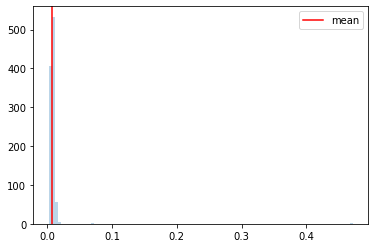

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654433108
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 1.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:06, 14.97it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:31, 10.83it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:47,  9.19it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▉                                                                               | 11/1000 [00:01<01:49,  9.00it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:49,  9.03it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:56,  8.45it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<02:02,  8.05it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<01:58,  8.27it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:54,  8.55it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:57,  8.34it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<02:04,  7.82it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:55,  8.42it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:03<02:04,  7.78it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:18,  6.99it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:16,  7.11it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:05,  7.69it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<01:59,  8.06it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<02:03,  7.81it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<02:12,  7.27it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<02:08,  7.45it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<02:15,  7.07it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<02:05,  7.63it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<02:02,  7.76it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:06<01:55,  8.24it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<01:54,  8.31it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<01:57,  8.08it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<02:00,  7.85it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<01:52,  8.39it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<01:57,  7.99it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<01:55,  8.15it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:07<02:01,  7.71it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:08<02:01,  7.67it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▎                                                                          | 67/1000 [00:08<02:06,  7.38it/s]

Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:26,  6.35it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:10,  7.14it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:07,  7.25it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:08,  7.18it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:03,  7.49it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:04,  7.39it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:03,  7.44it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:00,  7.60it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:04,  7.38it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:04,  7.35it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:01,  7.47it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<01:59,  7.58it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<01:56,  7.79it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:03,  7.33it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:04,  7.25it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:07,  7.07it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:10,  6.90it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:08,  6.96it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:08,  6.98it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:07,  7.02it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:14,  6.64it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:17,  6.45it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:17,  6.44it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:12,  6.70it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:17,  6.43it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:14,  6.53it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:15,  6.49it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:16,  6.43it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:08,  6.80it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:13,  6.56it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:13,  6.53it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:14,  6.47it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:08,  6.72it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:10,  6.65it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:09,  6.68it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:10,  6.59it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:12,  6.49it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:13,  6.40it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:16,  6.26it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:12,  6.44it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:13,  6.39it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:11,  6.44it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<02:16,  6.21it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:14,  6.30it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:25,  5.81it/s]

Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:21<02:23,  5.85it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:22<02:17,  6.10it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:22,  5.89it/s]

Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:21,  5.92it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:23<02:22,  5.84it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:23,  5.80it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:20,  5.91it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:17,  6.04it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:24,  5.71it/s]

Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:27,  5.60it/s]

Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:29,  5.51it/s]

Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:25<02:29,  5.53it/s]

Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:25<02:22,  5.76it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:25,  5.63it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:25,  5.62it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▎                                                                | 181/1000 [00:25<02:30,  5.45it/s]

Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:26<02:30,  5.42it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:39,  5.11it/s]

Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:41,  5.04it/s]

Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:27<02:39,  5.09it/s]

Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:27<02:30,  5.40it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:24,  5.61it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:28<02:23,  5.63it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:28<02:46,  4.85it/s]

Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:28<02:39,  5.06it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:29<02:27,  5.43it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:29<02:23,  5.59it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:29,  5.33it/s]

Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:29,  5.33it/s]

Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:30<02:29,  5.32it/s]

Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:30<02:25,  5.48it/s]

Monte Carlo 203
Monte Carlo 204


 20%|████████████████▏                                                              | 205/1000 [00:30<02:25,  5.46it/s]

Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:30<02:24,  5.48it/s]

Monte Carlo 206
Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:31<02:21,  5.60it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:31<02:22,  5.54it/s]

Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:31<02:21,  5.56it/s]

Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:19,  5.65it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:32<02:24,  5.43it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:32<02:44,  4.75it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:43,  4.78it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:33<02:37,  4.97it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:33<02:29,  5.21it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:33<02:25,  5.36it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:33<02:26,  5.30it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:34<02:21,  5.47it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:34<02:18,  5.60it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:34<02:17,  5.61it/s]

Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:34<02:20,  5.51it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:35<02:20,  5.48it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:35<02:17,  5.60it/s]

Monte Carlo 230
Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:22,  5.38it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:22,  5.36it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:36<02:23,  5.34it/s]

Monte Carlo 234
Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:36<02:10,  5.85it/s]

Monte Carlo 236
Monte Carlo 237


 24%|██████████████████▉                                                            | 239/1000 [00:36<02:11,  5.78it/s]

Monte Carlo 238
Monte Carlo 239


 24%|███████████████████                                                            | 241/1000 [00:37<02:07,  5.96it/s]

Monte Carlo 240
Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:37<02:07,  5.94it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:14,  5.61it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:38<02:08,  5.87it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:38<02:19,  5.37it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:18,  5.40it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▉                                                           | 252/1000 [00:39<02:18,  5.39it/s]

Monte Carlo 251
Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:39<02:15,  5.51it/s]

Monte Carlo 253
Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:15,  5.48it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▎                                                          | 257/1000 [00:40<02:18,  5.35it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 258/1000 [00:40<02:27,  5.02it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:40<02:28,  4.99it/s]

Monte Carlo 259
Monte Carlo 260


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:30,  4.92it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:41<02:33,  4.81it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:31,  4.86it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:29,  4.92it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:41<02:27,  4.97it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:42<02:24,  5.06it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:42<02:16,  5.38it/s]

Monte Carlo 267
Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:42<02:13,  5.48it/s]

Monte Carlo 269
Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:17,  5.31it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:17,  5.29it/s]

Monte Carlo 273
Monte Carlo 274


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:25,  4.97it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:22,  5.07it/s]

Monte Carlo 276
Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:44<02:22,  5.05it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:44<02:22,  5.03it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:21,  5.07it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:24,  4.96it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:45<02:20,  5.09it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:16,  5.20it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:19,  5.08it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:46<02:15,  5.25it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:16,  5.18it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:47<02:14,  5.25it/s]

Monte Carlo 293
Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:11,  5.35it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:16,  5.13it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:48<02:15,  5.18it/s]

Monte Carlo 298
Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:19,  5.00it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:48<02:21,  4.94it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:21,  4.92it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:49<02:20,  4.96it/s]

Monte Carlo 303
Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:49<02:25,  4.78it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:49<02:22,  4.86it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:30,  4.59it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:29,  4.61it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:50<02:26,  4.70it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:51<02:23,  4.80it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:51<02:22,  4.82it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:24,  4.74it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:51<02:25,  4.72it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:51<02:26,  4.68it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:25,  4.68it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:25,  4.68it/s]

Monte Carlo 318
Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:28,  4.58it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:52<02:29,  4.53it/s]

Monte Carlo 321


 32%|█████████████████████████▍                                                     | 322/1000 [00:53<02:31,  4.47it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:27,  4.60it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:26,  4.62it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:53<02:30,  4.50it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:54<02:29,  4.50it/s]

Monte Carlo 326


 33%|█████████████████████████▊                                                     | 327/1000 [00:54<02:29,  4.51it/s]

Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:54<02:24,  4.64it/s]

Monte Carlo 328
Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:54<02:23,  4.66it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:55<02:20,  4.76it/s]

Monte Carlo 331
Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:20,  4.73it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:18,  4.79it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:56<02:17,  4.84it/s]

Monte Carlo 335
Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:18,  4.79it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:56<02:15,  4.89it/s]

Monte Carlo 338
Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:17,  4.81it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:57<02:42,  4.04it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:45,  3.97it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:57<02:41,  4.08it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:58<02:37,  4.17it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:31,  4.33it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:33,  4.25it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:35,  4.21it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:35,  4.20it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:35,  4.18it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:25,  4.45it/s]

Monte Carlo 350
Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [01:00<02:44,  3.94it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:00<02:40,  4.02it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [01:00<02:37,  4.11it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:35,  4.16it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:36,  4.13it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:34,  4.15it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:34,  4.14it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:30,  4.26it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:29,  4.28it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:02<02:28,  4.32it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:24,  4.42it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:21,  4.51it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:19,  4.56it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:17,  4.60it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:15,  4.67it/s]

Monte Carlo 366
Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:22,  4.45it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:23,  4.39it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:23,  4.38it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:20,  4.47it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:23,  4.38it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:23,  4.36it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:25,  4.29it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:25,  4.31it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:21,  4.40it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:20,  4.43it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:17,  4.52it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:20,  4.42it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:19,  4.43it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:28,  4.16it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:26,  4.22it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:22,  4.34it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:23,  4.28it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:28,  4.14it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:28,  4.12it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:23,  4.26it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:22,  4.30it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:21,  4.33it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:22,  4.27it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:08<02:21,  4.30it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:19,  4.36it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:28,  4.08it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:28,  4.09it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:09<02:28,  4.07it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:28,  4.06it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:30,  4.02it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:34,  3.90it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:11<02:32,  3.95it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:11<02:32,  3.93it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:35,  3.85it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:36,  3.83it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:36,  3.82it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:32,  3.90it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:27,  4.03it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:24,  4.11it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:21,  4.19it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:26,  4.05it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:13<02:24,  4.08it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:20,  4.20it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:23,  4.11it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<02:24,  4.07it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:24,  4.06it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:27,  3.98it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:25,  4.02it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:26,  3.98it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:15<02:31,  3.85it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:26,  3.96it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:16<02:25,  4.00it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:16<02:21,  4.09it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:16<02:30,  3.86it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:25,  3.96it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:17<02:28,  3.88it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:22,  4.04it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:17<02:21,  4.08it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:21,  4.07it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:19,  4.12it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:25,  3.92it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:26,  3.89it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:22,  3.99it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:20,  4.06it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:19,  4.08it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:19<02:17,  4.13it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:23,  3.95it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:20<02:22,  3.97it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:18,  4.06it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:20<02:16,  4.12it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:18,  4.05it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:20<02:16,  4.11it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:21<02:18,  4.05it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:21<02:17,  4.07it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:21<02:17,  4.06it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:21<02:17,  4.05it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:22<02:18,  4.01it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:22<02:16,  4.07it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:22<02:22,  3.88it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:22<02:19,  3.97it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:23<02:21,  3.89it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:23<02:22,  3.87it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:23<02:21,  3.87it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:24<02:19,  3.95it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:24<02:24,  3.79it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:24<02:19,  3.92it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:24<02:20,  3.88it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:25<02:18,  3.92it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:25<02:18,  3.94it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:25<02:16,  3.97it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:25<02:17,  3.94it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:17,  3.95it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:26<02:19,  3.86it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:26<02:17,  3.93it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:26<02:18,  3.89it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:27<02:21,  3.79it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:27<02:18,  3.86it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:27<02:15,  3.94it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:27<02:18,  3.87it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:28<02:16,  3.90it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:28<02:15,  3.92it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:28<02:15,  3.92it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:28<02:17,  3.86it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:29<02:14,  3.94it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:29<02:19,  3.78it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:29<02:16,  3.85it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:29<02:16,  3.85it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:30<02:21,  3.71it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:30<02:16,  3.84it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:30<02:16,  3.83it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:30<02:17,  3.80it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:31<02:15,  3.84it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:31<02:14,  3.85it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:31<02:11,  3.93it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:31<02:10,  3.96it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:32<02:07,  4.05it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:32<02:06,  4.08it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:32<02:05,  4.10it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:32<02:04,  4.13it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:33<02:03,  4.16it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:33<02:01,  4.23it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:33<02:02,  4.16it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:33<02:10,  3.90it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:34<02:08,  3.96it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:34<02:08,  3.94it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:34<02:07,  3.98it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:34<02:12,  3.82it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:35<02:07,  3.97it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:35<02:06,  4.00it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:35<02:19,  3.61it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:36<02:13,  3.76it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:36<02:12,  3.79it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:36<02:10,  3.83it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:36<02:10,  3.83it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:37<02:08,  3.86it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:37<02:05,  3.98it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:37<02:06,  3.92it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:37<02:07,  3.89it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:38<02:12,  3.73it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:38<02:11,  3.75it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:38<02:10,  3.78it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:38<02:10,  3.77it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:39<02:15,  3.61it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:39<02:18,  3.52it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:39<02:17,  3.56it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:40<02:15,  3.59it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:40<02:14,  3.62it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:40<02:13,  3.63it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:40<02:15,  3.56it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:41<02:13,  3.62it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:41<02:10,  3.70it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:41<02:13,  3.61it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:41<02:11,  3.65it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:42<02:14,  3.56it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:42<02:15,  3.53it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:42<02:22,  3.35it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:43<02:19,  3.40it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:43<02:21,  3.35it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:43<02:19,  3.41it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:44<02:18,  3.41it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:44<02:21,  3.34it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:44<02:20,  3.36it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:44<02:22,  3.29it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:45<02:17,  3.41it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:45<02:18,  3.39it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:45<02:14,  3.48it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:46<02:14,  3.47it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:46<02:12,  3.52it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:46<02:13,  3.48it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:46<02:14,  3.44it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:47<02:11,  3.50it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:47<02:12,  3.47it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:47<02:20,  3.28it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:48<02:23,  3.21it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:48<02:21,  3.24it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:48<02:17,  3.33it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:49<02:13,  3.41it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:49<02:12,  3.42it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:49<02:10,  3.48it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:49<02:10,  3.48it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:50<02:11,  3.44it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:50<02:10,  3.45it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:50<02:10,  3.46it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:51<02:09,  3.48it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:51<02:12,  3.38it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:51<02:10,  3.41it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:52<02:12,  3.38it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:52<02:16,  3.26it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:52<02:17,  3.24it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:52<02:15,  3.27it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:53<02:14,  3.29it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:53<02:11,  3.34it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:53<02:11,  3.35it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:54<02:09,  3.39it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:54<02:08,  3.41it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:54<02:08,  3.39it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:55<02:11,  3.31it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:55<02:08,  3.37it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:55<02:07,  3.41it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:55<02:07,  3.41it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:56<02:05,  3.44it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:56<02:09,  3.34it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:56<02:15,  3.17it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:57<02:12,  3.24it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:57<02:08,  3.32it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:57<02:10,  3.27it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:58<02:10,  3.27it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:58<02:08,  3.30it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:58<02:10,  3.26it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:58<02:10,  3.25it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:59<02:08,  3.28it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:59<02:15,  3.12it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:59<02:13,  3.15it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:00<02:10,  3.21it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:00<02:10,  3.21it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:00<02:12,  3.15it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:01<02:10,  3.19it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:01<02:10,  3.17it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:01<02:11,  3.16it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:02<02:10,  3.17it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:02<02:08,  3.21it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:02<02:13,  3.07it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:03<02:14,  3.04it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:03<02:11,  3.12it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:03<02:11,  3.10it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:04<02:09,  3.14it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:04<02:06,  3.21it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:04<02:08,  3.16it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:05<02:06,  3.18it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:05<02:07,  3.16it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:05<02:09,  3.11it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:05<02:05,  3.20it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:06<02:04,  3.22it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:06<02:04,  3.21it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:06<02:17,  2.89it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:07<02:19,  2.84it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:07<02:16,  2.89it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:07<02:11,  3.01it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:08<02:08,  3.07it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:08<02:06,  3.12it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:08<02:05,  3.13it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:09<02:02,  3.19it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:09<02:05,  3.12it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:09<02:06,  3.07it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:10<02:06,  3.06it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:10<02:05,  3.08it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:10<02:06,  3.06it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:11<02:06,  3.04it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:11<02:03,  3.10it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:11<02:02,  3.13it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:12<02:01,  3.13it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:12<02:04,  3.07it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:12<02:03,  3.09it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:13<02:00,  3.14it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:13<01:59,  3.16it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:13<01:59,  3.14it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:14<02:00,  3.11it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:14<01:59,  3.14it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:14<01:59,  3.13it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:15<01:58,  3.16it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:15<01:59,  3.11it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:15<02:01,  3.06it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:16<01:58,  3.12it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:16<01:57,  3.13it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:16<01:58,  3.11it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:16<01:57,  3.12it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:17<01:58,  3.09it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:17<01:59,  3.05it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:17<02:00,  3.03it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:18<02:00,  3.01it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:18<02:04,  2.92it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:18<01:58,  3.06it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:19<01:55,  3.12it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:19<01:53,  3.15it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:19<01:52,  3.17it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:20<01:51,  3.21it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:20<01:48,  3.29it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:20<01:47,  3.29it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:21<01:47,  3.31it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:21<01:47,  3.27it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:21<01:52,  3.13it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:22<01:52,  3.11it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:22<01:49,  3.19it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:22<01:50,  3.15it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:22<01:48,  3.20it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:23<01:48,  3.19it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:23<01:47,  3.21it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:23<01:47,  3.20it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:24<01:47,  3.21it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:24<01:46,  3.23it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:24<01:45,  3.23it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:25<01:47,  3.17it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:25<01:44,  3.26it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:25<01:42,  3.29it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:26<01:40,  3.36it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:26<01:42,  3.29it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:26<01:43,  3.26it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:26<01:42,  3.26it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:27<01:43,  3.24it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:27<01:41,  3.27it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:27<01:42,  3.23it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:28<01:43,  3.21it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:28<01:41,  3.24it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:28<01:40,  3.26it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:29<01:39,  3.29it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:29<01:41,  3.21it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:29<01:42,  3.17it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:30<01:40,  3.24it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:30<01:38,  3.28it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:30<01:41,  3.17it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:31<01:40,  3.22it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:31<01:42,  3.14it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:31<01:43,  3.09it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:32<01:42,  3.10it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:32<01:41,  3.13it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:32<01:42,  3.08it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:32<01:42,  3.10it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:33<01:40,  3.14it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:33<01:40,  3.13it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:33<01:40,  3.13it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:34<01:40,  3.11it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:34<01:39,  3.12it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:34<01:37,  3.17it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:35<01:37,  3.16it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:35<01:37,  3.15it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:35<01:36,  3.18it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:36<01:36,  3.18it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:36<01:38,  3.10it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:36<01:36,  3.16it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:37<01:36,  3.13it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:37<01:36,  3.12it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:37<01:37,  3.09it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:38<01:38,  3.06it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:38<01:35,  3.12it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:38<01:36,  3.09it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:39<01:37,  3.04it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:39<01:38,  3.01it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:39<01:39,  2.96it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:40<01:41,  2.90it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:40<01:39,  2.95it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:40<01:38,  2.97it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:41<01:37,  2.99it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:41<01:36,  3.02it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:41<01:49,  2.65it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:42<01:45,  2.74it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:42<01:41,  2.83it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:42<01:39,  2.87it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:43<01:39,  2.86it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:43<01:37,  2.91it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:43<01:38,  2.87it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:44<01:35,  2.96it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:44<01:35,  2.95it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:44<01:32,  3.03it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:45<01:35,  2.91it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:45<01:31,  3.03it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:45<01:31,  3.03it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:46<01:34,  2.93it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:46<01:33,  2.93it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:46<01:30,  3.01it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:47<01:30,  3.01it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:47<01:30,  2.99it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:47<01:32,  2.92it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:48<01:32,  2.92it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:48<01:32,  2.92it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:49<01:33,  2.87it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:49<01:32,  2.89it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:49<01:33,  2.83it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:50<01:35,  2.79it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:50<01:34,  2.81it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:50<01:35,  2.77it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:51<01:35,  2.75it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:51<01:35,  2.73it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:51<01:34,  2.76it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:52<01:32,  2.80it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:52<01:34,  2.74it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:53<01:32,  2.77it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:53<01:33,  2.75it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:53<01:32,  2.76it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:54<01:31,  2.77it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:54<01:30,  2.79it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:54<01:37,  2.59it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:55<01:35,  2.63it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:55<01:38,  2.53it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:56<01:36,  2.58it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:56<01:34,  2.63it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:56<01:36,  2.55it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:57<01:33,  2.62it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:57<01:33,  2.62it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:57<01:34,  2.59it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:58<01:32,  2.63it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:58<01:29,  2.69it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:59<01:29,  2.70it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:59<01:31,  2.62it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:59<01:29,  2.68it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:00<01:27,  2.71it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:00<01:26,  2.73it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:00<01:28,  2.67it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:01<01:27,  2.68it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:01<01:26,  2.70it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:02<01:26,  2.71it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:02<01:26,  2.70it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:02<01:25,  2.71it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:03<01:25,  2.70it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:03<01:25,  2.69it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:03<01:25,  2.66it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:04<01:27,  2.60it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:04<01:25,  2.65it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:05<01:26,  2.59it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:05<01:26,  2.60it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:05<01:26,  2.59it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:06<01:25,  2.60it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:06<01:26,  2.57it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:07<01:28,  2.49it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:07<01:30,  2.42it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:07<01:31,  2.38it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:08<01:33,  2.31it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:08<01:32,  2.34it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:09<01:30,  2.36it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:09<01:29,  2.38it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:10<01:26,  2.47it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:10<01:23,  2.54it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:10<01:22,  2.57it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:11<01:20,  2.60it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:11<01:20,  2.59it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:11<01:18,  2.65it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:12<01:17,  2.66it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:12<01:17,  2.66it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:13<01:18,  2.63it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:13<01:17,  2.64it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:13<01:15,  2.69it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:14<01:15,  2.69it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:14<01:14,  2.71it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:14<01:14,  2.69it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:15<01:15,  2.65it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:15<01:14,  2.65it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:16<01:15,  2.61it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:16<01:15,  2.59it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:16<01:14,  2.61it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:17<01:12,  2.67it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:17<01:13,  2.63it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:17<01:11,  2.68it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:18<01:11,  2.67it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:18<01:12,  2.64it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:19<01:12,  2.60it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:19<01:11,  2.63it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:19<01:10,  2.67it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:20<01:10,  2.65it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:20<01:09,  2.64it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:20<01:10,  2.61it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:21<01:09,  2.63it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:21<01:11,  2.55it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:22<01:11,  2.52it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:22<01:11,  2.52it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:23<01:16,  2.34it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:23<01:13,  2.43it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:23<01:09,  2.53it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:24<01:09,  2.55it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:24<01:07,  2.59it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:24<01:06,  2.62it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:25<01:03,  2.72it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:25<01:04,  2.67it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:26<01:03,  2.71it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:26<01:02,  2.71it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:26<01:01,  2.74it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:27<01:00,  2.76it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:27<01:00,  2.75it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:27<01:00,  2.73it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:28<00:58,  2.80it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:28<00:59,  2.74it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:28<00:59,  2.75it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:29<00:58,  2.75it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:29<00:58,  2.76it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:30<00:59,  2.70it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:30<00:58,  2.73it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:30<00:56,  2.78it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:31<00:55,  2.82it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:31<00:55,  2.79it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:31<00:55,  2.81it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:32<00:54,  2.80it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:32<00:54,  2.80it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:32<00:53,  2.83it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:33<00:53,  2.85it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:33<00:53,  2.83it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:33<00:53,  2.81it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:34<00:53,  2.76it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:34<00:52,  2.80it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:35<00:54,  2.70it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:35<00:52,  2.76it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:35<00:51,  2.77it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:36<00:51,  2.77it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:36<00:51,  2.75it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:36<00:52,  2.67it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:37<00:50,  2.75it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:37<00:50,  2.73it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:37<00:51,  2.70it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:38<00:51,  2.66it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:38<00:51,  2.65it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:39<00:51,  2.64it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:39<00:51,  2.59it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:39<00:51,  2.57it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:40<00:52,  2.52it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:40<00:52,  2.52it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:41<00:51,  2.50it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:41<00:51,  2.49it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:41<00:51,  2.51it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:42<00:51,  2.48it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:42<00:50,  2.49it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:43<00:51,  2.42it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:43<00:52,  2.36it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:44<00:52,  2.35it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:44<00:50,  2.41it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:44<00:49,  2.43it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:45<00:49,  2.43it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:45<00:48,  2.46it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:46<00:47,  2.48it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:46<00:47,  2.46it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:46<00:46,  2.47it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:47<00:47,  2.42it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:47<00:47,  2.40it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:48<00:46,  2.42it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:48<00:45,  2.44it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:48<00:45,  2.44it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:49<00:45,  2.44it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:49<00:44,  2.43it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:50<00:44,  2.41it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:50<00:45,  2.37it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:51<00:44,  2.38it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:51<00:44,  2.38it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:51<00:43,  2.38it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:52<00:43,  2.39it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:52<00:41,  2.44it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:53<00:42,  2.40it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:53<00:42,  2.37it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:53<00:41,  2.41it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:54<00:41,  2.39it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:54<00:41,  2.36it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:55<00:41,  2.33it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:55<00:40,  2.37it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:56<00:40,  2.34it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:56<00:39,  2.38it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:56<00:39,  2.34it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:57<00:38,  2.36it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:57<00:37,  2.37it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:58<00:37,  2.37it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:58<00:37,  2.35it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:59<00:37,  2.34it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:59<00:36,  2.39it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:59<00:35,  2.38it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:00<00:34,  2.41it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:00<00:35,  2.36it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:01<00:33,  2.42it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:01<00:32,  2.47it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:01<00:31,  2.51it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:02<00:31,  2.54it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:02<00:32,  2.41it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:03<00:31,  2.47it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:03<00:30,  2.53it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:03<00:29,  2.52it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:04<00:31,  2.38it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:04<00:30,  2.42it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:05<00:29,  2.40it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:05<00:29,  2.40it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:06<00:29,  2.38it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:06<00:28,  2.39it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:06<00:28,  2.41it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:07<00:27,  2.39it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:07<00:27,  2.37it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:08<00:27,  2.38it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:08<00:26,  2.39it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:08<00:26,  2.39it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:09<00:26,  2.38it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:09<00:26,  2.32it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:10<00:25,  2.33it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:10<00:24,  2.36it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:11<00:24,  2.38it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:11<00:23,  2.38it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:11<00:23,  2.34it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:12<00:23,  2.30it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:12<00:23,  2.26it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:13<00:23,  2.27it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:13<00:22,  2.29it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:14<00:22,  2.31it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:14<00:21,  2.30it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:15<00:21,  2.33it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:15<00:20,  2.34it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:15<00:20,  2.31it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:16<00:19,  2.31it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:16<00:19,  2.31it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:17<00:19,  2.27it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:17<00:18,  2.28it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:18<00:18,  2.32it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:18<00:17,  2.33it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:18<00:16,  2.36it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:19<00:16,  2.38it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:19<00:15,  2.41it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:20<00:15,  2.39it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:20<00:15,  2.37it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:20<00:14,  2.41it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:21<00:13,  2.46it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:21<00:13,  2.49it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:22<00:12,  2.48it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:22<00:12,  2.49it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:22<00:12,  2.46it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:23<00:11,  2.44it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:23<00:11,  2.36it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:24<00:11,  2.38it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:24<00:10,  2.44it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:25<00:10,  2.46it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:25<00:09,  2.44it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:25<00:09,  2.38it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:26<00:09,  2.44it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:26<00:08,  2.47it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:27<00:08,  2.50it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:27<00:07,  2.49it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:27<00:07,  2.45it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:28<00:06,  2.43it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:28<00:06,  2.43it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:29<00:06,  2.39it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:29<00:05,  2.38it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:30<00:05,  2.39it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:30<00:05,  2.35it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:30<00:04,  2.37it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:31<00:04,  2.37it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:31<00:03,  2.37it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:32<00:03,  2.35it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:32<00:02,  2.37it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:32<00:02,  2.36it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:33<00:02,  2.33it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:33<00:01,  2.31it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:34<00:01,  2.28it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:34<00:00,  2.31it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:35<00:00,  2.34it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:35<00:00,  3.63it/s]


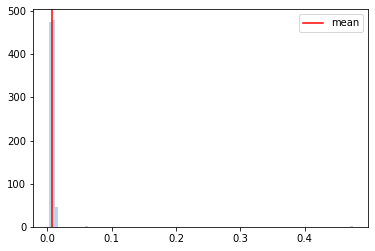

  0%|▏                                                                                | 3/1000 [00:00<01:05, 15.19it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654433384
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 1.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:25, 11.63it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:56,  8.55it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:59,  8.31it/s]

Monte Carlo 9
Monte Carlo 10


  1%|▉                                                                               | 12/1000 [00:01<01:59,  8.24it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:51,  8.86it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:57,  8.35it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:02<01:59,  8.22it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▌                                                                              | 20/1000 [00:02<01:55,  8.47it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:57,  8.35it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▊                                                                              | 23/1000 [00:02<01:54,  8.50it/s]

Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:03<02:23,  6.81it/s]

Monte Carlo 24
Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<02:09,  7.52it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:11,  7.39it/s]

Monte Carlo 28
Monte Carlo 29


  3%|██▍                                                                             | 31/1000 [00:03<02:09,  7.50it/s]

Monte Carlo 30
Monte Carlo 31


  3%|██▋                                                                             | 33/1000 [00:04<02:01,  7.97it/s]

Monte Carlo 32
Monte Carlo 33


  4%|██▊                                                                             | 35/1000 [00:04<02:03,  7.83it/s]

Monte Carlo 34
Monte Carlo 35


  4%|██▉                                                                             | 37/1000 [00:04<02:02,  7.87it/s]

Monte Carlo 36
Monte Carlo 37


  4%|███                                                                             | 39/1000 [00:04<01:56,  8.26it/s]

Monte Carlo 38
Monte Carlo 39


  4%|███▎                                                                            | 41/1000 [00:04<01:53,  8.46it/s]

Monte Carlo 40
Monte Carlo 41


  4%|███▍                                                                            | 43/1000 [00:05<02:06,  7.59it/s]

Monte Carlo 42
Monte Carlo 43


  4%|███▌                                                                            | 45/1000 [00:05<02:04,  7.69it/s]

Monte Carlo 44
Monte Carlo 45


  5%|███▊                                                                            | 47/1000 [00:05<01:56,  8.15it/s]

Monte Carlo 46
Monte Carlo 47


  5%|███▉                                                                            | 49/1000 [00:06<01:57,  8.11it/s]

Monte Carlo 48
Monte Carlo 49


  5%|████                                                                            | 51/1000 [00:06<02:01,  7.79it/s]

Monte Carlo 50
Monte Carlo 51


  5%|████▏                                                                           | 53/1000 [00:06<02:04,  7.60it/s]

Monte Carlo 52
Monte Carlo 53


  6%|████▍                                                                           | 55/1000 [00:06<02:01,  7.76it/s]

Monte Carlo 54
Monte Carlo 55


  6%|████▌                                                                           | 57/1000 [00:07<02:02,  7.68it/s]

Monte Carlo 56
Monte Carlo 57


  6%|████▋                                                                           | 59/1000 [00:07<02:04,  7.57it/s]

Monte Carlo 58
Monte Carlo 59


  6%|████▉                                                                           | 61/1000 [00:07<02:07,  7.39it/s]

Monte Carlo 60
Monte Carlo 61


  6%|█████                                                                           | 63/1000 [00:07<02:10,  7.20it/s]

Monte Carlo 62
Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:08<02:00,  7.73it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:01,  7.70it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:06,  7.37it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:11,  7.06it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:09<02:04,  7.43it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:00,  7.65it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:03,  7.50it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:10<02:03,  7.48it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:05,  7.31it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:08,  7.14it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:09,  7.07it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:05,  7.28it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:08,  7.10it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:04,  7.31it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:12<02:04,  7.31it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:11,  6.88it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:10,  6.91it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:11,  6.86it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:08,  7.02it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:08,  7.00it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:06,  7.10it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:14<02:07,  7.02it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:05,  7.13it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:13,  6.66it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:08,  6.91it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:06,  7.01it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:12,  6.67it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:19,  6.32it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:12,  6.61it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:09,  6.76it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:12,  6.60it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:08,  6.81it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:14,  6.49it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:16,  6.35it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:12,  6.56it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:13,  6.47it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:14,  6.40it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:12,  6.51it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:12,  6.48it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:15,  6.34it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:23,  5.95it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:14,  6.33it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:19,  6.10it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:23,  5.90it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:21<02:42,  5.20it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:28,  5.68it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:22<02:24,  5.85it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:22<02:18,  6.09it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:22<02:14,  6.22it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:18,  6.04it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:23<02:13,  6.26it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:16,  6.10it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:23,  5.77it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:25,  5.71it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:30,  5.50it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:25<02:26,  5.62it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:25<02:25,  5.65it/s]

Monte Carlo 176
Monte Carlo 177


 18%|██████████████▏                                                                | 179/1000 [00:25<02:27,  5.57it/s]

Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:25,  5.63it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:26<02:19,  5.88it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:18,  5.88it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:27<02:20,  5.80it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:27<02:16,  5.96it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:19,  5.79it/s]

Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:26,  5.54it/s]

Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:28<02:26,  5.51it/s]

Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:28<02:21,  5.69it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:28<02:17,  5.86it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▌                                                               | 197/1000 [00:28<02:17,  5.86it/s]

Monte Carlo 196
Monte Carlo 197


 20%|███████████████▋                                                               | 199/1000 [00:29<02:17,  5.82it/s]

Monte Carlo 198
Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:29<02:23,  5.57it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:29<02:22,  5.57it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████                                                               | 204/1000 [00:30<02:25,  5.46it/s]

Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:24,  5.49it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:30,  5.25it/s]

Monte Carlo 207


 21%|████████████████▌                                                              | 209/1000 [00:31<02:25,  5.45it/s]

Monte Carlo 208
Monte Carlo 209


 21%|████████████████▌                                                              | 210/1000 [00:31<02:24,  5.47it/s]

Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:31<02:25,  5.40it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:32<02:29,  5.26it/s]

Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:32<02:28,  5.28it/s]

Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:32<02:31,  5.18it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:32<02:29,  5.24it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:27,  5.29it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:33<02:28,  5.24it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:33<02:25,  5.35it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:33<02:23,  5.44it/s]

Monte Carlo 220
Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:33<02:18,  5.61it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:34<02:20,  5.53it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:34<02:21,  5.46it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:34<02:19,  5.54it/s]

Monte Carlo 226
Monte Carlo 227


 23%|██████████████████                                                             | 229/1000 [00:34<02:24,  5.35it/s]

Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:35<02:27,  5.22it/s]

Monte Carlo 229


 23%|██████████████████▏                                                            | 231/1000 [00:35<02:24,  5.33it/s]

Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:35<02:23,  5.33it/s]

Monte Carlo 231


 23%|██████████████████▍                                                            | 233/1000 [00:35<02:26,  5.23it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:35<02:24,  5.29it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:35<02:23,  5.33it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:36<02:27,  5.16it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:36<02:24,  5.27it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:36<02:22,  5.33it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:18,  5.51it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:37<02:21,  5.35it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:37<02:24,  5.22it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:37<02:20,  5.37it/s]

Monte Carlo 243
Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:38<02:23,  5.26it/s]

Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:38<02:23,  5.25it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:38<02:19,  5.40it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:38<02:24,  5.18it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:23,  5.22it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:39<02:25,  5.14it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:39<02:23,  5.21it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:39<02:23,  5.19it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:39<02:22,  5.21it/s]

Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:40<02:23,  5.17it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:40<02:30,  4.92it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:28,  4.97it/s]

Monte Carlo 260


 26%|████████████████████▋                                                          | 262/1000 [00:41<02:29,  4.95it/s]

Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:41<02:24,  5.09it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:41<02:21,  5.20it/s]

Monte Carlo 263
Monte Carlo 264


 26%|████████████████████▉                                                          | 265/1000 [00:41<02:23,  5.11it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:42<02:30,  4.88it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▏                                                         | 268/1000 [00:42<02:30,  4.86it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 269/1000 [00:42<02:32,  4.80it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:43<02:28,  4.92it/s]

Monte Carlo 270
Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:43<02:26,  4.97it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:43<02:25,  4.99it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:43<02:21,  5.11it/s]

Monte Carlo 274
Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:44<02:25,  4.95it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:44<02:24,  4.99it/s]

Monte Carlo 277
Monte Carlo 278


 28%|██████████████████████                                                         | 279/1000 [00:44<02:27,  4.88it/s]

Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:45<02:30,  4.77it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:45<02:27,  4.88it/s]

Monte Carlo 281
Monte Carlo 282


 28%|██████████████████████▎                                                        | 283/1000 [00:45<02:31,  4.74it/s]

Monte Carlo 283


 28%|██████████████████████▌                                                        | 285/1000 [00:45<02:32,  4.69it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:46<02:29,  4.77it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:46<02:25,  4.90it/s]

Monte Carlo 286
Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:46<02:26,  4.85it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:46<02:31,  4.68it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:47<02:30,  4.70it/s]

Monte Carlo 290
Monte Carlo 291


 29%|███████████████████████                                                        | 292/1000 [00:47<02:56,  4.02it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 293/1000 [00:47<02:57,  3.98it/s]

Monte Carlo 293


 29%|███████████████████████▏                                                       | 294/1000 [00:48<02:52,  4.09it/s]

Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:48<02:44,  4.27it/s]

Monte Carlo 295
Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:48<02:39,  4.41it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:49<02:37,  4.45it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:49<02:38,  4.41it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:49<02:35,  4.49it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:49<02:28,  4.70it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:50<02:26,  4.75it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:50<02:19,  4.98it/s]

Monte Carlo 304
Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:50<02:17,  5.02it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▎                                                      | 308/1000 [00:50<02:21,  4.88it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:51<02:18,  4.98it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:51<02:16,  5.04it/s]

Monte Carlo 310
Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:52<02:28,  4.63it/s]

Monte Carlo 312
Monte Carlo 313


 32%|████████████████████████▉                                                      | 315/1000 [00:52<02:24,  4.73it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:52<02:21,  4.82it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:52<02:19,  4.89it/s]

Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:53<02:24,  4.71it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:53<02:22,  4.77it/s]

Monte Carlo 319
Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:53<02:23,  4.74it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:54<02:24,  4.70it/s]

Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:54<02:23,  4.73it/s]

Monte Carlo 323
Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:54<02:25,  4.65it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:55<02:21,  4.75it/s]

Monte Carlo 326
Monte Carlo 327


 33%|█████████████████████████▉                                                     | 329/1000 [00:55<02:14,  5.00it/s]

Monte Carlo 328


 33%|██████████████████████████                                                     | 330/1000 [00:55<02:12,  5.07it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:55<02:12,  5.06it/s]

Monte Carlo 330
Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:56<02:18,  4.83it/s]

Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:56<02:29,  4.46it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:56<02:22,  4.67it/s]

Monte Carlo 334
Monte Carlo 335


 34%|██████████████████████████▌                                                    | 337/1000 [00:57<02:17,  4.83it/s]

Monte Carlo 336
Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:57<02:19,  4.75it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:57<02:15,  4.86it/s]

Monte Carlo 339
Monte Carlo 340


 34%|███████████████████████████                                                    | 342/1000 [00:58<02:17,  4.80it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 343/1000 [00:58<02:12,  4.95it/s]

Monte Carlo 342
Monte Carlo 343


 34%|███████████████████████████▎                                                   | 345/1000 [00:58<02:17,  4.75it/s]

Monte Carlo 344
Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:59<02:19,  4.68it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 348/1000 [00:59<02:18,  4.70it/s]

Monte Carlo 347
Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:59<02:23,  4.55it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 351/1000 [01:00<02:18,  4.67it/s]

Monte Carlo 350


 35%|███████████████████████████▊                                                   | 352/1000 [01:00<02:17,  4.73it/s]

Monte Carlo 351
Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [01:00<02:18,  4.68it/s]

Monte Carlo 353


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:18,  4.66it/s]

Monte Carlo 354
Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:01<02:18,  4.64it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:01<02:22,  4.50it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:01<02:23,  4.49it/s]

Monte Carlo 358


 36%|████████████████████████████▍                                                  | 360/1000 [01:02<02:21,  4.52it/s]

Monte Carlo 359
Monte Carlo 360


 36%|████████████████████████████▌                                                  | 362/1000 [01:02<02:19,  4.58it/s]

Monte Carlo 361


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:15,  4.69it/s]

Monte Carlo 362
Monte Carlo 363


 36%|████████████████████████████▊                                                  | 365/1000 [01:03<02:18,  4.60it/s]

Monte Carlo 364
Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:03<02:23,  4.42it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:25,  4.35it/s]

Monte Carlo 367


 37%|█████████████████████████████                                                  | 368/1000 [01:03<02:23,  4.40it/s]

Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 369/1000 [01:04<02:25,  4.35it/s]

Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:04<02:26,  4.31it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:04<02:27,  4.26it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:31,  4.14it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:05<02:26,  4.27it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:05<02:25,  4.29it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:05<02:24,  4.33it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:22,  4.38it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:06<02:28,  4.20it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:06<02:28,  4.19it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:06<02:24,  4.30it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:21,  4.38it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:20,  4.41it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:07<02:20,  4.40it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:07<02:22,  4.34it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:07<02:22,  4.31it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:21,  4.33it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:08<02:26,  4.18it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:08<02:33,  3.98it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:08<02:33,  3.98it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:32,  4.00it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:09<02:31,  4.04it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:09<02:30,  4.04it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:09<02:34,  3.95it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:31,  4.01it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:10<02:27,  4.11it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:10<02:28,  4.09it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:10<02:25,  4.16it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:22,  4.22it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:11<02:26,  4.12it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:11<02:32,  3.93it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:11<02:30,  3.99it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:32,  3.93it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:12<02:31,  3.94it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:12<02:29,  4.00it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:12<02:26,  4.06it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:12<02:25,  4.08it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:13<02:27,  4.04it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:13<02:28,  3.99it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:13<02:28,  3.97it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:13<02:31,  3.90it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:14<02:32,  3.88it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:14<02:35,  3.80it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:14<02:37,  3.73it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:34,  3.80it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:15<02:34,  3.80it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:15<02:34,  3.78it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:15<02:38,  3.69it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:16<02:39,  3.67it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:16<02:37,  3.69it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:16<02:34,  3.77it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:16<02:30,  3.85it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:17<02:34,  3.75it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:17<02:31,  3.80it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:17<02:27,  3.91it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:17<02:25,  3.95it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:18<02:24,  3.97it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:18<02:32,  3.76it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:18<02:33,  3.73it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:18<02:31,  3.78it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:19<02:27,  3.87it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:19<02:27,  3.86it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:19<02:26,  3.87it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:19<02:27,  3.85it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:20<02:24,  3.93it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:20<02:22,  3.96it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:20<02:23,  3.95it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:20<02:22,  3.97it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:21<02:20,  4.00it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:21<02:24,  3.89it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:21<02:27,  3.79it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:22<02:34,  3.63it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:22<02:31,  3.69it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:22<02:28,  3.76it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:22<02:27,  3.77it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:23<02:29,  3.73it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:23<02:28,  3.73it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:23<02:29,  3.71it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:23<02:48,  3.28it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:24<02:44,  3.36it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:24<02:37,  3.51it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:24<02:33,  3.58it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:25<02:30,  3.64it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:25<02:21,  3.86it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:25<02:20,  3.90it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:25<02:14,  4.05it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:26<02:16,  3.99it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:26<02:15,  4.01it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:26<02:12,  4.09it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:26<02:10,  4.16it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:26<02:09,  4.19it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:27<02:13,  4.06it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:27<02:12,  4.06it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:27<02:12,  4.05it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:27<02:15,  3.96it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:28<02:14,  3.99it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:28<02:14,  3.99it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:28<02:15,  3.95it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:28<02:12,  4.02it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:29<02:15,  3.93it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:29<02:15,  3.92it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:29<02:14,  3.95it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:30<02:15,  3.91it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:30<02:17,  3.84it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:30<02:14,  3.93it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:30<02:14,  3.91it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:31<02:14,  3.89it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:31<02:16,  3.83it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:31<02:20,  3.71it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:31<02:22,  3.67it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:32<02:24,  3.61it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:32<02:21,  3.66it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:32<02:24,  3.60it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:32<02:21,  3.67it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:33<02:21,  3.66it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:33<02:19,  3.71it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:33<02:19,  3.68it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:34<02:19,  3.69it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:34<02:16,  3.75it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:34<02:14,  3.79it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:34<02:14,  3.79it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:35<02:15,  3.78it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:35<02:16,  3.74it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:35<02:18,  3.67it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:35<02:19,  3.63it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:36<02:20,  3.61it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:36<02:22,  3.53it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:36<02:24,  3.49it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:37<02:24,  3.47it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:37<02:21,  3.54it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:37<02:18,  3.61it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:37<02:20,  3.56it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:38<02:22,  3.50it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:38<02:22,  3.49it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:38<02:19,  3.56it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:39<02:23,  3.46it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:39<02:20,  3.52it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:39<02:20,  3.51it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:39<02:21,  3.49it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:40<02:19,  3.52it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:40<02:19,  3.52it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:40<02:20,  3.50it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:41<02:25,  3.35it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:41<02:25,  3.35it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:41<02:22,  3.43it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:41<02:23,  3.39it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:42<02:21,  3.42it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:42<02:20,  3.44it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:42<02:25,  3.31it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:43<02:23,  3.36it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:43<02:26,  3.29it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:43<02:25,  3.29it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:44<02:27,  3.25it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:44<02:23,  3.34it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:44<02:21,  3.37it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:45<02:23,  3.32it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:45<02:20,  3.38it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:45<02:25,  3.26it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:45<02:25,  3.26it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:46<02:23,  3.29it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:46<02:25,  3.25it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:46<02:22,  3.30it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:47<02:20,  3.34it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:47<02:18,  3.37it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:47<02:19,  3.35it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:48<02:17,  3.38it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:48<02:16,  3.40it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:48<02:16,  3.41it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:48<02:15,  3.42it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:49<02:10,  3.54it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:49<02:09,  3.57it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:49<02:10,  3.52it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:49<02:08,  3.57it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:50<02:06,  3.62it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:50<02:05,  3.65it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:50<02:04,  3.65it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:51<02:05,  3.64it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:51<02:06,  3.60it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:51<02:05,  3.60it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:51<02:03,  3.66it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:52<02:04,  3.63it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:52<02:04,  3.63it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:52<02:03,  3.62it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:53<02:03,  3.62it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:53<02:02,  3.64it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:53<02:05,  3.55it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:53<02:10,  3.42it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:54<02:05,  3.55it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:54<02:03,  3.58it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:54<02:00,  3.65it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:55<02:08,  3.43it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:55<02:05,  3.50it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:55<02:09,  3.40it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:55<02:08,  3.41it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:56<02:06,  3.46it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:56<02:09,  3.37it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:56<02:14,  3.24it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:57<02:16,  3.18it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:57<02:19,  3.11it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:57<02:17,  3.14it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:58<02:15,  3.19it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:58<02:12,  3.24it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:58<02:27,  2.91it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:59<02:15,  3.15it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:59<02:14,  3.18it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:59<02:08,  3.31it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:59<02:05,  3.40it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [02:00<02:05,  3.39it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [02:00<02:03,  3.44it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [02:00<02:06,  3.34it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [02:01<02:07,  3.31it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [02:01<02:06,  3.31it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [02:01<02:07,  3.29it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [02:02<02:06,  3.30it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:02<02:03,  3.38it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:02<02:04,  3.34it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:02<02:02,  3.40it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:03<02:01,  3.40it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:03<01:58,  3.48it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:03<01:56,  3.53it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:04<01:58,  3.48it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:04<01:59,  3.42it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:04<02:02,  3.34it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:04<02:02,  3.32it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:05<02:03,  3.28it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:05<02:06,  3.21it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:05<02:07,  3.16it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:06<02:08,  3.15it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:06<02:09,  3.10it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:06<02:08,  3.12it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:07<02:07,  3.14it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:07<02:10,  3.07it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:07<02:10,  3.05it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:08<02:11,  3.02it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:08<02:12,  2.99it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:08<02:11,  3.01it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:09<02:11,  3.01it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:09<02:10,  3.03it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:09<02:11,  2.99it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:10<02:12,  2.95it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:10<02:13,  2.92it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:10<02:11,  2.98it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:11<02:08,  3.03it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:11<02:06,  3.06it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:11<02:08,  3.02it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:12<02:06,  3.06it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:12<02:04,  3.10it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:12<02:06,  3.03it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:13<02:05,  3.05it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:13<02:03,  3.09it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:13<02:06,  3.00it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:14<02:08,  2.96it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:14<02:06,  2.99it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:14<02:07,  2.97it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:15<02:06,  2.99it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:15<02:07,  2.94it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:15<02:06,  2.96it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:16<02:07,  2.93it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:16<02:05,  2.97it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:16<02:06,  2.94it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:17<02:03,  3.01it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:17<02:04,  2.98it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:17<02:05,  2.93it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:18<02:07,  2.89it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:18<02:06,  2.89it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:19<02:09,  2.83it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:19<02:06,  2.88it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:19<02:06,  2.88it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:20<02:05,  2.90it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:20<02:06,  2.87it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:20<02:04,  2.91it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:21<02:05,  2.87it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:21<02:05,  2.86it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:21<02:03,  2.89it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:22<02:01,  2.94it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:22<02:01,  2.92it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:22<02:05,  2.84it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:23<02:05,  2.82it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:23<02:03,  2.87it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:23<02:01,  2.90it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:24<02:00,  2.91it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:24<02:02,  2.85it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:24<02:01,  2.87it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:25<01:59,  2.91it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:25<02:00,  2.87it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:25<01:59,  2.90it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:26<01:57,  2.94it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:26<01:58,  2.91it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:26<01:57,  2.92it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:27<01:59,  2.87it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:27<02:00,  2.84it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:28<01:58,  2.87it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:28<01:56,  2.92it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:28<01:53,  2.98it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:29<01:55,  2.91it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:29<01:55,  2.92it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:29<01:56,  2.87it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:30<01:56,  2.87it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:30<01:55,  2.88it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:30<01:55,  2.87it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:31<01:55,  2.88it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:31<01:54,  2.87it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:31<01:56,  2.82it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:32<01:54,  2.87it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:32<01:54,  2.87it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:32<01:53,  2.86it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:33<01:53,  2.85it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:33<01:55,  2.80it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:33<01:53,  2.85it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:34<01:53,  2.83it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:34<01:52,  2.86it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:35<02:04,  2.58it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:35<02:01,  2.62it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:35<01:56,  2.74it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:36<01:56,  2.72it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:36<01:53,  2.79it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:36<01:52,  2.80it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:37<01:51,  2.82it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:37<01:48,  2.90it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:37<01:47,  2.90it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:38<01:45,  2.96it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:38<01:45,  2.94it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:38<01:46,  2.89it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:39<01:44,  2.94it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:39<01:45,  2.91it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:39<01:44,  2.93it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:40<01:43,  2.95it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:40<01:41,  3.00it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:40<01:42,  2.96it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:41<01:40,  3.01it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:41<01:39,  3.03it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:41<01:41,  2.94it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:42<01:38,  3.03it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:42<01:40,  2.96it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:42<01:43,  2.86it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:43<01:41,  2.91it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:43<01:40,  2.94it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:44<01:40,  2.91it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:44<01:40,  2.91it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:44<01:39,  2.95it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:45<01:38,  2.96it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:45<01:37,  2.97it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:45<01:36,  3.01it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:45<01:34,  3.04it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:46<01:33,  3.07it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:46<01:32,  3.08it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:46<01:34,  3.02it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:47<01:34,  3.00it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:47<01:34,  2.99it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:47<01:33,  3.03it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:48<01:33,  3.02it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:48<01:31,  3.07it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:48<01:32,  3.01it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:49<01:31,  3.05it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:49<01:30,  3.06it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:49<01:31,  3.02it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:50<01:30,  3.05it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:50<01:30,  3.03it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:50<01:30,  3.00it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:51<01:32,  2.94it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:51<01:32,  2.92it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:52<01:34,  2.87it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:52<01:33,  2.89it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:52<01:32,  2.90it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:53<01:32,  2.89it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:53<01:32,  2.89it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:53<01:38,  2.69it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:54<01:40,  2.64it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:54<01:38,  2.68it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:54<01:36,  2.73it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:55<01:33,  2.78it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:55<01:36,  2.68it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:56<01:36,  2.67it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:56<01:34,  2.72it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:56<01:34,  2.71it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:57<01:34,  2.71it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:57<01:36,  2.64it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:57<01:34,  2.69it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:58<01:34,  2.69it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:58<01:34,  2.66it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:59<01:34,  2.65it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:59<01:33,  2.67it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:59<01:35,  2.62it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [03:00<01:33,  2.65it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [03:00<01:32,  2.67it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [03:00<01:30,  2.72it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [03:01<01:30,  2.71it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [03:01<01:30,  2.69it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [03:02<01:31,  2.65it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [03:02<01:30,  2.67it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [03:02<01:32,  2.60it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [03:03<01:32,  2.59it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:03<01:31,  2.60it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:03<01:31,  2.59it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:04<01:30,  2.60it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:04<01:31,  2.59it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:05<01:30,  2.59it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:05<01:29,  2.62it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:05<01:29,  2.61it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:06<01:37,  2.39it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:06<01:34,  2.45it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:07<01:32,  2.47it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:07<01:31,  2.51it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:07<01:28,  2.58it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:08<01:26,  2.62it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:08<01:26,  2.62it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:09<01:25,  2.63it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:09<01:24,  2.65it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:09<01:24,  2.65it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:10<01:24,  2.61it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:10<01:23,  2.65it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:10<01:22,  2.66it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:11<01:22,  2.64it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:11<01:24,  2.58it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:12<01:25,  2.54it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:12<01:25,  2.53it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:12<01:22,  2.59it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:13<01:22,  2.58it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:13<01:22,  2.59it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:14<01:22,  2.56it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:14<01:21,  2.58it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:14<01:23,  2.52it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:15<01:24,  2.48it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:15<01:24,  2.47it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:16<01:21,  2.53it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:16<01:20,  2.55it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:16<01:19,  2.57it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:17<01:19,  2.58it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:17<01:19,  2.55it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:17<01:17,  2.59it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:18<01:20,  2.50it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:18<01:20,  2.50it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:19<01:24,  2.34it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:19<01:22,  2.41it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:20<01:20,  2.43it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:20<01:19,  2.47it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:20<01:18,  2.48it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:21<01:17,  2.50it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:21<01:16,  2.53it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:22<01:15,  2.54it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:22<01:14,  2.56it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:22<01:12,  2.61it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:23<01:11,  2.66it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:23<01:09,  2.70it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:23<01:10,  2.67it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:24<01:09,  2.66it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:24<01:08,  2.72it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:24<01:07,  2.72it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:25<01:09,  2.64it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:25<01:08,  2.67it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:26<01:08,  2.64it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:26<01:09,  2.57it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:26<01:10,  2.56it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:27<01:09,  2.54it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:27<01:09,  2.56it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:28<01:07,  2.60it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:28<01:08,  2.57it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:28<01:09,  2.52it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:29<01:09,  2.49it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:29<01:08,  2.51it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:30<01:07,  2.53it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:30<01:10,  2.42it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:30<01:08,  2.46it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:31<01:09,  2.40it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:31<01:06,  2.51it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:32<01:05,  2.55it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:32<01:03,  2.60it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:32<01:02,  2.63it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:33<01:02,  2.62it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:33<01:01,  2.65it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:34<01:01,  2.63it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:34<01:00,  2.64it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:34<01:02,  2.55it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:35<01:02,  2.53it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:35<01:02,  2.53it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:35<01:00,  2.56it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:36<01:00,  2.54it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:36<01:00,  2.52it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:37<00:59,  2.55it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:37<00:59,  2.54it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:37<01:00,  2.49it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:38<00:59,  2.50it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:38<00:59,  2.49it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:39<01:00,  2.45it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:39<00:59,  2.47it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:40<00:59,  2.47it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:40<01:00,  2.41it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:40<00:59,  2.41it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:41<00:59,  2.42it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:41<00:59,  2.39it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:42<00:58,  2.40it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:42<00:58,  2.41it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:42<00:57,  2.43it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:43<00:58,  2.36it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:43<00:56,  2.42it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:44<00:54,  2.48it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:44<00:53,  2.53it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:44<00:52,  2.53it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:45<00:57,  2.33it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:45<00:55,  2.38it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:46<00:55,  2.38it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:46<00:56,  2.32it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:47<00:56,  2.26it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:47<00:56,  2.26it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:48<00:55,  2.31it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:48<00:53,  2.38it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:48<00:52,  2.40it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:49<00:51,  2.42it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:49<00:51,  2.39it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:50<00:51,  2.35it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:50<00:50,  2.40it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:50<00:50,  2.39it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:51<00:49,  2.39it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:51<00:49,  2.38it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:52<00:49,  2.36it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:52<00:50,  2.28it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:53<00:49,  2.32it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:53<00:49,  2.28it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:53<00:49,  2.30it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:54<00:48,  2.33it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:54<00:48,  2.29it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:55<00:47,  2.32it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:55<00:46,  2.36it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:56<00:46,  2.33it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:56<00:45,  2.34it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:56<00:45,  2.33it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:57<00:45,  2.31it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:57<00:44,  2.33it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:58<00:44,  2.33it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:58<00:43,  2.36it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:59<00:43,  2.35it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:59<00:42,  2.38it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:59<00:43,  2.30it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [04:00<00:42,  2.30it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [04:00<00:42,  2.27it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [04:01<00:43,  2.22it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [04:01<00:41,  2.27it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [04:02<00:41,  2.29it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [04:02<00:40,  2.31it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [04:03<00:39,  2.33it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [04:03<00:38,  2.35it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [04:03<00:39,  2.28it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [04:04<00:38,  2.29it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [04:04<00:38,  2.30it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [04:05<00:38,  2.26it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [04:05<00:37,  2.30it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:06<00:37,  2.27it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:06<00:36,  2.29it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:06<00:36,  2.29it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:07<00:35,  2.32it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:07<00:34,  2.32it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:08<00:34,  2.29it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:08<00:34,  2.27it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:09<00:34,  2.25it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:09<00:34,  2.25it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:10<00:33,  2.25it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:10<00:33,  2.27it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:10<00:32,  2.27it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:11<00:32,  2.28it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:11<00:31,  2.28it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:12<00:31,  2.27it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:12<00:30,  2.27it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:13<00:29,  2.31it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:13<00:29,  2.27it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:13<00:28,  2.33it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:14<00:27,  2.38it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:14<00:27,  2.40it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:15<00:26,  2.39it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:15<00:26,  2.39it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:16<00:25,  2.41it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:16<00:25,  2.43it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:16<00:25,  2.36it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:17<00:25,  2.34it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:17<00:24,  2.34it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:18<00:24,  2.31it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:18<00:24,  2.31it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:19<00:23,  2.33it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:19<00:23,  2.31it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:19<00:23,  2.24it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:20<00:22,  2.27it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:20<00:22,  2.24it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:21<00:22,  2.25it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:21<00:21,  2.23it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:22<00:21,  2.26it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:22<00:20,  2.26it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:23<00:19,  2.31it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:23<00:21,  2.11it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:24<00:19,  2.21it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:24<00:18,  2.29it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:24<00:18,  2.30it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:25<00:17,  2.35it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:25<00:17,  2.34it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:26<00:16,  2.33it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:26<00:16,  2.37it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:26<00:15,  2.33it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:27<00:15,  2.29it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:27<00:15,  2.29it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:28<00:14,  2.30it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:28<00:14,  2.29it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:29<00:14,  2.28it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:29<00:13,  2.24it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:30<00:13,  2.23it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:30<00:12,  2.24it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:30<00:12,  2.21it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:31<00:12,  2.20it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:31<00:11,  2.20it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:32<00:11,  2.21it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:32<00:10,  2.19it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:33<00:10,  2.20it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:33<00:10,  2.19it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:34<00:09,  2.17it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:34<00:09,  2.17it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:35<00:08,  2.25it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:35<00:07,  2.29it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:35<00:07,  2.24it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:36<00:07,  2.26it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:36<00:06,  2.28it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:37<00:06,  2.29it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:37<00:05,  2.30it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:38<00:05,  2.22it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:38<00:04,  2.22it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:39<00:04,  2.13it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:39<00:04,  2.16it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:40<00:03,  2.22it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:40<00:03,  2.24it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:40<00:02,  2.27it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:41<00:02,  2.28it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:41<00:01,  2.24it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:42<00:01,  2.26it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:42<00:00,  2.30it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:43<00:00,  2.31it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:43<00:00,  3.53it/s]


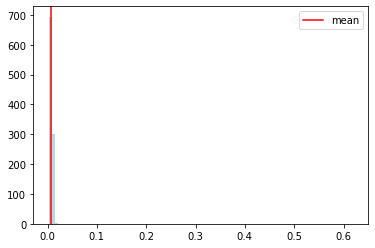

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654433668
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 10.0, 'jump_size_b': 0.1}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▍                                                                                | 5/1000 [00:00<01:21, 12.16it/s]

Monte Carlo 3
Monte Carlo 4
Monte Carlo 5
Monte Carlo 6


  1%|▌                                                                                | 7/1000 [00:00<01:47,  9.27it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▊                                                                               | 10/1000 [00:01<01:47,  9.21it/s]

Monte Carlo 9
Monte Carlo 10


  1%|█                                                                               | 13/1000 [00:01<01:42,  9.67it/s]

Monte Carlo 11
Monte Carlo 12


  1%|█                                                                               | 14/1000 [00:01<01:44,  9.40it/s]

Monte Carlo 13
Monte Carlo 14


  2%|█▎                                                                              | 16/1000 [00:01<01:47,  9.19it/s]

Monte Carlo 15
Monte Carlo 16


  2%|█▍                                                                              | 18/1000 [00:01<01:44,  9.36it/s]

Monte Carlo 17
Monte Carlo 18


  2%|█▋                                                                              | 21/1000 [00:02<01:39,  9.86it/s]

Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:41,  9.68it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:40,  9.68it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:43,  9.38it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:02<01:46,  9.14it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<01:45,  9.18it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<02:02,  7.87it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<02:06,  7.64it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:03<01:59,  8.03it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:58,  8.12it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:56,  8.22it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<02:00,  7.92it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:04<01:57,  8.10it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<01:55,  8.24it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:53,  8.37it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:05<02:01,  7.83it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:05<01:59,  7.95it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<02:00,  7.84it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<02:02,  7.72it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:06<02:03,  7.62it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:06<02:02,  7.70it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<01:59,  7.84it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:07<01:56,  8.03it/s]

Monte Carlo 63
Monte Carlo 64


  6%|█████▏                                                                          | 65/1000 [00:07<02:03,  7.59it/s]

Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:08<02:28,  6.27it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:12,  7.01it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:05,  7.40it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<02:20,  6.61it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:14,  6.89it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:07,  7.24it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:07,  7.20it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:09<02:02,  7.51it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:06,  7.25it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<01:59,  7.68it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:10<01:59,  7.64it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:09,  7.03it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:08,  7.06it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:05,  7.25it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:11<02:05,  7.22it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:03,  7.30it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:08,  7.01it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:12<02:06,  7.10it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:07,  7.05it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:09,  6.93it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:05,  7.14it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:13<02:10,  6.85it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:09,  6.85it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:11,  6.74it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:14<02:13,  6.64it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:11,  6.72it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:09,  6.80it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:15<02:14,  6.53it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:15,  6.46it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:15,  6.47it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:16<02:09,  6.73it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:16<02:15,  6.44it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:19,  6.23it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:20,  6.16it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:17<02:13,  6.49it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:11,  6.56it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:06,  6.79it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:18<02:10,  6.57it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:10,  6.56it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:17,  6.23it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:19<02:12,  6.44it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:15,  6.28it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:08,  6.59it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:09,  6.56it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:20<02:08,  6.57it/s]

Monte Carlo 154
Monte Carlo 155


 16%|████████████▍                                                                  | 157/1000 [00:21<02:09,  6.50it/s]

Monte Carlo 156
Monte Carlo 157


 16%|████████████▌                                                                  | 159/1000 [00:21<02:12,  6.35it/s]

Monte Carlo 158
Monte Carlo 159


 16%|████████████▋                                                                  | 161/1000 [00:21<02:16,  6.17it/s]

Monte Carlo 160
Monte Carlo 161


 16%|████████████▉                                                                  | 163/1000 [00:22<02:20,  5.97it/s]

Monte Carlo 162
Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:15,  6.17it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:22<02:15,  6.15it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:27,  5.65it/s]

Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:23<02:23,  5.79it/s]

Monte Carlo 169
Monte Carlo 170


 17%|█████████████▌                                                                 | 172/1000 [00:23<02:18,  5.98it/s]

Monte Carlo 171
Monte Carlo 172


 17%|█████████████▋                                                                 | 174/1000 [00:24<02:10,  6.32it/s]

Monte Carlo 173
Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:24<02:05,  6.57it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:24<02:06,  6.48it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:07,  6.42it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:25<02:12,  6.16it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:25<02:09,  6.31it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:25<02:06,  6.44it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:26<02:08,  6.31it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:26<02:03,  6.57it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:27<02:29,  5.39it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:27<02:18,  5.82it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:27<02:15,  5.95it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:15,  5.91it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:25,  5.48it/s]

Monte Carlo 199


 20%|███████████████▉                                                               | 201/1000 [00:28<02:24,  5.53it/s]

Monte Carlo 200
Monte Carlo 201


 20%|████████████████                                                               | 203/1000 [00:28<02:12,  6.00it/s]

Monte Carlo 202
Monte Carlo 203


 20%|████████████████▏                                                              | 205/1000 [00:29<02:14,  5.89it/s]

Monte Carlo 204
Monte Carlo 205


 21%|████████████████▎                                                              | 207/1000 [00:29<02:20,  5.66it/s]

Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:29<02:21,  5.61it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:21,  5.58it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:30<02:18,  5.67it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:30<02:22,  5.52it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:22,  5.49it/s]

Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:26,  5.34it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:31<02:19,  5.60it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:31<02:18,  5.65it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:26,  5.33it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:32<02:21,  5.48it/s]

Monte Carlo 222
Monte Carlo 223


 22%|█████████████████▊                                                             | 225/1000 [00:32<02:20,  5.51it/s]

Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:17,  5.61it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:14,  5.72it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:33<02:19,  5.52it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▏                                                            | 231/1000 [00:34<02:35,  4.95it/s]

Monte Carlo 231


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:45,  4.64it/s]

Monte Carlo 232


 23%|██████████████████▍                                                            | 233/1000 [00:34<02:46,  4.62it/s]

Monte Carlo 233


 24%|██████████████████▌                                                            | 235/1000 [00:34<02:46,  4.60it/s]

Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:41,  4.73it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:41,  4.73it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 239/1000 [00:35<02:43,  4.66it/s]

Monte Carlo 239


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:44,  4.61it/s]

Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:41,  4.68it/s]

Monte Carlo 241
Monte Carlo 242


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:42,  4.66it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:37<02:34,  4.89it/s]

Monte Carlo 244


 25%|███████████████████▍                                                           | 246/1000 [00:37<02:27,  5.10it/s]

Monte Carlo 245
Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:22,  5.29it/s]

Monte Carlo 247
Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:37<02:21,  5.30it/s]

Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:18,  5.41it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:38<02:14,  5.54it/s]

Monte Carlo 252
Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:38<02:23,  5.20it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:25,  5.11it/s]

Monte Carlo 256


 26%|████████████████████▍                                                          | 258/1000 [00:39<02:24,  5.14it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:20,  5.27it/s]

Monte Carlo 258
Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:40<02:19,  5.31it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:18,  5.32it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:21,  5.19it/s]

Monte Carlo 263
Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:41<02:23,  5.10it/s]

Monte Carlo 265
Monte Carlo 266


 27%|█████████████████████                                                          | 267/1000 [00:41<02:28,  4.93it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:27,  4.96it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:41<02:23,  5.08it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:42<02:25,  5.00it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:24,  5.05it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:42<02:18,  5.25it/s]

Monte Carlo 272
Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:42<02:24,  5.02it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:43<02:20,  5.15it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:18,  5.21it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:16,  5.29it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:43<02:14,  5.37it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:43<02:17,  5.21it/s]

Monte Carlo 280


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:15,  5.32it/s]

Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:13,  5.39it/s]

Monte Carlo 282
Monte Carlo 283


 28%|██████████████████████▍                                                        | 284/1000 [00:44<02:13,  5.37it/s]

Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:44<02:20,  5.09it/s]

Monte Carlo 285


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:17,  5.19it/s]

Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:15,  5.24it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:17,  5.16it/s]

Monte Carlo 288
Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:45<02:19,  5.08it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:46<02:20,  5.04it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:20,  5.03it/s]

Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:46<02:19,  5.06it/s]

Monte Carlo 293
Monte Carlo 294


 30%|███████████████████████▎                                                       | 295/1000 [00:46<02:23,  4.90it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:46<02:30,  4.66it/s]

Monte Carlo 296


 30%|███████████████████████▍                                                       | 297/1000 [00:47<02:41,  4.36it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 298/1000 [00:47<02:38,  4.43it/s]

Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:47<02:34,  4.54it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:47<02:31,  4.63it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:48<02:27,  4.74it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:48<02:25,  4.79it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:48<02:22,  4.90it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 305/1000 [00:48<02:22,  4.89it/s]

Monte Carlo 304


 31%|████████████████████████▏                                                      | 306/1000 [00:49<02:17,  5.04it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:49<02:13,  5.18it/s]

Monte Carlo 306
Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:49<02:14,  5.15it/s]

Monte Carlo 308
Monte Carlo 309


 31%|████████████████████████▍                                                      | 310/1000 [00:49<02:18,  5.00it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:50<02:25,  4.73it/s]

Monte Carlo 311
Monte Carlo 312


 31%|████████████████████████▋                                                      | 313/1000 [00:50<02:28,  4.62it/s]

Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:50<02:35,  4.41it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:50<02:33,  4.46it/s]

Monte Carlo 315


 32%|████████████████████████▉                                                      | 316/1000 [00:51<02:29,  4.59it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:51<02:25,  4.67it/s]

Monte Carlo 317


 32%|█████████████████████████▏                                                     | 319/1000 [00:51<02:23,  4.76it/s]

Monte Carlo 318
Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:25,  4.69it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:52<02:36,  4.33it/s]

Monte Carlo 321
Monte Carlo 322


 32%|█████████████████████████▌                                                     | 323/1000 [00:52<02:35,  4.36it/s]

Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:32,  4.43it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:53<02:29,  4.53it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 326/1000 [00:53<02:25,  4.63it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:53<02:23,  4.67it/s]

Monte Carlo 327
Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:54<02:25,  4.61it/s]

Monte Carlo 329


 33%|██████████████████████████                                                     | 330/1000 [00:54<02:23,  4.66it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 331/1000 [00:54<02:21,  4.71it/s]

Monte Carlo 331


 33%|██████████████████████████▏                                                    | 332/1000 [00:54<02:20,  4.75it/s]

Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:55<02:19,  4.77it/s]

Monte Carlo 333
Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:55<02:24,  4.60it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:55<02:25,  4.57it/s]

Monte Carlo 336


 34%|██████████████████████████▋                                                    | 338/1000 [00:55<02:22,  4.66it/s]

Monte Carlo 337
Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:56<02:27,  4.48it/s]

Monte Carlo 339


 34%|██████████████████████████▉                                                    | 341/1000 [00:56<02:23,  4.58it/s]

Monte Carlo 340
Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:56<02:26,  4.50it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:57<02:25,  4.51it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:57<02:23,  4.56it/s]

Monte Carlo 344


 35%|███████████████████████████▎                                                   | 346/1000 [00:57<02:20,  4.64it/s]

Monte Carlo 345
Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:57<02:21,  4.60it/s]

Monte Carlo 347


 35%|███████████████████████████▍                                                   | 348/1000 [00:58<02:26,  4.46it/s]

Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:58<02:25,  4.47it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 351/1000 [00:58<02:20,  4.62it/s]

Monte Carlo 350
Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:21,  4.59it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:59<02:25,  4.45it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:59<02:21,  4.58it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 356/1000 [00:59<02:17,  4.69it/s]

Monte Carlo 355
Monte Carlo 356


 36%|████████████████████████████▎                                                  | 358/1000 [01:00<02:16,  4.71it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 359/1000 [01:00<02:15,  4.73it/s]

Monte Carlo 358
Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:00<02:16,  4.68it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:15,  4.71it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:01<02:18,  4.60it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:01<02:20,  4.53it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:01<02:23,  4.42it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:01<02:20,  4.51it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:02<02:19,  4.54it/s]

Monte Carlo 366


 37%|█████████████████████████████                                                  | 368/1000 [01:02<02:18,  4.58it/s]

Monte Carlo 367


 37%|█████████████████████████████▏                                                 | 369/1000 [01:02<02:15,  4.67it/s]

Monte Carlo 368
Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:02<02:14,  4.68it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:03<02:12,  4.73it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 373/1000 [01:03<02:14,  4.67it/s]

Monte Carlo 372
Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:03<02:14,  4.67it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:04<02:13,  4.69it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:04<02:16,  4.59it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:04<02:13,  4.66it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:04<02:17,  4.51it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:04<02:15,  4.60it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:05<02:15,  4.57it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:05<02:15,  4.58it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:05<02:16,  4.52it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:05<02:19,  4.44it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:06<02:19,  4.42it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:06<02:16,  4.52it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:06<02:14,  4.58it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:06<02:20,  4.36it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:07<02:34,  3.97it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:07<02:36,  3.90it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:07<02:31,  4.03it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:07<02:29,  4.06it/s]

Monte Carlo 391


 39%|███████████████████████████████                                                | 393/1000 [01:08<02:23,  4.24it/s]

Monte Carlo 392
Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:08<02:24,  4.19it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:08<02:20,  4.30it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 397/1000 [01:09<02:13,  4.52it/s]

Monte Carlo 396


 40%|███████████████████████████████▍                                               | 398/1000 [01:09<02:10,  4.62it/s]

Monte Carlo 397
Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:09<02:10,  4.62it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:09<02:12,  4.53it/s]

Monte Carlo 400


 40%|███████████████████████████████▊                                               | 402/1000 [01:10<02:08,  4.65it/s]

Monte Carlo 401
Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:10<02:08,  4.64it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 405/1000 [01:10<02:06,  4.72it/s]

Monte Carlo 404
Monte Carlo 405


 41%|████████████████████████████████▏                                              | 407/1000 [01:11<02:10,  4.55it/s]

Monte Carlo 406
Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:11<02:11,  4.49it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:11<02:20,  4.22it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:12<02:30,  3.93it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:12<02:31,  3.90it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:12<02:22,  4.13it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:12<02:18,  4.23it/s]

Monte Carlo 413


 42%|████████████████████████████████▊                                              | 415/1000 [01:13<02:13,  4.38it/s]

Monte Carlo 414
Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:13<02:11,  4.45it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:13<02:11,  4.45it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:13<02:10,  4.47it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:14<02:07,  4.57it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:14<02:05,  4.62it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 422/1000 [01:14<02:01,  4.77it/s]

Monte Carlo 421
Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:14<02:05,  4.60it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:15<02:03,  4.65it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:15<02:02,  4.70it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 427/1000 [01:15<02:02,  4.66it/s]

Monte Carlo 426


 43%|█████████████████████████████████▊                                             | 428/1000 [01:16<02:01,  4.73it/s]

Monte Carlo 427
Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 430/1000 [01:16<02:00,  4.74it/s]

Monte Carlo 429
Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:16<02:04,  4.57it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:16<02:03,  4.61it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:17<02:05,  4.52it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:17<02:05,  4.51it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:17<02:09,  4.38it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:17<02:10,  4.33it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:18<02:08,  4.37it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:18<02:06,  4.45it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:18<02:07,  4.39it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:18<02:08,  4.36it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:18<02:06,  4.42it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:19<02:08,  4.34it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:19<02:08,  4.33it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:19<02:12,  4.20it/s]

Monte Carlo 444


 45%|███████████████████████████████████▏                                           | 446/1000 [01:20<02:05,  4.42it/s]

Monte Carlo 445
Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:20<02:10,  4.24it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:20<02:09,  4.27it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:20<02:07,  4.32it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:21<02:04,  4.42it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:21<02:02,  4.47it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:21<02:04,  4.39it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:21<02:04,  4.38it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:21<02:06,  4.33it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:22<02:08,  4.23it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:22<02:08,  4.22it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:22<02:07,  4.26it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:22<02:06,  4.28it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:23<02:25,  3.73it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:23<02:21,  3.82it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:23<02:16,  3.96it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:23<02:11,  4.09it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:24<02:09,  4.14it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:24<02:08,  4.17it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:24<02:08,  4.16it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:24<02:07,  4.19it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:25<02:05,  4.26it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:25<02:04,  4.29it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:25<02:03,  4.32it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:25<01:59,  4.43it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:26<02:00,  4.39it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:26<02:00,  4.39it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:26<02:02,  4.30it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:26<02:07,  4.13it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:26<02:04,  4.21it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:27<02:08,  4.07it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:27<02:10,  4.00it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:27<02:10,  4.00it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:28<02:11,  3.95it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:28<02:09,  4.01it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:28<02:09,  4.02it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:28<02:07,  4.06it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:29<02:06,  4.09it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:29<02:03,  4.18it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:29<02:04,  4.14it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:29<02:09,  3.96it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:29<02:06,  4.06it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:30<02:06,  4.05it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:30<02:04,  4.10it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:30<02:06,  4.04it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:30<02:07,  4.00it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:31<02:08,  3.96it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:31<02:08,  3.96it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:31<02:11,  3.84it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:32<02:10,  3.87it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:32<02:10,  3.87it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:32<02:09,  3.88it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:32<02:08,  3.90it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:33<02:13,  3.76it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:33<02:12,  3.78it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:33<02:12,  3.76it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:33<02:12,  3.76it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:34<02:13,  3.73it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:34<02:12,  3.76it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:34<02:08,  3.85it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:34<02:10,  3.79it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:35<02:13,  3.69it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:35<02:11,  3.73it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:35<02:13,  3.69it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:36<02:14,  3.65it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:36<02:15,  3.61it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:36<02:14,  3.62it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:36<02:14,  3.61it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:37<02:13,  3.64it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:37<02:14,  3.60it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:37<02:11,  3.69it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:37<02:08,  3.76it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:38<02:07,  3.78it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:38<02:05,  3.84it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:38<02:04,  3.87it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:38<02:04,  3.84it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:39<02:06,  3.78it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:39<02:03,  3.86it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:39<02:06,  3.77it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:40<02:08,  3.70it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:40<02:05,  3.78it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:40<02:05,  3.76it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:40<02:06,  3.74it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:41<02:05,  3.75it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:41<02:07,  3.68it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:41<02:07,  3.67it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:41<02:06,  3.70it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:42<02:11,  3.55it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:42<02:08,  3.63it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:42<02:09,  3.60it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:43<02:11,  3.54it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:43<02:10,  3.54it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:43<02:10,  3.55it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:43<02:07,  3.62it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:44<02:09,  3.56it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:44<02:07,  3.61it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:44<02:07,  3.60it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:45<02:10,  3.50it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:45<02:05,  3.62it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:45<02:06,  3.60it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:45<02:05,  3.63it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:46<02:03,  3.67it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:46<02:04,  3.64it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:46<02:02,  3.69it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:46<02:01,  3.71it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:47<02:06,  3.56it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:47<02:05,  3.58it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:47<02:06,  3.52it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:48<02:12,  3.36it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:48<02:09,  3.43it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:48<02:09,  3.42it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:48<02:05,  3.54it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:49<02:03,  3.58it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:49<02:02,  3.60it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:49<02:07,  3.45it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:50<02:07,  3.44it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:50<02:05,  3.48it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:50<02:03,  3.54it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:50<02:01,  3.58it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:51<02:02,  3.55it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:51<02:16,  3.18it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:51<02:10,  3.31it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:52<02:10,  3.32it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:52<02:09,  3.34it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:52<02:05,  3.42it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:53<02:09,  3.32it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:53<02:06,  3.37it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:53<02:04,  3.42it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:53<02:00,  3.52it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:54<02:02,  3.46it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:54<01:59,  3.54it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:54<02:00,  3.50it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:55<01:59,  3.54it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:55<02:00,  3.48it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:55<01:57,  3.56it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:55<02:01,  3.44it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:56<02:00,  3.47it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:56<01:59,  3.48it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:56<01:59,  3.48it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:57<02:00,  3.44it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [01:57<02:00,  3.43it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [01:57<02:00,  3.44it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [01:57<01:59,  3.45it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [01:58<02:00,  3.41it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [01:58<01:59,  3.44it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [01:58<02:00,  3.38it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [01:59<01:59,  3.41it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [01:59<02:02,  3.32it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [01:59<02:08,  3.17it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:00<02:05,  3.23it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:00<02:05,  3.21it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:00<02:00,  3.33it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:01<02:02,  3.29it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:01<01:58,  3.39it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:01<01:57,  3.41it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:01<01:54,  3.49it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:02<01:53,  3.52it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:02<01:53,  3.49it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:02<01:54,  3.46it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:02<01:53,  3.47it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:03<01:56,  3.38it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:03<01:56,  3.37it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:03<02:05,  3.12it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:04<02:01,  3.22it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:04<01:57,  3.32it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:04<01:53,  3.42it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:05<01:54,  3.39it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:05<01:53,  3.42it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:05<01:53,  3.40it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:06<01:53,  3.40it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:06<01:53,  3.37it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:06<01:50,  3.46it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:06<01:51,  3.43it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:07<01:49,  3.48it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:07<01:52,  3.37it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:07<01:52,  3.37it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:08<01:51,  3.39it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:08<01:53,  3.33it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:08<01:56,  3.24it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:08<01:50,  3.40it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:09<01:46,  3.50it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:09<01:43,  3.60it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:09<01:44,  3.58it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:10<01:41,  3.66it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:10<01:41,  3.66it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:10<01:41,  3.64it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:10<01:44,  3.51it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:11<01:43,  3.55it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:11<01:46,  3.43it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:11<01:45,  3.44it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:12<01:44,  3.48it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:12<01:45,  3.45it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:12<01:49,  3.32it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:12<01:47,  3.36it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:13<01:46,  3.38it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:13<01:48,  3.30it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:13<01:49,  3.28it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:14<01:48,  3.30it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:14<01:46,  3.33it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:14<01:48,  3.26it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:15<01:50,  3.19it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:15<01:51,  3.15it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:15<01:50,  3.17it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:16<01:49,  3.20it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:16<01:48,  3.22it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:16<01:50,  3.17it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:17<01:49,  3.19it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:17<01:47,  3.24it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:17<01:47,  3.21it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:17<01:46,  3.23it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:18<01:46,  3.24it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:18<01:47,  3.19it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:18<01:49,  3.14it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:19<01:50,  3.10it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:19<01:49,  3.10it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:19<01:47,  3.15it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:20<01:45,  3.20it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:20<01:46,  3.17it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:20<01:45,  3.19it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:21<01:46,  3.15it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:21<01:46,  3.13it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:21<01:48,  3.08it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:22<01:46,  3.11it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:22<01:46,  3.10it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:22<01:47,  3.06it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:23<01:46,  3.08it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:23<01:44,  3.14it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:23<01:56,  2.80it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:24<01:51,  2.92it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:24<01:48,  2.99it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:24<01:46,  3.03it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:25<01:46,  3.03it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:25<01:45,  3.05it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:25<01:47,  2.97it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:26<01:46,  3.02it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:26<01:45,  3.03it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:26<01:49,  2.91it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:27<01:45,  3.00it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:27<01:45,  3.00it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:27<01:43,  3.03it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:28<01:42,  3.06it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:28<01:41,  3.09it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:28<01:40,  3.12it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:29<01:39,  3.12it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:29<01:39,  3.10it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:29<01:40,  3.07it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:30<01:40,  3.07it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:30<01:41,  3.02it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:30<01:40,  3.03it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:31<01:39,  3.05it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:31<01:40,  3.02it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:31<01:41,  2.97it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:32<01:40,  3.01it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:32<01:41,  2.97it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:32<01:39,  3.02it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:32<01:36,  3.11it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:33<01:33,  3.20it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:33<01:33,  3.18it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:33<01:33,  3.17it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:34<01:37,  3.03it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:34<01:34,  3.13it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:34<01:32,  3.18it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:35<01:30,  3.22it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:35<01:30,  3.22it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:35<01:30,  3.22it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:36<01:27,  3.29it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:36<01:27,  3.29it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:36<01:29,  3.20it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:37<01:29,  3.18it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:37<01:31,  3.12it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:37<01:30,  3.13it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:37<01:27,  3.25it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:38<01:26,  3.26it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:38<01:27,  3.21it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:38<01:26,  3.25it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:39<01:28,  3.14it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:39<01:28,  3.13it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:39<01:27,  3.15it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:40<01:27,  3.15it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:40<01:27,  3.14it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:40<01:28,  3.09it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:41<01:28,  3.08it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:41<01:28,  3.08it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:41<01:27,  3.11it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:42<01:27,  3.10it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:42<01:26,  3.12it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:42<01:26,  3.10it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:43<01:26,  3.10it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:43<01:24,  3.15it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:43<01:24,  3.13it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:44<01:24,  3.13it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:44<01:23,  3.15it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:44<01:25,  3.05it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:45<01:24,  3.10it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:45<01:21,  3.20it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:45<01:20,  3.22it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:45<01:20,  3.22it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:46<01:19,  3.22it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:46<01:21,  3.15it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:46<01:23,  3.06it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:47<01:22,  3.08it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:47<01:22,  3.07it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:47<01:22,  3.05it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:48<01:23,  3.01it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:48<01:22,  3.03it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:48<01:22,  3.01it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:49<01:24,  2.95it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:49<01:24,  2.92it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:49<01:25,  2.88it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:50<01:23,  2.93it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:50<01:23,  2.91it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:51<01:32,  2.64it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:51<01:30,  2.67it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:51<01:30,  2.65it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:52<01:28,  2.71it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:52<01:26,  2.76it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:52<01:24,  2.83it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:53<01:23,  2.83it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:53<01:23,  2.83it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:53<01:23,  2.80it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:54<01:22,  2.84it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [02:54<01:23,  2.81it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [02:55<01:21,  2.85it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [02:55<01:21,  2.85it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [02:55<01:21,  2.83it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [02:56<01:20,  2.84it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [02:56<01:20,  2.82it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [02:56<01:19,  2.87it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [02:57<01:19,  2.83it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [02:57<01:19,  2.85it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [02:57<01:20,  2.80it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [02:58<01:20,  2.76it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [02:58<01:20,  2.77it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [02:58<01:23,  2.65it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [02:59<01:23,  2.63it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [02:59<01:19,  2.74it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:00<01:19,  2.75it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:00<01:18,  2.76it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:00<01:18,  2.75it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:01<01:16,  2.81it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:01<01:16,  2.80it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:01<01:15,  2.81it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:02<01:15,  2.82it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:02<01:17,  2.72it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:02<01:17,  2.72it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:03<01:16,  2.75it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:03<01:16,  2.73it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:04<01:15,  2.74it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:04<01:14,  2.76it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:04<01:14,  2.74it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:05<01:14,  2.73it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:05<01:13,  2.77it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:05<01:12,  2.78it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:06<01:12,  2.78it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:06<01:13,  2.71it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:06<01:12,  2.76it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:07<01:10,  2.80it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:07<01:10,  2.81it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:07<01:09,  2.83it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:08<01:08,  2.84it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:08<01:09,  2.79it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:09<01:08,  2.80it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:09<01:08,  2.81it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:09<01:08,  2.80it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:10<01:08,  2.76it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:10<01:07,  2.80it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:10<01:07,  2.78it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:11<01:07,  2.78it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:11<01:06,  2.79it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:11<01:07,  2.73it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:12<01:07,  2.74it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:12<01:06,  2.77it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:13<01:04,  2.80it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:13<01:05,  2.75it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:13<01:05,  2.74it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:14<01:05,  2.75it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:14<01:07,  2.62it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:14<01:05,  2.71it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:15<01:04,  2.72it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:15<01:04,  2.71it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:16<01:04,  2.70it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:16<01:04,  2.67it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:16<01:03,  2.71it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:17<01:02,  2.71it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:17<01:01,  2.75it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:17<01:02,  2.72it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:18<01:03,  2.66it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:18<01:01,  2.72it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:18<01:00,  2.74it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:19<01:01,  2.68it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:19<01:02,  2.62it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:20<01:01,  2.65it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:20<01:00,  2.66it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:20<01:00,  2.64it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:21<00:57,  2.76it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:21<00:56,  2.82it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:21<00:55,  2.83it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:22<00:54,  2.86it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:22<00:53,  2.92it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:22<00:53,  2.87it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:23<00:53,  2.87it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:23<00:52,  2.91it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:23<00:51,  2.94it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:24<00:51,  2.91it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:24<00:52,  2.88it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:24<00:51,  2.89it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:25<00:51,  2.89it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:25<00:56,  2.61it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:26<00:55,  2.64it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:26<00:52,  2.74it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:26<00:52,  2.72it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:27<00:53,  2.68it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:27<00:52,  2.70it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:27<00:50,  2.77it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:28<00:50,  2.78it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:28<00:48,  2.86it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:28<00:47,  2.90it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:29<00:47,  2.86it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:29<00:47,  2.85it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:30<00:47,  2.87it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:30<00:48,  2.78it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:30<00:48,  2.75it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:31<00:48,  2.73it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:31<00:47,  2.75it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:31<00:46,  2.77it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:32<00:47,  2.73it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:32<00:46,  2.73it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:32<00:45,  2.79it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:33<00:44,  2.83it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:33<00:45,  2.77it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:34<00:45,  2.71it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:34<00:44,  2.74it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:34<00:43,  2.78it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:35<00:43,  2.80it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:35<00:43,  2.77it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:35<00:43,  2.76it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:36<00:43,  2.69it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:36<00:42,  2.72it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:36<00:42,  2.71it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:37<00:43,  2.67it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:37<00:42,  2.67it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:38<00:43,  2.60it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:38<00:42,  2.61it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:38<00:42,  2.59it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:39<00:42,  2.60it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:39<00:42,  2.58it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:40<00:41,  2.60it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:40<00:42,  2.53it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:40<00:41,  2.54it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:41<00:41,  2.56it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:41<00:40,  2.56it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:42<00:40,  2.55it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:42<00:40,  2.55it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:42<00:39,  2.57it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:43<00:38,  2.57it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:43<00:41,  2.41it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:44<00:39,  2.46it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:44<00:40,  2.38it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:44<00:38,  2.46it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:45<00:37,  2.51it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:45<00:37,  2.50it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:46<00:36,  2.57it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:46<00:36,  2.54it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:46<00:35,  2.54it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:47<00:35,  2.57it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:47<00:34,  2.57it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:48<00:34,  2.55it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:48<00:34,  2.54it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:48<00:34,  2.51it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:49<00:33,  2.52it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:49<00:33,  2.54it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:49<00:32,  2.55it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:50<00:33,  2.47it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:50<00:32,  2.48it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:51<00:32,  2.47it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:51<00:32,  2.47it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:52<00:31,  2.49it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [03:52<00:30,  2.52it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [03:52<00:30,  2.52it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [03:53<00:29,  2.53it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [03:53<00:30,  2.46it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [03:54<00:29,  2.50it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [03:54<00:29,  2.42it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [03:54<00:29,  2.44it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [03:55<00:27,  2.51it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [03:55<00:27,  2.54it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [03:56<00:27,  2.49it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [03:56<00:26,  2.51it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [03:56<00:26,  2.48it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [03:57<00:26,  2.48it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [03:57<00:26,  2.45it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [03:58<00:26,  2.39it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [03:58<00:26,  2.31it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [03:59<00:26,  2.31it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [03:59<00:25,  2.34it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [03:59<00:25,  2.34it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:00<00:24,  2.38it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:00<00:23,  2.40it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:01<00:23,  2.41it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:01<00:22,  2.40it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:01<00:23,  2.34it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:02<00:22,  2.37it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:02<00:22,  2.35it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:03<00:21,  2.37it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:03<00:20,  2.40it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:04<00:20,  2.41it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:04<00:20,  2.40it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:04<00:19,  2.38it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:05<00:19,  2.39it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:05<00:19,  2.36it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:06<00:18,  2.41it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:06<00:17,  2.43it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:06<00:17,  2.41it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:07<00:18,  2.21it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:07<00:17,  2.32it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:08<00:16,  2.33it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:08<00:16,  2.36it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:09<00:15,  2.35it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:09<00:15,  2.40it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:09<00:14,  2.41it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:10<00:14,  2.38it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:10<00:13,  2.41it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:11<00:13,  2.39it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:11<00:12,  2.40it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:12<00:12,  2.41it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:12<00:11,  2.43it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:12<00:11,  2.37it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:13<00:11,  2.37it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:13<00:10,  2.40it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:14<00:10,  2.38it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:14<00:09,  2.43it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:14<00:09,  2.42it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:15<00:08,  2.46it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:15<00:08,  2.39it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:16<00:08,  2.37it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:16<00:07,  2.41it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:17<00:07,  2.39it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:17<00:07,  2.40it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:17<00:06,  2.34it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:18<00:06,  2.35it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:18<00:05,  2.42it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:19<00:05,  2.41it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:19<00:04,  2.44it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:19<00:04,  2.50it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:20<00:03,  2.53it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:20<00:03,  2.57it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:21<00:03,  2.58it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:21<00:02,  2.55it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:21<00:02,  2.55it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:22<00:01,  2.52it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:22<00:01,  2.46it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:23<00:01,  2.44it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:23<00:00,  2.43it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:23<00:00,  2.47it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:24<00:00,  3.78it/s]


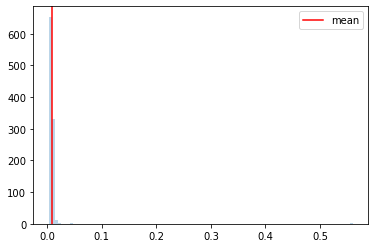

  0%|▏                                                                                | 2/1000 [00:00<00:53, 18.74it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654433933
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 10.0, 'jump_size_b': 1.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2
Monte Carlo 3


  1%|▍                                                                                | 6/1000 [00:00<01:25, 11.65it/s]

Monte Carlo 4
Monte Carlo 5
Monte Carlo 6
Monte Carlo 7


  1%|▊                                                                               | 10/1000 [00:00<01:44,  9.51it/s]

Monte Carlo 8
Monte Carlo 9
Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<01:44,  9.44it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<01:45,  9.32it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▍                                                                              | 18/1000 [00:01<01:43,  9.52it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:01<01:42,  9.52it/s]

Monte Carlo 18
Monte Carlo 19
Monte Carlo 20


  2%|█▊                                                                              | 22/1000 [00:02<01:41,  9.65it/s]

Monte Carlo 21
Monte Carlo 22


  2%|█▉                                                                              | 24/1000 [00:02<01:46,  9.17it/s]

Monte Carlo 23
Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:02<01:45,  9.25it/s]

Monte Carlo 25
Monte Carlo 26


  3%|██▏                                                                             | 28/1000 [00:02<01:48,  8.93it/s]

Monte Carlo 27
Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<01:48,  8.93it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:03<01:45,  9.14it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:03<01:58,  8.17it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:03<01:55,  8.32it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<01:58,  8.10it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:04<01:51,  8.61it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:04<01:58,  8.10it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:04<01:54,  8.37it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:05<01:54,  8.35it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:05<01:57,  8.08it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:05<01:51,  8.52it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:05<01:57,  8.08it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:06<01:58,  8.01it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:06<02:04,  7.59it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:06<02:06,  7.46it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:06<02:06,  7.46it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:07<02:02,  7.67it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:07<02:42,  5.77it/s]

Monte Carlo 63


  6%|█████▏                                                                          | 65/1000 [00:07<02:35,  6.01it/s]

Monte Carlo 64
Monte Carlo 65


  7%|█████▎                                                                          | 67/1000 [00:07<02:18,  6.72it/s]

Monte Carlo 66
Monte Carlo 67


  7%|█████▌                                                                          | 69/1000 [00:08<02:12,  7.04it/s]

Monte Carlo 68
Monte Carlo 69


  7%|█████▋                                                                          | 71/1000 [00:08<02:08,  7.20it/s]

Monte Carlo 70
Monte Carlo 71


  7%|█████▊                                                                          | 73/1000 [00:08<02:40,  5.76it/s]

Monte Carlo 72
Monte Carlo 73


  8%|██████                                                                          | 75/1000 [00:09<02:34,  6.00it/s]

Monte Carlo 74
Monte Carlo 75


  8%|██████▏                                                                         | 77/1000 [00:09<02:30,  6.13it/s]

Monte Carlo 76
Monte Carlo 77


  8%|██████▎                                                                         | 79/1000 [00:09<02:15,  6.78it/s]

Monte Carlo 78
Monte Carlo 79


  8%|██████▍                                                                         | 81/1000 [00:10<02:15,  6.78it/s]

Monte Carlo 80
Monte Carlo 81


  8%|██████▋                                                                         | 83/1000 [00:10<02:21,  6.49it/s]

Monte Carlo 82
Monte Carlo 83


  8%|██████▊                                                                         | 85/1000 [00:10<02:13,  6.84it/s]

Monte Carlo 84
Monte Carlo 85


  9%|██████▉                                                                         | 87/1000 [00:11<02:10,  6.97it/s]

Monte Carlo 86
Monte Carlo 87


  9%|███████                                                                         | 89/1000 [00:11<02:13,  6.81it/s]

Monte Carlo 88
Monte Carlo 89


  9%|███████▎                                                                        | 91/1000 [00:11<02:12,  6.86it/s]

Monte Carlo 90
Monte Carlo 91


  9%|███████▍                                                                        | 93/1000 [00:11<02:07,  7.10it/s]

Monte Carlo 92
Monte Carlo 93


 10%|███████▌                                                                        | 95/1000 [00:12<02:03,  7.32it/s]

Monte Carlo 94
Monte Carlo 95


 10%|███████▊                                                                        | 97/1000 [00:12<02:18,  6.50it/s]

Monte Carlo 96
Monte Carlo 97


 10%|███████▉                                                                        | 99/1000 [00:12<02:13,  6.75it/s]

Monte Carlo 98
Monte Carlo 99


 10%|███████▉                                                                       | 101/1000 [00:13<02:12,  6.81it/s]

Monte Carlo 100
Monte Carlo 101


 10%|████████▏                                                                      | 103/1000 [00:13<02:07,  7.02it/s]

Monte Carlo 102
Monte Carlo 103


 10%|████████▎                                                                      | 105/1000 [00:13<02:12,  6.77it/s]

Monte Carlo 104
Monte Carlo 105


 11%|████████▍                                                                      | 107/1000 [00:13<02:12,  6.75it/s]

Monte Carlo 106
Monte Carlo 107


 11%|████████▌                                                                      | 109/1000 [00:14<02:09,  6.88it/s]

Monte Carlo 108
Monte Carlo 109


 11%|████████▊                                                                      | 111/1000 [00:14<02:10,  6.79it/s]

Monte Carlo 110
Monte Carlo 111


 11%|████████▉                                                                      | 113/1000 [00:14<02:11,  6.75it/s]

Monte Carlo 112
Monte Carlo 113


 12%|█████████                                                                      | 115/1000 [00:15<02:08,  6.89it/s]

Monte Carlo 114
Monte Carlo 115


 12%|█████████▏                                                                     | 117/1000 [00:15<02:08,  6.89it/s]

Monte Carlo 116
Monte Carlo 117


 12%|█████████▍                                                                     | 119/1000 [00:15<02:07,  6.89it/s]

Monte Carlo 118
Monte Carlo 119


 12%|█████████▌                                                                     | 121/1000 [00:16<02:11,  6.67it/s]

Monte Carlo 120
Monte Carlo 121


 12%|█████████▋                                                                     | 123/1000 [00:16<02:19,  6.30it/s]

Monte Carlo 122
Monte Carlo 123


 12%|█████████▉                                                                     | 125/1000 [00:16<02:23,  6.11it/s]

Monte Carlo 124
Monte Carlo 125


 13%|██████████                                                                     | 127/1000 [00:17<02:14,  6.50it/s]

Monte Carlo 126
Monte Carlo 127


 13%|██████████▏                                                                    | 129/1000 [00:17<02:05,  6.95it/s]

Monte Carlo 128
Monte Carlo 129


 13%|██████████▎                                                                    | 131/1000 [00:17<02:08,  6.74it/s]

Monte Carlo 130
Monte Carlo 131


 13%|██████████▌                                                                    | 133/1000 [00:17<02:12,  6.54it/s]

Monte Carlo 132
Monte Carlo 133


 14%|██████████▋                                                                    | 135/1000 [00:18<02:13,  6.49it/s]

Monte Carlo 134
Monte Carlo 135


 14%|██████████▊                                                                    | 137/1000 [00:18<02:12,  6.51it/s]

Monte Carlo 136
Monte Carlo 137


 14%|██████████▉                                                                    | 139/1000 [00:18<02:10,  6.62it/s]

Monte Carlo 138
Monte Carlo 139


 14%|███████████▏                                                                   | 141/1000 [00:19<02:14,  6.41it/s]

Monte Carlo 140
Monte Carlo 141


 14%|███████████▎                                                                   | 143/1000 [00:19<02:13,  6.44it/s]

Monte Carlo 142
Monte Carlo 143


 14%|███████████▍                                                                   | 145/1000 [00:19<02:06,  6.74it/s]

Monte Carlo 144
Monte Carlo 145


 15%|███████████▌                                                                   | 147/1000 [00:20<02:07,  6.71it/s]

Monte Carlo 146
Monte Carlo 147


 15%|███████████▊                                                                   | 149/1000 [00:20<02:10,  6.52it/s]

Monte Carlo 148
Monte Carlo 149


 15%|███████████▉                                                                   | 151/1000 [00:20<02:12,  6.42it/s]

Monte Carlo 150
Monte Carlo 151


 15%|████████████                                                                   | 153/1000 [00:20<02:12,  6.40it/s]

Monte Carlo 152
Monte Carlo 153


 16%|████████████▏                                                                  | 155/1000 [00:21<02:19,  6.06it/s]

Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:21<02:16,  6.18it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:21<02:10,  6.45it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:22<02:10,  6.42it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:08,  6.52it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:22<02:18,  6.04it/s]

Monte Carlo 163


 16%|█████████████                                                                  | 165/1000 [00:22<02:15,  6.16it/s]

Monte Carlo 164
Monte Carlo 165


 17%|█████████████▏                                                                 | 167/1000 [00:23<02:17,  6.06it/s]

Monte Carlo 166
Monte Carlo 167


 17%|█████████████▎                                                                 | 169/1000 [00:23<02:16,  6.09it/s]

Monte Carlo 168
Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:23<02:15,  6.12it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:10,  6.32it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:24<02:11,  6.29it/s]

Monte Carlo 174
Monte Carlo 175


 18%|█████████████▉                                                                 | 177/1000 [00:24<02:15,  6.08it/s]

Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:15,  6.07it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:20,  5.84it/s]

Monte Carlo 179


 18%|██████████████▎                                                                | 181/1000 [00:25<02:14,  6.08it/s]

Monte Carlo 180
Monte Carlo 181


 18%|██████████████▍                                                                | 183/1000 [00:25<02:07,  6.38it/s]

Monte Carlo 182
Monte Carlo 183


 18%|██████████████▌                                                                | 185/1000 [00:26<02:11,  6.18it/s]

Monte Carlo 184
Monte Carlo 185


 19%|██████████████▊                                                                | 187/1000 [00:26<02:16,  5.97it/s]

Monte Carlo 186
Monte Carlo 187


 19%|██████████████▉                                                                | 189/1000 [00:26<02:22,  5.68it/s]

Monte Carlo 188
Monte Carlo 189


 19%|███████████████                                                                | 191/1000 [00:27<02:19,  5.81it/s]

Monte Carlo 190
Monte Carlo 191


 19%|███████████████▏                                                               | 193/1000 [00:27<02:14,  6.01it/s]

Monte Carlo 192
Monte Carlo 193


 20%|███████████████▍                                                               | 195/1000 [00:27<02:13,  6.02it/s]

Monte Carlo 194
Monte Carlo 195


 20%|███████████████▍                                                               | 196/1000 [00:28<02:13,  6.01it/s]

Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:30,  5.34it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:28<02:22,  5.63it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:23,  5.56it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:23,  5.55it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:29<02:20,  5.66it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:18,  5.70it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:21,  5.58it/s]

Monte Carlo 209


 21%|████████████████▋                                                              | 211/1000 [00:30<02:19,  5.64it/s]

Monte Carlo 210
Monte Carlo 211


 21%|████████████████▊                                                              | 213/1000 [00:31<02:14,  5.86it/s]

Monte Carlo 212
Monte Carlo 213


 22%|████████████████▉                                                              | 215/1000 [00:31<02:15,  5.77it/s]

Monte Carlo 214
Monte Carlo 215


 22%|█████████████████▏                                                             | 217/1000 [00:31<02:19,  5.63it/s]

Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:21,  5.54it/s]

Monte Carlo 217


 22%|█████████████████▎                                                             | 219/1000 [00:32<02:22,  5.47it/s]

Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:22,  5.45it/s]

Monte Carlo 219


 22%|█████████████████▍                                                             | 221/1000 [00:32<02:24,  5.39it/s]

Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:25,  5.35it/s]

Monte Carlo 221


 22%|█████████████████▌                                                             | 223/1000 [00:32<02:24,  5.38it/s]

Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:19,  5.55it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:26,  5.30it/s]

Monte Carlo 225


 23%|█████████████████▉                                                             | 227/1000 [00:33<02:27,  5.22it/s]

Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:21,  5.44it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:17,  5.61it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:17,  5.60it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:15,  5.64it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:15,  5.65it/s]

Monte Carlo 235
Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:16,  5.58it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:36<02:20,  5.42it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:18,  5.47it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:19,  5.45it/s]

Monte Carlo 242


 24%|███████████████████▎                                                           | 244/1000 [00:36<02:19,  5.42it/s]

Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:36<02:16,  5.55it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:19,  5.41it/s]

Monte Carlo 246


 25%|███████████████████▌                                                           | 248/1000 [00:37<02:23,  5.25it/s]

Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:37<02:17,  5.46it/s]

Monte Carlo 248
Monte Carlo 249


 25%|███████████████████▊                                                           | 251/1000 [00:38<02:18,  5.41it/s]

Monte Carlo 250
Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:38<02:19,  5.35it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:38<02:20,  5.30it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:38<02:17,  5.43it/s]

Monte Carlo 254
Monte Carlo 255


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:13,  5.56it/s]

Monte Carlo 256
Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:23,  5.17it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:39<02:24,  5.13it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:39<02:19,  5.32it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:16,  5.39it/s]

Monte Carlo 262
Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:40<02:21,  5.21it/s]

Monte Carlo 264
Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:20,  5.23it/s]

Monte Carlo 266


 27%|█████████████████████▏                                                         | 268/1000 [00:41<02:20,  5.21it/s]

Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:21,  5.17it/s]

Monte Carlo 268


 27%|█████████████████████▎                                                         | 270/1000 [00:41<02:21,  5.15it/s]

Monte Carlo 269


 27%|█████████████████████▍                                                         | 271/1000 [00:41<02:17,  5.30it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:19,  5.21it/s]

Monte Carlo 271


 27%|█████████████████████▌                                                         | 273/1000 [00:42<02:20,  5.19it/s]

Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:23,  5.07it/s]

Monte Carlo 273


 28%|█████████████████████▋                                                         | 275/1000 [00:42<02:22,  5.10it/s]

Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:42<02:20,  5.14it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:21,  5.10it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:20,  5.14it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:43<02:16,  5.29it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:43<02:14,  5.35it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 283/1000 [00:44<02:14,  5.32it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:44<02:09,  5.51it/s]

Monte Carlo 283
Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:44<02:02,  5.83it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:01,  5.84it/s]

Monte Carlo 287
Monte Carlo 288


 29%|██████████████████████▉                                                        | 290/1000 [00:45<02:04,  5.70it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 291/1000 [00:45<02:07,  5.55it/s]

Monte Carlo 290


 29%|███████████████████████                                                        | 292/1000 [00:45<02:05,  5.65it/s]

Monte Carlo 291
Monte Carlo 292


 29%|███████████████████████▏                                                       | 294/1000 [00:46<02:02,  5.76it/s]

Monte Carlo 293
Monte Carlo 294


 30%|███████████████████████▍                                                       | 296/1000 [00:46<02:09,  5.42it/s]

Monte Carlo 295


 30%|███████████████████████▍                                                       | 297/1000 [00:46<02:09,  5.42it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:46<02:11,  5.35it/s]

Monte Carlo 297


 30%|███████████████████████▌                                                       | 299/1000 [00:47<02:14,  5.20it/s]

Monte Carlo 298


 30%|███████████████████████▋                                                       | 300/1000 [00:47<02:10,  5.37it/s]

Monte Carlo 299
Monte Carlo 300


 30%|███████████████████████▊                                                       | 302/1000 [00:47<02:13,  5.24it/s]

Monte Carlo 301


 30%|███████████████████████▉                                                       | 303/1000 [00:47<02:14,  5.17it/s]

Monte Carlo 302


 30%|████████████████████████                                                       | 304/1000 [00:48<02:12,  5.26it/s]

Monte Carlo 303
Monte Carlo 304

 30%|████████████████████████                                                       | 305/1000 [00:48<02:13,  5.20it/s]

 31%|████████████████████████▏                                                      | 306/1000 [00:48<02:11,  5.27it/s]

Monte Carlo 305
Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:48<02:16,  5.06it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:49<02:16,  5.08it/s]

Monte Carlo 308


 31%|████████████████████████▍                                                      | 310/1000 [00:49<02:13,  5.18it/s]

Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:49<02:11,  5.25it/s]

Monte Carlo 310


 31%|████████████████████████▋                                                      | 312/1000 [00:49<02:13,  5.15it/s]

Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:49<02:13,  5.16it/s]

Monte Carlo 312


 31%|████████████████████████▊                                                      | 314/1000 [00:49<02:12,  5.19it/s]

Monte Carlo 313
Monte Carlo 314


 32%|████████████████████████▉                                                      | 315/1000 [00:50<02:18,  4.94it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:50<02:14,  5.08it/s]

Monte Carlo 316
Monte Carlo 317


 32%|█████████████████████████                                                      | 318/1000 [00:50<02:14,  5.09it/s]

Monte Carlo 318


 32%|█████████████████████████▎                                                     | 320/1000 [00:51<02:14,  5.05it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 321/1000 [00:51<02:15,  5.00it/s]

Monte Carlo 320


 32%|█████████████████████████▍                                                     | 322/1000 [00:51<02:10,  5.21it/s]

Monte Carlo 321
Monte Carlo 322


 32%|█████████████████████████▌                                                     | 324/1000 [00:51<02:09,  5.24it/s]

Monte Carlo 323


 32%|█████████████████████████▋                                                     | 325/1000 [00:52<02:07,  5.29it/s]

Monte Carlo 324
Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:52<02:22,  4.72it/s]

Monte Carlo 326


 33%|█████████████████████████▉                                                     | 328/1000 [00:52<02:14,  4.98it/s]

Monte Carlo 327
Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:52<02:09,  5.16it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:53<02:11,  5.10it/s]

Monte Carlo 330
Monte Carlo 331


 33%|██████████████████████████▎                                                    | 333/1000 [00:53<02:13,  5.01it/s]

Monte Carlo 332


 33%|██████████████████████████▍                                                    | 334/1000 [00:53<02:11,  5.05it/s]

Monte Carlo 333


 34%|██████████████████████████▍                                                    | 335/1000 [00:54<02:10,  5.08it/s]

Monte Carlo 334


 34%|██████████████████████████▌                                                    | 336/1000 [00:54<02:09,  5.14it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 337/1000 [00:54<02:08,  5.15it/s]

Monte Carlo 336


 34%|██████████████████████████▋                                                    | 338/1000 [00:54<02:08,  5.15it/s]

Monte Carlo 337


 34%|██████████████████████████▊                                                    | 339/1000 [00:54<02:09,  5.12it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 340/1000 [00:55<02:07,  5.19it/s]

Monte Carlo 339


 34%|██████████████████████████▉                                                    | 341/1000 [00:55<02:04,  5.27it/s]

Monte Carlo 340
Monte Carlo 341


 34%|███████████████████████████                                                    | 343/1000 [00:55<02:06,  5.19it/s]

Monte Carlo 342
Monte Carlo 343


 34%|███████████████████████████▎                                                   | 345/1000 [00:56<02:07,  5.14it/s]

Monte Carlo 344


 35%|███████████████████████████▎                                                   | 346/1000 [00:56<02:08,  5.08it/s]

Monte Carlo 345


 35%|███████████████████████████▍                                                   | 347/1000 [00:56<02:08,  5.07it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 348/1000 [00:56<02:06,  5.16it/s]

Monte Carlo 347
Monte Carlo 348


 35%|███████████████████████████▌                                                   | 349/1000 [00:56<02:12,  4.92it/s]

Monte Carlo 349


 35%|███████████████████████████▋                                                   | 351/1000 [00:57<02:11,  4.93it/s]

Monte Carlo 350


 35%|███████████████████████████▊                                                   | 352/1000 [00:57<02:09,  4.99it/s]

Monte Carlo 351


 35%|███████████████████████████▉                                                   | 353/1000 [00:57<02:06,  5.12it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 354/1000 [00:57<02:06,  5.13it/s]

Monte Carlo 353
Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [00:58<02:08,  5.01it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [00:58<02:15,  4.77it/s]

Monte Carlo 356


 36%|████████████████████████████▎                                                  | 358/1000 [00:58<02:12,  4.86it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 359/1000 [00:58<02:08,  4.99it/s]

Monte Carlo 358


 36%|████████████████████████████▍                                                  | 360/1000 [00:59<02:05,  5.09it/s]

Monte Carlo 359
Monte Carlo 360


 36%|████████████████████████████▌                                                  | 362/1000 [00:59<02:09,  4.94it/s]

Monte Carlo 361


 36%|████████████████████████████▋                                                  | 363/1000 [00:59<02:06,  5.05it/s]

Monte Carlo 362


 36%|████████████████████████████▊                                                  | 364/1000 [00:59<02:06,  5.01it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 365/1000 [01:00<02:09,  4.92it/s]

Monte Carlo 364
Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:00<02:13,  4.74it/s]

Monte Carlo 366


 37%|█████████████████████████████                                                  | 368/1000 [01:00<02:10,  4.86it/s]

Monte Carlo 367
Monte Carlo 368


 37%|█████████████████████████████▏                                                 | 370/1000 [01:01<02:10,  4.82it/s]

Monte Carlo 369
Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:01<02:13,  4.72it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:01<02:16,  4.60it/s]

Monte Carlo 372


 37%|█████████████████████████████▌                                                 | 374/1000 [01:02<02:09,  4.82it/s]

Monte Carlo 373
Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 376/1000 [01:02<02:07,  4.88it/s]

Monte Carlo 375
Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 378/1000 [01:02<02:08,  4.84it/s]

Monte Carlo 377


 38%|█████████████████████████████▉                                                 | 379/1000 [01:03<02:07,  4.87it/s]

Monte Carlo 378
Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:03<02:12,  4.67it/s]

Monte Carlo 380


 38%|██████████████████████████████▏                                                | 382/1000 [01:03<02:13,  4.65it/s]

Monte Carlo 381


 38%|██████████████████████████████▎                                                | 383/1000 [01:03<02:11,  4.70it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 384/1000 [01:04<02:08,  4.79it/s]

Monte Carlo 383
Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:04<02:10,  4.71it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:04<02:11,  4.69it/s]

Monte Carlo 386


 39%|██████████████████████████████▋                                                | 388/1000 [01:05<02:09,  4.74it/s]

Monte Carlo 387
Monte Carlo 388


 39%|██████████████████████████████▊                                                | 390/1000 [01:05<02:05,  4.86it/s]

Monte Carlo 389


 39%|██████████████████████████████▉                                                | 391/1000 [01:05<02:03,  4.93it/s]

Monte Carlo 390
Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:05<02:05,  4.84it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:06<02:11,  4.61it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:06<02:10,  4.66it/s]

Monte Carlo 394


 40%|███████████████████████████████▎                                               | 396/1000 [01:06<02:12,  4.55it/s]

Monte Carlo 395
Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:06<02:13,  4.53it/s]

Monte Carlo 397


 40%|███████████████████████████████▌                                               | 399/1000 [01:07<02:09,  4.65it/s]

Monte Carlo 398
Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:07<02:12,  4.54it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:07<02:11,  4.56it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:08<02:17,  4.36it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:08<02:18,  4.32it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:08<02:15,  4.40it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:08<02:13,  4.46it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:09<02:17,  4.33it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:09<02:17,  4.31it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:09<02:17,  4.31it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:09<02:19,  4.23it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:09<02:20,  4.21it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:10<02:18,  4.26it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:10<02:21,  4.16it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:10<02:22,  4.12it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:10<02:24,  4.06it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:11<02:22,  4.11it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:11<02:26,  3.99it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:11<02:23,  4.07it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:11<02:25,  3.99it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:12<02:28,  3.92it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:12<02:28,  3.89it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:12<02:24,  4.00it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:12<02:19,  4.14it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:13<02:16,  4.24it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:13<02:18,  4.17it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:13<02:19,  4.11it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:13<02:23,  4.00it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:14<02:21,  4.06it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:14<02:17,  4.15it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:14<02:20,  4.07it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:14<02:22,  4.01it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:15<02:18,  4.11it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:15<02:22,  4.00it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:15<02:19,  4.06it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:15<02:15,  4.18it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:16<02:13,  4.23it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:16<02:15,  4.17it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:16<02:17,  4.09it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:16<02:19,  4.03it/s]

Monte Carlo 438


 44%|██████████████████████████████████▋                                            | 439/1000 [01:17<02:16,  4.10it/s]

Monte Carlo 439


 44%|██████████████████████████████████▊                                            | 440/1000 [01:17<02:15,  4.12it/s]

Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:17<02:15,  4.11it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:17<02:16,  4.10it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:18<02:15,  4.13it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:18<02:14,  4.14it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:18<02:13,  4.15it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:18<02:10,  4.23it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:18<02:11,  4.21it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:19<02:32,  3.61it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:19<02:27,  3.73it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:19<02:23,  3.83it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:20<02:17,  4.00it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:20<02:12,  4.13it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:20<02:12,  4.12it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:20<02:11,  4.14it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:21<02:18,  3.92it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:21<02:16,  3.98it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:21<02:15,  4.01it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:21<02:13,  4.07it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:22<02:13,  4.07it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:22<02:12,  4.09it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:22<02:14,  4.01it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:22<02:16,  3.93it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:23<02:15,  3.98it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:23<02:13,  4.03it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:23<02:12,  4.02it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:23<02:14,  3.97it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:24<02:15,  3.94it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:24<02:12,  4.02it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:24<02:11,  4.03it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:24<02:08,  4.13it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:25<02:09,  4.08it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:25<02:10,  4.05it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:25<02:11,  4.00it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:25<02:12,  3.98it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:26<02:10,  4.02it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:26<02:11,  3.99it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:26<02:15,  3.86it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:26<02:11,  3.98it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:27<02:16,  3.82it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:27<02:17,  3.78it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:27<02:13,  3.89it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:27<02:10,  3.97it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:28<02:07,  4.05it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:28<02:08,  4.03it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:28<02:12,  3.87it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:28<02:09,  3.96it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:29<02:09,  3.96it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:29<02:12,  3.86it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:29<02:13,  3.83it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:29<02:11,  3.89it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:30<02:12,  3.84it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:30<02:10,  3.88it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:30<02:13,  3.80it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:30<02:11,  3.84it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:31<02:08,  3.92it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:31<02:10,  3.87it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:31<02:10,  3.85it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:31<02:06,  3.96it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:32<02:11,  3.81it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:32<02:12,  3.78it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:32<02:09,  3.85it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:32<02:06,  3.93it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:33<02:05,  3.95it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:33<02:12,  3.74it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:33<02:13,  3.71it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:34<02:14,  3.68it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:34<02:11,  3.74it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:34<02:13,  3.68it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:34<02:13,  3.69it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:35<02:12,  3.69it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:35<02:15,  3.60it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:35<02:12,  3.68it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:35<02:11,  3.71it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:36<02:11,  3.70it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:36<02:13,  3.63it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:36<02:10,  3.70it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:37<02:08,  3.76it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:37<02:11,  3.66it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:37<02:11,  3.65it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:37<02:09,  3.70it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:38<02:11,  3.64it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:38<02:12,  3.62it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:38<02:09,  3.68it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:38<02:09,  3.67it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:39<02:06,  3.74it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:39<02:06,  3.74it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:39<02:09,  3.65it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:40<02:07,  3.70it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:40<02:08,  3.67it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:40<02:05,  3.74it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:40<02:03,  3.79it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:41<02:03,  3.79it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:41<02:05,  3.71it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:41<02:02,  3.81it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:41<02:05,  3.70it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:42<02:06,  3.68it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:42<02:07,  3.64it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:42<02:06,  3.66it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:43<02:07,  3.63it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:43<02:03,  3.72it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:43<02:05,  3.65it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:43<02:03,  3.72it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:44<02:06,  3.61it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:44<02:08,  3.55it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:44<02:06,  3.60it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:44<02:06,  3.58it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:45<02:05,  3.61it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:45<02:06,  3.57it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:45<02:03,  3.65it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:46<02:03,  3.63it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:46<02:04,  3.62it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:46<02:05,  3.57it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:46<02:15,  3.30it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:47<02:13,  3.33it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:47<02:10,  3.42it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:47<02:05,  3.54it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:48<02:03,  3.59it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:48<01:58,  3.73it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:48<01:56,  3.78it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:48<01:54,  3.84it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:49<01:53,  3.87it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:49<01:51,  3.92it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:49<01:53,  3.87it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:49<01:52,  3.88it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:50<01:51,  3.89it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:50<01:56,  3.74it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:50<01:56,  3.73it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:50<01:57,  3.68it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:51<01:55,  3.75it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:51<01:57,  3.67it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:51<01:55,  3.72it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:52<01:53,  3.76it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:52<01:54,  3.71it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:52<01:56,  3.67it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:52<01:59,  3.56it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:53<02:04,  3.41it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:53<02:02,  3.46it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:53<01:58,  3.56it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:53<01:55,  3.63it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:54<01:58,  3.54it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:54<02:00,  3.49it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:54<01:55,  3.61it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [01:55<01:52,  3.71it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [01:55<01:55,  3.61it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [01:55<02:07,  3.26it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [01:56<01:59,  3.48it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [01:56<01:54,  3.60it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [01:56<01:52,  3.66it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [01:56<01:49,  3.77it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [01:57<01:52,  3.66it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [01:57<01:52,  3.65it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [01:57<01:49,  3.71it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [01:57<01:48,  3.76it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [01:58<01:49,  3.72it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [01:58<01:50,  3.67it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [01:58<01:50,  3.67it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [01:58<01:48,  3.70it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [01:59<01:47,  3.74it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [01:59<01:49,  3.67it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [01:59<01:50,  3.63it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:00<01:50,  3.61it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:00<01:49,  3.62it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:00<01:48,  3.65it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:00<01:50,  3.59it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:01<01:52,  3.50it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:01<01:52,  3.50it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:01<01:52,  3.48it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:02<01:52,  3.49it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:02<01:50,  3.54it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:02<01:49,  3.57it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:02<01:49,  3.54it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:03<01:50,  3.51it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:03<01:50,  3.51it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:03<01:47,  3.59it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:04<01:46,  3.61it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:04<01:43,  3.69it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:04<01:41,  3.77it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:04<01:41,  3.77it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:05<01:41,  3.75it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:05<01:45,  3.59it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:05<01:46,  3.56it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:05<01:44,  3.62it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:06<01:45,  3.58it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:06<01:47,  3.51it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:06<01:48,  3.47it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:07<01:51,  3.35it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:07<01:51,  3.35it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:07<01:49,  3.40it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:08<01:52,  3.29it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:08<01:52,  3.29it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:08<01:51,  3.30it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:08<01:52,  3.28it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:09<01:55,  3.18it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:09<01:54,  3.20it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:09<01:52,  3.23it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:10<01:54,  3.19it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:10<01:53,  3.20it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:10<01:51,  3.25it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:11<01:51,  3.22it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:11<01:53,  3.18it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:11<01:54,  3.14it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:12<01:53,  3.16it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:12<01:53,  3.14it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:12<01:53,  3.15it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:13<01:52,  3.15it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:13<01:58,  2.99it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:13<01:54,  3.08it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:14<01:52,  3.13it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:14<01:50,  3.18it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:14<01:50,  3.18it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:14<01:51,  3.13it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:15<01:52,  3.11it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:15<01:51,  3.11it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:15<01:53,  3.04it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:16<01:51,  3.09it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:16<01:48,  3.17it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:16<01:50,  3.10it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:17<01:53,  3.00it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:17<01:50,  3.09it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:17<01:50,  3.07it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:18<01:51,  3.05it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:18<01:54,  2.94it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:18<01:54,  2.93it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:19<01:52,  2.98it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:19<01:54,  2.92it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:19<01:51,  2.99it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:20<01:50,  3.02it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:20<01:52,  2.94it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:20<01:51,  2.96it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:21<01:51,  2.95it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:21<01:49,  3.01it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:21<01:50,  2.98it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:22<01:47,  3.05it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:22<01:47,  3.02it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:22<01:47,  3.04it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:23<01:44,  3.11it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:23<01:45,  3.07it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:23<01:43,  3.11it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:24<01:45,  3.04it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:24<01:44,  3.07it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:24<01:43,  3.07it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:25<01:44,  3.05it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:25<01:44,  3.03it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:25<01:42,  3.08it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:26<01:42,  3.07it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:26<01:40,  3.11it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:26<01:40,  3.12it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:27<01:39,  3.14it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:27<01:41,  3.08it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:27<01:39,  3.12it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:28<01:38,  3.14it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:28<01:39,  3.08it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:28<01:39,  3.07it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:29<01:37,  3.12it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:29<01:37,  3.14it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:29<01:38,  3.08it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:30<01:38,  3.09it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:30<01:37,  3.09it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:30<01:38,  3.06it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:31<01:39,  3.01it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:31<01:41,  2.93it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:31<01:40,  2.96it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:32<01:39,  2.98it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:32<01:39,  2.97it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:32<01:38,  2.98it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:33<01:38,  2.98it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:33<01:38,  2.98it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:33<01:38,  2.97it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:34<01:35,  3.04it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:34<01:35,  3.05it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:34<01:34,  3.06it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:35<01:34,  3.03it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:35<01:34,  3.03it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:35<01:35,  3.00it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:36<01:35,  2.97it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:36<01:36,  2.93it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:36<01:37,  2.89it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:37<01:45,  2.67it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:37<01:44,  2.70it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:37<01:39,  2.81it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:38<01:36,  2.89it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:38<01:37,  2.85it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:38<01:35,  2.89it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:39<01:34,  2.92it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:39<01:33,  2.93it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:39<01:34,  2.90it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:40<01:33,  2.91it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:40<01:35,  2.86it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:40<01:32,  2.93it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:41<01:30,  2.97it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:41<01:30,  2.99it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:41<01:30,  2.98it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:42<01:30,  2.96it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:42<01:30,  2.93it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:43<01:30,  2.93it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:43<01:30,  2.91it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:43<01:30,  2.91it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:44<01:29,  2.94it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:44<01:29,  2.93it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:44<01:31,  2.83it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:45<01:29,  2.91it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:45<01:28,  2.91it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:45<01:29,  2.88it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:46<01:28,  2.91it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:46<01:26,  2.93it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:46<01:25,  2.99it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:47<01:28,  2.87it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:47<01:29,  2.81it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:47<01:28,  2.83it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:48<01:26,  2.88it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:48<01:26,  2.88it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:48<01:26,  2.87it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:49<01:27,  2.82it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:49<01:26,  2.86it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:49<01:25,  2.87it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:50<01:24,  2.89it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:50<01:23,  2.91it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:50<01:23,  2.88it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:51<01:24,  2.86it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:51<01:21,  2.93it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [02:52<01:22,  2.90it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [02:52<01:22,  2.89it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [02:52<01:21,  2.92it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [02:53<01:21,  2.89it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [02:53<01:21,  2.88it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [02:53<01:20,  2.90it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [02:54<01:18,  2.96it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [02:54<01:17,  3.00it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [02:54<01:17,  2.98it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [02:55<01:15,  3.04it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [02:55<01:13,  3.10it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [02:55<01:14,  3.06it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [02:56<01:16,  2.98it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [02:56<01:16,  2.97it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [02:56<01:15,  2.99it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [02:57<01:15,  2.96it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [02:57<01:15,  2.94it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [02:57<01:15,  2.93it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [02:58<01:14,  2.96it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [02:58<01:14,  2.95it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [02:58<01:13,  2.99it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [02:59<01:12,  3.01it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [02:59<01:12,  3.01it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [02:59<01:11,  3.03it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:00<01:11,  3.01it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:00<01:09,  3.09it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:00<01:10,  3.02it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:01<01:09,  3.06it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:01<01:09,  3.06it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:01<01:10,  2.96it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:02<01:09,  3.03it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:02<01:11,  2.92it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:02<01:09,  2.97it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:03<01:08,  3.00it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:03<01:07,  3.04it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:03<01:06,  3.06it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:04<01:07,  3.03it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:04<01:06,  3.02it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:04<01:07,  2.98it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:05<01:09,  2.87it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:05<01:08,  2.91it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:05<01:06,  2.96it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:06<01:05,  3.01it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:06<01:05,  2.99it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:06<01:05,  2.96it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:07<01:05,  2.95it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:07<01:05,  2.96it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:07<01:04,  2.97it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:08<01:05,  2.93it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:08<01:05,  2.89it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:08<01:04,  2.92it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:09<01:05,  2.89it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:09<01:04,  2.89it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:09<01:03,  2.94it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:10<01:02,  2.96it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:10<01:02,  2.93it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:10<01:02,  2.91it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:11<01:01,  2.98it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:11<01:01,  2.95it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:11<01:01,  2.94it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:12<01:06,  2.71it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:12<01:03,  2.79it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:12<01:03,  2.80it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:13<01:01,  2.86it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:13<01:01,  2.83it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:14<01:00,  2.88it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:14<01:00,  2.86it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:14<01:00,  2.82it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:15<00:59,  2.86it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:15<00:59,  2.84it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:15<00:58,  2.91it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:16<00:58,  2.87it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:16<00:57,  2.91it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:16<00:56,  2.95it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:17<00:56,  2.90it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:17<00:56,  2.88it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:17<00:55,  2.92it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:18<00:57,  2.81it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:18<00:57,  2.78it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:18<00:56,  2.82it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:19<00:58,  2.73it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:19<00:57,  2.77it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:20<00:55,  2.81it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:20<00:54,  2.84it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:20<00:55,  2.77it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:21<00:55,  2.76it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:21<00:56,  2.69it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:21<00:57,  2.64it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:22<00:57,  2.62it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:22<00:56,  2.63it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:23<00:55,  2.66it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:23<00:55,  2.67it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:23<00:55,  2.66it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:24<00:55,  2.63it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:24<00:55,  2.61it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:24<00:54,  2.66it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:25<00:53,  2.67it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:25<00:53,  2.66it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:26<00:52,  2.68it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:26<00:52,  2.69it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:26<00:51,  2.69it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:27<00:51,  2.66it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:27<00:51,  2.64it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:27<00:50,  2.70it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:28<00:49,  2.71it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:28<00:50,  2.66it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:29<00:50,  2.64it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:29<00:49,  2.66it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:29<00:50,  2.58it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:30<00:49,  2.61it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:30<00:48,  2.64it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:30<00:47,  2.67it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:31<00:48,  2.62it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:31<00:48,  2.62it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:32<00:47,  2.62it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:32<00:48,  2.58it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:32<00:48,  2.54it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:33<00:49,  2.48it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:33<00:48,  2.48it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:34<00:48,  2.48it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:34<00:47,  2.49it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:34<00:47,  2.47it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:35<00:47,  2.46it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:35<00:48,  2.42it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:36<00:48,  2.39it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:36<00:46,  2.46it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:36<00:45,  2.50it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:37<00:44,  2.54it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:37<00:43,  2.56it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:38<00:43,  2.54it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:38<00:42,  2.57it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:38<00:41,  2.60it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:39<00:41,  2.56it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:39<00:42,  2.52it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:40<00:40,  2.58it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:40<00:41,  2.53it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:40<00:39,  2.60it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:41<00:39,  2.60it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:41<00:38,  2.63it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:42<00:38,  2.58it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:42<00:38,  2.55it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:42<00:38,  2.57it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:43<00:38,  2.53it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:43<00:37,  2.59it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:43<00:36,  2.61it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:44<00:36,  2.60it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:44<00:36,  2.58it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:45<00:35,  2.58it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:45<00:35,  2.55it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:45<00:34,  2.62it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:46<00:35,  2.54it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:46<00:37,  2.34it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:47<00:36,  2.39it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:47<00:35,  2.44it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [03:47<00:33,  2.50it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [03:48<00:33,  2.50it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [03:48<00:32,  2.56it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [03:49<00:32,  2.52it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [03:49<00:31,  2.54it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [03:49<00:31,  2.57it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [03:50<00:31,  2.53it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [03:50<00:30,  2.57it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [03:51<00:30,  2.54it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [03:51<00:29,  2.56it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [03:51<00:29,  2.50it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [03:52<00:28,  2.56it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [03:52<00:28,  2.55it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [03:53<00:28,  2.51it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [03:53<00:28,  2.49it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [03:53<00:27,  2.51it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [03:54<00:28,  2.46it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [03:54<00:27,  2.47it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [03:55<00:27,  2.47it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [03:55<00:26,  2.50it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [03:55<00:25,  2.54it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [03:56<00:25,  2.52it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [03:56<00:25,  2.49it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [03:57<00:25,  2.47it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [03:57<00:25,  2.41it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [03:57<00:24,  2.43it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [03:58<00:23,  2.47it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [03:58<00:23,  2.46it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [03:59<00:23,  2.46it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [03:59<00:22,  2.46it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:00<00:22,  2.40it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:00<00:22,  2.35it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:00<00:21,  2.43it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:01<00:21,  2.43it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:01<00:20,  2.45it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:02<00:20,  2.43it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:02<00:19,  2.48it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:02<00:19,  2.50it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:03<00:19,  2.47it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:03<00:18,  2.47it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:04<00:18,  2.42it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:04<00:18,  2.43it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:04<00:17,  2.44it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:05<00:17,  2.42it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:05<00:17,  2.39it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:06<00:16,  2.44it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:06<00:15,  2.46it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:06<00:15,  2.50it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:07<00:15,  2.46it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:07<00:14,  2.45it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:08<00:14,  2.44it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:08<00:13,  2.46it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:08<00:13,  2.52it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:09<00:12,  2.51it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:09<00:12,  2.50it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:10<00:11,  2.55it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:10<00:11,  2.51it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:10<00:10,  2.55it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:11<00:10,  2.53it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:11<00:10,  2.56it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:12<00:09,  2.61it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:12<00:09,  2.62it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:12<00:08,  2.62it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:13<00:08,  2.65it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:13<00:08,  2.60it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:14<00:07,  2.53it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:14<00:07,  2.54it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:14<00:06,  2.59it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:15<00:06,  2.58it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:15<00:06,  2.53it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:16<00:06,  2.47it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:16<00:05,  2.49it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:16<00:05,  2.49it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:17<00:04,  2.46it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:17<00:04,  2.48it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:18<00:04,  2.46it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:18<00:03,  2.42it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:18<00:03,  2.40it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:19<00:02,  2.40it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:19<00:02,  2.36it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:20<00:02,  2.32it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:20<00:01,  2.29it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:21<00:01,  2.33it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:21<00:00,  2.34it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:21<00:00,  2.38it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:22<00:00,  3.81it/s]


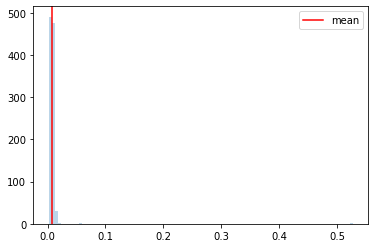

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

New Model Set For Inference
Data Loader has No Parameters
Starting Inference for Model
c:\users\cesar\desktop\projects\general\deep_random_fields\results\merton_jumps_poisson_covariance\1654434196
{'jump_arrival_alpha': 10.0, 'jump_arrival_beta': 10.0, 'jump_size_a': 10.0, 'jump_size_b': 10.0}


#      ---------------- 
#      Start of MCMC    
#      ---------------- 
Monte Carlo 0
Monte Carlo 1
Monte Carlo 2


  0%|▏                                                                                | 3/1000 [00:00<01:12, 13.80it/s]

Monte Carlo 3
Monte Carlo 4


  0%|▍                                                                                | 5/1000 [00:00<01:28, 11.31it/s]

Monte Carlo 5
Monte Carlo 6


  1%|▋                                                                                | 8/1000 [00:00<01:54,  8.65it/s]

Monte Carlo 7
Monte Carlo 8


  1%|▋                                                                                | 9/1000 [00:00<01:55,  8.59it/s]

Monte Carlo 9


  1%|▉                                                                               | 11/1000 [00:01<02:14,  7.35it/s]

Monte Carlo 10
Monte Carlo 11


  1%|█                                                                               | 13/1000 [00:01<02:07,  7.77it/s]

Monte Carlo 12
Monte Carlo 13


  2%|█▏                                                                              | 15/1000 [00:01<01:58,  8.31it/s]

Monte Carlo 14
Monte Carlo 15


  2%|█▎                                                                              | 17/1000 [00:02<01:58,  8.32it/s]

Monte Carlo 16
Monte Carlo 17


  2%|█▌                                                                              | 19/1000 [00:02<01:50,  8.88it/s]

Monte Carlo 18
Monte Carlo 19


  2%|█▋                                                                              | 21/1000 [00:02<01:52,  8.70it/s]

Monte Carlo 20
Monte Carlo 21


  2%|█▉                                                                              | 24/1000 [00:02<01:48,  8.99it/s]

Monte Carlo 22
Monte Carlo 23


  2%|██                                                                              | 25/1000 [00:03<02:15,  7.20it/s]

Monte Carlo 24


  3%|██                                                                              | 26/1000 [00:03<02:32,  6.37it/s]

Monte Carlo 25


  3%|██▏                                                                             | 27/1000 [00:03<02:25,  6.71it/s]

Monte Carlo 26
Monte Carlo 27


  3%|██▎                                                                             | 29/1000 [00:03<02:40,  6.06it/s]

Monte Carlo 28


  3%|██▍                                                                             | 30/1000 [00:03<02:25,  6.66it/s]

Monte Carlo 29
Monte Carlo 30


  3%|██▌                                                                             | 32/1000 [00:04<02:22,  6.78it/s]

Monte Carlo 31
Monte Carlo 32


  3%|██▋                                                                             | 34/1000 [00:04<02:13,  7.21it/s]

Monte Carlo 33
Monte Carlo 34


  4%|██▉                                                                             | 36/1000 [00:04<02:13,  7.20it/s]

Monte Carlo 35
Monte Carlo 36


  4%|███                                                                             | 38/1000 [00:04<02:19,  6.90it/s]

Monte Carlo 37
Monte Carlo 38


  4%|███▏                                                                            | 40/1000 [00:05<02:20,  6.82it/s]

Monte Carlo 39
Monte Carlo 40


  4%|███▎                                                                            | 42/1000 [00:05<02:13,  7.18it/s]

Monte Carlo 41
Monte Carlo 42


  4%|███▌                                                                            | 44/1000 [00:05<02:09,  7.40it/s]

Monte Carlo 43
Monte Carlo 44


  5%|███▋                                                                            | 46/1000 [00:06<02:07,  7.47it/s]

Monte Carlo 45
Monte Carlo 46


  5%|███▊                                                                            | 48/1000 [00:06<02:04,  7.65it/s]

Monte Carlo 47
Monte Carlo 48


  5%|████                                                                            | 50/1000 [00:06<02:04,  7.65it/s]

Monte Carlo 49
Monte Carlo 50


  5%|████▏                                                                           | 52/1000 [00:06<02:07,  7.42it/s]

Monte Carlo 51
Monte Carlo 52


  5%|████▎                                                                           | 54/1000 [00:07<02:03,  7.66it/s]

Monte Carlo 53
Monte Carlo 54


  6%|████▍                                                                           | 56/1000 [00:07<02:02,  7.72it/s]

Monte Carlo 55
Monte Carlo 56


  6%|████▋                                                                           | 58/1000 [00:07<02:07,  7.38it/s]

Monte Carlo 57
Monte Carlo 58


  6%|████▊                                                                           | 60/1000 [00:07<02:03,  7.60it/s]

Monte Carlo 59
Monte Carlo 60


  6%|████▉                                                                           | 62/1000 [00:08<02:09,  7.25it/s]

Monte Carlo 61
Monte Carlo 62


  6%|█████                                                                           | 64/1000 [00:08<02:10,  7.18it/s]

Monte Carlo 63
Monte Carlo 64


  7%|█████▎                                                                          | 66/1000 [00:08<02:07,  7.32it/s]

Monte Carlo 65
Monte Carlo 66


  7%|█████▍                                                                          | 68/1000 [00:08<02:00,  7.74it/s]

Monte Carlo 67
Monte Carlo 68


  7%|█████▌                                                                          | 70/1000 [00:09<02:10,  7.14it/s]

Monte Carlo 69
Monte Carlo 70


  7%|█████▊                                                                          | 72/1000 [00:09<02:08,  7.20it/s]

Monte Carlo 71
Monte Carlo 72


  7%|█████▉                                                                          | 74/1000 [00:09<02:11,  7.05it/s]

Monte Carlo 73
Monte Carlo 74


  8%|██████                                                                          | 76/1000 [00:10<02:12,  6.95it/s]

Monte Carlo 75
Monte Carlo 76


  8%|██████▏                                                                         | 78/1000 [00:10<02:08,  7.20it/s]

Monte Carlo 77
Monte Carlo 78


  8%|██████▍                                                                         | 80/1000 [00:10<02:07,  7.21it/s]

Monte Carlo 79
Monte Carlo 80


  8%|██████▌                                                                         | 82/1000 [00:10<02:07,  7.19it/s]

Monte Carlo 81
Monte Carlo 82


  8%|██████▋                                                                         | 84/1000 [00:11<02:12,  6.92it/s]

Monte Carlo 83
Monte Carlo 84


  9%|██████▉                                                                         | 86/1000 [00:11<02:08,  7.10it/s]

Monte Carlo 85
Monte Carlo 86


  9%|███████                                                                         | 88/1000 [00:11<02:11,  6.94it/s]

Monte Carlo 87
Monte Carlo 88


  9%|███████▏                                                                        | 90/1000 [00:12<02:20,  6.46it/s]

Monte Carlo 89
Monte Carlo 90


  9%|███████▎                                                                        | 92/1000 [00:12<02:23,  6.33it/s]

Monte Carlo 91
Monte Carlo 92


  9%|███████▌                                                                        | 94/1000 [00:12<02:15,  6.69it/s]

Monte Carlo 93
Monte Carlo 94


 10%|███████▋                                                                        | 96/1000 [00:13<02:13,  6.79it/s]

Monte Carlo 95
Monte Carlo 96


 10%|███████▊                                                                        | 98/1000 [00:13<02:13,  6.75it/s]

Monte Carlo 97
Monte Carlo 98


 10%|███████▉                                                                       | 100/1000 [00:13<02:12,  6.80it/s]

Monte Carlo 99
Monte Carlo 100


 10%|████████                                                                       | 102/1000 [00:13<02:13,  6.75it/s]

Monte Carlo 101
Monte Carlo 102


 10%|████████▏                                                                      | 104/1000 [00:14<02:10,  6.85it/s]

Monte Carlo 103
Monte Carlo 104


 11%|████████▎                                                                      | 106/1000 [00:14<02:09,  6.91it/s]

Monte Carlo 105
Monte Carlo 106


 11%|████████▌                                                                      | 108/1000 [00:14<02:04,  7.14it/s]

Monte Carlo 107
Monte Carlo 108


 11%|████████▋                                                                      | 110/1000 [00:15<02:11,  6.75it/s]

Monte Carlo 109
Monte Carlo 110


 11%|████████▊                                                                      | 112/1000 [00:15<02:09,  6.87it/s]

Monte Carlo 111
Monte Carlo 112


 11%|█████████                                                                      | 114/1000 [00:15<02:14,  6.60it/s]

Monte Carlo 113
Monte Carlo 114


 12%|█████████▏                                                                     | 116/1000 [00:16<02:10,  6.77it/s]

Monte Carlo 115
Monte Carlo 116


 12%|█████████▎                                                                     | 118/1000 [00:16<02:13,  6.62it/s]

Monte Carlo 117
Monte Carlo 118


 12%|█████████▍                                                                     | 120/1000 [00:16<02:11,  6.69it/s]

Monte Carlo 119
Monte Carlo 120


 12%|█████████▋                                                                     | 122/1000 [00:16<02:12,  6.62it/s]

Monte Carlo 121
Monte Carlo 122


 12%|█████████▊                                                                     | 124/1000 [00:17<02:08,  6.82it/s]

Monte Carlo 123
Monte Carlo 124


 13%|█████████▉                                                                     | 126/1000 [00:17<02:10,  6.68it/s]

Monte Carlo 125
Monte Carlo 126


 13%|██████████                                                                     | 128/1000 [00:17<02:10,  6.69it/s]

Monte Carlo 127
Monte Carlo 128


 13%|██████████▎                                                                    | 130/1000 [00:18<02:06,  6.86it/s]

Monte Carlo 129
Monte Carlo 130


 13%|██████████▍                                                                    | 132/1000 [00:18<02:16,  6.35it/s]

Monte Carlo 131
Monte Carlo 132


 13%|██████████▌                                                                    | 134/1000 [00:18<02:13,  6.51it/s]

Monte Carlo 133
Monte Carlo 134


 14%|██████████▋                                                                    | 136/1000 [00:19<02:33,  5.64it/s]

Monte Carlo 135
Monte Carlo 136


 14%|██████████▉                                                                    | 138/1000 [00:19<02:14,  6.43it/s]

Monte Carlo 137
Monte Carlo 138


 14%|███████████                                                                    | 140/1000 [00:19<02:07,  6.75it/s]

Monte Carlo 139
Monte Carlo 140


 14%|███████████▏                                                                   | 142/1000 [00:20<02:04,  6.90it/s]

Monte Carlo 141
Monte Carlo 142


 14%|███████████▍                                                                   | 144/1000 [00:20<02:02,  6.98it/s]

Monte Carlo 143
Monte Carlo 144


 15%|███████████▌                                                                   | 146/1000 [00:20<02:01,  7.05it/s]

Monte Carlo 145
Monte Carlo 146


 15%|███████████▋                                                                   | 148/1000 [00:20<02:03,  6.92it/s]

Monte Carlo 147
Monte Carlo 148


 15%|███████████▊                                                                   | 150/1000 [00:21<02:02,  6.92it/s]

Monte Carlo 149
Monte Carlo 150


 15%|████████████                                                                   | 152/1000 [00:21<02:02,  6.90it/s]

Monte Carlo 151
Monte Carlo 152


 15%|████████████▏                                                                  | 154/1000 [00:21<01:58,  7.13it/s]

Monte Carlo 153
Monte Carlo 154


 16%|████████████▎                                                                  | 156/1000 [00:22<02:04,  6.80it/s]

Monte Carlo 155
Monte Carlo 156


 16%|████████████▍                                                                  | 158/1000 [00:22<02:10,  6.47it/s]

Monte Carlo 157
Monte Carlo 158


 16%|████████████▋                                                                  | 160/1000 [00:22<02:08,  6.55it/s]

Monte Carlo 159
Monte Carlo 160


 16%|████████████▊                                                                  | 162/1000 [00:22<02:04,  6.75it/s]

Monte Carlo 161
Monte Carlo 162


 16%|████████████▉                                                                  | 164/1000 [00:23<02:06,  6.63it/s]

Monte Carlo 163
Monte Carlo 164


 17%|█████████████                                                                  | 166/1000 [00:23<02:07,  6.53it/s]

Monte Carlo 165
Monte Carlo 166


 17%|█████████████▎                                                                 | 168/1000 [00:23<02:07,  6.52it/s]

Monte Carlo 167
Monte Carlo 168


 17%|█████████████▍                                                                 | 170/1000 [00:24<02:17,  6.02it/s]

Monte Carlo 169


 17%|█████████████▌                                                                 | 171/1000 [00:24<02:18,  5.98it/s]

Monte Carlo 170
Monte Carlo 171


 17%|█████████████▋                                                                 | 173/1000 [00:24<02:07,  6.47it/s]

Monte Carlo 172
Monte Carlo 173


 18%|█████████████▊                                                                 | 175/1000 [00:25<02:14,  6.15it/s]

Monte Carlo 174


 18%|█████████████▉                                                                 | 176/1000 [00:25<02:13,  6.16it/s]

Monte Carlo 175
Monte Carlo 176


 18%|██████████████                                                                 | 178/1000 [00:25<02:13,  6.15it/s]

Monte Carlo 177
Monte Carlo 178


 18%|██████████████▏                                                                | 180/1000 [00:25<02:14,  6.10it/s]

Monte Carlo 179
Monte Carlo 180


 18%|██████████████▍                                                                | 182/1000 [00:26<02:15,  6.04it/s]

Monte Carlo 181
Monte Carlo 182


 18%|██████████████▌                                                                | 184/1000 [00:26<02:11,  6.21it/s]

Monte Carlo 183
Monte Carlo 184


 19%|██████████████▋                                                                | 186/1000 [00:26<02:15,  6.00it/s]

Monte Carlo 185
Monte Carlo 186


 19%|██████████████▊                                                                | 188/1000 [00:27<02:20,  5.78it/s]

Monte Carlo 187
Monte Carlo 188


 19%|███████████████                                                                | 190/1000 [00:27<02:16,  5.93it/s]

Monte Carlo 189
Monte Carlo 190


 19%|███████████████▏                                                               | 192/1000 [00:27<02:16,  5.90it/s]

Monte Carlo 191
Monte Carlo 192


 19%|███████████████▎                                                               | 194/1000 [00:28<02:12,  6.09it/s]

Monte Carlo 193
Monte Carlo 194


 20%|███████████████▍                                                               | 196/1000 [00:28<02:11,  6.12it/s]

Monte Carlo 195
Monte Carlo 196


 20%|███████████████▋                                                               | 198/1000 [00:28<02:14,  5.98it/s]

Monte Carlo 197
Monte Carlo 198


 20%|███████████████▊                                                               | 200/1000 [00:29<02:10,  6.13it/s]

Monte Carlo 199
Monte Carlo 200


 20%|███████████████▉                                                               | 202/1000 [00:29<02:07,  6.28it/s]

Monte Carlo 201
Monte Carlo 202


 20%|████████████████                                                               | 204/1000 [00:29<02:12,  5.99it/s]

Monte Carlo 203
Monte Carlo 204


 21%|████████████████▎                                                              | 206/1000 [00:30<02:11,  6.03it/s]

Monte Carlo 205
Monte Carlo 206


 21%|████████████████▍                                                              | 208/1000 [00:30<02:10,  6.07it/s]

Monte Carlo 207
Monte Carlo 208


 21%|████████████████▌                                                              | 210/1000 [00:30<02:06,  6.23it/s]

Monte Carlo 209
Monte Carlo 210


 21%|████████████████▋                                                              | 212/1000 [00:31<02:06,  6.24it/s]

Monte Carlo 211
Monte Carlo 212


 21%|████████████████▉                                                              | 214/1000 [00:31<02:11,  5.96it/s]

Monte Carlo 213
Monte Carlo 214


 22%|█████████████████                                                              | 216/1000 [00:31<02:08,  6.09it/s]

Monte Carlo 215
Monte Carlo 216


 22%|█████████████████▏                                                             | 218/1000 [00:32<02:08,  6.10it/s]

Monte Carlo 217
Monte Carlo 218


 22%|█████████████████▍                                                             | 220/1000 [00:32<02:11,  5.94it/s]

Monte Carlo 219
Monte Carlo 220


 22%|█████████████████▌                                                             | 222/1000 [00:32<02:08,  6.07it/s]

Monte Carlo 221
Monte Carlo 222


 22%|█████████████████▋                                                             | 224/1000 [00:33<02:06,  6.14it/s]

Monte Carlo 223
Monte Carlo 224


 23%|█████████████████▊                                                             | 226/1000 [00:33<02:08,  6.04it/s]

Monte Carlo 225
Monte Carlo 226


 23%|██████████████████                                                             | 228/1000 [00:33<02:07,  6.05it/s]

Monte Carlo 227
Monte Carlo 228


 23%|██████████████████▏                                                            | 230/1000 [00:34<02:08,  5.97it/s]

Monte Carlo 229
Monte Carlo 230


 23%|██████████████████▎                                                            | 232/1000 [00:34<02:10,  5.89it/s]

Monte Carlo 231
Monte Carlo 232


 23%|██████████████████▍                                                            | 234/1000 [00:34<02:06,  6.04it/s]

Monte Carlo 233
Monte Carlo 234


 24%|██████████████████▋                                                            | 236/1000 [00:35<02:13,  5.71it/s]

Monte Carlo 235


 24%|██████████████████▋                                                            | 237/1000 [00:35<02:17,  5.56it/s]

Monte Carlo 236


 24%|██████████████████▊                                                            | 238/1000 [00:35<02:15,  5.62it/s]

Monte Carlo 237
Monte Carlo 238


 24%|██████████████████▉                                                            | 240/1000 [00:35<02:15,  5.60it/s]

Monte Carlo 239
Monte Carlo 240


 24%|███████████████████                                                            | 242/1000 [00:36<02:21,  5.37it/s]

Monte Carlo 241


 24%|███████████████████▏                                                           | 243/1000 [00:36<02:16,  5.53it/s]

Monte Carlo 242
Monte Carlo 243


 24%|███████████████████▎                                                           | 245/1000 [00:36<02:15,  5.58it/s]

Monte Carlo 244
Monte Carlo 245


 25%|███████████████████▌                                                           | 247/1000 [00:37<02:15,  5.56it/s]

Monte Carlo 246
Monte Carlo 247


 25%|███████████████████▋                                                           | 249/1000 [00:37<02:25,  5.17it/s]

Monte Carlo 248


 25%|███████████████████▊                                                           | 250/1000 [00:37<02:21,  5.30it/s]

Monte Carlo 249
Monte Carlo 250


 25%|███████████████████▊                                                           | 251/1000 [00:37<02:17,  5.46it/s]

Monte Carlo 251


 25%|███████████████████▉                                                           | 253/1000 [00:38<02:19,  5.35it/s]

Monte Carlo 252


 25%|████████████████████                                                           | 254/1000 [00:38<02:20,  5.30it/s]

Monte Carlo 253


 26%|████████████████████▏                                                          | 255/1000 [00:38<02:20,  5.30it/s]

Monte Carlo 254


 26%|████████████████████▏                                                          | 256/1000 [00:38<02:17,  5.42it/s]

Monte Carlo 255
Monte Carlo 256


 26%|████████████████████▎                                                          | 257/1000 [00:39<02:18,  5.38it/s]

Monte Carlo 257


 26%|████████████████████▍                                                          | 259/1000 [00:39<02:36,  4.73it/s]

Monte Carlo 258


 26%|████████████████████▌                                                          | 260/1000 [00:39<02:35,  4.77it/s]

Monte Carlo 259


 26%|████████████████████▌                                                          | 261/1000 [00:39<02:26,  5.05it/s]

Monte Carlo 260
Monte Carlo 261


 26%|████████████████████▊                                                          | 263/1000 [00:40<02:24,  5.10it/s]

Monte Carlo 262


 26%|████████████████████▊                                                          | 264/1000 [00:40<02:22,  5.17it/s]

Monte Carlo 263


 26%|████████████████████▉                                                          | 265/1000 [00:40<02:20,  5.24it/s]

Monte Carlo 264


 27%|█████████████████████                                                          | 266/1000 [00:40<02:20,  5.23it/s]

Monte Carlo 265


 27%|█████████████████████                                                          | 267/1000 [00:41<02:17,  5.33it/s]

Monte Carlo 266
Monte Carlo 267


 27%|█████████████████████▎                                                         | 269/1000 [00:41<02:21,  5.15it/s]

Monte Carlo 268
Monte Carlo 269


 27%|█████████████████████▎                                                         | 270/1000 [00:41<02:24,  5.05it/s]

Monte Carlo 270


 27%|█████████████████████▍                                                         | 272/1000 [00:42<02:24,  5.03it/s]

Monte Carlo 271
Monte Carlo 272


 27%|█████████████████████▋                                                         | 274/1000 [00:42<02:29,  4.85it/s]

Monte Carlo 273
Monte Carlo 274


 28%|█████████████████████▊                                                         | 276/1000 [00:42<02:28,  4.87it/s]

Monte Carlo 275


 28%|█████████████████████▉                                                         | 277/1000 [00:43<02:27,  4.91it/s]

Monte Carlo 276


 28%|█████████████████████▉                                                         | 278/1000 [00:43<02:27,  4.89it/s]

Monte Carlo 277


 28%|██████████████████████                                                         | 279/1000 [00:43<02:24,  4.98it/s]

Monte Carlo 278
Monte Carlo 279


 28%|██████████████████████▏                                                        | 281/1000 [00:43<02:25,  4.94it/s]

Monte Carlo 280
Monte Carlo 281


 28%|██████████████████████▎                                                        | 282/1000 [00:44<02:29,  4.80it/s]

Monte Carlo 282


 28%|██████████████████████▍                                                        | 284/1000 [00:44<02:25,  4.91it/s]

Monte Carlo 283
Monte Carlo 284


 29%|██████████████████████▌                                                        | 286/1000 [00:45<02:25,  4.91it/s]

Monte Carlo 285
Monte Carlo 286


 29%|██████████████████████▋                                                        | 287/1000 [00:45<02:31,  4.71it/s]

Monte Carlo 287


 29%|██████████████████████▊                                                        | 288/1000 [00:45<02:35,  4.59it/s]

Monte Carlo 288


 29%|██████████████████████▊                                                        | 289/1000 [00:45<02:41,  4.40it/s]

Monte Carlo 289


 29%|██████████████████████▉                                                        | 290/1000 [00:45<02:39,  4.44it/s]

Monte Carlo 290


 29%|██████████████████████▉                                                        | 291/1000 [00:46<02:39,  4.45it/s]

Monte Carlo 291


 29%|███████████████████████▏                                                       | 293/1000 [00:46<02:31,  4.68it/s]

Monte Carlo 292
Monte Carlo 293


 30%|███████████████████████▎                                                       | 295/1000 [00:47<02:34,  4.55it/s]

Monte Carlo 294
Monte Carlo 295


 30%|███████████████████████▍                                                       | 296/1000 [00:47<02:39,  4.41it/s]

Monte Carlo 296


 30%|███████████████████████▌                                                       | 298/1000 [00:47<02:31,  4.62it/s]

Monte Carlo 297
Monte Carlo 298


 30%|███████████████████████▌                                                       | 299/1000 [00:47<02:31,  4.63it/s]

Monte Carlo 299


 30%|███████████████████████▋                                                       | 300/1000 [00:48<02:31,  4.61it/s]

Monte Carlo 300


 30%|███████████████████████▊                                                       | 301/1000 [00:48<02:30,  4.63it/s]

Monte Carlo 301


 30%|███████████████████████▊                                                       | 302/1000 [00:48<02:32,  4.57it/s]

Monte Carlo 302


 30%|███████████████████████▉                                                       | 303/1000 [00:48<02:34,  4.53it/s]

Monte Carlo 303


 30%|████████████████████████                                                       | 304/1000 [00:49<02:33,  4.53it/s]

Monte Carlo 304


 30%|████████████████████████                                                       | 305/1000 [00:49<02:30,  4.62it/s]

Monte Carlo 305


 31%|████████████████████████▎                                                      | 307/1000 [00:49<02:29,  4.63it/s]

Monte Carlo 306


 31%|████████████████████████▎                                                      | 308/1000 [00:49<02:26,  4.71it/s]

Monte Carlo 307


 31%|████████████████████████▍                                                      | 309/1000 [00:50<02:24,  4.79it/s]

Monte Carlo 308
Monte Carlo 309


 31%|████████████████████████▌                                                      | 311/1000 [00:50<02:23,  4.81it/s]

Monte Carlo 310
Monte Carlo 311


 31%|████████████████████████▋                                                      | 313/1000 [00:50<02:22,  4.82it/s]

Monte Carlo 312
Monte Carlo 313


 31%|████████████████████████▊                                                      | 314/1000 [00:51<02:25,  4.72it/s]

Monte Carlo 314


 32%|████████████████████████▉                                                      | 316/1000 [00:51<02:23,  4.75it/s]

Monte Carlo 315


 32%|█████████████████████████                                                      | 317/1000 [00:51<02:21,  4.81it/s]

Monte Carlo 316


 32%|█████████████████████████                                                      | 318/1000 [00:51<02:20,  4.86it/s]

Monte Carlo 317
Monte Carlo 318


 32%|█████████████████████████▏                                                     | 319/1000 [00:52<02:18,  4.93it/s]

Monte Carlo 319


 32%|█████████████████████████▎                                                     | 320/1000 [00:52<02:26,  4.64it/s]

Monte Carlo 320


 32%|█████████████████████████▎                                                     | 321/1000 [00:52<02:27,  4.60it/s]

Monte Carlo 321


 32%|█████████████████████████▌                                                     | 323/1000 [00:53<02:23,  4.71it/s]

Monte Carlo 322
Monte Carlo 323


 32%|█████████████████████████▌                                                     | 324/1000 [00:53<02:29,  4.52it/s]

Monte Carlo 324


 32%|█████████████████████████▋                                                     | 325/1000 [00:53<02:28,  4.53it/s]

Monte Carlo 325


 33%|█████████████████████████▊                                                     | 327/1000 [00:53<02:24,  4.64it/s]

Monte Carlo 326
Monte Carlo 327


 33%|█████████████████████████▉                                                     | 328/1000 [00:54<02:27,  4.56it/s]

Monte Carlo 328


 33%|█████████████████████████▉                                                     | 329/1000 [00:54<02:26,  4.57it/s]

Monte Carlo 329


 33%|██████████████████████████▏                                                    | 331/1000 [00:54<02:23,  4.65it/s]

Monte Carlo 330


 33%|██████████████████████████▏                                                    | 332/1000 [00:54<02:23,  4.67it/s]

Monte Carlo 331
Monte Carlo 332


 33%|██████████████████████████▎                                                    | 333/1000 [00:55<02:22,  4.68it/s]

Monte Carlo 333


 33%|██████████████████████████▍                                                    | 334/1000 [00:55<02:23,  4.65it/s]

Monte Carlo 334


 34%|██████████████████████████▍                                                    | 335/1000 [00:55<02:24,  4.60it/s]

Monte Carlo 335


 34%|██████████████████████████▌                                                    | 336/1000 [00:55<02:22,  4.65it/s]

Monte Carlo 336


 34%|██████████████████████████▌                                                    | 337/1000 [00:56<02:23,  4.63it/s]

Monte Carlo 337


 34%|██████████████████████████▋                                                    | 338/1000 [00:56<02:22,  4.64it/s]

Monte Carlo 338


 34%|██████████████████████████▊                                                    | 339/1000 [00:56<02:22,  4.63it/s]

Monte Carlo 339


 34%|██████████████████████████▊                                                    | 340/1000 [00:56<02:23,  4.60it/s]

Monte Carlo 340


 34%|██████████████████████████▉                                                    | 341/1000 [00:56<02:25,  4.52it/s]

Monte Carlo 341


 34%|███████████████████████████                                                    | 342/1000 [00:57<02:24,  4.55it/s]

Monte Carlo 342


 34%|███████████████████████████                                                    | 343/1000 [00:57<02:24,  4.54it/s]

Monte Carlo 343


 34%|███████████████████████████▏                                                   | 344/1000 [00:57<02:24,  4.55it/s]

Monte Carlo 344


 34%|███████████████████████████▎                                                   | 345/1000 [00:57<02:26,  4.47it/s]

Monte Carlo 345


 35%|███████████████████████████▎                                                   | 346/1000 [00:58<02:25,  4.49it/s]

Monte Carlo 346


 35%|███████████████████████████▍                                                   | 347/1000 [00:58<02:27,  4.43it/s]

Monte Carlo 347


 35%|███████████████████████████▌                                                   | 349/1000 [00:58<02:23,  4.53it/s]

Monte Carlo 348
Monte Carlo 349


 35%|███████████████████████████▋                                                   | 350/1000 [00:58<02:30,  4.33it/s]

Monte Carlo 350


 35%|███████████████████████████▋                                                   | 351/1000 [00:59<02:28,  4.38it/s]

Monte Carlo 351


 35%|███████████████████████████▊                                                   | 352/1000 [00:59<02:31,  4.28it/s]

Monte Carlo 352


 35%|███████████████████████████▉                                                   | 353/1000 [00:59<02:27,  4.38it/s]

Monte Carlo 353


 35%|███████████████████████████▉                                                   | 354/1000 [00:59<02:30,  4.30it/s]

Monte Carlo 354


 36%|████████████████████████████                                                   | 355/1000 [01:00<02:28,  4.34it/s]

Monte Carlo 355


 36%|████████████████████████████                                                   | 356/1000 [01:00<02:34,  4.16it/s]

Monte Carlo 356


 36%|████████████████████████████▏                                                  | 357/1000 [01:00<02:35,  4.14it/s]

Monte Carlo 357


 36%|████████████████████████████▎                                                  | 358/1000 [01:00<02:34,  4.15it/s]

Monte Carlo 358


 36%|████████████████████████████▎                                                  | 359/1000 [01:01<02:30,  4.27it/s]

Monte Carlo 359


 36%|████████████████████████████▍                                                  | 360/1000 [01:01<02:29,  4.28it/s]

Monte Carlo 360


 36%|████████████████████████████▌                                                  | 361/1000 [01:01<02:30,  4.23it/s]

Monte Carlo 361


 36%|████████████████████████████▌                                                  | 362/1000 [01:01<02:31,  4.22it/s]

Monte Carlo 362


 36%|████████████████████████████▋                                                  | 363/1000 [01:02<02:31,  4.20it/s]

Monte Carlo 363


 36%|████████████████████████████▊                                                  | 364/1000 [01:02<02:29,  4.27it/s]

Monte Carlo 364


 36%|████████████████████████████▊                                                  | 365/1000 [01:02<02:29,  4.25it/s]

Monte Carlo 365


 37%|████████████████████████████▉                                                  | 366/1000 [01:02<02:32,  4.15it/s]

Monte Carlo 366


 37%|████████████████████████████▉                                                  | 367/1000 [01:03<02:29,  4.23it/s]

Monte Carlo 367


 37%|█████████████████████████████▏                                                 | 369/1000 [01:03<02:23,  4.40it/s]

Monte Carlo 368
Monte Carlo 369


 37%|█████████████████████████████▏                                                 | 370/1000 [01:03<02:27,  4.27it/s]

Monte Carlo 370


 37%|█████████████████████████████▎                                                 | 371/1000 [01:03<02:29,  4.22it/s]

Monte Carlo 371


 37%|█████████████████████████████▍                                                 | 372/1000 [01:04<02:27,  4.26it/s]

Monte Carlo 372


 37%|█████████████████████████████▍                                                 | 373/1000 [01:04<02:27,  4.26it/s]

Monte Carlo 373


 37%|█████████████████████████████▌                                                 | 374/1000 [01:04<02:30,  4.17it/s]

Monte Carlo 374


 38%|█████████████████████████████▋                                                 | 375/1000 [01:04<02:31,  4.12it/s]

Monte Carlo 375


 38%|█████████████████████████████▋                                                 | 376/1000 [01:05<02:29,  4.18it/s]

Monte Carlo 376


 38%|█████████████████████████████▊                                                 | 377/1000 [01:05<02:25,  4.28it/s]

Monte Carlo 377


 38%|█████████████████████████████▊                                                 | 378/1000 [01:05<02:21,  4.41it/s]

Monte Carlo 378


 38%|█████████████████████████████▉                                                 | 379/1000 [01:05<02:20,  4.41it/s]

Monte Carlo 379


 38%|██████████████████████████████                                                 | 380/1000 [01:06<02:18,  4.48it/s]

Monte Carlo 380


 38%|██████████████████████████████                                                 | 381/1000 [01:06<02:20,  4.39it/s]

Monte Carlo 381


 38%|██████████████████████████████▏                                                | 382/1000 [01:06<02:18,  4.46it/s]

Monte Carlo 382


 38%|██████████████████████████████▎                                                | 383/1000 [01:06<02:18,  4.46it/s]

Monte Carlo 383


 38%|██████████████████████████████▎                                                | 384/1000 [01:06<02:22,  4.34it/s]

Monte Carlo 384


 38%|██████████████████████████████▍                                                | 385/1000 [01:07<02:23,  4.29it/s]

Monte Carlo 385


 39%|██████████████████████████████▍                                                | 386/1000 [01:07<02:23,  4.27it/s]

Monte Carlo 386


 39%|██████████████████████████████▌                                                | 387/1000 [01:07<02:21,  4.32it/s]

Monte Carlo 387


 39%|██████████████████████████████▋                                                | 388/1000 [01:07<02:20,  4.35it/s]

Monte Carlo 388


 39%|██████████████████████████████▋                                                | 389/1000 [01:08<02:24,  4.23it/s]

Monte Carlo 389


 39%|██████████████████████████████▊                                                | 390/1000 [01:08<02:28,  4.11it/s]

Monte Carlo 390


 39%|██████████████████████████████▉                                                | 391/1000 [01:08<02:32,  3.98it/s]

Monte Carlo 391


 39%|██████████████████████████████▉                                                | 392/1000 [01:08<02:31,  4.01it/s]

Monte Carlo 392


 39%|███████████████████████████████                                                | 393/1000 [01:09<02:28,  4.09it/s]

Monte Carlo 393


 39%|███████████████████████████████▏                                               | 394/1000 [01:09<02:24,  4.19it/s]

Monte Carlo 394


 40%|███████████████████████████████▏                                               | 395/1000 [01:09<02:21,  4.28it/s]

Monte Carlo 395


 40%|███████████████████████████████▎                                               | 396/1000 [01:09<02:21,  4.28it/s]

Monte Carlo 396


 40%|███████████████████████████████▎                                               | 397/1000 [01:10<02:23,  4.20it/s]

Monte Carlo 397


 40%|███████████████████████████████▍                                               | 398/1000 [01:10<02:23,  4.19it/s]

Monte Carlo 398


 40%|███████████████████████████████▌                                               | 399/1000 [01:10<02:20,  4.29it/s]

Monte Carlo 399


 40%|███████████████████████████████▌                                               | 400/1000 [01:10<02:23,  4.17it/s]

Monte Carlo 400


 40%|███████████████████████████████▋                                               | 401/1000 [01:11<02:25,  4.12it/s]

Monte Carlo 401


 40%|███████████████████████████████▊                                               | 402/1000 [01:11<02:22,  4.19it/s]

Monte Carlo 402


 40%|███████████████████████████████▊                                               | 403/1000 [01:11<02:21,  4.23it/s]

Monte Carlo 403


 40%|███████████████████████████████▉                                               | 404/1000 [01:11<02:22,  4.19it/s]

Monte Carlo 404


 40%|███████████████████████████████▉                                               | 405/1000 [01:11<02:27,  4.04it/s]

Monte Carlo 405


 41%|████████████████████████████████                                               | 406/1000 [01:12<02:27,  4.02it/s]

Monte Carlo 406


 41%|████████████████████████████████▏                                              | 407/1000 [01:12<02:27,  4.01it/s]

Monte Carlo 407


 41%|████████████████████████████████▏                                              | 408/1000 [01:12<02:26,  4.03it/s]

Monte Carlo 408


 41%|████████████████████████████████▎                                              | 409/1000 [01:12<02:25,  4.07it/s]

Monte Carlo 409


 41%|████████████████████████████████▍                                              | 410/1000 [01:13<02:22,  4.14it/s]

Monte Carlo 410


 41%|████████████████████████████████▍                                              | 411/1000 [01:13<02:40,  3.66it/s]

Monte Carlo 411


 41%|████████████████████████████████▌                                              | 412/1000 [01:13<02:32,  3.85it/s]

Monte Carlo 412


 41%|████████████████████████████████▋                                              | 413/1000 [01:14<02:29,  3.93it/s]

Monte Carlo 413


 41%|████████████████████████████████▋                                              | 414/1000 [01:14<02:27,  3.98it/s]

Monte Carlo 414


 42%|████████████████████████████████▊                                              | 415/1000 [01:14<02:27,  3.96it/s]

Monte Carlo 415


 42%|████████████████████████████████▊                                              | 416/1000 [01:14<02:22,  4.09it/s]

Monte Carlo 416


 42%|████████████████████████████████▉                                              | 417/1000 [01:14<02:23,  4.06it/s]

Monte Carlo 417


 42%|█████████████████████████████████                                              | 418/1000 [01:15<02:28,  3.91it/s]

Monte Carlo 418


 42%|█████████████████████████████████                                              | 419/1000 [01:15<02:25,  3.98it/s]

Monte Carlo 419


 42%|█████████████████████████████████▏                                             | 420/1000 [01:15<02:24,  4.02it/s]

Monte Carlo 420


 42%|█████████████████████████████████▎                                             | 421/1000 [01:16<02:30,  3.86it/s]

Monte Carlo 421


 42%|█████████████████████████████████▎                                             | 422/1000 [01:16<02:30,  3.84it/s]

Monte Carlo 422


 42%|█████████████████████████████████▍                                             | 423/1000 [01:16<02:29,  3.86it/s]

Monte Carlo 423


 42%|█████████████████████████████████▍                                             | 424/1000 [01:16<02:24,  3.99it/s]

Monte Carlo 424


 42%|█████████████████████████████████▌                                             | 425/1000 [01:17<02:26,  3.93it/s]

Monte Carlo 425


 43%|█████████████████████████████████▋                                             | 426/1000 [01:17<02:23,  4.00it/s]

Monte Carlo 426


 43%|█████████████████████████████████▋                                             | 427/1000 [01:17<02:21,  4.05it/s]

Monte Carlo 427


 43%|█████████████████████████████████▊                                             | 428/1000 [01:17<02:20,  4.06it/s]

Monte Carlo 428


 43%|█████████████████████████████████▉                                             | 429/1000 [01:18<02:20,  4.06it/s]

Monte Carlo 429


 43%|█████████████████████████████████▉                                             | 430/1000 [01:18<02:17,  4.14it/s]

Monte Carlo 430


 43%|██████████████████████████████████                                             | 431/1000 [01:18<02:16,  4.17it/s]

Monte Carlo 431


 43%|██████████████████████████████████▏                                            | 432/1000 [01:18<02:16,  4.18it/s]

Monte Carlo 432


 43%|██████████████████████████████████▏                                            | 433/1000 [01:18<02:18,  4.10it/s]

Monte Carlo 433


 43%|██████████████████████████████████▎                                            | 434/1000 [01:19<02:17,  4.11it/s]

Monte Carlo 434


 44%|██████████████████████████████████▎                                            | 435/1000 [01:19<02:19,  4.06it/s]

Monte Carlo 435


 44%|██████████████████████████████████▍                                            | 436/1000 [01:19<02:13,  4.22it/s]

Monte Carlo 436


 44%|██████████████████████████████████▌                                            | 437/1000 [01:19<02:12,  4.25it/s]

Monte Carlo 437


 44%|██████████████████████████████████▌                                            | 438/1000 [01:20<02:08,  4.37it/s]

Monte Carlo 438


 44%|██████████████████████████████████▊                                            | 440/1000 [01:20<02:05,  4.47it/s]

Monte Carlo 439
Monte Carlo 440


 44%|██████████████████████████████████▊                                            | 441/1000 [01:20<02:10,  4.29it/s]

Monte Carlo 441


 44%|██████████████████████████████████▉                                            | 442/1000 [01:21<02:14,  4.16it/s]

Monte Carlo 442


 44%|██████████████████████████████████▉                                            | 443/1000 [01:21<02:17,  4.05it/s]

Monte Carlo 443


 44%|███████████████████████████████████                                            | 444/1000 [01:21<02:12,  4.20it/s]

Monte Carlo 444


 44%|███████████████████████████████████▏                                           | 445/1000 [01:21<02:13,  4.17it/s]

Monte Carlo 445


 45%|███████████████████████████████████▏                                           | 446/1000 [01:22<02:13,  4.15it/s]

Monte Carlo 446


 45%|███████████████████████████████████▎                                           | 447/1000 [01:22<02:09,  4.26it/s]

Monte Carlo 447


 45%|███████████████████████████████████▍                                           | 448/1000 [01:22<02:10,  4.22it/s]

Monte Carlo 448


 45%|███████████████████████████████████▍                                           | 449/1000 [01:22<02:07,  4.31it/s]

Monte Carlo 449


 45%|███████████████████████████████████▌                                           | 450/1000 [01:22<02:05,  4.37it/s]

Monte Carlo 450


 45%|███████████████████████████████████▋                                           | 451/1000 [01:23<02:03,  4.43it/s]

Monte Carlo 451


 45%|███████████████████████████████████▋                                           | 452/1000 [01:23<02:08,  4.27it/s]

Monte Carlo 452


 45%|███████████████████████████████████▊                                           | 453/1000 [01:23<02:04,  4.39it/s]

Monte Carlo 453


 45%|███████████████████████████████████▊                                           | 454/1000 [01:23<02:05,  4.37it/s]

Monte Carlo 454


 46%|███████████████████████████████████▉                                           | 455/1000 [01:24<02:04,  4.39it/s]

Monte Carlo 455


 46%|████████████████████████████████████                                           | 456/1000 [01:24<02:06,  4.31it/s]

Monte Carlo 456


 46%|████████████████████████████████████                                           | 457/1000 [01:24<02:10,  4.15it/s]

Monte Carlo 457


 46%|████████████████████████████████████▏                                          | 458/1000 [01:24<02:11,  4.12it/s]

Monte Carlo 458


 46%|████████████████████████████████████▎                                          | 459/1000 [01:25<02:12,  4.07it/s]

Monte Carlo 459


 46%|████████████████████████████████████▎                                          | 460/1000 [01:25<02:17,  3.93it/s]

Monte Carlo 460


 46%|████████████████████████████████████▍                                          | 461/1000 [01:25<02:11,  4.09it/s]

Monte Carlo 461


 46%|████████████████████████████████████▍                                          | 462/1000 [01:25<02:11,  4.10it/s]

Monte Carlo 462


 46%|████████████████████████████████████▌                                          | 463/1000 [01:26<02:12,  4.05it/s]

Monte Carlo 463


 46%|████████████████████████████████████▋                                          | 464/1000 [01:26<02:10,  4.11it/s]

Monte Carlo 464


 46%|████████████████████████████████████▋                                          | 465/1000 [01:26<02:08,  4.17it/s]

Monte Carlo 465


 47%|████████████████████████████████████▊                                          | 466/1000 [01:26<02:10,  4.10it/s]

Monte Carlo 466


 47%|████████████████████████████████████▉                                          | 467/1000 [01:27<02:12,  4.03it/s]

Monte Carlo 467


 47%|████████████████████████████████████▉                                          | 468/1000 [01:27<02:12,  4.02it/s]

Monte Carlo 468


 47%|█████████████████████████████████████                                          | 469/1000 [01:27<02:10,  4.06it/s]

Monte Carlo 469


 47%|█████████████████████████████████████▏                                         | 470/1000 [01:27<02:08,  4.11it/s]

Monte Carlo 470


 47%|█████████████████████████████████████▏                                         | 471/1000 [01:28<02:05,  4.20it/s]

Monte Carlo 471


 47%|█████████████████████████████████████▎                                         | 472/1000 [01:28<02:06,  4.18it/s]

Monte Carlo 472


 47%|█████████████████████████████████████▎                                         | 473/1000 [01:28<02:04,  4.25it/s]

Monte Carlo 473


 47%|█████████████████████████████████████▍                                         | 474/1000 [01:28<02:04,  4.24it/s]

Monte Carlo 474


 48%|█████████████████████████████████████▌                                         | 475/1000 [01:28<02:05,  4.18it/s]

Monte Carlo 475


 48%|█████████████████████████████████████▌                                         | 476/1000 [01:29<02:10,  4.03it/s]

Monte Carlo 476


 48%|█████████████████████████████████████▋                                         | 477/1000 [01:29<02:10,  3.99it/s]

Monte Carlo 477


 48%|█████████████████████████████████████▊                                         | 478/1000 [01:29<02:10,  3.99it/s]

Monte Carlo 478


 48%|█████████████████████████████████████▊                                         | 479/1000 [01:30<02:17,  3.79it/s]

Monte Carlo 479


 48%|█████████████████████████████████████▉                                         | 480/1000 [01:30<02:16,  3.82it/s]

Monte Carlo 480


 48%|█████████████████████████████████████▉                                         | 481/1000 [01:30<02:12,  3.92it/s]

Monte Carlo 481


 48%|██████████████████████████████████████                                         | 482/1000 [01:30<02:14,  3.86it/s]

Monte Carlo 482


 48%|██████████████████████████████████████▏                                        | 483/1000 [01:31<02:08,  4.01it/s]

Monte Carlo 483


 48%|██████████████████████████████████████▏                                        | 484/1000 [01:31<02:07,  4.04it/s]

Monte Carlo 484


 48%|██████████████████████████████████████▎                                        | 485/1000 [01:31<02:09,  3.98it/s]

Monte Carlo 485


 49%|██████████████████████████████████████▍                                        | 486/1000 [01:31<02:10,  3.94it/s]

Monte Carlo 486


 49%|██████████████████████████████████████▍                                        | 487/1000 [01:32<02:10,  3.94it/s]

Monte Carlo 487


 49%|██████████████████████████████████████▌                                        | 488/1000 [01:32<02:11,  3.89it/s]

Monte Carlo 488


 49%|██████████████████████████████████████▋                                        | 489/1000 [01:32<02:12,  3.85it/s]

Monte Carlo 489


 49%|██████████████████████████████████████▋                                        | 490/1000 [01:32<02:11,  3.87it/s]

Monte Carlo 490


 49%|██████████████████████████████████████▊                                        | 491/1000 [01:33<02:12,  3.86it/s]

Monte Carlo 491


 49%|██████████████████████████████████████▊                                        | 492/1000 [01:33<02:14,  3.79it/s]

Monte Carlo 492


 49%|██████████████████████████████████████▉                                        | 493/1000 [01:33<02:15,  3.75it/s]

Monte Carlo 493


 49%|███████████████████████████████████████                                        | 494/1000 [01:33<02:14,  3.76it/s]

Monte Carlo 494


 50%|███████████████████████████████████████                                        | 495/1000 [01:34<02:19,  3.62it/s]

Monte Carlo 495


 50%|███████████████████████████████████████▏                                       | 496/1000 [01:34<02:18,  3.64it/s]

Monte Carlo 496


 50%|███████████████████████████████████████▎                                       | 497/1000 [01:34<02:16,  3.67it/s]

Monte Carlo 497


 50%|███████████████████████████████████████▎                                       | 498/1000 [01:35<02:14,  3.73it/s]

Monte Carlo 498


 50%|███████████████████████████████████████▍                                       | 499/1000 [01:35<02:13,  3.75it/s]

Monte Carlo 499


 50%|███████████████████████████████████████▌                                       | 500/1000 [01:35<02:12,  3.78it/s]

Monte Carlo 500


 50%|███████████████████████████████████████▌                                       | 501/1000 [01:35<02:15,  3.69it/s]

Monte Carlo 501


 50%|███████████████████████████████████████▋                                       | 502/1000 [01:36<02:16,  3.64it/s]

Monte Carlo 502


 50%|███████████████████████████████████████▋                                       | 503/1000 [01:36<02:17,  3.60it/s]

Monte Carlo 503


 50%|███████████████████████████████████████▊                                       | 504/1000 [01:36<02:16,  3.64it/s]

Monte Carlo 504


 50%|███████████████████████████████████████▉                                       | 505/1000 [01:36<02:18,  3.58it/s]

Monte Carlo 505


 51%|███████████████████████████████████████▉                                       | 506/1000 [01:37<02:19,  3.54it/s]

Monte Carlo 506


 51%|████████████████████████████████████████                                       | 507/1000 [01:37<02:18,  3.55it/s]

Monte Carlo 507


 51%|████████████████████████████████████████▏                                      | 508/1000 [01:37<02:18,  3.56it/s]

Monte Carlo 508


 51%|████████████████████████████████████████▏                                      | 509/1000 [01:38<02:19,  3.53it/s]

Monte Carlo 509


 51%|████████████████████████████████████████▎                                      | 510/1000 [01:38<02:19,  3.52it/s]

Monte Carlo 510


 51%|████████████████████████████████████████▎                                      | 511/1000 [01:38<02:35,  3.14it/s]

Monte Carlo 511


 51%|████████████████████████████████████████▍                                      | 512/1000 [01:39<02:28,  3.28it/s]

Monte Carlo 512


 51%|████████████████████████████████████████▌                                      | 513/1000 [01:39<02:24,  3.37it/s]

Monte Carlo 513


 51%|████████████████████████████████████████▌                                      | 514/1000 [01:39<02:20,  3.47it/s]

Monte Carlo 514


 52%|████████████████████████████████████████▋                                      | 515/1000 [01:39<02:16,  3.54it/s]

Monte Carlo 515


 52%|████████████████████████████████████████▊                                      | 516/1000 [01:40<02:17,  3.53it/s]

Monte Carlo 516


 52%|████████████████████████████████████████▊                                      | 517/1000 [01:40<02:22,  3.39it/s]

Monte Carlo 517


 52%|████████████████████████████████████████▉                                      | 518/1000 [01:40<02:19,  3.47it/s]

Monte Carlo 518


 52%|█████████████████████████████████████████                                      | 519/1000 [01:41<02:17,  3.51it/s]

Monte Carlo 519


 52%|█████████████████████████████████████████                                      | 520/1000 [01:41<02:15,  3.54it/s]

Monte Carlo 520


 52%|█████████████████████████████████████████▏                                     | 521/1000 [01:41<02:13,  3.59it/s]

Monte Carlo 521


 52%|█████████████████████████████████████████▏                                     | 522/1000 [01:41<02:13,  3.58it/s]

Monte Carlo 522


 52%|█████████████████████████████████████████▎                                     | 523/1000 [01:42<02:15,  3.52it/s]

Monte Carlo 523


 52%|█████████████████████████████████████████▍                                     | 524/1000 [01:42<02:15,  3.52it/s]

Monte Carlo 524


 52%|█████████████████████████████████████████▍                                     | 525/1000 [01:42<02:13,  3.57it/s]

Monte Carlo 525


 53%|█████████████████████████████████████████▌                                     | 526/1000 [01:42<02:12,  3.57it/s]

Monte Carlo 526


 53%|█████████████████████████████████████████▋                                     | 527/1000 [01:43<02:11,  3.58it/s]

Monte Carlo 527


 53%|█████████████████████████████████████████▋                                     | 528/1000 [01:43<02:14,  3.52it/s]

Monte Carlo 528


 53%|█████████████████████████████████████████▊                                     | 529/1000 [01:43<02:19,  3.37it/s]

Monte Carlo 529


 53%|█████████████████████████████████████████▊                                     | 530/1000 [01:44<02:21,  3.31it/s]

Monte Carlo 530


 53%|█████████████████████████████████████████▉                                     | 531/1000 [01:44<02:16,  3.43it/s]

Monte Carlo 531


 53%|██████████████████████████████████████████                                     | 532/1000 [01:44<02:14,  3.48it/s]

Monte Carlo 532


 53%|██████████████████████████████████████████                                     | 533/1000 [01:45<02:12,  3.52it/s]

Monte Carlo 533


 53%|██████████████████████████████████████████▏                                    | 534/1000 [01:45<02:11,  3.54it/s]

Monte Carlo 534


 54%|██████████████████████████████████████████▎                                    | 535/1000 [01:45<02:14,  3.46it/s]

Monte Carlo 535


 54%|██████████████████████████████████████████▎                                    | 536/1000 [01:45<02:13,  3.47it/s]

Monte Carlo 536


 54%|██████████████████████████████████████████▍                                    | 537/1000 [01:46<02:15,  3.41it/s]

Monte Carlo 537


 54%|██████████████████████████████████████████▌                                    | 538/1000 [01:46<02:14,  3.43it/s]

Monte Carlo 538


 54%|██████████████████████████████████████████▌                                    | 539/1000 [01:46<02:15,  3.41it/s]

Monte Carlo 539


 54%|██████████████████████████████████████████▋                                    | 540/1000 [01:47<02:14,  3.41it/s]

Monte Carlo 540


 54%|██████████████████████████████████████████▋                                    | 541/1000 [01:47<02:19,  3.29it/s]

Monte Carlo 541


 54%|██████████████████████████████████████████▊                                    | 542/1000 [01:47<02:16,  3.36it/s]

Monte Carlo 542


 54%|██████████████████████████████████████████▉                                    | 543/1000 [01:47<02:16,  3.35it/s]

Monte Carlo 543


 54%|██████████████████████████████████████████▉                                    | 544/1000 [01:48<02:17,  3.32it/s]

Monte Carlo 544


 55%|███████████████████████████████████████████                                    | 545/1000 [01:48<02:13,  3.41it/s]

Monte Carlo 545


 55%|███████████████████████████████████████████▏                                   | 546/1000 [01:48<02:11,  3.45it/s]

Monte Carlo 546


 55%|███████████████████████████████████████████▏                                   | 547/1000 [01:49<02:11,  3.44it/s]

Monte Carlo 547


 55%|███████████████████████████████████████████▎                                   | 548/1000 [01:49<02:13,  3.40it/s]

Monte Carlo 548


 55%|███████████████████████████████████████████▎                                   | 549/1000 [01:49<02:15,  3.32it/s]

Monte Carlo 549


 55%|███████████████████████████████████████████▍                                   | 550/1000 [01:50<02:16,  3.30it/s]

Monte Carlo 550


 55%|███████████████████████████████████████████▌                                   | 551/1000 [01:50<02:19,  3.22it/s]

Monte Carlo 551


 55%|███████████████████████████████████████████▌                                   | 552/1000 [01:50<02:19,  3.22it/s]

Monte Carlo 552


 55%|███████████████████████████████████████████▋                                   | 553/1000 [01:51<02:17,  3.25it/s]

Monte Carlo 553


 55%|███████████████████████████████████████████▊                                   | 554/1000 [01:51<02:17,  3.25it/s]

Monte Carlo 554


 56%|███████████████████████████████████████████▊                                   | 555/1000 [01:51<02:12,  3.37it/s]

Monte Carlo 555


 56%|███████████████████████████████████████████▉                                   | 556/1000 [01:51<02:12,  3.34it/s]

Monte Carlo 556


 56%|████████████████████████████████████████████                                   | 557/1000 [01:52<02:10,  3.41it/s]

Monte Carlo 557


 56%|████████████████████████████████████████████                                   | 558/1000 [01:52<02:13,  3.31it/s]

Monte Carlo 558


 56%|████████████████████████████████████████████▏                                  | 559/1000 [01:52<02:11,  3.35it/s]

Monte Carlo 559


 56%|████████████████████████████████████████████▏                                  | 560/1000 [01:53<02:10,  3.37it/s]

Monte Carlo 560


 56%|████████████████████████████████████████████▎                                  | 561/1000 [01:53<02:12,  3.30it/s]

Monte Carlo 561


 56%|████████████████████████████████████████████▍                                  | 562/1000 [01:53<02:08,  3.41it/s]

Monte Carlo 562


 56%|████████████████████████████████████████████▍                                  | 563/1000 [01:53<02:08,  3.40it/s]

Monte Carlo 563


 56%|████████████████████████████████████████████▌                                  | 564/1000 [01:54<02:12,  3.29it/s]

Monte Carlo 564


 56%|████████████████████████████████████████████▋                                  | 565/1000 [01:54<02:09,  3.36it/s]

Monte Carlo 565


 57%|████████████████████████████████████████████▋                                  | 566/1000 [01:54<02:07,  3.41it/s]

Monte Carlo 566


 57%|████████████████████████████████████████████▊                                  | 567/1000 [01:55<02:14,  3.22it/s]

Monte Carlo 567


 57%|████████████████████████████████████████████▊                                  | 568/1000 [01:55<02:13,  3.24it/s]

Monte Carlo 568


 57%|████████████████████████████████████████████▉                                  | 569/1000 [01:55<02:09,  3.32it/s]

Monte Carlo 569


 57%|█████████████████████████████████████████████                                  | 570/1000 [01:56<02:08,  3.34it/s]

Monte Carlo 570


 57%|█████████████████████████████████████████████                                  | 571/1000 [01:56<02:10,  3.28it/s]

Monte Carlo 571


 57%|█████████████████████████████████████████████▏                                 | 572/1000 [01:56<02:07,  3.35it/s]

Monte Carlo 572


 57%|█████████████████████████████████████████████▎                                 | 573/1000 [01:56<02:08,  3.31it/s]

Monte Carlo 573


 57%|█████████████████████████████████████████████▎                                 | 574/1000 [01:57<02:09,  3.29it/s]

Monte Carlo 574


 57%|█████████████████████████████████████████████▍                                 | 575/1000 [01:57<02:11,  3.22it/s]

Monte Carlo 575


 58%|█████████████████████████████████████████████▌                                 | 576/1000 [01:57<02:12,  3.20it/s]

Monte Carlo 576


 58%|█████████████████████████████████████████████▌                                 | 577/1000 [01:58<02:09,  3.26it/s]

Monte Carlo 577


 58%|█████████████████████████████████████████████▋                                 | 578/1000 [01:58<02:08,  3.29it/s]

Monte Carlo 578


 58%|█████████████████████████████████████████████▋                                 | 579/1000 [01:58<02:09,  3.26it/s]

Monte Carlo 579


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [01:59<02:09,  3.24it/s]

Monte Carlo 580


 58%|█████████████████████████████████████████████▉                                 | 581/1000 [01:59<02:13,  3.13it/s]

Monte Carlo 581


 58%|█████████████████████████████████████████████▉                                 | 582/1000 [01:59<02:17,  3.05it/s]

Monte Carlo 582


 58%|██████████████████████████████████████████████                                 | 583/1000 [02:00<02:18,  3.01it/s]

Monte Carlo 583


 58%|██████████████████████████████████████████████▏                                | 584/1000 [02:00<02:18,  3.00it/s]

Monte Carlo 584


 58%|██████████████████████████████████████████████▏                                | 585/1000 [02:00<02:16,  3.03it/s]

Monte Carlo 585


 59%|██████████████████████████████████████████████▎                                | 586/1000 [02:01<02:13,  3.09it/s]

Monte Carlo 586


 59%|██████████████████████████████████████████████▎                                | 587/1000 [02:01<02:10,  3.17it/s]

Monte Carlo 587


 59%|██████████████████████████████████████████████▍                                | 588/1000 [02:01<02:06,  3.25it/s]

Monte Carlo 588


 59%|██████████████████████████████████████████████▌                                | 589/1000 [02:02<02:07,  3.24it/s]

Monte Carlo 589


 59%|██████████████████████████████████████████████▌                                | 590/1000 [02:02<02:06,  3.24it/s]

Monte Carlo 590


 59%|██████████████████████████████████████████████▋                                | 591/1000 [02:02<02:06,  3.23it/s]

Monte Carlo 591


 59%|██████████████████████████████████████████████▊                                | 592/1000 [02:03<02:08,  3.17it/s]

Monte Carlo 592


 59%|██████████████████████████████████████████████▊                                | 593/1000 [02:03<02:06,  3.21it/s]

Monte Carlo 593


 59%|██████████████████████████████████████████████▉                                | 594/1000 [02:03<02:10,  3.11it/s]

Monte Carlo 594


 60%|███████████████████████████████████████████████                                | 595/1000 [02:03<02:09,  3.14it/s]

Monte Carlo 595


 60%|███████████████████████████████████████████████                                | 596/1000 [02:04<02:08,  3.15it/s]

Monte Carlo 596


 60%|███████████████████████████████████████████████▏                               | 597/1000 [02:04<02:08,  3.13it/s]

Monte Carlo 597


 60%|███████████████████████████████████████████████▏                               | 598/1000 [02:04<02:07,  3.16it/s]

Monte Carlo 598


 60%|███████████████████████████████████████████████▎                               | 599/1000 [02:05<02:04,  3.21it/s]

Monte Carlo 599


 60%|███████████████████████████████████████████████▍                               | 600/1000 [02:05<02:02,  3.26it/s]

Monte Carlo 600


 60%|███████████████████████████████████████████████▍                               | 601/1000 [02:05<02:03,  3.23it/s]

Monte Carlo 601


 60%|███████████████████████████████████████████████▌                               | 602/1000 [02:06<02:01,  3.28it/s]

Monte Carlo 602


 60%|███████████████████████████████████████████████▋                               | 603/1000 [02:06<02:03,  3.21it/s]

Monte Carlo 603


 60%|███████████████████████████████████████████████▋                               | 604/1000 [02:06<02:07,  3.10it/s]

Monte Carlo 604


 60%|███████████████████████████████████████████████▊                               | 605/1000 [02:07<02:05,  3.14it/s]

Monte Carlo 605


 61%|███████████████████████████████████████████████▊                               | 606/1000 [02:07<02:04,  3.16it/s]

Monte Carlo 606


 61%|███████████████████████████████████████████████▉                               | 607/1000 [02:07<02:05,  3.12it/s]

Monte Carlo 607


 61%|████████████████████████████████████████████████                               | 608/1000 [02:08<02:05,  3.12it/s]

Monte Carlo 608


 61%|████████████████████████████████████████████████                               | 609/1000 [02:08<02:05,  3.11it/s]

Monte Carlo 609


 61%|████████████████████████████████████████████████▏                              | 610/1000 [02:08<02:04,  3.14it/s]

Monte Carlo 610


 61%|████████████████████████████████████████████████▎                              | 611/1000 [02:09<02:02,  3.18it/s]

Monte Carlo 611


 61%|████████████████████████████████████████████████▎                              | 612/1000 [02:09<02:04,  3.12it/s]

Monte Carlo 612


 61%|████████████████████████████████████████████████▍                              | 613/1000 [02:09<02:02,  3.15it/s]

Monte Carlo 613


 61%|████████████████████████████████████████████████▌                              | 614/1000 [02:09<02:03,  3.12it/s]

Monte Carlo 614


 62%|████████████████████████████████████████████████▌                              | 615/1000 [02:10<02:02,  3.15it/s]

Monte Carlo 615


 62%|████████████████████████████████████████████████▋                              | 616/1000 [02:10<02:02,  3.14it/s]

Monte Carlo 616


 62%|████████████████████████████████████████████████▋                              | 617/1000 [02:10<02:03,  3.10it/s]

Monte Carlo 617


 62%|████████████████████████████████████████████████▊                              | 618/1000 [02:11<01:59,  3.19it/s]

Monte Carlo 618


 62%|████████████████████████████████████████████████▉                              | 619/1000 [02:11<02:00,  3.15it/s]

Monte Carlo 619


 62%|████████████████████████████████████████████████▉                              | 620/1000 [02:11<02:04,  3.04it/s]

Monte Carlo 620


 62%|█████████████████████████████████████████████████                              | 621/1000 [02:12<02:04,  3.05it/s]

Monte Carlo 621


 62%|█████████████████████████████████████████████████▏                             | 622/1000 [02:12<02:04,  3.03it/s]

Monte Carlo 622


 62%|█████████████████████████████████████████████████▏                             | 623/1000 [02:12<02:04,  3.04it/s]

Monte Carlo 623


 62%|█████████████████████████████████████████████████▎                             | 624/1000 [02:13<02:03,  3.05it/s]

Monte Carlo 624


 62%|█████████████████████████████████████████████████▍                             | 625/1000 [02:13<02:03,  3.03it/s]

Monte Carlo 625


 63%|█████████████████████████████████████████████████▍                             | 626/1000 [02:13<02:02,  3.06it/s]

Monte Carlo 626


 63%|█████████████████████████████████████████████████▌                             | 627/1000 [02:14<02:00,  3.10it/s]

Monte Carlo 627


 63%|█████████████████████████████████████████████████▌                             | 628/1000 [02:14<02:00,  3.09it/s]

Monte Carlo 628


 63%|█████████████████████████████████████████████████▋                             | 629/1000 [02:14<01:58,  3.12it/s]

Monte Carlo 629


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [02:15<01:59,  3.10it/s]

Monte Carlo 630


 63%|█████████████████████████████████████████████████▊                             | 631/1000 [02:15<02:01,  3.04it/s]

Monte Carlo 631


 63%|█████████████████████████████████████████████████▉                             | 632/1000 [02:15<02:02,  3.00it/s]

Monte Carlo 632


 63%|██████████████████████████████████████████████████                             | 633/1000 [02:16<02:03,  2.98it/s]

Monte Carlo 633


 63%|██████████████████████████████████████████████████                             | 634/1000 [02:16<02:00,  3.03it/s]

Monte Carlo 634


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [02:16<02:00,  3.02it/s]

Monte Carlo 635


 64%|██████████████████████████████████████████████████▏                            | 636/1000 [02:17<02:00,  3.01it/s]

Monte Carlo 636


 64%|██████████████████████████████████████████████████▎                            | 637/1000 [02:17<02:01,  2.98it/s]

Monte Carlo 637


 64%|██████████████████████████████████████████████████▍                            | 638/1000 [02:17<02:01,  2.98it/s]

Monte Carlo 638


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [02:18<02:14,  2.69it/s]

Monte Carlo 639


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [02:18<02:09,  2.78it/s]

Monte Carlo 640


 64%|██████████████████████████████████████████████████▋                            | 641/1000 [02:18<02:03,  2.90it/s]

Monte Carlo 641


 64%|██████████████████████████████████████████████████▋                            | 642/1000 [02:19<02:01,  2.95it/s]

Monte Carlo 642


 64%|██████████████████████████████████████████████████▊                            | 643/1000 [02:19<02:00,  2.97it/s]

Monte Carlo 643


 64%|██████████████████████████████████████████████████▉                            | 644/1000 [02:19<02:01,  2.93it/s]

Monte Carlo 644


 64%|██████████████████████████████████████████████████▉                            | 645/1000 [02:20<02:02,  2.89it/s]

Monte Carlo 645


 65%|███████████████████████████████████████████████████                            | 646/1000 [02:20<02:08,  2.75it/s]

Monte Carlo 646


 65%|███████████████████████████████████████████████████                            | 647/1000 [02:21<02:07,  2.78it/s]

Monte Carlo 647


 65%|███████████████████████████████████████████████████▏                           | 648/1000 [02:21<02:04,  2.82it/s]

Monte Carlo 648


 65%|███████████████████████████████████████████████████▎                           | 649/1000 [02:21<02:03,  2.85it/s]

Monte Carlo 649


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [02:22<01:59,  2.93it/s]

Monte Carlo 650


 65%|███████████████████████████████████████████████████▍                           | 651/1000 [02:22<01:55,  3.02it/s]

Monte Carlo 651


 65%|███████████████████████████████████████████████████▌                           | 652/1000 [02:22<01:55,  3.02it/s]

Monte Carlo 652


 65%|███████████████████████████████████████████████████▌                           | 653/1000 [02:23<01:51,  3.11it/s]

Monte Carlo 653


 65%|███████████████████████████████████████████████████▋                           | 654/1000 [02:23<01:48,  3.18it/s]

Monte Carlo 654


 66%|███████████████████████████████████████████████████▋                           | 655/1000 [02:23<01:51,  3.11it/s]

Monte Carlo 655


 66%|███████████████████████████████████████████████████▊                           | 656/1000 [02:24<01:57,  2.93it/s]

Monte Carlo 656


 66%|███████████████████████████████████████████████████▉                           | 657/1000 [02:24<01:54,  3.00it/s]

Monte Carlo 657


 66%|███████████████████████████████████████████████████▉                           | 658/1000 [02:24<01:51,  3.07it/s]

Monte Carlo 658


 66%|████████████████████████████████████████████████████                           | 659/1000 [02:24<01:47,  3.18it/s]

Monte Carlo 659


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [02:25<01:47,  3.15it/s]

Monte Carlo 660


 66%|████████████████████████████████████████████████████▏                          | 661/1000 [02:25<01:47,  3.16it/s]

Monte Carlo 661


 66%|████████████████████████████████████████████████████▎                          | 662/1000 [02:25<01:46,  3.17it/s]

Monte Carlo 662


 66%|████████████████████████████████████████████████████▍                          | 663/1000 [02:26<01:51,  3.03it/s]

Monte Carlo 663


 66%|████████████████████████████████████████████████████▍                          | 664/1000 [02:26<01:50,  3.05it/s]

Monte Carlo 664


 66%|████████████████████████████████████████████████████▌                          | 665/1000 [02:26<01:47,  3.10it/s]

Monte Carlo 665


 67%|████████████████████████████████████████████████████▌                          | 666/1000 [02:27<01:49,  3.06it/s]

Monte Carlo 666


 67%|████████████████████████████████████████████████████▋                          | 667/1000 [02:27<01:50,  3.03it/s]

Monte Carlo 667


 67%|████████████████████████████████████████████████████▊                          | 668/1000 [02:27<01:50,  3.00it/s]

Monte Carlo 668


 67%|████████████████████████████████████████████████████▊                          | 669/1000 [02:28<01:48,  3.05it/s]

Monte Carlo 669


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [02:28<01:50,  2.99it/s]

Monte Carlo 670


 67%|█████████████████████████████████████████████████████                          | 671/1000 [02:28<01:51,  2.94it/s]

Monte Carlo 671


 67%|█████████████████████████████████████████████████████                          | 672/1000 [02:29<01:51,  2.94it/s]

Monte Carlo 672


 67%|█████████████████████████████████████████████████████▏                         | 673/1000 [02:29<01:49,  2.98it/s]

Monte Carlo 673


 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [02:29<01:50,  2.94it/s]

Monte Carlo 674


 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [02:30<01:51,  2.92it/s]

Monte Carlo 675


 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [02:30<01:49,  2.96it/s]

Monte Carlo 676


 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [02:30<01:49,  2.95it/s]

Monte Carlo 677


 68%|█████████████████████████████████████████████████████▌                         | 678/1000 [02:31<01:48,  2.96it/s]

Monte Carlo 678


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [02:31<01:47,  2.98it/s]

Monte Carlo 679


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [02:31<01:49,  2.93it/s]

Monte Carlo 680


 68%|█████████████████████████████████████████████████████▊                         | 681/1000 [02:32<01:52,  2.85it/s]

Monte Carlo 681


 68%|█████████████████████████████████████████████████████▉                         | 682/1000 [02:32<01:50,  2.87it/s]

Monte Carlo 682


 68%|█████████████████████████████████████████████████████▉                         | 683/1000 [02:33<01:50,  2.86it/s]

Monte Carlo 683


 68%|██████████████████████████████████████████████████████                         | 684/1000 [02:33<01:49,  2.87it/s]

Monte Carlo 684


 68%|██████████████████████████████████████████████████████                         | 685/1000 [02:33<01:49,  2.87it/s]

Monte Carlo 685


 69%|██████████████████████████████████████████████████████▏                        | 686/1000 [02:34<01:47,  2.92it/s]

Monte Carlo 686


 69%|██████████████████████████████████████████████████████▎                        | 687/1000 [02:34<01:47,  2.92it/s]

Monte Carlo 687


 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [02:34<01:47,  2.90it/s]

Monte Carlo 688


 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [02:35<01:48,  2.87it/s]

Monte Carlo 689


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [02:35<01:47,  2.87it/s]

Monte Carlo 690


 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [02:35<01:49,  2.82it/s]

Monte Carlo 691


 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [02:36<01:49,  2.81it/s]

Monte Carlo 692


 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [02:36<01:50,  2.79it/s]

Monte Carlo 693


 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [02:36<01:47,  2.84it/s]

Monte Carlo 694


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [02:37<01:45,  2.88it/s]

Monte Carlo 695


 70%|██████████████████████████████████████████████████████▉                        | 696/1000 [02:37<01:46,  2.85it/s]

Monte Carlo 696


 70%|███████████████████████████████████████████████████████                        | 697/1000 [02:37<01:44,  2.90it/s]

Monte Carlo 697


 70%|███████████████████████████████████████████████████████▏                       | 698/1000 [02:38<01:41,  2.97it/s]

Monte Carlo 698


 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [02:38<01:40,  3.00it/s]

Monte Carlo 699


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [02:38<01:39,  3.01it/s]

Monte Carlo 700


 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [02:39<01:39,  3.00it/s]

Monte Carlo 701


 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [02:39<01:37,  3.07it/s]

Monte Carlo 702


 70%|███████████████████████████████████████████████████████▌                       | 703/1000 [02:39<01:36,  3.09it/s]

Monte Carlo 703


 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [02:40<01:38,  3.02it/s]

Monte Carlo 704


 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [02:40<01:37,  3.04it/s]

Monte Carlo 705


 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [02:40<01:37,  3.00it/s]

Monte Carlo 706


 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [02:41<01:36,  3.02it/s]

Monte Carlo 707


 71%|███████████████████████████████████████████████████████▉                       | 708/1000 [02:41<01:37,  3.00it/s]

Monte Carlo 708


 71%|████████████████████████████████████████████████████████                       | 709/1000 [02:41<01:37,  2.99it/s]

Monte Carlo 709


 71%|████████████████████████████████████████████████████████                       | 710/1000 [02:42<01:35,  3.03it/s]

Monte Carlo 710


 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [02:42<01:36,  3.00it/s]

Monte Carlo 711


 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [02:42<01:37,  2.94it/s]

Monte Carlo 712


 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [02:43<01:39,  2.88it/s]

Monte Carlo 713


 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [02:43<01:38,  2.91it/s]

Monte Carlo 714


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [02:43<01:39,  2.87it/s]

Monte Carlo 715


 72%|████████████████████████████████████████████████████████▌                      | 716/1000 [02:44<01:39,  2.85it/s]

Monte Carlo 716


 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [02:44<01:38,  2.88it/s]

Monte Carlo 717


 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [02:45<01:38,  2.86it/s]

Monte Carlo 718


 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [02:45<01:40,  2.78it/s]

Monte Carlo 719


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [02:45<01:39,  2.80it/s]

Monte Carlo 720


 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [02:46<01:43,  2.70it/s]

Monte Carlo 721


 72%|█████████████████████████████████████████████████████████                      | 722/1000 [02:46<01:42,  2.72it/s]

Monte Carlo 722


 72%|█████████████████████████████████████████████████████████                      | 723/1000 [02:46<01:38,  2.82it/s]

Monte Carlo 723


 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [02:47<01:34,  2.92it/s]

Monte Carlo 724


 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [02:47<01:32,  2.97it/s]

Monte Carlo 725


 73%|█████████████████████████████████████████████████████████▎                     | 726/1000 [02:47<01:31,  3.00it/s]

Monte Carlo 726


 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [02:48<01:28,  3.07it/s]

Monte Carlo 727


 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [02:48<01:29,  3.02it/s]

Monte Carlo 728


 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [02:48<01:29,  3.03it/s]

Monte Carlo 729


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [02:49<01:32,  2.92it/s]

Monte Carlo 730


 73%|█████████████████████████████████████████████████████████▋                     | 731/1000 [02:49<01:30,  2.99it/s]

Monte Carlo 731


 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [02:49<01:30,  2.96it/s]

Monte Carlo 732


 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [02:50<01:30,  2.94it/s]

Monte Carlo 733


 73%|█████████████████████████████████████████████████████████▉                     | 734/1000 [02:50<01:29,  2.96it/s]

Monte Carlo 734


 74%|██████████████████████████████████████████████████████████                     | 735/1000 [02:50<01:29,  2.95it/s]

Monte Carlo 735


 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [02:51<01:36,  2.72it/s]

Monte Carlo 736


 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [02:51<01:36,  2.73it/s]

Monte Carlo 737


 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [02:51<01:34,  2.78it/s]

Monte Carlo 738


 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [02:52<01:32,  2.83it/s]

Monte Carlo 739


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [02:52<01:33,  2.77it/s]

Monte Carlo 740


 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [02:53<01:35,  2.70it/s]

Monte Carlo 741


 74%|██████████████████████████████████████████████████████████▌                    | 742/1000 [02:53<01:34,  2.74it/s]

Monte Carlo 742


 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [02:53<01:33,  2.76it/s]

Monte Carlo 743


 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [02:54<01:34,  2.72it/s]

Monte Carlo 744


 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [02:54<01:32,  2.77it/s]

Monte Carlo 745


 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [02:54<01:32,  2.75it/s]

Monte Carlo 746


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [02:55<01:32,  2.73it/s]

Monte Carlo 747


 75%|███████████████████████████████████████████████████████████                    | 748/1000 [02:55<01:33,  2.70it/s]

Monte Carlo 748


 75%|███████████████████████████████████████████████████████████▏                   | 749/1000 [02:56<01:32,  2.71it/s]

Monte Carlo 749


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [02:56<01:32,  2.70it/s]

Monte Carlo 750


 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [02:56<01:31,  2.72it/s]

Monte Carlo 751


 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [02:57<01:30,  2.75it/s]

Monte Carlo 752


 75%|███████████████████████████████████████████████████████████▍                   | 753/1000 [02:57<01:30,  2.74it/s]

Monte Carlo 753


 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [02:57<01:29,  2.74it/s]

Monte Carlo 754


 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [02:58<01:27,  2.80it/s]

Monte Carlo 755


 76%|███████████████████████████████████████████████████████████▋                   | 756/1000 [02:58<01:27,  2.79it/s]

Monte Carlo 756


 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [02:58<01:27,  2.79it/s]

Monte Carlo 757


 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [02:59<01:24,  2.87it/s]

Monte Carlo 758


 76%|███████████████████████████████████████████████████████████▉                   | 759/1000 [02:59<01:23,  2.88it/s]

Monte Carlo 759


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [02:59<01:22,  2.92it/s]

Monte Carlo 760


 76%|████████████████████████████████████████████████████████████                   | 761/1000 [03:00<01:21,  2.92it/s]

Monte Carlo 761


 76%|████████████████████████████████████████████████████████████▏                  | 762/1000 [03:00<01:20,  2.96it/s]

Monte Carlo 762


 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [03:00<01:19,  2.99it/s]

Monte Carlo 763


 76%|████████████████████████████████████████████████████████████▎                  | 764/1000 [03:01<01:18,  2.99it/s]

Monte Carlo 764


 76%|████████████████████████████████████████████████████████████▍                  | 765/1000 [03:01<01:18,  2.98it/s]

Monte Carlo 765


 77%|████████████████████████████████████████████████████████████▌                  | 766/1000 [03:01<01:20,  2.91it/s]

Monte Carlo 766


 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [03:02<01:19,  2.93it/s]

Monte Carlo 767


 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [03:02<01:21,  2.86it/s]

Monte Carlo 768


 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [03:02<01:22,  2.82it/s]

Monte Carlo 769


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [03:03<01:20,  2.87it/s]

Monte Carlo 770


 77%|████████████████████████████████████████████████████████████▉                  | 771/1000 [03:03<01:20,  2.85it/s]

Monte Carlo 771


 77%|████████████████████████████████████████████████████████████▉                  | 772/1000 [03:04<01:20,  2.85it/s]

Monte Carlo 772


 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [03:04<01:19,  2.85it/s]

Monte Carlo 773


 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [03:04<01:18,  2.88it/s]

Monte Carlo 774


 78%|█████████████████████████████████████████████████████████████▏                 | 775/1000 [03:05<01:17,  2.90it/s]

Monte Carlo 775


 78%|█████████████████████████████████████████████████████████████▎                 | 776/1000 [03:05<01:17,  2.90it/s]

Monte Carlo 776


 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [03:05<01:17,  2.86it/s]

Monte Carlo 777


 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [03:06<01:17,  2.88it/s]

Monte Carlo 778


 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [03:06<01:17,  2.85it/s]

Monte Carlo 779


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [03:06<01:16,  2.87it/s]

Monte Carlo 780


 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [03:07<01:16,  2.87it/s]

Monte Carlo 781


 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [03:07<01:15,  2.89it/s]

Monte Carlo 782


 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [03:07<01:14,  2.91it/s]

Monte Carlo 783


 78%|█████████████████████████████████████████████████████████████▉                 | 784/1000 [03:08<01:13,  2.94it/s]

Monte Carlo 784


 78%|██████████████████████████████████████████████████████████████                 | 785/1000 [03:08<01:14,  2.89it/s]

Monte Carlo 785


 79%|██████████████████████████████████████████████████████████████                 | 786/1000 [03:08<01:13,  2.89it/s]

Monte Carlo 786


 79%|██████████████████████████████████████████████████████████████▏                | 787/1000 [03:09<01:12,  2.92it/s]

Monte Carlo 787


 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [03:09<01:13,  2.89it/s]

Monte Carlo 788


 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [03:09<01:12,  2.91it/s]

Monte Carlo 789


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [03:10<01:14,  2.81it/s]

Monte Carlo 790


 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [03:10<01:16,  2.72it/s]

Monte Carlo 791


 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [03:11<01:15,  2.77it/s]

Monte Carlo 792


 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [03:11<01:14,  2.77it/s]

Monte Carlo 793


 79%|██████████████████████████████████████████████████████████████▋                | 794/1000 [03:11<01:13,  2.80it/s]

Monte Carlo 794


 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [03:12<01:13,  2.80it/s]

Monte Carlo 795


 80%|██████████████████████████████████████████████████████████████▉                | 796/1000 [03:12<01:13,  2.77it/s]

Monte Carlo 796


 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [03:12<01:14,  2.74it/s]

Monte Carlo 797


 80%|███████████████████████████████████████████████████████████████                | 798/1000 [03:13<01:14,  2.73it/s]

Monte Carlo 798


 80%|███████████████████████████████████████████████████████████████                | 799/1000 [03:13<01:13,  2.72it/s]

Monte Carlo 799


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [03:13<01:14,  2.67it/s]

Monte Carlo 800


 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [03:14<01:14,  2.67it/s]

Monte Carlo 801


 80%|███████████████████████████████████████████████████████████████▎               | 802/1000 [03:14<01:15,  2.62it/s]

Monte Carlo 802


 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [03:15<01:15,  2.59it/s]

Monte Carlo 803


 80%|███████████████████████████████████████████████████████████████▌               | 804/1000 [03:15<01:14,  2.63it/s]

Monte Carlo 804


 80%|███████████████████████████████████████████████████████████████▌               | 805/1000 [03:15<01:14,  2.63it/s]

Monte Carlo 805


 81%|███████████████████████████████████████████████████████████████▋               | 806/1000 [03:16<01:14,  2.62it/s]

Monte Carlo 806


 81%|███████████████████████████████████████████████████████████████▊               | 807/1000 [03:16<01:13,  2.62it/s]

Monte Carlo 807


 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [03:17<01:14,  2.59it/s]

Monte Carlo 808


 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [03:17<01:12,  2.63it/s]

Monte Carlo 809


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [03:17<01:14,  2.55it/s]

Monte Carlo 810


 81%|████████████████████████████████████████████████████████████████               | 811/1000 [03:18<01:13,  2.58it/s]

Monte Carlo 811


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [03:18<01:12,  2.59it/s]

Monte Carlo 812


 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [03:18<01:10,  2.64it/s]

Monte Carlo 813


 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [03:19<01:10,  2.63it/s]

Monte Carlo 814


 82%|████████████████████████████████████████████████████████████████▍              | 815/1000 [03:19<01:11,  2.59it/s]

Monte Carlo 815


 82%|████████████████████████████████████████████████████████████████▍              | 816/1000 [03:20<01:10,  2.60it/s]

Monte Carlo 816


 82%|████████████████████████████████████████████████████████████████▌              | 817/1000 [03:20<01:09,  2.62it/s]

Monte Carlo 817


 82%|████████████████████████████████████████████████████████████████▌              | 818/1000 [03:20<01:10,  2.59it/s]

Monte Carlo 818


 82%|████████████████████████████████████████████████████████████████▋              | 819/1000 [03:21<01:12,  2.50it/s]

Monte Carlo 819


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [03:21<01:12,  2.47it/s]

Monte Carlo 820


 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [03:22<01:12,  2.48it/s]

Monte Carlo 821


 82%|████████████████████████████████████████████████████████████████▉              | 822/1000 [03:22<01:10,  2.52it/s]

Monte Carlo 822


 82%|█████████████████████████████████████████████████████████████████              | 823/1000 [03:22<01:09,  2.54it/s]

Monte Carlo 823


 82%|█████████████████████████████████████████████████████████████████              | 824/1000 [03:23<01:08,  2.56it/s]

Monte Carlo 824


 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [03:23<01:07,  2.59it/s]

Monte Carlo 825


 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [03:24<01:06,  2.61it/s]

Monte Carlo 826


 83%|█████████████████████████████████████████████████████████████████▎             | 827/1000 [03:24<01:05,  2.64it/s]

Monte Carlo 827


 83%|█████████████████████████████████████████████████████████████████▍             | 828/1000 [03:24<01:05,  2.61it/s]

Monte Carlo 828


 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [03:25<01:07,  2.55it/s]

Monte Carlo 829


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [03:25<01:06,  2.57it/s]

Monte Carlo 830


 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [03:25<01:05,  2.59it/s]

Monte Carlo 831


 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [03:26<01:05,  2.57it/s]

Monte Carlo 832


 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [03:26<01:04,  2.59it/s]

Monte Carlo 833


 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [03:27<01:05,  2.54it/s]

Monte Carlo 834


 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [03:27<01:04,  2.56it/s]

Monte Carlo 835


 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [03:27<01:03,  2.57it/s]

Monte Carlo 836


 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [03:28<01:03,  2.58it/s]

Monte Carlo 837


 84%|██████████████████████████████████████████████████████████████████▏            | 838/1000 [03:28<01:02,  2.60it/s]

Monte Carlo 838


 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [03:29<01:01,  2.62it/s]

Monte Carlo 839


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [03:29<01:03,  2.53it/s]

Monte Carlo 840


 84%|██████████████████████████████████████████████████████████████████▍            | 841/1000 [03:29<01:02,  2.55it/s]

Monte Carlo 841


 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [03:30<01:02,  2.54it/s]

Monte Carlo 842


 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [03:30<01:02,  2.49it/s]

Monte Carlo 843


 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [03:31<01:02,  2.51it/s]

Monte Carlo 844


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [03:31<01:01,  2.52it/s]

Monte Carlo 845


 85%|██████████████████████████████████████████████████████████████████▊            | 846/1000 [03:31<01:01,  2.52it/s]

Monte Carlo 846


 85%|██████████████████████████████████████████████████████████████████▉            | 847/1000 [03:32<01:00,  2.52it/s]

Monte Carlo 847


 85%|██████████████████████████████████████████████████████████████████▉            | 848/1000 [03:32<01:01,  2.47it/s]

Monte Carlo 848


 85%|███████████████████████████████████████████████████████████████████            | 849/1000 [03:33<01:01,  2.47it/s]

Monte Carlo 849


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [03:33<01:01,  2.44it/s]

Monte Carlo 850


 85%|███████████████████████████████████████████████████████████████████▏           | 851/1000 [03:33<01:00,  2.46it/s]

Monte Carlo 851


 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [03:34<00:59,  2.49it/s]

Monte Carlo 852


 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [03:34<00:57,  2.54it/s]

Monte Carlo 853


 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [03:35<00:58,  2.51it/s]

Monte Carlo 854


 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [03:35<01:01,  2.35it/s]

Monte Carlo 855


 86%|███████████████████████████████████████████████████████████████████▌           | 856/1000 [03:35<01:00,  2.39it/s]

Monte Carlo 856


 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [03:36<01:00,  2.38it/s]

Monte Carlo 857


 86%|███████████████████████████████████████████████████████████████████▊           | 858/1000 [03:36<00:57,  2.46it/s]

Monte Carlo 858


 86%|███████████████████████████████████████████████████████████████████▊           | 859/1000 [03:37<00:57,  2.45it/s]

Monte Carlo 859


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [03:37<00:56,  2.48it/s]

Monte Carlo 860


 86%|████████████████████████████████████████████████████████████████████           | 861/1000 [03:37<00:55,  2.49it/s]

Monte Carlo 861


 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [03:38<00:55,  2.50it/s]

Monte Carlo 862


 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [03:38<00:54,  2.50it/s]

Monte Carlo 863


 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [03:39<00:54,  2.51it/s]

Monte Carlo 864


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [03:39<00:54,  2.49it/s]

Monte Carlo 865


 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [03:40<00:54,  2.47it/s]

Monte Carlo 866


 87%|████████████████████████████████████████████████████████████████████▍          | 867/1000 [03:40<00:54,  2.43it/s]

Monte Carlo 867


 87%|████████████████████████████████████████████████████████████████████▌          | 868/1000 [03:40<00:53,  2.47it/s]

Monte Carlo 868


 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [03:41<00:51,  2.54it/s]

Monte Carlo 869


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [03:41<00:50,  2.58it/s]

Monte Carlo 870


 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [03:41<00:49,  2.60it/s]

Monte Carlo 871


 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [03:42<00:48,  2.63it/s]

Monte Carlo 872


 87%|████████████████████████████████████████████████████████████████████▉          | 873/1000 [03:42<00:47,  2.67it/s]

Monte Carlo 873


 87%|█████████████████████████████████████████████████████████████████████          | 874/1000 [03:43<00:47,  2.64it/s]

Monte Carlo 874


 88%|█████████████████████████████████████████████████████████████████████▏         | 875/1000 [03:43<00:47,  2.61it/s]

Monte Carlo 875


 88%|█████████████████████████████████████████████████████████████████████▏         | 876/1000 [03:43<00:48,  2.57it/s]

Monte Carlo 876


 88%|█████████████████████████████████████████████████████████████████████▎         | 877/1000 [03:44<00:47,  2.57it/s]

Monte Carlo 877


 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [03:44<00:47,  2.58it/s]

Monte Carlo 878


 88%|█████████████████████████████████████████████████████████████████████▍         | 879/1000 [03:45<00:46,  2.60it/s]

Monte Carlo 879


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [03:45<00:46,  2.56it/s]

Monte Carlo 880


 88%|█████████████████████████████████████████████████████████████████████▌         | 881/1000 [03:45<00:46,  2.56it/s]

Monte Carlo 881


 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [03:46<00:47,  2.48it/s]

Monte Carlo 882


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [03:46<00:46,  2.49it/s]

Monte Carlo 883


 88%|█████████████████████████████████████████████████████████████████████▊         | 884/1000 [03:47<00:46,  2.49it/s]

Monte Carlo 884


 88%|█████████████████████████████████████████████████████████████████████▉         | 885/1000 [03:47<00:47,  2.44it/s]

Monte Carlo 885


 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [03:47<00:46,  2.43it/s]

Monte Carlo 886


 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [03:48<00:46,  2.42it/s]

Monte Carlo 887


 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [03:48<00:45,  2.45it/s]

Monte Carlo 888


 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [03:49<00:45,  2.46it/s]

Monte Carlo 889


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [03:49<00:45,  2.42it/s]

Monte Carlo 890


 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [03:49<00:45,  2.42it/s]

Monte Carlo 891


 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [03:50<00:44,  2.43it/s]

Monte Carlo 892


 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [03:50<00:44,  2.41it/s]

Monte Carlo 893


 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [03:51<00:44,  2.38it/s]

Monte Carlo 894


 90%|██████████████████████████████████████████████████████████████████████▋        | 895/1000 [03:51<00:44,  2.36it/s]

Monte Carlo 895


 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [03:52<00:43,  2.38it/s]

Monte Carlo 896


 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [03:52<00:42,  2.41it/s]

Monte Carlo 897


 90%|██████████████████████████████████████████████████████████████████████▉        | 898/1000 [03:52<00:42,  2.39it/s]

Monte Carlo 898


 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [03:53<00:42,  2.38it/s]

Monte Carlo 899


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [03:53<00:42,  2.37it/s]

Monte Carlo 900


 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [03:54<00:41,  2.37it/s]

Monte Carlo 901


 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [03:54<00:41,  2.35it/s]

Monte Carlo 902


 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [03:55<00:42,  2.29it/s]

Monte Carlo 903


 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [03:55<00:40,  2.36it/s]

Monte Carlo 904


 90%|███████████████████████████████████████████████████████████████████████▍       | 905/1000 [03:55<00:40,  2.36it/s]

Monte Carlo 905


 91%|███████████████████████████████████████████████████████████████████████▌       | 906/1000 [03:56<00:39,  2.40it/s]

Monte Carlo 906


 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [03:56<00:39,  2.36it/s]

Monte Carlo 907


 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [03:57<00:38,  2.39it/s]

Monte Carlo 908


 91%|███████████████████████████████████████████████████████████████████████▊       | 909/1000 [03:57<00:38,  2.39it/s]

Monte Carlo 909


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [03:57<00:37,  2.40it/s]

Monte Carlo 910


 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [03:58<00:37,  2.41it/s]

Monte Carlo 911


 91%|████████████████████████████████████████████████████████████████████████       | 912/1000 [03:58<00:36,  2.40it/s]

Monte Carlo 912


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [03:59<00:36,  2.38it/s]

Monte Carlo 913


 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [03:59<00:37,  2.31it/s]

Monte Carlo 914


 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [04:00<00:37,  2.29it/s]

Monte Carlo 915


 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [04:00<00:36,  2.28it/s]

Monte Carlo 916


 92%|████████████████████████████████████████████████████████████████████████▍      | 917/1000 [04:00<00:36,  2.28it/s]

Monte Carlo 917


 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [04:01<00:35,  2.30it/s]

Monte Carlo 918


 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [04:01<00:35,  2.26it/s]

Monte Carlo 919


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [04:02<00:35,  2.27it/s]

Monte Carlo 920


 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [04:02<00:33,  2.33it/s]

Monte Carlo 921


 92%|████████████████████████████████████████████████████████████████████████▊      | 922/1000 [04:03<00:32,  2.38it/s]

Monte Carlo 922


 92%|████████████████████████████████████████████████████████████████████████▉      | 923/1000 [04:03<00:31,  2.41it/s]

Monte Carlo 923


 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [04:03<00:30,  2.45it/s]

Monte Carlo 924


 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [04:04<00:30,  2.45it/s]

Monte Carlo 925


 93%|█████████████████████████████████████████████████████████████████████████▏     | 926/1000 [04:04<00:30,  2.45it/s]

Monte Carlo 926


 93%|█████████████████████████████████████████████████████████████████████████▏     | 927/1000 [04:05<00:29,  2.47it/s]

Monte Carlo 927


 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [04:05<00:28,  2.50it/s]

Monte Carlo 928


 93%|█████████████████████████████████████████████████████████████████████████▍     | 929/1000 [04:05<00:28,  2.45it/s]

Monte Carlo 929


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [04:06<00:28,  2.46it/s]

Monte Carlo 930


 93%|█████████████████████████████████████████████████████████████████████████▌     | 931/1000 [04:06<00:27,  2.48it/s]

Monte Carlo 931


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [04:07<00:27,  2.48it/s]

Monte Carlo 932


 93%|█████████████████████████████████████████████████████████████████████████▋     | 933/1000 [04:07<00:27,  2.48it/s]

Monte Carlo 933


 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [04:07<00:26,  2.49it/s]

Monte Carlo 934


 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [04:08<00:25,  2.53it/s]

Monte Carlo 935


 94%|█████████████████████████████████████████████████████████████████████████▉     | 936/1000 [04:08<00:25,  2.54it/s]

Monte Carlo 936


 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [04:09<00:25,  2.51it/s]

Monte Carlo 937


 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [04:09<00:25,  2.45it/s]

Monte Carlo 938


 94%|██████████████████████████████████████████████████████████████████████████▏    | 939/1000 [04:09<00:24,  2.47it/s]

Monte Carlo 939


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [04:10<00:23,  2.51it/s]

Monte Carlo 940


 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [04:10<00:23,  2.49it/s]

Monte Carlo 941


 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [04:11<00:23,  2.47it/s]

Monte Carlo 942


 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [04:11<00:23,  2.45it/s]

Monte Carlo 943


 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [04:12<00:23,  2.40it/s]

Monte Carlo 944


 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [04:12<00:22,  2.40it/s]

Monte Carlo 945


 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [04:12<00:22,  2.38it/s]

Monte Carlo 946


 95%|██████████████████████████████████████████████████████████████████████████▊    | 947/1000 [04:13<00:21,  2.43it/s]

Monte Carlo 947


 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [04:13<00:21,  2.41it/s]

Monte Carlo 948


 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [04:14<00:21,  2.39it/s]

Monte Carlo 949


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [04:14<00:21,  2.35it/s]

Monte Carlo 950


 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [04:15<00:22,  2.16it/s]

Monte Carlo 951


 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [04:15<00:21,  2.21it/s]

Monte Carlo 952


 95%|███████████████████████████████████████████████████████████████████████████▎   | 953/1000 [04:15<00:21,  2.19it/s]

Monte Carlo 953


 95%|███████████████████████████████████████████████████████████████████████████▎   | 954/1000 [04:16<00:20,  2.22it/s]

Monte Carlo 954


 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [04:16<00:20,  2.21it/s]

Monte Carlo 955


 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [04:17<00:19,  2.26it/s]

Monte Carlo 956


 96%|███████████████████████████████████████████████████████████████████████████▌   | 957/1000 [04:17<00:18,  2.31it/s]

Monte Carlo 957


 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [04:18<00:18,  2.29it/s]

Monte Carlo 958


 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [04:18<00:18,  2.27it/s]

Monte Carlo 959


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [04:19<00:17,  2.30it/s]

Monte Carlo 960


 96%|███████████████████████████████████████████████████████████████████████████▉   | 961/1000 [04:19<00:16,  2.30it/s]

Monte Carlo 961


 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [04:19<00:16,  2.24it/s]

Monte Carlo 962


 96%|████████████████████████████████████████████████████████████████████████████   | 963/1000 [04:20<00:16,  2.21it/s]

Monte Carlo 963


 96%|████████████████████████████████████████████████████████████████████████████▏  | 964/1000 [04:20<00:16,  2.23it/s]

Monte Carlo 964


 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [04:21<00:15,  2.24it/s]

Monte Carlo 965


 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [04:21<00:15,  2.25it/s]

Monte Carlo 966


 97%|████████████████████████████████████████████████████████████████████████████▍  | 967/1000 [04:22<00:14,  2.27it/s]

Monte Carlo 967


 97%|████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [04:22<00:14,  2.27it/s]

Monte Carlo 968


 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [04:23<00:13,  2.28it/s]

Monte Carlo 969


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [04:23<00:13,  2.30it/s]

Monte Carlo 970


 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [04:23<00:12,  2.32it/s]

Monte Carlo 971


 97%|████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [04:24<00:11,  2.35it/s]

Monte Carlo 972


 97%|████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [04:24<00:11,  2.37it/s]

Monte Carlo 973


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [04:25<00:10,  2.37it/s]

Monte Carlo 974


 98%|█████████████████████████████████████████████████████████████████████████████  | 975/1000 [04:25<00:10,  2.37it/s]

Monte Carlo 975


 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [04:25<00:10,  2.35it/s]

Monte Carlo 976


 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [04:26<00:10,  2.23it/s]

Monte Carlo 977


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [04:26<00:09,  2.30it/s]

Monte Carlo 978


 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [04:27<00:08,  2.34it/s]

Monte Carlo 979


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [04:27<00:08,  2.34it/s]

Monte Carlo 980


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [04:28<00:08,  2.36it/s]

Monte Carlo 981


 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [04:28<00:07,  2.35it/s]

Monte Carlo 982


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [04:28<00:07,  2.39it/s]

Monte Carlo 983


 98%|█████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [04:29<00:06,  2.38it/s]

Monte Carlo 984


 98%|█████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [04:29<00:06,  2.34it/s]

Monte Carlo 985


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [04:30<00:05,  2.37it/s]

Monte Carlo 986


 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [04:30<00:05,  2.38it/s]

Monte Carlo 987


 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [04:31<00:05,  2.33it/s]

Monte Carlo 988


 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [04:31<00:04,  2.34it/s]

Monte Carlo 989


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [04:31<00:04,  2.36it/s]

Monte Carlo 990


 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [04:32<00:03,  2.39it/s]

Monte Carlo 991


 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [04:32<00:03,  2.36it/s]

Monte Carlo 992


 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [04:33<00:03,  2.33it/s]

Monte Carlo 993


 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [04:33<00:02,  2.27it/s]

Monte Carlo 994


100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [04:34<00:02,  2.27it/s]

Monte Carlo 995


100%|██████████████████████████████████████████████████████████████████████████████▋| 996/1000 [04:34<00:01,  2.26it/s]

Monte Carlo 996


100%|██████████████████████████████████████████████████████████████████████████████▊| 997/1000 [04:35<00:01,  2.26it/s]

Monte Carlo 997


100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [04:35<00:00,  2.25it/s]

Monte Carlo 998


100%|██████████████████████████████████████████████████████████████████████████████▉| 999/1000 [04:35<00:00,  2.26it/s]

Monte Carlo 999


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [04:36<00:00,  3.62it/s]


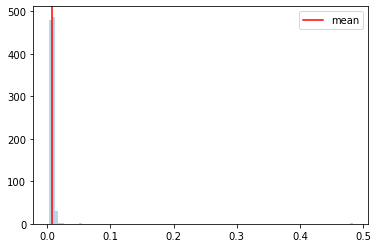

In [113]:
model_dir_in_experiments = []
for experiment_index, experiment_values in all_experiments.items():
    try:
        model_param.update(experiment_values)
        mjpc = MertonJumpsPoissonCovariance(None, data_loader, None, **model_param)
        model_dir = mjpc.model_dir

        print("Starting Inference for Model")
        print(model_dir)
        print(experiment_values)
        print("\n")
        
        model_dir_in_experiments.append(model_dir)
        experiment_dir = os.path.join(model_dir,"experiment_file.json")

        json.dump(experiment_values,open(experiment_dir,"w"))
        mjpc.inference(data_loader, **inference_param)
    except:
        print("Problem")
        print(experiment_values)
        pass

In [114]:
model_dir_in_experiments

['c:\\users\\cesar\\desktop\\projects\\general\\deep_random_fields\\results\\merton_jumps_poisson_covariance\\1654364868',
 'c:\\users\\cesar\\desktop\\projects\\general\\deep_random_fields\\results\\merton_jumps_poisson_covariance\\1654365163',
 'c:\\users\\cesar\\desktop\\projects\\general\\deep_random_fields\\results\\merton_jumps_poisson_covariance\\1654365468',
 'c:\\users\\cesar\\desktop\\projects\\general\\deep_random_fields\\results\\merton_jumps_poisson_covariance\\1654365767',
 'c:\\users\\cesar\\desktop\\projects\\general\\deep_random_fields\\results\\merton_jumps_poisson_covariance\\1654366055',
 'c:\\users\\cesar\\desktop\\projects\\general\\deep_random_fields\\results\\merton_jumps_poisson_covariance\\1654366340',
 'c:\\users\\cesar\\desktop\\projects\\general\\deep_random_fields\\results\\merton_jumps_poisson_covariance\\1654366634',
 'c:\\users\\cesar\\desktop\\projects\\general\\deep_random_fields\\results\\merton_jumps_poisson_covariance\\1654366907',
 'c:\\users\\ces